<a id='exec-sum'></a>
## EXECUTIVE SUMMARY

### *Stock Trading Case Study*:

* Observing Situations: 
 
    * Adding trend of last 3 days 
        * 1000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 8000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 20000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 20000 episodes with epsilon = 0.1
  
     * Adding trend of last 5 days 
        * 1000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 8000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 20000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 20000 episodes with epsilon = 0.1
 
     * Adding Slope
        * 1000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 8000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 20000 episodes with reducing epsilon from ( 1 up to 0.1)
        * 40000 episodes with reducing epsilon from ( 1 up to 0.1)


            
|Situation   |   Random Action in the Test Environment |  Exploid & Explore in the Test Environment  | 
:---        |    :----:   |  :----  |
| last 3 days: 1000 episodes with reducing epsilon from ( 1 up to 0.1)| 23 575 |  23 301 | 
| last 3 days: 8000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 463|  21 815 | 
| last 3 days: 20000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 466| 20 753 | 
| last 3 days: 20000 episodes with reducing epsilon = 0.1| 23 466 | 25 823 |
| last 5 days: 1000 episodes with reducing epsilon from ( 1 up to 0.1)| 23 575 | 20 32  | 
| last 5 days: 8000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 463|  22 203 | 
| last 5 days: 20000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 466| 22 668 | 
| last 5 days: 20000 episodes with reducing epsilon = 0.1| 23 466 | 21 148 |
| % differences: 1000 episodes with reducing epsilon from ( 1 up to 0.1)| 23 091 | 29 651  | 
| % differences: 8000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 176 |  27 402 | 
| % differences: 20000 episodes with reducing epsilon from ( 1 up to 0.1)|  23 204| 27 693 | 
| % differences: 40000 episodes with reducing epsilon = 0.1| 23 193 | 31 572 |

#### *Results*:

##### *Comparing adding 3 days trend & 5 days trend*:
Under the same gamma,epsilon and alpha parameters, decreasing lambda led to moving more steps from initial position to terminal position compare to running the code with higher lambda.

Function parameters set to gamma is 0.9, alpha = 0.1, decreasing epsilon value from 0.1 to 0.05 when number of iteration increases could not affect converged characterictic of model ( After 8000 iterations, agent takes more accurent actions.) On the other hand, increasing epsilon from 0.05 to 0.1 when number of iteration increases significantly impacts to agent' decisions. Model was converged after 2000 iterations, furthermore, desirable results can be obtained faster. 

Effect of gamma-alpha pairs was observed under the dynamic epsilon approach, Not find a valuable differences on results.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import itertools
import pickle

from sklearn.preprocessing import StandardScaler

In [2]:
path = r'C:/Users/... # Enter the path of csv file
data = pd.read_csv(path)
data

,AAPL,MSI,SBUX
0,67.8542,60.30,28.185
1,68.5614,60.90,28.070
2,66.8428,60.83,28.130
3,66.7156,60.81,27.915
4,66.6556,61.12,27.775
...,...,...,...
1254,167.7800,99.12,56.000
1255,160.5000,103.87,55.770
1256,156.4900,101.06,54.690
1257,163.0300,102.76,55.610


<AxesSubplot:>

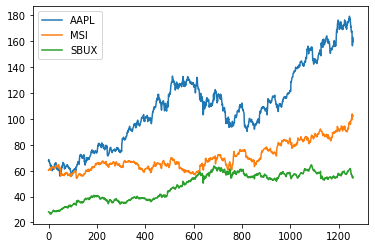

In [3]:
data.plot()

In [4]:
class MultiStockEnv:
    """
    A 3-stock trading environment.
    State: vector of size 7 (n_stock * 2 + 1)
        - # shares of stock 1 owned
        - # shares of stock 2 owned
        - # shares of stock 3 owned
        - price of stock 1 (using daily close price)
        - price of stock 2
        - price of stock 3
        - cash owned (can be used to purchase more stocks)
    Action: categorical variable with 27 (3^3) possibilities
        - for each stock, you can:
        - 0 = sell
        - 1 = hold
        - 2 = buy
    """
    def __init__(self, data, initial_investment=20000):
        # data
        self.stock_price_history = data
        self.n_step, self.n_stock = self.stock_price_history.shape

        # instance attributes
        self.initial_investment = initial_investment
        self.cur_step = None
        self.stock_owned = None
        self.stock_price = None
        self.cash_in_hand = None

        self.action_space = np.arange(3**self.n_stock)

        # action permutations
        # returns a nested list with elements like:
        # [0,0,0]
        # [0,0,1]
        # [0,0,2]
        # [0,1,0]
        # [0,1,1]
        # etc.
        # 0 = sell
        # 1 = hold
        # 2 = buy
        self.action_list = list(map(list, itertools.product([0, 1, 2], repeat=self.n_stock)))

        # calculate size of state
        self.state_dim = self.n_stock * 2 + 1

        self.reset()


    def reset(self):
        self.cur_step = 0
        self.stock_owned = np.zeros(self.n_stock)
        self.stock_price = self.stock_price_history[self.cur_step]
        self.cash_in_hand = self.initial_investment
        return self._get_obs()


    def step(self, action):
        assert action in self.action_space

        # get current value before performing the action
        prev_val = self._get_val()

        # update price, i.e. go to the next day
        self.cur_step += 1
        self.stock_price = self.stock_price_history[self.cur_step]

        # perform the trade
        self._trade(action)

        # get the new value after taking the action
        cur_val = self._get_val()

        # reward is the increase in porfolio value
        reward = cur_val - prev_val

        # done if we have run out of data
        done = self.cur_step == self.n_step - 1

        # store the current value of the portfolio here
        info = {'cur_val': cur_val}

        # conform to the Gym API
        return self._get_obs(), reward, done, info


    def _get_obs(self):
        obs = np.empty(self.state_dim)
        obs[:self.n_stock] = self.stock_owned
        obs[self.n_stock:2*self.n_stock] = self.stock_price
        obs[-1] = self.cash_in_hand
        return obs
    
    def _get_val(self):
        return self.stock_owned.dot(self.stock_price) + self.cash_in_hand

    def _trade(self, action):
        # index the action we want to perform
        # 0 = sell
        # 1 = hold
        # 2 = buy
        # e.g. [2,1,0] means:
        # buy first stock
        # hold second stock
        # sell third stock
        action_vec = self.action_list[action]

        # determine which stocks to buy or sell
        sell_index = [] # stores index of stocks we want to sell
        buy_index = [] # stores index of stocks we want to buy
        for i, a in enumerate(action_vec):
            if a == 0:
                sell_index.append(i)
            elif a == 2:
                buy_index.append(i)

        # sell any stocks we want to sell
        # then buy any stocks we want to buy
        if sell_index:
            # NOTE: to simplify the problem, when we sell, we will sell ALL shares of that stock
            for i in sell_index:
                self.cash_in_hand += self.stock_price[i] * self.stock_owned[i]
                self.stock_owned[i] = 0
        if buy_index:
            # NOTE: when buying, we will loop through each stock we want to buy,
            #       and buy one share at a time until we run out of cash
            can_buy = True
            while can_buy:
                for i in buy_index:
                    if self.cash_in_hand > self.stock_price[i]:
                        self.stock_owned[i] += 1 # buy one share
                        self.cash_in_hand -= self.stock_price[i]
                    else:
                        can_buy = False

In [5]:
n_timesteps, n_stocks = data.shape

In [6]:
n_train = n_timesteps // 2
n_train

629

In [7]:
train_data = data[:n_train].values
test_data = data[n_train:].values

In [8]:
env = MultiStockEnv(train_data,initial_investment=20000)

In [9]:
env.reset()

array([    0.    ,     0.    ,     0.    ,    67.8542,    60.3   ,
          28.185 , 20000.    ])

In [10]:
env.action_list

[[0, 0, 0],
 [0, 0, 1],
 [0, 0, 2],
 [0, 1, 0],
 [0, 1, 1],
 [0, 1, 2],
 [0, 2, 0],
 [0, 2, 1],
 [0, 2, 2],
 [1, 0, 0],
 [1, 0, 1],
 [1, 0, 2],
 [1, 1, 0],
 [1, 1, 1],
 [1, 1, 2],
 [1, 2, 0],
 [1, 2, 1],
 [1, 2, 2],
 [2, 0, 0],
 [2, 0, 1],
 [2, 0, 2],
 [2, 1, 0],
 [2, 1, 1],
 [2, 1, 2],
 [2, 2, 0],
 [2, 2, 1],
 [2, 2, 2]]

In [11]:
def predict(X,W,b):
    # make sure X is N x D
    assert(len(X.shape) == 2)
    return X.dot(W) + b

In [12]:
def sgd(X,Y,W,b,vW,vb,learning_rate=0.01, momentum=0.9):
    assert(len(X.shape) == 2)
    # the loss values are 2-D
    # normally we would divide by N only
    # but now we divide by N x K
    num_values = np.prod(Y.shape)
    # do one step of gradient descent
    # we multiply by 2 to get the exact gradient
    # (not adjusting the learning rate)
    # i.e. d/dx (x^2) --> 2x
    Yhat = predict(X,W,b)
    gW = 2 * X.T.dot(Yhat - Y) / num_values
    gb = 2 * (Yhat - Y).sum(axis=0) / num_values

    # update momentum terms
    vW = momentum * vW - learning_rate * gW
    vb = momentum * vb - learning_rate * gb

    # update params
    W += vW
    b += vb
    return W,b,vW,vb

In [13]:
def greedy_policy(state,W,b,epsilon):
    if np.random.rand() <= epsilon:
        return np.random.choice(action_size)
    else:
        act_values = predict(state,W,b)
        return np.argmax(act_values[0])  # returns action

In [14]:
def get_scaler(env):
    # return scikit-learn scaler object to scale the states after fitting the scaler with some random actions
    states = []
    #play game 100 times with random actions to collect some states
    for i in range(100):
        for j in range(env.n_step):
            action = np.random.choice(env.action_space)
            state, reward, done, info = env.step(action)
            states.append(state)
            if done:
                env.reset()
                break
    scaler = StandardScaler()
    scaler.fit(states)
    return scaler

In [15]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 2000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
saving_models_path = r"C:/Users/..."
np.savez(saving_models_path + "/TraderWeights_lecture_train.npz", W=W, b=b)

episode: 1/2000, episode end value: 25076.33
episode: 2/2000, episode end value: 36735.00
episode: 3/2000, episode end value: 40398.62
episode: 4/2000, episode end value: 40331.56
episode: 5/2000, episode end value: 31233.82
episode: 6/2000, episode end value: 42363.55
episode: 7/2000, episode end value: 39928.64
episode: 8/2000, episode end value: 40561.07
episode: 9/2000, episode end value: 40221.22
episode: 10/2000, episode end value: 32520.09
episode: 11/2000, episode end value: 33978.18
episode: 12/2000, episode end value: 41345.52
episode: 13/2000, episode end value: 42897.90
episode: 14/2000, episode end value: 45076.61
episode: 15/2000, episode end value: 40929.00
episode: 16/2000, episode end value: 33324.44
episode: 17/2000, episode end value: 33702.96
episode: 18/2000, episode end value: 37539.11
episode: 19/2000, episode end value: 40346.94
episode: 20/2000, episode end value: 40841.95
episode: 21/2000, episode end value: 43448.17
episode: 22/2000, episode end value: 42113.

episode: 178/2000, episode end value: 30480.46
episode: 179/2000, episode end value: 43686.29
episode: 180/2000, episode end value: 47905.75
episode: 181/2000, episode end value: 40866.62
episode: 182/2000, episode end value: 34668.01
episode: 183/2000, episode end value: 40963.17
episode: 184/2000, episode end value: 42747.66
episode: 185/2000, episode end value: 40406.09
episode: 186/2000, episode end value: 42744.00
episode: 187/2000, episode end value: 41472.20
episode: 188/2000, episode end value: 39214.82
episode: 189/2000, episode end value: 45141.69
episode: 190/2000, episode end value: 44027.81
episode: 191/2000, episode end value: 44909.07
episode: 192/2000, episode end value: 40168.53
episode: 193/2000, episode end value: 41554.31
episode: 194/2000, episode end value: 40564.11
episode: 195/2000, episode end value: 44788.06
episode: 196/2000, episode end value: 42908.13
episode: 197/2000, episode end value: 43563.36
episode: 198/2000, episode end value: 40338.09
episode: 199/

episode: 353/2000, episode end value: 44297.23
episode: 354/2000, episode end value: 41527.41
episode: 355/2000, episode end value: 48057.88
episode: 356/2000, episode end value: 44029.30
episode: 357/2000, episode end value: 41931.06
episode: 358/2000, episode end value: 45022.04
episode: 359/2000, episode end value: 42921.84
episode: 360/2000, episode end value: 52474.06
episode: 361/2000, episode end value: 42734.72
episode: 362/2000, episode end value: 39943.40
episode: 363/2000, episode end value: 44755.92
episode: 364/2000, episode end value: 39617.85
episode: 365/2000, episode end value: 42619.46
episode: 366/2000, episode end value: 45937.82
episode: 367/2000, episode end value: 45665.46
episode: 368/2000, episode end value: 38961.71
episode: 369/2000, episode end value: 44673.49
episode: 370/2000, episode end value: 46564.70
episode: 371/2000, episode end value: 44521.70
episode: 372/2000, episode end value: 45792.19
episode: 373/2000, episode end value: 43340.24
episode: 374/

episode: 528/2000, episode end value: 52513.42
episode: 529/2000, episode end value: 47129.13
episode: 530/2000, episode end value: 44005.57
episode: 531/2000, episode end value: 51631.02
episode: 532/2000, episode end value: 52140.80
episode: 533/2000, episode end value: 47207.99
episode: 534/2000, episode end value: 54179.35
episode: 535/2000, episode end value: 51807.80
episode: 536/2000, episode end value: 46538.08
episode: 537/2000, episode end value: 46349.84
episode: 538/2000, episode end value: 48548.52
episode: 539/2000, episode end value: 53435.10
episode: 540/2000, episode end value: 53476.62
episode: 541/2000, episode end value: 45047.29
episode: 542/2000, episode end value: 45480.88
episode: 543/2000, episode end value: 50652.97
episode: 544/2000, episode end value: 58911.89
episode: 545/2000, episode end value: 55305.66
episode: 546/2000, episode end value: 51202.52
episode: 547/2000, episode end value: 56218.92
episode: 548/2000, episode end value: 51187.06
episode: 549/

episode: 704/2000, episode end value: 50153.82
episode: 705/2000, episode end value: 49738.03
episode: 706/2000, episode end value: 59346.63
episode: 707/2000, episode end value: 52756.67
episode: 708/2000, episode end value: 55416.15
episode: 709/2000, episode end value: 55542.74
episode: 710/2000, episode end value: 53254.73
episode: 711/2000, episode end value: 45708.77
episode: 712/2000, episode end value: 57748.59
episode: 713/2000, episode end value: 53544.46
episode: 714/2000, episode end value: 57899.84
episode: 715/2000, episode end value: 42805.82
episode: 716/2000, episode end value: 49829.22
episode: 717/2000, episode end value: 49014.08
episode: 718/2000, episode end value: 52203.33
episode: 719/2000, episode end value: 42114.90
episode: 720/2000, episode end value: 39205.12
episode: 721/2000, episode end value: 43342.99
episode: 722/2000, episode end value: 60797.53
episode: 723/2000, episode end value: 45707.66
episode: 724/2000, episode end value: 46641.08
episode: 725/

episode: 879/2000, episode end value: 61197.06
episode: 880/2000, episode end value: 52700.03
episode: 881/2000, episode end value: 48256.02
episode: 882/2000, episode end value: 47736.77
episode: 883/2000, episode end value: 39686.12
episode: 884/2000, episode end value: 48694.85
episode: 885/2000, episode end value: 52722.19
episode: 886/2000, episode end value: 61548.14
episode: 887/2000, episode end value: 43383.58
episode: 888/2000, episode end value: 47244.07
episode: 889/2000, episode end value: 59189.24
episode: 890/2000, episode end value: 55484.56
episode: 891/2000, episode end value: 61030.33
episode: 892/2000, episode end value: 51759.19
episode: 893/2000, episode end value: 48771.45
episode: 894/2000, episode end value: 58926.86
episode: 895/2000, episode end value: 54271.98
episode: 896/2000, episode end value: 54824.04
episode: 897/2000, episode end value: 48787.56
episode: 898/2000, episode end value: 54046.26
episode: 899/2000, episode end value: 47028.70
episode: 900/

episode: 1053/2000, episode end value: 56937.10
episode: 1054/2000, episode end value: 55933.02
episode: 1055/2000, episode end value: 44328.26
episode: 1056/2000, episode end value: 50339.42
episode: 1057/2000, episode end value: 46779.32
episode: 1058/2000, episode end value: 40216.10
episode: 1059/2000, episode end value: 51847.20
episode: 1060/2000, episode end value: 45363.00
episode: 1061/2000, episode end value: 35864.31
episode: 1062/2000, episode end value: 61501.08
episode: 1063/2000, episode end value: 56699.47
episode: 1064/2000, episode end value: 54524.13
episode: 1065/2000, episode end value: 60415.85
episode: 1066/2000, episode end value: 52897.85
episode: 1067/2000, episode end value: 47319.49
episode: 1068/2000, episode end value: 49951.34
episode: 1069/2000, episode end value: 53126.96
episode: 1070/2000, episode end value: 62310.19
episode: 1071/2000, episode end value: 57006.64
episode: 1072/2000, episode end value: 58583.07
episode: 1073/2000, episode end value: 5

episode: 1225/2000, episode end value: 55463.53
episode: 1226/2000, episode end value: 49825.62
episode: 1227/2000, episode end value: 51098.68
episode: 1228/2000, episode end value: 52620.80
episode: 1229/2000, episode end value: 53641.11
episode: 1230/2000, episode end value: 53143.64
episode: 1231/2000, episode end value: 50499.06
episode: 1232/2000, episode end value: 55748.11
episode: 1233/2000, episode end value: 52233.63
episode: 1234/2000, episode end value: 48750.54
episode: 1235/2000, episode end value: 50266.64
episode: 1236/2000, episode end value: 51204.03
episode: 1237/2000, episode end value: 52690.32
episode: 1238/2000, episode end value: 55001.55
episode: 1239/2000, episode end value: 47569.64
episode: 1240/2000, episode end value: 45199.72
episode: 1241/2000, episode end value: 52318.59
episode: 1242/2000, episode end value: 53440.57
episode: 1243/2000, episode end value: 50230.46
episode: 1244/2000, episode end value: 48260.74
episode: 1245/2000, episode end value: 5

episode: 1397/2000, episode end value: 55184.59
episode: 1398/2000, episode end value: 47569.15
episode: 1399/2000, episode end value: 46889.41
episode: 1400/2000, episode end value: 56129.39
episode: 1401/2000, episode end value: 50884.56
episode: 1402/2000, episode end value: 56329.90
episode: 1403/2000, episode end value: 50731.43
episode: 1404/2000, episode end value: 51146.95
episode: 1405/2000, episode end value: 51313.89
episode: 1406/2000, episode end value: 48504.56
episode: 1407/2000, episode end value: 47293.81
episode: 1408/2000, episode end value: 49323.03
episode: 1409/2000, episode end value: 50937.48
episode: 1410/2000, episode end value: 56516.08
episode: 1411/2000, episode end value: 40715.53
episode: 1412/2000, episode end value: 46064.60
episode: 1413/2000, episode end value: 44451.04
episode: 1414/2000, episode end value: 47397.99
episode: 1415/2000, episode end value: 44298.42
episode: 1416/2000, episode end value: 49837.26
episode: 1417/2000, episode end value: 4

episode: 1568/2000, episode end value: 60988.00
episode: 1569/2000, episode end value: 49972.90
episode: 1570/2000, episode end value: 55745.06
episode: 1571/2000, episode end value: 54164.15
episode: 1572/2000, episode end value: 54412.44
episode: 1573/2000, episode end value: 44981.73
episode: 1574/2000, episode end value: 54343.01
episode: 1575/2000, episode end value: 54831.50
episode: 1576/2000, episode end value: 60667.30
episode: 1577/2000, episode end value: 61605.45
episode: 1578/2000, episode end value: 59742.10
episode: 1579/2000, episode end value: 57309.40
episode: 1580/2000, episode end value: 52550.14
episode: 1581/2000, episode end value: 59985.55
episode: 1582/2000, episode end value: 54090.43
episode: 1583/2000, episode end value: 54993.87
episode: 1584/2000, episode end value: 52059.04
episode: 1585/2000, episode end value: 55617.24
episode: 1586/2000, episode end value: 58738.13
episode: 1587/2000, episode end value: 52606.06
episode: 1588/2000, episode end value: 5

episode: 1739/2000, episode end value: 46106.08
episode: 1740/2000, episode end value: 47381.47
episode: 1741/2000, episode end value: 56732.65
episode: 1742/2000, episode end value: 47616.92
episode: 1743/2000, episode end value: 45834.63
episode: 1744/2000, episode end value: 56008.72
episode: 1745/2000, episode end value: 52906.44
episode: 1746/2000, episode end value: 50389.50
episode: 1747/2000, episode end value: 51117.30
episode: 1748/2000, episode end value: 52475.98
episode: 1749/2000, episode end value: 58168.06
episode: 1750/2000, episode end value: 50047.64
episode: 1751/2000, episode end value: 51810.26
episode: 1752/2000, episode end value: 60255.74
episode: 1753/2000, episode end value: 52306.86
episode: 1754/2000, episode end value: 51246.46
episode: 1755/2000, episode end value: 50995.16
episode: 1756/2000, episode end value: 55256.42
episode: 1757/2000, episode end value: 48318.72
episode: 1758/2000, episode end value: 52909.63
episode: 1759/2000, episode end value: 4

episode: 1910/2000, episode end value: 46335.39
episode: 1911/2000, episode end value: 52546.47
episode: 1912/2000, episode end value: 53769.17
episode: 1913/2000, episode end value: 64675.47
episode: 1914/2000, episode end value: 52515.15
episode: 1915/2000, episode end value: 47729.82
episode: 1916/2000, episode end value: 61015.70
episode: 1917/2000, episode end value: 56925.96
episode: 1918/2000, episode end value: 60907.22
episode: 1919/2000, episode end value: 58515.92
episode: 1920/2000, episode end value: 64673.50
episode: 1921/2000, episode end value: 67019.34
episode: 1922/2000, episode end value: 49547.38
episode: 1923/2000, episode end value: 50145.38
episode: 1924/2000, episode end value: 47031.71
episode: 1925/2000, episode end value: 48563.00
episode: 1926/2000, episode end value: 49092.71
episode: 1927/2000, episode end value: 53171.95
episode: 1928/2000, episode end value: 42029.64
episode: 1929/2000, episode end value: 48889.16
episode: 1930/2000, episode end value: 5

In [16]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path + "/TraderWeights_lecture_train.npz")
W = npz['W']
b = npz['b']

In [17]:
W

array([[   32.83148756,    42.26844643,   112.36531712,   -46.942872  ,
          -13.15837934,   310.26803516,   236.36452484,    88.06862184,
          -51.04960342,   -12.62067289,     5.44769994,  -138.32568599,
          -35.32292157,   -16.05271208,    59.10567529,  -152.47233468,
            2.94498377,   -42.48940492,     2.89605705,   -75.16950951,
          -64.88545615,    60.40708616,  -141.57977464,    15.97932904,
          -99.55195364,    27.90051055,   239.1075172 ],
       [  104.22134201,   109.77812981,   161.13855424,    91.0498618 ,
           69.25101507,   215.11603475,   270.75433714,   145.23850725,
          123.52467422,    91.25798624,   147.2930214 ,    -2.77251905,
           91.24115536,   139.98235631,   117.7955985 ,   -28.24383632,
          117.46098082,   142.42056536,    90.4846414 ,   150.33020862,
          130.50655459,   186.92259587,    34.84501118,   128.76064799,
           73.29286821,   120.44052443,   538.1027146 ],
       [   92.07519355

In [18]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/2000, episode end value: 32227.39
episode: 2/2000, episode end value: 32373.20
episode: 3/2000, episode end value: 24727.41
episode: 4/2000, episode end value: 34656.15
episode: 5/2000, episode end value: 27286.21
episode: 6/2000, episode end value: 33765.02
episode: 7/2000, episode end value: 36077.70
episode: 8/2000, episode end value: 30373.30
episode: 9/2000, episode end value: 32373.20
episode: 10/2000, episode end value: 29815.24
episode: 11/2000, episode end value: 36976.35
episode: 12/2000, episode end value: 31396.75
episode: 13/2000, episode end value: 31547.79
episode: 14/2000, episode end value: 30077.67
episode: 15/2000, episode end value: 30822.07
episode: 16/2000, episode end value: 32226.96
episode: 17/2000, episode end value: 28105.81
episode: 18/2000, episode end value: 32443.69
episode: 19/2000, episode end value: 29147.23
episode: 20/2000, episode end value: 26731.01
episode: 21/2000, episode end value: 29423.32
episode: 22/2000, episode end value: 31628.

episode: 179/2000, episode end value: 27863.58
episode: 180/2000, episode end value: 32278.24
episode: 181/2000, episode end value: 25526.44
episode: 182/2000, episode end value: 31877.24
episode: 183/2000, episode end value: 32535.07
episode: 184/2000, episode end value: 30477.96
episode: 185/2000, episode end value: 27867.33
episode: 186/2000, episode end value: 32657.31
episode: 187/2000, episode end value: 25274.69
episode: 188/2000, episode end value: 32373.20
episode: 189/2000, episode end value: 32373.20
episode: 190/2000, episode end value: 29078.68
episode: 191/2000, episode end value: 24357.75
episode: 192/2000, episode end value: 24432.40
episode: 193/2000, episode end value: 32373.20
episode: 194/2000, episode end value: 25852.33
episode: 195/2000, episode end value: 29160.75
episode: 196/2000, episode end value: 32791.06
episode: 197/2000, episode end value: 32248.60
episode: 198/2000, episode end value: 32373.20
episode: 199/2000, episode end value: 32959.83
episode: 200/

episode: 357/2000, episode end value: 24953.02
episode: 358/2000, episode end value: 28204.61
episode: 359/2000, episode end value: 21318.33
episode: 360/2000, episode end value: 25406.26
episode: 361/2000, episode end value: 32582.49
episode: 362/2000, episode end value: 28349.63
episode: 363/2000, episode end value: 31408.35
episode: 364/2000, episode end value: 24468.66
episode: 365/2000, episode end value: 32364.74
episode: 366/2000, episode end value: 28994.46
episode: 367/2000, episode end value: 32373.20
episode: 368/2000, episode end value: 27920.50
episode: 369/2000, episode end value: 24889.41
episode: 370/2000, episode end value: 30023.16
episode: 371/2000, episode end value: 24452.93
episode: 372/2000, episode end value: 30228.22
episode: 373/2000, episode end value: 27285.15
episode: 374/2000, episode end value: 27065.31
episode: 375/2000, episode end value: 30357.95
episode: 376/2000, episode end value: 30050.64
episode: 377/2000, episode end value: 31749.11
episode: 378/

episode: 532/2000, episode end value: 25265.66
episode: 533/2000, episode end value: 32373.20
episode: 534/2000, episode end value: 32354.30
episode: 535/2000, episode end value: 27494.03
episode: 536/2000, episode end value: 24593.29
episode: 537/2000, episode end value: 26049.85
episode: 538/2000, episode end value: 28075.58
episode: 539/2000, episode end value: 34011.58
episode: 540/2000, episode end value: 25163.47
episode: 541/2000, episode end value: 37359.07
episode: 542/2000, episode end value: 28525.94
episode: 543/2000, episode end value: 32373.20
episode: 544/2000, episode end value: 32138.89
episode: 545/2000, episode end value: 32488.46
episode: 546/2000, episode end value: 31133.64
episode: 547/2000, episode end value: 28440.35
episode: 548/2000, episode end value: 32373.20
episode: 549/2000, episode end value: 27040.31
episode: 550/2000, episode end value: 32373.20
episode: 551/2000, episode end value: 31627.72
episode: 552/2000, episode end value: 24675.10
episode: 553/

episode: 709/2000, episode end value: 28660.67
episode: 710/2000, episode end value: 29597.14
episode: 711/2000, episode end value: 32350.70
episode: 712/2000, episode end value: 27927.29
episode: 713/2000, episode end value: 28134.50
episode: 714/2000, episode end value: 32373.20
episode: 715/2000, episode end value: 27018.66
episode: 716/2000, episode end value: 28793.08
episode: 717/2000, episode end value: 32329.10
episode: 718/2000, episode end value: 31623.36
episode: 719/2000, episode end value: 27239.69
episode: 720/2000, episode end value: 26955.04
episode: 721/2000, episode end value: 29985.81
episode: 722/2000, episode end value: 27357.29
episode: 723/2000, episode end value: 27087.99
episode: 724/2000, episode end value: 24336.95
episode: 725/2000, episode end value: 32362.07
episode: 726/2000, episode end value: 32566.63
episode: 727/2000, episode end value: 32638.44
episode: 728/2000, episode end value: 27917.41
episode: 729/2000, episode end value: 30435.26
episode: 730/

episode: 884/2000, episode end value: 27016.70
episode: 885/2000, episode end value: 32249.93
episode: 886/2000, episode end value: 32575.56
episode: 887/2000, episode end value: 32373.20
episode: 888/2000, episode end value: 29639.35
episode: 889/2000, episode end value: 27173.27
episode: 890/2000, episode end value: 32572.17
episode: 891/2000, episode end value: 25902.83
episode: 892/2000, episode end value: 25178.48
episode: 893/2000, episode end value: 29401.49
episode: 894/2000, episode end value: 23070.59
episode: 895/2000, episode end value: 32440.15
episode: 896/2000, episode end value: 32373.20
episode: 897/2000, episode end value: 32653.61
episode: 898/2000, episode end value: 23093.36
episode: 899/2000, episode end value: 32274.70
episode: 900/2000, episode end value: 28659.64
episode: 901/2000, episode end value: 32171.07
episode: 902/2000, episode end value: 28390.24
episode: 903/2000, episode end value: 28630.54
episode: 904/2000, episode end value: 29031.32
episode: 905/

episode: 1059/2000, episode end value: 28702.40
episode: 1060/2000, episode end value: 32373.20
episode: 1061/2000, episode end value: 29956.52
episode: 1062/2000, episode end value: 28997.37
episode: 1063/2000, episode end value: 26065.49
episode: 1064/2000, episode end value: 29108.92
episode: 1065/2000, episode end value: 21307.55
episode: 1066/2000, episode end value: 32363.50
episode: 1067/2000, episode end value: 32266.49
episode: 1068/2000, episode end value: 24188.68
episode: 1069/2000, episode end value: 31828.90
episode: 1070/2000, episode end value: 32373.20
episode: 1071/2000, episode end value: 33477.30
episode: 1072/2000, episode end value: 32373.20
episode: 1073/2000, episode end value: 26899.91
episode: 1074/2000, episode end value: 30314.96
episode: 1075/2000, episode end value: 32328.94
episode: 1076/2000, episode end value: 26472.89
episode: 1077/2000, episode end value: 32373.20
episode: 1078/2000, episode end value: 28153.83
episode: 1079/2000, episode end value: 3

episode: 1231/2000, episode end value: 32944.39
episode: 1232/2000, episode end value: 32469.45
episode: 1233/2000, episode end value: 27303.05
episode: 1234/2000, episode end value: 27381.90
episode: 1235/2000, episode end value: 23830.66
episode: 1236/2000, episode end value: 26331.39
episode: 1237/2000, episode end value: 30847.60
episode: 1238/2000, episode end value: 31074.28
episode: 1239/2000, episode end value: 27101.84
episode: 1240/2000, episode end value: 26034.61
episode: 1241/2000, episode end value: 27848.52
episode: 1242/2000, episode end value: 27819.87
episode: 1243/2000, episode end value: 32373.20
episode: 1244/2000, episode end value: 20903.62
episode: 1245/2000, episode end value: 29992.22
episode: 1246/2000, episode end value: 32373.20
episode: 1247/2000, episode end value: 28103.20
episode: 1248/2000, episode end value: 29631.89
episode: 1249/2000, episode end value: 28153.82
episode: 1250/2000, episode end value: 30673.65
episode: 1251/2000, episode end value: 2

episode: 1403/2000, episode end value: 33918.65
episode: 1404/2000, episode end value: 30022.88
episode: 1405/2000, episode end value: 32405.06
episode: 1406/2000, episode end value: 24153.70
episode: 1407/2000, episode end value: 31973.65
episode: 1408/2000, episode end value: 22849.20
episode: 1409/2000, episode end value: 27993.12
episode: 1410/2000, episode end value: 33271.39
episode: 1411/2000, episode end value: 30235.08
episode: 1412/2000, episode end value: 32227.85
episode: 1413/2000, episode end value: 29210.28
episode: 1414/2000, episode end value: 24959.62
episode: 1415/2000, episode end value: 26232.32
episode: 1416/2000, episode end value: 31114.87
episode: 1417/2000, episode end value: 31135.83
episode: 1418/2000, episode end value: 32373.20
episode: 1419/2000, episode end value: 32373.20
episode: 1420/2000, episode end value: 25592.02
episode: 1421/2000, episode end value: 29906.60
episode: 1422/2000, episode end value: 27239.03
episode: 1423/2000, episode end value: 3

episode: 1575/2000, episode end value: 33167.76
episode: 1576/2000, episode end value: 30074.65
episode: 1577/2000, episode end value: 31925.62
episode: 1578/2000, episode end value: 30924.07
episode: 1579/2000, episode end value: 24414.64
episode: 1580/2000, episode end value: 27671.59
episode: 1581/2000, episode end value: 23200.28
episode: 1582/2000, episode end value: 28571.30
episode: 1583/2000, episode end value: 29654.39
episode: 1584/2000, episode end value: 28732.13
episode: 1585/2000, episode end value: 29330.70
episode: 1586/2000, episode end value: 32373.20
episode: 1587/2000, episode end value: 24594.38
episode: 1588/2000, episode end value: 32373.20
episode: 1589/2000, episode end value: 31410.66
episode: 1590/2000, episode end value: 33101.75
episode: 1591/2000, episode end value: 32373.20
episode: 1592/2000, episode end value: 32373.20
episode: 1593/2000, episode end value: 32373.20
episode: 1594/2000, episode end value: 28679.29
episode: 1595/2000, episode end value: 2

episode: 1747/2000, episode end value: 23052.02
episode: 1748/2000, episode end value: 25602.23
episode: 1749/2000, episode end value: 32643.05
episode: 1750/2000, episode end value: 28495.75
episode: 1751/2000, episode end value: 29870.64
episode: 1752/2000, episode end value: 32058.65
episode: 1753/2000, episode end value: 34807.13
episode: 1754/2000, episode end value: 27480.56
episode: 1755/2000, episode end value: 28985.19
episode: 1756/2000, episode end value: 32451.75
episode: 1757/2000, episode end value: 32435.96
episode: 1758/2000, episode end value: 29587.15
episode: 1759/2000, episode end value: 28050.72
episode: 1760/2000, episode end value: 30159.72
episode: 1761/2000, episode end value: 29453.59
episode: 1762/2000, episode end value: 27147.80
episode: 1763/2000, episode end value: 29582.38
episode: 1764/2000, episode end value: 28966.34
episode: 1765/2000, episode end value: 31006.38
episode: 1766/2000, episode end value: 27501.63
episode: 1767/2000, episode end value: 2

episode: 1919/2000, episode end value: 27241.55
episode: 1920/2000, episode end value: 29991.14
episode: 1921/2000, episode end value: 30843.60
episode: 1922/2000, episode end value: 32373.20
episode: 1923/2000, episode end value: 34863.49
episode: 1924/2000, episode end value: 32283.14
episode: 1925/2000, episode end value: 31716.55
episode: 1926/2000, episode end value: 31524.06
episode: 1927/2000, episode end value: 29045.56
episode: 1928/2000, episode end value: 26984.98
episode: 1929/2000, episode end value: 28582.73
episode: 1930/2000, episode end value: 32974.88
episode: 1931/2000, episode end value: 32253.22
episode: 1932/2000, episode end value: 25142.19
episode: 1933/2000, episode end value: 26920.50
episode: 1934/2000, episode end value: 30623.45
episode: 1935/2000, episode end value: 28893.98
episode: 1936/2000, episode end value: 28210.54
episode: 1937/2000, episode end value: 32373.20
episode: 1938/2000, episode end value: 21547.60
episode: 1939/2000, episode end value: 2

In [19]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/2000, episode end value: 21172.47
episode: 2/2000, episode end value: 30347.43
episode: 3/2000, episode end value: 22427.10
episode: 4/2000, episode end value: 38796.15
episode: 5/2000, episode end value: 38920.86
episode: 6/2000, episode end value: 31671.02
episode: 7/2000, episode end value: 32637.78
episode: 8/2000, episode end value: 23404.49
episode: 9/2000, episode end value: 20608.17
episode: 10/2000, episode end value: 46674.31
episode: 11/2000, episode end value: 21318.84
episode: 12/2000, episode end value: 30278.56
episode: 13/2000, episode end value: 14336.00
episode: 14/2000, episode end value: 29408.74
episode: 15/2000, episode end value: 25824.91
episode: 16/2000, episode end value: 30745.74
episode: 17/2000, episode end value: 27527.49
episode: 18/2000, episode end value: 28777.44
episode: 19/2000, episode end value: 23216.20
episode: 20/2000, episode end value: 32913.26
episode: 21/2000, episode end value: 33793.09
episode: 22/2000, episode end value: 22321.

episode: 179/2000, episode end value: 18933.72
episode: 180/2000, episode end value: 15192.68
episode: 181/2000, episode end value: 29151.91
episode: 182/2000, episode end value: 20409.30
episode: 183/2000, episode end value: 33186.67
episode: 184/2000, episode end value: 23218.18
episode: 185/2000, episode end value: 30295.30
episode: 186/2000, episode end value: 21294.87
episode: 187/2000, episode end value: 14650.81
episode: 188/2000, episode end value: 29432.36
episode: 189/2000, episode end value: 24857.21
episode: 190/2000, episode end value: 39727.41
episode: 191/2000, episode end value: 25620.36
episode: 192/2000, episode end value: 22884.17
episode: 193/2000, episode end value: 17756.91
episode: 194/2000, episode end value: 21253.75
episode: 195/2000, episode end value: 23182.10
episode: 196/2000, episode end value: 31193.22
episode: 197/2000, episode end value: 21781.22
episode: 198/2000, episode end value: 27083.81
episode: 199/2000, episode end value: 16415.94
episode: 200/

episode: 355/2000, episode end value: 31577.20
episode: 356/2000, episode end value: 23393.69
episode: 357/2000, episode end value: 25588.68
episode: 358/2000, episode end value: 26152.51
episode: 359/2000, episode end value: 20823.34
episode: 360/2000, episode end value: 20659.97
episode: 361/2000, episode end value: 26586.76
episode: 362/2000, episode end value: 26112.69
episode: 363/2000, episode end value: 23383.10
episode: 364/2000, episode end value: 26863.97
episode: 365/2000, episode end value: 26541.25
episode: 366/2000, episode end value: 26415.80
episode: 367/2000, episode end value: 24936.80
episode: 368/2000, episode end value: 17860.77
episode: 369/2000, episode end value: 29537.65
episode: 370/2000, episode end value: 35306.85
episode: 371/2000, episode end value: 17543.81
episode: 372/2000, episode end value: 29423.30
episode: 373/2000, episode end value: 28819.34
episode: 374/2000, episode end value: 25725.95
episode: 375/2000, episode end value: 24028.27
episode: 376/

episode: 532/2000, episode end value: 24209.91
episode: 533/2000, episode end value: 24070.17
episode: 534/2000, episode end value: 21255.10
episode: 535/2000, episode end value: 24256.21
episode: 536/2000, episode end value: 29792.77
episode: 537/2000, episode end value: 41172.42
episode: 538/2000, episode end value: 28809.71
episode: 539/2000, episode end value: 23534.63
episode: 540/2000, episode end value: 24655.09
episode: 541/2000, episode end value: 20362.29
episode: 542/2000, episode end value: 24627.06
episode: 543/2000, episode end value: 26632.54
episode: 544/2000, episode end value: 22772.26
episode: 545/2000, episode end value: 22511.68
episode: 546/2000, episode end value: 37616.61
episode: 547/2000, episode end value: 26219.06
episode: 548/2000, episode end value: 22529.20
episode: 549/2000, episode end value: 37558.42
episode: 550/2000, episode end value: 26978.35
episode: 551/2000, episode end value: 28673.22
episode: 552/2000, episode end value: 22548.11
episode: 553/

episode: 708/2000, episode end value: 18296.61
episode: 709/2000, episode end value: 24108.58
episode: 710/2000, episode end value: 27559.51
episode: 711/2000, episode end value: 26931.57
episode: 712/2000, episode end value: 28450.64
episode: 713/2000, episode end value: 24404.80
episode: 714/2000, episode end value: 32017.31
episode: 715/2000, episode end value: 18661.83
episode: 716/2000, episode end value: 22164.52
episode: 717/2000, episode end value: 21668.99
episode: 718/2000, episode end value: 23942.25
episode: 719/2000, episode end value: 31822.85
episode: 720/2000, episode end value: 26032.63
episode: 721/2000, episode end value: 31458.61
episode: 722/2000, episode end value: 25074.05
episode: 723/2000, episode end value: 29438.70
episode: 724/2000, episode end value: 26598.91
episode: 725/2000, episode end value: 28361.70
episode: 726/2000, episode end value: 27456.44
episode: 727/2000, episode end value: 25439.92
episode: 728/2000, episode end value: 26527.52
episode: 729/

episode: 884/2000, episode end value: 31316.45
episode: 885/2000, episode end value: 20569.15
episode: 886/2000, episode end value: 20397.81
episode: 887/2000, episode end value: 27388.61
episode: 888/2000, episode end value: 22979.56
episode: 889/2000, episode end value: 18982.37
episode: 890/2000, episode end value: 25262.01
episode: 891/2000, episode end value: 17821.46
episode: 892/2000, episode end value: 16928.06
episode: 893/2000, episode end value: 28369.11
episode: 894/2000, episode end value: 29330.23
episode: 895/2000, episode end value: 28669.94
episode: 896/2000, episode end value: 21364.77
episode: 897/2000, episode end value: 29815.15
episode: 898/2000, episode end value: 20321.41
episode: 899/2000, episode end value: 25132.07
episode: 900/2000, episode end value: 22955.84
episode: 901/2000, episode end value: 30075.19
episode: 902/2000, episode end value: 32247.71
episode: 903/2000, episode end value: 26509.05
episode: 904/2000, episode end value: 24411.34
episode: 905/

episode: 1059/2000, episode end value: 30294.55
episode: 1060/2000, episode end value: 28536.18
episode: 1061/2000, episode end value: 21799.51
episode: 1062/2000, episode end value: 31333.37
episode: 1063/2000, episode end value: 32112.07
episode: 1064/2000, episode end value: 31231.25
episode: 1065/2000, episode end value: 18171.07
episode: 1066/2000, episode end value: 19589.06
episode: 1067/2000, episode end value: 23997.90
episode: 1068/2000, episode end value: 26073.02
episode: 1069/2000, episode end value: 22975.56
episode: 1070/2000, episode end value: 29839.49
episode: 1071/2000, episode end value: 33791.90
episode: 1072/2000, episode end value: 25135.19
episode: 1073/2000, episode end value: 25984.75
episode: 1074/2000, episode end value: 21227.11
episode: 1075/2000, episode end value: 18449.23
episode: 1076/2000, episode end value: 25064.81
episode: 1077/2000, episode end value: 28099.25
episode: 1078/2000, episode end value: 23309.00
episode: 1079/2000, episode end value: 2

episode: 1231/2000, episode end value: 19508.34
episode: 1232/2000, episode end value: 30950.39
episode: 1233/2000, episode end value: 23170.50
episode: 1234/2000, episode end value: 26821.20
episode: 1235/2000, episode end value: 18404.08
episode: 1236/2000, episode end value: 20510.73
episode: 1237/2000, episode end value: 24460.72
episode: 1238/2000, episode end value: 23327.32
episode: 1239/2000, episode end value: 25297.78
episode: 1240/2000, episode end value: 28335.66
episode: 1241/2000, episode end value: 29795.05
episode: 1242/2000, episode end value: 26789.05
episode: 1243/2000, episode end value: 21529.91
episode: 1244/2000, episode end value: 27663.75
episode: 1245/2000, episode end value: 18117.02
episode: 1246/2000, episode end value: 15645.73
episode: 1247/2000, episode end value: 22938.53
episode: 1248/2000, episode end value: 33009.45
episode: 1249/2000, episode end value: 27027.65
episode: 1250/2000, episode end value: 32077.69
episode: 1251/2000, episode end value: 2

episode: 1403/2000, episode end value: 20942.19
episode: 1404/2000, episode end value: 27254.85
episode: 1405/2000, episode end value: 20100.16
episode: 1406/2000, episode end value: 15044.55
episode: 1407/2000, episode end value: 27489.30
episode: 1408/2000, episode end value: 31552.42
episode: 1409/2000, episode end value: 24307.26
episode: 1410/2000, episode end value: 17614.22
episode: 1411/2000, episode end value: 29664.34
episode: 1412/2000, episode end value: 17127.33
episode: 1413/2000, episode end value: 36343.25
episode: 1414/2000, episode end value: 30131.87
episode: 1415/2000, episode end value: 23125.52
episode: 1416/2000, episode end value: 22851.67
episode: 1417/2000, episode end value: 16662.70
episode: 1418/2000, episode end value: 25902.61
episode: 1419/2000, episode end value: 29194.97
episode: 1420/2000, episode end value: 22791.69
episode: 1421/2000, episode end value: 29716.91
episode: 1422/2000, episode end value: 32420.60
episode: 1423/2000, episode end value: 2

episode: 1574/2000, episode end value: 35206.32
episode: 1575/2000, episode end value: 24867.45
episode: 1576/2000, episode end value: 28328.12
episode: 1577/2000, episode end value: 29503.92
episode: 1578/2000, episode end value: 38167.71
episode: 1579/2000, episode end value: 25997.29
episode: 1580/2000, episode end value: 30066.23
episode: 1581/2000, episode end value: 21975.79
episode: 1582/2000, episode end value: 24930.84
episode: 1583/2000, episode end value: 25378.95
episode: 1584/2000, episode end value: 23245.97
episode: 1585/2000, episode end value: 21905.19
episode: 1586/2000, episode end value: 21377.17
episode: 1587/2000, episode end value: 24998.70
episode: 1588/2000, episode end value: 21406.01
episode: 1589/2000, episode end value: 24623.12
episode: 1590/2000, episode end value: 24444.70
episode: 1591/2000, episode end value: 22154.59
episode: 1592/2000, episode end value: 27708.44
episode: 1593/2000, episode end value: 26695.60
episode: 1594/2000, episode end value: 2

episode: 1745/2000, episode end value: 24267.81
episode: 1746/2000, episode end value: 28875.05
episode: 1747/2000, episode end value: 29123.31
episode: 1748/2000, episode end value: 30305.69
episode: 1749/2000, episode end value: 19049.82
episode: 1750/2000, episode end value: 20801.10
episode: 1751/2000, episode end value: 23827.86
episode: 1752/2000, episode end value: 23148.98
episode: 1753/2000, episode end value: 27939.59
episode: 1754/2000, episode end value: 33208.97
episode: 1755/2000, episode end value: 39788.24
episode: 1756/2000, episode end value: 24108.51
episode: 1757/2000, episode end value: 24187.31
episode: 1758/2000, episode end value: 18839.49
episode: 1759/2000, episode end value: 19617.81
episode: 1760/2000, episode end value: 23984.69
episode: 1761/2000, episode end value: 28119.31
episode: 1762/2000, episode end value: 16979.83
episode: 1763/2000, episode end value: 27722.62
episode: 1764/2000, episode end value: 22958.96
episode: 1765/2000, episode end value: 2

episode: 1917/2000, episode end value: 26721.92
episode: 1918/2000, episode end value: 22354.85
episode: 1919/2000, episode end value: 31126.23
episode: 1920/2000, episode end value: 19798.83
episode: 1921/2000, episode end value: 21859.94
episode: 1922/2000, episode end value: 25397.31
episode: 1923/2000, episode end value: 24042.43
episode: 1924/2000, episode end value: 22710.65
episode: 1925/2000, episode end value: 24584.37
episode: 1926/2000, episode end value: 21509.80
episode: 1927/2000, episode end value: 16472.60
episode: 1928/2000, episode end value: 28833.75
episode: 1929/2000, episode end value: 18122.92
episode: 1930/2000, episode end value: 34342.71
episode: 1931/2000, episode end value: 21748.13
episode: 1932/2000, episode end value: 31980.95
episode: 1933/2000, episode end value: 26119.76
episode: 1934/2000, episode end value: 29121.66
episode: 1935/2000, episode end value: 29676.90
episode: 1936/2000, episode end value: 26802.40
episode: 1937/2000, episode end value: 2

In [20]:
np.savez( saving_models_path + "/TraderPortfolios_lecture.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [21]:
npz = np.load(saving_models_path + "/TraderPortfolios_lecture.npz"")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

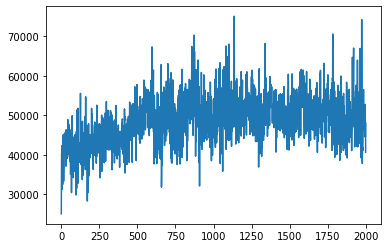

In [22]:
plt.plot(TrainingPortfolio)

(array([  3.,  17.,  98., 405., 671., 539., 206.,  46.,  11.,   4.]),
 array([25076.3308    , 30074.95967   , 35073.58854   , 40072.21741   ,
        45070.84628   , 50069.47515   , 55068.10402   , 60066.73289   ,
        65065.36176   , 70063.99063   , 75062.61949999]),
 <BarContainer object of 10 artists>)

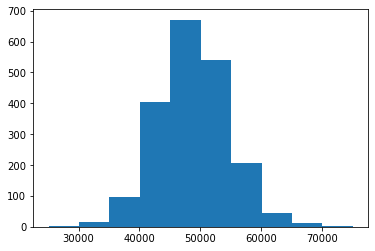

In [23]:
plt.hist(TrainingPortfolio)

In [24]:
np.mean(TestPortfolio)

29810.887477500015

(array([  1.,  15.,  94., 208., 449., 388., 726.,  86.,  28.,   5.]),
 array([17820.57 , 20033.566, 22246.562, 24459.558, 26672.554, 28885.55 ,
        31098.546, 33311.542, 35524.538, 37737.534, 39950.53 ]),
 <BarContainer object of 10 artists>)

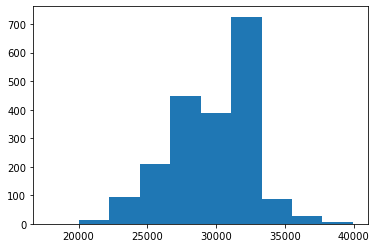

In [25]:
plt.hist(TestPortfolio)

(array([ 24., 204., 539., 553., 388., 203.,  58.,  20.,   9.,   2.]),
 array([11664.905 , 15620.0205, 19575.136 , 23530.2515, 27485.367 ,
        31440.4825, 35395.598 , 39350.7135, 43305.829 , 47260.9445,
        51216.06  ]),
 <BarContainer object of 10 artists>)

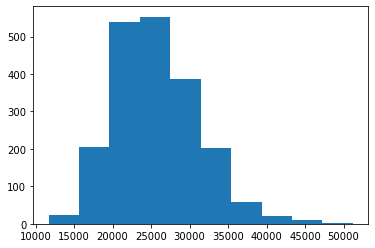

In [26]:
plt.hist(RandomPortfolio)

In [27]:
np.mean(RandomPortfolio)

25663.900752499667

In [28]:
test_data[-1]

array([159.54, 102.63,  54.46])

In [29]:
PercentIncrease=(test_data[-1]-test_data[0])/test_data[0]

In [30]:
np.mean(PercentIncrease)

0.30142914393594666

## Term Project

### Adding trend of last 3 days

In [289]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1259 entries, 0 to 1258
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   AAPL    1259 non-null   float64
 1   MSI     1259 non-null   float64
 2   SBUX    1259 non-null   float64
dtypes: float64(3)
memory usage: 29.6 KB


In [290]:
data['AAPL_3days'] = data['AAPL'].rolling(3).mean()
data['MSI_3days'] = data['MSI'].rolling(3).mean()
data['SBUX_3days'] = data['SBUX'].rolling(3).mean()

In [291]:
data.fillna(method = 'bfill',inplace=True)

In [292]:
data

,AAPL,MSI,SBUX,AAPL_3days,MSI_3days,SBUX_3days
0,67.8542,60.30,28.185,67.752800,60.676667,28.128333
1,68.5614,60.90,28.070,67.752800,60.676667,28.128333
2,66.8428,60.83,28.130,67.752800,60.676667,28.128333
3,66.7156,60.81,27.915,67.373267,60.846667,28.038333
4,66.6556,61.12,27.775,66.738000,60.920000,27.940000
...,...,...,...,...,...,...
1254,167.7800,99.12,56.000,167.393333,99.460000,56.666667
1255,160.5000,103.87,55.770,165.236667,100.816667,56.193333
1256,156.4900,101.06,54.690,161.590000,101.350000,55.486667
1257,163.0300,102.76,55.610,160.006667,102.563333,55.356667


In [293]:
# RSI ( relative strength index ) , ROE (Return on Equity)

In [294]:
class MultiStockEnv:
    """
    A 3-stock trading environment.
    State: vector of size 7 (n_stock * 2 + 1)
        - # shares of stock 1 owned
        - # shares of stock 2 owned
        - # shares of stock 3 owned
        - price of stock 1 (using daily close price)
        - price of stock 2
        - price of stock 3
        - cash owned (can be used to purchase more stocks)
    Action: categorical variable with 27 (3^3) possibilities
        - for each stock, you can:
        - 0 = sell
        - 1 = hold
        - 2 = buy
    """
    def __init__(self, data, initial_investment=20000):
        # data
        self.stock_price_history = data
        self.n_step, self.n_stock = self.stock_price_history.shape

        # instance attributes
        self.initial_investment = initial_investment
        self.cur_step = None
        self.stock_owned = None
        self.stock_price = None
        self.cash_in_hand = None

        self.action_space = np.arange(3**self.n_stock)

        # action permutations
        # returns a nested list with elements like:
        # [0,0,0]
        # [0,0,1]
        # [0,0,2]
        # [0,1,0]
        # [0,1,1]
        # etc.
        # 0 = sell
        # 1 = hold
        # 2 = buy
        self.action_list = list(map(list, itertools.product([0, 1, 2], repeat=self.n_stock)))
        
        
        # calculate size of state
        self.state_dim = self.n_stock * 2 + 1

        self.reset()


    def reset(self):
        self.cur_step = 0
        self.stock_owned = np.zeros(self.n_stock)
        self.stock_price = self.stock_price_history[self.cur_step]
        self.cash_in_hand = self.initial_investment
        return self._get_obs()


    def step(self, action):
        assert action in self.action_space

        # get current value before performing the action
        prev_val = self._get_val()

        # update price, i.e. go to the next day
        self.cur_step += 1
        self.stock_price = self.stock_price_history[self.cur_step]

        # perform the trade
        self._trade(action)

        # get the new value after taking the action
        cur_val = self._get_val()

        # reward is the increase in porfolio value
        reward = cur_val - prev_val

        # done if we have run out of data
        done = self.cur_step == self.n_step - 1

        # store the current value of the portfolio here
        info = {'cur_val': cur_val}

        # conform to the Gym API
        return self._get_obs(), reward, done, info


    def _get_obs(self):
        obs = np.empty(self.state_dim)
        obs[:self.n_stock] = self.stock_owned
        obs[self.n_stock:2*self.n_stock] = self.stock_price
        obs[-1] = self.cash_in_hand
        return obs
    
    def _get_val(self):
        return self.stock_owned.dot(self.stock_price) + self.cash_in_hand

    def _trade(self, action):
        # index the action we want to perform
        # 0 = sell
        # 1 = hold
        # 2 = buy
        # e.g. [2,1,0] means:
        # buy first stock
        # hold second stock
        # sell third stock
        action_vec = self.action_list[action]

        # determine which stocks to buy or sell
        sell_index = [] # stores index of stocks we want to sell
        buy_index = [] # stores index of stocks we want to buy

            
        for i, a in enumerate(action_vec):
            if ((action_vec[0] + action_vec[4])/2 < 1) & (i<3):
                sell_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i ==3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 5):
                sell_index.append(2)
                
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i < 3):
                buy_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 5):
                sell_index.append(2)     
                
                

        # sell any stocks we want to sell
        # then buy any stocks we want to buy
        if sell_index:
            # NOTE: to simplify the problem, when we sell, we will sell ALL shares of that stock
            for i in sell_index:
                self.cash_in_hand += self.stock_price[i] * self.stock_owned[i]
                self.stock_owned[i] = 0
        if buy_index:
            # NOTE: when buying, we will loop through each stock we want to buy,
            #       and buy one share at a time until we run out of cash
            can_buy = True
            while can_buy:
                for i in buy_index:
                    if self.cash_in_hand > self.stock_price[i]:
                        self.stock_owned[i] += 1 # buy one share
                        self.cash_in_hand -= self.stock_price[i]
                    else:
                        can_buy = False

In [295]:
n_timesteps, n_stocks = data.shape

In [296]:
env.action_list

[[0, 0, 0],
 [0, 0, 1],
 [0, 0, 2],
 [0, 1, 0],
 [0, 1, 1],
 [0, 1, 2],
 [0, 2, 0],
 [0, 2, 1],
 [0, 2, 2],
 [1, 0, 0],
 [1, 0, 1],
 [1, 0, 2],
 [1, 1, 0],
 [1, 1, 1],
 [1, 1, 2],
 [1, 2, 0],
 [1, 2, 1],
 [1, 2, 2],
 [2, 0, 0],
 [2, 0, 1],
 [2, 0, 2],
 [2, 1, 0],
 [2, 1, 1],
 [2, 1, 2],
 [2, 2, 0],
 [2, 2, 1],
 [2, 2, 2]]

In [297]:
n_train = n_timesteps // 2
n_train

629

In [298]:
train_data = data[:n_train].values
test_data = data[n_train:].values

In [299]:
env = MultiStockEnv(train_data,initial_investment=20000)

In [300]:
env.reset()

array([    0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,    67.8542    ,    60.3       ,
          28.185     ,    67.7528    ,    60.67666667,    28.12833333,
       20000.        ])

In [301]:
def predict(X,W,b):
    # make sure X is N x D
    assert(len(X.shape) == 2)
    return X.dot(W) + b

In [302]:
def sgd(X,Y,W,b,vW,vb,learning_rate=0.01, momentum=0.9):
    assert(len(X.shape) == 2)
    # the loss values are 2-D
    # normally we would divide by N only
    # but now we divide by N x K
    num_values = np.prod(Y.shape)
    # do one step of gradient descent
    # we multiply by 2 to get the exact gradient
    # (not adjusting the learning rate)
    # i.e. d/dx (x^2) --> 2x
    Yhat = predict(X,W,b)
    gW = 2 * X.T.dot(Yhat - Y) / num_values
    gb = 2 * (Yhat - Y).sum(axis=0) / num_values

    # update momentum terms
    vW = momentum * vW - learning_rate * gW
    vb = momentum * vb - learning_rate * gb

    # update params
    W += vW
    b += vb
    return W,b,vW,vb

In [303]:
def greedy_policy(state,W,b,epsilon):
    if np.random.rand() <= epsilon:
        return np.random.choice(action_size)
    else:
        act_values = predict(state,W,b)
        return np.argmax(act_values[0])  # returns action

In [304]:
def get_scaler(env):
    # return scikit-learn scaler object to scale the states after fitting the scaler with some random actions
    states = []
    #play game 100 times with random actions to collect some states
    for i in range(100):
        for j in range(env.n_step):
            action = np.random.choice(env.action_space)
            state, reward, done, info = env.step(action)
            states.append(state)
            if done:
                env.reset()
                break
    scaler = StandardScaler()
    scaler.fit(states)
    return scaler

### 8000 Episode

In [48]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 8000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path + "/TraderWeights_8000_episode.npz", W=W, b=b)

episode: 1/8000, episode end value: 21052.79
episode: 2/8000, episode end value: 25727.15
episode: 3/8000, episode end value: 23992.24
episode: 4/8000, episode end value: 30771.14
episode: 5/8000, episode end value: 30571.01
episode: 6/8000, episode end value: 30238.49
episode: 7/8000, episode end value: 31099.66
episode: 8/8000, episode end value: 30051.95
episode: 9/8000, episode end value: 30051.95
episode: 10/8000, episode end value: 29683.22
episode: 11/8000, episode end value: 30154.67
episode: 12/8000, episode end value: 29464.01
episode: 13/8000, episode end value: 29858.61
episode: 14/8000, episode end value: 29679.76
episode: 15/8000, episode end value: 29860.96
episode: 16/8000, episode end value: 30051.95
episode: 17/8000, episode end value: 30107.61
episode: 18/8000, episode end value: 30545.73
episode: 19/8000, episode end value: 30051.95
episode: 20/8000, episode end value: 30645.37
episode: 21/8000, episode end value: 29086.04
episode: 22/8000, episode end value: 30032.

episode: 178/8000, episode end value: 29729.80
episode: 179/8000, episode end value: 30440.54
episode: 180/8000, episode end value: 29500.31
episode: 181/8000, episode end value: 29732.68
episode: 182/8000, episode end value: 30051.95
episode: 183/8000, episode end value: 29980.12
episode: 184/8000, episode end value: 29915.30
episode: 185/8000, episode end value: 29909.18
episode: 186/8000, episode end value: 30517.75
episode: 187/8000, episode end value: 30390.19
episode: 188/8000, episode end value: 30295.01
episode: 189/8000, episode end value: 30659.38
episode: 190/8000, episode end value: 29643.18
episode: 191/8000, episode end value: 29672.42
episode: 192/8000, episode end value: 30641.37
episode: 193/8000, episode end value: 29243.37
episode: 194/8000, episode end value: 30051.95
episode: 195/8000, episode end value: 30051.95
episode: 196/8000, episode end value: 30051.95
episode: 197/8000, episode end value: 29679.37
episode: 198/8000, episode end value: 30051.95
episode: 199/

episode: 353/8000, episode end value: 29845.85
episode: 354/8000, episode end value: 30152.13
episode: 355/8000, episode end value: 30998.02
episode: 356/8000, episode end value: 29935.15
episode: 357/8000, episode end value: 30051.95
episode: 358/8000, episode end value: 30802.72
episode: 359/8000, episode end value: 29635.96
episode: 360/8000, episode end value: 29936.02
episode: 361/8000, episode end value: 29989.04
episode: 362/8000, episode end value: 30689.13
episode: 363/8000, episode end value: 29806.27
episode: 364/8000, episode end value: 30497.44
episode: 365/8000, episode end value: 29696.61
episode: 366/8000, episode end value: 29723.51
episode: 367/8000, episode end value: 29858.40
episode: 368/8000, episode end value: 29620.33
episode: 369/8000, episode end value: 31371.32
episode: 370/8000, episode end value: 29818.66
episode: 371/8000, episode end value: 30299.28
episode: 372/8000, episode end value: 29908.64
episode: 373/8000, episode end value: 30051.95
episode: 374/

episode: 528/8000, episode end value: 29967.93
episode: 529/8000, episode end value: 29506.07
episode: 530/8000, episode end value: 29979.64
episode: 531/8000, episode end value: 30051.95
episode: 532/8000, episode end value: 29915.02
episode: 533/8000, episode end value: 29799.85
episode: 534/8000, episode end value: 30420.28
episode: 535/8000, episode end value: 30574.32
episode: 536/8000, episode end value: 30531.13
episode: 537/8000, episode end value: 30051.95
episode: 538/8000, episode end value: 29279.58
episode: 539/8000, episode end value: 30530.53
episode: 540/8000, episode end value: 29410.45
episode: 541/8000, episode end value: 30122.07
episode: 542/8000, episode end value: 29956.67
episode: 543/8000, episode end value: 29860.96
episode: 544/8000, episode end value: 29262.85
episode: 545/8000, episode end value: 30077.59
episode: 546/8000, episode end value: 30054.52
episode: 547/8000, episode end value: 29559.21
episode: 548/8000, episode end value: 31346.40
episode: 549/

episode: 703/8000, episode end value: 30056.81
episode: 704/8000, episode end value: 29319.21
episode: 705/8000, episode end value: 30056.15
episode: 706/8000, episode end value: 29701.61
episode: 707/8000, episode end value: 29793.73
episode: 708/8000, episode end value: 29880.30
episode: 709/8000, episode end value: 29884.10
episode: 710/8000, episode end value: 29885.45
episode: 711/8000, episode end value: 30154.02
episode: 712/8000, episode end value: 30618.62
episode: 713/8000, episode end value: 29678.72
episode: 714/8000, episode end value: 29166.89
episode: 715/8000, episode end value: 30126.79
episode: 716/8000, episode end value: 29441.11
episode: 717/8000, episode end value: 30779.52
episode: 718/8000, episode end value: 29785.80
episode: 719/8000, episode end value: 30803.53
episode: 720/8000, episode end value: 31397.88
episode: 721/8000, episode end value: 31644.59
episode: 722/8000, episode end value: 29880.30
episode: 723/8000, episode end value: 29557.17
episode: 724/

episode: 878/8000, episode end value: 30839.69
episode: 879/8000, episode end value: 31239.37
episode: 880/8000, episode end value: 31189.52
episode: 881/8000, episode end value: 30306.25
episode: 882/8000, episode end value: 30267.37
episode: 883/8000, episode end value: 31236.93
episode: 884/8000, episode end value: 31948.40
episode: 885/8000, episode end value: 31160.08
episode: 886/8000, episode end value: 32485.67
episode: 887/8000, episode end value: 30490.30
episode: 888/8000, episode end value: 30906.20
episode: 889/8000, episode end value: 30030.50
episode: 890/8000, episode end value: 30119.61
episode: 891/8000, episode end value: 31491.92
episode: 892/8000, episode end value: 29575.94
episode: 893/8000, episode end value: 31015.97
episode: 894/8000, episode end value: 30741.55
episode: 895/8000, episode end value: 31215.40
episode: 896/8000, episode end value: 29762.08
episode: 897/8000, episode end value: 29808.51
episode: 898/8000, episode end value: 29463.23
episode: 899/

episode: 1052/8000, episode end value: 33011.41
episode: 1053/8000, episode end value: 31825.24
episode: 1054/8000, episode end value: 33126.85
episode: 1055/8000, episode end value: 32356.20
episode: 1056/8000, episode end value: 32190.24
episode: 1057/8000, episode end value: 33284.04
episode: 1058/8000, episode end value: 33728.97
episode: 1059/8000, episode end value: 32047.70
episode: 1060/8000, episode end value: 33511.80
episode: 1061/8000, episode end value: 33986.23
episode: 1062/8000, episode end value: 30273.82
episode: 1063/8000, episode end value: 31634.02
episode: 1064/8000, episode end value: 32357.71
episode: 1065/8000, episode end value: 28403.71
episode: 1066/8000, episode end value: 32173.56
episode: 1067/8000, episode end value: 32041.12
episode: 1068/8000, episode end value: 33488.63
episode: 1069/8000, episode end value: 31785.97
episode: 1070/8000, episode end value: 33657.65
episode: 1071/8000, episode end value: 32109.62
episode: 1072/8000, episode end value: 3

episode: 1223/8000, episode end value: 32142.54
episode: 1224/8000, episode end value: 30658.82
episode: 1225/8000, episode end value: 32231.22
episode: 1226/8000, episode end value: 32066.88
episode: 1227/8000, episode end value: 31842.95
episode: 1228/8000, episode end value: 27771.63
episode: 1229/8000, episode end value: 31710.29
episode: 1230/8000, episode end value: 31016.52
episode: 1231/8000, episode end value: 31886.50
episode: 1232/8000, episode end value: 30400.90
episode: 1233/8000, episode end value: 30846.93
episode: 1234/8000, episode end value: 32477.12
episode: 1235/8000, episode end value: 32338.98
episode: 1236/8000, episode end value: 28009.10
episode: 1237/8000, episode end value: 31800.39
episode: 1238/8000, episode end value: 31389.02
episode: 1239/8000, episode end value: 32162.95
episode: 1240/8000, episode end value: 30996.10
episode: 1241/8000, episode end value: 31754.64
episode: 1242/8000, episode end value: 32418.17
episode: 1243/8000, episode end value: 3

episode: 1394/8000, episode end value: 31282.54
episode: 1395/8000, episode end value: 28981.77
episode: 1396/8000, episode end value: 32231.72
episode: 1397/8000, episode end value: 31100.87
episode: 1398/8000, episode end value: 29020.14
episode: 1399/8000, episode end value: 30946.96
episode: 1400/8000, episode end value: 31154.80
episode: 1401/8000, episode end value: 31483.86
episode: 1402/8000, episode end value: 29579.88
episode: 1403/8000, episode end value: 29319.65
episode: 1404/8000, episode end value: 29256.03
episode: 1405/8000, episode end value: 29916.81
episode: 1406/8000, episode end value: 28896.66
episode: 1407/8000, episode end value: 30070.12
episode: 1408/8000, episode end value: 29463.60
episode: 1409/8000, episode end value: 31367.18
episode: 1410/8000, episode end value: 29974.28
episode: 1411/8000, episode end value: 29974.28
episode: 1412/8000, episode end value: 30062.63
episode: 1413/8000, episode end value: 29974.28
episode: 1414/8000, episode end value: 2

episode: 1565/8000, episode end value: 31811.18
episode: 1566/8000, episode end value: 31588.88
episode: 1567/8000, episode end value: 30817.37
episode: 1568/8000, episode end value: 30172.66
episode: 1569/8000, episode end value: 30904.51
episode: 1570/8000, episode end value: 30826.83
episode: 1571/8000, episode end value: 31105.65
episode: 1572/8000, episode end value: 28784.32
episode: 1573/8000, episode end value: 30764.75
episode: 1574/8000, episode end value: 29269.20
episode: 1575/8000, episode end value: 29441.26
episode: 1576/8000, episode end value: 30676.98
episode: 1577/8000, episode end value: 28403.22
episode: 1578/8000, episode end value: 30562.83
episode: 1579/8000, episode end value: 28990.48
episode: 1580/8000, episode end value: 30626.51
episode: 1581/8000, episode end value: 29975.30
episode: 1582/8000, episode end value: 29287.83
episode: 1583/8000, episode end value: 29517.74
episode: 1584/8000, episode end value: 29734.48
episode: 1585/8000, episode end value: 2

episode: 1736/8000, episode end value: 29412.10
episode: 1737/8000, episode end value: 29319.80
episode: 1738/8000, episode end value: 29447.08
episode: 1739/8000, episode end value: 29793.48
episode: 1740/8000, episode end value: 29030.18
episode: 1741/8000, episode end value: 28570.85
episode: 1742/8000, episode end value: 29289.13
episode: 1743/8000, episode end value: 28967.52
episode: 1744/8000, episode end value: 28993.98
episode: 1745/8000, episode end value: 29085.41
episode: 1746/8000, episode end value: 28634.51
episode: 1747/8000, episode end value: 30388.90
episode: 1748/8000, episode end value: 29793.52
episode: 1749/8000, episode end value: 29757.15
episode: 1750/8000, episode end value: 29471.12
episode: 1751/8000, episode end value: 29521.36
episode: 1752/8000, episode end value: 29329.46
episode: 1753/8000, episode end value: 29022.30
episode: 1754/8000, episode end value: 30000.29
episode: 1755/8000, episode end value: 28854.64
episode: 1756/8000, episode end value: 2

episode: 1907/8000, episode end value: 28903.47
episode: 1908/8000, episode end value: 28711.52
episode: 1909/8000, episode end value: 29230.11
episode: 1910/8000, episode end value: 29131.70
episode: 1911/8000, episode end value: 29280.91
episode: 1912/8000, episode end value: 29559.68
episode: 1913/8000, episode end value: 30025.31
episode: 1914/8000, episode end value: 28987.69
episode: 1915/8000, episode end value: 28679.09
episode: 1916/8000, episode end value: 28771.17
episode: 1917/8000, episode end value: 29085.87
episode: 1918/8000, episode end value: 30899.12
episode: 1919/8000, episode end value: 29074.59
episode: 1920/8000, episode end value: 29445.04
episode: 1921/8000, episode end value: 28915.24
episode: 1922/8000, episode end value: 29143.98
episode: 1923/8000, episode end value: 27474.51
episode: 1924/8000, episode end value: 28421.90
episode: 1925/8000, episode end value: 30799.28
episode: 1926/8000, episode end value: 29364.07
episode: 1927/8000, episode end value: 3

episode: 2078/8000, episode end value: 28202.26
episode: 2079/8000, episode end value: 29699.19
episode: 2080/8000, episode end value: 28926.65
episode: 2081/8000, episode end value: 29044.95
episode: 2082/8000, episode end value: 29336.23
episode: 2083/8000, episode end value: 28135.17
episode: 2084/8000, episode end value: 28609.31
episode: 2085/8000, episode end value: 28384.30
episode: 2086/8000, episode end value: 29037.56
episode: 2087/8000, episode end value: 28271.94
episode: 2088/8000, episode end value: 28920.16
episode: 2089/8000, episode end value: 28709.79
episode: 2090/8000, episode end value: 28317.06
episode: 2091/8000, episode end value: 28349.89
episode: 2092/8000, episode end value: 29090.32
episode: 2093/8000, episode end value: 29718.43
episode: 2094/8000, episode end value: 29233.91
episode: 2095/8000, episode end value: 29082.80
episode: 2096/8000, episode end value: 29253.35
episode: 2097/8000, episode end value: 29256.13
episode: 2098/8000, episode end value: 2

episode: 2249/8000, episode end value: 30089.03
episode: 2250/8000, episode end value: 30052.88
episode: 2251/8000, episode end value: 30253.50
episode: 2252/8000, episode end value: 29927.82
episode: 2253/8000, episode end value: 29238.95
episode: 2254/8000, episode end value: 28875.89
episode: 2255/8000, episode end value: 30179.89
episode: 2256/8000, episode end value: 30124.46
episode: 2257/8000, episode end value: 30287.83
episode: 2258/8000, episode end value: 29371.31
episode: 2259/8000, episode end value: 29777.36
episode: 2260/8000, episode end value: 29777.94
episode: 2261/8000, episode end value: 30101.25
episode: 2262/8000, episode end value: 30820.30
episode: 2263/8000, episode end value: 30991.89
episode: 2264/8000, episode end value: 30676.44
episode: 2265/8000, episode end value: 30043.64
episode: 2266/8000, episode end value: 29390.08
episode: 2267/8000, episode end value: 30384.99
episode: 2268/8000, episode end value: 30327.21
episode: 2269/8000, episode end value: 2

episode: 2420/8000, episode end value: 28869.34
episode: 2421/8000, episode end value: 27088.92
episode: 2422/8000, episode end value: 27013.04
episode: 2423/8000, episode end value: 26788.74
episode: 2424/8000, episode end value: 28660.15
episode: 2425/8000, episode end value: 28396.23
episode: 2426/8000, episode end value: 28880.28
episode: 2427/8000, episode end value: 30227.92
episode: 2428/8000, episode end value: 29703.18
episode: 2429/8000, episode end value: 29490.53
episode: 2430/8000, episode end value: 25726.27
episode: 2431/8000, episode end value: 29024.94
episode: 2432/8000, episode end value: 25076.36
episode: 2433/8000, episode end value: 29353.39
episode: 2434/8000, episode end value: 25231.76
episode: 2435/8000, episode end value: 29021.55
episode: 2436/8000, episode end value: 29476.26
episode: 2437/8000, episode end value: 29442.87
episode: 2438/8000, episode end value: 26507.21
episode: 2439/8000, episode end value: 26063.71
episode: 2440/8000, episode end value: 2

episode: 2591/8000, episode end value: 27714.25
episode: 2592/8000, episode end value: 28009.30
episode: 2593/8000, episode end value: 27968.13
episode: 2594/8000, episode end value: 25699.11
episode: 2595/8000, episode end value: 27936.02
episode: 2596/8000, episode end value: 28920.40
episode: 2597/8000, episode end value: 27851.01
episode: 2598/8000, episode end value: 25271.69
episode: 2599/8000, episode end value: 28153.43
episode: 2600/8000, episode end value: 28088.51
episode: 2601/8000, episode end value: 28628.75
episode: 2602/8000, episode end value: 28726.64
episode: 2603/8000, episode end value: 27907.76
episode: 2604/8000, episode end value: 29076.85
episode: 2605/8000, episode end value: 28444.50
episode: 2606/8000, episode end value: 27926.18
episode: 2607/8000, episode end value: 26484.20
episode: 2608/8000, episode end value: 28051.77
episode: 2609/8000, episode end value: 27412.02
episode: 2610/8000, episode end value: 27356.57
episode: 2611/8000, episode end value: 2

episode: 2762/8000, episode end value: 28422.27
episode: 2763/8000, episode end value: 27996.96
episode: 2764/8000, episode end value: 30467.93
episode: 2765/8000, episode end value: 27054.45
episode: 2766/8000, episode end value: 29132.28
episode: 2767/8000, episode end value: 28131.93
episode: 2768/8000, episode end value: 27622.77
episode: 2769/8000, episode end value: 29076.32
episode: 2770/8000, episode end value: 28767.54
episode: 2771/8000, episode end value: 28216.89
episode: 2772/8000, episode end value: 27857.50
episode: 2773/8000, episode end value: 29082.18
episode: 2774/8000, episode end value: 28195.74
episode: 2775/8000, episode end value: 29441.08
episode: 2776/8000, episode end value: 28715.77
episode: 2777/8000, episode end value: 27610.69
episode: 2778/8000, episode end value: 28526.76
episode: 2779/8000, episode end value: 25201.21
episode: 2780/8000, episode end value: 27251.21
episode: 2781/8000, episode end value: 28774.65
episode: 2782/8000, episode end value: 2

episode: 2933/8000, episode end value: 26926.75
episode: 2934/8000, episode end value: 28952.25
episode: 2935/8000, episode end value: 29300.64
episode: 2936/8000, episode end value: 28026.41
episode: 2937/8000, episode end value: 28031.25
episode: 2938/8000, episode end value: 27894.21
episode: 2939/8000, episode end value: 26361.49
episode: 2940/8000, episode end value: 27885.15
episode: 2941/8000, episode end value: 25435.43
episode: 2942/8000, episode end value: 29112.01
episode: 2943/8000, episode end value: 29169.66
episode: 2944/8000, episode end value: 29128.47
episode: 2945/8000, episode end value: 27226.00
episode: 2946/8000, episode end value: 27892.49
episode: 2947/8000, episode end value: 28965.49
episode: 2948/8000, episode end value: 27338.27
episode: 2949/8000, episode end value: 28316.07
episode: 2950/8000, episode end value: 28501.77
episode: 2951/8000, episode end value: 25994.78
episode: 2952/8000, episode end value: 29253.38
episode: 2953/8000, episode end value: 2

episode: 3104/8000, episode end value: 27443.62
episode: 3105/8000, episode end value: 27171.49
episode: 3106/8000, episode end value: 27780.32
episode: 3107/8000, episode end value: 26763.59
episode: 3108/8000, episode end value: 27752.11
episode: 3109/8000, episode end value: 27686.07
episode: 3110/8000, episode end value: 28273.76
episode: 3111/8000, episode end value: 27577.07
episode: 3112/8000, episode end value: 27961.27
episode: 3113/8000, episode end value: 27979.70
episode: 3114/8000, episode end value: 27586.96
episode: 3115/8000, episode end value: 26524.48
episode: 3116/8000, episode end value: 28193.91
episode: 3117/8000, episode end value: 27587.83
episode: 3118/8000, episode end value: 28030.47
episode: 3119/8000, episode end value: 28022.20
episode: 3120/8000, episode end value: 27718.99
episode: 3121/8000, episode end value: 26797.93
episode: 3122/8000, episode end value: 28463.82
episode: 3123/8000, episode end value: 28014.28
episode: 3124/8000, episode end value: 2

episode: 3275/8000, episode end value: 27645.89
episode: 3276/8000, episode end value: 27745.01
episode: 3277/8000, episode end value: 28120.50
episode: 3278/8000, episode end value: 28100.80
episode: 3279/8000, episode end value: 27752.59
episode: 3280/8000, episode end value: 29336.79
episode: 3281/8000, episode end value: 28317.22
episode: 3282/8000, episode end value: 28244.67
episode: 3283/8000, episode end value: 27309.65
episode: 3284/8000, episode end value: 28007.23
episode: 3285/8000, episode end value: 27877.58
episode: 3286/8000, episode end value: 28530.13
episode: 3287/8000, episode end value: 28506.65
episode: 3288/8000, episode end value: 28077.02
episode: 3289/8000, episode end value: 28493.18
episode: 3290/8000, episode end value: 26073.03
episode: 3291/8000, episode end value: 27787.03
episode: 3292/8000, episode end value: 28239.95
episode: 3293/8000, episode end value: 27895.37
episode: 3294/8000, episode end value: 27622.93
episode: 3295/8000, episode end value: 2

episode: 3446/8000, episode end value: 26794.47
episode: 3447/8000, episode end value: 27165.55
episode: 3448/8000, episode end value: 28006.92
episode: 3449/8000, episode end value: 26584.55
episode: 3450/8000, episode end value: 26395.43
episode: 3451/8000, episode end value: 26672.33
episode: 3452/8000, episode end value: 26619.59
episode: 3453/8000, episode end value: 27327.65
episode: 3454/8000, episode end value: 26394.91
episode: 3455/8000, episode end value: 25506.31
episode: 3456/8000, episode end value: 26937.86
episode: 3457/8000, episode end value: 27399.05
episode: 3458/8000, episode end value: 26439.89
episode: 3459/8000, episode end value: 27304.90
episode: 3460/8000, episode end value: 25913.64
episode: 3461/8000, episode end value: 28082.88
episode: 3462/8000, episode end value: 27319.99
episode: 3463/8000, episode end value: 27176.47
episode: 3464/8000, episode end value: 26407.92
episode: 3465/8000, episode end value: 26416.51
episode: 3466/8000, episode end value: 2

episode: 3617/8000, episode end value: 23953.28
episode: 3618/8000, episode end value: 26576.35
episode: 3619/8000, episode end value: 24376.49
episode: 3620/8000, episode end value: 26087.64
episode: 3621/8000, episode end value: 24730.47
episode: 3622/8000, episode end value: 24590.50
episode: 3623/8000, episode end value: 27290.66
episode: 3624/8000, episode end value: 26034.42
episode: 3625/8000, episode end value: 23805.99
episode: 3626/8000, episode end value: 24160.04
episode: 3627/8000, episode end value: 24183.91
episode: 3628/8000, episode end value: 25759.11
episode: 3629/8000, episode end value: 24572.33
episode: 3630/8000, episode end value: 24742.73
episode: 3631/8000, episode end value: 23165.13
episode: 3632/8000, episode end value: 24330.69
episode: 3633/8000, episode end value: 25812.67
episode: 3634/8000, episode end value: 26081.23
episode: 3635/8000, episode end value: 22705.45
episode: 3636/8000, episode end value: 23334.92
episode: 3637/8000, episode end value: 2

episode: 3788/8000, episode end value: 25053.44
episode: 3789/8000, episode end value: 25327.99
episode: 3790/8000, episode end value: 25686.23
episode: 3791/8000, episode end value: 25787.79
episode: 3792/8000, episode end value: 24451.74
episode: 3793/8000, episode end value: 26059.31
episode: 3794/8000, episode end value: 23936.91
episode: 3795/8000, episode end value: 25654.76
episode: 3796/8000, episode end value: 24660.46
episode: 3797/8000, episode end value: 24169.43
episode: 3798/8000, episode end value: 25219.34
episode: 3799/8000, episode end value: 23012.77
episode: 3800/8000, episode end value: 24891.84
episode: 3801/8000, episode end value: 24971.48
episode: 3802/8000, episode end value: 26805.98
episode: 3803/8000, episode end value: 25578.53
episode: 3804/8000, episode end value: 26299.10
episode: 3805/8000, episode end value: 25795.42
episode: 3806/8000, episode end value: 25086.18
episode: 3807/8000, episode end value: 24726.54
episode: 3808/8000, episode end value: 2

episode: 3959/8000, episode end value: 26658.58
episode: 3960/8000, episode end value: 26292.92
episode: 3961/8000, episode end value: 25680.48
episode: 3962/8000, episode end value: 27256.04
episode: 3963/8000, episode end value: 28288.07
episode: 3964/8000, episode end value: 25641.89
episode: 3965/8000, episode end value: 26542.71
episode: 3966/8000, episode end value: 25407.90
episode: 3967/8000, episode end value: 26956.21
episode: 3968/8000, episode end value: 26551.60
episode: 3969/8000, episode end value: 26194.89
episode: 3970/8000, episode end value: 26225.42
episode: 3971/8000, episode end value: 25486.59
episode: 3972/8000, episode end value: 26153.22
episode: 3973/8000, episode end value: 26924.90
episode: 3974/8000, episode end value: 26659.77
episode: 3975/8000, episode end value: 25905.17
episode: 3976/8000, episode end value: 26658.38
episode: 3977/8000, episode end value: 25168.41
episode: 3978/8000, episode end value: 26138.12
episode: 3979/8000, episode end value: 2

episode: 4130/8000, episode end value: 27512.73
episode: 4131/8000, episode end value: 27221.62
episode: 4132/8000, episode end value: 26559.05
episode: 4133/8000, episode end value: 24252.64
episode: 4134/8000, episode end value: 26900.44
episode: 4135/8000, episode end value: 26864.47
episode: 4136/8000, episode end value: 26264.64
episode: 4137/8000, episode end value: 26747.38
episode: 4138/8000, episode end value: 26294.80
episode: 4139/8000, episode end value: 27545.73
episode: 4140/8000, episode end value: 25641.54
episode: 4141/8000, episode end value: 25876.84
episode: 4142/8000, episode end value: 24596.08
episode: 4143/8000, episode end value: 26661.10
episode: 4144/8000, episode end value: 25233.75
episode: 4145/8000, episode end value: 24696.60
episode: 4146/8000, episode end value: 25879.29
episode: 4147/8000, episode end value: 26265.43
episode: 4148/8000, episode end value: 26615.36
episode: 4149/8000, episode end value: 24216.86
episode: 4150/8000, episode end value: 2

episode: 4301/8000, episode end value: 25742.01
episode: 4302/8000, episode end value: 25933.45
episode: 4303/8000, episode end value: 26611.71
episode: 4304/8000, episode end value: 25915.98
episode: 4305/8000, episode end value: 27058.97
episode: 4306/8000, episode end value: 25409.72
episode: 4307/8000, episode end value: 27369.53
episode: 4308/8000, episode end value: 26261.13
episode: 4309/8000, episode end value: 25387.34
episode: 4310/8000, episode end value: 26417.07
episode: 4311/8000, episode end value: 27486.30
episode: 4312/8000, episode end value: 26004.56
episode: 4313/8000, episode end value: 26175.48
episode: 4314/8000, episode end value: 26259.20
episode: 4315/8000, episode end value: 25914.67
episode: 4316/8000, episode end value: 26695.14
episode: 4317/8000, episode end value: 26147.38
episode: 4318/8000, episode end value: 26183.28
episode: 4319/8000, episode end value: 25933.33
episode: 4320/8000, episode end value: 26542.04
episode: 4321/8000, episode end value: 2

episode: 4472/8000, episode end value: 26277.95
episode: 4473/8000, episode end value: 26469.50
episode: 4474/8000, episode end value: 26689.77
episode: 4475/8000, episode end value: 27024.69
episode: 4476/8000, episode end value: 27112.90
episode: 4477/8000, episode end value: 24295.33
episode: 4478/8000, episode end value: 26679.60
episode: 4479/8000, episode end value: 27220.11
episode: 4480/8000, episode end value: 25867.32
episode: 4481/8000, episode end value: 29078.43
episode: 4482/8000, episode end value: 25886.71
episode: 4483/8000, episode end value: 27289.85
episode: 4484/8000, episode end value: 28411.23
episode: 4485/8000, episode end value: 28371.94
episode: 4486/8000, episode end value: 26106.44
episode: 4487/8000, episode end value: 25918.00
episode: 4488/8000, episode end value: 27105.15
episode: 4489/8000, episode end value: 27141.98
episode: 4490/8000, episode end value: 27806.00
episode: 4491/8000, episode end value: 26243.17
episode: 4492/8000, episode end value: 2

episode: 4643/8000, episode end value: 29272.91
episode: 4644/8000, episode end value: 27266.40
episode: 4645/8000, episode end value: 25696.63
episode: 4646/8000, episode end value: 26169.97
episode: 4647/8000, episode end value: 26346.25
episode: 4648/8000, episode end value: 27002.36
episode: 4649/8000, episode end value: 25722.14
episode: 4650/8000, episode end value: 27494.23
episode: 4651/8000, episode end value: 27955.29
episode: 4652/8000, episode end value: 28131.81
episode: 4653/8000, episode end value: 28606.94
episode: 4654/8000, episode end value: 25562.13
episode: 4655/8000, episode end value: 27269.95
episode: 4656/8000, episode end value: 26981.45
episode: 4657/8000, episode end value: 26994.23
episode: 4658/8000, episode end value: 28056.13
episode: 4659/8000, episode end value: 26800.96
episode: 4660/8000, episode end value: 27271.21
episode: 4661/8000, episode end value: 28532.88
episode: 4662/8000, episode end value: 27193.90
episode: 4663/8000, episode end value: 2

episode: 4814/8000, episode end value: 28315.83
episode: 4815/8000, episode end value: 28098.50
episode: 4816/8000, episode end value: 28498.65
episode: 4817/8000, episode end value: 28855.18
episode: 4818/8000, episode end value: 29887.47
episode: 4819/8000, episode end value: 28664.62
episode: 4820/8000, episode end value: 28468.70
episode: 4821/8000, episode end value: 28478.53
episode: 4822/8000, episode end value: 29262.25
episode: 4823/8000, episode end value: 27233.38
episode: 4824/8000, episode end value: 27842.12
episode: 4825/8000, episode end value: 30595.60
episode: 4826/8000, episode end value: 28457.18
episode: 4827/8000, episode end value: 29199.97
episode: 4828/8000, episode end value: 28448.60
episode: 4829/8000, episode end value: 29720.42
episode: 4830/8000, episode end value: 30554.06
episode: 4831/8000, episode end value: 28313.96
episode: 4832/8000, episode end value: 30387.63
episode: 4833/8000, episode end value: 28504.01
episode: 4834/8000, episode end value: 3

episode: 4985/8000, episode end value: 25209.94
episode: 4986/8000, episode end value: 27479.71
episode: 4987/8000, episode end value: 26399.36
episode: 4988/8000, episode end value: 25939.88
episode: 4989/8000, episode end value: 27388.08
episode: 4990/8000, episode end value: 26783.78
episode: 4991/8000, episode end value: 27092.39
episode: 4992/8000, episode end value: 23937.36
episode: 4993/8000, episode end value: 27344.84
episode: 4994/8000, episode end value: 27383.91
episode: 4995/8000, episode end value: 26417.16
episode: 4996/8000, episode end value: 25076.34
episode: 4997/8000, episode end value: 26841.96
episode: 4998/8000, episode end value: 24904.16
episode: 4999/8000, episode end value: 25396.89
episode: 5000/8000, episode end value: 26811.65
episode: 5001/8000, episode end value: 27080.61
episode: 5002/8000, episode end value: 26261.21
episode: 5003/8000, episode end value: 28550.04
episode: 5004/8000, episode end value: 29235.30
episode: 5005/8000, episode end value: 2

episode: 5156/8000, episode end value: 29653.18
episode: 5157/8000, episode end value: 28770.84
episode: 5158/8000, episode end value: 29754.12
episode: 5159/8000, episode end value: 28309.13
episode: 5160/8000, episode end value: 28509.94
episode: 5161/8000, episode end value: 29653.18
episode: 5162/8000, episode end value: 29312.60
episode: 5163/8000, episode end value: 28414.90
episode: 5164/8000, episode end value: 29728.87
episode: 5165/8000, episode end value: 27159.56
episode: 5166/8000, episode end value: 28704.69
episode: 5167/8000, episode end value: 28918.85
episode: 5168/8000, episode end value: 29782.79
episode: 5169/8000, episode end value: 29791.72
episode: 5170/8000, episode end value: 29653.18
episode: 5171/8000, episode end value: 30583.82
episode: 5172/8000, episode end value: 27851.27
episode: 5173/8000, episode end value: 28970.31
episode: 5174/8000, episode end value: 28342.73
episode: 5175/8000, episode end value: 28471.95
episode: 5176/8000, episode end value: 2

episode: 5327/8000, episode end value: 27307.63
episode: 5328/8000, episode end value: 28202.40
episode: 5329/8000, episode end value: 26291.44
episode: 5330/8000, episode end value: 29310.99
episode: 5331/8000, episode end value: 27024.57
episode: 5332/8000, episode end value: 27437.97
episode: 5333/8000, episode end value: 27968.94
episode: 5334/8000, episode end value: 27028.95
episode: 5335/8000, episode end value: 27723.00
episode: 5336/8000, episode end value: 26679.08
episode: 5337/8000, episode end value: 27626.55
episode: 5338/8000, episode end value: 27537.67
episode: 5339/8000, episode end value: 26539.88
episode: 5340/8000, episode end value: 28721.54
episode: 5341/8000, episode end value: 26726.78
episode: 5342/8000, episode end value: 26980.73
episode: 5343/8000, episode end value: 26492.25
episode: 5344/8000, episode end value: 26910.81
episode: 5345/8000, episode end value: 28047.33
episode: 5346/8000, episode end value: 28771.84
episode: 5347/8000, episode end value: 2

episode: 5498/8000, episode end value: 29921.81
episode: 5499/8000, episode end value: 28740.14
episode: 5500/8000, episode end value: 28683.16
episode: 5501/8000, episode end value: 29107.11
episode: 5502/8000, episode end value: 28479.38
episode: 5503/8000, episode end value: 28995.30
episode: 5504/8000, episode end value: 27134.30
episode: 5505/8000, episode end value: 29292.64
episode: 5506/8000, episode end value: 28590.65
episode: 5507/8000, episode end value: 28348.47
episode: 5508/8000, episode end value: 27505.09
episode: 5509/8000, episode end value: 29277.72
episode: 5510/8000, episode end value: 28497.88
episode: 5511/8000, episode end value: 28004.60
episode: 5512/8000, episode end value: 28348.78
episode: 5513/8000, episode end value: 29050.07
episode: 5514/8000, episode end value: 29084.03
episode: 5515/8000, episode end value: 27440.94
episode: 5516/8000, episode end value: 26526.64
episode: 5517/8000, episode end value: 28892.83
episode: 5518/8000, episode end value: 2

episode: 5669/8000, episode end value: 27096.76
episode: 5670/8000, episode end value: 28740.44
episode: 5671/8000, episode end value: 28683.38
episode: 5672/8000, episode end value: 29230.16
episode: 5673/8000, episode end value: 29259.24
episode: 5674/8000, episode end value: 28536.02
episode: 5675/8000, episode end value: 26865.53
episode: 5676/8000, episode end value: 28809.38
episode: 5677/8000, episode end value: 27807.42
episode: 5678/8000, episode end value: 28616.71
episode: 5679/8000, episode end value: 27658.48
episode: 5680/8000, episode end value: 27643.83
episode: 5681/8000, episode end value: 28780.38
episode: 5682/8000, episode end value: 26867.91
episode: 5683/8000, episode end value: 28807.85
episode: 5684/8000, episode end value: 27621.92
episode: 5685/8000, episode end value: 30543.71
episode: 5686/8000, episode end value: 27339.89
episode: 5687/8000, episode end value: 28581.46
episode: 5688/8000, episode end value: 27114.37
episode: 5689/8000, episode end value: 2

episode: 5840/8000, episode end value: 26934.96
episode: 5841/8000, episode end value: 28263.06
episode: 5842/8000, episode end value: 27121.03
episode: 5843/8000, episode end value: 27837.93
episode: 5844/8000, episode end value: 26647.40
episode: 5845/8000, episode end value: 27771.80
episode: 5846/8000, episode end value: 26586.18
episode: 5847/8000, episode end value: 27540.32
episode: 5848/8000, episode end value: 28396.04
episode: 5849/8000, episode end value: 29609.81
episode: 5850/8000, episode end value: 28608.19
episode: 5851/8000, episode end value: 27921.01
episode: 5852/8000, episode end value: 26790.22
episode: 5853/8000, episode end value: 27893.88
episode: 5854/8000, episode end value: 27426.02
episode: 5855/8000, episode end value: 28744.81
episode: 5856/8000, episode end value: 27440.38
episode: 5857/8000, episode end value: 28090.90
episode: 5858/8000, episode end value: 25173.72
episode: 5859/8000, episode end value: 27149.16
episode: 5860/8000, episode end value: 2

episode: 6011/8000, episode end value: 26854.90
episode: 6012/8000, episode end value: 25910.54
episode: 6013/8000, episode end value: 26658.73
episode: 6014/8000, episode end value: 26540.95
episode: 6015/8000, episode end value: 25910.66
episode: 6016/8000, episode end value: 25678.81
episode: 6017/8000, episode end value: 26063.59
episode: 6018/8000, episode end value: 27750.11
episode: 6019/8000, episode end value: 25959.39
episode: 6020/8000, episode end value: 25235.41
episode: 6021/8000, episode end value: 26601.84
episode: 6022/8000, episode end value: 25956.55
episode: 6023/8000, episode end value: 25840.66
episode: 6024/8000, episode end value: 25221.25
episode: 6025/8000, episode end value: 26862.28
episode: 6026/8000, episode end value: 26365.34
episode: 6027/8000, episode end value: 25745.74
episode: 6028/8000, episode end value: 27749.58
episode: 6029/8000, episode end value: 26459.67
episode: 6030/8000, episode end value: 26393.03
episode: 6031/8000, episode end value: 2

episode: 6182/8000, episode end value: 25966.68
episode: 6183/8000, episode end value: 25591.12
episode: 6184/8000, episode end value: 26650.14
episode: 6185/8000, episode end value: 27418.34
episode: 6186/8000, episode end value: 27625.55
episode: 6187/8000, episode end value: 26558.78
episode: 6188/8000, episode end value: 25514.72
episode: 6189/8000, episode end value: 26328.86
episode: 6190/8000, episode end value: 27602.26
episode: 6191/8000, episode end value: 26619.65
episode: 6192/8000, episode end value: 25820.84
episode: 6193/8000, episode end value: 26591.31
episode: 6194/8000, episode end value: 26011.48
episode: 6195/8000, episode end value: 26310.95
episode: 6196/8000, episode end value: 26762.77
episode: 6197/8000, episode end value: 27615.38
episode: 6198/8000, episode end value: 27273.86
episode: 6199/8000, episode end value: 27659.01
episode: 6200/8000, episode end value: 28508.46
episode: 6201/8000, episode end value: 29310.78
episode: 6202/8000, episode end value: 2

episode: 6353/8000, episode end value: 27540.85
episode: 6354/8000, episode end value: 26890.32
episode: 6355/8000, episode end value: 28384.80
episode: 6356/8000, episode end value: 28323.35
episode: 6357/8000, episode end value: 28594.20
episode: 6358/8000, episode end value: 27455.95
episode: 6359/8000, episode end value: 28053.95
episode: 6360/8000, episode end value: 27773.12
episode: 6361/8000, episode end value: 28147.37
episode: 6362/8000, episode end value: 27750.31
episode: 6363/8000, episode end value: 29116.05
episode: 6364/8000, episode end value: 27042.94
episode: 6365/8000, episode end value: 28612.87
episode: 6366/8000, episode end value: 29062.14
episode: 6367/8000, episode end value: 29087.38
episode: 6368/8000, episode end value: 29168.06
episode: 6369/8000, episode end value: 27374.51
episode: 6370/8000, episode end value: 27332.23
episode: 6371/8000, episode end value: 27492.59
episode: 6372/8000, episode end value: 28737.94
episode: 6373/8000, episode end value: 2

episode: 6524/8000, episode end value: 28536.88
episode: 6525/8000, episode end value: 26983.51
episode: 6526/8000, episode end value: 28474.87
episode: 6527/8000, episode end value: 26961.06
episode: 6528/8000, episode end value: 28058.09
episode: 6529/8000, episode end value: 27049.19
episode: 6530/8000, episode end value: 28142.08
episode: 6531/8000, episode end value: 26796.42
episode: 6532/8000, episode end value: 28233.34
episode: 6533/8000, episode end value: 29639.63
episode: 6534/8000, episode end value: 26726.85
episode: 6535/8000, episode end value: 28577.81
episode: 6536/8000, episode end value: 27073.06
episode: 6537/8000, episode end value: 27956.05
episode: 6538/8000, episode end value: 26986.41
episode: 6539/8000, episode end value: 27773.14
episode: 6540/8000, episode end value: 27814.15
episode: 6541/8000, episode end value: 28514.24
episode: 6542/8000, episode end value: 27308.02
episode: 6543/8000, episode end value: 29633.67
episode: 6544/8000, episode end value: 2

episode: 6695/8000, episode end value: 28932.61
episode: 6696/8000, episode end value: 28124.28
episode: 6697/8000, episode end value: 26805.24
episode: 6698/8000, episode end value: 25449.11
episode: 6699/8000, episode end value: 26140.52
episode: 6700/8000, episode end value: 29170.77
episode: 6701/8000, episode end value: 25474.82
episode: 6702/8000, episode end value: 28898.08
episode: 6703/8000, episode end value: 26841.68
episode: 6704/8000, episode end value: 25985.64
episode: 6705/8000, episode end value: 27060.47
episode: 6706/8000, episode end value: 28750.92
episode: 6707/8000, episode end value: 28322.56
episode: 6708/8000, episode end value: 28063.34
episode: 6709/8000, episode end value: 28045.74
episode: 6710/8000, episode end value: 26226.02
episode: 6711/8000, episode end value: 26814.13
episode: 6712/8000, episode end value: 27534.82
episode: 6713/8000, episode end value: 26961.05
episode: 6714/8000, episode end value: 27470.88
episode: 6715/8000, episode end value: 2

episode: 6866/8000, episode end value: 24868.30
episode: 6867/8000, episode end value: 25526.78
episode: 6868/8000, episode end value: 27174.49
episode: 6869/8000, episode end value: 25725.89
episode: 6870/8000, episode end value: 25067.39
episode: 6871/8000, episode end value: 26383.18
episode: 6872/8000, episode end value: 25210.31
episode: 6873/8000, episode end value: 26017.09
episode: 6874/8000, episode end value: 26263.08
episode: 6875/8000, episode end value: 25282.72
episode: 6876/8000, episode end value: 26140.30
episode: 6877/8000, episode end value: 26078.70
episode: 6878/8000, episode end value: 25830.72
episode: 6879/8000, episode end value: 26428.06
episode: 6880/8000, episode end value: 27141.06
episode: 6881/8000, episode end value: 26501.85
episode: 6882/8000, episode end value: 27634.64
episode: 6883/8000, episode end value: 27144.25
episode: 6884/8000, episode end value: 26140.51
episode: 6885/8000, episode end value: 24938.30
episode: 6886/8000, episode end value: 2

episode: 7037/8000, episode end value: 26140.71
episode: 7038/8000, episode end value: 29411.42
episode: 7039/8000, episode end value: 26226.28
episode: 7040/8000, episode end value: 27582.53
episode: 7041/8000, episode end value: 28198.34
episode: 7042/8000, episode end value: 25346.50
episode: 7043/8000, episode end value: 27614.17
episode: 7044/8000, episode end value: 26382.84
episode: 7045/8000, episode end value: 25173.30
episode: 7046/8000, episode end value: 28278.99
episode: 7047/8000, episode end value: 29410.69
episode: 7048/8000, episode end value: 27316.75
episode: 7049/8000, episode end value: 26696.03
episode: 7050/8000, episode end value: 29262.90
episode: 7051/8000, episode end value: 27348.41
episode: 7052/8000, episode end value: 26843.47
episode: 7053/8000, episode end value: 28878.84
episode: 7054/8000, episode end value: 28448.14
episode: 7055/8000, episode end value: 26926.30
episode: 7056/8000, episode end value: 28532.83
episode: 7057/8000, episode end value: 2

episode: 7208/8000, episode end value: 28278.31
episode: 7209/8000, episode end value: 27901.94
episode: 7210/8000, episode end value: 29135.18
episode: 7211/8000, episode end value: 27081.59
episode: 7212/8000, episode end value: 27517.07
episode: 7213/8000, episode end value: 28807.53
episode: 7214/8000, episode end value: 28241.86
episode: 7215/8000, episode end value: 28452.18
episode: 7216/8000, episode end value: 27053.20
episode: 7217/8000, episode end value: 26879.12
episode: 7218/8000, episode end value: 29087.85
episode: 7219/8000, episode end value: 25720.36
episode: 7220/8000, episode end value: 28399.60
episode: 7221/8000, episode end value: 28117.48
episode: 7222/8000, episode end value: 28496.61
episode: 7223/8000, episode end value: 25678.87
episode: 7224/8000, episode end value: 25871.87
episode: 7225/8000, episode end value: 28872.35
episode: 7226/8000, episode end value: 25327.77
episode: 7227/8000, episode end value: 26400.31
episode: 7228/8000, episode end value: 2

episode: 7379/8000, episode end value: 27750.17
episode: 7380/8000, episode end value: 26271.98
episode: 7381/8000, episode end value: 28095.10
episode: 7382/8000, episode end value: 29112.96
episode: 7383/8000, episode end value: 27429.54
episode: 7384/8000, episode end value: 26461.18
episode: 7385/8000, episode end value: 25042.87
episode: 7386/8000, episode end value: 26748.46
episode: 7387/8000, episode end value: 27806.79
episode: 7388/8000, episode end value: 24763.18
episode: 7389/8000, episode end value: 25561.53
episode: 7390/8000, episode end value: 29472.08
episode: 7391/8000, episode end value: 26584.56
episode: 7392/8000, episode end value: 27837.92
episode: 7393/8000, episode end value: 26007.79
episode: 7394/8000, episode end value: 25492.94
episode: 7395/8000, episode end value: 26068.10
episode: 7396/8000, episode end value: 26455.00
episode: 7397/8000, episode end value: 25678.11
episode: 7398/8000, episode end value: 25094.74
episode: 7399/8000, episode end value: 2

episode: 7550/8000, episode end value: 28999.65
episode: 7551/8000, episode end value: 24874.39
episode: 7552/8000, episode end value: 27595.29
episode: 7553/8000, episode end value: 25801.69
episode: 7554/8000, episode end value: 26685.07
episode: 7555/8000, episode end value: 25690.21
episode: 7556/8000, episode end value: 25853.78
episode: 7557/8000, episode end value: 27203.61
episode: 7558/8000, episode end value: 28441.42
episode: 7559/8000, episode end value: 23843.50
episode: 7560/8000, episode end value: 28683.96
episode: 7561/8000, episode end value: 26699.45
episode: 7562/8000, episode end value: 28021.52
episode: 7563/8000, episode end value: 27315.99
episode: 7564/8000, episode end value: 26809.66
episode: 7565/8000, episode end value: 27407.68
episode: 7566/8000, episode end value: 28540.84
episode: 7567/8000, episode end value: 26488.39
episode: 7568/8000, episode end value: 28614.12
episode: 7569/8000, episode end value: 24008.63
episode: 7570/8000, episode end value: 2

episode: 7721/8000, episode end value: 25095.05
episode: 7722/8000, episode end value: 27798.76
episode: 7723/8000, episode end value: 24784.44
episode: 7724/8000, episode end value: 24517.51
episode: 7725/8000, episode end value: 26986.11
episode: 7726/8000, episode end value: 25997.94
episode: 7727/8000, episode end value: 27049.35
episode: 7728/8000, episode end value: 26376.65
episode: 7729/8000, episode end value: 26029.27
episode: 7730/8000, episode end value: 28925.99
episode: 7731/8000, episode end value: 28926.18
episode: 7732/8000, episode end value: 25911.26
episode: 7733/8000, episode end value: 26281.43
episode: 7734/8000, episode end value: 25622.54
episode: 7735/8000, episode end value: 27023.07
episode: 7736/8000, episode end value: 28443.75
episode: 7737/8000, episode end value: 26688.60
episode: 7738/8000, episode end value: 28108.43
episode: 7739/8000, episode end value: 25442.21
episode: 7740/8000, episode end value: 26867.68
episode: 7741/8000, episode end value: 2

episode: 7892/8000, episode end value: 27631.79
episode: 7893/8000, episode end value: 27059.46
episode: 7894/8000, episode end value: 29318.40
episode: 7895/8000, episode end value: 26609.10
episode: 7896/8000, episode end value: 26164.69
episode: 7897/8000, episode end value: 26469.78
episode: 7898/8000, episode end value: 26382.93
episode: 7899/8000, episode end value: 25910.92
episode: 7900/8000, episode end value: 25654.96
episode: 7901/8000, episode end value: 27352.10
episode: 7902/8000, episode end value: 26493.89
episode: 7903/8000, episode end value: 26138.41
episode: 7904/8000, episode end value: 28445.64
episode: 7905/8000, episode end value: 26150.46
episode: 7906/8000, episode end value: 26743.70
episode: 7907/8000, episode end value: 24704.83
episode: 7908/8000, episode end value: 25292.22
episode: 7909/8000, episode end value: 25415.64
episode: 7910/8000, episode end value: 26662.70
episode: 7911/8000, episode end value: 25190.81
episode: 7912/8000, episode end value: 2

In [49]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path + "/TraderWeights_8000_episode.npz"")
W = npz['W']
b = npz['b']

In [50]:
W

array([[ 2.55951365,  2.75581754,  2.5553474 , ...,  2.6468985 ,
         2.97879051,  2.48829   ],
       [ 2.39583502,  3.18892584,  2.90213933, ...,  2.99901373,
         3.35052045,  2.11112655],
       [ 2.14300382,  2.58700519,  2.3073039 , ...,  2.50406254,
         2.5828192 ,  2.52784028],
       ...,
       [-0.54874757, -1.4927267 , -1.55164434, ..., -1.92473   ,
        -3.50945435, -1.60257781],
       [-1.51458521, -2.12680317, -1.66759411, ..., -2.30628911,
        -2.15959597, -1.83216063],
       [-1.98013394, -2.31275842, -2.68689357, ..., -2.56714549,
        -2.49265269, -2.95961044]])

In [51]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 20923.60
episode: 2/8000, episode end value: 19915.70
episode: 3/8000, episode end value: 20025.13
episode: 4/8000, episode end value: 21379.08
episode: 5/8000, episode end value: 20184.97
episode: 6/8000, episode end value: 21800.00
episode: 7/8000, episode end value: 23486.71
episode: 8/8000, episode end value: 21977.42
episode: 9/8000, episode end value: 20931.04
episode: 10/8000, episode end value: 21010.19
episode: 11/8000, episode end value: 21096.65
episode: 12/8000, episode end value: 21728.08
episode: 13/8000, episode end value: 20843.07
episode: 14/8000, episode end value: 21084.61
episode: 15/8000, episode end value: 21834.99
episode: 16/8000, episode end value: 21447.78
episode: 17/8000, episode end value: 21260.73
episode: 18/8000, episode end value: 22142.81
episode: 19/8000, episode end value: 23873.11
episode: 20/8000, episode end value: 22396.96
episode: 21/8000, episode end value: 21096.65
episode: 22/8000, episode end value: 21372.

episode: 178/8000, episode end value: 19807.96
episode: 179/8000, episode end value: 21770.33
episode: 180/8000, episode end value: 21179.77
episode: 181/8000, episode end value: 23884.08
episode: 182/8000, episode end value: 21768.88
episode: 183/8000, episode end value: 22312.71
episode: 184/8000, episode end value: 24726.14
episode: 185/8000, episode end value: 21096.65
episode: 186/8000, episode end value: 23277.67
episode: 187/8000, episode end value: 22207.35
episode: 188/8000, episode end value: 22005.22
episode: 189/8000, episode end value: 20810.72
episode: 190/8000, episode end value: 22754.06
episode: 191/8000, episode end value: 21096.65
episode: 192/8000, episode end value: 23208.58
episode: 193/8000, episode end value: 20935.31
episode: 194/8000, episode end value: 21061.54
episode: 195/8000, episode end value: 20966.47
episode: 196/8000, episode end value: 21419.99
episode: 197/8000, episode end value: 21161.96
episode: 198/8000, episode end value: 20811.45
episode: 199/

episode: 353/8000, episode end value: 21096.65
episode: 354/8000, episode end value: 22775.50
episode: 355/8000, episode end value: 21747.03
episode: 356/8000, episode end value: 24083.39
episode: 357/8000, episode end value: 21242.98
episode: 358/8000, episode end value: 22340.78
episode: 359/8000, episode end value: 21085.59
episode: 360/8000, episode end value: 24075.85
episode: 361/8000, episode end value: 21096.65
episode: 362/8000, episode end value: 22129.15
episode: 363/8000, episode end value: 21442.09
episode: 364/8000, episode end value: 20771.26
episode: 365/8000, episode end value: 21096.65
episode: 366/8000, episode end value: 21375.03
episode: 367/8000, episode end value: 21096.65
episode: 368/8000, episode end value: 21262.82
episode: 369/8000, episode end value: 22333.76
episode: 370/8000, episode end value: 20705.22
episode: 371/8000, episode end value: 21640.20
episode: 372/8000, episode end value: 23017.94
episode: 373/8000, episode end value: 23498.44
episode: 374/

episode: 530/8000, episode end value: 21096.65
episode: 531/8000, episode end value: 22160.43
episode: 532/8000, episode end value: 22232.78
episode: 533/8000, episode end value: 22016.39
episode: 534/8000, episode end value: 22128.89
episode: 535/8000, episode end value: 21650.05
episode: 536/8000, episode end value: 20116.67
episode: 537/8000, episode end value: 20325.72
episode: 538/8000, episode end value: 21338.70
episode: 539/8000, episode end value: 23280.85
episode: 540/8000, episode end value: 21293.27
episode: 541/8000, episode end value: 21072.00
episode: 542/8000, episode end value: 21096.65
episode: 543/8000, episode end value: 21311.33
episode: 544/8000, episode end value: 21096.65
episode: 545/8000, episode end value: 22218.05
episode: 546/8000, episode end value: 21470.19
episode: 547/8000, episode end value: 21371.09
episode: 548/8000, episode end value: 20692.61
episode: 549/8000, episode end value: 21364.49
episode: 550/8000, episode end value: 22434.62
episode: 551/

episode: 705/8000, episode end value: 24215.91
episode: 706/8000, episode end value: 22432.06
episode: 707/8000, episode end value: 21507.42
episode: 708/8000, episode end value: 21406.31
episode: 709/8000, episode end value: 21968.64
episode: 710/8000, episode end value: 21097.24
episode: 711/8000, episode end value: 23982.20
episode: 712/8000, episode end value: 21096.65
episode: 713/8000, episode end value: 21497.27
episode: 714/8000, episode end value: 22207.91
episode: 715/8000, episode end value: 21545.52
episode: 716/8000, episode end value: 21117.97
episode: 717/8000, episode end value: 22307.42
episode: 718/8000, episode end value: 20484.37
episode: 719/8000, episode end value: 21834.81
episode: 720/8000, episode end value: 23220.53
episode: 721/8000, episode end value: 22326.55
episode: 722/8000, episode end value: 21061.17
episode: 723/8000, episode end value: 21021.38
episode: 724/8000, episode end value: 21903.87
episode: 725/8000, episode end value: 21915.68
episode: 726/

episode: 882/8000, episode end value: 21265.45
episode: 883/8000, episode end value: 20313.95
episode: 884/8000, episode end value: 22696.31
episode: 885/8000, episode end value: 23576.81
episode: 886/8000, episode end value: 21079.67
episode: 887/8000, episode end value: 21245.30
episode: 888/8000, episode end value: 24244.39
episode: 889/8000, episode end value: 19484.30
episode: 890/8000, episode end value: 23374.87
episode: 891/8000, episode end value: 20915.60
episode: 892/8000, episode end value: 21645.34
episode: 893/8000, episode end value: 21130.81
episode: 894/8000, episode end value: 21441.93
episode: 895/8000, episode end value: 21096.65
episode: 896/8000, episode end value: 23553.69
episode: 897/8000, episode end value: 21179.03
episode: 898/8000, episode end value: 21096.65
episode: 899/8000, episode end value: 21305.36
episode: 900/8000, episode end value: 20973.12
episode: 901/8000, episode end value: 21498.91
episode: 902/8000, episode end value: 21057.30
episode: 903/

episode: 1058/8000, episode end value: 21096.65
episode: 1059/8000, episode end value: 22544.03
episode: 1060/8000, episode end value: 23805.83
episode: 1061/8000, episode end value: 20938.82
episode: 1062/8000, episode end value: 21272.19
episode: 1063/8000, episode end value: 22936.45
episode: 1064/8000, episode end value: 22561.15
episode: 1065/8000, episode end value: 21807.24
episode: 1066/8000, episode end value: 21096.65
episode: 1067/8000, episode end value: 22664.81
episode: 1068/8000, episode end value: 21096.65
episode: 1069/8000, episode end value: 22451.10
episode: 1070/8000, episode end value: 23410.60
episode: 1071/8000, episode end value: 21024.27
episode: 1072/8000, episode end value: 22917.21
episode: 1073/8000, episode end value: 22681.07
episode: 1074/8000, episode end value: 21186.34
episode: 1075/8000, episode end value: 21096.65
episode: 1076/8000, episode end value: 22110.03
episode: 1077/8000, episode end value: 20994.70
episode: 1078/8000, episode end value: 2

episode: 1231/8000, episode end value: 21096.65
episode: 1232/8000, episode end value: 22686.23
episode: 1233/8000, episode end value: 21386.75
episode: 1234/8000, episode end value: 20489.30
episode: 1235/8000, episode end value: 21096.65
episode: 1236/8000, episode end value: 23138.32
episode: 1237/8000, episode end value: 22584.33
episode: 1238/8000, episode end value: 23906.03
episode: 1239/8000, episode end value: 21239.66
episode: 1240/8000, episode end value: 20812.88
episode: 1241/8000, episode end value: 24364.55
episode: 1242/8000, episode end value: 21576.42
episode: 1243/8000, episode end value: 24329.40
episode: 1244/8000, episode end value: 20946.20
episode: 1245/8000, episode end value: 24761.20
episode: 1246/8000, episode end value: 21096.65
episode: 1247/8000, episode end value: 21175.46
episode: 1248/8000, episode end value: 22856.68
episode: 1249/8000, episode end value: 21116.14
episode: 1250/8000, episode end value: 22869.02
episode: 1251/8000, episode end value: 2

episode: 1403/8000, episode end value: 20188.95
episode: 1404/8000, episode end value: 20891.98
episode: 1405/8000, episode end value: 22743.00
episode: 1406/8000, episode end value: 21222.13
episode: 1407/8000, episode end value: 22756.95
episode: 1408/8000, episode end value: 21941.98
episode: 1409/8000, episode end value: 21743.03
episode: 1410/8000, episode end value: 21747.99
episode: 1411/8000, episode end value: 21889.42
episode: 1412/8000, episode end value: 20490.71
episode: 1413/8000, episode end value: 20194.82
episode: 1414/8000, episode end value: 24703.37
episode: 1415/8000, episode end value: 23802.91
episode: 1416/8000, episode end value: 21096.65
episode: 1417/8000, episode end value: 22773.24
episode: 1418/8000, episode end value: 21300.69
episode: 1419/8000, episode end value: 21096.65
episode: 1420/8000, episode end value: 21096.65
episode: 1421/8000, episode end value: 20307.25
episode: 1422/8000, episode end value: 21561.00
episode: 1423/8000, episode end value: 2

episode: 1575/8000, episode end value: 21096.65
episode: 1576/8000, episode end value: 21113.29
episode: 1577/8000, episode end value: 23648.23
episode: 1578/8000, episode end value: 21096.65
episode: 1579/8000, episode end value: 23102.68
episode: 1580/8000, episode end value: 21394.85
episode: 1581/8000, episode end value: 24565.49
episode: 1582/8000, episode end value: 21951.99
episode: 1583/8000, episode end value: 22873.98
episode: 1584/8000, episode end value: 21792.01
episode: 1585/8000, episode end value: 23744.25
episode: 1586/8000, episode end value: 21065.91
episode: 1587/8000, episode end value: 22796.31
episode: 1588/8000, episode end value: 22746.92
episode: 1589/8000, episode end value: 21199.03
episode: 1590/8000, episode end value: 21096.65
episode: 1591/8000, episode end value: 21096.65
episode: 1592/8000, episode end value: 20620.10
episode: 1593/8000, episode end value: 22114.19
episode: 1594/8000, episode end value: 21661.74
episode: 1595/8000, episode end value: 2

episode: 1747/8000, episode end value: 23391.38
episode: 1748/8000, episode end value: 22202.70
episode: 1749/8000, episode end value: 21082.42
episode: 1750/8000, episode end value: 21096.65
episode: 1751/8000, episode end value: 22990.88
episode: 1752/8000, episode end value: 20879.58
episode: 1753/8000, episode end value: 22990.12
episode: 1754/8000, episode end value: 20668.12
episode: 1755/8000, episode end value: 21062.75
episode: 1756/8000, episode end value: 21704.31
episode: 1757/8000, episode end value: 21282.00
episode: 1758/8000, episode end value: 21137.37
episode: 1759/8000, episode end value: 21441.93
episode: 1760/8000, episode end value: 21330.27
episode: 1761/8000, episode end value: 21379.40
episode: 1762/8000, episode end value: 21096.65
episode: 1763/8000, episode end value: 22705.21
episode: 1764/8000, episode end value: 21650.16
episode: 1765/8000, episode end value: 21370.63
episode: 1766/8000, episode end value: 22147.87
episode: 1767/8000, episode end value: 2

episode: 1919/8000, episode end value: 21971.04
episode: 1920/8000, episode end value: 24415.35
episode: 1921/8000, episode end value: 20930.24
episode: 1922/8000, episode end value: 21382.26
episode: 1923/8000, episode end value: 20916.95
episode: 1924/8000, episode end value: 21096.65
episode: 1925/8000, episode end value: 21096.65
episode: 1926/8000, episode end value: 24263.15
episode: 1927/8000, episode end value: 21096.65
episode: 1928/8000, episode end value: 21084.36
episode: 1929/8000, episode end value: 22373.31
episode: 1930/8000, episode end value: 22002.62
episode: 1931/8000, episode end value: 22590.10
episode: 1932/8000, episode end value: 21096.65
episode: 1933/8000, episode end value: 24485.75
episode: 1934/8000, episode end value: 21110.13
episode: 1935/8000, episode end value: 20332.97
episode: 1936/8000, episode end value: 21135.90
episode: 1937/8000, episode end value: 21615.65
episode: 1938/8000, episode end value: 20935.09
episode: 1939/8000, episode end value: 2

episode: 2090/8000, episode end value: 21414.05
episode: 2091/8000, episode end value: 20858.40
episode: 2092/8000, episode end value: 21164.01
episode: 2093/8000, episode end value: 20999.82
episode: 2094/8000, episode end value: 19812.88
episode: 2095/8000, episode end value: 20979.42
episode: 2096/8000, episode end value: 23479.32
episode: 2097/8000, episode end value: 22433.56
episode: 2098/8000, episode end value: 20268.18
episode: 2099/8000, episode end value: 21571.13
episode: 2100/8000, episode end value: 21096.65
episode: 2101/8000, episode end value: 23351.39
episode: 2102/8000, episode end value: 20633.65
episode: 2103/8000, episode end value: 21235.80
episode: 2104/8000, episode end value: 22159.08
episode: 2105/8000, episode end value: 23504.14
episode: 2106/8000, episode end value: 23659.66
episode: 2107/8000, episode end value: 22874.84
episode: 2108/8000, episode end value: 23561.19
episode: 2109/8000, episode end value: 20775.09
episode: 2110/8000, episode end value: 2

episode: 2262/8000, episode end value: 19801.85
episode: 2263/8000, episode end value: 20433.00
episode: 2264/8000, episode end value: 22203.35
episode: 2265/8000, episode end value: 22803.31
episode: 2266/8000, episode end value: 20613.05
episode: 2267/8000, episode end value: 23558.91
episode: 2268/8000, episode end value: 23153.95
episode: 2269/8000, episode end value: 20936.03
episode: 2270/8000, episode end value: 22035.20
episode: 2271/8000, episode end value: 21208.39
episode: 2272/8000, episode end value: 21894.69
episode: 2273/8000, episode end value: 21260.89
episode: 2274/8000, episode end value: 21014.93
episode: 2275/8000, episode end value: 22462.76
episode: 2276/8000, episode end value: 24146.38
episode: 2277/8000, episode end value: 23165.31
episode: 2278/8000, episode end value: 21014.18
episode: 2279/8000, episode end value: 20964.61
episode: 2280/8000, episode end value: 21274.54
episode: 2281/8000, episode end value: 21525.45
episode: 2282/8000, episode end value: 2

episode: 2433/8000, episode end value: 20601.00
episode: 2434/8000, episode end value: 21096.65
episode: 2435/8000, episode end value: 24060.28
episode: 2436/8000, episode end value: 24840.88
episode: 2437/8000, episode end value: 21550.09
episode: 2438/8000, episode end value: 21096.65
episode: 2439/8000, episode end value: 23189.23
episode: 2440/8000, episode end value: 21164.01
episode: 2441/8000, episode end value: 22942.98
episode: 2442/8000, episode end value: 21738.17
episode: 2443/8000, episode end value: 22209.05
episode: 2444/8000, episode end value: 24112.95
episode: 2445/8000, episode end value: 21379.40
episode: 2446/8000, episode end value: 22490.21
episode: 2447/8000, episode end value: 23029.87
episode: 2448/8000, episode end value: 19987.12
episode: 2449/8000, episode end value: 21397.82
episode: 2450/8000, episode end value: 20595.50
episode: 2451/8000, episode end value: 20961.37
episode: 2452/8000, episode end value: 23601.01
episode: 2453/8000, episode end value: 2

episode: 2605/8000, episode end value: 22681.07
episode: 2606/8000, episode end value: 21858.34
episode: 2607/8000, episode end value: 22965.66
episode: 2608/8000, episode end value: 20435.67
episode: 2609/8000, episode end value: 21079.30
episode: 2610/8000, episode end value: 24070.02
episode: 2611/8000, episode end value: 21096.65
episode: 2612/8000, episode end value: 25279.13
episode: 2613/8000, episode end value: 23603.72
episode: 2614/8000, episode end value: 23132.58
episode: 2615/8000, episode end value: 22473.97
episode: 2616/8000, episode end value: 21166.96
episode: 2617/8000, episode end value: 20845.64
episode: 2618/8000, episode end value: 20749.34
episode: 2619/8000, episode end value: 21347.20
episode: 2620/8000, episode end value: 23825.82
episode: 2621/8000, episode end value: 24055.31
episode: 2622/8000, episode end value: 20491.95
episode: 2623/8000, episode end value: 23800.84
episode: 2624/8000, episode end value: 21052.22
episode: 2625/8000, episode end value: 2

episode: 2778/8000, episode end value: 21289.17
episode: 2779/8000, episode end value: 21444.73
episode: 2780/8000, episode end value: 24937.97
episode: 2781/8000, episode end value: 21096.65
episode: 2782/8000, episode end value: 23222.57
episode: 2783/8000, episode end value: 21188.77
episode: 2784/8000, episode end value: 21096.65
episode: 2785/8000, episode end value: 21096.65
episode: 2786/8000, episode end value: 20595.53
episode: 2787/8000, episode end value: 20974.85
episode: 2788/8000, episode end value: 22094.49
episode: 2789/8000, episode end value: 21023.38
episode: 2790/8000, episode end value: 21364.49
episode: 2791/8000, episode end value: 21096.65
episode: 2792/8000, episode end value: 21096.65
episode: 2793/8000, episode end value: 22915.26
episode: 2794/8000, episode end value: 21310.79
episode: 2795/8000, episode end value: 21248.62
episode: 2796/8000, episode end value: 21081.25
episode: 2797/8000, episode end value: 21335.41
episode: 2798/8000, episode end value: 2

episode: 2951/8000, episode end value: 21096.65
episode: 2952/8000, episode end value: 22045.81
episode: 2953/8000, episode end value: 21703.83
episode: 2954/8000, episode end value: 21187.40
episode: 2955/8000, episode end value: 23196.65
episode: 2956/8000, episode end value: 22821.97
episode: 2957/8000, episode end value: 21647.75
episode: 2958/8000, episode end value: 20335.63
episode: 2959/8000, episode end value: 21320.18
episode: 2960/8000, episode end value: 21752.31
episode: 2961/8000, episode end value: 20707.34
episode: 2962/8000, episode end value: 21737.88
episode: 2963/8000, episode end value: 22273.82
episode: 2964/8000, episode end value: 20866.30
episode: 2965/8000, episode end value: 21096.65
episode: 2966/8000, episode end value: 20224.86
episode: 2967/8000, episode end value: 20823.82
episode: 2968/8000, episode end value: 21116.94
episode: 2969/8000, episode end value: 23332.92
episode: 2970/8000, episode end value: 23031.64
episode: 2971/8000, episode end value: 2

episode: 3122/8000, episode end value: 21057.31
episode: 3123/8000, episode end value: 21096.65
episode: 3124/8000, episode end value: 20605.90
episode: 3125/8000, episode end value: 20671.09
episode: 3126/8000, episode end value: 20697.06
episode: 3127/8000, episode end value: 21702.79
episode: 3128/8000, episode end value: 20601.60
episode: 3129/8000, episode end value: 21133.61
episode: 3130/8000, episode end value: 20632.10
episode: 3131/8000, episode end value: 22448.15
episode: 3132/8000, episode end value: 21096.65
episode: 3133/8000, episode end value: 22361.12
episode: 3134/8000, episode end value: 20972.43
episode: 3135/8000, episode end value: 21694.11
episode: 3136/8000, episode end value: 22619.40
episode: 3137/8000, episode end value: 26886.69
episode: 3138/8000, episode end value: 22680.16
episode: 3139/8000, episode end value: 21758.73
episode: 3140/8000, episode end value: 20511.06
episode: 3141/8000, episode end value: 21096.65
episode: 3142/8000, episode end value: 2

episode: 3294/8000, episode end value: 20483.29
episode: 3295/8000, episode end value: 20707.97
episode: 3296/8000, episode end value: 21270.12
episode: 3297/8000, episode end value: 21018.53
episode: 3298/8000, episode end value: 19811.67
episode: 3299/8000, episode end value: 22385.30
episode: 3300/8000, episode end value: 21472.95
episode: 3301/8000, episode end value: 21372.01
episode: 3302/8000, episode end value: 20860.91
episode: 3303/8000, episode end value: 23321.69
episode: 3304/8000, episode end value: 23690.44
episode: 3305/8000, episode end value: 20437.71
episode: 3306/8000, episode end value: 23282.94
episode: 3307/8000, episode end value: 23945.65
episode: 3308/8000, episode end value: 21688.10
episode: 3309/8000, episode end value: 20667.95
episode: 3310/8000, episode end value: 20896.73
episode: 3311/8000, episode end value: 20915.47
episode: 3312/8000, episode end value: 21096.65
episode: 3313/8000, episode end value: 21800.33
episode: 3314/8000, episode end value: 2

episode: 3465/8000, episode end value: 21597.05
episode: 3466/8000, episode end value: 21313.43
episode: 3467/8000, episode end value: 21096.65
episode: 3468/8000, episode end value: 20738.57
episode: 3469/8000, episode end value: 24113.79
episode: 3470/8000, episode end value: 21593.73
episode: 3471/8000, episode end value: 23794.76
episode: 3472/8000, episode end value: 22188.45
episode: 3473/8000, episode end value: 23304.99
episode: 3474/8000, episode end value: 20735.73
episode: 3475/8000, episode end value: 21249.14
episode: 3476/8000, episode end value: 21834.13
episode: 3477/8000, episode end value: 23331.43
episode: 3478/8000, episode end value: 21449.17
episode: 3479/8000, episode end value: 21117.75
episode: 3480/8000, episode end value: 21726.31
episode: 3481/8000, episode end value: 21509.66
episode: 3482/8000, episode end value: 21151.48
episode: 3483/8000, episode end value: 22044.01
episode: 3484/8000, episode end value: 21096.65
episode: 3485/8000, episode end value: 2

episode: 3637/8000, episode end value: 21079.30
episode: 3638/8000, episode end value: 21096.65
episode: 3639/8000, episode end value: 20972.43
episode: 3640/8000, episode end value: 21495.54
episode: 3641/8000, episode end value: 22432.36
episode: 3642/8000, episode end value: 24452.32
episode: 3643/8000, episode end value: 21323.69
episode: 3644/8000, episode end value: 23113.95
episode: 3645/8000, episode end value: 23828.33
episode: 3646/8000, episode end value: 21096.65
episode: 3647/8000, episode end value: 22811.54
episode: 3648/8000, episode end value: 21818.12
episode: 3649/8000, episode end value: 20965.07
episode: 3650/8000, episode end value: 21111.45
episode: 3651/8000, episode end value: 21096.65
episode: 3652/8000, episode end value: 20479.19
episode: 3653/8000, episode end value: 20414.62
episode: 3654/8000, episode end value: 21096.65
episode: 3655/8000, episode end value: 22462.76
episode: 3656/8000, episode end value: 23558.42
episode: 3657/8000, episode end value: 2

episode: 3809/8000, episode end value: 22787.69
episode: 3810/8000, episode end value: 21096.65
episode: 3811/8000, episode end value: 22139.03
episode: 3812/8000, episode end value: 22879.73
episode: 3813/8000, episode end value: 21403.97
episode: 3814/8000, episode end value: 23506.18
episode: 3815/8000, episode end value: 20746.50
episode: 3816/8000, episode end value: 21091.66
episode: 3817/8000, episode end value: 21099.41
episode: 3818/8000, episode end value: 23216.68
episode: 3819/8000, episode end value: 20721.65
episode: 3820/8000, episode end value: 22023.46
episode: 3821/8000, episode end value: 21126.05
episode: 3822/8000, episode end value: 22835.54
episode: 3823/8000, episode end value: 23856.19
episode: 3824/8000, episode end value: 20809.82
episode: 3825/8000, episode end value: 22234.09
episode: 3826/8000, episode end value: 24646.09
episode: 3827/8000, episode end value: 22063.86
episode: 3828/8000, episode end value: 23327.19
episode: 3829/8000, episode end value: 2

episode: 3983/8000, episode end value: 20455.64
episode: 3984/8000, episode end value: 23636.55
episode: 3985/8000, episode end value: 20704.73
episode: 3986/8000, episode end value: 21051.50
episode: 3987/8000, episode end value: 21096.65
episode: 3988/8000, episode end value: 22905.94
episode: 3989/8000, episode end value: 21008.83
episode: 3990/8000, episode end value: 20598.20
episode: 3991/8000, episode end value: 21096.65
episode: 3992/8000, episode end value: 21019.62
episode: 3993/8000, episode end value: 22050.51
episode: 3994/8000, episode end value: 24251.67
episode: 3995/8000, episode end value: 23958.71
episode: 3996/8000, episode end value: 21096.65
episode: 3997/8000, episode end value: 21485.53
episode: 3998/8000, episode end value: 22674.26
episode: 3999/8000, episode end value: 23078.53
episode: 4000/8000, episode end value: 24206.77
episode: 4001/8000, episode end value: 23381.89
episode: 4002/8000, episode end value: 21096.65
episode: 4003/8000, episode end value: 2

episode: 4156/8000, episode end value: 21096.65
episode: 4157/8000, episode end value: 21743.63
episode: 4158/8000, episode end value: 21089.60
episode: 4159/8000, episode end value: 21388.37
episode: 4160/8000, episode end value: 20407.05
episode: 4161/8000, episode end value: 20853.51
episode: 4162/8000, episode end value: 23102.42
episode: 4163/8000, episode end value: 23285.44
episode: 4164/8000, episode end value: 23652.12
episode: 4165/8000, episode end value: 21157.86
episode: 4166/8000, episode end value: 20578.57
episode: 4167/8000, episode end value: 23659.66
episode: 4168/8000, episode end value: 21279.36
episode: 4169/8000, episode end value: 21096.65
episode: 4170/8000, episode end value: 21400.13
episode: 4171/8000, episode end value: 24805.45
episode: 4172/8000, episode end value: 21096.65
episode: 4173/8000, episode end value: 21175.18
episode: 4174/8000, episode end value: 20455.64
episode: 4175/8000, episode end value: 26591.53
episode: 4176/8000, episode end value: 2

episode: 4330/8000, episode end value: 21486.71
episode: 4331/8000, episode end value: 22522.11
episode: 4332/8000, episode end value: 22342.82
episode: 4333/8000, episode end value: 22408.79
episode: 4334/8000, episode end value: 20456.72
episode: 4335/8000, episode end value: 24199.54
episode: 4336/8000, episode end value: 20966.90
episode: 4337/8000, episode end value: 21402.89
episode: 4338/8000, episode end value: 22924.59
episode: 4339/8000, episode end value: 20437.61
episode: 4340/8000, episode end value: 24287.64
episode: 4341/8000, episode end value: 24684.56
episode: 4342/8000, episode end value: 24674.73
episode: 4343/8000, episode end value: 20965.04
episode: 4344/8000, episode end value: 21590.14
episode: 4345/8000, episode end value: 22147.87
episode: 4346/8000, episode end value: 22317.71
episode: 4347/8000, episode end value: 21059.33
episode: 4348/8000, episode end value: 21108.93
episode: 4349/8000, episode end value: 21458.81
episode: 4350/8000, episode end value: 2

episode: 4501/8000, episode end value: 21096.65
episode: 4502/8000, episode end value: 21432.10
episode: 4503/8000, episode end value: 20658.07
episode: 4504/8000, episode end value: 21203.10
episode: 4505/8000, episode end value: 23864.00
episode: 4506/8000, episode end value: 23610.29
episode: 4507/8000, episode end value: 23817.23
episode: 4508/8000, episode end value: 21747.99
episode: 4509/8000, episode end value: 22947.05
episode: 4510/8000, episode end value: 22976.77
episode: 4511/8000, episode end value: 20865.98
episode: 4512/8000, episode end value: 20603.95
episode: 4513/8000, episode end value: 22852.21
episode: 4514/8000, episode end value: 20631.90
episode: 4515/8000, episode end value: 21096.65
episode: 4516/8000, episode end value: 23069.20
episode: 4517/8000, episode end value: 20779.02
episode: 4518/8000, episode end value: 23540.72
episode: 4519/8000, episode end value: 20796.03
episode: 4520/8000, episode end value: 22110.03
episode: 4521/8000, episode end value: 2

episode: 4673/8000, episode end value: 20792.26
episode: 4674/8000, episode end value: 20970.20
episode: 4675/8000, episode end value: 21096.65
episode: 4676/8000, episode end value: 22232.10
episode: 4677/8000, episode end value: 23112.38
episode: 4678/8000, episode end value: 21093.11
episode: 4679/8000, episode end value: 25518.67
episode: 4680/8000, episode end value: 23271.11
episode: 4681/8000, episode end value: 21096.65
episode: 4682/8000, episode end value: 22142.61
episode: 4683/8000, episode end value: 21382.26
episode: 4684/8000, episode end value: 21538.41
episode: 4685/8000, episode end value: 20911.24
episode: 4686/8000, episode end value: 24628.45
episode: 4687/8000, episode end value: 21098.12
episode: 4688/8000, episode end value: 20972.43
episode: 4689/8000, episode end value: 19799.50
episode: 4690/8000, episode end value: 20934.22
episode: 4691/8000, episode end value: 21799.51
episode: 4692/8000, episode end value: 24678.73
episode: 4693/8000, episode end value: 2

episode: 4845/8000, episode end value: 23793.35
episode: 4846/8000, episode end value: 22656.28
episode: 4847/8000, episode end value: 21234.52
episode: 4848/8000, episode end value: 22852.59
episode: 4849/8000, episode end value: 22778.88
episode: 4850/8000, episode end value: 21219.55
episode: 4851/8000, episode end value: 22361.21
episode: 4852/8000, episode end value: 21096.65
episode: 4853/8000, episode end value: 21096.65
episode: 4854/8000, episode end value: 23116.55
episode: 4855/8000, episode end value: 20740.99
episode: 4856/8000, episode end value: 23920.53
episode: 4857/8000, episode end value: 22137.12
episode: 4858/8000, episode end value: 21906.83
episode: 4859/8000, episode end value: 21096.65
episode: 4860/8000, episode end value: 21176.75
episode: 4861/8000, episode end value: 20968.11
episode: 4862/8000, episode end value: 21094.78
episode: 4863/8000, episode end value: 20170.64
episode: 4864/8000, episode end value: 20840.99
episode: 4865/8000, episode end value: 2

episode: 5018/8000, episode end value: 22401.90
episode: 5019/8000, episode end value: 24164.27
episode: 5020/8000, episode end value: 22641.93
episode: 5021/8000, episode end value: 22644.43
episode: 5022/8000, episode end value: 22772.77
episode: 5023/8000, episode end value: 21084.61
episode: 5024/8000, episode end value: 20663.50
episode: 5025/8000, episode end value: 21570.16
episode: 5026/8000, episode end value: 26030.01
episode: 5027/8000, episode end value: 21730.33
episode: 5028/8000, episode end value: 21228.03
episode: 5029/8000, episode end value: 21087.33
episode: 5030/8000, episode end value: 21518.25
episode: 5031/8000, episode end value: 22051.50
episode: 5032/8000, episode end value: 21733.41
episode: 5033/8000, episode end value: 22282.60
episode: 5034/8000, episode end value: 21192.31
episode: 5035/8000, episode end value: 20705.96
episode: 5036/8000, episode end value: 20499.49
episode: 5037/8000, episode end value: 21192.88
episode: 5038/8000, episode end value: 2

episode: 5189/8000, episode end value: 23433.17
episode: 5190/8000, episode end value: 20847.30
episode: 5191/8000, episode end value: 20745.71
episode: 5192/8000, episode end value: 21673.48
episode: 5193/8000, episode end value: 21154.99
episode: 5194/8000, episode end value: 22764.24
episode: 5195/8000, episode end value: 20735.70
episode: 5196/8000, episode end value: 22965.66
episode: 5197/8000, episode end value: 24251.67
episode: 5198/8000, episode end value: 21096.65
episode: 5199/8000, episode end value: 21552.90
episode: 5200/8000, episode end value: 21244.72
episode: 5201/8000, episode end value: 21203.33
episode: 5202/8000, episode end value: 21145.54
episode: 5203/8000, episode end value: 22732.49
episode: 5204/8000, episode end value: 21515.36
episode: 5205/8000, episode end value: 22602.95
episode: 5206/8000, episode end value: 23082.49
episode: 5207/8000, episode end value: 23566.18
episode: 5208/8000, episode end value: 21215.29
episode: 5209/8000, episode end value: 2

episode: 5362/8000, episode end value: 20417.95
episode: 5363/8000, episode end value: 21362.49
episode: 5364/8000, episode end value: 21323.97
episode: 5365/8000, episode end value: 22611.10
episode: 5366/8000, episode end value: 20615.23
episode: 5367/8000, episode end value: 21478.54
episode: 5368/8000, episode end value: 23859.07
episode: 5369/8000, episode end value: 21216.63
episode: 5370/8000, episode end value: 23695.65
episode: 5371/8000, episode end value: 21316.97
episode: 5372/8000, episode end value: 20773.56
episode: 5373/8000, episode end value: 24299.21
episode: 5374/8000, episode end value: 21218.09
episode: 5375/8000, episode end value: 20654.10
episode: 5376/8000, episode end value: 21337.84
episode: 5377/8000, episode end value: 24221.23
episode: 5378/8000, episode end value: 23830.96
episode: 5379/8000, episode end value: 21629.62
episode: 5380/8000, episode end value: 22664.81
episode: 5381/8000, episode end value: 21910.54
episode: 5382/8000, episode end value: 2

episode: 5535/8000, episode end value: 20783.11
episode: 5536/8000, episode end value: 22061.91
episode: 5537/8000, episode end value: 20897.99
episode: 5538/8000, episode end value: 21310.79
episode: 5539/8000, episode end value: 20014.83
episode: 5540/8000, episode end value: 21096.65
episode: 5541/8000, episode end value: 23646.03
episode: 5542/8000, episode end value: 20605.90
episode: 5543/8000, episode end value: 21096.65
episode: 5544/8000, episode end value: 21025.00
episode: 5545/8000, episode end value: 20179.14
episode: 5546/8000, episode end value: 21096.65
episode: 5547/8000, episode end value: 21081.18
episode: 5548/8000, episode end value: 21903.28
episode: 5549/8000, episode end value: 20692.61
episode: 5550/8000, episode end value: 21715.03
episode: 5551/8000, episode end value: 23246.18
episode: 5552/8000, episode end value: 23025.28
episode: 5553/8000, episode end value: 21832.62
episode: 5554/8000, episode end value: 22051.17
episode: 5555/8000, episode end value: 2

episode: 5707/8000, episode end value: 22692.48
episode: 5708/8000, episode end value: 21096.65
episode: 5709/8000, episode end value: 21322.00
episode: 5710/8000, episode end value: 22144.06
episode: 5711/8000, episode end value: 21096.65
episode: 5712/8000, episode end value: 19677.02
episode: 5713/8000, episode end value: 22360.88
episode: 5714/8000, episode end value: 20659.72
episode: 5715/8000, episode end value: 21335.41
episode: 5716/8000, episode end value: 21858.12
episode: 5717/8000, episode end value: 24993.71
episode: 5718/8000, episode end value: 20968.11
episode: 5719/8000, episode end value: 22216.65
episode: 5720/8000, episode end value: 21691.32
episode: 5721/8000, episode end value: 23215.15
episode: 5722/8000, episode end value: 21096.65
episode: 5723/8000, episode end value: 24923.75
episode: 5724/8000, episode end value: 21059.31
episode: 5725/8000, episode end value: 22450.88
episode: 5726/8000, episode end value: 20947.60
episode: 5727/8000, episode end value: 2

episode: 5879/8000, episode end value: 21730.14
episode: 5880/8000, episode end value: 20724.92
episode: 5881/8000, episode end value: 21096.65
episode: 5882/8000, episode end value: 20603.95
episode: 5883/8000, episode end value: 23787.69
episode: 5884/8000, episode end value: 21163.04
episode: 5885/8000, episode end value: 21817.93
episode: 5886/8000, episode end value: 20403.84
episode: 5887/8000, episode end value: 21070.76
episode: 5888/8000, episode end value: 21140.10
episode: 5889/8000, episode end value: 21421.06
episode: 5890/8000, episode end value: 21203.83
episode: 5891/8000, episode end value: 21829.94
episode: 5892/8000, episode end value: 22358.77
episode: 5893/8000, episode end value: 23295.80
episode: 5894/8000, episode end value: 21114.85
episode: 5895/8000, episode end value: 20450.48
episode: 5896/8000, episode end value: 21096.65
episode: 5897/8000, episode end value: 22714.34
episode: 5898/8000, episode end value: 21038.07
episode: 5899/8000, episode end value: 2

episode: 6052/8000, episode end value: 21199.08
episode: 6053/8000, episode end value: 21126.48
episode: 6054/8000, episode end value: 21492.01
episode: 6055/8000, episode end value: 20217.76
episode: 6056/8000, episode end value: 21096.65
episode: 6057/8000, episode end value: 20381.93
episode: 6058/8000, episode end value: 22091.43
episode: 6059/8000, episode end value: 22357.70
episode: 6060/8000, episode end value: 21273.46
episode: 6061/8000, episode end value: 21215.90
episode: 6062/8000, episode end value: 22134.21
episode: 6063/8000, episode end value: 21390.27
episode: 6064/8000, episode end value: 23556.47
episode: 6065/8000, episode end value: 21489.07
episode: 6066/8000, episode end value: 21335.41
episode: 6067/8000, episode end value: 24011.26
episode: 6068/8000, episode end value: 23189.33
episode: 6069/8000, episode end value: 22350.20
episode: 6070/8000, episode end value: 21550.61
episode: 6071/8000, episode end value: 21851.73
episode: 6072/8000, episode end value: 2

episode: 6225/8000, episode end value: 21323.97
episode: 6226/8000, episode end value: 22458.52
episode: 6227/8000, episode end value: 21764.96
episode: 6228/8000, episode end value: 20071.46
episode: 6229/8000, episode end value: 23274.61
episode: 6230/8000, episode end value: 20315.85
episode: 6231/8000, episode end value: 22940.74
episode: 6232/8000, episode end value: 21886.29
episode: 6233/8000, episode end value: 21275.23
episode: 6234/8000, episode end value: 21323.97
episode: 6235/8000, episode end value: 22649.91
episode: 6236/8000, episode end value: 20450.38
episode: 6237/8000, episode end value: 23207.84
episode: 6238/8000, episode end value: 20979.28
episode: 6239/8000, episode end value: 21096.65
episode: 6240/8000, episode end value: 22772.77
episode: 6241/8000, episode end value: 24433.94
episode: 6242/8000, episode end value: 24799.77
episode: 6243/8000, episode end value: 21751.14
episode: 6244/8000, episode end value: 22297.35
episode: 6245/8000, episode end value: 2

episode: 6396/8000, episode end value: 21564.32
episode: 6397/8000, episode end value: 20436.31
episode: 6398/8000, episode end value: 21096.65
episode: 6399/8000, episode end value: 22855.44
episode: 6400/8000, episode end value: 21470.30
episode: 6401/8000, episode end value: 21335.41
episode: 6402/8000, episode end value: 22175.23
episode: 6403/8000, episode end value: 21096.65
episode: 6404/8000, episode end value: 21163.54
episode: 6405/8000, episode end value: 22328.59
episode: 6406/8000, episode end value: 21187.43
episode: 6407/8000, episode end value: 21096.65
episode: 6408/8000, episode end value: 21039.84
episode: 6409/8000, episode end value: 24376.99
episode: 6410/8000, episode end value: 21089.85
episode: 6411/8000, episode end value: 21933.71
episode: 6412/8000, episode end value: 20428.43
episode: 6413/8000, episode end value: 24240.24
episode: 6414/8000, episode end value: 20879.88
episode: 6415/8000, episode end value: 21229.71
episode: 6416/8000, episode end value: 2

episode: 6567/8000, episode end value: 19647.59
episode: 6568/8000, episode end value: 25274.76
episode: 6569/8000, episode end value: 22081.64
episode: 6570/8000, episode end value: 23759.90
episode: 6571/8000, episode end value: 23411.36
episode: 6572/8000, episode end value: 22621.04
episode: 6573/8000, episode end value: 21313.43
episode: 6574/8000, episode end value: 21096.65
episode: 6575/8000, episode end value: 22392.54
episode: 6576/8000, episode end value: 23085.98
episode: 6577/8000, episode end value: 20579.50
episode: 6578/8000, episode end value: 21109.48
episode: 6579/8000, episode end value: 22183.75
episode: 6580/8000, episode end value: 21922.81
episode: 6581/8000, episode end value: 22555.67
episode: 6582/8000, episode end value: 22174.43
episode: 6583/8000, episode end value: 22708.31
episode: 6584/8000, episode end value: 21096.65
episode: 6585/8000, episode end value: 24199.95
episode: 6586/8000, episode end value: 20527.95
episode: 6587/8000, episode end value: 2

episode: 6739/8000, episode end value: 21082.70
episode: 6740/8000, episode end value: 23158.94
episode: 6741/8000, episode end value: 21096.65
episode: 6742/8000, episode end value: 21810.87
episode: 6743/8000, episode end value: 22869.06
episode: 6744/8000, episode end value: 21287.62
episode: 6745/8000, episode end value: 21513.93
episode: 6746/8000, episode end value: 21096.65
episode: 6747/8000, episode end value: 23328.28
episode: 6748/8000, episode end value: 21205.29
episode: 6749/8000, episode end value: 20546.93
episode: 6750/8000, episode end value: 21096.65
episode: 6751/8000, episode end value: 21166.72
episode: 6752/8000, episode end value: 23634.11
episode: 6753/8000, episode end value: 20213.77
episode: 6754/8000, episode end value: 22104.05
episode: 6755/8000, episode end value: 20826.23
episode: 6756/8000, episode end value: 22607.53
episode: 6757/8000, episode end value: 21096.65
episode: 6758/8000, episode end value: 21096.65
episode: 6759/8000, episode end value: 2

episode: 6912/8000, episode end value: 20469.25
episode: 6913/8000, episode end value: 21096.65
episode: 6914/8000, episode end value: 21084.69
episode: 6915/8000, episode end value: 21096.65
episode: 6916/8000, episode end value: 21789.31
episode: 6917/8000, episode end value: 21096.65
episode: 6918/8000, episode end value: 21539.11
episode: 6919/8000, episode end value: 20971.24
episode: 6920/8000, episode end value: 21697.03
episode: 6921/8000, episode end value: 21013.59
episode: 6922/8000, episode end value: 23347.41
episode: 6923/8000, episode end value: 22197.27
episode: 6924/8000, episode end value: 20971.96
episode: 6925/8000, episode end value: 22632.91
episode: 6926/8000, episode end value: 21096.65
episode: 6927/8000, episode end value: 21096.65
episode: 6928/8000, episode end value: 20605.90
episode: 6929/8000, episode end value: 21059.33
episode: 6930/8000, episode end value: 22164.96
episode: 6931/8000, episode end value: 21096.65
episode: 6932/8000, episode end value: 2

episode: 7083/8000, episode end value: 21096.65
episode: 7084/8000, episode end value: 21846.23
episode: 7085/8000, episode end value: 21096.65
episode: 7086/8000, episode end value: 20775.09
episode: 7087/8000, episode end value: 21096.65
episode: 7088/8000, episode end value: 22927.11
episode: 7089/8000, episode end value: 21370.63
episode: 7090/8000, episode end value: 21721.88
episode: 7091/8000, episode end value: 21743.63
episode: 7092/8000, episode end value: 21341.17
episode: 7093/8000, episode end value: 22013.78
episode: 7094/8000, episode end value: 20773.56
episode: 7095/8000, episode end value: 21211.45
episode: 7096/8000, episode end value: 22292.31
episode: 7097/8000, episode end value: 20743.07
episode: 7098/8000, episode end value: 21274.79
episode: 7099/8000, episode end value: 22024.99
episode: 7100/8000, episode end value: 22855.62
episode: 7101/8000, episode end value: 20836.57
episode: 7102/8000, episode end value: 23223.29
episode: 7103/8000, episode end value: 2

episode: 7255/8000, episode end value: 20878.60
episode: 7256/8000, episode end value: 21777.15
episode: 7257/8000, episode end value: 21374.82
episode: 7258/8000, episode end value: 20177.22
episode: 7259/8000, episode end value: 21120.61
episode: 7260/8000, episode end value: 21234.65
episode: 7261/8000, episode end value: 21083.02
episode: 7262/8000, episode end value: 21499.69
episode: 7263/8000, episode end value: 22813.64
episode: 7264/8000, episode end value: 21393.02
episode: 7265/8000, episode end value: 21404.39
episode: 7266/8000, episode end value: 20823.82
episode: 7267/8000, episode end value: 21096.65
episode: 7268/8000, episode end value: 24700.12
episode: 7269/8000, episode end value: 22142.61
episode: 7270/8000, episode end value: 23452.10
episode: 7271/8000, episode end value: 20465.33
episode: 7272/8000, episode end value: 21096.65
episode: 7273/8000, episode end value: 19984.61
episode: 7274/8000, episode end value: 20807.41
episode: 7275/8000, episode end value: 2

episode: 7427/8000, episode end value: 20874.67
episode: 7428/8000, episode end value: 21038.84
episode: 7429/8000, episode end value: 21096.65
episode: 7430/8000, episode end value: 21096.65
episode: 7431/8000, episode end value: 20776.38
episode: 7432/8000, episode end value: 21096.65
episode: 7433/8000, episode end value: 21096.65
episode: 7434/8000, episode end value: 21266.36
episode: 7435/8000, episode end value: 23096.20
episode: 7436/8000, episode end value: 20603.95
episode: 7437/8000, episode end value: 21096.65
episode: 7438/8000, episode end value: 23825.82
episode: 7439/8000, episode end value: 21057.32
episode: 7440/8000, episode end value: 22531.87
episode: 7441/8000, episode end value: 20360.47
episode: 7442/8000, episode end value: 21872.65
episode: 7443/8000, episode end value: 22903.03
episode: 7444/8000, episode end value: 20873.93
episode: 7445/8000, episode end value: 21096.65
episode: 7446/8000, episode end value: 20352.37
episode: 7447/8000, episode end value: 2

episode: 7599/8000, episode end value: 20455.06
episode: 7600/8000, episode end value: 21732.23
episode: 7601/8000, episode end value: 22586.28
episode: 7602/8000, episode end value: 22936.58
episode: 7603/8000, episode end value: 21885.06
episode: 7604/8000, episode end value: 22432.43
episode: 7605/8000, episode end value: 21096.65
episode: 7606/8000, episode end value: 22749.23
episode: 7607/8000, episode end value: 21392.59
episode: 7608/8000, episode end value: 20939.78
episode: 7609/8000, episode end value: 21512.65
episode: 7610/8000, episode end value: 20426.53
episode: 7611/8000, episode end value: 22756.77
episode: 7612/8000, episode end value: 21044.50
episode: 7613/8000, episode end value: 22473.97
episode: 7614/8000, episode end value: 22298.47
episode: 7615/8000, episode end value: 21234.05
episode: 7616/8000, episode end value: 20576.29
episode: 7617/8000, episode end value: 20333.44
episode: 7618/8000, episode end value: 21480.61
episode: 7619/8000, episode end value: 2

episode: 7771/8000, episode end value: 20872.69
episode: 7772/8000, episode end value: 21295.38
episode: 7773/8000, episode end value: 22485.10
episode: 7774/8000, episode end value: 22024.16
episode: 7775/8000, episode end value: 22913.46
episode: 7776/8000, episode end value: 21096.65
episode: 7777/8000, episode end value: 20595.53
episode: 7778/8000, episode end value: 23544.72
episode: 7779/8000, episode end value: 23419.39
episode: 7780/8000, episode end value: 22985.23
episode: 7781/8000, episode end value: 22588.33
episode: 7782/8000, episode end value: 21096.65
episode: 7783/8000, episode end value: 20184.48
episode: 7784/8000, episode end value: 24444.77
episode: 7785/8000, episode end value: 22704.21
episode: 7786/8000, episode end value: 23651.98
episode: 7787/8000, episode end value: 20230.63
episode: 7788/8000, episode end value: 20456.72
episode: 7789/8000, episode end value: 23376.51
episode: 7790/8000, episode end value: 19956.12
episode: 7791/8000, episode end value: 2

episode: 7944/8000, episode end value: 22352.45
episode: 7945/8000, episode end value: 23071.89
episode: 7946/8000, episode end value: 22973.42
episode: 7947/8000, episode end value: 21369.45
episode: 7948/8000, episode end value: 22725.92
episode: 7949/8000, episode end value: 21096.65
episode: 7950/8000, episode end value: 20929.43
episode: 7951/8000, episode end value: 21137.06
episode: 7952/8000, episode end value: 22006.42
episode: 7953/8000, episode end value: 21168.15
episode: 7954/8000, episode end value: 20823.46
episode: 7955/8000, episode end value: 21234.77
episode: 7956/8000, episode end value: 21280.66
episode: 7957/8000, episode end value: 21096.65
episode: 7958/8000, episode end value: 20452.93
episode: 7959/8000, episode end value: 21096.65
episode: 7960/8000, episode end value: 21003.53
episode: 7961/8000, episode end value: 20081.66
episode: 7962/8000, episode end value: 20923.13
episode: 7963/8000, episode end value: 20900.70
episode: 7964/8000, episode end value: 2

In [52]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 23706.53
episode: 2/8000, episode end value: 19039.77
episode: 3/8000, episode end value: 20479.73
episode: 4/8000, episode end value: 23417.75
episode: 5/8000, episode end value: 27500.75
episode: 6/8000, episode end value: 22685.37
episode: 7/8000, episode end value: 25850.87
episode: 8/8000, episode end value: 26480.78
episode: 9/8000, episode end value: 21994.76
episode: 10/8000, episode end value: 25094.43
episode: 11/8000, episode end value: 23989.83
episode: 12/8000, episode end value: 25874.48
episode: 13/8000, episode end value: 20957.50
episode: 14/8000, episode end value: 20407.35
episode: 15/8000, episode end value: 22737.85
episode: 16/8000, episode end value: 25352.36
episode: 17/8000, episode end value: 24128.96
episode: 18/8000, episode end value: 25040.99
episode: 19/8000, episode end value: 18266.57
episode: 20/8000, episode end value: 22567.74
episode: 21/8000, episode end value: 22794.48
episode: 22/8000, episode end value: 23285.

episode: 178/8000, episode end value: 20892.59
episode: 179/8000, episode end value: 20774.18
episode: 180/8000, episode end value: 19735.73
episode: 181/8000, episode end value: 27222.92
episode: 182/8000, episode end value: 26558.16
episode: 183/8000, episode end value: 24421.80
episode: 184/8000, episode end value: 28042.94
episode: 185/8000, episode end value: 24162.87
episode: 186/8000, episode end value: 22501.60
episode: 187/8000, episode end value: 20713.85
episode: 188/8000, episode end value: 24469.00
episode: 189/8000, episode end value: 27451.08
episode: 190/8000, episode end value: 20344.04
episode: 191/8000, episode end value: 23552.24
episode: 192/8000, episode end value: 21731.66
episode: 193/8000, episode end value: 18722.45
episode: 194/8000, episode end value: 25960.03
episode: 195/8000, episode end value: 19687.50
episode: 196/8000, episode end value: 20368.09
episode: 197/8000, episode end value: 18428.41
episode: 198/8000, episode end value: 21920.37
episode: 199/

episode: 353/8000, episode end value: 23181.30
episode: 354/8000, episode end value: 21940.50
episode: 355/8000, episode end value: 22947.94
episode: 356/8000, episode end value: 23573.07
episode: 357/8000, episode end value: 21754.74
episode: 358/8000, episode end value: 19435.79
episode: 359/8000, episode end value: 23512.25
episode: 360/8000, episode end value: 24167.66
episode: 361/8000, episode end value: 24109.60
episode: 362/8000, episode end value: 20929.66
episode: 363/8000, episode end value: 25815.59
episode: 364/8000, episode end value: 21808.56
episode: 365/8000, episode end value: 20464.14
episode: 366/8000, episode end value: 28356.79
episode: 367/8000, episode end value: 22206.61
episode: 368/8000, episode end value: 21102.33
episode: 369/8000, episode end value: 18832.70
episode: 370/8000, episode end value: 28678.55
episode: 371/8000, episode end value: 19799.70
episode: 372/8000, episode end value: 19467.73
episode: 373/8000, episode end value: 19986.62
episode: 374/

episode: 529/8000, episode end value: 21976.33
episode: 530/8000, episode end value: 23589.59
episode: 531/8000, episode end value: 22343.05
episode: 532/8000, episode end value: 24232.92
episode: 533/8000, episode end value: 26235.11
episode: 534/8000, episode end value: 18609.35
episode: 535/8000, episode end value: 23838.43
episode: 536/8000, episode end value: 23312.62
episode: 537/8000, episode end value: 23948.84
episode: 538/8000, episode end value: 20153.90
episode: 539/8000, episode end value: 27732.19
episode: 540/8000, episode end value: 19894.69
episode: 541/8000, episode end value: 24173.31
episode: 542/8000, episode end value: 25711.83
episode: 543/8000, episode end value: 25079.27
episode: 544/8000, episode end value: 29151.29
episode: 545/8000, episode end value: 23097.77
episode: 546/8000, episode end value: 25224.87
episode: 547/8000, episode end value: 26908.18
episode: 548/8000, episode end value: 22684.31
episode: 549/8000, episode end value: 23140.50
episode: 550/

episode: 705/8000, episode end value: 20694.94
episode: 706/8000, episode end value: 24158.22
episode: 707/8000, episode end value: 19784.39
episode: 708/8000, episode end value: 22593.57
episode: 709/8000, episode end value: 22531.24
episode: 710/8000, episode end value: 21663.81
episode: 711/8000, episode end value: 23583.37
episode: 712/8000, episode end value: 23862.27
episode: 713/8000, episode end value: 26184.38
episode: 714/8000, episode end value: 20834.41
episode: 715/8000, episode end value: 24162.52
episode: 716/8000, episode end value: 22885.54
episode: 717/8000, episode end value: 22134.59
episode: 718/8000, episode end value: 19130.53
episode: 719/8000, episode end value: 25559.90
episode: 720/8000, episode end value: 23064.08
episode: 721/8000, episode end value: 24345.08
episode: 722/8000, episode end value: 23078.12
episode: 723/8000, episode end value: 25056.57
episode: 724/8000, episode end value: 18130.93
episode: 725/8000, episode end value: 17871.96
episode: 726/

episode: 881/8000, episode end value: 26332.54
episode: 882/8000, episode end value: 28218.67
episode: 883/8000, episode end value: 27798.59
episode: 884/8000, episode end value: 21393.42
episode: 885/8000, episode end value: 24341.61
episode: 886/8000, episode end value: 28989.00
episode: 887/8000, episode end value: 22741.53
episode: 888/8000, episode end value: 21705.79
episode: 889/8000, episode end value: 23785.98
episode: 890/8000, episode end value: 24013.83
episode: 891/8000, episode end value: 18736.38
episode: 892/8000, episode end value: 17096.43
episode: 893/8000, episode end value: 21857.70
episode: 894/8000, episode end value: 19057.48
episode: 895/8000, episode end value: 22634.41
episode: 896/8000, episode end value: 22705.04
episode: 897/8000, episode end value: 20746.31
episode: 898/8000, episode end value: 27019.98
episode: 899/8000, episode end value: 21833.70
episode: 900/8000, episode end value: 28263.86
episode: 901/8000, episode end value: 20413.13
episode: 902/

episode: 1055/8000, episode end value: 19996.21
episode: 1056/8000, episode end value: 20325.69
episode: 1057/8000, episode end value: 21657.30
episode: 1058/8000, episode end value: 30652.92
episode: 1059/8000, episode end value: 22152.00
episode: 1060/8000, episode end value: 24497.61
episode: 1061/8000, episode end value: 20035.11
episode: 1062/8000, episode end value: 32136.92
episode: 1063/8000, episode end value: 22875.02
episode: 1064/8000, episode end value: 25001.21
episode: 1065/8000, episode end value: 22937.84
episode: 1066/8000, episode end value: 30396.53
episode: 1067/8000, episode end value: 22366.22
episode: 1068/8000, episode end value: 21783.00
episode: 1069/8000, episode end value: 27254.05
episode: 1070/8000, episode end value: 20611.96
episode: 1071/8000, episode end value: 18877.65
episode: 1072/8000, episode end value: 23676.90
episode: 1073/8000, episode end value: 20863.31
episode: 1074/8000, episode end value: 16834.94
episode: 1075/8000, episode end value: 2

episode: 1227/8000, episode end value: 23989.13
episode: 1228/8000, episode end value: 26927.60
episode: 1229/8000, episode end value: 24143.76
episode: 1230/8000, episode end value: 25371.80
episode: 1231/8000, episode end value: 25881.43
episode: 1232/8000, episode end value: 21342.60
episode: 1233/8000, episode end value: 22816.97
episode: 1234/8000, episode end value: 30966.04
episode: 1235/8000, episode end value: 22797.41
episode: 1236/8000, episode end value: 19556.47
episode: 1237/8000, episode end value: 23907.47
episode: 1238/8000, episode end value: 22821.48
episode: 1239/8000, episode end value: 25740.44
episode: 1240/8000, episode end value: 28207.90
episode: 1241/8000, episode end value: 26322.63
episode: 1242/8000, episode end value: 27060.64
episode: 1243/8000, episode end value: 24156.23
episode: 1244/8000, episode end value: 20532.42
episode: 1245/8000, episode end value: 23647.50
episode: 1246/8000, episode end value: 25455.81
episode: 1247/8000, episode end value: 2

episode: 1399/8000, episode end value: 17927.48
episode: 1400/8000, episode end value: 27903.46
episode: 1401/8000, episode end value: 24366.37
episode: 1402/8000, episode end value: 27155.27
episode: 1403/8000, episode end value: 26359.52
episode: 1404/8000, episode end value: 23083.22
episode: 1405/8000, episode end value: 29443.50
episode: 1406/8000, episode end value: 20977.12
episode: 1407/8000, episode end value: 23255.74
episode: 1408/8000, episode end value: 30355.17
episode: 1409/8000, episode end value: 25165.83
episode: 1410/8000, episode end value: 19268.54
episode: 1411/8000, episode end value: 23401.74
episode: 1412/8000, episode end value: 23661.46
episode: 1413/8000, episode end value: 23223.22
episode: 1414/8000, episode end value: 22361.81
episode: 1415/8000, episode end value: 22442.26
episode: 1416/8000, episode end value: 29836.59
episode: 1417/8000, episode end value: 24581.67
episode: 1418/8000, episode end value: 29970.33
episode: 1419/8000, episode end value: 2

episode: 1571/8000, episode end value: 25611.96
episode: 1572/8000, episode end value: 19237.90
episode: 1573/8000, episode end value: 26151.25
episode: 1574/8000, episode end value: 25333.27
episode: 1575/8000, episode end value: 22252.09
episode: 1576/8000, episode end value: 25486.24
episode: 1577/8000, episode end value: 20850.42
episode: 1578/8000, episode end value: 25181.07
episode: 1579/8000, episode end value: 22782.86
episode: 1580/8000, episode end value: 21922.05
episode: 1581/8000, episode end value: 19127.61
episode: 1582/8000, episode end value: 28470.01
episode: 1583/8000, episode end value: 23082.64
episode: 1584/8000, episode end value: 19540.39
episode: 1585/8000, episode end value: 28726.73
episode: 1586/8000, episode end value: 22730.95
episode: 1587/8000, episode end value: 27304.86
episode: 1588/8000, episode end value: 27240.26
episode: 1589/8000, episode end value: 22901.28
episode: 1590/8000, episode end value: 25228.49
episode: 1591/8000, episode end value: 2

episode: 1743/8000, episode end value: 21658.90
episode: 1744/8000, episode end value: 23082.19
episode: 1745/8000, episode end value: 23416.23
episode: 1746/8000, episode end value: 18569.29
episode: 1747/8000, episode end value: 23023.69
episode: 1748/8000, episode end value: 21451.77
episode: 1749/8000, episode end value: 20555.98
episode: 1750/8000, episode end value: 23168.53
episode: 1751/8000, episode end value: 18722.48
episode: 1752/8000, episode end value: 21146.83
episode: 1753/8000, episode end value: 26284.83
episode: 1754/8000, episode end value: 26810.83
episode: 1755/8000, episode end value: 22597.99
episode: 1756/8000, episode end value: 27536.68
episode: 1757/8000, episode end value: 21053.42
episode: 1758/8000, episode end value: 21534.90
episode: 1759/8000, episode end value: 26410.92
episode: 1760/8000, episode end value: 24674.03
episode: 1761/8000, episode end value: 25298.03
episode: 1762/8000, episode end value: 21736.15
episode: 1763/8000, episode end value: 2

episode: 1914/8000, episode end value: 21183.98
episode: 1915/8000, episode end value: 31155.65
episode: 1916/8000, episode end value: 25981.79
episode: 1917/8000, episode end value: 19152.98
episode: 1918/8000, episode end value: 21046.87
episode: 1919/8000, episode end value: 25812.27
episode: 1920/8000, episode end value: 29256.05
episode: 1921/8000, episode end value: 26939.32
episode: 1922/8000, episode end value: 20853.09
episode: 1923/8000, episode end value: 17975.69
episode: 1924/8000, episode end value: 24100.04
episode: 1925/8000, episode end value: 21331.32
episode: 1926/8000, episode end value: 22017.12
episode: 1927/8000, episode end value: 27362.81
episode: 1928/8000, episode end value: 20932.70
episode: 1929/8000, episode end value: 29421.56
episode: 1930/8000, episode end value: 21221.64
episode: 1931/8000, episode end value: 23341.95
episode: 1932/8000, episode end value: 22305.46
episode: 1933/8000, episode end value: 28995.13
episode: 1934/8000, episode end value: 2

episode: 2086/8000, episode end value: 21812.38
episode: 2087/8000, episode end value: 26712.80
episode: 2088/8000, episode end value: 22585.03
episode: 2089/8000, episode end value: 24000.27
episode: 2090/8000, episode end value: 22248.06
episode: 2091/8000, episode end value: 21455.03
episode: 2092/8000, episode end value: 26203.99
episode: 2093/8000, episode end value: 26386.31
episode: 2094/8000, episode end value: 22332.09
episode: 2095/8000, episode end value: 30493.06
episode: 2096/8000, episode end value: 29432.23
episode: 2097/8000, episode end value: 20505.96
episode: 2098/8000, episode end value: 18348.67
episode: 2099/8000, episode end value: 19815.81
episode: 2100/8000, episode end value: 20895.52
episode: 2101/8000, episode end value: 23389.67
episode: 2102/8000, episode end value: 27265.73
episode: 2103/8000, episode end value: 20570.60
episode: 2104/8000, episode end value: 21744.98
episode: 2105/8000, episode end value: 19096.94
episode: 2106/8000, episode end value: 2

episode: 2258/8000, episode end value: 22049.15
episode: 2259/8000, episode end value: 23044.52
episode: 2260/8000, episode end value: 21103.36
episode: 2261/8000, episode end value: 26773.42
episode: 2262/8000, episode end value: 16930.48
episode: 2263/8000, episode end value: 20128.64
episode: 2264/8000, episode end value: 21062.73
episode: 2265/8000, episode end value: 20453.93
episode: 2266/8000, episode end value: 21187.33
episode: 2267/8000, episode end value: 20000.94
episode: 2268/8000, episode end value: 22822.95
episode: 2269/8000, episode end value: 23710.21
episode: 2270/8000, episode end value: 22170.05
episode: 2271/8000, episode end value: 20737.81
episode: 2272/8000, episode end value: 27894.02
episode: 2273/8000, episode end value: 21772.89
episode: 2274/8000, episode end value: 22278.00
episode: 2275/8000, episode end value: 23601.20
episode: 2276/8000, episode end value: 24790.28
episode: 2277/8000, episode end value: 25147.42
episode: 2278/8000, episode end value: 1

episode: 2430/8000, episode end value: 28603.33
episode: 2431/8000, episode end value: 21572.04
episode: 2432/8000, episode end value: 20186.23
episode: 2433/8000, episode end value: 20504.59
episode: 2434/8000, episode end value: 21880.69
episode: 2435/8000, episode end value: 22787.36
episode: 2436/8000, episode end value: 18815.51
episode: 2437/8000, episode end value: 25039.04
episode: 2438/8000, episode end value: 25335.29
episode: 2439/8000, episode end value: 23628.44
episode: 2440/8000, episode end value: 19938.61
episode: 2441/8000, episode end value: 30763.62
episode: 2442/8000, episode end value: 17770.00
episode: 2443/8000, episode end value: 22772.08
episode: 2444/8000, episode end value: 22355.29
episode: 2445/8000, episode end value: 17787.03
episode: 2446/8000, episode end value: 21174.55
episode: 2447/8000, episode end value: 25328.34
episode: 2448/8000, episode end value: 20996.09
episode: 2449/8000, episode end value: 19050.26
episode: 2450/8000, episode end value: 2

episode: 2602/8000, episode end value: 18705.07
episode: 2603/8000, episode end value: 25951.82
episode: 2604/8000, episode end value: 22150.93
episode: 2605/8000, episode end value: 26709.88
episode: 2606/8000, episode end value: 22836.61
episode: 2607/8000, episode end value: 18481.81
episode: 2608/8000, episode end value: 19343.21
episode: 2609/8000, episode end value: 26511.40
episode: 2610/8000, episode end value: 18917.85
episode: 2611/8000, episode end value: 23504.76
episode: 2612/8000, episode end value: 23174.39
episode: 2613/8000, episode end value: 18365.33
episode: 2614/8000, episode end value: 22688.66
episode: 2615/8000, episode end value: 19590.64
episode: 2616/8000, episode end value: 23149.55
episode: 2617/8000, episode end value: 20559.82
episode: 2618/8000, episode end value: 20106.30
episode: 2619/8000, episode end value: 24244.96
episode: 2620/8000, episode end value: 23843.93
episode: 2621/8000, episode end value: 25723.04
episode: 2622/8000, episode end value: 2

episode: 2774/8000, episode end value: 20594.80
episode: 2775/8000, episode end value: 19546.15
episode: 2776/8000, episode end value: 23653.77
episode: 2777/8000, episode end value: 23429.68
episode: 2778/8000, episode end value: 27386.10
episode: 2779/8000, episode end value: 19387.33
episode: 2780/8000, episode end value: 25136.69
episode: 2781/8000, episode end value: 28462.09
episode: 2782/8000, episode end value: 21026.51
episode: 2783/8000, episode end value: 20459.61
episode: 2784/8000, episode end value: 18925.55
episode: 2785/8000, episode end value: 25635.16
episode: 2786/8000, episode end value: 29231.18
episode: 2787/8000, episode end value: 21125.33
episode: 2788/8000, episode end value: 22560.61
episode: 2789/8000, episode end value: 20314.76
episode: 2790/8000, episode end value: 21016.48
episode: 2791/8000, episode end value: 28519.51
episode: 2792/8000, episode end value: 19708.16
episode: 2793/8000, episode end value: 24526.87
episode: 2794/8000, episode end value: 2

episode: 2946/8000, episode end value: 21698.63
episode: 2947/8000, episode end value: 22766.94
episode: 2948/8000, episode end value: 26128.18
episode: 2949/8000, episode end value: 24980.27
episode: 2950/8000, episode end value: 25600.74
episode: 2951/8000, episode end value: 17094.46
episode: 2952/8000, episode end value: 21174.41
episode: 2953/8000, episode end value: 23898.97
episode: 2954/8000, episode end value: 22885.13
episode: 2955/8000, episode end value: 24903.46
episode: 2956/8000, episode end value: 22529.22
episode: 2957/8000, episode end value: 21883.20
episode: 2958/8000, episode end value: 23237.31
episode: 2959/8000, episode end value: 27506.53
episode: 2960/8000, episode end value: 29032.72
episode: 2961/8000, episode end value: 29159.24
episode: 2962/8000, episode end value: 19293.56
episode: 2963/8000, episode end value: 26040.39
episode: 2964/8000, episode end value: 24048.14
episode: 2965/8000, episode end value: 21027.47
episode: 2966/8000, episode end value: 2

episode: 3118/8000, episode end value: 20821.88
episode: 3119/8000, episode end value: 25341.20
episode: 3120/8000, episode end value: 22350.05
episode: 3121/8000, episode end value: 21538.58
episode: 3122/8000, episode end value: 18184.01
episode: 3123/8000, episode end value: 18945.18
episode: 3124/8000, episode end value: 20281.65
episode: 3125/8000, episode end value: 29182.19
episode: 3126/8000, episode end value: 24616.79
episode: 3127/8000, episode end value: 22419.38
episode: 3128/8000, episode end value: 25716.26
episode: 3129/8000, episode end value: 22590.46
episode: 3130/8000, episode end value: 23868.41
episode: 3131/8000, episode end value: 20893.14
episode: 3132/8000, episode end value: 27795.73
episode: 3133/8000, episode end value: 25975.93
episode: 3134/8000, episode end value: 26317.10
episode: 3135/8000, episode end value: 17455.97
episode: 3136/8000, episode end value: 25164.58
episode: 3137/8000, episode end value: 24044.70
episode: 3138/8000, episode end value: 1

episode: 3290/8000, episode end value: 24530.46
episode: 3291/8000, episode end value: 28337.78
episode: 3292/8000, episode end value: 29104.42
episode: 3293/8000, episode end value: 20478.99
episode: 3294/8000, episode end value: 24891.80
episode: 3295/8000, episode end value: 22758.90
episode: 3296/8000, episode end value: 22290.36
episode: 3297/8000, episode end value: 24919.67
episode: 3298/8000, episode end value: 22228.86
episode: 3299/8000, episode end value: 25362.40
episode: 3300/8000, episode end value: 22742.22
episode: 3301/8000, episode end value: 23085.16
episode: 3302/8000, episode end value: 25149.82
episode: 3303/8000, episode end value: 19997.00
episode: 3304/8000, episode end value: 25355.58
episode: 3305/8000, episode end value: 22408.08
episode: 3306/8000, episode end value: 21074.83
episode: 3307/8000, episode end value: 23987.79
episode: 3308/8000, episode end value: 22180.84
episode: 3309/8000, episode end value: 22153.19
episode: 3310/8000, episode end value: 2

episode: 3462/8000, episode end value: 21971.99
episode: 3463/8000, episode end value: 22336.50
episode: 3464/8000, episode end value: 29234.12
episode: 3465/8000, episode end value: 18901.54
episode: 3466/8000, episode end value: 23430.77
episode: 3467/8000, episode end value: 26019.49
episode: 3468/8000, episode end value: 19977.31
episode: 3469/8000, episode end value: 28357.42
episode: 3470/8000, episode end value: 23718.34
episode: 3471/8000, episode end value: 25433.49
episode: 3472/8000, episode end value: 23604.83
episode: 3473/8000, episode end value: 24373.72
episode: 3474/8000, episode end value: 27222.37
episode: 3475/8000, episode end value: 21658.77
episode: 3476/8000, episode end value: 25691.32
episode: 3477/8000, episode end value: 17737.49
episode: 3478/8000, episode end value: 20099.25
episode: 3479/8000, episode end value: 21571.64
episode: 3480/8000, episode end value: 25961.73
episode: 3481/8000, episode end value: 24866.14
episode: 3482/8000, episode end value: 2

episode: 3634/8000, episode end value: 23203.71
episode: 3635/8000, episode end value: 22926.74
episode: 3636/8000, episode end value: 23434.68
episode: 3637/8000, episode end value: 22299.19
episode: 3638/8000, episode end value: 17275.65
episode: 3639/8000, episode end value: 27435.85
episode: 3640/8000, episode end value: 23281.75
episode: 3641/8000, episode end value: 23353.05
episode: 3642/8000, episode end value: 25731.15
episode: 3643/8000, episode end value: 25301.13
episode: 3644/8000, episode end value: 19695.32
episode: 3645/8000, episode end value: 22508.06
episode: 3646/8000, episode end value: 23788.42
episode: 3647/8000, episode end value: 24686.29
episode: 3648/8000, episode end value: 21102.00
episode: 3649/8000, episode end value: 24477.03
episode: 3650/8000, episode end value: 18879.58
episode: 3651/8000, episode end value: 26976.95
episode: 3652/8000, episode end value: 22703.63
episode: 3653/8000, episode end value: 25345.50
episode: 3654/8000, episode end value: 2

episode: 3806/8000, episode end value: 23448.12
episode: 3807/8000, episode end value: 24672.01
episode: 3808/8000, episode end value: 24538.43
episode: 3809/8000, episode end value: 24182.11
episode: 3810/8000, episode end value: 20458.97
episode: 3811/8000, episode end value: 25455.47
episode: 3812/8000, episode end value: 19512.31
episode: 3813/8000, episode end value: 25484.33
episode: 3814/8000, episode end value: 24431.85
episode: 3815/8000, episode end value: 23326.97
episode: 3816/8000, episode end value: 19509.88
episode: 3817/8000, episode end value: 24726.40
episode: 3818/8000, episode end value: 26764.14
episode: 3819/8000, episode end value: 22637.95
episode: 3820/8000, episode end value: 24396.12
episode: 3821/8000, episode end value: 24652.12
episode: 3822/8000, episode end value: 21166.14
episode: 3823/8000, episode end value: 25596.77
episode: 3824/8000, episode end value: 22625.58
episode: 3825/8000, episode end value: 24045.43
episode: 3826/8000, episode end value: 1

episode: 3978/8000, episode end value: 23162.12
episode: 3979/8000, episode end value: 20498.12
episode: 3980/8000, episode end value: 25080.43
episode: 3981/8000, episode end value: 24120.38
episode: 3982/8000, episode end value: 19985.05
episode: 3983/8000, episode end value: 26006.54
episode: 3984/8000, episode end value: 22138.64
episode: 3985/8000, episode end value: 27730.80
episode: 3986/8000, episode end value: 25987.55
episode: 3987/8000, episode end value: 22333.86
episode: 3988/8000, episode end value: 21737.80
episode: 3989/8000, episode end value: 26339.97
episode: 3990/8000, episode end value: 26378.25
episode: 3991/8000, episode end value: 22282.74
episode: 3992/8000, episode end value: 19737.25
episode: 3993/8000, episode end value: 27680.80
episode: 3994/8000, episode end value: 22831.45
episode: 3995/8000, episode end value: 22640.83
episode: 3996/8000, episode end value: 22478.90
episode: 3997/8000, episode end value: 21398.18
episode: 3998/8000, episode end value: 2

episode: 4150/8000, episode end value: 25465.33
episode: 4151/8000, episode end value: 23940.65
episode: 4152/8000, episode end value: 23846.00
episode: 4153/8000, episode end value: 21002.60
episode: 4154/8000, episode end value: 22254.76
episode: 4155/8000, episode end value: 26190.73
episode: 4156/8000, episode end value: 26554.96
episode: 4157/8000, episode end value: 22277.17
episode: 4158/8000, episode end value: 22886.01
episode: 4159/8000, episode end value: 20326.02
episode: 4160/8000, episode end value: 17421.46
episode: 4161/8000, episode end value: 23402.99
episode: 4162/8000, episode end value: 23477.44
episode: 4163/8000, episode end value: 22642.18
episode: 4164/8000, episode end value: 28802.11
episode: 4165/8000, episode end value: 22548.92
episode: 4166/8000, episode end value: 20810.86
episode: 4167/8000, episode end value: 23189.00
episode: 4168/8000, episode end value: 20368.62
episode: 4169/8000, episode end value: 26905.88
episode: 4170/8000, episode end value: 1

episode: 4321/8000, episode end value: 19453.26
episode: 4322/8000, episode end value: 26267.68
episode: 4323/8000, episode end value: 25398.54
episode: 4324/8000, episode end value: 26240.59
episode: 4325/8000, episode end value: 21967.90
episode: 4326/8000, episode end value: 23552.24
episode: 4327/8000, episode end value: 22248.36
episode: 4328/8000, episode end value: 25500.23
episode: 4329/8000, episode end value: 22795.39
episode: 4330/8000, episode end value: 19892.98
episode: 4331/8000, episode end value: 27466.67
episode: 4332/8000, episode end value: 19465.99
episode: 4333/8000, episode end value: 22842.20
episode: 4334/8000, episode end value: 27452.73
episode: 4335/8000, episode end value: 22876.59
episode: 4336/8000, episode end value: 24938.20
episode: 4337/8000, episode end value: 24549.07
episode: 4338/8000, episode end value: 24146.75
episode: 4339/8000, episode end value: 25992.46
episode: 4340/8000, episode end value: 21278.83
episode: 4341/8000, episode end value: 1

episode: 4493/8000, episode end value: 25140.09
episode: 4494/8000, episode end value: 23673.32
episode: 4495/8000, episode end value: 24984.84
episode: 4496/8000, episode end value: 22106.64
episode: 4497/8000, episode end value: 27325.78
episode: 4498/8000, episode end value: 26973.74
episode: 4499/8000, episode end value: 25582.81
episode: 4500/8000, episode end value: 26932.25
episode: 4501/8000, episode end value: 19753.95
episode: 4502/8000, episode end value: 20972.28
episode: 4503/8000, episode end value: 23203.80
episode: 4504/8000, episode end value: 19844.32
episode: 4505/8000, episode end value: 33940.87
episode: 4506/8000, episode end value: 26676.46
episode: 4507/8000, episode end value: 28569.59
episode: 4508/8000, episode end value: 25892.30
episode: 4509/8000, episode end value: 21663.57
episode: 4510/8000, episode end value: 24654.70
episode: 4511/8000, episode end value: 22566.55
episode: 4512/8000, episode end value: 19717.03
episode: 4513/8000, episode end value: 2

episode: 4665/8000, episode end value: 25885.66
episode: 4666/8000, episode end value: 22150.45
episode: 4667/8000, episode end value: 22430.25
episode: 4668/8000, episode end value: 26644.17
episode: 4669/8000, episode end value: 20265.84
episode: 4670/8000, episode end value: 20064.77
episode: 4671/8000, episode end value: 26942.18
episode: 4672/8000, episode end value: 28996.33
episode: 4673/8000, episode end value: 21413.92
episode: 4674/8000, episode end value: 27418.48
episode: 4675/8000, episode end value: 25241.87
episode: 4676/8000, episode end value: 19472.59
episode: 4677/8000, episode end value: 20563.15
episode: 4678/8000, episode end value: 22720.30
episode: 4679/8000, episode end value: 22408.83
episode: 4680/8000, episode end value: 23360.00
episode: 4681/8000, episode end value: 21528.17
episode: 4682/8000, episode end value: 24024.76
episode: 4683/8000, episode end value: 27667.23
episode: 4684/8000, episode end value: 17878.86
episode: 4685/8000, episode end value: 2

episode: 4837/8000, episode end value: 24373.68
episode: 4838/8000, episode end value: 23910.30
episode: 4839/8000, episode end value: 22120.49
episode: 4840/8000, episode end value: 29080.33
episode: 4841/8000, episode end value: 19782.56
episode: 4842/8000, episode end value: 27418.25
episode: 4843/8000, episode end value: 27942.90
episode: 4844/8000, episode end value: 21516.58
episode: 4845/8000, episode end value: 25957.55
episode: 4846/8000, episode end value: 17741.62
episode: 4847/8000, episode end value: 31302.61
episode: 4848/8000, episode end value: 26718.41
episode: 4849/8000, episode end value: 21683.34
episode: 4850/8000, episode end value: 22956.04
episode: 4851/8000, episode end value: 20844.08
episode: 4852/8000, episode end value: 23002.01
episode: 4853/8000, episode end value: 27994.24
episode: 4854/8000, episode end value: 20183.09
episode: 4855/8000, episode end value: 25083.94
episode: 4856/8000, episode end value: 24275.31
episode: 4857/8000, episode end value: 2

episode: 5009/8000, episode end value: 24998.38
episode: 5010/8000, episode end value: 22753.41
episode: 5011/8000, episode end value: 23680.66
episode: 5012/8000, episode end value: 25637.32
episode: 5013/8000, episode end value: 23597.01
episode: 5014/8000, episode end value: 23997.77
episode: 5015/8000, episode end value: 26093.54
episode: 5016/8000, episode end value: 15001.79
episode: 5017/8000, episode end value: 25567.20
episode: 5018/8000, episode end value: 18652.06
episode: 5019/8000, episode end value: 15031.11
episode: 5020/8000, episode end value: 19973.22
episode: 5021/8000, episode end value: 24438.95
episode: 5022/8000, episode end value: 24647.58
episode: 5023/8000, episode end value: 23598.75
episode: 5024/8000, episode end value: 20436.37
episode: 5025/8000, episode end value: 22862.45
episode: 5026/8000, episode end value: 19050.26
episode: 5027/8000, episode end value: 20088.25
episode: 5028/8000, episode end value: 26072.65
episode: 5029/8000, episode end value: 2

episode: 5181/8000, episode end value: 25679.27
episode: 5182/8000, episode end value: 23939.76
episode: 5183/8000, episode end value: 18377.33
episode: 5184/8000, episode end value: 24139.97
episode: 5185/8000, episode end value: 21276.14
episode: 5186/8000, episode end value: 23172.23
episode: 5187/8000, episode end value: 17946.32
episode: 5188/8000, episode end value: 23043.27
episode: 5189/8000, episode end value: 23943.64
episode: 5190/8000, episode end value: 23055.65
episode: 5191/8000, episode end value: 19723.29
episode: 5192/8000, episode end value: 25198.48
episode: 5193/8000, episode end value: 21228.55
episode: 5194/8000, episode end value: 23204.32
episode: 5195/8000, episode end value: 24514.66
episode: 5196/8000, episode end value: 25921.07
episode: 5197/8000, episode end value: 32968.54
episode: 5198/8000, episode end value: 21354.36
episode: 5199/8000, episode end value: 29623.51
episode: 5200/8000, episode end value: 21621.57
episode: 5201/8000, episode end value: 2

episode: 5352/8000, episode end value: 19970.72
episode: 5353/8000, episode end value: 24984.57
episode: 5354/8000, episode end value: 18559.09
episode: 5355/8000, episode end value: 24650.04
episode: 5356/8000, episode end value: 19598.50
episode: 5357/8000, episode end value: 20716.38
episode: 5358/8000, episode end value: 23459.64
episode: 5359/8000, episode end value: 25681.76
episode: 5360/8000, episode end value: 24984.56
episode: 5361/8000, episode end value: 20705.77
episode: 5362/8000, episode end value: 26569.24
episode: 5363/8000, episode end value: 24869.01
episode: 5364/8000, episode end value: 22231.33
episode: 5365/8000, episode end value: 25833.94
episode: 5366/8000, episode end value: 28510.86
episode: 5367/8000, episode end value: 29697.76
episode: 5368/8000, episode end value: 26370.72
episode: 5369/8000, episode end value: 18459.30
episode: 5370/8000, episode end value: 23346.34
episode: 5371/8000, episode end value: 23555.41
episode: 5372/8000, episode end value: 2

episode: 5524/8000, episode end value: 24047.72
episode: 5525/8000, episode end value: 22780.52
episode: 5526/8000, episode end value: 24701.37
episode: 5527/8000, episode end value: 20002.73
episode: 5528/8000, episode end value: 23138.13
episode: 5529/8000, episode end value: 32219.82
episode: 5530/8000, episode end value: 23918.79
episode: 5531/8000, episode end value: 29730.95
episode: 5532/8000, episode end value: 22477.86
episode: 5533/8000, episode end value: 20812.98
episode: 5534/8000, episode end value: 24759.42
episode: 5535/8000, episode end value: 23169.91
episode: 5536/8000, episode end value: 23648.11
episode: 5537/8000, episode end value: 24074.60
episode: 5538/8000, episode end value: 22017.37
episode: 5539/8000, episode end value: 24143.79
episode: 5540/8000, episode end value: 19608.63
episode: 5541/8000, episode end value: 25538.76
episode: 5542/8000, episode end value: 23887.58
episode: 5543/8000, episode end value: 22819.37
episode: 5544/8000, episode end value: 2

episode: 5696/8000, episode end value: 22141.52
episode: 5697/8000, episode end value: 22312.83
episode: 5698/8000, episode end value: 19212.29
episode: 5699/8000, episode end value: 25112.06
episode: 5700/8000, episode end value: 25279.09
episode: 5701/8000, episode end value: 26453.23
episode: 5702/8000, episode end value: 23603.68
episode: 5703/8000, episode end value: 23734.42
episode: 5704/8000, episode end value: 23969.75
episode: 5705/8000, episode end value: 22102.95
episode: 5706/8000, episode end value: 22466.23
episode: 5707/8000, episode end value: 17954.33
episode: 5708/8000, episode end value: 24451.82
episode: 5709/8000, episode end value: 26712.22
episode: 5710/8000, episode end value: 20541.90
episode: 5711/8000, episode end value: 22437.82
episode: 5712/8000, episode end value: 30369.19
episode: 5713/8000, episode end value: 25996.47
episode: 5714/8000, episode end value: 23720.42
episode: 5715/8000, episode end value: 17892.88
episode: 5716/8000, episode end value: 2

episode: 5868/8000, episode end value: 24010.33
episode: 5869/8000, episode end value: 24944.13
episode: 5870/8000, episode end value: 18894.04
episode: 5871/8000, episode end value: 25080.70
episode: 5872/8000, episode end value: 23722.66
episode: 5873/8000, episode end value: 25123.05
episode: 5874/8000, episode end value: 28462.89
episode: 5875/8000, episode end value: 26369.58
episode: 5876/8000, episode end value: 27281.75
episode: 5877/8000, episode end value: 26664.99
episode: 5878/8000, episode end value: 19263.83
episode: 5879/8000, episode end value: 23163.72
episode: 5880/8000, episode end value: 18520.64
episode: 5881/8000, episode end value: 30134.12
episode: 5882/8000, episode end value: 26525.22
episode: 5883/8000, episode end value: 19689.11
episode: 5884/8000, episode end value: 20333.72
episode: 5885/8000, episode end value: 26344.12
episode: 5886/8000, episode end value: 21769.88
episode: 5887/8000, episode end value: 25552.50
episode: 5888/8000, episode end value: 2

episode: 6040/8000, episode end value: 23293.56
episode: 6041/8000, episode end value: 26390.47
episode: 6042/8000, episode end value: 19014.06
episode: 6043/8000, episode end value: 21709.36
episode: 6044/8000, episode end value: 26140.32
episode: 6045/8000, episode end value: 25109.18
episode: 6046/8000, episode end value: 21229.35
episode: 6047/8000, episode end value: 19382.62
episode: 6048/8000, episode end value: 27725.80
episode: 6049/8000, episode end value: 25839.01
episode: 6050/8000, episode end value: 24720.13
episode: 6051/8000, episode end value: 24079.01
episode: 6052/8000, episode end value: 23396.33
episode: 6053/8000, episode end value: 18810.56
episode: 6054/8000, episode end value: 26983.84
episode: 6055/8000, episode end value: 20601.83
episode: 6056/8000, episode end value: 24858.91
episode: 6057/8000, episode end value: 25221.58
episode: 6058/8000, episode end value: 24356.73
episode: 6059/8000, episode end value: 22100.41
episode: 6060/8000, episode end value: 2

episode: 6212/8000, episode end value: 27245.22
episode: 6213/8000, episode end value: 24905.31
episode: 6214/8000, episode end value: 22969.39
episode: 6215/8000, episode end value: 23886.82
episode: 6216/8000, episode end value: 23415.19
episode: 6217/8000, episode end value: 20444.42
episode: 6218/8000, episode end value: 18908.21
episode: 6219/8000, episode end value: 24507.49
episode: 6220/8000, episode end value: 23890.28
episode: 6221/8000, episode end value: 23085.29
episode: 6222/8000, episode end value: 23544.62
episode: 6223/8000, episode end value: 19821.06
episode: 6224/8000, episode end value: 19694.39
episode: 6225/8000, episode end value: 21945.34
episode: 6226/8000, episode end value: 21980.14
episode: 6227/8000, episode end value: 20655.90
episode: 6228/8000, episode end value: 20241.85
episode: 6229/8000, episode end value: 23276.79
episode: 6230/8000, episode end value: 24830.65
episode: 6231/8000, episode end value: 21550.50
episode: 6232/8000, episode end value: 2

episode: 6384/8000, episode end value: 21882.85
episode: 6385/8000, episode end value: 22231.30
episode: 6386/8000, episode end value: 23899.38
episode: 6387/8000, episode end value: 19739.91
episode: 6388/8000, episode end value: 24138.22
episode: 6389/8000, episode end value: 22757.44
episode: 6390/8000, episode end value: 25200.60
episode: 6391/8000, episode end value: 20754.70
episode: 6392/8000, episode end value: 20137.31
episode: 6393/8000, episode end value: 23327.81
episode: 6394/8000, episode end value: 18548.50
episode: 6395/8000, episode end value: 22353.15
episode: 6396/8000, episode end value: 17965.57
episode: 6397/8000, episode end value: 21931.90
episode: 6398/8000, episode end value: 21379.04
episode: 6399/8000, episode end value: 20313.13
episode: 6400/8000, episode end value: 29150.03
episode: 6401/8000, episode end value: 22416.15
episode: 6402/8000, episode end value: 24495.54
episode: 6403/8000, episode end value: 26658.50
episode: 6404/8000, episode end value: 2

episode: 6556/8000, episode end value: 22250.91
episode: 6557/8000, episode end value: 26047.77
episode: 6558/8000, episode end value: 18012.50
episode: 6559/8000, episode end value: 20166.94
episode: 6560/8000, episode end value: 29469.43
episode: 6561/8000, episode end value: 27511.88
episode: 6562/8000, episode end value: 22179.95
episode: 6563/8000, episode end value: 23812.08
episode: 6564/8000, episode end value: 17554.53
episode: 6565/8000, episode end value: 29220.20
episode: 6566/8000, episode end value: 21225.86
episode: 6567/8000, episode end value: 26510.33
episode: 6568/8000, episode end value: 27720.85
episode: 6569/8000, episode end value: 22960.74
episode: 6570/8000, episode end value: 23072.78
episode: 6571/8000, episode end value: 23305.80
episode: 6572/8000, episode end value: 20146.19
episode: 6573/8000, episode end value: 22109.49
episode: 6574/8000, episode end value: 25699.13
episode: 6575/8000, episode end value: 23155.33
episode: 6576/8000, episode end value: 2

episode: 6728/8000, episode end value: 22751.51
episode: 6729/8000, episode end value: 22664.70
episode: 6730/8000, episode end value: 26113.47
episode: 6731/8000, episode end value: 22995.40
episode: 6732/8000, episode end value: 18798.54
episode: 6733/8000, episode end value: 22260.64
episode: 6734/8000, episode end value: 21461.83
episode: 6735/8000, episode end value: 22930.54
episode: 6736/8000, episode end value: 20601.78
episode: 6737/8000, episode end value: 24640.29
episode: 6738/8000, episode end value: 20992.26
episode: 6739/8000, episode end value: 26044.92
episode: 6740/8000, episode end value: 26953.83
episode: 6741/8000, episode end value: 16979.20
episode: 6742/8000, episode end value: 25095.37
episode: 6743/8000, episode end value: 28387.12
episode: 6744/8000, episode end value: 26231.03
episode: 6745/8000, episode end value: 19451.21
episode: 6746/8000, episode end value: 28155.42
episode: 6747/8000, episode end value: 29502.46
episode: 6748/8000, episode end value: 2

episode: 6900/8000, episode end value: 22889.74
episode: 6901/8000, episode end value: 21845.68
episode: 6902/8000, episode end value: 22751.96
episode: 6903/8000, episode end value: 26788.73
episode: 6904/8000, episode end value: 21898.84
episode: 6905/8000, episode end value: 22556.45
episode: 6906/8000, episode end value: 22723.81
episode: 6907/8000, episode end value: 25911.84
episode: 6908/8000, episode end value: 19305.58
episode: 6909/8000, episode end value: 23788.99
episode: 6910/8000, episode end value: 33046.28
episode: 6911/8000, episode end value: 22563.51
episode: 6912/8000, episode end value: 25346.57
episode: 6913/8000, episode end value: 20526.63
episode: 6914/8000, episode end value: 21116.71
episode: 6915/8000, episode end value: 25403.21
episode: 6916/8000, episode end value: 20970.63
episode: 6917/8000, episode end value: 21476.70
episode: 6918/8000, episode end value: 26226.72
episode: 6919/8000, episode end value: 22232.85
episode: 6920/8000, episode end value: 2

episode: 7072/8000, episode end value: 27090.33
episode: 7073/8000, episode end value: 21621.61
episode: 7074/8000, episode end value: 21181.36
episode: 7075/8000, episode end value: 22550.29
episode: 7076/8000, episode end value: 29685.27
episode: 7077/8000, episode end value: 21268.77
episode: 7078/8000, episode end value: 25597.67
episode: 7079/8000, episode end value: 23306.00
episode: 7080/8000, episode end value: 22238.35
episode: 7081/8000, episode end value: 21716.92
episode: 7082/8000, episode end value: 23580.50
episode: 7083/8000, episode end value: 25597.00
episode: 7084/8000, episode end value: 24867.22
episode: 7085/8000, episode end value: 25892.51
episode: 7086/8000, episode end value: 21960.26
episode: 7087/8000, episode end value: 26007.49
episode: 7088/8000, episode end value: 28070.28
episode: 7089/8000, episode end value: 23558.46
episode: 7090/8000, episode end value: 18746.96
episode: 7091/8000, episode end value: 25076.00
episode: 7092/8000, episode end value: 2

episode: 7244/8000, episode end value: 25128.81
episode: 7245/8000, episode end value: 25463.33
episode: 7246/8000, episode end value: 21619.04
episode: 7247/8000, episode end value: 20936.48
episode: 7248/8000, episode end value: 23743.75
episode: 7249/8000, episode end value: 21133.01
episode: 7250/8000, episode end value: 23595.85
episode: 7251/8000, episode end value: 25275.81
episode: 7252/8000, episode end value: 26011.03
episode: 7253/8000, episode end value: 21706.92
episode: 7254/8000, episode end value: 22838.93
episode: 7255/8000, episode end value: 20252.22
episode: 7256/8000, episode end value: 28242.65
episode: 7257/8000, episode end value: 21884.50
episode: 7258/8000, episode end value: 26705.51
episode: 7259/8000, episode end value: 20215.49
episode: 7260/8000, episode end value: 23857.36
episode: 7261/8000, episode end value: 25538.32
episode: 7262/8000, episode end value: 22023.34
episode: 7263/8000, episode end value: 24356.97
episode: 7264/8000, episode end value: 2

episode: 7416/8000, episode end value: 22614.68
episode: 7417/8000, episode end value: 22586.96
episode: 7418/8000, episode end value: 31032.34
episode: 7419/8000, episode end value: 24484.00
episode: 7420/8000, episode end value: 27451.46
episode: 7421/8000, episode end value: 25784.29
episode: 7422/8000, episode end value: 18905.95
episode: 7423/8000, episode end value: 28159.22
episode: 7424/8000, episode end value: 24499.32
episode: 7425/8000, episode end value: 25377.96
episode: 7426/8000, episode end value: 19158.11
episode: 7427/8000, episode end value: 28735.75
episode: 7428/8000, episode end value: 24683.13
episode: 7429/8000, episode end value: 21350.42
episode: 7430/8000, episode end value: 23818.56
episode: 7431/8000, episode end value: 24531.41
episode: 7432/8000, episode end value: 24854.84
episode: 7433/8000, episode end value: 20958.44
episode: 7434/8000, episode end value: 18838.49
episode: 7435/8000, episode end value: 23208.86
episode: 7436/8000, episode end value: 2

episode: 7588/8000, episode end value: 26127.64
episode: 7589/8000, episode end value: 27251.72
episode: 7590/8000, episode end value: 20877.17
episode: 7591/8000, episode end value: 21471.10
episode: 7592/8000, episode end value: 25894.56
episode: 7593/8000, episode end value: 23361.87
episode: 7594/8000, episode end value: 23197.70
episode: 7595/8000, episode end value: 22339.29
episode: 7596/8000, episode end value: 24135.67
episode: 7597/8000, episode end value: 24568.37
episode: 7598/8000, episode end value: 20975.44
episode: 7599/8000, episode end value: 25478.60
episode: 7600/8000, episode end value: 17548.44
episode: 7601/8000, episode end value: 22828.07
episode: 7602/8000, episode end value: 19102.94
episode: 7603/8000, episode end value: 25291.37
episode: 7604/8000, episode end value: 22381.24
episode: 7605/8000, episode end value: 22098.98
episode: 7606/8000, episode end value: 23642.96
episode: 7607/8000, episode end value: 23310.15
episode: 7608/8000, episode end value: 2

episode: 7760/8000, episode end value: 20831.04
episode: 7761/8000, episode end value: 28129.16
episode: 7762/8000, episode end value: 20473.80
episode: 7763/8000, episode end value: 33682.28
episode: 7764/8000, episode end value: 21524.30
episode: 7765/8000, episode end value: 27194.71
episode: 7766/8000, episode end value: 34323.39
episode: 7767/8000, episode end value: 26186.16
episode: 7768/8000, episode end value: 20789.34
episode: 7769/8000, episode end value: 18345.25
episode: 7770/8000, episode end value: 24501.83
episode: 7771/8000, episode end value: 23951.73
episode: 7772/8000, episode end value: 23601.14
episode: 7773/8000, episode end value: 25296.82
episode: 7774/8000, episode end value: 20674.72
episode: 7775/8000, episode end value: 19911.81
episode: 7776/8000, episode end value: 30292.52
episode: 7777/8000, episode end value: 19380.08
episode: 7778/8000, episode end value: 21700.84
episode: 7779/8000, episode end value: 23217.16
episode: 7780/8000, episode end value: 2

episode: 7931/8000, episode end value: 26881.72
episode: 7932/8000, episode end value: 23991.66
episode: 7933/8000, episode end value: 23076.30
episode: 7934/8000, episode end value: 21376.45
episode: 7935/8000, episode end value: 21926.46
episode: 7936/8000, episode end value: 25587.54
episode: 7937/8000, episode end value: 21790.96
episode: 7938/8000, episode end value: 23948.87
episode: 7939/8000, episode end value: 22765.83
episode: 7940/8000, episode end value: 22858.06
episode: 7941/8000, episode end value: 26716.97
episode: 7942/8000, episode end value: 23332.36
episode: 7943/8000, episode end value: 25312.90
episode: 7944/8000, episode end value: 24003.70
episode: 7945/8000, episode end value: 21354.67
episode: 7946/8000, episode end value: 22195.29
episode: 7947/8000, episode end value: 20327.63
episode: 7948/8000, episode end value: 23590.35
episode: 7949/8000, episode end value: 21882.99
episode: 7950/8000, episode end value: 27284.40
episode: 7951/8000, episode end value: 2

In [53]:
np.savez(saving_models_path + "/TraderWeights_8000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [54]:
npz = np.load(saving_models_path + "/TraderWeights_8000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

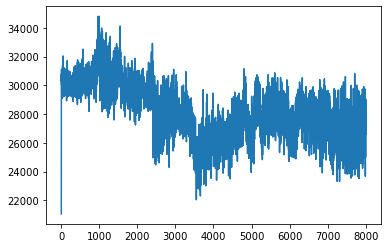

In [55]:
plt.plot(TrainingPortfolio)

(array([   3.,   39.,  349., 1339., 2058., 1889., 1639.,  556.,  116.,
          12.]),
 array([21052.7912 , 22428.38295, 23803.9747 , 25179.56645, 26555.1582 ,
        27930.74995, 29306.3417 , 30681.93345, 32057.5252 , 33433.11695,
        34808.7087 ]),
 <BarContainer object of 10 artists>)

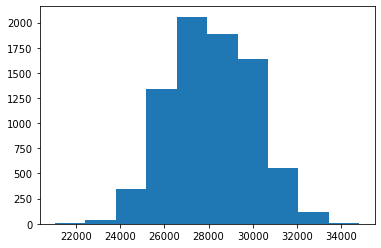

In [56]:
plt.hist(TrainingPortfolio)

In [57]:
np.mean(TestPortfolio)

21815.895144374932

(array([2.300e+01, 3.200e+02, 3.412e+03, 1.744e+03, 1.259e+03, 7.530e+02,
        3.360e+02, 1.320e+02, 1.900e+01, 2.000e+00]),
 array([18636.56 , 19524.007, 20411.454, 21298.901, 22186.348, 23073.795,
        23961.242, 24848.689, 25736.136, 26623.583, 27511.03 ]),
 <BarContainer object of 10 artists>)

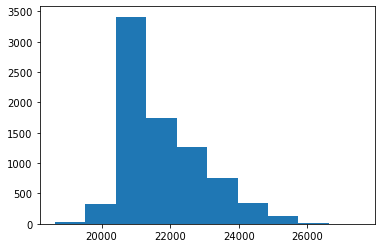

In [58]:
plt.hist(TestPortfolio)

(array([  50.,  445., 1441., 2304., 1965., 1129.,  489.,  134.,   36.,
           7.]),
 array([14732.765 , 16918.4025, 19104.04  , 21289.6775, 23475.315 ,
        25660.9525, 27846.59  , 30032.2275, 32217.865 , 34403.5025,
        36589.14  ]),
 <BarContainer object of 10 artists>)

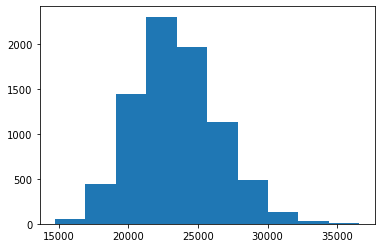

In [59]:
plt.hist(RandomPortfolio)

In [60]:
np.mean(RandomPortfolio)

23463.109901249758

In [61]:
test_data[-1]

array([159.54      , 102.63      ,  54.46      , 159.68666667,
       102.15      ,  54.92      ])

### 20000 Episode

In [62]:
env.reset()

array([    0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,   119.72      ,    63.99      ,
          56.27      ,   116.79      ,    63.99333333,    56.9       ,
       20000.        ])

In [63]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 20000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path + "/TraderWeights_20000_episode.npz", W=W, b=b)

episode: 1/20000, episode end value: 21052.79
episode: 2/20000, episode end value: 25727.15
episode: 3/20000, episode end value: 23992.24
episode: 4/20000, episode end value: 30771.14
episode: 5/20000, episode end value: 30571.01
episode: 6/20000, episode end value: 30238.49
episode: 7/20000, episode end value: 31099.66
episode: 8/20000, episode end value: 30051.95
episode: 9/20000, episode end value: 30051.95
episode: 10/20000, episode end value: 29683.22
episode: 11/20000, episode end value: 30154.67
episode: 12/20000, episode end value: 29464.01
episode: 13/20000, episode end value: 29858.61
episode: 14/20000, episode end value: 29679.76
episode: 15/20000, episode end value: 29860.96
episode: 16/20000, episode end value: 30051.95
episode: 17/20000, episode end value: 30107.61
episode: 18/20000, episode end value: 30545.73
episode: 19/20000, episode end value: 30051.95
episode: 20/20000, episode end value: 30645.37
episode: 21/20000, episode end value: 29086.04
episode: 22/20000, epi

episode: 174/20000, episode end value: 30786.82
episode: 175/20000, episode end value: 29787.24
episode: 176/20000, episode end value: 30051.95
episode: 177/20000, episode end value: 29730.38
episode: 178/20000, episode end value: 29729.80
episode: 179/20000, episode end value: 30440.54
episode: 180/20000, episode end value: 29500.31
episode: 181/20000, episode end value: 29732.68
episode: 182/20000, episode end value: 30051.95
episode: 183/20000, episode end value: 29980.12
episode: 184/20000, episode end value: 29915.30
episode: 185/20000, episode end value: 29909.18
episode: 186/20000, episode end value: 30517.75
episode: 187/20000, episode end value: 30390.19
episode: 188/20000, episode end value: 30295.01
episode: 189/20000, episode end value: 30659.38
episode: 190/20000, episode end value: 29643.18
episode: 191/20000, episode end value: 29672.42
episode: 192/20000, episode end value: 30641.37
episode: 193/20000, episode end value: 29243.37
episode: 194/20000, episode end value: 3

episode: 345/20000, episode end value: 29966.89
episode: 346/20000, episode end value: 30921.27
episode: 347/20000, episode end value: 29952.81
episode: 348/20000, episode end value: 30341.06
episode: 349/20000, episode end value: 30681.70
episode: 350/20000, episode end value: 30504.80
episode: 351/20000, episode end value: 29716.53
episode: 352/20000, episode end value: 30087.65
episode: 353/20000, episode end value: 29845.85
episode: 354/20000, episode end value: 30152.13
episode: 355/20000, episode end value: 30998.02
episode: 356/20000, episode end value: 29935.15
episode: 357/20000, episode end value: 30051.95
episode: 358/20000, episode end value: 30802.72
episode: 359/20000, episode end value: 29635.96
episode: 360/20000, episode end value: 29936.02
episode: 361/20000, episode end value: 29989.04
episode: 362/20000, episode end value: 30689.13
episode: 363/20000, episode end value: 29806.27
episode: 364/20000, episode end value: 30497.44
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 30980.03
episode: 517/20000, episode end value: 30324.97
episode: 518/20000, episode end value: 29935.16
episode: 519/20000, episode end value: 30424.73
episode: 520/20000, episode end value: 30051.95
episode: 521/20000, episode end value: 31460.99
episode: 522/20000, episode end value: 29573.85
episode: 523/20000, episode end value: 29262.85
episode: 524/20000, episode end value: 31140.64
episode: 525/20000, episode end value: 29353.38
episode: 526/20000, episode end value: 30886.53
episode: 527/20000, episode end value: 29715.00
episode: 528/20000, episode end value: 29967.93
episode: 529/20000, episode end value: 29506.07
episode: 530/20000, episode end value: 29979.64
episode: 531/20000, episode end value: 30051.95
episode: 532/20000, episode end value: 29915.02
episode: 533/20000, episode end value: 29799.85
episode: 534/20000, episode end value: 30420.28
episode: 535/20000, episode end value: 30574.32
episode: 536/20000, episode end value: 3

episode: 687/20000, episode end value: 30429.72
episode: 688/20000, episode end value: 30646.59
episode: 689/20000, episode end value: 29826.72
episode: 690/20000, episode end value: 29463.89
episode: 691/20000, episode end value: 30638.26
episode: 692/20000, episode end value: 31565.97
episode: 693/20000, episode end value: 30144.78
episode: 694/20000, episode end value: 30352.79
episode: 695/20000, episode end value: 30656.70
episode: 696/20000, episode end value: 31033.65
episode: 697/20000, episode end value: 30504.79
episode: 698/20000, episode end value: 30299.17
episode: 699/20000, episode end value: 29938.86
episode: 700/20000, episode end value: 30408.80
episode: 701/20000, episode end value: 30862.64
episode: 702/20000, episode end value: 29678.45
episode: 703/20000, episode end value: 30056.81
episode: 704/20000, episode end value: 29319.21
episode: 705/20000, episode end value: 30056.15
episode: 706/20000, episode end value: 29701.61
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 30597.80
episode: 859/20000, episode end value: 29061.47
episode: 860/20000, episode end value: 31319.70
episode: 861/20000, episode end value: 29790.08
episode: 862/20000, episode end value: 30864.06
episode: 863/20000, episode end value: 30694.94
episode: 864/20000, episode end value: 29414.70
episode: 865/20000, episode end value: 30268.16
episode: 866/20000, episode end value: 30880.20
episode: 867/20000, episode end value: 29935.55
episode: 868/20000, episode end value: 30863.41
episode: 869/20000, episode end value: 31303.41
episode: 870/20000, episode end value: 29583.94
episode: 871/20000, episode end value: 31322.46
episode: 872/20000, episode end value: 31464.28
episode: 873/20000, episode end value: 31297.10
episode: 874/20000, episode end value: 30906.20
episode: 875/20000, episode end value: 31452.57
episode: 876/20000, episode end value: 31862.92
episode: 877/20000, episode end value: 30862.51
episode: 878/20000, episode end value: 3

episode: 1029/20000, episode end value: 29704.82
episode: 1030/20000, episode end value: 29766.47
episode: 1031/20000, episode end value: 30407.73
episode: 1032/20000, episode end value: 31257.65
episode: 1033/20000, episode end value: 30389.26
episode: 1034/20000, episode end value: 30267.62
episode: 1035/20000, episode end value: 30698.84
episode: 1036/20000, episode end value: 29463.04
episode: 1037/20000, episode end value: 30537.91
episode: 1038/20000, episode end value: 30272.45
episode: 1039/20000, episode end value: 29456.88
episode: 1040/20000, episode end value: 31551.97
episode: 1041/20000, episode end value: 30505.56
episode: 1042/20000, episode end value: 31184.68
episode: 1043/20000, episode end value: 31559.97
episode: 1044/20000, episode end value: 31776.04
episode: 1045/20000, episode end value: 30622.07
episode: 1046/20000, episode end value: 32137.84
episode: 1047/20000, episode end value: 30516.38
episode: 1048/20000, episode end value: 31577.09
episode: 1049/20000,

episode: 1197/20000, episode end value: 31715.49
episode: 1198/20000, episode end value: 31387.89
episode: 1199/20000, episode end value: 29417.54
episode: 1200/20000, episode end value: 30679.18
episode: 1201/20000, episode end value: 30775.16
episode: 1202/20000, episode end value: 31576.56
episode: 1203/20000, episode end value: 30445.90
episode: 1204/20000, episode end value: 31123.56
episode: 1205/20000, episode end value: 31473.76
episode: 1206/20000, episode end value: 31167.86
episode: 1207/20000, episode end value: 31692.92
episode: 1208/20000, episode end value: 31810.48
episode: 1209/20000, episode end value: 32025.60
episode: 1210/20000, episode end value: 28186.54
episode: 1211/20000, episode end value: 31700.53
episode: 1212/20000, episode end value: 30685.57
episode: 1213/20000, episode end value: 31401.11
episode: 1214/20000, episode end value: 31660.84
episode: 1215/20000, episode end value: 28739.68
episode: 1216/20000, episode end value: 29800.62
episode: 1217/20000,

episode: 1365/20000, episode end value: 31412.97
episode: 1366/20000, episode end value: 31295.73
episode: 1367/20000, episode end value: 31164.22
episode: 1368/20000, episode end value: 31761.82
episode: 1369/20000, episode end value: 30518.85
episode: 1370/20000, episode end value: 31596.67
episode: 1371/20000, episode end value: 31919.97
episode: 1372/20000, episode end value: 31773.87
episode: 1373/20000, episode end value: 31759.25
episode: 1374/20000, episode end value: 31652.36
episode: 1375/20000, episode end value: 32370.33
episode: 1376/20000, episode end value: 29103.39
episode: 1377/20000, episode end value: 29005.41
episode: 1378/20000, episode end value: 29270.45
episode: 1379/20000, episode end value: 31624.84
episode: 1380/20000, episode end value: 30119.73
episode: 1381/20000, episode end value: 29226.84
episode: 1382/20000, episode end value: 30832.89
episode: 1383/20000, episode end value: 29124.89
episode: 1384/20000, episode end value: 30542.42
episode: 1385/20000,

episode: 1533/20000, episode end value: 31373.61
episode: 1534/20000, episode end value: 31435.08
episode: 1535/20000, episode end value: 32024.49
episode: 1536/20000, episode end value: 32047.68
episode: 1537/20000, episode end value: 31549.48
episode: 1538/20000, episode end value: 31691.03
episode: 1539/20000, episode end value: 32162.60
episode: 1540/20000, episode end value: 32399.66
episode: 1541/20000, episode end value: 30300.85
episode: 1542/20000, episode end value: 31718.55
episode: 1543/20000, episode end value: 31810.39
episode: 1544/20000, episode end value: 32758.44
episode: 1545/20000, episode end value: 31774.89
episode: 1546/20000, episode end value: 32636.93
episode: 1547/20000, episode end value: 31902.47
episode: 1548/20000, episode end value: 34128.64
episode: 1549/20000, episode end value: 29948.55
episode: 1550/20000, episode end value: 31061.87
episode: 1551/20000, episode end value: 31574.00
episode: 1552/20000, episode end value: 32116.00
episode: 1553/20000,

episode: 1701/20000, episode end value: 30178.85
episode: 1702/20000, episode end value: 29932.73
episode: 1703/20000, episode end value: 29459.34
episode: 1704/20000, episode end value: 31217.38
episode: 1705/20000, episode end value: 29327.66
episode: 1706/20000, episode end value: 29663.44
episode: 1707/20000, episode end value: 29514.99
episode: 1708/20000, episode end value: 31122.47
episode: 1709/20000, episode end value: 29384.16
episode: 1710/20000, episode end value: 29567.68
episode: 1711/20000, episode end value: 29531.09
episode: 1712/20000, episode end value: 29936.44
episode: 1713/20000, episode end value: 29730.05
episode: 1714/20000, episode end value: 29321.53
episode: 1715/20000, episode end value: 29206.14
episode: 1716/20000, episode end value: 29800.49
episode: 1717/20000, episode end value: 30506.13
episode: 1718/20000, episode end value: 29915.02
episode: 1719/20000, episode end value: 29493.12
episode: 1720/20000, episode end value: 28992.76
episode: 1721/20000,

episode: 1869/20000, episode end value: 29036.97
episode: 1870/20000, episode end value: 29046.54
episode: 1871/20000, episode end value: 29447.61
episode: 1872/20000, episode end value: 28179.33
episode: 1873/20000, episode end value: 30394.26
episode: 1874/20000, episode end value: 29408.90
episode: 1875/20000, episode end value: 29204.22
episode: 1876/20000, episode end value: 29197.71
episode: 1877/20000, episode end value: 30530.21
episode: 1878/20000, episode end value: 29255.95
episode: 1879/20000, episode end value: 29296.24
episode: 1880/20000, episode end value: 29321.66
episode: 1881/20000, episode end value: 29441.85
episode: 1882/20000, episode end value: 29583.93
episode: 1883/20000, episode end value: 29863.65
episode: 1884/20000, episode end value: 29755.08
episode: 1885/20000, episode end value: 28443.50
episode: 1886/20000, episode end value: 29204.13
episode: 1887/20000, episode end value: 29160.60
episode: 1888/20000, episode end value: 29756.45
episode: 1889/20000,

episode: 2037/20000, episode end value: 29382.89
episode: 2038/20000, episode end value: 29985.54
episode: 2039/20000, episode end value: 27553.91
episode: 2040/20000, episode end value: 28374.35
episode: 2041/20000, episode end value: 29197.69
episode: 2042/20000, episode end value: 29752.88
episode: 2043/20000, episode end value: 28730.45
episode: 2044/20000, episode end value: 29117.42
episode: 2045/20000, episode end value: 28089.24
episode: 2046/20000, episode end value: 29526.13
episode: 2047/20000, episode end value: 28433.95
episode: 2048/20000, episode end value: 28652.47
episode: 2049/20000, episode end value: 28461.64
episode: 2050/20000, episode end value: 28390.27
episode: 2051/20000, episode end value: 28373.12
episode: 2052/20000, episode end value: 31027.77
episode: 2053/20000, episode end value: 28553.96
episode: 2054/20000, episode end value: 29691.40
episode: 2055/20000, episode end value: 29420.33
episode: 2056/20000, episode end value: 29499.48
episode: 2057/20000,

episode: 2205/20000, episode end value: 30123.72
episode: 2206/20000, episode end value: 28920.55
episode: 2207/20000, episode end value: 29158.92
episode: 2208/20000, episode end value: 29383.33
episode: 2209/20000, episode end value: 29255.87
episode: 2210/20000, episode end value: 28826.77
episode: 2211/20000, episode end value: 29320.59
episode: 2212/20000, episode end value: 28771.12
episode: 2213/20000, episode end value: 29547.22
episode: 2214/20000, episode end value: 29821.17
episode: 2215/20000, episode end value: 29441.05
episode: 2216/20000, episode end value: 29451.25
episode: 2217/20000, episode end value: 29149.25
episode: 2218/20000, episode end value: 29027.25
episode: 2219/20000, episode end value: 29329.67
episode: 2220/20000, episode end value: 29271.71
episode: 2221/20000, episode end value: 29395.94
episode: 2222/20000, episode end value: 29106.56
episode: 2223/20000, episode end value: 29263.78
episode: 2224/20000, episode end value: 29443.92
episode: 2225/20000,

episode: 2373/20000, episode end value: 31599.31
episode: 2374/20000, episode end value: 30355.01
episode: 2375/20000, episode end value: 31666.44
episode: 2376/20000, episode end value: 32199.34
episode: 2377/20000, episode end value: 30465.25
episode: 2378/20000, episode end value: 31261.37
episode: 2379/20000, episode end value: 30881.61
episode: 2380/20000, episode end value: 30890.41
episode: 2381/20000, episode end value: 30895.60
episode: 2382/20000, episode end value: 31321.59
episode: 2383/20000, episode end value: 31800.35
episode: 2384/20000, episode end value: 31597.32
episode: 2385/20000, episode end value: 30127.75
episode: 2386/20000, episode end value: 29409.60
episode: 2387/20000, episode end value: 31416.56
episode: 2388/20000, episode end value: 30990.19
episode: 2389/20000, episode end value: 30939.74
episode: 2390/20000, episode end value: 31295.20
episode: 2391/20000, episode end value: 31536.35
episode: 2392/20000, episode end value: 29269.80
episode: 2393/20000,

episode: 2541/20000, episode end value: 26824.55
episode: 2542/20000, episode end value: 27787.25
episode: 2543/20000, episode end value: 26866.67
episode: 2544/20000, episode end value: 27496.03
episode: 2545/20000, episode end value: 28311.67
episode: 2546/20000, episode end value: 27325.50
episode: 2547/20000, episode end value: 28169.81
episode: 2548/20000, episode end value: 26852.25
episode: 2549/20000, episode end value: 28103.65
episode: 2550/20000, episode end value: 26293.31
episode: 2551/20000, episode end value: 28328.86
episode: 2552/20000, episode end value: 28006.56
episode: 2553/20000, episode end value: 25775.41
episode: 2554/20000, episode end value: 27383.74
episode: 2555/20000, episode end value: 27642.82
episode: 2556/20000, episode end value: 27550.13
episode: 2557/20000, episode end value: 27910.90
episode: 2558/20000, episode end value: 27587.50
episode: 2559/20000, episode end value: 25927.94
episode: 2560/20000, episode end value: 27946.58
episode: 2561/20000,

episode: 2709/20000, episode end value: 27945.65
episode: 2710/20000, episode end value: 28403.83
episode: 2711/20000, episode end value: 29613.06
episode: 2712/20000, episode end value: 27621.98
episode: 2713/20000, episode end value: 27600.72
episode: 2714/20000, episode end value: 26958.33
episode: 2715/20000, episode end value: 29841.48
episode: 2716/20000, episode end value: 29164.86
episode: 2717/20000, episode end value: 29217.23
episode: 2718/20000, episode end value: 26369.61
episode: 2719/20000, episode end value: 28364.84
episode: 2720/20000, episode end value: 28354.02
episode: 2721/20000, episode end value: 27587.17
episode: 2722/20000, episode end value: 27579.47
episode: 2723/20000, episode end value: 29132.28
episode: 2724/20000, episode end value: 27859.99
episode: 2725/20000, episode end value: 28479.68
episode: 2726/20000, episode end value: 29977.91
episode: 2727/20000, episode end value: 29003.15
episode: 2728/20000, episode end value: 26607.54
episode: 2729/20000,

episode: 2877/20000, episode end value: 29275.18
episode: 2878/20000, episode end value: 28320.94
episode: 2879/20000, episode end value: 27326.82
episode: 2880/20000, episode end value: 29737.00
episode: 2881/20000, episode end value: 28296.84
episode: 2882/20000, episode end value: 29492.82
episode: 2883/20000, episode end value: 28428.46
episode: 2884/20000, episode end value: 28773.19
episode: 2885/20000, episode end value: 26956.58
episode: 2886/20000, episode end value: 29925.20
episode: 2887/20000, episode end value: 27592.30
episode: 2888/20000, episode end value: 28068.74
episode: 2889/20000, episode end value: 27588.81
episode: 2890/20000, episode end value: 28009.91
episode: 2891/20000, episode end value: 26779.23
episode: 2892/20000, episode end value: 28599.08
episode: 2893/20000, episode end value: 30237.29
episode: 2894/20000, episode end value: 29370.68
episode: 2895/20000, episode end value: 29129.73
episode: 2896/20000, episode end value: 27650.81
episode: 2897/20000,

episode: 3045/20000, episode end value: 28236.74
episode: 3046/20000, episode end value: 28032.75
episode: 3047/20000, episode end value: 27685.33
episode: 3048/20000, episode end value: 27794.01
episode: 3049/20000, episode end value: 27772.90
episode: 3050/20000, episode end value: 27635.34
episode: 3051/20000, episode end value: 28858.82
episode: 3052/20000, episode end value: 27539.28
episode: 3053/20000, episode end value: 28659.48
episode: 3054/20000, episode end value: 27961.82
episode: 3055/20000, episode end value: 27539.32
episode: 3056/20000, episode end value: 27773.92
episode: 3057/20000, episode end value: 27244.63
episode: 3058/20000, episode end value: 28194.14
episode: 3059/20000, episode end value: 28193.78
episode: 3060/20000, episode end value: 28239.94
episode: 3061/20000, episode end value: 28280.27
episode: 3062/20000, episode end value: 28273.80
episode: 3063/20000, episode end value: 28835.49
episode: 3064/20000, episode end value: 27715.57
episode: 3065/20000,

episode: 3213/20000, episode end value: 27477.17
episode: 3214/20000, episode end value: 28265.66
episode: 3215/20000, episode end value: 27908.54
episode: 3216/20000, episode end value: 28239.81
episode: 3217/20000, episode end value: 27576.58
episode: 3218/20000, episode end value: 27703.98
episode: 3219/20000, episode end value: 27344.57
episode: 3220/20000, episode end value: 27969.35
episode: 3221/20000, episode end value: 27635.00
episode: 3222/20000, episode end value: 27819.56
episode: 3223/20000, episode end value: 28520.69
episode: 3224/20000, episode end value: 27269.74
episode: 3225/20000, episode end value: 27579.25
episode: 3226/20000, episode end value: 28380.08
episode: 3227/20000, episode end value: 29141.88
episode: 3228/20000, episode end value: 29293.26
episode: 3229/20000, episode end value: 27958.99
episode: 3230/20000, episode end value: 27560.94
episode: 3231/20000, episode end value: 26860.68
episode: 3232/20000, episode end value: 27983.37
episode: 3233/20000,

episode: 3381/20000, episode end value: 25308.39
episode: 3382/20000, episode end value: 28055.38
episode: 3383/20000, episode end value: 26806.32
episode: 3384/20000, episode end value: 27271.84
episode: 3385/20000, episode end value: 27958.13
episode: 3386/20000, episode end value: 26384.16
episode: 3387/20000, episode end value: 27571.80
episode: 3388/20000, episode end value: 26743.84
episode: 3389/20000, episode end value: 25644.67
episode: 3390/20000, episode end value: 27213.71
episode: 3391/20000, episode end value: 26607.10
episode: 3392/20000, episode end value: 27344.82
episode: 3393/20000, episode end value: 26620.06
episode: 3394/20000, episode end value: 27492.20
episode: 3395/20000, episode end value: 27555.78
episode: 3396/20000, episode end value: 27140.53
episode: 3397/20000, episode end value: 26574.12
episode: 3398/20000, episode end value: 26963.24
episode: 3399/20000, episode end value: 25513.32
episode: 3400/20000, episode end value: 27198.84
episode: 3401/20000,

episode: 3549/20000, episode end value: 25478.09
episode: 3550/20000, episode end value: 22036.32
episode: 3551/20000, episode end value: 24715.24
episode: 3552/20000, episode end value: 25090.68
episode: 3553/20000, episode end value: 24576.67
episode: 3554/20000, episode end value: 26251.27
episode: 3555/20000, episode end value: 26299.31
episode: 3556/20000, episode end value: 24898.89
episode: 3557/20000, episode end value: 25421.29
episode: 3558/20000, episode end value: 25329.09
episode: 3559/20000, episode end value: 25643.42
episode: 3560/20000, episode end value: 25449.14
episode: 3561/20000, episode end value: 25121.62
episode: 3562/20000, episode end value: 26429.29
episode: 3563/20000, episode end value: 24947.05
episode: 3564/20000, episode end value: 25585.74
episode: 3565/20000, episode end value: 25476.13
episode: 3566/20000, episode end value: 25296.90
episode: 3567/20000, episode end value: 25677.91
episode: 3568/20000, episode end value: 24695.15
episode: 3569/20000,

episode: 3717/20000, episode end value: 26521.17
episode: 3718/20000, episode end value: 26482.55
episode: 3719/20000, episode end value: 24725.68
episode: 3720/20000, episode end value: 26727.92
episode: 3721/20000, episode end value: 25525.77
episode: 3722/20000, episode end value: 24963.37
episode: 3723/20000, episode end value: 25805.62
episode: 3724/20000, episode end value: 26012.61
episode: 3725/20000, episode end value: 25246.98
episode: 3726/20000, episode end value: 26037.09
episode: 3727/20000, episode end value: 24977.68
episode: 3728/20000, episode end value: 28461.66
episode: 3729/20000, episode end value: 24957.48
episode: 3730/20000, episode end value: 25089.10
episode: 3731/20000, episode end value: 29699.42
episode: 3732/20000, episode end value: 26145.81
episode: 3733/20000, episode end value: 25151.03
episode: 3734/20000, episode end value: 24658.81
episode: 3735/20000, episode end value: 26073.90
episode: 3736/20000, episode end value: 25014.87
episode: 3737/20000,

episode: 3885/20000, episode end value: 25590.53
episode: 3886/20000, episode end value: 25404.34
episode: 3887/20000, episode end value: 24947.76
episode: 3888/20000, episode end value: 27635.21
episode: 3889/20000, episode end value: 25664.12
episode: 3890/20000, episode end value: 25270.54
episode: 3891/20000, episode end value: 26382.19
episode: 3892/20000, episode end value: 25733.08
episode: 3893/20000, episode end value: 27934.10
episode: 3894/20000, episode end value: 27057.41
episode: 3895/20000, episode end value: 26803.41
episode: 3896/20000, episode end value: 26175.97
episode: 3897/20000, episode end value: 25058.83
episode: 3898/20000, episode end value: 25289.81
episode: 3899/20000, episode end value: 27111.33
episode: 3900/20000, episode end value: 25190.56
episode: 3901/20000, episode end value: 26120.67
episode: 3902/20000, episode end value: 26451.00
episode: 3903/20000, episode end value: 25572.58
episode: 3904/20000, episode end value: 25335.42
episode: 3905/20000,

episode: 4053/20000, episode end value: 26522.20
episode: 4054/20000, episode end value: 27024.51
episode: 4055/20000, episode end value: 27784.91
episode: 4056/20000, episode end value: 26035.08
episode: 4057/20000, episode end value: 26914.15
episode: 4058/20000, episode end value: 25930.81
episode: 4059/20000, episode end value: 26124.92
episode: 4060/20000, episode end value: 25877.07
episode: 4061/20000, episode end value: 27447.06
episode: 4062/20000, episode end value: 26541.02
episode: 4063/20000, episode end value: 26379.34
episode: 4064/20000, episode end value: 25435.27
episode: 4065/20000, episode end value: 26297.08
episode: 4066/20000, episode end value: 25057.32
episode: 4067/20000, episode end value: 26502.51
episode: 4068/20000, episode end value: 26489.60
episode: 4069/20000, episode end value: 27300.19
episode: 4070/20000, episode end value: 26056.14
episode: 4071/20000, episode end value: 27103.59
episode: 4072/20000, episode end value: 26234.63
episode: 4073/20000,

episode: 4221/20000, episode end value: 26809.44
episode: 4222/20000, episode end value: 27056.31
episode: 4223/20000, episode end value: 26261.13
episode: 4224/20000, episode end value: 26541.21
episode: 4225/20000, episode end value: 27273.01
episode: 4226/20000, episode end value: 25933.96
episode: 4227/20000, episode end value: 26264.33
episode: 4228/20000, episode end value: 26811.54
episode: 4229/20000, episode end value: 26888.74
episode: 4230/20000, episode end value: 26744.32
episode: 4231/20000, episode end value: 25870.12
episode: 4232/20000, episode end value: 26220.42
episode: 4233/20000, episode end value: 25812.34
episode: 4234/20000, episode end value: 26375.83
episode: 4235/20000, episode end value: 26571.52
episode: 4236/20000, episode end value: 25592.75
episode: 4237/20000, episode end value: 26659.29
episode: 4238/20000, episode end value: 28256.14
episode: 4239/20000, episode end value: 25102.34
episode: 4240/20000, episode end value: 26311.78
episode: 4241/20000,

episode: 4389/20000, episode end value: 26782.51
episode: 4390/20000, episode end value: 26618.33
episode: 4391/20000, episode end value: 25328.51
episode: 4392/20000, episode end value: 25340.08
episode: 4393/20000, episode end value: 28033.44
episode: 4394/20000, episode end value: 25297.81
episode: 4395/20000, episode end value: 27625.82
episode: 4396/20000, episode end value: 26225.35
episode: 4397/20000, episode end value: 26013.21
episode: 4398/20000, episode end value: 23703.98
episode: 4399/20000, episode end value: 26900.36
episode: 4400/20000, episode end value: 26728.06
episode: 4401/20000, episode end value: 25344.05
episode: 4402/20000, episode end value: 25098.06
episode: 4403/20000, episode end value: 27831.70
episode: 4404/20000, episode end value: 28011.67
episode: 4405/20000, episode end value: 26209.02
episode: 4406/20000, episode end value: 25578.59
episode: 4407/20000, episode end value: 25489.62
episode: 4408/20000, episode end value: 25600.04
episode: 4409/20000,

episode: 4557/20000, episode end value: 26334.55
episode: 4558/20000, episode end value: 28331.54
episode: 4559/20000, episode end value: 29527.20
episode: 4560/20000, episode end value: 27957.22
episode: 4561/20000, episode end value: 27470.60
episode: 4562/20000, episode end value: 26925.81
episode: 4563/20000, episode end value: 26984.03
episode: 4564/20000, episode end value: 27758.23
episode: 4565/20000, episode end value: 27513.13
episode: 4566/20000, episode end value: 29035.56
episode: 4567/20000, episode end value: 27507.95
episode: 4568/20000, episode end value: 26609.68
episode: 4569/20000, episode end value: 27764.58
episode: 4570/20000, episode end value: 27818.97
episode: 4571/20000, episode end value: 26843.10
episode: 4572/20000, episode end value: 26934.22
episode: 4573/20000, episode end value: 28206.48
episode: 4574/20000, episode end value: 27711.79
episode: 4575/20000, episode end value: 25508.09
episode: 4576/20000, episode end value: 26149.43
episode: 4577/20000,

episode: 4725/20000, episode end value: 27991.77
episode: 4726/20000, episode end value: 27570.29
episode: 4727/20000, episode end value: 26960.70
episode: 4728/20000, episode end value: 27584.66
episode: 4729/20000, episode end value: 27766.47
episode: 4730/20000, episode end value: 26609.02
episode: 4731/20000, episode end value: 27897.10
episode: 4732/20000, episode end value: 28082.88
episode: 4733/20000, episode end value: 27091.76
episode: 4734/20000, episode end value: 27323.77
episode: 4735/20000, episode end value: 27749.51
episode: 4736/20000, episode end value: 25711.28
episode: 4737/20000, episode end value: 28309.61
episode: 4738/20000, episode end value: 27525.57
episode: 4739/20000, episode end value: 28262.05
episode: 4740/20000, episode end value: 27425.37
episode: 4741/20000, episode end value: 26658.57
episode: 4742/20000, episode end value: 27377.27
episode: 4743/20000, episode end value: 27034.30
episode: 4744/20000, episode end value: 27157.80
episode: 4745/20000,

episode: 4893/20000, episode end value: 26982.63
episode: 4894/20000, episode end value: 26906.10
episode: 4895/20000, episode end value: 27873.68
episode: 4896/20000, episode end value: 25251.94
episode: 4897/20000, episode end value: 25512.23
episode: 4898/20000, episode end value: 26376.38
episode: 4899/20000, episode end value: 27383.83
episode: 4900/20000, episode end value: 26523.93
episode: 4901/20000, episode end value: 26562.53
episode: 4902/20000, episode end value: 26299.20
episode: 4903/20000, episode end value: 26252.11
episode: 4904/20000, episode end value: 27824.02
episode: 4905/20000, episode end value: 27161.98
episode: 4906/20000, episode end value: 27749.93
episode: 4907/20000, episode end value: 27468.88
episode: 4908/20000, episode end value: 25454.70
episode: 4909/20000, episode end value: 26465.71
episode: 4910/20000, episode end value: 26920.51
episode: 4911/20000, episode end value: 26541.55
episode: 4912/20000, episode end value: 25315.62
episode: 4913/20000,

episode: 5061/20000, episode end value: 28262.90
episode: 5062/20000, episode end value: 27508.19
episode: 5063/20000, episode end value: 26740.34
episode: 5064/20000, episode end value: 24540.08
episode: 5065/20000, episode end value: 26691.88
episode: 5066/20000, episode end value: 26380.43
episode: 5067/20000, episode end value: 26841.70
episode: 5068/20000, episode end value: 27381.31
episode: 5069/20000, episode end value: 27648.80
episode: 5070/20000, episode end value: 26919.06
episode: 5071/20000, episode end value: 29036.90
episode: 5072/20000, episode end value: 27716.17
episode: 5073/20000, episode end value: 29275.17
episode: 5074/20000, episode end value: 26261.01
episode: 5075/20000, episode end value: 27385.21
episode: 5076/20000, episode end value: 27425.33
episode: 5077/20000, episode end value: 28716.40
episode: 5078/20000, episode end value: 29147.18
episode: 5079/20000, episode end value: 26218.59
episode: 5080/20000, episode end value: 29225.26
episode: 5081/20000,

episode: 5229/20000, episode end value: 27216.53
episode: 5230/20000, episode end value: 26493.77
episode: 5231/20000, episode end value: 29011.48
episode: 5232/20000, episode end value: 27668.54
episode: 5233/20000, episode end value: 28620.35
episode: 5234/20000, episode end value: 28477.55
episode: 5235/20000, episode end value: 28715.88
episode: 5236/20000, episode end value: 26376.73
episode: 5237/20000, episode end value: 26741.53
episode: 5238/20000, episode end value: 27852.49
episode: 5239/20000, episode end value: 27756.51
episode: 5240/20000, episode end value: 26031.55
episode: 5241/20000, episode end value: 27953.81
episode: 5242/20000, episode end value: 26911.15
episode: 5243/20000, episode end value: 28018.59
episode: 5244/20000, episode end value: 26987.70
episode: 5245/20000, episode end value: 27395.45
episode: 5246/20000, episode end value: 27471.42
episode: 5247/20000, episode end value: 25977.26
episode: 5248/20000, episode end value: 27663.74
episode: 5249/20000,

episode: 5397/20000, episode end value: 28807.98
episode: 5398/20000, episode end value: 29916.31
episode: 5399/20000, episode end value: 27743.35
episode: 5400/20000, episode end value: 28070.90
episode: 5401/20000, episode end value: 27294.54
episode: 5402/20000, episode end value: 28496.99
episode: 5403/20000, episode end value: 27630.75
episode: 5404/20000, episode end value: 28567.67
episode: 5405/20000, episode end value: 28353.23
episode: 5406/20000, episode end value: 27545.28
episode: 5407/20000, episode end value: 27080.03
episode: 5408/20000, episode end value: 28577.10
episode: 5409/20000, episode end value: 29059.51
episode: 5410/20000, episode end value: 28565.16
episode: 5411/20000, episode end value: 28696.78
episode: 5412/20000, episode end value: 28546.77
episode: 5413/20000, episode end value: 27665.82
episode: 5414/20000, episode end value: 28391.18
episode: 5415/20000, episode end value: 28081.54
episode: 5416/20000, episode end value: 29292.96
episode: 5417/20000,

episode: 5565/20000, episode end value: 28154.77
episode: 5566/20000, episode end value: 27110.64
episode: 5567/20000, episode end value: 28037.71
episode: 5568/20000, episode end value: 27625.41
episode: 5569/20000, episode end value: 29113.94
episode: 5570/20000, episode end value: 27914.67
episode: 5571/20000, episode end value: 28620.06
episode: 5572/20000, episode end value: 29271.05
episode: 5573/20000, episode end value: 28365.63
episode: 5574/20000, episode end value: 29411.37
episode: 5575/20000, episode end value: 27803.95
episode: 5576/20000, episode end value: 29777.73
episode: 5577/20000, episode end value: 28446.85
episode: 5578/20000, episode end value: 30507.01
episode: 5579/20000, episode end value: 28144.95
episode: 5580/20000, episode end value: 29411.02
episode: 5581/20000, episode end value: 28809.10
episode: 5582/20000, episode end value: 28823.09
episode: 5583/20000, episode end value: 28807.67
episode: 5584/20000, episode end value: 29334.10
episode: 5585/20000,

episode: 5733/20000, episode end value: 26622.48
episode: 5734/20000, episode end value: 28440.75
episode: 5735/20000, episode end value: 26992.70
episode: 5736/20000, episode end value: 29052.22
episode: 5737/20000, episode end value: 25327.68
episode: 5738/20000, episode end value: 28807.55
episode: 5739/20000, episode end value: 28151.40
episode: 5740/20000, episode end value: 26711.81
episode: 5741/20000, episode end value: 28544.30
episode: 5742/20000, episode end value: 26990.54
episode: 5743/20000, episode end value: 28828.31
episode: 5744/20000, episode end value: 26959.55
episode: 5745/20000, episode end value: 27484.70
episode: 5746/20000, episode end value: 28583.85
episode: 5747/20000, episode end value: 27425.46
episode: 5748/20000, episode end value: 28571.86
episode: 5749/20000, episode end value: 27987.94
episode: 5750/20000, episode end value: 26726.72
episode: 5751/20000, episode end value: 26726.95
episode: 5752/20000, episode end value: 28084.77
episode: 5753/20000,

episode: 5901/20000, episode end value: 26547.97
episode: 5902/20000, episode end value: 28558.28
episode: 5903/20000, episode end value: 27924.26
episode: 5904/20000, episode end value: 28880.63
episode: 5905/20000, episode end value: 27494.69
episode: 5906/20000, episode end value: 27124.52
episode: 5907/20000, episode end value: 28440.89
episode: 5908/20000, episode end value: 27928.52
episode: 5909/20000, episode end value: 26511.80
episode: 5910/20000, episode end value: 28430.20
episode: 5911/20000, episode end value: 28649.56
episode: 5912/20000, episode end value: 28684.94
episode: 5913/20000, episode end value: 27553.51
episode: 5914/20000, episode end value: 28080.29
episode: 5915/20000, episode end value: 26869.04
episode: 5916/20000, episode end value: 28440.89
episode: 5917/20000, episode end value: 27540.60
episode: 5918/20000, episode end value: 29123.38
episode: 5919/20000, episode end value: 28925.70
episode: 5920/20000, episode end value: 28925.80
episode: 5921/20000,

episode: 6069/20000, episode end value: 26931.48
episode: 6070/20000, episode end value: 28415.31
episode: 6071/20000, episode end value: 27993.31
episode: 6072/20000, episode end value: 27172.44
episode: 6073/20000, episode end value: 28232.95
episode: 6074/20000, episode end value: 28097.05
episode: 6075/20000, episode end value: 26486.09
episode: 6076/20000, episode end value: 28240.22
episode: 6077/20000, episode end value: 27878.71
episode: 6078/20000, episode end value: 28440.89
episode: 6079/20000, episode end value: 25359.36
episode: 6080/20000, episode end value: 26406.85
episode: 6081/20000, episode end value: 27991.42
episode: 6082/20000, episode end value: 28234.91
episode: 6083/20000, episode end value: 26726.90
episode: 6084/20000, episode end value: 27548.28
episode: 6085/20000, episode end value: 27994.50
episode: 6086/20000, episode end value: 27574.53
episode: 6087/20000, episode end value: 27199.96
episode: 6088/20000, episode end value: 27605.00
episode: 6089/20000,

episode: 6237/20000, episode end value: 28248.63
episode: 6238/20000, episode end value: 27540.63
episode: 6239/20000, episode end value: 28134.47
episode: 6240/20000, episode end value: 29111.55
episode: 6241/20000, episode end value: 27699.95
episode: 6242/20000, episode end value: 29082.96
episode: 6243/20000, episode end value: 27494.50
episode: 6244/20000, episode end value: 27700.34
episode: 6245/20000, episode end value: 28548.20
episode: 6246/20000, episode end value: 27862.90
episode: 6247/20000, episode end value: 28820.81
episode: 6248/20000, episode end value: 28930.95
episode: 6249/20000, episode end value: 28538.56
episode: 6250/20000, episode end value: 28822.25
episode: 6251/20000, episode end value: 28699.36
episode: 6252/20000, episode end value: 26997.48
episode: 6253/20000, episode end value: 28144.73
episode: 6254/20000, episode end value: 27068.34
episode: 6255/20000, episode end value: 29413.03
episode: 6256/20000, episode end value: 27936.96
episode: 6257/20000,

episode: 6405/20000, episode end value: 28233.26
episode: 6406/20000, episode end value: 27799.76
episode: 6407/20000, episode end value: 28719.15
episode: 6408/20000, episode end value: 28006.25
episode: 6409/20000, episode end value: 28740.91
episode: 6410/20000, episode end value: 28875.05
episode: 6411/20000, episode end value: 27773.16
episode: 6412/20000, episode end value: 27852.81
episode: 6413/20000, episode end value: 28910.72
episode: 6414/20000, episode end value: 27215.25
episode: 6415/20000, episode end value: 26693.19
episode: 6416/20000, episode end value: 28124.76
episode: 6417/20000, episode end value: 27492.68
episode: 6418/20000, episode end value: 28335.92
episode: 6419/20000, episode end value: 27773.55
episode: 6420/20000, episode end value: 28601.48
episode: 6421/20000, episode end value: 27212.88
episode: 6422/20000, episode end value: 27408.76
episode: 6423/20000, episode end value: 27540.69
episode: 6424/20000, episode end value: 28231.60
episode: 6425/20000,

episode: 6573/20000, episode end value: 27642.78
episode: 6574/20000, episode end value: 28147.37
episode: 6575/20000, episode end value: 27162.46
episode: 6576/20000, episode end value: 25185.53
episode: 6577/20000, episode end value: 29676.60
episode: 6578/20000, episode end value: 29311.06
episode: 6579/20000, episode end value: 28269.27
episode: 6580/20000, episode end value: 27425.42
episode: 6581/20000, episode end value: 28999.17
episode: 6582/20000, episode end value: 27511.30
episode: 6583/20000, episode end value: 28565.75
episode: 6584/20000, episode end value: 29292.57
episode: 6585/20000, episode end value: 27283.95
episode: 6586/20000, episode end value: 28565.16
episode: 6587/20000, episode end value: 27201.97
episode: 6588/20000, episode end value: 28504.99
episode: 6589/20000, episode end value: 27746.57
episode: 6590/20000, episode end value: 28147.81
episode: 6591/20000, episode end value: 26245.34
episode: 6592/20000, episode end value: 27574.47
episode: 6593/20000,

episode: 6741/20000, episode end value: 27658.89
episode: 6742/20000, episode end value: 28324.70
episode: 6743/20000, episode end value: 27058.44
episode: 6744/20000, episode end value: 27814.60
episode: 6745/20000, episode end value: 27391.49
episode: 6746/20000, episode end value: 28167.47
episode: 6747/20000, episode end value: 27155.04
episode: 6748/20000, episode end value: 26846.91
episode: 6749/20000, episode end value: 27159.77
episode: 6750/20000, episode end value: 26260.92
episode: 6751/20000, episode end value: 26888.95
episode: 6752/20000, episode end value: 26512.50
episode: 6753/20000, episode end value: 27357.55
episode: 6754/20000, episode end value: 27310.10
episode: 6755/20000, episode end value: 26285.14
episode: 6756/20000, episode end value: 25571.11
episode: 6757/20000, episode end value: 27898.28
episode: 6758/20000, episode end value: 26579.01
episode: 6759/20000, episode end value: 27282.79
episode: 6760/20000, episode end value: 27477.20
episode: 6761/20000,

episode: 6909/20000, episode end value: 29050.23
episode: 6910/20000, episode end value: 26494.95
episode: 6911/20000, episode end value: 29202.62
episode: 6912/20000, episode end value: 27446.12
episode: 6913/20000, episode end value: 28962.46
episode: 6914/20000, episode end value: 27540.62
episode: 6915/20000, episode end value: 30453.98
episode: 6916/20000, episode end value: 27754.82
episode: 6917/20000, episode end value: 27103.67
episode: 6918/20000, episode end value: 28072.54
episode: 6919/20000, episode end value: 28450.29
episode: 6920/20000, episode end value: 27993.05
episode: 6921/20000, episode end value: 28823.17
episode: 6922/20000, episode end value: 28412.50
episode: 6923/20000, episode end value: 29633.99
episode: 6924/20000, episode end value: 27773.33
episode: 6925/20000, episode end value: 29861.43
episode: 6926/20000, episode end value: 28589.77
episode: 6927/20000, episode end value: 28820.51
episode: 6928/20000, episode end value: 29136.29
episode: 6929/20000,

episode: 7077/20000, episode end value: 25398.78
episode: 7078/20000, episode end value: 25983.53
episode: 7079/20000, episode end value: 25288.17
episode: 7080/20000, episode end value: 28083.55
episode: 7081/20000, episode end value: 24946.29
episode: 7082/20000, episode end value: 25957.22
episode: 7083/20000, episode end value: 27471.74
episode: 7084/20000, episode end value: 24512.07
episode: 7085/20000, episode end value: 27425.77
episode: 7086/20000, episode end value: 26532.89
episode: 7087/20000, episode end value: 26716.39
episode: 7088/20000, episode end value: 25771.37
episode: 7089/20000, episode end value: 28037.20
episode: 7090/20000, episode end value: 25216.00
episode: 7091/20000, episode end value: 25859.20
episode: 7092/20000, episode end value: 26002.83
episode: 7093/20000, episode end value: 25474.60
episode: 7094/20000, episode end value: 28090.99
episode: 7095/20000, episode end value: 26735.25
episode: 7096/20000, episode end value: 25910.36
episode: 7097/20000,

episode: 7245/20000, episode end value: 27374.45
episode: 7246/20000, episode end value: 25821.25
episode: 7247/20000, episode end value: 27789.06
episode: 7248/20000, episode end value: 27206.06
episode: 7249/20000, episode end value: 25640.98
episode: 7250/20000, episode end value: 26467.20
episode: 7251/20000, episode end value: 23316.58
episode: 7252/20000, episode end value: 24993.62
episode: 7253/20000, episode end value: 28622.18
episode: 7254/20000, episode end value: 25693.74
episode: 7255/20000, episode end value: 25678.09
episode: 7256/20000, episode end value: 24933.26
episode: 7257/20000, episode end value: 26174.88
episode: 7258/20000, episode end value: 27620.87
episode: 7259/20000, episode end value: 25761.04
episode: 7260/20000, episode end value: 25631.67
episode: 7261/20000, episode end value: 25726.50
episode: 7262/20000, episode end value: 25902.46
episode: 7263/20000, episode end value: 24867.88
episode: 7264/20000, episode end value: 26234.25
episode: 7265/20000,

episode: 7413/20000, episode end value: 25741.45
episode: 7414/20000, episode end value: 28092.90
episode: 7415/20000, episode end value: 25307.16
episode: 7416/20000, episode end value: 24404.33
episode: 7417/20000, episode end value: 30239.06
episode: 7418/20000, episode end value: 26028.31
episode: 7419/20000, episode end value: 26385.03
episode: 7420/20000, episode end value: 27990.10
episode: 7421/20000, episode end value: 27413.06
episode: 7422/20000, episode end value: 26760.20
episode: 7423/20000, episode end value: 27087.78
episode: 7424/20000, episode end value: 26035.08
episode: 7425/20000, episode end value: 28521.82
episode: 7426/20000, episode end value: 25453.38
episode: 7427/20000, episode end value: 26986.37
episode: 7428/20000, episode end value: 27471.04
episode: 7429/20000, episode end value: 27006.86
episode: 7430/20000, episode end value: 28387.32
episode: 7431/20000, episode end value: 27862.79
episode: 7432/20000, episode end value: 26582.64
episode: 7433/20000,

episode: 7581/20000, episode end value: 25677.92
episode: 7582/20000, episode end value: 25200.27
episode: 7583/20000, episode end value: 26225.40
episode: 7584/20000, episode end value: 27109.24
episode: 7585/20000, episode end value: 25682.07
episode: 7586/20000, episode end value: 26830.76
episode: 7587/20000, episode end value: 26737.37
episode: 7588/20000, episode end value: 27713.37
episode: 7589/20000, episode end value: 27426.77
episode: 7590/20000, episode end value: 29058.92
episode: 7591/20000, episode end value: 26477.90
episode: 7592/20000, episode end value: 26402.82
episode: 7593/20000, episode end value: 25795.30
episode: 7594/20000, episode end value: 24950.40
episode: 7595/20000, episode end value: 26993.62
episode: 7596/20000, episode end value: 25134.03
episode: 7597/20000, episode end value: 26295.71
episode: 7598/20000, episode end value: 24889.19
episode: 7599/20000, episode end value: 26028.18
episode: 7600/20000, episode end value: 26072.36
episode: 7601/20000,

episode: 7749/20000, episode end value: 27609.65
episode: 7750/20000, episode end value: 26002.76
episode: 7751/20000, episode end value: 27082.98
episode: 7752/20000, episode end value: 25580.24
episode: 7753/20000, episode end value: 26140.40
episode: 7754/20000, episode end value: 25894.25
episode: 7755/20000, episode end value: 25214.21
episode: 7756/20000, episode end value: 27324.44
episode: 7757/20000, episode end value: 27471.42
episode: 7758/20000, episode end value: 26282.78
episode: 7759/20000, episode end value: 26403.99
episode: 7760/20000, episode end value: 26494.06
episode: 7761/20000, episode end value: 27470.75
episode: 7762/20000, episode end value: 26143.06
episode: 7763/20000, episode end value: 27616.64
episode: 7764/20000, episode end value: 26092.94
episode: 7765/20000, episode end value: 30018.00
episode: 7766/20000, episode end value: 26867.67
episode: 7767/20000, episode end value: 25110.90
episode: 7768/20000, episode end value: 26703.75
episode: 7769/20000,

episode: 7917/20000, episode end value: 24869.15
episode: 7918/20000, episode end value: 27856.29
episode: 7919/20000, episode end value: 26501.08
episode: 7920/20000, episode end value: 24233.60
episode: 7921/20000, episode end value: 26347.25
episode: 7922/20000, episode end value: 27187.83
episode: 7923/20000, episode end value: 26035.26
episode: 7924/20000, episode end value: 25525.79
episode: 7925/20000, episode end value: 26837.59
episode: 7926/20000, episode end value: 28259.32
episode: 7927/20000, episode end value: 25581.85
episode: 7928/20000, episode end value: 26891.61
episode: 7929/20000, episode end value: 26143.47
episode: 7930/20000, episode end value: 26627.79
episode: 7931/20000, episode end value: 25984.98
episode: 7932/20000, episode end value: 27290.89
episode: 7933/20000, episode end value: 26259.20
episode: 7934/20000, episode end value: 25678.86
episode: 7935/20000, episode end value: 26936.77
episode: 7936/20000, episode end value: 26142.98
episode: 7937/20000,

episode: 8085/20000, episode end value: 26377.14
episode: 8086/20000, episode end value: 25218.92
episode: 8087/20000, episode end value: 25636.95
episode: 8088/20000, episode end value: 26742.09
episode: 8089/20000, episode end value: 24981.60
episode: 8090/20000, episode end value: 30723.73
episode: 8091/20000, episode end value: 28909.06
episode: 8092/20000, episode end value: 26610.63
episode: 8093/20000, episode end value: 25788.64
episode: 8094/20000, episode end value: 24899.13
episode: 8095/20000, episode end value: 26868.17
episode: 8096/20000, episode end value: 26144.69
episode: 8097/20000, episode end value: 25212.88
episode: 8098/20000, episode end value: 27552.56
episode: 8099/20000, episode end value: 26746.75
episode: 8100/20000, episode end value: 24636.90
episode: 8101/20000, episode end value: 29610.56
episode: 8102/20000, episode end value: 24046.10
episode: 8103/20000, episode end value: 27018.08
episode: 8104/20000, episode end value: 24748.17
episode: 8105/20000,

episode: 8253/20000, episode end value: 26751.41
episode: 8254/20000, episode end value: 28334.57
episode: 8255/20000, episode end value: 26992.46
episode: 8256/20000, episode end value: 28826.47
episode: 8257/20000, episode end value: 28539.92
episode: 8258/20000, episode end value: 25503.20
episode: 8259/20000, episode end value: 26593.05
episode: 8260/20000, episode end value: 26607.77
episode: 8261/20000, episode end value: 27339.05
episode: 8262/20000, episode end value: 26897.35
episode: 8263/20000, episode end value: 26531.14
episode: 8264/20000, episode end value: 30932.93
episode: 8265/20000, episode end value: 25832.91
episode: 8266/20000, episode end value: 25661.54
episode: 8267/20000, episode end value: 25441.99
episode: 8268/20000, episode end value: 28683.36
episode: 8269/20000, episode end value: 25389.90
episode: 8270/20000, episode end value: 28718.22
episode: 8271/20000, episode end value: 27793.15
episode: 8272/20000, episode end value: 25170.76
episode: 8273/20000,

episode: 8421/20000, episode end value: 26947.14
episode: 8422/20000, episode end value: 27621.54
episode: 8423/20000, episode end value: 26349.98
episode: 8424/20000, episode end value: 29952.26
episode: 8425/20000, episode end value: 26897.03
episode: 8426/20000, episode end value: 26674.42
episode: 8427/20000, episode end value: 26718.77
episode: 8428/20000, episode end value: 27054.41
episode: 8429/20000, episode end value: 26265.61
episode: 8430/20000, episode end value: 26143.21
episode: 8431/20000, episode end value: 28563.20
episode: 8432/20000, episode end value: 27955.88
episode: 8433/20000, episode end value: 27263.67
episode: 8434/20000, episode end value: 26363.55
episode: 8435/20000, episode end value: 27424.78
episode: 8436/20000, episode end value: 26562.12
episode: 8437/20000, episode end value: 26653.38
episode: 8438/20000, episode end value: 28870.80
episode: 8439/20000, episode end value: 26662.80
episode: 8440/20000, episode end value: 29843.43
episode: 8441/20000,

episode: 8589/20000, episode end value: 25441.98
episode: 8590/20000, episode end value: 26805.95
episode: 8591/20000, episode end value: 26962.12
episode: 8592/20000, episode end value: 28778.75
episode: 8593/20000, episode end value: 28248.94
episode: 8594/20000, episode end value: 27473.75
episode: 8595/20000, episode end value: 25796.12
episode: 8596/20000, episode end value: 28779.24
episode: 8597/20000, episode end value: 28533.60
episode: 8598/20000, episode end value: 26670.63
episode: 8599/20000, episode end value: 27812.16
episode: 8600/20000, episode end value: 27352.31
episode: 8601/20000, episode end value: 28607.11
episode: 8602/20000, episode end value: 28570.70
episode: 8603/20000, episode end value: 27348.18
episode: 8604/20000, episode end value: 28284.50
episode: 8605/20000, episode end value: 28356.33
episode: 8606/20000, episode end value: 27573.79
episode: 8607/20000, episode end value: 25584.16
episode: 8608/20000, episode end value: 26500.90
episode: 8609/20000,

episode: 8757/20000, episode end value: 29952.44
episode: 8758/20000, episode end value: 26673.72
episode: 8759/20000, episode end value: 28039.84
episode: 8760/20000, episode end value: 27471.96
episode: 8761/20000, episode end value: 26841.94
episode: 8762/20000, episode end value: 27597.04
episode: 8763/20000, episode end value: 27540.56
episode: 8764/20000, episode end value: 28814.19
episode: 8765/20000, episode end value: 28205.60
episode: 8766/20000, episode end value: 27676.36
episode: 8767/20000, episode end value: 26036.15
episode: 8768/20000, episode end value: 28156.78
episode: 8769/20000, episode end value: 27325.99
episode: 8770/20000, episode end value: 26526.94
episode: 8771/20000, episode end value: 27667.52
episode: 8772/20000, episode end value: 28565.03
episode: 8773/20000, episode end value: 28020.50
episode: 8774/20000, episode end value: 25307.43
episode: 8775/20000, episode end value: 28261.55
episode: 8776/20000, episode end value: 29818.21
episode: 8777/20000,

episode: 8925/20000, episode end value: 28054.22
episode: 8926/20000, episode end value: 26510.18
episode: 8927/20000, episode end value: 29350.39
episode: 8928/20000, episode end value: 26262.21
episode: 8929/20000, episode end value: 28084.74
episode: 8930/20000, episode end value: 27909.85
episode: 8931/20000, episode end value: 25892.02
episode: 8932/20000, episode end value: 26572.72
episode: 8933/20000, episode end value: 27979.10
episode: 8934/20000, episode end value: 26555.23
episode: 8935/20000, episode end value: 28021.05
episode: 8936/20000, episode end value: 26258.74
episode: 8937/20000, episode end value: 27540.47
episode: 8938/20000, episode end value: 26182.00
episode: 8939/20000, episode end value: 26289.50
episode: 8940/20000, episode end value: 26933.14
episode: 8941/20000, episode end value: 26016.66
episode: 8942/20000, episode end value: 27776.37
episode: 8943/20000, episode end value: 29516.43
episode: 8944/20000, episode end value: 29284.42
episode: 8945/20000,

episode: 9093/20000, episode end value: 26233.18
episode: 9094/20000, episode end value: 27138.99
episode: 9095/20000, episode end value: 28690.18
episode: 9096/20000, episode end value: 27298.39
episode: 9097/20000, episode end value: 26987.17
episode: 9098/20000, episode end value: 29217.95
episode: 9099/20000, episode end value: 27402.97
episode: 9100/20000, episode end value: 25539.80
episode: 9101/20000, episode end value: 27968.83
episode: 9102/20000, episode end value: 29369.86
episode: 9103/20000, episode end value: 28214.84
episode: 9104/20000, episode end value: 28033.55
episode: 9105/20000, episode end value: 26745.06
episode: 9106/20000, episode end value: 29149.51
episode: 9107/20000, episode end value: 28425.65
episode: 9108/20000, episode end value: 26841.63
episode: 9109/20000, episode end value: 28550.86
episode: 9110/20000, episode end value: 28199.14
episode: 9111/20000, episode end value: 29911.53
episode: 9112/20000, episode end value: 29759.15
episode: 9113/20000,

episode: 9261/20000, episode end value: 26320.78
episode: 9262/20000, episode end value: 28104.06
episode: 9263/20000, episode end value: 26867.83
episode: 9264/20000, episode end value: 29298.73
episode: 9265/20000, episode end value: 29318.50
episode: 9266/20000, episode end value: 27407.29
episode: 9267/20000, episode end value: 28747.43
episode: 9268/20000, episode end value: 27037.70
episode: 9269/20000, episode end value: 27410.23
episode: 9270/20000, episode end value: 28151.38
episode: 9271/20000, episode end value: 27667.88
episode: 9272/20000, episode end value: 27470.02
episode: 9273/20000, episode end value: 28158.26
episode: 9274/20000, episode end value: 28566.06
episode: 9275/20000, episode end value: 28388.68
episode: 9276/20000, episode end value: 27244.91
episode: 9277/20000, episode end value: 29885.37
episode: 9278/20000, episode end value: 28243.52
episode: 9279/20000, episode end value: 26567.66
episode: 9280/20000, episode end value: 27725.31
episode: 9281/20000,

episode: 9429/20000, episode end value: 29483.16
episode: 9430/20000, episode end value: 27796.26
episode: 9431/20000, episode end value: 28284.58
episode: 9432/20000, episode end value: 27671.03
episode: 9433/20000, episode end value: 27624.46
episode: 9434/20000, episode end value: 27276.08
episode: 9435/20000, episode end value: 27984.65
episode: 9436/20000, episode end value: 28990.75
episode: 9437/20000, episode end value: 26970.66
episode: 9438/20000, episode end value: 27672.34
episode: 9439/20000, episode end value: 29071.80
episode: 9440/20000, episode end value: 29008.98
episode: 9441/20000, episode end value: 26376.75
episode: 9442/20000, episode end value: 29050.01
episode: 9443/20000, episode end value: 28082.37
episode: 9444/20000, episode end value: 28011.17
episode: 9445/20000, episode end value: 29848.62
episode: 9446/20000, episode end value: 26487.80
episode: 9447/20000, episode end value: 29069.41
episode: 9448/20000, episode end value: 28706.59
episode: 9449/20000,

episode: 9597/20000, episode end value: 28027.02
episode: 9598/20000, episode end value: 27305.89
episode: 9599/20000, episode end value: 25623.83
episode: 9600/20000, episode end value: 28021.04
episode: 9601/20000, episode end value: 28388.91
episode: 9602/20000, episode end value: 26087.74
episode: 9603/20000, episode end value: 28883.73
episode: 9604/20000, episode end value: 29514.69
episode: 9605/20000, episode end value: 28593.91
episode: 9606/20000, episode end value: 26151.58
episode: 9607/20000, episode end value: 26604.67
episode: 9608/20000, episode end value: 27074.42
episode: 9609/20000, episode end value: 24617.40
episode: 9610/20000, episode end value: 28630.62
episode: 9611/20000, episode end value: 26258.77
episode: 9612/20000, episode end value: 29338.65
episode: 9613/20000, episode end value: 27828.17
episode: 9614/20000, episode end value: 26983.71
episode: 9615/20000, episode end value: 28294.76
episode: 9616/20000, episode end value: 24925.77
episode: 9617/20000,

episode: 9765/20000, episode end value: 28631.58
episode: 9766/20000, episode end value: 27669.02
episode: 9767/20000, episode end value: 28659.42
episode: 9768/20000, episode end value: 28783.10
episode: 9769/20000, episode end value: 28642.71
episode: 9770/20000, episode end value: 28297.82
episode: 9771/20000, episode end value: 27534.32
episode: 9772/20000, episode end value: 26749.82
episode: 9773/20000, episode end value: 25287.55
episode: 9774/20000, episode end value: 26876.22
episode: 9775/20000, episode end value: 26743.58
episode: 9776/20000, episode end value: 28105.81
episode: 9777/20000, episode end value: 25743.13
episode: 9778/20000, episode end value: 27595.38
episode: 9779/20000, episode end value: 25284.18
episode: 9780/20000, episode end value: 26793.54
episode: 9781/20000, episode end value: 26806.87
episode: 9782/20000, episode end value: 28805.29
episode: 9783/20000, episode end value: 26179.09
episode: 9784/20000, episode end value: 29221.76
episode: 9785/20000,

episode: 9933/20000, episode end value: 27626.15
episode: 9934/20000, episode end value: 26466.17
episode: 9935/20000, episode end value: 26807.58
episode: 9936/20000, episode end value: 28683.18
episode: 9937/20000, episode end value: 28285.38
episode: 9938/20000, episode end value: 29480.38
episode: 9939/20000, episode end value: 25756.62
episode: 9940/20000, episode end value: 30587.93
episode: 9941/20000, episode end value: 28323.12
episode: 9942/20000, episode end value: 26028.07
episode: 9943/20000, episode end value: 29734.35
episode: 9944/20000, episode end value: 28064.93
episode: 9945/20000, episode end value: 30553.76
episode: 9946/20000, episode end value: 28863.69
episode: 9947/20000, episode end value: 30460.77
episode: 9948/20000, episode end value: 29563.40
episode: 9949/20000, episode end value: 28844.68
episode: 9950/20000, episode end value: 29141.29
episode: 9951/20000, episode end value: 27595.34
episode: 9952/20000, episode end value: 26726.95
episode: 9953/20000,

episode: 10099/20000, episode end value: 28209.74
episode: 10100/20000, episode end value: 27187.90
episode: 10101/20000, episode end value: 26520.92
episode: 10102/20000, episode end value: 28060.22
episode: 10103/20000, episode end value: 31343.97
episode: 10104/20000, episode end value: 26802.43
episode: 10105/20000, episode end value: 30005.21
episode: 10106/20000, episode end value: 27895.61
episode: 10107/20000, episode end value: 28157.60
episode: 10108/20000, episode end value: 27895.69
episode: 10109/20000, episode end value: 29967.89
episode: 10110/20000, episode end value: 27945.70
episode: 10111/20000, episode end value: 27260.85
episode: 10112/20000, episode end value: 30399.42
episode: 10113/20000, episode end value: 28328.87
episode: 10114/20000, episode end value: 25909.99
episode: 10115/20000, episode end value: 26450.28
episode: 10116/20000, episode end value: 28234.62
episode: 10117/20000, episode end value: 30091.38
episode: 10118/20000, episode end value: 27399.10


episode: 10263/20000, episode end value: 29090.89
episode: 10264/20000, episode end value: 24635.90
episode: 10265/20000, episode end value: 28693.18
episode: 10266/20000, episode end value: 26294.30
episode: 10267/20000, episode end value: 26859.06
episode: 10268/20000, episode end value: 28563.77
episode: 10269/20000, episode end value: 27026.99
episode: 10270/20000, episode end value: 26695.76
episode: 10271/20000, episode end value: 27455.36
episode: 10272/20000, episode end value: 27728.80
episode: 10273/20000, episode end value: 27489.34
episode: 10274/20000, episode end value: 25771.02
episode: 10275/20000, episode end value: 26681.26
episode: 10276/20000, episode end value: 27814.15
episode: 10277/20000, episode end value: 29689.11
episode: 10278/20000, episode end value: 26269.33
episode: 10279/20000, episode end value: 27563.35
episode: 10280/20000, episode end value: 25733.34
episode: 10281/20000, episode end value: 25443.52
episode: 10282/20000, episode end value: 26671.62


episode: 10427/20000, episode end value: 26159.28
episode: 10428/20000, episode end value: 29279.19
episode: 10429/20000, episode end value: 29807.57
episode: 10430/20000, episode end value: 28454.40
episode: 10431/20000, episode end value: 28449.28
episode: 10432/20000, episode end value: 29267.10
episode: 10433/20000, episode end value: 29992.34
episode: 10434/20000, episode end value: 30951.56
episode: 10435/20000, episode end value: 28050.82
episode: 10436/20000, episode end value: 29375.66
episode: 10437/20000, episode end value: 27827.10
episode: 10438/20000, episode end value: 29510.65
episode: 10439/20000, episode end value: 27659.29
episode: 10440/20000, episode end value: 28602.05
episode: 10441/20000, episode end value: 29489.93
episode: 10442/20000, episode end value: 29658.85
episode: 10443/20000, episode end value: 29565.33
episode: 10444/20000, episode end value: 29821.39
episode: 10445/20000, episode end value: 29321.46
episode: 10446/20000, episode end value: 29417.76


episode: 10591/20000, episode end value: 27538.64
episode: 10592/20000, episode end value: 30260.96
episode: 10593/20000, episode end value: 30520.41
episode: 10594/20000, episode end value: 28587.43
episode: 10595/20000, episode end value: 27366.45
episode: 10596/20000, episode end value: 26270.16
episode: 10597/20000, episode end value: 28354.69
episode: 10598/20000, episode end value: 26725.00
episode: 10599/20000, episode end value: 28264.67
episode: 10600/20000, episode end value: 27932.78
episode: 10601/20000, episode end value: 27175.04
episode: 10602/20000, episode end value: 28361.48
episode: 10603/20000, episode end value: 29204.42
episode: 10604/20000, episode end value: 30182.69
episode: 10605/20000, episode end value: 30523.70
episode: 10606/20000, episode end value: 30514.05
episode: 10607/20000, episode end value: 28730.70
episode: 10608/20000, episode end value: 29972.68
episode: 10609/20000, episode end value: 27647.32
episode: 10610/20000, episode end value: 28108.07


episode: 10755/20000, episode end value: 26845.54
episode: 10756/20000, episode end value: 29306.51
episode: 10757/20000, episode end value: 28746.77
episode: 10758/20000, episode end value: 26215.27
episode: 10759/20000, episode end value: 29184.96
episode: 10760/20000, episode end value: 27318.80
episode: 10761/20000, episode end value: 28534.80
episode: 10762/20000, episode end value: 31113.63
episode: 10763/20000, episode end value: 30085.53
episode: 10764/20000, episode end value: 27469.20
episode: 10765/20000, episode end value: 28271.34
episode: 10766/20000, episode end value: 28276.37
episode: 10767/20000, episode end value: 27587.69
episode: 10768/20000, episode end value: 28669.40
episode: 10769/20000, episode end value: 28447.82
episode: 10770/20000, episode end value: 28031.07
episode: 10771/20000, episode end value: 27904.00
episode: 10772/20000, episode end value: 29353.33
episode: 10773/20000, episode end value: 26473.32
episode: 10774/20000, episode end value: 27660.22


episode: 10919/20000, episode end value: 29032.90
episode: 10920/20000, episode end value: 29438.97
episode: 10921/20000, episode end value: 27973.85
episode: 10922/20000, episode end value: 29658.61
episode: 10923/20000, episode end value: 29810.82
episode: 10924/20000, episode end value: 28493.81
episode: 10925/20000, episode end value: 28124.65
episode: 10926/20000, episode end value: 29209.24
episode: 10927/20000, episode end value: 28169.09
episode: 10928/20000, episode end value: 28284.59
episode: 10929/20000, episode end value: 29667.09
episode: 10930/20000, episode end value: 26059.75
episode: 10931/20000, episode end value: 28867.89
episode: 10932/20000, episode end value: 28715.86
episode: 10933/20000, episode end value: 29186.88
episode: 10934/20000, episode end value: 28024.19
episode: 10935/20000, episode end value: 29731.83
episode: 10936/20000, episode end value: 29978.35
episode: 10937/20000, episode end value: 30821.19
episode: 10938/20000, episode end value: 26653.10


episode: 11083/20000, episode end value: 25361.71
episode: 11084/20000, episode end value: 24884.98
episode: 11085/20000, episode end value: 26733.67
episode: 11086/20000, episode end value: 26792.39
episode: 11087/20000, episode end value: 25755.78
episode: 11088/20000, episode end value: 25928.32
episode: 11089/20000, episode end value: 27533.66
episode: 11090/20000, episode end value: 23784.00
episode: 11091/20000, episode end value: 24474.10
episode: 11092/20000, episode end value: 26016.22
episode: 11093/20000, episode end value: 25888.14
episode: 11094/20000, episode end value: 26441.67
episode: 11095/20000, episode end value: 27338.83
episode: 11096/20000, episode end value: 26858.31
episode: 11097/20000, episode end value: 24188.67
episode: 11098/20000, episode end value: 24999.67
episode: 11099/20000, episode end value: 26448.97
episode: 11100/20000, episode end value: 27637.33
episode: 11101/20000, episode end value: 27159.98
episode: 11102/20000, episode end value: 29801.45


episode: 11247/20000, episode end value: 25627.72
episode: 11248/20000, episode end value: 28351.13
episode: 11249/20000, episode end value: 26707.48
episode: 11250/20000, episode end value: 26029.84
episode: 11251/20000, episode end value: 24212.67
episode: 11252/20000, episode end value: 28711.12
episode: 11253/20000, episode end value: 29524.43
episode: 11254/20000, episode end value: 26779.59
episode: 11255/20000, episode end value: 26865.83
episode: 11256/20000, episode end value: 29113.36
episode: 11257/20000, episode end value: 28335.99
episode: 11258/20000, episode end value: 28350.33
episode: 11259/20000, episode end value: 29858.67
episode: 11260/20000, episode end value: 27552.02
episode: 11261/20000, episode end value: 28722.94
episode: 11262/20000, episode end value: 29042.82
episode: 11263/20000, episode end value: 29287.00
episode: 11264/20000, episode end value: 28501.99
episode: 11265/20000, episode end value: 25602.79
episode: 11266/20000, episode end value: 27723.10


episode: 11411/20000, episode end value: 28031.20
episode: 11412/20000, episode end value: 28658.34
episode: 11413/20000, episode end value: 26913.20
episode: 11414/20000, episode end value: 28791.09
episode: 11415/20000, episode end value: 28953.52
episode: 11416/20000, episode end value: 25572.51
episode: 11417/20000, episode end value: 28207.86
episode: 11418/20000, episode end value: 28845.97
episode: 11419/20000, episode end value: 29273.28
episode: 11420/20000, episode end value: 28425.18
episode: 11421/20000, episode end value: 26812.14
episode: 11422/20000, episode end value: 26246.44
episode: 11423/20000, episode end value: 27632.11
episode: 11424/20000, episode end value: 27632.56
episode: 11425/20000, episode end value: 26955.18
episode: 11426/20000, episode end value: 26692.24
episode: 11427/20000, episode end value: 29810.92
episode: 11428/20000, episode end value: 26906.29
episode: 11429/20000, episode end value: 26860.64
episode: 11430/20000, episode end value: 27656.00


episode: 11575/20000, episode end value: 29869.21
episode: 11576/20000, episode end value: 30215.20
episode: 11577/20000, episode end value: 28646.22
episode: 11578/20000, episode end value: 27150.22
episode: 11579/20000, episode end value: 27561.40
episode: 11580/20000, episode end value: 27534.79
episode: 11581/20000, episode end value: 25841.23
episode: 11582/20000, episode end value: 26857.24
episode: 11583/20000, episode end value: 28188.04
episode: 11584/20000, episode end value: 26368.32
episode: 11585/20000, episode end value: 29100.24
episode: 11586/20000, episode end value: 27998.76
episode: 11587/20000, episode end value: 28595.58
episode: 11588/20000, episode end value: 27722.44
episode: 11589/20000, episode end value: 26800.69
episode: 11590/20000, episode end value: 27439.24
episode: 11591/20000, episode end value: 27786.97
episode: 11592/20000, episode end value: 28356.67
episode: 11593/20000, episode end value: 25964.91
episode: 11594/20000, episode end value: 28675.18


episode: 11739/20000, episode end value: 27721.78
episode: 11740/20000, episode end value: 27847.58
episode: 11741/20000, episode end value: 28322.59
episode: 11742/20000, episode end value: 27552.09
episode: 11743/20000, episode end value: 27493.32
episode: 11744/20000, episode end value: 28199.95
episode: 11745/20000, episode end value: 27832.43
episode: 11746/20000, episode end value: 25689.40
episode: 11747/20000, episode end value: 29311.95
episode: 11748/20000, episode end value: 25471.77
episode: 11749/20000, episode end value: 30402.65
episode: 11750/20000, episode end value: 27583.94
episode: 11751/20000, episode end value: 28319.79
episode: 11752/20000, episode end value: 26646.98
episode: 11753/20000, episode end value: 27106.43
episode: 11754/20000, episode end value: 28119.19
episode: 11755/20000, episode end value: 25127.90
episode: 11756/20000, episode end value: 27879.31
episode: 11757/20000, episode end value: 27286.01
episode: 11758/20000, episode end value: 27476.94


episode: 11903/20000, episode end value: 25789.22
episode: 11904/20000, episode end value: 27325.39
episode: 11905/20000, episode end value: 27218.59
episode: 11906/20000, episode end value: 27061.50
episode: 11907/20000, episode end value: 27440.49
episode: 11908/20000, episode end value: 27372.02
episode: 11909/20000, episode end value: 29389.16
episode: 11910/20000, episode end value: 27624.62
episode: 11911/20000, episode end value: 26706.32
episode: 11912/20000, episode end value: 27218.08
episode: 11913/20000, episode end value: 27865.49
episode: 11914/20000, episode end value: 27804.50
episode: 11915/20000, episode end value: 27622.87
episode: 11916/20000, episode end value: 27618.78
episode: 11917/20000, episode end value: 28448.46
episode: 11918/20000, episode end value: 28449.32
episode: 11919/20000, episode end value: 27144.04
episode: 11920/20000, episode end value: 26272.39
episode: 11921/20000, episode end value: 27285.76
episode: 11922/20000, episode end value: 27613.29


episode: 12067/20000, episode end value: 26756.92
episode: 12068/20000, episode end value: 27650.15
episode: 12069/20000, episode end value: 27873.19
episode: 12070/20000, episode end value: 26549.16
episode: 12071/20000, episode end value: 27306.93
episode: 12072/20000, episode end value: 28212.50
episode: 12073/20000, episode end value: 26388.59
episode: 12074/20000, episode end value: 26527.27
episode: 12075/20000, episode end value: 27481.13
episode: 12076/20000, episode end value: 25978.24
episode: 12077/20000, episode end value: 27847.33
episode: 12078/20000, episode end value: 27279.59
episode: 12079/20000, episode end value: 26498.45
episode: 12080/20000, episode end value: 27407.24
episode: 12081/20000, episode end value: 26846.88
episode: 12082/20000, episode end value: 27977.86
episode: 12083/20000, episode end value: 27147.34
episode: 12084/20000, episode end value: 27366.69
episode: 12085/20000, episode end value: 27279.40
episode: 12086/20000, episode end value: 27010.50


episode: 12231/20000, episode end value: 30161.98
episode: 12232/20000, episode end value: 26961.66
episode: 12233/20000, episode end value: 25793.35
episode: 12234/20000, episode end value: 27650.64
episode: 12235/20000, episode end value: 25182.10
episode: 12236/20000, episode end value: 26753.46
episode: 12237/20000, episode end value: 27649.90
episode: 12238/20000, episode end value: 27257.23
episode: 12239/20000, episode end value: 27186.34
episode: 12240/20000, episode end value: 26670.36
episode: 12241/20000, episode end value: 27584.79
episode: 12242/20000, episode end value: 26814.50
episode: 12243/20000, episode end value: 27068.92
episode: 12244/20000, episode end value: 29973.14
episode: 12245/20000, episode end value: 27940.44
episode: 12246/20000, episode end value: 25067.44
episode: 12247/20000, episode end value: 27018.93
episode: 12248/20000, episode end value: 28129.66
episode: 12249/20000, episode end value: 28191.42
episode: 12250/20000, episode end value: 28125.77


episode: 12395/20000, episode end value: 26938.76
episode: 12396/20000, episode end value: 30611.47
episode: 12397/20000, episode end value: 29375.55
episode: 12398/20000, episode end value: 27650.17
episode: 12399/20000, episode end value: 26365.49
episode: 12400/20000, episode end value: 25632.62
episode: 12401/20000, episode end value: 26603.68
episode: 12402/20000, episode end value: 26319.77
episode: 12403/20000, episode end value: 29988.18
episode: 12404/20000, episode end value: 28422.24
episode: 12405/20000, episode end value: 27682.04
episode: 12406/20000, episode end value: 25789.70
episode: 12407/20000, episode end value: 28113.10
episode: 12408/20000, episode end value: 25301.58
episode: 12409/20000, episode end value: 31010.75
episode: 12410/20000, episode end value: 27995.67
episode: 12411/20000, episode end value: 28340.70
episode: 12412/20000, episode end value: 25671.12
episode: 12413/20000, episode end value: 27196.16
episode: 12414/20000, episode end value: 26773.11


episode: 12559/20000, episode end value: 26083.09
episode: 12560/20000, episode end value: 26649.74
episode: 12561/20000, episode end value: 27536.03
episode: 12562/20000, episode end value: 26542.33
episode: 12563/20000, episode end value: 27029.81
episode: 12564/20000, episode end value: 25941.55
episode: 12565/20000, episode end value: 27319.89
episode: 12566/20000, episode end value: 26357.22
episode: 12567/20000, episode end value: 27018.52
episode: 12568/20000, episode end value: 24404.30
episode: 12569/20000, episode end value: 27746.47
episode: 12570/20000, episode end value: 26174.22
episode: 12571/20000, episode end value: 29188.85
episode: 12572/20000, episode end value: 26868.96
episode: 12573/20000, episode end value: 27722.93
episode: 12574/20000, episode end value: 26825.84
episode: 12575/20000, episode end value: 30185.29
episode: 12576/20000, episode end value: 27846.24
episode: 12577/20000, episode end value: 28030.29
episode: 12578/20000, episode end value: 26164.69


episode: 12723/20000, episode end value: 26390.14
episode: 12724/20000, episode end value: 26459.73
episode: 12725/20000, episode end value: 29356.03
episode: 12726/20000, episode end value: 26812.21
episode: 12727/20000, episode end value: 28237.30
episode: 12728/20000, episode end value: 26258.86
episode: 12729/20000, episode end value: 26574.27
episode: 12730/20000, episode end value: 26934.43
episode: 12731/20000, episode end value: 26873.26
episode: 12732/20000, episode end value: 28370.13
episode: 12733/20000, episode end value: 26810.07
episode: 12734/20000, episode end value: 27411.25
episode: 12735/20000, episode end value: 26070.08
episode: 12736/20000, episode end value: 28448.02
episode: 12737/20000, episode end value: 25386.85
episode: 12738/20000, episode end value: 26578.36
episode: 12739/20000, episode end value: 26619.48
episode: 12740/20000, episode end value: 26169.49
episode: 12741/20000, episode end value: 26121.56
episode: 12742/20000, episode end value: 27662.42


episode: 12887/20000, episode end value: 26354.28
episode: 12888/20000, episode end value: 28116.29
episode: 12889/20000, episode end value: 25871.50
episode: 12890/20000, episode end value: 27023.07
episode: 12891/20000, episode end value: 27068.24
episode: 12892/20000, episode end value: 25535.38
episode: 12893/20000, episode end value: 26338.66
episode: 12894/20000, episode end value: 30143.31
episode: 12895/20000, episode end value: 27426.42
episode: 12896/20000, episode end value: 27950.08
episode: 12897/20000, episode end value: 26759.75
episode: 12898/20000, episode end value: 27643.19
episode: 12899/20000, episode end value: 25782.16
episode: 12900/20000, episode end value: 26715.10
episode: 12901/20000, episode end value: 26290.12
episode: 12902/20000, episode end value: 25745.65
episode: 12903/20000, episode end value: 25992.49
episode: 12904/20000, episode end value: 27820.49
episode: 12905/20000, episode end value: 26947.34
episode: 12906/20000, episode end value: 26256.16


episode: 13051/20000, episode end value: 26351.62
episode: 13052/20000, episode end value: 25492.99
episode: 13053/20000, episode end value: 26495.75
episode: 13054/20000, episode end value: 25718.54
episode: 13055/20000, episode end value: 26812.25
episode: 13056/20000, episode end value: 27847.20
episode: 13057/20000, episode end value: 27163.74
episode: 13058/20000, episode end value: 25207.90
episode: 13059/20000, episode end value: 25717.63
episode: 13060/20000, episode end value: 24800.95
episode: 13061/20000, episode end value: 26788.20
episode: 13062/20000, episode end value: 25264.38
episode: 13063/20000, episode end value: 29113.58
episode: 13064/20000, episode end value: 27850.66
episode: 13065/20000, episode end value: 30370.28
episode: 13066/20000, episode end value: 26971.87
episode: 13067/20000, episode end value: 28690.40
episode: 13068/20000, episode end value: 27644.46
episode: 13069/20000, episode end value: 28821.11
episode: 13070/20000, episode end value: 27256.98


episode: 13215/20000, episode end value: 25601.42
episode: 13216/20000, episode end value: 27523.00
episode: 13217/20000, episode end value: 27272.01
episode: 13218/20000, episode end value: 27739.52
episode: 13219/20000, episode end value: 28346.51
episode: 13220/20000, episode end value: 27885.49
episode: 13221/20000, episode end value: 27861.38
episode: 13222/20000, episode end value: 27897.47
episode: 13223/20000, episode end value: 27621.36
episode: 13224/20000, episode end value: 27846.79
episode: 13225/20000, episode end value: 27196.75
episode: 13226/20000, episode end value: 27232.88
episode: 13227/20000, episode end value: 28717.83
episode: 13228/20000, episode end value: 27755.99
episode: 13229/20000, episode end value: 28689.86
episode: 13230/20000, episode end value: 27682.15
episode: 13231/20000, episode end value: 28684.98
episode: 13232/20000, episode end value: 28169.16
episode: 13233/20000, episode end value: 27503.32
episode: 13234/20000, episode end value: 28738.24


episode: 13379/20000, episode end value: 28937.79
episode: 13380/20000, episode end value: 28113.23
episode: 13381/20000, episode end value: 24204.54
episode: 13382/20000, episode end value: 29779.56
episode: 13383/20000, episode end value: 28736.45
episode: 13384/20000, episode end value: 28627.37
episode: 13385/20000, episode end value: 29631.35
episode: 13386/20000, episode end value: 29092.45
episode: 13387/20000, episode end value: 25512.53
episode: 13388/20000, episode end value: 28145.44
episode: 13389/20000, episode end value: 27435.63
episode: 13390/20000, episode end value: 24902.24
episode: 13391/20000, episode end value: 23989.60
episode: 13392/20000, episode end value: 29022.00
episode: 13393/20000, episode end value: 27488.43
episode: 13394/20000, episode end value: 27630.69
episode: 13395/20000, episode end value: 28397.51
episode: 13396/20000, episode end value: 28245.71
episode: 13397/20000, episode end value: 28698.79
episode: 13398/20000, episode end value: 25074.39


episode: 13543/20000, episode end value: 27018.84
episode: 13544/20000, episode end value: 30363.22
episode: 13545/20000, episode end value: 26297.02
episode: 13546/20000, episode end value: 27568.19
episode: 13547/20000, episode end value: 27527.13
episode: 13548/20000, episode end value: 29195.33
episode: 13549/20000, episode end value: 27487.37
episode: 13550/20000, episode end value: 31465.60
episode: 13551/20000, episode end value: 31672.39
episode: 13552/20000, episode end value: 32316.04
episode: 13553/20000, episode end value: 30934.92
episode: 13554/20000, episode end value: 28854.47
episode: 13555/20000, episode end value: 28046.75
episode: 13556/20000, episode end value: 27781.71
episode: 13557/20000, episode end value: 27879.06
episode: 13558/20000, episode end value: 28232.97
episode: 13559/20000, episode end value: 27629.17
episode: 13560/20000, episode end value: 27296.93
episode: 13561/20000, episode end value: 27989.00
episode: 13562/20000, episode end value: 29111.37


episode: 13707/20000, episode end value: 27767.26
episode: 13708/20000, episode end value: 26371.52
episode: 13709/20000, episode end value: 26025.87
episode: 13710/20000, episode end value: 25155.74
episode: 13711/20000, episode end value: 25522.37
episode: 13712/20000, episode end value: 29918.40
episode: 13713/20000, episode end value: 24140.46
episode: 13714/20000, episode end value: 25915.87
episode: 13715/20000, episode end value: 27401.81
episode: 13716/20000, episode end value: 29952.73
episode: 13717/20000, episode end value: 30207.14
episode: 13718/20000, episode end value: 30591.01
episode: 13719/20000, episode end value: 25198.50
episode: 13720/20000, episode end value: 26162.79
episode: 13721/20000, episode end value: 30204.71
episode: 13722/20000, episode end value: 26539.50
episode: 13723/20000, episode end value: 27128.94
episode: 13724/20000, episode end value: 26623.78
episode: 13725/20000, episode end value: 26467.67
episode: 13726/20000, episode end value: 26417.90


episode: 13871/20000, episode end value: 28381.10
episode: 13872/20000, episode end value: 31989.16
episode: 13873/20000, episode end value: 29174.38
episode: 13874/20000, episode end value: 25994.12
episode: 13875/20000, episode end value: 28815.06
episode: 13876/20000, episode end value: 26990.25
episode: 13877/20000, episode end value: 27877.10
episode: 13878/20000, episode end value: 26997.11
episode: 13879/20000, episode end value: 27902.98
episode: 13880/20000, episode end value: 28610.67
episode: 13881/20000, episode end value: 28129.46
episode: 13882/20000, episode end value: 27855.74
episode: 13883/20000, episode end value: 30542.07
episode: 13884/20000, episode end value: 25361.47
episode: 13885/20000, episode end value: 29116.28
episode: 13886/20000, episode end value: 27127.11
episode: 13887/20000, episode end value: 25422.35
episode: 13888/20000, episode end value: 28326.38
episode: 13889/20000, episode end value: 29179.07
episode: 13890/20000, episode end value: 27595.43


episode: 14035/20000, episode end value: 25859.56
episode: 14036/20000, episode end value: 25880.67
episode: 14037/20000, episode end value: 27906.46
episode: 14038/20000, episode end value: 24256.60
episode: 14039/20000, episode end value: 25214.72
episode: 14040/20000, episode end value: 25713.30
episode: 14041/20000, episode end value: 28750.19
episode: 14042/20000, episode end value: 24730.20
episode: 14043/20000, episode end value: 26058.40
episode: 14044/20000, episode end value: 24967.60
episode: 14045/20000, episode end value: 24919.41
episode: 14046/20000, episode end value: 28201.66
episode: 14047/20000, episode end value: 26112.04
episode: 14048/20000, episode end value: 25938.47
episode: 14049/20000, episode end value: 26390.25
episode: 14050/20000, episode end value: 25355.25
episode: 14051/20000, episode end value: 27596.05
episode: 14052/20000, episode end value: 26272.96
episode: 14053/20000, episode end value: 27791.52
episode: 14054/20000, episode end value: 25356.96


episode: 14199/20000, episode end value: 26878.14
episode: 14200/20000, episode end value: 23269.15
episode: 14201/20000, episode end value: 22689.47
episode: 14202/20000, episode end value: 23000.56
episode: 14203/20000, episode end value: 26132.19
episode: 14204/20000, episode end value: 30364.85
episode: 14205/20000, episode end value: 26651.41
episode: 14206/20000, episode end value: 22641.66
episode: 14207/20000, episode end value: 26876.52
episode: 14208/20000, episode end value: 26230.45
episode: 14209/20000, episode end value: 23015.22
episode: 14210/20000, episode end value: 26891.74
episode: 14211/20000, episode end value: 25795.94
episode: 14212/20000, episode end value: 24363.39
episode: 14213/20000, episode end value: 25140.77
episode: 14214/20000, episode end value: 23492.49
episode: 14215/20000, episode end value: 26095.45
episode: 14216/20000, episode end value: 24450.42
episode: 14217/20000, episode end value: 26507.21
episode: 14218/20000, episode end value: 30469.29


episode: 14363/20000, episode end value: 30371.87
episode: 14364/20000, episode end value: 27606.99
episode: 14365/20000, episode end value: 24268.62
episode: 14366/20000, episode end value: 29441.36
episode: 14367/20000, episode end value: 29278.37
episode: 14368/20000, episode end value: 29450.60
episode: 14369/20000, episode end value: 30229.14
episode: 14370/20000, episode end value: 33194.21
episode: 14371/20000, episode end value: 32335.84
episode: 14372/20000, episode end value: 30956.10
episode: 14373/20000, episode end value: 29329.53
episode: 14374/20000, episode end value: 30896.37
episode: 14375/20000, episode end value: 33920.02
episode: 14376/20000, episode end value: 28635.30
episode: 14377/20000, episode end value: 29422.85
episode: 14378/20000, episode end value: 30061.89
episode: 14379/20000, episode end value: 29386.05
episode: 14380/20000, episode end value: 27719.99
episode: 14381/20000, episode end value: 33342.77
episode: 14382/20000, episode end value: 31104.38


episode: 14527/20000, episode end value: 30039.32
episode: 14528/20000, episode end value: 31095.36
episode: 14529/20000, episode end value: 29910.30
episode: 14530/20000, episode end value: 31235.16
episode: 14531/20000, episode end value: 33162.00
episode: 14532/20000, episode end value: 32824.84
episode: 14533/20000, episode end value: 29594.35
episode: 14534/20000, episode end value: 35645.41
episode: 14535/20000, episode end value: 27833.29
episode: 14536/20000, episode end value: 25233.55
episode: 14537/20000, episode end value: 29124.30
episode: 14538/20000, episode end value: 30566.11
episode: 14539/20000, episode end value: 29520.09
episode: 14540/20000, episode end value: 25914.44
episode: 14541/20000, episode end value: 27036.53
episode: 14542/20000, episode end value: 28251.28
episode: 14543/20000, episode end value: 28533.87
episode: 14544/20000, episode end value: 27681.31
episode: 14545/20000, episode end value: 30194.70
episode: 14546/20000, episode end value: 24234.12


episode: 14691/20000, episode end value: 29979.62
episode: 14692/20000, episode end value: 33562.83
episode: 14693/20000, episode end value: 31720.63
episode: 14694/20000, episode end value: 27052.11
episode: 14695/20000, episode end value: 31784.54
episode: 14696/20000, episode end value: 26984.07
episode: 14697/20000, episode end value: 31142.88
episode: 14698/20000, episode end value: 29429.66
episode: 14699/20000, episode end value: 28649.04
episode: 14700/20000, episode end value: 27169.52
episode: 14701/20000, episode end value: 30755.03
episode: 14702/20000, episode end value: 31163.13
episode: 14703/20000, episode end value: 25106.21
episode: 14704/20000, episode end value: 31478.85
episode: 14705/20000, episode end value: 24173.16
episode: 14706/20000, episode end value: 28261.83
episode: 14707/20000, episode end value: 30100.25
episode: 14708/20000, episode end value: 33308.42
episode: 14709/20000, episode end value: 31237.95
episode: 14710/20000, episode end value: 24351.53


episode: 14855/20000, episode end value: 37199.01
episode: 14856/20000, episode end value: 26398.72
episode: 14857/20000, episode end value: 31526.15
episode: 14858/20000, episode end value: 24994.41
episode: 14859/20000, episode end value: 25696.69
episode: 14860/20000, episode end value: 31300.71
episode: 14861/20000, episode end value: 25527.42
episode: 14862/20000, episode end value: 29998.03
episode: 14863/20000, episode end value: 30207.29
episode: 14864/20000, episode end value: 29067.18
episode: 14865/20000, episode end value: 29365.75
episode: 14866/20000, episode end value: 34400.39
episode: 14867/20000, episode end value: 30103.58
episode: 14868/20000, episode end value: 33386.50
episode: 14869/20000, episode end value: 27380.54
episode: 14870/20000, episode end value: 26339.32
episode: 14871/20000, episode end value: 31852.48
episode: 14872/20000, episode end value: 29602.10
episode: 14873/20000, episode end value: 31239.74
episode: 14874/20000, episode end value: 33682.71


episode: 15019/20000, episode end value: 29290.14
episode: 15020/20000, episode end value: 29458.01
episode: 15021/20000, episode end value: 29619.91
episode: 15022/20000, episode end value: 27727.79
episode: 15023/20000, episode end value: 29478.55
episode: 15024/20000, episode end value: 32068.82
episode: 15025/20000, episode end value: 26438.49
episode: 15026/20000, episode end value: 30506.34
episode: 15027/20000, episode end value: 27938.94
episode: 15028/20000, episode end value: 29754.50
episode: 15029/20000, episode end value: 31310.18
episode: 15030/20000, episode end value: 29905.03
episode: 15031/20000, episode end value: 32009.15
episode: 15032/20000, episode end value: 29928.68
episode: 15033/20000, episode end value: 30767.45
episode: 15034/20000, episode end value: 29090.64
episode: 15035/20000, episode end value: 30919.48
episode: 15036/20000, episode end value: 29629.23
episode: 15037/20000, episode end value: 33617.55
episode: 15038/20000, episode end value: 29042.31


episode: 15183/20000, episode end value: 30100.46
episode: 15184/20000, episode end value: 31668.24
episode: 15185/20000, episode end value: 30044.91
episode: 15186/20000, episode end value: 30170.60
episode: 15187/20000, episode end value: 30216.20
episode: 15188/20000, episode end value: 31503.29
episode: 15189/20000, episode end value: 30259.09
episode: 15190/20000, episode end value: 31857.78
episode: 15191/20000, episode end value: 31443.80
episode: 15192/20000, episode end value: 31896.02
episode: 15193/20000, episode end value: 31488.61
episode: 15194/20000, episode end value: 32977.88
episode: 15195/20000, episode end value: 29279.04
episode: 15196/20000, episode end value: 33037.23
episode: 15197/20000, episode end value: 27033.52
episode: 15198/20000, episode end value: 27063.94
episode: 15199/20000, episode end value: 31209.56
episode: 15200/20000, episode end value: 33115.59
episode: 15201/20000, episode end value: 31435.85
episode: 15202/20000, episode end value: 27418.61


episode: 15347/20000, episode end value: 24696.75
episode: 15348/20000, episode end value: 28956.06
episode: 15349/20000, episode end value: 27589.30
episode: 15350/20000, episode end value: 30984.11
episode: 15351/20000, episode end value: 34580.62
episode: 15352/20000, episode end value: 30028.24
episode: 15353/20000, episode end value: 29978.79
episode: 15354/20000, episode end value: 30035.78
episode: 15355/20000, episode end value: 26278.24
episode: 15356/20000, episode end value: 28897.58
episode: 15357/20000, episode end value: 35349.88
episode: 15358/20000, episode end value: 27903.43
episode: 15359/20000, episode end value: 27497.62
episode: 15360/20000, episode end value: 29117.40
episode: 15361/20000, episode end value: 27553.61
episode: 15362/20000, episode end value: 27249.94
episode: 15363/20000, episode end value: 29015.10
episode: 15364/20000, episode end value: 27836.35
episode: 15365/20000, episode end value: 27737.55
episode: 15366/20000, episode end value: 27053.03


episode: 15511/20000, episode end value: 28120.25
episode: 15512/20000, episode end value: 27730.36
episode: 15513/20000, episode end value: 30382.49
episode: 15514/20000, episode end value: 28686.24
episode: 15515/20000, episode end value: 28710.38
episode: 15516/20000, episode end value: 27956.18
episode: 15517/20000, episode end value: 28181.05
episode: 15518/20000, episode end value: 28024.27
episode: 15519/20000, episode end value: 28466.92
episode: 15520/20000, episode end value: 27752.13
episode: 15521/20000, episode end value: 28801.07
episode: 15522/20000, episode end value: 27852.27
episode: 15523/20000, episode end value: 28616.32
episode: 15524/20000, episode end value: 28930.54
episode: 15525/20000, episode end value: 24979.64
episode: 15526/20000, episode end value: 29681.48
episode: 15527/20000, episode end value: 28256.82
episode: 15528/20000, episode end value: 28171.06
episode: 15529/20000, episode end value: 27935.01
episode: 15530/20000, episode end value: 25718.88


episode: 15675/20000, episode end value: 28823.43
episode: 15676/20000, episode end value: 29218.06
episode: 15677/20000, episode end value: 28967.63
episode: 15678/20000, episode end value: 28678.80
episode: 15679/20000, episode end value: 33617.79
episode: 15680/20000, episode end value: 31219.22
episode: 15681/20000, episode end value: 29031.32
episode: 15682/20000, episode end value: 29326.69
episode: 15683/20000, episode end value: 29904.20
episode: 15684/20000, episode end value: 29268.27
episode: 15685/20000, episode end value: 30026.39
episode: 15686/20000, episode end value: 29810.34
episode: 15687/20000, episode end value: 29482.20
episode: 15688/20000, episode end value: 30228.58
episode: 15689/20000, episode end value: 29963.32
episode: 15690/20000, episode end value: 28984.71
episode: 15691/20000, episode end value: 29031.84
episode: 15692/20000, episode end value: 30831.09
episode: 15693/20000, episode end value: 28725.71
episode: 15694/20000, episode end value: 27438.92


episode: 15839/20000, episode end value: 26292.43
episode: 15840/20000, episode end value: 25468.90
episode: 15841/20000, episode end value: 25937.05
episode: 15842/20000, episode end value: 25652.36
episode: 15843/20000, episode end value: 27321.73
episode: 15844/20000, episode end value: 26034.82
episode: 15845/20000, episode end value: 24880.63
episode: 15846/20000, episode end value: 29805.19
episode: 15847/20000, episode end value: 29336.56
episode: 15848/20000, episode end value: 26899.27
episode: 15849/20000, episode end value: 28959.06
episode: 15850/20000, episode end value: 24972.90
episode: 15851/20000, episode end value: 22841.18
episode: 15852/20000, episode end value: 25915.21
episode: 15853/20000, episode end value: 27043.74
episode: 15854/20000, episode end value: 29148.78
episode: 15855/20000, episode end value: 24414.89
episode: 15856/20000, episode end value: 25625.48
episode: 15857/20000, episode end value: 29461.53
episode: 15858/20000, episode end value: 29182.42


episode: 16003/20000, episode end value: 29054.51
episode: 16004/20000, episode end value: 30208.90
episode: 16005/20000, episode end value: 30765.63
episode: 16006/20000, episode end value: 29212.21
episode: 16007/20000, episode end value: 27149.57
episode: 16008/20000, episode end value: 30869.16
episode: 16009/20000, episode end value: 28520.43
episode: 16010/20000, episode end value: 26661.70
episode: 16011/20000, episode end value: 29389.24
episode: 16012/20000, episode end value: 30519.44
episode: 16013/20000, episode end value: 29666.00
episode: 16014/20000, episode end value: 30538.20
episode: 16015/20000, episode end value: 31187.28
episode: 16016/20000, episode end value: 30772.39
episode: 16017/20000, episode end value: 28059.68
episode: 16018/20000, episode end value: 28871.91
episode: 16019/20000, episode end value: 29068.78
episode: 16020/20000, episode end value: 30300.38
episode: 16021/20000, episode end value: 28817.60
episode: 16022/20000, episode end value: 28252.27


episode: 16167/20000, episode end value: 30016.03
episode: 16168/20000, episode end value: 27357.64
episode: 16169/20000, episode end value: 30757.37
episode: 16170/20000, episode end value: 27523.25
episode: 16171/20000, episode end value: 31187.57
episode: 16172/20000, episode end value: 26801.02
episode: 16173/20000, episode end value: 32566.12
episode: 16174/20000, episode end value: 31290.11
episode: 16175/20000, episode end value: 27761.11
episode: 16176/20000, episode end value: 26614.68
episode: 16177/20000, episode end value: 27617.47
episode: 16178/20000, episode end value: 28322.21
episode: 16179/20000, episode end value: 29971.19
episode: 16180/20000, episode end value: 26951.48
episode: 16181/20000, episode end value: 27828.52
episode: 16182/20000, episode end value: 27712.39
episode: 16183/20000, episode end value: 31604.17
episode: 16184/20000, episode end value: 29667.49
episode: 16185/20000, episode end value: 30073.90
episode: 16186/20000, episode end value: 30441.48


episode: 16331/20000, episode end value: 26865.33
episode: 16332/20000, episode end value: 27131.78
episode: 16333/20000, episode end value: 26936.96
episode: 16334/20000, episode end value: 26016.18
episode: 16335/20000, episode end value: 29090.20
episode: 16336/20000, episode end value: 27220.66
episode: 16337/20000, episode end value: 31007.09
episode: 16338/20000, episode end value: 31150.27
episode: 16339/20000, episode end value: 28935.20
episode: 16340/20000, episode end value: 26451.66
episode: 16341/20000, episode end value: 30792.81
episode: 16342/20000, episode end value: 25473.29
episode: 16343/20000, episode end value: 26408.72
episode: 16344/20000, episode end value: 25250.49
episode: 16345/20000, episode end value: 28738.31
episode: 16346/20000, episode end value: 27961.09
episode: 16347/20000, episode end value: 25149.25
episode: 16348/20000, episode end value: 28875.86
episode: 16349/20000, episode end value: 27596.72
episode: 16350/20000, episode end value: 26494.75


episode: 16495/20000, episode end value: 30251.47
episode: 16496/20000, episode end value: 30878.11
episode: 16497/20000, episode end value: 30869.26
episode: 16498/20000, episode end value: 25459.60
episode: 16499/20000, episode end value: 32238.05
episode: 16500/20000, episode end value: 30894.86
episode: 16501/20000, episode end value: 30824.73
episode: 16502/20000, episode end value: 30962.99
episode: 16503/20000, episode end value: 30713.34
episode: 16504/20000, episode end value: 32502.92
episode: 16505/20000, episode end value: 27086.93
episode: 16506/20000, episode end value: 30720.18
episode: 16507/20000, episode end value: 28766.17
episode: 16508/20000, episode end value: 32755.08
episode: 16509/20000, episode end value: 27350.44
episode: 16510/20000, episode end value: 24856.12
episode: 16511/20000, episode end value: 34103.83
episode: 16512/20000, episode end value: 29404.68
episode: 16513/20000, episode end value: 30170.00
episode: 16514/20000, episode end value: 29896.35


episode: 16659/20000, episode end value: 30454.43
episode: 16660/20000, episode end value: 30617.17
episode: 16661/20000, episode end value: 30626.85
episode: 16662/20000, episode end value: 30875.57
episode: 16663/20000, episode end value: 27826.49
episode: 16664/20000, episode end value: 28722.70
episode: 16665/20000, episode end value: 30271.44
episode: 16666/20000, episode end value: 26329.37
episode: 16667/20000, episode end value: 25931.39
episode: 16668/20000, episode end value: 28996.95
episode: 16669/20000, episode end value: 27293.10
episode: 16670/20000, episode end value: 30639.38
episode: 16671/20000, episode end value: 30059.20
episode: 16672/20000, episode end value: 30480.48
episode: 16673/20000, episode end value: 30567.33
episode: 16674/20000, episode end value: 29661.77
episode: 16675/20000, episode end value: 26494.66
episode: 16676/20000, episode end value: 28458.51
episode: 16677/20000, episode end value: 30232.30
episode: 16678/20000, episode end value: 30637.15


episode: 16823/20000, episode end value: 29874.48
episode: 16824/20000, episode end value: 30058.16
episode: 16825/20000, episode end value: 29833.02
episode: 16826/20000, episode end value: 30130.82
episode: 16827/20000, episode end value: 35758.35
episode: 16828/20000, episode end value: 31856.03
episode: 16829/20000, episode end value: 28801.34
episode: 16830/20000, episode end value: 30269.99
episode: 16831/20000, episode end value: 33176.91
episode: 16832/20000, episode end value: 28879.76
episode: 16833/20000, episode end value: 30493.33
episode: 16834/20000, episode end value: 30255.00
episode: 16835/20000, episode end value: 29809.83
episode: 16836/20000, episode end value: 29347.79
episode: 16837/20000, episode end value: 30280.50
episode: 16838/20000, episode end value: 30289.15
episode: 16839/20000, episode end value: 30447.83
episode: 16840/20000, episode end value: 32457.75
episode: 16841/20000, episode end value: 27718.69
episode: 16842/20000, episode end value: 30712.66


episode: 16987/20000, episode end value: 30337.67
episode: 16988/20000, episode end value: 29047.92
episode: 16989/20000, episode end value: 30375.55
episode: 16990/20000, episode end value: 28585.88
episode: 16991/20000, episode end value: 29935.87
episode: 16992/20000, episode end value: 30532.48
episode: 16993/20000, episode end value: 26131.63
episode: 16994/20000, episode end value: 27271.09
episode: 16995/20000, episode end value: 29860.69
episode: 16996/20000, episode end value: 30090.80
episode: 16997/20000, episode end value: 28866.64
episode: 16998/20000, episode end value: 30606.52
episode: 16999/20000, episode end value: 26487.15
episode: 17000/20000, episode end value: 27140.79
episode: 17001/20000, episode end value: 27389.93
episode: 17002/20000, episode end value: 25913.93
episode: 17003/20000, episode end value: 27526.63
episode: 17004/20000, episode end value: 29163.32
episode: 17005/20000, episode end value: 30118.74
episode: 17006/20000, episode end value: 25536.57


episode: 17151/20000, episode end value: 32487.52
episode: 17152/20000, episode end value: 31192.42
episode: 17153/20000, episode end value: 24566.11
episode: 17154/20000, episode end value: 30171.17
episode: 17155/20000, episode end value: 24381.51
episode: 17156/20000, episode end value: 30530.03
episode: 17157/20000, episode end value: 30437.03
episode: 17158/20000, episode end value: 30183.66
episode: 17159/20000, episode end value: 29894.41
episode: 17160/20000, episode end value: 25453.80
episode: 17161/20000, episode end value: 38443.91
episode: 17162/20000, episode end value: 29981.68
episode: 17163/20000, episode end value: 30176.94
episode: 17164/20000, episode end value: 24964.86
episode: 17165/20000, episode end value: 24790.79
episode: 17166/20000, episode end value: 29772.81
episode: 17167/20000, episode end value: 26145.19
episode: 17168/20000, episode end value: 29696.35
episode: 17169/20000, episode end value: 29557.49
episode: 17170/20000, episode end value: 24278.05


episode: 17315/20000, episode end value: 29892.57
episode: 17316/20000, episode end value: 29115.17
episode: 17317/20000, episode end value: 29070.41
episode: 17318/20000, episode end value: 28738.28
episode: 17319/20000, episode end value: 28905.06
episode: 17320/20000, episode end value: 28357.79
episode: 17321/20000, episode end value: 30674.94
episode: 17322/20000, episode end value: 30982.99
episode: 17323/20000, episode end value: 30888.69
episode: 17324/20000, episode end value: 30960.39
episode: 17325/20000, episode end value: 28572.99
episode: 17326/20000, episode end value: 29122.54
episode: 17327/20000, episode end value: 30873.12
episode: 17328/20000, episode end value: 29278.78
episode: 17329/20000, episode end value: 30358.34
episode: 17330/20000, episode end value: 31100.26
episode: 17331/20000, episode end value: 31279.02
episode: 17332/20000, episode end value: 27374.46
episode: 17333/20000, episode end value: 25265.36
episode: 17334/20000, episode end value: 33104.72


episode: 17479/20000, episode end value: 28860.10
episode: 17480/20000, episode end value: 30372.66
episode: 17481/20000, episode end value: 28854.02
episode: 17482/20000, episode end value: 30780.76
episode: 17483/20000, episode end value: 30376.89
episode: 17484/20000, episode end value: 29082.50
episode: 17485/20000, episode end value: 31141.10
episode: 17486/20000, episode end value: 26382.15
episode: 17487/20000, episode end value: 28900.77
episode: 17488/20000, episode end value: 29307.12
episode: 17489/20000, episode end value: 29059.38
episode: 17490/20000, episode end value: 27969.37
episode: 17491/20000, episode end value: 28965.54
episode: 17492/20000, episode end value: 32602.74
episode: 17493/20000, episode end value: 31154.63
episode: 17494/20000, episode end value: 30902.31
episode: 17495/20000, episode end value: 24907.16
episode: 17496/20000, episode end value: 24687.34
episode: 17497/20000, episode end value: 29916.71
episode: 17498/20000, episode end value: 29687.97


episode: 17643/20000, episode end value: 33841.16
episode: 17644/20000, episode end value: 31536.25
episode: 17645/20000, episode end value: 24570.97
episode: 17646/20000, episode end value: 29995.28
episode: 17647/20000, episode end value: 30576.80
episode: 17648/20000, episode end value: 30816.20
episode: 17649/20000, episode end value: 26548.20
episode: 17650/20000, episode end value: 30379.80
episode: 17651/20000, episode end value: 30827.93
episode: 17652/20000, episode end value: 29269.77
episode: 17653/20000, episode end value: 33024.64
episode: 17654/20000, episode end value: 31157.36
episode: 17655/20000, episode end value: 26086.81
episode: 17656/20000, episode end value: 25807.80
episode: 17657/20000, episode end value: 29279.26
episode: 17658/20000, episode end value: 26657.25
episode: 17659/20000, episode end value: 26398.67
episode: 17660/20000, episode end value: 25944.46
episode: 17661/20000, episode end value: 28685.36
episode: 17662/20000, episode end value: 28812.54


episode: 17807/20000, episode end value: 30340.04
episode: 17808/20000, episode end value: 30550.96
episode: 17809/20000, episode end value: 30572.26
episode: 17810/20000, episode end value: 25292.12
episode: 17811/20000, episode end value: 25555.41
episode: 17812/20000, episode end value: 30769.38
episode: 17813/20000, episode end value: 26551.53
episode: 17814/20000, episode end value: 30818.79
episode: 17815/20000, episode end value: 29781.85
episode: 17816/20000, episode end value: 30162.74
episode: 17817/20000, episode end value: 26536.52
episode: 17818/20000, episode end value: 27432.43
episode: 17819/20000, episode end value: 28940.65
episode: 17820/20000, episode end value: 28420.90
episode: 17821/20000, episode end value: 28206.29
episode: 17822/20000, episode end value: 28839.30
episode: 17823/20000, episode end value: 31934.71
episode: 17824/20000, episode end value: 28521.99
episode: 17825/20000, episode end value: 28693.53
episode: 17826/20000, episode end value: 30303.10


episode: 17971/20000, episode end value: 24790.85
episode: 17972/20000, episode end value: 30415.34
episode: 17973/20000, episode end value: 30349.97
episode: 17974/20000, episode end value: 29045.69
episode: 17975/20000, episode end value: 28914.68
episode: 17976/20000, episode end value: 25032.86
episode: 17977/20000, episode end value: 35561.66
episode: 17978/20000, episode end value: 27295.04
episode: 17979/20000, episode end value: 30149.81
episode: 17980/20000, episode end value: 30594.30
episode: 17981/20000, episode end value: 29644.61
episode: 17982/20000, episode end value: 29585.78
episode: 17983/20000, episode end value: 30550.86
episode: 17984/20000, episode end value: 30390.14
episode: 17985/20000, episode end value: 24742.87
episode: 17986/20000, episode end value: 30095.43
episode: 17987/20000, episode end value: 33038.39
episode: 17988/20000, episode end value: 25758.91
episode: 17989/20000, episode end value: 30623.17
episode: 17990/20000, episode end value: 28618.81


episode: 18135/20000, episode end value: 28372.71
episode: 18136/20000, episode end value: 31433.40
episode: 18137/20000, episode end value: 29734.23
episode: 18138/20000, episode end value: 28569.53
episode: 18139/20000, episode end value: 31787.20
episode: 18140/20000, episode end value: 31192.82
episode: 18141/20000, episode end value: 30910.12
episode: 18142/20000, episode end value: 31170.48
episode: 18143/20000, episode end value: 28748.51
episode: 18144/20000, episode end value: 31712.10
episode: 18145/20000, episode end value: 25577.32
episode: 18146/20000, episode end value: 27047.83
episode: 18147/20000, episode end value: 25397.01
episode: 18148/20000, episode end value: 30392.75
episode: 18149/20000, episode end value: 28526.31
episode: 18150/20000, episode end value: 35073.08
episode: 18151/20000, episode end value: 30695.90
episode: 18152/20000, episode end value: 28240.67
episode: 18153/20000, episode end value: 29037.22
episode: 18154/20000, episode end value: 30308.57


episode: 18299/20000, episode end value: 25653.79
episode: 18300/20000, episode end value: 30925.15
episode: 18301/20000, episode end value: 33044.79
episode: 18302/20000, episode end value: 29693.24
episode: 18303/20000, episode end value: 31510.48
episode: 18304/20000, episode end value: 30596.17
episode: 18305/20000, episode end value: 32034.66
episode: 18306/20000, episode end value: 31838.74
episode: 18307/20000, episode end value: 29064.13
episode: 18308/20000, episode end value: 29307.76
episode: 18309/20000, episode end value: 32680.44
episode: 18310/20000, episode end value: 31925.00
episode: 18311/20000, episode end value: 31618.18
episode: 18312/20000, episode end value: 24911.08
episode: 18313/20000, episode end value: 25106.03
episode: 18314/20000, episode end value: 30702.73
episode: 18315/20000, episode end value: 30634.60
episode: 18316/20000, episode end value: 30880.27
episode: 18317/20000, episode end value: 31582.74
episode: 18318/20000, episode end value: 30358.08


episode: 18463/20000, episode end value: 29494.93
episode: 18464/20000, episode end value: 28837.00
episode: 18465/20000, episode end value: 29642.82
episode: 18466/20000, episode end value: 32171.06
episode: 18467/20000, episode end value: 33107.60
episode: 18468/20000, episode end value: 29796.09
episode: 18469/20000, episode end value: 26000.18
episode: 18470/20000, episode end value: 29847.46
episode: 18471/20000, episode end value: 30065.03
episode: 18472/20000, episode end value: 30734.74
episode: 18473/20000, episode end value: 32343.59
episode: 18474/20000, episode end value: 30106.02
episode: 18475/20000, episode end value: 30143.75
episode: 18476/20000, episode end value: 32360.69
episode: 18477/20000, episode end value: 27514.17
episode: 18478/20000, episode end value: 25670.46
episode: 18479/20000, episode end value: 25861.64
episode: 18480/20000, episode end value: 31242.80
episode: 18481/20000, episode end value: 30508.57
episode: 18482/20000, episode end value: 29493.09


episode: 18627/20000, episode end value: 32641.64
episode: 18628/20000, episode end value: 30120.56
episode: 18629/20000, episode end value: 29512.39
episode: 18630/20000, episode end value: 29189.23
episode: 18631/20000, episode end value: 34259.11
episode: 18632/20000, episode end value: 30056.97
episode: 18633/20000, episode end value: 33709.77
episode: 18634/20000, episode end value: 26884.15
episode: 18635/20000, episode end value: 29621.31
episode: 18636/20000, episode end value: 29732.30
episode: 18637/20000, episode end value: 29530.65
episode: 18638/20000, episode end value: 31595.61
episode: 18639/20000, episode end value: 30147.94
episode: 18640/20000, episode end value: 29714.94
episode: 18641/20000, episode end value: 26640.91
episode: 18642/20000, episode end value: 27630.71
episode: 18643/20000, episode end value: 29239.41
episode: 18644/20000, episode end value: 32067.73
episode: 18645/20000, episode end value: 29714.84
episode: 18646/20000, episode end value: 31901.56


episode: 18791/20000, episode end value: 33523.08
episode: 18792/20000, episode end value: 27351.39
episode: 18793/20000, episode end value: 29367.55
episode: 18794/20000, episode end value: 26775.25
episode: 18795/20000, episode end value: 29874.11
episode: 18796/20000, episode end value: 29787.39
episode: 18797/20000, episode end value: 29385.42
episode: 18798/20000, episode end value: 29357.69
episode: 18799/20000, episode end value: 29546.61
episode: 18800/20000, episode end value: 32912.10
episode: 18801/20000, episode end value: 31111.65
episode: 18802/20000, episode end value: 30904.79
episode: 18803/20000, episode end value: 30991.13
episode: 18804/20000, episode end value: 26154.57
episode: 18805/20000, episode end value: 28982.03
episode: 18806/20000, episode end value: 29269.00
episode: 18807/20000, episode end value: 32715.23
episode: 18808/20000, episode end value: 26290.05
episode: 18809/20000, episode end value: 30160.53
episode: 18810/20000, episode end value: 29381.53


episode: 18955/20000, episode end value: 32879.33
episode: 18956/20000, episode end value: 33542.05
episode: 18957/20000, episode end value: 33314.10
episode: 18958/20000, episode end value: 33343.48
episode: 18959/20000, episode end value: 29180.99
episode: 18960/20000, episode end value: 30050.90
episode: 18961/20000, episode end value: 28078.92
episode: 18962/20000, episode end value: 29664.19
episode: 18963/20000, episode end value: 29463.85
episode: 18964/20000, episode end value: 29609.50
episode: 18965/20000, episode end value: 27919.49
episode: 18966/20000, episode end value: 33438.29
episode: 18967/20000, episode end value: 29329.05
episode: 18968/20000, episode end value: 32028.56
episode: 18969/20000, episode end value: 29858.20
episode: 18970/20000, episode end value: 31847.54
episode: 18971/20000, episode end value: 26945.38
episode: 18972/20000, episode end value: 26898.04
episode: 18973/20000, episode end value: 29355.72
episode: 18974/20000, episode end value: 29145.63


episode: 19119/20000, episode end value: 30601.79
episode: 19120/20000, episode end value: 27326.03
episode: 19121/20000, episode end value: 29033.54
episode: 19122/20000, episode end value: 28125.15
episode: 19123/20000, episode end value: 28571.10
episode: 19124/20000, episode end value: 29675.37
episode: 19125/20000, episode end value: 25827.96
episode: 19126/20000, episode end value: 25836.59
episode: 19127/20000, episode end value: 30258.61
episode: 19128/20000, episode end value: 31215.36
episode: 19129/20000, episode end value: 30420.69
episode: 19130/20000, episode end value: 26788.95
episode: 19131/20000, episode end value: 28338.42
episode: 19132/20000, episode end value: 27836.26
episode: 19133/20000, episode end value: 30996.76
episode: 19134/20000, episode end value: 33002.28
episode: 19135/20000, episode end value: 34047.91
episode: 19136/20000, episode end value: 31819.19
episode: 19137/20000, episode end value: 33805.12
episode: 19138/20000, episode end value: 38615.65


episode: 19283/20000, episode end value: 30438.59
episode: 19284/20000, episode end value: 30423.97
episode: 19285/20000, episode end value: 29786.83
episode: 19286/20000, episode end value: 35926.52
episode: 19287/20000, episode end value: 29468.04
episode: 19288/20000, episode end value: 30882.56
episode: 19289/20000, episode end value: 35553.48
episode: 19290/20000, episode end value: 29027.47
episode: 19291/20000, episode end value: 28985.08
episode: 19292/20000, episode end value: 33462.31
episode: 19293/20000, episode end value: 32659.42
episode: 19294/20000, episode end value: 28404.72
episode: 19295/20000, episode end value: 28383.97
episode: 19296/20000, episode end value: 27813.86
episode: 19297/20000, episode end value: 28547.60
episode: 19298/20000, episode end value: 28509.16
episode: 19299/20000, episode end value: 28369.18
episode: 19300/20000, episode end value: 26600.32
episode: 19301/20000, episode end value: 27560.76
episode: 19302/20000, episode end value: 30158.35


episode: 19447/20000, episode end value: 30281.64
episode: 19448/20000, episode end value: 26964.44
episode: 19449/20000, episode end value: 27822.45
episode: 19450/20000, episode end value: 30018.57
episode: 19451/20000, episode end value: 29988.43
episode: 19452/20000, episode end value: 31528.35
episode: 19453/20000, episode end value: 26170.62
episode: 19454/20000, episode end value: 26244.14
episode: 19455/20000, episode end value: 28070.66
episode: 19456/20000, episode end value: 26278.86
episode: 19457/20000, episode end value: 31331.85
episode: 19458/20000, episode end value: 26663.16
episode: 19459/20000, episode end value: 32551.37
episode: 19460/20000, episode end value: 32332.07
episode: 19461/20000, episode end value: 26119.62
episode: 19462/20000, episode end value: 26813.64
episode: 19463/20000, episode end value: 32091.60
episode: 19464/20000, episode end value: 32580.41
episode: 19465/20000, episode end value: 25541.34
episode: 19466/20000, episode end value: 27492.52


episode: 19611/20000, episode end value: 31052.89
episode: 19612/20000, episode end value: 30702.85
episode: 19613/20000, episode end value: 28939.01
episode: 19614/20000, episode end value: 26436.70
episode: 19615/20000, episode end value: 28742.22
episode: 19616/20000, episode end value: 29413.26
episode: 19617/20000, episode end value: 29120.24
episode: 19618/20000, episode end value: 33850.47
episode: 19619/20000, episode end value: 25143.15
episode: 19620/20000, episode end value: 28898.04
episode: 19621/20000, episode end value: 29034.32
episode: 19622/20000, episode end value: 31351.19
episode: 19623/20000, episode end value: 29031.79
episode: 19624/20000, episode end value: 29091.89
episode: 19625/20000, episode end value: 25722.39
episode: 19626/20000, episode end value: 28486.79
episode: 19627/20000, episode end value: 27580.89
episode: 19628/20000, episode end value: 27372.46
episode: 19629/20000, episode end value: 25142.74
episode: 19630/20000, episode end value: 29429.17


episode: 19775/20000, episode end value: 25512.72
episode: 19776/20000, episode end value: 25678.34
episode: 19777/20000, episode end value: 25065.10
episode: 19778/20000, episode end value: 24705.75
episode: 19779/20000, episode end value: 31675.03
episode: 19780/20000, episode end value: 28500.71
episode: 19781/20000, episode end value: 24865.94
episode: 19782/20000, episode end value: 24485.24
episode: 19783/20000, episode end value: 29147.60
episode: 19784/20000, episode end value: 25124.55
episode: 19785/20000, episode end value: 31231.20
episode: 19786/20000, episode end value: 29185.47
episode: 19787/20000, episode end value: 31607.95
episode: 19788/20000, episode end value: 29762.57
episode: 19789/20000, episode end value: 30874.61
episode: 19790/20000, episode end value: 30864.70
episode: 19791/20000, episode end value: 31118.01
episode: 19792/20000, episode end value: 28076.53
episode: 19793/20000, episode end value: 31849.99
episode: 19794/20000, episode end value: 27825.48


episode: 19939/20000, episode end value: 26099.27
episode: 19940/20000, episode end value: 32100.37
episode: 19941/20000, episode end value: 29765.86
episode: 19942/20000, episode end value: 32904.85
episode: 19943/20000, episode end value: 27890.85
episode: 19944/20000, episode end value: 28305.65
episode: 19945/20000, episode end value: 31615.34
episode: 19946/20000, episode end value: 34054.43
episode: 19947/20000, episode end value: 34070.54
episode: 19948/20000, episode end value: 26910.37
episode: 19949/20000, episode end value: 26550.09
episode: 19950/20000, episode end value: 26162.08
episode: 19951/20000, episode end value: 29025.13
episode: 19952/20000, episode end value: 26495.00
episode: 19953/20000, episode end value: 26290.20
episode: 19954/20000, episode end value: 27971.90
episode: 19955/20000, episode end value: 27421.02
episode: 19956/20000, episode end value: 25202.15
episode: 19957/20000, episode end value: 29554.28
episode: 19958/20000, episode end value: 30225.43


In [64]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path + "/TraderWeights_20000_episode.npz")
W = npz['W']
b = npz['b']

In [65]:
W

array([[ 3.99044441,  5.32778481,  5.06670309, ...,  5.40400333,
         6.03418874,  5.98251554],
       [ 3.84290412,  5.77896626,  5.41709496, ...,  5.74283079,
         6.40581226,  5.59755994],
       [ 3.56675701,  5.1558117 ,  4.81035774, ...,  5.24390628,
         5.60920709,  5.99902795],
       ...,
       [-1.90766626, -2.54625405, -2.22014478, ..., -2.91221305,
        -4.19442297, -2.79675557],
       [-2.89890319, -4.24447985, -3.84555522, ..., -4.89237137,
        -5.31902933, -5.78026756],
       [-3.35117969, -4.96867571, -5.15297807, ..., -5.00368357,
        -5.47903765, -6.11169954]])

In [66]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 20433.53
episode: 2/20000, episode end value: 20429.33
episode: 3/20000, episode end value: 19925.43
episode: 4/20000, episode end value: 20027.88
episode: 5/20000, episode end value: 21108.54
episode: 6/20000, episode end value: 20672.69
episode: 7/20000, episode end value: 21415.11
episode: 8/20000, episode end value: 20955.97
episode: 9/20000, episode end value: 20751.01
episode: 10/20000, episode end value: 20565.72
episode: 11/20000, episode end value: 20713.61
episode: 12/20000, episode end value: 20910.60
episode: 13/20000, episode end value: 20569.72
episode: 14/20000, episode end value: 20702.21
episode: 15/20000, episode end value: 20645.66
episode: 16/20000, episode end value: 20674.26
episode: 17/20000, episode end value: 20874.43
episode: 18/20000, episode end value: 20819.75
episode: 19/20000, episode end value: 20458.05
episode: 20/20000, episode end value: 22307.81
episode: 21/20000, episode end value: 20713.61
episode: 22/20000, epi

episode: 177/20000, episode end value: 20697.24
episode: 178/20000, episode end value: 20744.63
episode: 179/20000, episode end value: 21357.92
episode: 180/20000, episode end value: 20379.12
episode: 181/20000, episode end value: 21012.03
episode: 182/20000, episode end value: 20407.79
episode: 183/20000, episode end value: 22387.01
episode: 184/20000, episode end value: 20603.74
episode: 185/20000, episode end value: 20713.61
episode: 186/20000, episode end value: 20759.69
episode: 187/20000, episode end value: 20619.59
episode: 188/20000, episode end value: 20681.22
episode: 189/20000, episode end value: 21173.15
episode: 190/20000, episode end value: 20811.05
episode: 191/20000, episode end value: 20704.86
episode: 192/20000, episode end value: 20504.31
episode: 193/20000, episode end value: 20555.19
episode: 194/20000, episode end value: 20439.47
episode: 195/20000, episode end value: 20585.07
episode: 196/20000, episode end value: 19380.61
episode: 197/20000, episode end value: 2

episode: 349/20000, episode end value: 20122.02
episode: 350/20000, episode end value: 21001.92
episode: 351/20000, episode end value: 20603.54
episode: 352/20000, episode end value: 20713.61
episode: 353/20000, episode end value: 20751.12
episode: 354/20000, episode end value: 21285.03
episode: 355/20000, episode end value: 20126.93
episode: 356/20000, episode end value: 20791.13
episode: 357/20000, episode end value: 20854.85
episode: 358/20000, episode end value: 20020.71
episode: 359/20000, episode end value: 20657.30
episode: 360/20000, episode end value: 20090.59
episode: 361/20000, episode end value: 20713.61
episode: 362/20000, episode end value: 20682.07
episode: 363/20000, episode end value: 20913.74
episode: 364/20000, episode end value: 20394.24
episode: 365/20000, episode end value: 20713.61
episode: 366/20000, episode end value: 20985.05
episode: 367/20000, episode end value: 20713.61
episode: 368/20000, episode end value: 20770.74
episode: 369/20000, episode end value: 2

episode: 520/20000, episode end value: 20434.59
episode: 521/20000, episode end value: 20618.54
episode: 522/20000, episode end value: 20682.64
episode: 523/20000, episode end value: 20713.61
episode: 524/20000, episode end value: 20713.61
episode: 525/20000, episode end value: 20885.14
episode: 526/20000, episode end value: 20239.30
episode: 527/20000, episode end value: 21332.73
episode: 528/20000, episode end value: 20801.02
episode: 529/20000, episode end value: 20757.27
episode: 530/20000, episode end value: 20713.61
episode: 531/20000, episode end value: 20880.28
episode: 532/20000, episode end value: 20113.94
episode: 533/20000, episode end value: 22239.30
episode: 534/20000, episode end value: 22352.56
episode: 535/20000, episode end value: 20358.06
episode: 536/20000, episode end value: 20435.13
episode: 537/20000, episode end value: 19954.91
episode: 538/20000, episode end value: 20951.24
episode: 539/20000, episode end value: 21114.96
episode: 540/20000, episode end value: 2

episode: 692/20000, episode end value: 20818.66
episode: 693/20000, episode end value: 20713.61
episode: 694/20000, episode end value: 20671.14
episode: 695/20000, episode end value: 21125.05
episode: 696/20000, episode end value: 20107.94
episode: 697/20000, episode end value: 20713.61
episode: 698/20000, episode end value: 20846.54
episode: 699/20000, episode end value: 21447.37
episode: 700/20000, episode end value: 20732.40
episode: 701/20000, episode end value: 20575.04
episode: 702/20000, episode end value: 20946.32
episode: 703/20000, episode end value: 20407.99
episode: 704/20000, episode end value: 20692.26
episode: 705/20000, episode end value: 20503.62
episode: 706/20000, episode end value: 20878.44
episode: 707/20000, episode end value: 19800.70
episode: 708/20000, episode end value: 20792.73
episode: 709/20000, episode end value: 21430.41
episode: 710/20000, episode end value: 20715.44
episode: 711/20000, episode end value: 20808.71
episode: 712/20000, episode end value: 2

episode: 863/20000, episode end value: 21428.40
episode: 864/20000, episode end value: 20667.40
episode: 865/20000, episode end value: 20562.99
episode: 866/20000, episode end value: 22318.74
episode: 867/20000, episode end value: 20545.31
episode: 868/20000, episode end value: 21243.38
episode: 869/20000, episode end value: 21104.37
episode: 870/20000, episode end value: 20713.61
episode: 871/20000, episode end value: 20741.70
episode: 872/20000, episode end value: 20216.16
episode: 873/20000, episode end value: 20599.91
episode: 874/20000, episode end value: 20820.68
episode: 875/20000, episode end value: 20787.28
episode: 876/20000, episode end value: 20564.21
episode: 877/20000, episode end value: 20784.97
episode: 878/20000, episode end value: 20799.50
episode: 879/20000, episode end value: 20421.02
episode: 880/20000, episode end value: 20713.61
episode: 881/20000, episode end value: 21126.44
episode: 882/20000, episode end value: 20771.99
episode: 883/20000, episode end value: 2

episode: 1035/20000, episode end value: 20776.69
episode: 1036/20000, episode end value: 20558.29
episode: 1037/20000, episode end value: 20600.21
episode: 1038/20000, episode end value: 20713.61
episode: 1039/20000, episode end value: 21391.85
episode: 1040/20000, episode end value: 20315.44
episode: 1041/20000, episode end value: 20429.69
episode: 1042/20000, episode end value: 20098.96
episode: 1043/20000, episode end value: 20713.61
episode: 1044/20000, episode end value: 20713.61
episode: 1045/20000, episode end value: 20932.27
episode: 1046/20000, episode end value: 21648.13
episode: 1047/20000, episode end value: 20128.83
episode: 1048/20000, episode end value: 21010.27
episode: 1049/20000, episode end value: 20292.86
episode: 1050/20000, episode end value: 21267.90
episode: 1051/20000, episode end value: 21461.23
episode: 1052/20000, episode end value: 20586.81
episode: 1053/20000, episode end value: 20713.61
episode: 1054/20000, episode end value: 19707.74
episode: 1055/20000,

episode: 1205/20000, episode end value: 20404.41
episode: 1206/20000, episode end value: 20722.18
episode: 1207/20000, episode end value: 20217.76
episode: 1208/20000, episode end value: 20693.21
episode: 1209/20000, episode end value: 21456.74
episode: 1210/20000, episode end value: 20012.51
episode: 1211/20000, episode end value: 20728.95
episode: 1212/20000, episode end value: 20405.95
episode: 1213/20000, episode end value: 20524.13
episode: 1214/20000, episode end value: 21056.47
episode: 1215/20000, episode end value: 20801.42
episode: 1216/20000, episode end value: 20649.89
episode: 1217/20000, episode end value: 20734.79
episode: 1218/20000, episode end value: 20868.06
episode: 1219/20000, episode end value: 20566.16
episode: 1220/20000, episode end value: 20713.61
episode: 1221/20000, episode end value: 21141.78
episode: 1222/20000, episode end value: 20953.43
episode: 1223/20000, episode end value: 20713.61
episode: 1224/20000, episode end value: 20762.21
episode: 1225/20000,

episode: 1375/20000, episode end value: 20655.66
episode: 1376/20000, episode end value: 21188.02
episode: 1377/20000, episode end value: 20585.50
episode: 1378/20000, episode end value: 20713.61
episode: 1379/20000, episode end value: 20632.71
episode: 1380/20000, episode end value: 21322.89
episode: 1381/20000, episode end value: 20370.81
episode: 1382/20000, episode end value: 20335.87
episode: 1383/20000, episode end value: 20844.77
episode: 1384/20000, episode end value: 20771.47
episode: 1385/20000, episode end value: 21046.07
episode: 1386/20000, episode end value: 20623.91
episode: 1387/20000, episode end value: 20954.14
episode: 1388/20000, episode end value: 20854.54
episode: 1389/20000, episode end value: 20713.61
episode: 1390/20000, episode end value: 20542.40
episode: 1391/20000, episode end value: 20175.96
episode: 1392/20000, episode end value: 20588.43
episode: 1393/20000, episode end value: 20698.94
episode: 1394/20000, episode end value: 20534.17
episode: 1395/20000,

episode: 1545/20000, episode end value: 20713.61
episode: 1546/20000, episode end value: 21036.36
episode: 1547/20000, episode end value: 20495.51
episode: 1548/20000, episode end value: 20803.82
episode: 1549/20000, episode end value: 20793.50
episode: 1550/20000, episode end value: 20838.39
episode: 1551/20000, episode end value: 20841.91
episode: 1552/20000, episode end value: 20347.77
episode: 1553/20000, episode end value: 20713.61
episode: 1554/20000, episode end value: 20713.61
episode: 1555/20000, episode end value: 20506.33
episode: 1556/20000, episode end value: 20707.25
episode: 1557/20000, episode end value: 21191.42
episode: 1558/20000, episode end value: 20447.50
episode: 1559/20000, episode end value: 20713.61
episode: 1560/20000, episode end value: 20813.88
episode: 1561/20000, episode end value: 21388.20
episode: 1562/20000, episode end value: 20173.03
episode: 1563/20000, episode end value: 20713.61
episode: 1564/20000, episode end value: 20880.28
episode: 1565/20000,

episode: 1713/20000, episode end value: 20901.95
episode: 1714/20000, episode end value: 20092.05
episode: 1715/20000, episode end value: 19434.47
episode: 1716/20000, episode end value: 20145.29
episode: 1717/20000, episode end value: 20697.24
episode: 1718/20000, episode end value: 20812.55
episode: 1719/20000, episode end value: 20713.61
episode: 1720/20000, episode end value: 20765.62
episode: 1721/20000, episode end value: 20772.73
episode: 1722/20000, episode end value: 21174.87
episode: 1723/20000, episode end value: 19805.32
episode: 1724/20000, episode end value: 20647.19
episode: 1725/20000, episode end value: 20713.61
episode: 1726/20000, episode end value: 20372.19
episode: 1727/20000, episode end value: 20799.29
episode: 1728/20000, episode end value: 21315.15
episode: 1729/20000, episode end value: 20899.87
episode: 1730/20000, episode end value: 20679.56
episode: 1731/20000, episode end value: 20153.22
episode: 1732/20000, episode end value: 20640.92
episode: 1733/20000,

episode: 1882/20000, episode end value: 20713.61
episode: 1883/20000, episode end value: 20034.44
episode: 1884/20000, episode end value: 20830.75
episode: 1885/20000, episode end value: 20811.11
episode: 1886/20000, episode end value: 20820.56
episode: 1887/20000, episode end value: 20643.11
episode: 1888/20000, episode end value: 20525.93
episode: 1889/20000, episode end value: 21049.49
episode: 1890/20000, episode end value: 20279.96
episode: 1891/20000, episode end value: 20389.87
episode: 1892/20000, episode end value: 20713.61
episode: 1893/20000, episode end value: 21157.52
episode: 1894/20000, episode end value: 20780.04
episode: 1895/20000, episode end value: 20713.61
episode: 1896/20000, episode end value: 20816.05
episode: 1897/20000, episode end value: 20997.91
episode: 1898/20000, episode end value: 21653.67
episode: 1899/20000, episode end value: 20799.11
episode: 1900/20000, episode end value: 20747.98
episode: 1901/20000, episode end value: 20713.61
episode: 1902/20000,

episode: 2051/20000, episode end value: 20922.21
episode: 2052/20000, episode end value: 21332.14
episode: 2053/20000, episode end value: 20117.88
episode: 2054/20000, episode end value: 19805.98
episode: 2055/20000, episode end value: 20877.72
episode: 2056/20000, episode end value: 21292.19
episode: 2057/20000, episode end value: 20008.65
episode: 2058/20000, episode end value: 20715.14
episode: 2059/20000, episode end value: 20693.45
episode: 2060/20000, episode end value: 20765.93
episode: 2061/20000, episode end value: 20538.89
episode: 2062/20000, episode end value: 20423.48
episode: 2063/20000, episode end value: 20227.17
episode: 2064/20000, episode end value: 20536.97
episode: 2065/20000, episode end value: 20959.72
episode: 2066/20000, episode end value: 20476.20
episode: 2067/20000, episode end value: 20639.67
episode: 2068/20000, episode end value: 20154.04
episode: 2069/20000, episode end value: 20904.80
episode: 2070/20000, episode end value: 20422.47
episode: 2071/20000,

episode: 2222/20000, episode end value: 20713.61
episode: 2223/20000, episode end value: 20608.82
episode: 2224/20000, episode end value: 20386.58
episode: 2225/20000, episode end value: 20387.47
episode: 2226/20000, episode end value: 20930.77
episode: 2227/20000, episode end value: 20905.73
episode: 2228/20000, episode end value: 20713.61
episode: 2229/20000, episode end value: 21326.84
episode: 2230/20000, episode end value: 20994.54
episode: 2231/20000, episode end value: 20819.20
episode: 2232/20000, episode end value: 20985.88
episode: 2233/20000, episode end value: 20795.31
episode: 2234/20000, episode end value: 20781.66
episode: 2235/20000, episode end value: 20809.26
episode: 2236/20000, episode end value: 20561.73
episode: 2237/20000, episode end value: 21074.06
episode: 2238/20000, episode end value: 20338.80
episode: 2239/20000, episode end value: 22011.30
episode: 2240/20000, episode end value: 21029.10
episode: 2241/20000, episode end value: 20205.13
episode: 2242/20000,

episode: 2391/20000, episode end value: 20808.25
episode: 2392/20000, episode end value: 21128.65
episode: 2393/20000, episode end value: 20346.22
episode: 2394/20000, episode end value: 21224.55
episode: 2395/20000, episode end value: 21213.41
episode: 2396/20000, episode end value: 20892.84
episode: 2397/20000, episode end value: 20820.20
episode: 2398/20000, episode end value: 20669.16
episode: 2399/20000, episode end value: 20880.51
episode: 2400/20000, episode end value: 20350.70
episode: 2401/20000, episode end value: 20437.65
episode: 2402/20000, episode end value: 20713.61
episode: 2403/20000, episode end value: 20713.61
episode: 2404/20000, episode end value: 20802.35
episode: 2405/20000, episode end value: 20086.34
episode: 2406/20000, episode end value: 20713.61
episode: 2407/20000, episode end value: 21266.56
episode: 2408/20000, episode end value: 20484.81
episode: 2409/20000, episode end value: 20636.61
episode: 2410/20000, episode end value: 20698.57
episode: 2411/20000,

episode: 2562/20000, episode end value: 20239.34
episode: 2563/20000, episode end value: 20617.24
episode: 2564/20000, episode end value: 20377.13
episode: 2565/20000, episode end value: 20388.03
episode: 2566/20000, episode end value: 20190.09
episode: 2567/20000, episode end value: 20548.67
episode: 2568/20000, episode end value: 20427.89
episode: 2569/20000, episode end value: 20129.27
episode: 2570/20000, episode end value: 20633.99
episode: 2571/20000, episode end value: 20875.86
episode: 2572/20000, episode end value: 20529.44
episode: 2573/20000, episode end value: 20713.61
episode: 2574/20000, episode end value: 19763.92
episode: 2575/20000, episode end value: 20681.22
episode: 2576/20000, episode end value: 20110.13
episode: 2577/20000, episode end value: 20713.61
episode: 2578/20000, episode end value: 22383.62
episode: 2579/20000, episode end value: 20312.44
episode: 2580/20000, episode end value: 20713.61
episode: 2581/20000, episode end value: 20073.36
episode: 2582/20000,

episode: 2730/20000, episode end value: 20956.01
episode: 2731/20000, episode end value: 20109.17
episode: 2732/20000, episode end value: 21093.71
episode: 2733/20000, episode end value: 20394.12
episode: 2734/20000, episode end value: 20698.57
episode: 2735/20000, episode end value: 20680.15
episode: 2736/20000, episode end value: 20900.37
episode: 2737/20000, episode end value: 20516.81
episode: 2738/20000, episode end value: 20715.14
episode: 2739/20000, episode end value: 20751.12
episode: 2740/20000, episode end value: 21721.42
episode: 2741/20000, episode end value: 20251.18
episode: 2742/20000, episode end value: 20504.76
episode: 2743/20000, episode end value: 20948.14
episode: 2744/20000, episode end value: 20567.75
episode: 2745/20000, episode end value: 20842.61
episode: 2746/20000, episode end value: 20720.57
episode: 2747/20000, episode end value: 20740.00
episode: 2748/20000, episode end value: 20695.38
episode: 2749/20000, episode end value: 20800.65
episode: 2750/20000,

episode: 2900/20000, episode end value: 20632.77
episode: 2901/20000, episode end value: 20017.25
episode: 2902/20000, episode end value: 20901.15
episode: 2903/20000, episode end value: 20719.88
episode: 2904/20000, episode end value: 20607.47
episode: 2905/20000, episode end value: 20713.61
episode: 2906/20000, episode end value: 20360.81
episode: 2907/20000, episode end value: 20610.24
episode: 2908/20000, episode end value: 20380.16
episode: 2909/20000, episode end value: 20932.89
episode: 2910/20000, episode end value: 20786.39
episode: 2911/20000, episode end value: 20559.44
episode: 2912/20000, episode end value: 20542.65
episode: 2913/20000, episode end value: 20775.82
episode: 2914/20000, episode end value: 21328.38
episode: 2915/20000, episode end value: 20878.82
episode: 2916/20000, episode end value: 20732.16
episode: 2917/20000, episode end value: 20713.61
episode: 2918/20000, episode end value: 20415.12
episode: 2919/20000, episode end value: 20964.91
episode: 2920/20000,

episode: 3070/20000, episode end value: 20713.61
episode: 3071/20000, episode end value: 21059.50
episode: 3072/20000, episode end value: 20908.97
episode: 3073/20000, episode end value: 20603.54
episode: 3074/20000, episode end value: 20774.05
episode: 3075/20000, episode end value: 20529.91
episode: 3076/20000, episode end value: 20912.47
episode: 3077/20000, episode end value: 20756.42
episode: 3078/20000, episode end value: 20713.61
episode: 3079/20000, episode end value: 20671.59
episode: 3080/20000, episode end value: 20665.64
episode: 3081/20000, episode end value: 21219.18
episode: 3082/20000, episode end value: 20734.66
episode: 3083/20000, episode end value: 20239.34
episode: 3084/20000, episode end value: 21147.51
episode: 3085/20000, episode end value: 20728.88
episode: 3086/20000, episode end value: 20845.02
episode: 3087/20000, episode end value: 20977.07
episode: 3088/20000, episode end value: 20588.43
episode: 3089/20000, episode end value: 20402.38
episode: 3090/20000,

episode: 3238/20000, episode end value: 20220.62
episode: 3239/20000, episode end value: 20887.03
episode: 3240/20000, episode end value: 21044.21
episode: 3241/20000, episode end value: 20552.25
episode: 3242/20000, episode end value: 20839.00
episode: 3243/20000, episode end value: 20829.43
episode: 3244/20000, episode end value: 21167.51
episode: 3245/20000, episode end value: 20581.79
episode: 3246/20000, episode end value: 21039.52
episode: 3247/20000, episode end value: 20723.15
episode: 3248/20000, episode end value: 20566.85
episode: 3249/20000, episode end value: 21049.49
episode: 3250/20000, episode end value: 20825.06
episode: 3251/20000, episode end value: 20190.95
episode: 3252/20000, episode end value: 20968.75
episode: 3253/20000, episode end value: 20596.91
episode: 3254/20000, episode end value: 20983.19
episode: 3255/20000, episode end value: 21201.75
episode: 3256/20000, episode end value: 20432.93
episode: 3257/20000, episode end value: 20482.53
episode: 3258/20000,

episode: 3408/20000, episode end value: 20902.05
episode: 3409/20000, episode end value: 20602.65
episode: 3410/20000, episode end value: 20839.00
episode: 3411/20000, episode end value: 21131.50
episode: 3412/20000, episode end value: 20632.77
episode: 3413/20000, episode end value: 20961.97
episode: 3414/20000, episode end value: 20797.58
episode: 3415/20000, episode end value: 20504.05
episode: 3416/20000, episode end value: 20557.65
episode: 3417/20000, episode end value: 20361.02
episode: 3418/20000, episode end value: 20713.61
episode: 3419/20000, episode end value: 21847.26
episode: 3420/20000, episode end value: 20314.32
episode: 3421/20000, episode end value: 21363.21
episode: 3422/20000, episode end value: 20664.08
episode: 3423/20000, episode end value: 20767.03
episode: 3424/20000, episode end value: 21378.28
episode: 3425/20000, episode end value: 21104.59
episode: 3426/20000, episode end value: 21364.27
episode: 3427/20000, episode end value: 21387.71
episode: 3428/20000,

episode: 3578/20000, episode end value: 20699.36
episode: 3579/20000, episode end value: 20329.45
episode: 3580/20000, episode end value: 21118.04
episode: 3581/20000, episode end value: 21218.51
episode: 3582/20000, episode end value: 20704.06
episode: 3583/20000, episode end value: 20641.31
episode: 3584/20000, episode end value: 21131.50
episode: 3585/20000, episode end value: 20544.12
episode: 3586/20000, episode end value: 20698.92
episode: 3587/20000, episode end value: 21209.34
episode: 3588/20000, episode end value: 20974.38
episode: 3589/20000, episode end value: 20327.64
episode: 3590/20000, episode end value: 20982.82
episode: 3591/20000, episode end value: 20960.53
episode: 3592/20000, episode end value: 20610.62
episode: 3593/20000, episode end value: 21252.63
episode: 3594/20000, episode end value: 20754.89
episode: 3595/20000, episode end value: 21027.35
episode: 3596/20000, episode end value: 20863.67
episode: 3597/20000, episode end value: 21244.67
episode: 3598/20000,

episode: 3747/20000, episode end value: 20760.41
episode: 3748/20000, episode end value: 20921.01
episode: 3749/20000, episode end value: 20921.61
episode: 3750/20000, episode end value: 20620.42
episode: 3751/20000, episode end value: 20369.19
episode: 3752/20000, episode end value: 21073.83
episode: 3753/20000, episode end value: 20042.65
episode: 3754/20000, episode end value: 21115.30
episode: 3755/20000, episode end value: 20521.10
episode: 3756/20000, episode end value: 20912.10
episode: 3757/20000, episode end value: 20256.45
episode: 3758/20000, episode end value: 20781.42
episode: 3759/20000, episode end value: 21028.74
episode: 3760/20000, episode end value: 20923.98
episode: 3761/20000, episode end value: 20782.42
episode: 3762/20000, episode end value: 21149.00
episode: 3763/20000, episode end value: 20713.61
episode: 3764/20000, episode end value: 20535.51
episode: 3765/20000, episode end value: 20495.39
episode: 3766/20000, episode end value: 20713.61
episode: 3767/20000,

episode: 3915/20000, episode end value: 20417.79
episode: 3916/20000, episode end value: 21424.14
episode: 3917/20000, episode end value: 20781.73
episode: 3918/20000, episode end value: 20496.12
episode: 3919/20000, episode end value: 20993.74
episode: 3920/20000, episode end value: 20712.53
episode: 3921/20000, episode end value: 20662.41
episode: 3922/20000, episode end value: 22593.48
episode: 3923/20000, episode end value: 20468.85
episode: 3924/20000, episode end value: 20713.61
episode: 3925/20000, episode end value: 20985.05
episode: 3926/20000, episode end value: 20635.35
episode: 3927/20000, episode end value: 21631.87
episode: 3928/20000, episode end value: 20713.61
episode: 3929/20000, episode end value: 20849.42
episode: 3930/20000, episode end value: 20521.59
episode: 3931/20000, episode end value: 20656.61
episode: 3932/20000, episode end value: 20061.92
episode: 3933/20000, episode end value: 20188.95
episode: 3934/20000, episode end value: 20968.94
episode: 3935/20000,

episode: 4085/20000, episode end value: 20121.04
episode: 4086/20000, episode end value: 20527.08
episode: 4087/20000, episode end value: 21358.72
episode: 4088/20000, episode end value: 20710.18
episode: 4089/20000, episode end value: 22353.35
episode: 4090/20000, episode end value: 20893.42
episode: 4091/20000, episode end value: 20765.16
episode: 4092/20000, episode end value: 20775.32
episode: 4093/20000, episode end value: 21434.56
episode: 4094/20000, episode end value: 20767.75
episode: 4095/20000, episode end value: 20713.61
episode: 4096/20000, episode end value: 20920.21
episode: 4097/20000, episode end value: 20251.17
episode: 4098/20000, episode end value: 21483.27
episode: 4099/20000, episode end value: 20713.61
episode: 4100/20000, episode end value: 20142.74
episode: 4101/20000, episode end value: 20857.75
episode: 4102/20000, episode end value: 20713.61
episode: 4103/20000, episode end value: 20713.61
episode: 4104/20000, episode end value: 19111.29
episode: 4105/20000,

episode: 4254/20000, episode end value: 20079.64
episode: 4255/20000, episode end value: 21330.11
episode: 4256/20000, episode end value: 20713.61
episode: 4257/20000, episode end value: 20776.72
episode: 4258/20000, episode end value: 20713.61
episode: 4259/20000, episode end value: 20602.72
episode: 4260/20000, episode end value: 21777.64
episode: 4261/20000, episode end value: 19772.88
episode: 4262/20000, episode end value: 20726.21
episode: 4263/20000, episode end value: 20612.13
episode: 4264/20000, episode end value: 21027.54
episode: 4265/20000, episode end value: 20582.05
episode: 4266/20000, episode end value: 20988.26
episode: 4267/20000, episode end value: 20381.87
episode: 4268/20000, episode end value: 20973.39
episode: 4269/20000, episode end value: 20850.70
episode: 4270/20000, episode end value: 20829.53
episode: 4271/20000, episode end value: 20713.61
episode: 4272/20000, episode end value: 20713.61
episode: 4273/20000, episode end value: 20883.80
episode: 4274/20000,

episode: 4423/20000, episode end value: 20332.28
episode: 4424/20000, episode end value: 20952.03
episode: 4425/20000, episode end value: 20147.05
episode: 4426/20000, episode end value: 20607.89
episode: 4427/20000, episode end value: 21196.24
episode: 4428/20000, episode end value: 20713.61
episode: 4429/20000, episode end value: 20744.88
episode: 4430/20000, episode end value: 19692.07
episode: 4431/20000, episode end value: 20414.03
episode: 4432/20000, episode end value: 21125.28
episode: 4433/20000, episode end value: 20134.28
episode: 4434/20000, episode end value: 21499.37
episode: 4435/20000, episode end value: 20484.68
episode: 4436/20000, episode end value: 20528.12
episode: 4437/20000, episode end value: 20713.61
episode: 4438/20000, episode end value: 21181.63
episode: 4439/20000, episode end value: 20767.76
episode: 4440/20000, episode end value: 20945.87
episode: 4441/20000, episode end value: 20851.30
episode: 4442/20000, episode end value: 21200.12
episode: 4443/20000,

episode: 4594/20000, episode end value: 20713.61
episode: 4595/20000, episode end value: 20835.68
episode: 4596/20000, episode end value: 20713.61
episode: 4597/20000, episode end value: 20190.09
episode: 4598/20000, episode end value: 20153.18
episode: 4599/20000, episode end value: 20432.61
episode: 4600/20000, episode end value: 21003.59
episode: 4601/20000, episode end value: 20713.61
episode: 4602/20000, episode end value: 20729.32
episode: 4603/20000, episode end value: 22168.57
episode: 4604/20000, episode end value: 20254.59
episode: 4605/20000, episode end value: 20621.70
episode: 4606/20000, episode end value: 21457.21
episode: 4607/20000, episode end value: 20988.86
episode: 4608/20000, episode end value: 20069.75
episode: 4609/20000, episode end value: 20593.81
episode: 4610/20000, episode end value: 20713.61
episode: 4611/20000, episode end value: 21158.92
episode: 4612/20000, episode end value: 21287.88
episode: 4613/20000, episode end value: 20713.61
episode: 4614/20000,

episode: 4762/20000, episode end value: 21149.05
episode: 4763/20000, episode end value: 20285.09
episode: 4764/20000, episode end value: 21113.08
episode: 4765/20000, episode end value: 20713.61
episode: 4766/20000, episode end value: 20068.21
episode: 4767/20000, episode end value: 20071.09
episode: 4768/20000, episode end value: 20989.74
episode: 4769/20000, episode end value: 20653.52
episode: 4770/20000, episode end value: 21200.06
episode: 4771/20000, episode end value: 21448.67
episode: 4772/20000, episode end value: 21317.84
episode: 4773/20000, episode end value: 20577.78
episode: 4774/20000, episode end value: 20650.68
episode: 4775/20000, episode end value: 21100.46
episode: 4776/20000, episode end value: 21419.96
episode: 4777/20000, episode end value: 20554.46
episode: 4778/20000, episode end value: 19861.24
episode: 4779/20000, episode end value: 20687.97
episode: 4780/20000, episode end value: 20508.93
episode: 4781/20000, episode end value: 20118.26
episode: 4782/20000,

episode: 4931/20000, episode end value: 20766.98
episode: 4932/20000, episode end value: 20693.45
episode: 4933/20000, episode end value: 20557.18
episode: 4934/20000, episode end value: 20730.69
episode: 4935/20000, episode end value: 20713.61
episode: 4936/20000, episode end value: 19874.00
episode: 4937/20000, episode end value: 20291.17
episode: 4938/20000, episode end value: 20713.61
episode: 4939/20000, episode end value: 20752.15
episode: 4940/20000, episode end value: 20662.41
episode: 4941/20000, episode end value: 21319.93
episode: 4942/20000, episode end value: 20713.61
episode: 4943/20000, episode end value: 20529.44
episode: 4944/20000, episode end value: 20105.83
episode: 4945/20000, episode end value: 20713.61
episode: 4946/20000, episode end value: 20871.06
episode: 4947/20000, episode end value: 20552.52
episode: 4948/20000, episode end value: 20713.61
episode: 4949/20000, episode end value: 20581.83
episode: 4950/20000, episode end value: 20613.98
episode: 4951/20000,

episode: 5100/20000, episode end value: 20347.23
episode: 5101/20000, episode end value: 20803.82
episode: 5102/20000, episode end value: 20873.28
episode: 5103/20000, episode end value: 20935.79
episode: 5104/20000, episode end value: 20553.71
episode: 5105/20000, episode end value: 20414.03
episode: 5106/20000, episode end value: 20728.23
episode: 5107/20000, episode end value: 20713.61
episode: 5108/20000, episode end value: 21101.28
episode: 5109/20000, episode end value: 20698.51
episode: 5110/20000, episode end value: 21275.14
episode: 5111/20000, episode end value: 20482.56
episode: 5112/20000, episode end value: 20372.90
episode: 5113/20000, episode end value: 20558.38
episode: 5114/20000, episode end value: 20857.48
episode: 5115/20000, episode end value: 22168.57
episode: 5116/20000, episode end value: 21148.15
episode: 5117/20000, episode end value: 22615.35
episode: 5118/20000, episode end value: 20713.61
episode: 5119/20000, episode end value: 20508.26
episode: 5120/20000,

episode: 5268/20000, episode end value: 20713.61
episode: 5269/20000, episode end value: 20526.76
episode: 5270/20000, episode end value: 21187.38
episode: 5271/20000, episode end value: 20530.11
episode: 5272/20000, episode end value: 20714.11
episode: 5273/20000, episode end value: 21045.62
episode: 5274/20000, episode end value: 20630.58
episode: 5275/20000, episode end value: 20429.62
episode: 5276/20000, episode end value: 21556.37
episode: 5277/20000, episode end value: 20617.26
episode: 5278/20000, episode end value: 20713.61
episode: 5279/20000, episode end value: 20844.30
episode: 5280/20000, episode end value: 20716.15
episode: 5281/20000, episode end value: 20586.38
episode: 5282/20000, episode end value: 20753.04
episode: 5283/20000, episode end value: 21607.09
episode: 5284/20000, episode end value: 20713.61
episode: 5285/20000, episode end value: 20686.66
episode: 5286/20000, episode end value: 20546.24
episode: 5287/20000, episode end value: 20256.55
episode: 5288/20000,

episode: 5437/20000, episode end value: 22279.02
episode: 5438/20000, episode end value: 20800.56
episode: 5439/20000, episode end value: 20423.03
episode: 5440/20000, episode end value: 20527.97
episode: 5441/20000, episode end value: 20410.75
episode: 5442/20000, episode end value: 21480.35
episode: 5443/20000, episode end value: 21341.60
episode: 5444/20000, episode end value: 20855.20
episode: 5445/20000, episode end value: 21465.79
episode: 5446/20000, episode end value: 20582.37
episode: 5447/20000, episode end value: 20713.61
episode: 5448/20000, episode end value: 20782.13
episode: 5449/20000, episode end value: 20937.42
episode: 5450/20000, episode end value: 21314.65
episode: 5451/20000, episode end value: 20767.19
episode: 5452/20000, episode end value: 21442.26
episode: 5453/20000, episode end value: 21068.59
episode: 5454/20000, episode end value: 20813.00
episode: 5455/20000, episode end value: 20701.42
episode: 5456/20000, episode end value: 20916.79
episode: 5457/20000,

episode: 5607/20000, episode end value: 20467.39
episode: 5608/20000, episode end value: 20388.03
episode: 5609/20000, episode end value: 21249.01
episode: 5610/20000, episode end value: 20577.36
episode: 5611/20000, episode end value: 20713.61
episode: 5612/20000, episode end value: 20701.36
episode: 5613/20000, episode end value: 19818.45
episode: 5614/20000, episode end value: 20172.14
episode: 5615/20000, episode end value: 21016.02
episode: 5616/20000, episode end value: 21063.85
episode: 5617/20000, episode end value: 20713.61
episode: 5618/20000, episode end value: 21365.25
episode: 5619/20000, episode end value: 20802.35
episode: 5620/20000, episode end value: 20659.68
episode: 5621/20000, episode end value: 20382.42
episode: 5622/20000, episode end value: 20844.06
episode: 5623/20000, episode end value: 20621.70
episode: 5624/20000, episode end value: 20713.61
episode: 5625/20000, episode end value: 21398.91
episode: 5626/20000, episode end value: 20779.94
episode: 5627/20000,

episode: 5775/20000, episode end value: 21332.15
episode: 5776/20000, episode end value: 20625.33
episode: 5777/20000, episode end value: 20749.44
episode: 5778/20000, episode end value: 20624.04
episode: 5779/20000, episode end value: 21048.05
episode: 5780/20000, episode end value: 20535.51
episode: 5781/20000, episode end value: 20747.98
episode: 5782/20000, episode end value: 20624.87
episode: 5783/20000, episode end value: 22227.39
episode: 5784/20000, episode end value: 20745.43
episode: 5785/20000, episode end value: 20556.41
episode: 5786/20000, episode end value: 20838.07
episode: 5787/20000, episode end value: 20728.91
episode: 5788/20000, episode end value: 21206.04
episode: 5789/20000, episode end value: 20745.43
episode: 5790/20000, episode end value: 20779.84
episode: 5791/20000, episode end value: 20658.10
episode: 5792/20000, episode end value: 20666.11
episode: 5793/20000, episode end value: 20562.57
episode: 5794/20000, episode end value: 21201.03
episode: 5795/20000,

episode: 5943/20000, episode end value: 21045.98
episode: 5944/20000, episode end value: 21030.77
episode: 5945/20000, episode end value: 20713.61
episode: 5946/20000, episode end value: 20681.56
episode: 5947/20000, episode end value: 20845.32
episode: 5948/20000, episode end value: 21167.32
episode: 5949/20000, episode end value: 20381.11
episode: 5950/20000, episode end value: 20622.02
episode: 5951/20000, episode end value: 20891.45
episode: 5952/20000, episode end value: 20838.23
episode: 5953/20000, episode end value: 20127.97
episode: 5954/20000, episode end value: 20408.20
episode: 5955/20000, episode end value: 20713.61
episode: 5956/20000, episode end value: 20455.09
episode: 5957/20000, episode end value: 20470.01
episode: 5958/20000, episode end value: 20794.75
episode: 5959/20000, episode end value: 20575.86
episode: 5960/20000, episode end value: 19889.80
episode: 5961/20000, episode end value: 20131.16
episode: 5962/20000, episode end value: 21193.78
episode: 5963/20000,

episode: 6111/20000, episode end value: 20636.12
episode: 6112/20000, episode end value: 20712.80
episode: 6113/20000, episode end value: 20306.92
episode: 6114/20000, episode end value: 19989.29
episode: 6115/20000, episode end value: 21108.43
episode: 6116/20000, episode end value: 20454.34
episode: 6117/20000, episode end value: 20463.27
episode: 6118/20000, episode end value: 20871.21
episode: 6119/20000, episode end value: 20674.42
episode: 6120/20000, episode end value: 20063.60
episode: 6121/20000, episode end value: 21173.89
episode: 6122/20000, episode end value: 20713.61
episode: 6123/20000, episode end value: 21147.24
episode: 6124/20000, episode end value: 20816.42
episode: 6125/20000, episode end value: 20661.13
episode: 6126/20000, episode end value: 20266.20
episode: 6127/20000, episode end value: 22356.80
episode: 6128/20000, episode end value: 20366.91
episode: 6129/20000, episode end value: 20528.51
episode: 6130/20000, episode end value: 21096.12
episode: 6131/20000,

episode: 6279/20000, episode end value: 21386.65
episode: 6280/20000, episode end value: 20277.62
episode: 6281/20000, episode end value: 20913.67
episode: 6282/20000, episode end value: 20221.02
episode: 6283/20000, episode end value: 20809.48
episode: 6284/20000, episode end value: 20659.59
episode: 6285/20000, episode end value: 20698.40
episode: 6286/20000, episode end value: 20945.10
episode: 6287/20000, episode end value: 20654.51
episode: 6288/20000, episode end value: 20851.72
episode: 6289/20000, episode end value: 20935.69
episode: 6290/20000, episode end value: 20766.53
episode: 6291/20000, episode end value: 20829.32
episode: 6292/20000, episode end value: 20762.12
episode: 6293/20000, episode end value: 20712.79
episode: 6294/20000, episode end value: 20713.61
episode: 6295/20000, episode end value: 20514.87
episode: 6296/20000, episode end value: 21022.90
episode: 6297/20000, episode end value: 20372.98
episode: 6298/20000, episode end value: 20775.93
episode: 6299/20000,

episode: 6449/20000, episode end value: 21000.78
episode: 6450/20000, episode end value: 20713.61
episode: 6451/20000, episode end value: 20599.91
episode: 6452/20000, episode end value: 21418.09
episode: 6453/20000, episode end value: 20713.61
episode: 6454/20000, episode end value: 20713.61
episode: 6455/20000, episode end value: 20042.45
episode: 6456/20000, episode end value: 21965.36
episode: 6457/20000, episode end value: 20945.00
episode: 6458/20000, episode end value: 20627.38
episode: 6459/20000, episode end value: 20350.03
episode: 6460/20000, episode end value: 20713.61
episode: 6461/20000, episode end value: 20753.79
episode: 6462/20000, episode end value: 20672.61
episode: 6463/20000, episode end value: 21091.82
episode: 6464/20000, episode end value: 20558.21
episode: 6465/20000, episode end value: 20973.24
episode: 6466/20000, episode end value: 20777.24
episode: 6467/20000, episode end value: 21054.68
episode: 6468/20000, episode end value: 20713.61
episode: 6469/20000,

episode: 6617/20000, episode end value: 20833.08
episode: 6618/20000, episode end value: 20713.61
episode: 6619/20000, episode end value: 20079.65
episode: 6620/20000, episode end value: 20675.80
episode: 6621/20000, episode end value: 20782.11
episode: 6622/20000, episode end value: 20753.04
episode: 6623/20000, episode end value: 20532.06
episode: 6624/20000, episode end value: 20632.77
episode: 6625/20000, episode end value: 20794.02
episode: 6626/20000, episode end value: 20593.81
episode: 6627/20000, episode end value: 20735.26
episode: 6628/20000, episode end value: 20901.93
episode: 6629/20000, episode end value: 20686.67
episode: 6630/20000, episode end value: 20720.91
episode: 6631/20000, episode end value: 20713.61
episode: 6632/20000, episode end value: 20713.61
episode: 6633/20000, episode end value: 20678.16
episode: 6634/20000, episode end value: 20852.05
episode: 6635/20000, episode end value: 20713.61
episode: 6636/20000, episode end value: 20716.96
episode: 6637/20000,

episode: 6786/20000, episode end value: 20334.08
episode: 6787/20000, episode end value: 21227.48
episode: 6788/20000, episode end value: 20675.80
episode: 6789/20000, episode end value: 20596.55
episode: 6790/20000, episode end value: 21100.64
episode: 6791/20000, episode end value: 21006.26
episode: 6792/20000, episode end value: 20893.30
episode: 6793/20000, episode end value: 20398.08
episode: 6794/20000, episode end value: 21127.39
episode: 6795/20000, episode end value: 20911.24
episode: 6796/20000, episode end value: 20826.77
episode: 6797/20000, episode end value: 21004.19
episode: 6798/20000, episode end value: 21072.35
episode: 6799/20000, episode end value: 20704.88
episode: 6800/20000, episode end value: 20527.16
episode: 6801/20000, episode end value: 20961.72
episode: 6802/20000, episode end value: 20713.61
episode: 6803/20000, episode end value: 20821.99
episode: 6804/20000, episode end value: 21140.16
episode: 6805/20000, episode end value: 20658.28
episode: 6806/20000,

episode: 6956/20000, episode end value: 20713.61
episode: 6957/20000, episode end value: 20725.54
episode: 6958/20000, episode end value: 21068.59
episode: 6959/20000, episode end value: 20715.44
episode: 6960/20000, episode end value: 20419.68
episode: 6961/20000, episode end value: 20702.05
episode: 6962/20000, episode end value: 20823.61
episode: 6963/20000, episode end value: 20004.30
episode: 6964/20000, episode end value: 20639.80
episode: 6965/20000, episode end value: 20584.45
episode: 6966/20000, episode end value: 20687.39
episode: 6967/20000, episode end value: 19728.97
episode: 6968/20000, episode end value: 21084.18
episode: 6969/20000, episode end value: 20919.75
episode: 6970/20000, episode end value: 20436.08
episode: 6971/20000, episode end value: 20998.74
episode: 6972/20000, episode end value: 21207.07
episode: 6973/20000, episode end value: 20701.42
episode: 6974/20000, episode end value: 20362.17
episode: 6975/20000, episode end value: 20727.21
episode: 6976/20000,

episode: 7124/20000, episode end value: 20605.95
episode: 7125/20000, episode end value: 20833.64
episode: 7126/20000, episode end value: 20977.07
episode: 7127/20000, episode end value: 20216.16
episode: 7128/20000, episode end value: 22168.57
episode: 7129/20000, episode end value: 19952.50
episode: 7130/20000, episode end value: 20713.61
episode: 7131/20000, episode end value: 20792.38
episode: 7132/20000, episode end value: 20973.72
episode: 7133/20000, episode end value: 20798.31
episode: 7134/20000, episode end value: 20760.46
episode: 7135/20000, episode end value: 20146.83
episode: 7136/20000, episode end value: 20384.25
episode: 7137/20000, episode end value: 20557.14
episode: 7138/20000, episode end value: 20857.62
episode: 7139/20000, episode end value: 20257.64
episode: 7140/20000, episode end value: 20830.87
episode: 7141/20000, episode end value: 20071.09
episode: 7142/20000, episode end value: 20860.20
episode: 7143/20000, episode end value: 21675.36
episode: 7144/20000,

episode: 7294/20000, episode end value: 21800.70
episode: 7295/20000, episode end value: 20913.27
episode: 7296/20000, episode end value: 20713.61
episode: 7297/20000, episode end value: 20717.58
episode: 7298/20000, episode end value: 20384.52
episode: 7299/20000, episode end value: 20991.68
episode: 7300/20000, episode end value: 20128.83
episode: 7301/20000, episode end value: 20713.61
episode: 7302/20000, episode end value: 20410.36
episode: 7303/20000, episode end value: 20668.97
episode: 7304/20000, episode end value: 21194.36
episode: 7305/20000, episode end value: 21188.72
episode: 7306/20000, episode end value: 20795.80
episode: 7307/20000, episode end value: 20956.62
episode: 7308/20000, episode end value: 20808.57
episode: 7309/20000, episode end value: 20199.68
episode: 7310/20000, episode end value: 20903.37
episode: 7311/20000, episode end value: 20585.07
episode: 7312/20000, episode end value: 20713.61
episode: 7313/20000, episode end value: 21649.37
episode: 7314/20000,

episode: 7465/20000, episode end value: 20713.61
episode: 7466/20000, episode end value: 20609.88
episode: 7467/20000, episode end value: 20274.35
episode: 7468/20000, episode end value: 20873.00
episode: 7469/20000, episode end value: 20555.62
episode: 7470/20000, episode end value: 20695.55
episode: 7471/20000, episode end value: 20713.61
episode: 7472/20000, episode end value: 20492.28
episode: 7473/20000, episode end value: 20713.61
episode: 7474/20000, episode end value: 20586.69
episode: 7475/20000, episode end value: 20381.23
episode: 7476/20000, episode end value: 20530.73
episode: 7477/20000, episode end value: 20047.10
episode: 7478/20000, episode end value: 20204.23
episode: 7479/20000, episode end value: 20713.61
episode: 7480/20000, episode end value: 21053.79
episode: 7481/20000, episode end value: 19983.88
episode: 7482/20000, episode end value: 20169.49
episode: 7483/20000, episode end value: 20247.13
episode: 7484/20000, episode end value: 20920.21
episode: 7485/20000,

episode: 7633/20000, episode end value: 20667.65
episode: 7634/20000, episode end value: 20840.41
episode: 7635/20000, episode end value: 21243.19
episode: 7636/20000, episode end value: 19956.07
episode: 7637/20000, episode end value: 20713.61
episode: 7638/20000, episode end value: 20448.01
episode: 7639/20000, episode end value: 20713.61
episode: 7640/20000, episode end value: 20728.95
episode: 7641/20000, episode end value: 20713.61
episode: 7642/20000, episode end value: 20748.11
episode: 7643/20000, episode end value: 20602.20
episode: 7644/20000, episode end value: 20611.55
episode: 7645/20000, episode end value: 21166.30
episode: 7646/20000, episode end value: 20775.56
episode: 7647/20000, episode end value: 20713.61
episode: 7648/20000, episode end value: 20713.61
episode: 7649/20000, episode end value: 21119.58
episode: 7650/20000, episode end value: 21070.50
episode: 7651/20000, episode end value: 20783.94
episode: 7652/20000, episode end value: 20862.20
episode: 7653/20000,

episode: 7801/20000, episode end value: 20699.20
episode: 7802/20000, episode end value: 19801.11
episode: 7803/20000, episode end value: 20608.53
episode: 7804/20000, episode end value: 20904.71
episode: 7805/20000, episode end value: 20207.74
episode: 7806/20000, episode end value: 20796.75
episode: 7807/20000, episode end value: 20429.03
episode: 7808/20000, episode end value: 20493.57
episode: 7809/20000, episode end value: 20617.24
episode: 7810/20000, episode end value: 20711.12
episode: 7811/20000, episode end value: 20310.12
episode: 7812/20000, episode end value: 21154.21
episode: 7813/20000, episode end value: 20855.33
episode: 7814/20000, episode end value: 20713.61
episode: 7815/20000, episode end value: 20713.61
episode: 7816/20000, episode end value: 20827.68
episode: 7817/20000, episode end value: 21037.12
episode: 7818/20000, episode end value: 20780.22
episode: 7819/20000, episode end value: 20713.61
episode: 7820/20000, episode end value: 21006.46
episode: 7821/20000,

episode: 7969/20000, episode end value: 20366.53
episode: 7970/20000, episode end value: 20923.98
episode: 7971/20000, episode end value: 19911.26
episode: 7972/20000, episode end value: 20736.89
episode: 7973/20000, episode end value: 20586.29
episode: 7974/20000, episode end value: 21415.87
episode: 7975/20000, episode end value: 20257.70
episode: 7976/20000, episode end value: 20317.23
episode: 7977/20000, episode end value: 20985.83
episode: 7978/20000, episode end value: 20710.33
episode: 7979/20000, episode end value: 21080.41
episode: 7980/20000, episode end value: 20509.37
episode: 7981/20000, episode end value: 20713.61
episode: 7982/20000, episode end value: 20846.60
episode: 7983/20000, episode end value: 20361.34
episode: 7984/20000, episode end value: 20164.63
episode: 7985/20000, episode end value: 20474.59
episode: 7986/20000, episode end value: 21024.65
episode: 7987/20000, episode end value: 20535.49
episode: 7988/20000, episode end value: 21088.63
episode: 7989/20000,

episode: 8138/20000, episode end value: 20713.61
episode: 8139/20000, episode end value: 20713.61
episode: 8140/20000, episode end value: 20758.50
episode: 8141/20000, episode end value: 21856.30
episode: 8142/20000, episode end value: 20525.98
episode: 8143/20000, episode end value: 20930.38
episode: 8144/20000, episode end value: 20942.60
episode: 8145/20000, episode end value: 20815.08
episode: 8146/20000, episode end value: 20713.61
episode: 8147/20000, episode end value: 21248.63
episode: 8148/20000, episode end value: 20722.38
episode: 8149/20000, episode end value: 21020.24
episode: 8150/20000, episode end value: 20828.66
episode: 8151/20000, episode end value: 20548.67
episode: 8152/20000, episode end value: 20669.18
episode: 8153/20000, episode end value: 21305.57
episode: 8154/20000, episode end value: 20855.67
episode: 8155/20000, episode end value: 21751.30
episode: 8156/20000, episode end value: 20919.28
episode: 8157/20000, episode end value: 20811.73
episode: 8158/20000,

episode: 8309/20000, episode end value: 20937.42
episode: 8310/20000, episode end value: 20713.61
episode: 8311/20000, episode end value: 20902.29
episode: 8312/20000, episode end value: 20590.00
episode: 8313/20000, episode end value: 20447.43
episode: 8314/20000, episode end value: 20052.18
episode: 8315/20000, episode end value: 20713.61
episode: 8316/20000, episode end value: 21335.55
episode: 8317/20000, episode end value: 21936.46
episode: 8318/20000, episode end value: 20469.45
episode: 8319/20000, episode end value: 20393.76
episode: 8320/20000, episode end value: 20029.61
episode: 8321/20000, episode end value: 20641.68
episode: 8322/20000, episode end value: 21319.87
episode: 8323/20000, episode end value: 20603.21
episode: 8324/20000, episode end value: 22140.94
episode: 8325/20000, episode end value: 20679.26
episode: 8326/20000, episode end value: 20842.61
episode: 8327/20000, episode end value: 20713.61
episode: 8328/20000, episode end value: 20953.97
episode: 8329/20000,

episode: 8479/20000, episode end value: 21167.93
episode: 8480/20000, episode end value: 20713.61
episode: 8481/20000, episode end value: 21007.44
episode: 8482/20000, episode end value: 21167.93
episode: 8483/20000, episode end value: 20698.57
episode: 8484/20000, episode end value: 20576.90
episode: 8485/20000, episode end value: 20920.45
episode: 8486/20000, episode end value: 21076.86
episode: 8487/20000, episode end value: 20777.09
episode: 8488/20000, episode end value: 20399.14
episode: 8489/20000, episode end value: 21157.60
episode: 8490/20000, episode end value: 20382.65
episode: 8491/20000, episode end value: 19797.14
episode: 8492/20000, episode end value: 20905.49
episode: 8493/20000, episode end value: 20861.60
episode: 8494/20000, episode end value: 20565.03
episode: 8495/20000, episode end value: 20998.64
episode: 8496/20000, episode end value: 20621.70
episode: 8497/20000, episode end value: 21769.93
episode: 8498/20000, episode end value: 20552.44
episode: 8499/20000,

episode: 8648/20000, episode end value: 20713.61
episode: 8649/20000, episode end value: 20713.61
episode: 8650/20000, episode end value: 20167.60
episode: 8651/20000, episode end value: 20387.24
episode: 8652/20000, episode end value: 21049.49
episode: 8653/20000, episode end value: 20555.19
episode: 8654/20000, episode end value: 21422.32
episode: 8655/20000, episode end value: 20903.12
episode: 8656/20000, episode end value: 21504.75
episode: 8657/20000, episode end value: 21162.11
episode: 8658/20000, episode end value: 21319.20
episode: 8659/20000, episode end value: 20035.60
episode: 8660/20000, episode end value: 20480.84
episode: 8661/20000, episode end value: 19760.16
episode: 8662/20000, episode end value: 20716.35
episode: 8663/20000, episode end value: 20911.86
episode: 8664/20000, episode end value: 20920.21
episode: 8665/20000, episode end value: 20779.76
episode: 8666/20000, episode end value: 20802.91
episode: 8667/20000, episode end value: 20499.97
episode: 8668/20000,

episode: 8818/20000, episode end value: 20713.61
episode: 8819/20000, episode end value: 20477.22
episode: 8820/20000, episode end value: 20713.61
episode: 8821/20000, episode end value: 20713.61
episode: 8822/20000, episode end value: 20908.27
episode: 8823/20000, episode end value: 21297.61
episode: 8824/20000, episode end value: 20728.23
episode: 8825/20000, episode end value: 20603.27
episode: 8826/20000, episode end value: 20526.91
episode: 8827/20000, episode end value: 20695.51
episode: 8828/20000, episode end value: 21482.87
episode: 8829/20000, episode end value: 20713.61
episode: 8830/20000, episode end value: 21163.00
episode: 8831/20000, episode end value: 20136.90
episode: 8832/20000, episode end value: 21516.18
episode: 8833/20000, episode end value: 20693.39
episode: 8834/20000, episode end value: 20530.65
episode: 8835/20000, episode end value: 20780.13
episode: 8836/20000, episode end value: 20459.80
episode: 8837/20000, episode end value: 20270.99
episode: 8838/20000,

episode: 8988/20000, episode end value: 20843.34
episode: 8989/20000, episode end value: 20728.00
episode: 8990/20000, episode end value: 20729.89
episode: 8991/20000, episode end value: 21778.23
episode: 8992/20000, episode end value: 19677.50
episode: 8993/20000, episode end value: 20713.61
episode: 8994/20000, episode end value: 20845.53
episode: 8995/20000, episode end value: 21386.34
episode: 8996/20000, episode end value: 20623.57
episode: 8997/20000, episode end value: 20754.95
episode: 8998/20000, episode end value: 21030.57
episode: 8999/20000, episode end value: 20190.04
episode: 9000/20000, episode end value: 20576.78
episode: 9001/20000, episode end value: 21089.06
episode: 9002/20000, episode end value: 20969.03
episode: 9003/20000, episode end value: 20713.61
episode: 9004/20000, episode end value: 20599.44
episode: 9005/20000, episode end value: 20862.20
episode: 9006/20000, episode end value: 20713.61
episode: 9007/20000, episode end value: 20889.52
episode: 9008/20000,

episode: 9156/20000, episode end value: 21560.19
episode: 9157/20000, episode end value: 20727.21
episode: 9158/20000, episode end value: 20736.06
episode: 9159/20000, episode end value: 20467.98
episode: 9160/20000, episode end value: 20604.14
episode: 9161/20000, episode end value: 20767.85
episode: 9162/20000, episode end value: 20458.14
episode: 9163/20000, episode end value: 20636.61
episode: 9164/20000, episode end value: 20759.15
episode: 9165/20000, episode end value: 20095.98
episode: 9166/20000, episode end value: 21169.52
episode: 9167/20000, episode end value: 21946.56
episode: 9168/20000, episode end value: 20376.47
episode: 9169/20000, episode end value: 20513.80
episode: 9170/20000, episode end value: 20713.61
episode: 9171/20000, episode end value: 21844.12
episode: 9172/20000, episode end value: 20356.76
episode: 9173/20000, episode end value: 20370.46
episode: 9174/20000, episode end value: 21983.74
episode: 9175/20000, episode end value: 19750.56
episode: 9176/20000,

episode: 9325/20000, episode end value: 20911.32
episode: 9326/20000, episode end value: 21051.31
episode: 9327/20000, episode end value: 20839.38
episode: 9328/20000, episode end value: 20650.46
episode: 9329/20000, episode end value: 20227.17
episode: 9330/20000, episode end value: 21051.61
episode: 9331/20000, episode end value: 20357.53
episode: 9332/20000, episode end value: 20713.61
episode: 9333/20000, episode end value: 20110.64
episode: 9334/20000, episode end value: 20858.33
episode: 9335/20000, episode end value: 20822.37
episode: 9336/20000, episode end value: 20665.14
episode: 9337/20000, episode end value: 20636.61
episode: 9338/20000, episode end value: 19890.68
episode: 9339/20000, episode end value: 20577.65
episode: 9340/20000, episode end value: 20942.93
episode: 9341/20000, episode end value: 20948.24
episode: 9342/20000, episode end value: 20467.86
episode: 9343/20000, episode end value: 20713.61
episode: 9344/20000, episode end value: 20713.61
episode: 9345/20000,

episode: 9496/20000, episode end value: 20713.61
episode: 9497/20000, episode end value: 20873.35
episode: 9498/20000, episode end value: 20713.61
episode: 9499/20000, episode end value: 20834.91
episode: 9500/20000, episode end value: 20079.65
episode: 9501/20000, episode end value: 20792.59
episode: 9502/20000, episode end value: 20282.57
episode: 9503/20000, episode end value: 21483.77
episode: 9504/20000, episode end value: 20865.61
episode: 9505/20000, episode end value: 20292.66
episode: 9506/20000, episode end value: 20553.43
episode: 9507/20000, episode end value: 20574.11
episode: 9508/20000, episode end value: 20269.82
episode: 9509/20000, episode end value: 20713.61
episode: 9510/20000, episode end value: 20665.91
episode: 9511/20000, episode end value: 20620.06
episode: 9512/20000, episode end value: 20311.73
episode: 9513/20000, episode end value: 21008.60
episode: 9514/20000, episode end value: 20846.61
episode: 9515/20000, episode end value: 20676.62
episode: 9516/20000,

episode: 9667/20000, episode end value: 20463.27
episode: 9668/20000, episode end value: 20493.64
episode: 9669/20000, episode end value: 20713.61
episode: 9670/20000, episode end value: 20380.16
episode: 9671/20000, episode end value: 20961.30
episode: 9672/20000, episode end value: 20747.41
episode: 9673/20000, episode end value: 20669.33
episode: 9674/20000, episode end value: 21051.66
episode: 9675/20000, episode end value: 20704.79
episode: 9676/20000, episode end value: 20822.95
episode: 9677/20000, episode end value: 20584.45
episode: 9678/20000, episode end value: 20478.00
episode: 9679/20000, episode end value: 21110.11
episode: 9680/20000, episode end value: 21035.99
episode: 9681/20000, episode end value: 20821.51
episode: 9682/20000, episode end value: 20270.85
episode: 9683/20000, episode end value: 20640.76
episode: 9684/20000, episode end value: 20778.35
episode: 9685/20000, episode end value: 20869.84
episode: 9686/20000, episode end value: 21011.75
episode: 9687/20000,

episode: 9836/20000, episode end value: 20755.29
episode: 9837/20000, episode end value: 19857.76
episode: 9838/20000, episode end value: 20664.60
episode: 9839/20000, episode end value: 21077.16
episode: 9840/20000, episode end value: 20583.54
episode: 9841/20000, episode end value: 20575.47
episode: 9842/20000, episode end value: 20440.29
episode: 9843/20000, episode end value: 20777.49
episode: 9844/20000, episode end value: 20768.42
episode: 9845/20000, episode end value: 20396.84
episode: 9846/20000, episode end value: 21052.16
episode: 9847/20000, episode end value: 20797.58
episode: 9848/20000, episode end value: 20675.80
episode: 9849/20000, episode end value: 20599.91
episode: 9850/20000, episode end value: 20822.41
episode: 9851/20000, episode end value: 21521.81
episode: 9852/20000, episode end value: 20468.37
episode: 9853/20000, episode end value: 20411.51
episode: 9854/20000, episode end value: 21387.71
episode: 9855/20000, episode end value: 20516.87
episode: 9856/20000,

episode: 10006/20000, episode end value: 20907.32
episode: 10007/20000, episode end value: 20825.92
episode: 10008/20000, episode end value: 20804.93
episode: 10009/20000, episode end value: 20803.82
episode: 10010/20000, episode end value: 20485.34
episode: 10011/20000, episode end value: 20558.29
episode: 10012/20000, episode end value: 20713.61
episode: 10013/20000, episode end value: 20463.88
episode: 10014/20000, episode end value: 20714.88
episode: 10015/20000, episode end value: 20505.46
episode: 10016/20000, episode end value: 20603.21
episode: 10017/20000, episode end value: 20704.04
episode: 10018/20000, episode end value: 21261.43
episode: 10019/20000, episode end value: 20075.13
episode: 10020/20000, episode end value: 20713.61
episode: 10021/20000, episode end value: 20491.60
episode: 10022/20000, episode end value: 20707.63
episode: 10023/20000, episode end value: 20271.33
episode: 10024/20000, episode end value: 20883.80
episode: 10025/20000, episode end value: 20878.27


episode: 10173/20000, episode end value: 21122.03
episode: 10174/20000, episode end value: 21773.37
episode: 10175/20000, episode end value: 20605.65
episode: 10176/20000, episode end value: 21383.72
episode: 10177/20000, episode end value: 20919.65
episode: 10178/20000, episode end value: 20713.61
episode: 10179/20000, episode end value: 20437.84
episode: 10180/20000, episode end value: 20679.26
episode: 10181/20000, episode end value: 20584.26
episode: 10182/20000, episode end value: 21028.00
episode: 10183/20000, episode end value: 20576.10
episode: 10184/20000, episode end value: 20624.44
episode: 10185/20000, episode end value: 20308.39
episode: 10186/20000, episode end value: 20713.61
episode: 10187/20000, episode end value: 20725.14
episode: 10188/20000, episode end value: 20823.85
episode: 10189/20000, episode end value: 21181.08
episode: 10190/20000, episode end value: 20463.98
episode: 10191/20000, episode end value: 21276.09
episode: 10192/20000, episode end value: 20466.10


episode: 10337/20000, episode end value: 20713.61
episode: 10338/20000, episode end value: 20713.61
episode: 10339/20000, episode end value: 20713.61
episode: 10340/20000, episode end value: 20921.01
episode: 10341/20000, episode end value: 20093.50
episode: 10342/20000, episode end value: 20911.43
episode: 10343/20000, episode end value: 20143.96
episode: 10344/20000, episode end value: 21083.98
episode: 10345/20000, episode end value: 21348.11
episode: 10346/20000, episode end value: 20809.48
episode: 10347/20000, episode end value: 20713.61
episode: 10348/20000, episode end value: 20713.61
episode: 10349/20000, episode end value: 20461.36
episode: 10350/20000, episode end value: 20806.57
episode: 10351/20000, episode end value: 21058.63
episode: 10352/20000, episode end value: 20490.87
episode: 10353/20000, episode end value: 20609.55
episode: 10354/20000, episode end value: 21065.01
episode: 10355/20000, episode end value: 20713.61
episode: 10356/20000, episode end value: 20970.82


episode: 10502/20000, episode end value: 20942.93
episode: 10503/20000, episode end value: 20415.38
episode: 10504/20000, episode end value: 22084.10
episode: 10505/20000, episode end value: 20713.61
episode: 10506/20000, episode end value: 20713.61
episode: 10507/20000, episode end value: 20907.85
episode: 10508/20000, episode end value: 20690.64
episode: 10509/20000, episode end value: 20986.51
episode: 10510/20000, episode end value: 20662.87
episode: 10511/20000, episode end value: 21073.27
episode: 10512/20000, episode end value: 21111.32
episode: 10513/20000, episode end value: 20806.57
episode: 10514/20000, episode end value: 20673.69
episode: 10515/20000, episode end value: 20116.19
episode: 10516/20000, episode end value: 20042.65
episode: 10517/20000, episode end value: 20447.91
episode: 10518/20000, episode end value: 20713.61
episode: 10519/20000, episode end value: 20846.84
episode: 10520/20000, episode end value: 20679.73
episode: 10521/20000, episode end value: 20759.69


episode: 10667/20000, episode end value: 21044.98
episode: 10668/20000, episode end value: 20869.34
episode: 10669/20000, episode end value: 20353.11
episode: 10670/20000, episode end value: 20870.84
episode: 10671/20000, episode end value: 20311.86
episode: 10672/20000, episode end value: 20609.47
episode: 10673/20000, episode end value: 20585.07
episode: 10674/20000, episode end value: 20713.61
episode: 10675/20000, episode end value: 21150.20
episode: 10676/20000, episode end value: 20343.68
episode: 10677/20000, episode end value: 20969.03
episode: 10678/20000, episode end value: 20713.61
episode: 10679/20000, episode end value: 21318.81
episode: 10680/20000, episode end value: 20165.62
episode: 10681/20000, episode end value: 20390.31
episode: 10682/20000, episode end value: 21063.21
episode: 10683/20000, episode end value: 20923.01
episode: 10684/20000, episode end value: 20635.13
episode: 10685/20000, episode end value: 20645.65
episode: 10686/20000, episode end value: 20691.91


episode: 10833/20000, episode end value: 21055.03
episode: 10834/20000, episode end value: 20015.19
episode: 10835/20000, episode end value: 20713.61
episode: 10836/20000, episode end value: 20735.21
episode: 10837/20000, episode end value: 20912.69
episode: 10838/20000, episode end value: 20950.73
episode: 10839/20000, episode end value: 20928.40
episode: 10840/20000, episode end value: 22379.10
episode: 10841/20000, episode end value: 22109.86
episode: 10842/20000, episode end value: 20545.49
episode: 10843/20000, episode end value: 22174.88
episode: 10844/20000, episode end value: 20570.91
episode: 10845/20000, episode end value: 19595.70
episode: 10846/20000, episode end value: 20568.39
episode: 10847/20000, episode end value: 20706.95
episode: 10848/20000, episode end value: 20313.78
episode: 10849/20000, episode end value: 20684.60
episode: 10850/20000, episode end value: 20791.09
episode: 10851/20000, episode end value: 20562.45
episode: 10852/20000, episode end value: 20888.48


episode: 10999/20000, episode end value: 20571.11
episode: 11000/20000, episode end value: 20583.13
episode: 11001/20000, episode end value: 21161.80
episode: 11002/20000, episode end value: 20713.61
episode: 11003/20000, episode end value: 20739.85
episode: 11004/20000, episode end value: 20220.97
episode: 11005/20000, episode end value: 20713.61
episode: 11006/20000, episode end value: 20713.61
episode: 11007/20000, episode end value: 20982.21
episode: 11008/20000, episode end value: 20999.51
episode: 11009/20000, episode end value: 20504.53
episode: 11010/20000, episode end value: 20081.18
episode: 11011/20000, episode end value: 20557.65
episode: 11012/20000, episode end value: 20889.13
episode: 11013/20000, episode end value: 20881.76
episode: 11014/20000, episode end value: 20727.64
episode: 11015/20000, episode end value: 22468.50
episode: 11016/20000, episode end value: 20379.05
episode: 11017/20000, episode end value: 21989.56
episode: 11018/20000, episode end value: 21271.56


episode: 11164/20000, episode end value: 20131.20
episode: 11165/20000, episode end value: 20628.13
episode: 11166/20000, episode end value: 20951.95
episode: 11167/20000, episode end value: 20670.37
episode: 11168/20000, episode end value: 20015.19
episode: 11169/20000, episode end value: 21302.16
episode: 11170/20000, episode end value: 20734.16
episode: 11171/20000, episode end value: 20427.89
episode: 11172/20000, episode end value: 20713.61
episode: 11173/20000, episode end value: 20254.39
episode: 11174/20000, episode end value: 20713.61
episode: 11175/20000, episode end value: 20777.86
episode: 11176/20000, episode end value: 20580.53
episode: 11177/20000, episode end value: 20690.18
episode: 11178/20000, episode end value: 20713.61
episode: 11179/20000, episode end value: 21141.84
episode: 11180/20000, episode end value: 20713.61
episode: 11181/20000, episode end value: 20992.75
episode: 11182/20000, episode end value: 20081.18
episode: 11183/20000, episode end value: 20894.71


episode: 11330/20000, episode end value: 20631.63
episode: 11331/20000, episode end value: 20830.82
episode: 11332/20000, episode end value: 20713.61
episode: 11333/20000, episode end value: 20652.38
episode: 11334/20000, episode end value: 20713.61
episode: 11335/20000, episode end value: 20713.61
episode: 11336/20000, episode end value: 21572.77
episode: 11337/20000, episode end value: 22227.39
episode: 11338/20000, episode end value: 20464.33
episode: 11339/20000, episode end value: 20713.61
episode: 11340/20000, episode end value: 20814.61
episode: 11341/20000, episode end value: 20701.42
episode: 11342/20000, episode end value: 20508.59
episode: 11343/20000, episode end value: 20678.17
episode: 11344/20000, episode end value: 20789.99
episode: 11345/20000, episode end value: 20661.30
episode: 11346/20000, episode end value: 20314.87
episode: 11347/20000, episode end value: 20500.18
episode: 11348/20000, episode end value: 20471.43
episode: 11349/20000, episode end value: 21371.98


episode: 11495/20000, episode end value: 20713.61
episode: 11496/20000, episode end value: 20882.66
episode: 11497/20000, episode end value: 20266.02
episode: 11498/20000, episode end value: 21453.88
episode: 11499/20000, episode end value: 21467.37
episode: 11500/20000, episode end value: 20962.18
episode: 11501/20000, episode end value: 20818.33
episode: 11502/20000, episode end value: 20713.61
episode: 11503/20000, episode end value: 21022.58
episode: 11504/20000, episode end value: 20713.61
episode: 11505/20000, episode end value: 21336.57
episode: 11506/20000, episode end value: 19989.81
episode: 11507/20000, episode end value: 20980.47
episode: 11508/20000, episode end value: 20713.61
episode: 11509/20000, episode end value: 20954.37
episode: 11510/20000, episode end value: 20697.31
episode: 11511/20000, episode end value: 21047.82
episode: 11512/20000, episode end value: 20779.58
episode: 11513/20000, episode end value: 21119.81
episode: 11514/20000, episode end value: 20851.19


episode: 11659/20000, episode end value: 20749.83
episode: 11660/20000, episode end value: 20728.21
episode: 11661/20000, episode end value: 20478.71
episode: 11662/20000, episode end value: 20716.96
episode: 11663/20000, episode end value: 20445.12
episode: 11664/20000, episode end value: 20713.61
episode: 11665/20000, episode end value: 21137.26
episode: 11666/20000, episode end value: 20757.79
episode: 11667/20000, episode end value: 21272.16
episode: 11668/20000, episode end value: 20709.82
episode: 11669/20000, episode end value: 21044.21
episode: 11670/20000, episode end value: 20974.87
episode: 11671/20000, episode end value: 20638.56
episode: 11672/20000, episode end value: 20730.62
episode: 11673/20000, episode end value: 20312.65
episode: 11674/20000, episode end value: 20971.53
episode: 11675/20000, episode end value: 20713.61
episode: 11676/20000, episode end value: 20488.97
episode: 11677/20000, episode end value: 20713.61
episode: 11678/20000, episode end value: 20453.38


episode: 11826/20000, episode end value: 20713.61
episode: 11827/20000, episode end value: 20812.06
episode: 11828/20000, episode end value: 20726.84
episode: 11829/20000, episode end value: 20752.62
episode: 11830/20000, episode end value: 20586.35
episode: 11831/20000, episode end value: 21232.46
episode: 11832/20000, episode end value: 20982.85
episode: 11833/20000, episode end value: 21228.01
episode: 11834/20000, episode end value: 20365.87
episode: 11835/20000, episode end value: 20750.58
episode: 11836/20000, episode end value: 20550.65
episode: 11837/20000, episode end value: 20713.61
episode: 11838/20000, episode end value: 20713.61
episode: 11839/20000, episode end value: 20680.07
episode: 11840/20000, episode end value: 20381.87
episode: 11841/20000, episode end value: 22267.72
episode: 11842/20000, episode end value: 20311.71
episode: 11843/20000, episode end value: 21154.49
episode: 11844/20000, episode end value: 20713.61
episode: 11845/20000, episode end value: 20418.13


episode: 11990/20000, episode end value: 20859.96
episode: 11991/20000, episode end value: 20713.61
episode: 11992/20000, episode end value: 20600.21
episode: 11993/20000, episode end value: 19923.86
episode: 11994/20000, episode end value: 20535.49
episode: 11995/20000, episode end value: 21016.69
episode: 11996/20000, episode end value: 21348.32
episode: 11997/20000, episode end value: 20532.01
episode: 11998/20000, episode end value: 20713.61
episode: 11999/20000, episode end value: 21710.07
episode: 12000/20000, episode end value: 20713.61
episode: 12001/20000, episode end value: 21028.00
episode: 12002/20000, episode end value: 20713.61
episode: 12003/20000, episode end value: 21930.35
episode: 12004/20000, episode end value: 20698.66
episode: 12005/20000, episode end value: 20610.44
episode: 12006/20000, episode end value: 20908.36
episode: 12007/20000, episode end value: 20770.83
episode: 12008/20000, episode end value: 20659.61
episode: 12009/20000, episode end value: 20600.21


episode: 12155/20000, episode end value: 20280.86
episode: 12156/20000, episode end value: 21221.12
episode: 12157/20000, episode end value: 20361.34
episode: 12158/20000, episode end value: 20906.81
episode: 12159/20000, episode end value: 20819.91
episode: 12160/20000, episode end value: 20722.38
episode: 12161/20000, episode end value: 20475.69
episode: 12162/20000, episode end value: 20684.00
episode: 12163/20000, episode end value: 20785.56
episode: 12164/20000, episode end value: 21184.91
episode: 12165/20000, episode end value: 20687.55
episode: 12166/20000, episode end value: 20042.65
episode: 12167/20000, episode end value: 20852.13
episode: 12168/20000, episode end value: 21134.63
episode: 12169/20000, episode end value: 20959.04
episode: 12170/20000, episode end value: 20713.61
episode: 12171/20000, episode end value: 20792.73
episode: 12172/20000, episode end value: 20480.86
episode: 12173/20000, episode end value: 21024.97
episode: 12174/20000, episode end value: 20220.47


episode: 12320/20000, episode end value: 20787.46
episode: 12321/20000, episode end value: 22171.41
episode: 12322/20000, episode end value: 21394.91
episode: 12323/20000, episode end value: 20747.98
episode: 12324/20000, episode end value: 20258.30
episode: 12325/20000, episode end value: 20801.87
episode: 12326/20000, episode end value: 20612.58
episode: 12327/20000, episode end value: 20636.61
episode: 12328/20000, episode end value: 20999.25
episode: 12329/20000, episode end value: 20749.83
episode: 12330/20000, episode end value: 20873.91
episode: 12331/20000, episode end value: 21068.98
episode: 12332/20000, episode end value: 20540.79
episode: 12333/20000, episode end value: 21787.08
episode: 12334/20000, episode end value: 21474.80
episode: 12335/20000, episode end value: 20802.16
episode: 12336/20000, episode end value: 20057.33
episode: 12337/20000, episode end value: 20326.19
episode: 12338/20000, episode end value: 20713.61
episode: 12339/20000, episode end value: 21343.34


episode: 12484/20000, episode end value: 20529.44
episode: 12485/20000, episode end value: 20775.81
episode: 12486/20000, episode end value: 20523.77
episode: 12487/20000, episode end value: 20760.69
episode: 12488/20000, episode end value: 20162.02
episode: 12489/20000, episode end value: 20460.84
episode: 12490/20000, episode end value: 20623.45
episode: 12491/20000, episode end value: 21301.16
episode: 12492/20000, episode end value: 20677.04
episode: 12493/20000, episode end value: 20566.85
episode: 12494/20000, episode end value: 20754.40
episode: 12495/20000, episode end value: 19939.30
episode: 12496/20000, episode end value: 21274.49
episode: 12497/20000, episode end value: 21384.03
episode: 12498/20000, episode end value: 20432.01
episode: 12499/20000, episode end value: 20751.69
episode: 12500/20000, episode end value: 21144.96
episode: 12501/20000, episode end value: 20008.70
episode: 12502/20000, episode end value: 20800.36
episode: 12503/20000, episode end value: 20700.54


episode: 12650/20000, episode end value: 22227.39
episode: 12651/20000, episode end value: 20361.02
episode: 12652/20000, episode end value: 20555.19
episode: 12653/20000, episode end value: 20960.12
episode: 12654/20000, episode end value: 20367.72
episode: 12655/20000, episode end value: 20621.70
episode: 12656/20000, episode end value: 20030.67
episode: 12657/20000, episode end value: 20851.45
episode: 12658/20000, episode end value: 20852.46
episode: 12659/20000, episode end value: 20713.61
episode: 12660/20000, episode end value: 20746.01
episode: 12661/20000, episode end value: 20947.94
episode: 12662/20000, episode end value: 20610.02
episode: 12663/20000, episode end value: 20844.20
episode: 12664/20000, episode end value: 20635.56
episode: 12665/20000, episode end value: 20557.80
episode: 12666/20000, episode end value: 20851.53
episode: 12667/20000, episode end value: 20843.61
episode: 12668/20000, episode end value: 20163.61
episode: 12669/20000, episode end value: 20413.68


episode: 12817/20000, episode end value: 20892.84
episode: 12818/20000, episode end value: 20568.91
episode: 12819/20000, episode end value: 20329.45
episode: 12820/20000, episode end value: 20697.04
episode: 12821/20000, episode end value: 20716.79
episode: 12822/20000, episode end value: 20684.60
episode: 12823/20000, episode end value: 20819.02
episode: 12824/20000, episode end value: 20722.51
episode: 12825/20000, episode end value: 20775.53
episode: 12826/20000, episode end value: 20280.21
episode: 12827/20000, episode end value: 20713.61
episode: 12828/20000, episode end value: 20586.35
episode: 12829/20000, episode end value: 20971.00
episode: 12830/20000, episode end value: 21149.00
episode: 12831/20000, episode end value: 20792.73
episode: 12832/20000, episode end value: 20636.86
episode: 12833/20000, episode end value: 20713.61
episode: 12834/20000, episode end value: 20697.92
episode: 12835/20000, episode end value: 21703.68
episode: 12836/20000, episode end value: 20739.89


episode: 12984/20000, episode end value: 20731.16
episode: 12985/20000, episode end value: 20488.10
episode: 12986/20000, episode end value: 20463.27
episode: 12987/20000, episode end value: 20728.81
episode: 12988/20000, episode end value: 20454.03
episode: 12989/20000, episode end value: 20962.92
episode: 12990/20000, episode end value: 20853.90
episode: 12991/20000, episode end value: 20756.35
episode: 12992/20000, episode end value: 21001.92
episode: 12993/20000, episode end value: 21044.06
episode: 12994/20000, episode end value: 20391.71
episode: 12995/20000, episode end value: 20877.88
episode: 12996/20000, episode end value: 20588.19
episode: 12997/20000, episode end value: 20536.97
episode: 12998/20000, episode end value: 20713.61
episode: 12999/20000, episode end value: 20552.44
episode: 13000/20000, episode end value: 20902.05
episode: 13001/20000, episode end value: 20713.61
episode: 13002/20000, episode end value: 20767.44
episode: 13003/20000, episode end value: 20520.68


episode: 13150/20000, episode end value: 20713.61
episode: 13151/20000, episode end value: 20838.11
episode: 13152/20000, episode end value: 20056.40
episode: 13153/20000, episode end value: 20258.09
episode: 13154/20000, episode end value: 20679.94
episode: 13155/20000, episode end value: 20686.50
episode: 13156/20000, episode end value: 20768.42
episode: 13157/20000, episode end value: 20880.88
episode: 13158/20000, episode end value: 20828.39
episode: 13159/20000, episode end value: 20833.64
episode: 13160/20000, episode end value: 19882.04
episode: 13161/20000, episode end value: 20754.95
episode: 13162/20000, episode end value: 20721.10
episode: 13163/20000, episode end value: 20507.56
episode: 13164/20000, episode end value: 20713.61
episode: 13165/20000, episode end value: 20681.22
episode: 13166/20000, episode end value: 20525.53
episode: 13167/20000, episode end value: 21232.08
episode: 13168/20000, episode end value: 20888.48
episode: 13169/20000, episode end value: 20762.21


episode: 13315/20000, episode end value: 20840.45
episode: 13316/20000, episode end value: 20936.06
episode: 13317/20000, episode end value: 20824.24
episode: 13318/20000, episode end value: 20759.08
episode: 13319/20000, episode end value: 22089.82
episode: 13320/20000, episode end value: 21051.31
episode: 13321/20000, episode end value: 21437.82
episode: 13322/20000, episode end value: 20803.79
episode: 13323/20000, episode end value: 20566.85
episode: 13324/20000, episode end value: 20595.92
episode: 13325/20000, episode end value: 20775.81
episode: 13326/20000, episode end value: 21297.74
episode: 13327/20000, episode end value: 20713.61
episode: 13328/20000, episode end value: 20603.72
episode: 13329/20000, episode end value: 21727.51
episode: 13330/20000, episode end value: 20989.04
episode: 13331/20000, episode end value: 20696.15
episode: 13332/20000, episode end value: 20648.86
episode: 13333/20000, episode end value: 20669.33
episode: 13334/20000, episode end value: 21523.47


episode: 13482/20000, episode end value: 20262.68
episode: 13483/20000, episode end value: 20535.49
episode: 13484/20000, episode end value: 20699.46
episode: 13485/20000, episode end value: 20713.61
episode: 13486/20000, episode end value: 20782.89
episode: 13487/20000, episode end value: 20516.10
episode: 13488/20000, episode end value: 20012.03
episode: 13489/20000, episode end value: 20895.43
episode: 13490/20000, episode end value: 20910.14
episode: 13491/20000, episode end value: 20263.44
episode: 13492/20000, episode end value: 20840.27
episode: 13493/20000, episode end value: 21141.70
episode: 13494/20000, episode end value: 20296.01
episode: 13495/20000, episode end value: 20462.92
episode: 13496/20000, episode end value: 20907.65
episode: 13497/20000, episode end value: 20189.50
episode: 13498/20000, episode end value: 21029.96
episode: 13499/20000, episode end value: 21107.03
episode: 13500/20000, episode end value: 20633.91
episode: 13501/20000, episode end value: 20803.82


episode: 13648/20000, episode end value: 20771.16
episode: 13649/20000, episode end value: 20978.54
episode: 13650/20000, episode end value: 20713.61
episode: 13651/20000, episode end value: 20713.61
episode: 13652/20000, episode end value: 20480.86
episode: 13653/20000, episode end value: 20699.69
episode: 13654/20000, episode end value: 20730.93
episode: 13655/20000, episode end value: 20641.27
episode: 13656/20000, episode end value: 20571.55
episode: 13657/20000, episode end value: 20598.50
episode: 13658/20000, episode end value: 20341.15
episode: 13659/20000, episode end value: 21263.71
episode: 13660/20000, episode end value: 20172.39
episode: 13661/20000, episode end value: 20713.61
episode: 13662/20000, episode end value: 20363.13
episode: 13663/20000, episode end value: 20577.36
episode: 13664/20000, episode end value: 20668.46
episode: 13665/20000, episode end value: 20871.18
episode: 13666/20000, episode end value: 20742.16
episode: 13667/20000, episode end value: 20426.55


episode: 13813/20000, episode end value: 20713.61
episode: 13814/20000, episode end value: 20181.63
episode: 13815/20000, episode end value: 20680.15
episode: 13816/20000, episode end value: 20635.31
episode: 13817/20000, episode end value: 20954.07
episode: 13818/20000, episode end value: 21163.00
episode: 13819/20000, episode end value: 20681.22
episode: 13820/20000, episode end value: 20693.89
episode: 13821/20000, episode end value: 20208.75
episode: 13822/20000, episode end value: 21002.94
episode: 13823/20000, episode end value: 20767.85
episode: 13824/20000, episode end value: 21022.58
episode: 13825/20000, episode end value: 20540.19
episode: 13826/20000, episode end value: 20566.31
episode: 13827/20000, episode end value: 20445.18
episode: 13828/20000, episode end value: 21516.82
episode: 13829/20000, episode end value: 21022.54
episode: 13830/20000, episode end value: 21567.82
episode: 13831/20000, episode end value: 20713.61
episode: 13832/20000, episode end value: 20424.48


episode: 13978/20000, episode end value: 20713.61
episode: 13979/20000, episode end value: 21149.00
episode: 13980/20000, episode end value: 20928.54
episode: 13981/20000, episode end value: 20640.47
episode: 13982/20000, episode end value: 20756.21
episode: 13983/20000, episode end value: 21332.30
episode: 13984/20000, episode end value: 21442.22
episode: 13985/20000, episode end value: 20878.79
episode: 13986/20000, episode end value: 20921.01
episode: 13987/20000, episode end value: 20440.29
episode: 13988/20000, episode end value: 20802.19
episode: 13989/20000, episode end value: 21024.25
episode: 13990/20000, episode end value: 21244.51
episode: 13991/20000, episode end value: 21266.25
episode: 13992/20000, episode end value: 20656.44
episode: 13993/20000, episode end value: 22139.74
episode: 13994/20000, episode end value: 20909.42
episode: 13995/20000, episode end value: 20658.52
episode: 13996/20000, episode end value: 20687.87
episode: 13997/20000, episode end value: 21039.27


episode: 14142/20000, episode end value: 20469.45
episode: 14143/20000, episode end value: 20713.61
episode: 14144/20000, episode end value: 20753.04
episode: 14145/20000, episode end value: 21298.94
episode: 14146/20000, episode end value: 20173.10
episode: 14147/20000, episode end value: 20931.64
episode: 14148/20000, episode end value: 21153.40
episode: 14149/20000, episode end value: 20384.03
episode: 14150/20000, episode end value: 20682.37
episode: 14151/20000, episode end value: 20394.19
episode: 14152/20000, episode end value: 21180.30
episode: 14153/20000, episode end value: 20583.33
episode: 14154/20000, episode end value: 20887.30
episode: 14155/20000, episode end value: 20713.61
episode: 14156/20000, episode end value: 20881.76
episode: 14157/20000, episode end value: 21164.35
episode: 14158/20000, episode end value: 20936.05
episode: 14159/20000, episode end value: 20857.62
episode: 14160/20000, episode end value: 20460.13
episode: 14161/20000, episode end value: 21052.87


episode: 14306/20000, episode end value: 20690.50
episode: 14307/20000, episode end value: 21216.26
episode: 14308/20000, episode end value: 20886.09
episode: 14309/20000, episode end value: 21025.63
episode: 14310/20000, episode end value: 20429.03
episode: 14311/20000, episode end value: 20930.61
episode: 14312/20000, episode end value: 20713.61
episode: 14313/20000, episode end value: 20538.44
episode: 14314/20000, episode end value: 20884.52
episode: 14315/20000, episode end value: 20004.43
episode: 14316/20000, episode end value: 20810.57
episode: 14317/20000, episode end value: 20247.14
episode: 14318/20000, episode end value: 20615.04
episode: 14319/20000, episode end value: 20713.61
episode: 14320/20000, episode end value: 20713.61
episode: 14321/20000, episode end value: 20713.61
episode: 14322/20000, episode end value: 20762.74
episode: 14323/20000, episode end value: 20732.57
episode: 14324/20000, episode end value: 20836.52
episode: 14325/20000, episode end value: 20366.26


episode: 14471/20000, episode end value: 22312.15
episode: 14472/20000, episode end value: 21174.69
episode: 14473/20000, episode end value: 20579.35
episode: 14474/20000, episode end value: 20895.43
episode: 14475/20000, episode end value: 20804.23
episode: 14476/20000, episode end value: 20727.32
episode: 14477/20000, episode end value: 21801.76
episode: 14478/20000, episode end value: 21099.79
episode: 14479/20000, episode end value: 20724.43
episode: 14480/20000, episode end value: 20713.61
episode: 14481/20000, episode end value: 20190.09
episode: 14482/20000, episode end value: 20419.03
episode: 14483/20000, episode end value: 20713.61
episode: 14484/20000, episode end value: 20913.26
episode: 14485/20000, episode end value: 21201.78
episode: 14486/20000, episode end value: 19990.02
episode: 14487/20000, episode end value: 20075.90
episode: 14488/20000, episode end value: 20713.61
episode: 14489/20000, episode end value: 20842.61
episode: 14490/20000, episode end value: 20713.61


episode: 14638/20000, episode end value: 20793.51
episode: 14639/20000, episode end value: 20228.23
episode: 14640/20000, episode end value: 20786.12
episode: 14641/20000, episode end value: 19902.10
episode: 14642/20000, episode end value: 20630.06
episode: 14643/20000, episode end value: 21098.61
episode: 14644/20000, episode end value: 20759.77
episode: 14645/20000, episode end value: 20717.05
episode: 14646/20000, episode end value: 20380.10
episode: 14647/20000, episode end value: 20405.90
episode: 14648/20000, episode end value: 20453.06
episode: 14649/20000, episode end value: 20664.49
episode: 14650/20000, episode end value: 20868.71
episode: 14651/20000, episode end value: 20944.46
episode: 14652/20000, episode end value: 20754.99
episode: 14653/20000, episode end value: 20926.63
episode: 14654/20000, episode end value: 20552.64
episode: 14655/20000, episode end value: 20900.37
episode: 14656/20000, episode end value: 20012.66
episode: 14657/20000, episode end value: 20713.61


episode: 14804/20000, episode end value: 20635.31
episode: 14805/20000, episode end value: 20872.79
episode: 14806/20000, episode end value: 20577.52
episode: 14807/20000, episode end value: 20603.54
episode: 14808/20000, episode end value: 20550.65
episode: 14809/20000, episode end value: 21031.29
episode: 14810/20000, episode end value: 20652.08
episode: 14811/20000, episode end value: 20873.76
episode: 14812/20000, episode end value: 20866.04
episode: 14813/20000, episode end value: 20880.41
episode: 14814/20000, episode end value: 21050.64
episode: 14815/20000, episode end value: 20555.27
episode: 14816/20000, episode end value: 20751.69
episode: 14817/20000, episode end value: 20713.61
episode: 14818/20000, episode end value: 20689.79
episode: 14819/20000, episode end value: 20905.87
episode: 14820/20000, episode end value: 20874.72
episode: 14821/20000, episode end value: 20479.72
episode: 14822/20000, episode end value: 20830.46
episode: 14823/20000, episode end value: 20995.60


episode: 14970/20000, episode end value: 20469.12
episode: 14971/20000, episode end value: 20925.12
episode: 14972/20000, episode end value: 20773.56
episode: 14973/20000, episode end value: 20683.37
episode: 14974/20000, episode end value: 20329.20
episode: 14975/20000, episode end value: 20841.47
episode: 14976/20000, episode end value: 20974.87
episode: 14977/20000, episode end value: 21595.63
episode: 14978/20000, episode end value: 20891.65
episode: 14979/20000, episode end value: 20472.05
episode: 14980/20000, episode end value: 21494.44
episode: 14981/20000, episode end value: 20763.02
episode: 14982/20000, episode end value: 20952.90
episode: 14983/20000, episode end value: 20236.59
episode: 14984/20000, episode end value: 20666.19
episode: 14985/20000, episode end value: 21343.79
episode: 14986/20000, episode end value: 20505.53
episode: 14987/20000, episode end value: 20795.53
episode: 14988/20000, episode end value: 21073.98
episode: 14989/20000, episode end value: 20496.55


episode: 15135/20000, episode end value: 20521.50
episode: 15136/20000, episode end value: 21064.72
episode: 15137/20000, episode end value: 20698.57
episode: 15138/20000, episode end value: 20713.61
episode: 15139/20000, episode end value: 20629.19
episode: 15140/20000, episode end value: 20947.25
episode: 15141/20000, episode end value: 20553.65
episode: 15142/20000, episode end value: 20713.61
episode: 15143/20000, episode end value: 20465.86
episode: 15144/20000, episode end value: 20739.54
episode: 15145/20000, episode end value: 20848.25
episode: 15146/20000, episode end value: 21071.63
episode: 15147/20000, episode end value: 20429.33
episode: 15148/20000, episode end value: 20860.59
episode: 15149/20000, episode end value: 20607.26
episode: 15150/20000, episode end value: 20611.68
episode: 15151/20000, episode end value: 20727.59
episode: 15152/20000, episode end value: 20193.22
episode: 15153/20000, episode end value: 20749.83
episode: 15154/20000, episode end value: 20657.68


episode: 15301/20000, episode end value: 20641.27
episode: 15302/20000, episode end value: 20790.74
episode: 15303/20000, episode end value: 21290.97
episode: 15304/20000, episode end value: 20117.13
episode: 15305/20000, episode end value: 20713.61
episode: 15306/20000, episode end value: 20705.01
episode: 15307/20000, episode end value: 20844.77
episode: 15308/20000, episode end value: 20222.45
episode: 15309/20000, episode end value: 21003.22
episode: 15310/20000, episode end value: 20945.44
episode: 15311/20000, episode end value: 20244.14
episode: 15312/20000, episode end value: 19767.57
episode: 15313/20000, episode end value: 20294.24
episode: 15314/20000, episode end value: 20339.21
episode: 15315/20000, episode end value: 20994.47
episode: 15316/20000, episode end value: 20616.01
episode: 15317/20000, episode end value: 21988.83
episode: 15318/20000, episode end value: 21666.89
episode: 15319/20000, episode end value: 20745.46
episode: 15320/20000, episode end value: 20585.50


episode: 15465/20000, episode end value: 20165.15
episode: 15466/20000, episode end value: 20969.48
episode: 15467/20000, episode end value: 20496.80
episode: 15468/20000, episode end value: 21415.98
episode: 15469/20000, episode end value: 20207.74
episode: 15470/20000, episode end value: 20407.50
episode: 15471/20000, episode end value: 20657.68
episode: 15472/20000, episode end value: 20702.21
episode: 15473/20000, episode end value: 20698.40
episode: 15474/20000, episode end value: 20751.18
episode: 15475/20000, episode end value: 21234.78
episode: 15476/20000, episode end value: 21920.45
episode: 15477/20000, episode end value: 20677.56
episode: 15478/20000, episode end value: 20645.70
episode: 15479/20000, episode end value: 20686.48
episode: 15480/20000, episode end value: 20891.92
episode: 15481/20000, episode end value: 21006.41
episode: 15482/20000, episode end value: 20739.71
episode: 15483/20000, episode end value: 20672.29
episode: 15484/20000, episode end value: 20788.61


episode: 15629/20000, episode end value: 20603.54
episode: 15630/20000, episode end value: 21561.04
episode: 15631/20000, episode end value: 19800.65
episode: 15632/20000, episode end value: 20759.15
episode: 15633/20000, episode end value: 20675.07
episode: 15634/20000, episode end value: 20831.73
episode: 15635/20000, episode end value: 21023.87
episode: 15636/20000, episode end value: 20433.53
episode: 15637/20000, episode end value: 20895.08
episode: 15638/20000, episode end value: 20312.44
episode: 15639/20000, episode end value: 20482.81
episode: 15640/20000, episode end value: 21198.49
episode: 15641/20000, episode end value: 20588.43
episode: 15642/20000, episode end value: 20485.68
episode: 15643/20000, episode end value: 20902.48
episode: 15644/20000, episode end value: 21021.58
episode: 15645/20000, episode end value: 20521.70
episode: 15646/20000, episode end value: 21354.80
episode: 15647/20000, episode end value: 19812.07
episode: 15648/20000, episode end value: 20865.37


episode: 15793/20000, episode end value: 21444.74
episode: 15794/20000, episode end value: 20256.45
episode: 15795/20000, episode end value: 20997.80
episode: 15796/20000, episode end value: 20529.44
episode: 15797/20000, episode end value: 20067.37
episode: 15798/20000, episode end value: 20775.47
episode: 15799/20000, episode end value: 20614.25
episode: 15800/20000, episode end value: 20925.54
episode: 15801/20000, episode end value: 20713.61
episode: 15802/20000, episode end value: 20688.64
episode: 15803/20000, episode end value: 20874.86
episode: 15804/20000, episode end value: 20730.23
episode: 15805/20000, episode end value: 20723.75
episode: 15806/20000, episode end value: 20713.61
episode: 15807/20000, episode end value: 20823.33
episode: 15808/20000, episode end value: 20974.87
episode: 15809/20000, episode end value: 20598.50
episode: 15810/20000, episode end value: 20751.02
episode: 15811/20000, episode end value: 20916.85
episode: 15812/20000, episode end value: 20474.59


episode: 15959/20000, episode end value: 20713.61
episode: 15960/20000, episode end value: 20608.32
episode: 15961/20000, episode end value: 21261.26
episode: 15962/20000, episode end value: 20611.80
episode: 15963/20000, episode end value: 20967.88
episode: 15964/20000, episode end value: 20713.61
episode: 15965/20000, episode end value: 20216.52
episode: 15966/20000, episode end value: 21087.55
episode: 15967/20000, episode end value: 20797.81
episode: 15968/20000, episode end value: 20563.40
episode: 15969/20000, episode end value: 20520.32
episode: 15970/20000, episode end value: 20713.61
episode: 15971/20000, episode end value: 21451.82
episode: 15972/20000, episode end value: 20654.61
episode: 15973/20000, episode end value: 20981.30
episode: 15974/20000, episode end value: 20704.41
episode: 15975/20000, episode end value: 20075.28
episode: 15976/20000, episode end value: 20713.61
episode: 15977/20000, episode end value: 20905.00
episode: 15978/20000, episode end value: 21122.03


episode: 16124/20000, episode end value: 20669.70
episode: 16125/20000, episode end value: 22015.39
episode: 16126/20000, episode end value: 20961.89
episode: 16127/20000, episode end value: 20713.61
episode: 16128/20000, episode end value: 20785.71
episode: 16129/20000, episode end value: 20565.77
episode: 16130/20000, episode end value: 20380.93
episode: 16131/20000, episode end value: 19849.05
episode: 16132/20000, episode end value: 20146.92
episode: 16133/20000, episode end value: 20924.56
episode: 16134/20000, episode end value: 20936.97
episode: 16135/20000, episode end value: 21110.31
episode: 16136/20000, episode end value: 20530.63
episode: 16137/20000, episode end value: 20713.61
episode: 16138/20000, episode end value: 20713.61
episode: 16139/20000, episode end value: 20612.72
episode: 16140/20000, episode end value: 20791.43
episode: 16141/20000, episode end value: 20539.26
episode: 16142/20000, episode end value: 20585.07
episode: 16143/20000, episode end value: 20015.19


episode: 16288/20000, episode end value: 20808.32
episode: 16289/20000, episode end value: 20796.54
episode: 16290/20000, episode end value: 20635.79
episode: 16291/20000, episode end value: 20782.82
episode: 16292/20000, episode end value: 21360.25
episode: 16293/20000, episode end value: 20275.90
episode: 16294/20000, episode end value: 20889.71
episode: 16295/20000, episode end value: 20608.85
episode: 16296/20000, episode end value: 20521.59
episode: 16297/20000, episode end value: 20795.48
episode: 16298/20000, episode end value: 20713.80
episode: 16299/20000, episode end value: 20578.20
episode: 16300/20000, episode end value: 20588.74
episode: 16301/20000, episode end value: 20878.99
episode: 16302/20000, episode end value: 20893.30
episode: 16303/20000, episode end value: 20731.40
episode: 16304/20000, episode end value: 21179.51
episode: 16305/20000, episode end value: 20174.70
episode: 16306/20000, episode end value: 19989.84
episode: 16307/20000, episode end value: 21093.59


episode: 16455/20000, episode end value: 20562.57
episode: 16456/20000, episode end value: 21009.53
episode: 16457/20000, episode end value: 20790.90
episode: 16458/20000, episode end value: 20574.14
episode: 16459/20000, episode end value: 20259.39
episode: 16460/20000, episode end value: 20864.43
episode: 16461/20000, episode end value: 20553.92
episode: 16462/20000, episode end value: 21145.75
episode: 16463/20000, episode end value: 19520.58
episode: 16464/20000, episode end value: 20410.46
episode: 16465/20000, episode end value: 20757.81
episode: 16466/20000, episode end value: 20747.26
episode: 16467/20000, episode end value: 21939.54
episode: 16468/20000, episode end value: 20482.15
episode: 16469/20000, episode end value: 20728.95
episode: 16470/20000, episode end value: 20814.31
episode: 16471/20000, episode end value: 20632.77
episode: 16472/20000, episode end value: 20784.41
episode: 16473/20000, episode end value: 20713.61
episode: 16474/20000, episode end value: 21036.32


episode: 16619/20000, episode end value: 21335.55
episode: 16620/20000, episode end value: 20427.89
episode: 16621/20000, episode end value: 20545.39
episode: 16622/20000, episode end value: 20713.61
episode: 16623/20000, episode end value: 21081.49
episode: 16624/20000, episode end value: 20113.78
episode: 16625/20000, episode end value: 20463.88
episode: 16626/20000, episode end value: 21744.45
episode: 16627/20000, episode end value: 20105.22
episode: 16628/20000, episode end value: 20499.92
episode: 16629/20000, episode end value: 20529.91
episode: 16630/20000, episode end value: 20713.61
episode: 16631/20000, episode end value: 20914.35
episode: 16632/20000, episode end value: 20713.61
episode: 16633/20000, episode end value: 20638.56
episode: 16634/20000, episode end value: 20625.90
episode: 16635/20000, episode end value: 20701.16
episode: 16636/20000, episode end value: 21409.90
episode: 16637/20000, episode end value: 20867.61
episode: 16638/20000, episode end value: 19828.39


episode: 16786/20000, episode end value: 20628.39
episode: 16787/20000, episode end value: 20535.62
episode: 16788/20000, episode end value: 20566.85
episode: 16789/20000, episode end value: 20195.52
episode: 16790/20000, episode end value: 20713.61
episode: 16791/20000, episode end value: 20790.76
episode: 16792/20000, episode end value: 20741.23
episode: 16793/20000, episode end value: 20869.45
episode: 16794/20000, episode end value: 20624.71
episode: 16795/20000, episode end value: 20469.45
episode: 16796/20000, episode end value: 20497.32
episode: 16797/20000, episode end value: 20831.12
episode: 16798/20000, episode end value: 21091.62
episode: 16799/20000, episode end value: 20198.42
episode: 16800/20000, episode end value: 20713.61
episode: 16801/20000, episode end value: 20713.61
episode: 16802/20000, episode end value: 20713.61
episode: 16803/20000, episode end value: 20713.61
episode: 16804/20000, episode end value: 21038.12
episode: 16805/20000, episode end value: 20820.77


episode: 16951/20000, episode end value: 20473.45
episode: 16952/20000, episode end value: 20372.98
episode: 16953/20000, episode end value: 20978.18
episode: 16954/20000, episode end value: 21623.61
episode: 16955/20000, episode end value: 19819.87
episode: 16956/20000, episode end value: 20015.19
episode: 16957/20000, episode end value: 21127.00
episode: 16958/20000, episode end value: 20634.00
episode: 16959/20000, episode end value: 20117.01
episode: 16960/20000, episode end value: 20713.61
episode: 16961/20000, episode end value: 20198.35
episode: 16962/20000, episode end value: 20000.63
episode: 16963/20000, episode end value: 20713.61
episode: 16964/20000, episode end value: 20729.45
episode: 16965/20000, episode end value: 20578.62
episode: 16966/20000, episode end value: 20545.76
episode: 16967/20000, episode end value: 21016.77
episode: 16968/20000, episode end value: 20713.61
episode: 16969/20000, episode end value: 20713.61
episode: 16970/20000, episode end value: 20067.33


episode: 17117/20000, episode end value: 20577.12
episode: 17118/20000, episode end value: 20651.88
episode: 17119/20000, episode end value: 20653.66
episode: 17120/20000, episode end value: 20727.64
episode: 17121/20000, episode end value: 21153.49
episode: 17122/20000, episode end value: 20811.37
episode: 17123/20000, episode end value: 20732.57
episode: 17124/20000, episode end value: 20893.43
episode: 17125/20000, episode end value: 20886.49
episode: 17126/20000, episode end value: 20866.39
episode: 17127/20000, episode end value: 20818.33
episode: 17128/20000, episode end value: 20361.02
episode: 17129/20000, episode end value: 21094.34
episode: 17130/20000, episode end value: 20713.61
episode: 17131/20000, episode end value: 20745.58
episode: 17132/20000, episode end value: 20701.42
episode: 17133/20000, episode end value: 20713.61
episode: 17134/20000, episode end value: 20713.61
episode: 17135/20000, episode end value: 20951.88
episode: 17136/20000, episode end value: 21301.69


episode: 17281/20000, episode end value: 20780.68
episode: 17282/20000, episode end value: 20948.25
episode: 17283/20000, episode end value: 20741.37
episode: 17284/20000, episode end value: 20213.60
episode: 17285/20000, episode end value: 20213.74
episode: 17286/20000, episode end value: 20716.07
episode: 17287/20000, episode end value: 20883.80
episode: 17288/20000, episode end value: 20708.25
episode: 17289/20000, episode end value: 19595.92
episode: 17290/20000, episode end value: 20814.86
episode: 17291/20000, episode end value: 20408.16
episode: 17292/20000, episode end value: 20324.59
episode: 17293/20000, episode end value: 21021.06
episode: 17294/20000, episode end value: 21330.47
episode: 17295/20000, episode end value: 20602.27
episode: 17296/20000, episode end value: 20355.50
episode: 17297/20000, episode end value: 20713.61
episode: 17298/20000, episode end value: 20585.07
episode: 17299/20000, episode end value: 20110.51
episode: 17300/20000, episode end value: 20713.61


episode: 17447/20000, episode end value: 20079.65
episode: 17448/20000, episode end value: 20493.99
episode: 17449/20000, episode end value: 20918.39
episode: 17450/20000, episode end value: 20469.32
episode: 17451/20000, episode end value: 20362.17
episode: 17452/20000, episode end value: 20713.61
episode: 17453/20000, episode end value: 20682.51
episode: 17454/20000, episode end value: 21107.29
episode: 17455/20000, episode end value: 20759.69
episode: 17456/20000, episode end value: 20155.06
episode: 17457/20000, episode end value: 20855.42
episode: 17458/20000, episode end value: 20517.33
episode: 17459/20000, episode end value: 20900.37
episode: 17460/20000, episode end value: 20654.36
episode: 17461/20000, episode end value: 20788.77
episode: 17462/20000, episode end value: 21430.77
episode: 17463/20000, episode end value: 20713.61
episode: 17464/20000, episode end value: 20843.99
episode: 17465/20000, episode end value: 20484.68
episode: 17466/20000, episode end value: 21278.79


episode: 17613/20000, episode end value: 20614.16
episode: 17614/20000, episode end value: 20713.61
episode: 17615/20000, episode end value: 21305.09
episode: 17616/20000, episode end value: 21656.24
episode: 17617/20000, episode end value: 21493.24
episode: 17618/20000, episode end value: 21017.70
episode: 17619/20000, episode end value: 20713.61
episode: 17620/20000, episode end value: 20671.24
episode: 17621/20000, episode end value: 20782.89
episode: 17622/20000, episode end value: 21147.04
episode: 17623/20000, episode end value: 20203.66
episode: 17624/20000, episode end value: 20713.61
episode: 17625/20000, episode end value: 20998.55
episode: 17626/20000, episode end value: 21286.54
episode: 17627/20000, episode end value: 20205.04
episode: 17628/20000, episode end value: 21235.14
episode: 17629/20000, episode end value: 21083.32
episode: 17630/20000, episode end value: 21952.90
episode: 17631/20000, episode end value: 20584.78
episode: 17632/20000, episode end value: 20614.40


episode: 17777/20000, episode end value: 20713.61
episode: 17778/20000, episode end value: 20839.26
episode: 17779/20000, episode end value: 20908.07
episode: 17780/20000, episode end value: 20713.61
episode: 17781/20000, episode end value: 20936.97
episode: 17782/20000, episode end value: 20713.61
episode: 17783/20000, episode end value: 20923.81
episode: 17784/20000, episode end value: 20559.80
episode: 17785/20000, episode end value: 20349.14
episode: 17786/20000, episode end value: 20669.99
episode: 17787/20000, episode end value: 20702.45
episode: 17788/20000, episode end value: 20783.04
episode: 17789/20000, episode end value: 20921.01
episode: 17790/20000, episode end value: 20753.63
episode: 17791/20000, episode end value: 20006.20
episode: 17792/20000, episode end value: 20713.61
episode: 17793/20000, episode end value: 20676.10
episode: 17794/20000, episode end value: 20811.38
episode: 17795/20000, episode end value: 20759.15
episode: 17796/20000, episode end value: 20713.61


episode: 17943/20000, episode end value: 20222.60
episode: 17944/20000, episode end value: 20829.98
episode: 17945/20000, episode end value: 19825.16
episode: 17946/20000, episode end value: 20420.98
episode: 17947/20000, episode end value: 20704.41
episode: 17948/20000, episode end value: 20705.01
episode: 17949/20000, episode end value: 21167.83
episode: 17950/20000, episode end value: 20535.49
episode: 17951/20000, episode end value: 22316.46
episode: 17952/20000, episode end value: 21481.26
episode: 17953/20000, episode end value: 20900.45
episode: 17954/20000, episode end value: 20648.48
episode: 17955/20000, episode end value: 20579.77
episode: 17956/20000, episode end value: 20194.94
episode: 17957/20000, episode end value: 21267.02
episode: 17958/20000, episode end value: 20091.72
episode: 17959/20000, episode end value: 20713.61
episode: 17960/20000, episode end value: 20829.53
episode: 17961/20000, episode end value: 20759.15
episode: 17962/20000, episode end value: 20713.61


episode: 18108/20000, episode end value: 20129.88
episode: 18109/20000, episode end value: 22520.40
episode: 18110/20000, episode end value: 20910.59
episode: 18111/20000, episode end value: 21015.35
episode: 18112/20000, episode end value: 20713.61
episode: 18113/20000, episode end value: 21030.81
episode: 18114/20000, episode end value: 21858.87
episode: 18115/20000, episode end value: 20400.69
episode: 18116/20000, episode end value: 20403.12
episode: 18117/20000, episode end value: 20713.61
episode: 18118/20000, episode end value: 20763.28
episode: 18119/20000, episode end value: 20342.57
episode: 18120/20000, episode end value: 21655.57
episode: 18121/20000, episode end value: 20071.09
episode: 18122/20000, episode end value: 20697.04
episode: 18123/20000, episode end value: 20374.98
episode: 18124/20000, episode end value: 20970.72
episode: 18125/20000, episode end value: 20731.67
episode: 18126/20000, episode end value: 20633.78
episode: 18127/20000, episode end value: 20666.19


episode: 18275/20000, episode end value: 20547.77
episode: 18276/20000, episode end value: 20861.46
episode: 18277/20000, episode end value: 20713.61
episode: 18278/20000, episode end value: 21240.00
episode: 18279/20000, episode end value: 20767.94
episode: 18280/20000, episode end value: 20946.44
episode: 18281/20000, episode end value: 20713.61
episode: 18282/20000, episode end value: 21633.88
episode: 18283/20000, episode end value: 20903.55
episode: 18284/20000, episode end value: 20938.56
episode: 18285/20000, episode end value: 20644.18
episode: 18286/20000, episode end value: 20905.90
episode: 18287/20000, episode end value: 21171.51
episode: 18288/20000, episode end value: 20092.68
episode: 18289/20000, episode end value: 20458.13
episode: 18290/20000, episode end value: 21345.18
episode: 18291/20000, episode end value: 20764.77
episode: 18292/20000, episode end value: 20674.14
episode: 18293/20000, episode end value: 21107.28
episode: 18294/20000, episode end value: 20895.94


episode: 18439/20000, episode end value: 20692.87
episode: 18440/20000, episode end value: 20713.61
episode: 18441/20000, episode end value: 21201.00
episode: 18442/20000, episode end value: 20817.42
episode: 18443/20000, episode end value: 20713.61
episode: 18444/20000, episode end value: 20696.15
episode: 18445/20000, episode end value: 21237.23
episode: 18446/20000, episode end value: 22856.17
episode: 18447/20000, episode end value: 21049.49
episode: 18448/20000, episode end value: 20430.48
episode: 18449/20000, episode end value: 20713.61
episode: 18450/20000, episode end value: 20855.51
episode: 18451/20000, episode end value: 20747.09
episode: 18452/20000, episode end value: 20147.68
episode: 18453/20000, episode end value: 20481.69
episode: 18454/20000, episode end value: 20882.95
episode: 18455/20000, episode end value: 21210.65
episode: 18456/20000, episode end value: 20850.70
episode: 18457/20000, episode end value: 20713.61
episode: 18458/20000, episode end value: 20558.81


episode: 18604/20000, episode end value: 20537.18
episode: 18605/20000, episode end value: 22548.18
episode: 18606/20000, episode end value: 20934.19
episode: 18607/20000, episode end value: 20513.54
episode: 18608/20000, episode end value: 20582.05
episode: 18609/20000, episode end value: 20700.79
episode: 18610/20000, episode end value: 20360.47
episode: 18611/20000, episode end value: 20816.21
episode: 18612/20000, episode end value: 21332.81
episode: 18613/20000, episode end value: 20889.66
episode: 18614/20000, episode end value: 20713.61
episode: 18615/20000, episode end value: 22209.79
episode: 18616/20000, episode end value: 20673.37
episode: 18617/20000, episode end value: 20962.92
episode: 18618/20000, episode end value: 21023.39
episode: 18619/20000, episode end value: 21140.81
episode: 18620/20000, episode end value: 20921.48
episode: 18621/20000, episode end value: 20758.92
episode: 18622/20000, episode end value: 20508.51
episode: 18623/20000, episode end value: 20657.28


episode: 18768/20000, episode end value: 20701.42
episode: 18769/20000, episode end value: 20871.87
episode: 18770/20000, episode end value: 20312.44
episode: 18771/20000, episode end value: 20978.79
episode: 18772/20000, episode end value: 21214.76
episode: 18773/20000, episode end value: 20519.55
episode: 18774/20000, episode end value: 20183.94
episode: 18775/20000, episode end value: 20594.20
episode: 18776/20000, episode end value: 20686.94
episode: 18777/20000, episode end value: 20713.61
episode: 18778/20000, episode end value: 20051.31
episode: 18779/20000, episode end value: 20713.61
episode: 18780/20000, episode end value: 20942.05
episode: 18781/20000, episode end value: 20505.13
episode: 18782/20000, episode end value: 20726.75
episode: 18783/20000, episode end value: 21306.83
episode: 18784/20000, episode end value: 20114.63
episode: 18785/20000, episode end value: 20829.81
episode: 18786/20000, episode end value: 20713.61
episode: 18787/20000, episode end value: 20647.68


episode: 18933/20000, episode end value: 20659.59
episode: 18934/20000, episode end value: 20591.46
episode: 18935/20000, episode end value: 20897.56
episode: 18936/20000, episode end value: 20873.10
episode: 18937/20000, episode end value: 20923.06
episode: 18938/20000, episode end value: 20764.74
episode: 18939/20000, episode end value: 21027.53
episode: 18940/20000, episode end value: 20713.61
episode: 18941/20000, episode end value: 20862.76
episode: 18942/20000, episode end value: 20889.94
episode: 18943/20000, episode end value: 20555.35
episode: 18944/20000, episode end value: 20713.61
episode: 18945/20000, episode end value: 20717.77
episode: 18946/20000, episode end value: 20681.22
episode: 18947/20000, episode end value: 20505.59
episode: 18948/20000, episode end value: 21196.36
episode: 18949/20000, episode end value: 20506.37
episode: 18950/20000, episode end value: 20705.01
episode: 18951/20000, episode end value: 20713.61
episode: 18952/20000, episode end value: 20862.49


episode: 19098/20000, episode end value: 20753.00
episode: 19099/20000, episode end value: 20713.61
episode: 19100/20000, episode end value: 20587.59
episode: 19101/20000, episode end value: 20713.61
episode: 19102/20000, episode end value: 20559.49
episode: 19103/20000, episode end value: 20713.61
episode: 19104/20000, episode end value: 19783.00
episode: 19105/20000, episode end value: 21329.86
episode: 19106/20000, episode end value: 20648.38
episode: 19107/20000, episode end value: 19636.73
episode: 19108/20000, episode end value: 20548.67
episode: 19109/20000, episode end value: 20422.65
episode: 19110/20000, episode end value: 20380.07
episode: 19111/20000, episode end value: 20729.64
episode: 19112/20000, episode end value: 20766.47
episode: 19113/20000, episode end value: 20780.57
episode: 19114/20000, episode end value: 20843.99
episode: 19115/20000, episode end value: 21205.65
episode: 19116/20000, episode end value: 20687.87
episode: 19117/20000, episode end value: 20924.99


episode: 19265/20000, episode end value: 20722.38
episode: 19266/20000, episode end value: 20137.98
episode: 19267/20000, episode end value: 20713.61
episode: 19268/20000, episode end value: 20148.14
episode: 19269/20000, episode end value: 21415.18
episode: 19270/20000, episode end value: 20545.67
episode: 19271/20000, episode end value: 20713.61
episode: 19272/20000, episode end value: 20918.83
episode: 19273/20000, episode end value: 21273.96
episode: 19274/20000, episode end value: 21140.89
episode: 19275/20000, episode end value: 20765.97
episode: 19276/20000, episode end value: 20713.61
episode: 19277/20000, episode end value: 21833.18
episode: 19278/20000, episode end value: 20052.18
episode: 19279/20000, episode end value: 20960.25
episode: 19280/20000, episode end value: 20731.12
episode: 19281/20000, episode end value: 20098.82
episode: 19282/20000, episode end value: 21071.76
episode: 19283/20000, episode end value: 20728.23
episode: 19284/20000, episode end value: 20713.61


episode: 19430/20000, episode end value: 20712.51
episode: 19431/20000, episode end value: 20286.32
episode: 19432/20000, episode end value: 20722.38
episode: 19433/20000, episode end value: 20908.87
episode: 19434/20000, episode end value: 20452.97
episode: 19435/20000, episode end value: 20901.97
episode: 19436/20000, episode end value: 20645.09
episode: 19437/20000, episode end value: 20342.60
episode: 19438/20000, episode end value: 20408.20
episode: 19439/20000, episode end value: 20770.52
episode: 19440/20000, episode end value: 21079.42
episode: 19441/20000, episode end value: 20949.91
episode: 19442/20000, episode end value: 21131.50
episode: 19443/20000, episode end value: 20713.61
episode: 19444/20000, episode end value: 20433.05
episode: 19445/20000, episode end value: 21000.95
episode: 19446/20000, episode end value: 20760.41
episode: 19447/20000, episode end value: 20531.95
episode: 19448/20000, episode end value: 20906.81
episode: 19449/20000, episode end value: 19978.94


episode: 19597/20000, episode end value: 20656.15
episode: 19598/20000, episode end value: 20895.62
episode: 19599/20000, episode end value: 20451.25
episode: 19600/20000, episode end value: 20943.06
episode: 19601/20000, episode end value: 20932.77
episode: 19602/20000, episode end value: 20971.85
episode: 19603/20000, episode end value: 20785.84
episode: 19604/20000, episode end value: 20713.61
episode: 19605/20000, episode end value: 20100.81
episode: 19606/20000, episode end value: 21587.33
episode: 19607/20000, episode end value: 20822.41
episode: 19608/20000, episode end value: 20799.59
episode: 19609/20000, episode end value: 20979.41
episode: 19610/20000, episode end value: 20733.83
episode: 19611/20000, episode end value: 20754.95
episode: 19612/20000, episode end value: 20529.44
episode: 19613/20000, episode end value: 20612.58
episode: 19614/20000, episode end value: 20753.51
episode: 19615/20000, episode end value: 20355.97
episode: 19616/20000, episode end value: 20813.04


episode: 19764/20000, episode end value: 20672.19
episode: 19765/20000, episode end value: 20713.61
episode: 19766/20000, episode end value: 20294.06
episode: 19767/20000, episode end value: 20747.40
episode: 19768/20000, episode end value: 20249.65
episode: 19769/20000, episode end value: 20657.10
episode: 19770/20000, episode end value: 20641.09
episode: 19771/20000, episode end value: 21159.24
episode: 19772/20000, episode end value: 20698.57
episode: 19773/20000, episode end value: 21158.55
episode: 19774/20000, episode end value: 20469.45
episode: 19775/20000, episode end value: 20894.62
episode: 19776/20000, episode end value: 20505.16
episode: 19777/20000, episode end value: 20874.89
episode: 19778/20000, episode end value: 20463.79
episode: 19779/20000, episode end value: 20708.46
episode: 19780/20000, episode end value: 20829.81
episode: 19781/20000, episode end value: 20323.96
episode: 19782/20000, episode end value: 20911.43
episode: 19783/20000, episode end value: 21321.23


episode: 19931/20000, episode end value: 20713.61
episode: 19932/20000, episode end value: 20606.00
episode: 19933/20000, episode end value: 20029.63
episode: 19934/20000, episode end value: 20924.56
episode: 19935/20000, episode end value: 20999.44
episode: 19936/20000, episode end value: 21443.64
episode: 19937/20000, episode end value: 20414.03
episode: 19938/20000, episode end value: 20713.61
episode: 19939/20000, episode end value: 20374.61
episode: 19940/20000, episode end value: 20418.75
episode: 19941/20000, episode end value: 20128.16
episode: 19942/20000, episode end value: 20807.83
episode: 19943/20000, episode end value: 20662.35
episode: 19944/20000, episode end value: 21030.44
episode: 19945/20000, episode end value: 20632.57
episode: 19946/20000, episode end value: 20974.05
episode: 19947/20000, episode end value: 20843.99
episode: 19948/20000, episode end value: 20713.61
episode: 19949/20000, episode end value: 20114.84
episode: 19950/20000, episode end value: 20713.61


In [67]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 23706.53
episode: 2/20000, episode end value: 19039.77
episode: 3/20000, episode end value: 20479.73
episode: 4/20000, episode end value: 23417.75
episode: 5/20000, episode end value: 27500.75
episode: 6/20000, episode end value: 22685.37
episode: 7/20000, episode end value: 25850.87
episode: 8/20000, episode end value: 26480.78
episode: 9/20000, episode end value: 21994.76
episode: 10/20000, episode end value: 25094.43
episode: 11/20000, episode end value: 23989.83
episode: 12/20000, episode end value: 25874.48
episode: 13/20000, episode end value: 20957.50
episode: 14/20000, episode end value: 20407.35
episode: 15/20000, episode end value: 22737.85
episode: 16/20000, episode end value: 25352.36
episode: 17/20000, episode end value: 24128.96
episode: 18/20000, episode end value: 25040.99
episode: 19/20000, episode end value: 18266.57
episode: 20/20000, episode end value: 22567.74
episode: 21/20000, episode end value: 22794.48
episode: 22/20000, epi

episode: 174/20000, episode end value: 20473.75
episode: 175/20000, episode end value: 20055.14
episode: 176/20000, episode end value: 22498.24
episode: 177/20000, episode end value: 24066.57
episode: 178/20000, episode end value: 20892.59
episode: 179/20000, episode end value: 20774.18
episode: 180/20000, episode end value: 19735.73
episode: 181/20000, episode end value: 27222.92
episode: 182/20000, episode end value: 26558.16
episode: 183/20000, episode end value: 24421.80
episode: 184/20000, episode end value: 28042.94
episode: 185/20000, episode end value: 24162.87
episode: 186/20000, episode end value: 22501.60
episode: 187/20000, episode end value: 20713.85
episode: 188/20000, episode end value: 24469.00
episode: 189/20000, episode end value: 27451.08
episode: 190/20000, episode end value: 20344.04
episode: 191/20000, episode end value: 23552.24
episode: 192/20000, episode end value: 21731.66
episode: 193/20000, episode end value: 18722.45
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 19263.40
episode: 346/20000, episode end value: 28709.46
episode: 347/20000, episode end value: 22438.22
episode: 348/20000, episode end value: 22011.01
episode: 349/20000, episode end value: 28532.48
episode: 350/20000, episode end value: 22699.18
episode: 351/20000, episode end value: 22534.05
episode: 352/20000, episode end value: 23775.55
episode: 353/20000, episode end value: 23181.30
episode: 354/20000, episode end value: 21940.50
episode: 355/20000, episode end value: 22947.94
episode: 356/20000, episode end value: 23573.07
episode: 357/20000, episode end value: 21754.74
episode: 358/20000, episode end value: 19435.79
episode: 359/20000, episode end value: 23512.25
episode: 360/20000, episode end value: 24167.66
episode: 361/20000, episode end value: 24109.60
episode: 362/20000, episode end value: 20929.66
episode: 363/20000, episode end value: 25815.59
episode: 364/20000, episode end value: 21808.56
episode: 365/20000, episode end value: 2

episode: 517/20000, episode end value: 20306.61
episode: 518/20000, episode end value: 25254.87
episode: 519/20000, episode end value: 26759.07
episode: 520/20000, episode end value: 27775.67
episode: 521/20000, episode end value: 20860.52
episode: 522/20000, episode end value: 23640.12
episode: 523/20000, episode end value: 22966.35
episode: 524/20000, episode end value: 23296.98
episode: 525/20000, episode end value: 23223.42
episode: 526/20000, episode end value: 26757.91
episode: 527/20000, episode end value: 17788.38
episode: 528/20000, episode end value: 22003.10
episode: 529/20000, episode end value: 21976.33
episode: 530/20000, episode end value: 23589.59
episode: 531/20000, episode end value: 22343.05
episode: 532/20000, episode end value: 24232.92
episode: 533/20000, episode end value: 26235.11
episode: 534/20000, episode end value: 18609.35
episode: 535/20000, episode end value: 23838.43
episode: 536/20000, episode end value: 23312.62
episode: 537/20000, episode end value: 2

episode: 689/20000, episode end value: 20058.12
episode: 690/20000, episode end value: 23833.34
episode: 691/20000, episode end value: 23485.40
episode: 692/20000, episode end value: 22739.99
episode: 693/20000, episode end value: 22498.81
episode: 694/20000, episode end value: 25529.51
episode: 695/20000, episode end value: 21380.32
episode: 696/20000, episode end value: 20085.65
episode: 697/20000, episode end value: 25031.32
episode: 698/20000, episode end value: 21114.49
episode: 699/20000, episode end value: 30070.46
episode: 700/20000, episode end value: 29554.98
episode: 701/20000, episode end value: 21735.70
episode: 702/20000, episode end value: 21834.70
episode: 703/20000, episode end value: 23359.37
episode: 704/20000, episode end value: 23997.13
episode: 705/20000, episode end value: 20694.94
episode: 706/20000, episode end value: 24158.22
episode: 707/20000, episode end value: 19784.39
episode: 708/20000, episode end value: 22593.57
episode: 709/20000, episode end value: 2

episode: 860/20000, episode end value: 22647.90
episode: 861/20000, episode end value: 26369.27
episode: 862/20000, episode end value: 26679.62
episode: 863/20000, episode end value: 21581.05
episode: 864/20000, episode end value: 20781.04
episode: 865/20000, episode end value: 22324.42
episode: 866/20000, episode end value: 23256.09
episode: 867/20000, episode end value: 19079.71
episode: 868/20000, episode end value: 27187.41
episode: 869/20000, episode end value: 23939.64
episode: 870/20000, episode end value: 29205.07
episode: 871/20000, episode end value: 23478.26
episode: 872/20000, episode end value: 25454.98
episode: 873/20000, episode end value: 21997.58
episode: 874/20000, episode end value: 21323.93
episode: 875/20000, episode end value: 20355.14
episode: 876/20000, episode end value: 20901.02
episode: 877/20000, episode end value: 22263.04
episode: 878/20000, episode end value: 25966.16
episode: 879/20000, episode end value: 24251.00
episode: 880/20000, episode end value: 2

episode: 1031/20000, episode end value: 22824.79
episode: 1032/20000, episode end value: 24310.64
episode: 1033/20000, episode end value: 20167.85
episode: 1034/20000, episode end value: 21053.69
episode: 1035/20000, episode end value: 28146.59
episode: 1036/20000, episode end value: 30466.21
episode: 1037/20000, episode end value: 23304.99
episode: 1038/20000, episode end value: 26671.76
episode: 1039/20000, episode end value: 23921.64
episode: 1040/20000, episode end value: 18907.09
episode: 1041/20000, episode end value: 29386.90
episode: 1042/20000, episode end value: 17451.30
episode: 1043/20000, episode end value: 21261.11
episode: 1044/20000, episode end value: 26712.28
episode: 1045/20000, episode end value: 26099.99
episode: 1046/20000, episode end value: 28563.41
episode: 1047/20000, episode end value: 21695.18
episode: 1048/20000, episode end value: 21337.70
episode: 1049/20000, episode end value: 23501.97
episode: 1050/20000, episode end value: 24098.21
episode: 1051/20000,

episode: 1200/20000, episode end value: 24755.14
episode: 1201/20000, episode end value: 21604.80
episode: 1202/20000, episode end value: 23086.37
episode: 1203/20000, episode end value: 24387.57
episode: 1204/20000, episode end value: 24267.31
episode: 1205/20000, episode end value: 24139.65
episode: 1206/20000, episode end value: 23462.97
episode: 1207/20000, episode end value: 21082.99
episode: 1208/20000, episode end value: 25376.73
episode: 1209/20000, episode end value: 23792.77
episode: 1210/20000, episode end value: 21025.23
episode: 1211/20000, episode end value: 26999.17
episode: 1212/20000, episode end value: 20750.68
episode: 1213/20000, episode end value: 26200.36
episode: 1214/20000, episode end value: 25684.60
episode: 1215/20000, episode end value: 18600.81
episode: 1216/20000, episode end value: 22555.31
episode: 1217/20000, episode end value: 24469.82
episode: 1218/20000, episode end value: 25682.45
episode: 1219/20000, episode end value: 31538.89
episode: 1220/20000,

episode: 1369/20000, episode end value: 24663.20
episode: 1370/20000, episode end value: 22530.29
episode: 1371/20000, episode end value: 28755.44
episode: 1372/20000, episode end value: 24623.61
episode: 1373/20000, episode end value: 24131.71
episode: 1374/20000, episode end value: 21174.29
episode: 1375/20000, episode end value: 26406.47
episode: 1376/20000, episode end value: 25540.46
episode: 1377/20000, episode end value: 28136.45
episode: 1378/20000, episode end value: 25996.05
episode: 1379/20000, episode end value: 27147.83
episode: 1380/20000, episode end value: 22940.52
episode: 1381/20000, episode end value: 22491.63
episode: 1382/20000, episode end value: 24090.85
episode: 1383/20000, episode end value: 25057.73
episode: 1384/20000, episode end value: 20318.67
episode: 1385/20000, episode end value: 20350.63
episode: 1386/20000, episode end value: 22268.63
episode: 1387/20000, episode end value: 24037.01
episode: 1388/20000, episode end value: 22996.58
episode: 1389/20000,

episode: 1538/20000, episode end value: 27235.49
episode: 1539/20000, episode end value: 25754.09
episode: 1540/20000, episode end value: 28449.07
episode: 1541/20000, episode end value: 26984.55
episode: 1542/20000, episode end value: 19283.17
episode: 1543/20000, episode end value: 19565.88
episode: 1544/20000, episode end value: 19811.24
episode: 1545/20000, episode end value: 22544.31
episode: 1546/20000, episode end value: 19005.00
episode: 1547/20000, episode end value: 23306.81
episode: 1548/20000, episode end value: 24069.63
episode: 1549/20000, episode end value: 22614.31
episode: 1550/20000, episode end value: 19436.68
episode: 1551/20000, episode end value: 25803.18
episode: 1552/20000, episode end value: 18439.52
episode: 1553/20000, episode end value: 22181.96
episode: 1554/20000, episode end value: 24157.77
episode: 1555/20000, episode end value: 20516.43
episode: 1556/20000, episode end value: 24588.00
episode: 1557/20000, episode end value: 25650.90
episode: 1558/20000,

episode: 1707/20000, episode end value: 20073.64
episode: 1708/20000, episode end value: 22848.67
episode: 1709/20000, episode end value: 23425.07
episode: 1710/20000, episode end value: 17164.96
episode: 1711/20000, episode end value: 26209.34
episode: 1712/20000, episode end value: 23486.15
episode: 1713/20000, episode end value: 19266.53
episode: 1714/20000, episode end value: 23553.67
episode: 1715/20000, episode end value: 24895.96
episode: 1716/20000, episode end value: 25301.35
episode: 1717/20000, episode end value: 25793.87
episode: 1718/20000, episode end value: 19431.35
episode: 1719/20000, episode end value: 20738.49
episode: 1720/20000, episode end value: 24323.97
episode: 1721/20000, episode end value: 19977.67
episode: 1722/20000, episode end value: 23410.59
episode: 1723/20000, episode end value: 23786.99
episode: 1724/20000, episode end value: 21247.79
episode: 1725/20000, episode end value: 22572.30
episode: 1726/20000, episode end value: 23815.94
episode: 1727/20000,

episode: 1875/20000, episode end value: 30216.93
episode: 1876/20000, episode end value: 18743.37
episode: 1877/20000, episode end value: 29875.64
episode: 1878/20000, episode end value: 24594.23
episode: 1879/20000, episode end value: 24601.26
episode: 1880/20000, episode end value: 23132.20
episode: 1881/20000, episode end value: 25932.28
episode: 1882/20000, episode end value: 17555.75
episode: 1883/20000, episode end value: 24992.79
episode: 1884/20000, episode end value: 20316.76
episode: 1885/20000, episode end value: 19929.88
episode: 1886/20000, episode end value: 20191.41
episode: 1887/20000, episode end value: 22824.50
episode: 1888/20000, episode end value: 27760.45
episode: 1889/20000, episode end value: 21643.92
episode: 1890/20000, episode end value: 26039.32
episode: 1891/20000, episode end value: 22775.64
episode: 1892/20000, episode end value: 23983.05
episode: 1893/20000, episode end value: 24065.05
episode: 1894/20000, episode end value: 22664.97
episode: 1895/20000,

episode: 2044/20000, episode end value: 27275.19
episode: 2045/20000, episode end value: 25361.65
episode: 2046/20000, episode end value: 25875.88
episode: 2047/20000, episode end value: 24706.76
episode: 2048/20000, episode end value: 25735.86
episode: 2049/20000, episode end value: 26059.10
episode: 2050/20000, episode end value: 24032.43
episode: 2051/20000, episode end value: 23733.26
episode: 2052/20000, episode end value: 21136.04
episode: 2053/20000, episode end value: 23333.76
episode: 2054/20000, episode end value: 27311.69
episode: 2055/20000, episode end value: 19887.69
episode: 2056/20000, episode end value: 20734.72
episode: 2057/20000, episode end value: 20747.38
episode: 2058/20000, episode end value: 18269.59
episode: 2059/20000, episode end value: 19234.53
episode: 2060/20000, episode end value: 25516.09
episode: 2061/20000, episode end value: 28398.69
episode: 2062/20000, episode end value: 21804.46
episode: 2063/20000, episode end value: 27321.86
episode: 2064/20000,

episode: 2212/20000, episode end value: 19702.46
episode: 2213/20000, episode end value: 24460.40
episode: 2214/20000, episode end value: 25602.24
episode: 2215/20000, episode end value: 23144.25
episode: 2216/20000, episode end value: 21895.15
episode: 2217/20000, episode end value: 18431.02
episode: 2218/20000, episode end value: 20629.25
episode: 2219/20000, episode end value: 29864.01
episode: 2220/20000, episode end value: 27231.60
episode: 2221/20000, episode end value: 24720.30
episode: 2222/20000, episode end value: 24396.62
episode: 2223/20000, episode end value: 29175.79
episode: 2224/20000, episode end value: 24821.52
episode: 2225/20000, episode end value: 19912.11
episode: 2226/20000, episode end value: 20368.29
episode: 2227/20000, episode end value: 21275.22
episode: 2228/20000, episode end value: 19545.94
episode: 2229/20000, episode end value: 21132.71
episode: 2230/20000, episode end value: 25449.08
episode: 2231/20000, episode end value: 28248.58
episode: 2232/20000,

episode: 2381/20000, episode end value: 22000.48
episode: 2382/20000, episode end value: 24158.31
episode: 2383/20000, episode end value: 19209.99
episode: 2384/20000, episode end value: 19767.09
episode: 2385/20000, episode end value: 21533.98
episode: 2386/20000, episode end value: 25637.45
episode: 2387/20000, episode end value: 20190.44
episode: 2388/20000, episode end value: 16553.44
episode: 2389/20000, episode end value: 28538.86
episode: 2390/20000, episode end value: 17804.54
episode: 2391/20000, episode end value: 19094.97
episode: 2392/20000, episode end value: 24643.69
episode: 2393/20000, episode end value: 28367.22
episode: 2394/20000, episode end value: 28388.22
episode: 2395/20000, episode end value: 23023.57
episode: 2396/20000, episode end value: 28530.08
episode: 2397/20000, episode end value: 20123.50
episode: 2398/20000, episode end value: 22974.66
episode: 2399/20000, episode end value: 23696.79
episode: 2400/20000, episode end value: 25527.83
episode: 2401/20000,

episode: 2549/20000, episode end value: 26899.81
episode: 2550/20000, episode end value: 26507.82
episode: 2551/20000, episode end value: 23146.49
episode: 2552/20000, episode end value: 27114.96
episode: 2553/20000, episode end value: 22237.19
episode: 2554/20000, episode end value: 24452.05
episode: 2555/20000, episode end value: 23616.43
episode: 2556/20000, episode end value: 27541.74
episode: 2557/20000, episode end value: 20924.34
episode: 2558/20000, episode end value: 22270.72
episode: 2559/20000, episode end value: 18638.71
episode: 2560/20000, episode end value: 26775.26
episode: 2561/20000, episode end value: 21906.81
episode: 2562/20000, episode end value: 26240.35
episode: 2563/20000, episode end value: 24436.52
episode: 2564/20000, episode end value: 27886.28
episode: 2565/20000, episode end value: 27150.94
episode: 2566/20000, episode end value: 21917.96
episode: 2567/20000, episode end value: 20103.31
episode: 2568/20000, episode end value: 20278.71
episode: 2569/20000,

episode: 2717/20000, episode end value: 22583.61
episode: 2718/20000, episode end value: 20804.26
episode: 2719/20000, episode end value: 23509.92
episode: 2720/20000, episode end value: 25346.89
episode: 2721/20000, episode end value: 25374.57
episode: 2722/20000, episode end value: 20697.59
episode: 2723/20000, episode end value: 18851.30
episode: 2724/20000, episode end value: 25970.63
episode: 2725/20000, episode end value: 25200.90
episode: 2726/20000, episode end value: 23789.36
episode: 2727/20000, episode end value: 19663.80
episode: 2728/20000, episode end value: 19928.94
episode: 2729/20000, episode end value: 23077.61
episode: 2730/20000, episode end value: 23449.44
episode: 2731/20000, episode end value: 24071.86
episode: 2732/20000, episode end value: 28661.70
episode: 2733/20000, episode end value: 20303.82
episode: 2734/20000, episode end value: 30153.46
episode: 2735/20000, episode end value: 28956.12
episode: 2736/20000, episode end value: 21292.31
episode: 2737/20000,

episode: 2886/20000, episode end value: 20029.59
episode: 2887/20000, episode end value: 24544.66
episode: 2888/20000, episode end value: 23059.47
episode: 2889/20000, episode end value: 23902.02
episode: 2890/20000, episode end value: 20803.80
episode: 2891/20000, episode end value: 27889.05
episode: 2892/20000, episode end value: 28349.54
episode: 2893/20000, episode end value: 19105.25
episode: 2894/20000, episode end value: 25021.49
episode: 2895/20000, episode end value: 20727.53
episode: 2896/20000, episode end value: 27135.62
episode: 2897/20000, episode end value: 21554.00
episode: 2898/20000, episode end value: 23218.58
episode: 2899/20000, episode end value: 24315.33
episode: 2900/20000, episode end value: 27661.52
episode: 2901/20000, episode end value: 21891.83
episode: 2902/20000, episode end value: 22149.34
episode: 2903/20000, episode end value: 26805.05
episode: 2904/20000, episode end value: 24271.03
episode: 2905/20000, episode end value: 24414.14
episode: 2906/20000,

episode: 3055/20000, episode end value: 20635.97
episode: 3056/20000, episode end value: 23163.24
episode: 3057/20000, episode end value: 23731.54
episode: 3058/20000, episode end value: 22152.89
episode: 3059/20000, episode end value: 20909.00
episode: 3060/20000, episode end value: 26414.18
episode: 3061/20000, episode end value: 21052.99
episode: 3062/20000, episode end value: 21479.53
episode: 3063/20000, episode end value: 23263.56
episode: 3064/20000, episode end value: 18175.67
episode: 3065/20000, episode end value: 23226.84
episode: 3066/20000, episode end value: 23538.91
episode: 3067/20000, episode end value: 25292.95
episode: 3068/20000, episode end value: 18222.41
episode: 3069/20000, episode end value: 25193.05
episode: 3070/20000, episode end value: 20051.18
episode: 3071/20000, episode end value: 21932.93
episode: 3072/20000, episode end value: 20318.79
episode: 3073/20000, episode end value: 22234.72
episode: 3074/20000, episode end value: 18034.12
episode: 3075/20000,

episode: 3224/20000, episode end value: 23147.94
episode: 3225/20000, episode end value: 26435.65
episode: 3226/20000, episode end value: 21901.14
episode: 3227/20000, episode end value: 20833.97
episode: 3228/20000, episode end value: 24427.67
episode: 3229/20000, episode end value: 26456.12
episode: 3230/20000, episode end value: 19515.53
episode: 3231/20000, episode end value: 23549.58
episode: 3232/20000, episode end value: 20965.47
episode: 3233/20000, episode end value: 18018.91
episode: 3234/20000, episode end value: 26943.49
episode: 3235/20000, episode end value: 23205.47
episode: 3236/20000, episode end value: 23580.77
episode: 3237/20000, episode end value: 20747.05
episode: 3238/20000, episode end value: 18735.79
episode: 3239/20000, episode end value: 23444.96
episode: 3240/20000, episode end value: 19685.79
episode: 3241/20000, episode end value: 18540.10
episode: 3242/20000, episode end value: 18979.36
episode: 3243/20000, episode end value: 20179.95
episode: 3244/20000,

episode: 3392/20000, episode end value: 23803.62
episode: 3393/20000, episode end value: 21251.79
episode: 3394/20000, episode end value: 36032.66
episode: 3395/20000, episode end value: 17942.40
episode: 3396/20000, episode end value: 21433.39
episode: 3397/20000, episode end value: 25469.76
episode: 3398/20000, episode end value: 22674.41
episode: 3399/20000, episode end value: 25505.88
episode: 3400/20000, episode end value: 27323.75
episode: 3401/20000, episode end value: 20024.81
episode: 3402/20000, episode end value: 23875.21
episode: 3403/20000, episode end value: 21198.94
episode: 3404/20000, episode end value: 25808.56
episode: 3405/20000, episode end value: 21886.60
episode: 3406/20000, episode end value: 20019.67
episode: 3407/20000, episode end value: 24647.18
episode: 3408/20000, episode end value: 22470.54
episode: 3409/20000, episode end value: 30821.60
episode: 3410/20000, episode end value: 20162.82
episode: 3411/20000, episode end value: 18241.97
episode: 3412/20000,

episode: 3560/20000, episode end value: 21825.76
episode: 3561/20000, episode end value: 25447.27
episode: 3562/20000, episode end value: 25016.39
episode: 3563/20000, episode end value: 21366.70
episode: 3564/20000, episode end value: 23982.44
episode: 3565/20000, episode end value: 21591.76
episode: 3566/20000, episode end value: 23135.94
episode: 3567/20000, episode end value: 22206.15
episode: 3568/20000, episode end value: 20988.34
episode: 3569/20000, episode end value: 26868.49
episode: 3570/20000, episode end value: 22865.56
episode: 3571/20000, episode end value: 21563.53
episode: 3572/20000, episode end value: 26050.24
episode: 3573/20000, episode end value: 20867.43
episode: 3574/20000, episode end value: 24127.41
episode: 3575/20000, episode end value: 20808.04
episode: 3576/20000, episode end value: 24945.95
episode: 3577/20000, episode end value: 27156.34
episode: 3578/20000, episode end value: 23479.02
episode: 3579/20000, episode end value: 28066.77
episode: 3580/20000,

episode: 3729/20000, episode end value: 22324.04
episode: 3730/20000, episode end value: 28454.75
episode: 3731/20000, episode end value: 23072.76
episode: 3732/20000, episode end value: 20814.42
episode: 3733/20000, episode end value: 22705.51
episode: 3734/20000, episode end value: 23216.77
episode: 3735/20000, episode end value: 23754.61
episode: 3736/20000, episode end value: 20688.67
episode: 3737/20000, episode end value: 26028.86
episode: 3738/20000, episode end value: 28223.01
episode: 3739/20000, episode end value: 19355.66
episode: 3740/20000, episode end value: 17741.81
episode: 3741/20000, episode end value: 19812.32
episode: 3742/20000, episode end value: 29440.34
episode: 3743/20000, episode end value: 20480.73
episode: 3744/20000, episode end value: 19698.80
episode: 3745/20000, episode end value: 26871.82
episode: 3746/20000, episode end value: 22466.45
episode: 3747/20000, episode end value: 24667.02
episode: 3748/20000, episode end value: 20801.89
episode: 3749/20000,

episode: 3897/20000, episode end value: 24247.05
episode: 3898/20000, episode end value: 22886.92
episode: 3899/20000, episode end value: 24147.10
episode: 3900/20000, episode end value: 19864.86
episode: 3901/20000, episode end value: 27694.09
episode: 3902/20000, episode end value: 18408.80
episode: 3903/20000, episode end value: 21441.18
episode: 3904/20000, episode end value: 24254.25
episode: 3905/20000, episode end value: 18562.84
episode: 3906/20000, episode end value: 17186.06
episode: 3907/20000, episode end value: 29968.46
episode: 3908/20000, episode end value: 22065.89
episode: 3909/20000, episode end value: 22660.58
episode: 3910/20000, episode end value: 23826.17
episode: 3911/20000, episode end value: 24838.03
episode: 3912/20000, episode end value: 25277.19
episode: 3913/20000, episode end value: 18612.18
episode: 3914/20000, episode end value: 29130.99
episode: 3915/20000, episode end value: 21125.08
episode: 3916/20000, episode end value: 21694.01
episode: 3917/20000,

episode: 4066/20000, episode end value: 21783.06
episode: 4067/20000, episode end value: 19823.93
episode: 4068/20000, episode end value: 25782.49
episode: 4069/20000, episode end value: 30661.07
episode: 4070/20000, episode end value: 23767.32
episode: 4071/20000, episode end value: 29346.57
episode: 4072/20000, episode end value: 28351.76
episode: 4073/20000, episode end value: 24234.88
episode: 4074/20000, episode end value: 16928.64
episode: 4075/20000, episode end value: 24611.90
episode: 4076/20000, episode end value: 26262.87
episode: 4077/20000, episode end value: 18068.75
episode: 4078/20000, episode end value: 25482.56
episode: 4079/20000, episode end value: 22848.76
episode: 4080/20000, episode end value: 16763.77
episode: 4081/20000, episode end value: 23354.14
episode: 4082/20000, episode end value: 23974.00
episode: 4083/20000, episode end value: 25353.40
episode: 4084/20000, episode end value: 24458.97
episode: 4085/20000, episode end value: 22316.95
episode: 4086/20000,

episode: 4234/20000, episode end value: 26548.99
episode: 4235/20000, episode end value: 26485.45
episode: 4236/20000, episode end value: 27917.20
episode: 4237/20000, episode end value: 22553.27
episode: 4238/20000, episode end value: 22074.05
episode: 4239/20000, episode end value: 25016.54
episode: 4240/20000, episode end value: 24119.34
episode: 4241/20000, episode end value: 20967.95
episode: 4242/20000, episode end value: 21214.87
episode: 4243/20000, episode end value: 23292.64
episode: 4244/20000, episode end value: 26386.44
episode: 4245/20000, episode end value: 26452.16
episode: 4246/20000, episode end value: 19936.04
episode: 4247/20000, episode end value: 24228.82
episode: 4248/20000, episode end value: 22504.87
episode: 4249/20000, episode end value: 26893.67
episode: 4250/20000, episode end value: 21407.20
episode: 4251/20000, episode end value: 20764.80
episode: 4252/20000, episode end value: 24777.43
episode: 4253/20000, episode end value: 23106.81
episode: 4254/20000,

episode: 4402/20000, episode end value: 22047.89
episode: 4403/20000, episode end value: 20054.55
episode: 4404/20000, episode end value: 25050.03
episode: 4405/20000, episode end value: 19049.64
episode: 4406/20000, episode end value: 23463.36
episode: 4407/20000, episode end value: 20694.13
episode: 4408/20000, episode end value: 22933.90
episode: 4409/20000, episode end value: 21661.80
episode: 4410/20000, episode end value: 23376.70
episode: 4411/20000, episode end value: 21463.35
episode: 4412/20000, episode end value: 26068.75
episode: 4413/20000, episode end value: 19950.67
episode: 4414/20000, episode end value: 22877.93
episode: 4415/20000, episode end value: 24147.03
episode: 4416/20000, episode end value: 25135.60
episode: 4417/20000, episode end value: 24303.14
episode: 4418/20000, episode end value: 25381.79
episode: 4419/20000, episode end value: 23520.26
episode: 4420/20000, episode end value: 22856.59
episode: 4421/20000, episode end value: 23178.85
episode: 4422/20000,

episode: 4571/20000, episode end value: 23874.18
episode: 4572/20000, episode end value: 21550.02
episode: 4573/20000, episode end value: 19286.41
episode: 4574/20000, episode end value: 20334.82
episode: 4575/20000, episode end value: 27757.92
episode: 4576/20000, episode end value: 23261.90
episode: 4577/20000, episode end value: 18107.08
episode: 4578/20000, episode end value: 22044.18
episode: 4579/20000, episode end value: 28149.59
episode: 4580/20000, episode end value: 22763.86
episode: 4581/20000, episode end value: 20666.97
episode: 4582/20000, episode end value: 20835.96
episode: 4583/20000, episode end value: 23703.61
episode: 4584/20000, episode end value: 23289.49
episode: 4585/20000, episode end value: 28537.97
episode: 4586/20000, episode end value: 29480.46
episode: 4587/20000, episode end value: 23538.28
episode: 4588/20000, episode end value: 23932.55
episode: 4589/20000, episode end value: 24463.30
episode: 4590/20000, episode end value: 22630.69
episode: 4591/20000,

episode: 4740/20000, episode end value: 22220.75
episode: 4741/20000, episode end value: 19761.20
episode: 4742/20000, episode end value: 25656.26
episode: 4743/20000, episode end value: 22999.25
episode: 4744/20000, episode end value: 22080.43
episode: 4745/20000, episode end value: 24804.06
episode: 4746/20000, episode end value: 25459.99
episode: 4747/20000, episode end value: 18271.57
episode: 4748/20000, episode end value: 29886.05
episode: 4749/20000, episode end value: 21362.17
episode: 4750/20000, episode end value: 20915.97
episode: 4751/20000, episode end value: 24158.61
episode: 4752/20000, episode end value: 21330.08
episode: 4753/20000, episode end value: 17690.03
episode: 4754/20000, episode end value: 25063.53
episode: 4755/20000, episode end value: 30471.64
episode: 4756/20000, episode end value: 22577.62
episode: 4757/20000, episode end value: 20134.18
episode: 4758/20000, episode end value: 21992.11
episode: 4759/20000, episode end value: 24017.79
episode: 4760/20000,

episode: 4909/20000, episode end value: 20635.82
episode: 4910/20000, episode end value: 21385.09
episode: 4911/20000, episode end value: 18855.98
episode: 4912/20000, episode end value: 22989.80
episode: 4913/20000, episode end value: 24396.53
episode: 4914/20000, episode end value: 30219.52
episode: 4915/20000, episode end value: 24053.01
episode: 4916/20000, episode end value: 27701.24
episode: 4917/20000, episode end value: 21564.08
episode: 4918/20000, episode end value: 23829.72
episode: 4919/20000, episode end value: 17057.72
episode: 4920/20000, episode end value: 20656.51
episode: 4921/20000, episode end value: 25448.07
episode: 4922/20000, episode end value: 24501.53
episode: 4923/20000, episode end value: 26315.71
episode: 4924/20000, episode end value: 18055.18
episode: 4925/20000, episode end value: 26132.64
episode: 4926/20000, episode end value: 23610.97
episode: 4927/20000, episode end value: 17425.53
episode: 4928/20000, episode end value: 24450.51
episode: 4929/20000,

episode: 5078/20000, episode end value: 21906.78
episode: 5079/20000, episode end value: 24156.06
episode: 5080/20000, episode end value: 24421.13
episode: 5081/20000, episode end value: 27849.71
episode: 5082/20000, episode end value: 20450.27
episode: 5083/20000, episode end value: 21874.98
episode: 5084/20000, episode end value: 23423.34
episode: 5085/20000, episode end value: 25459.37
episode: 5086/20000, episode end value: 23485.51
episode: 5087/20000, episode end value: 23840.56
episode: 5088/20000, episode end value: 21072.33
episode: 5089/20000, episode end value: 27886.68
episode: 5090/20000, episode end value: 20855.33
episode: 5091/20000, episode end value: 16515.05
episode: 5092/20000, episode end value: 22649.83
episode: 5093/20000, episode end value: 24335.14
episode: 5094/20000, episode end value: 23971.47
episode: 5095/20000, episode end value: 24660.33
episode: 5096/20000, episode end value: 18327.08
episode: 5097/20000, episode end value: 26620.94
episode: 5098/20000,

episode: 5247/20000, episode end value: 25684.22
episode: 5248/20000, episode end value: 32605.12
episode: 5249/20000, episode end value: 25918.53
episode: 5250/20000, episode end value: 21027.46
episode: 5251/20000, episode end value: 22248.53
episode: 5252/20000, episode end value: 22052.10
episode: 5253/20000, episode end value: 20859.58
episode: 5254/20000, episode end value: 20128.98
episode: 5255/20000, episode end value: 26743.87
episode: 5256/20000, episode end value: 22805.54
episode: 5257/20000, episode end value: 19769.68
episode: 5258/20000, episode end value: 25024.37
episode: 5259/20000, episode end value: 29924.12
episode: 5260/20000, episode end value: 33786.35
episode: 5261/20000, episode end value: 28492.53
episode: 5262/20000, episode end value: 25305.56
episode: 5263/20000, episode end value: 23404.95
episode: 5264/20000, episode end value: 20853.80
episode: 5265/20000, episode end value: 25128.20
episode: 5266/20000, episode end value: 24457.47
episode: 5267/20000,

episode: 5415/20000, episode end value: 24706.00
episode: 5416/20000, episode end value: 25230.14
episode: 5417/20000, episode end value: 24336.27
episode: 5418/20000, episode end value: 22519.97
episode: 5419/20000, episode end value: 19445.06
episode: 5420/20000, episode end value: 27690.34
episode: 5421/20000, episode end value: 19843.93
episode: 5422/20000, episode end value: 18621.55
episode: 5423/20000, episode end value: 22681.81
episode: 5424/20000, episode end value: 21443.13
episode: 5425/20000, episode end value: 21753.01
episode: 5426/20000, episode end value: 20689.34
episode: 5427/20000, episode end value: 19316.65
episode: 5428/20000, episode end value: 19718.44
episode: 5429/20000, episode end value: 20548.27
episode: 5430/20000, episode end value: 23834.22
episode: 5431/20000, episode end value: 20568.26
episode: 5432/20000, episode end value: 23587.53
episode: 5433/20000, episode end value: 20917.49
episode: 5434/20000, episode end value: 24017.95
episode: 5435/20000,

episode: 5583/20000, episode end value: 22558.91
episode: 5584/20000, episode end value: 24577.76
episode: 5585/20000, episode end value: 22413.18
episode: 5586/20000, episode end value: 25062.98
episode: 5587/20000, episode end value: 22588.80
episode: 5588/20000, episode end value: 24327.92
episode: 5589/20000, episode end value: 19363.49
episode: 5590/20000, episode end value: 16911.39
episode: 5591/20000, episode end value: 22577.12
episode: 5592/20000, episode end value: 26463.55
episode: 5593/20000, episode end value: 21299.08
episode: 5594/20000, episode end value: 24312.74
episode: 5595/20000, episode end value: 19553.55
episode: 5596/20000, episode end value: 21526.76
episode: 5597/20000, episode end value: 18635.75
episode: 5598/20000, episode end value: 29026.67
episode: 5599/20000, episode end value: 20581.01
episode: 5600/20000, episode end value: 26816.45
episode: 5601/20000, episode end value: 22859.36
episode: 5602/20000, episode end value: 21565.10
episode: 5603/20000,

episode: 5751/20000, episode end value: 25905.38
episode: 5752/20000, episode end value: 21566.91
episode: 5753/20000, episode end value: 18184.84
episode: 5754/20000, episode end value: 29582.68
episode: 5755/20000, episode end value: 23669.19
episode: 5756/20000, episode end value: 22358.72
episode: 5757/20000, episode end value: 27875.42
episode: 5758/20000, episode end value: 25465.61
episode: 5759/20000, episode end value: 28454.32
episode: 5760/20000, episode end value: 21064.13
episode: 5761/20000, episode end value: 24494.35
episode: 5762/20000, episode end value: 22719.71
episode: 5763/20000, episode end value: 30250.79
episode: 5764/20000, episode end value: 23201.50
episode: 5765/20000, episode end value: 26232.55
episode: 5766/20000, episode end value: 21616.34
episode: 5767/20000, episode end value: 23275.05
episode: 5768/20000, episode end value: 23315.81
episode: 5769/20000, episode end value: 18843.04
episode: 5770/20000, episode end value: 17170.61
episode: 5771/20000,

episode: 5920/20000, episode end value: 29439.39
episode: 5921/20000, episode end value: 24225.28
episode: 5922/20000, episode end value: 28367.78
episode: 5923/20000, episode end value: 25558.24
episode: 5924/20000, episode end value: 19311.37
episode: 5925/20000, episode end value: 25837.18
episode: 5926/20000, episode end value: 26992.69
episode: 5927/20000, episode end value: 19334.50
episode: 5928/20000, episode end value: 24486.03
episode: 5929/20000, episode end value: 21041.46
episode: 5930/20000, episode end value: 17905.00
episode: 5931/20000, episode end value: 16522.04
episode: 5932/20000, episode end value: 23835.96
episode: 5933/20000, episode end value: 19881.08
episode: 5934/20000, episode end value: 29156.59
episode: 5935/20000, episode end value: 23169.96
episode: 5936/20000, episode end value: 25112.18
episode: 5937/20000, episode end value: 21187.70
episode: 5938/20000, episode end value: 20099.80
episode: 5939/20000, episode end value: 23592.08
episode: 5940/20000,

episode: 6088/20000, episode end value: 18808.06
episode: 6089/20000, episode end value: 17286.15
episode: 6090/20000, episode end value: 23258.28
episode: 6091/20000, episode end value: 27019.59
episode: 6092/20000, episode end value: 21692.13
episode: 6093/20000, episode end value: 27121.15
episode: 6094/20000, episode end value: 21255.93
episode: 6095/20000, episode end value: 18834.78
episode: 6096/20000, episode end value: 24683.73
episode: 6097/20000, episode end value: 20734.20
episode: 6098/20000, episode end value: 23185.53
episode: 6099/20000, episode end value: 20591.00
episode: 6100/20000, episode end value: 22763.79
episode: 6101/20000, episode end value: 24931.08
episode: 6102/20000, episode end value: 20915.33
episode: 6103/20000, episode end value: 20358.28
episode: 6104/20000, episode end value: 27954.69
episode: 6105/20000, episode end value: 23330.97
episode: 6106/20000, episode end value: 23498.65
episode: 6107/20000, episode end value: 25753.45
episode: 6108/20000,

episode: 6256/20000, episode end value: 23524.62
episode: 6257/20000, episode end value: 22576.06
episode: 6258/20000, episode end value: 22480.46
episode: 6259/20000, episode end value: 28180.37
episode: 6260/20000, episode end value: 27357.76
episode: 6261/20000, episode end value: 21903.46
episode: 6262/20000, episode end value: 21504.40
episode: 6263/20000, episode end value: 21894.59
episode: 6264/20000, episode end value: 29781.42
episode: 6265/20000, episode end value: 19583.08
episode: 6266/20000, episode end value: 20441.30
episode: 6267/20000, episode end value: 20407.73
episode: 6268/20000, episode end value: 20809.37
episode: 6269/20000, episode end value: 30525.46
episode: 6270/20000, episode end value: 20982.99
episode: 6271/20000, episode end value: 30171.30
episode: 6272/20000, episode end value: 19814.09
episode: 6273/20000, episode end value: 19738.77
episode: 6274/20000, episode end value: 23566.76
episode: 6275/20000, episode end value: 19383.55
episode: 6276/20000,

episode: 6424/20000, episode end value: 27203.20
episode: 6425/20000, episode end value: 23587.83
episode: 6426/20000, episode end value: 29522.62
episode: 6427/20000, episode end value: 22648.05
episode: 6428/20000, episode end value: 26795.59
episode: 6429/20000, episode end value: 25355.99
episode: 6430/20000, episode end value: 22558.83
episode: 6431/20000, episode end value: 21915.37
episode: 6432/20000, episode end value: 22599.86
episode: 6433/20000, episode end value: 21212.81
episode: 6434/20000, episode end value: 17953.42
episode: 6435/20000, episode end value: 21183.43
episode: 6436/20000, episode end value: 23945.95
episode: 6437/20000, episode end value: 28562.17
episode: 6438/20000, episode end value: 26042.04
episode: 6439/20000, episode end value: 25266.96
episode: 6440/20000, episode end value: 23919.66
episode: 6441/20000, episode end value: 23747.66
episode: 6442/20000, episode end value: 24215.61
episode: 6443/20000, episode end value: 22119.43
episode: 6444/20000,

episode: 6592/20000, episode end value: 19563.64
episode: 6593/20000, episode end value: 22621.74
episode: 6594/20000, episode end value: 21472.08
episode: 6595/20000, episode end value: 23106.23
episode: 6596/20000, episode end value: 23634.33
episode: 6597/20000, episode end value: 23287.89
episode: 6598/20000, episode end value: 21539.77
episode: 6599/20000, episode end value: 23890.70
episode: 6600/20000, episode end value: 17304.45
episode: 6601/20000, episode end value: 23508.12
episode: 6602/20000, episode end value: 22200.96
episode: 6603/20000, episode end value: 19093.94
episode: 6604/20000, episode end value: 19284.33
episode: 6605/20000, episode end value: 17747.81
episode: 6606/20000, episode end value: 20747.82
episode: 6607/20000, episode end value: 25608.83
episode: 6608/20000, episode end value: 26473.05
episode: 6609/20000, episode end value: 21862.77
episode: 6610/20000, episode end value: 18876.36
episode: 6611/20000, episode end value: 24564.04
episode: 6612/20000,

episode: 6760/20000, episode end value: 24360.33
episode: 6761/20000, episode end value: 21591.30
episode: 6762/20000, episode end value: 20194.56
episode: 6763/20000, episode end value: 19421.17
episode: 6764/20000, episode end value: 27163.86
episode: 6765/20000, episode end value: 22500.85
episode: 6766/20000, episode end value: 18691.29
episode: 6767/20000, episode end value: 30321.67
episode: 6768/20000, episode end value: 30060.68
episode: 6769/20000, episode end value: 23279.02
episode: 6770/20000, episode end value: 23089.45
episode: 6771/20000, episode end value: 21139.91
episode: 6772/20000, episode end value: 23974.09
episode: 6773/20000, episode end value: 26791.46
episode: 6774/20000, episode end value: 29301.98
episode: 6775/20000, episode end value: 24454.49
episode: 6776/20000, episode end value: 28110.96
episode: 6777/20000, episode end value: 19261.51
episode: 6778/20000, episode end value: 22920.14
episode: 6779/20000, episode end value: 23846.19
episode: 6780/20000,

episode: 6929/20000, episode end value: 24092.23
episode: 6930/20000, episode end value: 21759.16
episode: 6931/20000, episode end value: 23681.00
episode: 6932/20000, episode end value: 20463.84
episode: 6933/20000, episode end value: 23359.73
episode: 6934/20000, episode end value: 20641.41
episode: 6935/20000, episode end value: 32194.89
episode: 6936/20000, episode end value: 18872.18
episode: 6937/20000, episode end value: 29530.77
episode: 6938/20000, episode end value: 27325.11
episode: 6939/20000, episode end value: 23318.91
episode: 6940/20000, episode end value: 21767.86
episode: 6941/20000, episode end value: 21912.72
episode: 6942/20000, episode end value: 20119.05
episode: 6943/20000, episode end value: 20713.38
episode: 6944/20000, episode end value: 22485.34
episode: 6945/20000, episode end value: 20896.53
episode: 6946/20000, episode end value: 23070.24
episode: 6947/20000, episode end value: 20377.95
episode: 6948/20000, episode end value: 28126.81
episode: 6949/20000,

episode: 7097/20000, episode end value: 23678.63
episode: 7098/20000, episode end value: 28171.90
episode: 7099/20000, episode end value: 21938.31
episode: 7100/20000, episode end value: 27076.78
episode: 7101/20000, episode end value: 31596.63
episode: 7102/20000, episode end value: 23357.57
episode: 7103/20000, episode end value: 26787.38
episode: 7104/20000, episode end value: 23009.41
episode: 7105/20000, episode end value: 20938.22
episode: 7106/20000, episode end value: 23684.49
episode: 7107/20000, episode end value: 20690.19
episode: 7108/20000, episode end value: 19948.02
episode: 7109/20000, episode end value: 28504.74
episode: 7110/20000, episode end value: 22713.72
episode: 7111/20000, episode end value: 25494.18
episode: 7112/20000, episode end value: 21330.10
episode: 7113/20000, episode end value: 26199.80
episode: 7114/20000, episode end value: 19088.99
episode: 7115/20000, episode end value: 30948.43
episode: 7116/20000, episode end value: 23679.72
episode: 7117/20000,

episode: 7265/20000, episode end value: 25461.99
episode: 7266/20000, episode end value: 26191.95
episode: 7267/20000, episode end value: 25928.71
episode: 7268/20000, episode end value: 22089.36
episode: 7269/20000, episode end value: 21636.58
episode: 7270/20000, episode end value: 20322.64
episode: 7271/20000, episode end value: 21653.18
episode: 7272/20000, episode end value: 25388.88
episode: 7273/20000, episode end value: 23994.64
episode: 7274/20000, episode end value: 22587.71
episode: 7275/20000, episode end value: 18798.09
episode: 7276/20000, episode end value: 21312.05
episode: 7277/20000, episode end value: 18394.61
episode: 7278/20000, episode end value: 24330.76
episode: 7279/20000, episode end value: 21753.26
episode: 7280/20000, episode end value: 18214.87
episode: 7281/20000, episode end value: 23925.76
episode: 7282/20000, episode end value: 22481.75
episode: 7283/20000, episode end value: 26108.24
episode: 7284/20000, episode end value: 24396.55
episode: 7285/20000,

episode: 7433/20000, episode end value: 20958.44
episode: 7434/20000, episode end value: 18838.49
episode: 7435/20000, episode end value: 23208.86
episode: 7436/20000, episode end value: 21208.67
episode: 7437/20000, episode end value: 22031.00
episode: 7438/20000, episode end value: 22519.16
episode: 7439/20000, episode end value: 23074.85
episode: 7440/20000, episode end value: 25504.76
episode: 7441/20000, episode end value: 21131.62
episode: 7442/20000, episode end value: 18697.56
episode: 7443/20000, episode end value: 25974.06
episode: 7444/20000, episode end value: 28064.05
episode: 7445/20000, episode end value: 20757.51
episode: 7446/20000, episode end value: 31916.02
episode: 7447/20000, episode end value: 21934.85
episode: 7448/20000, episode end value: 27424.43
episode: 7449/20000, episode end value: 24900.68
episode: 7450/20000, episode end value: 30431.49
episode: 7451/20000, episode end value: 27396.62
episode: 7452/20000, episode end value: 21353.36
episode: 7453/20000,

episode: 7602/20000, episode end value: 19102.94
episode: 7603/20000, episode end value: 25291.37
episode: 7604/20000, episode end value: 22381.24
episode: 7605/20000, episode end value: 22098.98
episode: 7606/20000, episode end value: 23642.96
episode: 7607/20000, episode end value: 23310.15
episode: 7608/20000, episode end value: 24258.28
episode: 7609/20000, episode end value: 27068.08
episode: 7610/20000, episode end value: 26492.12
episode: 7611/20000, episode end value: 21992.61
episode: 7612/20000, episode end value: 31580.55
episode: 7613/20000, episode end value: 24291.58
episode: 7614/20000, episode end value: 25519.28
episode: 7615/20000, episode end value: 19467.74
episode: 7616/20000, episode end value: 21325.98
episode: 7617/20000, episode end value: 29160.93
episode: 7618/20000, episode end value: 23455.63
episode: 7619/20000, episode end value: 26121.33
episode: 7620/20000, episode end value: 20193.87
episode: 7621/20000, episode end value: 24794.72
episode: 7622/20000,

episode: 7770/20000, episode end value: 24501.83
episode: 7771/20000, episode end value: 23951.73
episode: 7772/20000, episode end value: 23601.14
episode: 7773/20000, episode end value: 25296.82
episode: 7774/20000, episode end value: 20674.72
episode: 7775/20000, episode end value: 19911.81
episode: 7776/20000, episode end value: 30292.52
episode: 7777/20000, episode end value: 19380.08
episode: 7778/20000, episode end value: 21700.84
episode: 7779/20000, episode end value: 23217.16
episode: 7780/20000, episode end value: 20885.12
episode: 7781/20000, episode end value: 15240.58
episode: 7782/20000, episode end value: 21147.88
episode: 7783/20000, episode end value: 21580.64
episode: 7784/20000, episode end value: 21824.68
episode: 7785/20000, episode end value: 29382.46
episode: 7786/20000, episode end value: 28013.21
episode: 7787/20000, episode end value: 21895.30
episode: 7788/20000, episode end value: 23359.25
episode: 7789/20000, episode end value: 23881.34
episode: 7790/20000,

episode: 7940/20000, episode end value: 22858.06
episode: 7941/20000, episode end value: 26716.97
episode: 7942/20000, episode end value: 23332.36
episode: 7943/20000, episode end value: 25312.90
episode: 7944/20000, episode end value: 24003.70
episode: 7945/20000, episode end value: 21354.67
episode: 7946/20000, episode end value: 22195.29
episode: 7947/20000, episode end value: 20327.63
episode: 7948/20000, episode end value: 23590.35
episode: 7949/20000, episode end value: 21882.99
episode: 7950/20000, episode end value: 27284.40
episode: 7951/20000, episode end value: 23094.36
episode: 7952/20000, episode end value: 26114.40
episode: 7953/20000, episode end value: 22399.89
episode: 7954/20000, episode end value: 23914.46
episode: 7955/20000, episode end value: 24891.44
episode: 7956/20000, episode end value: 20594.87
episode: 7957/20000, episode end value: 24972.09
episode: 7958/20000, episode end value: 18992.84
episode: 7959/20000, episode end value: 29309.14
episode: 7960/20000,

episode: 8109/20000, episode end value: 23946.86
episode: 8110/20000, episode end value: 24135.86
episode: 8111/20000, episode end value: 27201.40
episode: 8112/20000, episode end value: 27076.74
episode: 8113/20000, episode end value: 24916.80
episode: 8114/20000, episode end value: 22046.93
episode: 8115/20000, episode end value: 24184.09
episode: 8116/20000, episode end value: 29757.98
episode: 8117/20000, episode end value: 22240.67
episode: 8118/20000, episode end value: 26233.40
episode: 8119/20000, episode end value: 22902.99
episode: 8120/20000, episode end value: 21418.48
episode: 8121/20000, episode end value: 22013.45
episode: 8122/20000, episode end value: 28207.92
episode: 8123/20000, episode end value: 19685.97
episode: 8124/20000, episode end value: 15284.09
episode: 8125/20000, episode end value: 25701.62
episode: 8126/20000, episode end value: 24669.76
episode: 8127/20000, episode end value: 22438.94
episode: 8128/20000, episode end value: 27006.58
episode: 8129/20000,

episode: 8277/20000, episode end value: 24100.28
episode: 8278/20000, episode end value: 23611.45
episode: 8279/20000, episode end value: 23393.26
episode: 8280/20000, episode end value: 22833.89
episode: 8281/20000, episode end value: 28160.83
episode: 8282/20000, episode end value: 21907.69
episode: 8283/20000, episode end value: 19733.48
episode: 8284/20000, episode end value: 22187.01
episode: 8285/20000, episode end value: 25089.98
episode: 8286/20000, episode end value: 20120.98
episode: 8287/20000, episode end value: 26228.54
episode: 8288/20000, episode end value: 25431.28
episode: 8289/20000, episode end value: 28847.05
episode: 8290/20000, episode end value: 25162.83
episode: 8291/20000, episode end value: 24774.59
episode: 8292/20000, episode end value: 24610.17
episode: 8293/20000, episode end value: 21130.69
episode: 8294/20000, episode end value: 21613.45
episode: 8295/20000, episode end value: 24112.03
episode: 8296/20000, episode end value: 22698.89
episode: 8297/20000,

episode: 8445/20000, episode end value: 28026.55
episode: 8446/20000, episode end value: 20247.03
episode: 8447/20000, episode end value: 20441.15
episode: 8448/20000, episode end value: 26034.46
episode: 8449/20000, episode end value: 22494.29
episode: 8450/20000, episode end value: 26464.18
episode: 8451/20000, episode end value: 25862.79
episode: 8452/20000, episode end value: 23865.06
episode: 8453/20000, episode end value: 23785.97
episode: 8454/20000, episode end value: 27003.42
episode: 8455/20000, episode end value: 19063.12
episode: 8456/20000, episode end value: 18033.39
episode: 8457/20000, episode end value: 18344.82
episode: 8458/20000, episode end value: 18929.82
episode: 8459/20000, episode end value: 27530.93
episode: 8460/20000, episode end value: 20957.28
episode: 8461/20000, episode end value: 26132.21
episode: 8462/20000, episode end value: 17014.19
episode: 8463/20000, episode end value: 18477.44
episode: 8464/20000, episode end value: 24118.70
episode: 8465/20000,

episode: 8614/20000, episode end value: 19388.25
episode: 8615/20000, episode end value: 20006.92
episode: 8616/20000, episode end value: 28961.87
episode: 8617/20000, episode end value: 20327.33
episode: 8618/20000, episode end value: 21141.67
episode: 8619/20000, episode end value: 20120.64
episode: 8620/20000, episode end value: 25716.50
episode: 8621/20000, episode end value: 20045.06
episode: 8622/20000, episode end value: 27755.36
episode: 8623/20000, episode end value: 20361.31
episode: 8624/20000, episode end value: 23696.08
episode: 8625/20000, episode end value: 26418.74
episode: 8626/20000, episode end value: 24665.43
episode: 8627/20000, episode end value: 18932.78
episode: 8628/20000, episode end value: 23797.71
episode: 8629/20000, episode end value: 21967.55
episode: 8630/20000, episode end value: 23921.27
episode: 8631/20000, episode end value: 22351.35
episode: 8632/20000, episode end value: 26739.64
episode: 8633/20000, episode end value: 23946.02
episode: 8634/20000,

episode: 8783/20000, episode end value: 20105.34
episode: 8784/20000, episode end value: 22776.88
episode: 8785/20000, episode end value: 24454.53
episode: 8786/20000, episode end value: 26441.59
episode: 8787/20000, episode end value: 20100.63
episode: 8788/20000, episode end value: 27864.72
episode: 8789/20000, episode end value: 27672.39
episode: 8790/20000, episode end value: 20758.80
episode: 8791/20000, episode end value: 21643.20
episode: 8792/20000, episode end value: 24671.91
episode: 8793/20000, episode end value: 24189.82
episode: 8794/20000, episode end value: 21414.35
episode: 8795/20000, episode end value: 23154.75
episode: 8796/20000, episode end value: 21960.69
episode: 8797/20000, episode end value: 23452.15
episode: 8798/20000, episode end value: 22310.53
episode: 8799/20000, episode end value: 21671.01
episode: 8800/20000, episode end value: 21804.83
episode: 8801/20000, episode end value: 21083.27
episode: 8802/20000, episode end value: 25826.06
episode: 8803/20000,

episode: 8952/20000, episode end value: 25979.27
episode: 8953/20000, episode end value: 26677.66
episode: 8954/20000, episode end value: 18760.69
episode: 8955/20000, episode end value: 22578.40
episode: 8956/20000, episode end value: 21442.49
episode: 8957/20000, episode end value: 23660.01
episode: 8958/20000, episode end value: 21610.88
episode: 8959/20000, episode end value: 23062.32
episode: 8960/20000, episode end value: 28508.76
episode: 8961/20000, episode end value: 18222.57
episode: 8962/20000, episode end value: 25997.19
episode: 8963/20000, episode end value: 27522.88
episode: 8964/20000, episode end value: 24351.78
episode: 8965/20000, episode end value: 25420.52
episode: 8966/20000, episode end value: 19566.30
episode: 8967/20000, episode end value: 22091.90
episode: 8968/20000, episode end value: 24024.10
episode: 8969/20000, episode end value: 31321.59
episode: 8970/20000, episode end value: 14168.90
episode: 8971/20000, episode end value: 20905.16
episode: 8972/20000,

episode: 9120/20000, episode end value: 19853.94
episode: 9121/20000, episode end value: 22052.22
episode: 9122/20000, episode end value: 25417.83
episode: 9123/20000, episode end value: 28493.24
episode: 9124/20000, episode end value: 17228.20
episode: 9125/20000, episode end value: 21490.95
episode: 9126/20000, episode end value: 23877.59
episode: 9127/20000, episode end value: 32584.55
episode: 9128/20000, episode end value: 22936.00
episode: 9129/20000, episode end value: 21333.99
episode: 9130/20000, episode end value: 22682.56
episode: 9131/20000, episode end value: 27328.59
episode: 9132/20000, episode end value: 22204.18
episode: 9133/20000, episode end value: 23950.69
episode: 9134/20000, episode end value: 27101.06
episode: 9135/20000, episode end value: 24567.74
episode: 9136/20000, episode end value: 27146.06
episode: 9137/20000, episode end value: 21298.91
episode: 9138/20000, episode end value: 23241.23
episode: 9139/20000, episode end value: 23978.76
episode: 9140/20000,

episode: 9289/20000, episode end value: 27618.82
episode: 9290/20000, episode end value: 25892.06
episode: 9291/20000, episode end value: 26999.74
episode: 9292/20000, episode end value: 18719.92
episode: 9293/20000, episode end value: 22672.66
episode: 9294/20000, episode end value: 23987.25
episode: 9295/20000, episode end value: 24886.77
episode: 9296/20000, episode end value: 19662.28
episode: 9297/20000, episode end value: 17876.34
episode: 9298/20000, episode end value: 23252.16
episode: 9299/20000, episode end value: 24122.30
episode: 9300/20000, episode end value: 23864.64
episode: 9301/20000, episode end value: 20138.78
episode: 9302/20000, episode end value: 24585.14
episode: 9303/20000, episode end value: 24352.74
episode: 9304/20000, episode end value: 20686.19
episode: 9305/20000, episode end value: 24045.13
episode: 9306/20000, episode end value: 21959.47
episode: 9307/20000, episode end value: 19442.49
episode: 9308/20000, episode end value: 26115.51
episode: 9309/20000,

episode: 9458/20000, episode end value: 25395.62
episode: 9459/20000, episode end value: 18955.21
episode: 9460/20000, episode end value: 21625.64
episode: 9461/20000, episode end value: 23139.93
episode: 9462/20000, episode end value: 28420.29
episode: 9463/20000, episode end value: 25377.45
episode: 9464/20000, episode end value: 20226.06
episode: 9465/20000, episode end value: 23088.37
episode: 9466/20000, episode end value: 21871.88
episode: 9467/20000, episode end value: 29523.59
episode: 9468/20000, episode end value: 26965.14
episode: 9469/20000, episode end value: 18639.92
episode: 9470/20000, episode end value: 21353.46
episode: 9471/20000, episode end value: 23328.28
episode: 9472/20000, episode end value: 21828.18
episode: 9473/20000, episode end value: 22264.96
episode: 9474/20000, episode end value: 23475.57
episode: 9475/20000, episode end value: 21131.86
episode: 9476/20000, episode end value: 26101.00
episode: 9477/20000, episode end value: 24912.25
episode: 9478/20000,

episode: 9626/20000, episode end value: 22519.09
episode: 9627/20000, episode end value: 25046.35
episode: 9628/20000, episode end value: 30528.79
episode: 9629/20000, episode end value: 19922.02
episode: 9630/20000, episode end value: 23349.38
episode: 9631/20000, episode end value: 21769.52
episode: 9632/20000, episode end value: 24306.09
episode: 9633/20000, episode end value: 23868.02
episode: 9634/20000, episode end value: 20323.82
episode: 9635/20000, episode end value: 28242.28
episode: 9636/20000, episode end value: 22392.18
episode: 9637/20000, episode end value: 20982.00
episode: 9638/20000, episode end value: 17386.20
episode: 9639/20000, episode end value: 20632.24
episode: 9640/20000, episode end value: 20572.77
episode: 9641/20000, episode end value: 29490.03
episode: 9642/20000, episode end value: 27990.64
episode: 9643/20000, episode end value: 17789.81
episode: 9644/20000, episode end value: 26853.58
episode: 9645/20000, episode end value: 24624.69
episode: 9646/20000,

episode: 9795/20000, episode end value: 25507.18
episode: 9796/20000, episode end value: 23375.09
episode: 9797/20000, episode end value: 27405.22
episode: 9798/20000, episode end value: 25396.33
episode: 9799/20000, episode end value: 16859.87
episode: 9800/20000, episode end value: 22833.69
episode: 9801/20000, episode end value: 24572.53
episode: 9802/20000, episode end value: 29278.39
episode: 9803/20000, episode end value: 24959.14
episode: 9804/20000, episode end value: 25721.35
episode: 9805/20000, episode end value: 29443.09
episode: 9806/20000, episode end value: 22459.72
episode: 9807/20000, episode end value: 26814.17
episode: 9808/20000, episode end value: 24554.32
episode: 9809/20000, episode end value: 20798.51
episode: 9810/20000, episode end value: 23744.93
episode: 9811/20000, episode end value: 22244.29
episode: 9812/20000, episode end value: 23031.11
episode: 9813/20000, episode end value: 20735.78
episode: 9814/20000, episode end value: 28892.50
episode: 9815/20000,

episode: 9964/20000, episode end value: 23886.32
episode: 9965/20000, episode end value: 21998.80
episode: 9966/20000, episode end value: 22225.47
episode: 9967/20000, episode end value: 19555.53
episode: 9968/20000, episode end value: 24937.03
episode: 9969/20000, episode end value: 20302.95
episode: 9970/20000, episode end value: 24545.63
episode: 9971/20000, episode end value: 23525.61
episode: 9972/20000, episode end value: 23387.24
episode: 9973/20000, episode end value: 20549.78
episode: 9974/20000, episode end value: 20758.27
episode: 9975/20000, episode end value: 30524.91
episode: 9976/20000, episode end value: 23718.64
episode: 9977/20000, episode end value: 20602.43
episode: 9978/20000, episode end value: 23168.60
episode: 9979/20000, episode end value: 18908.27
episode: 9980/20000, episode end value: 24067.23
episode: 9981/20000, episode end value: 20240.38
episode: 9982/20000, episode end value: 25654.82
episode: 9983/20000, episode end value: 20904.20
episode: 9984/20000,

episode: 10129/20000, episode end value: 22613.36
episode: 10130/20000, episode end value: 20941.70
episode: 10131/20000, episode end value: 20404.93
episode: 10132/20000, episode end value: 29287.60
episode: 10133/20000, episode end value: 22226.85
episode: 10134/20000, episode end value: 30157.31
episode: 10135/20000, episode end value: 23271.17
episode: 10136/20000, episode end value: 23382.37
episode: 10137/20000, episode end value: 21230.83
episode: 10138/20000, episode end value: 24273.40
episode: 10139/20000, episode end value: 21265.89
episode: 10140/20000, episode end value: 26503.63
episode: 10141/20000, episode end value: 20474.39
episode: 10142/20000, episode end value: 19634.32
episode: 10143/20000, episode end value: 31424.83
episode: 10144/20000, episode end value: 20283.64
episode: 10145/20000, episode end value: 23858.68
episode: 10146/20000, episode end value: 26088.29
episode: 10147/20000, episode end value: 22847.33
episode: 10148/20000, episode end value: 22887.86


episode: 10293/20000, episode end value: 20776.77
episode: 10294/20000, episode end value: 17996.98
episode: 10295/20000, episode end value: 27573.28
episode: 10296/20000, episode end value: 26367.54
episode: 10297/20000, episode end value: 20823.96
episode: 10298/20000, episode end value: 21741.83
episode: 10299/20000, episode end value: 25434.73
episode: 10300/20000, episode end value: 25094.49
episode: 10301/20000, episode end value: 28878.17
episode: 10302/20000, episode end value: 25249.19
episode: 10303/20000, episode end value: 25053.45
episode: 10304/20000, episode end value: 18817.63
episode: 10305/20000, episode end value: 27246.60
episode: 10306/20000, episode end value: 20120.27
episode: 10307/20000, episode end value: 18384.44
episode: 10308/20000, episode end value: 21499.65
episode: 10309/20000, episode end value: 28810.55
episode: 10310/20000, episode end value: 20156.18
episode: 10311/20000, episode end value: 31264.52
episode: 10312/20000, episode end value: 25251.54


episode: 10457/20000, episode end value: 24279.23
episode: 10458/20000, episode end value: 24558.17
episode: 10459/20000, episode end value: 20477.95
episode: 10460/20000, episode end value: 25074.36
episode: 10461/20000, episode end value: 20738.14
episode: 10462/20000, episode end value: 23908.51
episode: 10463/20000, episode end value: 26633.70
episode: 10464/20000, episode end value: 22852.88
episode: 10465/20000, episode end value: 24211.25
episode: 10466/20000, episode end value: 21856.30
episode: 10467/20000, episode end value: 22235.63
episode: 10468/20000, episode end value: 19791.76
episode: 10469/20000, episode end value: 23833.53
episode: 10470/20000, episode end value: 22915.06
episode: 10471/20000, episode end value: 26632.98
episode: 10472/20000, episode end value: 20869.19
episode: 10473/20000, episode end value: 26563.06
episode: 10474/20000, episode end value: 22757.21
episode: 10475/20000, episode end value: 24343.72
episode: 10476/20000, episode end value: 32567.93


episode: 10622/20000, episode end value: 28858.96
episode: 10623/20000, episode end value: 20563.02
episode: 10624/20000, episode end value: 21128.42
episode: 10625/20000, episode end value: 25712.01
episode: 10626/20000, episode end value: 30041.73
episode: 10627/20000, episode end value: 27914.26
episode: 10628/20000, episode end value: 20009.38
episode: 10629/20000, episode end value: 26035.94
episode: 10630/20000, episode end value: 22005.12
episode: 10631/20000, episode end value: 22476.95
episode: 10632/20000, episode end value: 24442.60
episode: 10633/20000, episode end value: 18697.50
episode: 10634/20000, episode end value: 22044.21
episode: 10635/20000, episode end value: 21977.42
episode: 10636/20000, episode end value: 33338.06
episode: 10637/20000, episode end value: 19295.30
episode: 10638/20000, episode end value: 21242.58
episode: 10639/20000, episode end value: 22291.17
episode: 10640/20000, episode end value: 27673.24
episode: 10641/20000, episode end value: 20416.76


episode: 10787/20000, episode end value: 19975.18
episode: 10788/20000, episode end value: 20495.16
episode: 10789/20000, episode end value: 22919.05
episode: 10790/20000, episode end value: 21851.44
episode: 10791/20000, episode end value: 26983.51
episode: 10792/20000, episode end value: 23957.49
episode: 10793/20000, episode end value: 23221.44
episode: 10794/20000, episode end value: 24384.44
episode: 10795/20000, episode end value: 17552.57
episode: 10796/20000, episode end value: 30221.98
episode: 10797/20000, episode end value: 24823.11
episode: 10798/20000, episode end value: 19661.32
episode: 10799/20000, episode end value: 20451.85
episode: 10800/20000, episode end value: 26703.42
episode: 10801/20000, episode end value: 19979.81
episode: 10802/20000, episode end value: 17955.73
episode: 10803/20000, episode end value: 19915.49
episode: 10804/20000, episode end value: 22732.73
episode: 10805/20000, episode end value: 26641.63
episode: 10806/20000, episode end value: 28631.47


episode: 10951/20000, episode end value: 19480.88
episode: 10952/20000, episode end value: 27541.31
episode: 10953/20000, episode end value: 23539.31
episode: 10954/20000, episode end value: 25305.04
episode: 10955/20000, episode end value: 19158.06
episode: 10956/20000, episode end value: 22400.91
episode: 10957/20000, episode end value: 16930.56
episode: 10958/20000, episode end value: 26602.23
episode: 10959/20000, episode end value: 23012.70
episode: 10960/20000, episode end value: 21038.27
episode: 10961/20000, episode end value: 26508.75
episode: 10962/20000, episode end value: 20108.93
episode: 10963/20000, episode end value: 21962.41
episode: 10964/20000, episode end value: 26187.08
episode: 10965/20000, episode end value: 24787.89
episode: 10966/20000, episode end value: 28494.80
episode: 10967/20000, episode end value: 24398.96
episode: 10968/20000, episode end value: 18790.55
episode: 10969/20000, episode end value: 24098.11
episode: 10970/20000, episode end value: 31638.93


episode: 11116/20000, episode end value: 33775.99
episode: 11117/20000, episode end value: 24638.88
episode: 11118/20000, episode end value: 19777.01
episode: 11119/20000, episode end value: 27180.88
episode: 11120/20000, episode end value: 20815.60
episode: 11121/20000, episode end value: 24087.60
episode: 11122/20000, episode end value: 26526.70
episode: 11123/20000, episode end value: 24594.79
episode: 11124/20000, episode end value: 26386.50
episode: 11125/20000, episode end value: 26489.26
episode: 11126/20000, episode end value: 22833.95
episode: 11127/20000, episode end value: 17879.50
episode: 11128/20000, episode end value: 19080.13
episode: 11129/20000, episode end value: 23007.86
episode: 11130/20000, episode end value: 21517.57
episode: 11131/20000, episode end value: 22022.30
episode: 11132/20000, episode end value: 23634.33
episode: 11133/20000, episode end value: 23521.39
episode: 11134/20000, episode end value: 28212.14
episode: 11135/20000, episode end value: 25986.00


episode: 11280/20000, episode end value: 25557.62
episode: 11281/20000, episode end value: 29858.07
episode: 11282/20000, episode end value: 22181.65
episode: 11283/20000, episode end value: 16926.85
episode: 11284/20000, episode end value: 31450.33
episode: 11285/20000, episode end value: 20196.65
episode: 11286/20000, episode end value: 21539.44
episode: 11287/20000, episode end value: 22986.38
episode: 11288/20000, episode end value: 18702.71
episode: 11289/20000, episode end value: 18119.79
episode: 11290/20000, episode end value: 23453.96
episode: 11291/20000, episode end value: 21755.92
episode: 11292/20000, episode end value: 25058.72
episode: 11293/20000, episode end value: 23616.28
episode: 11294/20000, episode end value: 21205.21
episode: 11295/20000, episode end value: 23090.21
episode: 11296/20000, episode end value: 20310.88
episode: 11297/20000, episode end value: 21541.21
episode: 11298/20000, episode end value: 21103.94
episode: 11299/20000, episode end value: 22339.89


episode: 11445/20000, episode end value: 22643.56
episode: 11446/20000, episode end value: 22517.51
episode: 11447/20000, episode end value: 22564.86
episode: 11448/20000, episode end value: 23315.42
episode: 11449/20000, episode end value: 24911.49
episode: 11450/20000, episode end value: 25282.09
episode: 11451/20000, episode end value: 23122.55
episode: 11452/20000, episode end value: 23144.77
episode: 11453/20000, episode end value: 24144.32
episode: 11454/20000, episode end value: 29494.58
episode: 11455/20000, episode end value: 20546.65
episode: 11456/20000, episode end value: 23624.58
episode: 11457/20000, episode end value: 25367.59
episode: 11458/20000, episode end value: 31629.49
episode: 11459/20000, episode end value: 22196.34
episode: 11460/20000, episode end value: 27766.84
episode: 11461/20000, episode end value: 26099.82
episode: 11462/20000, episode end value: 16998.92
episode: 11463/20000, episode end value: 24989.90
episode: 11464/20000, episode end value: 22858.02


episode: 11610/20000, episode end value: 22722.54
episode: 11611/20000, episode end value: 28819.71
episode: 11612/20000, episode end value: 24539.24
episode: 11613/20000, episode end value: 25956.68
episode: 11614/20000, episode end value: 23243.10
episode: 11615/20000, episode end value: 27937.23
episode: 11616/20000, episode end value: 28231.02
episode: 11617/20000, episode end value: 30101.19
episode: 11618/20000, episode end value: 25400.13
episode: 11619/20000, episode end value: 21425.30
episode: 11620/20000, episode end value: 21599.96
episode: 11621/20000, episode end value: 19877.90
episode: 11622/20000, episode end value: 22420.73
episode: 11623/20000, episode end value: 25569.28
episode: 11624/20000, episode end value: 19843.22
episode: 11625/20000, episode end value: 20791.44
episode: 11626/20000, episode end value: 19814.12
episode: 11627/20000, episode end value: 27087.19
episode: 11628/20000, episode end value: 18673.21
episode: 11629/20000, episode end value: 22101.74


episode: 11774/20000, episode end value: 22711.52
episode: 11775/20000, episode end value: 22838.99
episode: 11776/20000, episode end value: 24687.01
episode: 11777/20000, episode end value: 19471.30
episode: 11778/20000, episode end value: 27233.64
episode: 11779/20000, episode end value: 25558.35
episode: 11780/20000, episode end value: 28151.99
episode: 11781/20000, episode end value: 21323.73
episode: 11782/20000, episode end value: 22885.61
episode: 11783/20000, episode end value: 23387.90
episode: 11784/20000, episode end value: 24438.90
episode: 11785/20000, episode end value: 26679.18
episode: 11786/20000, episode end value: 23828.74
episode: 11787/20000, episode end value: 25365.57
episode: 11788/20000, episode end value: 21035.75
episode: 11789/20000, episode end value: 25600.12
episode: 11790/20000, episode end value: 16686.97
episode: 11791/20000, episode end value: 26345.39
episode: 11792/20000, episode end value: 21547.79
episode: 11793/20000, episode end value: 22127.83


episode: 11938/20000, episode end value: 20342.66
episode: 11939/20000, episode end value: 26849.91
episode: 11940/20000, episode end value: 21722.48
episode: 11941/20000, episode end value: 27622.38
episode: 11942/20000, episode end value: 25363.55
episode: 11943/20000, episode end value: 25731.12
episode: 11944/20000, episode end value: 25102.37
episode: 11945/20000, episode end value: 23851.95
episode: 11946/20000, episode end value: 20726.73
episode: 11947/20000, episode end value: 22784.61
episode: 11948/20000, episode end value: 27959.64
episode: 11949/20000, episode end value: 24960.46
episode: 11950/20000, episode end value: 24018.04
episode: 11951/20000, episode end value: 26793.68
episode: 11952/20000, episode end value: 23819.56
episode: 11953/20000, episode end value: 23481.15
episode: 11954/20000, episode end value: 21693.01
episode: 11955/20000, episode end value: 28680.61
episode: 11956/20000, episode end value: 19880.23
episode: 11957/20000, episode end value: 24821.41


episode: 12102/20000, episode end value: 28141.23
episode: 12103/20000, episode end value: 23434.10
episode: 12104/20000, episode end value: 21578.46
episode: 12105/20000, episode end value: 15967.27
episode: 12106/20000, episode end value: 23957.87
episode: 12107/20000, episode end value: 23115.38
episode: 12108/20000, episode end value: 24827.04
episode: 12109/20000, episode end value: 31589.21
episode: 12110/20000, episode end value: 26301.03
episode: 12111/20000, episode end value: 19711.55
episode: 12112/20000, episode end value: 24847.75
episode: 12113/20000, episode end value: 17798.70
episode: 12114/20000, episode end value: 22550.43
episode: 12115/20000, episode end value: 16415.26
episode: 12116/20000, episode end value: 27530.43
episode: 12117/20000, episode end value: 22791.97
episode: 12118/20000, episode end value: 20537.88
episode: 12119/20000, episode end value: 31702.20
episode: 12120/20000, episode end value: 22819.12
episode: 12121/20000, episode end value: 26785.49


episode: 12267/20000, episode end value: 31259.09
episode: 12268/20000, episode end value: 19337.64
episode: 12269/20000, episode end value: 25703.38
episode: 12270/20000, episode end value: 26044.91
episode: 12271/20000, episode end value: 23513.87
episode: 12272/20000, episode end value: 26221.65
episode: 12273/20000, episode end value: 27843.51
episode: 12274/20000, episode end value: 22935.08
episode: 12275/20000, episode end value: 19688.41
episode: 12276/20000, episode end value: 19314.89
episode: 12277/20000, episode end value: 27466.62
episode: 12278/20000, episode end value: 19206.33
episode: 12279/20000, episode end value: 24571.43
episode: 12280/20000, episode end value: 22004.41
episode: 12281/20000, episode end value: 19973.33
episode: 12282/20000, episode end value: 26840.46
episode: 12283/20000, episode end value: 21661.68
episode: 12284/20000, episode end value: 24375.32
episode: 12285/20000, episode end value: 21962.98
episode: 12286/20000, episode end value: 22550.44


episode: 12431/20000, episode end value: 18892.64
episode: 12432/20000, episode end value: 21736.74
episode: 12433/20000, episode end value: 23555.29
episode: 12434/20000, episode end value: 25756.93
episode: 12435/20000, episode end value: 22577.80
episode: 12436/20000, episode end value: 22798.05
episode: 12437/20000, episode end value: 29948.78
episode: 12438/20000, episode end value: 23774.89
episode: 12439/20000, episode end value: 25375.58
episode: 12440/20000, episode end value: 22502.90
episode: 12441/20000, episode end value: 19669.55
episode: 12442/20000, episode end value: 18357.93
episode: 12443/20000, episode end value: 24018.03
episode: 12444/20000, episode end value: 23792.68
episode: 12445/20000, episode end value: 19771.85
episode: 12446/20000, episode end value: 26615.49
episode: 12447/20000, episode end value: 24331.55
episode: 12448/20000, episode end value: 29586.89
episode: 12449/20000, episode end value: 28018.65
episode: 12450/20000, episode end value: 23121.89


episode: 12595/20000, episode end value: 23456.82
episode: 12596/20000, episode end value: 22411.11
episode: 12597/20000, episode end value: 19032.67
episode: 12598/20000, episode end value: 28286.17
episode: 12599/20000, episode end value: 27377.21
episode: 12600/20000, episode end value: 19668.17
episode: 12601/20000, episode end value: 19475.40
episode: 12602/20000, episode end value: 17794.19
episode: 12603/20000, episode end value: 20657.19
episode: 12604/20000, episode end value: 25866.50
episode: 12605/20000, episode end value: 23639.59
episode: 12606/20000, episode end value: 24236.57
episode: 12607/20000, episode end value: 22240.10
episode: 12608/20000, episode end value: 19154.96
episode: 12609/20000, episode end value: 25326.74
episode: 12610/20000, episode end value: 28918.60
episode: 12611/20000, episode end value: 21385.60
episode: 12612/20000, episode end value: 20600.49
episode: 12613/20000, episode end value: 25364.11
episode: 12614/20000, episode end value: 23081.42


episode: 12760/20000, episode end value: 30467.43
episode: 12761/20000, episode end value: 25231.49
episode: 12762/20000, episode end value: 19861.14
episode: 12763/20000, episode end value: 24542.01
episode: 12764/20000, episode end value: 28079.68
episode: 12765/20000, episode end value: 24714.30
episode: 12766/20000, episode end value: 22974.78
episode: 12767/20000, episode end value: 26387.38
episode: 12768/20000, episode end value: 24709.38
episode: 12769/20000, episode end value: 27226.45
episode: 12770/20000, episode end value: 24271.20
episode: 12771/20000, episode end value: 22204.85
episode: 12772/20000, episode end value: 25058.54
episode: 12773/20000, episode end value: 25057.73
episode: 12774/20000, episode end value: 27764.83
episode: 12775/20000, episode end value: 26726.07
episode: 12776/20000, episode end value: 26838.98
episode: 12777/20000, episode end value: 24764.63
episode: 12778/20000, episode end value: 20579.59
episode: 12779/20000, episode end value: 27186.69


episode: 12924/20000, episode end value: 25232.77
episode: 12925/20000, episode end value: 17973.16
episode: 12926/20000, episode end value: 20661.44
episode: 12927/20000, episode end value: 26791.88
episode: 12928/20000, episode end value: 21505.71
episode: 12929/20000, episode end value: 24877.03
episode: 12930/20000, episode end value: 21173.87
episode: 12931/20000, episode end value: 27227.97
episode: 12932/20000, episode end value: 22638.13
episode: 12933/20000, episode end value: 22900.55
episode: 12934/20000, episode end value: 19556.30
episode: 12935/20000, episode end value: 24770.90
episode: 12936/20000, episode end value: 24781.51
episode: 12937/20000, episode end value: 21390.85
episode: 12938/20000, episode end value: 21560.76
episode: 12939/20000, episode end value: 20386.50
episode: 12940/20000, episode end value: 22041.46
episode: 12941/20000, episode end value: 23735.31
episode: 12942/20000, episode end value: 28093.60
episode: 12943/20000, episode end value: 27552.92


episode: 13089/20000, episode end value: 18619.54
episode: 13090/20000, episode end value: 26802.64
episode: 13091/20000, episode end value: 23479.91
episode: 13092/20000, episode end value: 24509.26
episode: 13093/20000, episode end value: 33141.73
episode: 13094/20000, episode end value: 23182.50
episode: 13095/20000, episode end value: 28248.63
episode: 13096/20000, episode end value: 24370.99
episode: 13097/20000, episode end value: 25177.09
episode: 13098/20000, episode end value: 24789.25
episode: 13099/20000, episode end value: 19913.23
episode: 13100/20000, episode end value: 22085.88
episode: 13101/20000, episode end value: 23758.57
episode: 13102/20000, episode end value: 25222.90
episode: 13103/20000, episode end value: 22075.61
episode: 13104/20000, episode end value: 24156.09
episode: 13105/20000, episode end value: 24547.19
episode: 13106/20000, episode end value: 26497.11
episode: 13107/20000, episode end value: 25891.88
episode: 13108/20000, episode end value: 23832.72


episode: 13253/20000, episode end value: 26699.16
episode: 13254/20000, episode end value: 21667.92
episode: 13255/20000, episode end value: 20980.62
episode: 13256/20000, episode end value: 20674.79
episode: 13257/20000, episode end value: 25419.66
episode: 13258/20000, episode end value: 21731.89
episode: 13259/20000, episode end value: 20183.92
episode: 13260/20000, episode end value: 26052.68
episode: 13261/20000, episode end value: 21935.00
episode: 13262/20000, episode end value: 27121.71
episode: 13263/20000, episode end value: 20159.41
episode: 13264/20000, episode end value: 17403.57
episode: 13265/20000, episode end value: 25634.16
episode: 13266/20000, episode end value: 22289.24
episode: 13267/20000, episode end value: 24878.68
episode: 13268/20000, episode end value: 20951.22
episode: 13269/20000, episode end value: 28932.73
episode: 13270/20000, episode end value: 22345.95
episode: 13271/20000, episode end value: 18373.48
episode: 13272/20000, episode end value: 16584.47


episode: 13418/20000, episode end value: 25879.96
episode: 13419/20000, episode end value: 23001.64
episode: 13420/20000, episode end value: 22414.78
episode: 13421/20000, episode end value: 25438.02
episode: 13422/20000, episode end value: 22850.32
episode: 13423/20000, episode end value: 17904.60
episode: 13424/20000, episode end value: 22829.49
episode: 13425/20000, episode end value: 24215.85
episode: 13426/20000, episode end value: 22743.14
episode: 13427/20000, episode end value: 23807.14
episode: 13428/20000, episode end value: 21396.85
episode: 13429/20000, episode end value: 26071.16
episode: 13430/20000, episode end value: 24376.13
episode: 13431/20000, episode end value: 22849.03
episode: 13432/20000, episode end value: 25095.60
episode: 13433/20000, episode end value: 23377.77
episode: 13434/20000, episode end value: 23475.30
episode: 13435/20000, episode end value: 22957.67
episode: 13436/20000, episode end value: 20920.14
episode: 13437/20000, episode end value: 20850.75


episode: 13582/20000, episode end value: 19853.03
episode: 13583/20000, episode end value: 21955.39
episode: 13584/20000, episode end value: 22370.03
episode: 13585/20000, episode end value: 24351.02
episode: 13586/20000, episode end value: 21794.80
episode: 13587/20000, episode end value: 24129.08
episode: 13588/20000, episode end value: 21389.24
episode: 13589/20000, episode end value: 24096.04
episode: 13590/20000, episode end value: 19825.01
episode: 13591/20000, episode end value: 22431.41
episode: 13592/20000, episode end value: 22720.76
episode: 13593/20000, episode end value: 24912.13
episode: 13594/20000, episode end value: 20287.03
episode: 13595/20000, episode end value: 23038.33
episode: 13596/20000, episode end value: 25558.02
episode: 13597/20000, episode end value: 24511.69
episode: 13598/20000, episode end value: 24393.50
episode: 13599/20000, episode end value: 27206.42
episode: 13600/20000, episode end value: 23109.78
episode: 13601/20000, episode end value: 23209.15


episode: 13747/20000, episode end value: 23283.03
episode: 13748/20000, episode end value: 26912.35
episode: 13749/20000, episode end value: 21220.61
episode: 13750/20000, episode end value: 17596.93
episode: 13751/20000, episode end value: 23126.93
episode: 13752/20000, episode end value: 25073.04
episode: 13753/20000, episode end value: 23149.90
episode: 13754/20000, episode end value: 21898.25
episode: 13755/20000, episode end value: 27980.03
episode: 13756/20000, episode end value: 26963.97
episode: 13757/20000, episode end value: 20611.43
episode: 13758/20000, episode end value: 25505.34
episode: 13759/20000, episode end value: 20674.69
episode: 13760/20000, episode end value: 25880.58
episode: 13761/20000, episode end value: 22684.82
episode: 13762/20000, episode end value: 24825.25
episode: 13763/20000, episode end value: 25613.36
episode: 13764/20000, episode end value: 21508.09
episode: 13765/20000, episode end value: 23787.30
episode: 13766/20000, episode end value: 25271.46


episode: 13912/20000, episode end value: 25267.86
episode: 13913/20000, episode end value: 27825.65
episode: 13914/20000, episode end value: 19944.27
episode: 13915/20000, episode end value: 26036.66
episode: 13916/20000, episode end value: 22722.90
episode: 13917/20000, episode end value: 23255.30
episode: 13918/20000, episode end value: 19691.77
episode: 13919/20000, episode end value: 22348.79
episode: 13920/20000, episode end value: 22671.20
episode: 13921/20000, episode end value: 20337.23
episode: 13922/20000, episode end value: 29024.08
episode: 13923/20000, episode end value: 22903.51
episode: 13924/20000, episode end value: 27272.40
episode: 13925/20000, episode end value: 22652.40
episode: 13926/20000, episode end value: 21319.24
episode: 13927/20000, episode end value: 26237.34
episode: 13928/20000, episode end value: 28523.40
episode: 13929/20000, episode end value: 21413.92
episode: 13930/20000, episode end value: 22106.74
episode: 13931/20000, episode end value: 20429.21


episode: 14077/20000, episode end value: 19217.92
episode: 14078/20000, episode end value: 21624.45
episode: 14079/20000, episode end value: 23072.61
episode: 14080/20000, episode end value: 26195.08
episode: 14081/20000, episode end value: 23469.61
episode: 14082/20000, episode end value: 25092.90
episode: 14083/20000, episode end value: 19079.73
episode: 14084/20000, episode end value: 25698.69
episode: 14085/20000, episode end value: 23267.07
episode: 14086/20000, episode end value: 24488.08
episode: 14087/20000, episode end value: 21884.04
episode: 14088/20000, episode end value: 20645.85
episode: 14089/20000, episode end value: 23616.25
episode: 14090/20000, episode end value: 18663.91
episode: 14091/20000, episode end value: 18180.26
episode: 14092/20000, episode end value: 25182.27
episode: 14093/20000, episode end value: 21841.71
episode: 14094/20000, episode end value: 23545.13
episode: 14095/20000, episode end value: 18289.37
episode: 14096/20000, episode end value: 20160.72


episode: 14241/20000, episode end value: 27056.34
episode: 14242/20000, episode end value: 18165.92
episode: 14243/20000, episode end value: 25398.06
episode: 14244/20000, episode end value: 22201.40
episode: 14245/20000, episode end value: 24286.36
episode: 14246/20000, episode end value: 23104.36
episode: 14247/20000, episode end value: 22132.81
episode: 14248/20000, episode end value: 22237.07
episode: 14249/20000, episode end value: 22542.25
episode: 14250/20000, episode end value: 23848.13
episode: 14251/20000, episode end value: 22475.42
episode: 14252/20000, episode end value: 20009.32
episode: 14253/20000, episode end value: 20644.27
episode: 14254/20000, episode end value: 23421.74
episode: 14255/20000, episode end value: 21284.45
episode: 14256/20000, episode end value: 23477.80
episode: 14257/20000, episode end value: 24709.26
episode: 14258/20000, episode end value: 25088.23
episode: 14259/20000, episode end value: 17731.18
episode: 14260/20000, episode end value: 26608.62


episode: 14405/20000, episode end value: 19634.29
episode: 14406/20000, episode end value: 19899.72
episode: 14407/20000, episode end value: 22996.48
episode: 14408/20000, episode end value: 34139.04
episode: 14409/20000, episode end value: 23062.83
episode: 14410/20000, episode end value: 18257.98
episode: 14411/20000, episode end value: 21919.36
episode: 14412/20000, episode end value: 22523.51
episode: 14413/20000, episode end value: 21316.43
episode: 14414/20000, episode end value: 24204.54
episode: 14415/20000, episode end value: 17928.68
episode: 14416/20000, episode end value: 23996.81
episode: 14417/20000, episode end value: 20668.96
episode: 14418/20000, episode end value: 26740.65
episode: 14419/20000, episode end value: 22113.18
episode: 14420/20000, episode end value: 20715.78
episode: 14421/20000, episode end value: 20160.77
episode: 14422/20000, episode end value: 25164.67
episode: 14423/20000, episode end value: 24869.88
episode: 14424/20000, episode end value: 19173.66


episode: 14569/20000, episode end value: 23602.83
episode: 14570/20000, episode end value: 26078.67
episode: 14571/20000, episode end value: 25676.62
episode: 14572/20000, episode end value: 27274.88
episode: 14573/20000, episode end value: 28596.28
episode: 14574/20000, episode end value: 23962.83
episode: 14575/20000, episode end value: 20993.81
episode: 14576/20000, episode end value: 22578.95
episode: 14577/20000, episode end value: 22031.00
episode: 14578/20000, episode end value: 23895.79
episode: 14579/20000, episode end value: 22489.49
episode: 14580/20000, episode end value: 26269.86
episode: 14581/20000, episode end value: 25273.59
episode: 14582/20000, episode end value: 23857.79
episode: 14583/20000, episode end value: 22007.85
episode: 14584/20000, episode end value: 20840.16
episode: 14585/20000, episode end value: 27438.37
episode: 14586/20000, episode end value: 25504.91
episode: 14587/20000, episode end value: 21722.81
episode: 14588/20000, episode end value: 26056.37


episode: 14733/20000, episode end value: 24420.49
episode: 14734/20000, episode end value: 23632.43
episode: 14735/20000, episode end value: 24477.16
episode: 14736/20000, episode end value: 22576.53
episode: 14737/20000, episode end value: 28846.43
episode: 14738/20000, episode end value: 22916.85
episode: 14739/20000, episode end value: 24694.27
episode: 14740/20000, episode end value: 25825.52
episode: 14741/20000, episode end value: 25681.29
episode: 14742/20000, episode end value: 25217.17
episode: 14743/20000, episode end value: 23641.04
episode: 14744/20000, episode end value: 20156.59
episode: 14745/20000, episode end value: 22135.27
episode: 14746/20000, episode end value: 20697.58
episode: 14747/20000, episode end value: 17749.91
episode: 14748/20000, episode end value: 19026.01
episode: 14749/20000, episode end value: 26218.18
episode: 14750/20000, episode end value: 21426.29
episode: 14751/20000, episode end value: 24039.42
episode: 14752/20000, episode end value: 22165.04


episode: 14898/20000, episode end value: 19863.84
episode: 14899/20000, episode end value: 19206.29
episode: 14900/20000, episode end value: 25160.42
episode: 14901/20000, episode end value: 30306.19
episode: 14902/20000, episode end value: 23135.77
episode: 14903/20000, episode end value: 21821.08
episode: 14904/20000, episode end value: 20330.38
episode: 14905/20000, episode end value: 28494.28
episode: 14906/20000, episode end value: 19169.22
episode: 14907/20000, episode end value: 24129.25
episode: 14908/20000, episode end value: 20534.30
episode: 14909/20000, episode end value: 20636.29
episode: 14910/20000, episode end value: 25538.38
episode: 14911/20000, episode end value: 18721.90
episode: 14912/20000, episode end value: 27532.34
episode: 14913/20000, episode end value: 27421.28
episode: 14914/20000, episode end value: 23726.01
episode: 14915/20000, episode end value: 24889.28
episode: 14916/20000, episode end value: 21337.85
episode: 14917/20000, episode end value: 21536.85


episode: 15062/20000, episode end value: 24906.58
episode: 15063/20000, episode end value: 22347.46
episode: 15064/20000, episode end value: 18266.21
episode: 15065/20000, episode end value: 20190.67
episode: 15066/20000, episode end value: 19215.93
episode: 15067/20000, episode end value: 25385.71
episode: 15068/20000, episode end value: 24831.41
episode: 15069/20000, episode end value: 17872.83
episode: 15070/20000, episode end value: 25072.31
episode: 15071/20000, episode end value: 21517.87
episode: 15072/20000, episode end value: 24848.01
episode: 15073/20000, episode end value: 23852.22
episode: 15074/20000, episode end value: 23565.10
episode: 15075/20000, episode end value: 23809.58
episode: 15076/20000, episode end value: 19979.06
episode: 15077/20000, episode end value: 22177.53
episode: 15078/20000, episode end value: 22228.30
episode: 15079/20000, episode end value: 27290.30
episode: 15080/20000, episode end value: 19685.86
episode: 15081/20000, episode end value: 22876.33


episode: 15226/20000, episode end value: 23153.54
episode: 15227/20000, episode end value: 24106.92
episode: 15228/20000, episode end value: 24360.71
episode: 15229/20000, episode end value: 25004.11
episode: 15230/20000, episode end value: 23146.85
episode: 15231/20000, episode end value: 31192.36
episode: 15232/20000, episode end value: 20739.50
episode: 15233/20000, episode end value: 22016.97
episode: 15234/20000, episode end value: 24222.37
episode: 15235/20000, episode end value: 24066.11
episode: 15236/20000, episode end value: 19039.69
episode: 15237/20000, episode end value: 21125.19
episode: 15238/20000, episode end value: 23244.36
episode: 15239/20000, episode end value: 21333.48
episode: 15240/20000, episode end value: 24626.27
episode: 15241/20000, episode end value: 20752.24
episode: 15242/20000, episode end value: 24367.11
episode: 15243/20000, episode end value: 21948.98
episode: 15244/20000, episode end value: 24681.37
episode: 15245/20000, episode end value: 23983.84


episode: 15391/20000, episode end value: 26368.83
episode: 15392/20000, episode end value: 34500.10
episode: 15393/20000, episode end value: 21303.52
episode: 15394/20000, episode end value: 24425.08
episode: 15395/20000, episode end value: 28481.71
episode: 15396/20000, episode end value: 26837.91
episode: 15397/20000, episode end value: 27066.27
episode: 15398/20000, episode end value: 26712.50
episode: 15399/20000, episode end value: 26020.47
episode: 15400/20000, episode end value: 21733.43
episode: 15401/20000, episode end value: 25780.06
episode: 15402/20000, episode end value: 24230.50
episode: 15403/20000, episode end value: 19422.43
episode: 15404/20000, episode end value: 23461.22
episode: 15405/20000, episode end value: 27865.92
episode: 15406/20000, episode end value: 24635.23
episode: 15407/20000, episode end value: 27382.79
episode: 15408/20000, episode end value: 27097.53
episode: 15409/20000, episode end value: 19937.65
episode: 15410/20000, episode end value: 18550.79


episode: 15555/20000, episode end value: 17181.43
episode: 15556/20000, episode end value: 21407.21
episode: 15557/20000, episode end value: 25033.54
episode: 15558/20000, episode end value: 19581.78
episode: 15559/20000, episode end value: 28720.30
episode: 15560/20000, episode end value: 20873.59
episode: 15561/20000, episode end value: 27397.10
episode: 15562/20000, episode end value: 21208.50
episode: 15563/20000, episode end value: 21081.26
episode: 15564/20000, episode end value: 25256.10
episode: 15565/20000, episode end value: 23040.91
episode: 15566/20000, episode end value: 24278.31
episode: 15567/20000, episode end value: 19521.23
episode: 15568/20000, episode end value: 26540.52
episode: 15569/20000, episode end value: 20386.79
episode: 15570/20000, episode end value: 19711.68
episode: 15571/20000, episode end value: 22518.42
episode: 15572/20000, episode end value: 21717.67
episode: 15573/20000, episode end value: 28615.61
episode: 15574/20000, episode end value: 24994.91


episode: 15720/20000, episode end value: 20867.74
episode: 15721/20000, episode end value: 26662.62
episode: 15722/20000, episode end value: 21892.19
episode: 15723/20000, episode end value: 21994.82
episode: 15724/20000, episode end value: 27236.26
episode: 15725/20000, episode end value: 25122.49
episode: 15726/20000, episode end value: 31322.41
episode: 15727/20000, episode end value: 20318.16
episode: 15728/20000, episode end value: 23638.27
episode: 15729/20000, episode end value: 28712.23
episode: 15730/20000, episode end value: 20782.99
episode: 15731/20000, episode end value: 21723.63
episode: 15732/20000, episode end value: 24127.99
episode: 15733/20000, episode end value: 20928.32
episode: 15734/20000, episode end value: 25476.00
episode: 15735/20000, episode end value: 26026.10
episode: 15736/20000, episode end value: 22281.93
episode: 15737/20000, episode end value: 24971.46
episode: 15738/20000, episode end value: 21996.41
episode: 15739/20000, episode end value: 23263.08


episode: 15884/20000, episode end value: 21895.96
episode: 15885/20000, episode end value: 21356.84
episode: 15886/20000, episode end value: 25861.07
episode: 15887/20000, episode end value: 18934.11
episode: 15888/20000, episode end value: 25566.18
episode: 15889/20000, episode end value: 24412.42
episode: 15890/20000, episode end value: 24301.45
episode: 15891/20000, episode end value: 25040.10
episode: 15892/20000, episode end value: 21015.59
episode: 15893/20000, episode end value: 28597.99
episode: 15894/20000, episode end value: 21282.64
episode: 15895/20000, episode end value: 23840.80
episode: 15896/20000, episode end value: 21312.68
episode: 15897/20000, episode end value: 19493.06
episode: 15898/20000, episode end value: 24242.74
episode: 15899/20000, episode end value: 24291.88
episode: 15900/20000, episode end value: 20505.49
episode: 15901/20000, episode end value: 20148.82
episode: 15902/20000, episode end value: 26970.64
episode: 15903/20000, episode end value: 27259.28


episode: 16048/20000, episode end value: 25409.01
episode: 16049/20000, episode end value: 28226.54
episode: 16050/20000, episode end value: 22097.06
episode: 16051/20000, episode end value: 19206.19
episode: 16052/20000, episode end value: 17285.30
episode: 16053/20000, episode end value: 30204.49
episode: 16054/20000, episode end value: 18736.53
episode: 16055/20000, episode end value: 17481.25
episode: 16056/20000, episode end value: 23554.59
episode: 16057/20000, episode end value: 26990.04
episode: 16058/20000, episode end value: 26327.24
episode: 16059/20000, episode end value: 21081.90
episode: 16060/20000, episode end value: 25063.37
episode: 16061/20000, episode end value: 22141.75
episode: 16062/20000, episode end value: 23986.09
episode: 16063/20000, episode end value: 21311.29
episode: 16064/20000, episode end value: 25136.75
episode: 16065/20000, episode end value: 22572.69
episode: 16066/20000, episode end value: 19683.69
episode: 16067/20000, episode end value: 18437.66


episode: 16213/20000, episode end value: 22123.65
episode: 16214/20000, episode end value: 20118.82
episode: 16215/20000, episode end value: 22083.77
episode: 16216/20000, episode end value: 22624.68
episode: 16217/20000, episode end value: 25671.05
episode: 16218/20000, episode end value: 27587.00
episode: 16219/20000, episode end value: 19935.71
episode: 16220/20000, episode end value: 24048.59
episode: 16221/20000, episode end value: 27346.41
episode: 16222/20000, episode end value: 30172.75
episode: 16223/20000, episode end value: 25748.37
episode: 16224/20000, episode end value: 27426.36
episode: 16225/20000, episode end value: 25753.92
episode: 16226/20000, episode end value: 22162.63
episode: 16227/20000, episode end value: 30990.79
episode: 16228/20000, episode end value: 20091.64
episode: 16229/20000, episode end value: 25535.05
episode: 16230/20000, episode end value: 23887.03
episode: 16231/20000, episode end value: 21078.92
episode: 16232/20000, episode end value: 23345.77


episode: 16377/20000, episode end value: 22264.82
episode: 16378/20000, episode end value: 20115.77
episode: 16379/20000, episode end value: 17532.44
episode: 16380/20000, episode end value: 23745.65
episode: 16381/20000, episode end value: 25020.15
episode: 16382/20000, episode end value: 24843.00
episode: 16383/20000, episode end value: 21656.40
episode: 16384/20000, episode end value: 21343.48
episode: 16385/20000, episode end value: 24810.94
episode: 16386/20000, episode end value: 23542.13
episode: 16387/20000, episode end value: 21741.17
episode: 16388/20000, episode end value: 23680.19
episode: 16389/20000, episode end value: 20712.18
episode: 16390/20000, episode end value: 23464.08
episode: 16391/20000, episode end value: 20423.08
episode: 16392/20000, episode end value: 21542.14
episode: 16393/20000, episode end value: 22687.82
episode: 16394/20000, episode end value: 25133.51
episode: 16395/20000, episode end value: 25520.42
episode: 16396/20000, episode end value: 24416.91


episode: 16542/20000, episode end value: 20757.38
episode: 16543/20000, episode end value: 16025.34
episode: 16544/20000, episode end value: 27024.85
episode: 16545/20000, episode end value: 24165.45
episode: 16546/20000, episode end value: 24205.43
episode: 16547/20000, episode end value: 21002.87
episode: 16548/20000, episode end value: 21836.71
episode: 16549/20000, episode end value: 22196.71
episode: 16550/20000, episode end value: 23847.39
episode: 16551/20000, episode end value: 19509.52
episode: 16552/20000, episode end value: 24017.49
episode: 16553/20000, episode end value: 23445.85
episode: 16554/20000, episode end value: 21820.61
episode: 16555/20000, episode end value: 25937.43
episode: 16556/20000, episode end value: 21281.77
episode: 16557/20000, episode end value: 27110.19
episode: 16558/20000, episode end value: 25979.93
episode: 16559/20000, episode end value: 21965.67
episode: 16560/20000, episode end value: 25490.52
episode: 16561/20000, episode end value: 21728.49


episode: 16706/20000, episode end value: 24493.43
episode: 16707/20000, episode end value: 19413.55
episode: 16708/20000, episode end value: 23976.37
episode: 16709/20000, episode end value: 23944.56
episode: 16710/20000, episode end value: 22060.16
episode: 16711/20000, episode end value: 21514.83
episode: 16712/20000, episode end value: 18770.53
episode: 16713/20000, episode end value: 22125.73
episode: 16714/20000, episode end value: 22479.78
episode: 16715/20000, episode end value: 23761.92
episode: 16716/20000, episode end value: 25526.30
episode: 16717/20000, episode end value: 16124.57
episode: 16718/20000, episode end value: 16155.45
episode: 16719/20000, episode end value: 21289.79
episode: 16720/20000, episode end value: 22484.26
episode: 16721/20000, episode end value: 22381.61
episode: 16722/20000, episode end value: 22164.16
episode: 16723/20000, episode end value: 23537.19
episode: 16724/20000, episode end value: 20811.23
episode: 16725/20000, episode end value: 22470.54


episode: 16871/20000, episode end value: 21063.69
episode: 16872/20000, episode end value: 22738.25
episode: 16873/20000, episode end value: 20466.65
episode: 16874/20000, episode end value: 22710.36
episode: 16875/20000, episode end value: 20528.29
episode: 16876/20000, episode end value: 20672.21
episode: 16877/20000, episode end value: 22818.99
episode: 16878/20000, episode end value: 22355.00
episode: 16879/20000, episode end value: 19331.45
episode: 16880/20000, episode end value: 22804.92
episode: 16881/20000, episode end value: 23176.40
episode: 16882/20000, episode end value: 23631.91
episode: 16883/20000, episode end value: 23331.93
episode: 16884/20000, episode end value: 23036.61
episode: 16885/20000, episode end value: 25955.46
episode: 16886/20000, episode end value: 20587.25
episode: 16887/20000, episode end value: 28878.65
episode: 16888/20000, episode end value: 21028.48
episode: 16889/20000, episode end value: 24911.90
episode: 16890/20000, episode end value: 22989.97


episode: 17036/20000, episode end value: 32218.40
episode: 17037/20000, episode end value: 20740.05
episode: 17038/20000, episode end value: 22081.33
episode: 17039/20000, episode end value: 27273.65
episode: 17040/20000, episode end value: 17953.88
episode: 17041/20000, episode end value: 28342.07
episode: 17042/20000, episode end value: 27632.27
episode: 17043/20000, episode end value: 30532.03
episode: 17044/20000, episode end value: 29171.25
episode: 17045/20000, episode end value: 22816.92
episode: 17046/20000, episode end value: 17421.29
episode: 17047/20000, episode end value: 24617.47
episode: 17048/20000, episode end value: 21712.12
episode: 17049/20000, episode end value: 24621.15
episode: 17050/20000, episode end value: 25710.15
episode: 17051/20000, episode end value: 17415.12
episode: 17052/20000, episode end value: 34389.29
episode: 17053/20000, episode end value: 17971.11
episode: 17054/20000, episode end value: 22260.89
episode: 17055/20000, episode end value: 26980.70


episode: 17201/20000, episode end value: 22743.59
episode: 17202/20000, episode end value: 27854.63
episode: 17203/20000, episode end value: 24176.15
episode: 17204/20000, episode end value: 24437.02
episode: 17205/20000, episode end value: 20240.18
episode: 17206/20000, episode end value: 22331.56
episode: 17207/20000, episode end value: 21019.15
episode: 17208/20000, episode end value: 22961.36
episode: 17209/20000, episode end value: 25957.03
episode: 17210/20000, episode end value: 17664.71
episode: 17211/20000, episode end value: 26188.89
episode: 17212/20000, episode end value: 18578.17
episode: 17213/20000, episode end value: 31637.44
episode: 17214/20000, episode end value: 26002.92
episode: 17215/20000, episode end value: 20952.03
episode: 17216/20000, episode end value: 23685.98
episode: 17217/20000, episode end value: 19133.62
episode: 17218/20000, episode end value: 28628.76
episode: 17219/20000, episode end value: 26257.55
episode: 17220/20000, episode end value: 19534.84


episode: 17366/20000, episode end value: 25286.49
episode: 17367/20000, episode end value: 23197.60
episode: 17368/20000, episode end value: 29999.42
episode: 17369/20000, episode end value: 23454.50
episode: 17370/20000, episode end value: 24334.36
episode: 17371/20000, episode end value: 19805.96
episode: 17372/20000, episode end value: 21886.64
episode: 17373/20000, episode end value: 20521.73
episode: 17374/20000, episode end value: 17647.84
episode: 17375/20000, episode end value: 23896.53
episode: 17376/20000, episode end value: 20190.51
episode: 17377/20000, episode end value: 21901.49
episode: 17378/20000, episode end value: 23854.46
episode: 17379/20000, episode end value: 20772.84
episode: 17380/20000, episode end value: 31781.97
episode: 17381/20000, episode end value: 26082.12
episode: 17382/20000, episode end value: 19059.69
episode: 17383/20000, episode end value: 24966.24
episode: 17384/20000, episode end value: 25187.35
episode: 17385/20000, episode end value: 21050.69


episode: 17530/20000, episode end value: 24144.21
episode: 17531/20000, episode end value: 18111.89
episode: 17532/20000, episode end value: 23684.59
episode: 17533/20000, episode end value: 23285.13
episode: 17534/20000, episode end value: 22155.20
episode: 17535/20000, episode end value: 21446.04
episode: 17536/20000, episode end value: 23593.18
episode: 17537/20000, episode end value: 24857.64
episode: 17538/20000, episode end value: 23418.74
episode: 17539/20000, episode end value: 26089.65
episode: 17540/20000, episode end value: 24066.31
episode: 17541/20000, episode end value: 22079.67
episode: 17542/20000, episode end value: 23876.83
episode: 17543/20000, episode end value: 22264.86
episode: 17544/20000, episode end value: 25290.94
episode: 17545/20000, episode end value: 24465.61
episode: 17546/20000, episode end value: 25148.30
episode: 17547/20000, episode end value: 20323.83
episode: 17548/20000, episode end value: 23156.92
episode: 17549/20000, episode end value: 26870.64


episode: 17694/20000, episode end value: 21030.39
episode: 17695/20000, episode end value: 21121.33
episode: 17696/20000, episode end value: 23664.25
episode: 17697/20000, episode end value: 19945.78
episode: 17698/20000, episode end value: 21646.15
episode: 17699/20000, episode end value: 21996.66
episode: 17700/20000, episode end value: 26788.86
episode: 17701/20000, episode end value: 20738.69
episode: 17702/20000, episode end value: 20546.50
episode: 17703/20000, episode end value: 19978.13
episode: 17704/20000, episode end value: 19324.77
episode: 17705/20000, episode end value: 23734.64
episode: 17706/20000, episode end value: 27739.17
episode: 17707/20000, episode end value: 22756.20
episode: 17708/20000, episode end value: 31784.15
episode: 17709/20000, episode end value: 17579.85
episode: 17710/20000, episode end value: 20107.19
episode: 17711/20000, episode end value: 22768.25
episode: 17712/20000, episode end value: 23493.66
episode: 17713/20000, episode end value: 22543.07


episode: 17858/20000, episode end value: 22076.43
episode: 17859/20000, episode end value: 20637.51
episode: 17860/20000, episode end value: 23413.49
episode: 17861/20000, episode end value: 22676.99
episode: 17862/20000, episode end value: 27074.51
episode: 17863/20000, episode end value: 21507.07
episode: 17864/20000, episode end value: 23610.41
episode: 17865/20000, episode end value: 20678.38
episode: 17866/20000, episode end value: 21962.43
episode: 17867/20000, episode end value: 34265.22
episode: 17868/20000, episode end value: 26004.28
episode: 17869/20000, episode end value: 21064.76
episode: 17870/20000, episode end value: 25397.32
episode: 17871/20000, episode end value: 19692.91
episode: 17872/20000, episode end value: 22325.74
episode: 17873/20000, episode end value: 22956.94
episode: 17874/20000, episode end value: 27399.60
episode: 17875/20000, episode end value: 21804.49
episode: 17876/20000, episode end value: 23774.56
episode: 17877/20000, episode end value: 22934.81


episode: 18022/20000, episode end value: 23218.64
episode: 18023/20000, episode end value: 24924.56
episode: 18024/20000, episode end value: 24180.64
episode: 18025/20000, episode end value: 21929.32
episode: 18026/20000, episode end value: 22856.91
episode: 18027/20000, episode end value: 20149.39
episode: 18028/20000, episode end value: 22219.90
episode: 18029/20000, episode end value: 24423.38
episode: 18030/20000, episode end value: 25332.69
episode: 18031/20000, episode end value: 22353.86
episode: 18032/20000, episode end value: 22823.96
episode: 18033/20000, episode end value: 23859.37
episode: 18034/20000, episode end value: 22649.92
episode: 18035/20000, episode end value: 22971.58
episode: 18036/20000, episode end value: 20654.79
episode: 18037/20000, episode end value: 25199.30
episode: 18038/20000, episode end value: 23616.68
episode: 18039/20000, episode end value: 21814.96
episode: 18040/20000, episode end value: 24498.97
episode: 18041/20000, episode end value: 23840.83


episode: 18187/20000, episode end value: 24526.94
episode: 18188/20000, episode end value: 20543.20
episode: 18189/20000, episode end value: 22393.37
episode: 18190/20000, episode end value: 24376.63
episode: 18191/20000, episode end value: 24264.90
episode: 18192/20000, episode end value: 20689.33
episode: 18193/20000, episode end value: 26497.30
episode: 18194/20000, episode end value: 25769.35
episode: 18195/20000, episode end value: 21412.57
episode: 18196/20000, episode end value: 22096.43
episode: 18197/20000, episode end value: 26593.83
episode: 18198/20000, episode end value: 20232.86
episode: 18199/20000, episode end value: 16965.08
episode: 18200/20000, episode end value: 25645.40
episode: 18201/20000, episode end value: 25961.00
episode: 18202/20000, episode end value: 20923.56
episode: 18203/20000, episode end value: 23145.81
episode: 18204/20000, episode end value: 25879.67
episode: 18205/20000, episode end value: 20100.02
episode: 18206/20000, episode end value: 20665.54


episode: 18352/20000, episode end value: 22555.99
episode: 18353/20000, episode end value: 23092.21
episode: 18354/20000, episode end value: 23236.62
episode: 18355/20000, episode end value: 24754.35
episode: 18356/20000, episode end value: 19635.14
episode: 18357/20000, episode end value: 25259.52
episode: 18358/20000, episode end value: 24879.42
episode: 18359/20000, episode end value: 18487.25
episode: 18360/20000, episode end value: 22204.73
episode: 18361/20000, episode end value: 17782.91
episode: 18362/20000, episode end value: 21883.98
episode: 18363/20000, episode end value: 21093.00
episode: 18364/20000, episode end value: 26149.12
episode: 18365/20000, episode end value: 23330.85
episode: 18366/20000, episode end value: 20076.88
episode: 18367/20000, episode end value: 23463.24
episode: 18368/20000, episode end value: 26138.17
episode: 18369/20000, episode end value: 20958.00
episode: 18370/20000, episode end value: 23747.40
episode: 18371/20000, episode end value: 28136.35


episode: 18516/20000, episode end value: 25996.95
episode: 18517/20000, episode end value: 28180.33
episode: 18518/20000, episode end value: 19017.43
episode: 18519/20000, episode end value: 25115.38
episode: 18520/20000, episode end value: 27754.95
episode: 18521/20000, episode end value: 24401.55
episode: 18522/20000, episode end value: 25467.76
episode: 18523/20000, episode end value: 21168.40
episode: 18524/20000, episode end value: 21655.20
episode: 18525/20000, episode end value: 22677.18
episode: 18526/20000, episode end value: 22069.49
episode: 18527/20000, episode end value: 19326.07
episode: 18528/20000, episode end value: 21820.65
episode: 18529/20000, episode end value: 25844.88
episode: 18530/20000, episode end value: 21094.35
episode: 18531/20000, episode end value: 30025.42
episode: 18532/20000, episode end value: 26739.16
episode: 18533/20000, episode end value: 20745.36
episode: 18534/20000, episode end value: 26082.14
episode: 18535/20000, episode end value: 21713.75


episode: 18680/20000, episode end value: 24091.00
episode: 18681/20000, episode end value: 21670.34
episode: 18682/20000, episode end value: 27047.89
episode: 18683/20000, episode end value: 28106.91
episode: 18684/20000, episode end value: 23769.07
episode: 18685/20000, episode end value: 20969.49
episode: 18686/20000, episode end value: 25196.81
episode: 18687/20000, episode end value: 23750.17
episode: 18688/20000, episode end value: 24100.85
episode: 18689/20000, episode end value: 22177.83
episode: 18690/20000, episode end value: 21075.96
episode: 18691/20000, episode end value: 25013.02
episode: 18692/20000, episode end value: 19085.25
episode: 18693/20000, episode end value: 24822.87
episode: 18694/20000, episode end value: 26615.61
episode: 18695/20000, episode end value: 22383.37
episode: 18696/20000, episode end value: 20400.63
episode: 18697/20000, episode end value: 23021.74
episode: 18698/20000, episode end value: 19658.90
episode: 18699/20000, episode end value: 20974.23


episode: 18845/20000, episode end value: 20454.82
episode: 18846/20000, episode end value: 18781.03
episode: 18847/20000, episode end value: 21968.57
episode: 18848/20000, episode end value: 23734.28
episode: 18849/20000, episode end value: 26465.45
episode: 18850/20000, episode end value: 23007.16
episode: 18851/20000, episode end value: 21556.47
episode: 18852/20000, episode end value: 18280.89
episode: 18853/20000, episode end value: 19570.84
episode: 18854/20000, episode end value: 28064.64
episode: 18855/20000, episode end value: 23420.32
episode: 18856/20000, episode end value: 22609.45
episode: 18857/20000, episode end value: 24088.35
episode: 18858/20000, episode end value: 23642.75
episode: 18859/20000, episode end value: 25073.47
episode: 18860/20000, episode end value: 23049.34
episode: 18861/20000, episode end value: 23310.91
episode: 18862/20000, episode end value: 23380.82
episode: 18863/20000, episode end value: 23637.92
episode: 18864/20000, episode end value: 23109.07


episode: 19010/20000, episode end value: 20218.44
episode: 19011/20000, episode end value: 24852.95
episode: 19012/20000, episode end value: 23286.82
episode: 19013/20000, episode end value: 22979.96
episode: 19014/20000, episode end value: 26024.51
episode: 19015/20000, episode end value: 18257.26
episode: 19016/20000, episode end value: 26636.95
episode: 19017/20000, episode end value: 25518.71
episode: 19018/20000, episode end value: 25986.25
episode: 19019/20000, episode end value: 22399.16
episode: 19020/20000, episode end value: 26559.83
episode: 19021/20000, episode end value: 22235.42
episode: 19022/20000, episode end value: 29027.40
episode: 19023/20000, episode end value: 19414.81
episode: 19024/20000, episode end value: 20387.54
episode: 19025/20000, episode end value: 21369.40
episode: 19026/20000, episode end value: 31242.79
episode: 19027/20000, episode end value: 26454.90
episode: 19028/20000, episode end value: 25201.61
episode: 19029/20000, episode end value: 24347.99


episode: 19174/20000, episode end value: 26671.00
episode: 19175/20000, episode end value: 24196.10
episode: 19176/20000, episode end value: 30772.23
episode: 19177/20000, episode end value: 26842.22
episode: 19178/20000, episode end value: 21521.05
episode: 19179/20000, episode end value: 26824.67
episode: 19180/20000, episode end value: 20318.38
episode: 19181/20000, episode end value: 25306.50
episode: 19182/20000, episode end value: 23330.57
episode: 19183/20000, episode end value: 23981.70
episode: 19184/20000, episode end value: 26987.87
episode: 19185/20000, episode end value: 28561.32
episode: 19186/20000, episode end value: 29560.07
episode: 19187/20000, episode end value: 23075.60
episode: 19188/20000, episode end value: 20283.59
episode: 19189/20000, episode end value: 23638.95
episode: 19190/20000, episode end value: 24924.91
episode: 19191/20000, episode end value: 22444.20
episode: 19192/20000, episode end value: 23371.27
episode: 19193/20000, episode end value: 23450.80


episode: 19338/20000, episode end value: 21552.21
episode: 19339/20000, episode end value: 25231.28
episode: 19340/20000, episode end value: 24705.15
episode: 19341/20000, episode end value: 23767.32
episode: 19342/20000, episode end value: 21710.23
episode: 19343/20000, episode end value: 20284.15
episode: 19344/20000, episode end value: 23293.30
episode: 19345/20000, episode end value: 22804.58
episode: 19346/20000, episode end value: 19289.57
episode: 19347/20000, episode end value: 23159.04
episode: 19348/20000, episode end value: 22584.67
episode: 19349/20000, episode end value: 31147.02
episode: 19350/20000, episode end value: 21976.76
episode: 19351/20000, episode end value: 22636.65
episode: 19352/20000, episode end value: 22378.06
episode: 19353/20000, episode end value: 20423.37
episode: 19354/20000, episode end value: 23891.69
episode: 19355/20000, episode end value: 22855.36
episode: 19356/20000, episode end value: 23830.99
episode: 19357/20000, episode end value: 27146.20


episode: 19503/20000, episode end value: 19792.02
episode: 19504/20000, episode end value: 23793.03
episode: 19505/20000, episode end value: 20101.37
episode: 19506/20000, episode end value: 26681.92
episode: 19507/20000, episode end value: 28136.47
episode: 19508/20000, episode end value: 26757.98
episode: 19509/20000, episode end value: 25501.83
episode: 19510/20000, episode end value: 28139.30
episode: 19511/20000, episode end value: 24346.25
episode: 19512/20000, episode end value: 22703.11
episode: 19513/20000, episode end value: 20410.27
episode: 19514/20000, episode end value: 24250.01
episode: 19515/20000, episode end value: 26576.59
episode: 19516/20000, episode end value: 19813.33
episode: 19517/20000, episode end value: 29110.58
episode: 19518/20000, episode end value: 23468.83
episode: 19519/20000, episode end value: 23369.25
episode: 19520/20000, episode end value: 24562.99
episode: 19521/20000, episode end value: 25142.70
episode: 19522/20000, episode end value: 19564.47


episode: 19668/20000, episode end value: 26766.30
episode: 19669/20000, episode end value: 25441.44
episode: 19670/20000, episode end value: 26513.06
episode: 19671/20000, episode end value: 21024.04
episode: 19672/20000, episode end value: 28210.40
episode: 19673/20000, episode end value: 25928.86
episode: 19674/20000, episode end value: 21214.89
episode: 19675/20000, episode end value: 28556.04
episode: 19676/20000, episode end value: 25576.38
episode: 19677/20000, episode end value: 20857.01
episode: 19678/20000, episode end value: 21892.21
episode: 19679/20000, episode end value: 23746.21
episode: 19680/20000, episode end value: 22179.49
episode: 19681/20000, episode end value: 24440.57
episode: 19682/20000, episode end value: 23345.93
episode: 19683/20000, episode end value: 16530.00
episode: 19684/20000, episode end value: 24513.97
episode: 19685/20000, episode end value: 21475.34
episode: 19686/20000, episode end value: 24281.79
episode: 19687/20000, episode end value: 20812.36


episode: 19832/20000, episode end value: 21453.19
episode: 19833/20000, episode end value: 24072.70
episode: 19834/20000, episode end value: 20943.02
episode: 19835/20000, episode end value: 28221.24
episode: 19836/20000, episode end value: 22273.96
episode: 19837/20000, episode end value: 20991.64
episode: 19838/20000, episode end value: 25169.84
episode: 19839/20000, episode end value: 23334.02
episode: 19840/20000, episode end value: 21354.32
episode: 19841/20000, episode end value: 18530.91
episode: 19842/20000, episode end value: 21691.25
episode: 19843/20000, episode end value: 20112.31
episode: 19844/20000, episode end value: 22719.96
episode: 19845/20000, episode end value: 24297.15
episode: 19846/20000, episode end value: 27635.42
episode: 19847/20000, episode end value: 25206.01
episode: 19848/20000, episode end value: 21204.78
episode: 19849/20000, episode end value: 25611.86
episode: 19850/20000, episode end value: 22815.79
episode: 19851/20000, episode end value: 23933.51


episode: 19997/20000, episode end value: 21807.54
episode: 19998/20000, episode end value: 19248.97
episode: 19999/20000, episode end value: 24654.66
episode: 20000/20000, episode end value: 23143.87


In [68]:
np.savez(saving_models_path + "/TraderWeights_20000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [69]:
npz = np.load(saving_models_path + "/TraderWeights_20000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

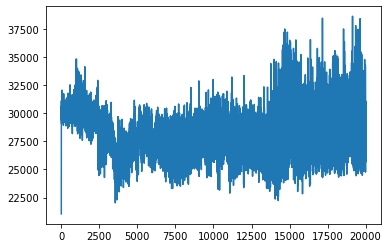

In [70]:
plt.plot(TrainingPortfolio)

(array([  11.,  358., 2896., 6342., 5765., 3409.,  955.,  210.,   40.,
          14.]),
 array([21052.7912 , 22809.07687, 24565.36254, 26321.64821, 28077.93388,
        29834.21955, 31590.50522, 33346.79089, 35103.07656, 36859.36223,
        38615.6479 ]),
 <BarContainer object of 10 artists>)

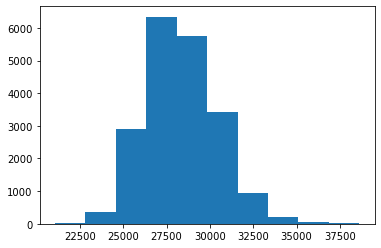

In [71]:
plt.hist(TrainingPortfolio)

In [72]:
np.mean(TestPortfolio)

20753.509393749966

(array([2.0000e+00, 2.1000e+01, 2.8200e+02, 2.2190e+03, 1.1252e+04,
        4.7960e+03, 9.3200e+02, 3.3800e+02, 1.3900e+02, 1.9000e+01]),
 array([18459.39 , 18936.378, 19413.366, 19890.354, 20367.342, 20844.33 ,
        21321.318, 21798.306, 22275.294, 22752.282, 23229.27 ]),
 <BarContainer object of 10 artists>)

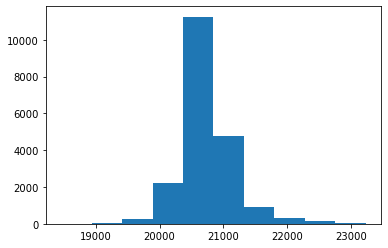

In [73]:
plt.hist(TestPortfolio)

(array([  73.,  913., 3433., 5867., 5168., 2949., 1189.,  321.,   74.,
          13.]),
 array([14168.905, 16467.003, 18765.101, 21063.199, 23361.297, 25659.395,
        27957.493, 30255.591, 32553.689, 34851.787, 37149.885]),
 <BarContainer object of 10 artists>)

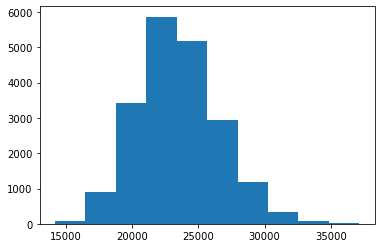

In [74]:
plt.hist(RandomPortfolio)

In [75]:
np.mean(RandomPortfolio)

23466.127843749757

In [76]:
test_data[-1]

array([159.54      , 102.63      ,  54.46      , 159.68666667,
       102.15      ,  54.92      ])

### 1000 Episode

In [77]:
env.reset()

array([    0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,   119.72      ,    63.99      ,
          56.27      ,   116.79      ,    63.99333333,    56.9       ,
       20000.        ])

In [78]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 1000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path +"/TraderWeights_1000_episode.npz", W=W, b=b)

episode: 1/1000, episode end value: 21052.79
episode: 2/1000, episode end value: 25727.15
episode: 3/1000, episode end value: 23992.24
episode: 4/1000, episode end value: 30771.14
episode: 5/1000, episode end value: 30571.01
episode: 6/1000, episode end value: 30238.49
episode: 7/1000, episode end value: 31099.66
episode: 8/1000, episode end value: 30051.95
episode: 9/1000, episode end value: 30051.95
episode: 10/1000, episode end value: 29683.22
episode: 11/1000, episode end value: 30154.67
episode: 12/1000, episode end value: 29464.01
episode: 13/1000, episode end value: 29858.61
episode: 14/1000, episode end value: 29679.76
episode: 15/1000, episode end value: 29860.96
episode: 16/1000, episode end value: 30051.95
episode: 17/1000, episode end value: 30107.61
episode: 18/1000, episode end value: 30545.73
episode: 19/1000, episode end value: 30051.95
episode: 20/1000, episode end value: 30645.37
episode: 21/1000, episode end value: 29086.04
episode: 22/1000, episode end value: 30032.

episode: 178/1000, episode end value: 29729.80
episode: 179/1000, episode end value: 30440.54
episode: 180/1000, episode end value: 29500.31
episode: 181/1000, episode end value: 29732.68
episode: 182/1000, episode end value: 30051.95
episode: 183/1000, episode end value: 29980.12
episode: 184/1000, episode end value: 29915.30
episode: 185/1000, episode end value: 29909.18
episode: 186/1000, episode end value: 30517.75
episode: 187/1000, episode end value: 30390.19
episode: 188/1000, episode end value: 30295.01
episode: 189/1000, episode end value: 30659.38
episode: 190/1000, episode end value: 29643.18
episode: 191/1000, episode end value: 29672.42
episode: 192/1000, episode end value: 30641.37
episode: 193/1000, episode end value: 29243.37
episode: 194/1000, episode end value: 30051.95
episode: 195/1000, episode end value: 30051.95
episode: 196/1000, episode end value: 30051.95
episode: 197/1000, episode end value: 29679.37
episode: 198/1000, episode end value: 30051.95
episode: 199/

episode: 353/1000, episode end value: 29845.85
episode: 354/1000, episode end value: 30152.13
episode: 355/1000, episode end value: 30998.02
episode: 356/1000, episode end value: 29935.15
episode: 357/1000, episode end value: 30051.95
episode: 358/1000, episode end value: 30802.72
episode: 359/1000, episode end value: 29635.96
episode: 360/1000, episode end value: 29936.02
episode: 361/1000, episode end value: 29989.04
episode: 362/1000, episode end value: 30689.13
episode: 363/1000, episode end value: 29806.27
episode: 364/1000, episode end value: 30497.44
episode: 365/1000, episode end value: 29696.61
episode: 366/1000, episode end value: 29723.51
episode: 367/1000, episode end value: 29858.40
episode: 368/1000, episode end value: 29620.33
episode: 369/1000, episode end value: 31371.32
episode: 370/1000, episode end value: 29818.66
episode: 371/1000, episode end value: 30299.28
episode: 372/1000, episode end value: 29908.64
episode: 373/1000, episode end value: 30051.95
episode: 374/

episode: 528/1000, episode end value: 29967.93
episode: 529/1000, episode end value: 29506.07
episode: 530/1000, episode end value: 29979.64
episode: 531/1000, episode end value: 30051.95
episode: 532/1000, episode end value: 29915.02
episode: 533/1000, episode end value: 29799.85
episode: 534/1000, episode end value: 30420.28
episode: 535/1000, episode end value: 30574.32
episode: 536/1000, episode end value: 30531.13
episode: 537/1000, episode end value: 30051.95
episode: 538/1000, episode end value: 29279.58
episode: 539/1000, episode end value: 30530.53
episode: 540/1000, episode end value: 29410.45
episode: 541/1000, episode end value: 30122.07
episode: 542/1000, episode end value: 29956.67
episode: 543/1000, episode end value: 29860.96
episode: 544/1000, episode end value: 29262.85
episode: 545/1000, episode end value: 30077.59
episode: 546/1000, episode end value: 30054.52
episode: 547/1000, episode end value: 29559.21
episode: 548/1000, episode end value: 31346.40
episode: 549/

episode: 703/1000, episode end value: 30056.81
episode: 704/1000, episode end value: 29319.21
episode: 705/1000, episode end value: 30056.15
episode: 706/1000, episode end value: 29701.61
episode: 707/1000, episode end value: 29793.73
episode: 708/1000, episode end value: 29880.30
episode: 709/1000, episode end value: 29884.10
episode: 710/1000, episode end value: 29885.45
episode: 711/1000, episode end value: 30154.02
episode: 712/1000, episode end value: 30618.62
episode: 713/1000, episode end value: 29678.72
episode: 714/1000, episode end value: 29166.89
episode: 715/1000, episode end value: 30126.79
episode: 716/1000, episode end value: 29441.11
episode: 717/1000, episode end value: 30779.52
episode: 718/1000, episode end value: 29785.80
episode: 719/1000, episode end value: 30803.53
episode: 720/1000, episode end value: 31397.88
episode: 721/1000, episode end value: 31644.59
episode: 722/1000, episode end value: 29880.30
episode: 723/1000, episode end value: 29557.17
episode: 724/

episode: 878/1000, episode end value: 30839.69
episode: 879/1000, episode end value: 31239.37
episode: 880/1000, episode end value: 31189.52
episode: 881/1000, episode end value: 30306.25
episode: 882/1000, episode end value: 30267.37
episode: 883/1000, episode end value: 31236.93
episode: 884/1000, episode end value: 31948.40
episode: 885/1000, episode end value: 31160.08
episode: 886/1000, episode end value: 32485.67
episode: 887/1000, episode end value: 30490.30
episode: 888/1000, episode end value: 30906.20
episode: 889/1000, episode end value: 30030.50
episode: 890/1000, episode end value: 30119.61
episode: 891/1000, episode end value: 31491.92
episode: 892/1000, episode end value: 29575.94
episode: 893/1000, episode end value: 31015.97
episode: 894/1000, episode end value: 30741.55
episode: 895/1000, episode end value: 31215.40
episode: 896/1000, episode end value: 29762.08
episode: 897/1000, episode end value: 29808.51
episode: 898/1000, episode end value: 29463.23
episode: 899/

In [79]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path +"/TraderWeights_1000_episode.npz")
W = npz['W']
b = npz['b']

In [80]:
W

array([[ 1.45038678,  0.55730456,  0.4099174 , ...,  0.90290751,
         1.47758054,  0.38979865],
       [ 1.28927871,  0.99589878,  0.75674776, ...,  1.24349571,
         1.86095713,  0.00939958],
       [ 1.03443152,  0.39094535,  0.17963051, ...,  0.76140001,
         1.09037468,  0.43821731],
       ...,
       [-0.36663739, -0.17387121, -0.23205586, ..., -0.94925694,
        -1.65098888,  0.07391492],
       [-0.22008888, -0.05572981,  0.27804004, ..., -0.30295909,
        -0.00265452, -0.06373997],
       [-1.002349  , -0.25407989, -0.6573531 , ..., -0.94882048,
        -1.02368387, -0.85419313]])

In [81]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 20884.84
episode: 2/1000, episode end value: 20417.00
episode: 3/1000, episode end value: 24863.79
episode: 4/1000, episode end value: 21813.53
episode: 5/1000, episode end value: 22215.25
episode: 6/1000, episode end value: 23699.97
episode: 7/1000, episode end value: 27978.00
episode: 8/1000, episode end value: 23389.53
episode: 9/1000, episode end value: 24907.30
episode: 10/1000, episode end value: 22537.74
episode: 11/1000, episode end value: 20884.84
episode: 12/1000, episode end value: 23646.93
episode: 13/1000, episode end value: 26880.81
episode: 14/1000, episode end value: 20884.84
episode: 15/1000, episode end value: 24398.36
episode: 16/1000, episode end value: 26095.82
episode: 17/1000, episode end value: 22553.01
episode: 18/1000, episode end value: 27543.48
episode: 19/1000, episode end value: 25869.48
episode: 20/1000, episode end value: 22627.49
episode: 21/1000, episode end value: 20884.84
episode: 22/1000, episode end value: 21565.

episode: 179/1000, episode end value: 25537.60
episode: 180/1000, episode end value: 22661.32
episode: 181/1000, episode end value: 27571.44
episode: 182/1000, episode end value: 23434.67
episode: 183/1000, episode end value: 22024.32
episode: 184/1000, episode end value: 25255.99
episode: 185/1000, episode end value: 23949.31
episode: 186/1000, episode end value: 23032.22
episode: 187/1000, episode end value: 27609.45
episode: 188/1000, episode end value: 21767.72
episode: 189/1000, episode end value: 27304.02
episode: 190/1000, episode end value: 23636.61
episode: 191/1000, episode end value: 20884.84
episode: 192/1000, episode end value: 22459.27
episode: 193/1000, episode end value: 20884.84
episode: 194/1000, episode end value: 21038.38
episode: 195/1000, episode end value: 20884.84
episode: 196/1000, episode end value: 20705.17
episode: 197/1000, episode end value: 27721.91
episode: 198/1000, episode end value: 20884.84
episode: 199/1000, episode end value: 22121.30
episode: 200/

episode: 354/1000, episode end value: 23591.03
episode: 355/1000, episode end value: 25128.20
episode: 356/1000, episode end value: 25854.99
episode: 357/1000, episode end value: 20884.85
episode: 358/1000, episode end value: 22585.94
episode: 359/1000, episode end value: 21265.91
episode: 360/1000, episode end value: 23822.21
episode: 361/1000, episode end value: 20884.84
episode: 362/1000, episode end value: 22008.35
episode: 363/1000, episode end value: 21156.27
episode: 364/1000, episode end value: 21573.14
episode: 365/1000, episode end value: 20884.84
episode: 366/1000, episode end value: 23337.77
episode: 367/1000, episode end value: 20884.84
episode: 368/1000, episode end value: 24333.49
episode: 369/1000, episode end value: 22709.31
episode: 370/1000, episode end value: 17994.19
episode: 371/1000, episode end value: 22883.63
episode: 372/1000, episode end value: 22026.16
episode: 373/1000, episode end value: 23647.81
episode: 374/1000, episode end value: 24460.12
episode: 375/

episode: 531/1000, episode end value: 21814.98
episode: 532/1000, episode end value: 21099.18
episode: 533/1000, episode end value: 27220.23
episode: 534/1000, episode end value: 21850.15
episode: 535/1000, episode end value: 22214.85
episode: 536/1000, episode end value: 19802.54
episode: 537/1000, episode end value: 20021.82
episode: 538/1000, episode end value: 22045.61
episode: 539/1000, episode end value: 26126.53
episode: 540/1000, episode end value: 25865.94
episode: 541/1000, episode end value: 21448.86
episode: 542/1000, episode end value: 22412.11
episode: 543/1000, episode end value: 20060.53
episode: 544/1000, episode end value: 21676.31
episode: 545/1000, episode end value: 22002.81
episode: 546/1000, episode end value: 26762.77
episode: 547/1000, episode end value: 20884.84
episode: 548/1000, episode end value: 21607.00
episode: 549/1000, episode end value: 21806.40
episode: 550/1000, episode end value: 28487.17
episode: 551/1000, episode end value: 22946.40
episode: 552/

episode: 708/1000, episode end value: 27701.14
episode: 709/1000, episode end value: 22070.33
episode: 710/1000, episode end value: 21904.69
episode: 711/1000, episode end value: 22753.26
episode: 712/1000, episode end value: 20884.84
episode: 713/1000, episode end value: 20681.44
episode: 714/1000, episode end value: 21931.08
episode: 715/1000, episode end value: 22940.25
episode: 716/1000, episode end value: 21935.32
episode: 717/1000, episode end value: 24813.42
episode: 718/1000, episode end value: 20787.93
episode: 719/1000, episode end value: 21931.67
episode: 720/1000, episode end value: 23281.52
episode: 721/1000, episode end value: 22101.09
episode: 722/1000, episode end value: 22312.10
episode: 723/1000, episode end value: 20884.85
episode: 724/1000, episode end value: 27847.45
episode: 725/1000, episode end value: 25397.00
episode: 726/1000, episode end value: 27680.72
episode: 727/1000, episode end value: 28715.35
episode: 728/1000, episode end value: 25505.23
episode: 729/

episode: 884/1000, episode end value: 26263.46
episode: 885/1000, episode end value: 26099.96
episode: 886/1000, episode end value: 20807.19
episode: 887/1000, episode end value: 20884.85
episode: 888/1000, episode end value: 24912.01
episode: 889/1000, episode end value: 16934.47
episode: 890/1000, episode end value: 23237.27
episode: 891/1000, episode end value: 20884.84
episode: 892/1000, episode end value: 20063.30
episode: 893/1000, episode end value: 30208.27
episode: 894/1000, episode end value: 27899.87
episode: 895/1000, episode end value: 20884.84
episode: 896/1000, episode end value: 22437.63
episode: 897/1000, episode end value: 20969.80
episode: 898/1000, episode end value: 20884.84
episode: 899/1000, episode end value: 20884.84
episode: 900/1000, episode end value: 20303.02
episode: 901/1000, episode end value: 22917.84
episode: 902/1000, episode end value: 24891.89
episode: 903/1000, episode end value: 24544.40
episode: 904/1000, episode end value: 23160.24
episode: 905/

In [82]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 23706.53
episode: 2/1000, episode end value: 19039.77
episode: 3/1000, episode end value: 20479.73
episode: 4/1000, episode end value: 23417.75
episode: 5/1000, episode end value: 27500.75
episode: 6/1000, episode end value: 22685.37
episode: 7/1000, episode end value: 25850.87
episode: 8/1000, episode end value: 26480.78
episode: 9/1000, episode end value: 21994.76
episode: 10/1000, episode end value: 25094.43
episode: 11/1000, episode end value: 23989.83
episode: 12/1000, episode end value: 25874.48
episode: 13/1000, episode end value: 20957.50
episode: 14/1000, episode end value: 20407.35
episode: 15/1000, episode end value: 22737.85
episode: 16/1000, episode end value: 25352.36
episode: 17/1000, episode end value: 24128.96
episode: 18/1000, episode end value: 25040.99
episode: 19/1000, episode end value: 18266.57
episode: 20/1000, episode end value: 22567.74
episode: 21/1000, episode end value: 22794.48
episode: 22/1000, episode end value: 23285.

episode: 179/1000, episode end value: 20774.18
episode: 180/1000, episode end value: 19735.73
episode: 181/1000, episode end value: 27222.92
episode: 182/1000, episode end value: 26558.16
episode: 183/1000, episode end value: 24421.80
episode: 184/1000, episode end value: 28042.94
episode: 185/1000, episode end value: 24162.87
episode: 186/1000, episode end value: 22501.60
episode: 187/1000, episode end value: 20713.85
episode: 188/1000, episode end value: 24469.00
episode: 189/1000, episode end value: 27451.08
episode: 190/1000, episode end value: 20344.04
episode: 191/1000, episode end value: 23552.24
episode: 192/1000, episode end value: 21731.66
episode: 193/1000, episode end value: 18722.45
episode: 194/1000, episode end value: 25960.03
episode: 195/1000, episode end value: 19687.50
episode: 196/1000, episode end value: 20368.09
episode: 197/1000, episode end value: 18428.41
episode: 198/1000, episode end value: 21920.37
episode: 199/1000, episode end value: 20572.19
episode: 200/

episode: 355/1000, episode end value: 22947.94
episode: 356/1000, episode end value: 23573.07
episode: 357/1000, episode end value: 21754.74
episode: 358/1000, episode end value: 19435.79
episode: 359/1000, episode end value: 23512.25
episode: 360/1000, episode end value: 24167.66
episode: 361/1000, episode end value: 24109.60
episode: 362/1000, episode end value: 20929.66
episode: 363/1000, episode end value: 25815.59
episode: 364/1000, episode end value: 21808.56
episode: 365/1000, episode end value: 20464.14
episode: 366/1000, episode end value: 28356.79
episode: 367/1000, episode end value: 22206.61
episode: 368/1000, episode end value: 21102.33
episode: 369/1000, episode end value: 18832.70
episode: 370/1000, episode end value: 28678.55
episode: 371/1000, episode end value: 19799.70
episode: 372/1000, episode end value: 19467.73
episode: 373/1000, episode end value: 19986.62
episode: 374/1000, episode end value: 20033.26
episode: 375/1000, episode end value: 27615.12
episode: 376/

episode: 530/1000, episode end value: 23589.59
episode: 531/1000, episode end value: 22343.05
episode: 532/1000, episode end value: 24232.92
episode: 533/1000, episode end value: 26235.11
episode: 534/1000, episode end value: 18609.35
episode: 535/1000, episode end value: 23838.43
episode: 536/1000, episode end value: 23312.62
episode: 537/1000, episode end value: 23948.84
episode: 538/1000, episode end value: 20153.90
episode: 539/1000, episode end value: 27732.19
episode: 540/1000, episode end value: 19894.69
episode: 541/1000, episode end value: 24173.31
episode: 542/1000, episode end value: 25711.83
episode: 543/1000, episode end value: 25079.27
episode: 544/1000, episode end value: 29151.29
episode: 545/1000, episode end value: 23097.77
episode: 546/1000, episode end value: 25224.87
episode: 547/1000, episode end value: 26908.18
episode: 548/1000, episode end value: 22684.31
episode: 549/1000, episode end value: 23140.50
episode: 550/1000, episode end value: 21293.94
episode: 551/

episode: 706/1000, episode end value: 24158.22
episode: 707/1000, episode end value: 19784.39
episode: 708/1000, episode end value: 22593.57
episode: 709/1000, episode end value: 22531.24
episode: 710/1000, episode end value: 21663.81
episode: 711/1000, episode end value: 23583.37
episode: 712/1000, episode end value: 23862.27
episode: 713/1000, episode end value: 26184.38
episode: 714/1000, episode end value: 20834.41
episode: 715/1000, episode end value: 24162.52
episode: 716/1000, episode end value: 22885.54
episode: 717/1000, episode end value: 22134.59
episode: 718/1000, episode end value: 19130.53
episode: 719/1000, episode end value: 25559.90
episode: 720/1000, episode end value: 23064.08
episode: 721/1000, episode end value: 24345.08
episode: 722/1000, episode end value: 23078.12
episode: 723/1000, episode end value: 25056.57
episode: 724/1000, episode end value: 18130.93
episode: 725/1000, episode end value: 17871.96
episode: 726/1000, episode end value: 23206.43
episode: 727/

episode: 882/1000, episode end value: 28218.67
episode: 883/1000, episode end value: 27798.59
episode: 884/1000, episode end value: 21393.42
episode: 885/1000, episode end value: 24341.61
episode: 886/1000, episode end value: 28989.00
episode: 887/1000, episode end value: 22741.53
episode: 888/1000, episode end value: 21705.79
episode: 889/1000, episode end value: 23785.98
episode: 890/1000, episode end value: 24013.83
episode: 891/1000, episode end value: 18736.38
episode: 892/1000, episode end value: 17096.43
episode: 893/1000, episode end value: 21857.70
episode: 894/1000, episode end value: 19057.48
episode: 895/1000, episode end value: 22634.41
episode: 896/1000, episode end value: 22705.04
episode: 897/1000, episode end value: 20746.31
episode: 898/1000, episode end value: 27019.98
episode: 899/1000, episode end value: 21833.70
episode: 900/1000, episode end value: 28263.86
episode: 901/1000, episode end value: 20413.13
episode: 902/1000, episode end value: 20284.31
episode: 903/

In [83]:
np.savez(saving_models_path +"TraderPortfolios_1000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [84]:
npz = np.load(saving_models_path +"TraderPortfolios_1000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

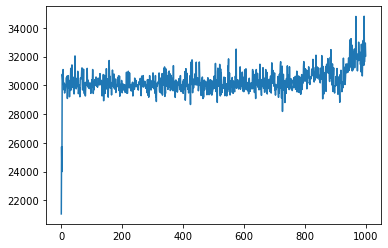

In [85]:
plt.plot(TrainingPortfolio)

(array([  1.,   0.,   1.,   1.,   0.,  33., 754., 180.,  28.,   2.]),
 array([21052.7912 , 22428.38295, 23803.9747 , 25179.56645, 26555.1582 ,
        27930.74995, 29306.3417 , 30681.93345, 32057.5252 , 33433.11695,
        34808.7087 ]),
 <BarContainer object of 10 artists>)

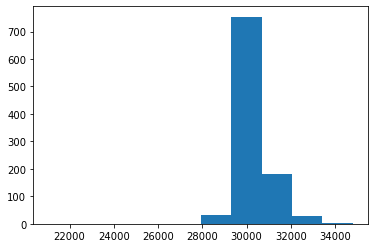

In [86]:
plt.hist(TrainingPortfolio)

In [87]:
np.mean(TestPortfolio)

23301.042525000037

(array([  3.,  47., 341., 229., 139., 122.,  76.,  27.,  12.,   4.]),
 array([16934.465, 18597.563, 20260.661, 21923.759, 23586.857, 25249.955,
        26913.053, 28576.151, 30239.249, 31902.347, 33565.445]),
 <BarContainer object of 10 artists>)

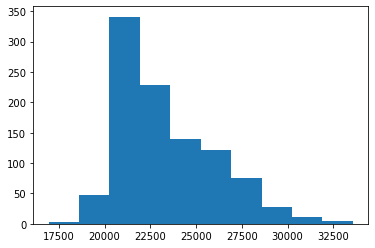

In [88]:
plt.hist(TestPortfolio)

(array([  2.,  34., 120., 203., 261., 195., 115.,  49.,  15.,   6.]),
 array([14741.875 , 16654.6105, 18567.346 , 20480.0815, 22392.817 ,
        24305.5525, 26218.288 , 28131.0235, 30043.759 , 31956.4945,
        33869.23  ]),
 <BarContainer object of 10 artists>)

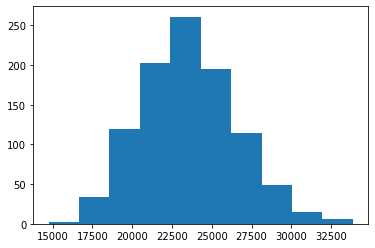

In [89]:
plt.hist(RandomPortfolio)

In [90]:
np.mean(RandomPortfolio)

23575.401874999774

In [91]:
test_data[-1]

array([159.54      , 102.63      ,  54.46      , 159.68666667,
       102.15      ,  54.92      ])

### 1000 Episode

In [77]:
env.reset()

array([    0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,   119.72      ,    63.99      ,
          56.27      ,   116.79      ,    63.99333333,    56.9       ,
       20000.        ])

In [78]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 1000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"TraderWeights_1000_episode.npz", W=W, b=b)

episode: 1/1000, episode end value: 21052.79
episode: 2/1000, episode end value: 25727.15
episode: 3/1000, episode end value: 23992.24
episode: 4/1000, episode end value: 30771.14
episode: 5/1000, episode end value: 30571.01
episode: 6/1000, episode end value: 30238.49
episode: 7/1000, episode end value: 31099.66
episode: 8/1000, episode end value: 30051.95
episode: 9/1000, episode end value: 30051.95
episode: 10/1000, episode end value: 29683.22
episode: 11/1000, episode end value: 30154.67
episode: 12/1000, episode end value: 29464.01
episode: 13/1000, episode end value: 29858.61
episode: 14/1000, episode end value: 29679.76
episode: 15/1000, episode end value: 29860.96
episode: 16/1000, episode end value: 30051.95
episode: 17/1000, episode end value: 30107.61
episode: 18/1000, episode end value: 30545.73
episode: 19/1000, episode end value: 30051.95
episode: 20/1000, episode end value: 30645.37
episode: 21/1000, episode end value: 29086.04
episode: 22/1000, episode end value: 30032.

episode: 178/1000, episode end value: 29729.80
episode: 179/1000, episode end value: 30440.54
episode: 180/1000, episode end value: 29500.31
episode: 181/1000, episode end value: 29732.68
episode: 182/1000, episode end value: 30051.95
episode: 183/1000, episode end value: 29980.12
episode: 184/1000, episode end value: 29915.30
episode: 185/1000, episode end value: 29909.18
episode: 186/1000, episode end value: 30517.75
episode: 187/1000, episode end value: 30390.19
episode: 188/1000, episode end value: 30295.01
episode: 189/1000, episode end value: 30659.38
episode: 190/1000, episode end value: 29643.18
episode: 191/1000, episode end value: 29672.42
episode: 192/1000, episode end value: 30641.37
episode: 193/1000, episode end value: 29243.37
episode: 194/1000, episode end value: 30051.95
episode: 195/1000, episode end value: 30051.95
episode: 196/1000, episode end value: 30051.95
episode: 197/1000, episode end value: 29679.37
episode: 198/1000, episode end value: 30051.95
episode: 199/

episode: 353/1000, episode end value: 29845.85
episode: 354/1000, episode end value: 30152.13
episode: 355/1000, episode end value: 30998.02
episode: 356/1000, episode end value: 29935.15
episode: 357/1000, episode end value: 30051.95
episode: 358/1000, episode end value: 30802.72
episode: 359/1000, episode end value: 29635.96
episode: 360/1000, episode end value: 29936.02
episode: 361/1000, episode end value: 29989.04
episode: 362/1000, episode end value: 30689.13
episode: 363/1000, episode end value: 29806.27
episode: 364/1000, episode end value: 30497.44
episode: 365/1000, episode end value: 29696.61
episode: 366/1000, episode end value: 29723.51
episode: 367/1000, episode end value: 29858.40
episode: 368/1000, episode end value: 29620.33
episode: 369/1000, episode end value: 31371.32
episode: 370/1000, episode end value: 29818.66
episode: 371/1000, episode end value: 30299.28
episode: 372/1000, episode end value: 29908.64
episode: 373/1000, episode end value: 30051.95
episode: 374/

episode: 528/1000, episode end value: 29967.93
episode: 529/1000, episode end value: 29506.07
episode: 530/1000, episode end value: 29979.64
episode: 531/1000, episode end value: 30051.95
episode: 532/1000, episode end value: 29915.02
episode: 533/1000, episode end value: 29799.85
episode: 534/1000, episode end value: 30420.28
episode: 535/1000, episode end value: 30574.32
episode: 536/1000, episode end value: 30531.13
episode: 537/1000, episode end value: 30051.95
episode: 538/1000, episode end value: 29279.58
episode: 539/1000, episode end value: 30530.53
episode: 540/1000, episode end value: 29410.45
episode: 541/1000, episode end value: 30122.07
episode: 542/1000, episode end value: 29956.67
episode: 543/1000, episode end value: 29860.96
episode: 544/1000, episode end value: 29262.85
episode: 545/1000, episode end value: 30077.59
episode: 546/1000, episode end value: 30054.52
episode: 547/1000, episode end value: 29559.21
episode: 548/1000, episode end value: 31346.40
episode: 549/

episode: 703/1000, episode end value: 30056.81
episode: 704/1000, episode end value: 29319.21
episode: 705/1000, episode end value: 30056.15
episode: 706/1000, episode end value: 29701.61
episode: 707/1000, episode end value: 29793.73
episode: 708/1000, episode end value: 29880.30
episode: 709/1000, episode end value: 29884.10
episode: 710/1000, episode end value: 29885.45
episode: 711/1000, episode end value: 30154.02
episode: 712/1000, episode end value: 30618.62
episode: 713/1000, episode end value: 29678.72
episode: 714/1000, episode end value: 29166.89
episode: 715/1000, episode end value: 30126.79
episode: 716/1000, episode end value: 29441.11
episode: 717/1000, episode end value: 30779.52
episode: 718/1000, episode end value: 29785.80
episode: 719/1000, episode end value: 30803.53
episode: 720/1000, episode end value: 31397.88
episode: 721/1000, episode end value: 31644.59
episode: 722/1000, episode end value: 29880.30
episode: 723/1000, episode end value: 29557.17
episode: 724/

episode: 878/1000, episode end value: 30839.69
episode: 879/1000, episode end value: 31239.37
episode: 880/1000, episode end value: 31189.52
episode: 881/1000, episode end value: 30306.25
episode: 882/1000, episode end value: 30267.37
episode: 883/1000, episode end value: 31236.93
episode: 884/1000, episode end value: 31948.40
episode: 885/1000, episode end value: 31160.08
episode: 886/1000, episode end value: 32485.67
episode: 887/1000, episode end value: 30490.30
episode: 888/1000, episode end value: 30906.20
episode: 889/1000, episode end value: 30030.50
episode: 890/1000, episode end value: 30119.61
episode: 891/1000, episode end value: 31491.92
episode: 892/1000, episode end value: 29575.94
episode: 893/1000, episode end value: 31015.97
episode: 894/1000, episode end value: 30741.55
episode: 895/1000, episode end value: 31215.40
episode: 896/1000, episode end value: 29762.08
episode: 897/1000, episode end value: 29808.51
episode: 898/1000, episode end value: 29463.23
episode: 899/

In [79]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"TraderWeights_1000_episode.npz")
W = npz['W']
b = npz['b']

In [80]:
W

array([[ 1.45038678,  0.55730456,  0.4099174 , ...,  0.90290751,
         1.47758054,  0.38979865],
       [ 1.28927871,  0.99589878,  0.75674776, ...,  1.24349571,
         1.86095713,  0.00939958],
       [ 1.03443152,  0.39094535,  0.17963051, ...,  0.76140001,
         1.09037468,  0.43821731],
       ...,
       [-0.36663739, -0.17387121, -0.23205586, ..., -0.94925694,
        -1.65098888,  0.07391492],
       [-0.22008888, -0.05572981,  0.27804004, ..., -0.30295909,
        -0.00265452, -0.06373997],
       [-1.002349  , -0.25407989, -0.6573531 , ..., -0.94882048,
        -1.02368387, -0.85419313]])

In [81]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 20884.84
episode: 2/1000, episode end value: 20417.00
episode: 3/1000, episode end value: 24863.79
episode: 4/1000, episode end value: 21813.53
episode: 5/1000, episode end value: 22215.25
episode: 6/1000, episode end value: 23699.97
episode: 7/1000, episode end value: 27978.00
episode: 8/1000, episode end value: 23389.53
episode: 9/1000, episode end value: 24907.30
episode: 10/1000, episode end value: 22537.74
episode: 11/1000, episode end value: 20884.84
episode: 12/1000, episode end value: 23646.93
episode: 13/1000, episode end value: 26880.81
episode: 14/1000, episode end value: 20884.84
episode: 15/1000, episode end value: 24398.36
episode: 16/1000, episode end value: 26095.82
episode: 17/1000, episode end value: 22553.01
episode: 18/1000, episode end value: 27543.48
episode: 19/1000, episode end value: 25869.48
episode: 20/1000, episode end value: 22627.49
episode: 21/1000, episode end value: 20884.84
episode: 22/1000, episode end value: 21565.

episode: 179/1000, episode end value: 25537.60
episode: 180/1000, episode end value: 22661.32
episode: 181/1000, episode end value: 27571.44
episode: 182/1000, episode end value: 23434.67
episode: 183/1000, episode end value: 22024.32
episode: 184/1000, episode end value: 25255.99
episode: 185/1000, episode end value: 23949.31
episode: 186/1000, episode end value: 23032.22
episode: 187/1000, episode end value: 27609.45
episode: 188/1000, episode end value: 21767.72
episode: 189/1000, episode end value: 27304.02
episode: 190/1000, episode end value: 23636.61
episode: 191/1000, episode end value: 20884.84
episode: 192/1000, episode end value: 22459.27
episode: 193/1000, episode end value: 20884.84
episode: 194/1000, episode end value: 21038.38
episode: 195/1000, episode end value: 20884.84
episode: 196/1000, episode end value: 20705.17
episode: 197/1000, episode end value: 27721.91
episode: 198/1000, episode end value: 20884.84
episode: 199/1000, episode end value: 22121.30
episode: 200/

episode: 354/1000, episode end value: 23591.03
episode: 355/1000, episode end value: 25128.20
episode: 356/1000, episode end value: 25854.99
episode: 357/1000, episode end value: 20884.85
episode: 358/1000, episode end value: 22585.94
episode: 359/1000, episode end value: 21265.91
episode: 360/1000, episode end value: 23822.21
episode: 361/1000, episode end value: 20884.84
episode: 362/1000, episode end value: 22008.35
episode: 363/1000, episode end value: 21156.27
episode: 364/1000, episode end value: 21573.14
episode: 365/1000, episode end value: 20884.84
episode: 366/1000, episode end value: 23337.77
episode: 367/1000, episode end value: 20884.84
episode: 368/1000, episode end value: 24333.49
episode: 369/1000, episode end value: 22709.31
episode: 370/1000, episode end value: 17994.19
episode: 371/1000, episode end value: 22883.63
episode: 372/1000, episode end value: 22026.16
episode: 373/1000, episode end value: 23647.81
episode: 374/1000, episode end value: 24460.12
episode: 375/

episode: 531/1000, episode end value: 21814.98
episode: 532/1000, episode end value: 21099.18
episode: 533/1000, episode end value: 27220.23
episode: 534/1000, episode end value: 21850.15
episode: 535/1000, episode end value: 22214.85
episode: 536/1000, episode end value: 19802.54
episode: 537/1000, episode end value: 20021.82
episode: 538/1000, episode end value: 22045.61
episode: 539/1000, episode end value: 26126.53
episode: 540/1000, episode end value: 25865.94
episode: 541/1000, episode end value: 21448.86
episode: 542/1000, episode end value: 22412.11
episode: 543/1000, episode end value: 20060.53
episode: 544/1000, episode end value: 21676.31
episode: 545/1000, episode end value: 22002.81
episode: 546/1000, episode end value: 26762.77
episode: 547/1000, episode end value: 20884.84
episode: 548/1000, episode end value: 21607.00
episode: 549/1000, episode end value: 21806.40
episode: 550/1000, episode end value: 28487.17
episode: 551/1000, episode end value: 22946.40
episode: 552/

episode: 708/1000, episode end value: 27701.14
episode: 709/1000, episode end value: 22070.33
episode: 710/1000, episode end value: 21904.69
episode: 711/1000, episode end value: 22753.26
episode: 712/1000, episode end value: 20884.84
episode: 713/1000, episode end value: 20681.44
episode: 714/1000, episode end value: 21931.08
episode: 715/1000, episode end value: 22940.25
episode: 716/1000, episode end value: 21935.32
episode: 717/1000, episode end value: 24813.42
episode: 718/1000, episode end value: 20787.93
episode: 719/1000, episode end value: 21931.67
episode: 720/1000, episode end value: 23281.52
episode: 721/1000, episode end value: 22101.09
episode: 722/1000, episode end value: 22312.10
episode: 723/1000, episode end value: 20884.85
episode: 724/1000, episode end value: 27847.45
episode: 725/1000, episode end value: 25397.00
episode: 726/1000, episode end value: 27680.72
episode: 727/1000, episode end value: 28715.35
episode: 728/1000, episode end value: 25505.23
episode: 729/

episode: 884/1000, episode end value: 26263.46
episode: 885/1000, episode end value: 26099.96
episode: 886/1000, episode end value: 20807.19
episode: 887/1000, episode end value: 20884.85
episode: 888/1000, episode end value: 24912.01
episode: 889/1000, episode end value: 16934.47
episode: 890/1000, episode end value: 23237.27
episode: 891/1000, episode end value: 20884.84
episode: 892/1000, episode end value: 20063.30
episode: 893/1000, episode end value: 30208.27
episode: 894/1000, episode end value: 27899.87
episode: 895/1000, episode end value: 20884.84
episode: 896/1000, episode end value: 22437.63
episode: 897/1000, episode end value: 20969.80
episode: 898/1000, episode end value: 20884.84
episode: 899/1000, episode end value: 20884.84
episode: 900/1000, episode end value: 20303.02
episode: 901/1000, episode end value: 22917.84
episode: 902/1000, episode end value: 24891.89
episode: 903/1000, episode end value: 24544.40
episode: 904/1000, episode end value: 23160.24
episode: 905/

In [82]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 23706.53
episode: 2/1000, episode end value: 19039.77
episode: 3/1000, episode end value: 20479.73
episode: 4/1000, episode end value: 23417.75
episode: 5/1000, episode end value: 27500.75
episode: 6/1000, episode end value: 22685.37
episode: 7/1000, episode end value: 25850.87
episode: 8/1000, episode end value: 26480.78
episode: 9/1000, episode end value: 21994.76
episode: 10/1000, episode end value: 25094.43
episode: 11/1000, episode end value: 23989.83
episode: 12/1000, episode end value: 25874.48
episode: 13/1000, episode end value: 20957.50
episode: 14/1000, episode end value: 20407.35
episode: 15/1000, episode end value: 22737.85
episode: 16/1000, episode end value: 25352.36
episode: 17/1000, episode end value: 24128.96
episode: 18/1000, episode end value: 25040.99
episode: 19/1000, episode end value: 18266.57
episode: 20/1000, episode end value: 22567.74
episode: 21/1000, episode end value: 22794.48
episode: 22/1000, episode end value: 23285.

episode: 179/1000, episode end value: 20774.18
episode: 180/1000, episode end value: 19735.73
episode: 181/1000, episode end value: 27222.92
episode: 182/1000, episode end value: 26558.16
episode: 183/1000, episode end value: 24421.80
episode: 184/1000, episode end value: 28042.94
episode: 185/1000, episode end value: 24162.87
episode: 186/1000, episode end value: 22501.60
episode: 187/1000, episode end value: 20713.85
episode: 188/1000, episode end value: 24469.00
episode: 189/1000, episode end value: 27451.08
episode: 190/1000, episode end value: 20344.04
episode: 191/1000, episode end value: 23552.24
episode: 192/1000, episode end value: 21731.66
episode: 193/1000, episode end value: 18722.45
episode: 194/1000, episode end value: 25960.03
episode: 195/1000, episode end value: 19687.50
episode: 196/1000, episode end value: 20368.09
episode: 197/1000, episode end value: 18428.41
episode: 198/1000, episode end value: 21920.37
episode: 199/1000, episode end value: 20572.19
episode: 200/

episode: 355/1000, episode end value: 22947.94
episode: 356/1000, episode end value: 23573.07
episode: 357/1000, episode end value: 21754.74
episode: 358/1000, episode end value: 19435.79
episode: 359/1000, episode end value: 23512.25
episode: 360/1000, episode end value: 24167.66
episode: 361/1000, episode end value: 24109.60
episode: 362/1000, episode end value: 20929.66
episode: 363/1000, episode end value: 25815.59
episode: 364/1000, episode end value: 21808.56
episode: 365/1000, episode end value: 20464.14
episode: 366/1000, episode end value: 28356.79
episode: 367/1000, episode end value: 22206.61
episode: 368/1000, episode end value: 21102.33
episode: 369/1000, episode end value: 18832.70
episode: 370/1000, episode end value: 28678.55
episode: 371/1000, episode end value: 19799.70
episode: 372/1000, episode end value: 19467.73
episode: 373/1000, episode end value: 19986.62
episode: 374/1000, episode end value: 20033.26
episode: 375/1000, episode end value: 27615.12
episode: 376/

episode: 530/1000, episode end value: 23589.59
episode: 531/1000, episode end value: 22343.05
episode: 532/1000, episode end value: 24232.92
episode: 533/1000, episode end value: 26235.11
episode: 534/1000, episode end value: 18609.35
episode: 535/1000, episode end value: 23838.43
episode: 536/1000, episode end value: 23312.62
episode: 537/1000, episode end value: 23948.84
episode: 538/1000, episode end value: 20153.90
episode: 539/1000, episode end value: 27732.19
episode: 540/1000, episode end value: 19894.69
episode: 541/1000, episode end value: 24173.31
episode: 542/1000, episode end value: 25711.83
episode: 543/1000, episode end value: 25079.27
episode: 544/1000, episode end value: 29151.29
episode: 545/1000, episode end value: 23097.77
episode: 546/1000, episode end value: 25224.87
episode: 547/1000, episode end value: 26908.18
episode: 548/1000, episode end value: 22684.31
episode: 549/1000, episode end value: 23140.50
episode: 550/1000, episode end value: 21293.94
episode: 551/

episode: 706/1000, episode end value: 24158.22
episode: 707/1000, episode end value: 19784.39
episode: 708/1000, episode end value: 22593.57
episode: 709/1000, episode end value: 22531.24
episode: 710/1000, episode end value: 21663.81
episode: 711/1000, episode end value: 23583.37
episode: 712/1000, episode end value: 23862.27
episode: 713/1000, episode end value: 26184.38
episode: 714/1000, episode end value: 20834.41
episode: 715/1000, episode end value: 24162.52
episode: 716/1000, episode end value: 22885.54
episode: 717/1000, episode end value: 22134.59
episode: 718/1000, episode end value: 19130.53
episode: 719/1000, episode end value: 25559.90
episode: 720/1000, episode end value: 23064.08
episode: 721/1000, episode end value: 24345.08
episode: 722/1000, episode end value: 23078.12
episode: 723/1000, episode end value: 25056.57
episode: 724/1000, episode end value: 18130.93
episode: 725/1000, episode end value: 17871.96
episode: 726/1000, episode end value: 23206.43
episode: 727/

episode: 882/1000, episode end value: 28218.67
episode: 883/1000, episode end value: 27798.59
episode: 884/1000, episode end value: 21393.42
episode: 885/1000, episode end value: 24341.61
episode: 886/1000, episode end value: 28989.00
episode: 887/1000, episode end value: 22741.53
episode: 888/1000, episode end value: 21705.79
episode: 889/1000, episode end value: 23785.98
episode: 890/1000, episode end value: 24013.83
episode: 891/1000, episode end value: 18736.38
episode: 892/1000, episode end value: 17096.43
episode: 893/1000, episode end value: 21857.70
episode: 894/1000, episode end value: 19057.48
episode: 895/1000, episode end value: 22634.41
episode: 896/1000, episode end value: 22705.04
episode: 897/1000, episode end value: 20746.31
episode: 898/1000, episode end value: 27019.98
episode: 899/1000, episode end value: 21833.70
episode: 900/1000, episode end value: 28263.86
episode: 901/1000, episode end value: 20413.13
episode: 902/1000, episode end value: 20284.31
episode: 903/

In [83]:
np.savez(saving_models_path+"/TraderPortfolios_1000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [84]:
npz = np.load(saving_models_path+"/TraderPortfolios_1000_episode.npz",)
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

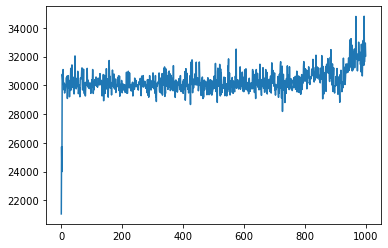

In [85]:
plt.plot(TrainingPortfolio)

(array([  1.,   0.,   1.,   1.,   0.,  33., 754., 180.,  28.,   2.]),
 array([21052.7912 , 22428.38295, 23803.9747 , 25179.56645, 26555.1582 ,
        27930.74995, 29306.3417 , 30681.93345, 32057.5252 , 33433.11695,
        34808.7087 ]),
 <BarContainer object of 10 artists>)

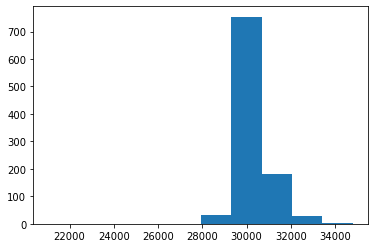

In [86]:
plt.hist(TrainingPortfolio)

In [87]:
np.mean(TestPortfolio)

23301.042525000037

(array([  3.,  47., 341., 229., 139., 122.,  76.,  27.,  12.,   4.]),
 array([16934.465, 18597.563, 20260.661, 21923.759, 23586.857, 25249.955,
        26913.053, 28576.151, 30239.249, 31902.347, 33565.445]),
 <BarContainer object of 10 artists>)

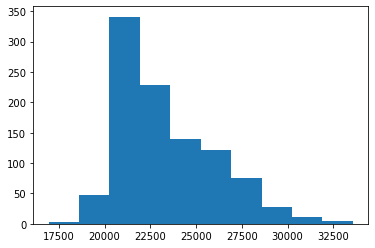

In [88]:
plt.hist(TestPortfolio)

(array([  2.,  34., 120., 203., 261., 195., 115.,  49.,  15.,   6.]),
 array([14741.875 , 16654.6105, 18567.346 , 20480.0815, 22392.817 ,
        24305.5525, 26218.288 , 28131.0235, 30043.759 , 31956.4945,
        33869.23  ]),
 <BarContainer object of 10 artists>)

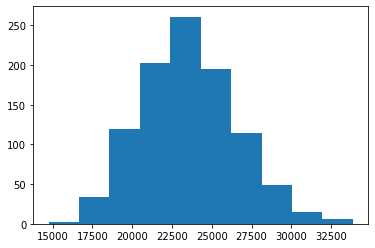

In [89]:
plt.hist(RandomPortfolio)

In [90]:
np.mean(RandomPortfolio)

23575.401874999774

In [91]:
test_data[-1]

array([159.54      , 102.63      ,  54.46      , 159.68666667,
       102.15      ,  54.92      ])

### 20000 Episode & epsilon = 0.1

In [92]:
env.reset()

array([    0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,   119.72      ,    63.99      ,
          56.27      ,   116.79      ,    63.99333333,    56.9       ,
       20000.        ])

In [93]:
gamma = 0.95  # discount rate
epsilon = 0.1
num_episodes = 20000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_eps01_20000_episode.npz", W=W, b=b)

episode: 1/20000, episode end value: 24664.34
episode: 2/20000, episode end value: 25796.69
episode: 3/20000, episode end value: 30243.29
episode: 4/20000, episode end value: 33165.51
episode: 5/20000, episode end value: 34250.51
episode: 6/20000, episode end value: 28256.62
episode: 7/20000, episode end value: 32783.85
episode: 8/20000, episode end value: 30056.74
episode: 9/20000, episode end value: 29878.45
episode: 10/20000, episode end value: 29142.33
episode: 11/20000, episode end value: 29305.28
episode: 12/20000, episode end value: 29602.58
episode: 13/20000, episode end value: 29883.65
episode: 14/20000, episode end value: 29642.60
episode: 15/20000, episode end value: 29332.83
episode: 16/20000, episode end value: 30191.76
episode: 17/20000, episode end value: 26819.83
episode: 18/20000, episode end value: 28890.17
episode: 19/20000, episode end value: 27314.99
episode: 20/20000, episode end value: 29279.01
episode: 21/20000, episode end value: 27903.67
episode: 22/20000, epi

episode: 174/20000, episode end value: 31767.54
episode: 175/20000, episode end value: 29556.93
episode: 176/20000, episode end value: 29637.86
episode: 177/20000, episode end value: 31213.06
episode: 178/20000, episode end value: 29268.04
episode: 179/20000, episode end value: 28832.05
episode: 180/20000, episode end value: 30476.33
episode: 181/20000, episode end value: 29492.52
episode: 182/20000, episode end value: 30090.25
episode: 183/20000, episode end value: 32191.68
episode: 184/20000, episode end value: 30463.75
episode: 185/20000, episode end value: 30229.34
episode: 186/20000, episode end value: 29734.97
episode: 187/20000, episode end value: 31336.80
episode: 188/20000, episode end value: 29847.41
episode: 189/20000, episode end value: 30691.18
episode: 190/20000, episode end value: 31279.82
episode: 191/20000, episode end value: 29977.24
episode: 192/20000, episode end value: 31144.73
episode: 193/20000, episode end value: 30303.28
episode: 194/20000, episode end value: 3

episode: 345/20000, episode end value: 30528.51
episode: 346/20000, episode end value: 29030.41
episode: 347/20000, episode end value: 29018.98
episode: 348/20000, episode end value: 31755.33
episode: 349/20000, episode end value: 28259.20
episode: 350/20000, episode end value: 29771.88
episode: 351/20000, episode end value: 30445.70
episode: 352/20000, episode end value: 28845.09
episode: 353/20000, episode end value: 28995.80
episode: 354/20000, episode end value: 29400.88
episode: 355/20000, episode end value: 29642.73
episode: 356/20000, episode end value: 31873.22
episode: 357/20000, episode end value: 29851.20
episode: 358/20000, episode end value: 29546.54
episode: 359/20000, episode end value: 32482.69
episode: 360/20000, episode end value: 28680.90
episode: 361/20000, episode end value: 30742.59
episode: 362/20000, episode end value: 28022.86
episode: 363/20000, episode end value: 31548.92
episode: 364/20000, episode end value: 29424.08
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 31228.32
episode: 517/20000, episode end value: 29793.54
episode: 518/20000, episode end value: 28620.29
episode: 519/20000, episode end value: 27983.57
episode: 520/20000, episode end value: 30035.40
episode: 521/20000, episode end value: 31714.10
episode: 522/20000, episode end value: 29730.03
episode: 523/20000, episode end value: 29699.99
episode: 524/20000, episode end value: 29742.04
episode: 525/20000, episode end value: 29643.20
episode: 526/20000, episode end value: 27732.35
episode: 527/20000, episode end value: 30944.94
episode: 528/20000, episode end value: 28782.70
episode: 529/20000, episode end value: 29350.17
episode: 530/20000, episode end value: 26413.26
episode: 531/20000, episode end value: 27764.06
episode: 532/20000, episode end value: 28239.34
episode: 533/20000, episode end value: 27663.67
episode: 534/20000, episode end value: 30559.66
episode: 535/20000, episode end value: 26770.10
episode: 536/20000, episode end value: 2

episode: 687/20000, episode end value: 28244.68
episode: 688/20000, episode end value: 28045.96
episode: 689/20000, episode end value: 29556.56
episode: 690/20000, episode end value: 29693.40
episode: 691/20000, episode end value: 28231.15
episode: 692/20000, episode end value: 30588.59
episode: 693/20000, episode end value: 27346.66
episode: 694/20000, episode end value: 30506.12
episode: 695/20000, episode end value: 28888.26
episode: 696/20000, episode end value: 31066.64
episode: 697/20000, episode end value: 31247.28
episode: 698/20000, episode end value: 29572.14
episode: 699/20000, episode end value: 28516.30
episode: 700/20000, episode end value: 31366.23
episode: 701/20000, episode end value: 26667.45
episode: 702/20000, episode end value: 28929.43
episode: 703/20000, episode end value: 27716.44
episode: 704/20000, episode end value: 30005.08
episode: 705/20000, episode end value: 29745.51
episode: 706/20000, episode end value: 29597.97
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 27216.42
episode: 859/20000, episode end value: 28597.65
episode: 860/20000, episode end value: 28740.52
episode: 861/20000, episode end value: 27801.79
episode: 862/20000, episode end value: 31456.71
episode: 863/20000, episode end value: 28505.78
episode: 864/20000, episode end value: 28050.93
episode: 865/20000, episode end value: 28525.62
episode: 866/20000, episode end value: 29778.62
episode: 867/20000, episode end value: 28032.71
episode: 868/20000, episode end value: 27762.41
episode: 869/20000, episode end value: 28886.31
episode: 870/20000, episode end value: 28027.95
episode: 871/20000, episode end value: 30229.00
episode: 872/20000, episode end value: 29639.48
episode: 873/20000, episode end value: 29267.30
episode: 874/20000, episode end value: 28907.41
episode: 875/20000, episode end value: 28867.27
episode: 876/20000, episode end value: 28493.47
episode: 877/20000, episode end value: 28816.67
episode: 878/20000, episode end value: 2

episode: 1029/20000, episode end value: 28952.14
episode: 1030/20000, episode end value: 29779.01
episode: 1031/20000, episode end value: 29756.67
episode: 1032/20000, episode end value: 31473.15
episode: 1033/20000, episode end value: 30048.64
episode: 1034/20000, episode end value: 30261.63
episode: 1035/20000, episode end value: 28789.35
episode: 1036/20000, episode end value: 29265.79
episode: 1037/20000, episode end value: 29117.97
episode: 1038/20000, episode end value: 29581.31
episode: 1039/20000, episode end value: 29070.50
episode: 1040/20000, episode end value: 30545.01
episode: 1041/20000, episode end value: 29611.12
episode: 1042/20000, episode end value: 28877.80
episode: 1043/20000, episode end value: 32541.15
episode: 1044/20000, episode end value: 30373.02
episode: 1045/20000, episode end value: 29132.05
episode: 1046/20000, episode end value: 30773.70
episode: 1047/20000, episode end value: 29144.07
episode: 1048/20000, episode end value: 29928.76
episode: 1049/20000,

episode: 1197/20000, episode end value: 33231.65
episode: 1198/20000, episode end value: 31243.08
episode: 1199/20000, episode end value: 30914.99
episode: 1200/20000, episode end value: 30621.02
episode: 1201/20000, episode end value: 29765.45
episode: 1202/20000, episode end value: 31691.25
episode: 1203/20000, episode end value: 29795.03
episode: 1204/20000, episode end value: 31918.83
episode: 1205/20000, episode end value: 31251.37
episode: 1206/20000, episode end value: 30500.72
episode: 1207/20000, episode end value: 31919.95
episode: 1208/20000, episode end value: 29735.07
episode: 1209/20000, episode end value: 27494.45
episode: 1210/20000, episode end value: 30046.90
episode: 1211/20000, episode end value: 29463.52
episode: 1212/20000, episode end value: 30424.77
episode: 1213/20000, episode end value: 30247.72
episode: 1214/20000, episode end value: 30396.55
episode: 1215/20000, episode end value: 30369.41
episode: 1216/20000, episode end value: 29493.52
episode: 1217/20000,

episode: 1365/20000, episode end value: 29549.62
episode: 1366/20000, episode end value: 30679.16
episode: 1367/20000, episode end value: 29978.83
episode: 1368/20000, episode end value: 29414.42
episode: 1369/20000, episode end value: 29613.09
episode: 1370/20000, episode end value: 29399.17
episode: 1371/20000, episode end value: 30240.58
episode: 1372/20000, episode end value: 30958.25
episode: 1373/20000, episode end value: 29381.73
episode: 1374/20000, episode end value: 30890.52
episode: 1375/20000, episode end value: 29099.69
episode: 1376/20000, episode end value: 29582.59
episode: 1377/20000, episode end value: 31126.71
episode: 1378/20000, episode end value: 29109.67
episode: 1379/20000, episode end value: 31718.81
episode: 1380/20000, episode end value: 30011.27
episode: 1381/20000, episode end value: 29179.27
episode: 1382/20000, episode end value: 31330.11
episode: 1383/20000, episode end value: 29622.51
episode: 1384/20000, episode end value: 28664.69
episode: 1385/20000,

episode: 1533/20000, episode end value: 28237.93
episode: 1534/20000, episode end value: 29618.89
episode: 1535/20000, episode end value: 27817.29
episode: 1536/20000, episode end value: 30603.42
episode: 1537/20000, episode end value: 29598.63
episode: 1538/20000, episode end value: 29909.70
episode: 1539/20000, episode end value: 32161.25
episode: 1540/20000, episode end value: 31232.49
episode: 1541/20000, episode end value: 30536.55
episode: 1542/20000, episode end value: 30282.37
episode: 1543/20000, episode end value: 29631.16
episode: 1544/20000, episode end value: 29636.10
episode: 1545/20000, episode end value: 31645.77
episode: 1546/20000, episode end value: 31919.97
episode: 1547/20000, episode end value: 31263.83
episode: 1548/20000, episode end value: 30273.49
episode: 1549/20000, episode end value: 31251.78
episode: 1550/20000, episode end value: 29278.78
episode: 1551/20000, episode end value: 31759.30
episode: 1552/20000, episode end value: 31135.03
episode: 1553/20000,

episode: 1701/20000, episode end value: 28653.12
episode: 1702/20000, episode end value: 28193.63
episode: 1703/20000, episode end value: 30089.08
episode: 1704/20000, episode end value: 28917.16
episode: 1705/20000, episode end value: 31201.53
episode: 1706/20000, episode end value: 27075.34
episode: 1707/20000, episode end value: 30129.37
episode: 1708/20000, episode end value: 30997.79
episode: 1709/20000, episode end value: 30382.29
episode: 1710/20000, episode end value: 29966.20
episode: 1711/20000, episode end value: 30886.03
episode: 1712/20000, episode end value: 28992.60
episode: 1713/20000, episode end value: 28417.98
episode: 1714/20000, episode end value: 30679.01
episode: 1715/20000, episode end value: 29018.85
episode: 1716/20000, episode end value: 30280.70
episode: 1717/20000, episode end value: 30071.11
episode: 1718/20000, episode end value: 30112.88
episode: 1719/20000, episode end value: 29620.68
episode: 1720/20000, episode end value: 29558.64
episode: 1721/20000,

episode: 1869/20000, episode end value: 30611.79
episode: 1870/20000, episode end value: 31661.23
episode: 1871/20000, episode end value: 30540.79
episode: 1872/20000, episode end value: 31047.77
episode: 1873/20000, episode end value: 30741.17
episode: 1874/20000, episode end value: 28661.02
episode: 1875/20000, episode end value: 30210.16
episode: 1876/20000, episode end value: 29698.70
episode: 1877/20000, episode end value: 30203.12
episode: 1878/20000, episode end value: 29910.89
episode: 1879/20000, episode end value: 29821.27
episode: 1880/20000, episode end value: 28297.79
episode: 1881/20000, episode end value: 28623.89
episode: 1882/20000, episode end value: 29464.38
episode: 1883/20000, episode end value: 29182.61
episode: 1884/20000, episode end value: 29591.76
episode: 1885/20000, episode end value: 31152.94
episode: 1886/20000, episode end value: 30376.71
episode: 1887/20000, episode end value: 29215.14
episode: 1888/20000, episode end value: 32300.04
episode: 1889/20000,

episode: 2037/20000, episode end value: 29887.17
episode: 2038/20000, episode end value: 29619.32
episode: 2039/20000, episode end value: 31549.52
episode: 2040/20000, episode end value: 29301.92
episode: 2041/20000, episode end value: 31112.92
episode: 2042/20000, episode end value: 30783.27
episode: 2043/20000, episode end value: 29882.70
episode: 2044/20000, episode end value: 27841.91
episode: 2045/20000, episode end value: 29966.44
episode: 2046/20000, episode end value: 29644.39
episode: 2047/20000, episode end value: 30485.16
episode: 2048/20000, episode end value: 34379.23
episode: 2049/20000, episode end value: 28848.53
episode: 2050/20000, episode end value: 30177.63
episode: 2051/20000, episode end value: 30121.99
episode: 2052/20000, episode end value: 31006.85
episode: 2053/20000, episode end value: 28295.75
episode: 2054/20000, episode end value: 33135.42
episode: 2055/20000, episode end value: 29882.21
episode: 2056/20000, episode end value: 30792.64
episode: 2057/20000,

episode: 2205/20000, episode end value: 31648.81
episode: 2206/20000, episode end value: 31042.07
episode: 2207/20000, episode end value: 29736.05
episode: 2208/20000, episode end value: 30180.17
episode: 2209/20000, episode end value: 29430.25
episode: 2210/20000, episode end value: 28635.41
episode: 2211/20000, episode end value: 30453.73
episode: 2212/20000, episode end value: 28493.55
episode: 2213/20000, episode end value: 31867.95
episode: 2214/20000, episode end value: 30696.29
episode: 2215/20000, episode end value: 30840.93
episode: 2216/20000, episode end value: 30673.46
episode: 2217/20000, episode end value: 27368.73
episode: 2218/20000, episode end value: 27733.96
episode: 2219/20000, episode end value: 30224.26
episode: 2220/20000, episode end value: 32484.45
episode: 2221/20000, episode end value: 29699.22
episode: 2222/20000, episode end value: 28835.54
episode: 2223/20000, episode end value: 30335.59
episode: 2224/20000, episode end value: 29952.44
episode: 2225/20000,

episode: 2373/20000, episode end value: 32888.73
episode: 2374/20000, episode end value: 27860.88
episode: 2375/20000, episode end value: 30465.98
episode: 2376/20000, episode end value: 28893.38
episode: 2377/20000, episode end value: 30545.43
episode: 2378/20000, episode end value: 30209.27
episode: 2379/20000, episode end value: 28938.63
episode: 2380/20000, episode end value: 29006.36
episode: 2381/20000, episode end value: 29966.49
episode: 2382/20000, episode end value: 28773.90
episode: 2383/20000, episode end value: 31525.77
episode: 2384/20000, episode end value: 29736.25
episode: 2385/20000, episode end value: 28238.02
episode: 2386/20000, episode end value: 30647.48
episode: 2387/20000, episode end value: 27224.95
episode: 2388/20000, episode end value: 28919.05
episode: 2389/20000, episode end value: 29871.60
episode: 2390/20000, episode end value: 27470.86
episode: 2391/20000, episode end value: 28177.38
episode: 2392/20000, episode end value: 29208.96
episode: 2393/20000,

episode: 2541/20000, episode end value: 30152.04
episode: 2542/20000, episode end value: 28664.70
episode: 2543/20000, episode end value: 28209.42
episode: 2544/20000, episode end value: 27599.75
episode: 2545/20000, episode end value: 27972.13
episode: 2546/20000, episode end value: 29255.78
episode: 2547/20000, episode end value: 30856.87
episode: 2548/20000, episode end value: 28815.21
episode: 2549/20000, episode end value: 30909.37
episode: 2550/20000, episode end value: 26102.26
episode: 2551/20000, episode end value: 27697.95
episode: 2552/20000, episode end value: 31160.18
episode: 2553/20000, episode end value: 30314.59
episode: 2554/20000, episode end value: 29704.24
episode: 2555/20000, episode end value: 31574.81
episode: 2556/20000, episode end value: 31726.28
episode: 2557/20000, episode end value: 30274.99
episode: 2558/20000, episode end value: 30101.15
episode: 2559/20000, episode end value: 30956.36
episode: 2560/20000, episode end value: 26732.30
episode: 2561/20000,

episode: 2709/20000, episode end value: 31051.82
episode: 2710/20000, episode end value: 29461.99
episode: 2711/20000, episode end value: 28732.14
episode: 2712/20000, episode end value: 28473.52
episode: 2713/20000, episode end value: 29928.47
episode: 2714/20000, episode end value: 27691.10
episode: 2715/20000, episode end value: 30276.56
episode: 2716/20000, episode end value: 28816.12
episode: 2717/20000, episode end value: 25194.20
episode: 2718/20000, episode end value: 27162.54
episode: 2719/20000, episode end value: 26283.50
episode: 2720/20000, episode end value: 30571.46
episode: 2721/20000, episode end value: 27967.46
episode: 2722/20000, episode end value: 29764.64
episode: 2723/20000, episode end value: 28206.07
episode: 2724/20000, episode end value: 28802.60
episode: 2725/20000, episode end value: 30579.36
episode: 2726/20000, episode end value: 30277.09
episode: 2727/20000, episode end value: 28267.54
episode: 2728/20000, episode end value: 28309.32
episode: 2729/20000,

episode: 2877/20000, episode end value: 30398.44
episode: 2878/20000, episode end value: 30151.70
episode: 2879/20000, episode end value: 31609.21
episode: 2880/20000, episode end value: 31401.21
episode: 2881/20000, episode end value: 27534.39
episode: 2882/20000, episode end value: 29405.29
episode: 2883/20000, episode end value: 29082.99
episode: 2884/20000, episode end value: 27368.66
episode: 2885/20000, episode end value: 30691.39
episode: 2886/20000, episode end value: 28097.42
episode: 2887/20000, episode end value: 29293.27
episode: 2888/20000, episode end value: 28434.86
episode: 2889/20000, episode end value: 27102.50
episode: 2890/20000, episode end value: 29060.96
episode: 2891/20000, episode end value: 28998.25
episode: 2892/20000, episode end value: 26180.58
episode: 2893/20000, episode end value: 28079.40
episode: 2894/20000, episode end value: 29126.95
episode: 2895/20000, episode end value: 26962.14
episode: 2896/20000, episode end value: 32009.10
episode: 2897/20000,

episode: 3045/20000, episode end value: 28531.84
episode: 3046/20000, episode end value: 28983.28
episode: 3047/20000, episode end value: 28389.50
episode: 3048/20000, episode end value: 30928.41
episode: 3049/20000, episode end value: 28469.39
episode: 3050/20000, episode end value: 31707.33
episode: 3051/20000, episode end value: 28700.51
episode: 3052/20000, episode end value: 30130.57
episode: 3053/20000, episode end value: 28469.53
episode: 3054/20000, episode end value: 27291.64
episode: 3055/20000, episode end value: 30586.97
episode: 3056/20000, episode end value: 29715.04
episode: 3057/20000, episode end value: 29482.31
episode: 3058/20000, episode end value: 26655.44
episode: 3059/20000, episode end value: 30685.48
episode: 3060/20000, episode end value: 29862.46
episode: 3061/20000, episode end value: 28063.89
episode: 3062/20000, episode end value: 30396.95
episode: 3063/20000, episode end value: 32579.52
episode: 3064/20000, episode end value: 26730.94
episode: 3065/20000,

episode: 3213/20000, episode end value: 31576.51
episode: 3214/20000, episode end value: 28921.50
episode: 3215/20000, episode end value: 31411.88
episode: 3216/20000, episode end value: 27626.96
episode: 3217/20000, episode end value: 30556.02
episode: 3218/20000, episode end value: 30533.34
episode: 3219/20000, episode end value: 31236.23
episode: 3220/20000, episode end value: 28998.81
episode: 3221/20000, episode end value: 28144.58
episode: 3222/20000, episode end value: 27798.43
episode: 3223/20000, episode end value: 29254.71
episode: 3224/20000, episode end value: 30297.98
episode: 3225/20000, episode end value: 29006.05
episode: 3226/20000, episode end value: 28829.98
episode: 3227/20000, episode end value: 30752.71
episode: 3228/20000, episode end value: 28440.99
episode: 3229/20000, episode end value: 28556.13
episode: 3230/20000, episode end value: 31677.46
episode: 3231/20000, episode end value: 31791.98
episode: 3232/20000, episode end value: 27964.72
episode: 3233/20000,

episode: 3381/20000, episode end value: 30845.02
episode: 3382/20000, episode end value: 30718.52
episode: 3383/20000, episode end value: 30971.84
episode: 3384/20000, episode end value: 27581.86
episode: 3385/20000, episode end value: 29585.29
episode: 3386/20000, episode end value: 30817.17
episode: 3387/20000, episode end value: 28089.65
episode: 3388/20000, episode end value: 32207.78
episode: 3389/20000, episode end value: 29175.52
episode: 3390/20000, episode end value: 28969.27
episode: 3391/20000, episode end value: 26412.51
episode: 3392/20000, episode end value: 34321.98
episode: 3393/20000, episode end value: 30159.02
episode: 3394/20000, episode end value: 32237.18
episode: 3395/20000, episode end value: 26801.67
episode: 3396/20000, episode end value: 30470.77
episode: 3397/20000, episode end value: 29908.69
episode: 3398/20000, episode end value: 29131.08
episode: 3399/20000, episode end value: 29854.71
episode: 3400/20000, episode end value: 30305.47
episode: 3401/20000,

episode: 3549/20000, episode end value: 28849.66
episode: 3550/20000, episode end value: 28354.35
episode: 3551/20000, episode end value: 29665.82
episode: 3552/20000, episode end value: 31865.48
episode: 3553/20000, episode end value: 29562.26
episode: 3554/20000, episode end value: 30566.59
episode: 3555/20000, episode end value: 29685.65
episode: 3556/20000, episode end value: 30256.59
episode: 3557/20000, episode end value: 30312.01
episode: 3558/20000, episode end value: 28418.43
episode: 3559/20000, episode end value: 29918.27
episode: 3560/20000, episode end value: 29852.78
episode: 3561/20000, episode end value: 29559.28
episode: 3562/20000, episode end value: 27470.89
episode: 3563/20000, episode end value: 28875.97
episode: 3564/20000, episode end value: 29000.07
episode: 3565/20000, episode end value: 30942.80
episode: 3566/20000, episode end value: 32259.16
episode: 3567/20000, episode end value: 31855.67
episode: 3568/20000, episode end value: 29330.58
episode: 3569/20000,

episode: 3717/20000, episode end value: 30633.39
episode: 3718/20000, episode end value: 29725.79
episode: 3719/20000, episode end value: 30655.06
episode: 3720/20000, episode end value: 29464.77
episode: 3721/20000, episode end value: 29166.00
episode: 3722/20000, episode end value: 27602.97
episode: 3723/20000, episode end value: 29751.17
episode: 3724/20000, episode end value: 29977.21
episode: 3725/20000, episode end value: 28580.92
episode: 3726/20000, episode end value: 30610.91
episode: 3727/20000, episode end value: 28961.08
episode: 3728/20000, episode end value: 28810.49
episode: 3729/20000, episode end value: 30698.83
episode: 3730/20000, episode end value: 30241.26
episode: 3731/20000, episode end value: 27846.03
episode: 3732/20000, episode end value: 32156.04
episode: 3733/20000, episode end value: 30098.12
episode: 3734/20000, episode end value: 31222.52
episode: 3735/20000, episode end value: 29109.51
episode: 3736/20000, episode end value: 31136.34
episode: 3737/20000,

episode: 3885/20000, episode end value: 30542.66
episode: 3886/20000, episode end value: 29247.51
episode: 3887/20000, episode end value: 31925.65
episode: 3888/20000, episode end value: 28666.77
episode: 3889/20000, episode end value: 29883.49
episode: 3890/20000, episode end value: 28372.08
episode: 3891/20000, episode end value: 30679.97
episode: 3892/20000, episode end value: 31229.01
episode: 3893/20000, episode end value: 31596.44
episode: 3894/20000, episode end value: 29928.53
episode: 3895/20000, episode end value: 26899.33
episode: 3896/20000, episode end value: 33713.47
episode: 3897/20000, episode end value: 31821.44
episode: 3898/20000, episode end value: 27047.68
episode: 3899/20000, episode end value: 28899.56
episode: 3900/20000, episode end value: 29243.10
episode: 3901/20000, episode end value: 31889.61
episode: 3902/20000, episode end value: 29415.24
episode: 3903/20000, episode end value: 31306.82
episode: 3904/20000, episode end value: 29801.40
episode: 3905/20000,

episode: 4053/20000, episode end value: 31544.90
episode: 4054/20000, episode end value: 29571.75
episode: 4055/20000, episode end value: 28510.67
episode: 4056/20000, episode end value: 30402.83
episode: 4057/20000, episode end value: 28027.22
episode: 4058/20000, episode end value: 31113.25
episode: 4059/20000, episode end value: 29816.78
episode: 4060/20000, episode end value: 29543.01
episode: 4061/20000, episode end value: 30886.80
episode: 4062/20000, episode end value: 31075.58
episode: 4063/20000, episode end value: 28829.93
episode: 4064/20000, episode end value: 30334.59
episode: 4065/20000, episode end value: 30024.97
episode: 4066/20000, episode end value: 28751.68
episode: 4067/20000, episode end value: 31104.04
episode: 4068/20000, episode end value: 29404.04
episode: 4069/20000, episode end value: 28771.93
episode: 4070/20000, episode end value: 30427.82
episode: 4071/20000, episode end value: 29089.82
episode: 4072/20000, episode end value: 30154.33
episode: 4073/20000,

episode: 4221/20000, episode end value: 31157.19
episode: 4222/20000, episode end value: 29654.57
episode: 4223/20000, episode end value: 29558.94
episode: 4224/20000, episode end value: 30255.87
episode: 4225/20000, episode end value: 30594.17
episode: 4226/20000, episode end value: 30478.77
episode: 4227/20000, episode end value: 33523.07
episode: 4228/20000, episode end value: 29374.03
episode: 4229/20000, episode end value: 31326.91
episode: 4230/20000, episode end value: 27136.68
episode: 4231/20000, episode end value: 28684.11
episode: 4232/20000, episode end value: 30458.16
episode: 4233/20000, episode end value: 30203.19
episode: 4234/20000, episode end value: 29141.05
episode: 4235/20000, episode end value: 31456.83
episode: 4236/20000, episode end value: 30724.66
episode: 4237/20000, episode end value: 27568.45
episode: 4238/20000, episode end value: 26084.39
episode: 4239/20000, episode end value: 29391.99
episode: 4240/20000, episode end value: 27053.87
episode: 4241/20000,

episode: 4389/20000, episode end value: 30504.40
episode: 4390/20000, episode end value: 32353.89
episode: 4391/20000, episode end value: 32921.16
episode: 4392/20000, episode end value: 30209.12
episode: 4393/20000, episode end value: 28755.72
episode: 4394/20000, episode end value: 29863.44
episode: 4395/20000, episode end value: 31861.66
episode: 4396/20000, episode end value: 31749.83
episode: 4397/20000, episode end value: 31300.21
episode: 4398/20000, episode end value: 31474.05
episode: 4399/20000, episode end value: 28377.43
episode: 4400/20000, episode end value: 32889.63
episode: 4401/20000, episode end value: 31616.41
episode: 4402/20000, episode end value: 30464.27
episode: 4403/20000, episode end value: 31168.89
episode: 4404/20000, episode end value: 31714.55
episode: 4405/20000, episode end value: 32903.02
episode: 4406/20000, episode end value: 28981.09
episode: 4407/20000, episode end value: 30870.85
episode: 4408/20000, episode end value: 27337.17
episode: 4409/20000,

episode: 4557/20000, episode end value: 31293.65
episode: 4558/20000, episode end value: 31929.14
episode: 4559/20000, episode end value: 33495.94
episode: 4560/20000, episode end value: 26999.85
episode: 4561/20000, episode end value: 30919.75
episode: 4562/20000, episode end value: 29482.39
episode: 4563/20000, episode end value: 27023.37
episode: 4564/20000, episode end value: 31059.39
episode: 4565/20000, episode end value: 28967.93
episode: 4566/20000, episode end value: 30300.74
episode: 4567/20000, episode end value: 29238.36
episode: 4568/20000, episode end value: 28609.98
episode: 4569/20000, episode end value: 30403.77
episode: 4570/20000, episode end value: 32574.65
episode: 4571/20000, episode end value: 29971.89
episode: 4572/20000, episode end value: 29849.26
episode: 4573/20000, episode end value: 30189.61
episode: 4574/20000, episode end value: 30625.96
episode: 4575/20000, episode end value: 30822.25
episode: 4576/20000, episode end value: 31976.27
episode: 4577/20000,

episode: 4725/20000, episode end value: 29998.76
episode: 4726/20000, episode end value: 31170.29
episode: 4727/20000, episode end value: 28206.85
episode: 4728/20000, episode end value: 29434.33
episode: 4729/20000, episode end value: 29465.27
episode: 4730/20000, episode end value: 29590.07
episode: 4731/20000, episode end value: 28910.30
episode: 4732/20000, episode end value: 29479.15
episode: 4733/20000, episode end value: 29888.13
episode: 4734/20000, episode end value: 29509.21
episode: 4735/20000, episode end value: 32273.26
episode: 4736/20000, episode end value: 32809.64
episode: 4737/20000, episode end value: 30952.40
episode: 4738/20000, episode end value: 29782.17
episode: 4739/20000, episode end value: 32654.54
episode: 4740/20000, episode end value: 31308.54
episode: 4741/20000, episode end value: 29461.34
episode: 4742/20000, episode end value: 28281.92
episode: 4743/20000, episode end value: 31116.18
episode: 4744/20000, episode end value: 30432.98
episode: 4745/20000,

episode: 4893/20000, episode end value: 30547.60
episode: 4894/20000, episode end value: 29580.46
episode: 4895/20000, episode end value: 29668.03
episode: 4896/20000, episode end value: 27444.56
episode: 4897/20000, episode end value: 30179.90
episode: 4898/20000, episode end value: 27738.84
episode: 4899/20000, episode end value: 26651.79
episode: 4900/20000, episode end value: 27455.65
episode: 4901/20000, episode end value: 28552.74
episode: 4902/20000, episode end value: 32098.88
episode: 4903/20000, episode end value: 30334.07
episode: 4904/20000, episode end value: 29745.38
episode: 4905/20000, episode end value: 29493.22
episode: 4906/20000, episode end value: 29511.77
episode: 4907/20000, episode end value: 29695.61
episode: 4908/20000, episode end value: 33093.82
episode: 4909/20000, episode end value: 31132.77
episode: 4910/20000, episode end value: 29762.22
episode: 4911/20000, episode end value: 30532.49
episode: 4912/20000, episode end value: 28425.54
episode: 4913/20000,

episode: 5061/20000, episode end value: 27612.22
episode: 5062/20000, episode end value: 26650.17
episode: 5063/20000, episode end value: 25245.27
episode: 5064/20000, episode end value: 28700.81
episode: 5065/20000, episode end value: 26211.17
episode: 5066/20000, episode end value: 32356.51
episode: 5067/20000, episode end value: 28982.43
episode: 5068/20000, episode end value: 29297.40
episode: 5069/20000, episode end value: 29423.13
episode: 5070/20000, episode end value: 33072.26
episode: 5071/20000, episode end value: 26371.66
episode: 5072/20000, episode end value: 27518.41
episode: 5073/20000, episode end value: 27878.29
episode: 5074/20000, episode end value: 28152.08
episode: 5075/20000, episode end value: 28096.88
episode: 5076/20000, episode end value: 28372.35
episode: 5077/20000, episode end value: 28468.87
episode: 5078/20000, episode end value: 28101.86
episode: 5079/20000, episode end value: 31151.88
episode: 5080/20000, episode end value: 28555.99
episode: 5081/20000,

episode: 5229/20000, episode end value: 28101.46
episode: 5230/20000, episode end value: 28393.61
episode: 5231/20000, episode end value: 32615.83
episode: 5232/20000, episode end value: 29345.33
episode: 5233/20000, episode end value: 29337.21
episode: 5234/20000, episode end value: 29269.39
episode: 5235/20000, episode end value: 28252.52
episode: 5236/20000, episode end value: 30306.66
episode: 5237/20000, episode end value: 26981.20
episode: 5238/20000, episode end value: 27214.16
episode: 5239/20000, episode end value: 29974.34
episode: 5240/20000, episode end value: 27892.69
episode: 5241/20000, episode end value: 28271.09
episode: 5242/20000, episode end value: 28463.59
episode: 5243/20000, episode end value: 29425.95
episode: 5244/20000, episode end value: 28572.39
episode: 5245/20000, episode end value: 28643.61
episode: 5246/20000, episode end value: 29037.72
episode: 5247/20000, episode end value: 30764.77
episode: 5248/20000, episode end value: 32263.53
episode: 5249/20000,

episode: 5397/20000, episode end value: 29777.69
episode: 5398/20000, episode end value: 29758.23
episode: 5399/20000, episode end value: 30750.97
episode: 5400/20000, episode end value: 29856.39
episode: 5401/20000, episode end value: 28571.13
episode: 5402/20000, episode end value: 29152.86
episode: 5403/20000, episode end value: 27428.23
episode: 5404/20000, episode end value: 29617.65
episode: 5405/20000, episode end value: 30519.53
episode: 5406/20000, episode end value: 27682.88
episode: 5407/20000, episode end value: 27746.78
episode: 5408/20000, episode end value: 32473.69
episode: 5409/20000, episode end value: 29614.56
episode: 5410/20000, episode end value: 26744.62
episode: 5411/20000, episode end value: 30419.57
episode: 5412/20000, episode end value: 27177.14
episode: 5413/20000, episode end value: 29589.07
episode: 5414/20000, episode end value: 27365.45
episode: 5415/20000, episode end value: 28915.29
episode: 5416/20000, episode end value: 31626.55
episode: 5417/20000,

episode: 5565/20000, episode end value: 27979.79
episode: 5566/20000, episode end value: 28536.84
episode: 5567/20000, episode end value: 26555.88
episode: 5568/20000, episode end value: 31076.82
episode: 5569/20000, episode end value: 31380.06
episode: 5570/20000, episode end value: 28834.67
episode: 5571/20000, episode end value: 31272.14
episode: 5572/20000, episode end value: 30932.51
episode: 5573/20000, episode end value: 28337.57
episode: 5574/20000, episode end value: 31727.78
episode: 5575/20000, episode end value: 29008.65
episode: 5576/20000, episode end value: 29733.70
episode: 5577/20000, episode end value: 30744.46
episode: 5578/20000, episode end value: 28333.95
episode: 5579/20000, episode end value: 29755.67
episode: 5580/20000, episode end value: 28961.26
episode: 5581/20000, episode end value: 29285.94
episode: 5582/20000, episode end value: 27233.69
episode: 5583/20000, episode end value: 28339.76
episode: 5584/20000, episode end value: 28909.83
episode: 5585/20000,

episode: 5733/20000, episode end value: 29576.13
episode: 5734/20000, episode end value: 28331.87
episode: 5735/20000, episode end value: 30114.90
episode: 5736/20000, episode end value: 28529.84
episode: 5737/20000, episode end value: 29995.00
episode: 5738/20000, episode end value: 29729.86
episode: 5739/20000, episode end value: 30414.03
episode: 5740/20000, episode end value: 31483.20
episode: 5741/20000, episode end value: 29324.16
episode: 5742/20000, episode end value: 29143.83
episode: 5743/20000, episode end value: 30873.71
episode: 5744/20000, episode end value: 32220.82
episode: 5745/20000, episode end value: 31829.28
episode: 5746/20000, episode end value: 29055.65
episode: 5747/20000, episode end value: 30332.48
episode: 5748/20000, episode end value: 30997.22
episode: 5749/20000, episode end value: 31054.54
episode: 5750/20000, episode end value: 30906.21
episode: 5751/20000, episode end value: 31387.68
episode: 5752/20000, episode end value: 28010.08
episode: 5753/20000,

episode: 5901/20000, episode end value: 28250.39
episode: 5902/20000, episode end value: 29786.79
episode: 5903/20000, episode end value: 27982.15
episode: 5904/20000, episode end value: 28931.48
episode: 5905/20000, episode end value: 31099.58
episode: 5906/20000, episode end value: 29030.21
episode: 5907/20000, episode end value: 27930.30
episode: 5908/20000, episode end value: 30274.45
episode: 5909/20000, episode end value: 29038.41
episode: 5910/20000, episode end value: 31011.91
episode: 5911/20000, episode end value: 28166.80
episode: 5912/20000, episode end value: 30333.64
episode: 5913/20000, episode end value: 31950.81
episode: 5914/20000, episode end value: 25702.31
episode: 5915/20000, episode end value: 31525.92
episode: 5916/20000, episode end value: 28984.99
episode: 5917/20000, episode end value: 27985.01
episode: 5918/20000, episode end value: 29015.87
episode: 5919/20000, episode end value: 30927.18
episode: 5920/20000, episode end value: 30677.80
episode: 5921/20000,

episode: 6069/20000, episode end value: 30509.27
episode: 6070/20000, episode end value: 30096.17
episode: 6071/20000, episode end value: 30706.78
episode: 6072/20000, episode end value: 31636.35
episode: 6073/20000, episode end value: 31628.70
episode: 6074/20000, episode end value: 29749.79
episode: 6075/20000, episode end value: 29431.63
episode: 6076/20000, episode end value: 30945.22
episode: 6077/20000, episode end value: 28753.55
episode: 6078/20000, episode end value: 29575.41
episode: 6079/20000, episode end value: 31706.77
episode: 6080/20000, episode end value: 28380.96
episode: 6081/20000, episode end value: 29271.50
episode: 6082/20000, episode end value: 28847.11
episode: 6083/20000, episode end value: 30682.98
episode: 6084/20000, episode end value: 28158.57
episode: 6085/20000, episode end value: 29934.58
episode: 6086/20000, episode end value: 29218.48
episode: 6087/20000, episode end value: 29303.72
episode: 6088/20000, episode end value: 29271.40
episode: 6089/20000,

episode: 6237/20000, episode end value: 31548.54
episode: 6238/20000, episode end value: 29502.04
episode: 6239/20000, episode end value: 30485.70
episode: 6240/20000, episode end value: 30614.65
episode: 6241/20000, episode end value: 31042.31
episode: 6242/20000, episode end value: 29850.93
episode: 6243/20000, episode end value: 29470.00
episode: 6244/20000, episode end value: 31941.46
episode: 6245/20000, episode end value: 29015.49
episode: 6246/20000, episode end value: 30369.65
episode: 6247/20000, episode end value: 31167.06
episode: 6248/20000, episode end value: 29350.52
episode: 6249/20000, episode end value: 31187.38
episode: 6250/20000, episode end value: 28766.87
episode: 6251/20000, episode end value: 30118.72
episode: 6252/20000, episode end value: 30153.04
episode: 6253/20000, episode end value: 31463.94
episode: 6254/20000, episode end value: 29091.65
episode: 6255/20000, episode end value: 30743.02
episode: 6256/20000, episode end value: 28054.20
episode: 6257/20000,

episode: 6405/20000, episode end value: 29928.41
episode: 6406/20000, episode end value: 30156.88
episode: 6407/20000, episode end value: 29683.64
episode: 6408/20000, episode end value: 31176.32
episode: 6409/20000, episode end value: 29694.20
episode: 6410/20000, episode end value: 29837.90
episode: 6411/20000, episode end value: 31221.03
episode: 6412/20000, episode end value: 29351.60
episode: 6413/20000, episode end value: 29257.77
episode: 6414/20000, episode end value: 31206.82
episode: 6415/20000, episode end value: 27711.29
episode: 6416/20000, episode end value: 32010.52
episode: 6417/20000, episode end value: 29330.82
episode: 6418/20000, episode end value: 29968.47
episode: 6419/20000, episode end value: 27782.69
episode: 6420/20000, episode end value: 29082.80
episode: 6421/20000, episode end value: 28583.30
episode: 6422/20000, episode end value: 33283.47
episode: 6423/20000, episode end value: 33178.51
episode: 6424/20000, episode end value: 28883.79
episode: 6425/20000,

episode: 6573/20000, episode end value: 31114.43
episode: 6574/20000, episode end value: 27783.19
episode: 6575/20000, episode end value: 29182.18
episode: 6576/20000, episode end value: 29540.52
episode: 6577/20000, episode end value: 33006.72
episode: 6578/20000, episode end value: 31810.22
episode: 6579/20000, episode end value: 27848.73
episode: 6580/20000, episode end value: 29396.25
episode: 6581/20000, episode end value: 30031.27
episode: 6582/20000, episode end value: 32631.04
episode: 6583/20000, episode end value: 29595.76
episode: 6584/20000, episode end value: 30164.15
episode: 6585/20000, episode end value: 30436.20
episode: 6586/20000, episode end value: 32960.93
episode: 6587/20000, episode end value: 29304.77
episode: 6588/20000, episode end value: 28004.48
episode: 6589/20000, episode end value: 26348.29
episode: 6590/20000, episode end value: 30489.75
episode: 6591/20000, episode end value: 29916.90
episode: 6592/20000, episode end value: 29808.67
episode: 6593/20000,

episode: 6741/20000, episode end value: 30476.23
episode: 6742/20000, episode end value: 28615.00
episode: 6743/20000, episode end value: 28660.21
episode: 6744/20000, episode end value: 27702.64
episode: 6745/20000, episode end value: 28337.24
episode: 6746/20000, episode end value: 29757.16
episode: 6747/20000, episode end value: 29102.69
episode: 6748/20000, episode end value: 28565.89
episode: 6749/20000, episode end value: 31545.65
episode: 6750/20000, episode end value: 30278.34
episode: 6751/20000, episode end value: 30442.52
episode: 6752/20000, episode end value: 28458.76
episode: 6753/20000, episode end value: 31957.65
episode: 6754/20000, episode end value: 31296.06
episode: 6755/20000, episode end value: 32011.79
episode: 6756/20000, episode end value: 31260.32
episode: 6757/20000, episode end value: 31864.67
episode: 6758/20000, episode end value: 32541.72
episode: 6759/20000, episode end value: 30267.57
episode: 6760/20000, episode end value: 29593.44
episode: 6761/20000,

episode: 6909/20000, episode end value: 30610.29
episode: 6910/20000, episode end value: 30896.61
episode: 6911/20000, episode end value: 29349.17
episode: 6912/20000, episode end value: 29340.38
episode: 6913/20000, episode end value: 28188.67
episode: 6914/20000, episode end value: 28666.57
episode: 6915/20000, episode end value: 30141.77
episode: 6916/20000, episode end value: 30527.45
episode: 6917/20000, episode end value: 31016.94
episode: 6918/20000, episode end value: 29280.67
episode: 6919/20000, episode end value: 28845.86
episode: 6920/20000, episode end value: 27609.09
episode: 6921/20000, episode end value: 29132.22
episode: 6922/20000, episode end value: 28497.97
episode: 6923/20000, episode end value: 29947.11
episode: 6924/20000, episode end value: 27982.12
episode: 6925/20000, episode end value: 31105.95
episode: 6926/20000, episode end value: 28099.65
episode: 6927/20000, episode end value: 30632.38
episode: 6928/20000, episode end value: 30142.39
episode: 6929/20000,

episode: 7077/20000, episode end value: 29413.11
episode: 7078/20000, episode end value: 30522.63
episode: 7079/20000, episode end value: 30379.89
episode: 7080/20000, episode end value: 27099.77
episode: 7081/20000, episode end value: 31557.20
episode: 7082/20000, episode end value: 30758.32
episode: 7083/20000, episode end value: 32026.67
episode: 7084/20000, episode end value: 29868.80
episode: 7085/20000, episode end value: 30227.15
episode: 7086/20000, episode end value: 29952.19
episode: 7087/20000, episode end value: 26563.21
episode: 7088/20000, episode end value: 27333.65
episode: 7089/20000, episode end value: 27539.50
episode: 7090/20000, episode end value: 27570.88
episode: 7091/20000, episode end value: 28793.37
episode: 7092/20000, episode end value: 30307.03
episode: 7093/20000, episode end value: 28064.80
episode: 7094/20000, episode end value: 27967.54
episode: 7095/20000, episode end value: 26168.59
episode: 7096/20000, episode end value: 28161.97
episode: 7097/20000,

episode: 7245/20000, episode end value: 30360.26
episode: 7246/20000, episode end value: 27214.25
episode: 7247/20000, episode end value: 29637.23
episode: 7248/20000, episode end value: 27734.58
episode: 7249/20000, episode end value: 26508.98
episode: 7250/20000, episode end value: 29361.53
episode: 7251/20000, episode end value: 30425.23
episode: 7252/20000, episode end value: 27344.38
episode: 7253/20000, episode end value: 27944.20
episode: 7254/20000, episode end value: 26417.87
episode: 7255/20000, episode end value: 33689.60
episode: 7256/20000, episode end value: 31606.15
episode: 7257/20000, episode end value: 29259.37
episode: 7258/20000, episode end value: 33970.02
episode: 7259/20000, episode end value: 32028.35
episode: 7260/20000, episode end value: 31157.07
episode: 7261/20000, episode end value: 31766.80
episode: 7262/20000, episode end value: 30701.66
episode: 7263/20000, episode end value: 34154.19
episode: 7264/20000, episode end value: 30488.93
episode: 7265/20000,

episode: 7413/20000, episode end value: 28261.58
episode: 7414/20000, episode end value: 29992.03
episode: 7415/20000, episode end value: 29004.79
episode: 7416/20000, episode end value: 28877.29
episode: 7417/20000, episode end value: 29723.31
episode: 7418/20000, episode end value: 29443.10
episode: 7419/20000, episode end value: 28088.37
episode: 7420/20000, episode end value: 32040.55
episode: 7421/20000, episode end value: 26501.60
episode: 7422/20000, episode end value: 29580.36
episode: 7423/20000, episode end value: 34234.79
episode: 7424/20000, episode end value: 30971.66
episode: 7425/20000, episode end value: 30648.96
episode: 7426/20000, episode end value: 30037.64
episode: 7427/20000, episode end value: 32014.74
episode: 7428/20000, episode end value: 30398.59
episode: 7429/20000, episode end value: 28716.62
episode: 7430/20000, episode end value: 30516.38
episode: 7431/20000, episode end value: 28718.89
episode: 7432/20000, episode end value: 30660.70
episode: 7433/20000,

episode: 7581/20000, episode end value: 29308.53
episode: 7582/20000, episode end value: 30310.25
episode: 7583/20000, episode end value: 28549.62
episode: 7584/20000, episode end value: 29484.15
episode: 7585/20000, episode end value: 33072.08
episode: 7586/20000, episode end value: 31203.80
episode: 7587/20000, episode end value: 29275.68
episode: 7588/20000, episode end value: 31327.75
episode: 7589/20000, episode end value: 31112.66
episode: 7590/20000, episode end value: 32253.31
episode: 7591/20000, episode end value: 29671.68
episode: 7592/20000, episode end value: 32262.16
episode: 7593/20000, episode end value: 27838.15
episode: 7594/20000, episode end value: 30965.73
episode: 7595/20000, episode end value: 35083.08
episode: 7596/20000, episode end value: 33756.51
episode: 7597/20000, episode end value: 31168.14
episode: 7598/20000, episode end value: 27066.12
episode: 7599/20000, episode end value: 31027.97
episode: 7600/20000, episode end value: 35301.03
episode: 7601/20000,

episode: 7749/20000, episode end value: 32848.16
episode: 7750/20000, episode end value: 30321.51
episode: 7751/20000, episode end value: 29795.73
episode: 7752/20000, episode end value: 30347.29
episode: 7753/20000, episode end value: 27582.62
episode: 7754/20000, episode end value: 29146.08
episode: 7755/20000, episode end value: 29158.39
episode: 7756/20000, episode end value: 29496.99
episode: 7757/20000, episode end value: 29905.09
episode: 7758/20000, episode end value: 32335.84
episode: 7759/20000, episode end value: 31373.30
episode: 7760/20000, episode end value: 31531.36
episode: 7761/20000, episode end value: 28671.01
episode: 7762/20000, episode end value: 27521.46
episode: 7763/20000, episode end value: 28647.77
episode: 7764/20000, episode end value: 28119.57
episode: 7765/20000, episode end value: 31460.66
episode: 7766/20000, episode end value: 28632.44
episode: 7767/20000, episode end value: 26291.27
episode: 7768/20000, episode end value: 29255.11
episode: 7769/20000,

episode: 7917/20000, episode end value: 29793.54
episode: 7918/20000, episode end value: 28852.40
episode: 7919/20000, episode end value: 32335.31
episode: 7920/20000, episode end value: 28163.26
episode: 7921/20000, episode end value: 32983.80
episode: 7922/20000, episode end value: 32709.43
episode: 7923/20000, episode end value: 31276.66
episode: 7924/20000, episode end value: 31066.23
episode: 7925/20000, episode end value: 30543.77
episode: 7926/20000, episode end value: 30576.74
episode: 7927/20000, episode end value: 34434.44
episode: 7928/20000, episode end value: 29999.94
episode: 7929/20000, episode end value: 30569.92
episode: 7930/20000, episode end value: 29853.35
episode: 7931/20000, episode end value: 30814.39
episode: 7932/20000, episode end value: 29384.08
episode: 7933/20000, episode end value: 31239.24
episode: 7934/20000, episode end value: 28956.09
episode: 7935/20000, episode end value: 35792.88
episode: 7936/20000, episode end value: 30812.89
episode: 7937/20000,

episode: 8085/20000, episode end value: 29898.58
episode: 8086/20000, episode end value: 30195.92
episode: 8087/20000, episode end value: 31136.06
episode: 8088/20000, episode end value: 31087.60
episode: 8089/20000, episode end value: 29473.94
episode: 8090/20000, episode end value: 30659.27
episode: 8091/20000, episode end value: 30625.75
episode: 8092/20000, episode end value: 27830.43
episode: 8093/20000, episode end value: 31378.91
episode: 8094/20000, episode end value: 28136.30
episode: 8095/20000, episode end value: 30114.04
episode: 8096/20000, episode end value: 29069.57
episode: 8097/20000, episode end value: 32775.12
episode: 8098/20000, episode end value: 26034.31
episode: 8099/20000, episode end value: 27772.68
episode: 8100/20000, episode end value: 31577.21
episode: 8101/20000, episode end value: 31088.45
episode: 8102/20000, episode end value: 29705.17
episode: 8103/20000, episode end value: 28249.76
episode: 8104/20000, episode end value: 31363.29
episode: 8105/20000,

episode: 8253/20000, episode end value: 29113.47
episode: 8254/20000, episode end value: 31518.87
episode: 8255/20000, episode end value: 31794.02
episode: 8256/20000, episode end value: 29811.28
episode: 8257/20000, episode end value: 30865.77
episode: 8258/20000, episode end value: 29806.24
episode: 8259/20000, episode end value: 29127.98
episode: 8260/20000, episode end value: 32377.56
episode: 8261/20000, episode end value: 29340.19
episode: 8262/20000, episode end value: 33210.85
episode: 8263/20000, episode end value: 31195.32
episode: 8264/20000, episode end value: 31357.15
episode: 8265/20000, episode end value: 32929.48
episode: 8266/20000, episode end value: 31175.04
episode: 8267/20000, episode end value: 33518.77
episode: 8268/20000, episode end value: 30126.63
episode: 8269/20000, episode end value: 32647.12
episode: 8270/20000, episode end value: 29093.15
episode: 8271/20000, episode end value: 34063.62
episode: 8272/20000, episode end value: 31388.67
episode: 8273/20000,

episode: 8421/20000, episode end value: 29734.37
episode: 8422/20000, episode end value: 30425.76
episode: 8423/20000, episode end value: 31232.28
episode: 8424/20000, episode end value: 29987.35
episode: 8425/20000, episode end value: 31300.72
episode: 8426/20000, episode end value: 28687.54
episode: 8427/20000, episode end value: 30575.89
episode: 8428/20000, episode end value: 29226.20
episode: 8429/20000, episode end value: 31463.50
episode: 8430/20000, episode end value: 29985.88
episode: 8431/20000, episode end value: 31890.43
episode: 8432/20000, episode end value: 28789.68
episode: 8433/20000, episode end value: 29947.19
episode: 8434/20000, episode end value: 29216.24
episode: 8435/20000, episode end value: 34929.97
episode: 8436/20000, episode end value: 35415.62
episode: 8437/20000, episode end value: 31754.02
episode: 8438/20000, episode end value: 28409.37
episode: 8439/20000, episode end value: 27946.67
episode: 8440/20000, episode end value: 29998.41
episode: 8441/20000,

episode: 8589/20000, episode end value: 30057.42
episode: 8590/20000, episode end value: 28154.94
episode: 8591/20000, episode end value: 30711.57
episode: 8592/20000, episode end value: 30070.45
episode: 8593/20000, episode end value: 29624.65
episode: 8594/20000, episode end value: 29538.10
episode: 8595/20000, episode end value: 32982.57
episode: 8596/20000, episode end value: 30364.57
episode: 8597/20000, episode end value: 31792.24
episode: 8598/20000, episode end value: 30330.59
episode: 8599/20000, episode end value: 29797.29
episode: 8600/20000, episode end value: 28969.05
episode: 8601/20000, episode end value: 30749.00
episode: 8602/20000, episode end value: 31035.56
episode: 8603/20000, episode end value: 33568.39
episode: 8604/20000, episode end value: 28218.38
episode: 8605/20000, episode end value: 29916.85
episode: 8606/20000, episode end value: 30877.75
episode: 8607/20000, episode end value: 31148.01
episode: 8608/20000, episode end value: 28697.39
episode: 8609/20000,

episode: 8757/20000, episode end value: 30835.24
episode: 8758/20000, episode end value: 31698.50
episode: 8759/20000, episode end value: 35593.78
episode: 8760/20000, episode end value: 29528.17
episode: 8761/20000, episode end value: 30143.23
episode: 8762/20000, episode end value: 31276.00
episode: 8763/20000, episode end value: 31358.79
episode: 8764/20000, episode end value: 31622.57
episode: 8765/20000, episode end value: 31473.45
episode: 8766/20000, episode end value: 34853.79
episode: 8767/20000, episode end value: 28882.82
episode: 8768/20000, episode end value: 31292.08
episode: 8769/20000, episode end value: 29592.84
episode: 8770/20000, episode end value: 31554.98
episode: 8771/20000, episode end value: 29377.28
episode: 8772/20000, episode end value: 29283.11
episode: 8773/20000, episode end value: 32432.12
episode: 8774/20000, episode end value: 28509.68
episode: 8775/20000, episode end value: 29247.52
episode: 8776/20000, episode end value: 29288.90
episode: 8777/20000,

episode: 8925/20000, episode end value: 31294.43
episode: 8926/20000, episode end value: 31440.72
episode: 8927/20000, episode end value: 28730.83
episode: 8928/20000, episode end value: 34498.64
episode: 8929/20000, episode end value: 28920.71
episode: 8930/20000, episode end value: 32833.20
episode: 8931/20000, episode end value: 29644.23
episode: 8932/20000, episode end value: 33096.58
episode: 8933/20000, episode end value: 29588.26
episode: 8934/20000, episode end value: 29889.11
episode: 8935/20000, episode end value: 33675.39
episode: 8936/20000, episode end value: 32834.37
episode: 8937/20000, episode end value: 30543.71
episode: 8938/20000, episode end value: 30870.36
episode: 8939/20000, episode end value: 31247.24
episode: 8940/20000, episode end value: 26805.60
episode: 8941/20000, episode end value: 29680.16
episode: 8942/20000, episode end value: 33841.30
episode: 8943/20000, episode end value: 31420.49
episode: 8944/20000, episode end value: 30255.96
episode: 8945/20000,

episode: 9093/20000, episode end value: 30535.10
episode: 9094/20000, episode end value: 32385.84
episode: 9095/20000, episode end value: 30215.56
episode: 9096/20000, episode end value: 29363.37
episode: 9097/20000, episode end value: 32494.18
episode: 9098/20000, episode end value: 31954.32
episode: 9099/20000, episode end value: 30723.39
episode: 9100/20000, episode end value: 32089.69
episode: 9101/20000, episode end value: 28709.83
episode: 9102/20000, episode end value: 30453.70
episode: 9103/20000, episode end value: 30650.90
episode: 9104/20000, episode end value: 30169.79
episode: 9105/20000, episode end value: 27264.25
episode: 9106/20000, episode end value: 30134.13
episode: 9107/20000, episode end value: 32120.67
episode: 9108/20000, episode end value: 28430.54
episode: 9109/20000, episode end value: 30061.92
episode: 9110/20000, episode end value: 28780.37
episode: 9111/20000, episode end value: 30088.03
episode: 9112/20000, episode end value: 31316.74
episode: 9113/20000,

episode: 9261/20000, episode end value: 30171.70
episode: 9262/20000, episode end value: 29222.80
episode: 9263/20000, episode end value: 31120.10
episode: 9264/20000, episode end value: 27716.35
episode: 9265/20000, episode end value: 31816.44
episode: 9266/20000, episode end value: 30855.76
episode: 9267/20000, episode end value: 33283.01
episode: 9268/20000, episode end value: 30895.76
episode: 9269/20000, episode end value: 31832.11
episode: 9270/20000, episode end value: 30726.15
episode: 9271/20000, episode end value: 33480.28
episode: 9272/20000, episode end value: 29940.91
episode: 9273/20000, episode end value: 30667.49
episode: 9274/20000, episode end value: 29923.82
episode: 9275/20000, episode end value: 26230.78
episode: 9276/20000, episode end value: 34663.55
episode: 9277/20000, episode end value: 34286.90
episode: 9278/20000, episode end value: 32701.55
episode: 9279/20000, episode end value: 32492.11
episode: 9280/20000, episode end value: 30826.43
episode: 9281/20000,

episode: 9429/20000, episode end value: 33195.85
episode: 9430/20000, episode end value: 28076.20
episode: 9431/20000, episode end value: 28003.05
episode: 9432/20000, episode end value: 30144.85
episode: 9433/20000, episode end value: 29096.27
episode: 9434/20000, episode end value: 33214.04
episode: 9435/20000, episode end value: 31212.31
episode: 9436/20000, episode end value: 27884.06
episode: 9437/20000, episode end value: 30225.91
episode: 9438/20000, episode end value: 32456.59
episode: 9439/20000, episode end value: 31390.84
episode: 9440/20000, episode end value: 29998.45
episode: 9441/20000, episode end value: 32139.27
episode: 9442/20000, episode end value: 33247.07
episode: 9443/20000, episode end value: 31531.38
episode: 9444/20000, episode end value: 33450.30
episode: 9445/20000, episode end value: 30913.91
episode: 9446/20000, episode end value: 33015.39
episode: 9447/20000, episode end value: 31512.63
episode: 9448/20000, episode end value: 31152.88
episode: 9449/20000,

episode: 9597/20000, episode end value: 31847.62
episode: 9598/20000, episode end value: 32205.57
episode: 9599/20000, episode end value: 28558.35
episode: 9600/20000, episode end value: 31865.81
episode: 9601/20000, episode end value: 29733.72
episode: 9602/20000, episode end value: 26601.95
episode: 9603/20000, episode end value: 30814.23
episode: 9604/20000, episode end value: 30858.06
episode: 9605/20000, episode end value: 33332.14
episode: 9606/20000, episode end value: 31222.01
episode: 9607/20000, episode end value: 33358.80
episode: 9608/20000, episode end value: 34985.04
episode: 9609/20000, episode end value: 32577.90
episode: 9610/20000, episode end value: 29778.24
episode: 9611/20000, episode end value: 32336.44
episode: 9612/20000, episode end value: 27976.44
episode: 9613/20000, episode end value: 27959.60
episode: 9614/20000, episode end value: 29087.01
episode: 9615/20000, episode end value: 29729.47
episode: 9616/20000, episode end value: 37882.90
episode: 9617/20000,

episode: 9765/20000, episode end value: 30317.10
episode: 9766/20000, episode end value: 30580.41
episode: 9767/20000, episode end value: 29191.17
episode: 9768/20000, episode end value: 31504.56
episode: 9769/20000, episode end value: 32491.31
episode: 9770/20000, episode end value: 31509.68
episode: 9771/20000, episode end value: 31570.34
episode: 9772/20000, episode end value: 34518.52
episode: 9773/20000, episode end value: 30203.45
episode: 9774/20000, episode end value: 30996.07
episode: 9775/20000, episode end value: 28418.10
episode: 9776/20000, episode end value: 29247.09
episode: 9777/20000, episode end value: 32973.04
episode: 9778/20000, episode end value: 29896.29
episode: 9779/20000, episode end value: 30706.28
episode: 9780/20000, episode end value: 28833.51
episode: 9781/20000, episode end value: 33268.59
episode: 9782/20000, episode end value: 31892.26
episode: 9783/20000, episode end value: 32538.64
episode: 9784/20000, episode end value: 31945.53
episode: 9785/20000,

episode: 9933/20000, episode end value: 29483.72
episode: 9934/20000, episode end value: 32774.33
episode: 9935/20000, episode end value: 29876.01
episode: 9936/20000, episode end value: 30302.45
episode: 9937/20000, episode end value: 30702.44
episode: 9938/20000, episode end value: 30871.50
episode: 9939/20000, episode end value: 30864.59
episode: 9940/20000, episode end value: 30153.39
episode: 9941/20000, episode end value: 33370.42
episode: 9942/20000, episode end value: 29496.34
episode: 9943/20000, episode end value: 32774.63
episode: 9944/20000, episode end value: 33508.88
episode: 9945/20000, episode end value: 33705.55
episode: 9946/20000, episode end value: 31582.26
episode: 9947/20000, episode end value: 29474.21
episode: 9948/20000, episode end value: 32332.94
episode: 9949/20000, episode end value: 28835.47
episode: 9950/20000, episode end value: 32242.80
episode: 9951/20000, episode end value: 29533.01
episode: 9952/20000, episode end value: 30698.15
episode: 9953/20000,

episode: 10099/20000, episode end value: 30322.64
episode: 10100/20000, episode end value: 30144.19
episode: 10101/20000, episode end value: 28831.86
episode: 10102/20000, episode end value: 30923.73
episode: 10103/20000, episode end value: 29876.88
episode: 10104/20000, episode end value: 33284.59
episode: 10105/20000, episode end value: 32858.47
episode: 10106/20000, episode end value: 29969.54
episode: 10107/20000, episode end value: 31871.45
episode: 10108/20000, episode end value: 34169.82
episode: 10109/20000, episode end value: 33279.25
episode: 10110/20000, episode end value: 30916.96
episode: 10111/20000, episode end value: 29899.99
episode: 10112/20000, episode end value: 29970.19
episode: 10113/20000, episode end value: 31711.08
episode: 10114/20000, episode end value: 31162.60
episode: 10115/20000, episode end value: 29876.53
episode: 10116/20000, episode end value: 31222.84
episode: 10117/20000, episode end value: 33609.10
episode: 10118/20000, episode end value: 31198.49


episode: 10263/20000, episode end value: 30597.24
episode: 10264/20000, episode end value: 29303.89
episode: 10265/20000, episode end value: 30585.62
episode: 10266/20000, episode end value: 29777.77
episode: 10267/20000, episode end value: 31727.73
episode: 10268/20000, episode end value: 31648.35
episode: 10269/20000, episode end value: 28880.65
episode: 10270/20000, episode end value: 28804.79
episode: 10271/20000, episode end value: 31605.86
episode: 10272/20000, episode end value: 28686.75
episode: 10273/20000, episode end value: 30493.79
episode: 10274/20000, episode end value: 28064.88
episode: 10275/20000, episode end value: 31602.99
episode: 10276/20000, episode end value: 31332.32
episode: 10277/20000, episode end value: 31791.13
episode: 10278/20000, episode end value: 32618.10
episode: 10279/20000, episode end value: 31830.41
episode: 10280/20000, episode end value: 27672.07
episode: 10281/20000, episode end value: 31593.57
episode: 10282/20000, episode end value: 30369.34


episode: 10427/20000, episode end value: 28988.01
episode: 10428/20000, episode end value: 30539.35
episode: 10429/20000, episode end value: 28935.48
episode: 10430/20000, episode end value: 30693.19
episode: 10431/20000, episode end value: 28026.91
episode: 10432/20000, episode end value: 27302.72
episode: 10433/20000, episode end value: 33520.17
episode: 10434/20000, episode end value: 31844.65
episode: 10435/20000, episode end value: 31051.02
episode: 10436/20000, episode end value: 31802.41
episode: 10437/20000, episode end value: 30474.62
episode: 10438/20000, episode end value: 33113.07
episode: 10439/20000, episode end value: 29945.36
episode: 10440/20000, episode end value: 30293.15
episode: 10441/20000, episode end value: 33696.43
episode: 10442/20000, episode end value: 25965.32
episode: 10443/20000, episode end value: 27888.26
episode: 10444/20000, episode end value: 31850.73
episode: 10445/20000, episode end value: 30333.48
episode: 10446/20000, episode end value: 29952.79


episode: 10591/20000, episode end value: 31054.98
episode: 10592/20000, episode end value: 35527.72
episode: 10593/20000, episode end value: 30988.39
episode: 10594/20000, episode end value: 31063.58
episode: 10595/20000, episode end value: 31825.61
episode: 10596/20000, episode end value: 30218.34
episode: 10597/20000, episode end value: 33520.05
episode: 10598/20000, episode end value: 29643.03
episode: 10599/20000, episode end value: 26800.51
episode: 10600/20000, episode end value: 28667.43
episode: 10601/20000, episode end value: 29615.58
episode: 10602/20000, episode end value: 34391.57
episode: 10603/20000, episode end value: 30679.32
episode: 10604/20000, episode end value: 30429.83
episode: 10605/20000, episode end value: 30549.37
episode: 10606/20000, episode end value: 33471.99
episode: 10607/20000, episode end value: 31798.56
episode: 10608/20000, episode end value: 31864.66
episode: 10609/20000, episode end value: 29085.90
episode: 10610/20000, episode end value: 31706.88


episode: 10755/20000, episode end value: 31609.29
episode: 10756/20000, episode end value: 30090.43
episode: 10757/20000, episode end value: 28644.43
episode: 10758/20000, episode end value: 28577.75
episode: 10759/20000, episode end value: 31188.04
episode: 10760/20000, episode end value: 30741.25
episode: 10761/20000, episode end value: 30964.03
episode: 10762/20000, episode end value: 29903.17
episode: 10763/20000, episode end value: 30314.83
episode: 10764/20000, episode end value: 30345.03
episode: 10765/20000, episode end value: 34416.47
episode: 10766/20000, episode end value: 31329.65
episode: 10767/20000, episode end value: 28445.99
episode: 10768/20000, episode end value: 30340.45
episode: 10769/20000, episode end value: 28905.42
episode: 10770/20000, episode end value: 27996.21
episode: 10771/20000, episode end value: 29752.99
episode: 10772/20000, episode end value: 31044.38
episode: 10773/20000, episode end value: 29751.60
episode: 10774/20000, episode end value: 30813.01


episode: 10919/20000, episode end value: 31278.81
episode: 10920/20000, episode end value: 30282.69
episode: 10921/20000, episode end value: 30742.34
episode: 10922/20000, episode end value: 30909.24
episode: 10923/20000, episode end value: 31178.60
episode: 10924/20000, episode end value: 29976.72
episode: 10925/20000, episode end value: 30531.41
episode: 10926/20000, episode end value: 29637.94
episode: 10927/20000, episode end value: 30597.14
episode: 10928/20000, episode end value: 34271.06
episode: 10929/20000, episode end value: 33541.63
episode: 10930/20000, episode end value: 31421.49
episode: 10931/20000, episode end value: 27637.46
episode: 10932/20000, episode end value: 31654.04
episode: 10933/20000, episode end value: 30191.10
episode: 10934/20000, episode end value: 28288.61
episode: 10935/20000, episode end value: 29523.37
episode: 10936/20000, episode end value: 28827.85
episode: 10937/20000, episode end value: 31376.02
episode: 10938/20000, episode end value: 30265.00


episode: 11083/20000, episode end value: 31800.71
episode: 11084/20000, episode end value: 28744.12
episode: 11085/20000, episode end value: 32706.55
episode: 11086/20000, episode end value: 31841.23
episode: 11087/20000, episode end value: 30769.53
episode: 11088/20000, episode end value: 31370.24
episode: 11089/20000, episode end value: 31724.04
episode: 11090/20000, episode end value: 30995.31
episode: 11091/20000, episode end value: 30313.11
episode: 11092/20000, episode end value: 31612.45
episode: 11093/20000, episode end value: 31812.78
episode: 11094/20000, episode end value: 30615.54
episode: 11095/20000, episode end value: 30788.59
episode: 11096/20000, episode end value: 29934.68
episode: 11097/20000, episode end value: 31274.16
episode: 11098/20000, episode end value: 29848.95
episode: 11099/20000, episode end value: 28823.40
episode: 11100/20000, episode end value: 31137.16
episode: 11101/20000, episode end value: 30893.04
episode: 11102/20000, episode end value: 31078.24


episode: 11247/20000, episode end value: 32485.89
episode: 11248/20000, episode end value: 31652.05
episode: 11249/20000, episode end value: 31856.06
episode: 11250/20000, episode end value: 30324.87
episode: 11251/20000, episode end value: 31601.29
episode: 11252/20000, episode end value: 29798.60
episode: 11253/20000, episode end value: 28464.46
episode: 11254/20000, episode end value: 31842.48
episode: 11255/20000, episode end value: 30300.65
episode: 11256/20000, episode end value: 30989.66
episode: 11257/20000, episode end value: 30669.54
episode: 11258/20000, episode end value: 29059.57
episode: 11259/20000, episode end value: 31501.46
episode: 11260/20000, episode end value: 31717.89
episode: 11261/20000, episode end value: 31902.81
episode: 11262/20000, episode end value: 30029.64
episode: 11263/20000, episode end value: 30764.98
episode: 11264/20000, episode end value: 30396.14
episode: 11265/20000, episode end value: 29763.61
episode: 11266/20000, episode end value: 30982.99


episode: 11411/20000, episode end value: 31825.04
episode: 11412/20000, episode end value: 29645.78
episode: 11413/20000, episode end value: 34619.91
episode: 11414/20000, episode end value: 27965.26
episode: 11415/20000, episode end value: 31411.33
episode: 11416/20000, episode end value: 31639.89
episode: 11417/20000, episode end value: 31355.98
episode: 11418/20000, episode end value: 31574.93
episode: 11419/20000, episode end value: 29982.45
episode: 11420/20000, episode end value: 31876.36
episode: 11421/20000, episode end value: 29101.37
episode: 11422/20000, episode end value: 30344.22
episode: 11423/20000, episode end value: 33613.64
episode: 11424/20000, episode end value: 30445.99
episode: 11425/20000, episode end value: 31511.58
episode: 11426/20000, episode end value: 31249.56
episode: 11427/20000, episode end value: 29462.96
episode: 11428/20000, episode end value: 30723.49
episode: 11429/20000, episode end value: 30697.15
episode: 11430/20000, episode end value: 30862.08


episode: 11575/20000, episode end value: 30756.79
episode: 11576/20000, episode end value: 29892.73
episode: 11577/20000, episode end value: 28997.42
episode: 11578/20000, episode end value: 30719.08
episode: 11579/20000, episode end value: 31582.26
episode: 11580/20000, episode end value: 30477.30
episode: 11581/20000, episode end value: 31760.32
episode: 11582/20000, episode end value: 29046.91
episode: 11583/20000, episode end value: 32966.46
episode: 11584/20000, episode end value: 32769.53
episode: 11585/20000, episode end value: 28934.26
episode: 11586/20000, episode end value: 30693.98
episode: 11587/20000, episode end value: 32303.39
episode: 11588/20000, episode end value: 30113.03
episode: 11589/20000, episode end value: 30779.71
episode: 11590/20000, episode end value: 30677.96
episode: 11591/20000, episode end value: 30637.39
episode: 11592/20000, episode end value: 33607.59
episode: 11593/20000, episode end value: 29837.17
episode: 11594/20000, episode end value: 28545.10


episode: 11739/20000, episode end value: 32928.70
episode: 11740/20000, episode end value: 30364.81
episode: 11741/20000, episode end value: 28330.07
episode: 11742/20000, episode end value: 31173.62
episode: 11743/20000, episode end value: 29163.49
episode: 11744/20000, episode end value: 30031.05
episode: 11745/20000, episode end value: 30129.90
episode: 11746/20000, episode end value: 30308.65
episode: 11747/20000, episode end value: 29520.00
episode: 11748/20000, episode end value: 29160.62
episode: 11749/20000, episode end value: 30975.46
episode: 11750/20000, episode end value: 29346.14
episode: 11751/20000, episode end value: 28886.01
episode: 11752/20000, episode end value: 32236.84
episode: 11753/20000, episode end value: 30296.43
episode: 11754/20000, episode end value: 32834.63
episode: 11755/20000, episode end value: 30679.37
episode: 11756/20000, episode end value: 30997.57
episode: 11757/20000, episode end value: 29679.92
episode: 11758/20000, episode end value: 29222.77


episode: 11903/20000, episode end value: 29793.61
episode: 11904/20000, episode end value: 30130.28
episode: 11905/20000, episode end value: 33666.84
episode: 11906/20000, episode end value: 29966.97
episode: 11907/20000, episode end value: 29498.43
episode: 11908/20000, episode end value: 28674.98
episode: 11909/20000, episode end value: 31277.74
episode: 11910/20000, episode end value: 30120.94
episode: 11911/20000, episode end value: 33022.85
episode: 11912/20000, episode end value: 31495.52
episode: 11913/20000, episode end value: 30913.29
episode: 11914/20000, episode end value: 30099.39
episode: 11915/20000, episode end value: 29730.07
episode: 11916/20000, episode end value: 30150.46
episode: 11917/20000, episode end value: 32276.98
episode: 11918/20000, episode end value: 30574.33
episode: 11919/20000, episode end value: 30599.95
episode: 11920/20000, episode end value: 33147.76
episode: 11921/20000, episode end value: 33650.65
episode: 11922/20000, episode end value: 29089.63


episode: 12067/20000, episode end value: 32089.46
episode: 12068/20000, episode end value: 30089.53
episode: 12069/20000, episode end value: 32433.12
episode: 12070/20000, episode end value: 31606.72
episode: 12071/20000, episode end value: 28352.57
episode: 12072/20000, episode end value: 33511.07
episode: 12073/20000, episode end value: 32367.61
episode: 12074/20000, episode end value: 31573.98
episode: 12075/20000, episode end value: 31900.46
episode: 12076/20000, episode end value: 31281.14
episode: 12077/20000, episode end value: 30345.60
episode: 12078/20000, episode end value: 32373.60
episode: 12079/20000, episode end value: 30946.32
episode: 12080/20000, episode end value: 29950.21
episode: 12081/20000, episode end value: 33057.34
episode: 12082/20000, episode end value: 30129.48
episode: 12083/20000, episode end value: 28971.86
episode: 12084/20000, episode end value: 28605.88
episode: 12085/20000, episode end value: 30794.94
episode: 12086/20000, episode end value: 33382.66


episode: 12231/20000, episode end value: 33178.23
episode: 12232/20000, episode end value: 32012.32
episode: 12233/20000, episode end value: 30341.40
episode: 12234/20000, episode end value: 29213.17
episode: 12235/20000, episode end value: 29620.60
episode: 12236/20000, episode end value: 34114.32
episode: 12237/20000, episode end value: 31681.44
episode: 12238/20000, episode end value: 31908.06
episode: 12239/20000, episode end value: 28724.37
episode: 12240/20000, episode end value: 31854.47
episode: 12241/20000, episode end value: 32043.65
episode: 12242/20000, episode end value: 32357.20
episode: 12243/20000, episode end value: 33872.40
episode: 12244/20000, episode end value: 34010.48
episode: 12245/20000, episode end value: 31461.67
episode: 12246/20000, episode end value: 34461.52
episode: 12247/20000, episode end value: 28660.90
episode: 12248/20000, episode end value: 29926.09
episode: 12249/20000, episode end value: 33087.91
episode: 12250/20000, episode end value: 30853.27


episode: 12395/20000, episode end value: 34134.02
episode: 12396/20000, episode end value: 29614.53
episode: 12397/20000, episode end value: 31866.92
episode: 12398/20000, episode end value: 31976.59
episode: 12399/20000, episode end value: 32294.67
episode: 12400/20000, episode end value: 33478.01
episode: 12401/20000, episode end value: 33313.40
episode: 12402/20000, episode end value: 32132.06
episode: 12403/20000, episode end value: 29632.19
episode: 12404/20000, episode end value: 31099.43
episode: 12405/20000, episode end value: 33786.94
episode: 12406/20000, episode end value: 31072.61
episode: 12407/20000, episode end value: 32442.31
episode: 12408/20000, episode end value: 30349.18
episode: 12409/20000, episode end value: 32774.26
episode: 12410/20000, episode end value: 28932.34
episode: 12411/20000, episode end value: 31625.46
episode: 12412/20000, episode end value: 30882.91
episode: 12413/20000, episode end value: 29018.66
episode: 12414/20000, episode end value: 28593.88


episode: 12559/20000, episode end value: 28098.92
episode: 12560/20000, episode end value: 31150.74
episode: 12561/20000, episode end value: 34169.30
episode: 12562/20000, episode end value: 30685.67
episode: 12563/20000, episode end value: 29914.87
episode: 12564/20000, episode end value: 30082.32
episode: 12565/20000, episode end value: 31524.93
episode: 12566/20000, episode end value: 32040.41
episode: 12567/20000, episode end value: 29983.11
episode: 12568/20000, episode end value: 30639.64
episode: 12569/20000, episode end value: 32951.40
episode: 12570/20000, episode end value: 30081.09
episode: 12571/20000, episode end value: 30741.41
episode: 12572/20000, episode end value: 30518.07
episode: 12573/20000, episode end value: 31832.21
episode: 12574/20000, episode end value: 34575.46
episode: 12575/20000, episode end value: 31388.20
episode: 12576/20000, episode end value: 29269.45
episode: 12577/20000, episode end value: 29049.82
episode: 12578/20000, episode end value: 30368.93


episode: 12723/20000, episode end value: 30935.89
episode: 12724/20000, episode end value: 32287.82
episode: 12725/20000, episode end value: 31781.53
episode: 12726/20000, episode end value: 31215.14
episode: 12727/20000, episode end value: 32974.89
episode: 12728/20000, episode end value: 33979.82
episode: 12729/20000, episode end value: 31293.82
episode: 12730/20000, episode end value: 31336.41
episode: 12731/20000, episode end value: 32465.51
episode: 12732/20000, episode end value: 30011.23
episode: 12733/20000, episode end value: 30473.76
episode: 12734/20000, episode end value: 31162.24
episode: 12735/20000, episode end value: 30868.78
episode: 12736/20000, episode end value: 31804.41
episode: 12737/20000, episode end value: 30632.55
episode: 12738/20000, episode end value: 29714.18
episode: 12739/20000, episode end value: 30124.29
episode: 12740/20000, episode end value: 32819.11
episode: 12741/20000, episode end value: 31791.61
episode: 12742/20000, episode end value: 32902.95


episode: 12887/20000, episode end value: 31009.12
episode: 12888/20000, episode end value: 29347.18
episode: 12889/20000, episode end value: 30019.81
episode: 12890/20000, episode end value: 30006.45
episode: 12891/20000, episode end value: 30797.81
episode: 12892/20000, episode end value: 31783.98
episode: 12893/20000, episode end value: 34338.24
episode: 12894/20000, episode end value: 30534.84
episode: 12895/20000, episode end value: 29584.09
episode: 12896/20000, episode end value: 31762.35
episode: 12897/20000, episode end value: 31381.91
episode: 12898/20000, episode end value: 31083.03
episode: 12899/20000, episode end value: 30327.32
episode: 12900/20000, episode end value: 30636.96
episode: 12901/20000, episode end value: 31639.19
episode: 12902/20000, episode end value: 32226.74
episode: 12903/20000, episode end value: 32161.58
episode: 12904/20000, episode end value: 29946.08
episode: 12905/20000, episode end value: 32347.66
episode: 12906/20000, episode end value: 32308.12


episode: 13051/20000, episode end value: 31630.44
episode: 13052/20000, episode end value: 31110.84
episode: 13053/20000, episode end value: 30754.73
episode: 13054/20000, episode end value: 33824.13
episode: 13055/20000, episode end value: 32240.42
episode: 13056/20000, episode end value: 29193.74
episode: 13057/20000, episode end value: 32198.69
episode: 13058/20000, episode end value: 32258.85
episode: 13059/20000, episode end value: 29768.66
episode: 13060/20000, episode end value: 33419.83
episode: 13061/20000, episode end value: 34009.75
episode: 13062/20000, episode end value: 29495.70
episode: 13063/20000, episode end value: 29815.08
episode: 13064/20000, episode end value: 30075.11
episode: 13065/20000, episode end value: 31457.31
episode: 13066/20000, episode end value: 33370.89
episode: 13067/20000, episode end value: 29993.87
episode: 13068/20000, episode end value: 30636.32
episode: 13069/20000, episode end value: 30076.05
episode: 13070/20000, episode end value: 26805.99


episode: 13215/20000, episode end value: 32188.09
episode: 13216/20000, episode end value: 30282.81
episode: 13217/20000, episode end value: 31388.64
episode: 13218/20000, episode end value: 29657.90
episode: 13219/20000, episode end value: 29541.30
episode: 13220/20000, episode end value: 31253.25
episode: 13221/20000, episode end value: 33042.93
episode: 13222/20000, episode end value: 34086.14
episode: 13223/20000, episode end value: 29898.81
episode: 13224/20000, episode end value: 31453.09
episode: 13225/20000, episode end value: 32015.19
episode: 13226/20000, episode end value: 31194.54
episode: 13227/20000, episode end value: 29841.84
episode: 13228/20000, episode end value: 29259.74
episode: 13229/20000, episode end value: 30831.66
episode: 13230/20000, episode end value: 33324.10
episode: 13231/20000, episode end value: 30309.86
episode: 13232/20000, episode end value: 28959.43
episode: 13233/20000, episode end value: 32737.23
episode: 13234/20000, episode end value: 32846.74


episode: 13379/20000, episode end value: 34261.00
episode: 13380/20000, episode end value: 33004.93
episode: 13381/20000, episode end value: 31158.06
episode: 13382/20000, episode end value: 26518.23
episode: 13383/20000, episode end value: 28905.06
episode: 13384/20000, episode end value: 30441.92
episode: 13385/20000, episode end value: 29773.51
episode: 13386/20000, episode end value: 31682.13
episode: 13387/20000, episode end value: 31066.54
episode: 13388/20000, episode end value: 32115.83
episode: 13389/20000, episode end value: 32506.78
episode: 13390/20000, episode end value: 32976.02
episode: 13391/20000, episode end value: 30290.94
episode: 13392/20000, episode end value: 32618.51
episode: 13393/20000, episode end value: 29391.37
episode: 13394/20000, episode end value: 29795.89
episode: 13395/20000, episode end value: 32401.07
episode: 13396/20000, episode end value: 29571.38
episode: 13397/20000, episode end value: 33031.57
episode: 13398/20000, episode end value: 31652.39


episode: 13543/20000, episode end value: 30395.35
episode: 13544/20000, episode end value: 30925.54
episode: 13545/20000, episode end value: 30831.85
episode: 13546/20000, episode end value: 32050.38
episode: 13547/20000, episode end value: 31858.72
episode: 13548/20000, episode end value: 28944.79
episode: 13549/20000, episode end value: 32521.99
episode: 13550/20000, episode end value: 29630.66
episode: 13551/20000, episode end value: 31238.77
episode: 13552/20000, episode end value: 30468.34
episode: 13553/20000, episode end value: 31861.61
episode: 13554/20000, episode end value: 30035.61
episode: 13555/20000, episode end value: 30427.72
episode: 13556/20000, episode end value: 28547.48
episode: 13557/20000, episode end value: 29857.54
episode: 13558/20000, episode end value: 29660.08
episode: 13559/20000, episode end value: 32038.01
episode: 13560/20000, episode end value: 29479.26
episode: 13561/20000, episode end value: 34032.46
episode: 13562/20000, episode end value: 31353.34


episode: 13707/20000, episode end value: 31295.34
episode: 13708/20000, episode end value: 31430.42
episode: 13709/20000, episode end value: 28855.34
episode: 13710/20000, episode end value: 31038.37
episode: 13711/20000, episode end value: 33756.90
episode: 13712/20000, episode end value: 34017.43
episode: 13713/20000, episode end value: 31133.03
episode: 13714/20000, episode end value: 32873.69
episode: 13715/20000, episode end value: 30145.31
episode: 13716/20000, episode end value: 29733.31
episode: 13717/20000, episode end value: 29564.29
episode: 13718/20000, episode end value: 31875.65
episode: 13719/20000, episode end value: 33282.97
episode: 13720/20000, episode end value: 32562.72
episode: 13721/20000, episode end value: 30133.54
episode: 13722/20000, episode end value: 31306.69
episode: 13723/20000, episode end value: 31312.93
episode: 13724/20000, episode end value: 31263.70
episode: 13725/20000, episode end value: 29310.33
episode: 13726/20000, episode end value: 31350.88


episode: 13871/20000, episode end value: 29990.93
episode: 13872/20000, episode end value: 31628.55
episode: 13873/20000, episode end value: 30330.18
episode: 13874/20000, episode end value: 31930.02
episode: 13875/20000, episode end value: 31496.97
episode: 13876/20000, episode end value: 33046.03
episode: 13877/20000, episode end value: 30131.00
episode: 13878/20000, episode end value: 30734.40
episode: 13879/20000, episode end value: 33694.85
episode: 13880/20000, episode end value: 31975.90
episode: 13881/20000, episode end value: 29005.31
episode: 13882/20000, episode end value: 32656.43
episode: 13883/20000, episode end value: 35048.46
episode: 13884/20000, episode end value: 30396.18
episode: 13885/20000, episode end value: 31434.01
episode: 13886/20000, episode end value: 30350.39
episode: 13887/20000, episode end value: 30840.02
episode: 13888/20000, episode end value: 30757.00
episode: 13889/20000, episode end value: 30832.66
episode: 13890/20000, episode end value: 31526.54


episode: 14035/20000, episode end value: 30111.52
episode: 14036/20000, episode end value: 33354.59
episode: 14037/20000, episode end value: 29347.23
episode: 14038/20000, episode end value: 31014.93
episode: 14039/20000, episode end value: 29816.81
episode: 14040/20000, episode end value: 32074.87
episode: 14041/20000, episode end value: 28737.60
episode: 14042/20000, episode end value: 32052.07
episode: 14043/20000, episode end value: 31275.67
episode: 14044/20000, episode end value: 32257.74
episode: 14045/20000, episode end value: 29737.41
episode: 14046/20000, episode end value: 32941.36
episode: 14047/20000, episode end value: 32929.76
episode: 14048/20000, episode end value: 31713.66
episode: 14049/20000, episode end value: 29947.83
episode: 14050/20000, episode end value: 30514.70
episode: 14051/20000, episode end value: 32376.89
episode: 14052/20000, episode end value: 32125.45
episode: 14053/20000, episode end value: 29495.67
episode: 14054/20000, episode end value: 32828.86


episode: 14199/20000, episode end value: 30773.74
episode: 14200/20000, episode end value: 29450.65
episode: 14201/20000, episode end value: 32483.60
episode: 14202/20000, episode end value: 29473.46
episode: 14203/20000, episode end value: 31931.10
episode: 14204/20000, episode end value: 31313.93
episode: 14205/20000, episode end value: 32029.63
episode: 14206/20000, episode end value: 30814.92
episode: 14207/20000, episode end value: 32009.20
episode: 14208/20000, episode end value: 30031.03
episode: 14209/20000, episode end value: 28540.36
episode: 14210/20000, episode end value: 30120.44
episode: 14211/20000, episode end value: 31914.41
episode: 14212/20000, episode end value: 31077.85
episode: 14213/20000, episode end value: 33131.01
episode: 14214/20000, episode end value: 31589.43
episode: 14215/20000, episode end value: 32082.05
episode: 14216/20000, episode end value: 33559.19
episode: 14217/20000, episode end value: 34236.86
episode: 14218/20000, episode end value: 34524.63


episode: 14363/20000, episode end value: 30834.70
episode: 14364/20000, episode end value: 30357.25
episode: 14365/20000, episode end value: 30143.79
episode: 14366/20000, episode end value: 32290.12
episode: 14367/20000, episode end value: 31949.37
episode: 14368/20000, episode end value: 31238.23
episode: 14369/20000, episode end value: 31066.78
episode: 14370/20000, episode end value: 31861.66
episode: 14371/20000, episode end value: 32961.11
episode: 14372/20000, episode end value: 29207.44
episode: 14373/20000, episode end value: 31357.33
episode: 14374/20000, episode end value: 33834.70
episode: 14375/20000, episode end value: 29263.55
episode: 14376/20000, episode end value: 28937.71
episode: 14377/20000, episode end value: 32973.34
episode: 14378/20000, episode end value: 32576.84
episode: 14379/20000, episode end value: 29780.28
episode: 14380/20000, episode end value: 29990.24
episode: 14381/20000, episode end value: 32189.48
episode: 14382/20000, episode end value: 30677.36


episode: 14527/20000, episode end value: 32542.92
episode: 14528/20000, episode end value: 31896.01
episode: 14529/20000, episode end value: 31165.61
episode: 14530/20000, episode end value: 32778.03
episode: 14531/20000, episode end value: 32626.97
episode: 14532/20000, episode end value: 33201.66
episode: 14533/20000, episode end value: 30159.80
episode: 14534/20000, episode end value: 29359.53
episode: 14535/20000, episode end value: 30708.69
episode: 14536/20000, episode end value: 30089.21
episode: 14537/20000, episode end value: 31852.80
episode: 14538/20000, episode end value: 29614.79
episode: 14539/20000, episode end value: 34400.45
episode: 14540/20000, episode end value: 29968.39
episode: 14541/20000, episode end value: 31945.71
episode: 14542/20000, episode end value: 32339.75
episode: 14543/20000, episode end value: 29955.19
episode: 14544/20000, episode end value: 31724.72
episode: 14545/20000, episode end value: 31273.00
episode: 14546/20000, episode end value: 33437.29


episode: 14691/20000, episode end value: 30416.19
episode: 14692/20000, episode end value: 31432.05
episode: 14693/20000, episode end value: 31984.02
episode: 14694/20000, episode end value: 31051.75
episode: 14695/20000, episode end value: 31122.57
episode: 14696/20000, episode end value: 30696.65
episode: 14697/20000, episode end value: 32692.68
episode: 14698/20000, episode end value: 33586.38
episode: 14699/20000, episode end value: 33951.37
episode: 14700/20000, episode end value: 33273.54
episode: 14701/20000, episode end value: 31080.38
episode: 14702/20000, episode end value: 32829.01
episode: 14703/20000, episode end value: 31154.97
episode: 14704/20000, episode end value: 30924.20
episode: 14705/20000, episode end value: 31072.71
episode: 14706/20000, episode end value: 30683.35
episode: 14707/20000, episode end value: 32591.68
episode: 14708/20000, episode end value: 31783.75
episode: 14709/20000, episode end value: 30927.31
episode: 14710/20000, episode end value: 30888.39


episode: 14855/20000, episode end value: 30303.78
episode: 14856/20000, episode end value: 32325.46
episode: 14857/20000, episode end value: 31152.18
episode: 14858/20000, episode end value: 29695.49
episode: 14859/20000, episode end value: 30663.03
episode: 14860/20000, episode end value: 29779.22
episode: 14861/20000, episode end value: 31079.79
episode: 14862/20000, episode end value: 29186.11
episode: 14863/20000, episode end value: 32361.99
episode: 14864/20000, episode end value: 32825.23
episode: 14865/20000, episode end value: 30477.56
episode: 14866/20000, episode end value: 29991.40
episode: 14867/20000, episode end value: 30608.75
episode: 14868/20000, episode end value: 31822.17
episode: 14869/20000, episode end value: 32101.49
episode: 14870/20000, episode end value: 31148.34
episode: 14871/20000, episode end value: 33080.22
episode: 14872/20000, episode end value: 33020.74
episode: 14873/20000, episode end value: 31020.11
episode: 14874/20000, episode end value: 31155.14


episode: 15019/20000, episode end value: 29958.04
episode: 15020/20000, episode end value: 31050.57
episode: 15021/20000, episode end value: 31313.51
episode: 15022/20000, episode end value: 30790.63
episode: 15023/20000, episode end value: 31881.49
episode: 15024/20000, episode end value: 31251.68
episode: 15025/20000, episode end value: 30296.39
episode: 15026/20000, episode end value: 32360.88
episode: 15027/20000, episode end value: 30412.40
episode: 15028/20000, episode end value: 31889.12
episode: 15029/20000, episode end value: 30668.10
episode: 15030/20000, episode end value: 30812.68
episode: 15031/20000, episode end value: 30639.48
episode: 15032/20000, episode end value: 30211.39
episode: 15033/20000, episode end value: 30268.72
episode: 15034/20000, episode end value: 29857.22
episode: 15035/20000, episode end value: 30813.65
episode: 15036/20000, episode end value: 30301.54
episode: 15037/20000, episode end value: 31959.38
episode: 15038/20000, episode end value: 32289.09


episode: 15183/20000, episode end value: 31250.28
episode: 15184/20000, episode end value: 29989.66
episode: 15185/20000, episode end value: 28613.50
episode: 15186/20000, episode end value: 29522.19
episode: 15187/20000, episode end value: 29249.21
episode: 15188/20000, episode end value: 32740.39
episode: 15189/20000, episode end value: 31726.11
episode: 15190/20000, episode end value: 30573.03
episode: 15191/20000, episode end value: 30731.14
episode: 15192/20000, episode end value: 31624.76
episode: 15193/20000, episode end value: 29739.02
episode: 15194/20000, episode end value: 31758.31
episode: 15195/20000, episode end value: 32992.70
episode: 15196/20000, episode end value: 30688.42
episode: 15197/20000, episode end value: 32085.87
episode: 15198/20000, episode end value: 34468.49
episode: 15199/20000, episode end value: 31997.46
episode: 15200/20000, episode end value: 35330.25
episode: 15201/20000, episode end value: 34421.25
episode: 15202/20000, episode end value: 30268.69


episode: 15347/20000, episode end value: 31325.91
episode: 15348/20000, episode end value: 29483.66
episode: 15349/20000, episode end value: 28671.88
episode: 15350/20000, episode end value: 32317.77
episode: 15351/20000, episode end value: 32836.52
episode: 15352/20000, episode end value: 31106.53
episode: 15353/20000, episode end value: 29357.52
episode: 15354/20000, episode end value: 32768.72
episode: 15355/20000, episode end value: 29153.21
episode: 15356/20000, episode end value: 29798.50
episode: 15357/20000, episode end value: 28082.91
episode: 15358/20000, episode end value: 29166.94
episode: 15359/20000, episode end value: 33182.47
episode: 15360/20000, episode end value: 31681.46
episode: 15361/20000, episode end value: 34866.78
episode: 15362/20000, episode end value: 29945.20
episode: 15363/20000, episode end value: 28352.59
episode: 15364/20000, episode end value: 30097.57
episode: 15365/20000, episode end value: 32194.05
episode: 15366/20000, episode end value: 32341.54


episode: 15511/20000, episode end value: 27532.58
episode: 15512/20000, episode end value: 35815.44
episode: 15513/20000, episode end value: 32438.88
episode: 15514/20000, episode end value: 31066.49
episode: 15515/20000, episode end value: 32392.50
episode: 15516/20000, episode end value: 33990.89
episode: 15517/20000, episode end value: 29946.66
episode: 15518/20000, episode end value: 30680.37
episode: 15519/20000, episode end value: 30453.73
episode: 15520/20000, episode end value: 30864.68
episode: 15521/20000, episode end value: 31521.58
episode: 15522/20000, episode end value: 30991.71
episode: 15523/20000, episode end value: 31749.70
episode: 15524/20000, episode end value: 29762.69
episode: 15525/20000, episode end value: 31796.37
episode: 15526/20000, episode end value: 28961.55
episode: 15527/20000, episode end value: 30695.33
episode: 15528/20000, episode end value: 30990.06
episode: 15529/20000, episode end value: 30701.20
episode: 15530/20000, episode end value: 32115.70


episode: 15675/20000, episode end value: 33847.04
episode: 15676/20000, episode end value: 32387.61
episode: 15677/20000, episode end value: 31675.07
episode: 15678/20000, episode end value: 28563.52
episode: 15679/20000, episode end value: 32534.06
episode: 15680/20000, episode end value: 32913.50
episode: 15681/20000, episode end value: 31388.60
episode: 15682/20000, episode end value: 33657.98
episode: 15683/20000, episode end value: 31712.79
episode: 15684/20000, episode end value: 31832.50
episode: 15685/20000, episode end value: 30071.12
episode: 15686/20000, episode end value: 33005.67
episode: 15687/20000, episode end value: 30902.46
episode: 15688/20000, episode end value: 33843.82
episode: 15689/20000, episode end value: 30345.07
episode: 15690/20000, episode end value: 31368.43
episode: 15691/20000, episode end value: 29759.33
episode: 15692/20000, episode end value: 31835.94
episode: 15693/20000, episode end value: 34869.41
episode: 15694/20000, episode end value: 32338.05


episode: 15839/20000, episode end value: 30898.54
episode: 15840/20000, episode end value: 28848.17
episode: 15841/20000, episode end value: 32746.37
episode: 15842/20000, episode end value: 31441.82
episode: 15843/20000, episode end value: 29568.44
episode: 15844/20000, episode end value: 31653.86
episode: 15845/20000, episode end value: 33246.70
episode: 15846/20000, episode end value: 32335.40
episode: 15847/20000, episode end value: 29723.05
episode: 15848/20000, episode end value: 32607.67
episode: 15849/20000, episode end value: 32178.18
episode: 15850/20000, episode end value: 31676.12
episode: 15851/20000, episode end value: 30065.03
episode: 15852/20000, episode end value: 32088.30
episode: 15853/20000, episode end value: 33928.83
episode: 15854/20000, episode end value: 32583.42
episode: 15855/20000, episode end value: 29421.35
episode: 15856/20000, episode end value: 29260.85
episode: 15857/20000, episode end value: 33567.34
episode: 15858/20000, episode end value: 29376.69


episode: 16003/20000, episode end value: 33442.93
episode: 16004/20000, episode end value: 32985.23
episode: 16005/20000, episode end value: 28775.14
episode: 16006/20000, episode end value: 32388.69
episode: 16007/20000, episode end value: 32011.30
episode: 16008/20000, episode end value: 29767.98
episode: 16009/20000, episode end value: 32075.51
episode: 16010/20000, episode end value: 30022.13
episode: 16011/20000, episode end value: 31488.23
episode: 16012/20000, episode end value: 31338.42
episode: 16013/20000, episode end value: 28619.80
episode: 16014/20000, episode end value: 29574.36
episode: 16015/20000, episode end value: 30389.25
episode: 16016/20000, episode end value: 32732.75
episode: 16017/20000, episode end value: 30824.01
episode: 16018/20000, episode end value: 30953.32
episode: 16019/20000, episode end value: 31341.03
episode: 16020/20000, episode end value: 30315.26
episode: 16021/20000, episode end value: 32040.47
episode: 16022/20000, episode end value: 31754.56


episode: 16167/20000, episode end value: 31550.87
episode: 16168/20000, episode end value: 30002.32
episode: 16169/20000, episode end value: 30097.72
episode: 16170/20000, episode end value: 32078.76
episode: 16171/20000, episode end value: 33047.19
episode: 16172/20000, episode end value: 34017.99
episode: 16173/20000, episode end value: 32591.88
episode: 16174/20000, episode end value: 30231.06
episode: 16175/20000, episode end value: 34045.04
episode: 16176/20000, episode end value: 30635.91
episode: 16177/20000, episode end value: 32799.87
episode: 16178/20000, episode end value: 32988.83
episode: 16179/20000, episode end value: 32297.27
episode: 16180/20000, episode end value: 29631.88
episode: 16181/20000, episode end value: 31774.33
episode: 16182/20000, episode end value: 34687.93
episode: 16183/20000, episode end value: 30643.66
episode: 16184/20000, episode end value: 30100.39
episode: 16185/20000, episode end value: 32011.19
episode: 16186/20000, episode end value: 30109.73


episode: 16331/20000, episode end value: 32571.08
episode: 16332/20000, episode end value: 32334.91
episode: 16333/20000, episode end value: 31356.28
episode: 16334/20000, episode end value: 29739.55
episode: 16335/20000, episode end value: 33732.31
episode: 16336/20000, episode end value: 33299.65
episode: 16337/20000, episode end value: 31850.61
episode: 16338/20000, episode end value: 30519.21
episode: 16339/20000, episode end value: 31621.60
episode: 16340/20000, episode end value: 29495.08
episode: 16341/20000, episode end value: 30067.12
episode: 16342/20000, episode end value: 32953.64
episode: 16343/20000, episode end value: 30854.68
episode: 16344/20000, episode end value: 28763.35
episode: 16345/20000, episode end value: 35450.89
episode: 16346/20000, episode end value: 27047.49
episode: 16347/20000, episode end value: 32262.33
episode: 16348/20000, episode end value: 31825.59
episode: 16349/20000, episode end value: 31427.32
episode: 16350/20000, episode end value: 32106.45


episode: 16495/20000, episode end value: 31310.65
episode: 16496/20000, episode end value: 29306.16
episode: 16497/20000, episode end value: 31606.80
episode: 16498/20000, episode end value: 30709.19
episode: 16499/20000, episode end value: 32336.82
episode: 16500/20000, episode end value: 29954.62
episode: 16501/20000, episode end value: 27362.51
episode: 16502/20000, episode end value: 31779.46
episode: 16503/20000, episode end value: 30801.72
episode: 16504/20000, episode end value: 30625.78
episode: 16505/20000, episode end value: 29719.95
episode: 16506/20000, episode end value: 32944.79
episode: 16507/20000, episode end value: 31165.57
episode: 16508/20000, episode end value: 32553.89
episode: 16509/20000, episode end value: 29931.97
episode: 16510/20000, episode end value: 34317.37
episode: 16511/20000, episode end value: 30270.26
episode: 16512/20000, episode end value: 30206.13
episode: 16513/20000, episode end value: 29546.43
episode: 16514/20000, episode end value: 33193.57


episode: 16659/20000, episode end value: 32380.99
episode: 16660/20000, episode end value: 32479.61
episode: 16661/20000, episode end value: 29614.82
episode: 16662/20000, episode end value: 28596.57
episode: 16663/20000, episode end value: 30332.67
episode: 16664/20000, episode end value: 31662.06
episode: 16665/20000, episode end value: 32240.35
episode: 16666/20000, episode end value: 32390.70
episode: 16667/20000, episode end value: 31629.25
episode: 16668/20000, episode end value: 28393.71
episode: 16669/20000, episode end value: 32217.47
episode: 16670/20000, episode end value: 31409.86
episode: 16671/20000, episode end value: 31510.74
episode: 16672/20000, episode end value: 33846.71
episode: 16673/20000, episode end value: 31206.86
episode: 16674/20000, episode end value: 29722.98
episode: 16675/20000, episode end value: 30446.11
episode: 16676/20000, episode end value: 30207.16
episode: 16677/20000, episode end value: 30088.98
episode: 16678/20000, episode end value: 30184.22


episode: 16823/20000, episode end value: 31219.38
episode: 16824/20000, episode end value: 33119.83
episode: 16825/20000, episode end value: 28783.53
episode: 16826/20000, episode end value: 32147.31
episode: 16827/20000, episode end value: 32642.31
episode: 16828/20000, episode end value: 34091.03
episode: 16829/20000, episode end value: 31550.81
episode: 16830/20000, episode end value: 29446.41
episode: 16831/20000, episode end value: 30559.07
episode: 16832/20000, episode end value: 32090.06
episode: 16833/20000, episode end value: 31293.85
episode: 16834/20000, episode end value: 28782.30
episode: 16835/20000, episode end value: 32890.25
episode: 16836/20000, episode end value: 31228.47
episode: 16837/20000, episode end value: 32945.77
episode: 16838/20000, episode end value: 36759.67
episode: 16839/20000, episode end value: 32936.15
episode: 16840/20000, episode end value: 30242.69
episode: 16841/20000, episode end value: 34552.17
episode: 16842/20000, episode end value: 31139.04


episode: 16987/20000, episode end value: 32038.22
episode: 16988/20000, episode end value: 30970.58
episode: 16989/20000, episode end value: 33378.13
episode: 16990/20000, episode end value: 33005.33
episode: 16991/20000, episode end value: 29010.91
episode: 16992/20000, episode end value: 31863.63
episode: 16993/20000, episode end value: 29360.50
episode: 16994/20000, episode end value: 30275.57
episode: 16995/20000, episode end value: 32597.78
episode: 16996/20000, episode end value: 30939.98
episode: 16997/20000, episode end value: 33070.48
episode: 16998/20000, episode end value: 32176.05
episode: 16999/20000, episode end value: 30636.42
episode: 17000/20000, episode end value: 31956.81
episode: 17001/20000, episode end value: 33808.62
episode: 17002/20000, episode end value: 32536.16
episode: 17003/20000, episode end value: 30401.27
episode: 17004/20000, episode end value: 30761.82
episode: 17005/20000, episode end value: 32145.18
episode: 17006/20000, episode end value: 29546.61


episode: 17151/20000, episode end value: 33470.98
episode: 17152/20000, episode end value: 32740.03
episode: 17153/20000, episode end value: 31991.41
episode: 17154/20000, episode end value: 31761.39
episode: 17155/20000, episode end value: 32433.03
episode: 17156/20000, episode end value: 33807.20
episode: 17157/20000, episode end value: 28386.16
episode: 17158/20000, episode end value: 33110.52
episode: 17159/20000, episode end value: 28911.16
episode: 17160/20000, episode end value: 31307.84
episode: 17161/20000, episode end value: 32611.52
episode: 17162/20000, episode end value: 30111.58
episode: 17163/20000, episode end value: 33764.69
episode: 17164/20000, episode end value: 31220.91
episode: 17165/20000, episode end value: 31818.83
episode: 17166/20000, episode end value: 31277.64
episode: 17167/20000, episode end value: 30135.49
episode: 17168/20000, episode end value: 31954.78
episode: 17169/20000, episode end value: 35508.67
episode: 17170/20000, episode end value: 30490.82


episode: 17315/20000, episode end value: 30575.32
episode: 17316/20000, episode end value: 33283.91
episode: 17317/20000, episode end value: 34812.07
episode: 17318/20000, episode end value: 30677.39
episode: 17319/20000, episode end value: 29499.95
episode: 17320/20000, episode end value: 30026.56
episode: 17321/20000, episode end value: 29512.84
episode: 17322/20000, episode end value: 33084.34
episode: 17323/20000, episode end value: 31625.70
episode: 17324/20000, episode end value: 32710.80
episode: 17325/20000, episode end value: 32616.12
episode: 17326/20000, episode end value: 30764.55
episode: 17327/20000, episode end value: 31288.38
episode: 17328/20000, episode end value: 31718.80
episode: 17329/20000, episode end value: 35258.08
episode: 17330/20000, episode end value: 31201.52
episode: 17331/20000, episode end value: 33530.59
episode: 17332/20000, episode end value: 28826.35
episode: 17333/20000, episode end value: 29736.70
episode: 17334/20000, episode end value: 33240.35


episode: 17479/20000, episode end value: 32726.40
episode: 17480/20000, episode end value: 28545.08
episode: 17481/20000, episode end value: 33461.10
episode: 17482/20000, episode end value: 32417.14
episode: 17483/20000, episode end value: 33951.73
episode: 17484/20000, episode end value: 35344.84
episode: 17485/20000, episode end value: 33190.36
episode: 17486/20000, episode end value: 30852.91
episode: 17487/20000, episode end value: 29480.37
episode: 17488/20000, episode end value: 34226.02
episode: 17489/20000, episode end value: 32587.43
episode: 17490/20000, episode end value: 31278.07
episode: 17491/20000, episode end value: 30742.79
episode: 17492/20000, episode end value: 31733.81
episode: 17493/20000, episode end value: 35775.85
episode: 17494/20000, episode end value: 31246.63
episode: 17495/20000, episode end value: 31225.25
episode: 17496/20000, episode end value: 32270.16
episode: 17497/20000, episode end value: 31578.58
episode: 17498/20000, episode end value: 32969.89


episode: 17643/20000, episode end value: 31861.62
episode: 17644/20000, episode end value: 31599.73
episode: 17645/20000, episode end value: 33480.26
episode: 17646/20000, episode end value: 33870.25
episode: 17647/20000, episode end value: 34360.06
episode: 17648/20000, episode end value: 33218.48
episode: 17649/20000, episode end value: 31480.52
episode: 17650/20000, episode end value: 31163.97
episode: 17651/20000, episode end value: 31108.30
episode: 17652/20000, episode end value: 32274.67
episode: 17653/20000, episode end value: 33330.59
episode: 17654/20000, episode end value: 32844.38
episode: 17655/20000, episode end value: 28366.22
episode: 17656/20000, episode end value: 33925.92
episode: 17657/20000, episode end value: 33892.94
episode: 17658/20000, episode end value: 30515.37
episode: 17659/20000, episode end value: 32147.59
episode: 17660/20000, episode end value: 31227.59
episode: 17661/20000, episode end value: 30378.41
episode: 17662/20000, episode end value: 35541.38


episode: 17807/20000, episode end value: 27742.65
episode: 17808/20000, episode end value: 31896.40
episode: 17809/20000, episode end value: 34110.17
episode: 17810/20000, episode end value: 30704.44
episode: 17811/20000, episode end value: 32455.92
episode: 17812/20000, episode end value: 29218.29
episode: 17813/20000, episode end value: 32407.99
episode: 17814/20000, episode end value: 32779.08
episode: 17815/20000, episode end value: 31033.99
episode: 17816/20000, episode end value: 31412.33
episode: 17817/20000, episode end value: 33291.80
episode: 17818/20000, episode end value: 35642.93
episode: 17819/20000, episode end value: 35575.09
episode: 17820/20000, episode end value: 32512.77
episode: 17821/20000, episode end value: 32611.90
episode: 17822/20000, episode end value: 33173.64
episode: 17823/20000, episode end value: 32504.58
episode: 17824/20000, episode end value: 34828.36
episode: 17825/20000, episode end value: 31862.21
episode: 17826/20000, episode end value: 34605.51


episode: 17971/20000, episode end value: 30989.40
episode: 17972/20000, episode end value: 31335.42
episode: 17973/20000, episode end value: 32799.98
episode: 17974/20000, episode end value: 35733.29
episode: 17975/20000, episode end value: 32589.59
episode: 17976/20000, episode end value: 31895.66
episode: 17977/20000, episode end value: 29584.17
episode: 17978/20000, episode end value: 32034.83
episode: 17979/20000, episode end value: 31766.19
episode: 17980/20000, episode end value: 29182.43
episode: 17981/20000, episode end value: 29191.88
episode: 17982/20000, episode end value: 33466.16
episode: 17983/20000, episode end value: 30245.47
episode: 17984/20000, episode end value: 33319.06
episode: 17985/20000, episode end value: 35088.62
episode: 17986/20000, episode end value: 33254.62
episode: 17987/20000, episode end value: 31116.75
episode: 17988/20000, episode end value: 33281.89
episode: 17989/20000, episode end value: 32309.85
episode: 17990/20000, episode end value: 32439.75


episode: 18135/20000, episode end value: 29871.41
episode: 18136/20000, episode end value: 32810.46
episode: 18137/20000, episode end value: 29583.71
episode: 18138/20000, episode end value: 34095.88
episode: 18139/20000, episode end value: 31677.25
episode: 18140/20000, episode end value: 32027.28
episode: 18141/20000, episode end value: 29414.53
episode: 18142/20000, episode end value: 32802.15
episode: 18143/20000, episode end value: 32669.60
episode: 18144/20000, episode end value: 32392.48
episode: 18145/20000, episode end value: 33336.78
episode: 18146/20000, episode end value: 30572.48
episode: 18147/20000, episode end value: 33057.39
episode: 18148/20000, episode end value: 31143.53
episode: 18149/20000, episode end value: 34459.28
episode: 18150/20000, episode end value: 32525.13
episode: 18151/20000, episode end value: 31160.03
episode: 18152/20000, episode end value: 29451.12
episode: 18153/20000, episode end value: 33388.50
episode: 18154/20000, episode end value: 30440.74


episode: 18299/20000, episode end value: 30134.75
episode: 18300/20000, episode end value: 34896.54
episode: 18301/20000, episode end value: 32750.85
episode: 18302/20000, episode end value: 32643.50
episode: 18303/20000, episode end value: 33558.34
episode: 18304/20000, episode end value: 31841.62
episode: 18305/20000, episode end value: 33265.27
episode: 18306/20000, episode end value: 34325.55
episode: 18307/20000, episode end value: 30405.67
episode: 18308/20000, episode end value: 30933.37
episode: 18309/20000, episode end value: 31356.76
episode: 18310/20000, episode end value: 33323.69
episode: 18311/20000, episode end value: 32290.57
episode: 18312/20000, episode end value: 29577.40
episode: 18313/20000, episode end value: 32224.89
episode: 18314/20000, episode end value: 32495.48
episode: 18315/20000, episode end value: 33688.48
episode: 18316/20000, episode end value: 34041.43
episode: 18317/20000, episode end value: 31433.29
episode: 18318/20000, episode end value: 32256.38


episode: 18463/20000, episode end value: 31437.44
episode: 18464/20000, episode end value: 30791.42
episode: 18465/20000, episode end value: 31197.52
episode: 18466/20000, episode end value: 29180.47
episode: 18467/20000, episode end value: 29256.12
episode: 18468/20000, episode end value: 32141.34
episode: 18469/20000, episode end value: 31545.13
episode: 18470/20000, episode end value: 31071.60
episode: 18471/20000, episode end value: 34126.65
episode: 18472/20000, episode end value: 29293.79
episode: 18473/20000, episode end value: 33130.53
episode: 18474/20000, episode end value: 30320.27
episode: 18475/20000, episode end value: 33560.18
episode: 18476/20000, episode end value: 31519.22
episode: 18477/20000, episode end value: 30431.40
episode: 18478/20000, episode end value: 31102.63
episode: 18479/20000, episode end value: 29445.88
episode: 18480/20000, episode end value: 33637.43
episode: 18481/20000, episode end value: 31550.83
episode: 18482/20000, episode end value: 31876.44


episode: 18627/20000, episode end value: 30949.10
episode: 18628/20000, episode end value: 32571.59
episode: 18629/20000, episode end value: 31794.19
episode: 18630/20000, episode end value: 29978.69
episode: 18631/20000, episode end value: 33404.44
episode: 18632/20000, episode end value: 32883.94
episode: 18633/20000, episode end value: 35465.81
episode: 18634/20000, episode end value: 31547.54
episode: 18635/20000, episode end value: 33420.33
episode: 18636/20000, episode end value: 28393.73
episode: 18637/20000, episode end value: 32195.71
episode: 18638/20000, episode end value: 31961.45
episode: 18639/20000, episode end value: 32343.84
episode: 18640/20000, episode end value: 29198.49
episode: 18641/20000, episode end value: 31088.67
episode: 18642/20000, episode end value: 32096.04
episode: 18643/20000, episode end value: 34223.68
episode: 18644/20000, episode end value: 31693.90
episode: 18645/20000, episode end value: 30558.41
episode: 18646/20000, episode end value: 32649.40


episode: 18791/20000, episode end value: 31869.24
episode: 18792/20000, episode end value: 29692.37
episode: 18793/20000, episode end value: 30883.26
episode: 18794/20000, episode end value: 28077.82
episode: 18795/20000, episode end value: 34909.13
episode: 18796/20000, episode end value: 29563.73
episode: 18797/20000, episode end value: 33406.78
episode: 18798/20000, episode end value: 31417.28
episode: 18799/20000, episode end value: 34145.47
episode: 18800/20000, episode end value: 35159.69
episode: 18801/20000, episode end value: 34399.48
episode: 18802/20000, episode end value: 32559.68
episode: 18803/20000, episode end value: 34468.88
episode: 18804/20000, episode end value: 30490.48
episode: 18805/20000, episode end value: 30453.72
episode: 18806/20000, episode end value: 31867.64
episode: 18807/20000, episode end value: 29612.94
episode: 18808/20000, episode end value: 28226.01
episode: 18809/20000, episode end value: 32423.34
episode: 18810/20000, episode end value: 31725.71


episode: 18955/20000, episode end value: 31810.79
episode: 18956/20000, episode end value: 33097.46
episode: 18957/20000, episode end value: 33291.54
episode: 18958/20000, episode end value: 31726.12
episode: 18959/20000, episode end value: 30730.24
episode: 18960/20000, episode end value: 33701.07
episode: 18961/20000, episode end value: 31583.77
episode: 18962/20000, episode end value: 29034.63
episode: 18963/20000, episode end value: 31917.40
episode: 18964/20000, episode end value: 36118.72
episode: 18965/20000, episode end value: 33212.30
episode: 18966/20000, episode end value: 35280.18
episode: 18967/20000, episode end value: 29265.32
episode: 18968/20000, episode end value: 30090.89
episode: 18969/20000, episode end value: 31082.98
episode: 18970/20000, episode end value: 32242.04
episode: 18971/20000, episode end value: 35271.79
episode: 18972/20000, episode end value: 29587.12
episode: 18973/20000, episode end value: 31593.49
episode: 18974/20000, episode end value: 32390.96


episode: 19119/20000, episode end value: 32594.65
episode: 19120/20000, episode end value: 33373.52
episode: 19121/20000, episode end value: 32392.05
episode: 19122/20000, episode end value: 30768.51
episode: 19123/20000, episode end value: 30799.39
episode: 19124/20000, episode end value: 31122.88
episode: 19125/20000, episode end value: 33627.40
episode: 19126/20000, episode end value: 32469.25
episode: 19127/20000, episode end value: 31176.82
episode: 19128/20000, episode end value: 33210.47
episode: 19129/20000, episode end value: 29753.84
episode: 19130/20000, episode end value: 33041.99
episode: 19131/20000, episode end value: 34148.18
episode: 19132/20000, episode end value: 30559.94
episode: 19133/20000, episode end value: 32253.40
episode: 19134/20000, episode end value: 34102.39
episode: 19135/20000, episode end value: 31692.55
episode: 19136/20000, episode end value: 33584.27
episode: 19137/20000, episode end value: 31232.03
episode: 19138/20000, episode end value: 29073.00


episode: 19283/20000, episode end value: 30227.36
episode: 19284/20000, episode end value: 32739.55
episode: 19285/20000, episode end value: 33787.99
episode: 19286/20000, episode end value: 35071.45
episode: 19287/20000, episode end value: 33781.75
episode: 19288/20000, episode end value: 30605.12
episode: 19289/20000, episode end value: 35915.15
episode: 19290/20000, episode end value: 30636.97
episode: 19291/20000, episode end value: 32314.95
episode: 19292/20000, episode end value: 30473.34
episode: 19293/20000, episode end value: 32560.55
episode: 19294/20000, episode end value: 32135.93
episode: 19295/20000, episode end value: 32972.27
episode: 19296/20000, episode end value: 28812.32
episode: 19297/20000, episode end value: 33422.47
episode: 19298/20000, episode end value: 33404.15
episode: 19299/20000, episode end value: 34339.24
episode: 19300/20000, episode end value: 34136.11
episode: 19301/20000, episode end value: 31322.45
episode: 19302/20000, episode end value: 32234.62


episode: 19447/20000, episode end value: 32056.78
episode: 19448/20000, episode end value: 32962.13
episode: 19449/20000, episode end value: 32324.09
episode: 19450/20000, episode end value: 35924.88
episode: 19451/20000, episode end value: 31539.11
episode: 19452/20000, episode end value: 34680.53
episode: 19453/20000, episode end value: 31152.56
episode: 19454/20000, episode end value: 32970.66
episode: 19455/20000, episode end value: 35178.41
episode: 19456/20000, episode end value: 33071.85
episode: 19457/20000, episode end value: 29261.43
episode: 19458/20000, episode end value: 33449.65
episode: 19459/20000, episode end value: 28937.56
episode: 19460/20000, episode end value: 33962.01
episode: 19461/20000, episode end value: 34187.27
episode: 19462/20000, episode end value: 33550.96
episode: 19463/20000, episode end value: 30982.78
episode: 19464/20000, episode end value: 33525.11
episode: 19465/20000, episode end value: 32431.55
episode: 19466/20000, episode end value: 32111.12


episode: 19611/20000, episode end value: 29519.45
episode: 19612/20000, episode end value: 35441.70
episode: 19613/20000, episode end value: 36009.96
episode: 19614/20000, episode end value: 36328.64
episode: 19615/20000, episode end value: 32352.17
episode: 19616/20000, episode end value: 31658.70
episode: 19617/20000, episode end value: 30534.38
episode: 19618/20000, episode end value: 30604.80
episode: 19619/20000, episode end value: 31829.74
episode: 19620/20000, episode end value: 30680.06
episode: 19621/20000, episode end value: 31284.29
episode: 19622/20000, episode end value: 30881.23
episode: 19623/20000, episode end value: 32807.46
episode: 19624/20000, episode end value: 31072.30
episode: 19625/20000, episode end value: 30598.13
episode: 19626/20000, episode end value: 29420.52
episode: 19627/20000, episode end value: 29765.05
episode: 19628/20000, episode end value: 27324.41
episode: 19629/20000, episode end value: 30802.91
episode: 19630/20000, episode end value: 28531.03


episode: 19775/20000, episode end value: 33887.03
episode: 19776/20000, episode end value: 28523.29
episode: 19777/20000, episode end value: 30389.40
episode: 19778/20000, episode end value: 31246.74
episode: 19779/20000, episode end value: 33193.04
episode: 19780/20000, episode end value: 28987.10
episode: 19781/20000, episode end value: 33454.52
episode: 19782/20000, episode end value: 31150.47
episode: 19783/20000, episode end value: 32738.79
episode: 19784/20000, episode end value: 31392.55
episode: 19785/20000, episode end value: 28289.32
episode: 19786/20000, episode end value: 33008.13
episode: 19787/20000, episode end value: 30375.95
episode: 19788/20000, episode end value: 33048.30
episode: 19789/20000, episode end value: 32822.05
episode: 19790/20000, episode end value: 29682.40
episode: 19791/20000, episode end value: 32847.70
episode: 19792/20000, episode end value: 35764.47
episode: 19793/20000, episode end value: 28948.97
episode: 19794/20000, episode end value: 32510.50


episode: 19939/20000, episode end value: 33046.90
episode: 19940/20000, episode end value: 31287.73
episode: 19941/20000, episode end value: 35137.35
episode: 19942/20000, episode end value: 31934.49
episode: 19943/20000, episode end value: 32554.64
episode: 19944/20000, episode end value: 31781.63
episode: 19945/20000, episode end value: 28538.72
episode: 19946/20000, episode end value: 36295.76
episode: 19947/20000, episode end value: 34186.64
episode: 19948/20000, episode end value: 31850.83
episode: 19949/20000, episode end value: 29796.14
episode: 19950/20000, episode end value: 29022.53
episode: 19951/20000, episode end value: 30497.27
episode: 19952/20000, episode end value: 28696.93
episode: 19953/20000, episode end value: 30818.15
episode: 19954/20000, episode end value: 30274.91
episode: 19955/20000, episode end value: 34238.76
episode: 19956/20000, episode end value: 31735.88
episode: 19957/20000, episode end value: 33224.78
episode: 19958/20000, episode end value: 30822.72


In [94]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_eps01_20000_episode.npz")
W = npz['W']
b = npz['b']

In [95]:
W

array([[ 60.6230086 ,  59.12592331,  57.90240511, ...,  59.81930708,
         61.15024051,  59.97029253],
       [ 60.51596137,  59.61667608,  58.22331646, ...,  60.16983303,
         61.68131262,  59.59444284],
       [ 60.1424233 ,  58.89088025,  57.56687019, ...,  59.6063    ,
         60.72919898,  59.97493933],
       ...,
       [-33.78351568, -34.54515525, -32.07369166, ..., -38.84289327,
        -38.86874863, -39.70045759],
       [-17.29628682, -18.78820806, -19.06160496, ..., -21.03299429,
        -22.00109663, -22.0536591 ],
       [-43.12261071, -41.30417792, -42.99413765, ..., -42.70551151,
        -42.16374595, -41.81289876]])

In [96]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 25339.93
episode: 2/20000, episode end value: 25909.27
episode: 3/20000, episode end value: 25285.39
episode: 4/20000, episode end value: 24418.55
episode: 5/20000, episode end value: 25621.92
episode: 6/20000, episode end value: 26458.92
episode: 7/20000, episode end value: 25918.45
episode: 8/20000, episode end value: 26001.65
episode: 9/20000, episode end value: 24104.66
episode: 10/20000, episode end value: 25515.10
episode: 11/20000, episode end value: 23661.33
episode: 12/20000, episode end value: 25526.08
episode: 13/20000, episode end value: 25552.84
episode: 14/20000, episode end value: 26284.94
episode: 15/20000, episode end value: 26945.78
episode: 16/20000, episode end value: 28768.40
episode: 17/20000, episode end value: 26617.99
episode: 18/20000, episode end value: 25916.67
episode: 19/20000, episode end value: 25674.46
episode: 20/20000, episode end value: 25933.13
episode: 21/20000, episode end value: 25776.41
episode: 22/20000, epi

episode: 175/20000, episode end value: 24355.81
episode: 176/20000, episode end value: 25909.27
episode: 177/20000, episode end value: 23791.83
episode: 178/20000, episode end value: 25567.86
episode: 179/20000, episode end value: 26085.37
episode: 180/20000, episode end value: 26204.67
episode: 181/20000, episode end value: 24929.65
episode: 182/20000, episode end value: 26116.33
episode: 183/20000, episode end value: 25918.29
episode: 184/20000, episode end value: 23624.02
episode: 185/20000, episode end value: 28044.50
episode: 186/20000, episode end value: 25794.88
episode: 187/20000, episode end value: 29036.73
episode: 188/20000, episode end value: 25633.71
episode: 189/20000, episode end value: 23923.68
episode: 190/20000, episode end value: 23970.08
episode: 191/20000, episode end value: 25852.79
episode: 192/20000, episode end value: 24009.80
episode: 193/20000, episode end value: 25684.33
episode: 194/20000, episode end value: 29598.96
episode: 195/20000, episode end value: 2

episode: 346/20000, episode end value: 24381.51
episode: 347/20000, episode end value: 26272.73
episode: 348/20000, episode end value: 25917.32
episode: 349/20000, episode end value: 25832.13
episode: 350/20000, episode end value: 23794.44
episode: 351/20000, episode end value: 25909.27
episode: 352/20000, episode end value: 26076.63
episode: 353/20000, episode end value: 26091.16
episode: 354/20000, episode end value: 23632.00
episode: 355/20000, episode end value: 24764.42
episode: 356/20000, episode end value: 26011.45
episode: 357/20000, episode end value: 25655.39
episode: 358/20000, episode end value: 23728.53
episode: 359/20000, episode end value: 25974.20
episode: 360/20000, episode end value: 26143.87
episode: 361/20000, episode end value: 25340.72
episode: 362/20000, episode end value: 25909.27
episode: 363/20000, episode end value: 26308.83
episode: 364/20000, episode end value: 24530.29
episode: 365/20000, episode end value: 25909.27
episode: 366/20000, episode end value: 2

episode: 517/20000, episode end value: 23432.02
episode: 518/20000, episode end value: 26709.38
episode: 519/20000, episode end value: 27574.76
episode: 520/20000, episode end value: 24166.54
episode: 521/20000, episode end value: 23557.63
episode: 522/20000, episode end value: 25696.72
episode: 523/20000, episode end value: 24717.74
episode: 524/20000, episode end value: 25630.93
episode: 525/20000, episode end value: 25599.35
episode: 526/20000, episode end value: 24049.90
episode: 527/20000, episode end value: 26229.74
episode: 528/20000, episode end value: 25915.86
episode: 529/20000, episode end value: 27592.13
episode: 530/20000, episode end value: 24826.57
episode: 531/20000, episode end value: 27209.49
episode: 532/20000, episode end value: 22461.74
episode: 533/20000, episode end value: 27669.17
episode: 534/20000, episode end value: 25916.75
episode: 535/20000, episode end value: 25689.94
episode: 536/20000, episode end value: 26095.83
episode: 537/20000, episode end value: 2

episode: 689/20000, episode end value: 23801.79
episode: 690/20000, episode end value: 25954.51
episode: 691/20000, episode end value: 27109.83
episode: 692/20000, episode end value: 26503.44
episode: 693/20000, episode end value: 25909.27
episode: 694/20000, episode end value: 23596.98
episode: 695/20000, episode end value: 25985.98
episode: 696/20000, episode end value: 25356.30
episode: 697/20000, episode end value: 25909.27
episode: 698/20000, episode end value: 25909.27
episode: 699/20000, episode end value: 25807.26
episode: 700/20000, episode end value: 25918.29
episode: 701/20000, episode end value: 26266.05
episode: 702/20000, episode end value: 25382.72
episode: 703/20000, episode end value: 25807.25
episode: 704/20000, episode end value: 25661.01
episode: 705/20000, episode end value: 24651.34
episode: 706/20000, episode end value: 25854.77
episode: 707/20000, episode end value: 25922.18
episode: 708/20000, episode end value: 27711.34
episode: 709/20000, episode end value: 2

episode: 860/20000, episode end value: 25909.27
episode: 861/20000, episode end value: 24429.13
episode: 862/20000, episode end value: 23552.63
episode: 863/20000, episode end value: 25946.21
episode: 864/20000, episode end value: 25715.40
episode: 865/20000, episode end value: 25561.27
episode: 866/20000, episode end value: 26289.21
episode: 867/20000, episode end value: 23894.22
episode: 868/20000, episode end value: 24543.44
episode: 869/20000, episode end value: 27701.57
episode: 870/20000, episode end value: 26091.38
episode: 871/20000, episode end value: 25665.57
episode: 872/20000, episode end value: 24543.44
episode: 873/20000, episode end value: 24315.27
episode: 874/20000, episode end value: 25848.07
episode: 875/20000, episode end value: 25971.25
episode: 876/20000, episode end value: 25836.43
episode: 877/20000, episode end value: 26275.15
episode: 878/20000, episode end value: 25840.31
episode: 879/20000, episode end value: 25678.14
episode: 880/20000, episode end value: 2

episode: 1032/20000, episode end value: 23467.71
episode: 1033/20000, episode end value: 24370.64
episode: 1034/20000, episode end value: 24832.37
episode: 1035/20000, episode end value: 26806.14
episode: 1036/20000, episode end value: 23066.16
episode: 1037/20000, episode end value: 23568.44
episode: 1038/20000, episode end value: 25616.93
episode: 1039/20000, episode end value: 25640.65
episode: 1040/20000, episode end value: 27568.81
episode: 1041/20000, episode end value: 25664.01
episode: 1042/20000, episode end value: 28987.35
episode: 1043/20000, episode end value: 27236.62
episode: 1044/20000, episode end value: 26139.56
episode: 1045/20000, episode end value: 25776.41
episode: 1046/20000, episode end value: 26296.46
episode: 1047/20000, episode end value: 25917.09
episode: 1048/20000, episode end value: 27768.23
episode: 1049/20000, episode end value: 24356.75
episode: 1050/20000, episode end value: 26588.57
episode: 1051/20000, episode end value: 25989.63
episode: 1052/20000,

episode: 1200/20000, episode end value: 24361.31
episode: 1201/20000, episode end value: 25922.64
episode: 1202/20000, episode end value: 23665.62
episode: 1203/20000, episode end value: 25592.76
episode: 1204/20000, episode end value: 25822.73
episode: 1205/20000, episode end value: 25909.98
episode: 1206/20000, episode end value: 26145.61
episode: 1207/20000, episode end value: 25859.20
episode: 1208/20000, episode end value: 25914.91
episode: 1209/20000, episode end value: 25972.29
episode: 1210/20000, episode end value: 25913.92
episode: 1211/20000, episode end value: 26304.20
episode: 1212/20000, episode end value: 25909.27
episode: 1213/20000, episode end value: 25349.11
episode: 1214/20000, episode end value: 23978.22
episode: 1215/20000, episode end value: 25310.36
episode: 1216/20000, episode end value: 25850.71
episode: 1217/20000, episode end value: 25915.10
episode: 1218/20000, episode end value: 23651.24
episode: 1219/20000, episode end value: 25186.33
episode: 1220/20000,

episode: 1369/20000, episode end value: 25864.15
episode: 1370/20000, episode end value: 26351.88
episode: 1371/20000, episode end value: 25660.59
episode: 1372/20000, episode end value: 25909.27
episode: 1373/20000, episode end value: 26616.31
episode: 1374/20000, episode end value: 27857.36
episode: 1375/20000, episode end value: 25030.10
episode: 1376/20000, episode end value: 25493.09
episode: 1377/20000, episode end value: 25017.55
episode: 1378/20000, episode end value: 26843.33
episode: 1379/20000, episode end value: 25909.27
episode: 1380/20000, episode end value: 26129.83
episode: 1381/20000, episode end value: 26592.53
episode: 1382/20000, episode end value: 26181.14
episode: 1383/20000, episode end value: 25909.27
episode: 1384/20000, episode end value: 27975.41
episode: 1385/20000, episode end value: 28185.93
episode: 1386/20000, episode end value: 25949.44
episode: 1387/20000, episode end value: 25997.50
episode: 1388/20000, episode end value: 29563.12
episode: 1389/20000,

episode: 1538/20000, episode end value: 30570.71
episode: 1539/20000, episode end value: 26495.19
episode: 1540/20000, episode end value: 25915.10
episode: 1541/20000, episode end value: 23754.98
episode: 1542/20000, episode end value: 26507.95
episode: 1543/20000, episode end value: 24272.85
episode: 1544/20000, episode end value: 25884.43
episode: 1545/20000, episode end value: 25790.65
episode: 1546/20000, episode end value: 25795.10
episode: 1547/20000, episode end value: 25042.59
episode: 1548/20000, episode end value: 29938.03
episode: 1549/20000, episode end value: 27920.84
episode: 1550/20000, episode end value: 26015.31
episode: 1551/20000, episode end value: 25662.35
episode: 1552/20000, episode end value: 26018.70
episode: 1553/20000, episode end value: 25749.99
episode: 1554/20000, episode end value: 26338.25
episode: 1555/20000, episode end value: 26281.30
episode: 1556/20000, episode end value: 25545.52
episode: 1557/20000, episode end value: 25916.17
episode: 1558/20000,

episode: 1707/20000, episode end value: 27348.87
episode: 1708/20000, episode end value: 26079.07
episode: 1709/20000, episode end value: 26125.29
episode: 1710/20000, episode end value: 25983.21
episode: 1711/20000, episode end value: 25751.29
episode: 1712/20000, episode end value: 23757.85
episode: 1713/20000, episode end value: 25867.35
episode: 1714/20000, episode end value: 25134.82
episode: 1715/20000, episode end value: 29808.68
episode: 1716/20000, episode end value: 27111.83
episode: 1717/20000, episode end value: 25955.43
episode: 1718/20000, episode end value: 25683.44
episode: 1719/20000, episode end value: 25631.86
episode: 1720/20000, episode end value: 24728.63
episode: 1721/20000, episode end value: 26295.99
episode: 1722/20000, episode end value: 26336.02
episode: 1723/20000, episode end value: 25647.73
episode: 1724/20000, episode end value: 24448.30
episode: 1725/20000, episode end value: 26184.25
episode: 1726/20000, episode end value: 26118.44
episode: 1727/20000,

episode: 1875/20000, episode end value: 25339.79
episode: 1876/20000, episode end value: 31414.33
episode: 1877/20000, episode end value: 25832.81
episode: 1878/20000, episode end value: 26799.92
episode: 1879/20000, episode end value: 26309.40
episode: 1880/20000, episode end value: 25909.27
episode: 1881/20000, episode end value: 23859.60
episode: 1882/20000, episode end value: 26898.69
episode: 1883/20000, episode end value: 26236.48
episode: 1884/20000, episode end value: 25919.96
episode: 1885/20000, episode end value: 23696.06
episode: 1886/20000, episode end value: 25640.07
episode: 1887/20000, episode end value: 26018.41
episode: 1888/20000, episode end value: 29571.67
episode: 1889/20000, episode end value: 26336.56
episode: 1890/20000, episode end value: 25407.69
episode: 1891/20000, episode end value: 25015.91
episode: 1892/20000, episode end value: 25909.27
episode: 1893/20000, episode end value: 26652.10
episode: 1894/20000, episode end value: 24669.91
episode: 1895/20000,

episode: 2043/20000, episode end value: 25956.76
episode: 2044/20000, episode end value: 23276.96
episode: 2045/20000, episode end value: 25958.84
episode: 2046/20000, episode end value: 25915.58
episode: 2047/20000, episode end value: 26162.19
episode: 2048/20000, episode end value: 24208.81
episode: 2049/20000, episode end value: 30396.59
episode: 2050/20000, episode end value: 24596.61
episode: 2051/20000, episode end value: 26488.25
episode: 2052/20000, episode end value: 25917.46
episode: 2053/20000, episode end value: 25340.70
episode: 2054/20000, episode end value: 23801.77
episode: 2055/20000, episode end value: 25188.47
episode: 2056/20000, episode end value: 25306.53
episode: 2057/20000, episode end value: 23909.15
episode: 2058/20000, episode end value: 25960.68
episode: 2059/20000, episode end value: 23931.71
episode: 2060/20000, episode end value: 26648.17
episode: 2061/20000, episode end value: 23900.44
episode: 2062/20000, episode end value: 23864.09
episode: 2063/20000,

episode: 2211/20000, episode end value: 25521.66
episode: 2212/20000, episode end value: 26196.02
episode: 2213/20000, episode end value: 25817.48
episode: 2214/20000, episode end value: 25933.43
episode: 2215/20000, episode end value: 25695.66
episode: 2216/20000, episode end value: 25909.27
episode: 2217/20000, episode end value: 25909.27
episode: 2218/20000, episode end value: 24439.03
episode: 2219/20000, episode end value: 25356.70
episode: 2220/20000, episode end value: 25757.83
episode: 2221/20000, episode end value: 24016.23
episode: 2222/20000, episode end value: 25782.46
episode: 2223/20000, episode end value: 25909.27
episode: 2224/20000, episode end value: 30419.75
episode: 2225/20000, episode end value: 25956.79
episode: 2226/20000, episode end value: 25918.00
episode: 2227/20000, episode end value: 25838.72
episode: 2228/20000, episode end value: 26041.48
episode: 2229/20000, episode end value: 25833.27
episode: 2230/20000, episode end value: 26091.00
episode: 2231/20000,

episode: 2380/20000, episode end value: 26505.53
episode: 2381/20000, episode end value: 26170.61
episode: 2382/20000, episode end value: 25919.86
episode: 2383/20000, episode end value: 29972.99
episode: 2384/20000, episode end value: 27540.84
episode: 2385/20000, episode end value: 28551.42
episode: 2386/20000, episode end value: 25997.11
episode: 2387/20000, episode end value: 25946.65
episode: 2388/20000, episode end value: 25601.16
episode: 2389/20000, episode end value: 26436.18
episode: 2390/20000, episode end value: 28995.46
episode: 2391/20000, episode end value: 25594.85
episode: 2392/20000, episode end value: 25864.11
episode: 2393/20000, episode end value: 24087.59
episode: 2394/20000, episode end value: 28496.81
episode: 2395/20000, episode end value: 25939.08
episode: 2396/20000, episode end value: 25799.03
episode: 2397/20000, episode end value: 25718.30
episode: 2398/20000, episode end value: 25945.81
episode: 2399/20000, episode end value: 24410.73
episode: 2400/20000,

episode: 2549/20000, episode end value: 25909.27
episode: 2550/20000, episode end value: 26804.17
episode: 2551/20000, episode end value: 25598.96
episode: 2552/20000, episode end value: 25196.81
episode: 2553/20000, episode end value: 25824.42
episode: 2554/20000, episode end value: 26583.44
episode: 2555/20000, episode end value: 25768.52
episode: 2556/20000, episode end value: 25516.88
episode: 2557/20000, episode end value: 26354.91
episode: 2558/20000, episode end value: 25316.47
episode: 2559/20000, episode end value: 25919.54
episode: 2560/20000, episode end value: 26543.08
episode: 2561/20000, episode end value: 29396.45
episode: 2562/20000, episode end value: 26351.28
episode: 2563/20000, episode end value: 26277.81
episode: 2564/20000, episode end value: 25909.27
episode: 2565/20000, episode end value: 25909.27
episode: 2566/20000, episode end value: 26014.69
episode: 2567/20000, episode end value: 25351.56
episode: 2568/20000, episode end value: 25917.69
episode: 2569/20000,

episode: 2717/20000, episode end value: 27732.51
episode: 2718/20000, episode end value: 26077.56
episode: 2719/20000, episode end value: 26865.87
episode: 2720/20000, episode end value: 25016.52
episode: 2721/20000, episode end value: 28515.13
episode: 2722/20000, episode end value: 25709.56
episode: 2723/20000, episode end value: 26135.40
episode: 2724/20000, episode end value: 26938.43
episode: 2725/20000, episode end value: 23965.72
episode: 2726/20000, episode end value: 25919.28
episode: 2727/20000, episode end value: 25909.27
episode: 2728/20000, episode end value: 25599.35
episode: 2729/20000, episode end value: 25861.09
episode: 2730/20000, episode end value: 25786.50
episode: 2731/20000, episode end value: 23873.13
episode: 2732/20000, episode end value: 25858.93
episode: 2733/20000, episode end value: 26667.51
episode: 2734/20000, episode end value: 26042.40
episode: 2735/20000, episode end value: 24380.60
episode: 2736/20000, episode end value: 25116.78
episode: 2737/20000,

episode: 2886/20000, episode end value: 25966.91
episode: 2887/20000, episode end value: 25927.11
episode: 2888/20000, episode end value: 25909.27
episode: 2889/20000, episode end value: 25985.39
episode: 2890/20000, episode end value: 23851.84
episode: 2891/20000, episode end value: 25909.27
episode: 2892/20000, episode end value: 23510.05
episode: 2893/20000, episode end value: 24646.09
episode: 2894/20000, episode end value: 24268.93
episode: 2895/20000, episode end value: 27127.93
episode: 2896/20000, episode end value: 26184.15
episode: 2897/20000, episode end value: 25871.70
episode: 2898/20000, episode end value: 26025.16
episode: 2899/20000, episode end value: 25499.53
episode: 2900/20000, episode end value: 23979.72
episode: 2901/20000, episode end value: 29642.41
episode: 2902/20000, episode end value: 23631.01
episode: 2903/20000, episode end value: 25392.61
episode: 2904/20000, episode end value: 23286.51
episode: 2905/20000, episode end value: 24206.00
episode: 2906/20000,

episode: 3055/20000, episode end value: 28307.40
episode: 3056/20000, episode end value: 26160.01
episode: 3057/20000, episode end value: 29520.84
episode: 3058/20000, episode end value: 25811.64
episode: 3059/20000, episode end value: 25339.04
episode: 3060/20000, episode end value: 25994.32
episode: 3061/20000, episode end value: 26258.54
episode: 3062/20000, episode end value: 23591.89
episode: 3063/20000, episode end value: 24502.42
episode: 3064/20000, episode end value: 25551.93
episode: 3065/20000, episode end value: 25917.65
episode: 3066/20000, episode end value: 29620.32
episode: 3067/20000, episode end value: 25909.27
episode: 3068/20000, episode end value: 23956.02
episode: 3069/20000, episode end value: 25637.32
episode: 3070/20000, episode end value: 24380.63
episode: 3071/20000, episode end value: 24382.62
episode: 3072/20000, episode end value: 25828.02
episode: 3073/20000, episode end value: 25909.27
episode: 3074/20000, episode end value: 24544.86
episode: 3075/20000,

episode: 3223/20000, episode end value: 25494.66
episode: 3224/20000, episode end value: 24201.19
episode: 3225/20000, episode end value: 25913.13
episode: 3226/20000, episode end value: 26585.13
episode: 3227/20000, episode end value: 26143.87
episode: 3228/20000, episode end value: 26137.40
episode: 3229/20000, episode end value: 27770.04
episode: 3230/20000, episode end value: 28235.53
episode: 3231/20000, episode end value: 25909.36
episode: 3232/20000, episode end value: 24997.77
episode: 3233/20000, episode end value: 26651.61
episode: 3234/20000, episode end value: 25238.30
episode: 3235/20000, episode end value: 24875.44
episode: 3236/20000, episode end value: 24381.51
episode: 3237/20000, episode end value: 24149.33
episode: 3238/20000, episode end value: 25922.82
episode: 3239/20000, episode end value: 25698.53
episode: 3240/20000, episode end value: 25301.14
episode: 3241/20000, episode end value: 24244.40
episode: 3242/20000, episode end value: 26124.00
episode: 3243/20000,

episode: 3391/20000, episode end value: 25654.94
episode: 3392/20000, episode end value: 25653.07
episode: 3393/20000, episode end value: 25915.58
episode: 3394/20000, episode end value: 25451.20
episode: 3395/20000, episode end value: 24367.48
episode: 3396/20000, episode end value: 24554.89
episode: 3397/20000, episode end value: 25848.07
episode: 3398/20000, episode end value: 25228.58
episode: 3399/20000, episode end value: 29034.68
episode: 3400/20000, episode end value: 28503.27
episode: 3401/20000, episode end value: 25480.93
episode: 3402/20000, episode end value: 25375.56
episode: 3403/20000, episode end value: 26115.49
episode: 3404/20000, episode end value: 23783.81
episode: 3405/20000, episode end value: 24808.46
episode: 3406/20000, episode end value: 25909.27
episode: 3407/20000, episode end value: 25685.88
episode: 3408/20000, episode end value: 25909.27
episode: 3409/20000, episode end value: 28559.70
episode: 3410/20000, episode end value: 26738.71
episode: 3411/20000,

episode: 3560/20000, episode end value: 28353.21
episode: 3561/20000, episode end value: 26248.60
episode: 3562/20000, episode end value: 25307.64
episode: 3563/20000, episode end value: 25966.91
episode: 3564/20000, episode end value: 25966.99
episode: 3565/20000, episode end value: 25865.58
episode: 3566/20000, episode end value: 25909.27
episode: 3567/20000, episode end value: 25661.24
episode: 3568/20000, episode end value: 25498.75
episode: 3569/20000, episode end value: 25848.23
episode: 3570/20000, episode end value: 25773.67
episode: 3571/20000, episode end value: 25999.51
episode: 3572/20000, episode end value: 23920.48
episode: 3573/20000, episode end value: 25972.29
episode: 3574/20000, episode end value: 26004.88
episode: 3575/20000, episode end value: 26018.65
episode: 3576/20000, episode end value: 26028.24
episode: 3577/20000, episode end value: 25909.27
episode: 3578/20000, episode end value: 27515.47
episode: 3579/20000, episode end value: 25909.27
episode: 3580/20000,

episode: 3728/20000, episode end value: 25754.54
episode: 3729/20000, episode end value: 26092.73
episode: 3730/20000, episode end value: 25654.65
episode: 3731/20000, episode end value: 24644.58
episode: 3732/20000, episode end value: 25821.63
episode: 3733/20000, episode end value: 26569.06
episode: 3734/20000, episode end value: 26097.00
episode: 3735/20000, episode end value: 25923.60
episode: 3736/20000, episode end value: 24397.95
episode: 3737/20000, episode end value: 24578.04
episode: 3738/20000, episode end value: 25855.55
episode: 3739/20000, episode end value: 25838.48
episode: 3740/20000, episode end value: 23720.12
episode: 3741/20000, episode end value: 25909.27
episode: 3742/20000, episode end value: 25946.96
episode: 3743/20000, episode end value: 23758.14
episode: 3744/20000, episode end value: 26082.22
episode: 3745/20000, episode end value: 24027.18
episode: 3746/20000, episode end value: 25821.76
episode: 3747/20000, episode end value: 25871.79
episode: 3748/20000,

episode: 3897/20000, episode end value: 26130.21
episode: 3898/20000, episode end value: 26974.55
episode: 3899/20000, episode end value: 25651.04
episode: 3900/20000, episode end value: 25023.98
episode: 3901/20000, episode end value: 25909.27
episode: 3902/20000, episode end value: 26655.00
episode: 3903/20000, episode end value: 25927.23
episode: 3904/20000, episode end value: 26204.68
episode: 3905/20000, episode end value: 27699.97
episode: 3906/20000, episode end value: 23558.66
episode: 3907/20000, episode end value: 29627.49
episode: 3908/20000, episode end value: 25567.78
episode: 3909/20000, episode end value: 27897.32
episode: 3910/20000, episode end value: 26086.61
episode: 3911/20000, episode end value: 26904.27
episode: 3912/20000, episode end value: 25705.39
episode: 3913/20000, episode end value: 26625.73
episode: 3914/20000, episode end value: 24432.82
episode: 3915/20000, episode end value: 26226.56
episode: 3916/20000, episode end value: 27884.82
episode: 3917/20000,

episode: 4065/20000, episode end value: 25914.72
episode: 4066/20000, episode end value: 24293.04
episode: 4067/20000, episode end value: 27500.73
episode: 4068/20000, episode end value: 26018.21
episode: 4069/20000, episode end value: 29764.36
episode: 4070/20000, episode end value: 25909.27
episode: 4071/20000, episode end value: 25909.27
episode: 4072/20000, episode end value: 26573.17
episode: 4073/20000, episode end value: 26016.78
episode: 4074/20000, episode end value: 25849.95
episode: 4075/20000, episode end value: 23818.13
episode: 4076/20000, episode end value: 26657.49
episode: 4077/20000, episode end value: 25929.59
episode: 4078/20000, episode end value: 25444.71
episode: 4079/20000, episode end value: 26160.46
episode: 4080/20000, episode end value: 25909.27
episode: 4081/20000, episode end value: 25925.25
episode: 4082/20000, episode end value: 25909.27
episode: 4083/20000, episode end value: 25821.58
episode: 4084/20000, episode end value: 25909.27
episode: 4085/20000,

episode: 4234/20000, episode end value: 26240.45
episode: 4235/20000, episode end value: 27657.23
episode: 4236/20000, episode end value: 25616.88
episode: 4237/20000, episode end value: 25771.94
episode: 4238/20000, episode end value: 26010.77
episode: 4239/20000, episode end value: 26129.22
episode: 4240/20000, episode end value: 28577.48
episode: 4241/20000, episode end value: 25909.27
episode: 4242/20000, episode end value: 25796.63
episode: 4243/20000, episode end value: 23628.07
episode: 4244/20000, episode end value: 25848.07
episode: 4245/20000, episode end value: 24333.45
episode: 4246/20000, episode end value: 24678.14
episode: 4247/20000, episode end value: 24451.83
episode: 4248/20000, episode end value: 25864.74
episode: 4249/20000, episode end value: 25804.10
episode: 4250/20000, episode end value: 23227.88
episode: 4251/20000, episode end value: 24758.39
episode: 4252/20000, episode end value: 26306.85
episode: 4253/20000, episode end value: 23891.31
episode: 4254/20000,

episode: 4403/20000, episode end value: 30257.85
episode: 4404/20000, episode end value: 25595.07
episode: 4405/20000, episode end value: 24261.98
episode: 4406/20000, episode end value: 26126.48
episode: 4407/20000, episode end value: 26105.14
episode: 4408/20000, episode end value: 26762.92
episode: 4409/20000, episode end value: 26621.37
episode: 4410/20000, episode end value: 26313.36
episode: 4411/20000, episode end value: 27818.36
episode: 4412/20000, episode end value: 26339.27
episode: 4413/20000, episode end value: 26427.44
episode: 4414/20000, episode end value: 29493.85
episode: 4415/20000, episode end value: 25814.10
episode: 4416/20000, episode end value: 25343.66
episode: 4417/20000, episode end value: 26811.99
episode: 4418/20000, episode end value: 24348.09
episode: 4419/20000, episode end value: 25909.27
episode: 4420/20000, episode end value: 26477.41
episode: 4421/20000, episode end value: 26126.47
episode: 4422/20000, episode end value: 24407.65
episode: 4423/20000,

episode: 4572/20000, episode end value: 26776.07
episode: 4573/20000, episode end value: 26081.84
episode: 4574/20000, episode end value: 27394.37
episode: 4575/20000, episode end value: 26031.37
episode: 4576/20000, episode end value: 26966.53
episode: 4577/20000, episode end value: 25749.99
episode: 4578/20000, episode end value: 25994.89
episode: 4579/20000, episode end value: 27825.14
episode: 4580/20000, episode end value: 25909.27
episode: 4581/20000, episode end value: 25964.31
episode: 4582/20000, episode end value: 25909.50
episode: 4583/20000, episode end value: 25170.88
episode: 4584/20000, episode end value: 25665.85
episode: 4585/20000, episode end value: 26018.28
episode: 4586/20000, episode end value: 25183.33
episode: 4587/20000, episode end value: 25923.15
episode: 4588/20000, episode end value: 25909.27
episode: 4589/20000, episode end value: 25915.62
episode: 4590/20000, episode end value: 23817.29
episode: 4591/20000, episode end value: 25909.27
episode: 4592/20000,

episode: 4741/20000, episode end value: 31088.54
episode: 4742/20000, episode end value: 26029.14
episode: 4743/20000, episode end value: 26700.99
episode: 4744/20000, episode end value: 25937.72
episode: 4745/20000, episode end value: 27032.03
episode: 4746/20000, episode end value: 23791.94
episode: 4747/20000, episode end value: 31270.65
episode: 4748/20000, episode end value: 24454.33
episode: 4749/20000, episode end value: 25592.99
episode: 4750/20000, episode end value: 25909.27
episode: 4751/20000, episode end value: 26618.97
episode: 4752/20000, episode end value: 30659.17
episode: 4753/20000, episode end value: 24019.96
episode: 4754/20000, episode end value: 26308.44
episode: 4755/20000, episode end value: 25610.66
episode: 4756/20000, episode end value: 28373.71
episode: 4757/20000, episode end value: 25816.55
episode: 4758/20000, episode end value: 30569.80
episode: 4759/20000, episode end value: 24341.87
episode: 4760/20000, episode end value: 26085.65
episode: 4761/20000,

episode: 4909/20000, episode end value: 25931.54
episode: 4910/20000, episode end value: 26576.72
episode: 4911/20000, episode end value: 26048.66
episode: 4912/20000, episode end value: 23723.24
episode: 4913/20000, episode end value: 26018.25
episode: 4914/20000, episode end value: 26027.03
episode: 4915/20000, episode end value: 25339.79
episode: 4916/20000, episode end value: 26265.15
episode: 4917/20000, episode end value: 25716.39
episode: 4918/20000, episode end value: 24088.47
episode: 4919/20000, episode end value: 28026.89
episode: 4920/20000, episode end value: 27616.13
episode: 4921/20000, episode end value: 25509.77
episode: 4922/20000, episode end value: 26473.45
episode: 4923/20000, episode end value: 25972.06
episode: 4924/20000, episode end value: 23974.82
episode: 4925/20000, episode end value: 25909.27
episode: 4926/20000, episode end value: 26310.94
episode: 4927/20000, episode end value: 30260.05
episode: 4928/20000, episode end value: 25909.27
episode: 4929/20000,

episode: 5078/20000, episode end value: 25777.72
episode: 5079/20000, episode end value: 26169.88
episode: 5080/20000, episode end value: 24374.31
episode: 5081/20000, episode end value: 25915.45
episode: 5082/20000, episode end value: 26011.55
episode: 5083/20000, episode end value: 25909.27
episode: 5084/20000, episode end value: 25367.73
episode: 5085/20000, episode end value: 27060.45
episode: 5086/20000, episode end value: 26007.22
episode: 5087/20000, episode end value: 25909.27
episode: 5088/20000, episode end value: 26437.64
episode: 5089/20000, episode end value: 28989.71
episode: 5090/20000, episode end value: 25931.54
episode: 5091/20000, episode end value: 25157.35
episode: 5092/20000, episode end value: 24251.65
episode: 5093/20000, episode end value: 26263.02
episode: 5094/20000, episode end value: 26271.35
episode: 5095/20000, episode end value: 25909.27
episode: 5096/20000, episode end value: 26945.53
episode: 5097/20000, episode end value: 25842.24
episode: 5098/20000,

episode: 5247/20000, episode end value: 26088.85
episode: 5248/20000, episode end value: 28013.64
episode: 5249/20000, episode end value: 26000.64
episode: 5250/20000, episode end value: 25633.71
episode: 5251/20000, episode end value: 25909.27
episode: 5252/20000, episode end value: 25177.51
episode: 5253/20000, episode end value: 23475.93
episode: 5254/20000, episode end value: 24695.40
episode: 5255/20000, episode end value: 27616.43
episode: 5256/20000, episode end value: 25915.16
episode: 5257/20000, episode end value: 24230.25
episode: 5258/20000, episode end value: 25922.87
episode: 5259/20000, episode end value: 25952.45
episode: 5260/20000, episode end value: 26454.37
episode: 5261/20000, episode end value: 25750.96
episode: 5262/20000, episode end value: 26113.22
episode: 5263/20000, episode end value: 25918.04
episode: 5264/20000, episode end value: 25678.53
episode: 5265/20000, episode end value: 25819.03
episode: 5266/20000, episode end value: 23605.63
episode: 5267/20000,

episode: 5415/20000, episode end value: 23931.32
episode: 5416/20000, episode end value: 26006.48
episode: 5417/20000, episode end value: 26933.81
episode: 5418/20000, episode end value: 25758.46
episode: 5419/20000, episode end value: 25077.36
episode: 5420/20000, episode end value: 23693.40
episode: 5421/20000, episode end value: 23701.55
episode: 5422/20000, episode end value: 26106.96
episode: 5423/20000, episode end value: 25695.66
episode: 5424/20000, episode end value: 25909.46
episode: 5425/20000, episode end value: 23720.89
episode: 5426/20000, episode end value: 26168.58
episode: 5427/20000, episode end value: 25909.27
episode: 5428/20000, episode end value: 25855.25
episode: 5429/20000, episode end value: 25857.98
episode: 5430/20000, episode end value: 29101.71
episode: 5431/20000, episode end value: 25242.59
episode: 5432/20000, episode end value: 23534.22
episode: 5433/20000, episode end value: 26957.73
episode: 5434/20000, episode end value: 25538.47
episode: 5435/20000,

episode: 5583/20000, episode end value: 23236.03
episode: 5584/20000, episode end value: 25688.12
episode: 5585/20000, episode end value: 25174.56
episode: 5586/20000, episode end value: 26347.73
episode: 5587/20000, episode end value: 25909.27
episode: 5588/20000, episode end value: 24186.00
episode: 5589/20000, episode end value: 24355.81
episode: 5590/20000, episode end value: 29809.78
episode: 5591/20000, episode end value: 25008.52
episode: 5592/20000, episode end value: 25647.33
episode: 5593/20000, episode end value: 25915.62
episode: 5594/20000, episode end value: 25776.41
episode: 5595/20000, episode end value: 25920.33
episode: 5596/20000, episode end value: 24248.44
episode: 5597/20000, episode end value: 26309.18
episode: 5598/20000, episode end value: 26143.67
episode: 5599/20000, episode end value: 23485.72
episode: 5600/20000, episode end value: 25783.12
episode: 5601/20000, episode end value: 25277.88
episode: 5602/20000, episode end value: 23952.19
episode: 5603/20000,

episode: 5751/20000, episode end value: 25755.47
episode: 5752/20000, episode end value: 27367.09
episode: 5753/20000, episode end value: 25385.43
episode: 5754/20000, episode end value: 25855.02
episode: 5755/20000, episode end value: 27503.81
episode: 5756/20000, episode end value: 26068.54
episode: 5757/20000, episode end value: 26042.91
episode: 5758/20000, episode end value: 25861.58
episode: 5759/20000, episode end value: 23754.04
episode: 5760/20000, episode end value: 24221.01
episode: 5761/20000, episode end value: 26153.42
episode: 5762/20000, episode end value: 23083.44
episode: 5763/20000, episode end value: 25944.89
episode: 5764/20000, episode end value: 26244.35
episode: 5765/20000, episode end value: 23066.86
episode: 5766/20000, episode end value: 25685.08
episode: 5767/20000, episode end value: 28506.61
episode: 5768/20000, episode end value: 26523.09
episode: 5769/20000, episode end value: 26662.93
episode: 5770/20000, episode end value: 25909.27
episode: 5771/20000,

episode: 5919/20000, episode end value: 26895.89
episode: 5920/20000, episode end value: 24380.77
episode: 5921/20000, episode end value: 25185.56
episode: 5922/20000, episode end value: 25206.76
episode: 5923/20000, episode end value: 25807.75
episode: 5924/20000, episode end value: 23922.85
episode: 5925/20000, episode end value: 26085.47
episode: 5926/20000, episode end value: 25914.15
episode: 5927/20000, episode end value: 28442.30
episode: 5928/20000, episode end value: 24505.28
episode: 5929/20000, episode end value: 26061.37
episode: 5930/20000, episode end value: 26102.37
episode: 5931/20000, episode end value: 28871.44
episode: 5932/20000, episode end value: 23479.95
episode: 5933/20000, episode end value: 26919.65
episode: 5934/20000, episode end value: 26322.12
episode: 5935/20000, episode end value: 26193.82
episode: 5936/20000, episode end value: 25449.02
episode: 5937/20000, episode end value: 23437.72
episode: 5938/20000, episode end value: 27564.49
episode: 5939/20000,

episode: 6088/20000, episode end value: 26914.77
episode: 6089/20000, episode end value: 25539.72
episode: 6090/20000, episode end value: 26019.58
episode: 6091/20000, episode end value: 23818.99
episode: 6092/20000, episode end value: 25909.27
episode: 6093/20000, episode end value: 25592.63
episode: 6094/20000, episode end value: 25909.27
episode: 6095/20000, episode end value: 25060.52
episode: 6096/20000, episode end value: 26281.28
episode: 6097/20000, episode end value: 24115.81
episode: 6098/20000, episode end value: 26387.93
episode: 6099/20000, episode end value: 25698.82
episode: 6100/20000, episode end value: 23331.37
episode: 6101/20000, episode end value: 25655.59
episode: 6102/20000, episode end value: 27908.68
episode: 6103/20000, episode end value: 27870.58
episode: 6104/20000, episode end value: 27408.91
episode: 6105/20000, episode end value: 25227.87
episode: 6106/20000, episode end value: 26226.36
episode: 6107/20000, episode end value: 23648.95
episode: 6108/20000,

episode: 6257/20000, episode end value: 26931.98
episode: 6258/20000, episode end value: 24502.29
episode: 6259/20000, episode end value: 26139.51
episode: 6260/20000, episode end value: 25909.27
episode: 6261/20000, episode end value: 25910.51
episode: 6262/20000, episode end value: 25751.18
episode: 6263/20000, episode end value: 25969.90
episode: 6264/20000, episode end value: 26350.46
episode: 6265/20000, episode end value: 25916.98
episode: 6266/20000, episode end value: 26585.13
episode: 6267/20000, episode end value: 26125.86
episode: 6268/20000, episode end value: 26938.68
episode: 6269/20000, episode end value: 25788.77
episode: 6270/20000, episode end value: 24038.37
episode: 6271/20000, episode end value: 25089.54
episode: 6272/20000, episode end value: 25541.98
episode: 6273/20000, episode end value: 25909.27
episode: 6274/20000, episode end value: 27812.44
episode: 6275/20000, episode end value: 25909.34
episode: 6276/20000, episode end value: 25808.07
episode: 6277/20000,

episode: 6426/20000, episode end value: 26025.72
episode: 6427/20000, episode end value: 23645.50
episode: 6428/20000, episode end value: 25909.27
episode: 6429/20000, episode end value: 28721.07
episode: 6430/20000, episode end value: 25819.72
episode: 6431/20000, episode end value: 23803.67
episode: 6432/20000, episode end value: 23925.79
episode: 6433/20000, episode end value: 25620.01
episode: 6434/20000, episode end value: 25331.34
episode: 6435/20000, episode end value: 25234.94
episode: 6436/20000, episode end value: 25914.05
episode: 6437/20000, episode end value: 25912.08
episode: 6438/20000, episode end value: 26080.25
episode: 6439/20000, episode end value: 23803.97
episode: 6440/20000, episode end value: 27210.93
episode: 6441/20000, episode end value: 25909.27
episode: 6442/20000, episode end value: 25385.22
episode: 6443/20000, episode end value: 24612.86
episode: 6444/20000, episode end value: 28066.76
episode: 6445/20000, episode end value: 26699.71
episode: 6446/20000,

episode: 6595/20000, episode end value: 26596.98
episode: 6596/20000, episode end value: 25285.72
episode: 6597/20000, episode end value: 27968.02
episode: 6598/20000, episode end value: 25909.27
episode: 6599/20000, episode end value: 24617.46
episode: 6600/20000, episode end value: 24352.94
episode: 6601/20000, episode end value: 26569.06
episode: 6602/20000, episode end value: 24492.96
episode: 6603/20000, episode end value: 25810.09
episode: 6604/20000, episode end value: 25063.10
episode: 6605/20000, episode end value: 25812.49
episode: 6606/20000, episode end value: 26620.96
episode: 6607/20000, episode end value: 26157.29
episode: 6608/20000, episode end value: 24918.89
episode: 6609/20000, episode end value: 28530.66
episode: 6610/20000, episode end value: 26383.65
episode: 6611/20000, episode end value: 25909.27
episode: 6612/20000, episode end value: 24409.32
episode: 6613/20000, episode end value: 26248.96
episode: 6614/20000, episode end value: 25818.19
episode: 6615/20000,

episode: 6763/20000, episode end value: 23767.40
episode: 6764/20000, episode end value: 26010.14
episode: 6765/20000, episode end value: 24381.51
episode: 6766/20000, episode end value: 25842.07
episode: 6767/20000, episode end value: 25697.32
episode: 6768/20000, episode end value: 26001.57
episode: 6769/20000, episode end value: 25909.27
episode: 6770/20000, episode end value: 23780.14
episode: 6771/20000, episode end value: 25825.32
episode: 6772/20000, episode end value: 25982.41
episode: 6773/20000, episode end value: 23928.24
episode: 6774/20000, episode end value: 25510.00
episode: 6775/20000, episode end value: 25991.88
episode: 6776/20000, episode end value: 25920.05
episode: 6777/20000, episode end value: 27846.28
episode: 6778/20000, episode end value: 26088.25
episode: 6779/20000, episode end value: 25961.69
episode: 6780/20000, episode end value: 24074.92
episode: 6781/20000, episode end value: 25593.64
episode: 6782/20000, episode end value: 27297.45
episode: 6783/20000,

episode: 6932/20000, episode end value: 29115.09
episode: 6933/20000, episode end value: 24425.13
episode: 6934/20000, episode end value: 26392.15
episode: 6935/20000, episode end value: 25833.27
episode: 6936/20000, episode end value: 27188.36
episode: 6937/20000, episode end value: 24568.82
episode: 6938/20000, episode end value: 28094.84
episode: 6939/20000, episode end value: 23853.25
episode: 6940/20000, episode end value: 22676.24
episode: 6941/20000, episode end value: 25849.34
episode: 6942/20000, episode end value: 25916.58
episode: 6943/20000, episode end value: 25653.23
episode: 6944/20000, episode end value: 25399.60
episode: 6945/20000, episode end value: 25932.38
episode: 6946/20000, episode end value: 24331.72
episode: 6947/20000, episode end value: 27108.86
episode: 6948/20000, episode end value: 25759.68
episode: 6949/20000, episode end value: 23648.87
episode: 6950/20000, episode end value: 25917.59
episode: 6951/20000, episode end value: 25928.49
episode: 6952/20000,

episode: 7100/20000, episode end value: 26802.95
episode: 7101/20000, episode end value: 25695.66
episode: 7102/20000, episode end value: 24591.56
episode: 7103/20000, episode end value: 25909.27
episode: 7104/20000, episode end value: 25941.52
episode: 7105/20000, episode end value: 25823.74
episode: 7106/20000, episode end value: 25873.26
episode: 7107/20000, episode end value: 28641.81
episode: 7108/20000, episode end value: 25704.93
episode: 7109/20000, episode end value: 25913.58
episode: 7110/20000, episode end value: 25914.09
episode: 7111/20000, episode end value: 25297.18
episode: 7112/20000, episode end value: 25699.32
episode: 7113/20000, episode end value: 25770.99
episode: 7114/20000, episode end value: 29783.20
episode: 7115/20000, episode end value: 24859.68
episode: 7116/20000, episode end value: 25845.86
episode: 7117/20000, episode end value: 26734.24
episode: 7118/20000, episode end value: 24711.77
episode: 7119/20000, episode end value: 23713.78
episode: 7120/20000,

episode: 7269/20000, episode end value: 25298.49
episode: 7270/20000, episode end value: 26409.34
episode: 7271/20000, episode end value: 25817.17
episode: 7272/20000, episode end value: 24128.17
episode: 7273/20000, episode end value: 25909.27
episode: 7274/20000, episode end value: 23961.31
episode: 7275/20000, episode end value: 26074.11
episode: 7276/20000, episode end value: 26270.65
episode: 7277/20000, episode end value: 26087.68
episode: 7278/20000, episode end value: 25861.45
episode: 7279/20000, episode end value: 25936.03
episode: 7280/20000, episode end value: 26664.08
episode: 7281/20000, episode end value: 25854.58
episode: 7282/20000, episode end value: 25643.34
episode: 7283/20000, episode end value: 25751.14
episode: 7284/20000, episode end value: 26177.88
episode: 7285/20000, episode end value: 25913.05
episode: 7286/20000, episode end value: 25913.64
episode: 7287/20000, episode end value: 28241.70
episode: 7288/20000, episode end value: 27700.75
episode: 7289/20000,

episode: 7437/20000, episode end value: 25798.21
episode: 7438/20000, episode end value: 25558.84
episode: 7439/20000, episode end value: 25712.13
episode: 7440/20000, episode end value: 25888.94
episode: 7441/20000, episode end value: 24570.67
episode: 7442/20000, episode end value: 26385.11
episode: 7443/20000, episode end value: 25909.27
episode: 7444/20000, episode end value: 28037.44
episode: 7445/20000, episode end value: 26099.55
episode: 7446/20000, episode end value: 25909.27
episode: 7447/20000, episode end value: 25553.75
episode: 7448/20000, episode end value: 23236.03
episode: 7449/20000, episode end value: 25909.27
episode: 7450/20000, episode end value: 23628.80
episode: 7451/20000, episode end value: 23910.13
episode: 7452/20000, episode end value: 25074.51
episode: 7453/20000, episode end value: 25684.55
episode: 7454/20000, episode end value: 25917.32
episode: 7455/20000, episode end value: 25007.15
episode: 7456/20000, episode end value: 25791.20
episode: 7457/20000,

episode: 7605/20000, episode end value: 26758.86
episode: 7606/20000, episode end value: 23948.43
episode: 7607/20000, episode end value: 25347.46
episode: 7608/20000, episode end value: 25544.56
episode: 7609/20000, episode end value: 26495.64
episode: 7610/20000, episode end value: 25808.05
episode: 7611/20000, episode end value: 23804.23
episode: 7612/20000, episode end value: 26889.99
episode: 7613/20000, episode end value: 26310.18
episode: 7614/20000, episode end value: 26355.78
episode: 7615/20000, episode end value: 25701.53
episode: 7616/20000, episode end value: 25492.72
episode: 7617/20000, episode end value: 28301.71
episode: 7618/20000, episode end value: 26022.79
episode: 7619/20000, episode end value: 25851.72
episode: 7620/20000, episode end value: 25916.00
episode: 7621/20000, episode end value: 25546.83
episode: 7622/20000, episode end value: 25909.27
episode: 7623/20000, episode end value: 27598.11
episode: 7624/20000, episode end value: 24132.75
episode: 7625/20000,

episode: 7774/20000, episode end value: 25644.06
episode: 7775/20000, episode end value: 25909.27
episode: 7776/20000, episode end value: 23772.71
episode: 7777/20000, episode end value: 23936.49
episode: 7778/20000, episode end value: 25330.81
episode: 7779/20000, episode end value: 23379.88
episode: 7780/20000, episode end value: 25185.05
episode: 7781/20000, episode end value: 25278.99
episode: 7782/20000, episode end value: 24398.85
episode: 7783/20000, episode end value: 26277.40
episode: 7784/20000, episode end value: 26160.08
episode: 7785/20000, episode end value: 25913.46
episode: 7786/20000, episode end value: 25701.60
episode: 7787/20000, episode end value: 29278.60
episode: 7788/20000, episode end value: 25291.55
episode: 7789/20000, episode end value: 23782.59
episode: 7790/20000, episode end value: 26263.59
episode: 7791/20000, episode end value: 28563.10
episode: 7792/20000, episode end value: 25909.27
episode: 7793/20000, episode end value: 25982.33
episode: 7794/20000,

episode: 7942/20000, episode end value: 25866.59
episode: 7943/20000, episode end value: 24616.82
episode: 7944/20000, episode end value: 25990.57
episode: 7945/20000, episode end value: 25807.29
episode: 7946/20000, episode end value: 26445.93
episode: 7947/20000, episode end value: 23422.54
episode: 7948/20000, episode end value: 25663.14
episode: 7949/20000, episode end value: 25909.27
episode: 7950/20000, episode end value: 25617.59
episode: 7951/20000, episode end value: 25038.06
episode: 7952/20000, episode end value: 26313.36
episode: 7953/20000, episode end value: 30091.31
episode: 7954/20000, episode end value: 25963.90
episode: 7955/20000, episode end value: 25385.17
episode: 7956/20000, episode end value: 25212.53
episode: 7957/20000, episode end value: 25808.15
episode: 7958/20000, episode end value: 23821.02
episode: 7959/20000, episode end value: 25862.86
episode: 7960/20000, episode end value: 25707.54
episode: 7961/20000, episode end value: 26012.62
episode: 7962/20000,

episode: 8110/20000, episode end value: 25154.58
episode: 8111/20000, episode end value: 22426.33
episode: 8112/20000, episode end value: 25498.76
episode: 8113/20000, episode end value: 25712.57
episode: 8114/20000, episode end value: 25965.94
episode: 8115/20000, episode end value: 25532.07
episode: 8116/20000, episode end value: 29797.02
episode: 8117/20000, episode end value: 26042.46
episode: 8118/20000, episode end value: 26067.46
episode: 8119/20000, episode end value: 25133.73
episode: 8120/20000, episode end value: 25565.30
episode: 8121/20000, episode end value: 25606.39
episode: 8122/20000, episode end value: 23812.77
episode: 8123/20000, episode end value: 25844.12
episode: 8124/20000, episode end value: 24111.49
episode: 8125/20000, episode end value: 23641.48
episode: 8126/20000, episode end value: 27752.21
episode: 8127/20000, episode end value: 25916.07
episode: 8128/20000, episode end value: 26104.17
episode: 8129/20000, episode end value: 23497.61
episode: 8130/20000,

episode: 8279/20000, episode end value: 26009.67
episode: 8280/20000, episode end value: 25388.19
episode: 8281/20000, episode end value: 25909.27
episode: 8282/20000, episode end value: 25846.90
episode: 8283/20000, episode end value: 25909.27
episode: 8284/20000, episode end value: 23969.37
episode: 8285/20000, episode end value: 26133.53
episode: 8286/20000, episode end value: 25939.24
episode: 8287/20000, episode end value: 26025.77
episode: 8288/20000, episode end value: 25975.95
episode: 8289/20000, episode end value: 25180.26
episode: 8290/20000, episode end value: 25917.69
episode: 8291/20000, episode end value: 23958.59
episode: 8292/20000, episode end value: 28013.70
episode: 8293/20000, episode end value: 23922.80
episode: 8294/20000, episode end value: 25174.49
episode: 8295/20000, episode end value: 25779.06
episode: 8296/20000, episode end value: 25649.27
episode: 8297/20000, episode end value: 25494.87
episode: 8298/20000, episode end value: 24617.95
episode: 8299/20000,

episode: 8448/20000, episode end value: 26199.94
episode: 8449/20000, episode end value: 25917.72
episode: 8450/20000, episode end value: 28312.32
episode: 8451/20000, episode end value: 26445.74
episode: 8452/20000, episode end value: 24522.35
episode: 8453/20000, episode end value: 27863.74
episode: 8454/20000, episode end value: 24338.28
episode: 8455/20000, episode end value: 24019.96
episode: 8456/20000, episode end value: 25592.79
episode: 8457/20000, episode end value: 24054.33
episode: 8458/20000, episode end value: 27279.76
episode: 8459/20000, episode end value: 25909.27
episode: 8460/20000, episode end value: 24904.82
episode: 8461/20000, episode end value: 25353.58
episode: 8462/20000, episode end value: 23926.05
episode: 8463/20000, episode end value: 26245.37
episode: 8464/20000, episode end value: 25118.47
episode: 8465/20000, episode end value: 25909.27
episode: 8466/20000, episode end value: 25936.67
episode: 8467/20000, episode end value: 28182.50
episode: 8468/20000,

episode: 8616/20000, episode end value: 24994.25
episode: 8617/20000, episode end value: 24575.73
episode: 8618/20000, episode end value: 27995.31
episode: 8619/20000, episode end value: 24385.74
episode: 8620/20000, episode end value: 25958.46
episode: 8621/20000, episode end value: 25950.54
episode: 8622/20000, episode end value: 25834.81
episode: 8623/20000, episode end value: 25909.27
episode: 8624/20000, episode end value: 26542.72
episode: 8625/20000, episode end value: 25605.39
episode: 8626/20000, episode end value: 25861.49
episode: 8627/20000, episode end value: 25909.27
episode: 8628/20000, episode end value: 24355.28
episode: 8629/20000, episode end value: 25918.06
episode: 8630/20000, episode end value: 23612.82
episode: 8631/20000, episode end value: 25862.29
episode: 8632/20000, episode end value: 25163.75
episode: 8633/20000, episode end value: 26185.74
episode: 8634/20000, episode end value: 25909.27
episode: 8635/20000, episode end value: 25913.58
episode: 8636/20000,

episode: 8784/20000, episode end value: 26025.90
episode: 8785/20000, episode end value: 25697.75
episode: 8786/20000, episode end value: 23975.19
episode: 8787/20000, episode end value: 29287.24
episode: 8788/20000, episode end value: 26091.76
episode: 8789/20000, episode end value: 26413.05
episode: 8790/20000, episode end value: 23884.77
episode: 8791/20000, episode end value: 24601.81
episode: 8792/20000, episode end value: 26133.34
episode: 8793/20000, episode end value: 26069.89
episode: 8794/20000, episode end value: 23660.54
episode: 8795/20000, episode end value: 25561.39
episode: 8796/20000, episode end value: 29814.90
episode: 8797/20000, episode end value: 23624.56
episode: 8798/20000, episode end value: 25909.27
episode: 8799/20000, episode end value: 25917.96
episode: 8800/20000, episode end value: 27506.88
episode: 8801/20000, episode end value: 25627.92
episode: 8802/20000, episode end value: 25502.03
episode: 8803/20000, episode end value: 26600.39
episode: 8804/20000,

episode: 8952/20000, episode end value: 24208.59
episode: 8953/20000, episode end value: 25148.12
episode: 8954/20000, episode end value: 25909.27
episode: 8955/20000, episode end value: 25909.27
episode: 8956/20000, episode end value: 23860.16
episode: 8957/20000, episode end value: 25909.27
episode: 8958/20000, episode end value: 25909.27
episode: 8959/20000, episode end value: 28045.86
episode: 8960/20000, episode end value: 25920.11
episode: 8961/20000, episode end value: 26174.46
episode: 8962/20000, episode end value: 23967.94
episode: 8963/20000, episode end value: 26603.14
episode: 8964/20000, episode end value: 25765.26
episode: 8965/20000, episode end value: 25661.24
episode: 8966/20000, episode end value: 23948.05
episode: 8967/20000, episode end value: 23644.96
episode: 8968/20000, episode end value: 25890.93
episode: 8969/20000, episode end value: 26031.39
episode: 8970/20000, episode end value: 25544.45
episode: 8971/20000, episode end value: 24545.30
episode: 8972/20000,

episode: 9120/20000, episode end value: 26272.91
episode: 9121/20000, episode end value: 26326.50
episode: 9122/20000, episode end value: 28444.36
episode: 9123/20000, episode end value: 26092.73
episode: 9124/20000, episode end value: 24857.23
episode: 9125/20000, episode end value: 25909.27
episode: 9126/20000, episode end value: 25909.27
episode: 9127/20000, episode end value: 28028.20
episode: 9128/20000, episode end value: 22681.02
episode: 9129/20000, episode end value: 26123.31
episode: 9130/20000, episode end value: 25180.26
episode: 9131/20000, episode end value: 23982.32
episode: 9132/20000, episode end value: 25373.44
episode: 9133/20000, episode end value: 24223.63
episode: 9134/20000, episode end value: 25909.27
episode: 9135/20000, episode end value: 26487.46
episode: 9136/20000, episode end value: 26184.67
episode: 9137/20000, episode end value: 26835.53
episode: 9138/20000, episode end value: 27468.90
episode: 9139/20000, episode end value: 27521.66
episode: 9140/20000,

episode: 9289/20000, episode end value: 25793.51
episode: 9290/20000, episode end value: 26086.43
episode: 9291/20000, episode end value: 25936.27
episode: 9292/20000, episode end value: 23591.60
episode: 9293/20000, episode end value: 25498.19
episode: 9294/20000, episode end value: 26184.87
episode: 9295/20000, episode end value: 25840.08
episode: 9296/20000, episode end value: 25760.15
episode: 9297/20000, episode end value: 25636.98
episode: 9298/20000, episode end value: 24643.54
episode: 9299/20000, episode end value: 23661.44
episode: 9300/20000, episode end value: 26543.08
episode: 9301/20000, episode end value: 25647.05
episode: 9302/20000, episode end value: 25950.54
episode: 9303/20000, episode end value: 27562.42
episode: 9304/20000, episode end value: 24355.81
episode: 9305/20000, episode end value: 23980.48
episode: 9306/20000, episode end value: 22865.39
episode: 9307/20000, episode end value: 25930.49
episode: 9308/20000, episode end value: 30680.18
episode: 9309/20000,

episode: 9458/20000, episode end value: 24683.50
episode: 9459/20000, episode end value: 26235.93
episode: 9460/20000, episode end value: 23420.03
episode: 9461/20000, episode end value: 25912.08
episode: 9462/20000, episode end value: 25768.35
episode: 9463/20000, episode end value: 25634.90
episode: 9464/20000, episode end value: 23328.76
episode: 9465/20000, episode end value: 24175.60
episode: 9466/20000, episode end value: 25986.10
episode: 9467/20000, episode end value: 23786.84
episode: 9468/20000, episode end value: 25919.76
episode: 9469/20000, episode end value: 24268.88
episode: 9470/20000, episode end value: 25973.62
episode: 9471/20000, episode end value: 29930.33
episode: 9472/20000, episode end value: 25918.16
episode: 9473/20000, episode end value: 27566.69
episode: 9474/20000, episode end value: 25915.45
episode: 9475/20000, episode end value: 23652.43
episode: 9476/20000, episode end value: 25749.83
episode: 9477/20000, episode end value: 22961.71
episode: 9478/20000,

episode: 9626/20000, episode end value: 23913.16
episode: 9627/20000, episode end value: 25919.32
episode: 9628/20000, episode end value: 25175.29
episode: 9629/20000, episode end value: 25869.61
episode: 9630/20000, episode end value: 26706.16
episode: 9631/20000, episode end value: 25120.30
episode: 9632/20000, episode end value: 25914.25
episode: 9633/20000, episode end value: 25533.45
episode: 9634/20000, episode end value: 30297.57
episode: 9635/20000, episode end value: 24755.06
episode: 9636/20000, episode end value: 25909.27
episode: 9637/20000, episode end value: 24705.33
episode: 9638/20000, episode end value: 25932.75
episode: 9639/20000, episode end value: 25819.28
episode: 9640/20000, episode end value: 25241.25
episode: 9641/20000, episode end value: 25039.50
episode: 9642/20000, episode end value: 27726.13
episode: 9643/20000, episode end value: 25918.91
episode: 9644/20000, episode end value: 25784.62
episode: 9645/20000, episode end value: 25939.57
episode: 9646/20000,

episode: 9794/20000, episode end value: 27666.69
episode: 9795/20000, episode end value: 27019.97
episode: 9796/20000, episode end value: 25127.11
episode: 9797/20000, episode end value: 26160.77
episode: 9798/20000, episode end value: 24033.28
episode: 9799/20000, episode end value: 24554.41
episode: 9800/20000, episode end value: 23736.31
episode: 9801/20000, episode end value: 24483.26
episode: 9802/20000, episode end value: 25909.27
episode: 9803/20000, episode end value: 26320.23
episode: 9804/20000, episode end value: 25120.56
episode: 9805/20000, episode end value: 25757.80
episode: 9806/20000, episode end value: 26191.55
episode: 9807/20000, episode end value: 25909.27
episode: 9808/20000, episode end value: 25852.90
episode: 9809/20000, episode end value: 26143.87
episode: 9810/20000, episode end value: 25325.93
episode: 9811/20000, episode end value: 24069.73
episode: 9812/20000, episode end value: 25544.57
episode: 9813/20000, episode end value: 26099.72
episode: 9814/20000,

episode: 9962/20000, episode end value: 26113.91
episode: 9963/20000, episode end value: 27492.70
episode: 9964/20000, episode end value: 23777.83
episode: 9965/20000, episode end value: 23931.71
episode: 9966/20000, episode end value: 25909.27
episode: 9967/20000, episode end value: 27599.39
episode: 9968/20000, episode end value: 23890.19
episode: 9969/20000, episode end value: 26252.97
episode: 9970/20000, episode end value: 25909.27
episode: 9971/20000, episode end value: 24509.89
episode: 9972/20000, episode end value: 25841.25
episode: 9973/20000, episode end value: 25943.30
episode: 9974/20000, episode end value: 26023.44
episode: 9975/20000, episode end value: 25909.27
episode: 9976/20000, episode end value: 25913.30
episode: 9977/20000, episode end value: 25449.02
episode: 9978/20000, episode end value: 25909.27
episode: 9979/20000, episode end value: 24029.29
episode: 9980/20000, episode end value: 24359.16
episode: 9981/20000, episode end value: 25870.90
episode: 9982/20000,

episode: 10128/20000, episode end value: 25774.23
episode: 10129/20000, episode end value: 25185.56
episode: 10130/20000, episode end value: 25909.27
episode: 10131/20000, episode end value: 26018.40
episode: 10132/20000, episode end value: 25861.59
episode: 10133/20000, episode end value: 25393.97
episode: 10134/20000, episode end value: 26166.54
episode: 10135/20000, episode end value: 27493.58
episode: 10136/20000, episode end value: 23723.61
episode: 10137/20000, episode end value: 27113.72
episode: 10138/20000, episode end value: 25491.76
episode: 10139/20000, episode end value: 25492.62
episode: 10140/20000, episode end value: 25478.68
episode: 10141/20000, episode end value: 25787.61
episode: 10142/20000, episode end value: 25850.69
episode: 10143/20000, episode end value: 26307.59
episode: 10144/20000, episode end value: 25909.27
episode: 10145/20000, episode end value: 27065.66
episode: 10146/20000, episode end value: 26642.03
episode: 10147/20000, episode end value: 25789.34


episode: 10293/20000, episode end value: 25986.71
episode: 10294/20000, episode end value: 25917.66
episode: 10295/20000, episode end value: 25290.13
episode: 10296/20000, episode end value: 26248.48
episode: 10297/20000, episode end value: 24053.92
episode: 10298/20000, episode end value: 25862.06
episode: 10299/20000, episode end value: 24382.78
episode: 10300/20000, episode end value: 25982.33
episode: 10301/20000, episode end value: 24938.22
episode: 10302/20000, episode end value: 29318.03
episode: 10303/20000, episode end value: 25909.27
episode: 10304/20000, episode end value: 26865.42
episode: 10305/20000, episode end value: 25731.91
episode: 10306/20000, episode end value: 25931.81
episode: 10307/20000, episode end value: 25379.35
episode: 10308/20000, episode end value: 27500.38
episode: 10309/20000, episode end value: 24614.87
episode: 10310/20000, episode end value: 25945.48
episode: 10311/20000, episode end value: 28246.11
episode: 10312/20000, episode end value: 26412.29


episode: 10458/20000, episode end value: 25439.90
episode: 10459/20000, episode end value: 25990.57
episode: 10460/20000, episode end value: 25964.02
episode: 10461/20000, episode end value: 25840.47
episode: 10462/20000, episode end value: 27884.82
episode: 10463/20000, episode end value: 24438.60
episode: 10464/20000, episode end value: 26289.58
episode: 10465/20000, episode end value: 25595.32
episode: 10466/20000, episode end value: 26727.83
episode: 10467/20000, episode end value: 26015.64
episode: 10468/20000, episode end value: 25554.56
episode: 10469/20000, episode end value: 24994.22
episode: 10470/20000, episode end value: 25916.13
episode: 10471/20000, episode end value: 24565.43
episode: 10472/20000, episode end value: 25949.79
episode: 10473/20000, episode end value: 25340.70
episode: 10474/20000, episode end value: 25002.77
episode: 10475/20000, episode end value: 24288.02
episode: 10476/20000, episode end value: 25662.57
episode: 10477/20000, episode end value: 25909.27


episode: 10622/20000, episode end value: 26313.36
episode: 10623/20000, episode end value: 23754.10
episode: 10624/20000, episode end value: 26182.91
episode: 10625/20000, episode end value: 23693.29
episode: 10626/20000, episode end value: 25909.27
episode: 10627/20000, episode end value: 23908.35
episode: 10628/20000, episode end value: 25918.29
episode: 10629/20000, episode end value: 25928.22
episode: 10630/20000, episode end value: 29083.60
episode: 10631/20000, episode end value: 28238.84
episode: 10632/20000, episode end value: 24816.19
episode: 10633/20000, episode end value: 29276.70
episode: 10634/20000, episode end value: 26268.51
episode: 10635/20000, episode end value: 25909.27
episode: 10636/20000, episode end value: 25914.48
episode: 10637/20000, episode end value: 26118.34
episode: 10638/20000, episode end value: 27444.92
episode: 10639/20000, episode end value: 26124.16
episode: 10640/20000, episode end value: 24239.96
episode: 10641/20000, episode end value: 25755.82


episode: 10787/20000, episode end value: 24490.50
episode: 10788/20000, episode end value: 26199.94
episode: 10789/20000, episode end value: 25835.86
episode: 10790/20000, episode end value: 26125.19
episode: 10791/20000, episode end value: 27490.32
episode: 10792/20000, episode end value: 25341.02
episode: 10793/20000, episode end value: 25804.63
episode: 10794/20000, episode end value: 23485.28
episode: 10795/20000, episode end value: 24405.26
episode: 10796/20000, episode end value: 25973.38
episode: 10797/20000, episode end value: 27774.61
episode: 10798/20000, episode end value: 25788.46
episode: 10799/20000, episode end value: 25713.91
episode: 10800/20000, episode end value: 26110.67
episode: 10801/20000, episode end value: 27357.12
episode: 10802/20000, episode end value: 24984.29
episode: 10803/20000, episode end value: 24413.73
episode: 10804/20000, episode end value: 24594.69
episode: 10805/20000, episode end value: 23787.74
episode: 10806/20000, episode end value: 27867.21


episode: 10952/20000, episode end value: 25781.08
episode: 10953/20000, episode end value: 31543.87
episode: 10954/20000, episode end value: 25909.27
episode: 10955/20000, episode end value: 25807.26
episode: 10956/20000, episode end value: 26072.92
episode: 10957/20000, episode end value: 26268.39
episode: 10958/20000, episode end value: 24877.07
episode: 10959/20000, episode end value: 25697.75
episode: 10960/20000, episode end value: 25909.27
episode: 10961/20000, episode end value: 26133.09
episode: 10962/20000, episode end value: 24305.16
episode: 10963/20000, episode end value: 26199.54
episode: 10964/20000, episode end value: 24857.56
episode: 10965/20000, episode end value: 25909.27
episode: 10966/20000, episode end value: 24739.57
episode: 10967/20000, episode end value: 25932.65
episode: 10968/20000, episode end value: 25663.00
episode: 10969/20000, episode end value: 26001.57
episode: 10970/20000, episode end value: 26155.64
episode: 10971/20000, episode end value: 26225.99


episode: 11116/20000, episode end value: 29299.15
episode: 11117/20000, episode end value: 23856.65
episode: 11118/20000, episode end value: 26067.79
episode: 11119/20000, episode end value: 25910.82
episode: 11120/20000, episode end value: 25928.05
episode: 11121/20000, episode end value: 25917.83
episode: 11122/20000, episode end value: 25875.25
episode: 11123/20000, episode end value: 26134.93
episode: 11124/20000, episode end value: 29631.18
episode: 11125/20000, episode end value: 26113.91
episode: 11126/20000, episode end value: 26226.99
episode: 11127/20000, episode end value: 24420.63
episode: 11128/20000, episode end value: 25661.24
episode: 11129/20000, episode end value: 25909.27
episode: 11130/20000, episode end value: 25776.27
episode: 11131/20000, episode end value: 25915.82
episode: 11132/20000, episode end value: 25909.27
episode: 11133/20000, episode end value: 28465.03
episode: 11134/20000, episode end value: 25494.52
episode: 11135/20000, episode end value: 25909.27


episode: 11280/20000, episode end value: 25909.27
episode: 11281/20000, episode end value: 24033.59
episode: 11282/20000, episode end value: 25627.66
episode: 11283/20000, episode end value: 25915.51
episode: 11284/20000, episode end value: 26068.59
episode: 11285/20000, episode end value: 25592.74
episode: 11286/20000, episode end value: 25909.27
episode: 11287/20000, episode end value: 25919.22
episode: 11288/20000, episode end value: 25840.55
episode: 11289/20000, episode end value: 28552.07
episode: 11290/20000, episode end value: 25701.99
episode: 11291/20000, episode end value: 27444.33
episode: 11292/20000, episode end value: 25556.71
episode: 11293/20000, episode end value: 25690.43
episode: 11294/20000, episode end value: 25122.58
episode: 11295/20000, episode end value: 26817.05
episode: 11296/20000, episode end value: 25663.86
episode: 11297/20000, episode end value: 29628.65
episode: 11298/20000, episode end value: 25844.99
episode: 11299/20000, episode end value: 26620.82


episode: 11445/20000, episode end value: 26028.53
episode: 11446/20000, episode end value: 26256.65
episode: 11447/20000, episode end value: 24120.78
episode: 11448/20000, episode end value: 25809.24
episode: 11449/20000, episode end value: 23322.87
episode: 11450/20000, episode end value: 25217.84
episode: 11451/20000, episode end value: 28964.30
episode: 11452/20000, episode end value: 25464.58
episode: 11453/20000, episode end value: 31406.84
episode: 11454/20000, episode end value: 26181.65
episode: 11455/20000, episode end value: 24367.48
episode: 11456/20000, episode end value: 25915.07
episode: 11457/20000, episode end value: 26185.49
episode: 11458/20000, episode end value: 23877.80
episode: 11459/20000, episode end value: 25909.27
episode: 11460/20000, episode end value: 25540.64
episode: 11461/20000, episode end value: 25939.24
episode: 11462/20000, episode end value: 29742.87
episode: 11463/20000, episode end value: 25909.88
episode: 11464/20000, episode end value: 26827.49


episode: 11609/20000, episode end value: 25124.46
episode: 11610/20000, episode end value: 25187.99
episode: 11611/20000, episode end value: 26324.43
episode: 11612/20000, episode end value: 23242.92
episode: 11613/20000, episode end value: 24030.75
episode: 11614/20000, episode end value: 26164.09
episode: 11615/20000, episode end value: 25728.85
episode: 11616/20000, episode end value: 25884.43
episode: 11617/20000, episode end value: 25688.76
episode: 11618/20000, episode end value: 26716.54
episode: 11619/20000, episode end value: 27019.01
episode: 11620/20000, episode end value: 25909.27
episode: 11621/20000, episode end value: 26879.07
episode: 11622/20000, episode end value: 25809.58
episode: 11623/20000, episode end value: 25216.46
episode: 11624/20000, episode end value: 25398.79
episode: 11625/20000, episode end value: 26246.48
episode: 11626/20000, episode end value: 26305.17
episode: 11627/20000, episode end value: 27234.43
episode: 11628/20000, episode end value: 25810.02


episode: 11773/20000, episode end value: 25573.80
episode: 11774/20000, episode end value: 25686.80
episode: 11775/20000, episode end value: 25338.25
episode: 11776/20000, episode end value: 26172.06
episode: 11777/20000, episode end value: 25919.54
episode: 11778/20000, episode end value: 27145.56
episode: 11779/20000, episode end value: 24135.73
episode: 11780/20000, episode end value: 25385.55
episode: 11781/20000, episode end value: 25841.11
episode: 11782/20000, episode end value: 27755.73
episode: 11783/20000, episode end value: 26077.84
episode: 11784/20000, episode end value: 26305.78
episode: 11785/20000, episode end value: 27889.68
episode: 11786/20000, episode end value: 25763.34
episode: 11787/20000, episode end value: 25750.33
episode: 11788/20000, episode end value: 25479.46
episode: 11789/20000, episode end value: 23649.68
episode: 11790/20000, episode end value: 24330.74
episode: 11791/20000, episode end value: 26260.93
episode: 11792/20000, episode end value: 26182.90


episode: 11937/20000, episode end value: 25986.69
episode: 11938/20000, episode end value: 28024.63
episode: 11939/20000, episode end value: 26341.33
episode: 11940/20000, episode end value: 26558.86
episode: 11941/20000, episode end value: 26237.40
episode: 11942/20000, episode end value: 25913.68
episode: 11943/20000, episode end value: 24565.35
episode: 11944/20000, episode end value: 25917.69
episode: 11945/20000, episode end value: 25917.64
episode: 11946/20000, episode end value: 25509.77
episode: 11947/20000, episode end value: 26177.85
episode: 11948/20000, episode end value: 24121.40
episode: 11949/20000, episode end value: 26031.76
episode: 11950/20000, episode end value: 24748.90
episode: 11951/20000, episode end value: 25916.59
episode: 11952/20000, episode end value: 25801.10
episode: 11953/20000, episode end value: 25924.17
episode: 11954/20000, episode end value: 25003.01
episode: 11955/20000, episode end value: 25782.29
episode: 11956/20000, episode end value: 24257.30


episode: 12101/20000, episode end value: 26037.36
episode: 12102/20000, episode end value: 25909.27
episode: 12103/20000, episode end value: 25574.32
episode: 12104/20000, episode end value: 26723.38
episode: 12105/20000, episode end value: 23629.10
episode: 12106/20000, episode end value: 25884.25
episode: 12107/20000, episode end value: 25544.70
episode: 12108/20000, episode end value: 25997.05
episode: 12109/20000, episode end value: 26014.32
episode: 12110/20000, episode end value: 25701.86
episode: 12111/20000, episode end value: 25909.27
episode: 12112/20000, episode end value: 26026.32
episode: 12113/20000, episode end value: 30585.79
episode: 12114/20000, episode end value: 24272.63
episode: 12115/20000, episode end value: 25877.71
episode: 12116/20000, episode end value: 25634.31
episode: 12117/20000, episode end value: 25373.35
episode: 12118/20000, episode end value: 24949.90
episode: 12119/20000, episode end value: 23628.80
episode: 12120/20000, episode end value: 25909.27


episode: 12266/20000, episode end value: 25406.68
episode: 12267/20000, episode end value: 29555.13
episode: 12268/20000, episode end value: 23765.28
episode: 12269/20000, episode end value: 24395.65
episode: 12270/20000, episode end value: 25909.27
episode: 12271/20000, episode end value: 25909.27
episode: 12272/20000, episode end value: 26313.36
episode: 12273/20000, episode end value: 27881.55
episode: 12274/20000, episode end value: 23961.61
episode: 12275/20000, episode end value: 25727.87
episode: 12276/20000, episode end value: 25643.23
episode: 12277/20000, episode end value: 29034.68
episode: 12278/20000, episode end value: 25888.88
episode: 12279/20000, episode end value: 23879.94
episode: 12280/20000, episode end value: 24549.72
episode: 12281/20000, episode end value: 25909.27
episode: 12282/20000, episode end value: 26986.26
episode: 12283/20000, episode end value: 25909.27
episode: 12284/20000, episode end value: 24697.83
episode: 12285/20000, episode end value: 25909.27


episode: 12431/20000, episode end value: 24877.05
episode: 12432/20000, episode end value: 25491.10
episode: 12433/20000, episode end value: 25918.04
episode: 12434/20000, episode end value: 25840.91
episode: 12435/20000, episode end value: 25683.30
episode: 12436/20000, episode end value: 24520.42
episode: 12437/20000, episode end value: 25909.27
episode: 12438/20000, episode end value: 26123.97
episode: 12439/20000, episode end value: 26747.01
episode: 12440/20000, episode end value: 23582.76
episode: 12441/20000, episode end value: 23859.72
episode: 12442/20000, episode end value: 25915.46
episode: 12443/20000, episode end value: 23824.94
episode: 12444/20000, episode end value: 25547.06
episode: 12445/20000, episode end value: 25808.07
episode: 12446/20000, episode end value: 25117.38
episode: 12447/20000, episode end value: 26442.92
episode: 12448/20000, episode end value: 25909.27
episode: 12449/20000, episode end value: 26349.91
episode: 12450/20000, episode end value: 25950.98


episode: 12595/20000, episode end value: 26944.31
episode: 12596/20000, episode end value: 24166.96
episode: 12597/20000, episode end value: 28090.06
episode: 12598/20000, episode end value: 25728.85
episode: 12599/20000, episode end value: 23663.33
episode: 12600/20000, episode end value: 24742.70
episode: 12601/20000, episode end value: 26106.25
episode: 12602/20000, episode end value: 25598.09
episode: 12603/20000, episode end value: 25909.27
episode: 12604/20000, episode end value: 25544.45
episode: 12605/20000, episode end value: 26184.26
episode: 12606/20000, episode end value: 24587.87
episode: 12607/20000, episode end value: 24021.53
episode: 12608/20000, episode end value: 25342.00
episode: 12609/20000, episode end value: 25958.32
episode: 12610/20000, episode end value: 23909.97
episode: 12611/20000, episode end value: 26717.27
episode: 12612/20000, episode end value: 26599.85
episode: 12613/20000, episode end value: 25051.17
episode: 12614/20000, episode end value: 25547.21


episode: 12760/20000, episode end value: 23949.45
episode: 12761/20000, episode end value: 25909.27
episode: 12762/20000, episode end value: 24204.40
episode: 12763/20000, episode end value: 25913.52
episode: 12764/20000, episode end value: 25674.81
episode: 12765/20000, episode end value: 25635.99
episode: 12766/20000, episode end value: 25888.32
episode: 12767/20000, episode end value: 25918.45
episode: 12768/20000, episode end value: 25946.65
episode: 12769/20000, episode end value: 26126.88
episode: 12770/20000, episode end value: 26275.97
episode: 12771/20000, episode end value: 28394.25
episode: 12772/20000, episode end value: 24120.51
episode: 12773/20000, episode end value: 25626.35
episode: 12774/20000, episode end value: 25915.67
episode: 12775/20000, episode end value: 25909.27
episode: 12776/20000, episode end value: 27502.09
episode: 12777/20000, episode end value: 24587.65
episode: 12778/20000, episode end value: 27113.72
episode: 12779/20000, episode end value: 24053.08


episode: 12924/20000, episode end value: 27743.42
episode: 12925/20000, episode end value: 23862.79
episode: 12926/20000, episode end value: 26182.90
episode: 12927/20000, episode end value: 25244.27
episode: 12928/20000, episode end value: 25909.27
episode: 12929/20000, episode end value: 25920.30
episode: 12930/20000, episode end value: 26248.12
episode: 12931/20000, episode end value: 25913.30
episode: 12932/20000, episode end value: 25909.27
episode: 12933/20000, episode end value: 23500.55
episode: 12934/20000, episode end value: 25815.10
episode: 12935/20000, episode end value: 25913.64
episode: 12936/20000, episode end value: 25915.45
episode: 12937/20000, episode end value: 30756.69
episode: 12938/20000, episode end value: 28029.21
episode: 12939/20000, episode end value: 25913.55
episode: 12940/20000, episode end value: 25528.35
episode: 12941/20000, episode end value: 25448.50
episode: 12942/20000, episode end value: 25478.06
episode: 12943/20000, episode end value: 25909.27


episode: 13088/20000, episode end value: 25909.27
episode: 13089/20000, episode end value: 25821.80
episode: 13090/20000, episode end value: 26456.30
episode: 13091/20000, episode end value: 25823.40
episode: 13092/20000, episode end value: 24988.26
episode: 13093/20000, episode end value: 25979.35
episode: 13094/20000, episode end value: 23944.02
episode: 13095/20000, episode end value: 23267.91
episode: 13096/20000, episode end value: 25909.27
episode: 13097/20000, episode end value: 25143.23
episode: 13098/20000, episode end value: 26244.19
episode: 13099/20000, episode end value: 24612.53
episode: 13100/20000, episode end value: 25690.43
episode: 13101/20000, episode end value: 27512.21
episode: 13102/20000, episode end value: 25942.98
episode: 13103/20000, episode end value: 25714.80
episode: 13104/20000, episode end value: 26028.53
episode: 13105/20000, episode end value: 23755.42
episode: 13106/20000, episode end value: 23747.40
episode: 13107/20000, episode end value: 25358.64


episode: 13253/20000, episode end value: 27652.47
episode: 13254/20000, episode end value: 25354.93
episode: 13255/20000, episode end value: 26817.54
episode: 13256/20000, episode end value: 25599.35
episode: 13257/20000, episode end value: 23654.77
episode: 13258/20000, episode end value: 24666.17
episode: 13259/20000, episode end value: 25244.53
episode: 13260/20000, episode end value: 28827.71
episode: 13261/20000, episode end value: 25809.78
episode: 13262/20000, episode end value: 28484.62
episode: 13263/20000, episode end value: 26310.18
episode: 13264/20000, episode end value: 26390.32
episode: 13265/20000, episode end value: 28996.08
episode: 13266/20000, episode end value: 25752.32
episode: 13267/20000, episode end value: 25330.73
episode: 13268/20000, episode end value: 25206.83
episode: 13269/20000, episode end value: 25870.98
episode: 13270/20000, episode end value: 25542.00
episode: 13271/20000, episode end value: 25695.66
episode: 13272/20000, episode end value: 26018.70


episode: 13418/20000, episode end value: 26504.32
episode: 13419/20000, episode end value: 25814.59
episode: 13420/20000, episode end value: 23644.63
episode: 13421/20000, episode end value: 24680.87
episode: 13422/20000, episode end value: 25961.69
episode: 13423/20000, episode end value: 26071.34
episode: 13424/20000, episode end value: 25683.69
episode: 13425/20000, episode end value: 25914.91
episode: 13426/20000, episode end value: 26066.66
episode: 13427/20000, episode end value: 25993.44
episode: 13428/20000, episode end value: 25411.25
episode: 13429/20000, episode end value: 25909.27
episode: 13430/20000, episode end value: 25909.27
episode: 13431/20000, episode end value: 26124.94
episode: 13432/20000, episode end value: 25774.36
episode: 13433/20000, episode end value: 25909.27
episode: 13434/20000, episode end value: 25909.27
episode: 13435/20000, episode end value: 25836.95
episode: 13436/20000, episode end value: 25909.27
episode: 13437/20000, episode end value: 25719.15


episode: 13583/20000, episode end value: 25766.85
episode: 13584/20000, episode end value: 23821.81
episode: 13585/20000, episode end value: 25909.27
episode: 13586/20000, episode end value: 25388.75
episode: 13587/20000, episode end value: 27100.87
episode: 13588/20000, episode end value: 25817.37
episode: 13589/20000, episode end value: 28604.23
episode: 13590/20000, episode end value: 25217.84
episode: 13591/20000, episode end value: 27826.61
episode: 13592/20000, episode end value: 23567.02
episode: 13593/20000, episode end value: 25851.67
episode: 13594/20000, episode end value: 25958.99
episode: 13595/20000, episode end value: 25909.27
episode: 13596/20000, episode end value: 25931.36
episode: 13597/20000, episode end value: 26731.59
episode: 13598/20000, episode end value: 25833.27
episode: 13599/20000, episode end value: 25909.27
episode: 13600/20000, episode end value: 25909.27
episode: 13601/20000, episode end value: 25652.04
episode: 13602/20000, episode end value: 25917.04


episode: 13747/20000, episode end value: 25809.65
episode: 13748/20000, episode end value: 24822.39
episode: 13749/20000, episode end value: 25971.18
episode: 13750/20000, episode end value: 25909.27
episode: 13751/20000, episode end value: 28798.57
episode: 13752/20000, episode end value: 25922.64
episode: 13753/20000, episode end value: 25915.25
episode: 13754/20000, episode end value: 26033.02
episode: 13755/20000, episode end value: 25832.78
episode: 13756/20000, episode end value: 25751.28
episode: 13757/20000, episode end value: 26421.20
episode: 13758/20000, episode end value: 26072.92
episode: 13759/20000, episode end value: 26231.04
episode: 13760/20000, episode end value: 25178.37
episode: 13761/20000, episode end value: 24776.03
episode: 13762/20000, episode end value: 23168.60
episode: 13763/20000, episode end value: 26140.44
episode: 13764/20000, episode end value: 25853.65
episode: 13765/20000, episode end value: 25909.27
episode: 13766/20000, episode end value: 25968.54


episode: 13911/20000, episode end value: 24675.57
episode: 13912/20000, episode end value: 25446.49
episode: 13913/20000, episode end value: 26256.65
episode: 13914/20000, episode end value: 25911.63
episode: 13915/20000, episode end value: 25872.83
episode: 13916/20000, episode end value: 25881.50
episode: 13917/20000, episode end value: 25808.00
episode: 13918/20000, episode end value: 27842.73
episode: 13919/20000, episode end value: 27595.88
episode: 13920/20000, episode end value: 29134.34
episode: 13921/20000, episode end value: 26112.80
episode: 13922/20000, episode end value: 25393.59
episode: 13923/20000, episode end value: 26023.91
episode: 13924/20000, episode end value: 25909.27
episode: 13925/20000, episode end value: 24886.48
episode: 13926/20000, episode end value: 27595.38
episode: 13927/20000, episode end value: 25909.27
episode: 13928/20000, episode end value: 26259.11
episode: 13929/20000, episode end value: 25920.05
episode: 13930/20000, episode end value: 26116.33


episode: 14075/20000, episode end value: 26163.77
episode: 14076/20000, episode end value: 24580.80
episode: 14077/20000, episode end value: 29662.09
episode: 14078/20000, episode end value: 23646.03
episode: 14079/20000, episode end value: 25482.04
episode: 14080/20000, episode end value: 25758.48
episode: 14081/20000, episode end value: 25528.71
episode: 14082/20000, episode end value: 27230.69
episode: 14083/20000, episode end value: 26346.35
episode: 14084/20000, episode end value: 24401.34
episode: 14085/20000, episode end value: 26544.46
episode: 14086/20000, episode end value: 25909.27
episode: 14087/20000, episode end value: 23616.24
episode: 14088/20000, episode end value: 25344.09
episode: 14089/20000, episode end value: 26579.45
episode: 14090/20000, episode end value: 29726.87
episode: 14091/20000, episode end value: 25283.52
episode: 14092/20000, episode end value: 26145.49
episode: 14093/20000, episode end value: 26255.82
episode: 14094/20000, episode end value: 26601.90


episode: 14239/20000, episode end value: 26948.30
episode: 14240/20000, episode end value: 23667.58
episode: 14241/20000, episode end value: 25639.11
episode: 14242/20000, episode end value: 27038.34
episode: 14243/20000, episode end value: 29130.01
episode: 14244/20000, episode end value: 26271.78
episode: 14245/20000, episode end value: 25920.01
episode: 14246/20000, episode end value: 25926.16
episode: 14247/20000, episode end value: 26127.60
episode: 14248/20000, episode end value: 25913.46
episode: 14249/20000, episode end value: 25972.99
episode: 14250/20000, episode end value: 25515.00
episode: 14251/20000, episode end value: 26414.16
episode: 14252/20000, episode end value: 23802.45
episode: 14253/20000, episode end value: 27883.74
episode: 14254/20000, episode end value: 23645.25
episode: 14255/20000, episode end value: 26002.05
episode: 14256/20000, episode end value: 25930.73
episode: 14257/20000, episode end value: 25920.20
episode: 14258/20000, episode end value: 25176.22


episode: 14403/20000, episode end value: 26133.06
episode: 14404/20000, episode end value: 23816.87
episode: 14405/20000, episode end value: 26901.95
episode: 14406/20000, episode end value: 24194.33
episode: 14407/20000, episode end value: 27934.77
episode: 14408/20000, episode end value: 25779.46
episode: 14409/20000, episode end value: 26184.26
episode: 14410/20000, episode end value: 25916.17
episode: 14411/20000, episode end value: 25812.37
episode: 14412/20000, episode end value: 25188.90
episode: 14413/20000, episode end value: 23385.56
episode: 14414/20000, episode end value: 26182.90
episode: 14415/20000, episode end value: 25843.23
episode: 14416/20000, episode end value: 24064.07
episode: 14417/20000, episode end value: 26138.66
episode: 14418/20000, episode end value: 25644.42
episode: 14419/20000, episode end value: 24878.27
episode: 14420/20000, episode end value: 27764.98
episode: 14421/20000, episode end value: 25456.57
episode: 14422/20000, episode end value: 26227.94


episode: 14568/20000, episode end value: 25719.17
episode: 14569/20000, episode end value: 25909.27
episode: 14570/20000, episode end value: 25037.08
episode: 14571/20000, episode end value: 25864.91
episode: 14572/20000, episode end value: 25375.47
episode: 14573/20000, episode end value: 25909.27
episode: 14574/20000, episode end value: 24810.13
episode: 14575/20000, episode end value: 26611.20
episode: 14576/20000, episode end value: 25860.19
episode: 14577/20000, episode end value: 25872.83
episode: 14578/20000, episode end value: 25994.61
episode: 14579/20000, episode end value: 25602.47
episode: 14580/20000, episode end value: 26026.32
episode: 14581/20000, episode end value: 29983.08
episode: 14582/20000, episode end value: 25493.99
episode: 14583/20000, episode end value: 25830.48
episode: 14584/20000, episode end value: 25514.10
episode: 14585/20000, episode end value: 26242.62
episode: 14586/20000, episode end value: 25846.92
episode: 14587/20000, episode end value: 25657.76


episode: 14733/20000, episode end value: 25648.99
episode: 14734/20000, episode end value: 26025.13
episode: 14735/20000, episode end value: 23463.00
episode: 14736/20000, episode end value: 26525.13
episode: 14737/20000, episode end value: 26022.94
episode: 14738/20000, episode end value: 26125.65
episode: 14739/20000, episode end value: 25917.64
episode: 14740/20000, episode end value: 26491.21
episode: 14741/20000, episode end value: 26312.54
episode: 14742/20000, episode end value: 26233.24
episode: 14743/20000, episode end value: 24371.84
episode: 14744/20000, episode end value: 24083.59
episode: 14745/20000, episode end value: 24857.54
episode: 14746/20000, episode end value: 25189.51
episode: 14747/20000, episode end value: 25916.75
episode: 14748/20000, episode end value: 24031.48
episode: 14749/20000, episode end value: 26031.73
episode: 14750/20000, episode end value: 25773.99
episode: 14751/20000, episode end value: 26092.30
episode: 14752/20000, episode end value: 26125.23


episode: 14897/20000, episode end value: 29508.68
episode: 14898/20000, episode end value: 25909.27
episode: 14899/20000, episode end value: 26731.53
episode: 14900/20000, episode end value: 26268.01
episode: 14901/20000, episode end value: 25562.25
episode: 14902/20000, episode end value: 25819.39
episode: 14903/20000, episode end value: 24232.59
episode: 14904/20000, episode end value: 25244.97
episode: 14905/20000, episode end value: 25617.11
episode: 14906/20000, episode end value: 25675.93
episode: 14907/20000, episode end value: 25920.01
episode: 14908/20000, episode end value: 26383.36
episode: 14909/20000, episode end value: 25858.71
episode: 14910/20000, episode end value: 24748.76
episode: 14911/20000, episode end value: 26945.78
episode: 14912/20000, episode end value: 25718.67
episode: 14913/20000, episode end value: 25945.63
episode: 14914/20000, episode end value: 26609.32
episode: 14915/20000, episode end value: 27665.74
episode: 14916/20000, episode end value: 25593.52


episode: 15061/20000, episode end value: 25443.88
episode: 15062/20000, episode end value: 25943.90
episode: 15063/20000, episode end value: 28631.40
episode: 15064/20000, episode end value: 26995.05
episode: 15065/20000, episode end value: 29983.64
episode: 15066/20000, episode end value: 25527.96
episode: 15067/20000, episode end value: 25969.67
episode: 15068/20000, episode end value: 24124.37
episode: 15069/20000, episode end value: 23657.52
episode: 15070/20000, episode end value: 23816.36
episode: 15071/20000, episode end value: 25964.30
episode: 15072/20000, episode end value: 27624.97
episode: 15073/20000, episode end value: 26732.69
episode: 15074/20000, episode end value: 25999.63
episode: 15075/20000, episode end value: 26016.43
episode: 15076/20000, episode end value: 25909.27
episode: 15077/20000, episode end value: 26930.93
episode: 15078/20000, episode end value: 26022.16
episode: 15079/20000, episode end value: 24422.26
episode: 15080/20000, episode end value: 23724.44


episode: 15225/20000, episode end value: 27839.73
episode: 15226/20000, episode end value: 24452.89
episode: 15227/20000, episode end value: 27832.04
episode: 15228/20000, episode end value: 26350.10
episode: 15229/20000, episode end value: 24284.29
episode: 15230/20000, episode end value: 25276.75
episode: 15231/20000, episode end value: 23241.46
episode: 15232/20000, episode end value: 27640.99
episode: 15233/20000, episode end value: 25706.71
episode: 15234/20000, episode end value: 24806.38
episode: 15235/20000, episode end value: 26021.85
episode: 15236/20000, episode end value: 25843.23
episode: 15237/20000, episode end value: 27083.39
episode: 15238/20000, episode end value: 26700.97
episode: 15239/20000, episode end value: 24323.11
episode: 15240/20000, episode end value: 26618.64
episode: 15241/20000, episode end value: 27535.43
episode: 15242/20000, episode end value: 25782.72
episode: 15243/20000, episode end value: 24343.46
episode: 15244/20000, episode end value: 26184.65


episode: 15389/20000, episode end value: 25784.37
episode: 15390/20000, episode end value: 25595.50
episode: 15391/20000, episode end value: 27664.20
episode: 15392/20000, episode end value: 26764.73
episode: 15393/20000, episode end value: 25778.90
episode: 15394/20000, episode end value: 26098.42
episode: 15395/20000, episode end value: 25660.59
episode: 15396/20000, episode end value: 25043.59
episode: 15397/20000, episode end value: 25789.52
episode: 15398/20000, episode end value: 25930.74
episode: 15399/20000, episode end value: 28202.38
episode: 15400/20000, episode end value: 25804.70
episode: 15401/20000, episode end value: 27986.37
episode: 15402/20000, episode end value: 24830.81
episode: 15403/20000, episode end value: 26126.88
episode: 15404/20000, episode end value: 27576.71
episode: 15405/20000, episode end value: 24177.76
episode: 15406/20000, episode end value: 25909.27
episode: 15407/20000, episode end value: 24711.80
episode: 15408/20000, episode end value: 26702.13


episode: 15554/20000, episode end value: 26170.73
episode: 15555/20000, episode end value: 24866.14
episode: 15556/20000, episode end value: 25959.83
episode: 15557/20000, episode end value: 28285.79
episode: 15558/20000, episode end value: 24385.49
episode: 15559/20000, episode end value: 25612.55
episode: 15560/20000, episode end value: 26102.51
episode: 15561/20000, episode end value: 22950.66
episode: 15562/20000, episode end value: 23750.44
episode: 15563/20000, episode end value: 25921.98
episode: 15564/20000, episode end value: 25461.27
episode: 15565/20000, episode end value: 27108.80
episode: 15566/20000, episode end value: 25916.97
episode: 15567/20000, episode end value: 26504.45
episode: 15568/20000, episode end value: 26124.11
episode: 15569/20000, episode end value: 26097.17
episode: 15570/20000, episode end value: 25510.43
episode: 15571/20000, episode end value: 26651.43
episode: 15572/20000, episode end value: 26069.90
episode: 15573/20000, episode end value: 25952.97


episode: 15719/20000, episode end value: 25932.75
episode: 15720/20000, episode end value: 25909.27
episode: 15721/20000, episode end value: 26050.05
episode: 15722/20000, episode end value: 25909.27
episode: 15723/20000, episode end value: 31387.60
episode: 15724/20000, episode end value: 25766.00
episode: 15725/20000, episode end value: 25768.85
episode: 15726/20000, episode end value: 26668.21
episode: 15727/20000, episode end value: 24254.97
episode: 15728/20000, episode end value: 23539.18
episode: 15729/20000, episode end value: 25912.71
episode: 15730/20000, episode end value: 24993.94
episode: 15731/20000, episode end value: 24345.43
episode: 15732/20000, episode end value: 26756.47
episode: 15733/20000, episode end value: 25877.80
episode: 15734/20000, episode end value: 25962.54
episode: 15735/20000, episode end value: 25845.61
episode: 15736/20000, episode end value: 29483.90
episode: 15737/20000, episode end value: 24280.08
episode: 15738/20000, episode end value: 25974.36


episode: 15883/20000, episode end value: 26286.27
episode: 15884/20000, episode end value: 23533.44
episode: 15885/20000, episode end value: 24051.11
episode: 15886/20000, episode end value: 26274.28
episode: 15887/20000, episode end value: 25654.94
episode: 15888/20000, episode end value: 25680.03
episode: 15889/20000, episode end value: 26309.14
episode: 15890/20000, episode end value: 25910.40
episode: 15891/20000, episode end value: 28216.49
episode: 15892/20000, episode end value: 26544.41
episode: 15893/20000, episode end value: 23556.99
episode: 15894/20000, episode end value: 25836.39
episode: 15895/20000, episode end value: 27855.93
episode: 15896/20000, episode end value: 24327.32
episode: 15897/20000, episode end value: 25563.62
episode: 15898/20000, episode end value: 26140.40
episode: 15899/20000, episode end value: 24093.64
episode: 15900/20000, episode end value: 23849.97
episode: 15901/20000, episode end value: 24332.11
episode: 15902/20000, episode end value: 23861.64


episode: 16047/20000, episode end value: 27764.40
episode: 16048/20000, episode end value: 25673.31
episode: 16049/20000, episode end value: 24374.91
episode: 16050/20000, episode end value: 24350.00
episode: 16051/20000, episode end value: 25909.27
episode: 16052/20000, episode end value: 29434.34
episode: 16053/20000, episode end value: 25864.72
episode: 16054/20000, episode end value: 25950.27
episode: 16055/20000, episode end value: 25544.54
episode: 16056/20000, episode end value: 25647.21
episode: 16057/20000, episode end value: 24259.89
episode: 16058/20000, episode end value: 24015.60
episode: 16059/20000, episode end value: 23599.29
episode: 16060/20000, episode end value: 25870.62
episode: 16061/20000, episode end value: 25298.49
episode: 16062/20000, episode end value: 26126.38
episode: 16063/20000, episode end value: 26133.34
episode: 16064/20000, episode end value: 24342.36
episode: 16065/20000, episode end value: 30833.51
episode: 16066/20000, episode end value: 25410.73


episode: 16211/20000, episode end value: 23794.12
episode: 16212/20000, episode end value: 25909.27
episode: 16213/20000, episode end value: 25647.56
episode: 16214/20000, episode end value: 25938.46
episode: 16215/20000, episode end value: 24659.12
episode: 16216/20000, episode end value: 26745.96
episode: 16217/20000, episode end value: 25991.88
episode: 16218/20000, episode end value: 25909.27
episode: 16219/20000, episode end value: 26473.62
episode: 16220/20000, episode end value: 25804.39
episode: 16221/20000, episode end value: 24046.66
episode: 16222/20000, episode end value: 29469.75
episode: 16223/20000, episode end value: 25913.58
episode: 16224/20000, episode end value: 25152.41
episode: 16225/20000, episode end value: 29581.47
episode: 16226/20000, episode end value: 25804.71
episode: 16227/20000, episode end value: 24038.53
episode: 16228/20000, episode end value: 26329.98
episode: 16229/20000, episode end value: 26603.00
episode: 16230/20000, episode end value: 25963.96


episode: 16375/20000, episode end value: 26312.63
episode: 16376/20000, episode end value: 24422.26
episode: 16377/20000, episode end value: 24405.27
episode: 16378/20000, episode end value: 24516.87
episode: 16379/20000, episode end value: 25224.46
episode: 16380/20000, episode end value: 23640.19
episode: 16381/20000, episode end value: 26569.06
episode: 16382/20000, episode end value: 26170.06
episode: 16383/20000, episode end value: 24358.80
episode: 16384/20000, episode end value: 26624.35
episode: 16385/20000, episode end value: 25916.50
episode: 16386/20000, episode end value: 26100.72
episode: 16387/20000, episode end value: 27449.54
episode: 16388/20000, episode end value: 25936.38
episode: 16389/20000, episode end value: 26078.57
episode: 16390/20000, episode end value: 26968.84
episode: 16391/20000, episode end value: 25532.16
episode: 16392/20000, episode end value: 27755.60
episode: 16393/20000, episode end value: 27559.53
episode: 16394/20000, episode end value: 29243.05


episode: 16540/20000, episode end value: 26102.22
episode: 16541/20000, episode end value: 25879.56
episode: 16542/20000, episode end value: 25698.53
episode: 16543/20000, episode end value: 25367.90
episode: 16544/20000, episode end value: 26250.85
episode: 16545/20000, episode end value: 26041.38
episode: 16546/20000, episode end value: 25910.54
episode: 16547/20000, episode end value: 27213.02
episode: 16548/20000, episode end value: 25875.82
episode: 16549/20000, episode end value: 23452.02
episode: 16550/20000, episode end value: 24427.76
episode: 16551/20000, episode end value: 25909.27
episode: 16552/20000, episode end value: 24488.08
episode: 16553/20000, episode end value: 26915.86
episode: 16554/20000, episode end value: 27493.58
episode: 16555/20000, episode end value: 23416.54
episode: 16556/20000, episode end value: 26124.48
episode: 16557/20000, episode end value: 25279.11
episode: 16558/20000, episode end value: 25554.72
episode: 16559/20000, episode end value: 24126.81


episode: 16705/20000, episode end value: 25969.67
episode: 16706/20000, episode end value: 27595.88
episode: 16707/20000, episode end value: 26347.25
episode: 16708/20000, episode end value: 25809.88
episode: 16709/20000, episode end value: 23613.02
episode: 16710/20000, episode end value: 25884.73
episode: 16711/20000, episode end value: 29467.79
episode: 16712/20000, episode end value: 24378.62
episode: 16713/20000, episode end value: 27883.74
episode: 16714/20000, episode end value: 23061.76
episode: 16715/20000, episode end value: 23440.46
episode: 16716/20000, episode end value: 25909.27
episode: 16717/20000, episode end value: 25724.74
episode: 16718/20000, episode end value: 25861.45
episode: 16719/20000, episode end value: 27049.95
episode: 16720/20000, episode end value: 25834.80
episode: 16721/20000, episode end value: 25830.26
episode: 16722/20000, episode end value: 26547.13
episode: 16723/20000, episode end value: 24684.85
episode: 16724/20000, episode end value: 29465.88


episode: 16869/20000, episode end value: 25991.88
episode: 16870/20000, episode end value: 23705.11
episode: 16871/20000, episode end value: 25074.92
episode: 16872/20000, episode end value: 27726.58
episode: 16873/20000, episode end value: 27989.01
episode: 16874/20000, episode end value: 26469.95
episode: 16875/20000, episode end value: 25544.49
episode: 16876/20000, episode end value: 25915.47
episode: 16877/20000, episode end value: 24413.73
episode: 16878/20000, episode end value: 24518.51
episode: 16879/20000, episode end value: 26868.69
episode: 16880/20000, episode end value: 25228.00
episode: 16881/20000, episode end value: 26069.18
episode: 16882/20000, episode end value: 25916.13
episode: 16883/20000, episode end value: 23729.22
episode: 16884/20000, episode end value: 27696.69
episode: 16885/20000, episode end value: 25371.89
episode: 16886/20000, episode end value: 27841.37
episode: 16887/20000, episode end value: 25961.57
episode: 16888/20000, episode end value: 24199.75


episode: 17033/20000, episode end value: 23702.00
episode: 17034/20000, episode end value: 29957.93
episode: 17035/20000, episode end value: 26869.69
episode: 17036/20000, episode end value: 25817.17
episode: 17037/20000, episode end value: 26304.02
episode: 17038/20000, episode end value: 26312.07
episode: 17039/20000, episode end value: 25702.21
episode: 17040/20000, episode end value: 25024.88
episode: 17041/20000, episode end value: 24764.89
episode: 17042/20000, episode end value: 25177.39
episode: 17043/20000, episode end value: 26799.06
episode: 17044/20000, episode end value: 23476.26
episode: 17045/20000, episode end value: 23850.55
episode: 17046/20000, episode end value: 25884.05
episode: 17047/20000, episode end value: 25855.32
episode: 17048/20000, episode end value: 25751.97
episode: 17049/20000, episode end value: 25836.15
episode: 17050/20000, episode end value: 26494.73
episode: 17051/20000, episode end value: 26298.79
episode: 17052/20000, episode end value: 25987.09


episode: 17198/20000, episode end value: 25459.18
episode: 17199/20000, episode end value: 25920.11
episode: 17200/20000, episode end value: 25043.50
episode: 17201/20000, episode end value: 27027.81
episode: 17202/20000, episode end value: 24382.14
episode: 17203/20000, episode end value: 26287.83
episode: 17204/20000, episode end value: 25749.69
episode: 17205/20000, episode end value: 25796.36
episode: 17206/20000, episode end value: 25592.74
episode: 17207/20000, episode end value: 23933.21
episode: 17208/20000, episode end value: 27857.26
episode: 17209/20000, episode end value: 27697.16
episode: 17210/20000, episode end value: 26735.12
episode: 17211/20000, episode end value: 25909.27
episode: 17212/20000, episode end value: 25717.10
episode: 17213/20000, episode end value: 26105.35
episode: 17214/20000, episode end value: 24860.88
episode: 17215/20000, episode end value: 26125.24
episode: 17216/20000, episode end value: 26270.65
episode: 17217/20000, episode end value: 25654.94


episode: 17362/20000, episode end value: 25760.02
episode: 17363/20000, episode end value: 25316.60
episode: 17364/20000, episode end value: 27812.44
episode: 17365/20000, episode end value: 25915.92
episode: 17366/20000, episode end value: 25701.71
episode: 17367/20000, episode end value: 25836.03
episode: 17368/20000, episode end value: 24912.55
episode: 17369/20000, episode end value: 23376.43
episode: 17370/20000, episode end value: 25916.17
episode: 17371/20000, episode end value: 24576.08
episode: 17372/20000, episode end value: 25909.27
episode: 17373/20000, episode end value: 24077.32
episode: 17374/20000, episode end value: 23479.42
episode: 17375/20000, episode end value: 25972.19
episode: 17376/20000, episode end value: 25712.83
episode: 17377/20000, episode end value: 27610.09
episode: 17378/20000, episode end value: 23485.19
episode: 17379/20000, episode end value: 25857.82
episode: 17380/20000, episode end value: 23701.47
episode: 17381/20000, episode end value: 25544.62


episode: 17526/20000, episode end value: 25843.26
episode: 17527/20000, episode end value: 24485.49
episode: 17528/20000, episode end value: 23552.47
episode: 17529/20000, episode end value: 26071.52
episode: 17530/20000, episode end value: 24733.41
episode: 17531/20000, episode end value: 26087.44
episode: 17532/20000, episode end value: 27886.97
episode: 17533/20000, episode end value: 25909.27
episode: 17534/20000, episode end value: 24753.92
episode: 17535/20000, episode end value: 26763.89
episode: 17536/20000, episode end value: 23912.15
episode: 17537/20000, episode end value: 27149.85
episode: 17538/20000, episode end value: 26326.98
episode: 17539/20000, episode end value: 24139.30
episode: 17540/20000, episode end value: 26094.01
episode: 17541/20000, episode end value: 25786.97
episode: 17542/20000, episode end value: 29407.89
episode: 17543/20000, episode end value: 25563.52
episode: 17544/20000, episode end value: 25919.54
episode: 17545/20000, episode end value: 25596.19


episode: 17690/20000, episode end value: 24089.94
episode: 17691/20000, episode end value: 23867.37
episode: 17692/20000, episode end value: 24228.31
episode: 17693/20000, episode end value: 25599.08
episode: 17694/20000, episode end value: 25548.10
episode: 17695/20000, episode end value: 25780.23
episode: 17696/20000, episode end value: 26512.43
episode: 17697/20000, episode end value: 25874.05
episode: 17698/20000, episode end value: 25832.36
episode: 17699/20000, episode end value: 25558.81
episode: 17700/20000, episode end value: 25836.39
episode: 17701/20000, episode end value: 25909.27
episode: 17702/20000, episode end value: 25598.69
episode: 17703/20000, episode end value: 29925.54
episode: 17704/20000, episode end value: 25841.57
episode: 17705/20000, episode end value: 24921.64
episode: 17706/20000, episode end value: 25840.10
episode: 17707/20000, episode end value: 26609.52
episode: 17708/20000, episode end value: 25922.54
episode: 17709/20000, episode end value: 25909.27


episode: 17854/20000, episode end value: 25865.43
episode: 17855/20000, episode end value: 24011.21
episode: 17856/20000, episode end value: 27557.59
episode: 17857/20000, episode end value: 25809.00
episode: 17858/20000, episode end value: 25804.42
episode: 17859/20000, episode end value: 27736.50
episode: 17860/20000, episode end value: 25921.05
episode: 17861/20000, episode end value: 30365.55
episode: 17862/20000, episode end value: 28172.80
episode: 17863/20000, episode end value: 26039.73
episode: 17864/20000, episode end value: 25909.27
episode: 17865/20000, episode end value: 26949.35
episode: 17866/20000, episode end value: 26226.86
episode: 17867/20000, episode end value: 25433.31
episode: 17868/20000, episode end value: 25480.56
episode: 17869/20000, episode end value: 25909.27
episode: 17870/20000, episode end value: 23658.58
episode: 17871/20000, episode end value: 25909.27
episode: 17872/20000, episode end value: 23713.78
episode: 17873/20000, episode end value: 26109.71


episode: 18018/20000, episode end value: 26601.08
episode: 18019/20000, episode end value: 26022.49
episode: 18020/20000, episode end value: 23294.99
episode: 18021/20000, episode end value: 24739.75
episode: 18022/20000, episode end value: 26959.23
episode: 18023/20000, episode end value: 28364.47
episode: 18024/20000, episode end value: 25946.65
episode: 18025/20000, episode end value: 23853.45
episode: 18026/20000, episode end value: 25766.85
episode: 18027/20000, episode end value: 26821.21
episode: 18028/20000, episode end value: 25909.27
episode: 18029/20000, episode end value: 27855.93
episode: 18030/20000, episode end value: 25448.23
episode: 18031/20000, episode end value: 25936.78
episode: 18032/20000, episode end value: 24643.08
episode: 18033/20000, episode end value: 26425.74
episode: 18034/20000, episode end value: 24040.05
episode: 18035/20000, episode end value: 24106.00
episode: 18036/20000, episode end value: 24549.86
episode: 18037/20000, episode end value: 27150.34


episode: 18182/20000, episode end value: 27679.73
episode: 18183/20000, episode end value: 26018.94
episode: 18184/20000, episode end value: 26464.21
episode: 18185/20000, episode end value: 25863.15
episode: 18186/20000, episode end value: 27968.66
episode: 18187/20000, episode end value: 25830.70
episode: 18188/20000, episode end value: 26311.13
episode: 18189/20000, episode end value: 25339.79
episode: 18190/20000, episode end value: 26426.02
episode: 18191/20000, episode end value: 28462.26
episode: 18192/20000, episode end value: 23190.29
episode: 18193/20000, episode end value: 29455.39
episode: 18194/20000, episode end value: 25340.70
episode: 18195/20000, episode end value: 26161.78
episode: 18196/20000, episode end value: 25686.31
episode: 18197/20000, episode end value: 26068.58
episode: 18198/20000, episode end value: 25915.86
episode: 18199/20000, episode end value: 25784.99
episode: 18200/20000, episode end value: 25916.97
episode: 18201/20000, episode end value: 27669.17


episode: 18346/20000, episode end value: 24262.86
episode: 18347/20000, episode end value: 25836.39
episode: 18348/20000, episode end value: 25989.71
episode: 18349/20000, episode end value: 25953.23
episode: 18350/20000, episode end value: 25938.53
episode: 18351/20000, episode end value: 25914.31
episode: 18352/20000, episode end value: 22797.94
episode: 18353/20000, episode end value: 23888.38
episode: 18354/20000, episode end value: 23950.96
episode: 18355/20000, episode end value: 25037.08
episode: 18356/20000, episode end value: 25909.27
episode: 18357/20000, episode end value: 23816.34
episode: 18358/20000, episode end value: 25830.61
episode: 18359/20000, episode end value: 26567.68
episode: 18360/20000, episode end value: 26322.43
episode: 18361/20000, episode end value: 24450.02
episode: 18362/20000, episode end value: 25919.86
episode: 18363/20000, episode end value: 25909.27
episode: 18364/20000, episode end value: 26859.42
episode: 18365/20000, episode end value: 25915.32


episode: 18510/20000, episode end value: 26117.84
episode: 18511/20000, episode end value: 26032.81
episode: 18512/20000, episode end value: 26576.33
episode: 18513/20000, episode end value: 26250.71
episode: 18514/20000, episode end value: 25812.65
episode: 18515/20000, episode end value: 23918.81
episode: 18516/20000, episode end value: 25866.64
episode: 18517/20000, episode end value: 25297.85
episode: 18518/20000, episode end value: 29815.56
episode: 18519/20000, episode end value: 26823.84
episode: 18520/20000, episode end value: 25846.62
episode: 18521/20000, episode end value: 26349.11
episode: 18522/20000, episode end value: 23641.81
episode: 18523/20000, episode end value: 24440.61
episode: 18524/20000, episode end value: 25807.62
episode: 18525/20000, episode end value: 25925.84
episode: 18526/20000, episode end value: 27985.81
episode: 18527/20000, episode end value: 25764.50
episode: 18528/20000, episode end value: 29147.42
episode: 18529/20000, episode end value: 28394.59


episode: 18674/20000, episode end value: 25916.44
episode: 18675/20000, episode end value: 25064.86
episode: 18676/20000, episode end value: 23959.42
episode: 18677/20000, episode end value: 25877.37
episode: 18678/20000, episode end value: 24282.94
episode: 18679/20000, episode end value: 24133.49
episode: 18680/20000, episode end value: 25920.34
episode: 18681/20000, episode end value: 26611.22
episode: 18682/20000, episode end value: 26907.97
episode: 18683/20000, episode end value: 25759.18
episode: 18684/20000, episode end value: 27335.62
episode: 18685/20000, episode end value: 25918.64
episode: 18686/20000, episode end value: 25755.72
episode: 18687/20000, episode end value: 25593.09
episode: 18688/20000, episode end value: 25804.33
episode: 18689/20000, episode end value: 24655.80
episode: 18690/20000, episode end value: 25990.93
episode: 18691/20000, episode end value: 25038.06
episode: 18692/20000, episode end value: 24760.09
episode: 18693/20000, episode end value: 25865.03


episode: 18839/20000, episode end value: 30240.47
episode: 18840/20000, episode end value: 26300.19
episode: 18841/20000, episode end value: 25412.14
episode: 18842/20000, episode end value: 25929.62
episode: 18843/20000, episode end value: 23894.64
episode: 18844/20000, episode end value: 26298.54
episode: 18845/20000, episode end value: 26184.97
episode: 18846/20000, episode end value: 26019.10
episode: 18847/20000, episode end value: 25666.27
episode: 18848/20000, episode end value: 27822.36
episode: 18849/20000, episode end value: 24355.74
episode: 18850/20000, episode end value: 26626.36
episode: 18851/20000, episode end value: 25026.41
episode: 18852/20000, episode end value: 25022.75
episode: 18853/20000, episode end value: 23857.28
episode: 18854/20000, episode end value: 27602.41
episode: 18855/20000, episode end value: 26859.18
episode: 18856/20000, episode end value: 27929.95
episode: 18857/20000, episode end value: 25545.57
episode: 18858/20000, episode end value: 25648.38


episode: 19004/20000, episode end value: 25956.39
episode: 19005/20000, episode end value: 25513.22
episode: 19006/20000, episode end value: 25909.27
episode: 19007/20000, episode end value: 27972.53
episode: 19008/20000, episode end value: 25878.74
episode: 19009/20000, episode end value: 26447.36
episode: 19010/20000, episode end value: 25922.64
episode: 19011/20000, episode end value: 25909.27
episode: 19012/20000, episode end value: 26226.58
episode: 19013/20000, episode end value: 25051.84
episode: 19014/20000, episode end value: 24425.04
episode: 19015/20000, episode end value: 26447.92
episode: 19016/20000, episode end value: 24826.29
episode: 19017/20000, episode end value: 24490.81
episode: 19018/20000, episode end value: 26597.41
episode: 19019/20000, episode end value: 25984.23
episode: 19020/20000, episode end value: 27897.32
episode: 19021/20000, episode end value: 25777.84
episode: 19022/20000, episode end value: 27529.77
episode: 19023/20000, episode end value: 25685.08


episode: 19168/20000, episode end value: 25915.71
episode: 19169/20000, episode end value: 25934.16
episode: 19170/20000, episode end value: 26140.26
episode: 19171/20000, episode end value: 25916.97
episode: 19172/20000, episode end value: 25819.39
episode: 19173/20000, episode end value: 24348.14
episode: 19174/20000, episode end value: 25944.10
episode: 19175/20000, episode end value: 25785.61
episode: 19176/20000, episode end value: 25968.54
episode: 19177/20000, episode end value: 23640.96
episode: 19178/20000, episode end value: 28192.16
episode: 19179/20000, episode end value: 25784.98
episode: 19180/20000, episode end value: 26172.84
episode: 19181/20000, episode end value: 25980.97
episode: 19182/20000, episode end value: 25982.33
episode: 19183/20000, episode end value: 23911.39
episode: 19184/20000, episode end value: 25239.38
episode: 19185/20000, episode end value: 24508.14
episode: 19186/20000, episode end value: 26157.23
episode: 19187/20000, episode end value: 24697.99


episode: 19332/20000, episode end value: 26548.46
episode: 19333/20000, episode end value: 27277.97
episode: 19334/20000, episode end value: 25240.42
episode: 19335/20000, episode end value: 23727.03
episode: 19336/20000, episode end value: 24095.94
episode: 19337/20000, episode end value: 25916.52
episode: 19338/20000, episode end value: 25909.27
episode: 19339/20000, episode end value: 26066.66
episode: 19340/20000, episode end value: 25914.75
episode: 19341/20000, episode end value: 24443.53
episode: 19342/20000, episode end value: 25825.01
episode: 19343/20000, episode end value: 23441.76
episode: 19344/20000, episode end value: 26027.89
episode: 19345/20000, episode end value: 24552.11
episode: 19346/20000, episode end value: 25838.55
episode: 19347/20000, episode end value: 26897.34
episode: 19348/20000, episode end value: 26313.36
episode: 19349/20000, episode end value: 24911.28
episode: 19350/20000, episode end value: 26658.56
episode: 19351/20000, episode end value: 26766.01


episode: 19497/20000, episode end value: 25651.60
episode: 19498/20000, episode end value: 28859.70
episode: 19499/20000, episode end value: 26713.61
episode: 19500/20000, episode end value: 25921.05
episode: 19501/20000, episode end value: 25909.27
episode: 19502/20000, episode end value: 24146.92
episode: 19503/20000, episode end value: 25643.23
episode: 19504/20000, episode end value: 25217.84
episode: 19505/20000, episode end value: 24174.47
episode: 19506/20000, episode end value: 25235.42
episode: 19507/20000, episode end value: 26280.32
episode: 19508/20000, episode end value: 25947.17
episode: 19509/20000, episode end value: 25920.44
episode: 19510/20000, episode end value: 28231.22
episode: 19511/20000, episode end value: 24384.06
episode: 19512/20000, episode end value: 26949.35
episode: 19513/20000, episode end value: 27612.24
episode: 19514/20000, episode end value: 25909.27
episode: 19515/20000, episode end value: 26402.95
episode: 19516/20000, episode end value: 26122.36


episode: 19661/20000, episode end value: 23704.80
episode: 19662/20000, episode end value: 25601.16
episode: 19663/20000, episode end value: 26178.58
episode: 19664/20000, episode end value: 25527.80
episode: 19665/20000, episode end value: 25909.81
episode: 19666/20000, episode end value: 25505.55
episode: 19667/20000, episode end value: 25798.26
episode: 19668/20000, episode end value: 26480.01
episode: 19669/20000, episode end value: 23264.46
episode: 19670/20000, episode end value: 23330.68
episode: 19671/20000, episode end value: 29392.34
episode: 19672/20000, episode end value: 26622.68
episode: 19673/20000, episode end value: 25909.27
episode: 19674/20000, episode end value: 25705.63
episode: 19675/20000, episode end value: 25008.61
episode: 19676/20000, episode end value: 25910.59
episode: 19677/20000, episode end value: 24989.58
episode: 19678/20000, episode end value: 27820.82
episode: 19679/20000, episode end value: 23713.78
episode: 19680/20000, episode end value: 25909.27


episode: 19826/20000, episode end value: 25784.98
episode: 19827/20000, episode end value: 25909.27
episode: 19828/20000, episode end value: 25909.27
episode: 19829/20000, episode end value: 25819.51
episode: 19830/20000, episode end value: 26311.16
episode: 19831/20000, episode end value: 23932.95
episode: 19832/20000, episode end value: 25909.27
episode: 19833/20000, episode end value: 25950.15
episode: 19834/20000, episode end value: 25705.02
episode: 19835/20000, episode end value: 23936.86
episode: 19836/20000, episode end value: 25875.99
episode: 19837/20000, episode end value: 30120.96
episode: 19838/20000, episode end value: 25917.65
episode: 19839/20000, episode end value: 25376.37
episode: 19840/20000, episode end value: 26760.61
episode: 19841/20000, episode end value: 26080.74
episode: 19842/20000, episode end value: 26020.37
episode: 19843/20000, episode end value: 27766.09
episode: 19844/20000, episode end value: 25953.43
episode: 19845/20000, episode end value: 26255.78


episode: 19990/20000, episode end value: 25915.91
episode: 19991/20000, episode end value: 23385.06
episode: 19992/20000, episode end value: 24166.68
episode: 19993/20000, episode end value: 23548.89
episode: 19994/20000, episode end value: 23567.56
episode: 19995/20000, episode end value: 23973.24
episode: 19996/20000, episode end value: 26954.95
episode: 19997/20000, episode end value: 23388.09
episode: 19998/20000, episode end value: 27841.37
episode: 19999/20000, episode end value: 25706.07
episode: 20000/20000, episode end value: 26120.91


In [97]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 23706.53
episode: 2/20000, episode end value: 19039.77
episode: 3/20000, episode end value: 20479.73
episode: 4/20000, episode end value: 23417.75
episode: 5/20000, episode end value: 27500.75
episode: 6/20000, episode end value: 22685.37
episode: 7/20000, episode end value: 25850.87
episode: 8/20000, episode end value: 26480.78
episode: 9/20000, episode end value: 21994.76
episode: 10/20000, episode end value: 25094.43
episode: 11/20000, episode end value: 23989.83
episode: 12/20000, episode end value: 25874.48
episode: 13/20000, episode end value: 20957.50
episode: 14/20000, episode end value: 20407.35
episode: 15/20000, episode end value: 22737.85
episode: 16/20000, episode end value: 25352.36
episode: 17/20000, episode end value: 24128.96
episode: 18/20000, episode end value: 25040.99
episode: 19/20000, episode end value: 18266.57
episode: 20/20000, episode end value: 22567.74
episode: 21/20000, episode end value: 22794.48
episode: 22/20000, epi

episode: 175/20000, episode end value: 20055.14
episode: 176/20000, episode end value: 22498.24
episode: 177/20000, episode end value: 24066.57
episode: 178/20000, episode end value: 20892.59
episode: 179/20000, episode end value: 20774.18
episode: 180/20000, episode end value: 19735.73
episode: 181/20000, episode end value: 27222.92
episode: 182/20000, episode end value: 26558.16
episode: 183/20000, episode end value: 24421.80
episode: 184/20000, episode end value: 28042.94
episode: 185/20000, episode end value: 24162.87
episode: 186/20000, episode end value: 22501.60
episode: 187/20000, episode end value: 20713.85
episode: 188/20000, episode end value: 24469.00
episode: 189/20000, episode end value: 27451.08
episode: 190/20000, episode end value: 20344.04
episode: 191/20000, episode end value: 23552.24
episode: 192/20000, episode end value: 21731.66
episode: 193/20000, episode end value: 18722.45
episode: 194/20000, episode end value: 25960.03
episode: 195/20000, episode end value: 1

episode: 347/20000, episode end value: 22438.22
episode: 348/20000, episode end value: 22011.01
episode: 349/20000, episode end value: 28532.48
episode: 350/20000, episode end value: 22699.18
episode: 351/20000, episode end value: 22534.05
episode: 352/20000, episode end value: 23775.55
episode: 353/20000, episode end value: 23181.30
episode: 354/20000, episode end value: 21940.50
episode: 355/20000, episode end value: 22947.94
episode: 356/20000, episode end value: 23573.07
episode: 357/20000, episode end value: 21754.74
episode: 358/20000, episode end value: 19435.79
episode: 359/20000, episode end value: 23512.25
episode: 360/20000, episode end value: 24167.66
episode: 361/20000, episode end value: 24109.60
episode: 362/20000, episode end value: 20929.66
episode: 363/20000, episode end value: 25815.59
episode: 364/20000, episode end value: 21808.56
episode: 365/20000, episode end value: 20464.14
episode: 366/20000, episode end value: 28356.79
episode: 367/20000, episode end value: 2

episode: 518/20000, episode end value: 25254.87
episode: 519/20000, episode end value: 26759.07
episode: 520/20000, episode end value: 27775.67
episode: 521/20000, episode end value: 20860.52
episode: 522/20000, episode end value: 23640.12
episode: 523/20000, episode end value: 22966.35
episode: 524/20000, episode end value: 23296.98
episode: 525/20000, episode end value: 23223.42
episode: 526/20000, episode end value: 26757.91
episode: 527/20000, episode end value: 17788.38
episode: 528/20000, episode end value: 22003.10
episode: 529/20000, episode end value: 21976.33
episode: 530/20000, episode end value: 23589.59
episode: 531/20000, episode end value: 22343.05
episode: 532/20000, episode end value: 24232.92
episode: 533/20000, episode end value: 26235.11
episode: 534/20000, episode end value: 18609.35
episode: 535/20000, episode end value: 23838.43
episode: 536/20000, episode end value: 23312.62
episode: 537/20000, episode end value: 23948.84
episode: 538/20000, episode end value: 2

episode: 689/20000, episode end value: 20058.12
episode: 690/20000, episode end value: 23833.34
episode: 691/20000, episode end value: 23485.40
episode: 692/20000, episode end value: 22739.99
episode: 693/20000, episode end value: 22498.81
episode: 694/20000, episode end value: 25529.51
episode: 695/20000, episode end value: 21380.32
episode: 696/20000, episode end value: 20085.65
episode: 697/20000, episode end value: 25031.32
episode: 698/20000, episode end value: 21114.49
episode: 699/20000, episode end value: 30070.46
episode: 700/20000, episode end value: 29554.98
episode: 701/20000, episode end value: 21735.70
episode: 702/20000, episode end value: 21834.70
episode: 703/20000, episode end value: 23359.37
episode: 704/20000, episode end value: 23997.13
episode: 705/20000, episode end value: 20694.94
episode: 706/20000, episode end value: 24158.22
episode: 707/20000, episode end value: 19784.39
episode: 708/20000, episode end value: 22593.57
episode: 709/20000, episode end value: 2

episode: 861/20000, episode end value: 26369.27
episode: 862/20000, episode end value: 26679.62
episode: 863/20000, episode end value: 21581.05
episode: 864/20000, episode end value: 20781.04
episode: 865/20000, episode end value: 22324.42
episode: 866/20000, episode end value: 23256.09
episode: 867/20000, episode end value: 19079.71
episode: 868/20000, episode end value: 27187.41
episode: 869/20000, episode end value: 23939.64
episode: 870/20000, episode end value: 29205.07
episode: 871/20000, episode end value: 23478.26
episode: 872/20000, episode end value: 25454.98
episode: 873/20000, episode end value: 21997.58
episode: 874/20000, episode end value: 21323.93
episode: 875/20000, episode end value: 20355.14
episode: 876/20000, episode end value: 20901.02
episode: 877/20000, episode end value: 22263.04
episode: 878/20000, episode end value: 25966.16
episode: 879/20000, episode end value: 24251.00
episode: 880/20000, episode end value: 21650.85
episode: 881/20000, episode end value: 2

episode: 1032/20000, episode end value: 24310.64
episode: 1033/20000, episode end value: 20167.85
episode: 1034/20000, episode end value: 21053.69
episode: 1035/20000, episode end value: 28146.59
episode: 1036/20000, episode end value: 30466.21
episode: 1037/20000, episode end value: 23304.99
episode: 1038/20000, episode end value: 26671.76
episode: 1039/20000, episode end value: 23921.64
episode: 1040/20000, episode end value: 18907.09
episode: 1041/20000, episode end value: 29386.90
episode: 1042/20000, episode end value: 17451.30
episode: 1043/20000, episode end value: 21261.11
episode: 1044/20000, episode end value: 26712.28
episode: 1045/20000, episode end value: 26099.99
episode: 1046/20000, episode end value: 28563.41
episode: 1047/20000, episode end value: 21695.18
episode: 1048/20000, episode end value: 21337.70
episode: 1049/20000, episode end value: 23501.97
episode: 1050/20000, episode end value: 24098.21
episode: 1051/20000, episode end value: 27966.70
episode: 1052/20000,

episode: 1201/20000, episode end value: 21604.80
episode: 1202/20000, episode end value: 23086.37
episode: 1203/20000, episode end value: 24387.57
episode: 1204/20000, episode end value: 24267.31
episode: 1205/20000, episode end value: 24139.65
episode: 1206/20000, episode end value: 23462.97
episode: 1207/20000, episode end value: 21082.99
episode: 1208/20000, episode end value: 25376.73
episode: 1209/20000, episode end value: 23792.77
episode: 1210/20000, episode end value: 21025.23
episode: 1211/20000, episode end value: 26999.17
episode: 1212/20000, episode end value: 20750.68
episode: 1213/20000, episode end value: 26200.36
episode: 1214/20000, episode end value: 25684.60
episode: 1215/20000, episode end value: 18600.81
episode: 1216/20000, episode end value: 22555.31
episode: 1217/20000, episode end value: 24469.82
episode: 1218/20000, episode end value: 25682.45
episode: 1219/20000, episode end value: 31538.89
episode: 1220/20000, episode end value: 18961.89
episode: 1221/20000,

episode: 1369/20000, episode end value: 24663.20
episode: 1370/20000, episode end value: 22530.29
episode: 1371/20000, episode end value: 28755.44
episode: 1372/20000, episode end value: 24623.61
episode: 1373/20000, episode end value: 24131.71
episode: 1374/20000, episode end value: 21174.29
episode: 1375/20000, episode end value: 26406.47
episode: 1376/20000, episode end value: 25540.46
episode: 1377/20000, episode end value: 28136.45
episode: 1378/20000, episode end value: 25996.05
episode: 1379/20000, episode end value: 27147.83
episode: 1380/20000, episode end value: 22940.52
episode: 1381/20000, episode end value: 22491.63
episode: 1382/20000, episode end value: 24090.85
episode: 1383/20000, episode end value: 25057.73
episode: 1384/20000, episode end value: 20318.67
episode: 1385/20000, episode end value: 20350.63
episode: 1386/20000, episode end value: 22268.63
episode: 1387/20000, episode end value: 24037.01
episode: 1388/20000, episode end value: 22996.58
episode: 1389/20000,

episode: 1538/20000, episode end value: 27235.49
episode: 1539/20000, episode end value: 25754.09
episode: 1540/20000, episode end value: 28449.07
episode: 1541/20000, episode end value: 26984.55
episode: 1542/20000, episode end value: 19283.17
episode: 1543/20000, episode end value: 19565.88
episode: 1544/20000, episode end value: 19811.24
episode: 1545/20000, episode end value: 22544.31
episode: 1546/20000, episode end value: 19005.00
episode: 1547/20000, episode end value: 23306.81
episode: 1548/20000, episode end value: 24069.63
episode: 1549/20000, episode end value: 22614.31
episode: 1550/20000, episode end value: 19436.68
episode: 1551/20000, episode end value: 25803.18
episode: 1552/20000, episode end value: 18439.52
episode: 1553/20000, episode end value: 22181.96
episode: 1554/20000, episode end value: 24157.77
episode: 1555/20000, episode end value: 20516.43
episode: 1556/20000, episode end value: 24588.00
episode: 1557/20000, episode end value: 25650.90
episode: 1558/20000,

episode: 1707/20000, episode end value: 20073.64
episode: 1708/20000, episode end value: 22848.67
episode: 1709/20000, episode end value: 23425.07
episode: 1710/20000, episode end value: 17164.96
episode: 1711/20000, episode end value: 26209.34
episode: 1712/20000, episode end value: 23486.15
episode: 1713/20000, episode end value: 19266.53
episode: 1714/20000, episode end value: 23553.67
episode: 1715/20000, episode end value: 24895.96
episode: 1716/20000, episode end value: 25301.35
episode: 1717/20000, episode end value: 25793.87
episode: 1718/20000, episode end value: 19431.35
episode: 1719/20000, episode end value: 20738.49
episode: 1720/20000, episode end value: 24323.97
episode: 1721/20000, episode end value: 19977.67
episode: 1722/20000, episode end value: 23410.59
episode: 1723/20000, episode end value: 23786.99
episode: 1724/20000, episode end value: 21247.79
episode: 1725/20000, episode end value: 22572.30
episode: 1726/20000, episode end value: 23815.94
episode: 1727/20000,

episode: 1876/20000, episode end value: 18743.37
episode: 1877/20000, episode end value: 29875.64
episode: 1878/20000, episode end value: 24594.23
episode: 1879/20000, episode end value: 24601.26
episode: 1880/20000, episode end value: 23132.20
episode: 1881/20000, episode end value: 25932.28
episode: 1882/20000, episode end value: 17555.75
episode: 1883/20000, episode end value: 24992.79
episode: 1884/20000, episode end value: 20316.76
episode: 1885/20000, episode end value: 19929.88
episode: 1886/20000, episode end value: 20191.41
episode: 1887/20000, episode end value: 22824.50
episode: 1888/20000, episode end value: 27760.45
episode: 1889/20000, episode end value: 21643.92
episode: 1890/20000, episode end value: 26039.32
episode: 1891/20000, episode end value: 22775.64
episode: 1892/20000, episode end value: 23983.05
episode: 1893/20000, episode end value: 24065.05
episode: 1894/20000, episode end value: 22664.97
episode: 1895/20000, episode end value: 21662.18
episode: 1896/20000,

episode: 2045/20000, episode end value: 25361.65
episode: 2046/20000, episode end value: 25875.88
episode: 2047/20000, episode end value: 24706.76
episode: 2048/20000, episode end value: 25735.86
episode: 2049/20000, episode end value: 26059.10
episode: 2050/20000, episode end value: 24032.43
episode: 2051/20000, episode end value: 23733.26
episode: 2052/20000, episode end value: 21136.04
episode: 2053/20000, episode end value: 23333.76
episode: 2054/20000, episode end value: 27311.69
episode: 2055/20000, episode end value: 19887.69
episode: 2056/20000, episode end value: 20734.72
episode: 2057/20000, episode end value: 20747.38
episode: 2058/20000, episode end value: 18269.59
episode: 2059/20000, episode end value: 19234.53
episode: 2060/20000, episode end value: 25516.09
episode: 2061/20000, episode end value: 28398.69
episode: 2062/20000, episode end value: 21804.46
episode: 2063/20000, episode end value: 27321.86
episode: 2064/20000, episode end value: 22798.87
episode: 2065/20000,

episode: 2214/20000, episode end value: 25602.24
episode: 2215/20000, episode end value: 23144.25
episode: 2216/20000, episode end value: 21895.15
episode: 2217/20000, episode end value: 18431.02
episode: 2218/20000, episode end value: 20629.25
episode: 2219/20000, episode end value: 29864.01
episode: 2220/20000, episode end value: 27231.60
episode: 2221/20000, episode end value: 24720.30
episode: 2222/20000, episode end value: 24396.62
episode: 2223/20000, episode end value: 29175.79
episode: 2224/20000, episode end value: 24821.52
episode: 2225/20000, episode end value: 19912.11
episode: 2226/20000, episode end value: 20368.29
episode: 2227/20000, episode end value: 21275.22
episode: 2228/20000, episode end value: 19545.94
episode: 2229/20000, episode end value: 21132.71
episode: 2230/20000, episode end value: 25449.08
episode: 2231/20000, episode end value: 28248.58
episode: 2232/20000, episode end value: 23029.81
episode: 2233/20000, episode end value: 15685.71
episode: 2234/20000,

episode: 2383/20000, episode end value: 19209.99
episode: 2384/20000, episode end value: 19767.09
episode: 2385/20000, episode end value: 21533.98
episode: 2386/20000, episode end value: 25637.45
episode: 2387/20000, episode end value: 20190.44
episode: 2388/20000, episode end value: 16553.44
episode: 2389/20000, episode end value: 28538.86
episode: 2390/20000, episode end value: 17804.54
episode: 2391/20000, episode end value: 19094.97
episode: 2392/20000, episode end value: 24643.69
episode: 2393/20000, episode end value: 28367.22
episode: 2394/20000, episode end value: 28388.22
episode: 2395/20000, episode end value: 23023.57
episode: 2396/20000, episode end value: 28530.08
episode: 2397/20000, episode end value: 20123.50
episode: 2398/20000, episode end value: 22974.66
episode: 2399/20000, episode end value: 23696.79
episode: 2400/20000, episode end value: 25527.83
episode: 2401/20000, episode end value: 26196.10
episode: 2402/20000, episode end value: 22547.69
episode: 2403/20000,

episode: 2552/20000, episode end value: 27114.96
episode: 2553/20000, episode end value: 22237.19
episode: 2554/20000, episode end value: 24452.05
episode: 2555/20000, episode end value: 23616.43
episode: 2556/20000, episode end value: 27541.74
episode: 2557/20000, episode end value: 20924.34
episode: 2558/20000, episode end value: 22270.72
episode: 2559/20000, episode end value: 18638.71
episode: 2560/20000, episode end value: 26775.26
episode: 2561/20000, episode end value: 21906.81
episode: 2562/20000, episode end value: 26240.35
episode: 2563/20000, episode end value: 24436.52
episode: 2564/20000, episode end value: 27886.28
episode: 2565/20000, episode end value: 27150.94
episode: 2566/20000, episode end value: 21917.96
episode: 2567/20000, episode end value: 20103.31
episode: 2568/20000, episode end value: 20278.71
episode: 2569/20000, episode end value: 25603.81
episode: 2570/20000, episode end value: 22634.13
episode: 2571/20000, episode end value: 24886.09
episode: 2572/20000,

episode: 2721/20000, episode end value: 25374.57
episode: 2722/20000, episode end value: 20697.59
episode: 2723/20000, episode end value: 18851.30
episode: 2724/20000, episode end value: 25970.63
episode: 2725/20000, episode end value: 25200.90
episode: 2726/20000, episode end value: 23789.36
episode: 2727/20000, episode end value: 19663.80
episode: 2728/20000, episode end value: 19928.94
episode: 2729/20000, episode end value: 23077.61
episode: 2730/20000, episode end value: 23449.44
episode: 2731/20000, episode end value: 24071.86
episode: 2732/20000, episode end value: 28661.70
episode: 2733/20000, episode end value: 20303.82
episode: 2734/20000, episode end value: 30153.46
episode: 2735/20000, episode end value: 28956.12
episode: 2736/20000, episode end value: 21292.31
episode: 2737/20000, episode end value: 22465.89
episode: 2738/20000, episode end value: 23181.69
episode: 2739/20000, episode end value: 22833.04
episode: 2740/20000, episode end value: 24908.09
episode: 2741/20000,

episode: 2890/20000, episode end value: 20803.80
episode: 2891/20000, episode end value: 27889.05
episode: 2892/20000, episode end value: 28349.54
episode: 2893/20000, episode end value: 19105.25
episode: 2894/20000, episode end value: 25021.49
episode: 2895/20000, episode end value: 20727.53
episode: 2896/20000, episode end value: 27135.62
episode: 2897/20000, episode end value: 21554.00
episode: 2898/20000, episode end value: 23218.58
episode: 2899/20000, episode end value: 24315.33
episode: 2900/20000, episode end value: 27661.52
episode: 2901/20000, episode end value: 21891.83
episode: 2902/20000, episode end value: 22149.34
episode: 2903/20000, episode end value: 26805.05
episode: 2904/20000, episode end value: 24271.03
episode: 2905/20000, episode end value: 24414.14
episode: 2906/20000, episode end value: 21896.62
episode: 2907/20000, episode end value: 19488.37
episode: 2908/20000, episode end value: 23523.15
episode: 2909/20000, episode end value: 21624.62
episode: 2910/20000,

episode: 3058/20000, episode end value: 22152.89
episode: 3059/20000, episode end value: 20909.00
episode: 3060/20000, episode end value: 26414.18
episode: 3061/20000, episode end value: 21052.99
episode: 3062/20000, episode end value: 21479.53
episode: 3063/20000, episode end value: 23263.56
episode: 3064/20000, episode end value: 18175.67
episode: 3065/20000, episode end value: 23226.84
episode: 3066/20000, episode end value: 23538.91
episode: 3067/20000, episode end value: 25292.95
episode: 3068/20000, episode end value: 18222.41
episode: 3069/20000, episode end value: 25193.05
episode: 3070/20000, episode end value: 20051.18
episode: 3071/20000, episode end value: 21932.93
episode: 3072/20000, episode end value: 20318.79
episode: 3073/20000, episode end value: 22234.72
episode: 3074/20000, episode end value: 18034.12
episode: 3075/20000, episode end value: 22390.03
episode: 3076/20000, episode end value: 23341.77
episode: 3077/20000, episode end value: 24564.88
episode: 3078/20000,

episode: 3227/20000, episode end value: 20833.97
episode: 3228/20000, episode end value: 24427.67
episode: 3229/20000, episode end value: 26456.12
episode: 3230/20000, episode end value: 19515.53
episode: 3231/20000, episode end value: 23549.58
episode: 3232/20000, episode end value: 20965.47
episode: 3233/20000, episode end value: 18018.91
episode: 3234/20000, episode end value: 26943.49
episode: 3235/20000, episode end value: 23205.47
episode: 3236/20000, episode end value: 23580.77
episode: 3237/20000, episode end value: 20747.05
episode: 3238/20000, episode end value: 18735.79
episode: 3239/20000, episode end value: 23444.96
episode: 3240/20000, episode end value: 19685.79
episode: 3241/20000, episode end value: 18540.10
episode: 3242/20000, episode end value: 18979.36
episode: 3243/20000, episode end value: 20179.95
episode: 3244/20000, episode end value: 27283.24
episode: 3245/20000, episode end value: 24282.31
episode: 3246/20000, episode end value: 26439.47
episode: 3247/20000,

episode: 3395/20000, episode end value: 17942.40
episode: 3396/20000, episode end value: 21433.39
episode: 3397/20000, episode end value: 25469.76
episode: 3398/20000, episode end value: 22674.41
episode: 3399/20000, episode end value: 25505.88
episode: 3400/20000, episode end value: 27323.75
episode: 3401/20000, episode end value: 20024.81
episode: 3402/20000, episode end value: 23875.21
episode: 3403/20000, episode end value: 21198.94
episode: 3404/20000, episode end value: 25808.56
episode: 3405/20000, episode end value: 21886.60
episode: 3406/20000, episode end value: 20019.67
episode: 3407/20000, episode end value: 24647.18
episode: 3408/20000, episode end value: 22470.54
episode: 3409/20000, episode end value: 30821.60
episode: 3410/20000, episode end value: 20162.82
episode: 3411/20000, episode end value: 18241.97
episode: 3412/20000, episode end value: 20771.33
episode: 3413/20000, episode end value: 23424.66
episode: 3414/20000, episode end value: 25190.21
episode: 3415/20000,

episode: 3563/20000, episode end value: 21366.70
episode: 3564/20000, episode end value: 23982.44
episode: 3565/20000, episode end value: 21591.76
episode: 3566/20000, episode end value: 23135.94
episode: 3567/20000, episode end value: 22206.15
episode: 3568/20000, episode end value: 20988.34
episode: 3569/20000, episode end value: 26868.49
episode: 3570/20000, episode end value: 22865.56
episode: 3571/20000, episode end value: 21563.53
episode: 3572/20000, episode end value: 26050.24
episode: 3573/20000, episode end value: 20867.43
episode: 3574/20000, episode end value: 24127.41
episode: 3575/20000, episode end value: 20808.04
episode: 3576/20000, episode end value: 24945.95
episode: 3577/20000, episode end value: 27156.34
episode: 3578/20000, episode end value: 23479.02
episode: 3579/20000, episode end value: 28066.77
episode: 3580/20000, episode end value: 23337.88
episode: 3581/20000, episode end value: 24413.50
episode: 3582/20000, episode end value: 22447.07
episode: 3583/20000,

episode: 3731/20000, episode end value: 23072.76
episode: 3732/20000, episode end value: 20814.42
episode: 3733/20000, episode end value: 22705.51
episode: 3734/20000, episode end value: 23216.77
episode: 3735/20000, episode end value: 23754.61
episode: 3736/20000, episode end value: 20688.67
episode: 3737/20000, episode end value: 26028.86
episode: 3738/20000, episode end value: 28223.01
episode: 3739/20000, episode end value: 19355.66
episode: 3740/20000, episode end value: 17741.81
episode: 3741/20000, episode end value: 19812.32
episode: 3742/20000, episode end value: 29440.34
episode: 3743/20000, episode end value: 20480.73
episode: 3744/20000, episode end value: 19698.80
episode: 3745/20000, episode end value: 26871.82
episode: 3746/20000, episode end value: 22466.45
episode: 3747/20000, episode end value: 24667.02
episode: 3748/20000, episode end value: 20801.89
episode: 3749/20000, episode end value: 20627.09
episode: 3750/20000, episode end value: 25883.51
episode: 3751/20000,

episode: 3900/20000, episode end value: 19864.86
episode: 3901/20000, episode end value: 27694.09
episode: 3902/20000, episode end value: 18408.80
episode: 3903/20000, episode end value: 21441.18
episode: 3904/20000, episode end value: 24254.25
episode: 3905/20000, episode end value: 18562.84
episode: 3906/20000, episode end value: 17186.06
episode: 3907/20000, episode end value: 29968.46
episode: 3908/20000, episode end value: 22065.89
episode: 3909/20000, episode end value: 22660.58
episode: 3910/20000, episode end value: 23826.17
episode: 3911/20000, episode end value: 24838.03
episode: 3912/20000, episode end value: 25277.19
episode: 3913/20000, episode end value: 18612.18
episode: 3914/20000, episode end value: 29130.99
episode: 3915/20000, episode end value: 21125.08
episode: 3916/20000, episode end value: 21694.01
episode: 3917/20000, episode end value: 24989.55
episode: 3918/20000, episode end value: 23450.69
episode: 3919/20000, episode end value: 29373.31
episode: 3920/20000,

episode: 4069/20000, episode end value: 30661.07
episode: 4070/20000, episode end value: 23767.32
episode: 4071/20000, episode end value: 29346.57
episode: 4072/20000, episode end value: 28351.76
episode: 4073/20000, episode end value: 24234.88
episode: 4074/20000, episode end value: 16928.64
episode: 4075/20000, episode end value: 24611.90
episode: 4076/20000, episode end value: 26262.87
episode: 4077/20000, episode end value: 18068.75
episode: 4078/20000, episode end value: 25482.56
episode: 4079/20000, episode end value: 22848.76
episode: 4080/20000, episode end value: 16763.77
episode: 4081/20000, episode end value: 23354.14
episode: 4082/20000, episode end value: 23974.00
episode: 4083/20000, episode end value: 25353.40
episode: 4084/20000, episode end value: 24458.97
episode: 4085/20000, episode end value: 22316.95
episode: 4086/20000, episode end value: 26578.32
episode: 4087/20000, episode end value: 23821.17
episode: 4088/20000, episode end value: 23299.79
episode: 4089/20000,

episode: 4237/20000, episode end value: 22553.27
episode: 4238/20000, episode end value: 22074.05
episode: 4239/20000, episode end value: 25016.54
episode: 4240/20000, episode end value: 24119.34
episode: 4241/20000, episode end value: 20967.95
episode: 4242/20000, episode end value: 21214.87
episode: 4243/20000, episode end value: 23292.64
episode: 4244/20000, episode end value: 26386.44
episode: 4245/20000, episode end value: 26452.16
episode: 4246/20000, episode end value: 19936.04
episode: 4247/20000, episode end value: 24228.82
episode: 4248/20000, episode end value: 22504.87
episode: 4249/20000, episode end value: 26893.67
episode: 4250/20000, episode end value: 21407.20
episode: 4251/20000, episode end value: 20764.80
episode: 4252/20000, episode end value: 24777.43
episode: 4253/20000, episode end value: 23106.81
episode: 4254/20000, episode end value: 22223.76
episode: 4255/20000, episode end value: 20768.75
episode: 4256/20000, episode end value: 24448.96
episode: 4257/20000,

episode: 4405/20000, episode end value: 19049.64
episode: 4406/20000, episode end value: 23463.36
episode: 4407/20000, episode end value: 20694.13
episode: 4408/20000, episode end value: 22933.90
episode: 4409/20000, episode end value: 21661.80
episode: 4410/20000, episode end value: 23376.70
episode: 4411/20000, episode end value: 21463.35
episode: 4412/20000, episode end value: 26068.75
episode: 4413/20000, episode end value: 19950.67
episode: 4414/20000, episode end value: 22877.93
episode: 4415/20000, episode end value: 24147.03
episode: 4416/20000, episode end value: 25135.60
episode: 4417/20000, episode end value: 24303.14
episode: 4418/20000, episode end value: 25381.79
episode: 4419/20000, episode end value: 23520.26
episode: 4420/20000, episode end value: 22856.59
episode: 4421/20000, episode end value: 23178.85
episode: 4422/20000, episode end value: 30281.52
episode: 4423/20000, episode end value: 26198.02
episode: 4424/20000, episode end value: 25373.36
episode: 4425/20000,

episode: 4573/20000, episode end value: 19286.41
episode: 4574/20000, episode end value: 20334.82
episode: 4575/20000, episode end value: 27757.92
episode: 4576/20000, episode end value: 23261.90
episode: 4577/20000, episode end value: 18107.08
episode: 4578/20000, episode end value: 22044.18
episode: 4579/20000, episode end value: 28149.59
episode: 4580/20000, episode end value: 22763.86
episode: 4581/20000, episode end value: 20666.97
episode: 4582/20000, episode end value: 20835.96
episode: 4583/20000, episode end value: 23703.61
episode: 4584/20000, episode end value: 23289.49
episode: 4585/20000, episode end value: 28537.97
episode: 4586/20000, episode end value: 29480.46
episode: 4587/20000, episode end value: 23538.28
episode: 4588/20000, episode end value: 23932.55
episode: 4589/20000, episode end value: 24463.30
episode: 4590/20000, episode end value: 22630.69
episode: 4591/20000, episode end value: 25193.99
episode: 4592/20000, episode end value: 21674.02
episode: 4593/20000,

episode: 4741/20000, episode end value: 19761.20
episode: 4742/20000, episode end value: 25656.26
episode: 4743/20000, episode end value: 22999.25
episode: 4744/20000, episode end value: 22080.43
episode: 4745/20000, episode end value: 24804.06
episode: 4746/20000, episode end value: 25459.99
episode: 4747/20000, episode end value: 18271.57
episode: 4748/20000, episode end value: 29886.05
episode: 4749/20000, episode end value: 21362.17
episode: 4750/20000, episode end value: 20915.97
episode: 4751/20000, episode end value: 24158.61
episode: 4752/20000, episode end value: 21330.08
episode: 4753/20000, episode end value: 17690.03
episode: 4754/20000, episode end value: 25063.53
episode: 4755/20000, episode end value: 30471.64
episode: 4756/20000, episode end value: 22577.62
episode: 4757/20000, episode end value: 20134.18
episode: 4758/20000, episode end value: 21992.11
episode: 4759/20000, episode end value: 24017.79
episode: 4760/20000, episode end value: 30902.45
episode: 4761/20000,

episode: 4909/20000, episode end value: 20635.82
episode: 4910/20000, episode end value: 21385.09
episode: 4911/20000, episode end value: 18855.98
episode: 4912/20000, episode end value: 22989.80
episode: 4913/20000, episode end value: 24396.53
episode: 4914/20000, episode end value: 30219.52
episode: 4915/20000, episode end value: 24053.01
episode: 4916/20000, episode end value: 27701.24
episode: 4917/20000, episode end value: 21564.08
episode: 4918/20000, episode end value: 23829.72
episode: 4919/20000, episode end value: 17057.72
episode: 4920/20000, episode end value: 20656.51
episode: 4921/20000, episode end value: 25448.07
episode: 4922/20000, episode end value: 24501.53
episode: 4923/20000, episode end value: 26315.71
episode: 4924/20000, episode end value: 18055.18
episode: 4925/20000, episode end value: 26132.64
episode: 4926/20000, episode end value: 23610.97
episode: 4927/20000, episode end value: 17425.53
episode: 4928/20000, episode end value: 24450.51
episode: 4929/20000,

episode: 5077/20000, episode end value: 25409.67
episode: 5078/20000, episode end value: 21906.78
episode: 5079/20000, episode end value: 24156.06
episode: 5080/20000, episode end value: 24421.13
episode: 5081/20000, episode end value: 27849.71
episode: 5082/20000, episode end value: 20450.27
episode: 5083/20000, episode end value: 21874.98
episode: 5084/20000, episode end value: 23423.34
episode: 5085/20000, episode end value: 25459.37
episode: 5086/20000, episode end value: 23485.51
episode: 5087/20000, episode end value: 23840.56
episode: 5088/20000, episode end value: 21072.33
episode: 5089/20000, episode end value: 27886.68
episode: 5090/20000, episode end value: 20855.33
episode: 5091/20000, episode end value: 16515.05
episode: 5092/20000, episode end value: 22649.83
episode: 5093/20000, episode end value: 24335.14
episode: 5094/20000, episode end value: 23971.47
episode: 5095/20000, episode end value: 24660.33
episode: 5096/20000, episode end value: 18327.08
episode: 5097/20000,

episode: 5245/20000, episode end value: 20738.24
episode: 5246/20000, episode end value: 22519.22
episode: 5247/20000, episode end value: 25684.22
episode: 5248/20000, episode end value: 32605.12
episode: 5249/20000, episode end value: 25918.53
episode: 5250/20000, episode end value: 21027.46
episode: 5251/20000, episode end value: 22248.53
episode: 5252/20000, episode end value: 22052.10
episode: 5253/20000, episode end value: 20859.58
episode: 5254/20000, episode end value: 20128.98
episode: 5255/20000, episode end value: 26743.87
episode: 5256/20000, episode end value: 22805.54
episode: 5257/20000, episode end value: 19769.68
episode: 5258/20000, episode end value: 25024.37
episode: 5259/20000, episode end value: 29924.12
episode: 5260/20000, episode end value: 33786.35
episode: 5261/20000, episode end value: 28492.53
episode: 5262/20000, episode end value: 25305.56
episode: 5263/20000, episode end value: 23404.95
episode: 5264/20000, episode end value: 20853.80
episode: 5265/20000,

episode: 5414/20000, episode end value: 23825.57
episode: 5415/20000, episode end value: 24706.00
episode: 5416/20000, episode end value: 25230.14
episode: 5417/20000, episode end value: 24336.27
episode: 5418/20000, episode end value: 22519.97
episode: 5419/20000, episode end value: 19445.06
episode: 5420/20000, episode end value: 27690.34
episode: 5421/20000, episode end value: 19843.93
episode: 5422/20000, episode end value: 18621.55
episode: 5423/20000, episode end value: 22681.81
episode: 5424/20000, episode end value: 21443.13
episode: 5425/20000, episode end value: 21753.01
episode: 5426/20000, episode end value: 20689.34
episode: 5427/20000, episode end value: 19316.65
episode: 5428/20000, episode end value: 19718.44
episode: 5429/20000, episode end value: 20548.27
episode: 5430/20000, episode end value: 23834.22
episode: 5431/20000, episode end value: 20568.26
episode: 5432/20000, episode end value: 23587.53
episode: 5433/20000, episode end value: 20917.49
episode: 5434/20000,

episode: 5582/20000, episode end value: 23661.25
episode: 5583/20000, episode end value: 22558.91
episode: 5584/20000, episode end value: 24577.76
episode: 5585/20000, episode end value: 22413.18
episode: 5586/20000, episode end value: 25062.98
episode: 5587/20000, episode end value: 22588.80
episode: 5588/20000, episode end value: 24327.92
episode: 5589/20000, episode end value: 19363.49
episode: 5590/20000, episode end value: 16911.39
episode: 5591/20000, episode end value: 22577.12
episode: 5592/20000, episode end value: 26463.55
episode: 5593/20000, episode end value: 21299.08
episode: 5594/20000, episode end value: 24312.74
episode: 5595/20000, episode end value: 19553.55
episode: 5596/20000, episode end value: 21526.76
episode: 5597/20000, episode end value: 18635.75
episode: 5598/20000, episode end value: 29026.67
episode: 5599/20000, episode end value: 20581.01
episode: 5600/20000, episode end value: 26816.45
episode: 5601/20000, episode end value: 22859.36
episode: 5602/20000,

episode: 5750/20000, episode end value: 24186.13
episode: 5751/20000, episode end value: 25905.38
episode: 5752/20000, episode end value: 21566.91
episode: 5753/20000, episode end value: 18184.84
episode: 5754/20000, episode end value: 29582.68
episode: 5755/20000, episode end value: 23669.19
episode: 5756/20000, episode end value: 22358.72
episode: 5757/20000, episode end value: 27875.42
episode: 5758/20000, episode end value: 25465.61
episode: 5759/20000, episode end value: 28454.32
episode: 5760/20000, episode end value: 21064.13
episode: 5761/20000, episode end value: 24494.35
episode: 5762/20000, episode end value: 22719.71
episode: 5763/20000, episode end value: 30250.79
episode: 5764/20000, episode end value: 23201.50
episode: 5765/20000, episode end value: 26232.55
episode: 5766/20000, episode end value: 21616.34
episode: 5767/20000, episode end value: 23275.05
episode: 5768/20000, episode end value: 23315.81
episode: 5769/20000, episode end value: 18843.04
episode: 5770/20000,

episode: 5918/20000, episode end value: 19623.31
episode: 5919/20000, episode end value: 22734.94
episode: 5920/20000, episode end value: 29439.39
episode: 5921/20000, episode end value: 24225.28
episode: 5922/20000, episode end value: 28367.78
episode: 5923/20000, episode end value: 25558.24
episode: 5924/20000, episode end value: 19311.37
episode: 5925/20000, episode end value: 25837.18
episode: 5926/20000, episode end value: 26992.69
episode: 5927/20000, episode end value: 19334.50
episode: 5928/20000, episode end value: 24486.03
episode: 5929/20000, episode end value: 21041.46
episode: 5930/20000, episode end value: 17905.00
episode: 5931/20000, episode end value: 16522.04
episode: 5932/20000, episode end value: 23835.96
episode: 5933/20000, episode end value: 19881.08
episode: 5934/20000, episode end value: 29156.59
episode: 5935/20000, episode end value: 23169.96
episode: 5936/20000, episode end value: 25112.18
episode: 5937/20000, episode end value: 21187.70
episode: 5938/20000,

episode: 6087/20000, episode end value: 23634.12
episode: 6088/20000, episode end value: 18808.06
episode: 6089/20000, episode end value: 17286.15
episode: 6090/20000, episode end value: 23258.28
episode: 6091/20000, episode end value: 27019.59
episode: 6092/20000, episode end value: 21692.13
episode: 6093/20000, episode end value: 27121.15
episode: 6094/20000, episode end value: 21255.93
episode: 6095/20000, episode end value: 18834.78
episode: 6096/20000, episode end value: 24683.73
episode: 6097/20000, episode end value: 20734.20
episode: 6098/20000, episode end value: 23185.53
episode: 6099/20000, episode end value: 20591.00
episode: 6100/20000, episode end value: 22763.79
episode: 6101/20000, episode end value: 24931.08
episode: 6102/20000, episode end value: 20915.33
episode: 6103/20000, episode end value: 20358.28
episode: 6104/20000, episode end value: 27954.69
episode: 6105/20000, episode end value: 23330.97
episode: 6106/20000, episode end value: 23498.65
episode: 6107/20000,

episode: 6256/20000, episode end value: 23524.62
episode: 6257/20000, episode end value: 22576.06
episode: 6258/20000, episode end value: 22480.46
episode: 6259/20000, episode end value: 28180.37
episode: 6260/20000, episode end value: 27357.76
episode: 6261/20000, episode end value: 21903.46
episode: 6262/20000, episode end value: 21504.40
episode: 6263/20000, episode end value: 21894.59
episode: 6264/20000, episode end value: 29781.42
episode: 6265/20000, episode end value: 19583.08
episode: 6266/20000, episode end value: 20441.30
episode: 6267/20000, episode end value: 20407.73
episode: 6268/20000, episode end value: 20809.37
episode: 6269/20000, episode end value: 30525.46
episode: 6270/20000, episode end value: 20982.99
episode: 6271/20000, episode end value: 30171.30
episode: 6272/20000, episode end value: 19814.09
episode: 6273/20000, episode end value: 19738.77
episode: 6274/20000, episode end value: 23566.76
episode: 6275/20000, episode end value: 19383.55
episode: 6276/20000,

episode: 6424/20000, episode end value: 27203.20
episode: 6425/20000, episode end value: 23587.83
episode: 6426/20000, episode end value: 29522.62
episode: 6427/20000, episode end value: 22648.05
episode: 6428/20000, episode end value: 26795.59
episode: 6429/20000, episode end value: 25355.99
episode: 6430/20000, episode end value: 22558.83
episode: 6431/20000, episode end value: 21915.37
episode: 6432/20000, episode end value: 22599.86
episode: 6433/20000, episode end value: 21212.81
episode: 6434/20000, episode end value: 17953.42
episode: 6435/20000, episode end value: 21183.43
episode: 6436/20000, episode end value: 23945.95
episode: 6437/20000, episode end value: 28562.17
episode: 6438/20000, episode end value: 26042.04
episode: 6439/20000, episode end value: 25266.96
episode: 6440/20000, episode end value: 23919.66
episode: 6441/20000, episode end value: 23747.66
episode: 6442/20000, episode end value: 24215.61
episode: 6443/20000, episode end value: 22119.43
episode: 6444/20000,

episode: 6592/20000, episode end value: 19563.64
episode: 6593/20000, episode end value: 22621.74
episode: 6594/20000, episode end value: 21472.08
episode: 6595/20000, episode end value: 23106.23
episode: 6596/20000, episode end value: 23634.33
episode: 6597/20000, episode end value: 23287.89
episode: 6598/20000, episode end value: 21539.77
episode: 6599/20000, episode end value: 23890.70
episode: 6600/20000, episode end value: 17304.45
episode: 6601/20000, episode end value: 23508.12
episode: 6602/20000, episode end value: 22200.96
episode: 6603/20000, episode end value: 19093.94
episode: 6604/20000, episode end value: 19284.33
episode: 6605/20000, episode end value: 17747.81
episode: 6606/20000, episode end value: 20747.82
episode: 6607/20000, episode end value: 25608.83
episode: 6608/20000, episode end value: 26473.05
episode: 6609/20000, episode end value: 21862.77
episode: 6610/20000, episode end value: 18876.36
episode: 6611/20000, episode end value: 24564.04
episode: 6612/20000,

episode: 6760/20000, episode end value: 24360.33
episode: 6761/20000, episode end value: 21591.30
episode: 6762/20000, episode end value: 20194.56
episode: 6763/20000, episode end value: 19421.17
episode: 6764/20000, episode end value: 27163.86
episode: 6765/20000, episode end value: 22500.85
episode: 6766/20000, episode end value: 18691.29
episode: 6767/20000, episode end value: 30321.67
episode: 6768/20000, episode end value: 30060.68
episode: 6769/20000, episode end value: 23279.02
episode: 6770/20000, episode end value: 23089.45
episode: 6771/20000, episode end value: 21139.91
episode: 6772/20000, episode end value: 23974.09
episode: 6773/20000, episode end value: 26791.46
episode: 6774/20000, episode end value: 29301.98
episode: 6775/20000, episode end value: 24454.49
episode: 6776/20000, episode end value: 28110.96
episode: 6777/20000, episode end value: 19261.51
episode: 6778/20000, episode end value: 22920.14
episode: 6779/20000, episode end value: 23846.19
episode: 6780/20000,

episode: 6929/20000, episode end value: 24092.23
episode: 6930/20000, episode end value: 21759.16
episode: 6931/20000, episode end value: 23681.00
episode: 6932/20000, episode end value: 20463.84
episode: 6933/20000, episode end value: 23359.73
episode: 6934/20000, episode end value: 20641.41
episode: 6935/20000, episode end value: 32194.89
episode: 6936/20000, episode end value: 18872.18
episode: 6937/20000, episode end value: 29530.77
episode: 6938/20000, episode end value: 27325.11
episode: 6939/20000, episode end value: 23318.91
episode: 6940/20000, episode end value: 21767.86
episode: 6941/20000, episode end value: 21912.72
episode: 6942/20000, episode end value: 20119.05
episode: 6943/20000, episode end value: 20713.38
episode: 6944/20000, episode end value: 22485.34
episode: 6945/20000, episode end value: 20896.53
episode: 6946/20000, episode end value: 23070.24
episode: 6947/20000, episode end value: 20377.95
episode: 6948/20000, episode end value: 28126.81
episode: 6949/20000,

episode: 7097/20000, episode end value: 23678.63
episode: 7098/20000, episode end value: 28171.90
episode: 7099/20000, episode end value: 21938.31
episode: 7100/20000, episode end value: 27076.78
episode: 7101/20000, episode end value: 31596.63
episode: 7102/20000, episode end value: 23357.57
episode: 7103/20000, episode end value: 26787.38
episode: 7104/20000, episode end value: 23009.41
episode: 7105/20000, episode end value: 20938.22
episode: 7106/20000, episode end value: 23684.49
episode: 7107/20000, episode end value: 20690.19
episode: 7108/20000, episode end value: 19948.02
episode: 7109/20000, episode end value: 28504.74
episode: 7110/20000, episode end value: 22713.72
episode: 7111/20000, episode end value: 25494.18
episode: 7112/20000, episode end value: 21330.10
episode: 7113/20000, episode end value: 26199.80
episode: 7114/20000, episode end value: 19088.99
episode: 7115/20000, episode end value: 30948.43
episode: 7116/20000, episode end value: 23679.72
episode: 7117/20000,

episode: 7265/20000, episode end value: 25461.99
episode: 7266/20000, episode end value: 26191.95
episode: 7267/20000, episode end value: 25928.71
episode: 7268/20000, episode end value: 22089.36
episode: 7269/20000, episode end value: 21636.58
episode: 7270/20000, episode end value: 20322.64
episode: 7271/20000, episode end value: 21653.18
episode: 7272/20000, episode end value: 25388.88
episode: 7273/20000, episode end value: 23994.64
episode: 7274/20000, episode end value: 22587.71
episode: 7275/20000, episode end value: 18798.09
episode: 7276/20000, episode end value: 21312.05
episode: 7277/20000, episode end value: 18394.61
episode: 7278/20000, episode end value: 24330.76
episode: 7279/20000, episode end value: 21753.26
episode: 7280/20000, episode end value: 18214.87
episode: 7281/20000, episode end value: 23925.76
episode: 7282/20000, episode end value: 22481.75
episode: 7283/20000, episode end value: 26108.24
episode: 7284/20000, episode end value: 24396.55
episode: 7285/20000,

episode: 7433/20000, episode end value: 20958.44
episode: 7434/20000, episode end value: 18838.49
episode: 7435/20000, episode end value: 23208.86
episode: 7436/20000, episode end value: 21208.67
episode: 7437/20000, episode end value: 22031.00
episode: 7438/20000, episode end value: 22519.16
episode: 7439/20000, episode end value: 23074.85
episode: 7440/20000, episode end value: 25504.76
episode: 7441/20000, episode end value: 21131.62
episode: 7442/20000, episode end value: 18697.56
episode: 7443/20000, episode end value: 25974.06
episode: 7444/20000, episode end value: 28064.05
episode: 7445/20000, episode end value: 20757.51
episode: 7446/20000, episode end value: 31916.02
episode: 7447/20000, episode end value: 21934.85
episode: 7448/20000, episode end value: 27424.43
episode: 7449/20000, episode end value: 24900.68
episode: 7450/20000, episode end value: 30431.49
episode: 7451/20000, episode end value: 27396.62
episode: 7452/20000, episode end value: 21353.36
episode: 7453/20000,

episode: 7601/20000, episode end value: 22828.07
episode: 7602/20000, episode end value: 19102.94
episode: 7603/20000, episode end value: 25291.37
episode: 7604/20000, episode end value: 22381.24
episode: 7605/20000, episode end value: 22098.98
episode: 7606/20000, episode end value: 23642.96
episode: 7607/20000, episode end value: 23310.15
episode: 7608/20000, episode end value: 24258.28
episode: 7609/20000, episode end value: 27068.08
episode: 7610/20000, episode end value: 26492.12
episode: 7611/20000, episode end value: 21992.61
episode: 7612/20000, episode end value: 31580.55
episode: 7613/20000, episode end value: 24291.58
episode: 7614/20000, episode end value: 25519.28
episode: 7615/20000, episode end value: 19467.74
episode: 7616/20000, episode end value: 21325.98
episode: 7617/20000, episode end value: 29160.93
episode: 7618/20000, episode end value: 23455.63
episode: 7619/20000, episode end value: 26121.33
episode: 7620/20000, episode end value: 20193.87
episode: 7621/20000,

episode: 7770/20000, episode end value: 24501.83
episode: 7771/20000, episode end value: 23951.73
episode: 7772/20000, episode end value: 23601.14
episode: 7773/20000, episode end value: 25296.82
episode: 7774/20000, episode end value: 20674.72
episode: 7775/20000, episode end value: 19911.81
episode: 7776/20000, episode end value: 30292.52
episode: 7777/20000, episode end value: 19380.08
episode: 7778/20000, episode end value: 21700.84
episode: 7779/20000, episode end value: 23217.16
episode: 7780/20000, episode end value: 20885.12
episode: 7781/20000, episode end value: 15240.58
episode: 7782/20000, episode end value: 21147.88
episode: 7783/20000, episode end value: 21580.64
episode: 7784/20000, episode end value: 21824.68
episode: 7785/20000, episode end value: 29382.46
episode: 7786/20000, episode end value: 28013.21
episode: 7787/20000, episode end value: 21895.30
episode: 7788/20000, episode end value: 23359.25
episode: 7789/20000, episode end value: 23881.34
episode: 7790/20000,

episode: 7939/20000, episode end value: 22765.83
episode: 7940/20000, episode end value: 22858.06
episode: 7941/20000, episode end value: 26716.97
episode: 7942/20000, episode end value: 23332.36
episode: 7943/20000, episode end value: 25312.90
episode: 7944/20000, episode end value: 24003.70
episode: 7945/20000, episode end value: 21354.67
episode: 7946/20000, episode end value: 22195.29
episode: 7947/20000, episode end value: 20327.63
episode: 7948/20000, episode end value: 23590.35
episode: 7949/20000, episode end value: 21882.99
episode: 7950/20000, episode end value: 27284.40
episode: 7951/20000, episode end value: 23094.36
episode: 7952/20000, episode end value: 26114.40
episode: 7953/20000, episode end value: 22399.89
episode: 7954/20000, episode end value: 23914.46
episode: 7955/20000, episode end value: 24891.44
episode: 7956/20000, episode end value: 20594.87
episode: 7957/20000, episode end value: 24972.09
episode: 7958/20000, episode end value: 18992.84
episode: 7959/20000,

episode: 8108/20000, episode end value: 25702.61
episode: 8109/20000, episode end value: 23946.86
episode: 8110/20000, episode end value: 24135.86
episode: 8111/20000, episode end value: 27201.40
episode: 8112/20000, episode end value: 27076.74
episode: 8113/20000, episode end value: 24916.80
episode: 8114/20000, episode end value: 22046.93
episode: 8115/20000, episode end value: 24184.09
episode: 8116/20000, episode end value: 29757.98
episode: 8117/20000, episode end value: 22240.67
episode: 8118/20000, episode end value: 26233.40
episode: 8119/20000, episode end value: 22902.99
episode: 8120/20000, episode end value: 21418.48
episode: 8121/20000, episode end value: 22013.45
episode: 8122/20000, episode end value: 28207.92
episode: 8123/20000, episode end value: 19685.97
episode: 8124/20000, episode end value: 15284.09
episode: 8125/20000, episode end value: 25701.62
episode: 8126/20000, episode end value: 24669.76
episode: 8127/20000, episode end value: 22438.94
episode: 8128/20000,

episode: 8276/20000, episode end value: 20827.63
episode: 8277/20000, episode end value: 24100.28
episode: 8278/20000, episode end value: 23611.45
episode: 8279/20000, episode end value: 23393.26
episode: 8280/20000, episode end value: 22833.89
episode: 8281/20000, episode end value: 28160.83
episode: 8282/20000, episode end value: 21907.69
episode: 8283/20000, episode end value: 19733.48
episode: 8284/20000, episode end value: 22187.01
episode: 8285/20000, episode end value: 25089.98
episode: 8286/20000, episode end value: 20120.98
episode: 8287/20000, episode end value: 26228.54
episode: 8288/20000, episode end value: 25431.28
episode: 8289/20000, episode end value: 28847.05
episode: 8290/20000, episode end value: 25162.83
episode: 8291/20000, episode end value: 24774.59
episode: 8292/20000, episode end value: 24610.17
episode: 8293/20000, episode end value: 21130.69
episode: 8294/20000, episode end value: 21613.45
episode: 8295/20000, episode end value: 24112.03
episode: 8296/20000,

episode: 8445/20000, episode end value: 28026.55
episode: 8446/20000, episode end value: 20247.03
episode: 8447/20000, episode end value: 20441.15
episode: 8448/20000, episode end value: 26034.46
episode: 8449/20000, episode end value: 22494.29
episode: 8450/20000, episode end value: 26464.18
episode: 8451/20000, episode end value: 25862.79
episode: 8452/20000, episode end value: 23865.06
episode: 8453/20000, episode end value: 23785.97
episode: 8454/20000, episode end value: 27003.42
episode: 8455/20000, episode end value: 19063.12
episode: 8456/20000, episode end value: 18033.39
episode: 8457/20000, episode end value: 18344.82
episode: 8458/20000, episode end value: 18929.82
episode: 8459/20000, episode end value: 27530.93
episode: 8460/20000, episode end value: 20957.28
episode: 8461/20000, episode end value: 26132.21
episode: 8462/20000, episode end value: 17014.19
episode: 8463/20000, episode end value: 18477.44
episode: 8464/20000, episode end value: 24118.70
episode: 8465/20000,

episode: 8613/20000, episode end value: 21353.89
episode: 8614/20000, episode end value: 19388.25
episode: 8615/20000, episode end value: 20006.92
episode: 8616/20000, episode end value: 28961.87
episode: 8617/20000, episode end value: 20327.33
episode: 8618/20000, episode end value: 21141.67
episode: 8619/20000, episode end value: 20120.64
episode: 8620/20000, episode end value: 25716.50
episode: 8621/20000, episode end value: 20045.06
episode: 8622/20000, episode end value: 27755.36
episode: 8623/20000, episode end value: 20361.31
episode: 8624/20000, episode end value: 23696.08
episode: 8625/20000, episode end value: 26418.74
episode: 8626/20000, episode end value: 24665.43
episode: 8627/20000, episode end value: 18932.78
episode: 8628/20000, episode end value: 23797.71
episode: 8629/20000, episode end value: 21967.55
episode: 8630/20000, episode end value: 23921.27
episode: 8631/20000, episode end value: 22351.35
episode: 8632/20000, episode end value: 26739.64
episode: 8633/20000,

episode: 8781/20000, episode end value: 20647.24
episode: 8782/20000, episode end value: 23328.14
episode: 8783/20000, episode end value: 20105.34
episode: 8784/20000, episode end value: 22776.88
episode: 8785/20000, episode end value: 24454.53
episode: 8786/20000, episode end value: 26441.59
episode: 8787/20000, episode end value: 20100.63
episode: 8788/20000, episode end value: 27864.72
episode: 8789/20000, episode end value: 27672.39
episode: 8790/20000, episode end value: 20758.80
episode: 8791/20000, episode end value: 21643.20
episode: 8792/20000, episode end value: 24671.91
episode: 8793/20000, episode end value: 24189.82
episode: 8794/20000, episode end value: 21414.35
episode: 8795/20000, episode end value: 23154.75
episode: 8796/20000, episode end value: 21960.69
episode: 8797/20000, episode end value: 23452.15
episode: 8798/20000, episode end value: 22310.53
episode: 8799/20000, episode end value: 21671.01
episode: 8800/20000, episode end value: 21804.83
episode: 8801/20000,

episode: 8950/20000, episode end value: 19833.92
episode: 8951/20000, episode end value: 27939.02
episode: 8952/20000, episode end value: 25979.27
episode: 8953/20000, episode end value: 26677.66
episode: 8954/20000, episode end value: 18760.69
episode: 8955/20000, episode end value: 22578.40
episode: 8956/20000, episode end value: 21442.49
episode: 8957/20000, episode end value: 23660.01
episode: 8958/20000, episode end value: 21610.88
episode: 8959/20000, episode end value: 23062.32
episode: 8960/20000, episode end value: 28508.76
episode: 8961/20000, episode end value: 18222.57
episode: 8962/20000, episode end value: 25997.19
episode: 8963/20000, episode end value: 27522.88
episode: 8964/20000, episode end value: 24351.78
episode: 8965/20000, episode end value: 25420.52
episode: 8966/20000, episode end value: 19566.30
episode: 8967/20000, episode end value: 22091.90
episode: 8968/20000, episode end value: 24024.10
episode: 8969/20000, episode end value: 31321.59
episode: 8970/20000,

episode: 9118/20000, episode end value: 21448.02
episode: 9119/20000, episode end value: 20684.16
episode: 9120/20000, episode end value: 19853.94
episode: 9121/20000, episode end value: 22052.22
episode: 9122/20000, episode end value: 25417.83
episode: 9123/20000, episode end value: 28493.24
episode: 9124/20000, episode end value: 17228.20
episode: 9125/20000, episode end value: 21490.95
episode: 9126/20000, episode end value: 23877.59
episode: 9127/20000, episode end value: 32584.55
episode: 9128/20000, episode end value: 22936.00
episode: 9129/20000, episode end value: 21333.99
episode: 9130/20000, episode end value: 22682.56
episode: 9131/20000, episode end value: 27328.59
episode: 9132/20000, episode end value: 22204.18
episode: 9133/20000, episode end value: 23950.69
episode: 9134/20000, episode end value: 27101.06
episode: 9135/20000, episode end value: 24567.74
episode: 9136/20000, episode end value: 27146.06
episode: 9137/20000, episode end value: 21298.91
episode: 9138/20000,

episode: 9286/20000, episode end value: 19582.79
episode: 9287/20000, episode end value: 22252.05
episode: 9288/20000, episode end value: 20256.14
episode: 9289/20000, episode end value: 27618.82
episode: 9290/20000, episode end value: 25892.06
episode: 9291/20000, episode end value: 26999.74
episode: 9292/20000, episode end value: 18719.92
episode: 9293/20000, episode end value: 22672.66
episode: 9294/20000, episode end value: 23987.25
episode: 9295/20000, episode end value: 24886.77
episode: 9296/20000, episode end value: 19662.28
episode: 9297/20000, episode end value: 17876.34
episode: 9298/20000, episode end value: 23252.16
episode: 9299/20000, episode end value: 24122.30
episode: 9300/20000, episode end value: 23864.64
episode: 9301/20000, episode end value: 20138.78
episode: 9302/20000, episode end value: 24585.14
episode: 9303/20000, episode end value: 24352.74
episode: 9304/20000, episode end value: 20686.19
episode: 9305/20000, episode end value: 24045.13
episode: 9306/20000,

episode: 9454/20000, episode end value: 28571.32
episode: 9455/20000, episode end value: 23561.24
episode: 9456/20000, episode end value: 20947.67
episode: 9457/20000, episode end value: 24992.45
episode: 9458/20000, episode end value: 25395.62
episode: 9459/20000, episode end value: 18955.21
episode: 9460/20000, episode end value: 21625.64
episode: 9461/20000, episode end value: 23139.93
episode: 9462/20000, episode end value: 28420.29
episode: 9463/20000, episode end value: 25377.45
episode: 9464/20000, episode end value: 20226.06
episode: 9465/20000, episode end value: 23088.37
episode: 9466/20000, episode end value: 21871.88
episode: 9467/20000, episode end value: 29523.59
episode: 9468/20000, episode end value: 26965.14
episode: 9469/20000, episode end value: 18639.92
episode: 9470/20000, episode end value: 21353.46
episode: 9471/20000, episode end value: 23328.28
episode: 9472/20000, episode end value: 21828.18
episode: 9473/20000, episode end value: 22264.96
episode: 9474/20000,

episode: 9623/20000, episode end value: 31304.18
episode: 9624/20000, episode end value: 25518.37
episode: 9625/20000, episode end value: 36974.23
episode: 9626/20000, episode end value: 22519.09
episode: 9627/20000, episode end value: 25046.35
episode: 9628/20000, episode end value: 30528.79
episode: 9629/20000, episode end value: 19922.02
episode: 9630/20000, episode end value: 23349.38
episode: 9631/20000, episode end value: 21769.52
episode: 9632/20000, episode end value: 24306.09
episode: 9633/20000, episode end value: 23868.02
episode: 9634/20000, episode end value: 20323.82
episode: 9635/20000, episode end value: 28242.28
episode: 9636/20000, episode end value: 22392.18
episode: 9637/20000, episode end value: 20982.00
episode: 9638/20000, episode end value: 17386.20
episode: 9639/20000, episode end value: 20632.24
episode: 9640/20000, episode end value: 20572.77
episode: 9641/20000, episode end value: 29490.03
episode: 9642/20000, episode end value: 27990.64
episode: 9643/20000,

episode: 9791/20000, episode end value: 21547.44
episode: 9792/20000, episode end value: 25079.60
episode: 9793/20000, episode end value: 22819.63
episode: 9794/20000, episode end value: 22883.73
episode: 9795/20000, episode end value: 25507.18
episode: 9796/20000, episode end value: 23375.09
episode: 9797/20000, episode end value: 27405.22
episode: 9798/20000, episode end value: 25396.33
episode: 9799/20000, episode end value: 16859.87
episode: 9800/20000, episode end value: 22833.69
episode: 9801/20000, episode end value: 24572.53
episode: 9802/20000, episode end value: 29278.39
episode: 9803/20000, episode end value: 24959.14
episode: 9804/20000, episode end value: 25721.35
episode: 9805/20000, episode end value: 29443.09
episode: 9806/20000, episode end value: 22459.72
episode: 9807/20000, episode end value: 26814.17
episode: 9808/20000, episode end value: 24554.32
episode: 9809/20000, episode end value: 20798.51
episode: 9810/20000, episode end value: 23744.93
episode: 9811/20000,

episode: 9960/20000, episode end value: 22999.85
episode: 9961/20000, episode end value: 20902.74
episode: 9962/20000, episode end value: 22047.83
episode: 9963/20000, episode end value: 27283.01
episode: 9964/20000, episode end value: 23886.32
episode: 9965/20000, episode end value: 21998.80
episode: 9966/20000, episode end value: 22225.47
episode: 9967/20000, episode end value: 19555.53
episode: 9968/20000, episode end value: 24937.03
episode: 9969/20000, episode end value: 20302.95
episode: 9970/20000, episode end value: 24545.63
episode: 9971/20000, episode end value: 23525.61
episode: 9972/20000, episode end value: 23387.24
episode: 9973/20000, episode end value: 20549.78
episode: 9974/20000, episode end value: 20758.27
episode: 9975/20000, episode end value: 30524.91
episode: 9976/20000, episode end value: 23718.64
episode: 9977/20000, episode end value: 20602.43
episode: 9978/20000, episode end value: 23168.60
episode: 9979/20000, episode end value: 18908.27
episode: 9980/20000,

episode: 10125/20000, episode end value: 22687.03
episode: 10126/20000, episode end value: 21289.87
episode: 10127/20000, episode end value: 21108.35
episode: 10128/20000, episode end value: 23152.95
episode: 10129/20000, episode end value: 22613.36
episode: 10130/20000, episode end value: 20941.70
episode: 10131/20000, episode end value: 20404.93
episode: 10132/20000, episode end value: 29287.60
episode: 10133/20000, episode end value: 22226.85
episode: 10134/20000, episode end value: 30157.31
episode: 10135/20000, episode end value: 23271.17
episode: 10136/20000, episode end value: 23382.37
episode: 10137/20000, episode end value: 21230.83
episode: 10138/20000, episode end value: 24273.40
episode: 10139/20000, episode end value: 21265.89
episode: 10140/20000, episode end value: 26503.63
episode: 10141/20000, episode end value: 20474.39
episode: 10142/20000, episode end value: 19634.32
episode: 10143/20000, episode end value: 31424.83
episode: 10144/20000, episode end value: 20283.64


episode: 10289/20000, episode end value: 21085.95
episode: 10290/20000, episode end value: 19577.29
episode: 10291/20000, episode end value: 27946.51
episode: 10292/20000, episode end value: 25993.81
episode: 10293/20000, episode end value: 20776.77
episode: 10294/20000, episode end value: 17996.98
episode: 10295/20000, episode end value: 27573.28
episode: 10296/20000, episode end value: 26367.54
episode: 10297/20000, episode end value: 20823.96
episode: 10298/20000, episode end value: 21741.83
episode: 10299/20000, episode end value: 25434.73
episode: 10300/20000, episode end value: 25094.49
episode: 10301/20000, episode end value: 28878.17
episode: 10302/20000, episode end value: 25249.19
episode: 10303/20000, episode end value: 25053.45
episode: 10304/20000, episode end value: 18817.63
episode: 10305/20000, episode end value: 27246.60
episode: 10306/20000, episode end value: 20120.27
episode: 10307/20000, episode end value: 18384.44
episode: 10308/20000, episode end value: 21499.65


episode: 10454/20000, episode end value: 20602.16
episode: 10455/20000, episode end value: 26302.63
episode: 10456/20000, episode end value: 21841.20
episode: 10457/20000, episode end value: 24279.23
episode: 10458/20000, episode end value: 24558.17
episode: 10459/20000, episode end value: 20477.95
episode: 10460/20000, episode end value: 25074.36
episode: 10461/20000, episode end value: 20738.14
episode: 10462/20000, episode end value: 23908.51
episode: 10463/20000, episode end value: 26633.70
episode: 10464/20000, episode end value: 22852.88
episode: 10465/20000, episode end value: 24211.25
episode: 10466/20000, episode end value: 21856.30
episode: 10467/20000, episode end value: 22235.63
episode: 10468/20000, episode end value: 19791.76
episode: 10469/20000, episode end value: 23833.53
episode: 10470/20000, episode end value: 22915.06
episode: 10471/20000, episode end value: 26632.98
episode: 10472/20000, episode end value: 20869.19
episode: 10473/20000, episode end value: 26563.06


episode: 10618/20000, episode end value: 23379.41
episode: 10619/20000, episode end value: 23123.22
episode: 10620/20000, episode end value: 20848.47
episode: 10621/20000, episode end value: 27810.80
episode: 10622/20000, episode end value: 28858.96
episode: 10623/20000, episode end value: 20563.02
episode: 10624/20000, episode end value: 21128.42
episode: 10625/20000, episode end value: 25712.01
episode: 10626/20000, episode end value: 30041.73
episode: 10627/20000, episode end value: 27914.26
episode: 10628/20000, episode end value: 20009.38
episode: 10629/20000, episode end value: 26035.94
episode: 10630/20000, episode end value: 22005.12
episode: 10631/20000, episode end value: 22476.95
episode: 10632/20000, episode end value: 24442.60
episode: 10633/20000, episode end value: 18697.50
episode: 10634/20000, episode end value: 22044.21
episode: 10635/20000, episode end value: 21977.42
episode: 10636/20000, episode end value: 33338.06
episode: 10637/20000, episode end value: 19295.30


episode: 10783/20000, episode end value: 19631.95
episode: 10784/20000, episode end value: 18286.71
episode: 10785/20000, episode end value: 25828.47
episode: 10786/20000, episode end value: 23579.06
episode: 10787/20000, episode end value: 19975.18
episode: 10788/20000, episode end value: 20495.16
episode: 10789/20000, episode end value: 22919.05
episode: 10790/20000, episode end value: 21851.44
episode: 10791/20000, episode end value: 26983.51
episode: 10792/20000, episode end value: 23957.49
episode: 10793/20000, episode end value: 23221.44
episode: 10794/20000, episode end value: 24384.44
episode: 10795/20000, episode end value: 17552.57
episode: 10796/20000, episode end value: 30221.98
episode: 10797/20000, episode end value: 24823.11
episode: 10798/20000, episode end value: 19661.32
episode: 10799/20000, episode end value: 20451.85
episode: 10800/20000, episode end value: 26703.42
episode: 10801/20000, episode end value: 19979.81
episode: 10802/20000, episode end value: 17955.73


episode: 10948/20000, episode end value: 25244.38
episode: 10949/20000, episode end value: 19131.82
episode: 10950/20000, episode end value: 20834.51
episode: 10951/20000, episode end value: 19480.88
episode: 10952/20000, episode end value: 27541.31
episode: 10953/20000, episode end value: 23539.31
episode: 10954/20000, episode end value: 25305.04
episode: 10955/20000, episode end value: 19158.06
episode: 10956/20000, episode end value: 22400.91
episode: 10957/20000, episode end value: 16930.56
episode: 10958/20000, episode end value: 26602.23
episode: 10959/20000, episode end value: 23012.70
episode: 10960/20000, episode end value: 21038.27
episode: 10961/20000, episode end value: 26508.75
episode: 10962/20000, episode end value: 20108.93
episode: 10963/20000, episode end value: 21962.41
episode: 10964/20000, episode end value: 26187.08
episode: 10965/20000, episode end value: 24787.89
episode: 10966/20000, episode end value: 28494.80
episode: 10967/20000, episode end value: 24398.96


episode: 11113/20000, episode end value: 22927.58
episode: 11114/20000, episode end value: 25243.69
episode: 11115/20000, episode end value: 16128.08
episode: 11116/20000, episode end value: 33775.99
episode: 11117/20000, episode end value: 24638.88
episode: 11118/20000, episode end value: 19777.01
episode: 11119/20000, episode end value: 27180.88
episode: 11120/20000, episode end value: 20815.60
episode: 11121/20000, episode end value: 24087.60
episode: 11122/20000, episode end value: 26526.70
episode: 11123/20000, episode end value: 24594.79
episode: 11124/20000, episode end value: 26386.50
episode: 11125/20000, episode end value: 26489.26
episode: 11126/20000, episode end value: 22833.95
episode: 11127/20000, episode end value: 17879.50
episode: 11128/20000, episode end value: 19080.13
episode: 11129/20000, episode end value: 23007.86
episode: 11130/20000, episode end value: 21517.57
episode: 11131/20000, episode end value: 22022.30
episode: 11132/20000, episode end value: 23634.33


episode: 11277/20000, episode end value: 21890.95
episode: 11278/20000, episode end value: 24376.16
episode: 11279/20000, episode end value: 25662.09
episode: 11280/20000, episode end value: 25557.62
episode: 11281/20000, episode end value: 29858.07
episode: 11282/20000, episode end value: 22181.65
episode: 11283/20000, episode end value: 16926.85
episode: 11284/20000, episode end value: 31450.33
episode: 11285/20000, episode end value: 20196.65
episode: 11286/20000, episode end value: 21539.44
episode: 11287/20000, episode end value: 22986.38
episode: 11288/20000, episode end value: 18702.71
episode: 11289/20000, episode end value: 18119.79
episode: 11290/20000, episode end value: 23453.96
episode: 11291/20000, episode end value: 21755.92
episode: 11292/20000, episode end value: 25058.72
episode: 11293/20000, episode end value: 23616.28
episode: 11294/20000, episode end value: 21205.21
episode: 11295/20000, episode end value: 23090.21
episode: 11296/20000, episode end value: 20310.88


episode: 11442/20000, episode end value: 23045.52
episode: 11443/20000, episode end value: 20591.78
episode: 11444/20000, episode end value: 17993.13
episode: 11445/20000, episode end value: 22643.56
episode: 11446/20000, episode end value: 22517.51
episode: 11447/20000, episode end value: 22564.86
episode: 11448/20000, episode end value: 23315.42
episode: 11449/20000, episode end value: 24911.49
episode: 11450/20000, episode end value: 25282.09
episode: 11451/20000, episode end value: 23122.55
episode: 11452/20000, episode end value: 23144.77
episode: 11453/20000, episode end value: 24144.32
episode: 11454/20000, episode end value: 29494.58
episode: 11455/20000, episode end value: 20546.65
episode: 11456/20000, episode end value: 23624.58
episode: 11457/20000, episode end value: 25367.59
episode: 11458/20000, episode end value: 31629.49
episode: 11459/20000, episode end value: 22196.34
episode: 11460/20000, episode end value: 27766.84
episode: 11461/20000, episode end value: 26099.82


episode: 11606/20000, episode end value: 27621.78
episode: 11607/20000, episode end value: 19352.80
episode: 11608/20000, episode end value: 26688.21
episode: 11609/20000, episode end value: 21905.99
episode: 11610/20000, episode end value: 22722.54
episode: 11611/20000, episode end value: 28819.71
episode: 11612/20000, episode end value: 24539.24
episode: 11613/20000, episode end value: 25956.68
episode: 11614/20000, episode end value: 23243.10
episode: 11615/20000, episode end value: 27937.23
episode: 11616/20000, episode end value: 28231.02
episode: 11617/20000, episode end value: 30101.19
episode: 11618/20000, episode end value: 25400.13
episode: 11619/20000, episode end value: 21425.30
episode: 11620/20000, episode end value: 21599.96
episode: 11621/20000, episode end value: 19877.90
episode: 11622/20000, episode end value: 22420.73
episode: 11623/20000, episode end value: 25569.28
episode: 11624/20000, episode end value: 19843.22
episode: 11625/20000, episode end value: 20791.44


episode: 11770/20000, episode end value: 24959.94
episode: 11771/20000, episode end value: 28328.00
episode: 11772/20000, episode end value: 24540.06
episode: 11773/20000, episode end value: 27037.06
episode: 11774/20000, episode end value: 22711.52
episode: 11775/20000, episode end value: 22838.99
episode: 11776/20000, episode end value: 24687.01
episode: 11777/20000, episode end value: 19471.30
episode: 11778/20000, episode end value: 27233.64
episode: 11779/20000, episode end value: 25558.35
episode: 11780/20000, episode end value: 28151.99
episode: 11781/20000, episode end value: 21323.73
episode: 11782/20000, episode end value: 22885.61
episode: 11783/20000, episode end value: 23387.90
episode: 11784/20000, episode end value: 24438.90
episode: 11785/20000, episode end value: 26679.18
episode: 11786/20000, episode end value: 23828.74
episode: 11787/20000, episode end value: 25365.57
episode: 11788/20000, episode end value: 21035.75
episode: 11789/20000, episode end value: 25600.12


episode: 11934/20000, episode end value: 23257.17
episode: 11935/20000, episode end value: 24741.61
episode: 11936/20000, episode end value: 16799.59
episode: 11937/20000, episode end value: 23573.79
episode: 11938/20000, episode end value: 20342.66
episode: 11939/20000, episode end value: 26849.91
episode: 11940/20000, episode end value: 21722.48
episode: 11941/20000, episode end value: 27622.38
episode: 11942/20000, episode end value: 25363.55
episode: 11943/20000, episode end value: 25731.12
episode: 11944/20000, episode end value: 25102.37
episode: 11945/20000, episode end value: 23851.95
episode: 11946/20000, episode end value: 20726.73
episode: 11947/20000, episode end value: 22784.61
episode: 11948/20000, episode end value: 27959.64
episode: 11949/20000, episode end value: 24960.46
episode: 11950/20000, episode end value: 24018.04
episode: 11951/20000, episode end value: 26793.68
episode: 11952/20000, episode end value: 23819.56
episode: 11953/20000, episode end value: 23481.15


episode: 12098/20000, episode end value: 20376.90
episode: 12099/20000, episode end value: 22132.96
episode: 12100/20000, episode end value: 22568.35
episode: 12101/20000, episode end value: 27240.21
episode: 12102/20000, episode end value: 28141.23
episode: 12103/20000, episode end value: 23434.10
episode: 12104/20000, episode end value: 21578.46
episode: 12105/20000, episode end value: 15967.27
episode: 12106/20000, episode end value: 23957.87
episode: 12107/20000, episode end value: 23115.38
episode: 12108/20000, episode end value: 24827.04
episode: 12109/20000, episode end value: 31589.21
episode: 12110/20000, episode end value: 26301.03
episode: 12111/20000, episode end value: 19711.55
episode: 12112/20000, episode end value: 24847.75
episode: 12113/20000, episode end value: 17798.70
episode: 12114/20000, episode end value: 22550.43
episode: 12115/20000, episode end value: 16415.26
episode: 12116/20000, episode end value: 27530.43
episode: 12117/20000, episode end value: 22791.97


episode: 12262/20000, episode end value: 18432.59
episode: 12263/20000, episode end value: 30359.26
episode: 12264/20000, episode end value: 28973.97
episode: 12265/20000, episode end value: 18257.03
episode: 12266/20000, episode end value: 26846.87
episode: 12267/20000, episode end value: 31259.09
episode: 12268/20000, episode end value: 19337.64
episode: 12269/20000, episode end value: 25703.38
episode: 12270/20000, episode end value: 26044.91
episode: 12271/20000, episode end value: 23513.87
episode: 12272/20000, episode end value: 26221.65
episode: 12273/20000, episode end value: 27843.51
episode: 12274/20000, episode end value: 22935.08
episode: 12275/20000, episode end value: 19688.41
episode: 12276/20000, episode end value: 19314.89
episode: 12277/20000, episode end value: 27466.62
episode: 12278/20000, episode end value: 19206.33
episode: 12279/20000, episode end value: 24571.43
episode: 12280/20000, episode end value: 22004.41
episode: 12281/20000, episode end value: 19973.33


episode: 12427/20000, episode end value: 18787.57
episode: 12428/20000, episode end value: 26293.23
episode: 12429/20000, episode end value: 30546.36
episode: 12430/20000, episode end value: 26231.28
episode: 12431/20000, episode end value: 18892.64
episode: 12432/20000, episode end value: 21736.74
episode: 12433/20000, episode end value: 23555.29
episode: 12434/20000, episode end value: 25756.93
episode: 12435/20000, episode end value: 22577.80
episode: 12436/20000, episode end value: 22798.05
episode: 12437/20000, episode end value: 29948.78
episode: 12438/20000, episode end value: 23774.89
episode: 12439/20000, episode end value: 25375.58
episode: 12440/20000, episode end value: 22502.90
episode: 12441/20000, episode end value: 19669.55
episode: 12442/20000, episode end value: 18357.93
episode: 12443/20000, episode end value: 24018.03
episode: 12444/20000, episode end value: 23792.68
episode: 12445/20000, episode end value: 19771.85
episode: 12446/20000, episode end value: 26615.49


episode: 12592/20000, episode end value: 22219.16
episode: 12593/20000, episode end value: 29864.44
episode: 12594/20000, episode end value: 20065.15
episode: 12595/20000, episode end value: 23456.82
episode: 12596/20000, episode end value: 22411.11
episode: 12597/20000, episode end value: 19032.67
episode: 12598/20000, episode end value: 28286.17
episode: 12599/20000, episode end value: 27377.21
episode: 12600/20000, episode end value: 19668.17
episode: 12601/20000, episode end value: 19475.40
episode: 12602/20000, episode end value: 17794.19
episode: 12603/20000, episode end value: 20657.19
episode: 12604/20000, episode end value: 25866.50
episode: 12605/20000, episode end value: 23639.59
episode: 12606/20000, episode end value: 24236.57
episode: 12607/20000, episode end value: 22240.10
episode: 12608/20000, episode end value: 19154.96
episode: 12609/20000, episode end value: 25326.74
episode: 12610/20000, episode end value: 28918.60
episode: 12611/20000, episode end value: 21385.60


episode: 12756/20000, episode end value: 21647.56
episode: 12757/20000, episode end value: 24178.87
episode: 12758/20000, episode end value: 27323.80
episode: 12759/20000, episode end value: 24187.24
episode: 12760/20000, episode end value: 30467.43
episode: 12761/20000, episode end value: 25231.49
episode: 12762/20000, episode end value: 19861.14
episode: 12763/20000, episode end value: 24542.01
episode: 12764/20000, episode end value: 28079.68
episode: 12765/20000, episode end value: 24714.30
episode: 12766/20000, episode end value: 22974.78
episode: 12767/20000, episode end value: 26387.38
episode: 12768/20000, episode end value: 24709.38
episode: 12769/20000, episode end value: 27226.45
episode: 12770/20000, episode end value: 24271.20
episode: 12771/20000, episode end value: 22204.85
episode: 12772/20000, episode end value: 25058.54
episode: 12773/20000, episode end value: 25057.73
episode: 12774/20000, episode end value: 27764.83
episode: 12775/20000, episode end value: 26726.07


episode: 12921/20000, episode end value: 25808.72
episode: 12922/20000, episode end value: 17629.31
episode: 12923/20000, episode end value: 22768.42
episode: 12924/20000, episode end value: 25232.77
episode: 12925/20000, episode end value: 17973.16
episode: 12926/20000, episode end value: 20661.44
episode: 12927/20000, episode end value: 26791.88
episode: 12928/20000, episode end value: 21505.71
episode: 12929/20000, episode end value: 24877.03
episode: 12930/20000, episode end value: 21173.87
episode: 12931/20000, episode end value: 27227.97
episode: 12932/20000, episode end value: 22638.13
episode: 12933/20000, episode end value: 22900.55
episode: 12934/20000, episode end value: 19556.30
episode: 12935/20000, episode end value: 24770.90
episode: 12936/20000, episode end value: 24781.51
episode: 12937/20000, episode end value: 21390.85
episode: 12938/20000, episode end value: 21560.76
episode: 12939/20000, episode end value: 20386.50
episode: 12940/20000, episode end value: 22041.46


episode: 13085/20000, episode end value: 26187.46
episode: 13086/20000, episode end value: 25866.04
episode: 13087/20000, episode end value: 26117.51
episode: 13088/20000, episode end value: 21928.98
episode: 13089/20000, episode end value: 18619.54
episode: 13090/20000, episode end value: 26802.64
episode: 13091/20000, episode end value: 23479.91
episode: 13092/20000, episode end value: 24509.26
episode: 13093/20000, episode end value: 33141.73
episode: 13094/20000, episode end value: 23182.50
episode: 13095/20000, episode end value: 28248.63
episode: 13096/20000, episode end value: 24370.99
episode: 13097/20000, episode end value: 25177.09
episode: 13098/20000, episode end value: 24789.25
episode: 13099/20000, episode end value: 19913.23
episode: 13100/20000, episode end value: 22085.88
episode: 13101/20000, episode end value: 23758.57
episode: 13102/20000, episode end value: 25222.90
episode: 13103/20000, episode end value: 22075.61
episode: 13104/20000, episode end value: 24156.09


episode: 13249/20000, episode end value: 17299.46
episode: 13250/20000, episode end value: 19979.37
episode: 13251/20000, episode end value: 25750.21
episode: 13252/20000, episode end value: 26680.15
episode: 13253/20000, episode end value: 26699.16
episode: 13254/20000, episode end value: 21667.92
episode: 13255/20000, episode end value: 20980.62
episode: 13256/20000, episode end value: 20674.79
episode: 13257/20000, episode end value: 25419.66
episode: 13258/20000, episode end value: 21731.89
episode: 13259/20000, episode end value: 20183.92
episode: 13260/20000, episode end value: 26052.68
episode: 13261/20000, episode end value: 21935.00
episode: 13262/20000, episode end value: 27121.71
episode: 13263/20000, episode end value: 20159.41
episode: 13264/20000, episode end value: 17403.57
episode: 13265/20000, episode end value: 25634.16
episode: 13266/20000, episode end value: 22289.24
episode: 13267/20000, episode end value: 24878.68
episode: 13268/20000, episode end value: 20951.22


episode: 13414/20000, episode end value: 28046.97
episode: 13415/20000, episode end value: 17783.90
episode: 13416/20000, episode end value: 17784.86
episode: 13417/20000, episode end value: 21807.95
episode: 13418/20000, episode end value: 25879.96
episode: 13419/20000, episode end value: 23001.64
episode: 13420/20000, episode end value: 22414.78
episode: 13421/20000, episode end value: 25438.02
episode: 13422/20000, episode end value: 22850.32
episode: 13423/20000, episode end value: 17904.60
episode: 13424/20000, episode end value: 22829.49
episode: 13425/20000, episode end value: 24215.85
episode: 13426/20000, episode end value: 22743.14
episode: 13427/20000, episode end value: 23807.14
episode: 13428/20000, episode end value: 21396.85
episode: 13429/20000, episode end value: 26071.16
episode: 13430/20000, episode end value: 24376.13
episode: 13431/20000, episode end value: 22849.03
episode: 13432/20000, episode end value: 25095.60
episode: 13433/20000, episode end value: 23377.77


episode: 13578/20000, episode end value: 23812.80
episode: 13579/20000, episode end value: 22040.26
episode: 13580/20000, episode end value: 21906.99
episode: 13581/20000, episode end value: 27918.80
episode: 13582/20000, episode end value: 19853.03
episode: 13583/20000, episode end value: 21955.39
episode: 13584/20000, episode end value: 22370.03
episode: 13585/20000, episode end value: 24351.02
episode: 13586/20000, episode end value: 21794.80
episode: 13587/20000, episode end value: 24129.08
episode: 13588/20000, episode end value: 21389.24
episode: 13589/20000, episode end value: 24096.04
episode: 13590/20000, episode end value: 19825.01
episode: 13591/20000, episode end value: 22431.41
episode: 13592/20000, episode end value: 22720.76
episode: 13593/20000, episode end value: 24912.13
episode: 13594/20000, episode end value: 20287.03
episode: 13595/20000, episode end value: 23038.33
episode: 13596/20000, episode end value: 25558.02
episode: 13597/20000, episode end value: 24511.69


episode: 13743/20000, episode end value: 25657.30
episode: 13744/20000, episode end value: 22835.33
episode: 13745/20000, episode end value: 28007.66
episode: 13746/20000, episode end value: 25155.32
episode: 13747/20000, episode end value: 23283.03
episode: 13748/20000, episode end value: 26912.35
episode: 13749/20000, episode end value: 21220.61
episode: 13750/20000, episode end value: 17596.93
episode: 13751/20000, episode end value: 23126.93
episode: 13752/20000, episode end value: 25073.04
episode: 13753/20000, episode end value: 23149.90
episode: 13754/20000, episode end value: 21898.25
episode: 13755/20000, episode end value: 27980.03
episode: 13756/20000, episode end value: 26963.97
episode: 13757/20000, episode end value: 20611.43
episode: 13758/20000, episode end value: 25505.34
episode: 13759/20000, episode end value: 20674.69
episode: 13760/20000, episode end value: 25880.58
episode: 13761/20000, episode end value: 22684.82
episode: 13762/20000, episode end value: 24825.25


episode: 13907/20000, episode end value: 26837.28
episode: 13908/20000, episode end value: 20080.41
episode: 13909/20000, episode end value: 21577.17
episode: 13910/20000, episode end value: 24098.09
episode: 13911/20000, episode end value: 23646.05
episode: 13912/20000, episode end value: 25267.86
episode: 13913/20000, episode end value: 27825.65
episode: 13914/20000, episode end value: 19944.27
episode: 13915/20000, episode end value: 26036.66
episode: 13916/20000, episode end value: 22722.90
episode: 13917/20000, episode end value: 23255.30
episode: 13918/20000, episode end value: 19691.77
episode: 13919/20000, episode end value: 22348.79
episode: 13920/20000, episode end value: 22671.20
episode: 13921/20000, episode end value: 20337.23
episode: 13922/20000, episode end value: 29024.08
episode: 13923/20000, episode end value: 22903.51
episode: 13924/20000, episode end value: 27272.40
episode: 13925/20000, episode end value: 22652.40
episode: 13926/20000, episode end value: 21319.24


episode: 14071/20000, episode end value: 20339.37
episode: 14072/20000, episode end value: 28882.59
episode: 14073/20000, episode end value: 21634.70
episode: 14074/20000, episode end value: 25542.16
episode: 14075/20000, episode end value: 31857.20
episode: 14076/20000, episode end value: 27651.25
episode: 14077/20000, episode end value: 19217.92
episode: 14078/20000, episode end value: 21624.45
episode: 14079/20000, episode end value: 23072.61
episode: 14080/20000, episode end value: 26195.08
episode: 14081/20000, episode end value: 23469.61
episode: 14082/20000, episode end value: 25092.90
episode: 14083/20000, episode end value: 19079.73
episode: 14084/20000, episode end value: 25698.69
episode: 14085/20000, episode end value: 23267.07
episode: 14086/20000, episode end value: 24488.08
episode: 14087/20000, episode end value: 21884.04
episode: 14088/20000, episode end value: 20645.85
episode: 14089/20000, episode end value: 23616.25
episode: 14090/20000, episode end value: 18663.91


episode: 14236/20000, episode end value: 20417.82
episode: 14237/20000, episode end value: 29885.39
episode: 14238/20000, episode end value: 20674.65
episode: 14239/20000, episode end value: 25488.14
episode: 14240/20000, episode end value: 22200.01
episode: 14241/20000, episode end value: 27056.34
episode: 14242/20000, episode end value: 18165.92
episode: 14243/20000, episode end value: 25398.06
episode: 14244/20000, episode end value: 22201.40
episode: 14245/20000, episode end value: 24286.36
episode: 14246/20000, episode end value: 23104.36
episode: 14247/20000, episode end value: 22132.81
episode: 14248/20000, episode end value: 22237.07
episode: 14249/20000, episode end value: 22542.25
episode: 14250/20000, episode end value: 23848.13
episode: 14251/20000, episode end value: 22475.42
episode: 14252/20000, episode end value: 20009.32
episode: 14253/20000, episode end value: 20644.27
episode: 14254/20000, episode end value: 23421.74
episode: 14255/20000, episode end value: 21284.45


episode: 14400/20000, episode end value: 18247.15
episode: 14401/20000, episode end value: 19909.73
episode: 14402/20000, episode end value: 25037.50
episode: 14403/20000, episode end value: 25935.95
episode: 14404/20000, episode end value: 25702.25
episode: 14405/20000, episode end value: 19634.29
episode: 14406/20000, episode end value: 19899.72
episode: 14407/20000, episode end value: 22996.48
episode: 14408/20000, episode end value: 34139.04
episode: 14409/20000, episode end value: 23062.83
episode: 14410/20000, episode end value: 18257.98
episode: 14411/20000, episode end value: 21919.36
episode: 14412/20000, episode end value: 22523.51
episode: 14413/20000, episode end value: 21316.43
episode: 14414/20000, episode end value: 24204.54
episode: 14415/20000, episode end value: 17928.68
episode: 14416/20000, episode end value: 23996.81
episode: 14417/20000, episode end value: 20668.96
episode: 14418/20000, episode end value: 26740.65
episode: 14419/20000, episode end value: 22113.18


episode: 14565/20000, episode end value: 21082.22
episode: 14566/20000, episode end value: 30616.14
episode: 14567/20000, episode end value: 22382.34
episode: 14568/20000, episode end value: 20765.42
episode: 14569/20000, episode end value: 23602.83
episode: 14570/20000, episode end value: 26078.67
episode: 14571/20000, episode end value: 25676.62
episode: 14572/20000, episode end value: 27274.88
episode: 14573/20000, episode end value: 28596.28
episode: 14574/20000, episode end value: 23962.83
episode: 14575/20000, episode end value: 20993.81
episode: 14576/20000, episode end value: 22578.95
episode: 14577/20000, episode end value: 22031.00
episode: 14578/20000, episode end value: 23895.79
episode: 14579/20000, episode end value: 22489.49
episode: 14580/20000, episode end value: 26269.86
episode: 14581/20000, episode end value: 25273.59
episode: 14582/20000, episode end value: 23857.79
episode: 14583/20000, episode end value: 22007.85
episode: 14584/20000, episode end value: 20840.16


episode: 14729/20000, episode end value: 24752.42
episode: 14730/20000, episode end value: 22275.92
episode: 14731/20000, episode end value: 23275.20
episode: 14732/20000, episode end value: 20805.36
episode: 14733/20000, episode end value: 24420.49
episode: 14734/20000, episode end value: 23632.43
episode: 14735/20000, episode end value: 24477.16
episode: 14736/20000, episode end value: 22576.53
episode: 14737/20000, episode end value: 28846.43
episode: 14738/20000, episode end value: 22916.85
episode: 14739/20000, episode end value: 24694.27
episode: 14740/20000, episode end value: 25825.52
episode: 14741/20000, episode end value: 25681.29
episode: 14742/20000, episode end value: 25217.17
episode: 14743/20000, episode end value: 23641.04
episode: 14744/20000, episode end value: 20156.59
episode: 14745/20000, episode end value: 22135.27
episode: 14746/20000, episode end value: 20697.58
episode: 14747/20000, episode end value: 17749.91
episode: 14748/20000, episode end value: 19026.01


episode: 14893/20000, episode end value: 22875.12
episode: 14894/20000, episode end value: 22029.34
episode: 14895/20000, episode end value: 23217.33
episode: 14896/20000, episode end value: 24319.57
episode: 14897/20000, episode end value: 17682.85
episode: 14898/20000, episode end value: 19863.84
episode: 14899/20000, episode end value: 19206.29
episode: 14900/20000, episode end value: 25160.42
episode: 14901/20000, episode end value: 30306.19
episode: 14902/20000, episode end value: 23135.77
episode: 14903/20000, episode end value: 21821.08
episode: 14904/20000, episode end value: 20330.38
episode: 14905/20000, episode end value: 28494.28
episode: 14906/20000, episode end value: 19169.22
episode: 14907/20000, episode end value: 24129.25
episode: 14908/20000, episode end value: 20534.30
episode: 14909/20000, episode end value: 20636.29
episode: 14910/20000, episode end value: 25538.38
episode: 14911/20000, episode end value: 18721.90
episode: 14912/20000, episode end value: 27532.34


episode: 15058/20000, episode end value: 23256.20
episode: 15059/20000, episode end value: 21621.17
episode: 15060/20000, episode end value: 24740.31
episode: 15061/20000, episode end value: 24053.68
episode: 15062/20000, episode end value: 24906.58
episode: 15063/20000, episode end value: 22347.46
episode: 15064/20000, episode end value: 18266.21
episode: 15065/20000, episode end value: 20190.67
episode: 15066/20000, episode end value: 19215.93
episode: 15067/20000, episode end value: 25385.71
episode: 15068/20000, episode end value: 24831.41
episode: 15069/20000, episode end value: 17872.83
episode: 15070/20000, episode end value: 25072.31
episode: 15071/20000, episode end value: 21517.87
episode: 15072/20000, episode end value: 24848.01
episode: 15073/20000, episode end value: 23852.22
episode: 15074/20000, episode end value: 23565.10
episode: 15075/20000, episode end value: 23809.58
episode: 15076/20000, episode end value: 19979.06
episode: 15077/20000, episode end value: 22177.53


episode: 15222/20000, episode end value: 22264.86
episode: 15223/20000, episode end value: 24660.54
episode: 15224/20000, episode end value: 21674.00
episode: 15225/20000, episode end value: 24416.88
episode: 15226/20000, episode end value: 23153.54
episode: 15227/20000, episode end value: 24106.92
episode: 15228/20000, episode end value: 24360.71
episode: 15229/20000, episode end value: 25004.11
episode: 15230/20000, episode end value: 23146.85
episode: 15231/20000, episode end value: 31192.36
episode: 15232/20000, episode end value: 20739.50
episode: 15233/20000, episode end value: 22016.97
episode: 15234/20000, episode end value: 24222.37
episode: 15235/20000, episode end value: 24066.11
episode: 15236/20000, episode end value: 19039.69
episode: 15237/20000, episode end value: 21125.19
episode: 15238/20000, episode end value: 23244.36
episode: 15239/20000, episode end value: 21333.48
episode: 15240/20000, episode end value: 24626.27
episode: 15241/20000, episode end value: 20752.24


episode: 15387/20000, episode end value: 23759.83
episode: 15388/20000, episode end value: 27934.90
episode: 15389/20000, episode end value: 23671.65
episode: 15390/20000, episode end value: 23894.71
episode: 15391/20000, episode end value: 26368.83
episode: 15392/20000, episode end value: 34500.10
episode: 15393/20000, episode end value: 21303.52
episode: 15394/20000, episode end value: 24425.08
episode: 15395/20000, episode end value: 28481.71
episode: 15396/20000, episode end value: 26837.91
episode: 15397/20000, episode end value: 27066.27
episode: 15398/20000, episode end value: 26712.50
episode: 15399/20000, episode end value: 26020.47
episode: 15400/20000, episode end value: 21733.43
episode: 15401/20000, episode end value: 25780.06
episode: 15402/20000, episode end value: 24230.50
episode: 15403/20000, episode end value: 19422.43
episode: 15404/20000, episode end value: 23461.22
episode: 15405/20000, episode end value: 27865.92
episode: 15406/20000, episode end value: 24635.23


episode: 15551/20000, episode end value: 23327.54
episode: 15552/20000, episode end value: 23545.33
episode: 15553/20000, episode end value: 22440.60
episode: 15554/20000, episode end value: 27714.99
episode: 15555/20000, episode end value: 17181.43
episode: 15556/20000, episode end value: 21407.21
episode: 15557/20000, episode end value: 25033.54
episode: 15558/20000, episode end value: 19581.78
episode: 15559/20000, episode end value: 28720.30
episode: 15560/20000, episode end value: 20873.59
episode: 15561/20000, episode end value: 27397.10
episode: 15562/20000, episode end value: 21208.50
episode: 15563/20000, episode end value: 21081.26
episode: 15564/20000, episode end value: 25256.10
episode: 15565/20000, episode end value: 23040.91
episode: 15566/20000, episode end value: 24278.31
episode: 15567/20000, episode end value: 19521.23
episode: 15568/20000, episode end value: 26540.52
episode: 15569/20000, episode end value: 20386.79
episode: 15570/20000, episode end value: 19711.68


episode: 15715/20000, episode end value: 25809.84
episode: 15716/20000, episode end value: 20038.07
episode: 15717/20000, episode end value: 26430.46
episode: 15718/20000, episode end value: 21892.48
episode: 15719/20000, episode end value: 18037.18
episode: 15720/20000, episode end value: 20867.74
episode: 15721/20000, episode end value: 26662.62
episode: 15722/20000, episode end value: 21892.19
episode: 15723/20000, episode end value: 21994.82
episode: 15724/20000, episode end value: 27236.26
episode: 15725/20000, episode end value: 25122.49
episode: 15726/20000, episode end value: 31322.41
episode: 15727/20000, episode end value: 20318.16
episode: 15728/20000, episode end value: 23638.27
episode: 15729/20000, episode end value: 28712.23
episode: 15730/20000, episode end value: 20782.99
episode: 15731/20000, episode end value: 21723.63
episode: 15732/20000, episode end value: 24127.99
episode: 15733/20000, episode end value: 20928.32
episode: 15734/20000, episode end value: 25476.00


episode: 15879/20000, episode end value: 30761.81
episode: 15880/20000, episode end value: 25051.63
episode: 15881/20000, episode end value: 23972.97
episode: 15882/20000, episode end value: 20573.98
episode: 15883/20000, episode end value: 25301.70
episode: 15884/20000, episode end value: 21895.96
episode: 15885/20000, episode end value: 21356.84
episode: 15886/20000, episode end value: 25861.07
episode: 15887/20000, episode end value: 18934.11
episode: 15888/20000, episode end value: 25566.18
episode: 15889/20000, episode end value: 24412.42
episode: 15890/20000, episode end value: 24301.45
episode: 15891/20000, episode end value: 25040.10
episode: 15892/20000, episode end value: 21015.59
episode: 15893/20000, episode end value: 28597.99
episode: 15894/20000, episode end value: 21282.64
episode: 15895/20000, episode end value: 23840.80
episode: 15896/20000, episode end value: 21312.68
episode: 15897/20000, episode end value: 19493.06
episode: 15898/20000, episode end value: 24242.74


episode: 16044/20000, episode end value: 28615.25
episode: 16045/20000, episode end value: 25301.18
episode: 16046/20000, episode end value: 21254.91
episode: 16047/20000, episode end value: 24730.35
episode: 16048/20000, episode end value: 25409.01
episode: 16049/20000, episode end value: 28226.54
episode: 16050/20000, episode end value: 22097.06
episode: 16051/20000, episode end value: 19206.19
episode: 16052/20000, episode end value: 17285.30
episode: 16053/20000, episode end value: 30204.49
episode: 16054/20000, episode end value: 18736.53
episode: 16055/20000, episode end value: 17481.25
episode: 16056/20000, episode end value: 23554.59
episode: 16057/20000, episode end value: 26990.04
episode: 16058/20000, episode end value: 26327.24
episode: 16059/20000, episode end value: 21081.90
episode: 16060/20000, episode end value: 25063.37
episode: 16061/20000, episode end value: 22141.75
episode: 16062/20000, episode end value: 23986.09
episode: 16063/20000, episode end value: 21311.29


episode: 16208/20000, episode end value: 23901.09
episode: 16209/20000, episode end value: 23459.58
episode: 16210/20000, episode end value: 23926.25
episode: 16211/20000, episode end value: 30724.02
episode: 16212/20000, episode end value: 27209.97
episode: 16213/20000, episode end value: 22123.65
episode: 16214/20000, episode end value: 20118.82
episode: 16215/20000, episode end value: 22083.77
episode: 16216/20000, episode end value: 22624.68
episode: 16217/20000, episode end value: 25671.05
episode: 16218/20000, episode end value: 27587.00
episode: 16219/20000, episode end value: 19935.71
episode: 16220/20000, episode end value: 24048.59
episode: 16221/20000, episode end value: 27346.41
episode: 16222/20000, episode end value: 30172.75
episode: 16223/20000, episode end value: 25748.37
episode: 16224/20000, episode end value: 27426.36
episode: 16225/20000, episode end value: 25753.92
episode: 16226/20000, episode end value: 22162.63
episode: 16227/20000, episode end value: 30990.79


episode: 16373/20000, episode end value: 27201.11
episode: 16374/20000, episode end value: 19908.67
episode: 16375/20000, episode end value: 26096.55
episode: 16376/20000, episode end value: 22232.38
episode: 16377/20000, episode end value: 22264.82
episode: 16378/20000, episode end value: 20115.77
episode: 16379/20000, episode end value: 17532.44
episode: 16380/20000, episode end value: 23745.65
episode: 16381/20000, episode end value: 25020.15
episode: 16382/20000, episode end value: 24843.00
episode: 16383/20000, episode end value: 21656.40
episode: 16384/20000, episode end value: 21343.48
episode: 16385/20000, episode end value: 24810.94
episode: 16386/20000, episode end value: 23542.13
episode: 16387/20000, episode end value: 21741.17
episode: 16388/20000, episode end value: 23680.19
episode: 16389/20000, episode end value: 20712.18
episode: 16390/20000, episode end value: 23464.08
episode: 16391/20000, episode end value: 20423.08
episode: 16392/20000, episode end value: 21542.14


episode: 16537/20000, episode end value: 24311.70
episode: 16538/20000, episode end value: 22073.55
episode: 16539/20000, episode end value: 22201.60
episode: 16540/20000, episode end value: 20958.94
episode: 16541/20000, episode end value: 19988.66
episode: 16542/20000, episode end value: 20757.38
episode: 16543/20000, episode end value: 16025.34
episode: 16544/20000, episode end value: 27024.85
episode: 16545/20000, episode end value: 24165.45
episode: 16546/20000, episode end value: 24205.43
episode: 16547/20000, episode end value: 21002.87
episode: 16548/20000, episode end value: 21836.71
episode: 16549/20000, episode end value: 22196.71
episode: 16550/20000, episode end value: 23847.39
episode: 16551/20000, episode end value: 19509.52
episode: 16552/20000, episode end value: 24017.49
episode: 16553/20000, episode end value: 23445.85
episode: 16554/20000, episode end value: 21820.61
episode: 16555/20000, episode end value: 25937.43
episode: 16556/20000, episode end value: 21281.77


episode: 16702/20000, episode end value: 22761.14
episode: 16703/20000, episode end value: 17853.66
episode: 16704/20000, episode end value: 26014.41
episode: 16705/20000, episode end value: 19656.04
episode: 16706/20000, episode end value: 24493.43
episode: 16707/20000, episode end value: 19413.55
episode: 16708/20000, episode end value: 23976.37
episode: 16709/20000, episode end value: 23944.56
episode: 16710/20000, episode end value: 22060.16
episode: 16711/20000, episode end value: 21514.83
episode: 16712/20000, episode end value: 18770.53
episode: 16713/20000, episode end value: 22125.73
episode: 16714/20000, episode end value: 22479.78
episode: 16715/20000, episode end value: 23761.92
episode: 16716/20000, episode end value: 25526.30
episode: 16717/20000, episode end value: 16124.57
episode: 16718/20000, episode end value: 16155.45
episode: 16719/20000, episode end value: 21289.79
episode: 16720/20000, episode end value: 22484.26
episode: 16721/20000, episode end value: 22381.61


episode: 16867/20000, episode end value: 25033.12
episode: 16868/20000, episode end value: 19858.33
episode: 16869/20000, episode end value: 22449.41
episode: 16870/20000, episode end value: 24197.37
episode: 16871/20000, episode end value: 21063.69
episode: 16872/20000, episode end value: 22738.25
episode: 16873/20000, episode end value: 20466.65
episode: 16874/20000, episode end value: 22710.36
episode: 16875/20000, episode end value: 20528.29
episode: 16876/20000, episode end value: 20672.21
episode: 16877/20000, episode end value: 22818.99
episode: 16878/20000, episode end value: 22355.00
episode: 16879/20000, episode end value: 19331.45
episode: 16880/20000, episode end value: 22804.92
episode: 16881/20000, episode end value: 23176.40
episode: 16882/20000, episode end value: 23631.91
episode: 16883/20000, episode end value: 23331.93
episode: 16884/20000, episode end value: 23036.61
episode: 16885/20000, episode end value: 25955.46
episode: 16886/20000, episode end value: 20587.25


episode: 17032/20000, episode end value: 24917.33
episode: 17033/20000, episode end value: 26003.43
episode: 17034/20000, episode end value: 24835.96
episode: 17035/20000, episode end value: 29314.44
episode: 17036/20000, episode end value: 32218.40
episode: 17037/20000, episode end value: 20740.05
episode: 17038/20000, episode end value: 22081.33
episode: 17039/20000, episode end value: 27273.65
episode: 17040/20000, episode end value: 17953.88
episode: 17041/20000, episode end value: 28342.07
episode: 17042/20000, episode end value: 27632.27
episode: 17043/20000, episode end value: 30532.03
episode: 17044/20000, episode end value: 29171.25
episode: 17045/20000, episode end value: 22816.92
episode: 17046/20000, episode end value: 17421.29
episode: 17047/20000, episode end value: 24617.47
episode: 17048/20000, episode end value: 21712.12
episode: 17049/20000, episode end value: 24621.15
episode: 17050/20000, episode end value: 25710.15
episode: 17051/20000, episode end value: 17415.12


episode: 17196/20000, episode end value: 25488.44
episode: 17197/20000, episode end value: 30774.89
episode: 17198/20000, episode end value: 19266.31
episode: 17199/20000, episode end value: 21535.48
episode: 17200/20000, episode end value: 21410.10
episode: 17201/20000, episode end value: 22743.59
episode: 17202/20000, episode end value: 27854.63
episode: 17203/20000, episode end value: 24176.15
episode: 17204/20000, episode end value: 24437.02
episode: 17205/20000, episode end value: 20240.18
episode: 17206/20000, episode end value: 22331.56
episode: 17207/20000, episode end value: 21019.15
episode: 17208/20000, episode end value: 22961.36
episode: 17209/20000, episode end value: 25957.03
episode: 17210/20000, episode end value: 17664.71
episode: 17211/20000, episode end value: 26188.89
episode: 17212/20000, episode end value: 18578.17
episode: 17213/20000, episode end value: 31637.44
episode: 17214/20000, episode end value: 26002.92
episode: 17215/20000, episode end value: 20952.03


episode: 17360/20000, episode end value: 24678.20
episode: 17361/20000, episode end value: 25626.31
episode: 17362/20000, episode end value: 25491.42
episode: 17363/20000, episode end value: 20640.51
episode: 17364/20000, episode end value: 23519.91
episode: 17365/20000, episode end value: 19939.99
episode: 17366/20000, episode end value: 25286.49
episode: 17367/20000, episode end value: 23197.60
episode: 17368/20000, episode end value: 29999.42
episode: 17369/20000, episode end value: 23454.50
episode: 17370/20000, episode end value: 24334.36
episode: 17371/20000, episode end value: 19805.96
episode: 17372/20000, episode end value: 21886.64
episode: 17373/20000, episode end value: 20521.73
episode: 17374/20000, episode end value: 17647.84
episode: 17375/20000, episode end value: 23896.53
episode: 17376/20000, episode end value: 20190.51
episode: 17377/20000, episode end value: 21901.49
episode: 17378/20000, episode end value: 23854.46
episode: 17379/20000, episode end value: 20772.84


episode: 17524/20000, episode end value: 19755.10
episode: 17525/20000, episode end value: 22485.32
episode: 17526/20000, episode end value: 26773.21
episode: 17527/20000, episode end value: 23894.89
episode: 17528/20000, episode end value: 23269.49
episode: 17529/20000, episode end value: 22220.26
episode: 17530/20000, episode end value: 24144.21
episode: 17531/20000, episode end value: 18111.89
episode: 17532/20000, episode end value: 23684.59
episode: 17533/20000, episode end value: 23285.13
episode: 17534/20000, episode end value: 22155.20
episode: 17535/20000, episode end value: 21446.04
episode: 17536/20000, episode end value: 23593.18
episode: 17537/20000, episode end value: 24857.64
episode: 17538/20000, episode end value: 23418.74
episode: 17539/20000, episode end value: 26089.65
episode: 17540/20000, episode end value: 24066.31
episode: 17541/20000, episode end value: 22079.67
episode: 17542/20000, episode end value: 23876.83
episode: 17543/20000, episode end value: 22264.86


episode: 17688/20000, episode end value: 24911.74
episode: 17689/20000, episode end value: 21914.23
episode: 17690/20000, episode end value: 25270.48
episode: 17691/20000, episode end value: 25509.27
episode: 17692/20000, episode end value: 21148.37
episode: 17693/20000, episode end value: 25941.57
episode: 17694/20000, episode end value: 21030.39
episode: 17695/20000, episode end value: 21121.33
episode: 17696/20000, episode end value: 23664.25
episode: 17697/20000, episode end value: 19945.78
episode: 17698/20000, episode end value: 21646.15
episode: 17699/20000, episode end value: 21996.66
episode: 17700/20000, episode end value: 26788.86
episode: 17701/20000, episode end value: 20738.69
episode: 17702/20000, episode end value: 20546.50
episode: 17703/20000, episode end value: 19978.13
episode: 17704/20000, episode end value: 19324.77
episode: 17705/20000, episode end value: 23734.64
episode: 17706/20000, episode end value: 27739.17
episode: 17707/20000, episode end value: 22756.20


episode: 17853/20000, episode end value: 20544.15
episode: 17854/20000, episode end value: 20944.70
episode: 17855/20000, episode end value: 24419.75
episode: 17856/20000, episode end value: 26982.56
episode: 17857/20000, episode end value: 25900.47
episode: 17858/20000, episode end value: 22076.43
episode: 17859/20000, episode end value: 20637.51
episode: 17860/20000, episode end value: 23413.49
episode: 17861/20000, episode end value: 22676.99
episode: 17862/20000, episode end value: 27074.51
episode: 17863/20000, episode end value: 21507.07
episode: 17864/20000, episode end value: 23610.41
episode: 17865/20000, episode end value: 20678.38
episode: 17866/20000, episode end value: 21962.43
episode: 17867/20000, episode end value: 34265.22
episode: 17868/20000, episode end value: 26004.28
episode: 17869/20000, episode end value: 21064.76
episode: 17870/20000, episode end value: 25397.32
episode: 17871/20000, episode end value: 19692.91
episode: 17872/20000, episode end value: 22325.74


episode: 18017/20000, episode end value: 24800.73
episode: 18018/20000, episode end value: 25316.29
episode: 18019/20000, episode end value: 24561.41
episode: 18020/20000, episode end value: 31675.43
episode: 18021/20000, episode end value: 21192.74
episode: 18022/20000, episode end value: 23218.64
episode: 18023/20000, episode end value: 24924.56
episode: 18024/20000, episode end value: 24180.64
episode: 18025/20000, episode end value: 21929.32
episode: 18026/20000, episode end value: 22856.91
episode: 18027/20000, episode end value: 20149.39
episode: 18028/20000, episode end value: 22219.90
episode: 18029/20000, episode end value: 24423.38
episode: 18030/20000, episode end value: 25332.69
episode: 18031/20000, episode end value: 22353.86
episode: 18032/20000, episode end value: 22823.96
episode: 18033/20000, episode end value: 23859.37
episode: 18034/20000, episode end value: 22649.92
episode: 18035/20000, episode end value: 22971.58
episode: 18036/20000, episode end value: 20654.79


episode: 18182/20000, episode end value: 27635.17
episode: 18183/20000, episode end value: 20179.44
episode: 18184/20000, episode end value: 32314.93
episode: 18185/20000, episode end value: 22269.64
episode: 18186/20000, episode end value: 20396.07
episode: 18187/20000, episode end value: 24526.94
episode: 18188/20000, episode end value: 20543.20
episode: 18189/20000, episode end value: 22393.37
episode: 18190/20000, episode end value: 24376.63
episode: 18191/20000, episode end value: 24264.90
episode: 18192/20000, episode end value: 20689.33
episode: 18193/20000, episode end value: 26497.30
episode: 18194/20000, episode end value: 25769.35
episode: 18195/20000, episode end value: 21412.57
episode: 18196/20000, episode end value: 22096.43
episode: 18197/20000, episode end value: 26593.83
episode: 18198/20000, episode end value: 20232.86
episode: 18199/20000, episode end value: 16965.08
episode: 18200/20000, episode end value: 25645.40
episode: 18201/20000, episode end value: 25961.00


episode: 18346/20000, episode end value: 19375.87
episode: 18347/20000, episode end value: 22362.08
episode: 18348/20000, episode end value: 28432.41
episode: 18349/20000, episode end value: 26853.00
episode: 18350/20000, episode end value: 26580.59
episode: 18351/20000, episode end value: 27640.49
episode: 18352/20000, episode end value: 22555.99
episode: 18353/20000, episode end value: 23092.21
episode: 18354/20000, episode end value: 23236.62
episode: 18355/20000, episode end value: 24754.35
episode: 18356/20000, episode end value: 19635.14
episode: 18357/20000, episode end value: 25259.52
episode: 18358/20000, episode end value: 24879.42
episode: 18359/20000, episode end value: 18487.25
episode: 18360/20000, episode end value: 22204.73
episode: 18361/20000, episode end value: 17782.91
episode: 18362/20000, episode end value: 21883.98
episode: 18363/20000, episode end value: 21093.00
episode: 18364/20000, episode end value: 26149.12
episode: 18365/20000, episode end value: 23330.85


episode: 18510/20000, episode end value: 26772.38
episode: 18511/20000, episode end value: 23641.13
episode: 18512/20000, episode end value: 23180.95
episode: 18513/20000, episode end value: 26417.68
episode: 18514/20000, episode end value: 21942.38
episode: 18515/20000, episode end value: 20745.83
episode: 18516/20000, episode end value: 25996.95
episode: 18517/20000, episode end value: 28180.33
episode: 18518/20000, episode end value: 19017.43
episode: 18519/20000, episode end value: 25115.38
episode: 18520/20000, episode end value: 27754.95
episode: 18521/20000, episode end value: 24401.55
episode: 18522/20000, episode end value: 25467.76
episode: 18523/20000, episode end value: 21168.40
episode: 18524/20000, episode end value: 21655.20
episode: 18525/20000, episode end value: 22677.18
episode: 18526/20000, episode end value: 22069.49
episode: 18527/20000, episode end value: 19326.07
episode: 18528/20000, episode end value: 21820.65
episode: 18529/20000, episode end value: 25844.88


episode: 18674/20000, episode end value: 22413.70
episode: 18675/20000, episode end value: 21536.49
episode: 18676/20000, episode end value: 20588.49
episode: 18677/20000, episode end value: 28446.83
episode: 18678/20000, episode end value: 21861.48
episode: 18679/20000, episode end value: 22981.82
episode: 18680/20000, episode end value: 24091.00
episode: 18681/20000, episode end value: 21670.34
episode: 18682/20000, episode end value: 27047.89
episode: 18683/20000, episode end value: 28106.91
episode: 18684/20000, episode end value: 23769.07
episode: 18685/20000, episode end value: 20969.49
episode: 18686/20000, episode end value: 25196.81
episode: 18687/20000, episode end value: 23750.17
episode: 18688/20000, episode end value: 24100.85
episode: 18689/20000, episode end value: 22177.83
episode: 18690/20000, episode end value: 21075.96
episode: 18691/20000, episode end value: 25013.02
episode: 18692/20000, episode end value: 19085.25
episode: 18693/20000, episode end value: 24822.87


episode: 18838/20000, episode end value: 24226.67
episode: 18839/20000, episode end value: 24208.85
episode: 18840/20000, episode end value: 27579.93
episode: 18841/20000, episode end value: 21054.34
episode: 18842/20000, episode end value: 24831.76
episode: 18843/20000, episode end value: 24881.95
episode: 18844/20000, episode end value: 27778.59
episode: 18845/20000, episode end value: 20454.82
episode: 18846/20000, episode end value: 18781.03
episode: 18847/20000, episode end value: 21968.57
episode: 18848/20000, episode end value: 23734.28
episode: 18849/20000, episode end value: 26465.45
episode: 18850/20000, episode end value: 23007.16
episode: 18851/20000, episode end value: 21556.47
episode: 18852/20000, episode end value: 18280.89
episode: 18853/20000, episode end value: 19570.84
episode: 18854/20000, episode end value: 28064.64
episode: 18855/20000, episode end value: 23420.32
episode: 18856/20000, episode end value: 22609.45
episode: 18857/20000, episode end value: 24088.35


episode: 19003/20000, episode end value: 24011.09
episode: 19004/20000, episode end value: 26485.44
episode: 19005/20000, episode end value: 23048.49
episode: 19006/20000, episode end value: 24432.50
episode: 19007/20000, episode end value: 24002.16
episode: 19008/20000, episode end value: 20622.48
episode: 19009/20000, episode end value: 30197.78
episode: 19010/20000, episode end value: 20218.44
episode: 19011/20000, episode end value: 24852.95
episode: 19012/20000, episode end value: 23286.82
episode: 19013/20000, episode end value: 22979.96
episode: 19014/20000, episode end value: 26024.51
episode: 19015/20000, episode end value: 18257.26
episode: 19016/20000, episode end value: 26636.95
episode: 19017/20000, episode end value: 25518.71
episode: 19018/20000, episode end value: 25986.25
episode: 19019/20000, episode end value: 22399.16
episode: 19020/20000, episode end value: 26559.83
episode: 19021/20000, episode end value: 22235.42
episode: 19022/20000, episode end value: 29027.40


episode: 19168/20000, episode end value: 20196.57
episode: 19169/20000, episode end value: 22743.25
episode: 19170/20000, episode end value: 19247.23
episode: 19171/20000, episode end value: 21437.71
episode: 19172/20000, episode end value: 24705.60
episode: 19173/20000, episode end value: 17952.77
episode: 19174/20000, episode end value: 26671.00
episode: 19175/20000, episode end value: 24196.10
episode: 19176/20000, episode end value: 30772.23
episode: 19177/20000, episode end value: 26842.22
episode: 19178/20000, episode end value: 21521.05
episode: 19179/20000, episode end value: 26824.67
episode: 19180/20000, episode end value: 20318.38
episode: 19181/20000, episode end value: 25306.50
episode: 19182/20000, episode end value: 23330.57
episode: 19183/20000, episode end value: 23981.70
episode: 19184/20000, episode end value: 26987.87
episode: 19185/20000, episode end value: 28561.32
episode: 19186/20000, episode end value: 29560.07
episode: 19187/20000, episode end value: 23075.60


episode: 19332/20000, episode end value: 20751.45
episode: 19333/20000, episode end value: 22987.21
episode: 19334/20000, episode end value: 19659.41
episode: 19335/20000, episode end value: 23495.83
episode: 19336/20000, episode end value: 26415.22
episode: 19337/20000, episode end value: 26206.44
episode: 19338/20000, episode end value: 21552.21
episode: 19339/20000, episode end value: 25231.28
episode: 19340/20000, episode end value: 24705.15
episode: 19341/20000, episode end value: 23767.32
episode: 19342/20000, episode end value: 21710.23
episode: 19343/20000, episode end value: 20284.15
episode: 19344/20000, episode end value: 23293.30
episode: 19345/20000, episode end value: 22804.58
episode: 19346/20000, episode end value: 19289.57
episode: 19347/20000, episode end value: 23159.04
episode: 19348/20000, episode end value: 22584.67
episode: 19349/20000, episode end value: 31147.02
episode: 19350/20000, episode end value: 21976.76
episode: 19351/20000, episode end value: 22636.65


episode: 19496/20000, episode end value: 22756.29
episode: 19497/20000, episode end value: 22689.44
episode: 19498/20000, episode end value: 20542.96
episode: 19499/20000, episode end value: 17787.15
episode: 19500/20000, episode end value: 24906.78
episode: 19501/20000, episode end value: 25013.32
episode: 19502/20000, episode end value: 25401.84
episode: 19503/20000, episode end value: 19792.02
episode: 19504/20000, episode end value: 23793.03
episode: 19505/20000, episode end value: 20101.37
episode: 19506/20000, episode end value: 26681.92
episode: 19507/20000, episode end value: 28136.47
episode: 19508/20000, episode end value: 26757.98
episode: 19509/20000, episode end value: 25501.83
episode: 19510/20000, episode end value: 28139.30
episode: 19511/20000, episode end value: 24346.25
episode: 19512/20000, episode end value: 22703.11
episode: 19513/20000, episode end value: 20410.27
episode: 19514/20000, episode end value: 24250.01
episode: 19515/20000, episode end value: 26576.59


episode: 19662/20000, episode end value: 19442.89
episode: 19663/20000, episode end value: 23648.80
episode: 19664/20000, episode end value: 21973.65
episode: 19665/20000, episode end value: 25330.53
episode: 19666/20000, episode end value: 20442.51
episode: 19667/20000, episode end value: 26589.21
episode: 19668/20000, episode end value: 26766.30
episode: 19669/20000, episode end value: 25441.44
episode: 19670/20000, episode end value: 26513.06
episode: 19671/20000, episode end value: 21024.04
episode: 19672/20000, episode end value: 28210.40
episode: 19673/20000, episode end value: 25928.86
episode: 19674/20000, episode end value: 21214.89
episode: 19675/20000, episode end value: 28556.04
episode: 19676/20000, episode end value: 25576.38
episode: 19677/20000, episode end value: 20857.01
episode: 19678/20000, episode end value: 21892.21
episode: 19679/20000, episode end value: 23746.21
episode: 19680/20000, episode end value: 22179.49
episode: 19681/20000, episode end value: 24440.57


episode: 19827/20000, episode end value: 22554.00
episode: 19828/20000, episode end value: 25616.57
episode: 19829/20000, episode end value: 26289.93
episode: 19830/20000, episode end value: 20942.42
episode: 19831/20000, episode end value: 22538.77
episode: 19832/20000, episode end value: 21453.19
episode: 19833/20000, episode end value: 24072.70
episode: 19834/20000, episode end value: 20943.02
episode: 19835/20000, episode end value: 28221.24
episode: 19836/20000, episode end value: 22273.96
episode: 19837/20000, episode end value: 20991.64
episode: 19838/20000, episode end value: 25169.84
episode: 19839/20000, episode end value: 23334.02
episode: 19840/20000, episode end value: 21354.32
episode: 19841/20000, episode end value: 18530.91
episode: 19842/20000, episode end value: 21691.25
episode: 19843/20000, episode end value: 20112.31
episode: 19844/20000, episode end value: 22719.96
episode: 19845/20000, episode end value: 24297.15
episode: 19846/20000, episode end value: 27635.42


episode: 19992/20000, episode end value: 20108.09
episode: 19993/20000, episode end value: 26464.58
episode: 19994/20000, episode end value: 20627.99
episode: 19995/20000, episode end value: 24079.97
episode: 19996/20000, episode end value: 28532.70
episode: 19997/20000, episode end value: 21807.54
episode: 19998/20000, episode end value: 19248.97
episode: 19999/20000, episode end value: 24654.66
episode: 20000/20000, episode end value: 23143.87


In [98]:
np.savez(saving_models_path+"/TraderPortfolios_eps01_20000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [99]:
npz = np.load(saving_models_path+"/TraderPortfolios_eps01_20000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

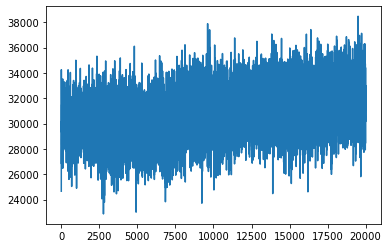

In [100]:
plt.plot(TrainingPortfolio)

(array([   7.,   81.,  695., 3152., 6338., 5915., 2937.,  775.,   92.,
           8.]),
 array([22872.5559 , 24432.40868, 25992.26146, 27552.11424, 29111.96702,
        30671.8198 , 32231.67258, 33791.52536, 35351.37814, 36911.23092,
        38471.0837 ]),
 <BarContainer object of 10 artists>)

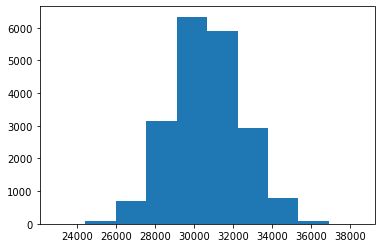

In [101]:
plt.hist(TrainingPortfolio)

In [102]:
np.mean(TestPortfolio)

25823.200047249164

(array([2.6000e+01, 1.1370e+03, 2.8320e+03, 1.0512e+04, 3.4290e+03,
        1.2540e+03, 4.4100e+02, 3.0100e+02, 6.5000e+01, 3.0000e+00]),
 array([21416.18 , 22589.399, 23762.618, 24935.837, 26109.056, 27282.275,
        28455.494, 29628.713, 30801.932, 31975.151, 33148.37 ]),
 <BarContainer object of 10 artists>)

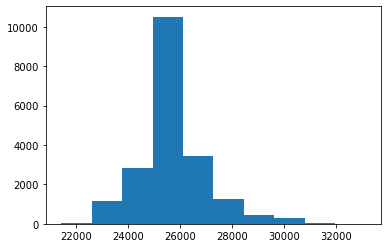

In [103]:
plt.hist(TestPortfolio)

(array([  73.,  913., 3433., 5867., 5168., 2949., 1189.,  321.,   74.,
          13.]),
 array([14168.905, 16467.003, 18765.101, 21063.199, 23361.297, 25659.395,
        27957.493, 30255.591, 32553.689, 34851.787, 37149.885]),
 <BarContainer object of 10 artists>)

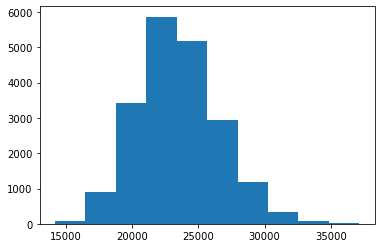

In [104]:
plt.hist(RandomPortfolio)

In [105]:
np.mean(RandomPortfolio)

23466.127843749757

In [106]:
test_data[-1]

array([159.54      , 102.63      ,  54.46      , 159.68666667,
       102.15      ,  54.92      ])

### Adding trend of last 5 days

In [108]:
data = pd.read_csv(path)
data

,AAPL,MSI,SBUX
0,67.8542,60.30,28.185
1,68.5614,60.90,28.070
2,66.8428,60.83,28.130
3,66.7156,60.81,27.915
4,66.6556,61.12,27.775
...,...,...,...
1254,167.7800,99.12,56.000
1255,160.5000,103.87,55.770
1256,156.4900,101.06,54.690
1257,163.0300,102.76,55.610


In [109]:
data['AAPL_5days'] = data['AAPL'].rolling(5).mean()
data['MSI_5days'] = data['MSI'].rolling(5).mean()
data['SBUX_5days'] = data['SBUX'].rolling(5).mean()

In [110]:
data.fillna(method = 'bfill',inplace=True)
data

,AAPL,MSI,SBUX,AAPL_5days,MSI_5days,SBUX_5days
0,67.8542,60.30,28.185,67.32592,60.792,28.015
1,68.5614,60.90,28.070,67.32592,60.792,28.015
2,66.8428,60.83,28.130,67.32592,60.792,28.015
3,66.7156,60.81,27.915,67.32592,60.792,28.015
4,66.6556,61.12,27.775,67.32592,60.792,28.015
...,...,...,...,...,...,...
1254,167.7800,99.12,56.000,168.33000,99.312,57.002
1255,160.5000,103.87,55.770,166.12800,100.286,56.558
1256,156.4900,101.06,54.690,163.83400,100.662,56.092
1257,163.0300,102.76,55.610,163.04600,101.254,55.776


In [111]:
class MultiStockEnv:
    """
    A 3-stock trading environment.
    State: vector of size 7 (n_stock * 2 + 1)
        - # shares of stock 1 owned
        - # shares of stock 2 owned
        - # shares of stock 3 owned
        - price of stock 1 (using daily close price)
        - price of stock 2
        - price of stock 3
        - cash owned (can be used to purchase more stocks)
    Action: categorical variable with 27 (3^3) possibilities
        - for each stock, you can:
        - 0 = sell
        - 1 = hold
        - 2 = buy
    """
    def __init__(self, data, initial_investment=20000):
        # data
        self.stock_price_history = data
        self.n_step, self.n_stock = self.stock_price_history.shape

        # instance attributes
        self.initial_investment = initial_investment
        self.cur_step = None
        self.stock_owned = None
        self.stock_price = None
        self.cash_in_hand = None

        self.action_space = np.arange(3**self.n_stock)

        # action permutations
        # returns a nested list with elements like:
        # [0,0,0]
        # [0,0,1]
        # [0,0,2]
        # [0,1,0]
        # [0,1,1]
        # etc.
        # 0 = sell
        # 1 = hold
        # 2 = buy
        self.action_list = list(map(list, itertools.product([0, 1, 2], repeat=self.n_stock)))
        
        
        # calculate size of state
        self.state_dim = self.n_stock * 2 + 1

        self.reset()


    def reset(self):
        self.cur_step = 0
        self.stock_owned = np.zeros(self.n_stock)
        self.stock_price = self.stock_price_history[self.cur_step]
        self.cash_in_hand = self.initial_investment
        return self._get_obs()


    def step(self, action):
        assert action in self.action_space

        # get current value before performing the action
        prev_val = self._get_val()

        # update price, i.e. go to the next day
        self.cur_step += 1
        self.stock_price = self.stock_price_history[self.cur_step]

        # perform the trade
        self._trade(action)

        # get the new value after taking the action
        cur_val = self._get_val()

        # reward is the increase in porfolio value
        reward = cur_val - prev_val

        # done if we have run out of data
        done = self.cur_step == self.n_step - 1

        # store the current value of the portfolio here
        info = {'cur_val': cur_val}

        # conform to the Gym API
        return self._get_obs(), reward, done, info


    def _get_obs(self):
        obs = np.empty(self.state_dim)
        obs[:self.n_stock] = self.stock_owned
        obs[self.n_stock:2*self.n_stock] = self.stock_price
        obs[-1] = self.cash_in_hand
        return obs
    
    def _get_val(self):
        return self.stock_owned.dot(self.stock_price) + self.cash_in_hand

    def _trade(self, action):
        # index the action we want to perform
        # 0 = sell
        # 1 = hold
        # 2 = buy
        # e.g. [2,1,0] means:
        # buy first stock
        # hold second stock
        # sell third stock
        action_vec = self.action_list[action]

        # determine which stocks to buy or sell
        sell_index = [] # stores index of stocks we want to sell
        buy_index = [] # stores index of stocks we want to buy
            
        for i, a in enumerate(action_vec):
            if ((action_vec[0] + action_vec[4])/2 < 1) & (i<3):
                sell_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i ==3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 5):
                sell_index.append(2)
                
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i < 3):
                buy_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 5):
                sell_index.append(2)     
                
                

        # sell any stocks we want to sell
        # then buy any stocks we want to buy
        if sell_index:
            # NOTE: to simplify the problem, when we sell, we will sell ALL shares of that stock
            for i in sell_index:
                self.cash_in_hand += self.stock_price[i] * self.stock_owned[i]
                self.stock_owned[i] = 0
        if buy_index:
            # NOTE: when buying, we will loop through each stock we want to buy,
            #       and buy one share at a time until we run out of cash
            can_buy = True
            while can_buy:
                for i in buy_index:
                    if self.cash_in_hand > self.stock_price[i]:
                        self.stock_owned[i] += 1 # buy one share
                        self.cash_in_hand -= self.stock_price[i]
                    else:
                        can_buy = False

In [112]:
n_timesteps, n_stocks = data.shape

In [113]:
n_train = n_timesteps // 2
n_train

629

In [114]:
train_data = data[:n_train].values
test_data = data[n_train:].values

In [115]:
env = MultiStockEnv(train_data,initial_investment=20000)

### 1000 Episode

In [116]:
env.reset()

array([    0.     ,     0.     ,     0.     ,     0.     ,     0.     ,
           0.     ,    67.8542 ,    60.3    ,    28.185  ,    67.32592,
          60.792  ,    28.015  , 20000.     ])

In [117]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 1000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_trend5_1000_episode.npz", W=W, b=b)

episode: 1/1000, episode end value: 19630.28
episode: 2/1000, episode end value: 25845.26
episode: 3/1000, episode end value: 24518.36
episode: 4/1000, episode end value: 30771.14
episode: 5/1000, episode end value: 28502.07
episode: 6/1000, episode end value: 30588.51
episode: 7/1000, episode end value: 31099.66
episode: 8/1000, episode end value: 30051.95
episode: 9/1000, episode end value: 30051.95
episode: 10/1000, episode end value: 29683.22
episode: 11/1000, episode end value: 29883.44
episode: 12/1000, episode end value: 29464.01
episode: 13/1000, episode end value: 29858.61
episode: 14/1000, episode end value: 29679.76
episode: 15/1000, episode end value: 29860.96
episode: 16/1000, episode end value: 30051.95
episode: 17/1000, episode end value: 30107.61
episode: 18/1000, episode end value: 30545.73
episode: 19/1000, episode end value: 30051.95
episode: 20/1000, episode end value: 30645.37
episode: 21/1000, episode end value: 29086.04
episode: 22/1000, episode end value: 30032.

episode: 178/1000, episode end value: 30234.50
episode: 179/1000, episode end value: 30641.52
episode: 180/1000, episode end value: 29495.14
episode: 181/1000, episode end value: 29101.20
episode: 182/1000, episode end value: 30003.65
episode: 183/1000, episode end value: 29731.60
episode: 184/1000, episode end value: 29527.80
episode: 185/1000, episode end value: 29589.97
episode: 186/1000, episode end value: 31478.61
episode: 187/1000, episode end value: 30030.72
episode: 188/1000, episode end value: 29950.72
episode: 189/1000, episode end value: 30939.99
episode: 190/1000, episode end value: 30183.15
episode: 191/1000, episode end value: 29642.91
episode: 192/1000, episode end value: 29966.27
episode: 193/1000, episode end value: 29020.75
episode: 194/1000, episode end value: 29710.55
episode: 195/1000, episode end value: 29503.09
episode: 196/1000, episode end value: 29503.09
episode: 197/1000, episode end value: 30153.28
episode: 198/1000, episode end value: 30032.34
episode: 199/

episode: 353/1000, episode end value: 30371.03
episode: 354/1000, episode end value: 30482.87
episode: 355/1000, episode end value: 31625.30
episode: 356/1000, episode end value: 30880.17
episode: 357/1000, episode end value: 30904.76
episode: 358/1000, episode end value: 30462.13
episode: 359/1000, episode end value: 30143.63
episode: 360/1000, episode end value: 30464.75
episode: 361/1000, episode end value: 30833.13
episode: 362/1000, episode end value: 31336.93
episode: 363/1000, episode end value: 29723.20
episode: 364/1000, episode end value: 31135.29
episode: 365/1000, episode end value: 30306.74
episode: 366/1000, episode end value: 31197.07
episode: 367/1000, episode end value: 30372.18
episode: 368/1000, episode end value: 30131.01
episode: 369/1000, episode end value: 32069.96
episode: 370/1000, episode end value: 29754.41
episode: 371/1000, episode end value: 30931.26
episode: 372/1000, episode end value: 30881.78
episode: 373/1000, episode end value: 30580.56
episode: 374/

episode: 528/1000, episode end value: 29631.41
episode: 529/1000, episode end value: 29125.16
episode: 530/1000, episode end value: 29707.36
episode: 531/1000, episode end value: 29449.45
episode: 532/1000, episode end value: 28967.30
episode: 533/1000, episode end value: 29786.56
episode: 534/1000, episode end value: 30057.05
episode: 535/1000, episode end value: 30207.39
episode: 536/1000, episode end value: 30244.88
episode: 537/1000, episode end value: 30171.61
episode: 538/1000, episode end value: 29153.06
episode: 539/1000, episode end value: 30596.18
episode: 540/1000, episode end value: 29262.44
episode: 541/1000, episode end value: 31099.82
episode: 542/1000, episode end value: 29920.73
episode: 543/1000, episode end value: 30504.76
episode: 544/1000, episode end value: 29126.75
episode: 545/1000, episode end value: 29946.25
episode: 546/1000, episode end value: 29920.02
episode: 547/1000, episode end value: 29876.32
episode: 548/1000, episode end value: 29925.92
episode: 549/

episode: 703/1000, episode end value: 30444.74
episode: 704/1000, episode end value: 29102.95
episode: 705/1000, episode end value: 29619.93
episode: 706/1000, episode end value: 29256.91
episode: 707/1000, episode end value: 29442.72
episode: 708/1000, episode end value: 29678.29
episode: 709/1000, episode end value: 29825.59
episode: 710/1000, episode end value: 29969.04
episode: 711/1000, episode end value: 29493.25
episode: 712/1000, episode end value: 30389.10
episode: 713/1000, episode end value: 29678.38
episode: 714/1000, episode end value: 28621.86
episode: 715/1000, episode end value: 29678.29
episode: 716/1000, episode end value: 29434.36
episode: 717/1000, episode end value: 30203.33
episode: 718/1000, episode end value: 29584.15
episode: 719/1000, episode end value: 31528.14
episode: 720/1000, episode end value: 30741.93
episode: 721/1000, episode end value: 31312.26
episode: 722/1000, episode end value: 29613.84
episode: 723/1000, episode end value: 29313.85
episode: 724/

episode: 878/1000, episode end value: 30471.52
episode: 879/1000, episode end value: 31365.01
episode: 880/1000, episode end value: 30979.77
episode: 881/1000, episode end value: 30292.60
episode: 882/1000, episode end value: 30807.57
episode: 883/1000, episode end value: 31230.61
episode: 884/1000, episode end value: 31070.96
episode: 885/1000, episode end value: 31054.50
episode: 886/1000, episode end value: 31524.63
episode: 887/1000, episode end value: 30440.30
episode: 888/1000, episode end value: 30580.28
episode: 889/1000, episode end value: 29486.29
episode: 890/1000, episode end value: 30603.52
episode: 891/1000, episode end value: 30049.37
episode: 892/1000, episode end value: 28757.99
episode: 893/1000, episode end value: 30280.72
episode: 894/1000, episode end value: 30681.39
episode: 895/1000, episode end value: 29878.26
episode: 896/1000, episode end value: 29970.59
episode: 897/1000, episode end value: 29982.17
episode: 898/1000, episode end value: 30534.56
episode: 899/

In [118]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_trend5_1000_episode.npz")
W = npz['W']
b = npz['b']

In [119]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 19936.18
episode: 2/1000, episode end value: 20014.76
episode: 3/1000, episode end value: 21704.87
episode: 4/1000, episode end value: 20134.81
episode: 5/1000, episode end value: 20252.03
episode: 6/1000, episode end value: 22124.18
episode: 7/1000, episode end value: 20362.55
episode: 8/1000, episode end value: 20169.77
episode: 9/1000, episode end value: 20862.83
episode: 10/1000, episode end value: 20292.54
episode: 11/1000, episode end value: 19843.82
episode: 12/1000, episode end value: 20328.67
episode: 13/1000, episode end value: 20023.00
episode: 14/1000, episode end value: 20292.54
episode: 15/1000, episode end value: 21161.84
episode: 16/1000, episode end value: 22012.32
episode: 17/1000, episode end value: 20478.31
episode: 18/1000, episode end value: 20469.20
episode: 19/1000, episode end value: 20179.57
episode: 20/1000, episode end value: 20347.12
episode: 21/1000, episode end value: 20292.54
episode: 22/1000, episode end value: 20376.

episode: 180/1000, episode end value: 20311.07
episode: 181/1000, episode end value: 20352.69
episode: 182/1000, episode end value: 20351.97
episode: 183/1000, episode end value: 20270.24
episode: 184/1000, episode end value: 20721.10
episode: 185/1000, episode end value: 21287.50
episode: 186/1000, episode end value: 20338.29
episode: 187/1000, episode end value: 21029.79
episode: 188/1000, episode end value: 20262.83
episode: 189/1000, episode end value: 20480.48
episode: 190/1000, episode end value: 20408.41
episode: 191/1000, episode end value: 20585.69
episode: 192/1000, episode end value: 20200.84
episode: 193/1000, episode end value: 20292.54
episode: 194/1000, episode end value: 20162.47
episode: 195/1000, episode end value: 20292.54
episode: 196/1000, episode end value: 21260.29
episode: 197/1000, episode end value: 20416.48
episode: 198/1000, episode end value: 20292.54
episode: 199/1000, episode end value: 20462.39
episode: 200/1000, episode end value: 20796.95
episode: 201/

episode: 355/1000, episode end value: 20331.81
episode: 356/1000, episode end value: 20367.91
episode: 357/1000, episode end value: 20292.54
episode: 358/1000, episode end value: 20597.29
episode: 359/1000, episode end value: 20473.16
episode: 360/1000, episode end value: 20654.71
episode: 361/1000, episode end value: 22078.71
episode: 362/1000, episode end value: 20363.54
episode: 363/1000, episode end value: 20337.98
episode: 364/1000, episode end value: 21436.29
episode: 365/1000, episode end value: 20292.54
episode: 366/1000, episode end value: 22583.63
episode: 367/1000, episode end value: 20292.54
episode: 368/1000, episode end value: 20445.43
episode: 369/1000, episode end value: 21877.37
episode: 370/1000, episode end value: 20568.03
episode: 371/1000, episode end value: 21990.36
episode: 372/1000, episode end value: 20921.86
episode: 373/1000, episode end value: 20781.97
episode: 374/1000, episode end value: 20447.49
episode: 375/1000, episode end value: 20715.00
episode: 376/

episode: 531/1000, episode end value: 20176.07
episode: 532/1000, episode end value: 20415.44
episode: 533/1000, episode end value: 21210.70
episode: 534/1000, episode end value: 20379.08
episode: 535/1000, episode end value: 20910.81
episode: 536/1000, episode end value: 19932.65
episode: 537/1000, episode end value: 20700.39
episode: 538/1000, episode end value: 20292.54
episode: 539/1000, episode end value: 22973.25
episode: 540/1000, episode end value: 20462.38
episode: 541/1000, episode end value: 20599.68
episode: 542/1000, episode end value: 22746.61
episode: 543/1000, episode end value: 20843.89
episode: 544/1000, episode end value: 21060.09
episode: 545/1000, episode end value: 20426.86
episode: 546/1000, episode end value: 21190.09
episode: 547/1000, episode end value: 20292.54
episode: 548/1000, episode end value: 21340.82
episode: 549/1000, episode end value: 20258.19
episode: 550/1000, episode end value: 20408.69
episode: 551/1000, episode end value: 20976.56
episode: 552/

episode: 706/1000, episode end value: 20338.57
episode: 707/1000, episode end value: 20293.25
episode: 708/1000, episode end value: 20454.61
episode: 709/1000, episode end value: 20526.35
episode: 710/1000, episode end value: 20145.50
episode: 711/1000, episode end value: 21031.08
episode: 712/1000, episode end value: 20292.54
episode: 713/1000, episode end value: 20834.81
episode: 714/1000, episode end value: 20314.52
episode: 715/1000, episode end value: 20161.27
episode: 716/1000, episode end value: 20136.27
episode: 717/1000, episode end value: 21479.35
episode: 718/1000, episode end value: 20114.01
episode: 719/1000, episode end value: 20769.53
episode: 720/1000, episode end value: 20409.52
episode: 721/1000, episode end value: 20431.65
episode: 722/1000, episode end value: 20071.56
episode: 723/1000, episode end value: 20292.54
episode: 724/1000, episode end value: 20574.12
episode: 725/1000, episode end value: 20643.37
episode: 726/1000, episode end value: 20336.03
episode: 727/

episode: 881/1000, episode end value: 20392.58
episode: 882/1000, episode end value: 22828.55
episode: 883/1000, episode end value: 21045.86
episode: 884/1000, episode end value: 21511.79
episode: 885/1000, episode end value: 20161.47
episode: 886/1000, episode end value: 20768.98
episode: 887/1000, episode end value: 20292.54
episode: 888/1000, episode end value: 21415.27
episode: 889/1000, episode end value: 19288.44
episode: 890/1000, episode end value: 20305.32
episode: 891/1000, episode end value: 20292.54
episode: 892/1000, episode end value: 20242.29
episode: 893/1000, episode end value: 21692.62
episode: 894/1000, episode end value: 20428.48
episode: 895/1000, episode end value: 20292.54
episode: 896/1000, episode end value: 20279.79
episode: 897/1000, episode end value: 20840.04
episode: 898/1000, episode end value: 20292.54
episode: 899/1000, episode end value: 20292.54
episode: 900/1000, episode end value: 20292.54
episode: 901/1000, episode end value: 20677.26
episode: 902/

In [120]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 23706.53
episode: 2/1000, episode end value: 19039.77
episode: 3/1000, episode end value: 20479.73
episode: 4/1000, episode end value: 23417.75
episode: 5/1000, episode end value: 27500.75
episode: 6/1000, episode end value: 22685.37
episode: 7/1000, episode end value: 25850.87
episode: 8/1000, episode end value: 26480.78
episode: 9/1000, episode end value: 21994.76
episode: 10/1000, episode end value: 25094.43
episode: 11/1000, episode end value: 23989.83
episode: 12/1000, episode end value: 25874.48
episode: 13/1000, episode end value: 20957.50
episode: 14/1000, episode end value: 20407.35
episode: 15/1000, episode end value: 22737.85
episode: 16/1000, episode end value: 25352.36
episode: 17/1000, episode end value: 24128.96
episode: 18/1000, episode end value: 25040.99
episode: 19/1000, episode end value: 18266.57
episode: 20/1000, episode end value: 22567.74
episode: 21/1000, episode end value: 22794.48
episode: 22/1000, episode end value: 23285.

episode: 179/1000, episode end value: 20774.18
episode: 180/1000, episode end value: 19735.73
episode: 181/1000, episode end value: 27222.92
episode: 182/1000, episode end value: 26558.16
episode: 183/1000, episode end value: 24421.80
episode: 184/1000, episode end value: 28042.94
episode: 185/1000, episode end value: 24162.87
episode: 186/1000, episode end value: 22501.60
episode: 187/1000, episode end value: 20713.85
episode: 188/1000, episode end value: 24469.00
episode: 189/1000, episode end value: 27451.08
episode: 190/1000, episode end value: 20344.04
episode: 191/1000, episode end value: 23552.24
episode: 192/1000, episode end value: 21731.66
episode: 193/1000, episode end value: 18722.45
episode: 194/1000, episode end value: 25960.03
episode: 195/1000, episode end value: 19687.50
episode: 196/1000, episode end value: 20368.09
episode: 197/1000, episode end value: 18428.41
episode: 198/1000, episode end value: 21920.37
episode: 199/1000, episode end value: 20572.19
episode: 200/

episode: 355/1000, episode end value: 22947.94
episode: 356/1000, episode end value: 23573.07
episode: 357/1000, episode end value: 21754.74
episode: 358/1000, episode end value: 19435.79
episode: 359/1000, episode end value: 23512.25
episode: 360/1000, episode end value: 24167.66
episode: 361/1000, episode end value: 24109.60
episode: 362/1000, episode end value: 20929.66
episode: 363/1000, episode end value: 25815.59
episode: 364/1000, episode end value: 21808.56
episode: 365/1000, episode end value: 20464.14
episode: 366/1000, episode end value: 28356.79
episode: 367/1000, episode end value: 22206.61
episode: 368/1000, episode end value: 21102.33
episode: 369/1000, episode end value: 18832.70
episode: 370/1000, episode end value: 28678.55
episode: 371/1000, episode end value: 19799.70
episode: 372/1000, episode end value: 19467.73
episode: 373/1000, episode end value: 19986.62
episode: 374/1000, episode end value: 20033.26
episode: 375/1000, episode end value: 27615.12
episode: 376/

episode: 531/1000, episode end value: 22343.05
episode: 532/1000, episode end value: 24232.92
episode: 533/1000, episode end value: 26235.11
episode: 534/1000, episode end value: 18609.35
episode: 535/1000, episode end value: 23838.43
episode: 536/1000, episode end value: 23312.62
episode: 537/1000, episode end value: 23948.84
episode: 538/1000, episode end value: 20153.90
episode: 539/1000, episode end value: 27732.19
episode: 540/1000, episode end value: 19894.69
episode: 541/1000, episode end value: 24173.31
episode: 542/1000, episode end value: 25711.83
episode: 543/1000, episode end value: 25079.27
episode: 544/1000, episode end value: 29151.29
episode: 545/1000, episode end value: 23097.77
episode: 546/1000, episode end value: 25224.87
episode: 547/1000, episode end value: 26908.18
episode: 548/1000, episode end value: 22684.31
episode: 549/1000, episode end value: 23140.50
episode: 550/1000, episode end value: 21293.94
episode: 551/1000, episode end value: 24098.38
episode: 552/

episode: 707/1000, episode end value: 19784.39
episode: 708/1000, episode end value: 22593.57
episode: 709/1000, episode end value: 22531.24
episode: 710/1000, episode end value: 21663.81
episode: 711/1000, episode end value: 23583.37
episode: 712/1000, episode end value: 23862.27
episode: 713/1000, episode end value: 26184.38
episode: 714/1000, episode end value: 20834.41
episode: 715/1000, episode end value: 24162.52
episode: 716/1000, episode end value: 22885.54
episode: 717/1000, episode end value: 22134.59
episode: 718/1000, episode end value: 19130.53
episode: 719/1000, episode end value: 25559.90
episode: 720/1000, episode end value: 23064.08
episode: 721/1000, episode end value: 24345.08
episode: 722/1000, episode end value: 23078.12
episode: 723/1000, episode end value: 25056.57
episode: 724/1000, episode end value: 18130.93
episode: 725/1000, episode end value: 17871.96
episode: 726/1000, episode end value: 23206.43
episode: 727/1000, episode end value: 21932.01
episode: 728/

episode: 882/1000, episode end value: 28218.67
episode: 883/1000, episode end value: 27798.59
episode: 884/1000, episode end value: 21393.42
episode: 885/1000, episode end value: 24341.61
episode: 886/1000, episode end value: 28989.00
episode: 887/1000, episode end value: 22741.53
episode: 888/1000, episode end value: 21705.79
episode: 889/1000, episode end value: 23785.98
episode: 890/1000, episode end value: 24013.83
episode: 891/1000, episode end value: 18736.38
episode: 892/1000, episode end value: 17096.43
episode: 893/1000, episode end value: 21857.70
episode: 894/1000, episode end value: 19057.48
episode: 895/1000, episode end value: 22634.41
episode: 896/1000, episode end value: 22705.04
episode: 897/1000, episode end value: 20746.31
episode: 898/1000, episode end value: 27019.98
episode: 899/1000, episode end value: 21833.70
episode: 900/1000, episode end value: 28263.86
episode: 901/1000, episode end value: 20413.13
episode: 902/1000, episode end value: 20284.31
episode: 903/

In [121]:
np.savez(saving_models_path+"/TraderPortfolios_trend5_1000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [122]:
npz = np.load(saving_models_path+"/TraderPortfolios_trend5_1000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

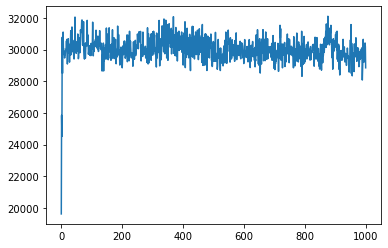

In [123]:
plt.plot(TrainingPortfolio)

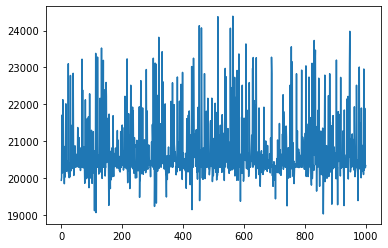

In [124]:
plt.plot(TestPortfolio)

In [125]:
np.mean(TestPortfolio)

20732.808675000273

In [126]:
np.mean(RandomPortfolio)

23575.401874999774

### 8000 Episode

In [127]:
env.reset()

array([    0.   ,     0.   ,     0.   ,     0.   ,     0.   ,     0.   ,
         119.72 ,    63.99 ,    56.27 ,   116.082,    63.248,    57.682,
       20000.   ])

In [128]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 8000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_trend5_8000_episode.npz", W=W, b=b)

episode: 1/8000, episode end value: 19630.28
episode: 2/8000, episode end value: 25845.26
episode: 3/8000, episode end value: 24518.36
episode: 4/8000, episode end value: 30771.14
episode: 5/8000, episode end value: 28502.07
episode: 6/8000, episode end value: 30588.51
episode: 7/8000, episode end value: 31099.66
episode: 8/8000, episode end value: 30051.95
episode: 9/8000, episode end value: 30051.95
episode: 10/8000, episode end value: 29683.22
episode: 11/8000, episode end value: 29883.44
episode: 12/8000, episode end value: 29464.01
episode: 13/8000, episode end value: 29858.61
episode: 14/8000, episode end value: 29679.76
episode: 15/8000, episode end value: 29860.96
episode: 16/8000, episode end value: 30051.95
episode: 17/8000, episode end value: 30107.61
episode: 18/8000, episode end value: 30545.73
episode: 19/8000, episode end value: 30051.95
episode: 20/8000, episode end value: 30645.37
episode: 21/8000, episode end value: 29086.04
episode: 22/8000, episode end value: 30032.

episode: 178/8000, episode end value: 30234.50
episode: 179/8000, episode end value: 30641.52
episode: 180/8000, episode end value: 29495.14
episode: 181/8000, episode end value: 29101.20
episode: 182/8000, episode end value: 30003.65
episode: 183/8000, episode end value: 29731.60
episode: 184/8000, episode end value: 29527.80
episode: 185/8000, episode end value: 29589.97
episode: 186/8000, episode end value: 31478.61
episode: 187/8000, episode end value: 30030.72
episode: 188/8000, episode end value: 29950.72
episode: 189/8000, episode end value: 30939.99
episode: 190/8000, episode end value: 30183.15
episode: 191/8000, episode end value: 29642.91
episode: 192/8000, episode end value: 29966.27
episode: 193/8000, episode end value: 29020.75
episode: 194/8000, episode end value: 29710.55
episode: 195/8000, episode end value: 29503.09
episode: 196/8000, episode end value: 29503.09
episode: 197/8000, episode end value: 30153.28
episode: 198/8000, episode end value: 30032.34
episode: 199/

episode: 353/8000, episode end value: 30371.03
episode: 354/8000, episode end value: 30482.87
episode: 355/8000, episode end value: 31625.30
episode: 356/8000, episode end value: 30880.17
episode: 357/8000, episode end value: 30904.76
episode: 358/8000, episode end value: 30462.13
episode: 359/8000, episode end value: 30143.63
episode: 360/8000, episode end value: 30464.75
episode: 361/8000, episode end value: 30833.13
episode: 362/8000, episode end value: 31336.93
episode: 363/8000, episode end value: 29723.20
episode: 364/8000, episode end value: 31135.29
episode: 365/8000, episode end value: 30306.74
episode: 366/8000, episode end value: 31197.07
episode: 367/8000, episode end value: 30372.18
episode: 368/8000, episode end value: 30131.01
episode: 369/8000, episode end value: 32069.96
episode: 370/8000, episode end value: 29754.41
episode: 371/8000, episode end value: 30931.26
episode: 372/8000, episode end value: 30881.78
episode: 373/8000, episode end value: 30580.56
episode: 374/

episode: 528/8000, episode end value: 29631.41
episode: 529/8000, episode end value: 29125.16
episode: 530/8000, episode end value: 29707.36
episode: 531/8000, episode end value: 29449.45
episode: 532/8000, episode end value: 28967.30
episode: 533/8000, episode end value: 29786.56
episode: 534/8000, episode end value: 30057.05
episode: 535/8000, episode end value: 30207.39
episode: 536/8000, episode end value: 30244.88
episode: 537/8000, episode end value: 30171.61
episode: 538/8000, episode end value: 29153.06
episode: 539/8000, episode end value: 30596.18
episode: 540/8000, episode end value: 29262.44
episode: 541/8000, episode end value: 31099.82
episode: 542/8000, episode end value: 29920.73
episode: 543/8000, episode end value: 30504.76
episode: 544/8000, episode end value: 29126.75
episode: 545/8000, episode end value: 29946.25
episode: 546/8000, episode end value: 29920.02
episode: 547/8000, episode end value: 29876.32
episode: 548/8000, episode end value: 29925.92
episode: 549/

episode: 703/8000, episode end value: 30444.74
episode: 704/8000, episode end value: 29102.95
episode: 705/8000, episode end value: 29619.93
episode: 706/8000, episode end value: 29256.91
episode: 707/8000, episode end value: 29442.72
episode: 708/8000, episode end value: 29678.29
episode: 709/8000, episode end value: 29825.59
episode: 710/8000, episode end value: 29969.04
episode: 711/8000, episode end value: 29493.25
episode: 712/8000, episode end value: 30389.10
episode: 713/8000, episode end value: 29678.38
episode: 714/8000, episode end value: 28621.86
episode: 715/8000, episode end value: 29678.29
episode: 716/8000, episode end value: 29434.36
episode: 717/8000, episode end value: 30203.33
episode: 718/8000, episode end value: 29584.15
episode: 719/8000, episode end value: 31528.14
episode: 720/8000, episode end value: 30741.93
episode: 721/8000, episode end value: 31312.26
episode: 722/8000, episode end value: 29613.84
episode: 723/8000, episode end value: 29313.85
episode: 724/

episode: 878/8000, episode end value: 30471.52
episode: 879/8000, episode end value: 31365.01
episode: 880/8000, episode end value: 30979.77
episode: 881/8000, episode end value: 30292.60
episode: 882/8000, episode end value: 30807.57
episode: 883/8000, episode end value: 31230.61
episode: 884/8000, episode end value: 31070.96
episode: 885/8000, episode end value: 31054.50
episode: 886/8000, episode end value: 31524.63
episode: 887/8000, episode end value: 30440.30
episode: 888/8000, episode end value: 30580.28
episode: 889/8000, episode end value: 29486.29
episode: 890/8000, episode end value: 30603.52
episode: 891/8000, episode end value: 30049.37
episode: 892/8000, episode end value: 28757.99
episode: 893/8000, episode end value: 30280.72
episode: 894/8000, episode end value: 30681.39
episode: 895/8000, episode end value: 29878.26
episode: 896/8000, episode end value: 29970.59
episode: 897/8000, episode end value: 29982.17
episode: 898/8000, episode end value: 30534.56
episode: 899/

episode: 1052/8000, episode end value: 29256.64
episode: 1053/8000, episode end value: 29215.04
episode: 1054/8000, episode end value: 28731.34
episode: 1055/8000, episode end value: 28636.94
episode: 1056/8000, episode end value: 29330.42
episode: 1057/8000, episode end value: 29051.86
episode: 1058/8000, episode end value: 29403.37
episode: 1059/8000, episode end value: 30240.71
episode: 1060/8000, episode end value: 28990.54
episode: 1061/8000, episode end value: 30583.25
episode: 1062/8000, episode end value: 29408.19
episode: 1063/8000, episode end value: 29601.33
episode: 1064/8000, episode end value: 29613.80
episode: 1065/8000, episode end value: 29010.28
episode: 1066/8000, episode end value: 29808.51
episode: 1067/8000, episode end value: 29793.53
episode: 1068/8000, episode end value: 29001.96
episode: 1069/8000, episode end value: 30031.39
episode: 1070/8000, episode end value: 29475.62
episode: 1071/8000, episode end value: 29223.30
episode: 1072/8000, episode end value: 2

episode: 1223/8000, episode end value: 29570.10
episode: 1224/8000, episode end value: 29239.69
episode: 1225/8000, episode end value: 29579.97
episode: 1226/8000, episode end value: 29531.44
episode: 1227/8000, episode end value: 29338.76
episode: 1228/8000, episode end value: 29883.33
episode: 1229/8000, episode end value: 29717.65
episode: 1230/8000, episode end value: 30007.10
episode: 1231/8000, episode end value: 28782.43
episode: 1232/8000, episode end value: 29700.39
episode: 1233/8000, episode end value: 29720.88
episode: 1234/8000, episode end value: 30166.57
episode: 1235/8000, episode end value: 30110.79
episode: 1236/8000, episode end value: 29837.38
episode: 1237/8000, episode end value: 29332.03
episode: 1238/8000, episode end value: 29743.20
episode: 1239/8000, episode end value: 29883.33
episode: 1240/8000, episode end value: 29650.81
episode: 1241/8000, episode end value: 29685.13
episode: 1242/8000, episode end value: 30030.68
episode: 1243/8000, episode end value: 2

episode: 1394/8000, episode end value: 30349.85
episode: 1395/8000, episode end value: 30052.97
episode: 1396/8000, episode end value: 29788.83
episode: 1397/8000, episode end value: 29881.28
episode: 1398/8000, episode end value: 30132.29
episode: 1399/8000, episode end value: 29297.66
episode: 1400/8000, episode end value: 29935.24
episode: 1401/8000, episode end value: 29678.30
episode: 1402/8000, episode end value: 30017.55
episode: 1403/8000, episode end value: 29774.24
episode: 1404/8000, episode end value: 29930.71
episode: 1405/8000, episode end value: 29442.38
episode: 1406/8000, episode end value: 29023.68
episode: 1407/8000, episode end value: 29537.91
episode: 1408/8000, episode end value: 29580.22
episode: 1409/8000, episode end value: 30114.05
episode: 1410/8000, episode end value: 29215.04
episode: 1411/8000, episode end value: 30186.42
episode: 1412/8000, episode end value: 29530.98
episode: 1413/8000, episode end value: 29717.59
episode: 1414/8000, episode end value: 3

episode: 1565/8000, episode end value: 30379.48
episode: 1566/8000, episode end value: 30529.36
episode: 1567/8000, episode end value: 30960.41
episode: 1568/8000, episode end value: 28977.62
episode: 1569/8000, episode end value: 29143.31
episode: 1570/8000, episode end value: 30188.48
episode: 1571/8000, episode end value: 30428.02
episode: 1572/8000, episode end value: 28968.16
episode: 1573/8000, episode end value: 30440.07
episode: 1574/8000, episode end value: 28689.08
episode: 1575/8000, episode end value: 29204.49
episode: 1576/8000, episode end value: 29987.25
episode: 1577/8000, episode end value: 28340.47
episode: 1578/8000, episode end value: 30151.86
episode: 1579/8000, episode end value: 28369.36
episode: 1580/8000, episode end value: 29257.19
episode: 1581/8000, episode end value: 30850.14
episode: 1582/8000, episode end value: 29926.51
episode: 1583/8000, episode end value: 30121.27
episode: 1584/8000, episode end value: 30188.87
episode: 1585/8000, episode end value: 2

episode: 1736/8000, episode end value: 30131.52
episode: 1737/8000, episode end value: 29747.56
episode: 1738/8000, episode end value: 29699.00
episode: 1739/8000, episode end value: 30143.81
episode: 1740/8000, episode end value: 30049.90
episode: 1741/8000, episode end value: 29001.46
episode: 1742/8000, episode end value: 30209.92
episode: 1743/8000, episode end value: 29825.25
episode: 1744/8000, episode end value: 29796.14
episode: 1745/8000, episode end value: 29915.24
episode: 1746/8000, episode end value: 29806.35
episode: 1747/8000, episode end value: 30267.64
episode: 1748/8000, episode end value: 29968.75
episode: 1749/8000, episode end value: 30261.57
episode: 1750/8000, episode end value: 30274.97
episode: 1751/8000, episode end value: 29875.30
episode: 1752/8000, episode end value: 29462.81
episode: 1753/8000, episode end value: 30268.19
episode: 1754/8000, episode end value: 30451.38
episode: 1755/8000, episode end value: 29162.16
episode: 1756/8000, episode end value: 3

episode: 1907/8000, episode end value: 31538.77
episode: 1908/8000, episode end value: 29117.00
episode: 1909/8000, episode end value: 30619.91
episode: 1910/8000, episode end value: 30347.48
episode: 1911/8000, episode end value: 28638.66
episode: 1912/8000, episode end value: 30172.76
episode: 1913/8000, episode end value: 30695.28
episode: 1914/8000, episode end value: 29656.84
episode: 1915/8000, episode end value: 29851.49
episode: 1916/8000, episode end value: 28845.85
episode: 1917/8000, episode end value: 30181.21
episode: 1918/8000, episode end value: 30315.98
episode: 1919/8000, episode end value: 30426.00
episode: 1920/8000, episode end value: 29870.55
episode: 1921/8000, episode end value: 29870.55
episode: 1922/8000, episode end value: 29746.87
episode: 1923/8000, episode end value: 28765.76
episode: 1924/8000, episode end value: 29442.38
episode: 1925/8000, episode end value: 30160.23
episode: 1926/8000, episode end value: 29898.51
episode: 1927/8000, episode end value: 3

episode: 2078/8000, episode end value: 29864.68
episode: 2079/8000, episode end value: 30268.33
episode: 2080/8000, episode end value: 29908.29
episode: 2081/8000, episode end value: 29870.55
episode: 2082/8000, episode end value: 29693.65
episode: 2083/8000, episode end value: 29235.36
episode: 2084/8000, episode end value: 30245.81
episode: 2085/8000, episode end value: 29794.08
episode: 2086/8000, episode end value: 30864.24
episode: 2087/8000, episode end value: 29813.52
episode: 2088/8000, episode end value: 29793.78
episode: 2089/8000, episode end value: 30049.76
episode: 2090/8000, episode end value: 29404.30
episode: 2091/8000, episode end value: 29291.12
episode: 2092/8000, episode end value: 30505.49
episode: 2093/8000, episode end value: 29584.03
episode: 2094/8000, episode end value: 29587.11
episode: 2095/8000, episode end value: 29577.62
episode: 2096/8000, episode end value: 29711.10
episode: 2097/8000, episode end value: 29255.91
episode: 2098/8000, episode end value: 2

episode: 2249/8000, episode end value: 29726.58
episode: 2250/8000, episode end value: 29933.25
episode: 2251/8000, episode end value: 30434.71
episode: 2252/8000, episode end value: 30059.42
episode: 2253/8000, episode end value: 30369.31
episode: 2254/8000, episode end value: 29718.60
episode: 2255/8000, episode end value: 29730.17
episode: 2256/8000, episode end value: 30341.92
episode: 2257/8000, episode end value: 30151.87
episode: 2258/8000, episode end value: 29457.36
episode: 2259/8000, episode end value: 30019.59
episode: 2260/8000, episode end value: 30271.03
episode: 2261/8000, episode end value: 29793.97
episode: 2262/8000, episode end value: 29594.47
episode: 2263/8000, episode end value: 30248.79
episode: 2264/8000, episode end value: 30128.01
episode: 2265/8000, episode end value: 29680.41
episode: 2266/8000, episode end value: 29652.60
episode: 2267/8000, episode end value: 29413.28
episode: 2268/8000, episode end value: 30204.99
episode: 2269/8000, episode end value: 2

episode: 2420/8000, episode end value: 29633.19
episode: 2421/8000, episode end value: 29929.05
episode: 2422/8000, episode end value: 29501.76
episode: 2423/8000, episode end value: 29656.47
episode: 2424/8000, episode end value: 29729.93
episode: 2425/8000, episode end value: 29812.42
episode: 2426/8000, episode end value: 28869.33
episode: 2427/8000, episode end value: 29870.55
episode: 2428/8000, episode end value: 29974.46
episode: 2429/8000, episode end value: 29298.07
episode: 2430/8000, episode end value: 29052.71
episode: 2431/8000, episode end value: 29851.51
episode: 2432/8000, episode end value: 29691.80
episode: 2433/8000, episode end value: 29793.71
episode: 2434/8000, episode end value: 30065.99
episode: 2435/8000, episode end value: 29713.87
episode: 2436/8000, episode end value: 29772.40
episode: 2437/8000, episode end value: 30144.98
episode: 2438/8000, episode end value: 29870.55
episode: 2439/8000, episode end value: 30051.85
episode: 2440/8000, episode end value: 2

episode: 2591/8000, episode end value: 29748.50
episode: 2592/8000, episode end value: 29870.55
episode: 2593/8000, episode end value: 29518.32
episode: 2594/8000, episode end value: 29484.82
episode: 2595/8000, episode end value: 29793.65
episode: 2596/8000, episode end value: 29633.19
episode: 2597/8000, episode end value: 29684.74
episode: 2598/8000, episode end value: 28250.68
episode: 2599/8000, episode end value: 30052.77
episode: 2600/8000, episode end value: 29691.69
episode: 2601/8000, episode end value: 29678.32
episode: 2602/8000, episode end value: 30267.39
episode: 2603/8000, episode end value: 29861.95
episode: 2604/8000, episode end value: 30099.15
episode: 2605/8000, episode end value: 29681.75
episode: 2606/8000, episode end value: 29533.96
episode: 2607/8000, episode end value: 29463.77
episode: 2608/8000, episode end value: 29857.18
episode: 2609/8000, episode end value: 29400.25
episode: 2610/8000, episode end value: 29776.05
episode: 2611/8000, episode end value: 2

episode: 2762/8000, episode end value: 30148.76
episode: 2763/8000, episode end value: 30165.17
episode: 2764/8000, episode end value: 29677.98
episode: 2765/8000, episode end value: 30448.63
episode: 2766/8000, episode end value: 29772.47
episode: 2767/8000, episode end value: 30297.77
episode: 2768/8000, episode end value: 29969.68
episode: 2769/8000, episode end value: 29819.64
episode: 2770/8000, episode end value: 30038.08
episode: 2771/8000, episode end value: 30122.12
episode: 2772/8000, episode end value: 29381.73
episode: 2773/8000, episode end value: 29826.50
episode: 2774/8000, episode end value: 30006.65
episode: 2775/8000, episode end value: 30154.67
episode: 2776/8000, episode end value: 30192.20
episode: 2777/8000, episode end value: 30045.09
episode: 2778/8000, episode end value: 30185.15
episode: 2779/8000, episode end value: 28944.99
episode: 2780/8000, episode end value: 30106.45
episode: 2781/8000, episode end value: 29953.20
episode: 2782/8000, episode end value: 3

episode: 2933/8000, episode end value: 29519.74
episode: 2934/8000, episode end value: 30336.36
episode: 2935/8000, episode end value: 30311.85
episode: 2936/8000, episode end value: 30640.35
episode: 2937/8000, episode end value: 29945.77
episode: 2938/8000, episode end value: 30076.39
episode: 2939/8000, episode end value: 30267.49
episode: 2940/8000, episode end value: 29885.91
episode: 2941/8000, episode end value: 28819.34
episode: 2942/8000, episode end value: 29914.93
episode: 2943/8000, episode end value: 30507.88
episode: 2944/8000, episode end value: 30203.19
episode: 2945/8000, episode end value: 29556.68
episode: 2946/8000, episode end value: 29496.83
episode: 2947/8000, episode end value: 30978.21
episode: 2948/8000, episode end value: 29508.42
episode: 2949/8000, episode end value: 30574.04
episode: 2950/8000, episode end value: 30741.40
episode: 2951/8000, episode end value: 30261.40
episode: 2952/8000, episode end value: 30362.59
episode: 2953/8000, episode end value: 3

episode: 3104/8000, episode end value: 30470.91
episode: 3105/8000, episode end value: 29830.72
episode: 3106/8000, episode end value: 30651.75
episode: 3107/8000, episode end value: 30203.37
episode: 3108/8000, episode end value: 30112.93
episode: 3109/8000, episode end value: 30608.73
episode: 3110/8000, episode end value: 30668.67
episode: 3111/8000, episode end value: 30343.61
episode: 3112/8000, episode end value: 29701.37
episode: 3113/8000, episode end value: 30051.95
episode: 3114/8000, episode end value: 29873.54
episode: 3115/8000, episode end value: 30165.05
episode: 3116/8000, episode end value: 29767.80
episode: 3117/8000, episode end value: 30197.87
episode: 3118/8000, episode end value: 29660.27
episode: 3119/8000, episode end value: 29915.55
episode: 3120/8000, episode end value: 30647.22
episode: 3121/8000, episode end value: 30034.72
episode: 3122/8000, episode end value: 30868.39
episode: 3123/8000, episode end value: 29337.19
episode: 3124/8000, episode end value: 3

episode: 3275/8000, episode end value: 29947.63
episode: 3276/8000, episode end value: 30051.95
episode: 3277/8000, episode end value: 30676.65
episode: 3278/8000, episode end value: 30243.42
episode: 3279/8000, episode end value: 30051.95
episode: 3280/8000, episode end value: 30627.43
episode: 3281/8000, episode end value: 30521.02
episode: 3282/8000, episode end value: 30388.81
episode: 3283/8000, episode end value: 30699.34
episode: 3284/8000, episode end value: 31010.39
episode: 3285/8000, episode end value: 30152.97
episode: 3286/8000, episode end value: 30280.36
episode: 3287/8000, episode end value: 31116.02
episode: 3288/8000, episode end value: 30045.09
episode: 3289/8000, episode end value: 29792.50
episode: 3290/8000, episode end value: 29704.75
episode: 3291/8000, episode end value: 29915.93
episode: 3292/8000, episode end value: 30388.68
episode: 3293/8000, episode end value: 29837.65
episode: 3294/8000, episode end value: 30526.50
episode: 3295/8000, episode end value: 3

episode: 3446/8000, episode end value: 31771.06
episode: 3447/8000, episode end value: 31520.42
episode: 3448/8000, episode end value: 30783.07
episode: 3449/8000, episode end value: 31721.77
episode: 3450/8000, episode end value: 31605.03
episode: 3451/8000, episode end value: 31784.40
episode: 3452/8000, episode end value: 31685.30
episode: 3453/8000, episode end value: 31458.38
episode: 3454/8000, episode end value: 31721.77
episode: 3455/8000, episode end value: 31760.70
episode: 3456/8000, episode end value: 32060.56
episode: 3457/8000, episode end value: 32479.48
episode: 3458/8000, episode end value: 31906.80
episode: 3459/8000, episode end value: 31055.04
episode: 3460/8000, episode end value: 31896.43
episode: 3461/8000, episode end value: 31069.11
episode: 3462/8000, episode end value: 32209.59
episode: 3463/8000, episode end value: 31945.43
episode: 3464/8000, episode end value: 31973.65
episode: 3465/8000, episode end value: 30440.88
episode: 3466/8000, episode end value: 3

episode: 3617/8000, episode end value: 31573.39
episode: 3618/8000, episode end value: 31881.25
episode: 3619/8000, episode end value: 29862.54
episode: 3620/8000, episode end value: 30691.37
episode: 3621/8000, episode end value: 31282.36
episode: 3622/8000, episode end value: 30127.03
episode: 3623/8000, episode end value: 31871.52
episode: 3624/8000, episode end value: 32945.02
episode: 3625/8000, episode end value: 31089.18
episode: 3626/8000, episode end value: 30066.33
episode: 3627/8000, episode end value: 30472.54
episode: 3628/8000, episode end value: 30388.77
episode: 3629/8000, episode end value: 31388.03
episode: 3630/8000, episode end value: 29498.30
episode: 3631/8000, episode end value: 31474.01
episode: 3632/8000, episode end value: 31701.35
episode: 3633/8000, episode end value: 30030.74
episode: 3634/8000, episode end value: 30980.44
episode: 3635/8000, episode end value: 28078.06
episode: 3636/8000, episode end value: 31270.29
episode: 3637/8000, episode end value: 2

episode: 3788/8000, episode end value: 30092.17
episode: 3789/8000, episode end value: 31889.43
episode: 3790/8000, episode end value: 30138.69
episode: 3791/8000, episode end value: 31013.81
episode: 3792/8000, episode end value: 31719.50
episode: 3793/8000, episode end value: 29477.02
episode: 3794/8000, episode end value: 28722.83
episode: 3795/8000, episode end value: 31574.50
episode: 3796/8000, episode end value: 31392.11
episode: 3797/8000, episode end value: 29690.53
episode: 3798/8000, episode end value: 29275.49
episode: 3799/8000, episode end value: 31152.73
episode: 3800/8000, episode end value: 30691.61
episode: 3801/8000, episode end value: 29221.02
episode: 3802/8000, episode end value: 31574.52
episode: 3803/8000, episode end value: 29339.49
episode: 3804/8000, episode end value: 31625.36
episode: 3805/8000, episode end value: 29575.32
episode: 3806/8000, episode end value: 29092.56
episode: 3807/8000, episode end value: 31491.02
episode: 3808/8000, episode end value: 2

episode: 3959/8000, episode end value: 31327.36
episode: 3960/8000, episode end value: 29780.52
episode: 3961/8000, episode end value: 30856.98
episode: 3962/8000, episode end value: 30447.50
episode: 3963/8000, episode end value: 30897.31
episode: 3964/8000, episode end value: 30776.82
episode: 3965/8000, episode end value: 31257.52
episode: 3966/8000, episode end value: 30748.73
episode: 3967/8000, episode end value: 32402.10
episode: 3968/8000, episode end value: 30256.31
episode: 3969/8000, episode end value: 31631.40
episode: 3970/8000, episode end value: 30414.81
episode: 3971/8000, episode end value: 29429.18
episode: 3972/8000, episode end value: 29519.46
episode: 3973/8000, episode end value: 30885.03
episode: 3974/8000, episode end value: 30410.91
episode: 3975/8000, episode end value: 32251.27
episode: 3976/8000, episode end value: 28703.40
episode: 3977/8000, episode end value: 31041.54
episode: 3978/8000, episode end value: 31712.81
episode: 3979/8000, episode end value: 3

episode: 4130/8000, episode end value: 32799.00
episode: 4131/8000, episode end value: 31340.75
episode: 4132/8000, episode end value: 32060.06
episode: 4133/8000, episode end value: 29717.57
episode: 4134/8000, episode end value: 30693.45
episode: 4135/8000, episode end value: 30978.88
episode: 4136/8000, episode end value: 31817.24
episode: 4137/8000, episode end value: 30702.57
episode: 4138/8000, episode end value: 31400.46
episode: 4139/8000, episode end value: 30581.18
episode: 4140/8000, episode end value: 31077.10
episode: 4141/8000, episode end value: 31451.83
episode: 4142/8000, episode end value: 30059.23
episode: 4143/8000, episode end value: 31051.46
episode: 4144/8000, episode end value: 30702.41
episode: 4145/8000, episode end value: 31100.06
episode: 4146/8000, episode end value: 32566.14
episode: 4147/8000, episode end value: 31074.13
episode: 4148/8000, episode end value: 31537.55
episode: 4149/8000, episode end value: 31278.22
episode: 4150/8000, episode end value: 3

episode: 4301/8000, episode end value: 31254.29
episode: 4302/8000, episode end value: 30956.70
episode: 4303/8000, episode end value: 29193.04
episode: 4304/8000, episode end value: 31657.46
episode: 4305/8000, episode end value: 30702.05
episode: 4306/8000, episode end value: 31301.86
episode: 4307/8000, episode end value: 29750.75
episode: 4308/8000, episode end value: 31135.74
episode: 4309/8000, episode end value: 30381.78
episode: 4310/8000, episode end value: 32094.17
episode: 4311/8000, episode end value: 30944.82
episode: 4312/8000, episode end value: 31342.42
episode: 4313/8000, episode end value: 30531.50
episode: 4314/8000, episode end value: 30914.73
episode: 4315/8000, episode end value: 29757.97
episode: 4316/8000, episode end value: 30465.63
episode: 4317/8000, episode end value: 30613.94
episode: 4318/8000, episode end value: 31345.37
episode: 4319/8000, episode end value: 31231.96
episode: 4320/8000, episode end value: 28117.87
episode: 4321/8000, episode end value: 3

episode: 4472/8000, episode end value: 30772.68
episode: 4473/8000, episode end value: 30543.61
episode: 4474/8000, episode end value: 31949.77
episode: 4475/8000, episode end value: 30904.95
episode: 4476/8000, episode end value: 32207.39
episode: 4477/8000, episode end value: 28714.23
episode: 4478/8000, episode end value: 29044.47
episode: 4479/8000, episode end value: 29574.42
episode: 4480/8000, episode end value: 30891.60
episode: 4481/8000, episode end value: 32132.21
episode: 4482/8000, episode end value: 31481.68
episode: 4483/8000, episode end value: 28895.73
episode: 4484/8000, episode end value: 32375.35
episode: 4485/8000, episode end value: 31484.02
episode: 4486/8000, episode end value: 30734.37
episode: 4487/8000, episode end value: 31379.34
episode: 4488/8000, episode end value: 28799.37
episode: 4489/8000, episode end value: 31549.79
episode: 4490/8000, episode end value: 32470.25
episode: 4491/8000, episode end value: 31590.42
episode: 4492/8000, episode end value: 2

episode: 4643/8000, episode end value: 31729.23
episode: 4644/8000, episode end value: 28933.78
episode: 4645/8000, episode end value: 29853.13
episode: 4646/8000, episode end value: 31617.32
episode: 4647/8000, episode end value: 31606.56
episode: 4648/8000, episode end value: 28941.88
episode: 4649/8000, episode end value: 30970.44
episode: 4650/8000, episode end value: 32067.85
episode: 4651/8000, episode end value: 30269.03
episode: 4652/8000, episode end value: 31609.04
episode: 4653/8000, episode end value: 30468.01
episode: 4654/8000, episode end value: 30134.89
episode: 4655/8000, episode end value: 31456.09
episode: 4656/8000, episode end value: 29876.46
episode: 4657/8000, episode end value: 31724.05
episode: 4658/8000, episode end value: 29967.43
episode: 4659/8000, episode end value: 31782.05
episode: 4660/8000, episode end value: 28195.60
episode: 4661/8000, episode end value: 29484.36
episode: 4662/8000, episode end value: 30424.92
episode: 4663/8000, episode end value: 2

episode: 4814/8000, episode end value: 31998.69
episode: 4815/8000, episode end value: 30000.88
episode: 4816/8000, episode end value: 30844.38
episode: 4817/8000, episode end value: 32628.91
episode: 4818/8000, episode end value: 32557.25
episode: 4819/8000, episode end value: 30207.68
episode: 4820/8000, episode end value: 29662.82
episode: 4821/8000, episode end value: 31165.15
episode: 4822/8000, episode end value: 29960.59
episode: 4823/8000, episode end value: 28550.88
episode: 4824/8000, episode end value: 30339.12
episode: 4825/8000, episode end value: 31620.04
episode: 4826/8000, episode end value: 31819.54
episode: 4827/8000, episode end value: 31232.48
episode: 4828/8000, episode end value: 30083.18
episode: 4829/8000, episode end value: 32197.20
episode: 4830/8000, episode end value: 30963.98
episode: 4831/8000, episode end value: 32054.22
episode: 4832/8000, episode end value: 32600.02
episode: 4833/8000, episode end value: 29971.88
episode: 4834/8000, episode end value: 3

episode: 4985/8000, episode end value: 31876.88
episode: 4986/8000, episode end value: 32031.37
episode: 4987/8000, episode end value: 27976.23
episode: 4988/8000, episode end value: 31960.31
episode: 4989/8000, episode end value: 29509.73
episode: 4990/8000, episode end value: 29042.76
episode: 4991/8000, episode end value: 31369.58
episode: 4992/8000, episode end value: 29168.00
episode: 4993/8000, episode end value: 29024.99
episode: 4994/8000, episode end value: 31391.16
episode: 4995/8000, episode end value: 31914.27
episode: 4996/8000, episode end value: 28698.43
episode: 4997/8000, episode end value: 31887.08
episode: 4998/8000, episode end value: 28453.95
episode: 4999/8000, episode end value: 29056.40
episode: 5000/8000, episode end value: 29067.31
episode: 5001/8000, episode end value: 29016.97
episode: 5002/8000, episode end value: 31388.11
episode: 5003/8000, episode end value: 29562.78
episode: 5004/8000, episode end value: 30072.07
episode: 5005/8000, episode end value: 2

episode: 5156/8000, episode end value: 29260.61
episode: 5157/8000, episode end value: 32498.77
episode: 5158/8000, episode end value: 28782.49
episode: 5159/8000, episode end value: 32162.92
episode: 5160/8000, episode end value: 32330.52
episode: 5161/8000, episode end value: 28740.66
episode: 5162/8000, episode end value: 28943.52
episode: 5163/8000, episode end value: 31787.90
episode: 5164/8000, episode end value: 31865.31
episode: 5165/8000, episode end value: 28761.68
episode: 5166/8000, episode end value: 30231.24
episode: 5167/8000, episode end value: 29612.94
episode: 5168/8000, episode end value: 31881.50
episode: 5169/8000, episode end value: 29312.06
episode: 5170/8000, episode end value: 32009.47
episode: 5171/8000, episode end value: 29678.25
episode: 5172/8000, episode end value: 29463.90
episode: 5173/8000, episode end value: 30271.68
episode: 5174/8000, episode end value: 30895.83
episode: 5175/8000, episode end value: 29698.37
episode: 5176/8000, episode end value: 3

episode: 5327/8000, episode end value: 30920.00
episode: 5328/8000, episode end value: 29135.44
episode: 5329/8000, episode end value: 28541.08
episode: 5330/8000, episode end value: 28198.32
episode: 5331/8000, episode end value: 29446.60
episode: 5332/8000, episode end value: 30345.65
episode: 5333/8000, episode end value: 31101.15
episode: 5334/8000, episode end value: 31697.67
episode: 5335/8000, episode end value: 30522.13
episode: 5336/8000, episode end value: 31100.04
episode: 5337/8000, episode end value: 31345.54
episode: 5338/8000, episode end value: 30686.62
episode: 5339/8000, episode end value: 30573.48
episode: 5340/8000, episode end value: 31836.37
episode: 5341/8000, episode end value: 29611.89
episode: 5342/8000, episode end value: 28802.79
episode: 5343/8000, episode end value: 28145.41
episode: 5344/8000, episode end value: 29788.97
episode: 5345/8000, episode end value: 31468.95
episode: 5346/8000, episode end value: 28664.74
episode: 5347/8000, episode end value: 3

episode: 5498/8000, episode end value: 29906.13
episode: 5499/8000, episode end value: 30095.52
episode: 5500/8000, episode end value: 30532.73
episode: 5501/8000, episode end value: 29456.15
episode: 5502/8000, episode end value: 30888.03
episode: 5503/8000, episode end value: 29027.21
episode: 5504/8000, episode end value: 27601.59
episode: 5505/8000, episode end value: 30558.18
episode: 5506/8000, episode end value: 29401.48
episode: 5507/8000, episode end value: 29078.41
episode: 5508/8000, episode end value: 29255.96
episode: 5509/8000, episode end value: 28822.53
episode: 5510/8000, episode end value: 30057.22
episode: 5511/8000, episode end value: 30669.60
episode: 5512/8000, episode end value: 30834.61
episode: 5513/8000, episode end value: 30343.76
episode: 5514/8000, episode end value: 30165.91
episode: 5515/8000, episode end value: 29486.35
episode: 5516/8000, episode end value: 30591.05
episode: 5517/8000, episode end value: 28793.56
episode: 5518/8000, episode end value: 3

episode: 5669/8000, episode end value: 30203.62
episode: 5670/8000, episode end value: 29492.77
episode: 5671/8000, episode end value: 30108.47
episode: 5672/8000, episode end value: 29321.88
episode: 5673/8000, episode end value: 29977.85
episode: 5674/8000, episode end value: 29195.33
episode: 5675/8000, episode end value: 27876.91
episode: 5676/8000, episode end value: 27866.00
episode: 5677/8000, episode end value: 29272.66
episode: 5678/8000, episode end value: 27999.45
episode: 5679/8000, episode end value: 30255.96
episode: 5680/8000, episode end value: 29734.12
episode: 5681/8000, episode end value: 30779.46
episode: 5682/8000, episode end value: 27898.31
episode: 5683/8000, episode end value: 29906.10
episode: 5684/8000, episode end value: 29061.20
episode: 5685/8000, episode end value: 32660.26
episode: 5686/8000, episode end value: 30018.22
episode: 5687/8000, episode end value: 30625.83
episode: 5688/8000, episode end value: 32573.35
episode: 5689/8000, episode end value: 3

episode: 5840/8000, episode end value: 31585.58
episode: 5841/8000, episode end value: 33289.24
episode: 5842/8000, episode end value: 31908.91
episode: 5843/8000, episode end value: 32271.43
episode: 5844/8000, episode end value: 31647.62
episode: 5845/8000, episode end value: 32669.80
episode: 5846/8000, episode end value: 31962.97
episode: 5847/8000, episode end value: 31485.24
episode: 5848/8000, episode end value: 29905.01
episode: 5849/8000, episode end value: 31349.31
episode: 5850/8000, episode end value: 32019.15
episode: 5851/8000, episode end value: 31893.20
episode: 5852/8000, episode end value: 32316.17
episode: 5853/8000, episode end value: 31733.72
episode: 5854/8000, episode end value: 30388.69
episode: 5855/8000, episode end value: 32457.02
episode: 5856/8000, episode end value: 30102.67
episode: 5857/8000, episode end value: 31583.06
episode: 5858/8000, episode end value: 30625.98
episode: 5859/8000, episode end value: 31146.33
episode: 5860/8000, episode end value: 3

episode: 6011/8000, episode end value: 31827.72
episode: 6012/8000, episode end value: 32037.46
episode: 6013/8000, episode end value: 30734.17
episode: 6014/8000, episode end value: 32930.70
episode: 6015/8000, episode end value: 28611.60
episode: 6016/8000, episode end value: 30084.77
episode: 6017/8000, episode end value: 31670.97
episode: 6018/8000, episode end value: 32536.83
episode: 6019/8000, episode end value: 30978.63
episode: 6020/8000, episode end value: 31871.74
episode: 6021/8000, episode end value: 31905.72
episode: 6022/8000, episode end value: 31972.73
episode: 6023/8000, episode end value: 30807.58
episode: 6024/8000, episode end value: 31986.83
episode: 6025/8000, episode end value: 31937.19
episode: 6026/8000, episode end value: 32527.57
episode: 6027/8000, episode end value: 32575.91
episode: 6028/8000, episode end value: 32636.71
episode: 6029/8000, episode end value: 32483.90
episode: 6030/8000, episode end value: 31207.69
episode: 6031/8000, episode end value: 3

episode: 6182/8000, episode end value: 32821.08
episode: 6183/8000, episode end value: 31992.39
episode: 6184/8000, episode end value: 29571.62
episode: 6185/8000, episode end value: 31132.50
episode: 6186/8000, episode end value: 32057.32
episode: 6187/8000, episode end value: 31652.87
episode: 6188/8000, episode end value: 31172.31
episode: 6189/8000, episode end value: 31640.82
episode: 6190/8000, episode end value: 32949.08
episode: 6191/8000, episode end value: 31513.79
episode: 6192/8000, episode end value: 32377.11
episode: 6193/8000, episode end value: 32462.20
episode: 6194/8000, episode end value: 31866.38
episode: 6195/8000, episode end value: 30450.70
episode: 6196/8000, episode end value: 32198.42
episode: 6197/8000, episode end value: 32691.86
episode: 6198/8000, episode end value: 32273.78
episode: 6199/8000, episode end value: 31851.13
episode: 6200/8000, episode end value: 32699.97
episode: 6201/8000, episode end value: 30600.89
episode: 6202/8000, episode end value: 3

episode: 6353/8000, episode end value: 32391.53
episode: 6354/8000, episode end value: 31366.64
episode: 6355/8000, episode end value: 32590.25
episode: 6356/8000, episode end value: 30162.12
episode: 6357/8000, episode end value: 32206.74
episode: 6358/8000, episode end value: 29938.97
episode: 6359/8000, episode end value: 30668.85
episode: 6360/8000, episode end value: 31812.75
episode: 6361/8000, episode end value: 31940.97
episode: 6362/8000, episode end value: 32167.72
episode: 6363/8000, episode end value: 32265.30
episode: 6364/8000, episode end value: 31285.70
episode: 6365/8000, episode end value: 31510.82
episode: 6366/8000, episode end value: 32957.53
episode: 6367/8000, episode end value: 31103.93
episode: 6368/8000, episode end value: 32169.67
episode: 6369/8000, episode end value: 29781.36
episode: 6370/8000, episode end value: 31485.35
episode: 6371/8000, episode end value: 31815.97
episode: 6372/8000, episode end value: 29917.43
episode: 6373/8000, episode end value: 3

episode: 6524/8000, episode end value: 31329.53
episode: 6525/8000, episode end value: 31531.72
episode: 6526/8000, episode end value: 31749.34
episode: 6527/8000, episode end value: 31813.68
episode: 6528/8000, episode end value: 31496.84
episode: 6529/8000, episode end value: 32649.31
episode: 6530/8000, episode end value: 32604.98
episode: 6531/8000, episode end value: 31574.75
episode: 6532/8000, episode end value: 32106.28
episode: 6533/8000, episode end value: 31987.09
episode: 6534/8000, episode end value: 32204.19
episode: 6535/8000, episode end value: 31607.15
episode: 6536/8000, episode end value: 30954.49
episode: 6537/8000, episode end value: 31491.82
episode: 6538/8000, episode end value: 31002.63
episode: 6539/8000, episode end value: 32370.01
episode: 6540/8000, episode end value: 31473.51
episode: 6541/8000, episode end value: 31825.00
episode: 6542/8000, episode end value: 30125.49
episode: 6543/8000, episode end value: 30816.07
episode: 6544/8000, episode end value: 3

episode: 6695/8000, episode end value: 32515.22
episode: 6696/8000, episode end value: 32024.59
episode: 6697/8000, episode end value: 30994.68
episode: 6698/8000, episode end value: 30507.27
episode: 6699/8000, episode end value: 32067.61
episode: 6700/8000, episode end value: 31225.07
episode: 6701/8000, episode end value: 32092.37
episode: 6702/8000, episode end value: 32832.55
episode: 6703/8000, episode end value: 32442.21
episode: 6704/8000, episode end value: 31897.39
episode: 6705/8000, episode end value: 33266.04
episode: 6706/8000, episode end value: 33116.91
episode: 6707/8000, episode end value: 30806.30
episode: 6708/8000, episode end value: 32144.65
episode: 6709/8000, episode end value: 31745.06
episode: 6710/8000, episode end value: 29801.21
episode: 6711/8000, episode end value: 32302.03
episode: 6712/8000, episode end value: 30725.40
episode: 6713/8000, episode end value: 32154.29
episode: 6714/8000, episode end value: 31742.58
episode: 6715/8000, episode end value: 3

episode: 6866/8000, episode end value: 30472.40
episode: 6867/8000, episode end value: 32190.65
episode: 6868/8000, episode end value: 32133.17
episode: 6869/8000, episode end value: 31852.17
episode: 6870/8000, episode end value: 31590.90
episode: 6871/8000, episode end value: 30345.27
episode: 6872/8000, episode end value: 32023.23
episode: 6873/8000, episode end value: 31932.61
episode: 6874/8000, episode end value: 32362.97
episode: 6875/8000, episode end value: 31903.74
episode: 6876/8000, episode end value: 30949.86
episode: 6877/8000, episode end value: 31848.08
episode: 6878/8000, episode end value: 33081.92
episode: 6879/8000, episode end value: 32536.97
episode: 6880/8000, episode end value: 32328.01
episode: 6881/8000, episode end value: 33270.37
episode: 6882/8000, episode end value: 32474.40
episode: 6883/8000, episode end value: 31788.23
episode: 6884/8000, episode end value: 32251.00
episode: 6885/8000, episode end value: 32573.61
episode: 6886/8000, episode end value: 3

episode: 7037/8000, episode end value: 31520.10
episode: 7038/8000, episode end value: 32452.60
episode: 7039/8000, episode end value: 33891.04
episode: 7040/8000, episode end value: 31296.85
episode: 7041/8000, episode end value: 32142.62
episode: 7042/8000, episode end value: 32896.71
episode: 7043/8000, episode end value: 32155.20
episode: 7044/8000, episode end value: 31928.64
episode: 7045/8000, episode end value: 31543.02
episode: 7046/8000, episode end value: 31894.51
episode: 7047/8000, episode end value: 32416.57
episode: 7048/8000, episode end value: 31857.63
episode: 7049/8000, episode end value: 32207.91
episode: 7050/8000, episode end value: 32582.79
episode: 7051/8000, episode end value: 32445.23
episode: 7052/8000, episode end value: 32798.44
episode: 7053/8000, episode end value: 31625.54
episode: 7054/8000, episode end value: 31728.46
episode: 7055/8000, episode end value: 31484.68
episode: 7056/8000, episode end value: 32124.66
episode: 7057/8000, episode end value: 3

episode: 7208/8000, episode end value: 32118.58
episode: 7209/8000, episode end value: 32613.90
episode: 7210/8000, episode end value: 31744.36
episode: 7211/8000, episode end value: 31888.01
episode: 7212/8000, episode end value: 31310.34
episode: 7213/8000, episode end value: 32066.82
episode: 7214/8000, episode end value: 31539.03
episode: 7215/8000, episode end value: 30376.59
episode: 7216/8000, episode end value: 31365.69
episode: 7217/8000, episode end value: 32434.26
episode: 7218/8000, episode end value: 32241.90
episode: 7219/8000, episode end value: 31973.88
episode: 7220/8000, episode end value: 32384.67
episode: 7221/8000, episode end value: 31090.06
episode: 7222/8000, episode end value: 32076.00
episode: 7223/8000, episode end value: 31866.14
episode: 7224/8000, episode end value: 32204.88
episode: 7225/8000, episode end value: 30107.38
episode: 7226/8000, episode end value: 31443.31
episode: 7227/8000, episode end value: 31709.39
episode: 7228/8000, episode end value: 3

episode: 7379/8000, episode end value: 32490.47
episode: 7380/8000, episode end value: 31319.05
episode: 7381/8000, episode end value: 31376.89
episode: 7382/8000, episode end value: 33322.12
episode: 7383/8000, episode end value: 31127.15
episode: 7384/8000, episode end value: 31228.63
episode: 7385/8000, episode end value: 31611.98
episode: 7386/8000, episode end value: 31986.77
episode: 7387/8000, episode end value: 32008.35
episode: 7388/8000, episode end value: 32051.51
episode: 7389/8000, episode end value: 32853.81
episode: 7390/8000, episode end value: 32095.84
episode: 7391/8000, episode end value: 31418.81
episode: 7392/8000, episode end value: 31233.57
episode: 7393/8000, episode end value: 29859.52
episode: 7394/8000, episode end value: 31178.77
episode: 7395/8000, episode end value: 32590.09
episode: 7396/8000, episode end value: 31854.82
episode: 7397/8000, episode end value: 31371.07
episode: 7398/8000, episode end value: 32201.06
episode: 7399/8000, episode end value: 3

episode: 7550/8000, episode end value: 32404.11
episode: 7551/8000, episode end value: 31514.77
episode: 7552/8000, episode end value: 31220.39
episode: 7553/8000, episode end value: 31219.20
episode: 7554/8000, episode end value: 31554.64
episode: 7555/8000, episode end value: 31188.03
episode: 7556/8000, episode end value: 31277.09
episode: 7557/8000, episode end value: 30691.99
episode: 7558/8000, episode end value: 31239.51
episode: 7559/8000, episode end value: 31416.89
episode: 7560/8000, episode end value: 32104.12
episode: 7561/8000, episode end value: 31185.35
episode: 7562/8000, episode end value: 29422.71
episode: 7563/8000, episode end value: 30630.55
episode: 7564/8000, episode end value: 31445.47
episode: 7565/8000, episode end value: 31155.18
episode: 7566/8000, episode end value: 31629.29
episode: 7567/8000, episode end value: 31302.36
episode: 7568/8000, episode end value: 31005.62
episode: 7569/8000, episode end value: 29610.20
episode: 7570/8000, episode end value: 3

episode: 7721/8000, episode end value: 30658.79
episode: 7722/8000, episode end value: 31624.56
episode: 7723/8000, episode end value: 30747.52
episode: 7724/8000, episode end value: 30352.04
episode: 7725/8000, episode end value: 31891.93
episode: 7726/8000, episode end value: 31271.65
episode: 7727/8000, episode end value: 30481.83
episode: 7728/8000, episode end value: 31389.49
episode: 7729/8000, episode end value: 31445.64
episode: 7730/8000, episode end value: 30002.29
episode: 7731/8000, episode end value: 31153.94
episode: 7732/8000, episode end value: 31388.22
episode: 7733/8000, episode end value: 31717.80
episode: 7734/8000, episode end value: 32231.93
episode: 7735/8000, episode end value: 31377.41
episode: 7736/8000, episode end value: 31992.23
episode: 7737/8000, episode end value: 31170.84
episode: 7738/8000, episode end value: 31632.46
episode: 7739/8000, episode end value: 29875.74
episode: 7740/8000, episode end value: 31928.84
episode: 7741/8000, episode end value: 3

episode: 7892/8000, episode end value: 29787.84
episode: 7893/8000, episode end value: 31778.53
episode: 7894/8000, episode end value: 30978.14
episode: 7895/8000, episode end value: 29325.89
episode: 7896/8000, episode end value: 31291.22
episode: 7897/8000, episode end value: 30800.45
episode: 7898/8000, episode end value: 30706.95
episode: 7899/8000, episode end value: 30852.28
episode: 7900/8000, episode end value: 30946.45
episode: 7901/8000, episode end value: 31302.32
episode: 7902/8000, episode end value: 31580.62
episode: 7903/8000, episode end value: 29509.73
episode: 7904/8000, episode end value: 31155.68
episode: 7905/8000, episode end value: 28945.42
episode: 7906/8000, episode end value: 31958.90
episode: 7907/8000, episode end value: 31615.70
episode: 7908/8000, episode end value: 31665.56
episode: 7909/8000, episode end value: 29397.76
episode: 7910/8000, episode end value: 31229.61
episode: 7911/8000, episode end value: 30752.17
episode: 7912/8000, episode end value: 3

In [129]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_trend5_8000_episode.npz")
W = npz['W']
b = npz['b']

In [130]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 21725.67
episode: 2/8000, episode end value: 21924.33
episode: 3/8000, episode end value: 22689.95
episode: 4/8000, episode end value: 22049.32
episode: 5/8000, episode end value: 22484.84
episode: 6/8000, episode end value: 22284.01
episode: 7/8000, episode end value: 22305.23
episode: 8/8000, episode end value: 22135.08
episode: 9/8000, episode end value: 22039.11
episode: 10/8000, episode end value: 22262.77
episode: 11/8000, episode end value: 22602.38
episode: 12/8000, episode end value: 22268.53
episode: 13/8000, episode end value: 21933.01
episode: 14/8000, episode end value: 22228.79
episode: 15/8000, episode end value: 22876.15
episode: 16/8000, episode end value: 22164.85
episode: 17/8000, episode end value: 22379.62
episode: 18/8000, episode end value: 22114.26
episode: 19/8000, episode end value: 22094.45
episode: 20/8000, episode end value: 21902.96
episode: 21/8000, episode end value: 22228.79
episode: 22/8000, episode end value: 22301.

episode: 178/8000, episode end value: 22343.51
episode: 179/8000, episode end value: 22685.97
episode: 180/8000, episode end value: 22328.85
episode: 181/8000, episode end value: 22592.21
episode: 182/8000, episode end value: 22293.03
episode: 183/8000, episode end value: 21580.28
episode: 184/8000, episode end value: 22707.62
episode: 185/8000, episode end value: 22401.15
episode: 186/8000, episode end value: 22277.76
episode: 187/8000, episode end value: 22255.69
episode: 188/8000, episode end value: 22194.10
episode: 189/8000, episode end value: 21478.07
episode: 190/8000, episode end value: 21891.26
episode: 191/8000, episode end value: 22219.06
episode: 192/8000, episode end value: 21604.75
episode: 193/8000, episode end value: 22228.79
episode: 194/8000, episode end value: 22444.83
episode: 195/8000, episode end value: 22228.79
episode: 196/8000, episode end value: 21685.26
episode: 197/8000, episode end value: 22365.47
episode: 198/8000, episode end value: 22228.79
episode: 199/

episode: 354/8000, episode end value: 22049.08
episode: 355/8000, episode end value: 21351.75
episode: 356/8000, episode end value: 22311.56
episode: 357/8000, episode end value: 22228.79
episode: 358/8000, episode end value: 22692.09
episode: 359/8000, episode end value: 22251.89
episode: 360/8000, episode end value: 22309.71
episode: 361/8000, episode end value: 23200.12
episode: 362/8000, episode end value: 22306.27
episode: 363/8000, episode end value: 22342.79
episode: 364/8000, episode end value: 22233.90
episode: 365/8000, episode end value: 22228.79
episode: 366/8000, episode end value: 22571.67
episode: 367/8000, episode end value: 22228.79
episode: 368/8000, episode end value: 22396.83
episode: 369/8000, episode end value: 23216.00
episode: 370/8000, episode end value: 22246.52
episode: 371/8000, episode end value: 21870.40
episode: 372/8000, episode end value: 22085.15
episode: 373/8000, episode end value: 21851.69
episode: 374/8000, episode end value: 22417.64
episode: 375/

episode: 529/8000, episode end value: 22957.79
episode: 530/8000, episode end value: 22179.00
episode: 531/8000, episode end value: 22394.97
episode: 532/8000, episode end value: 21153.43
episode: 533/8000, episode end value: 22729.44
episode: 534/8000, episode end value: 22322.08
episode: 535/8000, episode end value: 22620.28
episode: 536/8000, episode end value: 22124.94
episode: 537/8000, episode end value: 21952.96
episode: 538/8000, episode end value: 22228.79
episode: 539/8000, episode end value: 22085.20
episode: 540/8000, episode end value: 22414.23
episode: 541/8000, episode end value: 22422.28
episode: 542/8000, episode end value: 22247.59
episode: 543/8000, episode end value: 21806.01
episode: 544/8000, episode end value: 22871.55
episode: 545/8000, episode end value: 22375.30
episode: 546/8000, episode end value: 22784.72
episode: 547/8000, episode end value: 22228.79
episode: 548/8000, episode end value: 22131.49
episode: 549/8000, episode end value: 22019.00
episode: 550/

episode: 704/8000, episode end value: 21027.64
episode: 705/8000, episode end value: 21160.15
episode: 706/8000, episode end value: 22277.63
episode: 707/8000, episode end value: 22229.42
episode: 708/8000, episode end value: 22386.79
episode: 709/8000, episode end value: 22544.46
episode: 710/8000, episode end value: 22057.24
episode: 711/8000, episode end value: 22481.58
episode: 712/8000, episode end value: 22228.79
episode: 713/8000, episode end value: 21758.18
episode: 714/8000, episode end value: 22251.93
episode: 715/8000, episode end value: 20667.16
episode: 716/8000, episode end value: 22245.66
episode: 717/8000, episode end value: 22686.24
episode: 718/8000, episode end value: 22079.49
episode: 719/8000, episode end value: 22467.87
episode: 720/8000, episode end value: 21727.66
episode: 721/8000, episode end value: 22381.93
episode: 722/8000, episode end value: 21968.37
episode: 723/8000, episode end value: 22141.49
episode: 724/8000, episode end value: 22579.08
episode: 725/

episode: 879/8000, episode end value: 21949.70
episode: 880/8000, episode end value: 22228.79
episode: 881/8000, episode end value: 21939.61
episode: 882/8000, episode end value: 22754.03
episode: 883/8000, episode end value: 22226.37
episode: 884/8000, episode end value: 21950.15
episode: 885/8000, episode end value: 22083.93
episode: 886/8000, episode end value: 21924.21
episode: 887/8000, episode end value: 22228.79
episode: 888/8000, episode end value: 23144.35
episode: 889/8000, episode end value: 21356.88
episode: 890/8000, episode end value: 22346.88
episode: 891/8000, episode end value: 22228.79
episode: 892/8000, episode end value: 22174.74
episode: 893/8000, episode end value: 22587.37
episode: 894/8000, episode end value: 22377.77
episode: 895/8000, episode end value: 22228.79
episode: 896/8000, episode end value: 22214.45
episode: 897/8000, episode end value: 22228.79
episode: 898/8000, episode end value: 22228.79
episode: 899/8000, episode end value: 22228.79
episode: 900/

episode: 1053/8000, episode end value: 22228.79
episode: 1054/8000, episode end value: 21811.44
episode: 1055/8000, episode end value: 21956.03
episode: 1056/8000, episode end value: 21799.92
episode: 1057/8000, episode end value: 23266.23
episode: 1058/8000, episode end value: 22228.79
episode: 1059/8000, episode end value: 22066.51
episode: 1060/8000, episode end value: 22389.51
episode: 1061/8000, episode end value: 22412.87
episode: 1062/8000, episode end value: 21424.51
episode: 1063/8000, episode end value: 22274.07
episode: 1064/8000, episode end value: 22777.56
episode: 1065/8000, episode end value: 22006.94
episode: 1066/8000, episode end value: 22235.06
episode: 1067/8000, episode end value: 22113.76
episode: 1068/8000, episode end value: 22422.28
episode: 1069/8000, episode end value: 22155.10
episode: 1070/8000, episode end value: 21901.33
episode: 1071/8000, episode end value: 22228.79
episode: 1072/8000, episode end value: 23150.76
episode: 1073/8000, episode end value: 2

episode: 1225/8000, episode end value: 22705.66
episode: 1226/8000, episode end value: 21879.18
episode: 1227/8000, episode end value: 22147.62
episode: 1228/8000, episode end value: 22228.79
episode: 1229/8000, episode end value: 22290.84
episode: 1230/8000, episode end value: 22228.79
episode: 1231/8000, episode end value: 22228.79
episode: 1232/8000, episode end value: 22253.96
episode: 1233/8000, episode end value: 22292.48
episode: 1234/8000, episode end value: 22416.38
episode: 1235/8000, episode end value: 21970.62
episode: 1236/8000, episode end value: 22999.10
episode: 1237/8000, episode end value: 22150.78
episode: 1238/8000, episode end value: 22064.53
episode: 1239/8000, episode end value: 22077.71
episode: 1240/8000, episode end value: 21046.03
episode: 1241/8000, episode end value: 22181.30
episode: 1242/8000, episode end value: 22228.79
episode: 1243/8000, episode end value: 23694.58
episode: 1244/8000, episode end value: 22228.79
episode: 1245/8000, episode end value: 2

episode: 1396/8000, episode end value: 22998.44
episode: 1397/8000, episode end value: 21916.16
episode: 1398/8000, episode end value: 22228.79
episode: 1399/8000, episode end value: 22228.79
episode: 1400/8000, episode end value: 21958.83
episode: 1401/8000, episode end value: 22439.52
episode: 1402/8000, episode end value: 22224.36
episode: 1403/8000, episode end value: 20695.39
episode: 1404/8000, episode end value: 21524.27
episode: 1405/8000, episode end value: 22575.69
episode: 1406/8000, episode end value: 22272.84
episode: 1407/8000, episode end value: 22395.36
episode: 1408/8000, episode end value: 22382.44
episode: 1409/8000, episode end value: 22157.01
episode: 1410/8000, episode end value: 22459.98
episode: 1411/8000, episode end value: 22153.44
episode: 1412/8000, episode end value: 22347.99
episode: 1413/8000, episode end value: 22591.26
episode: 1414/8000, episode end value: 22137.73
episode: 1415/8000, episode end value: 22247.20
episode: 1416/8000, episode end value: 2

episode: 1568/8000, episode end value: 22994.06
episode: 1569/8000, episode end value: 23005.63
episode: 1570/8000, episode end value: 22257.30
episode: 1571/8000, episode end value: 22332.26
episode: 1572/8000, episode end value: 22376.55
episode: 1573/8000, episode end value: 22139.28
episode: 1574/8000, episode end value: 21680.88
episode: 1575/8000, episode end value: 22216.86
episode: 1576/8000, episode end value: 22321.96
episode: 1577/8000, episode end value: 22128.24
episode: 1578/8000, episode end value: 22540.09
episode: 1579/8000, episode end value: 22377.17
episode: 1580/8000, episode end value: 21758.18
episode: 1581/8000, episode end value: 22602.78
episode: 1582/8000, episode end value: 22065.29
episode: 1583/8000, episode end value: 22620.92
episode: 1584/8000, episode end value: 22271.38
episode: 1585/8000, episode end value: 22352.59
episode: 1586/8000, episode end value: 22258.78
episode: 1587/8000, episode end value: 22258.61
episode: 1588/8000, episode end value: 2

episode: 1739/8000, episode end value: 22463.04
episode: 1740/8000, episode end value: 22118.60
episode: 1741/8000, episode end value: 22042.31
episode: 1742/8000, episode end value: 21851.29
episode: 1743/8000, episode end value: 22498.66
episode: 1744/8000, episode end value: 22153.11
episode: 1745/8000, episode end value: 22164.34
episode: 1746/8000, episode end value: 21948.25
episode: 1747/8000, episode end value: 22111.70
episode: 1748/8000, episode end value: 22134.61
episode: 1749/8000, episode end value: 22430.85
episode: 1750/8000, episode end value: 21725.67
episode: 1751/8000, episode end value: 22087.70
episode: 1752/8000, episode end value: 21716.34
episode: 1753/8000, episode end value: 22424.09
episode: 1754/8000, episode end value: 22111.20
episode: 1755/8000, episode end value: 22419.44
episode: 1756/8000, episode end value: 22264.32
episode: 1757/8000, episode end value: 21571.57
episode: 1758/8000, episode end value: 22133.81
episode: 1759/8000, episode end value: 2

episode: 1910/8000, episode end value: 22480.94
episode: 1911/8000, episode end value: 20788.65
episode: 1912/8000, episode end value: 22228.79
episode: 1913/8000, episode end value: 22560.05
episode: 1914/8000, episode end value: 22235.32
episode: 1915/8000, episode end value: 22100.95
episode: 1916/8000, episode end value: 22299.91
episode: 1917/8000, episode end value: 21098.43
episode: 1918/8000, episode end value: 21793.09
episode: 1919/8000, episode end value: 22241.93
episode: 1920/8000, episode end value: 22565.62
episode: 1921/8000, episode end value: 22228.79
episode: 1922/8000, episode end value: 21955.29
episode: 1923/8000, episode end value: 21297.11
episode: 1924/8000, episode end value: 22228.79
episode: 1925/8000, episode end value: 22211.98
episode: 1926/8000, episode end value: 22506.46
episode: 1927/8000, episode end value: 21916.51
episode: 1928/8000, episode end value: 22152.18
episode: 1929/8000, episode end value: 21688.43
episode: 1930/8000, episode end value: 2

episode: 2081/8000, episode end value: 21962.15
episode: 2082/8000, episode end value: 22160.72
episode: 2083/8000, episode end value: 21817.10
episode: 2084/8000, episode end value: 22453.38
episode: 2085/8000, episode end value: 22392.57
episode: 2086/8000, episode end value: 22099.87
episode: 2087/8000, episode end value: 22228.79
episode: 2088/8000, episode end value: 22319.78
episode: 2089/8000, episode end value: 22019.91
episode: 2090/8000, episode end value: 22780.61
episode: 2091/8000, episode end value: 22350.26
episode: 2092/8000, episode end value: 22395.14
episode: 2093/8000, episode end value: 22099.93
episode: 2094/8000, episode end value: 22281.82
episode: 2095/8000, episode end value: 21956.46
episode: 2096/8000, episode end value: 21734.32
episode: 2097/8000, episode end value: 20777.21
episode: 2098/8000, episode end value: 21470.02
episode: 2099/8000, episode end value: 22146.78
episode: 2100/8000, episode end value: 22228.79
episode: 2101/8000, episode end value: 2

episode: 2253/8000, episode end value: 22026.63
episode: 2254/8000, episode end value: 21975.36
episode: 2255/8000, episode end value: 22119.87
episode: 2256/8000, episode end value: 22242.38
episode: 2257/8000, episode end value: 22409.88
episode: 2258/8000, episode end value: 22182.78
episode: 2259/8000, episode end value: 22867.39
episode: 2260/8000, episode end value: 21455.58
episode: 2261/8000, episode end value: 22489.32
episode: 2262/8000, episode end value: 21876.49
episode: 2263/8000, episode end value: 22097.09
episode: 2264/8000, episode end value: 22196.53
episode: 2265/8000, episode end value: 22172.69
episode: 2266/8000, episode end value: 22490.36
episode: 2267/8000, episode end value: 22235.09
episode: 2268/8000, episode end value: 22046.15
episode: 2269/8000, episode end value: 22520.35
episode: 2270/8000, episode end value: 21205.87
episode: 2271/8000, episode end value: 22607.79
episode: 2272/8000, episode end value: 21263.44
episode: 2273/8000, episode end value: 2

episode: 2424/8000, episode end value: 21334.48
episode: 2425/8000, episode end value: 22334.18
episode: 2426/8000, episode end value: 22159.25
episode: 2427/8000, episode end value: 22228.79
episode: 2428/8000, episode end value: 21732.13
episode: 2429/8000, episode end value: 22175.24
episode: 2430/8000, episode end value: 22484.15
episode: 2431/8000, episode end value: 21972.20
episode: 2432/8000, episode end value: 21998.92
episode: 2433/8000, episode end value: 21824.56
episode: 2434/8000, episode end value: 22228.79
episode: 2435/8000, episode end value: 22641.43
episode: 2436/8000, episode end value: 22215.52
episode: 2437/8000, episode end value: 22228.79
episode: 2438/8000, episode end value: 22291.68
episode: 2439/8000, episode end value: 22128.69
episode: 2440/8000, episode end value: 22590.63
episode: 2441/8000, episode end value: 22159.94
episode: 2442/8000, episode end value: 22488.89
episode: 2443/8000, episode end value: 23504.02
episode: 2444/8000, episode end value: 2

episode: 2595/8000, episode end value: 22133.97
episode: 2596/8000, episode end value: 21488.09
episode: 2597/8000, episode end value: 20523.18
episode: 2598/8000, episode end value: 22377.27
episode: 2599/8000, episode end value: 21630.86
episode: 2600/8000, episode end value: 21721.84
episode: 2601/8000, episode end value: 22268.79
episode: 2602/8000, episode end value: 21958.92
episode: 2603/8000, episode end value: 22479.28
episode: 2604/8000, episode end value: 22177.16
episode: 2605/8000, episode end value: 23161.93
episode: 2606/8000, episode end value: 22112.26
episode: 2607/8000, episode end value: 21892.22
episode: 2608/8000, episode end value: 22416.81
episode: 2609/8000, episode end value: 22511.24
episode: 2610/8000, episode end value: 22538.82
episode: 2611/8000, episode end value: 22512.19
episode: 2612/8000, episode end value: 22273.75
episode: 2613/8000, episode end value: 22118.99
episode: 2614/8000, episode end value: 21942.82
episode: 2615/8000, episode end value: 2

episode: 2766/8000, episode end value: 21781.21
episode: 2767/8000, episode end value: 22300.17
episode: 2768/8000, episode end value: 22610.12
episode: 2769/8000, episode end value: 22423.19
episode: 2770/8000, episode end value: 22228.79
episode: 2771/8000, episode end value: 22311.59
episode: 2772/8000, episode end value: 22284.23
episode: 2773/8000, episode end value: 22201.96
episode: 2774/8000, episode end value: 21882.17
episode: 2775/8000, episode end value: 22228.79
episode: 2776/8000, episode end value: 22502.71
episode: 2777/8000, episode end value: 21687.87
episode: 2778/8000, episode end value: 22329.40
episode: 2779/8000, episode end value: 22250.97
episode: 2780/8000, episode end value: 21822.01
episode: 2781/8000, episode end value: 22100.15
episode: 2782/8000, episode end value: 22362.31
episode: 2783/8000, episode end value: 22475.64
episode: 2784/8000, episode end value: 22228.79
episode: 2785/8000, episode end value: 22108.35
episode: 2786/8000, episode end value: 2

episode: 2937/8000, episode end value: 22648.79
episode: 2938/8000, episode end value: 22831.57
episode: 2939/8000, episode end value: 22392.50
episode: 2940/8000, episode end value: 21605.10
episode: 2941/8000, episode end value: 21927.00
episode: 2942/8000, episode end value: 22189.76
episode: 2943/8000, episode end value: 22284.64
episode: 2944/8000, episode end value: 22277.52
episode: 2945/8000, episode end value: 21712.38
episode: 2946/8000, episode end value: 22219.56
episode: 2947/8000, episode end value: 22456.90
episode: 2948/8000, episode end value: 22416.05
episode: 2949/8000, episode end value: 22401.48
episode: 2950/8000, episode end value: 22178.47
episode: 2951/8000, episode end value: 22421.88
episode: 2952/8000, episode end value: 21964.28
episode: 2953/8000, episode end value: 22289.73
episode: 2954/8000, episode end value: 21727.58
episode: 2955/8000, episode end value: 22834.31
episode: 2956/8000, episode end value: 22348.63
episode: 2957/8000, episode end value: 2

episode: 3108/8000, episode end value: 21915.22
episode: 3109/8000, episode end value: 22097.84
episode: 3110/8000, episode end value: 21553.54
episode: 3111/8000, episode end value: 21924.21
episode: 3112/8000, episode end value: 22232.09
episode: 3113/8000, episode end value: 21957.19
episode: 3114/8000, episode end value: 21879.18
episode: 3115/8000, episode end value: 22487.90
episode: 3116/8000, episode end value: 22266.60
episode: 3117/8000, episode end value: 22292.29
episode: 3118/8000, episode end value: 22228.79
episode: 3119/8000, episode end value: 21324.73
episode: 3120/8000, episode end value: 22228.79
episode: 3121/8000, episode end value: 22670.40
episode: 3122/8000, episode end value: 22228.79
episode: 3123/8000, episode end value: 22547.79
episode: 3124/8000, episode end value: 22231.49
episode: 3125/8000, episode end value: 22036.45
episode: 3126/8000, episode end value: 21319.26
episode: 3127/8000, episode end value: 20357.79
episode: 3128/8000, episode end value: 2

episode: 3279/8000, episode end value: 22039.67
episode: 3280/8000, episode end value: 21662.27
episode: 3281/8000, episode end value: 22026.63
episode: 3282/8000, episode end value: 22303.43
episode: 3283/8000, episode end value: 22745.37
episode: 3284/8000, episode end value: 22508.53
episode: 3285/8000, episode end value: 22117.12
episode: 3286/8000, episode end value: 22476.76
episode: 3287/8000, episode end value: 22194.44
episode: 3288/8000, episode end value: 22084.38
episode: 3289/8000, episode end value: 22559.10
episode: 3290/8000, episode end value: 22051.85
episode: 3291/8000, episode end value: 22228.79
episode: 3292/8000, episode end value: 21998.84
episode: 3293/8000, episode end value: 22128.69
episode: 3294/8000, episode end value: 22088.62
episode: 3295/8000, episode end value: 22607.79
episode: 3296/8000, episode end value: 22106.42
episode: 3297/8000, episode end value: 22228.79
episode: 3298/8000, episode end value: 23374.21
episode: 3299/8000, episode end value: 2

episode: 3450/8000, episode end value: 22556.05
episode: 3451/8000, episode end value: 22494.16
episode: 3452/8000, episode end value: 22093.71
episode: 3453/8000, episode end value: 22301.43
episode: 3454/8000, episode end value: 22043.61
episode: 3455/8000, episode end value: 22049.72
episode: 3456/8000, episode end value: 22381.93
episode: 3457/8000, episode end value: 22166.89
episode: 3458/8000, episode end value: 22228.79
episode: 3459/8000, episode end value: 22139.52
episode: 3460/8000, episode end value: 21809.33
episode: 3461/8000, episode end value: 20888.07
episode: 3462/8000, episode end value: 21254.33
episode: 3463/8000, episode end value: 22126.21
episode: 3464/8000, episode end value: 22931.02
episode: 3465/8000, episode end value: 22562.90
episode: 3466/8000, episode end value: 22776.61
episode: 3467/8000, episode end value: 22228.79
episode: 3468/8000, episode end value: 22162.38
episode: 3469/8000, episode end value: 22176.94
episode: 3470/8000, episode end value: 2

episode: 3621/8000, episode end value: 22406.49
episode: 3622/8000, episode end value: 22228.79
episode: 3623/8000, episode end value: 22140.30
episode: 3624/8000, episode end value: 22450.18
episode: 3625/8000, episode end value: 21758.18
episode: 3626/8000, episode end value: 22228.79
episode: 3627/8000, episode end value: 22228.79
episode: 3628/8000, episode end value: 22010.50
episode: 3629/8000, episode end value: 22228.79
episode: 3630/8000, episode end value: 21809.41
episode: 3631/8000, episode end value: 22243.39
episode: 3632/8000, episode end value: 22173.56
episode: 3633/8000, episode end value: 21568.26
episode: 3634/8000, episode end value: 22051.11
episode: 3635/8000, episode end value: 22120.77
episode: 3636/8000, episode end value: 22478.08
episode: 3637/8000, episode end value: 22210.57
episode: 3638/8000, episode end value: 22228.79
episode: 3639/8000, episode end value: 22228.79
episode: 3640/8000, episode end value: 22314.14
episode: 3641/8000, episode end value: 2

episode: 3793/8000, episode end value: 22228.79
episode: 3794/8000, episode end value: 22213.54
episode: 3795/8000, episode end value: 22486.55
episode: 3796/8000, episode end value: 22866.94
episode: 3797/8000, episode end value: 22177.23
episode: 3798/8000, episode end value: 22228.79
episode: 3799/8000, episode end value: 22637.65
episode: 3800/8000, episode end value: 22155.63
episode: 3801/8000, episode end value: 21891.48
episode: 3802/8000, episode end value: 22260.50
episode: 3803/8000, episode end value: 21517.63
episode: 3804/8000, episode end value: 22575.55
episode: 3805/8000, episode end value: 22144.71
episode: 3806/8000, episode end value: 22051.61
episode: 3807/8000, episode end value: 22140.73
episode: 3808/8000, episode end value: 21997.04
episode: 3809/8000, episode end value: 21970.49
episode: 3810/8000, episode end value: 22998.44
episode: 3811/8000, episode end value: 21774.12
episode: 3812/8000, episode end value: 21807.35
episode: 3813/8000, episode end value: 2

episode: 3964/8000, episode end value: 22228.79
episode: 3965/8000, episode end value: 21944.61
episode: 3966/8000, episode end value: 22212.68
episode: 3967/8000, episode end value: 22228.79
episode: 3968/8000, episode end value: 22448.67
episode: 3969/8000, episode end value: 22832.75
episode: 3970/8000, episode end value: 22447.27
episode: 3971/8000, episode end value: 21455.58
episode: 3972/8000, episode end value: 22228.79
episode: 3973/8000, episode end value: 22318.26
episode: 3974/8000, episode end value: 22348.91
episode: 3975/8000, episode end value: 21473.61
episode: 3976/8000, episode end value: 22026.79
episode: 3977/8000, episode end value: 22474.49
episode: 3978/8000, episode end value: 21168.58
episode: 3979/8000, episode end value: 22283.30
episode: 3980/8000, episode end value: 22370.96
episode: 3981/8000, episode end value: 22530.23
episode: 3982/8000, episode end value: 22142.58
episode: 3983/8000, episode end value: 22270.69
episode: 3984/8000, episode end value: 2

episode: 4136/8000, episode end value: 21511.93
episode: 4137/8000, episode end value: 22099.11
episode: 4138/8000, episode end value: 22118.22
episode: 4139/8000, episode end value: 22228.79
episode: 4140/8000, episode end value: 20977.23
episode: 4141/8000, episode end value: 21829.72
episode: 4142/8000, episode end value: 21934.06
episode: 4143/8000, episode end value: 21845.86
episode: 4144/8000, episode end value: 22228.79
episode: 4145/8000, episode end value: 22153.39
episode: 4146/8000, episode end value: 21736.68
episode: 4147/8000, episode end value: 22245.17
episode: 4148/8000, episode end value: 22727.27
episode: 4149/8000, episode end value: 21897.51
episode: 4150/8000, episode end value: 22703.65
episode: 4151/8000, episode end value: 22230.27
episode: 4152/8000, episode end value: 22347.97
episode: 4153/8000, episode end value: 22415.91
episode: 4154/8000, episode end value: 22263.15
episode: 4155/8000, episode end value: 22447.24
episode: 4156/8000, episode end value: 2

episode: 4307/8000, episode end value: 22364.57
episode: 4308/8000, episode end value: 21808.63
episode: 4309/8000, episode end value: 22679.44
episode: 4310/8000, episode end value: 22298.09
episode: 4311/8000, episode end value: 21915.05
episode: 4312/8000, episode end value: 22996.47
episode: 4313/8000, episode end value: 22228.79
episode: 4314/8000, episode end value: 22255.05
episode: 4315/8000, episode end value: 22852.60
episode: 4316/8000, episode end value: 21951.45
episode: 4317/8000, episode end value: 22285.37
episode: 4318/8000, episode end value: 22186.88
episode: 4319/8000, episode end value: 22228.79
episode: 4320/8000, episode end value: 22234.02
episode: 4321/8000, episode end value: 21662.08
episode: 4322/8000, episode end value: 22087.49
episode: 4323/8000, episode end value: 22216.02
episode: 4324/8000, episode end value: 22228.79
episode: 4325/8000, episode end value: 22259.41
episode: 4326/8000, episode end value: 22065.30
episode: 4327/8000, episode end value: 2

episode: 4478/8000, episode end value: 22228.79
episode: 4479/8000, episode end value: 22228.22
episode: 4480/8000, episode end value: 22555.91
episode: 4481/8000, episode end value: 22207.46
episode: 4482/8000, episode end value: 21931.06
episode: 4483/8000, episode end value: 21037.55
episode: 4484/8000, episode end value: 22192.16
episode: 4485/8000, episode end value: 21826.91
episode: 4486/8000, episode end value: 21596.95
episode: 4487/8000, episode end value: 22367.66
episode: 4488/8000, episode end value: 21748.38
episode: 4489/8000, episode end value: 22035.30
episode: 4490/8000, episode end value: 22228.79
episode: 4491/8000, episode end value: 22041.51
episode: 4492/8000, episode end value: 22250.97
episode: 4493/8000, episode end value: 20927.84
episode: 4494/8000, episode end value: 22306.88
episode: 4495/8000, episode end value: 22072.90
episode: 4496/8000, episode end value: 22271.82
episode: 4497/8000, episode end value: 22228.79
episode: 4498/8000, episode end value: 2

episode: 4649/8000, episode end value: 20818.54
episode: 4650/8000, episode end value: 22560.94
episode: 4651/8000, episode end value: 22174.76
episode: 4652/8000, episode end value: 22343.36
episode: 4653/8000, episode end value: 21341.98
episode: 4654/8000, episode end value: 22537.58
episode: 4655/8000, episode end value: 22228.79
episode: 4656/8000, episode end value: 22040.68
episode: 4657/8000, episode end value: 22319.31
episode: 4658/8000, episode end value: 22179.29
episode: 4659/8000, episode end value: 22448.39
episode: 4660/8000, episode end value: 22189.02
episode: 4661/8000, episode end value: 21851.32
episode: 4662/8000, episode end value: 23142.70
episode: 4663/8000, episode end value: 22312.15
episode: 4664/8000, episode end value: 22261.08
episode: 4665/8000, episode end value: 22451.68
episode: 4666/8000, episode end value: 22097.66
episode: 4667/8000, episode end value: 22166.33
episode: 4668/8000, episode end value: 22256.88
episode: 4669/8000, episode end value: 2

episode: 4820/8000, episode end value: 22117.89
episode: 4821/8000, episode end value: 22166.74
episode: 4822/8000, episode end value: 22228.79
episode: 4823/8000, episode end value: 22512.67
episode: 4824/8000, episode end value: 22461.01
episode: 4825/8000, episode end value: 22186.88
episode: 4826/8000, episode end value: 22288.54
episode: 4827/8000, episode end value: 21924.21
episode: 4828/8000, episode end value: 21307.10
episode: 4829/8000, episode end value: 22521.92
episode: 4830/8000, episode end value: 22160.57
episode: 4831/8000, episode end value: 22366.47
episode: 4832/8000, episode end value: 22454.58
episode: 4833/8000, episode end value: 22581.89
episode: 4834/8000, episode end value: 22314.64
episode: 4835/8000, episode end value: 22228.79
episode: 4836/8000, episode end value: 22262.65
episode: 4837/8000, episode end value: 22228.79
episode: 4838/8000, episode end value: 22555.27
episode: 4839/8000, episode end value: 22215.44
episode: 4840/8000, episode end value: 2

episode: 4991/8000, episode end value: 22513.43
episode: 4992/8000, episode end value: 22174.51
episode: 4993/8000, episode end value: 22012.86
episode: 4994/8000, episode end value: 22023.04
episode: 4995/8000, episode end value: 21717.14
episode: 4996/8000, episode end value: 22228.79
episode: 4997/8000, episode end value: 22890.73
episode: 4998/8000, episode end value: 22283.27
episode: 4999/8000, episode end value: 22228.79
episode: 5000/8000, episode end value: 22300.25
episode: 5001/8000, episode end value: 22308.00
episode: 5002/8000, episode end value: 22969.62
episode: 5003/8000, episode end value: 22551.87
episode: 5004/8000, episode end value: 22064.79
episode: 5005/8000, episode end value: 22286.43
episode: 5006/8000, episode end value: 22452.60
episode: 5007/8000, episode end value: 22211.15
episode: 5008/8000, episode end value: 22242.52
episode: 5009/8000, episode end value: 22228.79
episode: 5010/8000, episode end value: 22192.30
episode: 5011/8000, episode end value: 2

episode: 5162/8000, episode end value: 22072.84
episode: 5163/8000, episode end value: 22371.51
episode: 5164/8000, episode end value: 22228.79
episode: 5165/8000, episode end value: 22008.79
episode: 5166/8000, episode end value: 21626.57
episode: 5167/8000, episode end value: 22167.24
episode: 5168/8000, episode end value: 22016.85
episode: 5169/8000, episode end value: 21884.40
episode: 5170/8000, episode end value: 22321.10
episode: 5171/8000, episode end value: 22623.65
episode: 5172/8000, episode end value: 22335.10
episode: 5173/8000, episode end value: 22135.58
episode: 5174/8000, episode end value: 21142.97
episode: 5175/8000, episode end value: 20631.85
episode: 5176/8000, episode end value: 21978.14
episode: 5177/8000, episode end value: 22008.76
episode: 5178/8000, episode end value: 21893.58
episode: 5179/8000, episode end value: 22114.97
episode: 5180/8000, episode end value: 22944.31
episode: 5181/8000, episode end value: 22228.79
episode: 5182/8000, episode end value: 2

episode: 5333/8000, episode end value: 21404.99
episode: 5334/8000, episode end value: 22470.69
episode: 5335/8000, episode end value: 21279.35
episode: 5336/8000, episode end value: 22512.19
episode: 5337/8000, episode end value: 21706.97
episode: 5338/8000, episode end value: 22228.79
episode: 5339/8000, episode end value: 22061.70
episode: 5340/8000, episode end value: 21983.80
episode: 5341/8000, episode end value: 22469.40
episode: 5342/8000, episode end value: 22228.79
episode: 5343/8000, episode end value: 22530.23
episode: 5344/8000, episode end value: 22228.79
episode: 5345/8000, episode end value: 22411.37
episode: 5346/8000, episode end value: 21260.49
episode: 5347/8000, episode end value: 21176.45
episode: 5348/8000, episode end value: 22565.12
episode: 5349/8000, episode end value: 22228.79
episode: 5350/8000, episode end value: 23245.29
episode: 5351/8000, episode end value: 21871.68
episode: 5352/8000, episode end value: 23104.41
episode: 5353/8000, episode end value: 2

episode: 5504/8000, episode end value: 22226.25
episode: 5505/8000, episode end value: 22097.84
episode: 5506/8000, episode end value: 21758.18
episode: 5507/8000, episode end value: 21852.64
episode: 5508/8000, episode end value: 21712.38
episode: 5509/8000, episode end value: 22442.17
episode: 5510/8000, episode end value: 21694.69
episode: 5511/8000, episode end value: 22228.79
episode: 5512/8000, episode end value: 22669.69
episode: 5513/8000, episode end value: 22158.52
episode: 5514/8000, episode end value: 21924.80
episode: 5515/8000, episode end value: 21532.72
episode: 5516/8000, episode end value: 21995.18
episode: 5517/8000, episode end value: 21979.27
episode: 5518/8000, episode end value: 22085.99
episode: 5519/8000, episode end value: 22077.52
episode: 5520/8000, episode end value: 22228.79
episode: 5521/8000, episode end value: 22024.11
episode: 5522/8000, episode end value: 22269.36
episode: 5523/8000, episode end value: 22492.37
episode: 5524/8000, episode end value: 2

episode: 5675/8000, episode end value: 22070.25
episode: 5676/8000, episode end value: 22384.52
episode: 5677/8000, episode end value: 21920.92
episode: 5678/8000, episode end value: 22258.60
episode: 5679/8000, episode end value: 22045.52
episode: 5680/8000, episode end value: 22206.10
episode: 5681/8000, episode end value: 22337.32
episode: 5682/8000, episode end value: 22608.11
episode: 5683/8000, episode end value: 21878.78
episode: 5684/8000, episode end value: 22411.22
episode: 5685/8000, episode end value: 21972.14
episode: 5686/8000, episode end value: 22147.78
episode: 5687/8000, episode end value: 22481.01
episode: 5688/8000, episode end value: 22550.30
episode: 5689/8000, episode end value: 21946.69
episode: 5690/8000, episode end value: 21835.34
episode: 5691/8000, episode end value: 22374.03
episode: 5692/8000, episode end value: 21803.09
episode: 5693/8000, episode end value: 22228.79
episode: 5694/8000, episode end value: 22548.99
episode: 5695/8000, episode end value: 2

episode: 5847/8000, episode end value: 22228.79
episode: 5848/8000, episode end value: 22228.79
episode: 5849/8000, episode end value: 22228.79
episode: 5850/8000, episode end value: 22746.91
episode: 5851/8000, episode end value: 22197.58
episode: 5852/8000, episode end value: 22199.43
episode: 5853/8000, episode end value: 21647.95
episode: 5854/8000, episode end value: 22146.73
episode: 5855/8000, episode end value: 22413.83
episode: 5856/8000, episode end value: 21429.30
episode: 5857/8000, episode end value: 22228.79
episode: 5858/8000, episode end value: 22302.53
episode: 5859/8000, episode end value: 21738.08
episode: 5860/8000, episode end value: 22422.28
episode: 5861/8000, episode end value: 22793.71
episode: 5862/8000, episode end value: 22233.90
episode: 5863/8000, episode end value: 22155.86
episode: 5864/8000, episode end value: 22610.08
episode: 5865/8000, episode end value: 21459.19
episode: 5866/8000, episode end value: 21497.19
episode: 5867/8000, episode end value: 2

episode: 6018/8000, episode end value: 21798.59
episode: 6019/8000, episode end value: 22093.55
episode: 6020/8000, episode end value: 22064.59
episode: 6021/8000, episode end value: 22858.18
episode: 6022/8000, episode end value: 21709.12
episode: 6023/8000, episode end value: 22361.63
episode: 6024/8000, episode end value: 22099.86
episode: 6025/8000, episode end value: 22228.79
episode: 6026/8000, episode end value: 22706.52
episode: 6027/8000, episode end value: 22436.85
episode: 6028/8000, episode end value: 22052.52
episode: 6029/8000, episode end value: 22874.49
episode: 6030/8000, episode end value: 22228.79
episode: 6031/8000, episode end value: 22269.50
episode: 6032/8000, episode end value: 22567.35
episode: 6033/8000, episode end value: 21668.43
episode: 6034/8000, episode end value: 22522.79
episode: 6035/8000, episode end value: 22110.44
episode: 6036/8000, episode end value: 22440.10
episode: 6037/8000, episode end value: 22393.94
episode: 6038/8000, episode end value: 2

episode: 6189/8000, episode end value: 22398.64
episode: 6190/8000, episode end value: 22228.79
episode: 6191/8000, episode end value: 22617.43
episode: 6192/8000, episode end value: 21933.01
episode: 6193/8000, episode end value: 21946.34
episode: 6194/8000, episode end value: 22420.60
episode: 6195/8000, episode end value: 21972.30
episode: 6196/8000, episode end value: 22353.14
episode: 6197/8000, episode end value: 22228.79
episode: 6198/8000, episode end value: 21957.19
episode: 6199/8000, episode end value: 22228.79
episode: 6200/8000, episode end value: 21826.42
episode: 6201/8000, episode end value: 22206.34
episode: 6202/8000, episode end value: 22459.37
episode: 6203/8000, episode end value: 22279.48
episode: 6204/8000, episode end value: 22372.25
episode: 6205/8000, episode end value: 22305.02
episode: 6206/8000, episode end value: 22068.37
episode: 6207/8000, episode end value: 22490.22
episode: 6208/8000, episode end value: 22228.79
episode: 6209/8000, episode end value: 2

episode: 6360/8000, episode end value: 22306.59
episode: 6361/8000, episode end value: 22455.37
episode: 6362/8000, episode end value: 22228.79
episode: 6363/8000, episode end value: 22525.05
episode: 6364/8000, episode end value: 22667.83
episode: 6365/8000, episode end value: 22423.98
episode: 6366/8000, episode end value: 22526.64
episode: 6367/8000, episode end value: 22115.62
episode: 6368/8000, episode end value: 21771.55
episode: 6369/8000, episode end value: 22385.31
episode: 6370/8000, episode end value: 22156.27
episode: 6371/8000, episode end value: 22586.07
episode: 6372/8000, episode end value: 21985.06
episode: 6373/8000, episode end value: 22226.17
episode: 6374/8000, episode end value: 22369.41
episode: 6375/8000, episode end value: 22998.44
episode: 6376/8000, episode end value: 22193.66
episode: 6377/8000, episode end value: 22321.84
episode: 6378/8000, episode end value: 22362.63
episode: 6379/8000, episode end value: 22618.16
episode: 6380/8000, episode end value: 2

episode: 6532/8000, episode end value: 22539.37
episode: 6533/8000, episode end value: 22718.56
episode: 6534/8000, episode end value: 22651.59
episode: 6535/8000, episode end value: 22228.79
episode: 6536/8000, episode end value: 23032.25
episode: 6537/8000, episode end value: 22387.91
episode: 6538/8000, episode end value: 22228.79
episode: 6539/8000, episode end value: 22441.81
episode: 6540/8000, episode end value: 21725.67
episode: 6541/8000, episode end value: 22228.79
episode: 6542/8000, episode end value: 22626.01
episode: 6543/8000, episode end value: 22303.54
episode: 6544/8000, episode end value: 22370.15
episode: 6545/8000, episode end value: 21040.99
episode: 6546/8000, episode end value: 22180.75
episode: 6547/8000, episode end value: 21672.42
episode: 6548/8000, episode end value: 22227.09
episode: 6549/8000, episode end value: 22168.80
episode: 6550/8000, episode end value: 21358.72
episode: 6551/8000, episode end value: 22208.72
episode: 6552/8000, episode end value: 2

episode: 6703/8000, episode end value: 22323.54
episode: 6704/8000, episode end value: 21542.79
episode: 6705/8000, episode end value: 22700.26
episode: 6706/8000, episode end value: 22640.41
episode: 6707/8000, episode end value: 21584.27
episode: 6708/8000, episode end value: 22179.24
episode: 6709/8000, episode end value: 22101.86
episode: 6710/8000, episode end value: 22720.10
episode: 6711/8000, episode end value: 22099.02
episode: 6712/8000, episode end value: 22070.06
episode: 6713/8000, episode end value: 22029.73
episode: 6714/8000, episode end value: 22276.53
episode: 6715/8000, episode end value: 22795.87
episode: 6716/8000, episode end value: 22115.20
episode: 6717/8000, episode end value: 22228.79
episode: 6718/8000, episode end value: 22305.21
episode: 6719/8000, episode end value: 21660.37
episode: 6720/8000, episode end value: 22225.48
episode: 6721/8000, episode end value: 22135.63
episode: 6722/8000, episode end value: 21976.48
episode: 6723/8000, episode end value: 2

episode: 6875/8000, episode end value: 22411.78
episode: 6876/8000, episode end value: 22055.48
episode: 6877/8000, episode end value: 22447.75
episode: 6878/8000, episode end value: 22831.90
episode: 6879/8000, episode end value: 22179.00
episode: 6880/8000, episode end value: 22414.85
episode: 6881/8000, episode end value: 22197.52
episode: 6882/8000, episode end value: 20922.68
episode: 6883/8000, episode end value: 21976.36
episode: 6884/8000, episode end value: 22228.79
episode: 6885/8000, episode end value: 22676.16
episode: 6886/8000, episode end value: 21951.65
episode: 6887/8000, episode end value: 22095.51
episode: 6888/8000, episode end value: 22023.04
episode: 6889/8000, episode end value: 21953.10
episode: 6890/8000, episode end value: 21979.27
episode: 6891/8000, episode end value: 22006.05
episode: 6892/8000, episode end value: 21882.11
episode: 6893/8000, episode end value: 22228.79
episode: 6894/8000, episode end value: 22522.79
episode: 6895/8000, episode end value: 2

episode: 7046/8000, episode end value: 22873.94
episode: 7047/8000, episode end value: 22537.42
episode: 7048/8000, episode end value: 22266.29
episode: 7049/8000, episode end value: 22162.84
episode: 7050/8000, episode end value: 22220.75
episode: 7051/8000, episode end value: 22109.69
episode: 7052/8000, episode end value: 22238.85
episode: 7053/8000, episode end value: 21681.04
episode: 7054/8000, episode end value: 22428.07
episode: 7055/8000, episode end value: 21425.92
episode: 7056/8000, episode end value: 22228.79
episode: 7057/8000, episode end value: 22763.44
episode: 7058/8000, episode end value: 22258.24
episode: 7059/8000, episode end value: 22232.88
episode: 7060/8000, episode end value: 22399.91
episode: 7061/8000, episode end value: 22324.13
episode: 7062/8000, episode end value: 22727.11
episode: 7063/8000, episode end value: 22283.76
episode: 7064/8000, episode end value: 22014.72
episode: 7065/8000, episode end value: 21595.42
episode: 7066/8000, episode end value: 2

episode: 7218/8000, episode end value: 21976.17
episode: 7219/8000, episode end value: 22479.35
episode: 7220/8000, episode end value: 22719.39
episode: 7221/8000, episode end value: 22318.17
episode: 7222/8000, episode end value: 21835.60
episode: 7223/8000, episode end value: 22389.09
episode: 7224/8000, episode end value: 22647.95
episode: 7225/8000, episode end value: 22228.79
episode: 7226/8000, episode end value: 21611.84
episode: 7227/8000, episode end value: 22184.23
episode: 7228/8000, episode end value: 21160.30
episode: 7229/8000, episode end value: 22228.79
episode: 7230/8000, episode end value: 22366.56
episode: 7231/8000, episode end value: 22590.60
episode: 7232/8000, episode end value: 22504.44
episode: 7233/8000, episode end value: 21981.51
episode: 7234/8000, episode end value: 21661.25
episode: 7235/8000, episode end value: 22708.17
episode: 7236/8000, episode end value: 22565.13
episode: 7237/8000, episode end value: 22180.17
episode: 7238/8000, episode end value: 2

episode: 7390/8000, episode end value: 22525.50
episode: 7391/8000, episode end value: 21899.66
episode: 7392/8000, episode end value: 22155.18
episode: 7393/8000, episode end value: 22582.08
episode: 7394/8000, episode end value: 22212.81
episode: 7395/8000, episode end value: 22185.87
episode: 7396/8000, episode end value: 22125.74
episode: 7397/8000, episode end value: 21363.60
episode: 7398/8000, episode end value: 22270.52
episode: 7399/8000, episode end value: 22057.49
episode: 7400/8000, episode end value: 22228.79
episode: 7401/8000, episode end value: 22391.64
episode: 7402/8000, episode end value: 21879.18
episode: 7403/8000, episode end value: 21879.69
episode: 7404/8000, episode end value: 21711.07
episode: 7405/8000, episode end value: 22228.79
episode: 7406/8000, episode end value: 22106.50
episode: 7407/8000, episode end value: 21970.68
episode: 7408/8000, episode end value: 22263.36
episode: 7409/8000, episode end value: 22228.79
episode: 7410/8000, episode end value: 2

episode: 7562/8000, episode end value: 22453.56
episode: 7563/8000, episode end value: 22347.99
episode: 7564/8000, episode end value: 22140.93
episode: 7565/8000, episode end value: 22055.11
episode: 7566/8000, episode end value: 22879.96
episode: 7567/8000, episode end value: 22430.98
episode: 7568/8000, episode end value: 22259.37
episode: 7569/8000, episode end value: 22194.39
episode: 7570/8000, episode end value: 22228.79
episode: 7571/8000, episode end value: 22337.40
episode: 7572/8000, episode end value: 22568.17
episode: 7573/8000, episode end value: 22567.98
episode: 7574/8000, episode end value: 22259.37
episode: 7575/8000, episode end value: 22252.32
episode: 7576/8000, episode end value: 22228.79
episode: 7577/8000, episode end value: 22372.52
episode: 7578/8000, episode end value: 22275.93
episode: 7579/8000, episode end value: 22184.62
episode: 7580/8000, episode end value: 22326.15
episode: 7581/8000, episode end value: 22431.26
episode: 7582/8000, episode end value: 2

episode: 7734/8000, episode end value: 22262.77
episode: 7735/8000, episode end value: 22228.79
episode: 7736/8000, episode end value: 22189.15
episode: 7737/8000, episode end value: 22223.55
episode: 7738/8000, episode end value: 22286.45
episode: 7739/8000, episode end value: 22228.79
episode: 7740/8000, episode end value: 22398.16
episode: 7741/8000, episode end value: 22267.94
episode: 7742/8000, episode end value: 22523.15
episode: 7743/8000, episode end value: 22928.29
episode: 7744/8000, episode end value: 21297.11
episode: 7745/8000, episode end value: 22095.87
episode: 7746/8000, episode end value: 22247.53
episode: 7747/8000, episode end value: 22670.40
episode: 7748/8000, episode end value: 21979.27
episode: 7749/8000, episode end value: 22323.37
episode: 7750/8000, episode end value: 22180.98
episode: 7751/8000, episode end value: 22228.79
episode: 7752/8000, episode end value: 22324.88
episode: 7753/8000, episode end value: 22344.36
episode: 7754/8000, episode end value: 2

episode: 7906/8000, episode end value: 22228.79
episode: 7907/8000, episode end value: 22558.09
episode: 7908/8000, episode end value: 23226.05
episode: 7909/8000, episode end value: 22211.39
episode: 7910/8000, episode end value: 22142.91
episode: 7911/8000, episode end value: 22378.59
episode: 7912/8000, episode end value: 21722.49
episode: 7913/8000, episode end value: 22228.79
episode: 7914/8000, episode end value: 22180.64
episode: 7915/8000, episode end value: 22258.14
episode: 7916/8000, episode end value: 21736.75
episode: 7917/8000, episode end value: 21394.84
episode: 7918/8000, episode end value: 22388.59
episode: 7919/8000, episode end value: 22080.34
episode: 7920/8000, episode end value: 22651.19
episode: 7921/8000, episode end value: 22195.63
episode: 7922/8000, episode end value: 22539.70
episode: 7923/8000, episode end value: 21978.10
episode: 7924/8000, episode end value: 22228.79
episode: 7925/8000, episode end value: 22642.59
episode: 7926/8000, episode end value: 2

In [131]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 23706.53
episode: 2/8000, episode end value: 19039.77
episode: 3/8000, episode end value: 20479.73
episode: 4/8000, episode end value: 23417.75
episode: 5/8000, episode end value: 27500.75
episode: 6/8000, episode end value: 22685.37
episode: 7/8000, episode end value: 25850.87
episode: 8/8000, episode end value: 26480.78
episode: 9/8000, episode end value: 21994.76
episode: 10/8000, episode end value: 25094.43
episode: 11/8000, episode end value: 23989.83
episode: 12/8000, episode end value: 25874.48
episode: 13/8000, episode end value: 20957.50
episode: 14/8000, episode end value: 20407.35
episode: 15/8000, episode end value: 22737.85
episode: 16/8000, episode end value: 25352.36
episode: 17/8000, episode end value: 24128.96
episode: 18/8000, episode end value: 25040.99
episode: 19/8000, episode end value: 18266.57
episode: 20/8000, episode end value: 22567.74
episode: 21/8000, episode end value: 22794.48
episode: 22/8000, episode end value: 23285.

episode: 178/8000, episode end value: 20892.59
episode: 179/8000, episode end value: 20774.18
episode: 180/8000, episode end value: 19735.73
episode: 181/8000, episode end value: 27222.92
episode: 182/8000, episode end value: 26558.16
episode: 183/8000, episode end value: 24421.80
episode: 184/8000, episode end value: 28042.94
episode: 185/8000, episode end value: 24162.87
episode: 186/8000, episode end value: 22501.60
episode: 187/8000, episode end value: 20713.85
episode: 188/8000, episode end value: 24469.00
episode: 189/8000, episode end value: 27451.08
episode: 190/8000, episode end value: 20344.04
episode: 191/8000, episode end value: 23552.24
episode: 192/8000, episode end value: 21731.66
episode: 193/8000, episode end value: 18722.45
episode: 194/8000, episode end value: 25960.03
episode: 195/8000, episode end value: 19687.50
episode: 196/8000, episode end value: 20368.09
episode: 197/8000, episode end value: 18428.41
episode: 198/8000, episode end value: 21920.37
episode: 199/

episode: 353/8000, episode end value: 23181.30
episode: 354/8000, episode end value: 21940.50
episode: 355/8000, episode end value: 22947.94
episode: 356/8000, episode end value: 23573.07
episode: 357/8000, episode end value: 21754.74
episode: 358/8000, episode end value: 19435.79
episode: 359/8000, episode end value: 23512.25
episode: 360/8000, episode end value: 24167.66
episode: 361/8000, episode end value: 24109.60
episode: 362/8000, episode end value: 20929.66
episode: 363/8000, episode end value: 25815.59
episode: 364/8000, episode end value: 21808.56
episode: 365/8000, episode end value: 20464.14
episode: 366/8000, episode end value: 28356.79
episode: 367/8000, episode end value: 22206.61
episode: 368/8000, episode end value: 21102.33
episode: 369/8000, episode end value: 18832.70
episode: 370/8000, episode end value: 28678.55
episode: 371/8000, episode end value: 19799.70
episode: 372/8000, episode end value: 19467.73
episode: 373/8000, episode end value: 19986.62
episode: 374/

episode: 529/8000, episode end value: 21976.33
episode: 530/8000, episode end value: 23589.59
episode: 531/8000, episode end value: 22343.05
episode: 532/8000, episode end value: 24232.92
episode: 533/8000, episode end value: 26235.11
episode: 534/8000, episode end value: 18609.35
episode: 535/8000, episode end value: 23838.43
episode: 536/8000, episode end value: 23312.62
episode: 537/8000, episode end value: 23948.84
episode: 538/8000, episode end value: 20153.90
episode: 539/8000, episode end value: 27732.19
episode: 540/8000, episode end value: 19894.69
episode: 541/8000, episode end value: 24173.31
episode: 542/8000, episode end value: 25711.83
episode: 543/8000, episode end value: 25079.27
episode: 544/8000, episode end value: 29151.29
episode: 545/8000, episode end value: 23097.77
episode: 546/8000, episode end value: 25224.87
episode: 547/8000, episode end value: 26908.18
episode: 548/8000, episode end value: 22684.31
episode: 549/8000, episode end value: 23140.50
episode: 550/

episode: 704/8000, episode end value: 23997.13
episode: 705/8000, episode end value: 20694.94
episode: 706/8000, episode end value: 24158.22
episode: 707/8000, episode end value: 19784.39
episode: 708/8000, episode end value: 22593.57
episode: 709/8000, episode end value: 22531.24
episode: 710/8000, episode end value: 21663.81
episode: 711/8000, episode end value: 23583.37
episode: 712/8000, episode end value: 23862.27
episode: 713/8000, episode end value: 26184.38
episode: 714/8000, episode end value: 20834.41
episode: 715/8000, episode end value: 24162.52
episode: 716/8000, episode end value: 22885.54
episode: 717/8000, episode end value: 22134.59
episode: 718/8000, episode end value: 19130.53
episode: 719/8000, episode end value: 25559.90
episode: 720/8000, episode end value: 23064.08
episode: 721/8000, episode end value: 24345.08
episode: 722/8000, episode end value: 23078.12
episode: 723/8000, episode end value: 25056.57
episode: 724/8000, episode end value: 18130.93
episode: 725/

episode: 879/8000, episode end value: 24251.00
episode: 880/8000, episode end value: 21650.85
episode: 881/8000, episode end value: 26332.54
episode: 882/8000, episode end value: 28218.67
episode: 883/8000, episode end value: 27798.59
episode: 884/8000, episode end value: 21393.42
episode: 885/8000, episode end value: 24341.61
episode: 886/8000, episode end value: 28989.00
episode: 887/8000, episode end value: 22741.53
episode: 888/8000, episode end value: 21705.79
episode: 889/8000, episode end value: 23785.98
episode: 890/8000, episode end value: 24013.83
episode: 891/8000, episode end value: 18736.38
episode: 892/8000, episode end value: 17096.43
episode: 893/8000, episode end value: 21857.70
episode: 894/8000, episode end value: 19057.48
episode: 895/8000, episode end value: 22634.41
episode: 896/8000, episode end value: 22705.04
episode: 897/8000, episode end value: 20746.31
episode: 898/8000, episode end value: 27019.98
episode: 899/8000, episode end value: 21833.70
episode: 900/

episode: 1054/8000, episode end value: 23346.13
episode: 1055/8000, episode end value: 19996.21
episode: 1056/8000, episode end value: 20325.69
episode: 1057/8000, episode end value: 21657.30
episode: 1058/8000, episode end value: 30652.92
episode: 1059/8000, episode end value: 22152.00
episode: 1060/8000, episode end value: 24497.61
episode: 1061/8000, episode end value: 20035.11
episode: 1062/8000, episode end value: 32136.92
episode: 1063/8000, episode end value: 22875.02
episode: 1064/8000, episode end value: 25001.21
episode: 1065/8000, episode end value: 22937.84
episode: 1066/8000, episode end value: 30396.53
episode: 1067/8000, episode end value: 22366.22
episode: 1068/8000, episode end value: 21783.00
episode: 1069/8000, episode end value: 27254.05
episode: 1070/8000, episode end value: 20611.96
episode: 1071/8000, episode end value: 18877.65
episode: 1072/8000, episode end value: 23676.90
episode: 1073/8000, episode end value: 20863.31
episode: 1074/8000, episode end value: 1

episode: 1225/8000, episode end value: 19607.24
episode: 1226/8000, episode end value: 25742.02
episode: 1227/8000, episode end value: 23989.13
episode: 1228/8000, episode end value: 26927.60
episode: 1229/8000, episode end value: 24143.76
episode: 1230/8000, episode end value: 25371.80
episode: 1231/8000, episode end value: 25881.43
episode: 1232/8000, episode end value: 21342.60
episode: 1233/8000, episode end value: 22816.97
episode: 1234/8000, episode end value: 30966.04
episode: 1235/8000, episode end value: 22797.41
episode: 1236/8000, episode end value: 19556.47
episode: 1237/8000, episode end value: 23907.47
episode: 1238/8000, episode end value: 22821.48
episode: 1239/8000, episode end value: 25740.44
episode: 1240/8000, episode end value: 28207.90
episode: 1241/8000, episode end value: 26322.63
episode: 1242/8000, episode end value: 27060.64
episode: 1243/8000, episode end value: 24156.23
episode: 1244/8000, episode end value: 20532.42
episode: 1245/8000, episode end value: 2

episode: 1397/8000, episode end value: 20450.27
episode: 1398/8000, episode end value: 17095.53
episode: 1399/8000, episode end value: 17927.48
episode: 1400/8000, episode end value: 27903.46
episode: 1401/8000, episode end value: 24366.37
episode: 1402/8000, episode end value: 27155.27
episode: 1403/8000, episode end value: 26359.52
episode: 1404/8000, episode end value: 23083.22
episode: 1405/8000, episode end value: 29443.50
episode: 1406/8000, episode end value: 20977.12
episode: 1407/8000, episode end value: 23255.74
episode: 1408/8000, episode end value: 30355.17
episode: 1409/8000, episode end value: 25165.83
episode: 1410/8000, episode end value: 19268.54
episode: 1411/8000, episode end value: 23401.74
episode: 1412/8000, episode end value: 23661.46
episode: 1413/8000, episode end value: 23223.22
episode: 1414/8000, episode end value: 22361.81
episode: 1415/8000, episode end value: 22442.26
episode: 1416/8000, episode end value: 29836.59
episode: 1417/8000, episode end value: 2

episode: 1568/8000, episode end value: 21799.76
episode: 1569/8000, episode end value: 23051.78
episode: 1570/8000, episode end value: 23330.05
episode: 1571/8000, episode end value: 25611.96
episode: 1572/8000, episode end value: 19237.90
episode: 1573/8000, episode end value: 26151.25
episode: 1574/8000, episode end value: 25333.27
episode: 1575/8000, episode end value: 22252.09
episode: 1576/8000, episode end value: 25486.24
episode: 1577/8000, episode end value: 20850.42
episode: 1578/8000, episode end value: 25181.07
episode: 1579/8000, episode end value: 22782.86
episode: 1580/8000, episode end value: 21922.05
episode: 1581/8000, episode end value: 19127.61
episode: 1582/8000, episode end value: 28470.01
episode: 1583/8000, episode end value: 23082.64
episode: 1584/8000, episode end value: 19540.39
episode: 1585/8000, episode end value: 28726.73
episode: 1586/8000, episode end value: 22730.95
episode: 1587/8000, episode end value: 27304.86
episode: 1588/8000, episode end value: 2

episode: 1739/8000, episode end value: 23744.38
episode: 1740/8000, episode end value: 27185.26
episode: 1741/8000, episode end value: 26284.13
episode: 1742/8000, episode end value: 24227.32
episode: 1743/8000, episode end value: 21658.90
episode: 1744/8000, episode end value: 23082.19
episode: 1745/8000, episode end value: 23416.23
episode: 1746/8000, episode end value: 18569.29
episode: 1747/8000, episode end value: 23023.69
episode: 1748/8000, episode end value: 21451.77
episode: 1749/8000, episode end value: 20555.98
episode: 1750/8000, episode end value: 23168.53
episode: 1751/8000, episode end value: 18722.48
episode: 1752/8000, episode end value: 21146.83
episode: 1753/8000, episode end value: 26284.83
episode: 1754/8000, episode end value: 26810.83
episode: 1755/8000, episode end value: 22597.99
episode: 1756/8000, episode end value: 27536.68
episode: 1757/8000, episode end value: 21053.42
episode: 1758/8000, episode end value: 21534.90
episode: 1759/8000, episode end value: 2

episode: 1910/8000, episode end value: 22885.75
episode: 1911/8000, episode end value: 30455.28
episode: 1912/8000, episode end value: 24856.27
episode: 1913/8000, episode end value: 22682.21
episode: 1914/8000, episode end value: 21183.98
episode: 1915/8000, episode end value: 31155.65
episode: 1916/8000, episode end value: 25981.79
episode: 1917/8000, episode end value: 19152.98
episode: 1918/8000, episode end value: 21046.87
episode: 1919/8000, episode end value: 25812.27
episode: 1920/8000, episode end value: 29256.05
episode: 1921/8000, episode end value: 26939.32
episode: 1922/8000, episode end value: 20853.09
episode: 1923/8000, episode end value: 17975.69
episode: 1924/8000, episode end value: 24100.04
episode: 1925/8000, episode end value: 21331.32
episode: 1926/8000, episode end value: 22017.12
episode: 1927/8000, episode end value: 27362.81
episode: 1928/8000, episode end value: 20932.70
episode: 1929/8000, episode end value: 29421.56
episode: 1930/8000, episode end value: 2

episode: 2082/8000, episode end value: 24543.08
episode: 2083/8000, episode end value: 22887.11
episode: 2084/8000, episode end value: 33071.06
episode: 2085/8000, episode end value: 24978.80
episode: 2086/8000, episode end value: 21812.38
episode: 2087/8000, episode end value: 26712.80
episode: 2088/8000, episode end value: 22585.03
episode: 2089/8000, episode end value: 24000.27
episode: 2090/8000, episode end value: 22248.06
episode: 2091/8000, episode end value: 21455.03
episode: 2092/8000, episode end value: 26203.99
episode: 2093/8000, episode end value: 26386.31
episode: 2094/8000, episode end value: 22332.09
episode: 2095/8000, episode end value: 30493.06
episode: 2096/8000, episode end value: 29432.23
episode: 2097/8000, episode end value: 20505.96
episode: 2098/8000, episode end value: 18348.67
episode: 2099/8000, episode end value: 19815.81
episode: 2100/8000, episode end value: 20895.52
episode: 2101/8000, episode end value: 23389.67
episode: 2102/8000, episode end value: 2

episode: 2253/8000, episode end value: 18797.64
episode: 2254/8000, episode end value: 24112.17
episode: 2255/8000, episode end value: 27347.35
episode: 2256/8000, episode end value: 22320.89
episode: 2257/8000, episode end value: 27291.75
episode: 2258/8000, episode end value: 22049.15
episode: 2259/8000, episode end value: 23044.52
episode: 2260/8000, episode end value: 21103.36
episode: 2261/8000, episode end value: 26773.42
episode: 2262/8000, episode end value: 16930.48
episode: 2263/8000, episode end value: 20128.64
episode: 2264/8000, episode end value: 21062.73
episode: 2265/8000, episode end value: 20453.93
episode: 2266/8000, episode end value: 21187.33
episode: 2267/8000, episode end value: 20000.94
episode: 2268/8000, episode end value: 22822.95
episode: 2269/8000, episode end value: 23710.21
episode: 2270/8000, episode end value: 22170.05
episode: 2271/8000, episode end value: 20737.81
episode: 2272/8000, episode end value: 27894.02
episode: 2273/8000, episode end value: 2

episode: 2425/8000, episode end value: 17577.53
episode: 2426/8000, episode end value: 24794.39
episode: 2427/8000, episode end value: 26307.06
episode: 2428/8000, episode end value: 21848.72
episode: 2429/8000, episode end value: 28461.02
episode: 2430/8000, episode end value: 28603.33
episode: 2431/8000, episode end value: 21572.04
episode: 2432/8000, episode end value: 20186.23
episode: 2433/8000, episode end value: 20504.59
episode: 2434/8000, episode end value: 21880.69
episode: 2435/8000, episode end value: 22787.36
episode: 2436/8000, episode end value: 18815.51
episode: 2437/8000, episode end value: 25039.04
episode: 2438/8000, episode end value: 25335.29
episode: 2439/8000, episode end value: 23628.44
episode: 2440/8000, episode end value: 19938.61
episode: 2441/8000, episode end value: 30763.62
episode: 2442/8000, episode end value: 17770.00
episode: 2443/8000, episode end value: 22772.08
episode: 2444/8000, episode end value: 22355.29
episode: 2445/8000, episode end value: 1

episode: 2597/8000, episode end value: 19339.73
episode: 2598/8000, episode end value: 20406.18
episode: 2599/8000, episode end value: 19398.43
episode: 2600/8000, episode end value: 19818.41
episode: 2601/8000, episode end value: 21303.33
episode: 2602/8000, episode end value: 18705.07
episode: 2603/8000, episode end value: 25951.82
episode: 2604/8000, episode end value: 22150.93
episode: 2605/8000, episode end value: 26709.88
episode: 2606/8000, episode end value: 22836.61
episode: 2607/8000, episode end value: 18481.81
episode: 2608/8000, episode end value: 19343.21
episode: 2609/8000, episode end value: 26511.40
episode: 2610/8000, episode end value: 18917.85
episode: 2611/8000, episode end value: 23504.76
episode: 2612/8000, episode end value: 23174.39
episode: 2613/8000, episode end value: 18365.33
episode: 2614/8000, episode end value: 22688.66
episode: 2615/8000, episode end value: 19590.64
episode: 2616/8000, episode end value: 23149.55
episode: 2617/8000, episode end value: 2

episode: 2769/8000, episode end value: 22470.36
episode: 2770/8000, episode end value: 22645.85
episode: 2771/8000, episode end value: 22319.57
episode: 2772/8000, episode end value: 23487.09
episode: 2773/8000, episode end value: 23996.02
episode: 2774/8000, episode end value: 20594.80
episode: 2775/8000, episode end value: 19546.15
episode: 2776/8000, episode end value: 23653.77
episode: 2777/8000, episode end value: 23429.68
episode: 2778/8000, episode end value: 27386.10
episode: 2779/8000, episode end value: 19387.33
episode: 2780/8000, episode end value: 25136.69
episode: 2781/8000, episode end value: 28462.09
episode: 2782/8000, episode end value: 21026.51
episode: 2783/8000, episode end value: 20459.61
episode: 2784/8000, episode end value: 18925.55
episode: 2785/8000, episode end value: 25635.16
episode: 2786/8000, episode end value: 29231.18
episode: 2787/8000, episode end value: 21125.33
episode: 2788/8000, episode end value: 22560.61
episode: 2789/8000, episode end value: 2

episode: 2941/8000, episode end value: 20049.04
episode: 2942/8000, episode end value: 24963.71
episode: 2943/8000, episode end value: 21818.91
episode: 2944/8000, episode end value: 24440.24
episode: 2945/8000, episode end value: 20885.72
episode: 2946/8000, episode end value: 21698.63
episode: 2947/8000, episode end value: 22766.94
episode: 2948/8000, episode end value: 26128.18
episode: 2949/8000, episode end value: 24980.27
episode: 2950/8000, episode end value: 25600.74
episode: 2951/8000, episode end value: 17094.46
episode: 2952/8000, episode end value: 21174.41
episode: 2953/8000, episode end value: 23898.97
episode: 2954/8000, episode end value: 22885.13
episode: 2955/8000, episode end value: 24903.46
episode: 2956/8000, episode end value: 22529.22
episode: 2957/8000, episode end value: 21883.20
episode: 2958/8000, episode end value: 23237.31
episode: 2959/8000, episode end value: 27506.53
episode: 2960/8000, episode end value: 29032.72
episode: 2961/8000, episode end value: 2

episode: 3113/8000, episode end value: 25681.09
episode: 3114/8000, episode end value: 25968.36
episode: 3115/8000, episode end value: 18137.45
episode: 3116/8000, episode end value: 19613.68
episode: 3117/8000, episode end value: 24597.10
episode: 3118/8000, episode end value: 20821.88
episode: 3119/8000, episode end value: 25341.20
episode: 3120/8000, episode end value: 22350.05
episode: 3121/8000, episode end value: 21538.58
episode: 3122/8000, episode end value: 18184.01
episode: 3123/8000, episode end value: 18945.18
episode: 3124/8000, episode end value: 20281.65
episode: 3125/8000, episode end value: 29182.19
episode: 3126/8000, episode end value: 24616.79
episode: 3127/8000, episode end value: 22419.38
episode: 3128/8000, episode end value: 25716.26
episode: 3129/8000, episode end value: 22590.46
episode: 3130/8000, episode end value: 23868.41
episode: 3131/8000, episode end value: 20893.14
episode: 3132/8000, episode end value: 27795.73
episode: 3133/8000, episode end value: 2

episode: 3284/8000, episode end value: 26669.04
episode: 3285/8000, episode end value: 19941.44
episode: 3286/8000, episode end value: 26006.03
episode: 3287/8000, episode end value: 31005.76
episode: 3288/8000, episode end value: 25506.51
episode: 3289/8000, episode end value: 25217.09
episode: 3290/8000, episode end value: 24530.46
episode: 3291/8000, episode end value: 28337.78
episode: 3292/8000, episode end value: 29104.42
episode: 3293/8000, episode end value: 20478.99
episode: 3294/8000, episode end value: 24891.80
episode: 3295/8000, episode end value: 22758.90
episode: 3296/8000, episode end value: 22290.36
episode: 3297/8000, episode end value: 24919.67
episode: 3298/8000, episode end value: 22228.86
episode: 3299/8000, episode end value: 25362.40
episode: 3300/8000, episode end value: 22742.22
episode: 3301/8000, episode end value: 23085.16
episode: 3302/8000, episode end value: 25149.82
episode: 3303/8000, episode end value: 19997.00
episode: 3304/8000, episode end value: 2

episode: 3455/8000, episode end value: 23435.10
episode: 3456/8000, episode end value: 19671.91
episode: 3457/8000, episode end value: 20924.28
episode: 3458/8000, episode end value: 20645.17
episode: 3459/8000, episode end value: 22136.79
episode: 3460/8000, episode end value: 27564.33
episode: 3461/8000, episode end value: 29280.34
episode: 3462/8000, episode end value: 21971.99
episode: 3463/8000, episode end value: 22336.50
episode: 3464/8000, episode end value: 29234.12
episode: 3465/8000, episode end value: 18901.54
episode: 3466/8000, episode end value: 23430.77
episode: 3467/8000, episode end value: 26019.49
episode: 3468/8000, episode end value: 19977.31
episode: 3469/8000, episode end value: 28357.42
episode: 3470/8000, episode end value: 23718.34
episode: 3471/8000, episode end value: 25433.49
episode: 3472/8000, episode end value: 23604.83
episode: 3473/8000, episode end value: 24373.72
episode: 3474/8000, episode end value: 27222.37
episode: 3475/8000, episode end value: 2

episode: 3626/8000, episode end value: 25501.01
episode: 3627/8000, episode end value: 22932.45
episode: 3628/8000, episode end value: 20113.77
episode: 3629/8000, episode end value: 28825.78
episode: 3630/8000, episode end value: 22202.81
episode: 3631/8000, episode end value: 17879.62
episode: 3632/8000, episode end value: 20766.27
episode: 3633/8000, episode end value: 25386.90
episode: 3634/8000, episode end value: 23203.71
episode: 3635/8000, episode end value: 22926.74
episode: 3636/8000, episode end value: 23434.68
episode: 3637/8000, episode end value: 22299.19
episode: 3638/8000, episode end value: 17275.65
episode: 3639/8000, episode end value: 27435.85
episode: 3640/8000, episode end value: 23281.75
episode: 3641/8000, episode end value: 23353.05
episode: 3642/8000, episode end value: 25731.15
episode: 3643/8000, episode end value: 25301.13
episode: 3644/8000, episode end value: 19695.32
episode: 3645/8000, episode end value: 22508.06
episode: 3646/8000, episode end value: 2

episode: 3798/8000, episode end value: 19534.37
episode: 3799/8000, episode end value: 16011.25
episode: 3800/8000, episode end value: 19911.41
episode: 3801/8000, episode end value: 18958.67
episode: 3802/8000, episode end value: 22191.07
episode: 3803/8000, episode end value: 22408.49
episode: 3804/8000, episode end value: 24968.80
episode: 3805/8000, episode end value: 24058.99
episode: 3806/8000, episode end value: 23448.12
episode: 3807/8000, episode end value: 24672.01
episode: 3808/8000, episode end value: 24538.43
episode: 3809/8000, episode end value: 24182.11
episode: 3810/8000, episode end value: 20458.97
episode: 3811/8000, episode end value: 25455.47
episode: 3812/8000, episode end value: 19512.31
episode: 3813/8000, episode end value: 25484.33
episode: 3814/8000, episode end value: 24431.85
episode: 3815/8000, episode end value: 23326.97
episode: 3816/8000, episode end value: 19509.88
episode: 3817/8000, episode end value: 24726.40
episode: 3818/8000, episode end value: 2

episode: 3969/8000, episode end value: 25032.19
episode: 3970/8000, episode end value: 20308.41
episode: 3971/8000, episode end value: 21184.13
episode: 3972/8000, episode end value: 24216.90
episode: 3973/8000, episode end value: 25310.91
episode: 3974/8000, episode end value: 28310.62
episode: 3975/8000, episode end value: 21039.78
episode: 3976/8000, episode end value: 21589.39
episode: 3977/8000, episode end value: 26279.69
episode: 3978/8000, episode end value: 23162.12
episode: 3979/8000, episode end value: 20498.12
episode: 3980/8000, episode end value: 25080.43
episode: 3981/8000, episode end value: 24120.38
episode: 3982/8000, episode end value: 19985.05
episode: 3983/8000, episode end value: 26006.54
episode: 3984/8000, episode end value: 22138.64
episode: 3985/8000, episode end value: 27730.80
episode: 3986/8000, episode end value: 25987.55
episode: 3987/8000, episode end value: 22333.86
episode: 3988/8000, episode end value: 21737.80
episode: 3989/8000, episode end value: 2

episode: 4140/8000, episode end value: 20221.70
episode: 4141/8000, episode end value: 26185.85
episode: 4142/8000, episode end value: 23519.11
episode: 4143/8000, episode end value: 26116.06
episode: 4144/8000, episode end value: 22311.41
episode: 4145/8000, episode end value: 25452.19
episode: 4146/8000, episode end value: 21289.31
episode: 4147/8000, episode end value: 21605.77
episode: 4148/8000, episode end value: 28750.47
episode: 4149/8000, episode end value: 22958.09
episode: 4150/8000, episode end value: 25465.33
episode: 4151/8000, episode end value: 23940.65
episode: 4152/8000, episode end value: 23846.00
episode: 4153/8000, episode end value: 21002.60
episode: 4154/8000, episode end value: 22254.76
episode: 4155/8000, episode end value: 26190.73
episode: 4156/8000, episode end value: 26554.96
episode: 4157/8000, episode end value: 22277.17
episode: 4158/8000, episode end value: 22886.01
episode: 4159/8000, episode end value: 20326.02
episode: 4160/8000, episode end value: 1

episode: 4311/8000, episode end value: 18790.03
episode: 4312/8000, episode end value: 21274.48
episode: 4313/8000, episode end value: 25354.29
episode: 4314/8000, episode end value: 19541.28
episode: 4315/8000, episode end value: 18152.32
episode: 4316/8000, episode end value: 22311.93
episode: 4317/8000, episode end value: 18724.36
episode: 4318/8000, episode end value: 26340.23
episode: 4319/8000, episode end value: 17726.56
episode: 4320/8000, episode end value: 24915.17
episode: 4321/8000, episode end value: 19453.26
episode: 4322/8000, episode end value: 26267.68
episode: 4323/8000, episode end value: 25398.54
episode: 4324/8000, episode end value: 26240.59
episode: 4325/8000, episode end value: 21967.90
episode: 4326/8000, episode end value: 23552.24
episode: 4327/8000, episode end value: 22248.36
episode: 4328/8000, episode end value: 25500.23
episode: 4329/8000, episode end value: 22795.39
episode: 4330/8000, episode end value: 19892.98
episode: 4331/8000, episode end value: 2

episode: 4482/8000, episode end value: 22519.54
episode: 4483/8000, episode end value: 20407.62
episode: 4484/8000, episode end value: 24769.99
episode: 4485/8000, episode end value: 19379.15
episode: 4486/8000, episode end value: 23463.89
episode: 4487/8000, episode end value: 18585.86
episode: 4488/8000, episode end value: 18698.04
episode: 4489/8000, episode end value: 19291.57
episode: 4490/8000, episode end value: 23260.42
episode: 4491/8000, episode end value: 22785.30
episode: 4492/8000, episode end value: 23078.67
episode: 4493/8000, episode end value: 25140.09
episode: 4494/8000, episode end value: 23673.32
episode: 4495/8000, episode end value: 24984.84
episode: 4496/8000, episode end value: 22106.64
episode: 4497/8000, episode end value: 27325.78
episode: 4498/8000, episode end value: 26973.74
episode: 4499/8000, episode end value: 25582.81
episode: 4500/8000, episode end value: 26932.25
episode: 4501/8000, episode end value: 19753.95
episode: 4502/8000, episode end value: 2

episode: 4653/8000, episode end value: 25027.48
episode: 4654/8000, episode end value: 25674.07
episode: 4655/8000, episode end value: 22673.62
episode: 4656/8000, episode end value: 19837.86
episode: 4657/8000, episode end value: 20897.68
episode: 4658/8000, episode end value: 29832.17
episode: 4659/8000, episode end value: 23368.39
episode: 4660/8000, episode end value: 21776.58
episode: 4661/8000, episode end value: 22871.70
episode: 4662/8000, episode end value: 25295.91
episode: 4663/8000, episode end value: 32420.69
episode: 4664/8000, episode end value: 22833.76
episode: 4665/8000, episode end value: 25885.66
episode: 4666/8000, episode end value: 22150.45
episode: 4667/8000, episode end value: 22430.25
episode: 4668/8000, episode end value: 26644.17
episode: 4669/8000, episode end value: 20265.84
episode: 4670/8000, episode end value: 20064.77
episode: 4671/8000, episode end value: 26942.18
episode: 4672/8000, episode end value: 28996.33
episode: 4673/8000, episode end value: 2

episode: 4825/8000, episode end value: 21829.92
episode: 4826/8000, episode end value: 21175.18
episode: 4827/8000, episode end value: 26187.43
episode: 4828/8000, episode end value: 21681.21
episode: 4829/8000, episode end value: 23603.89
episode: 4830/8000, episode end value: 24204.62
episode: 4831/8000, episode end value: 27363.56
episode: 4832/8000, episode end value: 18139.08
episode: 4833/8000, episode end value: 22351.95
episode: 4834/8000, episode end value: 22489.64
episode: 4835/8000, episode end value: 23544.11
episode: 4836/8000, episode end value: 25281.35
episode: 4837/8000, episode end value: 24373.68
episode: 4838/8000, episode end value: 23910.30
episode: 4839/8000, episode end value: 22120.49
episode: 4840/8000, episode end value: 29080.33
episode: 4841/8000, episode end value: 19782.56
episode: 4842/8000, episode end value: 27418.25
episode: 4843/8000, episode end value: 27942.90
episode: 4844/8000, episode end value: 21516.58
episode: 4845/8000, episode end value: 2

episode: 4996/8000, episode end value: 23129.94
episode: 4997/8000, episode end value: 25884.07
episode: 4998/8000, episode end value: 26537.40
episode: 4999/8000, episode end value: 28944.88
episode: 5000/8000, episode end value: 20837.61
episode: 5001/8000, episode end value: 20203.61
episode: 5002/8000, episode end value: 23294.48
episode: 5003/8000, episode end value: 20846.03
episode: 5004/8000, episode end value: 26252.37
episode: 5005/8000, episode end value: 22915.29
episode: 5006/8000, episode end value: 19877.72
episode: 5007/8000, episode end value: 23683.29
episode: 5008/8000, episode end value: 24457.06
episode: 5009/8000, episode end value: 24998.38
episode: 5010/8000, episode end value: 22753.41
episode: 5011/8000, episode end value: 23680.66
episode: 5012/8000, episode end value: 25637.32
episode: 5013/8000, episode end value: 23597.01
episode: 5014/8000, episode end value: 23997.77
episode: 5015/8000, episode end value: 26093.54
episode: 5016/8000, episode end value: 1

episode: 5167/8000, episode end value: 18202.87
episode: 5168/8000, episode end value: 24079.22
episode: 5169/8000, episode end value: 26573.06
episode: 5170/8000, episode end value: 16807.80
episode: 5171/8000, episode end value: 21371.39
episode: 5172/8000, episode end value: 24403.09
episode: 5173/8000, episode end value: 23279.00
episode: 5174/8000, episode end value: 19539.35
episode: 5175/8000, episode end value: 17738.18
episode: 5176/8000, episode end value: 19905.10
episode: 5177/8000, episode end value: 21634.62
episode: 5178/8000, episode end value: 24307.66
episode: 5179/8000, episode end value: 22645.94
episode: 5180/8000, episode end value: 25291.00
episode: 5181/8000, episode end value: 25679.27
episode: 5182/8000, episode end value: 23939.76
episode: 5183/8000, episode end value: 18377.33
episode: 5184/8000, episode end value: 24139.97
episode: 5185/8000, episode end value: 21276.14
episode: 5186/8000, episode end value: 23172.23
episode: 5187/8000, episode end value: 1

episode: 5338/8000, episode end value: 24886.49
episode: 5339/8000, episode end value: 20090.00
episode: 5340/8000, episode end value: 23668.93
episode: 5341/8000, episode end value: 26406.99
episode: 5342/8000, episode end value: 23886.80
episode: 5343/8000, episode end value: 29564.54
episode: 5344/8000, episode end value: 18669.72
episode: 5345/8000, episode end value: 22384.88
episode: 5346/8000, episode end value: 33715.67
episode: 5347/8000, episode end value: 22715.58
episode: 5348/8000, episode end value: 24730.72
episode: 5349/8000, episode end value: 22722.02
episode: 5350/8000, episode end value: 21634.30
episode: 5351/8000, episode end value: 21300.98
episode: 5352/8000, episode end value: 19970.72
episode: 5353/8000, episode end value: 24984.57
episode: 5354/8000, episode end value: 18559.09
episode: 5355/8000, episode end value: 24650.04
episode: 5356/8000, episode end value: 19598.50
episode: 5357/8000, episode end value: 20716.38
episode: 5358/8000, episode end value: 2

episode: 5510/8000, episode end value: 21961.52
episode: 5511/8000, episode end value: 20513.87
episode: 5512/8000, episode end value: 19988.79
episode: 5513/8000, episode end value: 25772.90
episode: 5514/8000, episode end value: 20884.61
episode: 5515/8000, episode end value: 20850.47
episode: 5516/8000, episode end value: 22195.56
episode: 5517/8000, episode end value: 25200.36
episode: 5518/8000, episode end value: 29027.18
episode: 5519/8000, episode end value: 20912.93
episode: 5520/8000, episode end value: 23857.40
episode: 5521/8000, episode end value: 23822.57
episode: 5522/8000, episode end value: 27451.56
episode: 5523/8000, episode end value: 20709.50
episode: 5524/8000, episode end value: 24047.72
episode: 5525/8000, episode end value: 22780.52
episode: 5526/8000, episode end value: 24701.37
episode: 5527/8000, episode end value: 20002.73
episode: 5528/8000, episode end value: 23138.13
episode: 5529/8000, episode end value: 32219.82
episode: 5530/8000, episode end value: 2

episode: 5682/8000, episode end value: 20716.27
episode: 5683/8000, episode end value: 25537.98
episode: 5684/8000, episode end value: 20936.01
episode: 5685/8000, episode end value: 26096.06
episode: 5686/8000, episode end value: 21980.59
episode: 5687/8000, episode end value: 20670.91
episode: 5688/8000, episode end value: 24672.85
episode: 5689/8000, episode end value: 24781.70
episode: 5690/8000, episode end value: 25224.71
episode: 5691/8000, episode end value: 21897.03
episode: 5692/8000, episode end value: 25828.40
episode: 5693/8000, episode end value: 24310.31
episode: 5694/8000, episode end value: 22794.11
episode: 5695/8000, episode end value: 23345.22
episode: 5696/8000, episode end value: 22141.52
episode: 5697/8000, episode end value: 22312.83
episode: 5698/8000, episode end value: 19212.29
episode: 5699/8000, episode end value: 25112.06
episode: 5700/8000, episode end value: 25279.09
episode: 5701/8000, episode end value: 26453.23
episode: 5702/8000, episode end value: 2

episode: 5854/8000, episode end value: 24457.27
episode: 5855/8000, episode end value: 20519.35
episode: 5856/8000, episode end value: 29253.43
episode: 5857/8000, episode end value: 22495.10
episode: 5858/8000, episode end value: 24400.35
episode: 5859/8000, episode end value: 21345.81
episode: 5860/8000, episode end value: 19418.34
episode: 5861/8000, episode end value: 17958.19
episode: 5862/8000, episode end value: 22174.86
episode: 5863/8000, episode end value: 26089.32
episode: 5864/8000, episode end value: 21519.71
episode: 5865/8000, episode end value: 22522.45
episode: 5866/8000, episode end value: 22260.63
episode: 5867/8000, episode end value: 20450.93
episode: 5868/8000, episode end value: 24010.33
episode: 5869/8000, episode end value: 24944.13
episode: 5870/8000, episode end value: 18894.04
episode: 5871/8000, episode end value: 25080.70
episode: 5872/8000, episode end value: 23722.66
episode: 5873/8000, episode end value: 25123.05
episode: 5874/8000, episode end value: 2

episode: 6026/8000, episode end value: 23462.37
episode: 6027/8000, episode end value: 23545.24
episode: 6028/8000, episode end value: 23169.64
episode: 6029/8000, episode end value: 28886.74
episode: 6030/8000, episode end value: 22973.90
episode: 6031/8000, episode end value: 22717.92
episode: 6032/8000, episode end value: 26049.34
episode: 6033/8000, episode end value: 23419.00
episode: 6034/8000, episode end value: 28032.15
episode: 6035/8000, episode end value: 21854.96
episode: 6036/8000, episode end value: 22159.27
episode: 6037/8000, episode end value: 24440.27
episode: 6038/8000, episode end value: 29926.54
episode: 6039/8000, episode end value: 21440.60
episode: 6040/8000, episode end value: 23293.56
episode: 6041/8000, episode end value: 26390.47
episode: 6042/8000, episode end value: 19014.06
episode: 6043/8000, episode end value: 21709.36
episode: 6044/8000, episode end value: 26140.32
episode: 6045/8000, episode end value: 25109.18
episode: 6046/8000, episode end value: 2

episode: 6198/8000, episode end value: 26539.04
episode: 6199/8000, episode end value: 23679.70
episode: 6200/8000, episode end value: 20628.38
episode: 6201/8000, episode end value: 20920.42
episode: 6202/8000, episode end value: 21500.96
episode: 6203/8000, episode end value: 26352.84
episode: 6204/8000, episode end value: 20866.92
episode: 6205/8000, episode end value: 22448.34
episode: 6206/8000, episode end value: 15280.17
episode: 6207/8000, episode end value: 24427.53
episode: 6208/8000, episode end value: 25332.89
episode: 6209/8000, episode end value: 21022.37
episode: 6210/8000, episode end value: 21427.07
episode: 6211/8000, episode end value: 17436.83
episode: 6212/8000, episode end value: 27245.22
episode: 6213/8000, episode end value: 24905.31
episode: 6214/8000, episode end value: 22969.39
episode: 6215/8000, episode end value: 23886.82
episode: 6216/8000, episode end value: 23415.19
episode: 6217/8000, episode end value: 20444.42
episode: 6218/8000, episode end value: 1

episode: 6369/8000, episode end value: 23071.54
episode: 6370/8000, episode end value: 17699.47
episode: 6371/8000, episode end value: 22169.29
episode: 6372/8000, episode end value: 22170.40
episode: 6373/8000, episode end value: 21598.73
episode: 6374/8000, episode end value: 23067.64
episode: 6375/8000, episode end value: 18840.14
episode: 6376/8000, episode end value: 22461.71
episode: 6377/8000, episode end value: 19645.14
episode: 6378/8000, episode end value: 26054.56
episode: 6379/8000, episode end value: 20532.26
episode: 6380/8000, episode end value: 20003.58
episode: 6381/8000, episode end value: 17526.29
episode: 6382/8000, episode end value: 22917.63
episode: 6383/8000, episode end value: 21856.55
episode: 6384/8000, episode end value: 21882.85
episode: 6385/8000, episode end value: 22231.30
episode: 6386/8000, episode end value: 23899.38
episode: 6387/8000, episode end value: 19739.91
episode: 6388/8000, episode end value: 24138.22
episode: 6389/8000, episode end value: 2

episode: 6540/8000, episode end value: 32973.62
episode: 6541/8000, episode end value: 22262.93
episode: 6542/8000, episode end value: 22319.27
episode: 6543/8000, episode end value: 22083.43
episode: 6544/8000, episode end value: 23730.73
episode: 6545/8000, episode end value: 23502.63
episode: 6546/8000, episode end value: 22365.41
episode: 6547/8000, episode end value: 22478.07
episode: 6548/8000, episode end value: 23426.34
episode: 6549/8000, episode end value: 24754.20
episode: 6550/8000, episode end value: 22359.16
episode: 6551/8000, episode end value: 22552.91
episode: 6552/8000, episode end value: 20742.83
episode: 6553/8000, episode end value: 28614.28
episode: 6554/8000, episode end value: 21579.89
episode: 6555/8000, episode end value: 20227.60
episode: 6556/8000, episode end value: 22250.91
episode: 6557/8000, episode end value: 26047.77
episode: 6558/8000, episode end value: 18012.50
episode: 6559/8000, episode end value: 20166.94
episode: 6560/8000, episode end value: 2

episode: 6711/8000, episode end value: 27510.64
episode: 6712/8000, episode end value: 22292.62
episode: 6713/8000, episode end value: 20501.16
episode: 6714/8000, episode end value: 19357.83
episode: 6715/8000, episode end value: 25327.31
episode: 6716/8000, episode end value: 24713.41
episode: 6717/8000, episode end value: 18804.46
episode: 6718/8000, episode end value: 25637.50
episode: 6719/8000, episode end value: 22321.27
episode: 6720/8000, episode end value: 22232.47
episode: 6721/8000, episode end value: 19137.30
episode: 6722/8000, episode end value: 23401.62
episode: 6723/8000, episode end value: 27213.23
episode: 6724/8000, episode end value: 23564.72
episode: 6725/8000, episode end value: 20542.30
episode: 6726/8000, episode end value: 25490.10
episode: 6727/8000, episode end value: 21264.52
episode: 6728/8000, episode end value: 22751.51
episode: 6729/8000, episode end value: 22664.70
episode: 6730/8000, episode end value: 26113.47
episode: 6731/8000, episode end value: 2

episode: 6882/8000, episode end value: 23189.77
episode: 6883/8000, episode end value: 24741.99
episode: 6884/8000, episode end value: 21166.08
episode: 6885/8000, episode end value: 22610.55
episode: 6886/8000, episode end value: 20492.21
episode: 6887/8000, episode end value: 22069.77
episode: 6888/8000, episode end value: 23866.91
episode: 6889/8000, episode end value: 25224.35
episode: 6890/8000, episode end value: 21174.82
episode: 6891/8000, episode end value: 24854.90
episode: 6892/8000, episode end value: 23314.16
episode: 6893/8000, episode end value: 22998.08
episode: 6894/8000, episode end value: 24974.57
episode: 6895/8000, episode end value: 22796.99
episode: 6896/8000, episode end value: 20675.97
episode: 6897/8000, episode end value: 22460.40
episode: 6898/8000, episode end value: 20608.55
episode: 6899/8000, episode end value: 16005.65
episode: 6900/8000, episode end value: 22889.74
episode: 6901/8000, episode end value: 21845.68
episode: 6902/8000, episode end value: 2

episode: 7054/8000, episode end value: 25354.16
episode: 7055/8000, episode end value: 20385.74
episode: 7056/8000, episode end value: 20959.23
episode: 7057/8000, episode end value: 19042.02
episode: 7058/8000, episode end value: 22832.11
episode: 7059/8000, episode end value: 24737.14
episode: 7060/8000, episode end value: 22411.62
episode: 7061/8000, episode end value: 25894.23
episode: 7062/8000, episode end value: 27885.17
episode: 7063/8000, episode end value: 20009.25
episode: 7064/8000, episode end value: 19124.90
episode: 7065/8000, episode end value: 25519.33
episode: 7066/8000, episode end value: 23640.17
episode: 7067/8000, episode end value: 24553.48
episode: 7068/8000, episode end value: 21594.56
episode: 7069/8000, episode end value: 24067.07
episode: 7070/8000, episode end value: 20194.40
episode: 7071/8000, episode end value: 20664.53
episode: 7072/8000, episode end value: 27090.33
episode: 7073/8000, episode end value: 21621.61
episode: 7074/8000, episode end value: 2

episode: 7226/8000, episode end value: 25001.45
episode: 7227/8000, episode end value: 22601.33
episode: 7228/8000, episode end value: 27155.40
episode: 7229/8000, episode end value: 24734.22
episode: 7230/8000, episode end value: 24112.04
episode: 7231/8000, episode end value: 22186.33
episode: 7232/8000, episode end value: 23586.03
episode: 7233/8000, episode end value: 21448.89
episode: 7234/8000, episode end value: 23720.66
episode: 7235/8000, episode end value: 22495.37
episode: 7236/8000, episode end value: 25288.13
episode: 7237/8000, episode end value: 27145.22
episode: 7238/8000, episode end value: 26646.70
episode: 7239/8000, episode end value: 28806.22
episode: 7240/8000, episode end value: 22515.35
episode: 7241/8000, episode end value: 24099.62
episode: 7242/8000, episode end value: 24034.12
episode: 7243/8000, episode end value: 24952.08
episode: 7244/8000, episode end value: 25128.81
episode: 7245/8000, episode end value: 25463.33
episode: 7246/8000, episode end value: 2

episode: 7398/8000, episode end value: 26025.05
episode: 7399/8000, episode end value: 23518.90
episode: 7400/8000, episode end value: 23299.42
episode: 7401/8000, episode end value: 19452.92
episode: 7402/8000, episode end value: 28733.24
episode: 7403/8000, episode end value: 27175.70
episode: 7404/8000, episode end value: 20616.40
episode: 7405/8000, episode end value: 27967.22
episode: 7406/8000, episode end value: 27392.08
episode: 7407/8000, episode end value: 26250.17
episode: 7408/8000, episode end value: 27391.79
episode: 7409/8000, episode end value: 25938.29
episode: 7410/8000, episode end value: 23895.56
episode: 7411/8000, episode end value: 22284.87
episode: 7412/8000, episode end value: 22460.53
episode: 7413/8000, episode end value: 23146.36
episode: 7414/8000, episode end value: 21235.33
episode: 7415/8000, episode end value: 22644.17
episode: 7416/8000, episode end value: 22614.68
episode: 7417/8000, episode end value: 22586.96
episode: 7418/8000, episode end value: 3

episode: 7570/8000, episode end value: 21690.14
episode: 7571/8000, episode end value: 19441.48
episode: 7572/8000, episode end value: 23227.21
episode: 7573/8000, episode end value: 24924.97
episode: 7574/8000, episode end value: 34716.41
episode: 7575/8000, episode end value: 21318.11
episode: 7576/8000, episode end value: 20229.92
episode: 7577/8000, episode end value: 22531.69
episode: 7578/8000, episode end value: 31508.73
episode: 7579/8000, episode end value: 21495.73
episode: 7580/8000, episode end value: 24397.49
episode: 7581/8000, episode end value: 29505.57
episode: 7582/8000, episode end value: 23856.40
episode: 7583/8000, episode end value: 27332.52
episode: 7584/8000, episode end value: 25775.21
episode: 7585/8000, episode end value: 26557.17
episode: 7586/8000, episode end value: 20426.37
episode: 7587/8000, episode end value: 19865.89
episode: 7588/8000, episode end value: 26127.64
episode: 7589/8000, episode end value: 27251.72
episode: 7590/8000, episode end value: 2

episode: 7741/8000, episode end value: 25644.89
episode: 7742/8000, episode end value: 19865.23
episode: 7743/8000, episode end value: 24231.99
episode: 7744/8000, episode end value: 25346.90
episode: 7745/8000, episode end value: 24952.22
episode: 7746/8000, episode end value: 20417.20
episode: 7747/8000, episode end value: 23261.20
episode: 7748/8000, episode end value: 22921.92
episode: 7749/8000, episode end value: 27601.81
episode: 7750/8000, episode end value: 20330.02
episode: 7751/8000, episode end value: 18663.35
episode: 7752/8000, episode end value: 22662.30
episode: 7753/8000, episode end value: 22499.22
episode: 7754/8000, episode end value: 19050.71
episode: 7755/8000, episode end value: 23265.27
episode: 7756/8000, episode end value: 23854.78
episode: 7757/8000, episode end value: 30274.98
episode: 7758/8000, episode end value: 22827.05
episode: 7759/8000, episode end value: 22106.73
episode: 7760/8000, episode end value: 20831.04
episode: 7761/8000, episode end value: 2

episode: 7913/8000, episode end value: 25953.22
episode: 7914/8000, episode end value: 22610.04
episode: 7915/8000, episode end value: 24875.96
episode: 7916/8000, episode end value: 20390.53
episode: 7917/8000, episode end value: 24728.73
episode: 7918/8000, episode end value: 24296.75
episode: 7919/8000, episode end value: 27191.18
episode: 7920/8000, episode end value: 20396.75
episode: 7921/8000, episode end value: 22236.67
episode: 7922/8000, episode end value: 24789.66
episode: 7923/8000, episode end value: 23431.21
episode: 7924/8000, episode end value: 25704.45
episode: 7925/8000, episode end value: 21922.11
episode: 7926/8000, episode end value: 23628.18
episode: 7927/8000, episode end value: 23124.26
episode: 7928/8000, episode end value: 23599.77
episode: 7929/8000, episode end value: 28610.25
episode: 7930/8000, episode end value: 22718.42
episode: 7931/8000, episode end value: 26881.72
episode: 7932/8000, episode end value: 23991.66
episode: 7933/8000, episode end value: 2

In [132]:
np.savez(saving_models_path+"/TraderPortfolios_trend5_8000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [133]:
npz = np.load(saving_models_path+"/TraderPortfolios_trend5_8000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

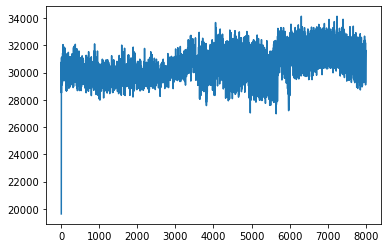

In [134]:
plt.plot(TrainingPortfolio)

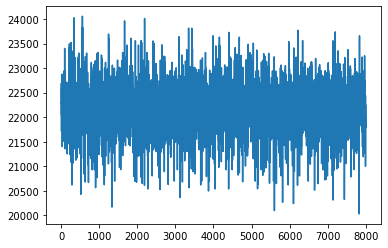

In [135]:
plt.plot(TestPortfolio)

In [136]:
np.mean(TestPortfolio)

22203.089466250167

In [137]:
np.mean(RandomPortfolio)

23463.109901249758

### 20000 Episode

In [138]:
env.reset()

array([    0.   ,     0.   ,     0.   ,     0.   ,     0.   ,     0.   ,
         119.72 ,    63.99 ,    56.27 ,   116.082,    63.248,    57.682,
       20000.   ])

In [139]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 20000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_trend5_20000_episode.npz", W=W, b=b)

episode: 1/20000, episode end value: 19630.28
episode: 2/20000, episode end value: 25845.26
episode: 3/20000, episode end value: 24518.36
episode: 4/20000, episode end value: 30771.14
episode: 5/20000, episode end value: 28502.07
episode: 6/20000, episode end value: 30588.51
episode: 7/20000, episode end value: 31099.66
episode: 8/20000, episode end value: 30051.95
episode: 9/20000, episode end value: 30051.95
episode: 10/20000, episode end value: 29683.22
episode: 11/20000, episode end value: 29883.44
episode: 12/20000, episode end value: 29464.01
episode: 13/20000, episode end value: 29858.61
episode: 14/20000, episode end value: 29679.76
episode: 15/20000, episode end value: 29860.96
episode: 16/20000, episode end value: 30051.95
episode: 17/20000, episode end value: 30107.61
episode: 18/20000, episode end value: 30545.73
episode: 19/20000, episode end value: 30051.95
episode: 20/20000, episode end value: 30645.37
episode: 21/20000, episode end value: 29086.04
episode: 22/20000, epi

episode: 174/20000, episode end value: 30742.05
episode: 175/20000, episode end value: 29427.60
episode: 176/20000, episode end value: 29732.89
episode: 177/20000, episode end value: 30310.95
episode: 178/20000, episode end value: 30234.50
episode: 179/20000, episode end value: 30641.52
episode: 180/20000, episode end value: 29495.14
episode: 181/20000, episode end value: 29101.20
episode: 182/20000, episode end value: 30003.65
episode: 183/20000, episode end value: 29731.60
episode: 184/20000, episode end value: 29527.80
episode: 185/20000, episode end value: 29589.97
episode: 186/20000, episode end value: 31478.61
episode: 187/20000, episode end value: 30030.72
episode: 188/20000, episode end value: 29950.72
episode: 189/20000, episode end value: 30939.99
episode: 190/20000, episode end value: 30183.15
episode: 191/20000, episode end value: 29642.91
episode: 192/20000, episode end value: 29966.27
episode: 193/20000, episode end value: 29020.75
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 30820.49
episode: 346/20000, episode end value: 30740.93
episode: 347/20000, episode end value: 29463.03
episode: 348/20000, episode end value: 31288.48
episode: 349/20000, episode end value: 31338.67
episode: 350/20000, episode end value: 31573.29
episode: 351/20000, episode end value: 29319.73
episode: 352/20000, episode end value: 30606.67
episode: 353/20000, episode end value: 30371.03
episode: 354/20000, episode end value: 30482.87
episode: 355/20000, episode end value: 31625.30
episode: 356/20000, episode end value: 30880.17
episode: 357/20000, episode end value: 30904.76
episode: 358/20000, episode end value: 30462.13
episode: 359/20000, episode end value: 30143.63
episode: 360/20000, episode end value: 30464.75
episode: 361/20000, episode end value: 30833.13
episode: 362/20000, episode end value: 31336.93
episode: 363/20000, episode end value: 29723.20
episode: 364/20000, episode end value: 31135.29
episode: 365/20000, episode end value: 3

episode: 516/20000, episode end value: 30633.97
episode: 517/20000, episode end value: 29966.78
episode: 518/20000, episode end value: 29441.17
episode: 519/20000, episode end value: 30062.51
episode: 520/20000, episode end value: 29717.59
episode: 521/20000, episode end value: 29558.72
episode: 522/20000, episode end value: 29242.50
episode: 523/20000, episode end value: 28674.14
episode: 524/20000, episode end value: 30097.08
episode: 525/20000, episode end value: 29292.62
episode: 526/20000, episode end value: 29398.99
episode: 527/20000, episode end value: 29364.83
episode: 528/20000, episode end value: 29631.41
episode: 529/20000, episode end value: 29125.16
episode: 530/20000, episode end value: 29707.36
episode: 531/20000, episode end value: 29449.45
episode: 532/20000, episode end value: 28967.30
episode: 533/20000, episode end value: 29786.56
episode: 534/20000, episode end value: 30057.05
episode: 535/20000, episode end value: 30207.39
episode: 536/20000, episode end value: 3

episode: 687/20000, episode end value: 29914.90
episode: 688/20000, episode end value: 30158.71
episode: 689/20000, episode end value: 29915.84
episode: 690/20000, episode end value: 29503.03
episode: 691/20000, episode end value: 30180.36
episode: 692/20000, episode end value: 30388.73
episode: 693/20000, episode end value: 29321.06
episode: 694/20000, episode end value: 29991.89
episode: 695/20000, episode end value: 29441.69
episode: 696/20000, episode end value: 30880.23
episode: 697/20000, episode end value: 29578.31
episode: 698/20000, episode end value: 30040.09
episode: 699/20000, episode end value: 28815.39
episode: 700/20000, episode end value: 29875.87
episode: 701/20000, episode end value: 29915.47
episode: 702/20000, episode end value: 28731.28
episode: 703/20000, episode end value: 30444.74
episode: 704/20000, episode end value: 29102.95
episode: 705/20000, episode end value: 29619.93
episode: 706/20000, episode end value: 29256.91
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 30328.02
episode: 859/20000, episode end value: 29162.33
episode: 860/20000, episode end value: 30060.48
episode: 861/20000, episode end value: 29615.53
episode: 862/20000, episode end value: 29820.92
episode: 863/20000, episode end value: 30677.42
episode: 864/20000, episode end value: 29822.58
episode: 865/20000, episode end value: 30179.15
episode: 866/20000, episode end value: 30769.68
episode: 867/20000, episode end value: 30330.08
episode: 868/20000, episode end value: 30528.52
episode: 869/20000, episode end value: 31138.89
episode: 870/20000, episode end value: 30134.13
episode: 871/20000, episode end value: 31612.93
episode: 872/20000, episode end value: 30682.71
episode: 873/20000, episode end value: 30293.69
episode: 874/20000, episode end value: 30887.21
episode: 875/20000, episode end value: 30972.66
episode: 876/20000, episode end value: 32098.50
episode: 877/20000, episode end value: 30407.59
episode: 878/20000, episode end value: 3

episode: 1029/20000, episode end value: 29037.41
episode: 1030/20000, episode end value: 29463.06
episode: 1031/20000, episode end value: 29477.94
episode: 1032/20000, episode end value: 29717.59
episode: 1033/20000, episode end value: 29734.31
episode: 1034/20000, episode end value: 29872.76
episode: 1035/20000, episode end value: 29709.18
episode: 1036/20000, episode end value: 29257.91
episode: 1037/20000, episode end value: 29575.42
episode: 1038/20000, episode end value: 29795.88
episode: 1039/20000, episode end value: 29525.39
episode: 1040/20000, episode end value: 30099.61
episode: 1041/20000, episode end value: 29449.45
episode: 1042/20000, episode end value: 29294.43
episode: 1043/20000, episode end value: 29794.14
episode: 1044/20000, episode end value: 29623.45
episode: 1045/20000, episode end value: 29820.66
episode: 1046/20000, episode end value: 30431.42
episode: 1047/20000, episode end value: 29573.63
episode: 1048/20000, episode end value: 29794.85
episode: 1049/20000,

episode: 1197/20000, episode end value: 29556.67
episode: 1198/20000, episode end value: 29393.61
episode: 1199/20000, episode end value: 30089.25
episode: 1200/20000, episode end value: 29493.59
episode: 1201/20000, episode end value: 29200.70
episode: 1202/20000, episode end value: 29767.66
episode: 1203/20000, episode end value: 29945.30
episode: 1204/20000, episode end value: 29004.01
episode: 1205/20000, episode end value: 29922.39
episode: 1206/20000, episode end value: 28493.54
episode: 1207/20000, episode end value: 29593.57
episode: 1208/20000, episode end value: 29717.59
episode: 1209/20000, episode end value: 29730.75
episode: 1210/20000, episode end value: 30027.23
episode: 1211/20000, episode end value: 30358.00
episode: 1212/20000, episode end value: 30862.74
episode: 1213/20000, episode end value: 29900.84
episode: 1214/20000, episode end value: 29054.02
episode: 1215/20000, episode end value: 30030.44
episode: 1216/20000, episode end value: 29255.12
episode: 1217/20000,

episode: 1365/20000, episode end value: 30537.47
episode: 1366/20000, episode end value: 30114.48
episode: 1367/20000, episode end value: 29916.63
episode: 1368/20000, episode end value: 29750.68
episode: 1369/20000, episode end value: 29237.97
episode: 1370/20000, episode end value: 28983.21
episode: 1371/20000, episode end value: 29816.61
episode: 1372/20000, episode end value: 29717.59
episode: 1373/20000, episode end value: 29495.73
episode: 1374/20000, episode end value: 29416.34
episode: 1375/20000, episode end value: 30925.91
episode: 1376/20000, episode end value: 29400.12
episode: 1377/20000, episode end value: 29163.17
episode: 1378/20000, episode end value: 29281.51
episode: 1379/20000, episode end value: 29493.06
episode: 1380/20000, episode end value: 29356.06
episode: 1381/20000, episode end value: 29867.12
episode: 1382/20000, episode end value: 29915.71
episode: 1383/20000, episode end value: 29882.75
episode: 1384/20000, episode end value: 29794.02
episode: 1385/20000,

episode: 1533/20000, episode end value: 28793.98
episode: 1534/20000, episode end value: 28897.58
episode: 1535/20000, episode end value: 29007.10
episode: 1536/20000, episode end value: 30148.84
episode: 1537/20000, episode end value: 29349.03
episode: 1538/20000, episode end value: 30171.51
episode: 1539/20000, episode end value: 30604.46
episode: 1540/20000, episode end value: 30767.11
episode: 1541/20000, episode end value: 30554.86
episode: 1542/20000, episode end value: 30677.42
episode: 1543/20000, episode end value: 30438.27
episode: 1544/20000, episode end value: 30660.71
episode: 1545/20000, episode end value: 30364.35
episode: 1546/20000, episode end value: 30524.17
episode: 1547/20000, episode end value: 30101.41
episode: 1548/20000, episode end value: 30391.47
episode: 1549/20000, episode end value: 29650.92
episode: 1550/20000, episode end value: 30407.93
episode: 1551/20000, episode end value: 30914.93
episode: 1552/20000, episode end value: 30548.30
episode: 1553/20000,

episode: 1701/20000, episode end value: 29609.33
episode: 1702/20000, episode end value: 29954.04
episode: 1703/20000, episode end value: 29942.82
episode: 1704/20000, episode end value: 30418.31
episode: 1705/20000, episode end value: 28982.45
episode: 1706/20000, episode end value: 29895.24
episode: 1707/20000, episode end value: 29097.06
episode: 1708/20000, episode end value: 29205.49
episode: 1709/20000, episode end value: 29561.65
episode: 1710/20000, episode end value: 29570.11
episode: 1711/20000, episode end value: 29234.60
episode: 1712/20000, episode end value: 29735.07
episode: 1713/20000, episode end value: 30637.32
episode: 1714/20000, episode end value: 29120.26
episode: 1715/20000, episode end value: 29476.33
episode: 1716/20000, episode end value: 29556.56
episode: 1717/20000, episode end value: 30529.32
episode: 1718/20000, episode end value: 29025.90
episode: 1719/20000, episode end value: 29926.37
episode: 1720/20000, episode end value: 29539.22
episode: 1721/20000,

episode: 1869/20000, episode end value: 30389.05
episode: 1870/20000, episode end value: 30080.67
episode: 1871/20000, episode end value: 30388.83
episode: 1872/20000, episode end value: 29996.23
episode: 1873/20000, episode end value: 30072.20
episode: 1874/20000, episode end value: 29953.39
episode: 1875/20000, episode end value: 30596.34
episode: 1876/20000, episode end value: 29607.16
episode: 1877/20000, episode end value: 30347.79
episode: 1878/20000, episode end value: 30809.59
episode: 1879/20000, episode end value: 30801.22
episode: 1880/20000, episode end value: 30670.17
episode: 1881/20000, episode end value: 31016.63
episode: 1882/20000, episode end value: 29985.72
episode: 1883/20000, episode end value: 30741.20
episode: 1884/20000, episode end value: 30333.07
episode: 1885/20000, episode end value: 28203.41
episode: 1886/20000, episode end value: 30351.91
episode: 1887/20000, episode end value: 30287.49
episode: 1888/20000, episode end value: 30565.42
episode: 1889/20000,

episode: 2037/20000, episode end value: 30504.55
episode: 2038/20000, episode end value: 30117.43
episode: 2039/20000, episode end value: 29378.85
episode: 2040/20000, episode end value: 29492.60
episode: 2041/20000, episode end value: 29817.80
episode: 2042/20000, episode end value: 29652.60
episode: 2043/20000, episode end value: 29833.41
episode: 2044/20000, episode end value: 30819.47
episode: 2045/20000, episode end value: 29703.08
episode: 2046/20000, episode end value: 29631.93
episode: 2047/20000, episode end value: 29817.26
episode: 2048/20000, episode end value: 30030.49
episode: 2049/20000, episode end value: 30031.25
episode: 2050/20000, episode end value: 30202.73
episode: 2051/20000, episode end value: 29634.96
episode: 2052/20000, episode end value: 30113.26
episode: 2053/20000, episode end value: 30273.12
episode: 2054/20000, episode end value: 30196.14
episode: 2055/20000, episode end value: 29967.38
episode: 2056/20000, episode end value: 29794.87
episode: 2057/20000,

episode: 2205/20000, episode end value: 30254.50
episode: 2206/20000, episode end value: 29894.58
episode: 2207/20000, episode end value: 30267.94
episode: 2208/20000, episode end value: 29522.15
episode: 2209/20000, episode end value: 29148.27
episode: 2210/20000, episode end value: 29492.45
episode: 2211/20000, episode end value: 30049.92
episode: 2212/20000, episode end value: 29633.44
episode: 2213/20000, episode end value: 29794.59
episode: 2214/20000, episode end value: 29955.37
episode: 2215/20000, episode end value: 29641.20
episode: 2216/20000, episode end value: 29710.44
episode: 2217/20000, episode end value: 29949.11
episode: 2218/20000, episode end value: 29659.20
episode: 2219/20000, episode end value: 30076.07
episode: 2220/20000, episode end value: 29949.11
episode: 2221/20000, episode end value: 29644.96
episode: 2222/20000, episode end value: 29444.21
episode: 2223/20000, episode end value: 30199.24
episode: 2224/20000, episode end value: 30068.44
episode: 2225/20000,

episode: 2373/20000, episode end value: 29870.55
episode: 2374/20000, episode end value: 29228.82
episode: 2375/20000, episode end value: 29944.67
episode: 2376/20000, episode end value: 30866.86
episode: 2377/20000, episode end value: 30453.45
episode: 2378/20000, episode end value: 29870.55
episode: 2379/20000, episode end value: 29445.55
episode: 2380/20000, episode end value: 30109.49
episode: 2381/20000, episode end value: 29870.55
episode: 2382/20000, episode end value: 29921.84
episode: 2383/20000, episode end value: 29981.93
episode: 2384/20000, episode end value: 29917.02
episode: 2385/20000, episode end value: 29825.94
episode: 2386/20000, episode end value: 29961.03
episode: 2387/20000, episode end value: 29846.86
episode: 2388/20000, episode end value: 29405.29
episode: 2389/20000, episode end value: 31311.61
episode: 2390/20000, episode end value: 30089.65
episode: 2391/20000, episode end value: 29776.05
episode: 2392/20000, episode end value: 29442.71
episode: 2393/20000,

episode: 2541/20000, episode end value: 29600.97
episode: 2542/20000, episode end value: 29870.55
episode: 2543/20000, episode end value: 29870.55
episode: 2544/20000, episode end value: 29967.58
episode: 2545/20000, episode end value: 30031.61
episode: 2546/20000, episode end value: 30585.75
episode: 2547/20000, episode end value: 29460.07
episode: 2548/20000, episode end value: 29332.69
episode: 2549/20000, episode end value: 30784.85
episode: 2550/20000, episode end value: 29633.19
episode: 2551/20000, episode end value: 30717.27
episode: 2552/20000, episode end value: 30408.51
episode: 2553/20000, episode end value: 29633.19
episode: 2554/20000, episode end value: 29915.26
episode: 2555/20000, episode end value: 30549.55
episode: 2556/20000, episode end value: 28872.25
episode: 2557/20000, episode end value: 29678.34
episode: 2558/20000, episode end value: 29830.67
episode: 2559/20000, episode end value: 30049.92
episode: 2560/20000, episode end value: 29806.76
episode: 2561/20000,

episode: 2709/20000, episode end value: 29359.56
episode: 2710/20000, episode end value: 29772.47
episode: 2711/20000, episode end value: 30410.60
episode: 2712/20000, episode end value: 29710.22
episode: 2713/20000, episode end value: 29462.84
episode: 2714/20000, episode end value: 29377.17
episode: 2715/20000, episode end value: 30392.51
episode: 2716/20000, episode end value: 29682.42
episode: 2717/20000, episode end value: 30122.66
episode: 2718/20000, episode end value: 29870.55
episode: 2719/20000, episode end value: 29111.52
episode: 2720/20000, episode end value: 30219.53
episode: 2721/20000, episode end value: 28825.29
episode: 2722/20000, episode end value: 30120.16
episode: 2723/20000, episode end value: 29681.73
episode: 2724/20000, episode end value: 30151.77
episode: 2725/20000, episode end value: 30238.67
episode: 2726/20000, episode end value: 29966.42
episode: 2727/20000, episode end value: 30440.35
episode: 2728/20000, episode end value: 29773.74
episode: 2729/20000,

episode: 2877/20000, episode end value: 30978.61
episode: 2878/20000, episode end value: 29945.16
episode: 2879/20000, episode end value: 29571.12
episode: 2880/20000, episode end value: 30116.73
episode: 2881/20000, episode end value: 30896.43
episode: 2882/20000, episode end value: 30267.49
episode: 2883/20000, episode end value: 30267.49
episode: 2884/20000, episode end value: 30559.58
episode: 2885/20000, episode end value: 29766.08
episode: 2886/20000, episode end value: 30482.31
episode: 2887/20000, episode end value: 30141.69
episode: 2888/20000, episode end value: 30390.15
episode: 2889/20000, episode end value: 30362.39
episode: 2890/20000, episode end value: 29801.63
episode: 2891/20000, episode end value: 30465.13
episode: 2892/20000, episode end value: 30237.30
episode: 2893/20000, episode end value: 30711.65
episode: 2894/20000, episode end value: 30896.11
episode: 2895/20000, episode end value: 30267.49
episode: 2896/20000, episode end value: 30064.15
episode: 2897/20000,

episode: 3045/20000, episode end value: 30283.86
episode: 3046/20000, episode end value: 30174.73
episode: 3047/20000, episode end value: 29432.21
episode: 3048/20000, episode end value: 30232.31
episode: 3049/20000, episode end value: 30358.25
episode: 3050/20000, episode end value: 29482.42
episode: 3051/20000, episode end value: 31045.76
episode: 3052/20000, episode end value: 30293.76
episode: 3053/20000, episode end value: 30683.81
episode: 3054/20000, episode end value: 30891.60
episode: 3055/20000, episode end value: 29721.63
episode: 3056/20000, episode end value: 30267.49
episode: 3057/20000, episode end value: 29411.54
episode: 3058/20000, episode end value: 29915.37
episode: 3059/20000, episode end value: 30452.61
episode: 3060/20000, episode end value: 30995.32
episode: 3061/20000, episode end value: 30004.61
episode: 3062/20000, episode end value: 31824.77
episode: 3063/20000, episode end value: 30742.07
episode: 3064/20000, episode end value: 30601.67
episode: 3065/20000,

episode: 3213/20000, episode end value: 30152.97
episode: 3214/20000, episode end value: 30865.75
episode: 3215/20000, episode end value: 31056.79
episode: 3216/20000, episode end value: 30152.97
episode: 3217/20000, episode end value: 30863.61
episode: 3218/20000, episode end value: 30625.85
episode: 3219/20000, episode end value: 30662.29
episode: 3220/20000, episode end value: 30408.99
episode: 3221/20000, episode end value: 30223.33
episode: 3222/20000, episode end value: 30761.17
episode: 3223/20000, episode end value: 31573.78
episode: 3224/20000, episode end value: 31049.94
episode: 3225/20000, episode end value: 30456.79
episode: 3226/20000, episode end value: 30805.92
episode: 3227/20000, episode end value: 31196.68
episode: 3228/20000, episode end value: 30971.46
episode: 3229/20000, episode end value: 30621.34
episode: 3230/20000, episode end value: 30057.33
episode: 3231/20000, episode end value: 30909.12
episode: 3232/20000, episode end value: 31361.12
episode: 3233/20000,

episode: 3381/20000, episode end value: 30043.31
episode: 3382/20000, episode end value: 31475.97
episode: 3383/20000, episode end value: 31810.25
episode: 3384/20000, episode end value: 31314.61
episode: 3385/20000, episode end value: 31574.05
episode: 3386/20000, episode end value: 31709.36
episode: 3387/20000, episode end value: 31681.11
episode: 3388/20000, episode end value: 31650.48
episode: 3389/20000, episode end value: 31623.48
episode: 3390/20000, episode end value: 31077.30
episode: 3391/20000, episode end value: 31709.48
episode: 3392/20000, episode end value: 31709.36
episode: 3393/20000, episode end value: 31784.12
episode: 3394/20000, episode end value: 31478.98
episode: 3395/20000, episode end value: 31202.54
episode: 3396/20000, episode end value: 32699.99
episode: 3397/20000, episode end value: 31473.73
episode: 3398/20000, episode end value: 31328.78
episode: 3399/20000, episode end value: 31938.40
episode: 3400/20000, episode end value: 31383.42
episode: 3401/20000,

episode: 3549/20000, episode end value: 31193.52
episode: 3550/20000, episode end value: 29884.51
episode: 3551/20000, episode end value: 30697.47
episode: 3552/20000, episode end value: 30812.97
episode: 3553/20000, episode end value: 30658.84
episode: 3554/20000, episode end value: 30390.46
episode: 3555/20000, episode end value: 30521.11
episode: 3556/20000, episode end value: 30782.07
episode: 3557/20000, episode end value: 30625.75
episode: 3558/20000, episode end value: 30677.12
episode: 3559/20000, episode end value: 30203.89
episode: 3560/20000, episode end value: 30146.76
episode: 3561/20000, episode end value: 30928.87
episode: 3562/20000, episode end value: 30458.51
episode: 3563/20000, episode end value: 30599.06
episode: 3564/20000, episode end value: 30993.03
episode: 3565/20000, episode end value: 31215.12
episode: 3566/20000, episode end value: 30504.95
episode: 3567/20000, episode end value: 31184.49
episode: 3568/20000, episode end value: 30626.33
episode: 3569/20000,

episode: 3717/20000, episode end value: 32515.45
episode: 3718/20000, episode end value: 29688.09
episode: 3719/20000, episode end value: 31582.10
episode: 3720/20000, episode end value: 30708.90
episode: 3721/20000, episode end value: 29324.20
episode: 3722/20000, episode end value: 31282.02
episode: 3723/20000, episode end value: 29477.58
episode: 3724/20000, episode end value: 31388.06
episode: 3725/20000, episode end value: 28676.59
episode: 3726/20000, episode end value: 31006.40
episode: 3727/20000, episode end value: 29139.04
episode: 3728/20000, episode end value: 31524.88
episode: 3729/20000, episode end value: 31303.45
episode: 3730/20000, episode end value: 30132.25
episode: 3731/20000, episode end value: 31775.32
episode: 3732/20000, episode end value: 30805.61
episode: 3733/20000, episode end value: 29441.24
episode: 3734/20000, episode end value: 31550.56
episode: 3735/20000, episode end value: 30071.26
episode: 3736/20000, episode end value: 31891.42
episode: 3737/20000,

episode: 3885/20000, episode end value: 30604.37
episode: 3886/20000, episode end value: 30442.57
episode: 3887/20000, episode end value: 31357.25
episode: 3888/20000, episode end value: 31185.55
episode: 3889/20000, episode end value: 30267.34
episode: 3890/20000, episode end value: 31194.11
episode: 3891/20000, episode end value: 31233.65
episode: 3892/20000, episode end value: 30971.02
episode: 3893/20000, episode end value: 31431.69
episode: 3894/20000, episode end value: 30267.65
episode: 3895/20000, episode end value: 30798.98
episode: 3896/20000, episode end value: 30197.37
episode: 3897/20000, episode end value: 31663.94
episode: 3898/20000, episode end value: 30185.22
episode: 3899/20000, episode end value: 31263.97
episode: 3900/20000, episode end value: 29686.31
episode: 3901/20000, episode end value: 31364.46
episode: 3902/20000, episode end value: 30203.39
episode: 3903/20000, episode end value: 31777.03
episode: 3904/20000, episode end value: 30251.42
episode: 3905/20000,

episode: 4053/20000, episode end value: 30061.37
episode: 4054/20000, episode end value: 30746.84
episode: 4055/20000, episode end value: 33665.38
episode: 4056/20000, episode end value: 30248.48
episode: 4057/20000, episode end value: 32074.34
episode: 4058/20000, episode end value: 31151.45
episode: 4059/20000, episode end value: 31785.45
episode: 4060/20000, episode end value: 30626.02
episode: 4061/20000, episode end value: 30398.29
episode: 4062/20000, episode end value: 33303.00
episode: 4063/20000, episode end value: 30766.01
episode: 4064/20000, episode end value: 30399.64
episode: 4065/20000, episode end value: 31375.58
episode: 4066/20000, episode end value: 30090.19
episode: 4067/20000, episode end value: 31006.22
episode: 4068/20000, episode end value: 30626.75
episode: 4069/20000, episode end value: 31939.78
episode: 4070/20000, episode end value: 31150.86
episode: 4071/20000, episode end value: 29751.91
episode: 4072/20000, episode end value: 30750.56
episode: 4073/20000,

episode: 4221/20000, episode end value: 31140.66
episode: 4222/20000, episode end value: 31554.61
episode: 4223/20000, episode end value: 31131.49
episode: 4224/20000, episode end value: 32562.08
episode: 4225/20000, episode end value: 31951.29
episode: 4226/20000, episode end value: 29951.94
episode: 4227/20000, episode end value: 31556.42
episode: 4228/20000, episode end value: 30252.10
episode: 4229/20000, episode end value: 31399.24
episode: 4230/20000, episode end value: 31166.81
episode: 4231/20000, episode end value: 30476.02
episode: 4232/20000, episode end value: 32184.67
episode: 4233/20000, episode end value: 31285.81
episode: 4234/20000, episode end value: 31886.14
episode: 4235/20000, episode end value: 31663.75
episode: 4236/20000, episode end value: 29966.20
episode: 4237/20000, episode end value: 30650.04
episode: 4238/20000, episode end value: 32814.18
episode: 4239/20000, episode end value: 31303.47
episode: 4240/20000, episode end value: 31080.83
episode: 4241/20000,

episode: 4389/20000, episode end value: 28420.58
episode: 4390/20000, episode end value: 31829.22
episode: 4391/20000, episode end value: 27926.51
episode: 4392/20000, episode end value: 29520.22
episode: 4393/20000, episode end value: 31201.99
episode: 4394/20000, episode end value: 31392.50
episode: 4395/20000, episode end value: 32115.17
episode: 4396/20000, episode end value: 30582.14
episode: 4397/20000, episode end value: 29505.54
episode: 4398/20000, episode end value: 32123.66
episode: 4399/20000, episode end value: 28916.23
episode: 4400/20000, episode end value: 29876.46
episode: 4401/20000, episode end value: 30971.60
episode: 4402/20000, episode end value: 31996.34
episode: 4403/20000, episode end value: 29519.69
episode: 4404/20000, episode end value: 31530.03
episode: 4405/20000, episode end value: 31608.40
episode: 4406/20000, episode end value: 28020.15
episode: 4407/20000, episode end value: 28406.71
episode: 4408/20000, episode end value: 29336.75
episode: 4409/20000,

episode: 4557/20000, episode end value: 29260.15
episode: 4558/20000, episode end value: 32066.28
episode: 4559/20000, episode end value: 31576.16
episode: 4560/20000, episode end value: 29027.48
episode: 4561/20000, episode end value: 29389.52
episode: 4562/20000, episode end value: 31117.07
episode: 4563/20000, episode end value: 29755.11
episode: 4564/20000, episode end value: 30985.61
episode: 4565/20000, episode end value: 31954.57
episode: 4566/20000, episode end value: 33071.79
episode: 4567/20000, episode end value: 29671.75
episode: 4568/20000, episode end value: 32628.07
episode: 4569/20000, episode end value: 28818.87
episode: 4570/20000, episode end value: 31694.71
episode: 4571/20000, episode end value: 29648.54
episode: 4572/20000, episode end value: 31357.59
episode: 4573/20000, episode end value: 30663.29
episode: 4574/20000, episode end value: 31771.58
episode: 4575/20000, episode end value: 28397.42
episode: 4576/20000, episode end value: 31042.00
episode: 4577/20000,

episode: 4725/20000, episode end value: 31601.52
episode: 4726/20000, episode end value: 32548.07
episode: 4727/20000, episode end value: 29565.15
episode: 4728/20000, episode end value: 31629.25
episode: 4729/20000, episode end value: 30674.79
episode: 4730/20000, episode end value: 29118.53
episode: 4731/20000, episode end value: 30884.64
episode: 4732/20000, episode end value: 29636.00
episode: 4733/20000, episode end value: 32547.63
episode: 4734/20000, episode end value: 30915.01
episode: 4735/20000, episode end value: 29511.75
episode: 4736/20000, episode end value: 28595.90
episode: 4737/20000, episode end value: 31551.88
episode: 4738/20000, episode end value: 30291.81
episode: 4739/20000, episode end value: 31952.58
episode: 4740/20000, episode end value: 29496.47
episode: 4741/20000, episode end value: 31810.74
episode: 4742/20000, episode end value: 31016.78
episode: 4743/20000, episode end value: 29686.17
episode: 4744/20000, episode end value: 30980.13
episode: 4745/20000,

episode: 4893/20000, episode end value: 30416.87
episode: 4894/20000, episode end value: 31882.23
episode: 4895/20000, episode end value: 31432.67
episode: 4896/20000, episode end value: 30283.79
episode: 4897/20000, episode end value: 30962.47
episode: 4898/20000, episode end value: 31863.72
episode: 4899/20000, episode end value: 29780.21
episode: 4900/20000, episode end value: 31276.02
episode: 4901/20000, episode end value: 29338.26
episode: 4902/20000, episode end value: 30209.07
episode: 4903/20000, episode end value: 30570.57
episode: 4904/20000, episode end value: 31628.67
episode: 4905/20000, episode end value: 32244.74
episode: 4906/20000, episode end value: 30400.92
episode: 4907/20000, episode end value: 29874.76
episode: 4908/20000, episode end value: 29917.38
episode: 4909/20000, episode end value: 29496.38
episode: 4910/20000, episode end value: 30646.03
episode: 4911/20000, episode end value: 31774.99
episode: 4912/20000, episode end value: 29881.90
episode: 4913/20000,

episode: 5061/20000, episode end value: 28897.50
episode: 5062/20000, episode end value: 28146.79
episode: 5063/20000, episode end value: 28907.71
episode: 5064/20000, episode end value: 28783.40
episode: 5065/20000, episode end value: 28482.42
episode: 5066/20000, episode end value: 30843.57
episode: 5067/20000, episode end value: 27975.84
episode: 5068/20000, episode end value: 31863.53
episode: 5069/20000, episode end value: 28472.13
episode: 5070/20000, episode end value: 29263.24
episode: 5071/20000, episode end value: 29522.88
episode: 5072/20000, episode end value: 28360.58
episode: 5073/20000, episode end value: 31892.72
episode: 5074/20000, episode end value: 28815.75
episode: 5075/20000, episode end value: 28322.01
episode: 5076/20000, episode end value: 28313.00
episode: 5077/20000, episode end value: 30619.91
episode: 5078/20000, episode end value: 30905.10
episode: 5079/20000, episode end value: 28263.08
episode: 5080/20000, episode end value: 31113.92
episode: 5081/20000,

episode: 5229/20000, episode end value: 29678.15
episode: 5230/20000, episode end value: 28266.79
episode: 5231/20000, episode end value: 28890.06
episode: 5232/20000, episode end value: 32050.42
episode: 5233/20000, episode end value: 30969.65
episode: 5234/20000, episode end value: 30742.65
episode: 5235/20000, episode end value: 30704.04
episode: 5236/20000, episode end value: 28387.06
episode: 5237/20000, episode end value: 28482.43
episode: 5238/20000, episode end value: 29328.90
episode: 5239/20000, episode end value: 28664.46
episode: 5240/20000, episode end value: 30174.71
episode: 5241/20000, episode end value: 28527.20
episode: 5242/20000, episode end value: 30048.76
episode: 5243/20000, episode end value: 30967.70
episode: 5244/20000, episode end value: 31151.91
episode: 5245/20000, episode end value: 29237.71
episode: 5246/20000, episode end value: 29933.96
episode: 5247/20000, episode end value: 28705.44
episode: 5248/20000, episode end value: 31991.44
episode: 5249/20000,

episode: 5397/20000, episode end value: 28710.48
episode: 5398/20000, episode end value: 29956.33
episode: 5399/20000, episode end value: 29098.12
episode: 5400/20000, episode end value: 28722.34
episode: 5401/20000, episode end value: 30267.61
episode: 5402/20000, episode end value: 32338.31
episode: 5403/20000, episode end value: 31035.71
episode: 5404/20000, episode end value: 28932.78
episode: 5405/20000, episode end value: 30765.18
episode: 5406/20000, episode end value: 29860.22
episode: 5407/20000, episode end value: 30411.71
episode: 5408/20000, episode end value: 30575.43
episode: 5409/20000, episode end value: 31011.65
episode: 5410/20000, episode end value: 30677.03
episode: 5411/20000, episode end value: 29021.27
episode: 5412/20000, episode end value: 31509.82
episode: 5413/20000, episode end value: 31351.29
episode: 5414/20000, episode end value: 29710.31
episode: 5415/20000, episode end value: 29042.59
episode: 5416/20000, episode end value: 28319.34
episode: 5417/20000,

episode: 5565/20000, episode end value: 30084.00
episode: 5566/20000, episode end value: 29508.64
episode: 5567/20000, episode end value: 28383.69
episode: 5568/20000, episode end value: 28267.22
episode: 5569/20000, episode end value: 28155.38
episode: 5570/20000, episode end value: 29543.37
episode: 5571/20000, episode end value: 28276.93
episode: 5572/20000, episode end value: 30083.30
episode: 5573/20000, episode end value: 31520.96
episode: 5574/20000, episode end value: 30657.41
episode: 5575/20000, episode end value: 30856.75
episode: 5576/20000, episode end value: 30585.09
episode: 5577/20000, episode end value: 29061.17
episode: 5578/20000, episode end value: 31822.27
episode: 5579/20000, episode end value: 29271.92
episode: 5580/20000, episode end value: 29668.77
episode: 5581/20000, episode end value: 29212.87
episode: 5582/20000, episode end value: 32065.19
episode: 5583/20000, episode end value: 28973.92
episode: 5584/20000, episode end value: 30510.77
episode: 5585/20000,

episode: 5733/20000, episode end value: 30913.88
episode: 5734/20000, episode end value: 31521.11
episode: 5735/20000, episode end value: 31604.38
episode: 5736/20000, episode end value: 32636.61
episode: 5737/20000, episode end value: 30699.74
episode: 5738/20000, episode end value: 31950.81
episode: 5739/20000, episode end value: 30405.63
episode: 5740/20000, episode end value: 31383.22
episode: 5741/20000, episode end value: 32769.71
episode: 5742/20000, episode end value: 32084.42
episode: 5743/20000, episode end value: 31862.59
episode: 5744/20000, episode end value: 31454.34
episode: 5745/20000, episode end value: 32841.55
episode: 5746/20000, episode end value: 30625.59
episode: 5747/20000, episode end value: 31878.93
episode: 5748/20000, episode end value: 30918.18
episode: 5749/20000, episode end value: 30677.40
episode: 5750/20000, episode end value: 30533.39
episode: 5751/20000, episode end value: 31080.87
episode: 5752/20000, episode end value: 30677.25
episode: 5753/20000,

episode: 5901/20000, episode end value: 31308.17
episode: 5902/20000, episode end value: 30095.98
episode: 5903/20000, episode end value: 32469.31
episode: 5904/20000, episode end value: 32572.24
episode: 5905/20000, episode end value: 32242.72
episode: 5906/20000, episode end value: 29701.66
episode: 5907/20000, episode end value: 31861.94
episode: 5908/20000, episode end value: 31052.16
episode: 5909/20000, episode end value: 29814.39
episode: 5910/20000, episode end value: 30128.31
episode: 5911/20000, episode end value: 31790.73
episode: 5912/20000, episode end value: 31737.96
episode: 5913/20000, episode end value: 30233.81
episode: 5914/20000, episode end value: 30191.55
episode: 5915/20000, episode end value: 29224.77
episode: 5916/20000, episode end value: 31202.43
episode: 5917/20000, episode end value: 31519.27
episode: 5918/20000, episode end value: 31968.62
episode: 5919/20000, episode end value: 31867.00
episode: 5920/20000, episode end value: 29935.08
episode: 5921/20000,

episode: 6069/20000, episode end value: 32505.86
episode: 6070/20000, episode end value: 30884.36
episode: 6071/20000, episode end value: 31155.31
episode: 6072/20000, episode end value: 30790.48
episode: 6073/20000, episode end value: 31138.17
episode: 6074/20000, episode end value: 31619.80
episode: 6075/20000, episode end value: 32136.78
episode: 6076/20000, episode end value: 31494.38
episode: 6077/20000, episode end value: 31252.74
episode: 6078/20000, episode end value: 31254.82
episode: 6079/20000, episode end value: 30420.91
episode: 6080/20000, episode end value: 31018.06
episode: 6081/20000, episode end value: 32676.87
episode: 6082/20000, episode end value: 31052.54
episode: 6083/20000, episode end value: 31682.23
episode: 6084/20000, episode end value: 30701.30
episode: 6085/20000, episode end value: 31244.03
episode: 6086/20000, episode end value: 31519.82
episode: 6087/20000, episode end value: 31364.87
episode: 6088/20000, episode end value: 31462.51
episode: 6089/20000,

episode: 6237/20000, episode end value: 31087.90
episode: 6238/20000, episode end value: 31709.39
episode: 6239/20000, episode end value: 31777.74
episode: 6240/20000, episode end value: 31935.17
episode: 6241/20000, episode end value: 30068.44
episode: 6242/20000, episode end value: 31355.56
episode: 6243/20000, episode end value: 32406.90
episode: 6244/20000, episode end value: 29529.71
episode: 6245/20000, episode end value: 33190.80
episode: 6246/20000, episode end value: 30237.18
episode: 6247/20000, episode end value: 33172.97
episode: 6248/20000, episode end value: 32790.86
episode: 6249/20000, episode end value: 31186.13
episode: 6250/20000, episode end value: 31820.29
episode: 6251/20000, episode end value: 32325.51
episode: 6252/20000, episode end value: 31812.69
episode: 6253/20000, episode end value: 32183.60
episode: 6254/20000, episode end value: 29640.64
episode: 6255/20000, episode end value: 32750.55
episode: 6256/20000, episode end value: 32131.12
episode: 6257/20000,

episode: 6405/20000, episode end value: 31493.11
episode: 6406/20000, episode end value: 32611.99
episode: 6407/20000, episode end value: 31931.48
episode: 6408/20000, episode end value: 32809.29
episode: 6409/20000, episode end value: 30923.84
episode: 6410/20000, episode end value: 31384.81
episode: 6411/20000, episode end value: 31749.30
episode: 6412/20000, episode end value: 32380.55
episode: 6413/20000, episode end value: 30524.46
episode: 6414/20000, episode end value: 32210.27
episode: 6415/20000, episode end value: 31773.17
episode: 6416/20000, episode end value: 31301.63
episode: 6417/20000, episode end value: 32689.89
episode: 6418/20000, episode end value: 32260.78
episode: 6419/20000, episode end value: 32325.51
episode: 6420/20000, episode end value: 30032.63
episode: 6421/20000, episode end value: 31814.46
episode: 6422/20000, episode end value: 32392.71
episode: 6423/20000, episode end value: 31452.96
episode: 6424/20000, episode end value: 31838.36
episode: 6425/20000,

episode: 6573/20000, episode end value: 30683.54
episode: 6574/20000, episode end value: 32613.31
episode: 6575/20000, episode end value: 31411.41
episode: 6576/20000, episode end value: 32206.67
episode: 6577/20000, episode end value: 33330.56
episode: 6578/20000, episode end value: 30894.43
episode: 6579/20000, episode end value: 32876.19
episode: 6580/20000, episode end value: 32316.39
episode: 6581/20000, episode end value: 31681.85
episode: 6582/20000, episode end value: 32315.69
episode: 6583/20000, episode end value: 31869.72
episode: 6584/20000, episode end value: 30361.63
episode: 6585/20000, episode end value: 31827.38
episode: 6586/20000, episode end value: 32203.68
episode: 6587/20000, episode end value: 32433.97
episode: 6588/20000, episode end value: 31866.03
episode: 6589/20000, episode end value: 31948.49
episode: 6590/20000, episode end value: 32225.09
episode: 6591/20000, episode end value: 29476.50
episode: 6592/20000, episode end value: 30838.26
episode: 6593/20000,

episode: 6741/20000, episode end value: 31891.86
episode: 6742/20000, episode end value: 32054.15
episode: 6743/20000, episode end value: 32605.44
episode: 6744/20000, episode end value: 32437.94
episode: 6745/20000, episode end value: 32570.93
episode: 6746/20000, episode end value: 31023.61
episode: 6747/20000, episode end value: 32184.33
episode: 6748/20000, episode end value: 31608.46
episode: 6749/20000, episode end value: 32966.57
episode: 6750/20000, episode end value: 32512.63
episode: 6751/20000, episode end value: 31512.75
episode: 6752/20000, episode end value: 30246.69
episode: 6753/20000, episode end value: 32006.03
episode: 6754/20000, episode end value: 33002.38
episode: 6755/20000, episode end value: 32499.87
episode: 6756/20000, episode end value: 30723.64
episode: 6757/20000, episode end value: 32181.81
episode: 6758/20000, episode end value: 32288.20
episode: 6759/20000, episode end value: 31377.26
episode: 6760/20000, episode end value: 33277.35
episode: 6761/20000,

episode: 6909/20000, episode end value: 31749.81
episode: 6910/20000, episode end value: 31871.48
episode: 6911/20000, episode end value: 33140.65
episode: 6912/20000, episode end value: 30989.65
episode: 6913/20000, episode end value: 31623.98
episode: 6914/20000, episode end value: 32613.93
episode: 6915/20000, episode end value: 33595.04
episode: 6916/20000, episode end value: 33163.80
episode: 6917/20000, episode end value: 32081.85
episode: 6918/20000, episode end value: 32664.13
episode: 6919/20000, episode end value: 30742.21
episode: 6920/20000, episode end value: 32149.55
episode: 6921/20000, episode end value: 31951.10
episode: 6922/20000, episode end value: 32702.12
episode: 6923/20000, episode end value: 31928.67
episode: 6924/20000, episode end value: 32679.57
episode: 6925/20000, episode end value: 32900.55
episode: 6926/20000, episode end value: 30741.71
episode: 6927/20000, episode end value: 31947.81
episode: 6928/20000, episode end value: 32559.48
episode: 6929/20000,

episode: 7077/20000, episode end value: 32288.91
episode: 7078/20000, episode end value: 32393.24
episode: 7079/20000, episode end value: 32270.21
episode: 7080/20000, episode end value: 33185.55
episode: 7081/20000, episode end value: 32699.74
episode: 7082/20000, episode end value: 30312.18
episode: 7083/20000, episode end value: 31853.42
episode: 7084/20000, episode end value: 31811.16
episode: 7085/20000, episode end value: 32558.29
episode: 7086/20000, episode end value: 32835.56
episode: 7087/20000, episode end value: 32638.68
episode: 7088/20000, episode end value: 32739.83
episode: 7089/20000, episode end value: 32573.85
episode: 7090/20000, episode end value: 32573.85
episode: 7091/20000, episode end value: 32436.13
episode: 7092/20000, episode end value: 32317.52
episode: 7093/20000, episode end value: 30480.63
episode: 7094/20000, episode end value: 32104.19
episode: 7095/20000, episode end value: 30793.97
episode: 7096/20000, episode end value: 31021.44
episode: 7097/20000,

episode: 7245/20000, episode end value: 30334.28
episode: 7246/20000, episode end value: 31396.34
episode: 7247/20000, episode end value: 34124.41
episode: 7248/20000, episode end value: 30679.27
episode: 7249/20000, episode end value: 31893.90
episode: 7250/20000, episode end value: 32219.11
episode: 7251/20000, episode end value: 31465.60
episode: 7252/20000, episode end value: 31582.53
episode: 7253/20000, episode end value: 32436.36
episode: 7254/20000, episode end value: 31626.82
episode: 7255/20000, episode end value: 31410.51
episode: 7256/20000, episode end value: 32668.52
episode: 7257/20000, episode end value: 30733.90
episode: 7258/20000, episode end value: 31510.31
episode: 7259/20000, episode end value: 31657.86
episode: 7260/20000, episode end value: 30637.09
episode: 7261/20000, episode end value: 31389.23
episode: 7262/20000, episode end value: 30917.67
episode: 7263/20000, episode end value: 31341.05
episode: 7264/20000, episode end value: 31476.50
episode: 7265/20000,

episode: 7413/20000, episode end value: 31698.94
episode: 7414/20000, episode end value: 31979.29
episode: 7415/20000, episode end value: 30722.58
episode: 7416/20000, episode end value: 31745.10
episode: 7417/20000, episode end value: 31852.62
episode: 7418/20000, episode end value: 32258.05
episode: 7419/20000, episode end value: 29892.51
episode: 7420/20000, episode end value: 32056.77
episode: 7421/20000, episode end value: 31754.59
episode: 7422/20000, episode end value: 32224.65
episode: 7423/20000, episode end value: 31457.93
episode: 7424/20000, episode end value: 31832.06
episode: 7425/20000, episode end value: 32137.74
episode: 7426/20000, episode end value: 32050.33
episode: 7427/20000, episode end value: 31418.81
episode: 7428/20000, episode end value: 31180.73
episode: 7429/20000, episode end value: 33182.83
episode: 7430/20000, episode end value: 31815.53
episode: 7431/20000, episode end value: 32839.75
episode: 7432/20000, episode end value: 31834.65
episode: 7433/20000,

episode: 7581/20000, episode end value: 31771.42
episode: 7582/20000, episode end value: 31374.67
episode: 7583/20000, episode end value: 31917.69
episode: 7584/20000, episode end value: 30271.30
episode: 7585/20000, episode end value: 31780.28
episode: 7586/20000, episode end value: 31036.58
episode: 7587/20000, episode end value: 29495.76
episode: 7588/20000, episode end value: 33364.19
episode: 7589/20000, episode end value: 31689.01
episode: 7590/20000, episode end value: 31103.85
episode: 7591/20000, episode end value: 30997.18
episode: 7592/20000, episode end value: 30640.10
episode: 7593/20000, episode end value: 30916.99
episode: 7594/20000, episode end value: 30951.33
episode: 7595/20000, episode end value: 31155.24
episode: 7596/20000, episode end value: 30884.81
episode: 7597/20000, episode end value: 31938.79
episode: 7598/20000, episode end value: 30583.99
episode: 7599/20000, episode end value: 30216.99
episode: 7600/20000, episode end value: 30760.30
episode: 7601/20000,

episode: 7749/20000, episode end value: 30533.94
episode: 7750/20000, episode end value: 31459.03
episode: 7751/20000, episode end value: 31309.15
episode: 7752/20000, episode end value: 31816.02
episode: 7753/20000, episode end value: 31021.53
episode: 7754/20000, episode end value: 31476.91
episode: 7755/20000, episode end value: 30826.76
episode: 7756/20000, episode end value: 31167.34
episode: 7757/20000, episode end value: 30329.42
episode: 7758/20000, episode end value: 31139.45
episode: 7759/20000, episode end value: 29393.19
episode: 7760/20000, episode end value: 30783.25
episode: 7761/20000, episode end value: 30875.80
episode: 7762/20000, episode end value: 29825.19
episode: 7763/20000, episode end value: 29467.15
episode: 7764/20000, episode end value: 31152.27
episode: 7765/20000, episode end value: 28916.76
episode: 7766/20000, episode end value: 31629.17
episode: 7767/20000, episode end value: 32199.09
episode: 7768/20000, episode end value: 29877.60
episode: 7769/20000,

episode: 7917/20000, episode end value: 31912.62
episode: 7918/20000, episode end value: 29760.64
episode: 7919/20000, episode end value: 29239.33
episode: 7920/20000, episode end value: 31749.85
episode: 7921/20000, episode end value: 31134.47
episode: 7922/20000, episode end value: 31290.96
episode: 7923/20000, episode end value: 29501.75
episode: 7924/20000, episode end value: 31018.41
episode: 7925/20000, episode end value: 29256.94
episode: 7926/20000, episode end value: 31112.82
episode: 7927/20000, episode end value: 32099.32
episode: 7928/20000, episode end value: 29636.08
episode: 7929/20000, episode end value: 30106.09
episode: 7930/20000, episode end value: 30565.03
episode: 7931/20000, episode end value: 29496.16
episode: 7932/20000, episode end value: 30744.10
episode: 7933/20000, episode end value: 31861.98
episode: 7934/20000, episode end value: 30082.68
episode: 7935/20000, episode end value: 31509.32
episode: 7936/20000, episode end value: 32099.69
episode: 7937/20000,

episode: 8085/20000, episode end value: 30552.52
episode: 8086/20000, episode end value: 31605.04
episode: 8087/20000, episode end value: 32259.81
episode: 8088/20000, episode end value: 30204.83
episode: 8089/20000, episode end value: 31674.07
episode: 8090/20000, episode end value: 30671.27
episode: 8091/20000, episode end value: 32184.80
episode: 8092/20000, episode end value: 29688.12
episode: 8093/20000, episode end value: 31277.45
episode: 8094/20000, episode end value: 31014.76
episode: 8095/20000, episode end value: 32820.13
episode: 8096/20000, episode end value: 31033.73
episode: 8097/20000, episode end value: 29943.92
episode: 8098/20000, episode end value: 31374.78
episode: 8099/20000, episode end value: 28659.18
episode: 8100/20000, episode end value: 30547.09
episode: 8101/20000, episode end value: 30139.12
episode: 8102/20000, episode end value: 30972.03
episode: 8103/20000, episode end value: 29642.72
episode: 8104/20000, episode end value: 31862.66
episode: 8105/20000,

episode: 8253/20000, episode end value: 29664.18
episode: 8254/20000, episode end value: 30798.90
episode: 8255/20000, episode end value: 29966.96
episode: 8256/20000, episode end value: 28900.89
episode: 8257/20000, episode end value: 29654.27
episode: 8258/20000, episode end value: 31813.63
episode: 8259/20000, episode end value: 30564.18
episode: 8260/20000, episode end value: 29771.54
episode: 8261/20000, episode end value: 32049.38
episode: 8262/20000, episode end value: 29518.37
episode: 8263/20000, episode end value: 31933.42
episode: 8264/20000, episode end value: 33036.03
episode: 8265/20000, episode end value: 29660.45
episode: 8266/20000, episode end value: 31822.39
episode: 8267/20000, episode end value: 30456.42
episode: 8268/20000, episode end value: 29039.31
episode: 8269/20000, episode end value: 30122.39
episode: 8270/20000, episode end value: 28599.53
episode: 8271/20000, episode end value: 31315.09
episode: 8272/20000, episode end value: 29397.32
episode: 8273/20000,

episode: 8421/20000, episode end value: 31625.12
episode: 8422/20000, episode end value: 29900.23
episode: 8423/20000, episode end value: 30999.60
episode: 8424/20000, episode end value: 31420.16
episode: 8425/20000, episode end value: 29494.51
episode: 8426/20000, episode end value: 29045.60
episode: 8427/20000, episode end value: 30205.41
episode: 8428/20000, episode end value: 29655.35
episode: 8429/20000, episode end value: 30395.33
episode: 8430/20000, episode end value: 28950.07
episode: 8431/20000, episode end value: 29211.09
episode: 8432/20000, episode end value: 29366.29
episode: 8433/20000, episode end value: 29763.56
episode: 8434/20000, episode end value: 29232.72
episode: 8435/20000, episode end value: 29731.50
episode: 8436/20000, episode end value: 29691.80
episode: 8437/20000, episode end value: 28870.45
episode: 8438/20000, episode end value: 29996.01
episode: 8439/20000, episode end value: 29495.84
episode: 8440/20000, episode end value: 30205.46
episode: 8441/20000,

episode: 8589/20000, episode end value: 30784.92
episode: 8590/20000, episode end value: 30915.42
episode: 8591/20000, episode end value: 31578.79
episode: 8592/20000, episode end value: 32118.77
episode: 8593/20000, episode end value: 29265.26
episode: 8594/20000, episode end value: 32119.55
episode: 8595/20000, episode end value: 31755.63
episode: 8596/20000, episode end value: 29762.48
episode: 8597/20000, episode end value: 30783.15
episode: 8598/20000, episode end value: 31898.45
episode: 8599/20000, episode end value: 30910.53
episode: 8600/20000, episode end value: 31372.57
episode: 8601/20000, episode end value: 30932.94
episode: 8602/20000, episode end value: 30882.89
episode: 8603/20000, episode end value: 31381.11
episode: 8604/20000, episode end value: 31634.04
episode: 8605/20000, episode end value: 31492.38
episode: 8606/20000, episode end value: 31909.83
episode: 8607/20000, episode end value: 31277.37
episode: 8608/20000, episode end value: 29966.78
episode: 8609/20000,

episode: 8757/20000, episode end value: 31680.25
episode: 8758/20000, episode end value: 33095.25
episode: 8759/20000, episode end value: 32065.33
episode: 8760/20000, episode end value: 31387.89
episode: 8761/20000, episode end value: 31812.75
episode: 8762/20000, episode end value: 30626.61
episode: 8763/20000, episode end value: 33035.58
episode: 8764/20000, episode end value: 32612.37
episode: 8765/20000, episode end value: 32547.54
episode: 8766/20000, episode end value: 31176.31
episode: 8767/20000, episode end value: 31699.53
episode: 8768/20000, episode end value: 31714.49
episode: 8769/20000, episode end value: 32104.33
episode: 8770/20000, episode end value: 31992.22
episode: 8771/20000, episode end value: 32730.98
episode: 8772/20000, episode end value: 32309.54
episode: 8773/20000, episode end value: 31848.89
episode: 8774/20000, episode end value: 30711.05
episode: 8775/20000, episode end value: 31504.22
episode: 8776/20000, episode end value: 33012.79
episode: 8777/20000,

episode: 8925/20000, episode end value: 33239.73
episode: 8926/20000, episode end value: 31836.20
episode: 8927/20000, episode end value: 31208.18
episode: 8928/20000, episode end value: 31036.60
episode: 8929/20000, episode end value: 32786.98
episode: 8930/20000, episode end value: 32812.35
episode: 8931/20000, episode end value: 30151.94
episode: 8932/20000, episode end value: 32403.71
episode: 8933/20000, episode end value: 31648.92
episode: 8934/20000, episode end value: 31995.93
episode: 8935/20000, episode end value: 30914.63
episode: 8936/20000, episode end value: 31940.09
episode: 8937/20000, episode end value: 32786.17
episode: 8938/20000, episode end value: 30742.43
episode: 8939/20000, episode end value: 30810.69
episode: 8940/20000, episode end value: 32051.52
episode: 8941/20000, episode end value: 33038.33
episode: 8942/20000, episode end value: 29873.11
episode: 8943/20000, episode end value: 32998.34
episode: 8944/20000, episode end value: 30747.04
episode: 8945/20000,

episode: 9093/20000, episode end value: 32472.01
episode: 9094/20000, episode end value: 31836.90
episode: 9095/20000, episode end value: 31633.83
episode: 9096/20000, episode end value: 32668.93
episode: 9097/20000, episode end value: 31866.26
episode: 9098/20000, episode end value: 31752.48
episode: 9099/20000, episode end value: 30950.57
episode: 9100/20000, episode end value: 32104.17
episode: 9101/20000, episode end value: 32080.57
episode: 9102/20000, episode end value: 32274.87
episode: 9103/20000, episode end value: 32307.67
episode: 9104/20000, episode end value: 31894.79
episode: 9105/20000, episode end value: 32403.13
episode: 9106/20000, episode end value: 32122.32
episode: 9107/20000, episode end value: 31470.10
episode: 9108/20000, episode end value: 30969.50
episode: 9109/20000, episode end value: 31389.89
episode: 9110/20000, episode end value: 32382.49
episode: 9111/20000, episode end value: 30631.83
episode: 9112/20000, episode end value: 32108.82
episode: 9113/20000,

episode: 9261/20000, episode end value: 31613.67
episode: 9262/20000, episode end value: 31670.43
episode: 9263/20000, episode end value: 32214.53
episode: 9264/20000, episode end value: 31697.30
episode: 9265/20000, episode end value: 30837.56
episode: 9266/20000, episode end value: 31442.28
episode: 9267/20000, episode end value: 32341.19
episode: 9268/20000, episode end value: 30865.09
episode: 9269/20000, episode end value: 31663.65
episode: 9270/20000, episode end value: 31987.36
episode: 9271/20000, episode end value: 31509.32
episode: 9272/20000, episode end value: 31905.91
episode: 9273/20000, episode end value: 30956.82
episode: 9274/20000, episode end value: 31532.85
episode: 9275/20000, episode end value: 31511.12
episode: 9276/20000, episode end value: 31102.52
episode: 9277/20000, episode end value: 31125.53
episode: 9278/20000, episode end value: 31573.33
episode: 9279/20000, episode end value: 31274.02
episode: 9280/20000, episode end value: 31892.18
episode: 9281/20000,

episode: 9429/20000, episode end value: 31866.16
episode: 9430/20000, episode end value: 31786.70
episode: 9431/20000, episode end value: 32163.90
episode: 9432/20000, episode end value: 32578.26
episode: 9433/20000, episode end value: 31691.01
episode: 9434/20000, episode end value: 32186.86
episode: 9435/20000, episode end value: 31979.22
episode: 9436/20000, episode end value: 32368.60
episode: 9437/20000, episode end value: 31063.31
episode: 9438/20000, episode end value: 31780.51
episode: 9439/20000, episode end value: 32365.94
episode: 9440/20000, episode end value: 32462.81
episode: 9441/20000, episode end value: 31688.97
episode: 9442/20000, episode end value: 32312.66
episode: 9443/20000, episode end value: 32616.77
episode: 9444/20000, episode end value: 31829.65
episode: 9445/20000, episode end value: 33521.85
episode: 9446/20000, episode end value: 31951.83
episode: 9447/20000, episode end value: 32334.90
episode: 9448/20000, episode end value: 32166.01
episode: 9449/20000,

episode: 9597/20000, episode end value: 31152.48
episode: 9598/20000, episode end value: 31547.46
episode: 9599/20000, episode end value: 32351.30
episode: 9600/20000, episode end value: 32494.12
episode: 9601/20000, episode end value: 31591.83
episode: 9602/20000, episode end value: 31861.40
episode: 9603/20000, episode end value: 31514.23
episode: 9604/20000, episode end value: 33559.19
episode: 9605/20000, episode end value: 32473.45
episode: 9606/20000, episode end value: 31509.14
episode: 9607/20000, episode end value: 31494.38
episode: 9608/20000, episode end value: 32811.70
episode: 9609/20000, episode end value: 32206.12
episode: 9610/20000, episode end value: 33074.56
episode: 9611/20000, episode end value: 31867.68
episode: 9612/20000, episode end value: 32746.69
episode: 9613/20000, episode end value: 31300.22
episode: 9614/20000, episode end value: 31393.84
episode: 9615/20000, episode end value: 31461.83
episode: 9616/20000, episode end value: 30949.83
episode: 9617/20000,

episode: 9765/20000, episode end value: 32594.67
episode: 9766/20000, episode end value: 32142.28
episode: 9767/20000, episode end value: 31519.50
episode: 9768/20000, episode end value: 31392.32
episode: 9769/20000, episode end value: 31399.50
episode: 9770/20000, episode end value: 30800.57
episode: 9771/20000, episode end value: 31300.43
episode: 9772/20000, episode end value: 31425.80
episode: 9773/20000, episode end value: 31623.79
episode: 9774/20000, episode end value: 30789.54
episode: 9775/20000, episode end value: 31225.09
episode: 9776/20000, episode end value: 32734.59
episode: 9777/20000, episode end value: 31319.96
episode: 9778/20000, episode end value: 31389.20
episode: 9779/20000, episode end value: 31186.36
episode: 9780/20000, episode end value: 32816.16
episode: 9781/20000, episode end value: 33037.48
episode: 9782/20000, episode end value: 31546.01
episode: 9783/20000, episode end value: 32327.35
episode: 9784/20000, episode end value: 31959.71
episode: 9785/20000,

episode: 9933/20000, episode end value: 32614.75
episode: 9934/20000, episode end value: 30978.38
episode: 9935/20000, episode end value: 31251.95
episode: 9936/20000, episode end value: 31815.29
episode: 9937/20000, episode end value: 32878.90
episode: 9938/20000, episode end value: 32071.36
episode: 9939/20000, episode end value: 32587.53
episode: 9940/20000, episode end value: 32174.42
episode: 9941/20000, episode end value: 31530.23
episode: 9942/20000, episode end value: 31444.87
episode: 9943/20000, episode end value: 32491.35
episode: 9944/20000, episode end value: 32735.74
episode: 9945/20000, episode end value: 31644.25
episode: 9946/20000, episode end value: 31580.14
episode: 9947/20000, episode end value: 32463.66
episode: 9948/20000, episode end value: 31719.10
episode: 9949/20000, episode end value: 31512.71
episode: 9950/20000, episode end value: 32083.39
episode: 9951/20000, episode end value: 32322.31
episode: 9952/20000, episode end value: 31916.03
episode: 9953/20000,

episode: 10099/20000, episode end value: 32569.16
episode: 10100/20000, episode end value: 31837.01
episode: 10101/20000, episode end value: 32056.65
episode: 10102/20000, episode end value: 32099.39
episode: 10103/20000, episode end value: 32832.37
episode: 10104/20000, episode end value: 31641.99
episode: 10105/20000, episode end value: 33056.10
episode: 10106/20000, episode end value: 32036.37
episode: 10107/20000, episode end value: 32760.90
episode: 10108/20000, episode end value: 32473.92
episode: 10109/20000, episode end value: 32142.23
episode: 10110/20000, episode end value: 31740.82
episode: 10111/20000, episode end value: 32133.85
episode: 10112/20000, episode end value: 33061.44
episode: 10113/20000, episode end value: 32534.04
episode: 10114/20000, episode end value: 31465.18
episode: 10115/20000, episode end value: 31885.99
episode: 10116/20000, episode end value: 31789.18
episode: 10117/20000, episode end value: 32798.89
episode: 10118/20000, episode end value: 32196.49


episode: 10263/20000, episode end value: 31626.58
episode: 10264/20000, episode end value: 31047.81
episode: 10265/20000, episode end value: 32156.62
episode: 10266/20000, episode end value: 31876.33
episode: 10267/20000, episode end value: 31582.58
episode: 10268/20000, episode end value: 32207.98
episode: 10269/20000, episode end value: 32098.46
episode: 10270/20000, episode end value: 32321.76
episode: 10271/20000, episode end value: 31164.98
episode: 10272/20000, episode end value: 31493.99
episode: 10273/20000, episode end value: 30586.36
episode: 10274/20000, episode end value: 31996.30
episode: 10275/20000, episode end value: 31426.58
episode: 10276/20000, episode end value: 30809.85
episode: 10277/20000, episode end value: 31208.29
episode: 10278/20000, episode end value: 31028.00
episode: 10279/20000, episode end value: 30735.24
episode: 10280/20000, episode end value: 31709.63
episode: 10281/20000, episode end value: 31068.38
episode: 10282/20000, episode end value: 31682.93


episode: 10427/20000, episode end value: 32106.62
episode: 10428/20000, episode end value: 32025.24
episode: 10429/20000, episode end value: 31935.34
episode: 10430/20000, episode end value: 31297.24
episode: 10431/20000, episode end value: 31748.74
episode: 10432/20000, episode end value: 31012.74
episode: 10433/20000, episode end value: 28448.82
episode: 10434/20000, episode end value: 31139.37
episode: 10435/20000, episode end value: 32092.35
episode: 10436/20000, episode end value: 30325.62
episode: 10437/20000, episode end value: 31452.31
episode: 10438/20000, episode end value: 30742.47
episode: 10439/20000, episode end value: 30680.37
episode: 10440/20000, episode end value: 29922.65
episode: 10441/20000, episode end value: 32547.61
episode: 10442/20000, episode end value: 30241.34
episode: 10443/20000, episode end value: 29152.01
episode: 10444/20000, episode end value: 30830.97
episode: 10445/20000, episode end value: 30885.94
episode: 10446/20000, episode end value: 30906.56


episode: 10591/20000, episode end value: 31092.37
episode: 10592/20000, episode end value: 30825.71
episode: 10593/20000, episode end value: 32319.48
episode: 10594/20000, episode end value: 31189.67
episode: 10595/20000, episode end value: 27941.87
episode: 10596/20000, episode end value: 31653.09
episode: 10597/20000, episode end value: 32427.78
episode: 10598/20000, episode end value: 27910.91
episode: 10599/20000, episode end value: 30828.96
episode: 10600/20000, episode end value: 31563.05
episode: 10601/20000, episode end value: 31427.14
episode: 10602/20000, episode end value: 31614.56
episode: 10603/20000, episode end value: 31867.13
episode: 10604/20000, episode end value: 32049.33
episode: 10605/20000, episode end value: 30839.32
episode: 10606/20000, episode end value: 30137.14
episode: 10607/20000, episode end value: 31500.39
episode: 10608/20000, episode end value: 31133.46
episode: 10609/20000, episode end value: 31247.13
episode: 10610/20000, episode end value: 33059.31


episode: 10755/20000, episode end value: 30009.67
episode: 10756/20000, episode end value: 31317.41
episode: 10757/20000, episode end value: 31695.67
episode: 10758/20000, episode end value: 30592.66
episode: 10759/20000, episode end value: 31056.55
episode: 10760/20000, episode end value: 30717.18
episode: 10761/20000, episode end value: 30783.08
episode: 10762/20000, episode end value: 31929.17
episode: 10763/20000, episode end value: 31310.18
episode: 10764/20000, episode end value: 27612.92
episode: 10765/20000, episode end value: 31399.06
episode: 10766/20000, episode end value: 32205.56
episode: 10767/20000, episode end value: 31956.17
episode: 10768/20000, episode end value: 31558.49
episode: 10769/20000, episode end value: 31926.87
episode: 10770/20000, episode end value: 32131.38
episode: 10771/20000, episode end value: 31329.39
episode: 10772/20000, episode end value: 30914.30
episode: 10773/20000, episode end value: 31782.66
episode: 10774/20000, episode end value: 31546.11


episode: 10919/20000, episode end value: 32092.43
episode: 10920/20000, episode end value: 32175.83
episode: 10921/20000, episode end value: 30580.21
episode: 10922/20000, episode end value: 31453.71
episode: 10923/20000, episode end value: 31680.35
episode: 10924/20000, episode end value: 30967.96
episode: 10925/20000, episode end value: 29071.52
episode: 10926/20000, episode end value: 31706.62
episode: 10927/20000, episode end value: 32067.39
episode: 10928/20000, episode end value: 30527.99
episode: 10929/20000, episode end value: 32698.15
episode: 10930/20000, episode end value: 32037.73
episode: 10931/20000, episode end value: 30561.88
episode: 10932/20000, episode end value: 32358.27
episode: 10933/20000, episode end value: 30391.88
episode: 10934/20000, episode end value: 31385.84
episode: 10935/20000, episode end value: 31546.95
episode: 10936/20000, episode end value: 31541.27
episode: 10937/20000, episode end value: 30855.62
episode: 10938/20000, episode end value: 31350.52


episode: 11083/20000, episode end value: 30655.99
episode: 11084/20000, episode end value: 31275.21
episode: 11085/20000, episode end value: 30074.21
episode: 11086/20000, episode end value: 31616.67
episode: 11087/20000, episode end value: 30711.21
episode: 11088/20000, episode end value: 31839.30
episode: 11089/20000, episode end value: 31460.89
episode: 11090/20000, episode end value: 31285.87
episode: 11091/20000, episode end value: 31512.61
episode: 11092/20000, episode end value: 30867.45
episode: 11093/20000, episode end value: 31841.82
episode: 11094/20000, episode end value: 27197.33
episode: 11095/20000, episode end value: 27833.08
episode: 11096/20000, episode end value: 30472.53
episode: 11097/20000, episode end value: 31110.31
episode: 11098/20000, episode end value: 30967.18
episode: 11099/20000, episode end value: 30803.08
episode: 11100/20000, episode end value: 31270.85
episode: 11101/20000, episode end value: 31651.37
episode: 11102/20000, episode end value: 31798.49


episode: 11247/20000, episode end value: 31665.61
episode: 11248/20000, episode end value: 32089.29
episode: 11249/20000, episode end value: 31137.17
episode: 11250/20000, episode end value: 29219.03
episode: 11251/20000, episode end value: 30966.27
episode: 11252/20000, episode end value: 31775.18
episode: 11253/20000, episode end value: 32285.04
episode: 11254/20000, episode end value: 31610.66
episode: 11255/20000, episode end value: 30605.17
episode: 11256/20000, episode end value: 32022.51
episode: 11257/20000, episode end value: 31611.10
episode: 11258/20000, episode end value: 31705.22
episode: 11259/20000, episode end value: 31965.64
episode: 11260/20000, episode end value: 30743.71
episode: 11261/20000, episode end value: 31613.73
episode: 11262/20000, episode end value: 32250.64
episode: 11263/20000, episode end value: 30713.13
episode: 11264/20000, episode end value: 32252.74
episode: 11265/20000, episode end value: 29757.23
episode: 11266/20000, episode end value: 31250.66


episode: 11411/20000, episode end value: 29324.03
episode: 11412/20000, episode end value: 31029.87
episode: 11413/20000, episode end value: 30284.19
episode: 11414/20000, episode end value: 31164.11
episode: 11415/20000, episode end value: 31412.53
episode: 11416/20000, episode end value: 30961.53
episode: 11417/20000, episode end value: 31510.97
episode: 11418/20000, episode end value: 32393.87
episode: 11419/20000, episode end value: 32495.49
episode: 11420/20000, episode end value: 32093.02
episode: 11421/20000, episode end value: 31930.00
episode: 11422/20000, episode end value: 30898.41
episode: 11423/20000, episode end value: 31218.35
episode: 11424/20000, episode end value: 30640.59
episode: 11425/20000, episode end value: 30581.40
episode: 11426/20000, episode end value: 31891.63
episode: 11427/20000, episode end value: 31545.73
episode: 11428/20000, episode end value: 31910.09
episode: 11429/20000, episode end value: 32317.48
episode: 11430/20000, episode end value: 31583.91


episode: 11575/20000, episode end value: 32660.97
episode: 11576/20000, episode end value: 30591.37
episode: 11577/20000, episode end value: 30324.84
episode: 11578/20000, episode end value: 29671.68
episode: 11579/20000, episode end value: 30446.61
episode: 11580/20000, episode end value: 31244.12
episode: 11581/20000, episode end value: 31544.84
episode: 11582/20000, episode end value: 31595.50
episode: 11583/20000, episode end value: 30811.87
episode: 11584/20000, episode end value: 31667.27
episode: 11585/20000, episode end value: 32074.45
episode: 11586/20000, episode end value: 32443.87
episode: 11587/20000, episode end value: 28282.85
episode: 11588/20000, episode end value: 32007.38
episode: 11589/20000, episode end value: 31378.78
episode: 11590/20000, episode end value: 31903.94
episode: 11591/20000, episode end value: 31341.30
episode: 11592/20000, episode end value: 30584.27
episode: 11593/20000, episode end value: 31833.24
episode: 11594/20000, episode end value: 31713.76


episode: 11739/20000, episode end value: 31623.86
episode: 11740/20000, episode end value: 32100.79
episode: 11741/20000, episode end value: 31804.56
episode: 11742/20000, episode end value: 31586.18
episode: 11743/20000, episode end value: 32462.85
episode: 11744/20000, episode end value: 31567.21
episode: 11745/20000, episode end value: 30952.19
episode: 11746/20000, episode end value: 31811.83
episode: 11747/20000, episode end value: 32235.28
episode: 11748/20000, episode end value: 31129.42
episode: 11749/20000, episode end value: 32040.32
episode: 11750/20000, episode end value: 32167.87
episode: 11751/20000, episode end value: 32557.33
episode: 11752/20000, episode end value: 31927.76
episode: 11753/20000, episode end value: 32135.28
episode: 11754/20000, episode end value: 30635.29
episode: 11755/20000, episode end value: 31402.88
episode: 11756/20000, episode end value: 31782.87
episode: 11757/20000, episode end value: 30159.11
episode: 11758/20000, episode end value: 30745.83


episode: 11903/20000, episode end value: 29576.77
episode: 11904/20000, episode end value: 29321.02
episode: 11905/20000, episode end value: 31310.66
episode: 11906/20000, episode end value: 31462.98
episode: 11907/20000, episode end value: 31363.27
episode: 11908/20000, episode end value: 30852.53
episode: 11909/20000, episode end value: 31771.35
episode: 11910/20000, episode end value: 31596.23
episode: 11911/20000, episode end value: 30599.25
episode: 11912/20000, episode end value: 29874.68
episode: 11913/20000, episode end value: 30949.58
episode: 11914/20000, episode end value: 31768.21
episode: 11915/20000, episode end value: 32133.23
episode: 11916/20000, episode end value: 31378.40
episode: 11917/20000, episode end value: 31514.62
episode: 11918/20000, episode end value: 31815.37
episode: 11919/20000, episode end value: 31851.68
episode: 11920/20000, episode end value: 31647.53
episode: 11921/20000, episode end value: 30292.95
episode: 11922/20000, episode end value: 31772.29


episode: 12067/20000, episode end value: 31427.03
episode: 12068/20000, episode end value: 31892.09
episode: 12069/20000, episode end value: 32142.71
episode: 12070/20000, episode end value: 29740.01
episode: 12071/20000, episode end value: 32234.63
episode: 12072/20000, episode end value: 32027.11
episode: 12073/20000, episode end value: 30651.55
episode: 12074/20000, episode end value: 31576.43
episode: 12075/20000, episode end value: 30361.36
episode: 12076/20000, episode end value: 31723.84
episode: 12077/20000, episode end value: 32023.25
episode: 12078/20000, episode end value: 32098.79
episode: 12079/20000, episode end value: 32267.42
episode: 12080/20000, episode end value: 32530.76
episode: 12081/20000, episode end value: 32557.26
episode: 12082/20000, episode end value: 32181.63
episode: 12083/20000, episode end value: 31796.65
episode: 12084/20000, episode end value: 32315.61
episode: 12085/20000, episode end value: 30898.71
episode: 12086/20000, episode end value: 31860.52


episode: 12231/20000, episode end value: 31891.72
episode: 12232/20000, episode end value: 31388.23
episode: 12233/20000, episode end value: 32614.60
episode: 12234/20000, episode end value: 31589.67
episode: 12235/20000, episode end value: 31187.52
episode: 12236/20000, episode end value: 31429.05
episode: 12237/20000, episode end value: 31986.20
episode: 12238/20000, episode end value: 31815.88
episode: 12239/20000, episode end value: 30455.51
episode: 12240/20000, episode end value: 30516.47
episode: 12241/20000, episode end value: 30594.82
episode: 12242/20000, episode end value: 31639.70
episode: 12243/20000, episode end value: 30958.23
episode: 12244/20000, episode end value: 32260.80
episode: 12245/20000, episode end value: 31663.83
episode: 12246/20000, episode end value: 32204.65
episode: 12247/20000, episode end value: 31869.95
episode: 12248/20000, episode end value: 32611.77
episode: 12249/20000, episode end value: 33518.23
episode: 12250/20000, episode end value: 32758.98


episode: 12395/20000, episode end value: 31290.49
episode: 12396/20000, episode end value: 32325.83
episode: 12397/20000, episode end value: 32373.86
episode: 12398/20000, episode end value: 31383.08
episode: 12399/20000, episode end value: 31188.83
episode: 12400/20000, episode end value: 32140.26
episode: 12401/20000, episode end value: 31717.15
episode: 12402/20000, episode end value: 31795.27
episode: 12403/20000, episode end value: 32250.80
episode: 12404/20000, episode end value: 31275.49
episode: 12405/20000, episode end value: 30071.17
episode: 12406/20000, episode end value: 31989.34
episode: 12407/20000, episode end value: 30962.53
episode: 12408/20000, episode end value: 31851.74
episode: 12409/20000, episode end value: 31126.65
episode: 12410/20000, episode end value: 32137.96
episode: 12411/20000, episode end value: 31748.73
episode: 12412/20000, episode end value: 31749.41
episode: 12413/20000, episode end value: 32414.03
episode: 12414/20000, episode end value: 31136.21


episode: 12559/20000, episode end value: 31741.07
episode: 12560/20000, episode end value: 31713.36
episode: 12561/20000, episode end value: 31261.42
episode: 12562/20000, episode end value: 31403.26
episode: 12563/20000, episode end value: 30677.00
episode: 12564/20000, episode end value: 31717.04
episode: 12565/20000, episode end value: 30537.58
episode: 12566/20000, episode end value: 29969.97
episode: 12567/20000, episode end value: 31276.23
episode: 12568/20000, episode end value: 26350.57
episode: 12569/20000, episode end value: 32272.85
episode: 12570/20000, episode end value: 32004.55
episode: 12571/20000, episode end value: 30994.35
episode: 12572/20000, episode end value: 31389.42
episode: 12573/20000, episode end value: 32513.39
episode: 12574/20000, episode end value: 28218.03
episode: 12575/20000, episode end value: 31524.03
episode: 12576/20000, episode end value: 31917.88
episode: 12577/20000, episode end value: 30996.78
episode: 12578/20000, episode end value: 29774.33


episode: 12723/20000, episode end value: 30217.19
episode: 12724/20000, episode end value: 29645.71
episode: 12725/20000, episode end value: 31750.32
episode: 12726/20000, episode end value: 30511.93
episode: 12727/20000, episode end value: 31824.96
episode: 12728/20000, episode end value: 31535.69
episode: 12729/20000, episode end value: 31459.61
episode: 12730/20000, episode end value: 31786.43
episode: 12731/20000, episode end value: 31814.67
episode: 12732/20000, episode end value: 31556.48
episode: 12733/20000, episode end value: 31015.29
episode: 12734/20000, episode end value: 31307.53
episode: 12735/20000, episode end value: 31374.07
episode: 12736/20000, episode end value: 30814.37
episode: 12737/20000, episode end value: 31426.74
episode: 12738/20000, episode end value: 31800.18
episode: 12739/20000, episode end value: 29641.77
episode: 12740/20000, episode end value: 31134.32
episode: 12741/20000, episode end value: 29786.69
episode: 12742/20000, episode end value: 31030.02


episode: 12887/20000, episode end value: 32373.77
episode: 12888/20000, episode end value: 31531.90
episode: 12889/20000, episode end value: 32316.91
episode: 12890/20000, episode end value: 30286.04
episode: 12891/20000, episode end value: 32011.94
episode: 12892/20000, episode end value: 31997.62
episode: 12893/20000, episode end value: 30905.69
episode: 12894/20000, episode end value: 31501.15
episode: 12895/20000, episode end value: 32110.72
episode: 12896/20000, episode end value: 30825.79
episode: 12897/20000, episode end value: 29486.99
episode: 12898/20000, episode end value: 32340.83
episode: 12899/20000, episode end value: 30846.19
episode: 12900/20000, episode end value: 31137.09
episode: 12901/20000, episode end value: 31267.93
episode: 12902/20000, episode end value: 29851.42
episode: 12903/20000, episode end value: 32594.21
episode: 12904/20000, episode end value: 29642.51
episode: 12905/20000, episode end value: 31987.18
episode: 12906/20000, episode end value: 31202.99


episode: 13051/20000, episode end value: 30807.64
episode: 13052/20000, episode end value: 32019.90
episode: 13053/20000, episode end value: 31983.77
episode: 13054/20000, episode end value: 32132.17
episode: 13055/20000, episode end value: 31946.62
episode: 13056/20000, episode end value: 31532.37
episode: 13057/20000, episode end value: 29817.17
episode: 13058/20000, episode end value: 30912.76
episode: 13059/20000, episode end value: 31567.55
episode: 13060/20000, episode end value: 31366.32
episode: 13061/20000, episode end value: 31546.60
episode: 13062/20000, episode end value: 30583.51
episode: 13063/20000, episode end value: 31719.61
episode: 13064/20000, episode end value: 29877.23
episode: 13065/20000, episode end value: 30440.28
episode: 13066/20000, episode end value: 31032.15
episode: 13067/20000, episode end value: 31171.13
episode: 13068/20000, episode end value: 31581.79
episode: 13069/20000, episode end value: 32112.62
episode: 13070/20000, episode end value: 32264.57


episode: 13215/20000, episode end value: 32090.41
episode: 13216/20000, episode end value: 28958.63
episode: 13217/20000, episode end value: 29558.37
episode: 13218/20000, episode end value: 30996.81
episode: 13219/20000, episode end value: 31374.67
episode: 13220/20000, episode end value: 31836.22
episode: 13221/20000, episode end value: 31386.58
episode: 13222/20000, episode end value: 31917.85
episode: 13223/20000, episode end value: 31463.72
episode: 13224/20000, episode end value: 32023.56
episode: 13225/20000, episode end value: 30332.95
episode: 13226/20000, episode end value: 31386.11
episode: 13227/20000, episode end value: 29368.49
episode: 13228/20000, episode end value: 31430.77
episode: 13229/20000, episode end value: 30690.98
episode: 13230/20000, episode end value: 31404.70
episode: 13231/20000, episode end value: 31411.59
episode: 13232/20000, episode end value: 31388.25
episode: 13233/20000, episode end value: 32630.29
episode: 13234/20000, episode end value: 31531.42


episode: 13379/20000, episode end value: 29656.42
episode: 13380/20000, episode end value: 31655.27
episode: 13381/20000, episode end value: 30797.42
episode: 13382/20000, episode end value: 31836.74
episode: 13383/20000, episode end value: 31377.51
episode: 13384/20000, episode end value: 31775.29
episode: 13385/20000, episode end value: 31411.45
episode: 13386/20000, episode end value: 31312.27
episode: 13387/20000, episode end value: 30312.06
episode: 13388/20000, episode end value: 31208.88
episode: 13389/20000, episode end value: 31781.85
episode: 13390/20000, episode end value: 31546.49
episode: 13391/20000, episode end value: 30729.02
episode: 13392/20000, episode end value: 31206.28
episode: 13393/20000, episode end value: 31089.44
episode: 13394/20000, episode end value: 31396.25
episode: 13395/20000, episode end value: 31052.59
episode: 13396/20000, episode end value: 32193.39
episode: 13397/20000, episode end value: 32069.51
episode: 13398/20000, episode end value: 32495.95


episode: 13543/20000, episode end value: 30476.56
episode: 13544/20000, episode end value: 31698.58
episode: 13545/20000, episode end value: 32474.22
episode: 13546/20000, episode end value: 31898.94
episode: 13547/20000, episode end value: 28903.43
episode: 13548/20000, episode end value: 32132.58
episode: 13549/20000, episode end value: 31666.01
episode: 13550/20000, episode end value: 32414.04
episode: 13551/20000, episode end value: 32257.40
episode: 13552/20000, episode end value: 32576.62
episode: 13553/20000, episode end value: 31588.94
episode: 13554/20000, episode end value: 32357.05
episode: 13555/20000, episode end value: 31785.74
episode: 13556/20000, episode end value: 31725.73
episode: 13557/20000, episode end value: 30563.30
episode: 13558/20000, episode end value: 32048.73
episode: 13559/20000, episode end value: 32000.07
episode: 13560/20000, episode end value: 29645.95
episode: 13561/20000, episode end value: 31915.35
episode: 13562/20000, episode end value: 32804.78


episode: 13707/20000, episode end value: 29545.81
episode: 13708/20000, episode end value: 31411.22
episode: 13709/20000, episode end value: 31743.91
episode: 13710/20000, episode end value: 31555.36
episode: 13711/20000, episode end value: 32185.81
episode: 13712/20000, episode end value: 32316.45
episode: 13713/20000, episode end value: 31563.36
episode: 13714/20000, episode end value: 30377.43
episode: 13715/20000, episode end value: 30636.38
episode: 13716/20000, episode end value: 30120.18
episode: 13717/20000, episode end value: 30969.63
episode: 13718/20000, episode end value: 29575.91
episode: 13719/20000, episode end value: 31637.70
episode: 13720/20000, episode end value: 29663.03
episode: 13721/20000, episode end value: 30990.24
episode: 13722/20000, episode end value: 29892.54
episode: 13723/20000, episode end value: 31150.74
episode: 13724/20000, episode end value: 32251.73
episode: 13725/20000, episode end value: 30536.02
episode: 13726/20000, episode end value: 31602.95


episode: 13871/20000, episode end value: 32200.86
episode: 13872/20000, episode end value: 29908.52
episode: 13873/20000, episode end value: 31441.55
episode: 13874/20000, episode end value: 28222.50
episode: 13875/20000, episode end value: 33294.65
episode: 13876/20000, episode end value: 32166.38
episode: 13877/20000, episode end value: 32039.45
episode: 13878/20000, episode end value: 31849.04
episode: 13879/20000, episode end value: 32356.00
episode: 13880/20000, episode end value: 31826.23
episode: 13881/20000, episode end value: 30488.59
episode: 13882/20000, episode end value: 31356.93
episode: 13883/20000, episode end value: 31518.37
episode: 13884/20000, episode end value: 31250.06
episode: 13885/20000, episode end value: 32584.46
episode: 13886/20000, episode end value: 32355.04
episode: 13887/20000, episode end value: 30623.50
episode: 13888/20000, episode end value: 29986.11
episode: 13889/20000, episode end value: 31426.55
episode: 13890/20000, episode end value: 31617.74


episode: 14035/20000, episode end value: 33004.72
episode: 14036/20000, episode end value: 31368.06
episode: 14037/20000, episode end value: 31308.24
episode: 14038/20000, episode end value: 29844.68
episode: 14039/20000, episode end value: 31406.89
episode: 14040/20000, episode end value: 29730.19
episode: 14041/20000, episode end value: 31305.94
episode: 14042/20000, episode end value: 31391.12
episode: 14043/20000, episode end value: 29488.13
episode: 14044/20000, episode end value: 31470.20
episode: 14045/20000, episode end value: 31887.67
episode: 14046/20000, episode end value: 31226.06
episode: 14047/20000, episode end value: 31618.85
episode: 14048/20000, episode end value: 31278.59
episode: 14049/20000, episode end value: 31737.81
episode: 14050/20000, episode end value: 32409.04
episode: 14051/20000, episode end value: 32491.41
episode: 14052/20000, episode end value: 32711.76
episode: 14053/20000, episode end value: 32041.13
episode: 14054/20000, episode end value: 29927.12


episode: 14199/20000, episode end value: 32127.67
episode: 14200/20000, episode end value: 32250.76
episode: 14201/20000, episode end value: 31527.21
episode: 14202/20000, episode end value: 31861.74
episode: 14203/20000, episode end value: 30683.80
episode: 14204/20000, episode end value: 32913.02
episode: 14205/20000, episode end value: 31633.22
episode: 14206/20000, episode end value: 29927.85
episode: 14207/20000, episode end value: 32177.58
episode: 14208/20000, episode end value: 30951.88
episode: 14209/20000, episode end value: 32000.77
episode: 14210/20000, episode end value: 32353.29
episode: 14211/20000, episode end value: 32392.79
episode: 14212/20000, episode end value: 32582.12
episode: 14213/20000, episode end value: 32040.60
episode: 14214/20000, episode end value: 30611.95
episode: 14215/20000, episode end value: 30339.68
episode: 14216/20000, episode end value: 31392.90
episode: 14217/20000, episode end value: 27025.25
episode: 14218/20000, episode end value: 31629.04


episode: 14363/20000, episode end value: 33385.46
episode: 14364/20000, episode end value: 31936.01
episode: 14365/20000, episode end value: 30007.21
episode: 14366/20000, episode end value: 31409.74
episode: 14367/20000, episode end value: 31411.35
episode: 14368/20000, episode end value: 32130.27
episode: 14369/20000, episode end value: 31960.17
episode: 14370/20000, episode end value: 32693.67
episode: 14371/20000, episode end value: 32450.41
episode: 14372/20000, episode end value: 33306.36
episode: 14373/20000, episode end value: 31880.49
episode: 14374/20000, episode end value: 31918.21
episode: 14375/20000, episode end value: 32039.31
episode: 14376/20000, episode end value: 30115.70
episode: 14377/20000, episode end value: 30232.88
episode: 14378/20000, episode end value: 32071.43
episode: 14379/20000, episode end value: 32264.17
episode: 14380/20000, episode end value: 30410.61
episode: 14381/20000, episode end value: 31824.83
episode: 14382/20000, episode end value: 30354.10


episode: 14527/20000, episode end value: 31202.94
episode: 14528/20000, episode end value: 29773.84
episode: 14529/20000, episode end value: 31426.91
episode: 14530/20000, episode end value: 31554.84
episode: 14531/20000, episode end value: 32267.59
episode: 14532/20000, episode end value: 31628.48
episode: 14533/20000, episode end value: 31366.09
episode: 14534/20000, episode end value: 32052.75
episode: 14535/20000, episode end value: 31633.82
episode: 14536/20000, episode end value: 31901.44
episode: 14537/20000, episode end value: 31849.15
episode: 14538/20000, episode end value: 31823.94
episode: 14539/20000, episode end value: 31651.34
episode: 14540/20000, episode end value: 31706.97
episode: 14541/20000, episode end value: 30071.57
episode: 14542/20000, episode end value: 31206.25
episode: 14543/20000, episode end value: 31546.03
episode: 14544/20000, episode end value: 31777.54
episode: 14545/20000, episode end value: 29661.75
episode: 14546/20000, episode end value: 31827.43


episode: 14691/20000, episode end value: 31858.44
episode: 14692/20000, episode end value: 29751.50
episode: 14693/20000, episode end value: 31613.46
episode: 14694/20000, episode end value: 31376.12
episode: 14695/20000, episode end value: 32559.03
episode: 14696/20000, episode end value: 31875.89
episode: 14697/20000, episode end value: 31749.72
episode: 14698/20000, episode end value: 31307.28
episode: 14699/20000, episode end value: 31652.52
episode: 14700/20000, episode end value: 29641.18
episode: 14701/20000, episode end value: 30945.55
episode: 14702/20000, episode end value: 30564.63
episode: 14703/20000, episode end value: 31626.50
episode: 14704/20000, episode end value: 31289.59
episode: 14705/20000, episode end value: 30593.31
episode: 14706/20000, episode end value: 31174.60
episode: 14707/20000, episode end value: 28837.64
episode: 14708/20000, episode end value: 31247.89
episode: 14709/20000, episode end value: 30961.30
episode: 14710/20000, episode end value: 31413.94


episode: 14855/20000, episode end value: 30547.68
episode: 14856/20000, episode end value: 31445.66
episode: 14857/20000, episode end value: 31511.14
episode: 14858/20000, episode end value: 31876.33
episode: 14859/20000, episode end value: 29790.32
episode: 14860/20000, episode end value: 31286.15
episode: 14861/20000, episode end value: 31567.35
episode: 14862/20000, episode end value: 31030.40
episode: 14863/20000, episode end value: 30679.39
episode: 14864/20000, episode end value: 31488.81
episode: 14865/20000, episode end value: 30060.73
episode: 14866/20000, episode end value: 31651.45
episode: 14867/20000, episode end value: 31269.53
episode: 14868/20000, episode end value: 30201.21
episode: 14869/20000, episode end value: 31156.57
episode: 14870/20000, episode end value: 29575.47
episode: 14871/20000, episode end value: 30558.20
episode: 14872/20000, episode end value: 30359.52
episode: 14873/20000, episode end value: 30679.86
episode: 14874/20000, episode end value: 30967.91


episode: 15019/20000, episode end value: 29813.92
episode: 15020/20000, episode end value: 29635.43
episode: 15021/20000, episode end value: 30703.59
episode: 15022/20000, episode end value: 31388.49
episode: 15023/20000, episode end value: 31089.64
episode: 15024/20000, episode end value: 32428.22
episode: 15025/20000, episode end value: 29992.78
episode: 15026/20000, episode end value: 30149.15
episode: 15027/20000, episode end value: 26957.89
episode: 15028/20000, episode end value: 30614.13
episode: 15029/20000, episode end value: 31428.55
episode: 15030/20000, episode end value: 31090.48
episode: 15031/20000, episode end value: 32967.65
episode: 15032/20000, episode end value: 32551.16
episode: 15033/20000, episode end value: 29747.06
episode: 15034/20000, episode end value: 33050.36
episode: 15035/20000, episode end value: 31748.20
episode: 15036/20000, episode end value: 26581.90
episode: 15037/20000, episode end value: 31499.29
episode: 15038/20000, episode end value: 29413.99


episode: 15183/20000, episode end value: 29699.94
episode: 15184/20000, episode end value: 33453.89
episode: 15185/20000, episode end value: 31871.93
episode: 15186/20000, episode end value: 33416.52
episode: 15187/20000, episode end value: 31390.66
episode: 15188/20000, episode end value: 30209.04
episode: 15189/20000, episode end value: 30083.60
episode: 15190/20000, episode end value: 32375.23
episode: 15191/20000, episode end value: 29847.59
episode: 15192/20000, episode end value: 31584.83
episode: 15193/20000, episode end value: 31631.28
episode: 15194/20000, episode end value: 31726.28
episode: 15195/20000, episode end value: 31789.81
episode: 15196/20000, episode end value: 30252.87
episode: 15197/20000, episode end value: 32153.94
episode: 15198/20000, episode end value: 31693.06
episode: 15199/20000, episode end value: 32648.94
episode: 15200/20000, episode end value: 32394.71
episode: 15201/20000, episode end value: 30230.83
episode: 15202/20000, episode end value: 32641.05


episode: 15347/20000, episode end value: 29585.11
episode: 15348/20000, episode end value: 31764.46
episode: 15349/20000, episode end value: 31602.63
episode: 15350/20000, episode end value: 32090.76
episode: 15351/20000, episode end value: 31765.78
episode: 15352/20000, episode end value: 30735.82
episode: 15353/20000, episode end value: 30298.93
episode: 15354/20000, episode end value: 32081.99
episode: 15355/20000, episode end value: 31624.77
episode: 15356/20000, episode end value: 32823.41
episode: 15357/20000, episode end value: 31572.26
episode: 15358/20000, episode end value: 31444.28
episode: 15359/20000, episode end value: 30443.97
episode: 15360/20000, episode end value: 30137.81
episode: 15361/20000, episode end value: 31873.34
episode: 15362/20000, episode end value: 33002.46
episode: 15363/20000, episode end value: 32229.49
episode: 15364/20000, episode end value: 31575.12
episode: 15365/20000, episode end value: 30354.61
episode: 15366/20000, episode end value: 31606.35


episode: 15511/20000, episode end value: 31466.41
episode: 15512/20000, episode end value: 32435.16
episode: 15513/20000, episode end value: 29825.53
episode: 15514/20000, episode end value: 31565.96
episode: 15515/20000, episode end value: 31375.41
episode: 15516/20000, episode end value: 32816.16
episode: 15517/20000, episode end value: 33752.52
episode: 15518/20000, episode end value: 31458.51
episode: 15519/20000, episode end value: 33545.25
episode: 15520/20000, episode end value: 30978.91
episode: 15521/20000, episode end value: 32207.85
episode: 15522/20000, episode end value: 32405.52
episode: 15523/20000, episode end value: 30831.69
episode: 15524/20000, episode end value: 30732.46
episode: 15525/20000, episode end value: 30421.93
episode: 15526/20000, episode end value: 31818.03
episode: 15527/20000, episode end value: 31076.59
episode: 15528/20000, episode end value: 31869.40
episode: 15529/20000, episode end value: 29864.80
episode: 15530/20000, episode end value: 30251.89


episode: 15675/20000, episode end value: 33751.00
episode: 15676/20000, episode end value: 33193.43
episode: 15677/20000, episode end value: 31852.86
episode: 15678/20000, episode end value: 33522.20
episode: 15679/20000, episode end value: 32271.02
episode: 15680/20000, episode end value: 30581.40
episode: 15681/20000, episode end value: 29658.25
episode: 15682/20000, episode end value: 31529.51
episode: 15683/20000, episode end value: 31854.40
episode: 15684/20000, episode end value: 31527.17
episode: 15685/20000, episode end value: 32224.96
episode: 15686/20000, episode end value: 32107.11
episode: 15687/20000, episode end value: 30246.58
episode: 15688/20000, episode end value: 30409.35
episode: 15689/20000, episode end value: 31356.48
episode: 15690/20000, episode end value: 31671.47
episode: 15691/20000, episode end value: 32099.59
episode: 15692/20000, episode end value: 29990.90
episode: 15693/20000, episode end value: 29970.75
episode: 15694/20000, episode end value: 31245.32


episode: 15839/20000, episode end value: 31549.59
episode: 15840/20000, episode end value: 31251.93
episode: 15841/20000, episode end value: 31984.42
episode: 15842/20000, episode end value: 31957.93
episode: 15843/20000, episode end value: 31607.16
episode: 15844/20000, episode end value: 31894.99
episode: 15845/20000, episode end value: 31196.56
episode: 15846/20000, episode end value: 32514.03
episode: 15847/20000, episode end value: 30731.18
episode: 15848/20000, episode end value: 31375.28
episode: 15849/20000, episode end value: 31729.88
episode: 15850/20000, episode end value: 31748.73
episode: 15851/20000, episode end value: 31699.04
episode: 15852/20000, episode end value: 31987.20
episode: 15853/20000, episode end value: 30136.52
episode: 15854/20000, episode end value: 31665.18
episode: 15855/20000, episode end value: 31865.82
episode: 15856/20000, episode end value: 29836.82
episode: 15857/20000, episode end value: 31903.93
episode: 15858/20000, episode end value: 31532.50


episode: 16003/20000, episode end value: 31153.31
episode: 16004/20000, episode end value: 30820.44
episode: 16005/20000, episode end value: 32611.67
episode: 16006/20000, episode end value: 26266.31
episode: 16007/20000, episode end value: 32090.84
episode: 16008/20000, episode end value: 31303.08
episode: 16009/20000, episode end value: 32478.99
episode: 16010/20000, episode end value: 31846.15
episode: 16011/20000, episode end value: 33610.86
episode: 16012/20000, episode end value: 30519.22
episode: 16013/20000, episode end value: 30027.25
episode: 16014/20000, episode end value: 32777.74
episode: 16015/20000, episode end value: 31763.51
episode: 16016/20000, episode end value: 32142.71
episode: 16017/20000, episode end value: 30226.27
episode: 16018/20000, episode end value: 27193.23
episode: 16019/20000, episode end value: 30331.95
episode: 16020/20000, episode end value: 29188.77
episode: 16021/20000, episode end value: 31389.91
episode: 16022/20000, episode end value: 31531.94


episode: 16167/20000, episode end value: 29144.00
episode: 16168/20000, episode end value: 32270.32
episode: 16169/20000, episode end value: 31273.62
episode: 16170/20000, episode end value: 33619.19
episode: 16171/20000, episode end value: 31491.13
episode: 16172/20000, episode end value: 31978.71
episode: 16173/20000, episode end value: 31830.88
episode: 16174/20000, episode end value: 31037.90
episode: 16175/20000, episode end value: 31211.87
episode: 16176/20000, episode end value: 31727.19
episode: 16177/20000, episode end value: 31883.76
episode: 16178/20000, episode end value: 30233.43
episode: 16179/20000, episode end value: 31698.03
episode: 16180/20000, episode end value: 30857.59
episode: 16181/20000, episode end value: 32579.35
episode: 16182/20000, episode end value: 30815.99
episode: 16183/20000, episode end value: 32022.78
episode: 16184/20000, episode end value: 31078.62
episode: 16185/20000, episode end value: 31624.91
episode: 16186/20000, episode end value: 32016.82


episode: 16331/20000, episode end value: 32316.32
episode: 16332/20000, episode end value: 32237.37
episode: 16333/20000, episode end value: 32573.16
episode: 16334/20000, episode end value: 31175.68
episode: 16335/20000, episode end value: 30597.18
episode: 16336/20000, episode end value: 32703.09
episode: 16337/20000, episode end value: 31435.51
episode: 16338/20000, episode end value: 32323.90
episode: 16339/20000, episode end value: 32185.65
episode: 16340/20000, episode end value: 32211.89
episode: 16341/20000, episode end value: 31828.30
episode: 16342/20000, episode end value: 30564.87
episode: 16343/20000, episode end value: 32199.08
episode: 16344/20000, episode end value: 31540.35
episode: 16345/20000, episode end value: 31571.49
episode: 16346/20000, episode end value: 31790.24
episode: 16347/20000, episode end value: 31717.05
episode: 16348/20000, episode end value: 31830.17
episode: 16349/20000, episode end value: 31996.94
episode: 16350/20000, episode end value: 32145.35


episode: 16495/20000, episode end value: 33075.33
episode: 16496/20000, episode end value: 31030.66
episode: 16497/20000, episode end value: 33252.34
episode: 16498/20000, episode end value: 30109.28
episode: 16499/20000, episode end value: 31453.34
episode: 16500/20000, episode end value: 31636.11
episode: 16501/20000, episode end value: 31771.25
episode: 16502/20000, episode end value: 31892.91
episode: 16503/20000, episode end value: 31277.44
episode: 16504/20000, episode end value: 33005.53
episode: 16505/20000, episode end value: 30259.18
episode: 16506/20000, episode end value: 32551.34
episode: 16507/20000, episode end value: 30165.26
episode: 16508/20000, episode end value: 31788.36
episode: 16509/20000, episode end value: 32220.28
episode: 16510/20000, episode end value: 31859.50
episode: 16511/20000, episode end value: 29755.14
episode: 16512/20000, episode end value: 31426.86
episode: 16513/20000, episode end value: 31359.85
episode: 16514/20000, episode end value: 30954.41


episode: 16659/20000, episode end value: 31597.68
episode: 16660/20000, episode end value: 33283.43
episode: 16661/20000, episode end value: 31292.53
episode: 16662/20000, episode end value: 32419.45
episode: 16663/20000, episode end value: 30580.86
episode: 16664/20000, episode end value: 33060.39
episode: 16665/20000, episode end value: 32078.49
episode: 16666/20000, episode end value: 30309.98
episode: 16667/20000, episode end value: 31294.95
episode: 16668/20000, episode end value: 30376.79
episode: 16669/20000, episode end value: 31695.22
episode: 16670/20000, episode end value: 31905.62
episode: 16671/20000, episode end value: 29652.49
episode: 16672/20000, episode end value: 29592.83
episode: 16673/20000, episode end value: 31108.15
episode: 16674/20000, episode end value: 31527.94
episode: 16675/20000, episode end value: 29896.66
episode: 16676/20000, episode end value: 30659.37
episode: 16677/20000, episode end value: 31395.03
episode: 16678/20000, episode end value: 29539.47


episode: 16823/20000, episode end value: 32248.00
episode: 16824/20000, episode end value: 32614.06
episode: 16825/20000, episode end value: 32166.74
episode: 16826/20000, episode end value: 31744.60
episode: 16827/20000, episode end value: 33799.39
episode: 16828/20000, episode end value: 32477.80
episode: 16829/20000, episode end value: 32274.08
episode: 16830/20000, episode end value: 31410.66
episode: 16831/20000, episode end value: 31751.73
episode: 16832/20000, episode end value: 31614.86
episode: 16833/20000, episode end value: 32347.47
episode: 16834/20000, episode end value: 32706.27
episode: 16835/20000, episode end value: 32009.32
episode: 16836/20000, episode end value: 32130.57
episode: 16837/20000, episode end value: 29636.61
episode: 16838/20000, episode end value: 32349.60
episode: 16839/20000, episode end value: 30846.76
episode: 16840/20000, episode end value: 32329.97
episode: 16841/20000, episode end value: 31686.18
episode: 16842/20000, episode end value: 32011.07


episode: 16987/20000, episode end value: 32078.69
episode: 16988/20000, episode end value: 32025.29
episode: 16989/20000, episode end value: 31714.96
episode: 16990/20000, episode end value: 31368.60
episode: 16991/20000, episode end value: 30565.49
episode: 16992/20000, episode end value: 31642.32
episode: 16993/20000, episode end value: 31408.11
episode: 16994/20000, episode end value: 33080.67
episode: 16995/20000, episode end value: 30626.94
episode: 16996/20000, episode end value: 32205.55
episode: 16997/20000, episode end value: 31852.71
episode: 16998/20000, episode end value: 30594.67
episode: 16999/20000, episode end value: 31928.60
episode: 17000/20000, episode end value: 31449.65
episode: 17001/20000, episode end value: 32227.58
episode: 17002/20000, episode end value: 31946.05
episode: 17003/20000, episode end value: 31681.51
episode: 17004/20000, episode end value: 32025.44
episode: 17005/20000, episode end value: 32317.44
episode: 17006/20000, episode end value: 30224.58


episode: 17151/20000, episode end value: 31283.71
episode: 17152/20000, episode end value: 31398.01
episode: 17153/20000, episode end value: 32138.71
episode: 17154/20000, episode end value: 31358.52
episode: 17155/20000, episode end value: 30354.08
episode: 17156/20000, episode end value: 32076.46
episode: 17157/20000, episode end value: 33356.45
episode: 17158/20000, episode end value: 29892.35
episode: 17159/20000, episode end value: 30359.11
episode: 17160/20000, episode end value: 33066.96
episode: 17161/20000, episode end value: 32321.92
episode: 17162/20000, episode end value: 32327.46
episode: 17163/20000, episode end value: 31903.78
episode: 17164/20000, episode end value: 32495.69
episode: 17165/20000, episode end value: 30144.54
episode: 17166/20000, episode end value: 33030.36
episode: 17167/20000, episode end value: 31719.15
episode: 17168/20000, episode end value: 32080.89
episode: 17169/20000, episode end value: 31833.04
episode: 17170/20000, episode end value: 32226.55


episode: 17315/20000, episode end value: 33059.22
episode: 17316/20000, episode end value: 31802.93
episode: 17317/20000, episode end value: 32402.29
episode: 17318/20000, episode end value: 33777.40
episode: 17319/20000, episode end value: 32888.22
episode: 17320/20000, episode end value: 32334.98
episode: 17321/20000, episode end value: 33174.25
episode: 17322/20000, episode end value: 32222.34
episode: 17323/20000, episode end value: 31918.01
episode: 17324/20000, episode end value: 31368.09
episode: 17325/20000, episode end value: 31824.58
episode: 17326/20000, episode end value: 31899.55
episode: 17327/20000, episode end value: 29166.55
episode: 17328/20000, episode end value: 31249.54
episode: 17329/20000, episode end value: 31121.57
episode: 17330/20000, episode end value: 31533.74
episode: 17331/20000, episode end value: 31576.12
episode: 17332/20000, episode end value: 31647.29
episode: 17333/20000, episode end value: 31648.86
episode: 17334/20000, episode end value: 33216.49


episode: 17479/20000, episode end value: 32686.14
episode: 17480/20000, episode end value: 31950.09
episode: 17481/20000, episode end value: 32625.57
episode: 17482/20000, episode end value: 32417.73
episode: 17483/20000, episode end value: 32267.77
episode: 17484/20000, episode end value: 31946.07
episode: 17485/20000, episode end value: 32072.72
episode: 17486/20000, episode end value: 33046.27
episode: 17487/20000, episode end value: 32694.01
episode: 17488/20000, episode end value: 32547.19
episode: 17489/20000, episode end value: 32596.88
episode: 17490/20000, episode end value: 32273.63
episode: 17491/20000, episode end value: 31432.11
episode: 17492/20000, episode end value: 31761.44
episode: 17493/20000, episode end value: 31854.81
episode: 17494/20000, episode end value: 32262.26
episode: 17495/20000, episode end value: 31058.35
episode: 17496/20000, episode end value: 31897.70
episode: 17497/20000, episode end value: 31685.40
episode: 17498/20000, episode end value: 32003.87


episode: 17643/20000, episode end value: 26540.68
episode: 17644/20000, episode end value: 32576.32
episode: 17645/20000, episode end value: 31089.82
episode: 17646/20000, episode end value: 29867.31
episode: 17647/20000, episode end value: 32278.84
episode: 17648/20000, episode end value: 32102.76
episode: 17649/20000, episode end value: 32768.60
episode: 17650/20000, episode end value: 31172.97
episode: 17651/20000, episode end value: 31626.55
episode: 17652/20000, episode end value: 31760.79
episode: 17653/20000, episode end value: 28982.16
episode: 17654/20000, episode end value: 29594.60
episode: 17655/20000, episode end value: 31282.93
episode: 17656/20000, episode end value: 31691.99
episode: 17657/20000, episode end value: 32937.00
episode: 17658/20000, episode end value: 31718.65
episode: 17659/20000, episode end value: 32758.82
episode: 17660/20000, episode end value: 31293.60
episode: 17661/20000, episode end value: 31802.29
episode: 17662/20000, episode end value: 32671.28


episode: 17807/20000, episode end value: 32391.60
episode: 17808/20000, episode end value: 32936.46
episode: 17809/20000, episode end value: 32589.20
episode: 17810/20000, episode end value: 32028.70
episode: 17811/20000, episode end value: 32767.97
episode: 17812/20000, episode end value: 32472.30
episode: 17813/20000, episode end value: 30134.09
episode: 17814/20000, episode end value: 32329.87
episode: 17815/20000, episode end value: 32250.62
episode: 17816/20000, episode end value: 32520.95
episode: 17817/20000, episode end value: 32128.17
episode: 17818/20000, episode end value: 31163.54
episode: 17819/20000, episode end value: 32084.19
episode: 17820/20000, episode end value: 31320.98
episode: 17821/20000, episode end value: 31701.24
episode: 17822/20000, episode end value: 32194.77
episode: 17823/20000, episode end value: 32059.21
episode: 17824/20000, episode end value: 32052.68
episode: 17825/20000, episode end value: 31335.72
episode: 17826/20000, episode end value: 31596.39


episode: 17971/20000, episode end value: 32015.74
episode: 17972/20000, episode end value: 31997.82
episode: 17973/20000, episode end value: 31934.92
episode: 17974/20000, episode end value: 32022.91
episode: 17975/20000, episode end value: 32016.09
episode: 17976/20000, episode end value: 32245.71
episode: 17977/20000, episode end value: 32508.72
episode: 17978/20000, episode end value: 32087.29
episode: 17979/20000, episode end value: 31789.06
episode: 17980/20000, episode end value: 31447.82
episode: 17981/20000, episode end value: 31910.09
episode: 17982/20000, episode end value: 31643.08
episode: 17983/20000, episode end value: 31904.15
episode: 17984/20000, episode end value: 31687.66
episode: 17985/20000, episode end value: 31515.72
episode: 17986/20000, episode end value: 31624.30
episode: 17987/20000, episode end value: 32558.44
episode: 17988/20000, episode end value: 32718.27
episode: 17989/20000, episode end value: 32226.62
episode: 17990/20000, episode end value: 30959.65


episode: 18135/20000, episode end value: 31624.45
episode: 18136/20000, episode end value: 32720.44
episode: 18137/20000, episode end value: 32174.48
episode: 18138/20000, episode end value: 32461.91
episode: 18139/20000, episode end value: 32202.13
episode: 18140/20000, episode end value: 32068.48
episode: 18141/20000, episode end value: 32439.41
episode: 18142/20000, episode end value: 31828.13
episode: 18143/20000, episode end value: 30100.73
episode: 18144/20000, episode end value: 33211.65
episode: 18145/20000, episode end value: 33521.37
episode: 18146/20000, episode end value: 32892.70
episode: 18147/20000, episode end value: 32549.59
episode: 18148/20000, episode end value: 32853.91
episode: 18149/20000, episode end value: 29403.07
episode: 18150/20000, episode end value: 32538.86
episode: 18151/20000, episode end value: 32730.96
episode: 18152/20000, episode end value: 32049.86
episode: 18153/20000, episode end value: 31828.16
episode: 18154/20000, episode end value: 31975.19


episode: 18299/20000, episode end value: 32925.86
episode: 18300/20000, episode end value: 32704.46
episode: 18301/20000, episode end value: 32619.77
episode: 18302/20000, episode end value: 29655.34
episode: 18303/20000, episode end value: 32811.44
episode: 18304/20000, episode end value: 32704.66
episode: 18305/20000, episode end value: 32732.33
episode: 18306/20000, episode end value: 31952.48
episode: 18307/20000, episode end value: 33480.63
episode: 18308/20000, episode end value: 32079.70
episode: 18309/20000, episode end value: 32425.14
episode: 18310/20000, episode end value: 33182.06
episode: 18311/20000, episode end value: 31706.26
episode: 18312/20000, episode end value: 32951.16
episode: 18313/20000, episode end value: 32599.62
episode: 18314/20000, episode end value: 32005.36
episode: 18315/20000, episode end value: 31956.23
episode: 18316/20000, episode end value: 32133.44
episode: 18317/20000, episode end value: 32345.71
episode: 18318/20000, episode end value: 32383.74


episode: 18463/20000, episode end value: 32309.67
episode: 18464/20000, episode end value: 32001.87
episode: 18465/20000, episode end value: 32306.71
episode: 18466/20000, episode end value: 33168.30
episode: 18467/20000, episode end value: 32816.80
episode: 18468/20000, episode end value: 33296.44
episode: 18469/20000, episode end value: 32484.06
episode: 18470/20000, episode end value: 32151.02
episode: 18471/20000, episode end value: 33169.95
episode: 18472/20000, episode end value: 32138.94
episode: 18473/20000, episode end value: 33094.10
episode: 18474/20000, episode end value: 32670.38
episode: 18475/20000, episode end value: 33115.07
episode: 18476/20000, episode end value: 32731.86
episode: 18477/20000, episode end value: 32621.85
episode: 18478/20000, episode end value: 32263.70
episode: 18479/20000, episode end value: 31960.33
episode: 18480/20000, episode end value: 31895.29
episode: 18481/20000, episode end value: 32193.15
episode: 18482/20000, episode end value: 32573.37


episode: 18627/20000, episode end value: 33788.60
episode: 18628/20000, episode end value: 32331.30
episode: 18629/20000, episode end value: 32856.48
episode: 18630/20000, episode end value: 31967.70
episode: 18631/20000, episode end value: 32142.18
episode: 18632/20000, episode end value: 33052.30
episode: 18633/20000, episode end value: 33246.69
episode: 18634/20000, episode end value: 32471.74
episode: 18635/20000, episode end value: 32876.29
episode: 18636/20000, episode end value: 33385.64
episode: 18637/20000, episode end value: 33560.52
episode: 18638/20000, episode end value: 34110.89
episode: 18639/20000, episode end value: 32233.50
episode: 18640/20000, episode end value: 32988.14
episode: 18641/20000, episode end value: 32626.59
episode: 18642/20000, episode end value: 33285.57
episode: 18643/20000, episode end value: 32846.47
episode: 18644/20000, episode end value: 33878.79
episode: 18645/20000, episode end value: 33542.10
episode: 18646/20000, episode end value: 32946.70


episode: 18791/20000, episode end value: 32347.63
episode: 18792/20000, episode end value: 32700.76
episode: 18793/20000, episode end value: 33615.30
episode: 18794/20000, episode end value: 33442.99
episode: 18795/20000, episode end value: 33424.48
episode: 18796/20000, episode end value: 33051.65
episode: 18797/20000, episode end value: 33248.61
episode: 18798/20000, episode end value: 32886.35
episode: 18799/20000, episode end value: 32966.78
episode: 18800/20000, episode end value: 32284.58
episode: 18801/20000, episode end value: 33549.64
episode: 18802/20000, episode end value: 32858.40
episode: 18803/20000, episode end value: 33420.43
episode: 18804/20000, episode end value: 32589.81
episode: 18805/20000, episode end value: 32190.96
episode: 18806/20000, episode end value: 33766.79
episode: 18807/20000, episode end value: 32978.44
episode: 18808/20000, episode end value: 32820.25
episode: 18809/20000, episode end value: 33449.78
episode: 18810/20000, episode end value: 33629.40


episode: 18955/20000, episode end value: 33426.73
episode: 18956/20000, episode end value: 33337.01
episode: 18957/20000, episode end value: 32936.53
episode: 18958/20000, episode end value: 33128.32
episode: 18959/20000, episode end value: 32286.42
episode: 18960/20000, episode end value: 33103.91
episode: 18961/20000, episode end value: 33365.83
episode: 18962/20000, episode end value: 33250.03
episode: 18963/20000, episode end value: 32994.72
episode: 18964/20000, episode end value: 32946.78
episode: 18965/20000, episode end value: 33395.86
episode: 18966/20000, episode end value: 32985.09
episode: 18967/20000, episode end value: 33128.97
episode: 18968/20000, episode end value: 32517.34
episode: 18969/20000, episode end value: 32890.63
episode: 18970/20000, episode end value: 32526.87
episode: 18971/20000, episode end value: 32871.60
episode: 18972/20000, episode end value: 33429.80
episode: 18973/20000, episode end value: 33557.72
episode: 18974/20000, episode end value: 32424.24


episode: 19119/20000, episode end value: 32006.50
episode: 19120/20000, episode end value: 33152.26
episode: 19121/20000, episode end value: 33058.08
episode: 19122/20000, episode end value: 33196.33
episode: 19123/20000, episode end value: 33555.21
episode: 19124/20000, episode end value: 34119.29
episode: 19125/20000, episode end value: 33644.72
episode: 19126/20000, episode end value: 33197.90
episode: 19127/20000, episode end value: 34091.50
episode: 19128/20000, episode end value: 32836.83
episode: 19129/20000, episode end value: 33410.44
episode: 19130/20000, episode end value: 33390.84
episode: 19131/20000, episode end value: 33394.36
episode: 19132/20000, episode end value: 33321.71
episode: 19133/20000, episode end value: 34284.79
episode: 19134/20000, episode end value: 33972.84
episode: 19135/20000, episode end value: 33741.83
episode: 19136/20000, episode end value: 33414.41
episode: 19137/20000, episode end value: 34208.08
episode: 19138/20000, episode end value: 33974.27


episode: 19283/20000, episode end value: 33923.19
episode: 19284/20000, episode end value: 34524.06
episode: 19285/20000, episode end value: 33798.62
episode: 19286/20000, episode end value: 33838.52
episode: 19287/20000, episode end value: 35273.02
episode: 19288/20000, episode end value: 34556.99
episode: 19289/20000, episode end value: 36316.70
episode: 19290/20000, episode end value: 34111.71
episode: 19291/20000, episode end value: 33990.34
episode: 19292/20000, episode end value: 34406.96
episode: 19293/20000, episode end value: 34507.65
episode: 19294/20000, episode end value: 33468.66
episode: 19295/20000, episode end value: 35031.27
episode: 19296/20000, episode end value: 33196.38
episode: 19297/20000, episode end value: 35069.26
episode: 19298/20000, episode end value: 34726.57
episode: 19299/20000, episode end value: 34212.17
episode: 19300/20000, episode end value: 34190.44
episode: 19301/20000, episode end value: 34795.25
episode: 19302/20000, episode end value: 34862.64


episode: 19447/20000, episode end value: 34617.92
episode: 19448/20000, episode end value: 36080.21
episode: 19449/20000, episode end value: 35806.94
episode: 19450/20000, episode end value: 34589.62
episode: 19451/20000, episode end value: 34445.81
episode: 19452/20000, episode end value: 34211.59
episode: 19453/20000, episode end value: 34109.78
episode: 19454/20000, episode end value: 35075.97
episode: 19455/20000, episode end value: 34363.53
episode: 19456/20000, episode end value: 31833.44
episode: 19457/20000, episode end value: 34668.11
episode: 19458/20000, episode end value: 36583.46
episode: 19459/20000, episode end value: 35198.67
episode: 19460/20000, episode end value: 35258.53
episode: 19461/20000, episode end value: 34874.84
episode: 19462/20000, episode end value: 34007.65
episode: 19463/20000, episode end value: 34507.72
episode: 19464/20000, episode end value: 34854.44
episode: 19465/20000, episode end value: 33659.09
episode: 19466/20000, episode end value: 35110.42


episode: 19611/20000, episode end value: 35412.89
episode: 19612/20000, episode end value: 35063.15
episode: 19613/20000, episode end value: 34457.33
episode: 19614/20000, episode end value: 34703.31
episode: 19615/20000, episode end value: 34639.09
episode: 19616/20000, episode end value: 34634.93
episode: 19617/20000, episode end value: 34726.45
episode: 19618/20000, episode end value: 34943.09
episode: 19619/20000, episode end value: 33874.90
episode: 19620/20000, episode end value: 34855.41
episode: 19621/20000, episode end value: 34795.16
episode: 19622/20000, episode end value: 34200.02
episode: 19623/20000, episode end value: 34296.85
episode: 19624/20000, episode end value: 34601.79
episode: 19625/20000, episode end value: 34646.75
episode: 19626/20000, episode end value: 33596.14
episode: 19627/20000, episode end value: 34405.88
episode: 19628/20000, episode end value: 34780.10
episode: 19629/20000, episode end value: 34559.53
episode: 19630/20000, episode end value: 35017.10


episode: 19775/20000, episode end value: 31407.19
episode: 19776/20000, episode end value: 35101.13
episode: 19777/20000, episode end value: 36519.97
episode: 19778/20000, episode end value: 29633.93
episode: 19779/20000, episode end value: 35101.02
episode: 19780/20000, episode end value: 34363.48
episode: 19781/20000, episode end value: 35542.11
episode: 19782/20000, episode end value: 36196.67
episode: 19783/20000, episode end value: 34999.05
episode: 19784/20000, episode end value: 31790.89
episode: 19785/20000, episode end value: 32806.99
episode: 19786/20000, episode end value: 33935.14
episode: 19787/20000, episode end value: 34115.12
episode: 19788/20000, episode end value: 33174.57
episode: 19789/20000, episode end value: 31609.11
episode: 19790/20000, episode end value: 31811.15
episode: 19791/20000, episode end value: 31563.01
episode: 19792/20000, episode end value: 33088.89
episode: 19793/20000, episode end value: 33164.21
episode: 19794/20000, episode end value: 33709.33


episode: 19939/20000, episode end value: 35107.55
episode: 19940/20000, episode end value: 34780.41
episode: 19941/20000, episode end value: 35514.61
episode: 19942/20000, episode end value: 35352.85
episode: 19943/20000, episode end value: 31944.74
episode: 19944/20000, episode end value: 34865.37
episode: 19945/20000, episode end value: 34865.73
episode: 19946/20000, episode end value: 33497.00
episode: 19947/20000, episode end value: 35461.33
episode: 19948/20000, episode end value: 35780.07
episode: 19949/20000, episode end value: 33511.72
episode: 19950/20000, episode end value: 35132.41
episode: 19951/20000, episode end value: 35112.87
episode: 19952/20000, episode end value: 36005.48
episode: 19953/20000, episode end value: 32629.50
episode: 19954/20000, episode end value: 36194.08
episode: 19955/20000, episode end value: 32243.58
episode: 19956/20000, episode end value: 33603.08
episode: 19957/20000, episode end value: 35150.15
episode: 19958/20000, episode end value: 35515.24


In [140]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_trend5_20000_episode.npz")
W = npz['W']
b = npz['b']

In [141]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 22202.40
episode: 2/20000, episode end value: 22405.20
episode: 3/20000, episode end value: 22743.77
episode: 4/20000, episode end value: 22530.40
episode: 5/20000, episode end value: 22977.83
episode: 6/20000, episode end value: 22771.89
episode: 7/20000, episode end value: 22795.78
episode: 8/20000, episode end value: 22579.16
episode: 9/20000, episode end value: 22552.37
episode: 10/20000, episode end value: 22762.31
episode: 11/20000, episode end value: 22627.76
episode: 12/20000, episode end value: 22757.56
episode: 13/20000, episode end value: 22415.37
episode: 14/20000, episode end value: 22717.08
episode: 15/20000, episode end value: 22897.42
episode: 16/20000, episode end value: 22665.21
episode: 17/20000, episode end value: 22683.23
episode: 18/20000, episode end value: 22598.41
episode: 19/20000, episode end value: 22147.43
episode: 20/20000, episode end value: 22398.44
episode: 21/20000, episode end value: 22717.08
episode: 22/20000, epi

episode: 174/20000, episode end value: 23133.95
episode: 175/20000, episode end value: 22739.33
episode: 176/20000, episode end value: 22872.75
episode: 177/20000, episode end value: 22510.15
episode: 178/20000, episode end value: 22851.15
episode: 179/20000, episode end value: 23088.13
episode: 180/20000, episode end value: 22739.78
episode: 181/20000, episode end value: 22717.19
episode: 182/20000, episode end value: 22785.48
episode: 183/20000, episode end value: 22574.63
episode: 184/20000, episode end value: 23208.41
episode: 185/20000, episode end value: 22894.12
episode: 186/20000, episode end value: 22767.64
episode: 187/20000, episode end value: 22458.87
episode: 188/20000, episode end value: 22683.20
episode: 189/20000, episode end value: 22481.34
episode: 190/20000, episode end value: 22600.04
episode: 191/20000, episode end value: 22808.55
episode: 192/20000, episode end value: 22098.81
episode: 193/20000, episode end value: 22822.97
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 22293.61
episode: 346/20000, episode end value: 22683.09
episode: 347/20000, episode end value: 22392.74
episode: 348/20000, episode end value: 22717.08
episode: 349/20000, episode end value: 22645.60
episode: 350/20000, episode end value: 22751.19
episode: 351/20000, episode end value: 22461.54
episode: 352/20000, episode end value: 22219.87
episode: 353/20000, episode end value: 22717.08
episode: 354/20000, episode end value: 22536.38
episode: 355/20000, episode end value: 22335.80
episode: 356/20000, episode end value: 22801.76
episode: 357/20000, episode end value: 22717.08
episode: 358/20000, episode end value: 22629.47
episode: 359/20000, episode end value: 22717.08
episode: 360/20000, episode end value: 22799.66
episode: 361/20000, episode end value: 23023.60
episode: 362/20000, episode end value: 22796.48
episode: 363/20000, episode end value: 22833.24
episode: 364/20000, episode end value: 22722.04
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 22510.90
episode: 517/20000, episode end value: 22540.56
episode: 518/20000, episode end value: 22139.25
episode: 519/20000, episode end value: 22729.14
episode: 520/20000, episode end value: 22896.38
episode: 521/20000, episode end value: 22703.15
episode: 522/20000, episode end value: 22717.08
episode: 523/20000, episode end value: 22640.90
episode: 524/20000, episode end value: 22717.08
episode: 525/20000, episode end value: 22944.18
episode: 526/20000, episode end value: 22992.44
episode: 527/20000, episode end value: 22792.06
episode: 528/20000, episode end value: 22560.51
episode: 529/20000, episode end value: 22699.58
episode: 530/20000, episode end value: 22670.01
episode: 531/20000, episode end value: 22882.73
episode: 532/20000, episode end value: 22113.22
episode: 533/20000, episode end value: 23207.51
episode: 534/20000, episode end value: 22815.20
episode: 535/20000, episode end value: 22634.18
episode: 536/20000, episode end value: 2

episode: 687/20000, episode end value: 22547.15
episode: 688/20000, episode end value: 22615.06
episode: 689/20000, episode end value: 22407.70
episode: 690/20000, episode end value: 22782.23
episode: 691/20000, episode end value: 22586.30
episode: 692/20000, episode end value: 22767.93
episode: 693/20000, episode end value: 22717.08
episode: 694/20000, episode end value: 22524.73
episode: 695/20000, episode end value: 23110.66
episode: 696/20000, episode end value: 21781.36
episode: 697/20000, episode end value: 22717.08
episode: 698/20000, episode end value: 22318.57
episode: 699/20000, episode end value: 22886.03
episode: 700/20000, episode end value: 22681.78
episode: 701/20000, episode end value: 22717.08
episode: 702/20000, episode end value: 22330.95
episode: 703/20000, episode end value: 22453.40
episode: 704/20000, episode end value: 22351.30
episode: 705/20000, episode end value: 22420.35
episode: 706/20000, episode end value: 22767.58
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 22775.71
episode: 859/20000, episode end value: 23095.32
episode: 860/20000, episode end value: 22717.08
episode: 861/20000, episode end value: 22293.89
episode: 862/20000, episode end value: 21956.54
episode: 863/20000, episode end value: 22807.16
episode: 864/20000, episode end value: 22717.08
episode: 865/20000, episode end value: 23144.54
episode: 866/20000, episode end value: 22585.74
episode: 867/20000, episode end value: 22278.92
episode: 868/20000, episode end value: 22288.35
episode: 869/20000, episode end value: 22525.68
episode: 870/20000, episode end value: 22717.08
episode: 871/20000, episode end value: 22732.79
episode: 872/20000, episode end value: 21825.61
episode: 873/20000, episode end value: 22472.55
episode: 874/20000, episode end value: 22835.30
episode: 875/20000, episode end value: 22964.50
episode: 876/20000, episode end value: 22717.08
episode: 877/20000, episode end value: 22589.56
episode: 878/20000, episode end value: 2

episode: 1029/20000, episode end value: 22157.26
episode: 1030/20000, episode end value: 22189.26
episode: 1031/20000, episode end value: 22551.01
episode: 1032/20000, episode end value: 22461.88
episode: 1033/20000, episode end value: 22846.20
episode: 1034/20000, episode end value: 22481.48
episode: 1035/20000, episode end value: 22898.53
episode: 1036/20000, episode end value: 22406.70
episode: 1037/20000, episode end value: 22866.17
episode: 1038/20000, episode end value: 22717.08
episode: 1039/20000, episode end value: 22820.57
episode: 1040/20000, episode end value: 22722.38
episode: 1041/20000, episode end value: 22839.71
episode: 1042/20000, episode end value: 22352.11
episode: 1043/20000, episode end value: 22558.42
episode: 1044/20000, episode end value: 22474.93
episode: 1045/20000, episode end value: 22881.98
episode: 1046/20000, episode end value: 22717.08
episode: 1047/20000, episode end value: 22467.54
episode: 1048/20000, episode end value: 22785.61
episode: 1049/20000,

episode: 1197/20000, episode end value: 22681.14
episode: 1198/20000, episode end value: 22510.15
episode: 1199/20000, episode end value: 22627.88
episode: 1200/20000, episode end value: 22514.61
episode: 1201/20000, episode end value: 22717.08
episode: 1202/20000, episode end value: 23182.23
episode: 1203/20000, episode end value: 22716.10
episode: 1204/20000, episode end value: 22941.96
episode: 1205/20000, episode end value: 23090.85
episode: 1206/20000, episode end value: 22953.13
episode: 1207/20000, episode end value: 22631.18
episode: 1208/20000, episode end value: 22825.72
episode: 1209/20000, episode end value: 22603.43
episode: 1210/20000, episode end value: 22137.19
episode: 1211/20000, episode end value: 22733.68
episode: 1212/20000, episode end value: 22599.42
episode: 1213/20000, episode end value: 22393.38
episode: 1214/20000, episode end value: 22756.36
episode: 1215/20000, episode end value: 22657.88
episode: 1216/20000, episode end value: 22644.64
episode: 1217/20000,

episode: 1365/20000, episode end value: 22717.08
episode: 1366/20000, episode end value: 22692.80
episode: 1367/20000, episode end value: 23019.74
episode: 1368/20000, episode end value: 22799.58
episode: 1369/20000, episode end value: 22748.78
episode: 1370/20000, episode end value: 22383.74
episode: 1371/20000, episode end value: 22509.87
episode: 1372/20000, episode end value: 22717.08
episode: 1373/20000, episode end value: 22783.50
episode: 1374/20000, episode end value: 22951.93
episode: 1375/20000, episode end value: 22592.72
episode: 1376/20000, episode end value: 22866.82
episode: 1377/20000, episode end value: 22508.15
episode: 1378/20000, episode end value: 22765.89
episode: 1379/20000, episode end value: 22628.90
episode: 1380/20000, episode end value: 23205.50
episode: 1381/20000, episode end value: 22316.18
episode: 1382/20000, episode end value: 22847.25
episode: 1383/20000, episode end value: 22859.07
episode: 1384/20000, episode end value: 22688.67
episode: 1385/20000,

episode: 1533/20000, episode end value: 22956.80
episode: 1534/20000, episode end value: 22222.47
episode: 1535/20000, episode end value: 22638.99
episode: 1536/20000, episode end value: 22190.04
episode: 1537/20000, episode end value: 22538.34
episode: 1538/20000, episode end value: 22643.66
episode: 1539/20000, episode end value: 22516.14
episode: 1540/20000, episode end value: 22447.98
episode: 1541/20000, episode end value: 22486.10
episode: 1542/20000, episode end value: 22774.34
episode: 1543/20000, episode end value: 22548.27
episode: 1544/20000, episode end value: 22731.87
episode: 1545/20000, episode end value: 22717.08
episode: 1546/20000, episode end value: 22772.94
episode: 1547/20000, episode end value: 22145.93
episode: 1548/20000, episode end value: 22881.15
episode: 1549/20000, episode end value: 22052.44
episode: 1550/20000, episode end value: 22879.53
episode: 1551/20000, episode end value: 22858.99
episode: 1552/20000, episode end value: 22313.69
episode: 1553/20000,

episode: 1701/20000, episode end value: 22663.63
episode: 1702/20000, episode end value: 22528.68
episode: 1703/20000, episode end value: 22511.94
episode: 1704/20000, episode end value: 22533.37
episode: 1705/20000, episode end value: 22087.45
episode: 1706/20000, episode end value: 22628.91
episode: 1707/20000, episode end value: 22784.96
episode: 1708/20000, episode end value: 22820.60
episode: 1709/20000, episode end value: 22985.40
episode: 1710/20000, episode end value: 22638.50
episode: 1711/20000, episode end value: 22946.51
episode: 1712/20000, episode end value: 22602.56
episode: 1713/20000, episode end value: 22923.88
episode: 1714/20000, episode end value: 22598.13
episode: 1715/20000, episode end value: 22544.56
episode: 1716/20000, episode end value: 22772.72
episode: 1717/20000, episode end value: 22699.36
episode: 1718/20000, episode end value: 23185.02
episode: 1719/20000, episode end value: 22717.08
episode: 1720/20000, episode end value: 22757.53
episode: 1721/20000,

episode: 1869/20000, episode end value: 22380.70
episode: 1870/20000, episode end value: 22912.62
episode: 1871/20000, episode end value: 22717.08
episode: 1872/20000, episode end value: 22152.92
episode: 1873/20000, episode end value: 22577.48
episode: 1874/20000, episode end value: 23190.96
episode: 1875/20000, episode end value: 22574.22
episode: 1876/20000, episode end value: 22736.02
episode: 1877/20000, episode end value: 22947.39
episode: 1878/20000, episode end value: 22491.40
episode: 1879/20000, episode end value: 22888.07
episode: 1880/20000, episode end value: 23129.20
episode: 1881/20000, episode end value: 22228.27
episode: 1882/20000, episode end value: 22646.85
episode: 1883/20000, episode end value: 22157.26
episode: 1884/20000, episode end value: 22717.08
episode: 1885/20000, episode end value: 22672.57
episode: 1886/20000, episode end value: 22607.73
episode: 1887/20000, episode end value: 22928.57
episode: 1888/20000, episode end value: 22678.55
episode: 1889/20000,

episode: 2037/20000, episode end value: 23300.64
episode: 2038/20000, episode end value: 22650.66
episode: 2039/20000, episode end value: 22717.08
episode: 2040/20000, episode end value: 22717.08
episode: 2041/20000, episode end value: 22424.61
episode: 2042/20000, episode end value: 22866.17
episode: 2043/20000, episode end value: 21787.36
episode: 2044/20000, episode end value: 22519.62
episode: 2045/20000, episode end value: 22572.64
episode: 2046/20000, episode end value: 22717.08
episode: 2047/20000, episode end value: 22737.49
episode: 2048/20000, episode end value: 22690.52
episode: 2049/20000, episode end value: 22553.71
episode: 2050/20000, episode end value: 22293.96
episode: 2051/20000, episode end value: 22966.86
episode: 2052/20000, episode end value: 22548.60
episode: 2053/20000, episode end value: 22759.93
episode: 2054/20000, episode end value: 22386.01
episode: 2055/20000, episode end value: 22887.18
episode: 2056/20000, episode end value: 23255.35
episode: 2057/20000,

episode: 2205/20000, episode end value: 23360.96
episode: 2206/20000, episode end value: 22501.98
episode: 2207/20000, episode end value: 22975.01
episode: 2208/20000, episode end value: 22524.39
episode: 2209/20000, episode end value: 22462.13
episode: 2210/20000, episode end value: 22689.57
episode: 2211/20000, episode end value: 22630.97
episode: 2212/20000, episode end value: 22575.80
episode: 2213/20000, episode end value: 22717.20
episode: 2214/20000, episode end value: 22483.90
episode: 2215/20000, episode end value: 22922.21
episode: 2216/20000, episode end value: 22550.58
episode: 2217/20000, episode end value: 22717.08
episode: 2218/20000, episode end value: 22066.71
episode: 2219/20000, episode end value: 22867.33
episode: 2220/20000, episode end value: 22717.08
episode: 2221/20000, episode end value: 22828.32
episode: 2222/20000, episode end value: 22717.08
episode: 2223/20000, episode end value: 22602.24
episode: 2224/20000, episode end value: 22525.24
episode: 2225/20000,

episode: 2373/20000, episode end value: 22647.29
episode: 2374/20000, episode end value: 22823.36
episode: 2375/20000, episode end value: 22612.97
episode: 2376/20000, episode end value: 22316.07
episode: 2377/20000, episode end value: 22431.69
episode: 2378/20000, episode end value: 22529.67
episode: 2379/20000, episode end value: 22775.88
episode: 2380/20000, episode end value: 22511.67
episode: 2381/20000, episode end value: 22717.08
episode: 2382/20000, episode end value: 22239.29
episode: 2383/20000, episode end value: 22585.31
episode: 2384/20000, episode end value: 22592.35
episode: 2385/20000, episode end value: 22692.29
episode: 2386/20000, episode end value: 22959.07
episode: 2387/20000, episode end value: 22717.08
episode: 2388/20000, episode end value: 22379.60
episode: 2389/20000, episode end value: 22717.08
episode: 2390/20000, episode end value: 22585.87
episode: 2391/20000, episode end value: 22827.73
episode: 2392/20000, episode end value: 22854.64
episode: 2393/20000,

episode: 2541/20000, episode end value: 22898.37
episode: 2542/20000, episode end value: 22717.08
episode: 2543/20000, episode end value: 22610.93
episode: 2544/20000, episode end value: 22946.13
episode: 2545/20000, episode end value: 22403.66
episode: 2546/20000, episode end value: 21626.79
episode: 2547/20000, episode end value: 22513.62
episode: 2548/20000, episode end value: 22717.08
episode: 2549/20000, episode end value: 22962.71
episode: 2550/20000, episode end value: 22899.86
episode: 2551/20000, episode end value: 22717.08
episode: 2552/20000, episode end value: 22680.90
episode: 2553/20000, episode end value: 22722.46
episode: 2554/20000, episode end value: 22374.65
episode: 2555/20000, episode end value: 22717.08
episode: 2556/20000, episode end value: 23293.62
episode: 2557/20000, episode end value: 22717.08
episode: 2558/20000, episode end value: 22712.25
episode: 2559/20000, episode end value: 22717.08
episode: 2560/20000, episode end value: 22461.99
episode: 2561/20000,

episode: 2709/20000, episode end value: 21647.51
episode: 2710/20000, episode end value: 22378.28
episode: 2711/20000, episode end value: 22623.35
episode: 2712/20000, episode end value: 22866.09
episode: 2713/20000, episode end value: 22837.97
episode: 2714/20000, episode end value: 22653.35
episode: 2715/20000, episode end value: 22701.76
episode: 2716/20000, episode end value: 22355.42
episode: 2717/20000, episode end value: 22930.74
episode: 2718/20000, episode end value: 22255.33
episode: 2719/20000, episode end value: 22617.40
episode: 2720/20000, episode end value: 23287.38
episode: 2721/20000, episode end value: 22874.81
episode: 2722/20000, episode end value: 23593.49
episode: 2723/20000, episode end value: 22789.27
episode: 2724/20000, episode end value: 22646.67
episode: 2725/20000, episode end value: 22693.47
episode: 2726/20000, episode end value: 22717.08
episode: 2727/20000, episode end value: 22690.98
episode: 2728/20000, episode end value: 22301.92
episode: 2729/20000,

episode: 2877/20000, episode end value: 22169.55
episode: 2878/20000, episode end value: 22777.82
episode: 2879/20000, episode end value: 22588.96
episode: 2880/20000, episode end value: 22717.08
episode: 2881/20000, episode end value: 22717.08
episode: 2882/20000, episode end value: 22908.69
episode: 2883/20000, episode end value: 23013.92
episode: 2884/20000, episode end value: 22410.37
episode: 2885/20000, episode end value: 22802.73
episode: 2886/20000, episode end value: 22717.08
episode: 2887/20000, episode end value: 22899.77
episode: 2888/20000, episode end value: 22547.15
episode: 2889/20000, episode end value: 22232.36
episode: 2890/20000, episode end value: 21941.49
episode: 2891/20000, episode end value: 23091.41
episode: 2892/20000, episode end value: 22683.64
episode: 2893/20000, episode end value: 22344.64
episode: 2894/20000, episode end value: 22646.69
episode: 2895/20000, episode end value: 22125.19
episode: 2896/20000, episode end value: 22370.30
episode: 2897/20000,

episode: 3045/20000, episode end value: 22679.28
episode: 3046/20000, episode end value: 22483.47
episode: 3047/20000, episode end value: 22908.92
episode: 3048/20000, episode end value: 22717.08
episode: 3049/20000, episode end value: 22717.08
episode: 3050/20000, episode end value: 22674.47
episode: 3051/20000, episode end value: 22287.52
episode: 3052/20000, episode end value: 21825.61
episode: 3053/20000, episode end value: 22723.46
episode: 3054/20000, episode end value: 22614.75
episode: 3055/20000, episode end value: 22844.46
episode: 3056/20000, episode end value: 22953.81
episode: 3057/20000, episode end value: 23000.61
episode: 3058/20000, episode end value: 22660.83
episode: 3059/20000, episode end value: 22717.08
episode: 3060/20000, episode end value: 22535.37
episode: 3061/20000, episode end value: 22526.15
episode: 3062/20000, episode end value: 22443.99
episode: 3063/20000, episode end value: 22680.62
episode: 3064/20000, episode end value: 22738.60
episode: 3065/20000,

episode: 3213/20000, episode end value: 23288.39
episode: 3214/20000, episode end value: 22573.75
episode: 3215/20000, episode end value: 22713.56
episode: 3216/20000, episode end value: 22731.27
episode: 3217/20000, episode end value: 22717.08
episode: 3218/20000, episode end value: 22884.75
episode: 3219/20000, episode end value: 22605.22
episode: 3220/20000, episode end value: 22336.12
episode: 3221/20000, episode end value: 22383.14
episode: 3222/20000, episode end value: 22546.58
episode: 3223/20000, episode end value: 22354.94
episode: 3224/20000, episode end value: 22372.05
episode: 3225/20000, episode end value: 22622.32
episode: 3226/20000, episode end value: 22721.94
episode: 3227/20000, episode end value: 22918.18
episode: 3228/20000, episode end value: 22982.52
episode: 3229/20000, episode end value: 22269.63
episode: 3230/20000, episode end value: 22482.84
episode: 3231/20000, episode end value: 22836.32
episode: 3232/20000, episode end value: 22328.05
episode: 3233/20000,

episode: 3381/20000, episode end value: 23077.84
episode: 3382/20000, episode end value: 22925.41
episode: 3383/20000, episode end value: 22601.56
episode: 3384/20000, episode end value: 22717.08
episode: 3385/20000, episode end value: 22270.37
episode: 3386/20000, episode end value: 22661.68
episode: 3387/20000, episode end value: 22712.82
episode: 3388/20000, episode end value: 22697.38
episode: 3389/20000, episode end value: 22969.77
episode: 3390/20000, episode end value: 22851.42
episode: 3391/20000, episode end value: 22411.06
episode: 3392/20000, episode end value: 22717.08
episode: 3393/20000, episode end value: 22573.27
episode: 3394/20000, episode end value: 22454.44
episode: 3395/20000, episode end value: 22277.63
episode: 3396/20000, episode end value: 22538.19
episode: 3397/20000, episode end value: 22986.98
episode: 3398/20000, episode end value: 22872.87
episode: 3399/20000, episode end value: 22600.86
episode: 3400/20000, episode end value: 22769.96
episode: 3401/20000,

episode: 3549/20000, episode end value: 22794.83
episode: 3550/20000, episode end value: 22496.93
episode: 3551/20000, episode end value: 22853.43
episode: 3552/20000, episode end value: 22749.33
episode: 3553/20000, episode end value: 22597.12
episode: 3554/20000, episode end value: 22752.68
episode: 3555/20000, episode end value: 22334.20
episode: 3556/20000, episode end value: 21959.69
episode: 3557/20000, episode end value: 22596.65
episode: 3558/20000, episode end value: 22282.14
episode: 3559/20000, episode end value: 22899.86
episode: 3560/20000, episode end value: 22433.36
episode: 3561/20000, episode end value: 22979.06
episode: 3562/20000, episode end value: 23212.78
episode: 3563/20000, episode end value: 23083.79
episode: 3564/20000, episode end value: 22726.02
episode: 3565/20000, episode end value: 22922.80
episode: 3566/20000, episode end value: 22927.13
episode: 3567/20000, episode end value: 22413.26
episode: 3568/20000, episode end value: 22746.09
episode: 3569/20000,

episode: 3717/20000, episode end value: 22768.22
episode: 3718/20000, episode end value: 22717.08
episode: 3719/20000, episode end value: 22679.77
episode: 3720/20000, episode end value: 22801.17
episode: 3721/20000, episode end value: 22700.37
episode: 3722/20000, episode end value: 22471.70
episode: 3723/20000, episode end value: 22717.08
episode: 3724/20000, episode end value: 22245.94
episode: 3725/20000, episode end value: 23317.60
episode: 3726/20000, episode end value: 22534.43
episode: 3727/20000, episode end value: 22848.09
episode: 3728/20000, episode end value: 22717.08
episode: 3729/20000, episode end value: 22717.08
episode: 3730/20000, episode end value: 23092.10
episode: 3731/20000, episode end value: 22783.37
episode: 3732/20000, episode end value: 22976.56
episode: 3733/20000, episode end value: 22788.62
episode: 3734/20000, episode end value: 22889.14
episode: 3735/20000, episode end value: 22907.46
episode: 3736/20000, episode end value: 22716.09
episode: 3737/20000,

episode: 3885/20000, episode end value: 22766.42
episode: 3886/20000, episode end value: 22474.39
episode: 3887/20000, episode end value: 22717.08
episode: 3888/20000, episode end value: 22765.53
episode: 3889/20000, episode end value: 23099.18
episode: 3890/20000, episode end value: 22717.08
episode: 3891/20000, episode end value: 22103.20
episode: 3892/20000, episode end value: 22717.08
episode: 3893/20000, episode end value: 22821.30
episode: 3894/20000, episode end value: 22585.44
episode: 3895/20000, episode end value: 22470.53
episode: 3896/20000, episode end value: 22666.77
episode: 3897/20000, episode end value: 22566.59
episode: 3898/20000, episode end value: 22688.09
episode: 3899/20000, episode end value: 22600.21
episode: 3900/20000, episode end value: 22792.24
episode: 3901/20000, episode end value: 22861.37
episode: 3902/20000, episode end value: 22933.45
episode: 3903/20000, episode end value: 22384.65
episode: 3904/20000, episode end value: 22702.32
episode: 3905/20000,

episode: 4053/20000, episode end value: 22990.80
episode: 4054/20000, episode end value: 23242.84
episode: 4055/20000, episode end value: 22836.45
episode: 4056/20000, episode end value: 22547.16
episode: 4057/20000, episode end value: 22480.06
episode: 4058/20000, episode end value: 22748.54
episode: 4059/20000, episode end value: 22748.54
episode: 4060/20000, episode end value: 22443.75
episode: 4061/20000, episode end value: 22519.62
episode: 4062/20000, episode end value: 23470.00
episode: 4063/20000, episode end value: 23246.45
episode: 4064/20000, episode end value: 22721.45
episode: 4065/20000, episode end value: 22687.83
episode: 4066/20000, episode end value: 22736.87
episode: 4067/20000, episode end value: 22499.05
episode: 4068/20000, episode end value: 22747.71
episode: 4069/20000, episode end value: 22657.38
episode: 4070/20000, episode end value: 22699.36
episode: 4071/20000, episode end value: 22699.36
episode: 4072/20000, episode end value: 22558.96
episode: 4073/20000,

episode: 4221/20000, episode end value: 22651.15
episode: 4222/20000, episode end value: 22063.65
episode: 4223/20000, episode end value: 22963.18
episode: 4224/20000, episode end value: 22867.74
episode: 4225/20000, episode end value: 23216.79
episode: 4226/20000, episode end value: 22717.08
episode: 4227/20000, episode end value: 23120.59
episode: 4228/20000, episode end value: 22899.86
episode: 4229/20000, episode end value: 22529.61
episode: 4230/20000, episode end value: 22020.42
episode: 4231/20000, episode end value: 22589.37
episode: 4232/20000, episode end value: 23167.22
episode: 4233/20000, episode end value: 23249.11
episode: 4234/20000, episode end value: 22990.68
episode: 4235/20000, episode end value: 22511.43
episode: 4236/20000, episode end value: 22574.22
episode: 4237/20000, episode end value: 22689.71
episode: 4238/20000, episode end value: 22717.08
episode: 4239/20000, episode end value: 22376.39
episode: 4240/20000, episode end value: 22823.76
episode: 4241/20000,

episode: 4389/20000, episode end value: 22433.35
episode: 4390/20000, episode end value: 22580.24
episode: 4391/20000, episode end value: 22666.75
episode: 4392/20000, episode end value: 22650.20
episode: 4393/20000, episode end value: 22799.99
episode: 4394/20000, episode end value: 22715.50
episode: 4395/20000, episode end value: 22815.33
episode: 4396/20000, episode end value: 22789.21
episode: 4397/20000, episode end value: 22595.24
episode: 4398/20000, episode end value: 22334.20
episode: 4399/20000, episode end value: 22420.70
episode: 4400/20000, episode end value: 22695.01
episode: 4401/20000, episode end value: 22717.08
episode: 4402/20000, episode end value: 22541.19
episode: 4403/20000, episode end value: 22857.06
episode: 4404/20000, episode end value: 22138.16
episode: 4405/20000, episode end value: 22661.44
episode: 4406/20000, episode end value: 22717.08
episode: 4407/20000, episode end value: 23756.32
episode: 4408/20000, episode end value: 22687.23
episode: 4409/20000,

episode: 4557/20000, episode end value: 23006.48
episode: 4558/20000, episode end value: 23335.69
episode: 4559/20000, episode end value: 22365.38
episode: 4560/20000, episode end value: 22298.28
episode: 4561/20000, episode end value: 22675.21
episode: 4562/20000, episode end value: 22335.54
episode: 4563/20000, episode end value: 23000.26
episode: 4564/20000, episode end value: 22525.68
episode: 4565/20000, episode end value: 22623.14
episode: 4566/20000, episode end value: 22858.76
episode: 4567/20000, episode end value: 22697.40
episode: 4568/20000, episode end value: 22496.63
episode: 4569/20000, episode end value: 22596.68
episode: 4570/20000, episode end value: 22913.98
episode: 4571/20000, episode end value: 22733.19
episode: 4572/20000, episode end value: 23157.18
episode: 4573/20000, episode end value: 22782.85
episode: 4574/20000, episode end value: 22721.90
episode: 4575/20000, episode end value: 22694.58
episode: 4576/20000, episode end value: 22450.97
episode: 4577/20000,

episode: 4725/20000, episode end value: 22646.68
episode: 4726/20000, episode end value: 22935.68
episode: 4727/20000, episode end value: 23100.80
episode: 4728/20000, episode end value: 22869.67
episode: 4729/20000, episode end value: 22605.85
episode: 4730/20000, episode end value: 22837.03
episode: 4731/20000, episode end value: 22459.23
episode: 4732/20000, episode end value: 22648.06
episode: 4733/20000, episode end value: 22243.17
episode: 4734/20000, episode end value: 22824.39
episode: 4735/20000, episode end value: 22988.80
episode: 4736/20000, episode end value: 22889.51
episode: 4737/20000, episode end value: 22717.08
episode: 4738/20000, episode end value: 22717.08
episode: 4739/20000, episode end value: 22179.85
episode: 4740/20000, episode end value: 21770.56
episode: 4741/20000, episode end value: 22508.56
episode: 4742/20000, episode end value: 23002.14
episode: 4743/20000, episode end value: 22934.44
episode: 4744/20000, episode end value: 22717.08
episode: 4745/20000,

episode: 4893/20000, episode end value: 22727.56
episode: 4894/20000, episode end value: 22113.86
episode: 4895/20000, episode end value: 22415.90
episode: 4896/20000, episode end value: 22638.41
episode: 4897/20000, episode end value: 22837.03
episode: 4898/20000, episode end value: 22279.81
episode: 4899/20000, episode end value: 22838.46
episode: 4900/20000, episode end value: 22334.20
episode: 4901/20000, episode end value: 22777.16
episode: 4902/20000, episode end value: 22257.16
episode: 4903/20000, episode end value: 22358.88
episode: 4904/20000, episode end value: 22498.71
episode: 4905/20000, episode end value: 22825.28
episode: 4906/20000, episode end value: 22589.43
episode: 4907/20000, episode end value: 22717.08
episode: 4908/20000, episode end value: 22669.32
episode: 4909/20000, episode end value: 22812.27
episode: 4910/20000, episode end value: 22963.83
episode: 4911/20000, episode end value: 22819.95
episode: 4912/20000, episode end value: 21787.83
episode: 4913/20000,

episode: 5061/20000, episode end value: 22936.68
episode: 5062/20000, episode end value: 22484.02
episode: 5063/20000, episode end value: 22408.17
episode: 5064/20000, episode end value: 22706.65
episode: 5065/20000, episode end value: 22808.05
episode: 5066/20000, episode end value: 22784.84
episode: 5067/20000, episode end value: 22332.63
episode: 5068/20000, episode end value: 22951.19
episode: 5069/20000, episode end value: 22537.40
episode: 5070/20000, episode end value: 22786.27
episode: 5071/20000, episode end value: 22458.25
episode: 5072/20000, episode end value: 22780.03
episode: 5073/20000, episode end value: 22373.50
episode: 5074/20000, episode end value: 22717.08
episode: 5075/20000, episode end value: 22426.45
episode: 5076/20000, episode end value: 22576.84
episode: 5077/20000, episode end value: 22174.11
episode: 5078/20000, episode end value: 22918.18
episode: 5079/20000, episode end value: 23017.32
episode: 5080/20000, episode end value: 22554.46
episode: 5081/20000,

episode: 5229/20000, episode end value: 22485.52
episode: 5230/20000, episode end value: 22980.89
episode: 5231/20000, episode end value: 22508.56
episode: 5232/20000, episode end value: 22398.77
episode: 5233/20000, episode end value: 22448.72
episode: 5234/20000, episode end value: 22619.03
episode: 5235/20000, episode end value: 22593.85
episode: 5236/20000, episode end value: 22325.49
episode: 5237/20000, episode end value: 22336.10
episode: 5238/20000, episode end value: 22750.90
episode: 5239/20000, episode end value: 22848.62
episode: 5240/20000, episode end value: 22455.68
episode: 5241/20000, episode end value: 22665.43
episode: 5242/20000, episode end value: 22919.51
episode: 5243/20000, episode end value: 22648.86
episode: 5244/20000, episode end value: 22679.24
episode: 5245/20000, episode end value: 22717.08
episode: 5246/20000, episode end value: 22536.30
episode: 5247/20000, episode end value: 22944.49
episode: 5248/20000, episode end value: 22570.91
episode: 5249/20000,

episode: 5397/20000, episode end value: 22717.08
episode: 5398/20000, episode end value: 22734.56
episode: 5399/20000, episode end value: 22561.76
episode: 5400/20000, episode end value: 22943.19
episode: 5401/20000, episode end value: 22640.46
episode: 5402/20000, episode end value: 22795.78
episode: 5403/20000, episode end value: 22629.27
episode: 5404/20000, episode end value: 22378.54
episode: 5405/20000, episode end value: 22335.94
episode: 5406/20000, episode end value: 22717.09
episode: 5407/20000, episode end value: 22477.68
episode: 5408/20000, episode end value: 21915.31
episode: 5409/20000, episode end value: 22621.12
episode: 5410/20000, episode end value: 22788.56
episode: 5411/20000, episode end value: 23196.95
episode: 5412/20000, episode end value: 23028.85
episode: 5413/20000, episode end value: 22168.79
episode: 5414/20000, episode end value: 22894.11
episode: 5415/20000, episode end value: 22767.66
episode: 5416/20000, episode end value: 22676.73
episode: 5417/20000,

episode: 5565/20000, episode end value: 22872.68
episode: 5566/20000, episode end value: 22632.33
episode: 5567/20000, episode end value: 22887.05
episode: 5568/20000, episode end value: 22561.66
episode: 5569/20000, episode end value: 22642.30
episode: 5570/20000, episode end value: 22717.08
episode: 5571/20000, episode end value: 22527.69
episode: 5572/20000, episode end value: 22717.08
episode: 5573/20000, episode end value: 22717.08
episode: 5574/20000, episode end value: 22941.32
episode: 5575/20000, episode end value: 22334.20
episode: 5576/20000, episode end value: 22835.95
episode: 5577/20000, episode end value: 22717.08
episode: 5578/20000, episode end value: 23019.74
episode: 5579/20000, episode end value: 22271.29
episode: 5580/20000, episode end value: 22591.64
episode: 5581/20000, episode end value: 23020.64
episode: 5582/20000, episode end value: 22333.45
episode: 5583/20000, episode end value: 22365.38
episode: 5584/20000, episode end value: 22717.08
episode: 5585/20000,

episode: 5733/20000, episode end value: 22681.78
episode: 5734/20000, episode end value: 22822.10
episode: 5735/20000, episode end value: 22674.30
episode: 5736/20000, episode end value: 22803.18
episode: 5737/20000, episode end value: 22780.03
episode: 5738/20000, episode end value: 22543.30
episode: 5739/20000, episode end value: 22875.56
episode: 5740/20000, episode end value: 22410.37
episode: 5741/20000, episode end value: 22874.95
episode: 5742/20000, episode end value: 22595.97
episode: 5743/20000, episode end value: 22525.48
episode: 5744/20000, episode end value: 21883.41
episode: 5745/20000, episode end value: 22717.08
episode: 5746/20000, episode end value: 22804.54
episode: 5747/20000, episode end value: 22692.85
episode: 5748/20000, episode end value: 22717.08
episode: 5749/20000, episode end value: 22736.36
episode: 5750/20000, episode end value: 22813.81
episode: 5751/20000, episode end value: 22200.80
episode: 5752/20000, episode end value: 22879.82
episode: 5753/20000,

episode: 5901/20000, episode end value: 22592.95
episode: 5902/20000, episode end value: 22696.44
episode: 5903/20000, episode end value: 22835.09
episode: 5904/20000, episode end value: 22731.73
episode: 5905/20000, episode end value: 22892.79
episode: 5906/20000, episode end value: 22765.87
episode: 5907/20000, episode end value: 22870.18
episode: 5908/20000, episode end value: 23249.94
episode: 5909/20000, episode end value: 22866.92
episode: 5910/20000, episode end value: 22384.24
episode: 5911/20000, episode end value: 22871.80
episode: 5912/20000, episode end value: 22609.23
episode: 5913/20000, episode end value: 22446.12
episode: 5914/20000, episode end value: 22919.47
episode: 5915/20000, episode end value: 22862.99
episode: 5916/20000, episode end value: 22692.00
episode: 5917/20000, episode end value: 22608.58
episode: 5918/20000, episode end value: 22767.13
episode: 5919/20000, episode end value: 22677.10
episode: 5920/20000, episode end value: 22628.31
episode: 5921/20000,

episode: 6069/20000, episode end value: 22451.80
episode: 6070/20000, episode end value: 22896.61
episode: 6071/20000, episode end value: 22655.76
episode: 6072/20000, episode end value: 22859.51
episode: 6073/20000, episode end value: 22533.89
episode: 6074/20000, episode end value: 22557.14
episode: 6075/20000, episode end value: 22161.01
episode: 6076/20000, episode end value: 22486.68
episode: 6077/20000, episode end value: 22799.98
episode: 6078/20000, episode end value: 22231.68
episode: 6079/20000, episode end value: 22512.82
episode: 6080/20000, episode end value: 23013.92
episode: 6081/20000, episode end value: 22898.01
episode: 6082/20000, episode end value: 22687.07
episode: 6083/20000, episode end value: 22788.56
episode: 6084/20000, episode end value: 22717.08
episode: 6085/20000, episode end value: 23108.30
episode: 6086/20000, episode end value: 22304.50
episode: 6087/20000, episode end value: 22830.33
episode: 6088/20000, episode end value: 22857.51
episode: 6089/20000,

episode: 6237/20000, episode end value: 22671.19
episode: 6238/20000, episode end value: 22748.54
episode: 6239/20000, episode end value: 22841.12
episode: 6240/20000, episode end value: 22394.34
episode: 6241/20000, episode end value: 22731.34
episode: 6242/20000, episode end value: 22099.50
episode: 6243/20000, episode end value: 22890.51
episode: 6244/20000, episode end value: 23011.42
episode: 6245/20000, episode end value: 22947.09
episode: 6246/20000, episode end value: 22841.06
episode: 6247/20000, episode end value: 22355.17
episode: 6248/20000, episode end value: 22768.53
episode: 6249/20000, episode end value: 22334.20
episode: 6250/20000, episode end value: 22657.51
episode: 6251/20000, episode end value: 22717.08
episode: 6252/20000, episode end value: 22725.82
episode: 6253/20000, episode end value: 22350.74
episode: 6254/20000, episode end value: 22637.86
episode: 6255/20000, episode end value: 22646.85
episode: 6256/20000, episode end value: 22612.34
episode: 6257/20000,

episode: 6405/20000, episode end value: 22894.10
episode: 6406/20000, episode end value: 22729.26
episode: 6407/20000, episode end value: 22823.87
episode: 6408/20000, episode end value: 22359.22
episode: 6409/20000, episode end value: 22700.95
episode: 6410/20000, episode end value: 22845.29
episode: 6411/20000, episode end value: 22391.28
episode: 6412/20000, episode end value: 22580.24
episode: 6413/20000, episode end value: 22484.67
episode: 6414/20000, episode end value: 22751.15
episode: 6415/20000, episode end value: 22603.36
episode: 6416/20000, episode end value: 22674.20
episode: 6417/20000, episode end value: 22733.68
episode: 6418/20000, episode end value: 22717.08
episode: 6419/20000, episode end value: 22576.84
episode: 6420/20000, episode end value: 22520.12
episode: 6421/20000, episode end value: 22816.98
episode: 6422/20000, episode end value: 22546.81
episode: 6423/20000, episode end value: 22838.59
episode: 6424/20000, episode end value: 22731.05
episode: 6425/20000,

episode: 6573/20000, episode end value: 22919.00
episode: 6574/20000, episode end value: 22717.08
episode: 6575/20000, episode end value: 22566.44
episode: 6576/20000, episode end value: 22702.70
episode: 6577/20000, episode end value: 22490.85
episode: 6578/20000, episode end value: 23108.88
episode: 6579/20000, episode end value: 22811.40
episode: 6580/20000, episode end value: 22791.26
episode: 6581/20000, episode end value: 22578.25
episode: 6582/20000, episode end value: 22948.21
episode: 6583/20000, episode end value: 22431.69
episode: 6584/20000, episode end value: 22878.88
episode: 6585/20000, episode end value: 22955.43
episode: 6586/20000, episode end value: 22434.75
episode: 6587/20000, episode end value: 22888.00
episode: 6588/20000, episode end value: 22724.10
episode: 6589/20000, episode end value: 23465.65
episode: 6590/20000, episode end value: 22837.13
episode: 6591/20000, episode end value: 22878.33
episode: 6592/20000, episode end value: 22631.84
episode: 6593/20000,

episode: 6741/20000, episode end value: 22785.91
episode: 6742/20000, episode end value: 22601.64
episode: 6743/20000, episode end value: 22810.26
episode: 6744/20000, episode end value: 22264.82
episode: 6745/20000, episode end value: 22606.59
episode: 6746/20000, episode end value: 22840.71
episode: 6747/20000, episode end value: 22956.82
episode: 6748/20000, episode end value: 22917.78
episode: 6749/20000, episode end value: 22661.68
episode: 6750/20000, episode end value: 22623.96
episode: 6751/20000, episode end value: 22720.60
episode: 6752/20000, episode end value: 22567.74
episode: 6753/20000, episode end value: 23268.65
episode: 6754/20000, episode end value: 22878.51
episode: 6755/20000, episode end value: 22443.70
episode: 6756/20000, episode end value: 22501.51
episode: 6757/20000, episode end value: 22924.48
episode: 6758/20000, episode end value: 22717.08
episode: 6759/20000, episode end value: 22366.84
episode: 6760/20000, episode end value: 22375.18
episode: 6761/20000,

episode: 6909/20000, episode end value: 22928.51
episode: 6910/20000, episode end value: 22880.11
episode: 6911/20000, episode end value: 22279.24
episode: 6912/20000, episode end value: 22786.98
episode: 6913/20000, episode end value: 22717.08
episode: 6914/20000, episode end value: 22717.08
episode: 6915/20000, episode end value: 22568.35
episode: 6916/20000, episode end value: 22651.24
episode: 6917/20000, episode end value: 22646.67
episode: 6918/20000, episode end value: 22818.54
episode: 6919/20000, episode end value: 21919.11
episode: 6920/20000, episode end value: 22674.14
episode: 6921/20000, episode end value: 22409.73
episode: 6922/20000, episode end value: 22506.00
episode: 6923/20000, episode end value: 23009.74
episode: 6924/20000, episode end value: 22781.86
episode: 6925/20000, episode end value: 22625.92
episode: 6926/20000, episode end value: 22611.66
episode: 6927/20000, episode end value: 22600.86
episode: 6928/20000, episode end value: 22720.12
episode: 6929/20000,

episode: 7077/20000, episode end value: 22736.04
episode: 7078/20000, episode end value: 22196.87
episode: 7079/20000, episode end value: 22717.20
episode: 7080/20000, episode end value: 22723.59
episode: 7081/20000, episode end value: 22668.77
episode: 7082/20000, episode end value: 22717.08
episode: 7083/20000, episode end value: 22573.37
episode: 7084/20000, episode end value: 22749.50
episode: 7085/20000, episode end value: 22118.53
episode: 7086/20000, episode end value: 22771.13
episode: 7087/20000, episode end value: 22508.56
episode: 7088/20000, episode end value: 22813.81
episode: 7089/20000, episode end value: 21914.98
episode: 7090/20000, episode end value: 23190.96
episode: 7091/20000, episode end value: 22505.02
episode: 7092/20000, episode end value: 22632.78
episode: 7093/20000, episode end value: 22451.48
episode: 7094/20000, episode end value: 22709.76
episode: 7095/20000, episode end value: 22819.49
episode: 7096/20000, episode end value: 22518.15
episode: 7097/20000,

episode: 7245/20000, episode end value: 22717.08
episode: 7246/20000, episode end value: 21843.25
episode: 7247/20000, episode end value: 22221.53
episode: 7248/20000, episode end value: 22693.84
episode: 7249/20000, episode end value: 22515.67
episode: 7250/20000, episode end value: 22694.24
episode: 7251/20000, episode end value: 23142.40
episode: 7252/20000, episode end value: 22840.15
episode: 7253/20000, episode end value: 22782.59
episode: 7254/20000, episode end value: 22310.67
episode: 7255/20000, episode end value: 22715.42
episode: 7256/20000, episode end value: 22469.86
episode: 7257/20000, episode end value: 22717.08
episode: 7258/20000, episode end value: 22207.49
episode: 7259/20000, episode end value: 21456.23
episode: 7260/20000, episode end value: 22796.85
episode: 7261/20000, episode end value: 22793.52
episode: 7262/20000, episode end value: 22717.08
episode: 7263/20000, episode end value: 22185.14
episode: 7264/20000, episode end value: 22345.60
episode: 7265/20000,

episode: 7413/20000, episode end value: 22689.31
episode: 7414/20000, episode end value: 22470.08
episode: 7415/20000, episode end value: 22830.33
episode: 7416/20000, episode end value: 22368.48
episode: 7417/20000, episode end value: 22137.55
episode: 7418/20000, episode end value: 22747.65
episode: 7419/20000, episode end value: 22344.05
episode: 7420/20000, episode end value: 23094.06
episode: 7421/20000, episode end value: 22212.02
episode: 7422/20000, episode end value: 22087.26
episode: 7423/20000, episode end value: 22717.08
episode: 7424/20000, episode end value: 22717.08
episode: 7425/20000, episode end value: 22685.65
episode: 7426/20000, episode end value: 22292.59
episode: 7427/20000, episode end value: 22549.39
episode: 7428/20000, episode end value: 22146.52
episode: 7429/20000, episode end value: 22717.08
episode: 7430/20000, episode end value: 22717.08
episode: 7431/20000, episode end value: 22393.16
episode: 7432/20000, episode end value: 22703.17
episode: 7433/20000,

episode: 7582/20000, episode end value: 22859.07
episode: 7583/20000, episode end value: 22525.68
episode: 7584/20000, episode end value: 23510.74
episode: 7585/20000, episode end value: 22971.76
episode: 7586/20000, episode end value: 22791.40
episode: 7587/20000, episode end value: 22511.44
episode: 7588/20000, episode end value: 22572.50
episode: 7589/20000, episode end value: 22339.76
episode: 7590/20000, episode end value: 22646.30
episode: 7591/20000, episode end value: 22408.99
episode: 7592/20000, episode end value: 22914.89
episode: 7593/20000, episode end value: 22559.32
episode: 7594/20000, episode end value: 22717.08
episode: 7595/20000, episode end value: 22404.93
episode: 7596/20000, episode end value: 22357.79
episode: 7597/20000, episode end value: 23565.59
episode: 7598/20000, episode end value: 22762.84
episode: 7599/20000, episode end value: 22570.69
episode: 7600/20000, episode end value: 23003.48
episode: 7601/20000, episode end value: 22883.97
episode: 7602/20000,

episode: 7750/20000, episode end value: 22668.57
episode: 7751/20000, episode end value: 22717.08
episode: 7752/20000, episode end value: 22560.06
episode: 7753/20000, episode end value: 22836.96
episode: 7754/20000, episode end value: 22665.22
episode: 7755/20000, episode end value: 22651.54
episode: 7756/20000, episode end value: 23101.48
episode: 7757/20000, episode end value: 22595.52
episode: 7758/20000, episode end value: 22911.65
episode: 7759/20000, episode end value: 22717.08
episode: 7760/20000, episode end value: 23020.82
episode: 7761/20000, episode end value: 21743.41
episode: 7762/20000, episode end value: 22864.16
episode: 7763/20000, episode end value: 23210.64
episode: 7764/20000, episode end value: 22190.04
episode: 7765/20000, episode end value: 23425.63
episode: 7766/20000, episode end value: 22402.06
episode: 7767/20000, episode end value: 22452.83
episode: 7768/20000, episode end value: 22425.46
episode: 7769/20000, episode end value: 22920.29
episode: 7770/20000,

episode: 7918/20000, episode end value: 22887.20
episode: 7919/20000, episode end value: 22571.69
episode: 7920/20000, episode end value: 23143.14
episode: 7921/20000, episode end value: 22689.31
episode: 7922/20000, episode end value: 22833.83
episode: 7923/20000, episode end value: 22394.34
episode: 7924/20000, episode end value: 22717.08
episode: 7925/20000, episode end value: 22668.58
episode: 7926/20000, episode end value: 22898.46
episode: 7927/20000, episode end value: 22687.83
episode: 7928/20000, episode end value: 22302.17
episode: 7929/20000, episode end value: 22569.74
episode: 7930/20000, episode end value: 22570.12
episode: 7931/20000, episode end value: 22782.23
episode: 7932/20000, episode end value: 22759.08
episode: 7933/20000, episode end value: 22616.16
episode: 7934/20000, episode end value: 22907.02
episode: 7935/20000, episode end value: 22717.08
episode: 7936/20000, episode end value: 22638.25
episode: 7937/20000, episode end value: 22512.19
episode: 7938/20000,

episode: 8086/20000, episode end value: 22488.82
episode: 8087/20000, episode end value: 22631.53
episode: 8088/20000, episode end value: 22783.05
episode: 8089/20000, episode end value: 22748.32
episode: 8090/20000, episode end value: 22709.11
episode: 8091/20000, episode end value: 22690.83
episode: 8092/20000, episode end value: 22136.17
episode: 8093/20000, episode end value: 22589.64
episode: 8094/20000, episode end value: 22689.53
episode: 8095/20000, episode end value: 22671.14
episode: 8096/20000, episode end value: 22338.70
episode: 8097/20000, episode end value: 22321.86
episode: 8098/20000, episode end value: 22554.91
episode: 8099/20000, episode end value: 22863.27
episode: 8100/20000, episode end value: 22420.32
episode: 8101/20000, episode end value: 22984.26
episode: 8102/20000, episode end value: 22717.08
episode: 8103/20000, episode end value: 22443.54
episode: 8104/20000, episode end value: 22859.43
episode: 8105/20000, episode end value: 22537.28
episode: 8106/20000,

episode: 8254/20000, episode end value: 22597.50
episode: 8255/20000, episode end value: 22717.08
episode: 8256/20000, episode end value: 22640.35
episode: 8257/20000, episode end value: 23105.20
episode: 8258/20000, episode end value: 22703.89
episode: 8259/20000, episode end value: 22717.08
episode: 8260/20000, episode end value: 23300.97
episode: 8261/20000, episode end value: 22545.21
episode: 8262/20000, episode end value: 22517.89
episode: 8263/20000, episode end value: 22683.23
episode: 8264/20000, episode end value: 22701.50
episode: 8265/20000, episode end value: 22717.08
episode: 8266/20000, episode end value: 22720.45
episode: 8267/20000, episode end value: 22638.55
episode: 8268/20000, episode end value: 22842.00
episode: 8269/20000, episode end value: 22717.08
episode: 8270/20000, episode end value: 22511.68
episode: 8271/20000, episode end value: 22883.01
episode: 8272/20000, episode end value: 22682.77
episode: 8273/20000, episode end value: 22759.08
episode: 8274/20000,

episode: 8422/20000, episode end value: 23000.38
episode: 8423/20000, episode end value: 22478.14
episode: 8424/20000, episode end value: 22578.15
episode: 8425/20000, episode end value: 22887.48
episode: 8426/20000, episode end value: 22505.35
episode: 8427/20000, episode end value: 22866.17
episode: 8428/20000, episode end value: 23124.64
episode: 8429/20000, episode end value: 22371.75
episode: 8430/20000, episode end value: 22135.08
episode: 8431/20000, episode end value: 22691.68
episode: 8432/20000, episode end value: 22747.19
episode: 8433/20000, episode end value: 22654.20
episode: 8434/20000, episode end value: 22667.91
episode: 8435/20000, episode end value: 22926.78
episode: 8436/20000, episode end value: 22823.87
episode: 8437/20000, episode end value: 22759.42
episode: 8438/20000, episode end value: 22717.08
episode: 8439/20000, episode end value: 22920.29
episode: 8440/20000, episode end value: 22651.54
episode: 8441/20000, episode end value: 22717.08
episode: 8442/20000,

episode: 8591/20000, episode end value: 22757.49
episode: 8592/20000, episode end value: 22712.07
episode: 8593/20000, episode end value: 22694.73
episode: 8594/20000, episode end value: 22179.85
episode: 8595/20000, episode end value: 22660.83
episode: 8596/20000, episode end value: 22576.84
episode: 8597/20000, episode end value: 22554.20
episode: 8598/20000, episode end value: 22311.84
episode: 8599/20000, episode end value: 22624.51
episode: 8600/20000, episode end value: 23267.56
episode: 8601/20000, episode end value: 22228.73
episode: 8602/20000, episode end value: 22225.97
episode: 8603/20000, episode end value: 22754.17
episode: 8604/20000, episode end value: 22025.12
episode: 8605/20000, episode end value: 23843.79
episode: 8606/20000, episode end value: 23026.70
episode: 8607/20000, episode end value: 22602.24
episode: 8608/20000, episode end value: 22521.06
episode: 8609/20000, episode end value: 22749.98
episode: 8610/20000, episode end value: 23555.97
episode: 8611/20000,

episode: 8760/20000, episode end value: 22964.59
episode: 8761/20000, episode end value: 22480.97
episode: 8762/20000, episode end value: 22604.17
episode: 8763/20000, episode end value: 22591.66
episode: 8764/20000, episode end value: 22717.08
episode: 8765/20000, episode end value: 23031.03
episode: 8766/20000, episode end value: 22781.14
episode: 8767/20000, episode end value: 22508.56
episode: 8768/20000, episode end value: 21761.59
episode: 8769/20000, episode end value: 22717.08
episode: 8770/20000, episode end value: 22020.53
episode: 8771/20000, episode end value: 22717.08
episode: 8772/20000, episode end value: 22717.08
episode: 8773/20000, episode end value: 22717.08
episode: 8774/20000, episode end value: 22911.26
episode: 8775/20000, episode end value: 22691.46
episode: 8776/20000, episode end value: 22833.74
episode: 8777/20000, episode end value: 22793.82
episode: 8778/20000, episode end value: 22720.54
episode: 8779/20000, episode end value: 23016.34
episode: 8780/20000,

episode: 8929/20000, episode end value: 22736.60
episode: 8930/20000, episode end value: 22821.59
episode: 8931/20000, episode end value: 22823.87
episode: 8932/20000, episode end value: 22936.88
episode: 8933/20000, episode end value: 22667.91
episode: 8934/20000, episode end value: 22609.60
episode: 8935/20000, episode end value: 22758.71
episode: 8936/20000, episode end value: 22736.65
episode: 8937/20000, episode end value: 22693.84
episode: 8938/20000, episode end value: 22838.54
episode: 8939/20000, episode end value: 23850.54
episode: 8940/20000, episode end value: 23009.65
episode: 8941/20000, episode end value: 22668.19
episode: 8942/20000, episode end value: 22717.08
episode: 8943/20000, episode end value: 22387.38
episode: 8944/20000, episode end value: 22781.81
episode: 8945/20000, episode end value: 23384.06
episode: 8946/20000, episode end value: 22715.76
episode: 8947/20000, episode end value: 22717.08
episode: 8948/20000, episode end value: 22066.71
episode: 8949/20000,

episode: 9098/20000, episode end value: 22840.25
episode: 9099/20000, episode end value: 22830.33
episode: 9100/20000, episode end value: 22885.80
episode: 9101/20000, episode end value: 22746.37
episode: 9102/20000, episode end value: 22757.85
episode: 9103/20000, episode end value: 22894.07
episode: 9104/20000, episode end value: 22717.08
episode: 9105/20000, episode end value: 22559.21
episode: 9106/20000, episode end value: 22169.38
episode: 9107/20000, episode end value: 22787.43
episode: 9108/20000, episode end value: 22271.29
episode: 9109/20000, episode end value: 22454.95
episode: 9110/20000, episode end value: 22461.43
episode: 9111/20000, episode end value: 22717.08
episode: 9112/20000, episode end value: 22220.59
episode: 9113/20000, episode end value: 22638.00
episode: 9114/20000, episode end value: 22717.08
episode: 9115/20000, episode end value: 22910.17
episode: 9116/20000, episode end value: 22710.66
episode: 9117/20000, episode end value: 22585.11
episode: 9118/20000,

episode: 9266/20000, episode end value: 22787.57
episode: 9267/20000, episode end value: 22717.08
episode: 9268/20000, episode end value: 22717.08
episode: 9269/20000, episode end value: 22207.11
episode: 9270/20000, episode end value: 22515.32
episode: 9271/20000, episode end value: 22885.46
episode: 9272/20000, episode end value: 22717.08
episode: 9273/20000, episode end value: 22462.26
episode: 9274/20000, episode end value: 22516.14
episode: 9275/20000, episode end value: 22928.30
episode: 9276/20000, episode end value: 22767.76
episode: 9277/20000, episode end value: 22623.02
episode: 9278/20000, episode end value: 22639.18
episode: 9279/20000, episode end value: 22666.45
episode: 9280/20000, episode end value: 22627.01
episode: 9281/20000, episode end value: 22902.03
episode: 9282/20000, episode end value: 22816.21
episode: 9283/20000, episode end value: 22717.08
episode: 9284/20000, episode end value: 22542.12
episode: 9285/20000, episode end value: 22717.08
episode: 9286/20000,

episode: 9435/20000, episode end value: 22717.08
episode: 9436/20000, episode end value: 22609.04
episode: 9437/20000, episode end value: 22750.94
episode: 9438/20000, episode end value: 23099.10
episode: 9439/20000, episode end value: 22658.41
episode: 9440/20000, episode end value: 22681.26
episode: 9441/20000, episode end value: 23091.14
episode: 9442/20000, episode end value: 22372.28
episode: 9443/20000, episode end value: 22417.62
episode: 9444/20000, episode end value: 22932.41
episode: 9445/20000, episode end value: 22845.29
episode: 9446/20000, episode end value: 22139.08
episode: 9447/20000, episode end value: 22961.29
episode: 9448/20000, episode end value: 22668.57
episode: 9449/20000, episode end value: 22553.14
episode: 9450/20000, episode end value: 22191.47
episode: 9451/20000, episode end value: 22717.08
episode: 9452/20000, episode end value: 22717.08
episode: 9453/20000, episode end value: 22775.88
episode: 9454/20000, episode end value: 22776.91
episode: 9455/20000,

episode: 9603/20000, episode end value: 22599.42
episode: 9604/20000, episode end value: 23099.48
episode: 9605/20000, episode end value: 22776.51
episode: 9606/20000, episode end value: 22723.67
episode: 9607/20000, episode end value: 22716.39
episode: 9608/20000, episode end value: 22451.80
episode: 9609/20000, episode end value: 22623.35
episode: 9610/20000, episode end value: 22335.94
episode: 9611/20000, episode end value: 22809.68
episode: 9612/20000, episode end value: 22119.81
episode: 9613/20000, episode end value: 22410.37
episode: 9614/20000, episode end value: 22915.76
episode: 9615/20000, episode end value: 22736.60
episode: 9616/20000, episode end value: 22678.75
episode: 9617/20000, episode end value: 22987.60
episode: 9618/20000, episode end value: 22748.16
episode: 9619/20000, episode end value: 22484.02
episode: 9620/20000, episode end value: 22885.46
episode: 9621/20000, episode end value: 22668.58
episode: 9622/20000, episode end value: 22961.08
episode: 9623/20000,

episode: 9771/20000, episode end value: 22842.00
episode: 9772/20000, episode end value: 22872.75
episode: 9773/20000, episode end value: 22618.48
episode: 9774/20000, episode end value: 22646.66
episode: 9775/20000, episode end value: 23091.11
episode: 9776/20000, episode end value: 22416.96
episode: 9777/20000, episode end value: 23137.09
episode: 9778/20000, episode end value: 22420.25
episode: 9779/20000, episode end value: 22520.80
episode: 9780/20000, episode end value: 22357.67
episode: 9781/20000, episode end value: 22608.03
episode: 9782/20000, episode end value: 22818.13
episode: 9783/20000, episode end value: 22728.09
episode: 9784/20000, episode end value: 22714.92
episode: 9785/20000, episode end value: 22162.70
episode: 9786/20000, episode end value: 22717.08
episode: 9787/20000, episode end value: 22410.06
episode: 9788/20000, episode end value: 22367.04
episode: 9789/20000, episode end value: 22630.25
episode: 9790/20000, episode end value: 22443.75
episode: 9791/20000,

episode: 9939/20000, episode end value: 22566.74
episode: 9940/20000, episode end value: 22659.70
episode: 9941/20000, episode end value: 22717.08
episode: 9942/20000, episode end value: 22899.86
episode: 9943/20000, episode end value: 22979.82
episode: 9944/20000, episode end value: 22837.51
episode: 9945/20000, episode end value: 22879.53
episode: 9946/20000, episode end value: 22746.67
episode: 9947/20000, episode end value: 22717.08
episode: 9948/20000, episode end value: 21974.25
episode: 9949/20000, episode end value: 22168.70
episode: 9950/20000, episode end value: 22608.22
episode: 9951/20000, episode end value: 22727.07
episode: 9952/20000, episode end value: 21754.04
episode: 9953/20000, episode end value: 22838.46
episode: 9954/20000, episode end value: 22703.85
episode: 9955/20000, episode end value: 22685.59
episode: 9956/20000, episode end value: 22661.37
episode: 9957/20000, episode end value: 22617.49
episode: 9958/20000, episode end value: 22676.95
episode: 9959/20000,

episode: 10105/20000, episode end value: 22374.66
episode: 10106/20000, episode end value: 23116.35
episode: 10107/20000, episode end value: 21537.96
episode: 10108/20000, episode end value: 22592.84
episode: 10109/20000, episode end value: 22013.93
episode: 10110/20000, episode end value: 22574.04
episode: 10111/20000, episode end value: 22024.46
episode: 10112/20000, episode end value: 22527.21
episode: 10113/20000, episode end value: 22521.13
episode: 10114/20000, episode end value: 22899.19
episode: 10115/20000, episode end value: 22614.72
episode: 10116/20000, episode end value: 22717.08
episode: 10117/20000, episode end value: 22953.46
episode: 10118/20000, episode end value: 23012.91
episode: 10119/20000, episode end value: 22387.86
episode: 10120/20000, episode end value: 22503.86
episode: 10121/20000, episode end value: 22681.50
episode: 10122/20000, episode end value: 22614.64
episode: 10123/20000, episode end value: 22703.69
episode: 10124/20000, episode end value: 22894.42


episode: 10269/20000, episode end value: 22542.37
episode: 10270/20000, episode end value: 22756.71
episode: 10271/20000, episode end value: 22389.13
episode: 10272/20000, episode end value: 22690.69
episode: 10273/20000, episode end value: 22462.69
episode: 10274/20000, episode end value: 22735.36
episode: 10275/20000, episode end value: 22791.40
episode: 10276/20000, episode end value: 22942.50
episode: 10277/20000, episode end value: 22698.01
episode: 10278/20000, episode end value: 22600.15
episode: 10279/20000, episode end value: 22653.62
episode: 10280/20000, episode end value: 22599.00
episode: 10281/20000, episode end value: 22717.09
episode: 10282/20000, episode end value: 22798.17
episode: 10283/20000, episode end value: 22879.53
episode: 10284/20000, episode end value: 22717.08
episode: 10285/20000, episode end value: 22666.23
episode: 10286/20000, episode end value: 22527.21
episode: 10287/20000, episode end value: 22127.04
episode: 10288/20000, episode end value: 23223.86


episode: 10434/20000, episode end value: 22717.08
episode: 10435/20000, episode end value: 22653.09
episode: 10436/20000, episode end value: 22812.79
episode: 10437/20000, episode end value: 23104.69
episode: 10438/20000, episode end value: 22619.56
episode: 10439/20000, episode end value: 22791.15
episode: 10440/20000, episode end value: 22831.76
episode: 10441/20000, episode end value: 22414.46
episode: 10442/20000, episode end value: 22492.19
episode: 10443/20000, episode end value: 22170.40
episode: 10444/20000, episode end value: 22060.59
episode: 10445/20000, episode end value: 22825.44
episode: 10446/20000, episode end value: 22717.08
episode: 10447/20000, episode end value: 21746.60
episode: 10448/20000, episode end value: 22762.76
episode: 10449/20000, episode end value: 22783.00
episode: 10450/20000, episode end value: 22717.08
episode: 10451/20000, episode end value: 22785.64
episode: 10452/20000, episode end value: 22606.93
episode: 10453/20000, episode end value: 22168.09


episode: 10598/20000, episode end value: 22245.97
episode: 10599/20000, episode end value: 22691.57
episode: 10600/20000, episode end value: 22332.74
episode: 10601/20000, episode end value: 22485.94
episode: 10602/20000, episode end value: 22878.25
episode: 10603/20000, episode end value: 22249.80
episode: 10604/20000, episode end value: 22607.75
episode: 10605/20000, episode end value: 22717.08
episode: 10606/20000, episode end value: 22427.03
episode: 10607/20000, episode end value: 22637.61
episode: 10608/20000, episode end value: 22892.51
episode: 10609/20000, episode end value: 22790.83
episode: 10610/20000, episode end value: 22698.59
episode: 10611/20000, episode end value: 22557.38
episode: 10612/20000, episode end value: 22674.51
episode: 10613/20000, episode end value: 22622.31
episode: 10614/20000, episode end value: 22455.36
episode: 10615/20000, episode end value: 22724.26
episode: 10616/20000, episode end value: 22870.33
episode: 10617/20000, episode end value: 23012.20


episode: 10762/20000, episode end value: 23042.29
episode: 10763/20000, episode end value: 22239.91
episode: 10764/20000, episode end value: 22767.64
episode: 10765/20000, episode end value: 22636.48
episode: 10766/20000, episode end value: 22536.23
episode: 10767/20000, episode end value: 22765.82
episode: 10768/20000, episode end value: 22670.01
episode: 10769/20000, episode end value: 21758.99
episode: 10770/20000, episode end value: 22627.20
episode: 10771/20000, episode end value: 22983.27
episode: 10772/20000, episode end value: 22567.93
episode: 10773/20000, episode end value: 22717.08
episode: 10774/20000, episode end value: 22549.52
episode: 10775/20000, episode end value: 22658.68
episode: 10776/20000, episode end value: 22899.03
episode: 10777/20000, episode end value: 22650.76
episode: 10778/20000, episode end value: 22249.59
episode: 10779/20000, episode end value: 22883.12
episode: 10780/20000, episode end value: 22657.53
episode: 10781/20000, episode end value: 22280.02


episode: 10926/20000, episode end value: 22717.08
episode: 10927/20000, episode end value: 22672.59
episode: 10928/20000, episode end value: 22717.08
episode: 10929/20000, episode end value: 22717.08
episode: 10930/20000, episode end value: 22353.65
episode: 10931/20000, episode end value: 22584.04
episode: 10932/20000, episode end value: 23180.96
episode: 10933/20000, episode end value: 22906.76
episode: 10934/20000, episode end value: 22830.99
episode: 10935/20000, episode end value: 22688.93
episode: 10936/20000, episode end value: 23105.78
episode: 10937/20000, episode end value: 22904.00
episode: 10938/20000, episode end value: 23121.01
episode: 10939/20000, episode end value: 22720.23
episode: 10940/20000, episode end value: 22633.46
episode: 10941/20000, episode end value: 22522.69
episode: 10942/20000, episode end value: 22581.40
episode: 10943/20000, episode end value: 22635.50
episode: 10944/20000, episode end value: 22735.36
episode: 10945/20000, episode end value: 22717.08


episode: 11090/20000, episode end value: 22956.00
episode: 11091/20000, episode end value: 22576.43
episode: 11092/20000, episode end value: 22743.19
episode: 11093/20000, episode end value: 22520.49
episode: 11094/20000, episode end value: 22187.85
episode: 11095/20000, episode end value: 22783.24
episode: 11096/20000, episode end value: 22798.29
episode: 11097/20000, episode end value: 22608.57
episode: 11098/20000, episode end value: 22354.97
episode: 11099/20000, episode end value: 22952.87
episode: 11100/20000, episode end value: 22781.86
episode: 11101/20000, episode end value: 22717.08
episode: 11102/20000, episode end value: 22877.16
episode: 11103/20000, episode end value: 22157.91
episode: 11104/20000, episode end value: 22449.27
episode: 11105/20000, episode end value: 22717.08
episode: 11106/20000, episode end value: 22693.52
episode: 11107/20000, episode end value: 22464.83
episode: 11108/20000, episode end value: 22632.82
episode: 11109/20000, episode end value: 22841.07


episode: 11254/20000, episode end value: 22496.42
episode: 11255/20000, episode end value: 22717.08
episode: 11256/20000, episode end value: 23038.61
episode: 11257/20000, episode end value: 23587.20
episode: 11258/20000, episode end value: 23528.96
episode: 11259/20000, episode end value: 22949.38
episode: 11260/20000, episode end value: 22263.27
episode: 11261/20000, episode end value: 21960.16
episode: 11262/20000, episode end value: 22580.24
episode: 11263/20000, episode end value: 22624.92
episode: 11264/20000, episode end value: 23038.55
episode: 11265/20000, episode end value: 22573.27
episode: 11266/20000, episode end value: 23042.94
episode: 11267/20000, episode end value: 22417.82
episode: 11268/20000, episode end value: 22925.75
episode: 11269/20000, episode end value: 22852.49
episode: 11270/20000, episode end value: 22653.35
episode: 11271/20000, episode end value: 22717.08
episode: 11272/20000, episode end value: 22837.56
episode: 11273/20000, episode end value: 22716.26


episode: 11419/20000, episode end value: 22655.88
episode: 11420/20000, episode end value: 22717.08
episode: 11421/20000, episode end value: 22758.72
episode: 11422/20000, episode end value: 22542.50
episode: 11423/20000, episode end value: 22528.39
episode: 11424/20000, episode end value: 22945.73
episode: 11425/20000, episode end value: 22717.08
episode: 11426/20000, episode end value: 22659.46
episode: 11427/20000, episode end value: 22483.20
episode: 11428/20000, episode end value: 22392.74
episode: 11429/20000, episode end value: 22797.67
episode: 11430/20000, episode end value: 22755.29
episode: 11431/20000, episode end value: 22733.75
episode: 11432/20000, episode end value: 22717.08
episode: 11433/20000, episode end value: 22608.22
episode: 11434/20000, episode end value: 22717.08
episode: 11435/20000, episode end value: 22569.84
episode: 11436/20000, episode end value: 22410.37
episode: 11437/20000, episode end value: 22565.35
episode: 11438/20000, episode end value: 22668.22


episode: 11583/20000, episode end value: 22550.48
episode: 11584/20000, episode end value: 22624.23
episode: 11585/20000, episode end value: 22717.08
episode: 11586/20000, episode end value: 22410.06
episode: 11587/20000, episode end value: 22733.75
episode: 11588/20000, episode end value: 22533.26
episode: 11589/20000, episode end value: 22687.15
episode: 11590/20000, episode end value: 22743.68
episode: 11591/20000, episode end value: 22643.17
episode: 11592/20000, episode end value: 22392.95
episode: 11593/20000, episode end value: 22868.14
episode: 11594/20000, episode end value: 22910.46
episode: 11595/20000, episode end value: 22534.95
episode: 11596/20000, episode end value: 22320.56
episode: 11597/20000, episode end value: 22717.08
episode: 11598/20000, episode end value: 22733.75
episode: 11599/20000, episode end value: 22997.10
episode: 11600/20000, episode end value: 22898.29
episode: 11601/20000, episode end value: 22300.51
episode: 11602/20000, episode end value: 22615.39


episode: 11747/20000, episode end value: 22717.08
episode: 11748/20000, episode end value: 22592.42
episode: 11749/20000, episode end value: 22683.72
episode: 11750/20000, episode end value: 22697.80
episode: 11751/20000, episode end value: 22533.09
episode: 11752/20000, episode end value: 22717.08
episode: 11753/20000, episode end value: 22866.17
episode: 11754/20000, episode end value: 22889.54
episode: 11755/20000, episode end value: 22937.28
episode: 11756/20000, episode end value: 22717.08
episode: 11757/20000, episode end value: 22703.08
episode: 11758/20000, episode end value: 22725.61
episode: 11759/20000, episode end value: 22588.97
episode: 11760/20000, episode end value: 22606.56
episode: 11761/20000, episode end value: 22779.43
episode: 11762/20000, episode end value: 22650.36
episode: 11763/20000, episode end value: 22509.05
episode: 11764/20000, episode end value: 22717.08
episode: 11765/20000, episode end value: 22717.08
episode: 11766/20000, episode end value: 23041.40


episode: 11911/20000, episode end value: 22503.30
episode: 11912/20000, episode end value: 22717.08
episode: 11913/20000, episode end value: 22717.08
episode: 11914/20000, episode end value: 22717.08
episode: 11915/20000, episode end value: 22750.91
episode: 11916/20000, episode end value: 23015.48
episode: 11917/20000, episode end value: 22418.59
episode: 11918/20000, episode end value: 22349.79
episode: 11919/20000, episode end value: 22616.68
episode: 11920/20000, episode end value: 22757.32
episode: 11921/20000, episode end value: 22322.42
episode: 11922/20000, episode end value: 22543.90
episode: 11923/20000, episode end value: 22292.86
episode: 11924/20000, episode end value: 22701.68
episode: 11925/20000, episode end value: 22717.08
episode: 11926/20000, episode end value: 22593.71
episode: 11927/20000, episode end value: 22929.49
episode: 11928/20000, episode end value: 22695.66
episode: 11929/20000, episode end value: 22553.29
episode: 11930/20000, episode end value: 22717.08


episode: 12076/20000, episode end value: 22717.08
episode: 12077/20000, episode end value: 22722.50
episode: 12078/20000, episode end value: 22727.44
episode: 12079/20000, episode end value: 22768.44
episode: 12080/20000, episode end value: 22731.46
episode: 12081/20000, episode end value: 22823.78
episode: 12082/20000, episode end value: 22717.08
episode: 12083/20000, episode end value: 22752.96
episode: 12084/20000, episode end value: 22556.82
episode: 12085/20000, episode end value: 22398.24
episode: 12086/20000, episode end value: 22697.25
episode: 12087/20000, episode end value: 22069.62
episode: 12088/20000, episode end value: 22812.90
episode: 12089/20000, episode end value: 22917.78
episode: 12090/20000, episode end value: 22612.25
episode: 12091/20000, episode end value: 22719.97
episode: 12092/20000, episode end value: 22717.08
episode: 12093/20000, episode end value: 22161.01
episode: 12094/20000, episode end value: 22717.08
episode: 12095/20000, episode end value: 23046.42


episode: 12241/20000, episode end value: 22409.67
episode: 12242/20000, episode end value: 22881.79
episode: 12243/20000, episode end value: 22599.03
episode: 12244/20000, episode end value: 22636.11
episode: 12245/20000, episode end value: 22365.17
episode: 12246/20000, episode end value: 22651.45
episode: 12247/20000, episode end value: 22751.12
episode: 12248/20000, episode end value: 22662.14
episode: 12249/20000, episode end value: 22985.48
episode: 12250/20000, episode end value: 22003.83
episode: 12251/20000, episode end value: 22717.08
episode: 12252/20000, episode end value: 22622.56
episode: 12253/20000, episode end value: 22700.37
episode: 12254/20000, episode end value: 22792.21
episode: 12255/20000, episode end value: 22468.22
episode: 12256/20000, episode end value: 22229.55
episode: 12257/20000, episode end value: 22197.77
episode: 12258/20000, episode end value: 22644.08
episode: 12259/20000, episode end value: 22592.42
episode: 12260/20000, episode end value: 22981.28


episode: 12405/20000, episode end value: 22524.70
episode: 12406/20000, episode end value: 22776.39
episode: 12407/20000, episode end value: 22717.08
episode: 12408/20000, episode end value: 22717.08
episode: 12409/20000, episode end value: 22196.00
episode: 12410/20000, episode end value: 22791.40
episode: 12411/20000, episode end value: 22835.66
episode: 12412/20000, episode end value: 22624.39
episode: 12413/20000, episode end value: 23384.06
episode: 12414/20000, episode end value: 22652.04
episode: 12415/20000, episode end value: 22628.41
episode: 12416/20000, episode end value: 22467.05
episode: 12417/20000, episode end value: 21825.61
episode: 12418/20000, episode end value: 22056.05
episode: 12419/20000, episode end value: 22570.32
episode: 12420/20000, episode end value: 22818.10
episode: 12421/20000, episode end value: 22489.27
episode: 12422/20000, episode end value: 22651.84
episode: 12423/20000, episode end value: 22712.40
episode: 12424/20000, episode end value: 22182.33


episode: 12569/20000, episode end value: 22717.08
episode: 12570/20000, episode end value: 22578.25
episode: 12571/20000, episode end value: 22962.71
episode: 12572/20000, episode end value: 22508.56
episode: 12573/20000, episode end value: 22605.85
episode: 12574/20000, episode end value: 22877.92
episode: 12575/20000, episode end value: 22717.08
episode: 12576/20000, episode end value: 22933.52
episode: 12577/20000, episode end value: 22653.12
episode: 12578/20000, episode end value: 23013.59
episode: 12579/20000, episode end value: 22717.08
episode: 12580/20000, episode end value: 22837.97
episode: 12581/20000, episode end value: 22887.75
episode: 12582/20000, episode end value: 22849.76
episode: 12583/20000, episode end value: 22916.28
episode: 12584/20000, episode end value: 22444.69
episode: 12585/20000, episode end value: 22880.62
episode: 12586/20000, episode end value: 22701.69
episode: 12587/20000, episode end value: 22685.53
episode: 12588/20000, episode end value: 22725.26


episode: 12734/20000, episode end value: 22898.30
episode: 12735/20000, episode end value: 22937.93
episode: 12736/20000, episode end value: 22528.17
episode: 12737/20000, episode end value: 22819.32
episode: 12738/20000, episode end value: 22781.86
episode: 12739/20000, episode end value: 23522.97
episode: 12740/20000, episode end value: 22278.45
episode: 12741/20000, episode end value: 22578.68
episode: 12742/20000, episode end value: 22754.44
episode: 12743/20000, episode end value: 22530.87
episode: 12744/20000, episode end value: 22883.04
episode: 12745/20000, episode end value: 22527.01
episode: 12746/20000, episode end value: 23103.71
episode: 12747/20000, episode end value: 22452.76
episode: 12748/20000, episode end value: 22634.24
episode: 12749/20000, episode end value: 22624.43
episode: 12750/20000, episode end value: 22896.67
episode: 12751/20000, episode end value: 23261.63
episode: 12752/20000, episode end value: 22717.08
episode: 12753/20000, episode end value: 22639.11


episode: 12898/20000, episode end value: 22599.42
episode: 12899/20000, episode end value: 23629.64
episode: 12900/20000, episode end value: 22717.08
episode: 12901/20000, episode end value: 22754.69
episode: 12902/20000, episode end value: 22841.70
episode: 12903/20000, episode end value: 22745.11
episode: 12904/20000, episode end value: 22429.47
episode: 12905/20000, episode end value: 22881.64
episode: 12906/20000, episode end value: 22637.28
episode: 12907/20000, episode end value: 22830.99
episode: 12908/20000, episode end value: 23120.67
episode: 12909/20000, episode end value: 22861.38
episode: 12910/20000, episode end value: 22428.67
episode: 12911/20000, episode end value: 22804.90
episode: 12912/20000, episode end value: 22899.86
episode: 12913/20000, episode end value: 22863.54
episode: 12914/20000, episode end value: 22645.73
episode: 12915/20000, episode end value: 21983.77
episode: 12916/20000, episode end value: 22784.53
episode: 12917/20000, episode end value: 22733.87


episode: 13062/20000, episode end value: 22896.69
episode: 13063/20000, episode end value: 22923.57
episode: 13064/20000, episode end value: 23015.48
episode: 13065/20000, episode end value: 23130.09
episode: 13066/20000, episode end value: 22617.91
episode: 13067/20000, episode end value: 22717.08
episode: 13068/20000, episode end value: 22408.65
episode: 13069/20000, episode end value: 22401.24
episode: 13070/20000, episode end value: 22717.08
episode: 13071/20000, episode end value: 22609.04
episode: 13072/20000, episode end value: 22679.39
episode: 13073/20000, episode end value: 22724.75
episode: 13074/20000, episode end value: 22677.10
episode: 13075/20000, episode end value: 23425.63
episode: 13076/20000, episode end value: 22717.08
episode: 13077/20000, episode end value: 22571.65
episode: 13078/20000, episode end value: 23219.86
episode: 13079/20000, episode end value: 22010.08
episode: 13080/20000, episode end value: 22859.51
episode: 13081/20000, episode end value: 23027.63


episode: 13226/20000, episode end value: 22971.51
episode: 13227/20000, episode end value: 22648.50
episode: 13228/20000, episode end value: 22641.31
episode: 13229/20000, episode end value: 22623.17
episode: 13230/20000, episode end value: 22732.12
episode: 13231/20000, episode end value: 22881.57
episode: 13232/20000, episode end value: 22724.26
episode: 13233/20000, episode end value: 23223.36
episode: 13234/20000, episode end value: 22735.98
episode: 13235/20000, episode end value: 22717.08
episode: 13236/20000, episode end value: 22593.42
episode: 13237/20000, episode end value: 22528.39
episode: 13238/20000, episode end value: 22389.13
episode: 13239/20000, episode end value: 22511.38
episode: 13240/20000, episode end value: 22774.59
episode: 13241/20000, episode end value: 21810.45
episode: 13242/20000, episode end value: 22524.31
episode: 13243/20000, episode end value: 22774.34
episode: 13244/20000, episode end value: 22544.14
episode: 13245/20000, episode end value: 22637.28


episode: 13390/20000, episode end value: 22788.56
episode: 13391/20000, episode end value: 22832.96
episode: 13392/20000, episode end value: 22717.08
episode: 13393/20000, episode end value: 22778.36
episode: 13394/20000, episode end value: 22717.08
episode: 13395/20000, episode end value: 22908.28
episode: 13396/20000, episode end value: 22671.89
episode: 13397/20000, episode end value: 22558.74
episode: 13398/20000, episode end value: 22615.85
episode: 13399/20000, episode end value: 22608.22
episode: 13400/20000, episode end value: 22717.08
episode: 13401/20000, episode end value: 22671.69
episode: 13402/20000, episode end value: 22522.92
episode: 13403/20000, episode end value: 22382.16
episode: 13404/20000, episode end value: 22826.35
episode: 13405/20000, episode end value: 21862.34
episode: 13406/20000, episode end value: 22617.89
episode: 13407/20000, episode end value: 22717.08
episode: 13408/20000, episode end value: 22123.00
episode: 13409/20000, episode end value: 22717.08


episode: 13554/20000, episode end value: 22287.70
episode: 13555/20000, episode end value: 22336.17
episode: 13556/20000, episode end value: 22780.80
episode: 13557/20000, episode end value: 22751.41
episode: 13558/20000, episode end value: 22333.90
episode: 13559/20000, episode end value: 22852.75
episode: 13560/20000, episode end value: 22764.61
episode: 13561/20000, episode end value: 22724.10
episode: 13562/20000, episode end value: 22613.83
episode: 13563/20000, episode end value: 22817.41
episode: 13564/20000, episode end value: 22250.91
episode: 13565/20000, episode end value: 22034.71
episode: 13566/20000, episode end value: 22759.20
episode: 13567/20000, episode end value: 21840.44
episode: 13568/20000, episode end value: 22505.62
episode: 13569/20000, episode end value: 22733.99
episode: 13570/20000, episode end value: 22229.02
episode: 13571/20000, episode end value: 22717.08
episode: 13572/20000, episode end value: 22472.68
episode: 13573/20000, episode end value: 23336.97


episode: 13718/20000, episode end value: 22120.63
episode: 13719/20000, episode end value: 22410.37
episode: 13720/20000, episode end value: 22162.11
episode: 13721/20000, episode end value: 22717.08
episode: 13722/20000, episode end value: 22717.08
episode: 13723/20000, episode end value: 22445.59
episode: 13724/20000, episode end value: 23090.25
episode: 13725/20000, episode end value: 22592.72
episode: 13726/20000, episode end value: 22610.12
episode: 13727/20000, episode end value: 22601.62
episode: 13728/20000, episode end value: 22012.29
episode: 13729/20000, episode end value: 22740.95
episode: 13730/20000, episode end value: 22820.21
episode: 13731/20000, episode end value: 22748.71
episode: 13732/20000, episode end value: 22910.76
episode: 13733/20000, episode end value: 22651.74
episode: 13734/20000, episode end value: 22824.47
episode: 13735/20000, episode end value: 22935.74
episode: 13736/20000, episode end value: 22443.70
episode: 13737/20000, episode end value: 22520.34


episode: 13883/20000, episode end value: 22763.48
episode: 13884/20000, episode end value: 22717.08
episode: 13885/20000, episode end value: 22629.18
episode: 13886/20000, episode end value: 23105.91
episode: 13887/20000, episode end value: 22717.08
episode: 13888/20000, episode end value: 23343.88
episode: 13889/20000, episode end value: 23171.33
episode: 13890/20000, episode end value: 22540.86
episode: 13891/20000, episode end value: 22779.74
episode: 13892/20000, episode end value: 22601.29
episode: 13893/20000, episode end value: 22573.40
episode: 13894/20000, episode end value: 22609.04
episode: 13895/20000, episode end value: 22767.96
episode: 13896/20000, episode end value: 22866.17
episode: 13897/20000, episode end value: 22837.89
episode: 13898/20000, episode end value: 22021.65
episode: 13899/20000, episode end value: 22717.08
episode: 13900/20000, episode end value: 22929.49
episode: 13901/20000, episode end value: 22920.61
episode: 13902/20000, episode end value: 22717.08


episode: 14047/20000, episode end value: 22940.49
episode: 14048/20000, episode end value: 22631.29
episode: 14049/20000, episode end value: 22557.81
episode: 14050/20000, episode end value: 23072.62
episode: 14051/20000, episode end value: 22433.66
episode: 14052/20000, episode end value: 22717.08
episode: 14053/20000, episode end value: 22844.93
episode: 14054/20000, episode end value: 22916.92
episode: 14055/20000, episode end value: 22558.33
episode: 14056/20000, episode end value: 22615.58
episode: 14057/20000, episode end value: 22717.08
episode: 14058/20000, episode end value: 22712.62
episode: 14059/20000, episode end value: 23021.16
episode: 14060/20000, episode end value: 22756.48
episode: 14061/20000, episode end value: 23171.11
episode: 14062/20000, episode end value: 22625.45
episode: 14063/20000, episode end value: 22750.57
episode: 14064/20000, episode end value: 22318.16
episode: 14065/20000, episode end value: 23013.92
episode: 14066/20000, episode end value: 22703.70


episode: 14211/20000, episode end value: 22609.26
episode: 14212/20000, episode end value: 22786.25
episode: 14213/20000, episode end value: 22690.17
episode: 14214/20000, episode end value: 22852.91
episode: 14215/20000, episode end value: 22840.46
episode: 14216/20000, episode end value: 22617.67
episode: 14217/20000, episode end value: 21804.98
episode: 14218/20000, episode end value: 22585.86
episode: 14219/20000, episode end value: 22717.08
episode: 14220/20000, episode end value: 22066.95
episode: 14221/20000, episode end value: 22917.78
episode: 14222/20000, episode end value: 22878.45
episode: 14223/20000, episode end value: 22597.12
episode: 14224/20000, episode end value: 21868.89
episode: 14225/20000, episode end value: 22571.16
episode: 14226/20000, episode end value: 22526.95
episode: 14227/20000, episode end value: 22779.97
episode: 14228/20000, episode end value: 22889.14
episode: 14229/20000, episode end value: 22418.81
episode: 14230/20000, episode end value: 23518.01


episode: 14375/20000, episode end value: 22634.99
episode: 14376/20000, episode end value: 22500.08
episode: 14377/20000, episode end value: 22494.95
episode: 14378/20000, episode end value: 22109.00
episode: 14379/20000, episode end value: 22717.08
episode: 14380/20000, episode end value: 22717.08
episode: 14381/20000, episode end value: 21751.03
episode: 14382/20000, episode end value: 22778.51
episode: 14383/20000, episode end value: 22882.37
episode: 14384/20000, episode end value: 22284.35
episode: 14385/20000, episode end value: 22449.29
episode: 14386/20000, episode end value: 22717.08
episode: 14387/20000, episode end value: 22708.90
episode: 14388/20000, episode end value: 22634.24
episode: 14389/20000, episode end value: 22660.05
episode: 14390/20000, episode end value: 22741.93
episode: 14391/20000, episode end value: 22884.75
episode: 14392/20000, episode end value: 22570.10
episode: 14393/20000, episode end value: 22592.42
episode: 14394/20000, episode end value: 22710.67


episode: 14540/20000, episode end value: 22666.79
episode: 14541/20000, episode end value: 22534.95
episode: 14542/20000, episode end value: 22422.85
episode: 14543/20000, episode end value: 22807.38
episode: 14544/20000, episode end value: 21416.47
episode: 14545/20000, episode end value: 22289.12
episode: 14546/20000, episode end value: 22673.71
episode: 14547/20000, episode end value: 22562.50
episode: 14548/20000, episode end value: 22388.69
episode: 14549/20000, episode end value: 22620.81
episode: 14550/20000, episode end value: 22796.79
episode: 14551/20000, episode end value: 22381.68
episode: 14552/20000, episode end value: 22811.99
episode: 14553/20000, episode end value: 22621.07
episode: 14554/20000, episode end value: 22842.44
episode: 14555/20000, episode end value: 22508.85
episode: 14556/20000, episode end value: 22979.57
episode: 14557/20000, episode end value: 22599.42
episode: 14558/20000, episode end value: 22870.08
episode: 14559/20000, episode end value: 22795.78


episode: 14704/20000, episode end value: 22797.79
episode: 14705/20000, episode end value: 22290.92
episode: 14706/20000, episode end value: 22624.54
episode: 14707/20000, episode end value: 22773.40
episode: 14708/20000, episode end value: 22813.31
episode: 14709/20000, episode end value: 22536.30
episode: 14710/20000, episode end value: 22653.12
episode: 14711/20000, episode end value: 22842.00
episode: 14712/20000, episode end value: 22435.67
episode: 14713/20000, episode end value: 22732.26
episode: 14714/20000, episode end value: 22161.01
episode: 14715/20000, episode end value: 22374.65
episode: 14716/20000, episode end value: 22746.43
episode: 14717/20000, episode end value: 22692.15
episode: 14718/20000, episode end value: 23291.86
episode: 14719/20000, episode end value: 22455.15
episode: 14720/20000, episode end value: 22717.08
episode: 14721/20000, episode end value: 22442.39
episode: 14722/20000, episode end value: 22824.47
episode: 14723/20000, episode end value: 22262.78


episode: 14869/20000, episode end value: 22348.67
episode: 14870/20000, episode end value: 23126.07
episode: 14871/20000, episode end value: 22717.08
episode: 14872/20000, episode end value: 22629.58
episode: 14873/20000, episode end value: 22820.57
episode: 14874/20000, episode end value: 22577.49
episode: 14875/20000, episode end value: 22853.63
episode: 14876/20000, episode end value: 22161.01
episode: 14877/20000, episode end value: 22503.73
episode: 14878/20000, episode end value: 22717.08
episode: 14879/20000, episode end value: 22717.08
episode: 14880/20000, episode end value: 23006.67
episode: 14881/20000, episode end value: 22839.92
episode: 14882/20000, episode end value: 22584.89
episode: 14883/20000, episode end value: 23112.35
episode: 14884/20000, episode end value: 22965.46
episode: 14885/20000, episode end value: 22773.85
episode: 14886/20000, episode end value: 23085.73
episode: 14887/20000, episode end value: 22540.37
episode: 14888/20000, episode end value: 23034.84


episode: 15033/20000, episode end value: 22866.20
episode: 15034/20000, episode end value: 22602.60
episode: 15035/20000, episode end value: 22779.90
episode: 15036/20000, episode end value: 22365.13
episode: 15037/20000, episode end value: 22841.73
episode: 15038/20000, episode end value: 22703.08
episode: 15039/20000, episode end value: 22405.62
episode: 15040/20000, episode end value: 22629.58
episode: 15041/20000, episode end value: 22664.44
episode: 15042/20000, episode end value: 22717.08
episode: 15043/20000, episode end value: 22716.15
episode: 15044/20000, episode end value: 22758.25
episode: 15045/20000, episode end value: 21312.31
episode: 15046/20000, episode end value: 23382.05
episode: 15047/20000, episode end value: 22970.15
episode: 15048/20000, episode end value: 22192.38
episode: 15049/20000, episode end value: 22657.32
episode: 15050/20000, episode end value: 23067.43
episode: 15051/20000, episode end value: 22850.75
episode: 15052/20000, episode end value: 22891.56


episode: 15197/20000, episode end value: 22724.26
episode: 15198/20000, episode end value: 22717.08
episode: 15199/20000, episode end value: 22987.04
episode: 15200/20000, episode end value: 22717.08
episode: 15201/20000, episode end value: 22764.68
episode: 15202/20000, episode end value: 22208.68
episode: 15203/20000, episode end value: 22735.98
episode: 15204/20000, episode end value: 22717.08
episode: 15205/20000, episode end value: 22884.72
episode: 15206/20000, episode end value: 22675.82
episode: 15207/20000, episode end value: 22652.62
episode: 15208/20000, episode end value: 22717.08
episode: 15209/20000, episode end value: 22446.87
episode: 15210/20000, episode end value: 22545.77
episode: 15211/20000, episode end value: 22717.08
episode: 15212/20000, episode end value: 22283.82
episode: 15213/20000, episode end value: 22458.69
episode: 15214/20000, episode end value: 22689.31
episode: 15215/20000, episode end value: 22627.11
episode: 15216/20000, episode end value: 22787.57


episode: 15361/20000, episode end value: 22651.63
episode: 15362/20000, episode end value: 22600.57
episode: 15363/20000, episode end value: 22903.05
episode: 15364/20000, episode end value: 22497.06
episode: 15365/20000, episode end value: 23062.55
episode: 15366/20000, episode end value: 22717.08
episode: 15367/20000, episode end value: 22637.88
episode: 15368/20000, episode end value: 22043.85
episode: 15369/20000, episode end value: 22761.46
episode: 15370/20000, episode end value: 22784.84
episode: 15371/20000, episode end value: 22816.16
episode: 15372/20000, episode end value: 22388.69
episode: 15373/20000, episode end value: 22327.05
episode: 15374/20000, episode end value: 22162.20
episode: 15375/20000, episode end value: 22901.75
episode: 15376/20000, episode end value: 22607.10
episode: 15377/20000, episode end value: 22806.16
episode: 15378/20000, episode end value: 22717.08
episode: 15379/20000, episode end value: 22717.08
episode: 15380/20000, episode end value: 23013.51


episode: 15526/20000, episode end value: 22739.71
episode: 15527/20000, episode end value: 22950.37
episode: 15528/20000, episode end value: 22854.64
episode: 15529/20000, episode end value: 22794.99
episode: 15530/20000, episode end value: 22802.51
episode: 15531/20000, episode end value: 22601.22
episode: 15532/20000, episode end value: 22633.58
episode: 15533/20000, episode end value: 22717.08
episode: 15534/20000, episode end value: 21375.57
episode: 15535/20000, episode end value: 22698.34
episode: 15536/20000, episode end value: 22699.36
episode: 15537/20000, episode end value: 22722.29
episode: 15538/20000, episode end value: 22986.43
episode: 15539/20000, episode end value: 22820.45
episode: 15540/20000, episode end value: 22801.75
episode: 15541/20000, episode end value: 23074.89
episode: 15542/20000, episode end value: 22951.74
episode: 15543/20000, episode end value: 22631.02
episode: 15544/20000, episode end value: 22600.15
episode: 15545/20000, episode end value: 23028.47


episode: 15690/20000, episode end value: 22387.14
episode: 15691/20000, episode end value: 22247.96
episode: 15692/20000, episode end value: 22903.46
episode: 15693/20000, episode end value: 22978.13
episode: 15694/20000, episode end value: 22847.84
episode: 15695/20000, episode end value: 22394.82
episode: 15696/20000, episode end value: 22795.85
episode: 15697/20000, episode end value: 22651.63
episode: 15698/20000, episode end value: 22692.00
episode: 15699/20000, episode end value: 22311.16
episode: 15700/20000, episode end value: 22448.11
episode: 15701/20000, episode end value: 22561.75
episode: 15702/20000, episode end value: 22346.39
episode: 15703/20000, episode end value: 22646.55
episode: 15704/20000, episode end value: 22420.77
episode: 15705/20000, episode end value: 22717.08
episode: 15706/20000, episode end value: 22895.17
episode: 15707/20000, episode end value: 22059.10
episode: 15708/20000, episode end value: 22717.08
episode: 15709/20000, episode end value: 22886.53


episode: 15854/20000, episode end value: 22674.32
episode: 15855/20000, episode end value: 22521.02
episode: 15856/20000, episode end value: 22714.22
episode: 15857/20000, episode end value: 22291.73
episode: 15858/20000, episode end value: 23376.75
episode: 15859/20000, episode end value: 22867.28
episode: 15860/20000, episode end value: 22253.85
episode: 15861/20000, episode end value: 22368.41
episode: 15862/20000, episode end value: 22359.47
episode: 15863/20000, episode end value: 22696.80
episode: 15864/20000, episode end value: 23064.76
episode: 15865/20000, episode end value: 23209.08
episode: 15866/20000, episode end value: 22605.25
episode: 15867/20000, episode end value: 22415.55
episode: 15868/20000, episode end value: 22029.45
episode: 15869/20000, episode end value: 22731.93
episode: 15870/20000, episode end value: 22648.92
episode: 15871/20000, episode end value: 22635.13
episode: 15872/20000, episode end value: 22765.85
episode: 15873/20000, episode end value: 22982.36


episode: 16018/20000, episode end value: 22810.25
episode: 16019/20000, episode end value: 22751.86
episode: 16020/20000, episode end value: 22717.08
episode: 16021/20000, episode end value: 22465.66
episode: 16022/20000, episode end value: 22779.97
episode: 16023/20000, episode end value: 22422.32
episode: 16024/20000, episode end value: 22461.14
episode: 16025/20000, episode end value: 22461.54
episode: 16026/20000, episode end value: 22874.30
episode: 16027/20000, episode end value: 22840.71
episode: 16028/20000, episode end value: 22939.69
episode: 16029/20000, episode end value: 22253.83
episode: 16030/20000, episode end value: 22348.95
episode: 16031/20000, episode end value: 22940.93
episode: 16032/20000, episode end value: 22717.08
episode: 16033/20000, episode end value: 22717.08
episode: 16034/20000, episode end value: 22895.04
episode: 16035/20000, episode end value: 22715.65
episode: 16036/20000, episode end value: 22380.63
episode: 16037/20000, episode end value: 23226.56


episode: 16182/20000, episode end value: 22720.46
episode: 16183/20000, episode end value: 22026.08
episode: 16184/20000, episode end value: 22809.67
episode: 16185/20000, episode end value: 22830.96
episode: 16186/20000, episode end value: 22816.53
episode: 16187/20000, episode end value: 22717.08
episode: 16188/20000, episode end value: 23158.85
episode: 16189/20000, episode end value: 22649.91
episode: 16190/20000, episode end value: 22730.84
episode: 16191/20000, episode end value: 22771.13
episode: 16192/20000, episode end value: 22613.46
episode: 16193/20000, episode end value: 22807.25
episode: 16194/20000, episode end value: 22424.93
episode: 16195/20000, episode end value: 23425.63
episode: 16196/20000, episode end value: 22771.13
episode: 16197/20000, episode end value: 22683.82
episode: 16198/20000, episode end value: 22585.47
episode: 16199/20000, episode end value: 22993.24
episode: 16200/20000, episode end value: 22913.88
episode: 16201/20000, episode end value: 22701.68


episode: 16347/20000, episode end value: 22785.91
episode: 16348/20000, episode end value: 22515.26
episode: 16349/20000, episode end value: 22660.64
episode: 16350/20000, episode end value: 22651.63
episode: 16351/20000, episode end value: 22717.08
episode: 16352/20000, episode end value: 22305.05
episode: 16353/20000, episode end value: 23145.94
episode: 16354/20000, episode end value: 22851.76
episode: 16355/20000, episode end value: 22717.08
episode: 16356/20000, episode end value: 22885.46
episode: 16357/20000, episode end value: 22551.25
episode: 16358/20000, episode end value: 22783.22
episode: 16359/20000, episode end value: 22717.08
episode: 16360/20000, episode end value: 22716.26
episode: 16361/20000, episode end value: 22804.42
episode: 16362/20000, episode end value: 22821.78
episode: 16363/20000, episode end value: 22920.61
episode: 16364/20000, episode end value: 22843.77
episode: 16365/20000, episode end value: 22272.96
episode: 16366/20000, episode end value: 22580.82


episode: 16511/20000, episode end value: 22125.70
episode: 16512/20000, episode end value: 22940.41
episode: 16513/20000, episode end value: 22935.59
episode: 16514/20000, episode end value: 22504.43
episode: 16515/20000, episode end value: 22637.62
episode: 16516/20000, episode end value: 22717.08
episode: 16517/20000, episode end value: 23172.46
episode: 16518/20000, episode end value: 22296.49
episode: 16519/20000, episode end value: 22736.96
episode: 16520/20000, episode end value: 22439.94
episode: 16521/20000, episode end value: 22804.28
episode: 16522/20000, episode end value: 22632.12
episode: 16523/20000, episode end value: 22514.62
episode: 16524/20000, episode end value: 22660.27
episode: 16525/20000, episode end value: 22651.47
episode: 16526/20000, episode end value: 22700.22
episode: 16527/20000, episode end value: 23009.36
episode: 16528/20000, episode end value: 22769.43
episode: 16529/20000, episode end value: 21832.60
episode: 16530/20000, episode end value: 22612.25


episode: 16676/20000, episode end value: 22965.71
episode: 16677/20000, episode end value: 22731.36
episode: 16678/20000, episode end value: 22723.71
episode: 16679/20000, episode end value: 22668.74
episode: 16680/20000, episode end value: 22413.30
episode: 16681/20000, episode end value: 23115.93
episode: 16682/20000, episode end value: 22722.04
episode: 16683/20000, episode end value: 22396.69
episode: 16684/20000, episode end value: 22980.50
episode: 16685/20000, episode end value: 22649.29
episode: 16686/20000, episode end value: 22576.45
episode: 16687/20000, episode end value: 22428.11
episode: 16688/20000, episode end value: 22574.01
episode: 16689/20000, episode end value: 22651.61
episode: 16690/20000, episode end value: 22323.83
episode: 16691/20000, episode end value: 22647.89
episode: 16692/20000, episode end value: 22408.17
episode: 16693/20000, episode end value: 22768.53
episode: 16694/20000, episode end value: 22732.26
episode: 16695/20000, episode end value: 22837.25


episode: 16841/20000, episode end value: 22421.74
episode: 16842/20000, episode end value: 22886.04
episode: 16843/20000, episode end value: 22673.81
episode: 16844/20000, episode end value: 22094.44
episode: 16845/20000, episode end value: 22052.94
episode: 16846/20000, episode end value: 23012.20
episode: 16847/20000, episode end value: 22505.15
episode: 16848/20000, episode end value: 22850.98
episode: 16849/20000, episode end value: 22864.38
episode: 16850/20000, episode end value: 22720.60
episode: 16851/20000, episode end value: 23031.03
episode: 16852/20000, episode end value: 22984.19
episode: 16853/20000, episode end value: 22563.25
episode: 16854/20000, episode end value: 21951.14
episode: 16855/20000, episode end value: 22658.01
episode: 16856/20000, episode end value: 22700.22
episode: 16857/20000, episode end value: 22151.82
episode: 16858/20000, episode end value: 22643.66
episode: 16859/20000, episode end value: 22717.08
episode: 16860/20000, episode end value: 22791.40


episode: 17006/20000, episode end value: 22616.64
episode: 17007/20000, episode end value: 22759.20
episode: 17008/20000, episode end value: 22327.87
episode: 17009/20000, episode end value: 22859.51
episode: 17010/20000, episode end value: 22717.08
episode: 17011/20000, episode end value: 22421.13
episode: 17012/20000, episode end value: 22590.10
episode: 17013/20000, episode end value: 23287.56
episode: 17014/20000, episode end value: 22717.08
episode: 17015/20000, episode end value: 22771.57
episode: 17016/20000, episode end value: 22641.89
episode: 17017/20000, episode end value: 22930.45
episode: 17018/20000, episode end value: 22717.08
episode: 17019/20000, episode end value: 22706.32
episode: 17020/20000, episode end value: 22891.27
episode: 17021/20000, episode end value: 23192.27
episode: 17022/20000, episode end value: 22293.96
episode: 17023/20000, episode end value: 22639.05
episode: 17024/20000, episode end value: 22595.97
episode: 17025/20000, episode end value: 22531.23


episode: 17171/20000, episode end value: 22289.12
episode: 17172/20000, episode end value: 22785.32
episode: 17173/20000, episode end value: 22680.83
episode: 17174/20000, episode end value: 22714.83
episode: 17175/20000, episode end value: 22717.08
episode: 17176/20000, episode end value: 22635.77
episode: 17177/20000, episode end value: 22709.74
episode: 17178/20000, episode end value: 22323.97
episode: 17179/20000, episode end value: 22767.58
episode: 17180/20000, episode end value: 22410.37
episode: 17181/20000, episode end value: 22189.60
episode: 17182/20000, episode end value: 22717.08
episode: 17183/20000, episode end value: 22916.14
episode: 17184/20000, episode end value: 22592.72
episode: 17185/20000, episode end value: 22568.16
episode: 17186/20000, episode end value: 22548.09
episode: 17187/20000, episode end value: 22118.44
episode: 17188/20000, episode end value: 22717.08
episode: 17189/20000, episode end value: 22768.24
episode: 17190/20000, episode end value: 22700.22


episode: 17336/20000, episode end value: 22571.16
episode: 17337/20000, episode end value: 22554.00
episode: 17338/20000, episode end value: 22720.45
episode: 17339/20000, episode end value: 23179.48
episode: 17340/20000, episode end value: 22820.83
episode: 17341/20000, episode end value: 22717.08
episode: 17342/20000, episode end value: 22684.61
episode: 17343/20000, episode end value: 22717.08
episode: 17344/20000, episode end value: 22361.75
episode: 17345/20000, episode end value: 22703.20
episode: 17346/20000, episode end value: 22774.59
episode: 17347/20000, episode end value: 22706.65
episode: 17348/20000, episode end value: 22675.52
episode: 17349/20000, episode end value: 23407.19
episode: 17350/20000, episode end value: 22717.08
episode: 17351/20000, episode end value: 23060.23
episode: 17352/20000, episode end value: 22742.15
episode: 17353/20000, episode end value: 22717.08
episode: 17354/20000, episode end value: 22595.97
episode: 17355/20000, episode end value: 22768.33


episode: 17500/20000, episode end value: 22245.35
episode: 17501/20000, episode end value: 22785.25
episode: 17502/20000, episode end value: 22202.40
episode: 17503/20000, episode end value: 22511.87
episode: 17504/20000, episode end value: 22643.01
episode: 17505/20000, episode end value: 22605.85
episode: 17506/20000, episode end value: 22717.08
episode: 17507/20000, episode end value: 22717.08
episode: 17508/20000, episode end value: 22558.98
episode: 17509/20000, episode end value: 22753.60
episode: 17510/20000, episode end value: 22717.08
episode: 17511/20000, episode end value: 22877.40
episode: 17512/20000, episode end value: 22393.53
episode: 17513/20000, episode end value: 23051.75
episode: 17514/20000, episode end value: 22508.76
episode: 17515/20000, episode end value: 22610.70
episode: 17516/20000, episode end value: 22708.58
episode: 17517/20000, episode end value: 22576.59
episode: 17518/20000, episode end value: 22474.72
episode: 17519/20000, episode end value: 22717.08


episode: 17665/20000, episode end value: 23084.19
episode: 17666/20000, episode end value: 22930.35
episode: 17667/20000, episode end value: 22717.08
episode: 17668/20000, episode end value: 22509.06
episode: 17669/20000, episode end value: 22430.10
episode: 17670/20000, episode end value: 22808.09
episode: 17671/20000, episode end value: 22429.17
episode: 17672/20000, episode end value: 22278.92
episode: 17673/20000, episode end value: 22712.82
episode: 17674/20000, episode end value: 21978.80
episode: 17675/20000, episode end value: 23051.73
episode: 17676/20000, episode end value: 22154.21
episode: 17677/20000, episode end value: 22851.10
episode: 17678/20000, episode end value: 22762.76
episode: 17679/20000, episode end value: 22645.24
episode: 17680/20000, episode end value: 22709.21
episode: 17681/20000, episode end value: 22717.08
episode: 17682/20000, episode end value: 21925.05
episode: 17683/20000, episode end value: 22679.24
episode: 17684/20000, episode end value: 22717.08


episode: 17829/20000, episode end value: 22771.25
episode: 17830/20000, episode end value: 23354.47
episode: 17831/20000, episode end value: 22634.57
episode: 17832/20000, episode end value: 22869.71
episode: 17833/20000, episode end value: 22617.80
episode: 17834/20000, episode end value: 22208.35
episode: 17835/20000, episode end value: 22389.13
episode: 17836/20000, episode end value: 22973.46
episode: 17837/20000, episode end value: 22757.56
episode: 17838/20000, episode end value: 22958.82
episode: 17839/20000, episode end value: 23013.92
episode: 17840/20000, episode end value: 22769.51
episode: 17841/20000, episode end value: 22717.08
episode: 17842/20000, episode end value: 22701.44
episode: 17843/20000, episode end value: 22526.27
episode: 17844/20000, episode end value: 22717.08
episode: 17845/20000, episode end value: 22839.22
episode: 17846/20000, episode end value: 22485.12
episode: 17847/20000, episode end value: 21981.28
episode: 17848/20000, episode end value: 22767.13


episode: 17994/20000, episode end value: 23092.50
episode: 17995/20000, episode end value: 22543.47
episode: 17996/20000, episode end value: 22704.26
episode: 17997/20000, episode end value: 22822.97
episode: 17998/20000, episode end value: 22717.08
episode: 17999/20000, episode end value: 22613.18
episode: 18000/20000, episode end value: 22717.08
episode: 18001/20000, episode end value: 22989.20
episode: 18002/20000, episode end value: 22464.17
episode: 18003/20000, episode end value: 23132.09
episode: 18004/20000, episode end value: 22591.14
episode: 18005/20000, episode end value: 22749.48
episode: 18006/20000, episode end value: 22956.85
episode: 18007/20000, episode end value: 22988.21
episode: 18008/20000, episode end value: 22587.22
episode: 18009/20000, episode end value: 22699.36
episode: 18010/20000, episode end value: 23019.86
episode: 18011/20000, episode end value: 22472.68
episode: 18012/20000, episode end value: 22623.65
episode: 18013/20000, episode end value: 22932.13


episode: 18158/20000, episode end value: 22717.08
episode: 18159/20000, episode end value: 23015.48
episode: 18160/20000, episode end value: 22717.08
episode: 18161/20000, episode end value: 22465.48
episode: 18162/20000, episode end value: 22769.96
episode: 18163/20000, episode end value: 22663.40
episode: 18164/20000, episode end value: 22716.26
episode: 18165/20000, episode end value: 22540.93
episode: 18166/20000, episode end value: 22887.05
episode: 18167/20000, episode end value: 22631.61
episode: 18168/20000, episode end value: 22944.31
episode: 18169/20000, episode end value: 22624.07
episode: 18170/20000, episode end value: 22809.13
episode: 18171/20000, episode end value: 22623.35
episode: 18172/20000, episode end value: 22717.08
episode: 18173/20000, episode end value: 22630.84
episode: 18174/20000, episode end value: 22712.62
episode: 18175/20000, episode end value: 22717.08
episode: 18176/20000, episode end value: 22469.97
episode: 18177/20000, episode end value: 22792.06


episode: 18322/20000, episode end value: 22699.36
episode: 18323/20000, episode end value: 22891.05
episode: 18324/20000, episode end value: 22917.78
episode: 18325/20000, episode end value: 22885.46
episode: 18326/20000, episode end value: 22743.68
episode: 18327/20000, episode end value: 22880.41
episode: 18328/20000, episode end value: 23134.69
episode: 18329/20000, episode end value: 22734.56
episode: 18330/20000, episode end value: 22685.88
episode: 18331/20000, episode end value: 21999.39
episode: 18332/20000, episode end value: 22949.93
episode: 18333/20000, episode end value: 22791.82
episode: 18334/20000, episode end value: 22452.55
episode: 18335/20000, episode end value: 22717.08
episode: 18336/20000, episode end value: 22717.08
episode: 18337/20000, episode end value: 22601.43
episode: 18338/20000, episode end value: 21969.97
episode: 18339/20000, episode end value: 22525.68
episode: 18340/20000, episode end value: 22564.72
episode: 18341/20000, episode end value: 22774.12


episode: 18486/20000, episode end value: 22717.08
episode: 18487/20000, episode end value: 22657.06
episode: 18488/20000, episode end value: 22978.98
episode: 18489/20000, episode end value: 22300.79
episode: 18490/20000, episode end value: 22650.48
episode: 18491/20000, episode end value: 22473.89
episode: 18492/20000, episode end value: 22729.90
episode: 18493/20000, episode end value: 22863.46
episode: 18494/20000, episode end value: 23015.48
episode: 18495/20000, episode end value: 22717.08
episode: 18496/20000, episode end value: 22767.96
episode: 18497/20000, episode end value: 22923.88
episode: 18498/20000, episode end value: 22582.18
episode: 18499/20000, episode end value: 22301.51
episode: 18500/20000, episode end value: 22306.67
episode: 18501/20000, episode end value: 22410.06
episode: 18502/20000, episode end value: 22483.23
episode: 18503/20000, episode end value: 22518.99
episode: 18504/20000, episode end value: 22427.85
episode: 18505/20000, episode end value: 22722.55


episode: 18650/20000, episode end value: 22723.75
episode: 18651/20000, episode end value: 22665.43
episode: 18652/20000, episode end value: 22775.29
episode: 18653/20000, episode end value: 23039.35
episode: 18654/20000, episode end value: 22918.18
episode: 18655/20000, episode end value: 22530.81
episode: 18656/20000, episode end value: 22615.05
episode: 18657/20000, episode end value: 22482.20
episode: 18658/20000, episode end value: 22638.21
episode: 18659/20000, episode end value: 22735.68
episode: 18660/20000, episode end value: 22870.01
episode: 18661/20000, episode end value: 22703.70
episode: 18662/20000, episode end value: 22114.00
episode: 18663/20000, episode end value: 22792.73
episode: 18664/20000, episode end value: 22827.83
episode: 18665/20000, episode end value: 22765.29
episode: 18666/20000, episode end value: 22717.08
episode: 18667/20000, episode end value: 22754.38
episode: 18668/20000, episode end value: 22721.22
episode: 18669/20000, episode end value: 22717.08


episode: 18815/20000, episode end value: 22913.99
episode: 18816/20000, episode end value: 22923.75
episode: 18817/20000, episode end value: 22682.17
episode: 18818/20000, episode end value: 22828.26
episode: 18819/20000, episode end value: 22755.34
episode: 18820/20000, episode end value: 22717.08
episode: 18821/20000, episode end value: 22869.84
episode: 18822/20000, episode end value: 22729.71
episode: 18823/20000, episode end value: 22681.78
episode: 18824/20000, episode end value: 22918.44
episode: 18825/20000, episode end value: 22824.84
episode: 18826/20000, episode end value: 22717.08
episode: 18827/20000, episode end value: 22550.85
episode: 18828/20000, episode end value: 22717.08
episode: 18829/20000, episode end value: 22717.08
episode: 18830/20000, episode end value: 22717.08
episode: 18831/20000, episode end value: 22908.06
episode: 18832/20000, episode end value: 22269.01
episode: 18833/20000, episode end value: 23012.20
episode: 18834/20000, episode end value: 22759.64


episode: 18979/20000, episode end value: 22987.23
episode: 18980/20000, episode end value: 22717.08
episode: 18981/20000, episode end value: 22672.25
episode: 18982/20000, episode end value: 22717.08
episode: 18983/20000, episode end value: 22805.42
episode: 18984/20000, episode end value: 22674.42
episode: 18985/20000, episode end value: 22752.31
episode: 18986/20000, episode end value: 22471.27
episode: 18987/20000, episode end value: 22556.18
episode: 18988/20000, episode end value: 22717.08
episode: 18989/20000, episode end value: 22640.94
episode: 18990/20000, episode end value: 22717.08
episode: 18991/20000, episode end value: 22793.88
episode: 18992/20000, episode end value: 22717.08
episode: 18993/20000, episode end value: 23623.51
episode: 18994/20000, episode end value: 22670.10
episode: 18995/20000, episode end value: 22739.17
episode: 18996/20000, episode end value: 22389.13
episode: 18997/20000, episode end value: 22790.12
episode: 18998/20000, episode end value: 22717.08


episode: 19143/20000, episode end value: 22562.11
episode: 19144/20000, episode end value: 22630.84
episode: 19145/20000, episode end value: 22356.81
episode: 19146/20000, episode end value: 22933.52
episode: 19147/20000, episode end value: 23046.24
episode: 19148/20000, episode end value: 22528.63
episode: 19149/20000, episode end value: 22717.08
episode: 19150/20000, episode end value: 22824.49
episode: 19151/20000, episode end value: 22549.37
episode: 19152/20000, episode end value: 22588.29
episode: 19153/20000, episode end value: 22721.99
episode: 19154/20000, episode end value: 22717.08
episode: 19155/20000, episode end value: 22674.78
episode: 19156/20000, episode end value: 22452.33
episode: 19157/20000, episode end value: 22737.80
episode: 19158/20000, episode end value: 22652.86
episode: 19159/20000, episode end value: 22581.01
episode: 19160/20000, episode end value: 22810.26
episode: 19161/20000, episode end value: 22717.08
episode: 19162/20000, episode end value: 22319.15


episode: 19307/20000, episode end value: 22699.36
episode: 19308/20000, episode end value: 22370.68
episode: 19309/20000, episode end value: 23041.84
episode: 19310/20000, episode end value: 22516.93
episode: 19311/20000, episode end value: 22448.41
episode: 19312/20000, episode end value: 22603.39
episode: 19313/20000, episode end value: 22545.28
episode: 19314/20000, episode end value: 22889.59
episode: 19315/20000, episode end value: 22234.29
episode: 19316/20000, episode end value: 22542.04
episode: 19317/20000, episode end value: 22717.08
episode: 19318/20000, episode end value: 22637.89
episode: 19319/20000, episode end value: 22422.34
episode: 19320/20000, episode end value: 22965.05
episode: 19321/20000, episode end value: 22717.08
episode: 19322/20000, episode end value: 22717.08
episode: 19323/20000, episode end value: 21691.18
episode: 19324/20000, episode end value: 22721.84
episode: 19325/20000, episode end value: 22723.67
episode: 19326/20000, episode end value: 22675.12


episode: 19472/20000, episode end value: 22700.78
episode: 19473/20000, episode end value: 22717.08
episode: 19474/20000, episode end value: 22896.09
episode: 19475/20000, episode end value: 22798.17
episode: 19476/20000, episode end value: 23166.31
episode: 19477/20000, episode end value: 22928.18
episode: 19478/20000, episode end value: 23151.39
episode: 19479/20000, episode end value: 23119.53
episode: 19480/20000, episode end value: 22717.08
episode: 19481/20000, episode end value: 22280.41
episode: 19482/20000, episode end value: 22717.08
episode: 19483/20000, episode end value: 22204.90
episode: 19484/20000, episode end value: 22646.85
episode: 19485/20000, episode end value: 23019.14
episode: 19486/20000, episode end value: 22710.55
episode: 19487/20000, episode end value: 22672.36
episode: 19488/20000, episode end value: 22735.84
episode: 19489/20000, episode end value: 22700.93
episode: 19490/20000, episode end value: 22886.04
episode: 19491/20000, episode end value: 22249.53


episode: 19636/20000, episode end value: 22645.53
episode: 19637/20000, episode end value: 22679.62
episode: 19638/20000, episode end value: 22295.87
episode: 19639/20000, episode end value: 22335.94
episode: 19640/20000, episode end value: 22483.83
episode: 19641/20000, episode end value: 22717.08
episode: 19642/20000, episode end value: 22674.83
episode: 19643/20000, episode end value: 22717.08
episode: 19644/20000, episode end value: 22320.18
episode: 19645/20000, episode end value: 22606.49
episode: 19646/20000, episode end value: 23188.58
episode: 19647/20000, episode end value: 22499.58
episode: 19648/20000, episode end value: 22914.85
episode: 19649/20000, episode end value: 22594.48
episode: 19650/20000, episode end value: 22814.29
episode: 19651/20000, episode end value: 22678.10
episode: 19652/20000, episode end value: 23126.80
episode: 19653/20000, episode end value: 22409.67
episode: 19654/20000, episode end value: 22717.08
episode: 19655/20000, episode end value: 22717.08


episode: 19801/20000, episode end value: 22578.45
episode: 19802/20000, episode end value: 22484.02
episode: 19803/20000, episode end value: 22791.54
episode: 19804/20000, episode end value: 22478.16
episode: 19805/20000, episode end value: 23188.83
episode: 19806/20000, episode end value: 22717.08
episode: 19807/20000, episode end value: 22402.80
episode: 19808/20000, episode end value: 22713.92
episode: 19809/20000, episode end value: 22869.84
episode: 19810/20000, episode end value: 22717.08
episode: 19811/20000, episode end value: 22918.34
episode: 19812/20000, episode end value: 22945.77
episode: 19813/20000, episode end value: 22686.08
episode: 19814/20000, episode end value: 22662.71
episode: 19815/20000, episode end value: 22836.60
episode: 19816/20000, episode end value: 22897.56
episode: 19817/20000, episode end value: 22717.08
episode: 19818/20000, episode end value: 22866.17
episode: 19819/20000, episode end value: 22549.96
episode: 19820/20000, episode end value: 22825.08


episode: 19965/20000, episode end value: 22787.57
episode: 19966/20000, episode end value: 22707.58
episode: 19967/20000, episode end value: 22772.40
episode: 19968/20000, episode end value: 22001.77
episode: 19969/20000, episode end value: 22223.09
episode: 19970/20000, episode end value: 22819.41
episode: 19971/20000, episode end value: 22907.64
episode: 19972/20000, episode end value: 22758.05
episode: 19973/20000, episode end value: 22836.98
episode: 19974/20000, episode end value: 22511.32
episode: 19975/20000, episode end value: 22724.26
episode: 19976/20000, episode end value: 22981.49
episode: 19977/20000, episode end value: 22337.42
episode: 19978/20000, episode end value: 22594.46
episode: 19979/20000, episode end value: 22950.37
episode: 19980/20000, episode end value: 22853.19
episode: 19981/20000, episode end value: 22642.77
episode: 19982/20000, episode end value: 22693.30
episode: 19983/20000, episode end value: 22717.08
episode: 19984/20000, episode end value: 22717.08


In [142]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 23706.53
episode: 2/20000, episode end value: 19039.77
episode: 3/20000, episode end value: 20479.73
episode: 4/20000, episode end value: 23417.75
episode: 5/20000, episode end value: 27500.75
episode: 6/20000, episode end value: 22685.37
episode: 7/20000, episode end value: 25850.87
episode: 8/20000, episode end value: 26480.78
episode: 9/20000, episode end value: 21994.76
episode: 10/20000, episode end value: 25094.43
episode: 11/20000, episode end value: 23989.83
episode: 12/20000, episode end value: 25874.48
episode: 13/20000, episode end value: 20957.50
episode: 14/20000, episode end value: 20407.35
episode: 15/20000, episode end value: 22737.85
episode: 16/20000, episode end value: 25352.36
episode: 17/20000, episode end value: 24128.96
episode: 18/20000, episode end value: 25040.99
episode: 19/20000, episode end value: 18266.57
episode: 20/20000, episode end value: 22567.74
episode: 21/20000, episode end value: 22794.48
episode: 22/20000, epi

episode: 175/20000, episode end value: 20055.14
episode: 176/20000, episode end value: 22498.24
episode: 177/20000, episode end value: 24066.57
episode: 178/20000, episode end value: 20892.59
episode: 179/20000, episode end value: 20774.18
episode: 180/20000, episode end value: 19735.73
episode: 181/20000, episode end value: 27222.92
episode: 182/20000, episode end value: 26558.16
episode: 183/20000, episode end value: 24421.80
episode: 184/20000, episode end value: 28042.94
episode: 185/20000, episode end value: 24162.87
episode: 186/20000, episode end value: 22501.60
episode: 187/20000, episode end value: 20713.85
episode: 188/20000, episode end value: 24469.00
episode: 189/20000, episode end value: 27451.08
episode: 190/20000, episode end value: 20344.04
episode: 191/20000, episode end value: 23552.24
episode: 192/20000, episode end value: 21731.66
episode: 193/20000, episode end value: 18722.45
episode: 194/20000, episode end value: 25960.03
episode: 195/20000, episode end value: 1

episode: 346/20000, episode end value: 28709.46
episode: 347/20000, episode end value: 22438.22
episode: 348/20000, episode end value: 22011.01
episode: 349/20000, episode end value: 28532.48
episode: 350/20000, episode end value: 22699.18
episode: 351/20000, episode end value: 22534.05
episode: 352/20000, episode end value: 23775.55
episode: 353/20000, episode end value: 23181.30
episode: 354/20000, episode end value: 21940.50
episode: 355/20000, episode end value: 22947.94
episode: 356/20000, episode end value: 23573.07
episode: 357/20000, episode end value: 21754.74
episode: 358/20000, episode end value: 19435.79
episode: 359/20000, episode end value: 23512.25
episode: 360/20000, episode end value: 24167.66
episode: 361/20000, episode end value: 24109.60
episode: 362/20000, episode end value: 20929.66
episode: 363/20000, episode end value: 25815.59
episode: 364/20000, episode end value: 21808.56
episode: 365/20000, episode end value: 20464.14
episode: 366/20000, episode end value: 2

episode: 518/20000, episode end value: 25254.87
episode: 519/20000, episode end value: 26759.07
episode: 520/20000, episode end value: 27775.67
episode: 521/20000, episode end value: 20860.52
episode: 522/20000, episode end value: 23640.12
episode: 523/20000, episode end value: 22966.35
episode: 524/20000, episode end value: 23296.98
episode: 525/20000, episode end value: 23223.42
episode: 526/20000, episode end value: 26757.91
episode: 527/20000, episode end value: 17788.38
episode: 528/20000, episode end value: 22003.10
episode: 529/20000, episode end value: 21976.33
episode: 530/20000, episode end value: 23589.59
episode: 531/20000, episode end value: 22343.05
episode: 532/20000, episode end value: 24232.92
episode: 533/20000, episode end value: 26235.11
episode: 534/20000, episode end value: 18609.35
episode: 535/20000, episode end value: 23838.43
episode: 536/20000, episode end value: 23312.62
episode: 537/20000, episode end value: 23948.84
episode: 538/20000, episode end value: 2

episode: 689/20000, episode end value: 20058.12
episode: 690/20000, episode end value: 23833.34
episode: 691/20000, episode end value: 23485.40
episode: 692/20000, episode end value: 22739.99
episode: 693/20000, episode end value: 22498.81
episode: 694/20000, episode end value: 25529.51
episode: 695/20000, episode end value: 21380.32
episode: 696/20000, episode end value: 20085.65
episode: 697/20000, episode end value: 25031.32
episode: 698/20000, episode end value: 21114.49
episode: 699/20000, episode end value: 30070.46
episode: 700/20000, episode end value: 29554.98
episode: 701/20000, episode end value: 21735.70
episode: 702/20000, episode end value: 21834.70
episode: 703/20000, episode end value: 23359.37
episode: 704/20000, episode end value: 23997.13
episode: 705/20000, episode end value: 20694.94
episode: 706/20000, episode end value: 24158.22
episode: 707/20000, episode end value: 19784.39
episode: 708/20000, episode end value: 22593.57
episode: 709/20000, episode end value: 2

episode: 861/20000, episode end value: 26369.27
episode: 862/20000, episode end value: 26679.62
episode: 863/20000, episode end value: 21581.05
episode: 864/20000, episode end value: 20781.04
episode: 865/20000, episode end value: 22324.42
episode: 866/20000, episode end value: 23256.09
episode: 867/20000, episode end value: 19079.71
episode: 868/20000, episode end value: 27187.41
episode: 869/20000, episode end value: 23939.64
episode: 870/20000, episode end value: 29205.07
episode: 871/20000, episode end value: 23478.26
episode: 872/20000, episode end value: 25454.98
episode: 873/20000, episode end value: 21997.58
episode: 874/20000, episode end value: 21323.93
episode: 875/20000, episode end value: 20355.14
episode: 876/20000, episode end value: 20901.02
episode: 877/20000, episode end value: 22263.04
episode: 878/20000, episode end value: 25966.16
episode: 879/20000, episode end value: 24251.00
episode: 880/20000, episode end value: 21650.85
episode: 881/20000, episode end value: 2

episode: 1033/20000, episode end value: 20167.85
episode: 1034/20000, episode end value: 21053.69
episode: 1035/20000, episode end value: 28146.59
episode: 1036/20000, episode end value: 30466.21
episode: 1037/20000, episode end value: 23304.99
episode: 1038/20000, episode end value: 26671.76
episode: 1039/20000, episode end value: 23921.64
episode: 1040/20000, episode end value: 18907.09
episode: 1041/20000, episode end value: 29386.90
episode: 1042/20000, episode end value: 17451.30
episode: 1043/20000, episode end value: 21261.11
episode: 1044/20000, episode end value: 26712.28
episode: 1045/20000, episode end value: 26099.99
episode: 1046/20000, episode end value: 28563.41
episode: 1047/20000, episode end value: 21695.18
episode: 1048/20000, episode end value: 21337.70
episode: 1049/20000, episode end value: 23501.97
episode: 1050/20000, episode end value: 24098.21
episode: 1051/20000, episode end value: 27966.70
episode: 1052/20000, episode end value: 21665.39
episode: 1053/20000,

episode: 1202/20000, episode end value: 23086.37
episode: 1203/20000, episode end value: 24387.57
episode: 1204/20000, episode end value: 24267.31
episode: 1205/20000, episode end value: 24139.65
episode: 1206/20000, episode end value: 23462.97
episode: 1207/20000, episode end value: 21082.99
episode: 1208/20000, episode end value: 25376.73
episode: 1209/20000, episode end value: 23792.77
episode: 1210/20000, episode end value: 21025.23
episode: 1211/20000, episode end value: 26999.17
episode: 1212/20000, episode end value: 20750.68
episode: 1213/20000, episode end value: 26200.36
episode: 1214/20000, episode end value: 25684.60
episode: 1215/20000, episode end value: 18600.81
episode: 1216/20000, episode end value: 22555.31
episode: 1217/20000, episode end value: 24469.82
episode: 1218/20000, episode end value: 25682.45
episode: 1219/20000, episode end value: 31538.89
episode: 1220/20000, episode end value: 18961.89
episode: 1221/20000, episode end value: 23213.62
episode: 1222/20000,

episode: 1370/20000, episode end value: 22530.29
episode: 1371/20000, episode end value: 28755.44
episode: 1372/20000, episode end value: 24623.61
episode: 1373/20000, episode end value: 24131.71
episode: 1374/20000, episode end value: 21174.29
episode: 1375/20000, episode end value: 26406.47
episode: 1376/20000, episode end value: 25540.46
episode: 1377/20000, episode end value: 28136.45
episode: 1378/20000, episode end value: 25996.05
episode: 1379/20000, episode end value: 27147.83
episode: 1380/20000, episode end value: 22940.52
episode: 1381/20000, episode end value: 22491.63
episode: 1382/20000, episode end value: 24090.85
episode: 1383/20000, episode end value: 25057.73
episode: 1384/20000, episode end value: 20318.67
episode: 1385/20000, episode end value: 20350.63
episode: 1386/20000, episode end value: 22268.63
episode: 1387/20000, episode end value: 24037.01
episode: 1388/20000, episode end value: 22996.58
episode: 1389/20000, episode end value: 23629.22
episode: 1390/20000,

episode: 1538/20000, episode end value: 27235.49
episode: 1539/20000, episode end value: 25754.09
episode: 1540/20000, episode end value: 28449.07
episode: 1541/20000, episode end value: 26984.55
episode: 1542/20000, episode end value: 19283.17
episode: 1543/20000, episode end value: 19565.88
episode: 1544/20000, episode end value: 19811.24
episode: 1545/20000, episode end value: 22544.31
episode: 1546/20000, episode end value: 19005.00
episode: 1547/20000, episode end value: 23306.81
episode: 1548/20000, episode end value: 24069.63
episode: 1549/20000, episode end value: 22614.31
episode: 1550/20000, episode end value: 19436.68
episode: 1551/20000, episode end value: 25803.18
episode: 1552/20000, episode end value: 18439.52
episode: 1553/20000, episode end value: 22181.96
episode: 1554/20000, episode end value: 24157.77
episode: 1555/20000, episode end value: 20516.43
episode: 1556/20000, episode end value: 24588.00
episode: 1557/20000, episode end value: 25650.90
episode: 1558/20000,

episode: 1706/20000, episode end value: 29792.40
episode: 1707/20000, episode end value: 20073.64
episode: 1708/20000, episode end value: 22848.67
episode: 1709/20000, episode end value: 23425.07
episode: 1710/20000, episode end value: 17164.96
episode: 1711/20000, episode end value: 26209.34
episode: 1712/20000, episode end value: 23486.15
episode: 1713/20000, episode end value: 19266.53
episode: 1714/20000, episode end value: 23553.67
episode: 1715/20000, episode end value: 24895.96
episode: 1716/20000, episode end value: 25301.35
episode: 1717/20000, episode end value: 25793.87
episode: 1718/20000, episode end value: 19431.35
episode: 1719/20000, episode end value: 20738.49
episode: 1720/20000, episode end value: 24323.97
episode: 1721/20000, episode end value: 19977.67
episode: 1722/20000, episode end value: 23410.59
episode: 1723/20000, episode end value: 23786.99
episode: 1724/20000, episode end value: 21247.79
episode: 1725/20000, episode end value: 22572.30
episode: 1726/20000,

episode: 1875/20000, episode end value: 30216.93
episode: 1876/20000, episode end value: 18743.37
episode: 1877/20000, episode end value: 29875.64
episode: 1878/20000, episode end value: 24594.23
episode: 1879/20000, episode end value: 24601.26
episode: 1880/20000, episode end value: 23132.20
episode: 1881/20000, episode end value: 25932.28
episode: 1882/20000, episode end value: 17555.75
episode: 1883/20000, episode end value: 24992.79
episode: 1884/20000, episode end value: 20316.76
episode: 1885/20000, episode end value: 19929.88
episode: 1886/20000, episode end value: 20191.41
episode: 1887/20000, episode end value: 22824.50
episode: 1888/20000, episode end value: 27760.45
episode: 1889/20000, episode end value: 21643.92
episode: 1890/20000, episode end value: 26039.32
episode: 1891/20000, episode end value: 22775.64
episode: 1892/20000, episode end value: 23983.05
episode: 1893/20000, episode end value: 24065.05
episode: 1894/20000, episode end value: 22664.97
episode: 1895/20000,

episode: 2043/20000, episode end value: 26774.98
episode: 2044/20000, episode end value: 27275.19
episode: 2045/20000, episode end value: 25361.65
episode: 2046/20000, episode end value: 25875.88
episode: 2047/20000, episode end value: 24706.76
episode: 2048/20000, episode end value: 25735.86
episode: 2049/20000, episode end value: 26059.10
episode: 2050/20000, episode end value: 24032.43
episode: 2051/20000, episode end value: 23733.26
episode: 2052/20000, episode end value: 21136.04
episode: 2053/20000, episode end value: 23333.76
episode: 2054/20000, episode end value: 27311.69
episode: 2055/20000, episode end value: 19887.69
episode: 2056/20000, episode end value: 20734.72
episode: 2057/20000, episode end value: 20747.38
episode: 2058/20000, episode end value: 18269.59
episode: 2059/20000, episode end value: 19234.53
episode: 2060/20000, episode end value: 25516.09
episode: 2061/20000, episode end value: 28398.69
episode: 2062/20000, episode end value: 21804.46
episode: 2063/20000,

episode: 2212/20000, episode end value: 19702.46
episode: 2213/20000, episode end value: 24460.40
episode: 2214/20000, episode end value: 25602.24
episode: 2215/20000, episode end value: 23144.25
episode: 2216/20000, episode end value: 21895.15
episode: 2217/20000, episode end value: 18431.02
episode: 2218/20000, episode end value: 20629.25
episode: 2219/20000, episode end value: 29864.01
episode: 2220/20000, episode end value: 27231.60
episode: 2221/20000, episode end value: 24720.30
episode: 2222/20000, episode end value: 24396.62
episode: 2223/20000, episode end value: 29175.79
episode: 2224/20000, episode end value: 24821.52
episode: 2225/20000, episode end value: 19912.11
episode: 2226/20000, episode end value: 20368.29
episode: 2227/20000, episode end value: 21275.22
episode: 2228/20000, episode end value: 19545.94
episode: 2229/20000, episode end value: 21132.71
episode: 2230/20000, episode end value: 25449.08
episode: 2231/20000, episode end value: 28248.58
episode: 2232/20000,

episode: 2380/20000, episode end value: 26092.08
episode: 2381/20000, episode end value: 22000.48
episode: 2382/20000, episode end value: 24158.31
episode: 2383/20000, episode end value: 19209.99
episode: 2384/20000, episode end value: 19767.09
episode: 2385/20000, episode end value: 21533.98
episode: 2386/20000, episode end value: 25637.45
episode: 2387/20000, episode end value: 20190.44
episode: 2388/20000, episode end value: 16553.44
episode: 2389/20000, episode end value: 28538.86
episode: 2390/20000, episode end value: 17804.54
episode: 2391/20000, episode end value: 19094.97
episode: 2392/20000, episode end value: 24643.69
episode: 2393/20000, episode end value: 28367.22
episode: 2394/20000, episode end value: 28388.22
episode: 2395/20000, episode end value: 23023.57
episode: 2396/20000, episode end value: 28530.08
episode: 2397/20000, episode end value: 20123.50
episode: 2398/20000, episode end value: 22974.66
episode: 2399/20000, episode end value: 23696.79
episode: 2400/20000,

episode: 2548/20000, episode end value: 29154.99
episode: 2549/20000, episode end value: 26899.81
episode: 2550/20000, episode end value: 26507.82
episode: 2551/20000, episode end value: 23146.49
episode: 2552/20000, episode end value: 27114.96
episode: 2553/20000, episode end value: 22237.19
episode: 2554/20000, episode end value: 24452.05
episode: 2555/20000, episode end value: 23616.43
episode: 2556/20000, episode end value: 27541.74
episode: 2557/20000, episode end value: 20924.34
episode: 2558/20000, episode end value: 22270.72
episode: 2559/20000, episode end value: 18638.71
episode: 2560/20000, episode end value: 26775.26
episode: 2561/20000, episode end value: 21906.81
episode: 2562/20000, episode end value: 26240.35
episode: 2563/20000, episode end value: 24436.52
episode: 2564/20000, episode end value: 27886.28
episode: 2565/20000, episode end value: 27150.94
episode: 2566/20000, episode end value: 21917.96
episode: 2567/20000, episode end value: 20103.31
episode: 2568/20000,

episode: 2717/20000, episode end value: 22583.61
episode: 2718/20000, episode end value: 20804.26
episode: 2719/20000, episode end value: 23509.92
episode: 2720/20000, episode end value: 25346.89
episode: 2721/20000, episode end value: 25374.57
episode: 2722/20000, episode end value: 20697.59
episode: 2723/20000, episode end value: 18851.30
episode: 2724/20000, episode end value: 25970.63
episode: 2725/20000, episode end value: 25200.90
episode: 2726/20000, episode end value: 23789.36
episode: 2727/20000, episode end value: 19663.80
episode: 2728/20000, episode end value: 19928.94
episode: 2729/20000, episode end value: 23077.61
episode: 2730/20000, episode end value: 23449.44
episode: 2731/20000, episode end value: 24071.86
episode: 2732/20000, episode end value: 28661.70
episode: 2733/20000, episode end value: 20303.82
episode: 2734/20000, episode end value: 30153.46
episode: 2735/20000, episode end value: 28956.12
episode: 2736/20000, episode end value: 21292.31
episode: 2737/20000,

episode: 2886/20000, episode end value: 20029.59
episode: 2887/20000, episode end value: 24544.66
episode: 2888/20000, episode end value: 23059.47
episode: 2889/20000, episode end value: 23902.02
episode: 2890/20000, episode end value: 20803.80
episode: 2891/20000, episode end value: 27889.05
episode: 2892/20000, episode end value: 28349.54
episode: 2893/20000, episode end value: 19105.25
episode: 2894/20000, episode end value: 25021.49
episode: 2895/20000, episode end value: 20727.53
episode: 2896/20000, episode end value: 27135.62
episode: 2897/20000, episode end value: 21554.00
episode: 2898/20000, episode end value: 23218.58
episode: 2899/20000, episode end value: 24315.33
episode: 2900/20000, episode end value: 27661.52
episode: 2901/20000, episode end value: 21891.83
episode: 2902/20000, episode end value: 22149.34
episode: 2903/20000, episode end value: 26805.05
episode: 2904/20000, episode end value: 24271.03
episode: 2905/20000, episode end value: 24414.14
episode: 2906/20000,

episode: 3054/20000, episode end value: 23153.79
episode: 3055/20000, episode end value: 20635.97
episode: 3056/20000, episode end value: 23163.24
episode: 3057/20000, episode end value: 23731.54
episode: 3058/20000, episode end value: 22152.89
episode: 3059/20000, episode end value: 20909.00
episode: 3060/20000, episode end value: 26414.18
episode: 3061/20000, episode end value: 21052.99
episode: 3062/20000, episode end value: 21479.53
episode: 3063/20000, episode end value: 23263.56
episode: 3064/20000, episode end value: 18175.67
episode: 3065/20000, episode end value: 23226.84
episode: 3066/20000, episode end value: 23538.91
episode: 3067/20000, episode end value: 25292.95
episode: 3068/20000, episode end value: 18222.41
episode: 3069/20000, episode end value: 25193.05
episode: 3070/20000, episode end value: 20051.18
episode: 3071/20000, episode end value: 21932.93
episode: 3072/20000, episode end value: 20318.79
episode: 3073/20000, episode end value: 22234.72
episode: 3074/20000,

episode: 3223/20000, episode end value: 28287.21
episode: 3224/20000, episode end value: 23147.94
episode: 3225/20000, episode end value: 26435.65
episode: 3226/20000, episode end value: 21901.14
episode: 3227/20000, episode end value: 20833.97
episode: 3228/20000, episode end value: 24427.67
episode: 3229/20000, episode end value: 26456.12
episode: 3230/20000, episode end value: 19515.53
episode: 3231/20000, episode end value: 23549.58
episode: 3232/20000, episode end value: 20965.47
episode: 3233/20000, episode end value: 18018.91
episode: 3234/20000, episode end value: 26943.49
episode: 3235/20000, episode end value: 23205.47
episode: 3236/20000, episode end value: 23580.77
episode: 3237/20000, episode end value: 20747.05
episode: 3238/20000, episode end value: 18735.79
episode: 3239/20000, episode end value: 23444.96
episode: 3240/20000, episode end value: 19685.79
episode: 3241/20000, episode end value: 18540.10
episode: 3242/20000, episode end value: 18979.36
episode: 3243/20000,

episode: 3391/20000, episode end value: 22624.27
episode: 3392/20000, episode end value: 23803.62
episode: 3393/20000, episode end value: 21251.79
episode: 3394/20000, episode end value: 36032.66
episode: 3395/20000, episode end value: 17942.40
episode: 3396/20000, episode end value: 21433.39
episode: 3397/20000, episode end value: 25469.76
episode: 3398/20000, episode end value: 22674.41
episode: 3399/20000, episode end value: 25505.88
episode: 3400/20000, episode end value: 27323.75
episode: 3401/20000, episode end value: 20024.81
episode: 3402/20000, episode end value: 23875.21
episode: 3403/20000, episode end value: 21198.94
episode: 3404/20000, episode end value: 25808.56
episode: 3405/20000, episode end value: 21886.60
episode: 3406/20000, episode end value: 20019.67
episode: 3407/20000, episode end value: 24647.18
episode: 3408/20000, episode end value: 22470.54
episode: 3409/20000, episode end value: 30821.60
episode: 3410/20000, episode end value: 20162.82
episode: 3411/20000,

episode: 3560/20000, episode end value: 21825.76
episode: 3561/20000, episode end value: 25447.27
episode: 3562/20000, episode end value: 25016.39
episode: 3563/20000, episode end value: 21366.70
episode: 3564/20000, episode end value: 23982.44
episode: 3565/20000, episode end value: 21591.76
episode: 3566/20000, episode end value: 23135.94
episode: 3567/20000, episode end value: 22206.15
episode: 3568/20000, episode end value: 20988.34
episode: 3569/20000, episode end value: 26868.49
episode: 3570/20000, episode end value: 22865.56
episode: 3571/20000, episode end value: 21563.53
episode: 3572/20000, episode end value: 26050.24
episode: 3573/20000, episode end value: 20867.43
episode: 3574/20000, episode end value: 24127.41
episode: 3575/20000, episode end value: 20808.04
episode: 3576/20000, episode end value: 24945.95
episode: 3577/20000, episode end value: 27156.34
episode: 3578/20000, episode end value: 23479.02
episode: 3579/20000, episode end value: 28066.77
episode: 3580/20000,

episode: 3729/20000, episode end value: 22324.04
episode: 3730/20000, episode end value: 28454.75
episode: 3731/20000, episode end value: 23072.76
episode: 3732/20000, episode end value: 20814.42
episode: 3733/20000, episode end value: 22705.51
episode: 3734/20000, episode end value: 23216.77
episode: 3735/20000, episode end value: 23754.61
episode: 3736/20000, episode end value: 20688.67
episode: 3737/20000, episode end value: 26028.86
episode: 3738/20000, episode end value: 28223.01
episode: 3739/20000, episode end value: 19355.66
episode: 3740/20000, episode end value: 17741.81
episode: 3741/20000, episode end value: 19812.32
episode: 3742/20000, episode end value: 29440.34
episode: 3743/20000, episode end value: 20480.73
episode: 3744/20000, episode end value: 19698.80
episode: 3745/20000, episode end value: 26871.82
episode: 3746/20000, episode end value: 22466.45
episode: 3747/20000, episode end value: 24667.02
episode: 3748/20000, episode end value: 20801.89
episode: 3749/20000,

episode: 3897/20000, episode end value: 24247.05
episode: 3898/20000, episode end value: 22886.92
episode: 3899/20000, episode end value: 24147.10
episode: 3900/20000, episode end value: 19864.86
episode: 3901/20000, episode end value: 27694.09
episode: 3902/20000, episode end value: 18408.80
episode: 3903/20000, episode end value: 21441.18
episode: 3904/20000, episode end value: 24254.25
episode: 3905/20000, episode end value: 18562.84
episode: 3906/20000, episode end value: 17186.06
episode: 3907/20000, episode end value: 29968.46
episode: 3908/20000, episode end value: 22065.89
episode: 3909/20000, episode end value: 22660.58
episode: 3910/20000, episode end value: 23826.17
episode: 3911/20000, episode end value: 24838.03
episode: 3912/20000, episode end value: 25277.19
episode: 3913/20000, episode end value: 18612.18
episode: 3914/20000, episode end value: 29130.99
episode: 3915/20000, episode end value: 21125.08
episode: 3916/20000, episode end value: 21694.01
episode: 3917/20000,

episode: 4065/20000, episode end value: 19214.15
episode: 4066/20000, episode end value: 21783.06
episode: 4067/20000, episode end value: 19823.93
episode: 4068/20000, episode end value: 25782.49
episode: 4069/20000, episode end value: 30661.07
episode: 4070/20000, episode end value: 23767.32
episode: 4071/20000, episode end value: 29346.57
episode: 4072/20000, episode end value: 28351.76
episode: 4073/20000, episode end value: 24234.88
episode: 4074/20000, episode end value: 16928.64
episode: 4075/20000, episode end value: 24611.90
episode: 4076/20000, episode end value: 26262.87
episode: 4077/20000, episode end value: 18068.75
episode: 4078/20000, episode end value: 25482.56
episode: 4079/20000, episode end value: 22848.76
episode: 4080/20000, episode end value: 16763.77
episode: 4081/20000, episode end value: 23354.14
episode: 4082/20000, episode end value: 23974.00
episode: 4083/20000, episode end value: 25353.40
episode: 4084/20000, episode end value: 24458.97
episode: 4085/20000,

episode: 4233/20000, episode end value: 17164.36
episode: 4234/20000, episode end value: 26548.99
episode: 4235/20000, episode end value: 26485.45
episode: 4236/20000, episode end value: 27917.20
episode: 4237/20000, episode end value: 22553.27
episode: 4238/20000, episode end value: 22074.05
episode: 4239/20000, episode end value: 25016.54
episode: 4240/20000, episode end value: 24119.34
episode: 4241/20000, episode end value: 20967.95
episode: 4242/20000, episode end value: 21214.87
episode: 4243/20000, episode end value: 23292.64
episode: 4244/20000, episode end value: 26386.44
episode: 4245/20000, episode end value: 26452.16
episode: 4246/20000, episode end value: 19936.04
episode: 4247/20000, episode end value: 24228.82
episode: 4248/20000, episode end value: 22504.87
episode: 4249/20000, episode end value: 26893.67
episode: 4250/20000, episode end value: 21407.20
episode: 4251/20000, episode end value: 20764.80
episode: 4252/20000, episode end value: 24777.43
episode: 4253/20000,

episode: 4401/20000, episode end value: 25921.44
episode: 4402/20000, episode end value: 22047.89
episode: 4403/20000, episode end value: 20054.55
episode: 4404/20000, episode end value: 25050.03
episode: 4405/20000, episode end value: 19049.64
episode: 4406/20000, episode end value: 23463.36
episode: 4407/20000, episode end value: 20694.13
episode: 4408/20000, episode end value: 22933.90
episode: 4409/20000, episode end value: 21661.80
episode: 4410/20000, episode end value: 23376.70
episode: 4411/20000, episode end value: 21463.35
episode: 4412/20000, episode end value: 26068.75
episode: 4413/20000, episode end value: 19950.67
episode: 4414/20000, episode end value: 22877.93
episode: 4415/20000, episode end value: 24147.03
episode: 4416/20000, episode end value: 25135.60
episode: 4417/20000, episode end value: 24303.14
episode: 4418/20000, episode end value: 25381.79
episode: 4419/20000, episode end value: 23520.26
episode: 4420/20000, episode end value: 22856.59
episode: 4421/20000,

episode: 4569/20000, episode end value: 26077.34
episode: 4570/20000, episode end value: 27188.34
episode: 4571/20000, episode end value: 23874.18
episode: 4572/20000, episode end value: 21550.02
episode: 4573/20000, episode end value: 19286.41
episode: 4574/20000, episode end value: 20334.82
episode: 4575/20000, episode end value: 27757.92
episode: 4576/20000, episode end value: 23261.90
episode: 4577/20000, episode end value: 18107.08
episode: 4578/20000, episode end value: 22044.18
episode: 4579/20000, episode end value: 28149.59
episode: 4580/20000, episode end value: 22763.86
episode: 4581/20000, episode end value: 20666.97
episode: 4582/20000, episode end value: 20835.96
episode: 4583/20000, episode end value: 23703.61
episode: 4584/20000, episode end value: 23289.49
episode: 4585/20000, episode end value: 28537.97
episode: 4586/20000, episode end value: 29480.46
episode: 4587/20000, episode end value: 23538.28
episode: 4588/20000, episode end value: 23932.55
episode: 4589/20000,

episode: 4737/20000, episode end value: 27169.20
episode: 4738/20000, episode end value: 21594.89
episode: 4739/20000, episode end value: 26458.38
episode: 4740/20000, episode end value: 22220.75
episode: 4741/20000, episode end value: 19761.20
episode: 4742/20000, episode end value: 25656.26
episode: 4743/20000, episode end value: 22999.25
episode: 4744/20000, episode end value: 22080.43
episode: 4745/20000, episode end value: 24804.06
episode: 4746/20000, episode end value: 25459.99
episode: 4747/20000, episode end value: 18271.57
episode: 4748/20000, episode end value: 29886.05
episode: 4749/20000, episode end value: 21362.17
episode: 4750/20000, episode end value: 20915.97
episode: 4751/20000, episode end value: 24158.61
episode: 4752/20000, episode end value: 21330.08
episode: 4753/20000, episode end value: 17690.03
episode: 4754/20000, episode end value: 25063.53
episode: 4755/20000, episode end value: 30471.64
episode: 4756/20000, episode end value: 22577.62
episode: 4757/20000,

episode: 4905/20000, episode end value: 26651.41
episode: 4906/20000, episode end value: 22567.24
episode: 4907/20000, episode end value: 23227.36
episode: 4908/20000, episode end value: 24507.12
episode: 4909/20000, episode end value: 20635.82
episode: 4910/20000, episode end value: 21385.09
episode: 4911/20000, episode end value: 18855.98
episode: 4912/20000, episode end value: 22989.80
episode: 4913/20000, episode end value: 24396.53
episode: 4914/20000, episode end value: 30219.52
episode: 4915/20000, episode end value: 24053.01
episode: 4916/20000, episode end value: 27701.24
episode: 4917/20000, episode end value: 21564.08
episode: 4918/20000, episode end value: 23829.72
episode: 4919/20000, episode end value: 17057.72
episode: 4920/20000, episode end value: 20656.51
episode: 4921/20000, episode end value: 25448.07
episode: 4922/20000, episode end value: 24501.53
episode: 4923/20000, episode end value: 26315.71
episode: 4924/20000, episode end value: 18055.18
episode: 4925/20000,

episode: 5073/20000, episode end value: 21282.57
episode: 5074/20000, episode end value: 21222.76
episode: 5075/20000, episode end value: 22095.69
episode: 5076/20000, episode end value: 22195.98
episode: 5077/20000, episode end value: 25409.67
episode: 5078/20000, episode end value: 21906.78
episode: 5079/20000, episode end value: 24156.06
episode: 5080/20000, episode end value: 24421.13
episode: 5081/20000, episode end value: 27849.71
episode: 5082/20000, episode end value: 20450.27
episode: 5083/20000, episode end value: 21874.98
episode: 5084/20000, episode end value: 23423.34
episode: 5085/20000, episode end value: 25459.37
episode: 5086/20000, episode end value: 23485.51
episode: 5087/20000, episode end value: 23840.56
episode: 5088/20000, episode end value: 21072.33
episode: 5089/20000, episode end value: 27886.68
episode: 5090/20000, episode end value: 20855.33
episode: 5091/20000, episode end value: 16515.05
episode: 5092/20000, episode end value: 22649.83
episode: 5093/20000,

episode: 5241/20000, episode end value: 21118.22
episode: 5242/20000, episode end value: 26598.69
episode: 5243/20000, episode end value: 24852.13
episode: 5244/20000, episode end value: 25870.14
episode: 5245/20000, episode end value: 20738.24
episode: 5246/20000, episode end value: 22519.22
episode: 5247/20000, episode end value: 25684.22
episode: 5248/20000, episode end value: 32605.12
episode: 5249/20000, episode end value: 25918.53
episode: 5250/20000, episode end value: 21027.46
episode: 5251/20000, episode end value: 22248.53
episode: 5252/20000, episode end value: 22052.10
episode: 5253/20000, episode end value: 20859.58
episode: 5254/20000, episode end value: 20128.98
episode: 5255/20000, episode end value: 26743.87
episode: 5256/20000, episode end value: 22805.54
episode: 5257/20000, episode end value: 19769.68
episode: 5258/20000, episode end value: 25024.37
episode: 5259/20000, episode end value: 29924.12
episode: 5260/20000, episode end value: 33786.35
episode: 5261/20000,

episode: 5409/20000, episode end value: 24176.25
episode: 5410/20000, episode end value: 24207.51
episode: 5411/20000, episode end value: 23689.74
episode: 5412/20000, episode end value: 23491.02
episode: 5413/20000, episode end value: 25043.55
episode: 5414/20000, episode end value: 23825.57
episode: 5415/20000, episode end value: 24706.00
episode: 5416/20000, episode end value: 25230.14
episode: 5417/20000, episode end value: 24336.27
episode: 5418/20000, episode end value: 22519.97
episode: 5419/20000, episode end value: 19445.06
episode: 5420/20000, episode end value: 27690.34
episode: 5421/20000, episode end value: 19843.93
episode: 5422/20000, episode end value: 18621.55
episode: 5423/20000, episode end value: 22681.81
episode: 5424/20000, episode end value: 21443.13
episode: 5425/20000, episode end value: 21753.01
episode: 5426/20000, episode end value: 20689.34
episode: 5427/20000, episode end value: 19316.65
episode: 5428/20000, episode end value: 19718.44
episode: 5429/20000,

episode: 5578/20000, episode end value: 23396.01
episode: 5579/20000, episode end value: 24026.38
episode: 5580/20000, episode end value: 17763.56
episode: 5581/20000, episode end value: 21763.30
episode: 5582/20000, episode end value: 23661.25
episode: 5583/20000, episode end value: 22558.91
episode: 5584/20000, episode end value: 24577.76
episode: 5585/20000, episode end value: 22413.18
episode: 5586/20000, episode end value: 25062.98
episode: 5587/20000, episode end value: 22588.80
episode: 5588/20000, episode end value: 24327.92
episode: 5589/20000, episode end value: 19363.49
episode: 5590/20000, episode end value: 16911.39
episode: 5591/20000, episode end value: 22577.12
episode: 5592/20000, episode end value: 26463.55
episode: 5593/20000, episode end value: 21299.08
episode: 5594/20000, episode end value: 24312.74
episode: 5595/20000, episode end value: 19553.55
episode: 5596/20000, episode end value: 21526.76
episode: 5597/20000, episode end value: 18635.75
episode: 5598/20000,

episode: 5747/20000, episode end value: 20076.03
episode: 5748/20000, episode end value: 22460.89
episode: 5749/20000, episode end value: 18465.72
episode: 5750/20000, episode end value: 24186.13
episode: 5751/20000, episode end value: 25905.38
episode: 5752/20000, episode end value: 21566.91
episode: 5753/20000, episode end value: 18184.84
episode: 5754/20000, episode end value: 29582.68
episode: 5755/20000, episode end value: 23669.19
episode: 5756/20000, episode end value: 22358.72
episode: 5757/20000, episode end value: 27875.42
episode: 5758/20000, episode end value: 25465.61
episode: 5759/20000, episode end value: 28454.32
episode: 5760/20000, episode end value: 21064.13
episode: 5761/20000, episode end value: 24494.35
episode: 5762/20000, episode end value: 22719.71
episode: 5763/20000, episode end value: 30250.79
episode: 5764/20000, episode end value: 23201.50
episode: 5765/20000, episode end value: 26232.55
episode: 5766/20000, episode end value: 21616.34
episode: 5767/20000,

episode: 5915/20000, episode end value: 28741.40
episode: 5916/20000, episode end value: 26274.82
episode: 5917/20000, episode end value: 20703.28
episode: 5918/20000, episode end value: 19623.31
episode: 5919/20000, episode end value: 22734.94
episode: 5920/20000, episode end value: 29439.39
episode: 5921/20000, episode end value: 24225.28
episode: 5922/20000, episode end value: 28367.78
episode: 5923/20000, episode end value: 25558.24
episode: 5924/20000, episode end value: 19311.37
episode: 5925/20000, episode end value: 25837.18
episode: 5926/20000, episode end value: 26992.69
episode: 5927/20000, episode end value: 19334.50
episode: 5928/20000, episode end value: 24486.03
episode: 5929/20000, episode end value: 21041.46
episode: 5930/20000, episode end value: 17905.00
episode: 5931/20000, episode end value: 16522.04
episode: 5932/20000, episode end value: 23835.96
episode: 5933/20000, episode end value: 19881.08
episode: 5934/20000, episode end value: 29156.59
episode: 5935/20000,

episode: 6083/20000, episode end value: 24897.38
episode: 6084/20000, episode end value: 21994.10
episode: 6085/20000, episode end value: 25898.79
episode: 6086/20000, episode end value: 26971.16
episode: 6087/20000, episode end value: 23634.12
episode: 6088/20000, episode end value: 18808.06
episode: 6089/20000, episode end value: 17286.15
episode: 6090/20000, episode end value: 23258.28
episode: 6091/20000, episode end value: 27019.59
episode: 6092/20000, episode end value: 21692.13
episode: 6093/20000, episode end value: 27121.15
episode: 6094/20000, episode end value: 21255.93
episode: 6095/20000, episode end value: 18834.78
episode: 6096/20000, episode end value: 24683.73
episode: 6097/20000, episode end value: 20734.20
episode: 6098/20000, episode end value: 23185.53
episode: 6099/20000, episode end value: 20591.00
episode: 6100/20000, episode end value: 22763.79
episode: 6101/20000, episode end value: 24931.08
episode: 6102/20000, episode end value: 20915.33
episode: 6103/20000,

episode: 6251/20000, episode end value: 21088.04
episode: 6252/20000, episode end value: 30293.93
episode: 6253/20000, episode end value: 23043.02
episode: 6254/20000, episode end value: 19944.45
episode: 6255/20000, episode end value: 24397.52
episode: 6256/20000, episode end value: 23524.62
episode: 6257/20000, episode end value: 22576.06
episode: 6258/20000, episode end value: 22480.46
episode: 6259/20000, episode end value: 28180.37
episode: 6260/20000, episode end value: 27357.76
episode: 6261/20000, episode end value: 21903.46
episode: 6262/20000, episode end value: 21504.40
episode: 6263/20000, episode end value: 21894.59
episode: 6264/20000, episode end value: 29781.42
episode: 6265/20000, episode end value: 19583.08
episode: 6266/20000, episode end value: 20441.30
episode: 6267/20000, episode end value: 20407.73
episode: 6268/20000, episode end value: 20809.37
episode: 6269/20000, episode end value: 30525.46
episode: 6270/20000, episode end value: 20982.99
episode: 6271/20000,

episode: 6420/20000, episode end value: 22091.52
episode: 6421/20000, episode end value: 17584.05
episode: 6422/20000, episode end value: 22950.10
episode: 6423/20000, episode end value: 29028.13
episode: 6424/20000, episode end value: 27203.20
episode: 6425/20000, episode end value: 23587.83
episode: 6426/20000, episode end value: 29522.62
episode: 6427/20000, episode end value: 22648.05
episode: 6428/20000, episode end value: 26795.59
episode: 6429/20000, episode end value: 25355.99
episode: 6430/20000, episode end value: 22558.83
episode: 6431/20000, episode end value: 21915.37
episode: 6432/20000, episode end value: 22599.86
episode: 6433/20000, episode end value: 21212.81
episode: 6434/20000, episode end value: 17953.42
episode: 6435/20000, episode end value: 21183.43
episode: 6436/20000, episode end value: 23945.95
episode: 6437/20000, episode end value: 28562.17
episode: 6438/20000, episode end value: 26042.04
episode: 6439/20000, episode end value: 25266.96
episode: 6440/20000,

episode: 6589/20000, episode end value: 25309.27
episode: 6590/20000, episode end value: 17522.18
episode: 6591/20000, episode end value: 23947.22
episode: 6592/20000, episode end value: 19563.64
episode: 6593/20000, episode end value: 22621.74
episode: 6594/20000, episode end value: 21472.08
episode: 6595/20000, episode end value: 23106.23
episode: 6596/20000, episode end value: 23634.33
episode: 6597/20000, episode end value: 23287.89
episode: 6598/20000, episode end value: 21539.77
episode: 6599/20000, episode end value: 23890.70
episode: 6600/20000, episode end value: 17304.45
episode: 6601/20000, episode end value: 23508.12
episode: 6602/20000, episode end value: 22200.96
episode: 6603/20000, episode end value: 19093.94
episode: 6604/20000, episode end value: 19284.33
episode: 6605/20000, episode end value: 17747.81
episode: 6606/20000, episode end value: 20747.82
episode: 6607/20000, episode end value: 25608.83
episode: 6608/20000, episode end value: 26473.05
episode: 6609/20000,

episode: 6757/20000, episode end value: 25866.23
episode: 6758/20000, episode end value: 25096.80
episode: 6759/20000, episode end value: 25328.18
episode: 6760/20000, episode end value: 24360.33
episode: 6761/20000, episode end value: 21591.30
episode: 6762/20000, episode end value: 20194.56
episode: 6763/20000, episode end value: 19421.17
episode: 6764/20000, episode end value: 27163.86
episode: 6765/20000, episode end value: 22500.85
episode: 6766/20000, episode end value: 18691.29
episode: 6767/20000, episode end value: 30321.67
episode: 6768/20000, episode end value: 30060.68
episode: 6769/20000, episode end value: 23279.02
episode: 6770/20000, episode end value: 23089.45
episode: 6771/20000, episode end value: 21139.91
episode: 6772/20000, episode end value: 23974.09
episode: 6773/20000, episode end value: 26791.46
episode: 6774/20000, episode end value: 29301.98
episode: 6775/20000, episode end value: 24454.49
episode: 6776/20000, episode end value: 28110.96
episode: 6777/20000,

episode: 6925/20000, episode end value: 22376.60
episode: 6926/20000, episode end value: 22916.20
episode: 6927/20000, episode end value: 22436.15
episode: 6928/20000, episode end value: 25133.66
episode: 6929/20000, episode end value: 24092.23
episode: 6930/20000, episode end value: 21759.16
episode: 6931/20000, episode end value: 23681.00
episode: 6932/20000, episode end value: 20463.84
episode: 6933/20000, episode end value: 23359.73
episode: 6934/20000, episode end value: 20641.41
episode: 6935/20000, episode end value: 32194.89
episode: 6936/20000, episode end value: 18872.18
episode: 6937/20000, episode end value: 29530.77
episode: 6938/20000, episode end value: 27325.11
episode: 6939/20000, episode end value: 23318.91
episode: 6940/20000, episode end value: 21767.86
episode: 6941/20000, episode end value: 21912.72
episode: 6942/20000, episode end value: 20119.05
episode: 6943/20000, episode end value: 20713.38
episode: 6944/20000, episode end value: 22485.34
episode: 6945/20000,

episode: 7093/20000, episode end value: 19784.56
episode: 7094/20000, episode end value: 24446.47
episode: 7095/20000, episode end value: 28322.02
episode: 7096/20000, episode end value: 21024.12
episode: 7097/20000, episode end value: 23678.63
episode: 7098/20000, episode end value: 28171.90
episode: 7099/20000, episode end value: 21938.31
episode: 7100/20000, episode end value: 27076.78
episode: 7101/20000, episode end value: 31596.63
episode: 7102/20000, episode end value: 23357.57
episode: 7103/20000, episode end value: 26787.38
episode: 7104/20000, episode end value: 23009.41
episode: 7105/20000, episode end value: 20938.22
episode: 7106/20000, episode end value: 23684.49
episode: 7107/20000, episode end value: 20690.19
episode: 7108/20000, episode end value: 19948.02
episode: 7109/20000, episode end value: 28504.74
episode: 7110/20000, episode end value: 22713.72
episode: 7111/20000, episode end value: 25494.18
episode: 7112/20000, episode end value: 21330.10
episode: 7113/20000,

episode: 7261/20000, episode end value: 25538.32
episode: 7262/20000, episode end value: 22023.34
episode: 7263/20000, episode end value: 24356.97
episode: 7264/20000, episode end value: 20921.42
episode: 7265/20000, episode end value: 25461.99
episode: 7266/20000, episode end value: 26191.95
episode: 7267/20000, episode end value: 25928.71
episode: 7268/20000, episode end value: 22089.36
episode: 7269/20000, episode end value: 21636.58
episode: 7270/20000, episode end value: 20322.64
episode: 7271/20000, episode end value: 21653.18
episode: 7272/20000, episode end value: 25388.88
episode: 7273/20000, episode end value: 23994.64
episode: 7274/20000, episode end value: 22587.71
episode: 7275/20000, episode end value: 18798.09
episode: 7276/20000, episode end value: 21312.05
episode: 7277/20000, episode end value: 18394.61
episode: 7278/20000, episode end value: 24330.76
episode: 7279/20000, episode end value: 21753.26
episode: 7280/20000, episode end value: 18214.87
episode: 7281/20000,

episode: 7430/20000, episode end value: 23818.56
episode: 7431/20000, episode end value: 24531.41
episode: 7432/20000, episode end value: 24854.84
episode: 7433/20000, episode end value: 20958.44
episode: 7434/20000, episode end value: 18838.49
episode: 7435/20000, episode end value: 23208.86
episode: 7436/20000, episode end value: 21208.67
episode: 7437/20000, episode end value: 22031.00
episode: 7438/20000, episode end value: 22519.16
episode: 7439/20000, episode end value: 23074.85
episode: 7440/20000, episode end value: 25504.76
episode: 7441/20000, episode end value: 21131.62
episode: 7442/20000, episode end value: 18697.56
episode: 7443/20000, episode end value: 25974.06
episode: 7444/20000, episode end value: 28064.05
episode: 7445/20000, episode end value: 20757.51
episode: 7446/20000, episode end value: 31916.02
episode: 7447/20000, episode end value: 21934.85
episode: 7448/20000, episode end value: 27424.43
episode: 7449/20000, episode end value: 24900.68
episode: 7450/20000,

episode: 7599/20000, episode end value: 25478.60
episode: 7600/20000, episode end value: 17548.44
episode: 7601/20000, episode end value: 22828.07
episode: 7602/20000, episode end value: 19102.94
episode: 7603/20000, episode end value: 25291.37
episode: 7604/20000, episode end value: 22381.24
episode: 7605/20000, episode end value: 22098.98
episode: 7606/20000, episode end value: 23642.96
episode: 7607/20000, episode end value: 23310.15
episode: 7608/20000, episode end value: 24258.28
episode: 7609/20000, episode end value: 27068.08
episode: 7610/20000, episode end value: 26492.12
episode: 7611/20000, episode end value: 21992.61
episode: 7612/20000, episode end value: 31580.55
episode: 7613/20000, episode end value: 24291.58
episode: 7614/20000, episode end value: 25519.28
episode: 7615/20000, episode end value: 19467.74
episode: 7616/20000, episode end value: 21325.98
episode: 7617/20000, episode end value: 29160.93
episode: 7618/20000, episode end value: 23455.63
episode: 7619/20000,

episode: 7768/20000, episode end value: 20789.34
episode: 7769/20000, episode end value: 18345.25
episode: 7770/20000, episode end value: 24501.83
episode: 7771/20000, episode end value: 23951.73
episode: 7772/20000, episode end value: 23601.14
episode: 7773/20000, episode end value: 25296.82
episode: 7774/20000, episode end value: 20674.72
episode: 7775/20000, episode end value: 19911.81
episode: 7776/20000, episode end value: 30292.52
episode: 7777/20000, episode end value: 19380.08
episode: 7778/20000, episode end value: 21700.84
episode: 7779/20000, episode end value: 23217.16
episode: 7780/20000, episode end value: 20885.12
episode: 7781/20000, episode end value: 15240.58
episode: 7782/20000, episode end value: 21147.88
episode: 7783/20000, episode end value: 21580.64
episode: 7784/20000, episode end value: 21824.68
episode: 7785/20000, episode end value: 29382.46
episode: 7786/20000, episode end value: 28013.21
episode: 7787/20000, episode end value: 21895.30
episode: 7788/20000,

episode: 7936/20000, episode end value: 25587.54
episode: 7937/20000, episode end value: 21790.96
episode: 7938/20000, episode end value: 23948.87
episode: 7939/20000, episode end value: 22765.83
episode: 7940/20000, episode end value: 22858.06
episode: 7941/20000, episode end value: 26716.97
episode: 7942/20000, episode end value: 23332.36
episode: 7943/20000, episode end value: 25312.90
episode: 7944/20000, episode end value: 24003.70
episode: 7945/20000, episode end value: 21354.67
episode: 7946/20000, episode end value: 22195.29
episode: 7947/20000, episode end value: 20327.63
episode: 7948/20000, episode end value: 23590.35
episode: 7949/20000, episode end value: 21882.99
episode: 7950/20000, episode end value: 27284.40
episode: 7951/20000, episode end value: 23094.36
episode: 7952/20000, episode end value: 26114.40
episode: 7953/20000, episode end value: 22399.89
episode: 7954/20000, episode end value: 23914.46
episode: 7955/20000, episode end value: 24891.44
episode: 7956/20000,

episode: 8105/20000, episode end value: 21538.84
episode: 8106/20000, episode end value: 25041.76
episode: 8107/20000, episode end value: 25568.07
episode: 8108/20000, episode end value: 25702.61
episode: 8109/20000, episode end value: 23946.86
episode: 8110/20000, episode end value: 24135.86
episode: 8111/20000, episode end value: 27201.40
episode: 8112/20000, episode end value: 27076.74
episode: 8113/20000, episode end value: 24916.80
episode: 8114/20000, episode end value: 22046.93
episode: 8115/20000, episode end value: 24184.09
episode: 8116/20000, episode end value: 29757.98
episode: 8117/20000, episode end value: 22240.67
episode: 8118/20000, episode end value: 26233.40
episode: 8119/20000, episode end value: 22902.99
episode: 8120/20000, episode end value: 21418.48
episode: 8121/20000, episode end value: 22013.45
episode: 8122/20000, episode end value: 28207.92
episode: 8123/20000, episode end value: 19685.97
episode: 8124/20000, episode end value: 15284.09
episode: 8125/20000,

episode: 8273/20000, episode end value: 19859.88
episode: 8274/20000, episode end value: 24130.72
episode: 8275/20000, episode end value: 24894.98
episode: 8276/20000, episode end value: 20827.63
episode: 8277/20000, episode end value: 24100.28
episode: 8278/20000, episode end value: 23611.45
episode: 8279/20000, episode end value: 23393.26
episode: 8280/20000, episode end value: 22833.89
episode: 8281/20000, episode end value: 28160.83
episode: 8282/20000, episode end value: 21907.69
episode: 8283/20000, episode end value: 19733.48
episode: 8284/20000, episode end value: 22187.01
episode: 8285/20000, episode end value: 25089.98
episode: 8286/20000, episode end value: 20120.98
episode: 8287/20000, episode end value: 26228.54
episode: 8288/20000, episode end value: 25431.28
episode: 8289/20000, episode end value: 28847.05
episode: 8290/20000, episode end value: 25162.83
episode: 8291/20000, episode end value: 24774.59
episode: 8292/20000, episode end value: 24610.17
episode: 8293/20000,

episode: 8442/20000, episode end value: 25248.73
episode: 8443/20000, episode end value: 19842.48
episode: 8444/20000, episode end value: 21348.84
episode: 8445/20000, episode end value: 28026.55
episode: 8446/20000, episode end value: 20247.03
episode: 8447/20000, episode end value: 20441.15
episode: 8448/20000, episode end value: 26034.46
episode: 8449/20000, episode end value: 22494.29
episode: 8450/20000, episode end value: 26464.18
episode: 8451/20000, episode end value: 25862.79
episode: 8452/20000, episode end value: 23865.06
episode: 8453/20000, episode end value: 23785.97
episode: 8454/20000, episode end value: 27003.42
episode: 8455/20000, episode end value: 19063.12
episode: 8456/20000, episode end value: 18033.39
episode: 8457/20000, episode end value: 18344.82
episode: 8458/20000, episode end value: 18929.82
episode: 8459/20000, episode end value: 27530.93
episode: 8460/20000, episode end value: 20957.28
episode: 8461/20000, episode end value: 26132.21
episode: 8462/20000,

episode: 8611/20000, episode end value: 20983.09
episode: 8612/20000, episode end value: 20617.76
episode: 8613/20000, episode end value: 21353.89
episode: 8614/20000, episode end value: 19388.25
episode: 8615/20000, episode end value: 20006.92
episode: 8616/20000, episode end value: 28961.87
episode: 8617/20000, episode end value: 20327.33
episode: 8618/20000, episode end value: 21141.67
episode: 8619/20000, episode end value: 20120.64
episode: 8620/20000, episode end value: 25716.50
episode: 8621/20000, episode end value: 20045.06
episode: 8622/20000, episode end value: 27755.36
episode: 8623/20000, episode end value: 20361.31
episode: 8624/20000, episode end value: 23696.08
episode: 8625/20000, episode end value: 26418.74
episode: 8626/20000, episode end value: 24665.43
episode: 8627/20000, episode end value: 18932.78
episode: 8628/20000, episode end value: 23797.71
episode: 8629/20000, episode end value: 21967.55
episode: 8630/20000, episode end value: 23921.27
episode: 8631/20000,

episode: 8779/20000, episode end value: 28993.03
episode: 8780/20000, episode end value: 21468.44
episode: 8781/20000, episode end value: 20647.24
episode: 8782/20000, episode end value: 23328.14
episode: 8783/20000, episode end value: 20105.34
episode: 8784/20000, episode end value: 22776.88
episode: 8785/20000, episode end value: 24454.53
episode: 8786/20000, episode end value: 26441.59
episode: 8787/20000, episode end value: 20100.63
episode: 8788/20000, episode end value: 27864.72
episode: 8789/20000, episode end value: 27672.39
episode: 8790/20000, episode end value: 20758.80
episode: 8791/20000, episode end value: 21643.20
episode: 8792/20000, episode end value: 24671.91
episode: 8793/20000, episode end value: 24189.82
episode: 8794/20000, episode end value: 21414.35
episode: 8795/20000, episode end value: 23154.75
episode: 8796/20000, episode end value: 21960.69
episode: 8797/20000, episode end value: 23452.15
episode: 8798/20000, episode end value: 22310.53
episode: 8799/20000,

episode: 8948/20000, episode end value: 26432.17
episode: 8949/20000, episode end value: 20459.42
episode: 8950/20000, episode end value: 19833.92
episode: 8951/20000, episode end value: 27939.02
episode: 8952/20000, episode end value: 25979.27
episode: 8953/20000, episode end value: 26677.66
episode: 8954/20000, episode end value: 18760.69
episode: 8955/20000, episode end value: 22578.40
episode: 8956/20000, episode end value: 21442.49
episode: 8957/20000, episode end value: 23660.01
episode: 8958/20000, episode end value: 21610.88
episode: 8959/20000, episode end value: 23062.32
episode: 8960/20000, episode end value: 28508.76
episode: 8961/20000, episode end value: 18222.57
episode: 8962/20000, episode end value: 25997.19
episode: 8963/20000, episode end value: 27522.88
episode: 8964/20000, episode end value: 24351.78
episode: 8965/20000, episode end value: 25420.52
episode: 8966/20000, episode end value: 19566.30
episode: 8967/20000, episode end value: 22091.90
episode: 8968/20000,

episode: 9116/20000, episode end value: 23410.41
episode: 9117/20000, episode end value: 21300.58
episode: 9118/20000, episode end value: 21448.02
episode: 9119/20000, episode end value: 20684.16
episode: 9120/20000, episode end value: 19853.94
episode: 9121/20000, episode end value: 22052.22
episode: 9122/20000, episode end value: 25417.83
episode: 9123/20000, episode end value: 28493.24
episode: 9124/20000, episode end value: 17228.20
episode: 9125/20000, episode end value: 21490.95
episode: 9126/20000, episode end value: 23877.59
episode: 9127/20000, episode end value: 32584.55
episode: 9128/20000, episode end value: 22936.00
episode: 9129/20000, episode end value: 21333.99
episode: 9130/20000, episode end value: 22682.56
episode: 9131/20000, episode end value: 27328.59
episode: 9132/20000, episode end value: 22204.18
episode: 9133/20000, episode end value: 23950.69
episode: 9134/20000, episode end value: 27101.06
episode: 9135/20000, episode end value: 24567.74
episode: 9136/20000,

episode: 9284/20000, episode end value: 26619.34
episode: 9285/20000, episode end value: 20405.03
episode: 9286/20000, episode end value: 19582.79
episode: 9287/20000, episode end value: 22252.05
episode: 9288/20000, episode end value: 20256.14
episode: 9289/20000, episode end value: 27618.82
episode: 9290/20000, episode end value: 25892.06
episode: 9291/20000, episode end value: 26999.74
episode: 9292/20000, episode end value: 18719.92
episode: 9293/20000, episode end value: 22672.66
episode: 9294/20000, episode end value: 23987.25
episode: 9295/20000, episode end value: 24886.77
episode: 9296/20000, episode end value: 19662.28
episode: 9297/20000, episode end value: 17876.34
episode: 9298/20000, episode end value: 23252.16
episode: 9299/20000, episode end value: 24122.30
episode: 9300/20000, episode end value: 23864.64
episode: 9301/20000, episode end value: 20138.78
episode: 9302/20000, episode end value: 24585.14
episode: 9303/20000, episode end value: 24352.74
episode: 9304/20000,

episode: 9453/20000, episode end value: 20144.55
episode: 9454/20000, episode end value: 28571.32
episode: 9455/20000, episode end value: 23561.24
episode: 9456/20000, episode end value: 20947.67
episode: 9457/20000, episode end value: 24992.45
episode: 9458/20000, episode end value: 25395.62
episode: 9459/20000, episode end value: 18955.21
episode: 9460/20000, episode end value: 21625.64
episode: 9461/20000, episode end value: 23139.93
episode: 9462/20000, episode end value: 28420.29
episode: 9463/20000, episode end value: 25377.45
episode: 9464/20000, episode end value: 20226.06
episode: 9465/20000, episode end value: 23088.37
episode: 9466/20000, episode end value: 21871.88
episode: 9467/20000, episode end value: 29523.59
episode: 9468/20000, episode end value: 26965.14
episode: 9469/20000, episode end value: 18639.92
episode: 9470/20000, episode end value: 21353.46
episode: 9471/20000, episode end value: 23328.28
episode: 9472/20000, episode end value: 21828.18
episode: 9473/20000,

episode: 9621/20000, episode end value: 22581.81
episode: 9622/20000, episode end value: 27429.67
episode: 9623/20000, episode end value: 31304.18
episode: 9624/20000, episode end value: 25518.37
episode: 9625/20000, episode end value: 36974.23
episode: 9626/20000, episode end value: 22519.09
episode: 9627/20000, episode end value: 25046.35
episode: 9628/20000, episode end value: 30528.79
episode: 9629/20000, episode end value: 19922.02
episode: 9630/20000, episode end value: 23349.38
episode: 9631/20000, episode end value: 21769.52
episode: 9632/20000, episode end value: 24306.09
episode: 9633/20000, episode end value: 23868.02
episode: 9634/20000, episode end value: 20323.82
episode: 9635/20000, episode end value: 28242.28
episode: 9636/20000, episode end value: 22392.18
episode: 9637/20000, episode end value: 20982.00
episode: 9638/20000, episode end value: 17386.20
episode: 9639/20000, episode end value: 20632.24
episode: 9640/20000, episode end value: 20572.77
episode: 9641/20000,

episode: 9790/20000, episode end value: 23732.47
episode: 9791/20000, episode end value: 21547.44
episode: 9792/20000, episode end value: 25079.60
episode: 9793/20000, episode end value: 22819.63
episode: 9794/20000, episode end value: 22883.73
episode: 9795/20000, episode end value: 25507.18
episode: 9796/20000, episode end value: 23375.09
episode: 9797/20000, episode end value: 27405.22
episode: 9798/20000, episode end value: 25396.33
episode: 9799/20000, episode end value: 16859.87
episode: 9800/20000, episode end value: 22833.69
episode: 9801/20000, episode end value: 24572.53
episode: 9802/20000, episode end value: 29278.39
episode: 9803/20000, episode end value: 24959.14
episode: 9804/20000, episode end value: 25721.35
episode: 9805/20000, episode end value: 29443.09
episode: 9806/20000, episode end value: 22459.72
episode: 9807/20000, episode end value: 26814.17
episode: 9808/20000, episode end value: 24554.32
episode: 9809/20000, episode end value: 20798.51
episode: 9810/20000,

episode: 9959/20000, episode end value: 25457.38
episode: 9960/20000, episode end value: 22999.85
episode: 9961/20000, episode end value: 20902.74
episode: 9962/20000, episode end value: 22047.83
episode: 9963/20000, episode end value: 27283.01
episode: 9964/20000, episode end value: 23886.32
episode: 9965/20000, episode end value: 21998.80
episode: 9966/20000, episode end value: 22225.47
episode: 9967/20000, episode end value: 19555.53
episode: 9968/20000, episode end value: 24937.03
episode: 9969/20000, episode end value: 20302.95
episode: 9970/20000, episode end value: 24545.63
episode: 9971/20000, episode end value: 23525.61
episode: 9972/20000, episode end value: 23387.24
episode: 9973/20000, episode end value: 20549.78
episode: 9974/20000, episode end value: 20758.27
episode: 9975/20000, episode end value: 30524.91
episode: 9976/20000, episode end value: 23718.64
episode: 9977/20000, episode end value: 20602.43
episode: 9978/20000, episode end value: 23168.60
episode: 9979/20000,

episode: 10125/20000, episode end value: 22687.03
episode: 10126/20000, episode end value: 21289.87
episode: 10127/20000, episode end value: 21108.35
episode: 10128/20000, episode end value: 23152.95
episode: 10129/20000, episode end value: 22613.36
episode: 10130/20000, episode end value: 20941.70
episode: 10131/20000, episode end value: 20404.93
episode: 10132/20000, episode end value: 29287.60
episode: 10133/20000, episode end value: 22226.85
episode: 10134/20000, episode end value: 30157.31
episode: 10135/20000, episode end value: 23271.17
episode: 10136/20000, episode end value: 23382.37
episode: 10137/20000, episode end value: 21230.83
episode: 10138/20000, episode end value: 24273.40
episode: 10139/20000, episode end value: 21265.89
episode: 10140/20000, episode end value: 26503.63
episode: 10141/20000, episode end value: 20474.39
episode: 10142/20000, episode end value: 19634.32
episode: 10143/20000, episode end value: 31424.83
episode: 10144/20000, episode end value: 20283.64


episode: 10290/20000, episode end value: 19577.29
episode: 10291/20000, episode end value: 27946.51
episode: 10292/20000, episode end value: 25993.81
episode: 10293/20000, episode end value: 20776.77
episode: 10294/20000, episode end value: 17996.98
episode: 10295/20000, episode end value: 27573.28
episode: 10296/20000, episode end value: 26367.54
episode: 10297/20000, episode end value: 20823.96
episode: 10298/20000, episode end value: 21741.83
episode: 10299/20000, episode end value: 25434.73
episode: 10300/20000, episode end value: 25094.49
episode: 10301/20000, episode end value: 28878.17
episode: 10302/20000, episode end value: 25249.19
episode: 10303/20000, episode end value: 25053.45
episode: 10304/20000, episode end value: 18817.63
episode: 10305/20000, episode end value: 27246.60
episode: 10306/20000, episode end value: 20120.27
episode: 10307/20000, episode end value: 18384.44
episode: 10308/20000, episode end value: 21499.65
episode: 10309/20000, episode end value: 28810.55


episode: 10454/20000, episode end value: 20602.16
episode: 10455/20000, episode end value: 26302.63
episode: 10456/20000, episode end value: 21841.20
episode: 10457/20000, episode end value: 24279.23
episode: 10458/20000, episode end value: 24558.17
episode: 10459/20000, episode end value: 20477.95
episode: 10460/20000, episode end value: 25074.36
episode: 10461/20000, episode end value: 20738.14
episode: 10462/20000, episode end value: 23908.51
episode: 10463/20000, episode end value: 26633.70
episode: 10464/20000, episode end value: 22852.88
episode: 10465/20000, episode end value: 24211.25
episode: 10466/20000, episode end value: 21856.30
episode: 10467/20000, episode end value: 22235.63
episode: 10468/20000, episode end value: 19791.76
episode: 10469/20000, episode end value: 23833.53
episode: 10470/20000, episode end value: 22915.06
episode: 10471/20000, episode end value: 26632.98
episode: 10472/20000, episode end value: 20869.19
episode: 10473/20000, episode end value: 26563.06


episode: 10618/20000, episode end value: 23379.41
episode: 10619/20000, episode end value: 23123.22
episode: 10620/20000, episode end value: 20848.47
episode: 10621/20000, episode end value: 27810.80
episode: 10622/20000, episode end value: 28858.96
episode: 10623/20000, episode end value: 20563.02
episode: 10624/20000, episode end value: 21128.42
episode: 10625/20000, episode end value: 25712.01
episode: 10626/20000, episode end value: 30041.73
episode: 10627/20000, episode end value: 27914.26
episode: 10628/20000, episode end value: 20009.38
episode: 10629/20000, episode end value: 26035.94
episode: 10630/20000, episode end value: 22005.12
episode: 10631/20000, episode end value: 22476.95
episode: 10632/20000, episode end value: 24442.60
episode: 10633/20000, episode end value: 18697.50
episode: 10634/20000, episode end value: 22044.21
episode: 10635/20000, episode end value: 21977.42
episode: 10636/20000, episode end value: 33338.06
episode: 10637/20000, episode end value: 19295.30


episode: 10782/20000, episode end value: 27748.79
episode: 10783/20000, episode end value: 19631.95
episode: 10784/20000, episode end value: 18286.71
episode: 10785/20000, episode end value: 25828.47
episode: 10786/20000, episode end value: 23579.06
episode: 10787/20000, episode end value: 19975.18
episode: 10788/20000, episode end value: 20495.16
episode: 10789/20000, episode end value: 22919.05
episode: 10790/20000, episode end value: 21851.44
episode: 10791/20000, episode end value: 26983.51
episode: 10792/20000, episode end value: 23957.49
episode: 10793/20000, episode end value: 23221.44
episode: 10794/20000, episode end value: 24384.44
episode: 10795/20000, episode end value: 17552.57
episode: 10796/20000, episode end value: 30221.98
episode: 10797/20000, episode end value: 24823.11
episode: 10798/20000, episode end value: 19661.32
episode: 10799/20000, episode end value: 20451.85
episode: 10800/20000, episode end value: 26703.42
episode: 10801/20000, episode end value: 19979.81


episode: 10946/20000, episode end value: 27150.83
episode: 10947/20000, episode end value: 26212.70
episode: 10948/20000, episode end value: 25244.38
episode: 10949/20000, episode end value: 19131.82
episode: 10950/20000, episode end value: 20834.51
episode: 10951/20000, episode end value: 19480.88
episode: 10952/20000, episode end value: 27541.31
episode: 10953/20000, episode end value: 23539.31
episode: 10954/20000, episode end value: 25305.04
episode: 10955/20000, episode end value: 19158.06
episode: 10956/20000, episode end value: 22400.91
episode: 10957/20000, episode end value: 16930.56
episode: 10958/20000, episode end value: 26602.23
episode: 10959/20000, episode end value: 23012.70
episode: 10960/20000, episode end value: 21038.27
episode: 10961/20000, episode end value: 26508.75
episode: 10962/20000, episode end value: 20108.93
episode: 10963/20000, episode end value: 21962.41
episode: 10964/20000, episode end value: 26187.08
episode: 10965/20000, episode end value: 24787.89


episode: 11110/20000, episode end value: 24845.33
episode: 11111/20000, episode end value: 27494.89
episode: 11112/20000, episode end value: 23588.44
episode: 11113/20000, episode end value: 22927.58
episode: 11114/20000, episode end value: 25243.69
episode: 11115/20000, episode end value: 16128.08
episode: 11116/20000, episode end value: 33775.99
episode: 11117/20000, episode end value: 24638.88
episode: 11118/20000, episode end value: 19777.01
episode: 11119/20000, episode end value: 27180.88
episode: 11120/20000, episode end value: 20815.60
episode: 11121/20000, episode end value: 24087.60
episode: 11122/20000, episode end value: 26526.70
episode: 11123/20000, episode end value: 24594.79
episode: 11124/20000, episode end value: 26386.50
episode: 11125/20000, episode end value: 26489.26
episode: 11126/20000, episode end value: 22833.95
episode: 11127/20000, episode end value: 17879.50
episode: 11128/20000, episode end value: 19080.13
episode: 11129/20000, episode end value: 23007.86


episode: 11274/20000, episode end value: 17918.98
episode: 11275/20000, episode end value: 19659.88
episode: 11276/20000, episode end value: 19793.64
episode: 11277/20000, episode end value: 21890.95
episode: 11278/20000, episode end value: 24376.16
episode: 11279/20000, episode end value: 25662.09
episode: 11280/20000, episode end value: 25557.62
episode: 11281/20000, episode end value: 29858.07
episode: 11282/20000, episode end value: 22181.65
episode: 11283/20000, episode end value: 16926.85
episode: 11284/20000, episode end value: 31450.33
episode: 11285/20000, episode end value: 20196.65
episode: 11286/20000, episode end value: 21539.44
episode: 11287/20000, episode end value: 22986.38
episode: 11288/20000, episode end value: 18702.71
episode: 11289/20000, episode end value: 18119.79
episode: 11290/20000, episode end value: 23453.96
episode: 11291/20000, episode end value: 21755.92
episode: 11292/20000, episode end value: 25058.72
episode: 11293/20000, episode end value: 23616.28


episode: 11439/20000, episode end value: 18741.26
episode: 11440/20000, episode end value: 23251.63
episode: 11441/20000, episode end value: 22409.15
episode: 11442/20000, episode end value: 23045.52
episode: 11443/20000, episode end value: 20591.78
episode: 11444/20000, episode end value: 17993.13
episode: 11445/20000, episode end value: 22643.56
episode: 11446/20000, episode end value: 22517.51
episode: 11447/20000, episode end value: 22564.86
episode: 11448/20000, episode end value: 23315.42
episode: 11449/20000, episode end value: 24911.49
episode: 11450/20000, episode end value: 25282.09
episode: 11451/20000, episode end value: 23122.55
episode: 11452/20000, episode end value: 23144.77
episode: 11453/20000, episode end value: 24144.32
episode: 11454/20000, episode end value: 29494.58
episode: 11455/20000, episode end value: 20546.65
episode: 11456/20000, episode end value: 23624.58
episode: 11457/20000, episode end value: 25367.59
episode: 11458/20000, episode end value: 31629.49


episode: 11604/20000, episode end value: 24323.52
episode: 11605/20000, episode end value: 18539.09
episode: 11606/20000, episode end value: 27621.78
episode: 11607/20000, episode end value: 19352.80
episode: 11608/20000, episode end value: 26688.21
episode: 11609/20000, episode end value: 21905.99
episode: 11610/20000, episode end value: 22722.54
episode: 11611/20000, episode end value: 28819.71
episode: 11612/20000, episode end value: 24539.24
episode: 11613/20000, episode end value: 25956.68
episode: 11614/20000, episode end value: 23243.10
episode: 11615/20000, episode end value: 27937.23
episode: 11616/20000, episode end value: 28231.02
episode: 11617/20000, episode end value: 30101.19
episode: 11618/20000, episode end value: 25400.13
episode: 11619/20000, episode end value: 21425.30
episode: 11620/20000, episode end value: 21599.96
episode: 11621/20000, episode end value: 19877.90
episode: 11622/20000, episode end value: 22420.73
episode: 11623/20000, episode end value: 25569.28


episode: 11768/20000, episode end value: 18584.08
episode: 11769/20000, episode end value: 27508.20
episode: 11770/20000, episode end value: 24959.94
episode: 11771/20000, episode end value: 28328.00
episode: 11772/20000, episode end value: 24540.06
episode: 11773/20000, episode end value: 27037.06
episode: 11774/20000, episode end value: 22711.52
episode: 11775/20000, episode end value: 22838.99
episode: 11776/20000, episode end value: 24687.01
episode: 11777/20000, episode end value: 19471.30
episode: 11778/20000, episode end value: 27233.64
episode: 11779/20000, episode end value: 25558.35
episode: 11780/20000, episode end value: 28151.99
episode: 11781/20000, episode end value: 21323.73
episode: 11782/20000, episode end value: 22885.61
episode: 11783/20000, episode end value: 23387.90
episode: 11784/20000, episode end value: 24438.90
episode: 11785/20000, episode end value: 26679.18
episode: 11786/20000, episode end value: 23828.74
episode: 11787/20000, episode end value: 25365.57


episode: 11933/20000, episode end value: 20748.71
episode: 11934/20000, episode end value: 23257.17
episode: 11935/20000, episode end value: 24741.61
episode: 11936/20000, episode end value: 16799.59
episode: 11937/20000, episode end value: 23573.79
episode: 11938/20000, episode end value: 20342.66
episode: 11939/20000, episode end value: 26849.91
episode: 11940/20000, episode end value: 21722.48
episode: 11941/20000, episode end value: 27622.38
episode: 11942/20000, episode end value: 25363.55
episode: 11943/20000, episode end value: 25731.12
episode: 11944/20000, episode end value: 25102.37
episode: 11945/20000, episode end value: 23851.95
episode: 11946/20000, episode end value: 20726.73
episode: 11947/20000, episode end value: 22784.61
episode: 11948/20000, episode end value: 27959.64
episode: 11949/20000, episode end value: 24960.46
episode: 11950/20000, episode end value: 24018.04
episode: 11951/20000, episode end value: 26793.68
episode: 11952/20000, episode end value: 23819.56


episode: 12098/20000, episode end value: 20376.90
episode: 12099/20000, episode end value: 22132.96
episode: 12100/20000, episode end value: 22568.35
episode: 12101/20000, episode end value: 27240.21
episode: 12102/20000, episode end value: 28141.23
episode: 12103/20000, episode end value: 23434.10
episode: 12104/20000, episode end value: 21578.46
episode: 12105/20000, episode end value: 15967.27
episode: 12106/20000, episode end value: 23957.87
episode: 12107/20000, episode end value: 23115.38
episode: 12108/20000, episode end value: 24827.04
episode: 12109/20000, episode end value: 31589.21
episode: 12110/20000, episode end value: 26301.03
episode: 12111/20000, episode end value: 19711.55
episode: 12112/20000, episode end value: 24847.75
episode: 12113/20000, episode end value: 17798.70
episode: 12114/20000, episode end value: 22550.43
episode: 12115/20000, episode end value: 16415.26
episode: 12116/20000, episode end value: 27530.43
episode: 12117/20000, episode end value: 22791.97


episode: 12262/20000, episode end value: 18432.59
episode: 12263/20000, episode end value: 30359.26
episode: 12264/20000, episode end value: 28973.97
episode: 12265/20000, episode end value: 18257.03
episode: 12266/20000, episode end value: 26846.87
episode: 12267/20000, episode end value: 31259.09
episode: 12268/20000, episode end value: 19337.64
episode: 12269/20000, episode end value: 25703.38
episode: 12270/20000, episode end value: 26044.91
episode: 12271/20000, episode end value: 23513.87
episode: 12272/20000, episode end value: 26221.65
episode: 12273/20000, episode end value: 27843.51
episode: 12274/20000, episode end value: 22935.08
episode: 12275/20000, episode end value: 19688.41
episode: 12276/20000, episode end value: 19314.89
episode: 12277/20000, episode end value: 27466.62
episode: 12278/20000, episode end value: 19206.33
episode: 12279/20000, episode end value: 24571.43
episode: 12280/20000, episode end value: 22004.41
episode: 12281/20000, episode end value: 19973.33


episode: 12426/20000, episode end value: 17803.91
episode: 12427/20000, episode end value: 18787.57
episode: 12428/20000, episode end value: 26293.23
episode: 12429/20000, episode end value: 30546.36
episode: 12430/20000, episode end value: 26231.28
episode: 12431/20000, episode end value: 18892.64
episode: 12432/20000, episode end value: 21736.74
episode: 12433/20000, episode end value: 23555.29
episode: 12434/20000, episode end value: 25756.93
episode: 12435/20000, episode end value: 22577.80
episode: 12436/20000, episode end value: 22798.05
episode: 12437/20000, episode end value: 29948.78
episode: 12438/20000, episode end value: 23774.89
episode: 12439/20000, episode end value: 25375.58
episode: 12440/20000, episode end value: 22502.90
episode: 12441/20000, episode end value: 19669.55
episode: 12442/20000, episode end value: 18357.93
episode: 12443/20000, episode end value: 24018.03
episode: 12444/20000, episode end value: 23792.68
episode: 12445/20000, episode end value: 19771.85


episode: 12590/20000, episode end value: 21294.92
episode: 12591/20000, episode end value: 22628.98
episode: 12592/20000, episode end value: 22219.16
episode: 12593/20000, episode end value: 29864.44
episode: 12594/20000, episode end value: 20065.15
episode: 12595/20000, episode end value: 23456.82
episode: 12596/20000, episode end value: 22411.11
episode: 12597/20000, episode end value: 19032.67
episode: 12598/20000, episode end value: 28286.17
episode: 12599/20000, episode end value: 27377.21
episode: 12600/20000, episode end value: 19668.17
episode: 12601/20000, episode end value: 19475.40
episode: 12602/20000, episode end value: 17794.19
episode: 12603/20000, episode end value: 20657.19
episode: 12604/20000, episode end value: 25866.50
episode: 12605/20000, episode end value: 23639.59
episode: 12606/20000, episode end value: 24236.57
episode: 12607/20000, episode end value: 22240.10
episode: 12608/20000, episode end value: 19154.96
episode: 12609/20000, episode end value: 25326.74


episode: 12754/20000, episode end value: 26394.58
episode: 12755/20000, episode end value: 29665.31
episode: 12756/20000, episode end value: 21647.56
episode: 12757/20000, episode end value: 24178.87
episode: 12758/20000, episode end value: 27323.80
episode: 12759/20000, episode end value: 24187.24
episode: 12760/20000, episode end value: 30467.43
episode: 12761/20000, episode end value: 25231.49
episode: 12762/20000, episode end value: 19861.14
episode: 12763/20000, episode end value: 24542.01
episode: 12764/20000, episode end value: 28079.68
episode: 12765/20000, episode end value: 24714.30
episode: 12766/20000, episode end value: 22974.78
episode: 12767/20000, episode end value: 26387.38
episode: 12768/20000, episode end value: 24709.38
episode: 12769/20000, episode end value: 27226.45
episode: 12770/20000, episode end value: 24271.20
episode: 12771/20000, episode end value: 22204.85
episode: 12772/20000, episode end value: 25058.54
episode: 12773/20000, episode end value: 25057.73


episode: 12918/20000, episode end value: 29528.27
episode: 12919/20000, episode end value: 27359.52
episode: 12920/20000, episode end value: 24769.14
episode: 12921/20000, episode end value: 25808.72
episode: 12922/20000, episode end value: 17629.31
episode: 12923/20000, episode end value: 22768.42
episode: 12924/20000, episode end value: 25232.77
episode: 12925/20000, episode end value: 17973.16
episode: 12926/20000, episode end value: 20661.44
episode: 12927/20000, episode end value: 26791.88
episode: 12928/20000, episode end value: 21505.71
episode: 12929/20000, episode end value: 24877.03
episode: 12930/20000, episode end value: 21173.87
episode: 12931/20000, episode end value: 27227.97
episode: 12932/20000, episode end value: 22638.13
episode: 12933/20000, episode end value: 22900.55
episode: 12934/20000, episode end value: 19556.30
episode: 12935/20000, episode end value: 24770.90
episode: 12936/20000, episode end value: 24781.51
episode: 12937/20000, episode end value: 21390.85


episode: 13082/20000, episode end value: 24643.88
episode: 13083/20000, episode end value: 28495.95
episode: 13084/20000, episode end value: 24770.64
episode: 13085/20000, episode end value: 26187.46
episode: 13086/20000, episode end value: 25866.04
episode: 13087/20000, episode end value: 26117.51
episode: 13088/20000, episode end value: 21928.98
episode: 13089/20000, episode end value: 18619.54
episode: 13090/20000, episode end value: 26802.64
episode: 13091/20000, episode end value: 23479.91
episode: 13092/20000, episode end value: 24509.26
episode: 13093/20000, episode end value: 33141.73
episode: 13094/20000, episode end value: 23182.50
episode: 13095/20000, episode end value: 28248.63
episode: 13096/20000, episode end value: 24370.99
episode: 13097/20000, episode end value: 25177.09
episode: 13098/20000, episode end value: 24789.25
episode: 13099/20000, episode end value: 19913.23
episode: 13100/20000, episode end value: 22085.88
episode: 13101/20000, episode end value: 23758.57


episode: 13246/20000, episode end value: 23419.19
episode: 13247/20000, episode end value: 18331.38
episode: 13248/20000, episode end value: 19621.72
episode: 13249/20000, episode end value: 17299.46
episode: 13250/20000, episode end value: 19979.37
episode: 13251/20000, episode end value: 25750.21
episode: 13252/20000, episode end value: 26680.15
episode: 13253/20000, episode end value: 26699.16
episode: 13254/20000, episode end value: 21667.92
episode: 13255/20000, episode end value: 20980.62
episode: 13256/20000, episode end value: 20674.79
episode: 13257/20000, episode end value: 25419.66
episode: 13258/20000, episode end value: 21731.89
episode: 13259/20000, episode end value: 20183.92
episode: 13260/20000, episode end value: 26052.68
episode: 13261/20000, episode end value: 21935.00
episode: 13262/20000, episode end value: 27121.71
episode: 13263/20000, episode end value: 20159.41
episode: 13264/20000, episode end value: 17403.57
episode: 13265/20000, episode end value: 25634.16


episode: 13410/20000, episode end value: 21676.45
episode: 13411/20000, episode end value: 26442.52
episode: 13412/20000, episode end value: 22466.69
episode: 13413/20000, episode end value: 22451.25
episode: 13414/20000, episode end value: 28046.97
episode: 13415/20000, episode end value: 17783.90
episode: 13416/20000, episode end value: 17784.86
episode: 13417/20000, episode end value: 21807.95
episode: 13418/20000, episode end value: 25879.96
episode: 13419/20000, episode end value: 23001.64
episode: 13420/20000, episode end value: 22414.78
episode: 13421/20000, episode end value: 25438.02
episode: 13422/20000, episode end value: 22850.32
episode: 13423/20000, episode end value: 17904.60
episode: 13424/20000, episode end value: 22829.49
episode: 13425/20000, episode end value: 24215.85
episode: 13426/20000, episode end value: 22743.14
episode: 13427/20000, episode end value: 23807.14
episode: 13428/20000, episode end value: 21396.85
episode: 13429/20000, episode end value: 26071.16


episode: 13574/20000, episode end value: 24377.49
episode: 13575/20000, episode end value: 22232.74
episode: 13576/20000, episode end value: 21319.28
episode: 13577/20000, episode end value: 24401.50
episode: 13578/20000, episode end value: 23812.80
episode: 13579/20000, episode end value: 22040.26
episode: 13580/20000, episode end value: 21906.99
episode: 13581/20000, episode end value: 27918.80
episode: 13582/20000, episode end value: 19853.03
episode: 13583/20000, episode end value: 21955.39
episode: 13584/20000, episode end value: 22370.03
episode: 13585/20000, episode end value: 24351.02
episode: 13586/20000, episode end value: 21794.80
episode: 13587/20000, episode end value: 24129.08
episode: 13588/20000, episode end value: 21389.24
episode: 13589/20000, episode end value: 24096.04
episode: 13590/20000, episode end value: 19825.01
episode: 13591/20000, episode end value: 22431.41
episode: 13592/20000, episode end value: 22720.76
episode: 13593/20000, episode end value: 24912.13


episode: 13739/20000, episode end value: 23673.25
episode: 13740/20000, episode end value: 27432.53
episode: 13741/20000, episode end value: 25400.30
episode: 13742/20000, episode end value: 29936.36
episode: 13743/20000, episode end value: 25657.30
episode: 13744/20000, episode end value: 22835.33
episode: 13745/20000, episode end value: 28007.66
episode: 13746/20000, episode end value: 25155.32
episode: 13747/20000, episode end value: 23283.03
episode: 13748/20000, episode end value: 26912.35
episode: 13749/20000, episode end value: 21220.61
episode: 13750/20000, episode end value: 17596.93
episode: 13751/20000, episode end value: 23126.93
episode: 13752/20000, episode end value: 25073.04
episode: 13753/20000, episode end value: 23149.90
episode: 13754/20000, episode end value: 21898.25
episode: 13755/20000, episode end value: 27980.03
episode: 13756/20000, episode end value: 26963.97
episode: 13757/20000, episode end value: 20611.43
episode: 13758/20000, episode end value: 25505.34


episode: 13904/20000, episode end value: 26504.12
episode: 13905/20000, episode end value: 26989.82
episode: 13906/20000, episode end value: 24501.10
episode: 13907/20000, episode end value: 26837.28
episode: 13908/20000, episode end value: 20080.41
episode: 13909/20000, episode end value: 21577.17
episode: 13910/20000, episode end value: 24098.09
episode: 13911/20000, episode end value: 23646.05
episode: 13912/20000, episode end value: 25267.86
episode: 13913/20000, episode end value: 27825.65
episode: 13914/20000, episode end value: 19944.27
episode: 13915/20000, episode end value: 26036.66
episode: 13916/20000, episode end value: 22722.90
episode: 13917/20000, episode end value: 23255.30
episode: 13918/20000, episode end value: 19691.77
episode: 13919/20000, episode end value: 22348.79
episode: 13920/20000, episode end value: 22671.20
episode: 13921/20000, episode end value: 20337.23
episode: 13922/20000, episode end value: 29024.08
episode: 13923/20000, episode end value: 22903.51


episode: 14068/20000, episode end value: 22492.99
episode: 14069/20000, episode end value: 29044.90
episode: 14070/20000, episode end value: 22218.58
episode: 14071/20000, episode end value: 20339.37
episode: 14072/20000, episode end value: 28882.59
episode: 14073/20000, episode end value: 21634.70
episode: 14074/20000, episode end value: 25542.16
episode: 14075/20000, episode end value: 31857.20
episode: 14076/20000, episode end value: 27651.25
episode: 14077/20000, episode end value: 19217.92
episode: 14078/20000, episode end value: 21624.45
episode: 14079/20000, episode end value: 23072.61
episode: 14080/20000, episode end value: 26195.08
episode: 14081/20000, episode end value: 23469.61
episode: 14082/20000, episode end value: 25092.90
episode: 14083/20000, episode end value: 19079.73
episode: 14084/20000, episode end value: 25698.69
episode: 14085/20000, episode end value: 23267.07
episode: 14086/20000, episode end value: 24488.08
episode: 14087/20000, episode end value: 21884.04


episode: 14233/20000, episode end value: 21883.14
episode: 14234/20000, episode end value: 21898.42
episode: 14235/20000, episode end value: 23815.53
episode: 14236/20000, episode end value: 20417.82
episode: 14237/20000, episode end value: 29885.39
episode: 14238/20000, episode end value: 20674.65
episode: 14239/20000, episode end value: 25488.14
episode: 14240/20000, episode end value: 22200.01
episode: 14241/20000, episode end value: 27056.34
episode: 14242/20000, episode end value: 18165.92
episode: 14243/20000, episode end value: 25398.06
episode: 14244/20000, episode end value: 22201.40
episode: 14245/20000, episode end value: 24286.36
episode: 14246/20000, episode end value: 23104.36
episode: 14247/20000, episode end value: 22132.81
episode: 14248/20000, episode end value: 22237.07
episode: 14249/20000, episode end value: 22542.25
episode: 14250/20000, episode end value: 23848.13
episode: 14251/20000, episode end value: 22475.42
episode: 14252/20000, episode end value: 20009.32


episode: 14398/20000, episode end value: 19747.08
episode: 14399/20000, episode end value: 22748.73
episode: 14400/20000, episode end value: 18247.15
episode: 14401/20000, episode end value: 19909.73
episode: 14402/20000, episode end value: 25037.50
episode: 14403/20000, episode end value: 25935.95
episode: 14404/20000, episode end value: 25702.25
episode: 14405/20000, episode end value: 19634.29
episode: 14406/20000, episode end value: 19899.72
episode: 14407/20000, episode end value: 22996.48
episode: 14408/20000, episode end value: 34139.04
episode: 14409/20000, episode end value: 23062.83
episode: 14410/20000, episode end value: 18257.98
episode: 14411/20000, episode end value: 21919.36
episode: 14412/20000, episode end value: 22523.51
episode: 14413/20000, episode end value: 21316.43
episode: 14414/20000, episode end value: 24204.54
episode: 14415/20000, episode end value: 17928.68
episode: 14416/20000, episode end value: 23996.81
episode: 14417/20000, episode end value: 20668.96


episode: 14562/20000, episode end value: 22628.83
episode: 14563/20000, episode end value: 18655.13
episode: 14564/20000, episode end value: 21494.42
episode: 14565/20000, episode end value: 21082.22
episode: 14566/20000, episode end value: 30616.14
episode: 14567/20000, episode end value: 22382.34
episode: 14568/20000, episode end value: 20765.42
episode: 14569/20000, episode end value: 23602.83
episode: 14570/20000, episode end value: 26078.67
episode: 14571/20000, episode end value: 25676.62
episode: 14572/20000, episode end value: 27274.88
episode: 14573/20000, episode end value: 28596.28
episode: 14574/20000, episode end value: 23962.83
episode: 14575/20000, episode end value: 20993.81
episode: 14576/20000, episode end value: 22578.95
episode: 14577/20000, episode end value: 22031.00
episode: 14578/20000, episode end value: 23895.79
episode: 14579/20000, episode end value: 22489.49
episode: 14580/20000, episode end value: 26269.86
episode: 14581/20000, episode end value: 25273.59


episode: 14726/20000, episode end value: 19750.99
episode: 14727/20000, episode end value: 22107.90
episode: 14728/20000, episode end value: 26906.02
episode: 14729/20000, episode end value: 24752.42
episode: 14730/20000, episode end value: 22275.92
episode: 14731/20000, episode end value: 23275.20
episode: 14732/20000, episode end value: 20805.36
episode: 14733/20000, episode end value: 24420.49
episode: 14734/20000, episode end value: 23632.43
episode: 14735/20000, episode end value: 24477.16
episode: 14736/20000, episode end value: 22576.53
episode: 14737/20000, episode end value: 28846.43
episode: 14738/20000, episode end value: 22916.85
episode: 14739/20000, episode end value: 24694.27
episode: 14740/20000, episode end value: 25825.52
episode: 14741/20000, episode end value: 25681.29
episode: 14742/20000, episode end value: 25217.17
episode: 14743/20000, episode end value: 23641.04
episode: 14744/20000, episode end value: 20156.59
episode: 14745/20000, episode end value: 22135.27


episode: 14891/20000, episode end value: 23032.04
episode: 14892/20000, episode end value: 23833.83
episode: 14893/20000, episode end value: 22875.12
episode: 14894/20000, episode end value: 22029.34
episode: 14895/20000, episode end value: 23217.33
episode: 14896/20000, episode end value: 24319.57
episode: 14897/20000, episode end value: 17682.85
episode: 14898/20000, episode end value: 19863.84
episode: 14899/20000, episode end value: 19206.29
episode: 14900/20000, episode end value: 25160.42
episode: 14901/20000, episode end value: 30306.19
episode: 14902/20000, episode end value: 23135.77
episode: 14903/20000, episode end value: 21821.08
episode: 14904/20000, episode end value: 20330.38
episode: 14905/20000, episode end value: 28494.28
episode: 14906/20000, episode end value: 19169.22
episode: 14907/20000, episode end value: 24129.25
episode: 14908/20000, episode end value: 20534.30
episode: 14909/20000, episode end value: 20636.29
episode: 14910/20000, episode end value: 25538.38


episode: 15055/20000, episode end value: 20410.25
episode: 15056/20000, episode end value: 27740.75
episode: 15057/20000, episode end value: 26648.83
episode: 15058/20000, episode end value: 23256.20
episode: 15059/20000, episode end value: 21621.17
episode: 15060/20000, episode end value: 24740.31
episode: 15061/20000, episode end value: 24053.68
episode: 15062/20000, episode end value: 24906.58
episode: 15063/20000, episode end value: 22347.46
episode: 15064/20000, episode end value: 18266.21
episode: 15065/20000, episode end value: 20190.67
episode: 15066/20000, episode end value: 19215.93
episode: 15067/20000, episode end value: 25385.71
episode: 15068/20000, episode end value: 24831.41
episode: 15069/20000, episode end value: 17872.83
episode: 15070/20000, episode end value: 25072.31
episode: 15071/20000, episode end value: 21517.87
episode: 15072/20000, episode end value: 24848.01
episode: 15073/20000, episode end value: 23852.22
episode: 15074/20000, episode end value: 23565.10


episode: 15220/20000, episode end value: 26259.43
episode: 15221/20000, episode end value: 21833.29
episode: 15222/20000, episode end value: 22264.86
episode: 15223/20000, episode end value: 24660.54
episode: 15224/20000, episode end value: 21674.00
episode: 15225/20000, episode end value: 24416.88
episode: 15226/20000, episode end value: 23153.54
episode: 15227/20000, episode end value: 24106.92
episode: 15228/20000, episode end value: 24360.71
episode: 15229/20000, episode end value: 25004.11
episode: 15230/20000, episode end value: 23146.85
episode: 15231/20000, episode end value: 31192.36
episode: 15232/20000, episode end value: 20739.50
episode: 15233/20000, episode end value: 22016.97
episode: 15234/20000, episode end value: 24222.37
episode: 15235/20000, episode end value: 24066.11
episode: 15236/20000, episode end value: 19039.69
episode: 15237/20000, episode end value: 21125.19
episode: 15238/20000, episode end value: 23244.36
episode: 15239/20000, episode end value: 21333.48


episode: 15384/20000, episode end value: 26888.49
episode: 15385/20000, episode end value: 23892.37
episode: 15386/20000, episode end value: 20543.26
episode: 15387/20000, episode end value: 23759.83
episode: 15388/20000, episode end value: 27934.90
episode: 15389/20000, episode end value: 23671.65
episode: 15390/20000, episode end value: 23894.71
episode: 15391/20000, episode end value: 26368.83
episode: 15392/20000, episode end value: 34500.10
episode: 15393/20000, episode end value: 21303.52
episode: 15394/20000, episode end value: 24425.08
episode: 15395/20000, episode end value: 28481.71
episode: 15396/20000, episode end value: 26837.91
episode: 15397/20000, episode end value: 27066.27
episode: 15398/20000, episode end value: 26712.50
episode: 15399/20000, episode end value: 26020.47
episode: 15400/20000, episode end value: 21733.43
episode: 15401/20000, episode end value: 25780.06
episode: 15402/20000, episode end value: 24230.50
episode: 15403/20000, episode end value: 19422.43


episode: 15549/20000, episode end value: 21018.57
episode: 15550/20000, episode end value: 27079.09
episode: 15551/20000, episode end value: 23327.54
episode: 15552/20000, episode end value: 23545.33
episode: 15553/20000, episode end value: 22440.60
episode: 15554/20000, episode end value: 27714.99
episode: 15555/20000, episode end value: 17181.43
episode: 15556/20000, episode end value: 21407.21
episode: 15557/20000, episode end value: 25033.54
episode: 15558/20000, episode end value: 19581.78
episode: 15559/20000, episode end value: 28720.30
episode: 15560/20000, episode end value: 20873.59
episode: 15561/20000, episode end value: 27397.10
episode: 15562/20000, episode end value: 21208.50
episode: 15563/20000, episode end value: 21081.26
episode: 15564/20000, episode end value: 25256.10
episode: 15565/20000, episode end value: 23040.91
episode: 15566/20000, episode end value: 24278.31
episode: 15567/20000, episode end value: 19521.23
episode: 15568/20000, episode end value: 26540.52


episode: 15714/20000, episode end value: 22172.16
episode: 15715/20000, episode end value: 25809.84
episode: 15716/20000, episode end value: 20038.07
episode: 15717/20000, episode end value: 26430.46
episode: 15718/20000, episode end value: 21892.48
episode: 15719/20000, episode end value: 18037.18
episode: 15720/20000, episode end value: 20867.74
episode: 15721/20000, episode end value: 26662.62
episode: 15722/20000, episode end value: 21892.19
episode: 15723/20000, episode end value: 21994.82
episode: 15724/20000, episode end value: 27236.26
episode: 15725/20000, episode end value: 25122.49
episode: 15726/20000, episode end value: 31322.41
episode: 15727/20000, episode end value: 20318.16
episode: 15728/20000, episode end value: 23638.27
episode: 15729/20000, episode end value: 28712.23
episode: 15730/20000, episode end value: 20782.99
episode: 15731/20000, episode end value: 21723.63
episode: 15732/20000, episode end value: 24127.99
episode: 15733/20000, episode end value: 20928.32


episode: 15878/20000, episode end value: 27256.74
episode: 15879/20000, episode end value: 30761.81
episode: 15880/20000, episode end value: 25051.63
episode: 15881/20000, episode end value: 23972.97
episode: 15882/20000, episode end value: 20573.98
episode: 15883/20000, episode end value: 25301.70
episode: 15884/20000, episode end value: 21895.96
episode: 15885/20000, episode end value: 21356.84
episode: 15886/20000, episode end value: 25861.07
episode: 15887/20000, episode end value: 18934.11
episode: 15888/20000, episode end value: 25566.18
episode: 15889/20000, episode end value: 24412.42
episode: 15890/20000, episode end value: 24301.45
episode: 15891/20000, episode end value: 25040.10
episode: 15892/20000, episode end value: 21015.59
episode: 15893/20000, episode end value: 28597.99
episode: 15894/20000, episode end value: 21282.64
episode: 15895/20000, episode end value: 23840.80
episode: 15896/20000, episode end value: 21312.68
episode: 15897/20000, episode end value: 19493.06


episode: 16042/20000, episode end value: 19493.91
episode: 16043/20000, episode end value: 19746.40
episode: 16044/20000, episode end value: 28615.25
episode: 16045/20000, episode end value: 25301.18
episode: 16046/20000, episode end value: 21254.91
episode: 16047/20000, episode end value: 24730.35
episode: 16048/20000, episode end value: 25409.01
episode: 16049/20000, episode end value: 28226.54
episode: 16050/20000, episode end value: 22097.06
episode: 16051/20000, episode end value: 19206.19
episode: 16052/20000, episode end value: 17285.30
episode: 16053/20000, episode end value: 30204.49
episode: 16054/20000, episode end value: 18736.53
episode: 16055/20000, episode end value: 17481.25
episode: 16056/20000, episode end value: 23554.59
episode: 16057/20000, episode end value: 26990.04
episode: 16058/20000, episode end value: 26327.24
episode: 16059/20000, episode end value: 21081.90
episode: 16060/20000, episode end value: 25063.37
episode: 16061/20000, episode end value: 22141.75


episode: 16206/20000, episode end value: 24418.99
episode: 16207/20000, episode end value: 22043.36
episode: 16208/20000, episode end value: 23901.09
episode: 16209/20000, episode end value: 23459.58
episode: 16210/20000, episode end value: 23926.25
episode: 16211/20000, episode end value: 30724.02
episode: 16212/20000, episode end value: 27209.97
episode: 16213/20000, episode end value: 22123.65
episode: 16214/20000, episode end value: 20118.82
episode: 16215/20000, episode end value: 22083.77
episode: 16216/20000, episode end value: 22624.68
episode: 16217/20000, episode end value: 25671.05
episode: 16218/20000, episode end value: 27587.00
episode: 16219/20000, episode end value: 19935.71
episode: 16220/20000, episode end value: 24048.59
episode: 16221/20000, episode end value: 27346.41
episode: 16222/20000, episode end value: 30172.75
episode: 16223/20000, episode end value: 25748.37
episode: 16224/20000, episode end value: 27426.36
episode: 16225/20000, episode end value: 25753.92


episode: 16371/20000, episode end value: 23762.82
episode: 16372/20000, episode end value: 26605.22
episode: 16373/20000, episode end value: 27201.11
episode: 16374/20000, episode end value: 19908.67
episode: 16375/20000, episode end value: 26096.55
episode: 16376/20000, episode end value: 22232.38
episode: 16377/20000, episode end value: 22264.82
episode: 16378/20000, episode end value: 20115.77
episode: 16379/20000, episode end value: 17532.44
episode: 16380/20000, episode end value: 23745.65
episode: 16381/20000, episode end value: 25020.15
episode: 16382/20000, episode end value: 24843.00
episode: 16383/20000, episode end value: 21656.40
episode: 16384/20000, episode end value: 21343.48
episode: 16385/20000, episode end value: 24810.94
episode: 16386/20000, episode end value: 23542.13
episode: 16387/20000, episode end value: 21741.17
episode: 16388/20000, episode end value: 23680.19
episode: 16389/20000, episode end value: 20712.18
episode: 16390/20000, episode end value: 23464.08


episode: 16535/20000, episode end value: 32655.50
episode: 16536/20000, episode end value: 23587.13
episode: 16537/20000, episode end value: 24311.70
episode: 16538/20000, episode end value: 22073.55
episode: 16539/20000, episode end value: 22201.60
episode: 16540/20000, episode end value: 20958.94
episode: 16541/20000, episode end value: 19988.66
episode: 16542/20000, episode end value: 20757.38
episode: 16543/20000, episode end value: 16025.34
episode: 16544/20000, episode end value: 27024.85
episode: 16545/20000, episode end value: 24165.45
episode: 16546/20000, episode end value: 24205.43
episode: 16547/20000, episode end value: 21002.87
episode: 16548/20000, episode end value: 21836.71
episode: 16549/20000, episode end value: 22196.71
episode: 16550/20000, episode end value: 23847.39
episode: 16551/20000, episode end value: 19509.52
episode: 16552/20000, episode end value: 24017.49
episode: 16553/20000, episode end value: 23445.85
episode: 16554/20000, episode end value: 21820.61


episode: 16699/20000, episode end value: 23170.38
episode: 16700/20000, episode end value: 21407.27
episode: 16701/20000, episode end value: 24988.15
episode: 16702/20000, episode end value: 22761.14
episode: 16703/20000, episode end value: 17853.66
episode: 16704/20000, episode end value: 26014.41
episode: 16705/20000, episode end value: 19656.04
episode: 16706/20000, episode end value: 24493.43
episode: 16707/20000, episode end value: 19413.55
episode: 16708/20000, episode end value: 23976.37
episode: 16709/20000, episode end value: 23944.56
episode: 16710/20000, episode end value: 22060.16
episode: 16711/20000, episode end value: 21514.83
episode: 16712/20000, episode end value: 18770.53
episode: 16713/20000, episode end value: 22125.73
episode: 16714/20000, episode end value: 22479.78
episode: 16715/20000, episode end value: 23761.92
episode: 16716/20000, episode end value: 25526.30
episode: 16717/20000, episode end value: 16124.57
episode: 16718/20000, episode end value: 16155.45


episode: 16863/20000, episode end value: 21514.02
episode: 16864/20000, episode end value: 23142.96
episode: 16865/20000, episode end value: 20052.54
episode: 16866/20000, episode end value: 21468.54
episode: 16867/20000, episode end value: 25033.12
episode: 16868/20000, episode end value: 19858.33
episode: 16869/20000, episode end value: 22449.41
episode: 16870/20000, episode end value: 24197.37
episode: 16871/20000, episode end value: 21063.69
episode: 16872/20000, episode end value: 22738.25
episode: 16873/20000, episode end value: 20466.65
episode: 16874/20000, episode end value: 22710.36
episode: 16875/20000, episode end value: 20528.29
episode: 16876/20000, episode end value: 20672.21
episode: 16877/20000, episode end value: 22818.99
episode: 16878/20000, episode end value: 22355.00
episode: 16879/20000, episode end value: 19331.45
episode: 16880/20000, episode end value: 22804.92
episode: 16881/20000, episode end value: 23176.40
episode: 16882/20000, episode end value: 23631.91


episode: 17027/20000, episode end value: 23556.37
episode: 17028/20000, episode end value: 30221.06
episode: 17029/20000, episode end value: 27562.25
episode: 17030/20000, episode end value: 25163.11
episode: 17031/20000, episode end value: 23450.10
episode: 17032/20000, episode end value: 24917.33
episode: 17033/20000, episode end value: 26003.43
episode: 17034/20000, episode end value: 24835.96
episode: 17035/20000, episode end value: 29314.44
episode: 17036/20000, episode end value: 32218.40
episode: 17037/20000, episode end value: 20740.05
episode: 17038/20000, episode end value: 22081.33
episode: 17039/20000, episode end value: 27273.65
episode: 17040/20000, episode end value: 17953.88
episode: 17041/20000, episode end value: 28342.07
episode: 17042/20000, episode end value: 27632.27
episode: 17043/20000, episode end value: 30532.03
episode: 17044/20000, episode end value: 29171.25
episode: 17045/20000, episode end value: 22816.92
episode: 17046/20000, episode end value: 17421.29


episode: 17192/20000, episode end value: 19077.28
episode: 17193/20000, episode end value: 23274.90
episode: 17194/20000, episode end value: 23642.28
episode: 17195/20000, episode end value: 27518.99
episode: 17196/20000, episode end value: 25488.44
episode: 17197/20000, episode end value: 30774.89
episode: 17198/20000, episode end value: 19266.31
episode: 17199/20000, episode end value: 21535.48
episode: 17200/20000, episode end value: 21410.10
episode: 17201/20000, episode end value: 22743.59
episode: 17202/20000, episode end value: 27854.63
episode: 17203/20000, episode end value: 24176.15
episode: 17204/20000, episode end value: 24437.02
episode: 17205/20000, episode end value: 20240.18
episode: 17206/20000, episode end value: 22331.56
episode: 17207/20000, episode end value: 21019.15
episode: 17208/20000, episode end value: 22961.36
episode: 17209/20000, episode end value: 25957.03
episode: 17210/20000, episode end value: 17664.71
episode: 17211/20000, episode end value: 26188.89


episode: 17356/20000, episode end value: 17867.10
episode: 17357/20000, episode end value: 20260.91
episode: 17358/20000, episode end value: 27363.92
episode: 17359/20000, episode end value: 17185.76
episode: 17360/20000, episode end value: 24678.20
episode: 17361/20000, episode end value: 25626.31
episode: 17362/20000, episode end value: 25491.42
episode: 17363/20000, episode end value: 20640.51
episode: 17364/20000, episode end value: 23519.91
episode: 17365/20000, episode end value: 19939.99
episode: 17366/20000, episode end value: 25286.49
episode: 17367/20000, episode end value: 23197.60
episode: 17368/20000, episode end value: 29999.42
episode: 17369/20000, episode end value: 23454.50
episode: 17370/20000, episode end value: 24334.36
episode: 17371/20000, episode end value: 19805.96
episode: 17372/20000, episode end value: 21886.64
episode: 17373/20000, episode end value: 20521.73
episode: 17374/20000, episode end value: 17647.84
episode: 17375/20000, episode end value: 23896.53


episode: 17521/20000, episode end value: 28862.78
episode: 17522/20000, episode end value: 18123.18
episode: 17523/20000, episode end value: 21509.02
episode: 17524/20000, episode end value: 19755.10
episode: 17525/20000, episode end value: 22485.32
episode: 17526/20000, episode end value: 26773.21
episode: 17527/20000, episode end value: 23894.89
episode: 17528/20000, episode end value: 23269.49
episode: 17529/20000, episode end value: 22220.26
episode: 17530/20000, episode end value: 24144.21
episode: 17531/20000, episode end value: 18111.89
episode: 17532/20000, episode end value: 23684.59
episode: 17533/20000, episode end value: 23285.13
episode: 17534/20000, episode end value: 22155.20
episode: 17535/20000, episode end value: 21446.04
episode: 17536/20000, episode end value: 23593.18
episode: 17537/20000, episode end value: 24857.64
episode: 17538/20000, episode end value: 23418.74
episode: 17539/20000, episode end value: 26089.65
episode: 17540/20000, episode end value: 24066.31


episode: 17685/20000, episode end value: 24549.63
episode: 17686/20000, episode end value: 27230.23
episode: 17687/20000, episode end value: 19556.62
episode: 17688/20000, episode end value: 24911.74
episode: 17689/20000, episode end value: 21914.23
episode: 17690/20000, episode end value: 25270.48
episode: 17691/20000, episode end value: 25509.27
episode: 17692/20000, episode end value: 21148.37
episode: 17693/20000, episode end value: 25941.57
episode: 17694/20000, episode end value: 21030.39
episode: 17695/20000, episode end value: 21121.33
episode: 17696/20000, episode end value: 23664.25
episode: 17697/20000, episode end value: 19945.78
episode: 17698/20000, episode end value: 21646.15
episode: 17699/20000, episode end value: 21996.66
episode: 17700/20000, episode end value: 26788.86
episode: 17701/20000, episode end value: 20738.69
episode: 17702/20000, episode end value: 20546.50
episode: 17703/20000, episode end value: 19978.13
episode: 17704/20000, episode end value: 19324.77


episode: 17850/20000, episode end value: 28011.33
episode: 17851/20000, episode end value: 21482.38
episode: 17852/20000, episode end value: 24149.07
episode: 17853/20000, episode end value: 20544.15
episode: 17854/20000, episode end value: 20944.70
episode: 17855/20000, episode end value: 24419.75
episode: 17856/20000, episode end value: 26982.56
episode: 17857/20000, episode end value: 25900.47
episode: 17858/20000, episode end value: 22076.43
episode: 17859/20000, episode end value: 20637.51
episode: 17860/20000, episode end value: 23413.49
episode: 17861/20000, episode end value: 22676.99
episode: 17862/20000, episode end value: 27074.51
episode: 17863/20000, episode end value: 21507.07
episode: 17864/20000, episode end value: 23610.41
episode: 17865/20000, episode end value: 20678.38
episode: 17866/20000, episode end value: 21962.43
episode: 17867/20000, episode end value: 34265.22
episode: 17868/20000, episode end value: 26004.28
episode: 17869/20000, episode end value: 21064.76


episode: 18015/20000, episode end value: 24134.55
episode: 18016/20000, episode end value: 21342.80
episode: 18017/20000, episode end value: 24800.73
episode: 18018/20000, episode end value: 25316.29
episode: 18019/20000, episode end value: 24561.41
episode: 18020/20000, episode end value: 31675.43
episode: 18021/20000, episode end value: 21192.74
episode: 18022/20000, episode end value: 23218.64
episode: 18023/20000, episode end value: 24924.56
episode: 18024/20000, episode end value: 24180.64
episode: 18025/20000, episode end value: 21929.32
episode: 18026/20000, episode end value: 22856.91
episode: 18027/20000, episode end value: 20149.39
episode: 18028/20000, episode end value: 22219.90
episode: 18029/20000, episode end value: 24423.38
episode: 18030/20000, episode end value: 25332.69
episode: 18031/20000, episode end value: 22353.86
episode: 18032/20000, episode end value: 22823.96
episode: 18033/20000, episode end value: 23859.37
episode: 18034/20000, episode end value: 22649.92


episode: 18179/20000, episode end value: 21014.66
episode: 18180/20000, episode end value: 22788.09
episode: 18181/20000, episode end value: 25507.78
episode: 18182/20000, episode end value: 27635.17
episode: 18183/20000, episode end value: 20179.44
episode: 18184/20000, episode end value: 32314.93
episode: 18185/20000, episode end value: 22269.64
episode: 18186/20000, episode end value: 20396.07
episode: 18187/20000, episode end value: 24526.94
episode: 18188/20000, episode end value: 20543.20
episode: 18189/20000, episode end value: 22393.37
episode: 18190/20000, episode end value: 24376.63
episode: 18191/20000, episode end value: 24264.90
episode: 18192/20000, episode end value: 20689.33
episode: 18193/20000, episode end value: 26497.30
episode: 18194/20000, episode end value: 25769.35
episode: 18195/20000, episode end value: 21412.57
episode: 18196/20000, episode end value: 22096.43
episode: 18197/20000, episode end value: 26593.83
episode: 18198/20000, episode end value: 20232.86


episode: 18343/20000, episode end value: 25658.47
episode: 18344/20000, episode end value: 25656.76
episode: 18345/20000, episode end value: 25437.93
episode: 18346/20000, episode end value: 19375.87
episode: 18347/20000, episode end value: 22362.08
episode: 18348/20000, episode end value: 28432.41
episode: 18349/20000, episode end value: 26853.00
episode: 18350/20000, episode end value: 26580.59
episode: 18351/20000, episode end value: 27640.49
episode: 18352/20000, episode end value: 22555.99
episode: 18353/20000, episode end value: 23092.21
episode: 18354/20000, episode end value: 23236.62
episode: 18355/20000, episode end value: 24754.35
episode: 18356/20000, episode end value: 19635.14
episode: 18357/20000, episode end value: 25259.52
episode: 18358/20000, episode end value: 24879.42
episode: 18359/20000, episode end value: 18487.25
episode: 18360/20000, episode end value: 22204.73
episode: 18361/20000, episode end value: 17782.91
episode: 18362/20000, episode end value: 21883.98


episode: 18508/20000, episode end value: 22377.70
episode: 18509/20000, episode end value: 19278.96
episode: 18510/20000, episode end value: 26772.38
episode: 18511/20000, episode end value: 23641.13
episode: 18512/20000, episode end value: 23180.95
episode: 18513/20000, episode end value: 26417.68
episode: 18514/20000, episode end value: 21942.38
episode: 18515/20000, episode end value: 20745.83
episode: 18516/20000, episode end value: 25996.95
episode: 18517/20000, episode end value: 28180.33
episode: 18518/20000, episode end value: 19017.43
episode: 18519/20000, episode end value: 25115.38
episode: 18520/20000, episode end value: 27754.95
episode: 18521/20000, episode end value: 24401.55
episode: 18522/20000, episode end value: 25467.76
episode: 18523/20000, episode end value: 21168.40
episode: 18524/20000, episode end value: 21655.20
episode: 18525/20000, episode end value: 22677.18
episode: 18526/20000, episode end value: 22069.49
episode: 18527/20000, episode end value: 19326.07


episode: 18673/20000, episode end value: 24222.83
episode: 18674/20000, episode end value: 22413.70
episode: 18675/20000, episode end value: 21536.49
episode: 18676/20000, episode end value: 20588.49
episode: 18677/20000, episode end value: 28446.83
episode: 18678/20000, episode end value: 21861.48
episode: 18679/20000, episode end value: 22981.82
episode: 18680/20000, episode end value: 24091.00
episode: 18681/20000, episode end value: 21670.34
episode: 18682/20000, episode end value: 27047.89
episode: 18683/20000, episode end value: 28106.91
episode: 18684/20000, episode end value: 23769.07
episode: 18685/20000, episode end value: 20969.49
episode: 18686/20000, episode end value: 25196.81
episode: 18687/20000, episode end value: 23750.17
episode: 18688/20000, episode end value: 24100.85
episode: 18689/20000, episode end value: 22177.83
episode: 18690/20000, episode end value: 21075.96
episode: 18691/20000, episode end value: 25013.02
episode: 18692/20000, episode end value: 19085.25


episode: 18838/20000, episode end value: 24226.67
episode: 18839/20000, episode end value: 24208.85
episode: 18840/20000, episode end value: 27579.93
episode: 18841/20000, episode end value: 21054.34
episode: 18842/20000, episode end value: 24831.76
episode: 18843/20000, episode end value: 24881.95
episode: 18844/20000, episode end value: 27778.59
episode: 18845/20000, episode end value: 20454.82
episode: 18846/20000, episode end value: 18781.03
episode: 18847/20000, episode end value: 21968.57
episode: 18848/20000, episode end value: 23734.28
episode: 18849/20000, episode end value: 26465.45
episode: 18850/20000, episode end value: 23007.16
episode: 18851/20000, episode end value: 21556.47
episode: 18852/20000, episode end value: 18280.89
episode: 18853/20000, episode end value: 19570.84
episode: 18854/20000, episode end value: 28064.64
episode: 18855/20000, episode end value: 23420.32
episode: 18856/20000, episode end value: 22609.45
episode: 18857/20000, episode end value: 24088.35


episode: 19002/20000, episode end value: 19584.10
episode: 19003/20000, episode end value: 24011.09
episode: 19004/20000, episode end value: 26485.44
episode: 19005/20000, episode end value: 23048.49
episode: 19006/20000, episode end value: 24432.50
episode: 19007/20000, episode end value: 24002.16
episode: 19008/20000, episode end value: 20622.48
episode: 19009/20000, episode end value: 30197.78
episode: 19010/20000, episode end value: 20218.44
episode: 19011/20000, episode end value: 24852.95
episode: 19012/20000, episode end value: 23286.82
episode: 19013/20000, episode end value: 22979.96
episode: 19014/20000, episode end value: 26024.51
episode: 19015/20000, episode end value: 18257.26
episode: 19016/20000, episode end value: 26636.95
episode: 19017/20000, episode end value: 25518.71
episode: 19018/20000, episode end value: 25986.25
episode: 19019/20000, episode end value: 22399.16
episode: 19020/20000, episode end value: 26559.83
episode: 19021/20000, episode end value: 22235.42


episode: 19166/20000, episode end value: 21196.56
episode: 19167/20000, episode end value: 20150.12
episode: 19168/20000, episode end value: 20196.57
episode: 19169/20000, episode end value: 22743.25
episode: 19170/20000, episode end value: 19247.23
episode: 19171/20000, episode end value: 21437.71
episode: 19172/20000, episode end value: 24705.60
episode: 19173/20000, episode end value: 17952.77
episode: 19174/20000, episode end value: 26671.00
episode: 19175/20000, episode end value: 24196.10
episode: 19176/20000, episode end value: 30772.23
episode: 19177/20000, episode end value: 26842.22
episode: 19178/20000, episode end value: 21521.05
episode: 19179/20000, episode end value: 26824.67
episode: 19180/20000, episode end value: 20318.38
episode: 19181/20000, episode end value: 25306.50
episode: 19182/20000, episode end value: 23330.57
episode: 19183/20000, episode end value: 23981.70
episode: 19184/20000, episode end value: 26987.87
episode: 19185/20000, episode end value: 28561.32


episode: 19331/20000, episode end value: 19218.36
episode: 19332/20000, episode end value: 20751.45
episode: 19333/20000, episode end value: 22987.21
episode: 19334/20000, episode end value: 19659.41
episode: 19335/20000, episode end value: 23495.83
episode: 19336/20000, episode end value: 26415.22
episode: 19337/20000, episode end value: 26206.44
episode: 19338/20000, episode end value: 21552.21
episode: 19339/20000, episode end value: 25231.28
episode: 19340/20000, episode end value: 24705.15
episode: 19341/20000, episode end value: 23767.32
episode: 19342/20000, episode end value: 21710.23
episode: 19343/20000, episode end value: 20284.15
episode: 19344/20000, episode end value: 23293.30
episode: 19345/20000, episode end value: 22804.58
episode: 19346/20000, episode end value: 19289.57
episode: 19347/20000, episode end value: 23159.04
episode: 19348/20000, episode end value: 22584.67
episode: 19349/20000, episode end value: 31147.02
episode: 19350/20000, episode end value: 21976.76


episode: 19495/20000, episode end value: 23882.37
episode: 19496/20000, episode end value: 22756.29
episode: 19497/20000, episode end value: 22689.44
episode: 19498/20000, episode end value: 20542.96
episode: 19499/20000, episode end value: 17787.15
episode: 19500/20000, episode end value: 24906.78
episode: 19501/20000, episode end value: 25013.32
episode: 19502/20000, episode end value: 25401.84
episode: 19503/20000, episode end value: 19792.02
episode: 19504/20000, episode end value: 23793.03
episode: 19505/20000, episode end value: 20101.37
episode: 19506/20000, episode end value: 26681.92
episode: 19507/20000, episode end value: 28136.47
episode: 19508/20000, episode end value: 26757.98
episode: 19509/20000, episode end value: 25501.83
episode: 19510/20000, episode end value: 28139.30
episode: 19511/20000, episode end value: 24346.25
episode: 19512/20000, episode end value: 22703.11
episode: 19513/20000, episode end value: 20410.27
episode: 19514/20000, episode end value: 24250.01


episode: 19659/20000, episode end value: 24263.51
episode: 19660/20000, episode end value: 18158.90
episode: 19661/20000, episode end value: 23515.07
episode: 19662/20000, episode end value: 19442.89
episode: 19663/20000, episode end value: 23648.80
episode: 19664/20000, episode end value: 21973.65
episode: 19665/20000, episode end value: 25330.53
episode: 19666/20000, episode end value: 20442.51
episode: 19667/20000, episode end value: 26589.21
episode: 19668/20000, episode end value: 26766.30
episode: 19669/20000, episode end value: 25441.44
episode: 19670/20000, episode end value: 26513.06
episode: 19671/20000, episode end value: 21024.04
episode: 19672/20000, episode end value: 28210.40
episode: 19673/20000, episode end value: 25928.86
episode: 19674/20000, episode end value: 21214.89
episode: 19675/20000, episode end value: 28556.04
episode: 19676/20000, episode end value: 25576.38
episode: 19677/20000, episode end value: 20857.01
episode: 19678/20000, episode end value: 21892.21


episode: 19824/20000, episode end value: 27924.84
episode: 19825/20000, episode end value: 19525.81
episode: 19826/20000, episode end value: 23324.61
episode: 19827/20000, episode end value: 22554.00
episode: 19828/20000, episode end value: 25616.57
episode: 19829/20000, episode end value: 26289.93
episode: 19830/20000, episode end value: 20942.42
episode: 19831/20000, episode end value: 22538.77
episode: 19832/20000, episode end value: 21453.19
episode: 19833/20000, episode end value: 24072.70
episode: 19834/20000, episode end value: 20943.02
episode: 19835/20000, episode end value: 28221.24
episode: 19836/20000, episode end value: 22273.96
episode: 19837/20000, episode end value: 20991.64
episode: 19838/20000, episode end value: 25169.84
episode: 19839/20000, episode end value: 23334.02
episode: 19840/20000, episode end value: 21354.32
episode: 19841/20000, episode end value: 18530.91
episode: 19842/20000, episode end value: 21691.25
episode: 19843/20000, episode end value: 20112.31


episode: 19988/20000, episode end value: 23826.20
episode: 19989/20000, episode end value: 22754.51
episode: 19990/20000, episode end value: 22940.51
episode: 19991/20000, episode end value: 22271.34
episode: 19992/20000, episode end value: 20108.09
episode: 19993/20000, episode end value: 26464.58
episode: 19994/20000, episode end value: 20627.99
episode: 19995/20000, episode end value: 24079.97
episode: 19996/20000, episode end value: 28532.70
episode: 19997/20000, episode end value: 21807.54
episode: 19998/20000, episode end value: 19248.97
episode: 19999/20000, episode end value: 24654.66
episode: 20000/20000, episode end value: 23143.87


In [143]:
np.savez(saving_models_path+"/TraderPortfolios_trend5_20000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [144]:
npz = np.load(saving_models_path+"/TraderPortfolios_trend5_20000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

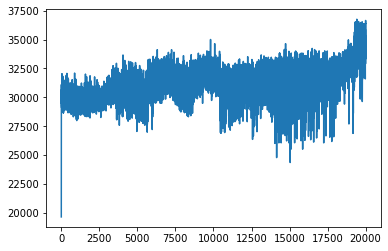

In [145]:
plt.plot(TrainingPortfolio)

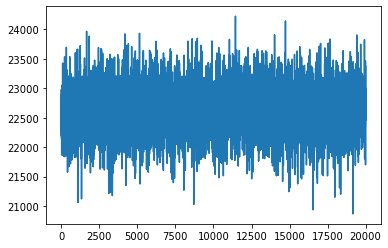

In [146]:
plt.plot(TestPortfolio)

In [147]:
np.mean(TestPortfolio)

22669.345954750454

In [148]:
np.mean(RandomPortfolio)

23466.127843749757

### 20000 Episode & epsilon = 0.1

In [149]:
env.reset()

array([    0.   ,     0.   ,     0.   ,     0.   ,     0.   ,     0.   ,
         119.72 ,    63.99 ,    56.27 ,   116.082,    63.248,    57.682,
       20000.   ])

In [150]:
gamma = 0.95  # discount rate
epsilon = 0.1  # exploration rate
num_episodes = 20000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data[:n_train].values
test_data = data[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_trend5_20000_episode_eps01.npz", W=W, b=b)

episode: 1/20000, episode end value: 22421.14
episode: 2/20000, episode end value: 24211.30
episode: 3/20000, episode end value: 26677.76
episode: 4/20000, episode end value: 29462.00
episode: 5/20000, episode end value: 26796.42
episode: 6/20000, episode end value: 24296.23
episode: 7/20000, episode end value: 32813.06
episode: 8/20000, episode end value: 30436.72
episode: 9/20000, episode end value: 29880.92
episode: 10/20000, episode end value: 28846.52
episode: 11/20000, episode end value: 28560.56
episode: 12/20000, episode end value: 30215.07
episode: 13/20000, episode end value: 29674.93
episode: 14/20000, episode end value: 30019.85
episode: 15/20000, episode end value: 29088.65
episode: 16/20000, episode end value: 29413.31
episode: 17/20000, episode end value: 26333.79
episode: 18/20000, episode end value: 29017.59
episode: 19/20000, episode end value: 26579.23
episode: 20/20000, episode end value: 29279.01
episode: 21/20000, episode end value: 26408.24
episode: 22/20000, epi

episode: 174/20000, episode end value: 31347.95
episode: 175/20000, episode end value: 29234.80
episode: 176/20000, episode end value: 29579.62
episode: 177/20000, episode end value: 31584.62
episode: 178/20000, episode end value: 28884.46
episode: 179/20000, episode end value: 29269.95
episode: 180/20000, episode end value: 31603.30
episode: 181/20000, episode end value: 29498.85
episode: 182/20000, episode end value: 29490.61
episode: 183/20000, episode end value: 32350.88
episode: 184/20000, episode end value: 30474.16
episode: 185/20000, episode end value: 29674.15
episode: 186/20000, episode end value: 29577.36
episode: 187/20000, episode end value: 30551.12
episode: 188/20000, episode end value: 29765.51
episode: 189/20000, episode end value: 31149.17
episode: 190/20000, episode end value: 31616.89
episode: 191/20000, episode end value: 29746.19
episode: 192/20000, episode end value: 30512.48
episode: 193/20000, episode end value: 29969.25
episode: 194/20000, episode end value: 3

episode: 345/20000, episode end value: 30930.56
episode: 346/20000, episode end value: 29040.51
episode: 347/20000, episode end value: 28907.88
episode: 348/20000, episode end value: 31167.63
episode: 349/20000, episode end value: 28737.67
episode: 350/20000, episode end value: 29750.85
episode: 351/20000, episode end value: 30602.63
episode: 352/20000, episode end value: 28286.29
episode: 353/20000, episode end value: 28932.47
episode: 354/20000, episode end value: 29655.69
episode: 355/20000, episode end value: 30727.66
episode: 356/20000, episode end value: 32028.38
episode: 357/20000, episode end value: 30489.50
episode: 358/20000, episode end value: 30391.64
episode: 359/20000, episode end value: 31332.57
episode: 360/20000, episode end value: 29097.58
episode: 361/20000, episode end value: 30545.46
episode: 362/20000, episode end value: 27591.43
episode: 363/20000, episode end value: 31859.28
episode: 364/20000, episode end value: 30750.44
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 31102.43
episode: 517/20000, episode end value: 30338.62
episode: 518/20000, episode end value: 28909.06
episode: 519/20000, episode end value: 27991.60
episode: 520/20000, episode end value: 29951.47
episode: 521/20000, episode end value: 32078.12
episode: 522/20000, episode end value: 29508.51
episode: 523/20000, episode end value: 29896.99
episode: 524/20000, episode end value: 30083.17
episode: 525/20000, episode end value: 29814.97
episode: 526/20000, episode end value: 27555.23
episode: 527/20000, episode end value: 31251.11
episode: 528/20000, episode end value: 29246.84
episode: 529/20000, episode end value: 29973.47
episode: 530/20000, episode end value: 26499.40
episode: 531/20000, episode end value: 28225.94
episode: 532/20000, episode end value: 29195.47
episode: 533/20000, episode end value: 27686.03
episode: 534/20000, episode end value: 31069.78
episode: 535/20000, episode end value: 27228.53
episode: 536/20000, episode end value: 3

episode: 687/20000, episode end value: 28711.20
episode: 688/20000, episode end value: 29442.68
episode: 689/20000, episode end value: 29273.92
episode: 690/20000, episode end value: 29953.35
episode: 691/20000, episode end value: 28769.26
episode: 692/20000, episode end value: 30806.32
episode: 693/20000, episode end value: 27852.64
episode: 694/20000, episode end value: 30067.73
episode: 695/20000, episode end value: 29173.21
episode: 696/20000, episode end value: 31306.34
episode: 697/20000, episode end value: 31476.03
episode: 698/20000, episode end value: 30411.63
episode: 699/20000, episode end value: 29332.17
episode: 700/20000, episode end value: 31262.92
episode: 701/20000, episode end value: 26501.23
episode: 702/20000, episode end value: 29652.02
episode: 703/20000, episode end value: 29304.04
episode: 704/20000, episode end value: 29399.06
episode: 705/20000, episode end value: 29765.70
episode: 706/20000, episode end value: 30064.22
episode: 707/20000, episode end value: 3

episode: 858/20000, episode end value: 27751.67
episode: 859/20000, episode end value: 28751.52
episode: 860/20000, episode end value: 28801.47
episode: 861/20000, episode end value: 28302.30
episode: 862/20000, episode end value: 30891.54
episode: 863/20000, episode end value: 28340.45
episode: 864/20000, episode end value: 28310.89
episode: 865/20000, episode end value: 29464.29
episode: 866/20000, episode end value: 30337.78
episode: 867/20000, episode end value: 28435.27
episode: 868/20000, episode end value: 28225.92
episode: 869/20000, episode end value: 29477.43
episode: 870/20000, episode end value: 28774.84
episode: 871/20000, episode end value: 30228.77
episode: 872/20000, episode end value: 30358.91
episode: 873/20000, episode end value: 28417.97
episode: 874/20000, episode end value: 29270.79
episode: 875/20000, episode end value: 29218.28
episode: 876/20000, episode end value: 27710.54
episode: 877/20000, episode end value: 28611.66
episode: 878/20000, episode end value: 2

episode: 1029/20000, episode end value: 29098.51
episode: 1030/20000, episode end value: 30668.62
episode: 1031/20000, episode end value: 29982.91
episode: 1032/20000, episode end value: 31550.28
episode: 1033/20000, episode end value: 30155.03
episode: 1034/20000, episode end value: 31523.63
episode: 1035/20000, episode end value: 29384.16
episode: 1036/20000, episode end value: 30302.57
episode: 1037/20000, episode end value: 28591.83
episode: 1038/20000, episode end value: 30201.86
episode: 1039/20000, episode end value: 27821.39
episode: 1040/20000, episode end value: 30238.60
episode: 1041/20000, episode end value: 29399.66
episode: 1042/20000, episode end value: 28909.23
episode: 1043/20000, episode end value: 32302.69
episode: 1044/20000, episode end value: 29478.78
episode: 1045/20000, episode end value: 28865.55
episode: 1046/20000, episode end value: 30719.58
episode: 1047/20000, episode end value: 29642.01
episode: 1048/20000, episode end value: 29074.04
episode: 1049/20000,

episode: 1197/20000, episode end value: 32907.24
episode: 1198/20000, episode end value: 29982.56
episode: 1199/20000, episode end value: 29597.46
episode: 1200/20000, episode end value: 29794.20
episode: 1201/20000, episode end value: 28420.84
episode: 1202/20000, episode end value: 31538.15
episode: 1203/20000, episode end value: 29291.33
episode: 1204/20000, episode end value: 31280.07
episode: 1205/20000, episode end value: 30260.79
episode: 1206/20000, episode end value: 30060.89
episode: 1207/20000, episode end value: 31804.49
episode: 1208/20000, episode end value: 29244.42
episode: 1209/20000, episode end value: 26575.31
episode: 1210/20000, episode end value: 29732.83
episode: 1211/20000, episode end value: 29239.29
episode: 1212/20000, episode end value: 30312.14
episode: 1213/20000, episode end value: 29279.30
episode: 1214/20000, episode end value: 30127.19
episode: 1215/20000, episode end value: 30008.66
episode: 1216/20000, episode end value: 28711.24
episode: 1217/20000,

episode: 1365/20000, episode end value: 29288.58
episode: 1366/20000, episode end value: 30198.01
episode: 1367/20000, episode end value: 29701.57
episode: 1368/20000, episode end value: 29975.08
episode: 1369/20000, episode end value: 29419.76
episode: 1370/20000, episode end value: 29815.65
episode: 1371/20000, episode end value: 30382.25
episode: 1372/20000, episode end value: 31048.26
episode: 1373/20000, episode end value: 29363.75
episode: 1374/20000, episode end value: 30758.49
episode: 1375/20000, episode end value: 29154.40
episode: 1376/20000, episode end value: 29284.74
episode: 1377/20000, episode end value: 30142.83
episode: 1378/20000, episode end value: 30568.80
episode: 1379/20000, episode end value: 31398.54
episode: 1380/20000, episode end value: 30256.39
episode: 1381/20000, episode end value: 29262.28
episode: 1382/20000, episode end value: 31668.53
episode: 1383/20000, episode end value: 29360.36
episode: 1384/20000, episode end value: 28296.03
episode: 1385/20000,

episode: 1533/20000, episode end value: 28161.01
episode: 1534/20000, episode end value: 29165.22
episode: 1535/20000, episode end value: 25892.37
episode: 1536/20000, episode end value: 30681.31
episode: 1537/20000, episode end value: 29732.59
episode: 1538/20000, episode end value: 29603.71
episode: 1539/20000, episode end value: 33561.49
episode: 1540/20000, episode end value: 30581.64
episode: 1541/20000, episode end value: 30762.06
episode: 1542/20000, episode end value: 30155.93
episode: 1543/20000, episode end value: 29377.30
episode: 1544/20000, episode end value: 29428.10
episode: 1545/20000, episode end value: 30813.71
episode: 1546/20000, episode end value: 31898.67
episode: 1547/20000, episode end value: 30231.78
episode: 1548/20000, episode end value: 29560.66
episode: 1549/20000, episode end value: 31307.31
episode: 1550/20000, episode end value: 28875.79
episode: 1551/20000, episode end value: 32275.35
episode: 1552/20000, episode end value: 31291.96
episode: 1553/20000,

episode: 1701/20000, episode end value: 27995.70
episode: 1702/20000, episode end value: 28438.21
episode: 1703/20000, episode end value: 29645.80
episode: 1704/20000, episode end value: 28126.98
episode: 1705/20000, episode end value: 30672.52
episode: 1706/20000, episode end value: 27650.19
episode: 1707/20000, episode end value: 29161.48
episode: 1708/20000, episode end value: 30432.22
episode: 1709/20000, episode end value: 30155.47
episode: 1710/20000, episode end value: 28931.30
episode: 1711/20000, episode end value: 30563.69
episode: 1712/20000, episode end value: 28907.67
episode: 1713/20000, episode end value: 27316.92
episode: 1714/20000, episode end value: 31113.93
episode: 1715/20000, episode end value: 29050.59
episode: 1716/20000, episode end value: 29735.93
episode: 1717/20000, episode end value: 29794.03
episode: 1718/20000, episode end value: 29268.07
episode: 1719/20000, episode end value: 28961.94
episode: 1720/20000, episode end value: 28738.59
episode: 1721/20000,

episode: 1869/20000, episode end value: 29976.41
episode: 1870/20000, episode end value: 30812.12
episode: 1871/20000, episode end value: 30074.14
episode: 1872/20000, episode end value: 30506.54
episode: 1873/20000, episode end value: 30270.58
episode: 1874/20000, episode end value: 27683.93
episode: 1875/20000, episode end value: 31761.68
episode: 1876/20000, episode end value: 29873.22
episode: 1877/20000, episode end value: 29648.15
episode: 1878/20000, episode end value: 29263.47
episode: 1879/20000, episode end value: 29597.87
episode: 1880/20000, episode end value: 29707.56
episode: 1881/20000, episode end value: 27830.01
episode: 1882/20000, episode end value: 29405.47
episode: 1883/20000, episode end value: 29058.11
episode: 1884/20000, episode end value: 29415.54
episode: 1885/20000, episode end value: 31223.40
episode: 1886/20000, episode end value: 29767.61
episode: 1887/20000, episode end value: 27828.45
episode: 1888/20000, episode end value: 32116.46
episode: 1889/20000,

episode: 2037/20000, episode end value: 30844.00
episode: 2038/20000, episode end value: 30010.17
episode: 2039/20000, episode end value: 30484.34
episode: 2040/20000, episode end value: 30433.33
episode: 2041/20000, episode end value: 31140.17
episode: 2042/20000, episode end value: 30346.62
episode: 2043/20000, episode end value: 30008.53
episode: 2044/20000, episode end value: 28669.59
episode: 2045/20000, episode end value: 29997.53
episode: 2046/20000, episode end value: 30010.42
episode: 2047/20000, episode end value: 30578.70
episode: 2048/20000, episode end value: 33888.31
episode: 2049/20000, episode end value: 29467.30
episode: 2050/20000, episode end value: 30523.87
episode: 2051/20000, episode end value: 30235.60
episode: 2052/20000, episode end value: 30773.26
episode: 2053/20000, episode end value: 29542.50
episode: 2054/20000, episode end value: 32178.33
episode: 2055/20000, episode end value: 29468.58
episode: 2056/20000, episode end value: 30831.82
episode: 2057/20000,

episode: 2205/20000, episode end value: 32383.10
episode: 2206/20000, episode end value: 30769.40
episode: 2207/20000, episode end value: 30681.08
episode: 2208/20000, episode end value: 30527.56
episode: 2209/20000, episode end value: 29730.50
episode: 2210/20000, episode end value: 28919.06
episode: 2211/20000, episode end value: 30515.92
episode: 2212/20000, episode end value: 29024.21
episode: 2213/20000, episode end value: 31542.94
episode: 2214/20000, episode end value: 30834.73
episode: 2215/20000, episode end value: 31610.94
episode: 2216/20000, episode end value: 31049.47
episode: 2217/20000, episode end value: 27914.23
episode: 2218/20000, episode end value: 28276.72
episode: 2219/20000, episode end value: 30274.59
episode: 2220/20000, episode end value: 31945.17
episode: 2221/20000, episode end value: 30057.20
episode: 2222/20000, episode end value: 29598.16
episode: 2223/20000, episode end value: 31342.55
episode: 2224/20000, episode end value: 31234.24
episode: 2225/20000,

episode: 2373/20000, episode end value: 32018.22
episode: 2374/20000, episode end value: 27663.11
episode: 2375/20000, episode end value: 31178.56
episode: 2376/20000, episode end value: 29694.60
episode: 2377/20000, episode end value: 30737.77
episode: 2378/20000, episode end value: 30139.22
episode: 2379/20000, episode end value: 28359.00
episode: 2380/20000, episode end value: 28402.99
episode: 2381/20000, episode end value: 30681.06
episode: 2382/20000, episode end value: 29610.10
episode: 2383/20000, episode end value: 31536.49
episode: 2384/20000, episode end value: 30683.71
episode: 2385/20000, episode end value: 28035.39
episode: 2386/20000, episode end value: 31953.04
episode: 2387/20000, episode end value: 27721.50
episode: 2388/20000, episode end value: 30503.75
episode: 2389/20000, episode end value: 31730.93
episode: 2390/20000, episode end value: 27572.75
episode: 2391/20000, episode end value: 29055.75
episode: 2392/20000, episode end value: 29476.72
episode: 2393/20000,

episode: 2541/20000, episode end value: 30991.10
episode: 2542/20000, episode end value: 29574.52
episode: 2543/20000, episode end value: 28510.52
episode: 2544/20000, episode end value: 28915.87
episode: 2545/20000, episode end value: 29327.96
episode: 2546/20000, episode end value: 30224.27
episode: 2547/20000, episode end value: 30876.28
episode: 2548/20000, episode end value: 30227.71
episode: 2549/20000, episode end value: 30663.40
episode: 2550/20000, episode end value: 26775.40
episode: 2551/20000, episode end value: 27706.89
episode: 2552/20000, episode end value: 32073.37
episode: 2553/20000, episode end value: 31106.60
episode: 2554/20000, episode end value: 30228.18
episode: 2555/20000, episode end value: 31729.14
episode: 2556/20000, episode end value: 31353.34
episode: 2557/20000, episode end value: 30388.82
episode: 2558/20000, episode end value: 31215.31
episode: 2559/20000, episode end value: 29691.75
episode: 2560/20000, episode end value: 28143.26
episode: 2561/20000,

episode: 2709/20000, episode end value: 31606.27
episode: 2710/20000, episode end value: 29406.18
episode: 2711/20000, episode end value: 29915.47
episode: 2712/20000, episode end value: 28931.44
episode: 2713/20000, episode end value: 30711.80
episode: 2714/20000, episode end value: 29352.70
episode: 2715/20000, episode end value: 30818.11
episode: 2716/20000, episode end value: 29315.80
episode: 2717/20000, episode end value: 25364.81
episode: 2718/20000, episode end value: 26927.88
episode: 2719/20000, episode end value: 25160.14
episode: 2720/20000, episode end value: 29330.54
episode: 2721/20000, episode end value: 29342.36
episode: 2722/20000, episode end value: 30504.94
episode: 2723/20000, episode end value: 27234.21
episode: 2724/20000, episode end value: 29044.74
episode: 2725/20000, episode end value: 29727.01
episode: 2726/20000, episode end value: 32347.42
episode: 2727/20000, episode end value: 28238.33
episode: 2728/20000, episode end value: 28114.40
episode: 2729/20000,

episode: 2877/20000, episode end value: 31446.28
episode: 2878/20000, episode end value: 31279.42
episode: 2879/20000, episode end value: 32357.95
episode: 2880/20000, episode end value: 31689.93
episode: 2881/20000, episode end value: 28201.66
episode: 2882/20000, episode end value: 30674.82
episode: 2883/20000, episode end value: 30078.46
episode: 2884/20000, episode end value: 28580.45
episode: 2885/20000, episode end value: 30752.04
episode: 2886/20000, episode end value: 29075.18
episode: 2887/20000, episode end value: 30632.12
episode: 2888/20000, episode end value: 30594.00
episode: 2889/20000, episode end value: 28820.50
episode: 2890/20000, episode end value: 28287.29
episode: 2891/20000, episode end value: 31365.73
episode: 2892/20000, episode end value: 24646.92
episode: 2893/20000, episode end value: 30295.46
episode: 2894/20000, episode end value: 30552.91
episode: 2895/20000, episode end value: 26929.89
episode: 2896/20000, episode end value: 28363.83
episode: 2897/20000,

episode: 3045/20000, episode end value: 31408.44
episode: 3046/20000, episode end value: 29578.77
episode: 3047/20000, episode end value: 27852.05
episode: 3048/20000, episode end value: 30685.77
episode: 3049/20000, episode end value: 28181.04
episode: 3050/20000, episode end value: 31727.04
episode: 3051/20000, episode end value: 30723.59
episode: 3052/20000, episode end value: 28871.37
episode: 3053/20000, episode end value: 25956.18
episode: 3054/20000, episode end value: 27642.16
episode: 3055/20000, episode end value: 30147.78
episode: 3056/20000, episode end value: 29320.19
episode: 3057/20000, episode end value: 28846.55
episode: 3058/20000, episode end value: 25828.75
episode: 3059/20000, episode end value: 29416.20
episode: 3060/20000, episode end value: 29023.47
episode: 3061/20000, episode end value: 29047.97
episode: 3062/20000, episode end value: 31927.56
episode: 3063/20000, episode end value: 32591.83
episode: 3064/20000, episode end value: 29126.02
episode: 3065/20000,

episode: 3213/20000, episode end value: 32181.94
episode: 3214/20000, episode end value: 27841.84
episode: 3215/20000, episode end value: 31530.91
episode: 3216/20000, episode end value: 26999.17
episode: 3217/20000, episode end value: 29826.16
episode: 3218/20000, episode end value: 30061.05
episode: 3219/20000, episode end value: 29288.35
episode: 3220/20000, episode end value: 27504.01
episode: 3221/20000, episode end value: 29836.73
episode: 3222/20000, episode end value: 28547.56
episode: 3223/20000, episode end value: 29343.70
episode: 3224/20000, episode end value: 29959.52
episode: 3225/20000, episode end value: 28846.50
episode: 3226/20000, episode end value: 27831.51
episode: 3227/20000, episode end value: 30103.99
episode: 3228/20000, episode end value: 29144.01
episode: 3229/20000, episode end value: 27635.94
episode: 3230/20000, episode end value: 31185.27
episode: 3231/20000, episode end value: 31820.34
episode: 3232/20000, episode end value: 27437.32
episode: 3233/20000,

episode: 3381/20000, episode end value: 29896.40
episode: 3382/20000, episode end value: 32812.37
episode: 3383/20000, episode end value: 29923.80
episode: 3384/20000, episode end value: 25634.03
episode: 3385/20000, episode end value: 30113.63
episode: 3386/20000, episode end value: 29610.75
episode: 3387/20000, episode end value: 28379.77
episode: 3388/20000, episode end value: 32084.84
episode: 3389/20000, episode end value: 29370.78
episode: 3390/20000, episode end value: 28010.19
episode: 3391/20000, episode end value: 26656.79
episode: 3392/20000, episode end value: 32533.51
episode: 3393/20000, episode end value: 28920.52
episode: 3394/20000, episode end value: 31435.09
episode: 3395/20000, episode end value: 28045.85
episode: 3396/20000, episode end value: 30207.28
episode: 3397/20000, episode end value: 28571.88
episode: 3398/20000, episode end value: 29494.65
episode: 3399/20000, episode end value: 29188.90
episode: 3400/20000, episode end value: 30254.34
episode: 3401/20000,

episode: 3549/20000, episode end value: 28900.85
episode: 3550/20000, episode end value: 30537.11
episode: 3551/20000, episode end value: 29842.27
episode: 3552/20000, episode end value: 28847.81
episode: 3553/20000, episode end value: 28176.23
episode: 3554/20000, episode end value: 30328.93
episode: 3555/20000, episode end value: 28562.64
episode: 3556/20000, episode end value: 29561.03
episode: 3557/20000, episode end value: 30669.88
episode: 3558/20000, episode end value: 29096.67
episode: 3559/20000, episode end value: 29648.55
episode: 3560/20000, episode end value: 29363.90
episode: 3561/20000, episode end value: 29731.42
episode: 3562/20000, episode end value: 27692.15
episode: 3563/20000, episode end value: 28448.92
episode: 3564/20000, episode end value: 29606.87
episode: 3565/20000, episode end value: 31467.25
episode: 3566/20000, episode end value: 31930.43
episode: 3567/20000, episode end value: 30944.40
episode: 3568/20000, episode end value: 30797.81
episode: 3569/20000,

episode: 3717/20000, episode end value: 31251.03
episode: 3718/20000, episode end value: 28817.04
episode: 3719/20000, episode end value: 29534.48
episode: 3720/20000, episode end value: 29986.67
episode: 3721/20000, episode end value: 26813.20
episode: 3722/20000, episode end value: 26137.60
episode: 3723/20000, episode end value: 29542.14
episode: 3724/20000, episode end value: 29022.52
episode: 3725/20000, episode end value: 27169.41
episode: 3726/20000, episode end value: 30764.84
episode: 3727/20000, episode end value: 28546.04
episode: 3728/20000, episode end value: 26882.37
episode: 3729/20000, episode end value: 30723.39
episode: 3730/20000, episode end value: 29441.34
episode: 3731/20000, episode end value: 26137.60
episode: 3732/20000, episode end value: 31473.16
episode: 3733/20000, episode end value: 29717.69
episode: 3734/20000, episode end value: 31178.15
episode: 3735/20000, episode end value: 28295.36
episode: 3736/20000, episode end value: 32220.28
episode: 3737/20000,

episode: 3885/20000, episode end value: 31331.99
episode: 3886/20000, episode end value: 28263.75
episode: 3887/20000, episode end value: 31926.14
episode: 3888/20000, episode end value: 28643.85
episode: 3889/20000, episode end value: 29663.80
episode: 3890/20000, episode end value: 28460.81
episode: 3891/20000, episode end value: 33757.15
episode: 3892/20000, episode end value: 31577.55
episode: 3893/20000, episode end value: 30477.21
episode: 3894/20000, episode end value: 29428.42
episode: 3895/20000, episode end value: 26100.92
episode: 3896/20000, episode end value: 33208.55
episode: 3897/20000, episode end value: 31914.71
episode: 3898/20000, episode end value: 27327.85
episode: 3899/20000, episode end value: 27621.32
episode: 3900/20000, episode end value: 29481.90
episode: 3901/20000, episode end value: 32588.92
episode: 3902/20000, episode end value: 28748.26
episode: 3903/20000, episode end value: 29557.78
episode: 3904/20000, episode end value: 28913.45
episode: 3905/20000,

episode: 4053/20000, episode end value: 32003.05
episode: 4054/20000, episode end value: 29449.04
episode: 4055/20000, episode end value: 27716.77
episode: 4056/20000, episode end value: 30020.67
episode: 4057/20000, episode end value: 27155.37
episode: 4058/20000, episode end value: 29343.64
episode: 4059/20000, episode end value: 30250.69
episode: 4060/20000, episode end value: 27786.87
episode: 4061/20000, episode end value: 30376.25
episode: 4062/20000, episode end value: 30630.53
episode: 4063/20000, episode end value: 29321.76
episode: 4064/20000, episode end value: 28734.89
episode: 4065/20000, episode end value: 28107.95
episode: 4066/20000, episode end value: 29481.68
episode: 4067/20000, episode end value: 29638.01
episode: 4068/20000, episode end value: 28365.53
episode: 4069/20000, episode end value: 28263.93
episode: 4070/20000, episode end value: 29076.38
episode: 4071/20000, episode end value: 29161.74
episode: 4072/20000, episode end value: 29748.14
episode: 4073/20000,

episode: 4221/20000, episode end value: 30112.93
episode: 4222/20000, episode end value: 30469.61
episode: 4223/20000, episode end value: 30262.23
episode: 4224/20000, episode end value: 30694.08
episode: 4225/20000, episode end value: 29782.98
episode: 4226/20000, episode end value: 29137.83
episode: 4227/20000, episode end value: 32396.75
episode: 4228/20000, episode end value: 29236.51
episode: 4229/20000, episode end value: 31578.01
episode: 4230/20000, episode end value: 26045.36
episode: 4231/20000, episode end value: 30172.01
episode: 4232/20000, episode end value: 30960.78
episode: 4233/20000, episode end value: 31876.99
episode: 4234/20000, episode end value: 29459.20
episode: 4235/20000, episode end value: 30276.46
episode: 4236/20000, episode end value: 30997.47
episode: 4237/20000, episode end value: 29253.90
episode: 4238/20000, episode end value: 26093.63
episode: 4239/20000, episode end value: 29511.07
episode: 4240/20000, episode end value: 27641.29
episode: 4241/20000,

episode: 4389/20000, episode end value: 29756.45
episode: 4390/20000, episode end value: 28787.85
episode: 4391/20000, episode end value: 29723.59
episode: 4392/20000, episode end value: 28971.26
episode: 4393/20000, episode end value: 29050.94
episode: 4394/20000, episode end value: 28533.61
episode: 4395/20000, episode end value: 32197.10
episode: 4396/20000, episode end value: 29036.55
episode: 4397/20000, episode end value: 31272.84
episode: 4398/20000, episode end value: 30198.43
episode: 4399/20000, episode end value: 26018.17
episode: 4400/20000, episode end value: 32878.05
episode: 4401/20000, episode end value: 29268.97
episode: 4402/20000, episode end value: 28427.67
episode: 4403/20000, episode end value: 28777.91
episode: 4404/20000, episode end value: 28508.72
episode: 4405/20000, episode end value: 28096.23
episode: 4406/20000, episode end value: 27061.81
episode: 4407/20000, episode end value: 29272.21
episode: 4408/20000, episode end value: 26672.82
episode: 4409/20000,

episode: 4557/20000, episode end value: 29442.73
episode: 4558/20000, episode end value: 30516.04
episode: 4559/20000, episode end value: 31004.75
episode: 4560/20000, episode end value: 24635.18
episode: 4561/20000, episode end value: 30053.92
episode: 4562/20000, episode end value: 29264.72
episode: 4563/20000, episode end value: 28669.64
episode: 4564/20000, episode end value: 30659.26
episode: 4565/20000, episode end value: 26176.68
episode: 4566/20000, episode end value: 28617.73
episode: 4567/20000, episode end value: 26885.99
episode: 4568/20000, episode end value: 28219.68
episode: 4569/20000, episode end value: 26790.12
episode: 4570/20000, episode end value: 31061.21
episode: 4571/20000, episode end value: 28502.41
episode: 4572/20000, episode end value: 31035.40
episode: 4573/20000, episode end value: 29390.56
episode: 4574/20000, episode end value: 29673.68
episode: 4575/20000, episode end value: 28923.13
episode: 4576/20000, episode end value: 29864.75
episode: 4577/20000,

episode: 4725/20000, episode end value: 30331.85
episode: 4726/20000, episode end value: 30205.62
episode: 4727/20000, episode end value: 27745.05
episode: 4728/20000, episode end value: 27181.50
episode: 4729/20000, episode end value: 28923.37
episode: 4730/20000, episode end value: 28136.44
episode: 4731/20000, episode end value: 27921.98
episode: 4732/20000, episode end value: 28380.84
episode: 4733/20000, episode end value: 27517.57
episode: 4734/20000, episode end value: 28791.80
episode: 4735/20000, episode end value: 31615.25
episode: 4736/20000, episode end value: 34237.11
episode: 4737/20000, episode end value: 28590.66
episode: 4738/20000, episode end value: 26799.12
episode: 4739/20000, episode end value: 30233.93
episode: 4740/20000, episode end value: 33023.50
episode: 4741/20000, episode end value: 28822.85
episode: 4742/20000, episode end value: 27107.53
episode: 4743/20000, episode end value: 29304.80
episode: 4744/20000, episode end value: 28171.60
episode: 4745/20000,

episode: 4893/20000, episode end value: 27769.95
episode: 4894/20000, episode end value: 30122.12
episode: 4895/20000, episode end value: 29203.37
episode: 4896/20000, episode end value: 30205.28
episode: 4897/20000, episode end value: 29130.54
episode: 4898/20000, episode end value: 26656.47
episode: 4899/20000, episode end value: 26562.78
episode: 4900/20000, episode end value: 27593.68
episode: 4901/20000, episode end value: 27302.62
episode: 4902/20000, episode end value: 31348.93
episode: 4903/20000, episode end value: 31099.49
episode: 4904/20000, episode end value: 30970.83
episode: 4905/20000, episode end value: 29849.58
episode: 4906/20000, episode end value: 29147.25
episode: 4907/20000, episode end value: 29936.25
episode: 4908/20000, episode end value: 29304.39
episode: 4909/20000, episode end value: 32693.98
episode: 4910/20000, episode end value: 28834.51
episode: 4911/20000, episode end value: 29915.16
episode: 4912/20000, episode end value: 30754.82
episode: 4913/20000,

episode: 5061/20000, episode end value: 30300.68
episode: 5062/20000, episode end value: 29409.88
episode: 5063/20000, episode end value: 27401.54
episode: 5064/20000, episode end value: 27503.88
episode: 5065/20000, episode end value: 28505.49
episode: 5066/20000, episode end value: 32432.55
episode: 5067/20000, episode end value: 27670.61
episode: 5068/20000, episode end value: 31627.12
episode: 5069/20000, episode end value: 30852.96
episode: 5070/20000, episode end value: 30601.80
episode: 5071/20000, episode end value: 26093.95
episode: 5072/20000, episode end value: 29794.02
episode: 5073/20000, episode end value: 28687.90
episode: 5074/20000, episode end value: 29954.53
episode: 5075/20000, episode end value: 30984.66
episode: 5076/20000, episode end value: 28806.17
episode: 5077/20000, episode end value: 29938.57
episode: 5078/20000, episode end value: 29149.48
episode: 5079/20000, episode end value: 31634.38
episode: 5080/20000, episode end value: 28365.58
episode: 5081/20000,

episode: 5229/20000, episode end value: 28999.06
episode: 5230/20000, episode end value: 28372.94
episode: 5231/20000, episode end value: 31625.96
episode: 5232/20000, episode end value: 28161.09
episode: 5233/20000, episode end value: 31597.05
episode: 5234/20000, episode end value: 30008.87
episode: 5235/20000, episode end value: 28904.63
episode: 5236/20000, episode end value: 28658.12
episode: 5237/20000, episode end value: 26604.56
episode: 5238/20000, episode end value: 26991.28
episode: 5239/20000, episode end value: 30475.00
episode: 5240/20000, episode end value: 28407.18
episode: 5241/20000, episode end value: 28790.71
episode: 5242/20000, episode end value: 28593.19
episode: 5243/20000, episode end value: 29114.41
episode: 5244/20000, episode end value: 29706.49
episode: 5245/20000, episode end value: 28322.02
episode: 5246/20000, episode end value: 27940.28
episode: 5247/20000, episode end value: 30592.02
episode: 5248/20000, episode end value: 29861.24
episode: 5249/20000,

episode: 5397/20000, episode end value: 30567.45
episode: 5398/20000, episode end value: 28784.83
episode: 5399/20000, episode end value: 30307.77
episode: 5400/20000, episode end value: 30725.55
episode: 5401/20000, episode end value: 27816.24
episode: 5402/20000, episode end value: 30089.03
episode: 5403/20000, episode end value: 26984.28
episode: 5404/20000, episode end value: 30130.35
episode: 5405/20000, episode end value: 28576.56
episode: 5406/20000, episode end value: 29295.58
episode: 5407/20000, episode end value: 27744.65
episode: 5408/20000, episode end value: 28265.84
episode: 5409/20000, episode end value: 28210.38
episode: 5410/20000, episode end value: 25693.23
episode: 5411/20000, episode end value: 29231.31
episode: 5412/20000, episode end value: 28015.75
episode: 5413/20000, episode end value: 28437.98
episode: 5414/20000, episode end value: 27498.41
episode: 5415/20000, episode end value: 27367.83
episode: 5416/20000, episode end value: 28272.05
episode: 5417/20000,

episode: 5565/20000, episode end value: 28680.62
episode: 5566/20000, episode end value: 28328.75
episode: 5567/20000, episode end value: 27652.52
episode: 5568/20000, episode end value: 33489.15
episode: 5569/20000, episode end value: 33500.22
episode: 5570/20000, episode end value: 28024.13
episode: 5571/20000, episode end value: 32317.39
episode: 5572/20000, episode end value: 31093.42
episode: 5573/20000, episode end value: 27790.30
episode: 5574/20000, episode end value: 31882.57
episode: 5575/20000, episode end value: 29723.73
episode: 5576/20000, episode end value: 29027.36
episode: 5577/20000, episode end value: 29821.13
episode: 5578/20000, episode end value: 28840.42
episode: 5579/20000, episode end value: 30056.20
episode: 5580/20000, episode end value: 28749.78
episode: 5581/20000, episode end value: 29661.60
episode: 5582/20000, episode end value: 28000.60
episode: 5583/20000, episode end value: 29336.64
episode: 5584/20000, episode end value: 28871.56
episode: 5585/20000,

episode: 5733/20000, episode end value: 30276.00
episode: 5734/20000, episode end value: 27981.51
episode: 5735/20000, episode end value: 29266.33
episode: 5736/20000, episode end value: 28387.50
episode: 5737/20000, episode end value: 28300.37
episode: 5738/20000, episode end value: 29307.72
episode: 5739/20000, episode end value: 26214.35
episode: 5740/20000, episode end value: 28741.15
episode: 5741/20000, episode end value: 28549.54
episode: 5742/20000, episode end value: 29323.90
episode: 5743/20000, episode end value: 27695.18
episode: 5744/20000, episode end value: 31169.95
episode: 5745/20000, episode end value: 32221.71
episode: 5746/20000, episode end value: 25605.09
episode: 5747/20000, episode end value: 26879.54
episode: 5748/20000, episode end value: 28273.14
episode: 5749/20000, episode end value: 30435.05
episode: 5750/20000, episode end value: 30684.77
episode: 5751/20000, episode end value: 30082.50
episode: 5752/20000, episode end value: 26605.03
episode: 5753/20000,

episode: 5901/20000, episode end value: 31272.12
episode: 5902/20000, episode end value: 31311.36
episode: 5903/20000, episode end value: 28265.04
episode: 5904/20000, episode end value: 30349.88
episode: 5905/20000, episode end value: 29820.11
episode: 5906/20000, episode end value: 30655.28
episode: 5907/20000, episode end value: 27962.64
episode: 5908/20000, episode end value: 28192.60
episode: 5909/20000, episode end value: 28670.99
episode: 5910/20000, episode end value: 31159.13
episode: 5911/20000, episode end value: 27364.92
episode: 5912/20000, episode end value: 31530.66
episode: 5913/20000, episode end value: 33074.07
episode: 5914/20000, episode end value: 26880.00
episode: 5915/20000, episode end value: 30113.57
episode: 5916/20000, episode end value: 32182.63
episode: 5917/20000, episode end value: 27415.82
episode: 5918/20000, episode end value: 31651.36
episode: 5919/20000, episode end value: 31219.22
episode: 5920/20000, episode end value: 30742.57
episode: 5921/20000,

episode: 6069/20000, episode end value: 26902.46
episode: 6070/20000, episode end value: 31219.21
episode: 6071/20000, episode end value: 29568.45
episode: 6072/20000, episode end value: 29980.67
episode: 6073/20000, episode end value: 29070.63
episode: 6074/20000, episode end value: 31304.31
episode: 6075/20000, episode end value: 30160.96
episode: 6076/20000, episode end value: 32719.32
episode: 6077/20000, episode end value: 31888.30
episode: 6078/20000, episode end value: 33204.71
episode: 6079/20000, episode end value: 34569.57
episode: 6080/20000, episode end value: 28774.48
episode: 6081/20000, episode end value: 30224.07
episode: 6082/20000, episode end value: 27372.64
episode: 6083/20000, episode end value: 31791.47
episode: 6084/20000, episode end value: 28463.89
episode: 6085/20000, episode end value: 28270.64
episode: 6086/20000, episode end value: 29036.31
episode: 6087/20000, episode end value: 30663.41
episode: 6088/20000, episode end value: 31121.73
episode: 6089/20000,

episode: 6237/20000, episode end value: 31688.42
episode: 6238/20000, episode end value: 31116.63
episode: 6239/20000, episode end value: 33601.18
episode: 6240/20000, episode end value: 29946.19
episode: 6241/20000, episode end value: 27612.93
episode: 6242/20000, episode end value: 31835.18
episode: 6243/20000, episode end value: 30866.27
episode: 6244/20000, episode end value: 29112.69
episode: 6245/20000, episode end value: 29572.97
episode: 6246/20000, episode end value: 28506.65
episode: 6247/20000, episode end value: 32387.70
episode: 6248/20000, episode end value: 30040.70
episode: 6249/20000, episode end value: 33201.11
episode: 6250/20000, episode end value: 29567.97
episode: 6251/20000, episode end value: 29585.31
episode: 6252/20000, episode end value: 32005.03
episode: 6253/20000, episode end value: 33403.60
episode: 6254/20000, episode end value: 30886.06
episode: 6255/20000, episode end value: 33142.15
episode: 6256/20000, episode end value: 27686.85
episode: 6257/20000,

episode: 6405/20000, episode end value: 30760.01
episode: 6406/20000, episode end value: 31720.53
episode: 6407/20000, episode end value: 29568.88
episode: 6408/20000, episode end value: 28922.02
episode: 6409/20000, episode end value: 32291.33
episode: 6410/20000, episode end value: 32264.83
episode: 6411/20000, episode end value: 30104.59
episode: 6412/20000, episode end value: 26498.63
episode: 6413/20000, episode end value: 28659.28
episode: 6414/20000, episode end value: 29165.09
episode: 6415/20000, episode end value: 28930.97
episode: 6416/20000, episode end value: 33429.58
episode: 6417/20000, episode end value: 30397.69
episode: 6418/20000, episode end value: 31089.06
episode: 6419/20000, episode end value: 29428.78
episode: 6420/20000, episode end value: 30063.01
episode: 6421/20000, episode end value: 29851.62
episode: 6422/20000, episode end value: 31706.32
episode: 6423/20000, episode end value: 30958.51
episode: 6424/20000, episode end value: 30665.44
episode: 6425/20000,

episode: 6573/20000, episode end value: 29212.27
episode: 6574/20000, episode end value: 27945.56
episode: 6575/20000, episode end value: 28916.29
episode: 6576/20000, episode end value: 28640.16
episode: 6577/20000, episode end value: 31453.73
episode: 6578/20000, episode end value: 30583.13
episode: 6579/20000, episode end value: 25879.30
episode: 6580/20000, episode end value: 31037.62
episode: 6581/20000, episode end value: 31295.27
episode: 6582/20000, episode end value: 33768.76
episode: 6583/20000, episode end value: 31483.17
episode: 6584/20000, episode end value: 29702.49
episode: 6585/20000, episode end value: 29024.85
episode: 6586/20000, episode end value: 30707.85
episode: 6587/20000, episode end value: 33289.70
episode: 6588/20000, episode end value: 29447.02
episode: 6589/20000, episode end value: 26996.72
episode: 6590/20000, episode end value: 31371.23
episode: 6591/20000, episode end value: 32188.33
episode: 6592/20000, episode end value: 30991.08
episode: 6593/20000,

episode: 6741/20000, episode end value: 34771.25
episode: 6742/20000, episode end value: 28324.41
episode: 6743/20000, episode end value: 30660.04
episode: 6744/20000, episode end value: 29047.93
episode: 6745/20000, episode end value: 30163.13
episode: 6746/20000, episode end value: 31597.14
episode: 6747/20000, episode end value: 30401.44
episode: 6748/20000, episode end value: 30923.74
episode: 6749/20000, episode end value: 30758.95
episode: 6750/20000, episode end value: 30856.00
episode: 6751/20000, episode end value: 30418.83
episode: 6752/20000, episode end value: 27976.77
episode: 6753/20000, episode end value: 29621.66
episode: 6754/20000, episode end value: 29793.82
episode: 6755/20000, episode end value: 30573.76
episode: 6756/20000, episode end value: 29816.95
episode: 6757/20000, episode end value: 28179.87
episode: 6758/20000, episode end value: 32861.31
episode: 6759/20000, episode end value: 28238.14
episode: 6760/20000, episode end value: 30403.78
episode: 6761/20000,

episode: 6909/20000, episode end value: 31370.20
episode: 6910/20000, episode end value: 33538.99
episode: 6911/20000, episode end value: 30663.51
episode: 6912/20000, episode end value: 34589.21
episode: 6913/20000, episode end value: 28411.72
episode: 6914/20000, episode end value: 29107.63
episode: 6915/20000, episode end value: 32147.17
episode: 6916/20000, episode end value: 30397.20
episode: 6917/20000, episode end value: 30923.63
episode: 6918/20000, episode end value: 30663.91
episode: 6919/20000, episode end value: 30145.19
episode: 6920/20000, episode end value: 31223.95
episode: 6921/20000, episode end value: 30771.46
episode: 6922/20000, episode end value: 29919.18
episode: 6923/20000, episode end value: 29256.63
episode: 6924/20000, episode end value: 27734.91
episode: 6925/20000, episode end value: 32143.93
episode: 6926/20000, episode end value: 30319.73
episode: 6927/20000, episode end value: 28353.02
episode: 6928/20000, episode end value: 28546.99
episode: 6929/20000,

episode: 7077/20000, episode end value: 32221.58
episode: 7078/20000, episode end value: 28071.94
episode: 7079/20000, episode end value: 28716.06
episode: 7080/20000, episode end value: 27612.67
episode: 7081/20000, episode end value: 31062.27
episode: 7082/20000, episode end value: 32572.25
episode: 7083/20000, episode end value: 32903.22
episode: 7084/20000, episode end value: 30573.88
episode: 7085/20000, episode end value: 30673.77
episode: 7086/20000, episode end value: 30244.45
episode: 7087/20000, episode end value: 26649.66
episode: 7088/20000, episode end value: 26929.20
episode: 7089/20000, episode end value: 30547.73
episode: 7090/20000, episode end value: 28230.17
episode: 7091/20000, episode end value: 30566.81
episode: 7092/20000, episode end value: 31804.04
episode: 7093/20000, episode end value: 29029.25
episode: 7094/20000, episode end value: 29938.28
episode: 7095/20000, episode end value: 27158.93
episode: 7096/20000, episode end value: 29444.82
episode: 7097/20000,

episode: 7245/20000, episode end value: 30914.89
episode: 7246/20000, episode end value: 26494.66
episode: 7247/20000, episode end value: 29605.40
episode: 7248/20000, episode end value: 28710.55
episode: 7249/20000, episode end value: 28821.51
episode: 7250/20000, episode end value: 30999.26
episode: 7251/20000, episode end value: 30541.67
episode: 7252/20000, episode end value: 25242.92
episode: 7253/20000, episode end value: 30746.16
episode: 7254/20000, episode end value: 30574.88
episode: 7255/20000, episode end value: 31160.45
episode: 7256/20000, episode end value: 29189.57
episode: 7257/20000, episode end value: 30757.72
episode: 7258/20000, episode end value: 32809.95
episode: 7259/20000, episode end value: 31104.25
episode: 7260/20000, episode end value: 28478.09
episode: 7261/20000, episode end value: 30061.17
episode: 7262/20000, episode end value: 31770.65
episode: 7263/20000, episode end value: 29917.24
episode: 7264/20000, episode end value: 32974.07
episode: 7265/20000,

episode: 7413/20000, episode end value: 29684.38
episode: 7414/20000, episode end value: 30640.22
episode: 7415/20000, episode end value: 28956.48
episode: 7416/20000, episode end value: 30315.31
episode: 7417/20000, episode end value: 30658.97
episode: 7418/20000, episode end value: 28993.18
episode: 7419/20000, episode end value: 29865.90
episode: 7420/20000, episode end value: 31716.54
episode: 7421/20000, episode end value: 28786.50
episode: 7422/20000, episode end value: 30065.34
episode: 7423/20000, episode end value: 31411.50
episode: 7424/20000, episode end value: 32021.78
episode: 7425/20000, episode end value: 30759.37
episode: 7426/20000, episode end value: 29730.51
episode: 7427/20000, episode end value: 31723.57
episode: 7428/20000, episode end value: 31078.52
episode: 7429/20000, episode end value: 31493.48
episode: 7430/20000, episode end value: 30064.05
episode: 7431/20000, episode end value: 30325.44
episode: 7432/20000, episode end value: 30465.29
episode: 7433/20000,

episode: 7581/20000, episode end value: 30920.56
episode: 7582/20000, episode end value: 28781.93
episode: 7583/20000, episode end value: 27676.02
episode: 7584/20000, episode end value: 33256.00
episode: 7585/20000, episode end value: 35313.18
episode: 7586/20000, episode end value: 31128.80
episode: 7587/20000, episode end value: 30993.24
episode: 7588/20000, episode end value: 28782.36
episode: 7589/20000, episode end value: 31174.42
episode: 7590/20000, episode end value: 29805.74
episode: 7591/20000, episode end value: 28769.12
episode: 7592/20000, episode end value: 31240.69
episode: 7593/20000, episode end value: 27783.32
episode: 7594/20000, episode end value: 29211.24
episode: 7595/20000, episode end value: 31239.54
episode: 7596/20000, episode end value: 33048.38
episode: 7597/20000, episode end value: 29256.80
episode: 7598/20000, episode end value: 27580.56
episode: 7599/20000, episode end value: 29968.74
episode: 7600/20000, episode end value: 32087.03
episode: 7601/20000,

episode: 7749/20000, episode end value: 31602.08
episode: 7750/20000, episode end value: 29765.60
episode: 7751/20000, episode end value: 31371.76
episode: 7752/20000, episode end value: 27772.20
episode: 7753/20000, episode end value: 27622.36
episode: 7754/20000, episode end value: 29835.14
episode: 7755/20000, episode end value: 27704.36
episode: 7756/20000, episode end value: 29911.54
episode: 7757/20000, episode end value: 30963.02
episode: 7758/20000, episode end value: 31226.99
episode: 7759/20000, episode end value: 30279.35
episode: 7760/20000, episode end value: 33021.05
episode: 7761/20000, episode end value: 29952.14
episode: 7762/20000, episode end value: 29144.57
episode: 7763/20000, episode end value: 32335.69
episode: 7764/20000, episode end value: 30944.97
episode: 7765/20000, episode end value: 31699.71
episode: 7766/20000, episode end value: 31521.24
episode: 7767/20000, episode end value: 28247.46
episode: 7768/20000, episode end value: 28891.73
episode: 7769/20000,

episode: 7917/20000, episode end value: 31983.49
episode: 7918/20000, episode end value: 29885.03
episode: 7919/20000, episode end value: 30193.00
episode: 7920/20000, episode end value: 27665.83
episode: 7921/20000, episode end value: 31785.67
episode: 7922/20000, episode end value: 31217.62
episode: 7923/20000, episode end value: 27753.39
episode: 7924/20000, episode end value: 29495.50
episode: 7925/20000, episode end value: 31677.93
episode: 7926/20000, episode end value: 29354.67
episode: 7927/20000, episode end value: 34265.05
episode: 7928/20000, episode end value: 30644.53
episode: 7929/20000, episode end value: 29357.25
episode: 7930/20000, episode end value: 31591.50
episode: 7931/20000, episode end value: 30445.90
episode: 7932/20000, episode end value: 31709.56
episode: 7933/20000, episode end value: 32942.09
episode: 7934/20000, episode end value: 32139.83
episode: 7935/20000, episode end value: 35178.41
episode: 7936/20000, episode end value: 30096.31
episode: 7937/20000,

episode: 8085/20000, episode end value: 27598.72
episode: 8086/20000, episode end value: 27266.99
episode: 8087/20000, episode end value: 28312.01
episode: 8088/20000, episode end value: 29798.39
episode: 8089/20000, episode end value: 31302.29
episode: 8090/20000, episode end value: 30483.07
episode: 8091/20000, episode end value: 30401.44
episode: 8092/20000, episode end value: 29142.63
episode: 8093/20000, episode end value: 32674.36
episode: 8094/20000, episode end value: 29747.33
episode: 8095/20000, episode end value: 30793.70
episode: 8096/20000, episode end value: 29652.23
episode: 8097/20000, episode end value: 32787.31
episode: 8098/20000, episode end value: 27002.61
episode: 8099/20000, episode end value: 26060.18
episode: 8100/20000, episode end value: 29950.39
episode: 8101/20000, episode end value: 29112.63
episode: 8102/20000, episode end value: 29380.23
episode: 8103/20000, episode end value: 28374.45
episode: 8104/20000, episode end value: 31854.99
episode: 8105/20000,

episode: 8253/20000, episode end value: 29286.42
episode: 8254/20000, episode end value: 30488.35
episode: 8255/20000, episode end value: 30237.65
episode: 8256/20000, episode end value: 27983.56
episode: 8257/20000, episode end value: 29943.57
episode: 8258/20000, episode end value: 27150.17
episode: 8259/20000, episode end value: 26588.91
episode: 8260/20000, episode end value: 32032.33
episode: 8261/20000, episode end value: 27867.51
episode: 8262/20000, episode end value: 30127.73
episode: 8263/20000, episode end value: 32661.57
episode: 8264/20000, episode end value: 30971.85
episode: 8265/20000, episode end value: 31798.54
episode: 8266/20000, episode end value: 31245.51
episode: 8267/20000, episode end value: 31863.73
episode: 8268/20000, episode end value: 30360.70
episode: 8269/20000, episode end value: 29402.11
episode: 8270/20000, episode end value: 31221.51
episode: 8271/20000, episode end value: 32339.69
episode: 8272/20000, episode end value: 30479.92
episode: 8273/20000,

episode: 8421/20000, episode end value: 30468.38
episode: 8422/20000, episode end value: 33656.76
episode: 8423/20000, episode end value: 30420.20
episode: 8424/20000, episode end value: 28460.08
episode: 8425/20000, episode end value: 31220.60
episode: 8426/20000, episode end value: 31359.47
episode: 8427/20000, episode end value: 32390.91
episode: 8428/20000, episode end value: 27582.81
episode: 8429/20000, episode end value: 34006.93
episode: 8430/20000, episode end value: 29638.04
episode: 8431/20000, episode end value: 34110.77
episode: 8432/20000, episode end value: 29961.54
episode: 8433/20000, episode end value: 28563.34
episode: 8434/20000, episode end value: 29045.91
episode: 8435/20000, episode end value: 32439.17
episode: 8436/20000, episode end value: 31910.20
episode: 8437/20000, episode end value: 30695.94
episode: 8438/20000, episode end value: 28221.08
episode: 8439/20000, episode end value: 26540.45
episode: 8440/20000, episode end value: 30927.31
episode: 8441/20000,

episode: 8589/20000, episode end value: 30913.93
episode: 8590/20000, episode end value: 28002.34
episode: 8591/20000, episode end value: 32057.45
episode: 8592/20000, episode end value: 30704.12
episode: 8593/20000, episode end value: 28404.25
episode: 8594/20000, episode end value: 27336.02
episode: 8595/20000, episode end value: 33188.09
episode: 8596/20000, episode end value: 32373.38
episode: 8597/20000, episode end value: 31420.96
episode: 8598/20000, episode end value: 31925.98
episode: 8599/20000, episode end value: 31783.64
episode: 8600/20000, episode end value: 30917.45
episode: 8601/20000, episode end value: 29498.22
episode: 8602/20000, episode end value: 29608.23
episode: 8603/20000, episode end value: 30832.99
episode: 8604/20000, episode end value: 29539.41
episode: 8605/20000, episode end value: 29806.55
episode: 8606/20000, episode end value: 31043.85
episode: 8607/20000, episode end value: 28451.60
episode: 8608/20000, episode end value: 30235.95
episode: 8609/20000,

episode: 8757/20000, episode end value: 31176.86
episode: 8758/20000, episode end value: 29640.78
episode: 8759/20000, episode end value: 32901.14
episode: 8760/20000, episode end value: 31076.18
episode: 8761/20000, episode end value: 29949.02
episode: 8762/20000, episode end value: 30690.76
episode: 8763/20000, episode end value: 29089.31
episode: 8764/20000, episode end value: 31154.25
episode: 8765/20000, episode end value: 32477.92
episode: 8766/20000, episode end value: 30877.70
episode: 8767/20000, episode end value: 30363.68
episode: 8768/20000, episode end value: 29759.39
episode: 8769/20000, episode end value: 28042.49
episode: 8770/20000, episode end value: 30206.42
episode: 8771/20000, episode end value: 29478.61
episode: 8772/20000, episode end value: 34207.29
episode: 8773/20000, episode end value: 30362.57
episode: 8774/20000, episode end value: 30401.19
episode: 8775/20000, episode end value: 30466.64
episode: 8776/20000, episode end value: 30664.22
episode: 8777/20000,

episode: 8925/20000, episode end value: 32540.23
episode: 8926/20000, episode end value: 31389.42
episode: 8927/20000, episode end value: 28356.10
episode: 8928/20000, episode end value: 32244.27
episode: 8929/20000, episode end value: 29504.24
episode: 8930/20000, episode end value: 32452.78
episode: 8931/20000, episode end value: 31336.41
episode: 8932/20000, episode end value: 33986.00
episode: 8933/20000, episode end value: 30642.11
episode: 8934/20000, episode end value: 30687.84
episode: 8935/20000, episode end value: 29189.07
episode: 8936/20000, episode end value: 32337.08
episode: 8937/20000, episode end value: 30663.25
episode: 8938/20000, episode end value: 30829.10
episode: 8939/20000, episode end value: 32080.19
episode: 8940/20000, episode end value: 31197.67
episode: 8941/20000, episode end value: 32337.57
episode: 8942/20000, episode end value: 32322.54
episode: 8943/20000, episode end value: 31550.23
episode: 8944/20000, episode end value: 30956.24
episode: 8945/20000,

episode: 9093/20000, episode end value: 31502.48
episode: 9094/20000, episode end value: 32879.00
episode: 9095/20000, episode end value: 28692.26
episode: 9096/20000, episode end value: 28646.56
episode: 9097/20000, episode end value: 29997.72
episode: 9098/20000, episode end value: 31243.72
episode: 9099/20000, episode end value: 31882.14
episode: 9100/20000, episode end value: 34462.27
episode: 9101/20000, episode end value: 30132.86
episode: 9102/20000, episode end value: 33547.41
episode: 9103/20000, episode end value: 29817.14
episode: 9104/20000, episode end value: 30914.54
episode: 9105/20000, episode end value: 27641.91
episode: 9106/20000, episode end value: 31549.13
episode: 9107/20000, episode end value: 29287.89
episode: 9108/20000, episode end value: 29189.01
episode: 9109/20000, episode end value: 30181.93
episode: 9110/20000, episode end value: 29799.40
episode: 9111/20000, episode end value: 28496.63
episode: 9112/20000, episode end value: 35388.04
episode: 9113/20000,

episode: 9261/20000, episode end value: 27933.29
episode: 9262/20000, episode end value: 29421.81
episode: 9263/20000, episode end value: 32575.22
episode: 9264/20000, episode end value: 29301.74
episode: 9265/20000, episode end value: 32004.30
episode: 9266/20000, episode end value: 31928.42
episode: 9267/20000, episode end value: 31987.82
episode: 9268/20000, episode end value: 30131.13
episode: 9269/20000, episode end value: 28890.91
episode: 9270/20000, episode end value: 29813.71
episode: 9271/20000, episode end value: 36438.60
episode: 9272/20000, episode end value: 28358.92
episode: 9273/20000, episode end value: 29011.75
episode: 9274/20000, episode end value: 30505.60
episode: 9275/20000, episode end value: 26211.45
episode: 9276/20000, episode end value: 31241.88
episode: 9277/20000, episode end value: 34721.91
episode: 9278/20000, episode end value: 30750.39
episode: 9279/20000, episode end value: 32106.39
episode: 9280/20000, episode end value: 29087.76
episode: 9281/20000,

episode: 9429/20000, episode end value: 32135.33
episode: 9430/20000, episode end value: 28352.55
episode: 9431/20000, episode end value: 27956.21
episode: 9432/20000, episode end value: 31277.08
episode: 9433/20000, episode end value: 27331.07
episode: 9434/20000, episode end value: 30767.03
episode: 9435/20000, episode end value: 29161.41
episode: 9436/20000, episode end value: 27292.34
episode: 9437/20000, episode end value: 29799.69
episode: 9438/20000, episode end value: 32475.02
episode: 9439/20000, episode end value: 35308.11
episode: 9440/20000, episode end value: 28690.77
episode: 9441/20000, episode end value: 32183.96
episode: 9442/20000, episode end value: 33036.56
episode: 9443/20000, episode end value: 30888.88
episode: 9444/20000, episode end value: 36196.14
episode: 9445/20000, episode end value: 30615.62
episode: 9446/20000, episode end value: 31329.50
episode: 9447/20000, episode end value: 31655.46
episode: 9448/20000, episode end value: 29953.87
episode: 9449/20000,

episode: 9597/20000, episode end value: 31239.36
episode: 9598/20000, episode end value: 28754.08
episode: 9599/20000, episode end value: 31600.05
episode: 9600/20000, episode end value: 29776.52
episode: 9601/20000, episode end value: 28487.86
episode: 9602/20000, episode end value: 29681.65
episode: 9603/20000, episode end value: 29455.46
episode: 9604/20000, episode end value: 30156.74
episode: 9605/20000, episode end value: 31139.84
episode: 9606/20000, episode end value: 33857.10
episode: 9607/20000, episode end value: 29987.65
episode: 9608/20000, episode end value: 33378.84
episode: 9609/20000, episode end value: 33652.97
episode: 9610/20000, episode end value: 31471.70
episode: 9611/20000, episode end value: 31500.38
episode: 9612/20000, episode end value: 29397.85
episode: 9613/20000, episode end value: 27993.39
episode: 9614/20000, episode end value: 26761.99
episode: 9615/20000, episode end value: 32039.77
episode: 9616/20000, episode end value: 35731.57
episode: 9617/20000,

episode: 9765/20000, episode end value: 31862.29
episode: 9766/20000, episode end value: 30707.61
episode: 9767/20000, episode end value: 28316.47
episode: 9768/20000, episode end value: 33717.26
episode: 9769/20000, episode end value: 28683.39
episode: 9770/20000, episode end value: 31390.58
episode: 9771/20000, episode end value: 30054.10
episode: 9772/20000, episode end value: 34452.48
episode: 9773/20000, episode end value: 30754.96
episode: 9774/20000, episode end value: 28082.30
episode: 9775/20000, episode end value: 31513.38
episode: 9776/20000, episode end value: 33416.05
episode: 9777/20000, episode end value: 32774.87
episode: 9778/20000, episode end value: 29706.90
episode: 9779/20000, episode end value: 29537.32
episode: 9780/20000, episode end value: 27945.69
episode: 9781/20000, episode end value: 29114.55
episode: 9782/20000, episode end value: 31958.54
episode: 9783/20000, episode end value: 30513.33
episode: 9784/20000, episode end value: 31659.88
episode: 9785/20000,

episode: 9933/20000, episode end value: 28928.49
episode: 9934/20000, episode end value: 32375.77
episode: 9935/20000, episode end value: 32025.54
episode: 9936/20000, episode end value: 32401.57
episode: 9937/20000, episode end value: 30726.42
episode: 9938/20000, episode end value: 32582.30
episode: 9939/20000, episode end value: 27881.35
episode: 9940/20000, episode end value: 28420.30
episode: 9941/20000, episode end value: 33988.14
episode: 9942/20000, episode end value: 27143.38
episode: 9943/20000, episode end value: 33546.63
episode: 9944/20000, episode end value: 34991.21
episode: 9945/20000, episode end value: 31616.35
episode: 9946/20000, episode end value: 29679.06
episode: 9947/20000, episode end value: 32325.01
episode: 9948/20000, episode end value: 33237.10
episode: 9949/20000, episode end value: 28147.95
episode: 9950/20000, episode end value: 33725.97
episode: 9951/20000, episode end value: 29313.05
episode: 9952/20000, episode end value: 30971.02
episode: 9953/20000,

episode: 10099/20000, episode end value: 29699.30
episode: 10100/20000, episode end value: 31761.10
episode: 10101/20000, episode end value: 31709.47
episode: 10102/20000, episode end value: 31217.62
episode: 10103/20000, episode end value: 28807.07
episode: 10104/20000, episode end value: 31992.09
episode: 10105/20000, episode end value: 30799.86
episode: 10106/20000, episode end value: 27660.44
episode: 10107/20000, episode end value: 34357.10
episode: 10108/20000, episode end value: 29437.26
episode: 10109/20000, episode end value: 30471.61
episode: 10110/20000, episode end value: 31830.39
episode: 10111/20000, episode end value: 30321.35
episode: 10112/20000, episode end value: 30903.72
episode: 10113/20000, episode end value: 30060.49
episode: 10114/20000, episode end value: 32601.97
episode: 10115/20000, episode end value: 30375.55
episode: 10116/20000, episode end value: 32486.99
episode: 10117/20000, episode end value: 31964.69
episode: 10118/20000, episode end value: 31793.12


episode: 10263/20000, episode end value: 30501.27
episode: 10264/20000, episode end value: 31052.42
episode: 10265/20000, episode end value: 32591.30
episode: 10266/20000, episode end value: 30423.20
episode: 10267/20000, episode end value: 28613.89
episode: 10268/20000, episode end value: 33283.14
episode: 10269/20000, episode end value: 26833.55
episode: 10270/20000, episode end value: 29183.79
episode: 10271/20000, episode end value: 32040.52
episode: 10272/20000, episode end value: 28599.90
episode: 10273/20000, episode end value: 30345.28
episode: 10274/20000, episode end value: 26795.11
episode: 10275/20000, episode end value: 31478.42
episode: 10276/20000, episode end value: 29158.70
episode: 10277/20000, episode end value: 30269.89
episode: 10278/20000, episode end value: 32166.58
episode: 10279/20000, episode end value: 32063.09
episode: 10280/20000, episode end value: 27770.14
episode: 10281/20000, episode end value: 32522.39
episode: 10282/20000, episode end value: 30362.72


episode: 10427/20000, episode end value: 28662.71
episode: 10428/20000, episode end value: 27627.94
episode: 10429/20000, episode end value: 31966.07
episode: 10430/20000, episode end value: 31667.27
episode: 10431/20000, episode end value: 27801.12
episode: 10432/20000, episode end value: 24247.76
episode: 10433/20000, episode end value: 32374.06
episode: 10434/20000, episode end value: 31610.02
episode: 10435/20000, episode end value: 32054.94
episode: 10436/20000, episode end value: 28478.31
episode: 10437/20000, episode end value: 29586.58
episode: 10438/20000, episode end value: 34381.50
episode: 10439/20000, episode end value: 32686.53
episode: 10440/20000, episode end value: 32988.49
episode: 10441/20000, episode end value: 32245.90
episode: 10442/20000, episode end value: 24737.97
episode: 10443/20000, episode end value: 29431.10
episode: 10444/20000, episode end value: 32725.90
episode: 10445/20000, episode end value: 28118.29
episode: 10446/20000, episode end value: 31499.22


episode: 10591/20000, episode end value: 29872.46
episode: 10592/20000, episode end value: 29319.84
episode: 10593/20000, episode end value: 28893.47
episode: 10594/20000, episode end value: 28203.04
episode: 10595/20000, episode end value: 33138.89
episode: 10596/20000, episode end value: 29357.80
episode: 10597/20000, episode end value: 33231.72
episode: 10598/20000, episode end value: 28286.22
episode: 10599/20000, episode end value: 25823.73
episode: 10600/20000, episode end value: 28866.66
episode: 10601/20000, episode end value: 32456.80
episode: 10602/20000, episode end value: 33835.76
episode: 10603/20000, episode end value: 32524.23
episode: 10604/20000, episode end value: 27657.36
episode: 10605/20000, episode end value: 27217.26
episode: 10606/20000, episode end value: 33554.40
episode: 10607/20000, episode end value: 29871.58
episode: 10608/20000, episode end value: 30257.86
episode: 10609/20000, episode end value: 30401.57
episode: 10610/20000, episode end value: 29840.97


episode: 10755/20000, episode end value: 31862.45
episode: 10756/20000, episode end value: 28382.56
episode: 10757/20000, episode end value: 28266.39
episode: 10758/20000, episode end value: 31313.97
episode: 10759/20000, episode end value: 25952.48
episode: 10760/20000, episode end value: 30439.42
episode: 10761/20000, episode end value: 26925.46
episode: 10762/20000, episode end value: 25480.82
episode: 10763/20000, episode end value: 28013.02
episode: 10764/20000, episode end value: 31369.03
episode: 10765/20000, episode end value: 34607.36
episode: 10766/20000, episode end value: 28575.12
episode: 10767/20000, episode end value: 24161.03
episode: 10768/20000, episode end value: 30843.76
episode: 10769/20000, episode end value: 26455.89
episode: 10770/20000, episode end value: 26498.77
episode: 10771/20000, episode end value: 27454.65
episode: 10772/20000, episode end value: 31675.44
episode: 10773/20000, episode end value: 24171.01
episode: 10774/20000, episode end value: 29471.07


episode: 10919/20000, episode end value: 29478.56
episode: 10920/20000, episode end value: 31781.35
episode: 10921/20000, episode end value: 27076.50
episode: 10922/20000, episode end value: 30994.50
episode: 10923/20000, episode end value: 27535.56
episode: 10924/20000, episode end value: 27513.87
episode: 10925/20000, episode end value: 29855.88
episode: 10926/20000, episode end value: 28645.45
episode: 10927/20000, episode end value: 27281.64
episode: 10928/20000, episode end value: 31861.68
episode: 10929/20000, episode end value: 30088.62
episode: 10930/20000, episode end value: 31892.51
episode: 10931/20000, episode end value: 27950.10
episode: 10932/20000, episode end value: 31412.93
episode: 10933/20000, episode end value: 30158.77
episode: 10934/20000, episode end value: 25272.76
episode: 10935/20000, episode end value: 28601.00
episode: 10936/20000, episode end value: 26346.53
episode: 10937/20000, episode end value: 27546.93
episode: 10938/20000, episode end value: 29955.19


episode: 11083/20000, episode end value: 32800.67
episode: 11084/20000, episode end value: 30145.43
episode: 11085/20000, episode end value: 31545.35
episode: 11086/20000, episode end value: 30204.95
episode: 11087/20000, episode end value: 28001.51
episode: 11088/20000, episode end value: 28926.20
episode: 11089/20000, episode end value: 30560.45
episode: 11090/20000, episode end value: 31852.03
episode: 11091/20000, episode end value: 28168.15
episode: 11092/20000, episode end value: 31084.62
episode: 11093/20000, episode end value: 33409.75
episode: 11094/20000, episode end value: 29507.32
episode: 11095/20000, episode end value: 29297.97
episode: 11096/20000, episode end value: 27335.10
episode: 11097/20000, episode end value: 31699.41
episode: 11098/20000, episode end value: 29890.49
episode: 11099/20000, episode end value: 27850.76
episode: 11100/20000, episode end value: 29024.25
episode: 11101/20000, episode end value: 29885.92
episode: 11102/20000, episode end value: 30883.86


episode: 11247/20000, episode end value: 33373.99
episode: 11248/20000, episode end value: 29072.26
episode: 11249/20000, episode end value: 30770.69
episode: 11250/20000, episode end value: 30043.71
episode: 11251/20000, episode end value: 32456.32
episode: 11252/20000, episode end value: 29724.66
episode: 11253/20000, episode end value: 27037.56
episode: 11254/20000, episode end value: 34171.20
episode: 11255/20000, episode end value: 32799.10
episode: 11256/20000, episode end value: 31631.90
episode: 11257/20000, episode end value: 32305.00
episode: 11258/20000, episode end value: 26127.06
episode: 11259/20000, episode end value: 33271.14
episode: 11260/20000, episode end value: 32251.55
episode: 11261/20000, episode end value: 29748.07
episode: 11262/20000, episode end value: 29200.27
episode: 11263/20000, episode end value: 31309.38
episode: 11264/20000, episode end value: 27720.33
episode: 11265/20000, episode end value: 29293.80
episode: 11266/20000, episode end value: 32124.09


episode: 11411/20000, episode end value: 31390.29
episode: 11412/20000, episode end value: 27294.36
episode: 11413/20000, episode end value: 33199.45
episode: 11414/20000, episode end value: 28267.01
episode: 11415/20000, episode end value: 30540.36
episode: 11416/20000, episode end value: 32285.28
episode: 11417/20000, episode end value: 32556.03
episode: 11418/20000, episode end value: 31439.27
episode: 11419/20000, episode end value: 27329.01
episode: 11420/20000, episode end value: 29214.95
episode: 11421/20000, episode end value: 29168.38
episode: 11422/20000, episode end value: 25611.03
episode: 11423/20000, episode end value: 33636.16
episode: 11424/20000, episode end value: 27989.36
episode: 11425/20000, episode end value: 29023.01
episode: 11426/20000, episode end value: 29223.15
episode: 11427/20000, episode end value: 25705.60
episode: 11428/20000, episode end value: 27369.93
episode: 11429/20000, episode end value: 28347.96
episode: 11430/20000, episode end value: 30208.10


episode: 11575/20000, episode end value: 25469.14
episode: 11576/20000, episode end value: 26673.33
episode: 11577/20000, episode end value: 29637.76
episode: 11578/20000, episode end value: 30516.99
episode: 11579/20000, episode end value: 25681.00
episode: 11580/20000, episode end value: 26412.67
episode: 11581/20000, episode end value: 28289.60
episode: 11582/20000, episode end value: 24458.35
episode: 11583/20000, episode end value: 31159.33
episode: 11584/20000, episode end value: 30708.73
episode: 11585/20000, episode end value: 28993.21
episode: 11586/20000, episode end value: 26544.92
episode: 11587/20000, episode end value: 27124.60
episode: 11588/20000, episode end value: 30881.55
episode: 11589/20000, episode end value: 28142.44
episode: 11590/20000, episode end value: 27553.72
episode: 11591/20000, episode end value: 30182.89
episode: 11592/20000, episode end value: 27539.22
episode: 11593/20000, episode end value: 29371.35
episode: 11594/20000, episode end value: 26534.80


episode: 11739/20000, episode end value: 33507.61
episode: 11740/20000, episode end value: 24758.93
episode: 11741/20000, episode end value: 29030.56
episode: 11742/20000, episode end value: 32702.30
episode: 11743/20000, episode end value: 32043.82
episode: 11744/20000, episode end value: 29407.94
episode: 11745/20000, episode end value: 30453.38
episode: 11746/20000, episode end value: 29759.36
episode: 11747/20000, episode end value: 30296.54
episode: 11748/20000, episode end value: 30132.02
episode: 11749/20000, episode end value: 32408.99
episode: 11750/20000, episode end value: 28659.38
episode: 11751/20000, episode end value: 26969.87
episode: 11752/20000, episode end value: 32414.09
episode: 11753/20000, episode end value: 30279.73
episode: 11754/20000, episode end value: 32663.80
episode: 11755/20000, episode end value: 30258.92
episode: 11756/20000, episode end value: 31255.44
episode: 11757/20000, episode end value: 30951.70
episode: 11758/20000, episode end value: 29506.59


episode: 11903/20000, episode end value: 29690.68
episode: 11904/20000, episode end value: 25329.04
episode: 11905/20000, episode end value: 35429.20
episode: 11906/20000, episode end value: 30475.57
episode: 11907/20000, episode end value: 25355.22
episode: 11908/20000, episode end value: 28059.82
episode: 11909/20000, episode end value: 30882.75
episode: 11910/20000, episode end value: 30724.08
episode: 11911/20000, episode end value: 31986.43
episode: 11912/20000, episode end value: 29086.47
episode: 11913/20000, episode end value: 30637.89
episode: 11914/20000, episode end value: 31830.49
episode: 11915/20000, episode end value: 29520.31
episode: 11916/20000, episode end value: 30897.51
episode: 11917/20000, episode end value: 29611.36
episode: 11918/20000, episode end value: 31085.84
episode: 11919/20000, episode end value: 31401.39
episode: 11920/20000, episode end value: 33499.92
episode: 11921/20000, episode end value: 32338.14
episode: 11922/20000, episode end value: 27087.10


episode: 12067/20000, episode end value: 32194.18
episode: 12068/20000, episode end value: 30589.54
episode: 12069/20000, episode end value: 32625.46
episode: 12070/20000, episode end value: 26195.99
episode: 12071/20000, episode end value: 29102.47
episode: 12072/20000, episode end value: 30154.82
episode: 12073/20000, episode end value: 31667.78
episode: 12074/20000, episode end value: 30779.12
episode: 12075/20000, episode end value: 30813.45
episode: 12076/20000, episode end value: 32565.47
episode: 12077/20000, episode end value: 30705.19
episode: 12078/20000, episode end value: 30236.59
episode: 12079/20000, episode end value: 27839.58
episode: 12080/20000, episode end value: 30938.73
episode: 12081/20000, episode end value: 30296.62
episode: 12082/20000, episode end value: 29776.48
episode: 12083/20000, episode end value: 31875.47
episode: 12084/20000, episode end value: 31047.67
episode: 12085/20000, episode end value: 31076.49
episode: 12086/20000, episode end value: 33675.21


episode: 12231/20000, episode end value: 32583.29
episode: 12232/20000, episode end value: 32206.89
episode: 12233/20000, episode end value: 35636.33
episode: 12234/20000, episode end value: 26041.24
episode: 12235/20000, episode end value: 29538.94
episode: 12236/20000, episode end value: 32762.19
episode: 12237/20000, episode end value: 30802.75
episode: 12238/20000, episode end value: 32003.81
episode: 12239/20000, episode end value: 28939.23
episode: 12240/20000, episode end value: 30393.50
episode: 12241/20000, episode end value: 34006.95
episode: 12242/20000, episode end value: 29222.01
episode: 12243/20000, episode end value: 33805.93
episode: 12244/20000, episode end value: 32392.16
episode: 12245/20000, episode end value: 29331.97
episode: 12246/20000, episode end value: 32173.14
episode: 12247/20000, episode end value: 28532.75
episode: 12248/20000, episode end value: 28714.05
episode: 12249/20000, episode end value: 31370.04
episode: 12250/20000, episode end value: 32919.23


episode: 12395/20000, episode end value: 34345.21
episode: 12396/20000, episode end value: 32050.44
episode: 12397/20000, episode end value: 29213.55
episode: 12398/20000, episode end value: 28387.99
episode: 12399/20000, episode end value: 28303.88
episode: 12400/20000, episode end value: 32970.44
episode: 12401/20000, episode end value: 30244.69
episode: 12402/20000, episode end value: 29774.40
episode: 12403/20000, episode end value: 23993.96
episode: 12404/20000, episode end value: 28240.84
episode: 12405/20000, episode end value: 30238.29
episode: 12406/20000, episode end value: 27205.17
episode: 12407/20000, episode end value: 31971.10
episode: 12408/20000, episode end value: 28462.41
episode: 12409/20000, episode end value: 32424.88
episode: 12410/20000, episode end value: 31905.74
episode: 12411/20000, episode end value: 30662.37
episode: 12412/20000, episode end value: 28028.21
episode: 12413/20000, episode end value: 29652.00
episode: 12414/20000, episode end value: 28557.35


episode: 12559/20000, episode end value: 27980.11
episode: 12560/20000, episode end value: 29478.69
episode: 12561/20000, episode end value: 33769.56
episode: 12562/20000, episode end value: 32041.16
episode: 12563/20000, episode end value: 28248.65
episode: 12564/20000, episode end value: 30990.88
episode: 12565/20000, episode end value: 31159.34
episode: 12566/20000, episode end value: 31157.08
episode: 12567/20000, episode end value: 28842.85
episode: 12568/20000, episode end value: 32021.33
episode: 12569/20000, episode end value: 32720.79
episode: 12570/20000, episode end value: 28931.94
episode: 12571/20000, episode end value: 28028.20
episode: 12572/20000, episode end value: 32059.50
episode: 12573/20000, episode end value: 32037.64
episode: 12574/20000, episode end value: 33734.87
episode: 12575/20000, episode end value: 31297.55
episode: 12576/20000, episode end value: 28412.40
episode: 12577/20000, episode end value: 28633.53
episode: 12578/20000, episode end value: 26332.73


episode: 12723/20000, episode end value: 32238.51
episode: 12724/20000, episode end value: 33234.39
episode: 12725/20000, episode end value: 33339.98
episode: 12726/20000, episode end value: 28617.61
episode: 12727/20000, episode end value: 34931.18
episode: 12728/20000, episode end value: 34252.89
episode: 12729/20000, episode end value: 33519.75
episode: 12730/20000, episode end value: 29304.78
episode: 12731/20000, episode end value: 29065.48
episode: 12732/20000, episode end value: 28292.25
episode: 12733/20000, episode end value: 26195.10
episode: 12734/20000, episode end value: 28257.11
episode: 12735/20000, episode end value: 30096.33
episode: 12736/20000, episode end value: 26733.17
episode: 12737/20000, episode end value: 26975.61
episode: 12738/20000, episode end value: 24316.01
episode: 12739/20000, episode end value: 26934.61
episode: 12740/20000, episode end value: 28438.35
episode: 12741/20000, episode end value: 28335.16
episode: 12742/20000, episode end value: 30441.87


episode: 12887/20000, episode end value: 27907.91
episode: 12888/20000, episode end value: 29271.59
episode: 12889/20000, episode end value: 27367.76
episode: 12890/20000, episode end value: 26162.01
episode: 12891/20000, episode end value: 29408.73
episode: 12892/20000, episode end value: 28796.62
episode: 12893/20000, episode end value: 31956.09
episode: 12894/20000, episode end value: 28893.95
episode: 12895/20000, episode end value: 31010.37
episode: 12896/20000, episode end value: 35320.64
episode: 12897/20000, episode end value: 30440.80
episode: 12898/20000, episode end value: 31837.28
episode: 12899/20000, episode end value: 28766.35
episode: 12900/20000, episode end value: 31036.15
episode: 12901/20000, episode end value: 30303.65
episode: 12902/20000, episode end value: 31042.71
episode: 12903/20000, episode end value: 31268.00
episode: 12904/20000, episode end value: 28425.41
episode: 12905/20000, episode end value: 30708.29
episode: 12906/20000, episode end value: 31216.62


episode: 13051/20000, episode end value: 26592.23
episode: 13052/20000, episode end value: 27227.82
episode: 13053/20000, episode end value: 27131.08
episode: 13054/20000, episode end value: 27163.95
episode: 13055/20000, episode end value: 31254.36
episode: 13056/20000, episode end value: 27134.47
episode: 13057/20000, episode end value: 27736.94
episode: 13058/20000, episode end value: 27872.92
episode: 13059/20000, episode end value: 28094.91
episode: 13060/20000, episode end value: 30694.13
episode: 13061/20000, episode end value: 29236.62
episode: 13062/20000, episode end value: 29136.32
episode: 13063/20000, episode end value: 28282.61
episode: 13064/20000, episode end value: 28219.07
episode: 13065/20000, episode end value: 27672.58
episode: 13066/20000, episode end value: 29002.42
episode: 13067/20000, episode end value: 27813.65
episode: 13068/20000, episode end value: 28223.90
episode: 13069/20000, episode end value: 29570.01
episode: 13070/20000, episode end value: 24351.24


episode: 13215/20000, episode end value: 29048.44
episode: 13216/20000, episode end value: 28023.82
episode: 13217/20000, episode end value: 30818.39
episode: 13218/20000, episode end value: 27783.43
episode: 13219/20000, episode end value: 31965.47
episode: 13220/20000, episode end value: 30575.63
episode: 13221/20000, episode end value: 33033.87
episode: 13222/20000, episode end value: 34302.25
episode: 13223/20000, episode end value: 32256.18
episode: 13224/20000, episode end value: 30237.67
episode: 13225/20000, episode end value: 30242.86
episode: 13226/20000, episode end value: 29592.68
episode: 13227/20000, episode end value: 27448.75
episode: 13228/20000, episode end value: 28974.21
episode: 13229/20000, episode end value: 30123.49
episode: 13230/20000, episode end value: 32241.04
episode: 13231/20000, episode end value: 27748.15
episode: 13232/20000, episode end value: 29204.12
episode: 13233/20000, episode end value: 29587.15
episode: 13234/20000, episode end value: 30126.86


episode: 13379/20000, episode end value: 31656.80
episode: 13380/20000, episode end value: 34332.98
episode: 13381/20000, episode end value: 27162.05
episode: 13382/20000, episode end value: 27023.26
episode: 13383/20000, episode end value: 25667.81
episode: 13384/20000, episode end value: 28259.72
episode: 13385/20000, episode end value: 27729.84
episode: 13386/20000, episode end value: 27796.20
episode: 13387/20000, episode end value: 29783.46
episode: 13388/20000, episode end value: 31694.99
episode: 13389/20000, episode end value: 34820.50
episode: 13390/20000, episode end value: 30810.15
episode: 13391/20000, episode end value: 29631.85
episode: 13392/20000, episode end value: 32126.18
episode: 13393/20000, episode end value: 28413.37
episode: 13394/20000, episode end value: 29497.46
episode: 13395/20000, episode end value: 30970.96
episode: 13396/20000, episode end value: 31597.88
episode: 13397/20000, episode end value: 31146.81
episode: 13398/20000, episode end value: 30235.69


episode: 13543/20000, episode end value: 34166.32
episode: 13544/20000, episode end value: 33855.72
episode: 13545/20000, episode end value: 32364.28
episode: 13546/20000, episode end value: 33723.61
episode: 13547/20000, episode end value: 35825.81
episode: 13548/20000, episode end value: 29739.88
episode: 13549/20000, episode end value: 35255.46
episode: 13550/20000, episode end value: 30958.67
episode: 13551/20000, episode end value: 30512.06
episode: 13552/20000, episode end value: 29087.63
episode: 13553/20000, episode end value: 30169.35
episode: 13554/20000, episode end value: 33730.66
episode: 13555/20000, episode end value: 30493.09
episode: 13556/20000, episode end value: 28925.93
episode: 13557/20000, episode end value: 26888.95
episode: 13558/20000, episode end value: 31009.74
episode: 13559/20000, episode end value: 32570.53
episode: 13560/20000, episode end value: 34546.74
episode: 13561/20000, episode end value: 36228.45
episode: 13562/20000, episode end value: 32588.61


episode: 13707/20000, episode end value: 32469.06
episode: 13708/20000, episode end value: 31952.16
episode: 13709/20000, episode end value: 29424.98
episode: 13710/20000, episode end value: 35118.70
episode: 13711/20000, episode end value: 33562.74
episode: 13712/20000, episode end value: 28263.48
episode: 13713/20000, episode end value: 30320.29
episode: 13714/20000, episode end value: 30382.16
episode: 13715/20000, episode end value: 26297.74
episode: 13716/20000, episode end value: 30960.54
episode: 13717/20000, episode end value: 26534.00
episode: 13718/20000, episode end value: 28753.97
episode: 13719/20000, episode end value: 32757.84
episode: 13720/20000, episode end value: 34007.97
episode: 13721/20000, episode end value: 28376.31
episode: 13722/20000, episode end value: 31265.46
episode: 13723/20000, episode end value: 33557.65
episode: 13724/20000, episode end value: 33803.39
episode: 13725/20000, episode end value: 28122.50
episode: 13726/20000, episode end value: 31207.59


episode: 13871/20000, episode end value: 27699.13
episode: 13872/20000, episode end value: 29453.18
episode: 13873/20000, episode end value: 27713.87
episode: 13874/20000, episode end value: 26036.03
episode: 13875/20000, episode end value: 31772.81
episode: 13876/20000, episode end value: 29489.74
episode: 13877/20000, episode end value: 31849.56
episode: 13878/20000, episode end value: 28328.36
episode: 13879/20000, episode end value: 30498.34
episode: 13880/20000, episode end value: 30083.89
episode: 13881/20000, episode end value: 27914.85
episode: 13882/20000, episode end value: 32333.19
episode: 13883/20000, episode end value: 33804.45
episode: 13884/20000, episode end value: 33714.20
episode: 13885/20000, episode end value: 26678.19
episode: 13886/20000, episode end value: 27020.09
episode: 13887/20000, episode end value: 30591.50
episode: 13888/20000, episode end value: 28971.07
episode: 13889/20000, episode end value: 29047.33
episode: 13890/20000, episode end value: 25314.18


episode: 14035/20000, episode end value: 28375.94
episode: 14036/20000, episode end value: 30765.59
episode: 14037/20000, episode end value: 26132.63
episode: 14038/20000, episode end value: 27672.78
episode: 14039/20000, episode end value: 27279.92
episode: 14040/20000, episode end value: 28086.47
episode: 14041/20000, episode end value: 29166.62
episode: 14042/20000, episode end value: 29397.19
episode: 14043/20000, episode end value: 29904.38
episode: 14044/20000, episode end value: 31339.82
episode: 14045/20000, episode end value: 29065.69
episode: 14046/20000, episode end value: 31387.04
episode: 14047/20000, episode end value: 32601.50
episode: 14048/20000, episode end value: 30312.05
episode: 14049/20000, episode end value: 32413.38
episode: 14050/20000, episode end value: 30280.36
episode: 14051/20000, episode end value: 32882.83
episode: 14052/20000, episode end value: 29287.94
episode: 14053/20000, episode end value: 27987.20
episode: 14054/20000, episode end value: 30372.02


episode: 14199/20000, episode end value: 32287.66
episode: 14200/20000, episode end value: 31287.26
episode: 14201/20000, episode end value: 31878.67
episode: 14202/20000, episode end value: 30686.81
episode: 14203/20000, episode end value: 30650.99
episode: 14204/20000, episode end value: 32732.45
episode: 14205/20000, episode end value: 33047.07
episode: 14206/20000, episode end value: 31911.33
episode: 14207/20000, episode end value: 32243.61
episode: 14208/20000, episode end value: 32678.71
episode: 14209/20000, episode end value: 27038.99
episode: 14210/20000, episode end value: 31380.09
episode: 14211/20000, episode end value: 29857.03
episode: 14212/20000, episode end value: 30362.39
episode: 14213/20000, episode end value: 29535.40
episode: 14214/20000, episode end value: 30519.90
episode: 14215/20000, episode end value: 30403.88
episode: 14216/20000, episode end value: 30522.67
episode: 14217/20000, episode end value: 32694.02
episode: 14218/20000, episode end value: 34788.92


episode: 14363/20000, episode end value: 30283.56
episode: 14364/20000, episode end value: 28538.66
episode: 14365/20000, episode end value: 30530.91
episode: 14366/20000, episode end value: 29295.53
episode: 14367/20000, episode end value: 31113.02
episode: 14368/20000, episode end value: 31954.65
episode: 14369/20000, episode end value: 30565.98
episode: 14370/20000, episode end value: 30755.02
episode: 14371/20000, episode end value: 30481.30
episode: 14372/20000, episode end value: 30374.04
episode: 14373/20000, episode end value: 30359.25
episode: 14374/20000, episode end value: 32322.66
episode: 14375/20000, episode end value: 31037.36
episode: 14376/20000, episode end value: 30245.57
episode: 14377/20000, episode end value: 33514.44
episode: 14378/20000, episode end value: 33551.40
episode: 14379/20000, episode end value: 31244.83
episode: 14380/20000, episode end value: 30840.36
episode: 14381/20000, episode end value: 33216.61
episode: 14382/20000, episode end value: 32449.29


episode: 14527/20000, episode end value: 30423.24
episode: 14528/20000, episode end value: 33133.08
episode: 14529/20000, episode end value: 29559.06
episode: 14530/20000, episode end value: 31856.31
episode: 14531/20000, episode end value: 28020.52
episode: 14532/20000, episode end value: 30953.07
episode: 14533/20000, episode end value: 31455.62
episode: 14534/20000, episode end value: 29225.44
episode: 14535/20000, episode end value: 29747.70
episode: 14536/20000, episode end value: 29261.36
episode: 14537/20000, episode end value: 30318.59
episode: 14538/20000, episode end value: 31649.33
episode: 14539/20000, episode end value: 32307.60
episode: 14540/20000, episode end value: 30036.11
episode: 14541/20000, episode end value: 32139.46
episode: 14542/20000, episode end value: 33397.33
episode: 14543/20000, episode end value: 32393.48
episode: 14544/20000, episode end value: 33472.65
episode: 14545/20000, episode end value: 33758.76
episode: 14546/20000, episode end value: 32639.64


episode: 14691/20000, episode end value: 30205.91
episode: 14692/20000, episode end value: 30235.11
episode: 14693/20000, episode end value: 31584.45
episode: 14694/20000, episode end value: 30717.61
episode: 14695/20000, episode end value: 28027.39
episode: 14696/20000, episode end value: 30142.30
episode: 14697/20000, episode end value: 30753.22
episode: 14698/20000, episode end value: 31150.29
episode: 14699/20000, episode end value: 33300.22
episode: 14700/20000, episode end value: 32490.08
episode: 14701/20000, episode end value: 30154.16
episode: 14702/20000, episode end value: 31858.03
episode: 14703/20000, episode end value: 31238.60
episode: 14704/20000, episode end value: 31088.00
episode: 14705/20000, episode end value: 30457.20
episode: 14706/20000, episode end value: 31029.66
episode: 14707/20000, episode end value: 31122.61
episode: 14708/20000, episode end value: 32849.71
episode: 14709/20000, episode end value: 29267.20
episode: 14710/20000, episode end value: 28876.55


episode: 14855/20000, episode end value: 27207.32
episode: 14856/20000, episode end value: 31601.69
episode: 14857/20000, episode end value: 32507.78
episode: 14858/20000, episode end value: 31159.04
episode: 14859/20000, episode end value: 29013.42
episode: 14860/20000, episode end value: 28076.41
episode: 14861/20000, episode end value: 29519.81
episode: 14862/20000, episode end value: 31206.25
episode: 14863/20000, episode end value: 31711.13
episode: 14864/20000, episode end value: 31718.94
episode: 14865/20000, episode end value: 32641.61
episode: 14866/20000, episode end value: 28114.63
episode: 14867/20000, episode end value: 29196.42
episode: 14868/20000, episode end value: 30779.64
episode: 14869/20000, episode end value: 30345.06
episode: 14870/20000, episode end value: 27853.69
episode: 14871/20000, episode end value: 31206.67
episode: 14872/20000, episode end value: 32495.66
episode: 14873/20000, episode end value: 29479.64
episode: 14874/20000, episode end value: 29918.49


episode: 15019/20000, episode end value: 30221.90
episode: 15020/20000, episode end value: 33409.98
episode: 15021/20000, episode end value: 31882.91
episode: 15022/20000, episode end value: 29332.08
episode: 15023/20000, episode end value: 30577.50
episode: 15024/20000, episode end value: 32782.81
episode: 15025/20000, episode end value: 32245.45
episode: 15026/20000, episode end value: 32241.67
episode: 15027/20000, episode end value: 30617.01
episode: 15028/20000, episode end value: 31046.69
episode: 15029/20000, episode end value: 30909.86
episode: 15030/20000, episode end value: 31535.70
episode: 15031/20000, episode end value: 29097.27
episode: 15032/20000, episode end value: 30839.86
episode: 15033/20000, episode end value: 30756.48
episode: 15034/20000, episode end value: 28889.59
episode: 15035/20000, episode end value: 30321.67
episode: 15036/20000, episode end value: 29035.39
episode: 15037/20000, episode end value: 28260.24
episode: 15038/20000, episode end value: 27416.10


episode: 15183/20000, episode end value: 31317.27
episode: 15184/20000, episode end value: 29532.71
episode: 15185/20000, episode end value: 29088.28
episode: 15186/20000, episode end value: 30060.28
episode: 15187/20000, episode end value: 27629.22
episode: 15188/20000, episode end value: 29814.59
episode: 15189/20000, episode end value: 30033.75
episode: 15190/20000, episode end value: 30497.51
episode: 15191/20000, episode end value: 26735.40
episode: 15192/20000, episode end value: 29423.33
episode: 15193/20000, episode end value: 26799.77
episode: 15194/20000, episode end value: 31715.05
episode: 15195/20000, episode end value: 30770.73
episode: 15196/20000, episode end value: 29374.37
episode: 15197/20000, episode end value: 28864.85
episode: 15198/20000, episode end value: 30992.48
episode: 15199/20000, episode end value: 27751.54
episode: 15200/20000, episode end value: 32277.37
episode: 15201/20000, episode end value: 32144.45
episode: 15202/20000, episode end value: 29449.29


episode: 15347/20000, episode end value: 30220.41
episode: 15348/20000, episode end value: 29906.07
episode: 15349/20000, episode end value: 26857.82
episode: 15350/20000, episode end value: 31857.04
episode: 15351/20000, episode end value: 31124.68
episode: 15352/20000, episode end value: 31362.14
episode: 15353/20000, episode end value: 27647.77
episode: 15354/20000, episode end value: 30847.59
episode: 15355/20000, episode end value: 28342.16
episode: 15356/20000, episode end value: 28036.53
episode: 15357/20000, episode end value: 28631.63
episode: 15358/20000, episode end value: 28158.06
episode: 15359/20000, episode end value: 30214.19
episode: 15360/20000, episode end value: 30332.64
episode: 15361/20000, episode end value: 30896.82
episode: 15362/20000, episode end value: 29064.50
episode: 15363/20000, episode end value: 27142.54
episode: 15364/20000, episode end value: 27020.82
episode: 15365/20000, episode end value: 31337.67
episode: 15366/20000, episode end value: 31137.59


episode: 15511/20000, episode end value: 26435.30
episode: 15512/20000, episode end value: 31935.42
episode: 15513/20000, episode end value: 31022.90
episode: 15514/20000, episode end value: 29574.65
episode: 15515/20000, episode end value: 31041.04
episode: 15516/20000, episode end value: 31732.41
episode: 15517/20000, episode end value: 30380.11
episode: 15518/20000, episode end value: 31329.65
episode: 15519/20000, episode end value: 29823.80
episode: 15520/20000, episode end value: 30790.22
episode: 15521/20000, episode end value: 27974.06
episode: 15522/20000, episode end value: 29868.31
episode: 15523/20000, episode end value: 30392.48
episode: 15524/20000, episode end value: 29686.11
episode: 15525/20000, episode end value: 29183.36
episode: 15526/20000, episode end value: 28094.46
episode: 15527/20000, episode end value: 31119.62
episode: 15528/20000, episode end value: 28333.96
episode: 15529/20000, episode end value: 30248.13
episode: 15530/20000, episode end value: 31961.69


episode: 15675/20000, episode end value: 30593.02
episode: 15676/20000, episode end value: 31158.11
episode: 15677/20000, episode end value: 29292.83
episode: 15678/20000, episode end value: 28073.74
episode: 15679/20000, episode end value: 27928.24
episode: 15680/20000, episode end value: 30721.27
episode: 15681/20000, episode end value: 31624.84
episode: 15682/20000, episode end value: 31557.94
episode: 15683/20000, episode end value: 28992.62
episode: 15684/20000, episode end value: 29649.99
episode: 15685/20000, episode end value: 28572.21
episode: 15686/20000, episode end value: 30010.95
episode: 15687/20000, episode end value: 30445.07
episode: 15688/20000, episode end value: 32244.92
episode: 15689/20000, episode end value: 28453.58
episode: 15690/20000, episode end value: 29880.46
episode: 15691/20000, episode end value: 30551.07
episode: 15692/20000, episode end value: 30286.06
episode: 15693/20000, episode end value: 31473.71
episode: 15694/20000, episode end value: 31077.15


episode: 15839/20000, episode end value: 30210.48
episode: 15840/20000, episode end value: 29020.33
episode: 15841/20000, episode end value: 29832.31
episode: 15842/20000, episode end value: 29687.22
episode: 15843/20000, episode end value: 27773.25
episode: 15844/20000, episode end value: 29260.18
episode: 15845/20000, episode end value: 30916.97
episode: 15846/20000, episode end value: 30275.64
episode: 15847/20000, episode end value: 28807.45
episode: 15848/20000, episode end value: 30268.90
episode: 15849/20000, episode end value: 30433.36
episode: 15850/20000, episode end value: 30537.37
episode: 15851/20000, episode end value: 28531.93
episode: 15852/20000, episode end value: 29979.18
episode: 15853/20000, episode end value: 30651.07
episode: 15854/20000, episode end value: 30717.64
episode: 15855/20000, episode end value: 26004.77
episode: 15856/20000, episode end value: 28745.34
episode: 15857/20000, episode end value: 30965.87
episode: 15858/20000, episode end value: 29148.29


episode: 16003/20000, episode end value: 32514.34
episode: 16004/20000, episode end value: 31766.85
episode: 16005/20000, episode end value: 29636.51
episode: 16006/20000, episode end value: 30373.85
episode: 16007/20000, episode end value: 30743.92
episode: 16008/20000, episode end value: 28710.18
episode: 16009/20000, episode end value: 29839.91
episode: 16010/20000, episode end value: 29793.72
episode: 16011/20000, episode end value: 29329.19
episode: 16012/20000, episode end value: 31432.06
episode: 16013/20000, episode end value: 28537.02
episode: 16014/20000, episode end value: 29208.85
episode: 16015/20000, episode end value: 31345.19
episode: 16016/20000, episode end value: 31175.95
episode: 16017/20000, episode end value: 30864.06
episode: 16018/20000, episode end value: 28009.47
episode: 16019/20000, episode end value: 29849.37
episode: 16020/20000, episode end value: 28997.40
episode: 16021/20000, episode end value: 30671.64
episode: 16022/20000, episode end value: 30880.43


episode: 16167/20000, episode end value: 31231.54
episode: 16168/20000, episode end value: 31403.37
episode: 16169/20000, episode end value: 28705.20
episode: 16170/20000, episode end value: 29460.96
episode: 16171/20000, episode end value: 31357.02
episode: 16172/20000, episode end value: 32330.90
episode: 16173/20000, episode end value: 31594.19
episode: 16174/20000, episode end value: 30296.73
episode: 16175/20000, episode end value: 30557.47
episode: 16176/20000, episode end value: 29729.90
episode: 16177/20000, episode end value: 30103.17
episode: 16178/20000, episode end value: 29731.26
episode: 16179/20000, episode end value: 29825.08
episode: 16180/20000, episode end value: 28836.24
episode: 16181/20000, episode end value: 29825.53
episode: 16182/20000, episode end value: 31159.41
episode: 16183/20000, episode end value: 30717.05
episode: 16184/20000, episode end value: 29849.02
episode: 16185/20000, episode end value: 29962.64
episode: 16186/20000, episode end value: 30259.54


episode: 16331/20000, episode end value: 29565.71
episode: 16332/20000, episode end value: 28740.71
episode: 16333/20000, episode end value: 29535.18
episode: 16334/20000, episode end value: 28315.32
episode: 16335/20000, episode end value: 31075.45
episode: 16336/20000, episode end value: 30855.22
episode: 16337/20000, episode end value: 29038.35
episode: 16338/20000, episode end value: 29089.92
episode: 16339/20000, episode end value: 31607.48
episode: 16340/20000, episode end value: 29283.68
episode: 16341/20000, episode end value: 31365.70
episode: 16342/20000, episode end value: 28638.50
episode: 16343/20000, episode end value: 29241.20
episode: 16344/20000, episode end value: 29003.19
episode: 16345/20000, episode end value: 32902.21
episode: 16346/20000, episode end value: 27058.85
episode: 16347/20000, episode end value: 31067.59
episode: 16348/20000, episode end value: 28929.11
episode: 16349/20000, episode end value: 28121.11
episode: 16350/20000, episode end value: 29711.50


episode: 16495/20000, episode end value: 29352.40
episode: 16496/20000, episode end value: 30431.87
episode: 16497/20000, episode end value: 30962.64
episode: 16498/20000, episode end value: 30368.34
episode: 16499/20000, episode end value: 30076.36
episode: 16500/20000, episode end value: 32346.52
episode: 16501/20000, episode end value: 28689.40
episode: 16502/20000, episode end value: 30561.59
episode: 16503/20000, episode end value: 28556.13
episode: 16504/20000, episode end value: 28609.64
episode: 16505/20000, episode end value: 27727.57
episode: 16506/20000, episode end value: 30036.91
episode: 16507/20000, episode end value: 29104.62
episode: 16508/20000, episode end value: 30105.15
episode: 16509/20000, episode end value: 30490.50
episode: 16510/20000, episode end value: 32120.24
episode: 16511/20000, episode end value: 32131.13
episode: 16512/20000, episode end value: 30772.76
episode: 16513/20000, episode end value: 29664.92
episode: 16514/20000, episode end value: 32256.94


episode: 16659/20000, episode end value: 31508.40
episode: 16660/20000, episode end value: 32676.00
episode: 16661/20000, episode end value: 30519.57
episode: 16662/20000, episode end value: 29848.14
episode: 16663/20000, episode end value: 29834.80
episode: 16664/20000, episode end value: 30294.73
episode: 16665/20000, episode end value: 28659.80
episode: 16666/20000, episode end value: 29470.30
episode: 16667/20000, episode end value: 31822.03
episode: 16668/20000, episode end value: 30650.53
episode: 16669/20000, episode end value: 32081.78
episode: 16670/20000, episode end value: 29794.89
episode: 16671/20000, episode end value: 31347.52
episode: 16672/20000, episode end value: 30683.37
episode: 16673/20000, episode end value: 28706.03
episode: 16674/20000, episode end value: 28512.08
episode: 16675/20000, episode end value: 29793.73
episode: 16676/20000, episode end value: 28047.55
episode: 16677/20000, episode end value: 29636.45
episode: 16678/20000, episode end value: 29469.74


episode: 16823/20000, episode end value: 31315.59
episode: 16824/20000, episode end value: 30618.76
episode: 16825/20000, episode end value: 27941.83
episode: 16826/20000, episode end value: 30268.09
episode: 16827/20000, episode end value: 29444.99
episode: 16828/20000, episode end value: 32452.94
episode: 16829/20000, episode end value: 31664.05
episode: 16830/20000, episode end value: 28622.16
episode: 16831/20000, episode end value: 29020.86
episode: 16832/20000, episode end value: 30463.12
episode: 16833/20000, episode end value: 30869.73
episode: 16834/20000, episode end value: 28550.47
episode: 16835/20000, episode end value: 31046.30
episode: 16836/20000, episode end value: 30116.35
episode: 16837/20000, episode end value: 30782.36
episode: 16838/20000, episode end value: 36355.34
episode: 16839/20000, episode end value: 29470.29
episode: 16840/20000, episode end value: 30317.12
episode: 16841/20000, episode end value: 30649.08
episode: 16842/20000, episode end value: 30773.66


episode: 16987/20000, episode end value: 30883.23
episode: 16988/20000, episode end value: 29434.42
episode: 16989/20000, episode end value: 30837.49
episode: 16990/20000, episode end value: 30876.92
episode: 16991/20000, episode end value: 29992.65
episode: 16992/20000, episode end value: 29875.27
episode: 16993/20000, episode end value: 30241.37
episode: 16994/20000, episode end value: 30449.04
episode: 16995/20000, episode end value: 31594.47
episode: 16996/20000, episode end value: 30938.35
episode: 16997/20000, episode end value: 31864.19
episode: 16998/20000, episode end value: 31962.27
episode: 16999/20000, episode end value: 29396.79
episode: 17000/20000, episode end value: 31234.37
episode: 17001/20000, episode end value: 31978.57
episode: 17002/20000, episode end value: 31238.60
episode: 17003/20000, episode end value: 29869.39
episode: 17004/20000, episode end value: 29232.64
episode: 17005/20000, episode end value: 30169.22
episode: 17006/20000, episode end value: 30117.72


episode: 17151/20000, episode end value: 29271.01
episode: 17152/20000, episode end value: 28214.69
episode: 17153/20000, episode end value: 31859.51
episode: 17154/20000, episode end value: 30123.42
episode: 17155/20000, episode end value: 31467.15
episode: 17156/20000, episode end value: 31519.33
episode: 17157/20000, episode end value: 28802.34
episode: 17158/20000, episode end value: 31275.18
episode: 17159/20000, episode end value: 30092.58
episode: 17160/20000, episode end value: 30436.99
episode: 17161/20000, episode end value: 31706.26
episode: 17162/20000, episode end value: 29718.80
episode: 17163/20000, episode end value: 30996.79
episode: 17164/20000, episode end value: 30955.62
episode: 17165/20000, episode end value: 30052.33
episode: 17166/20000, episode end value: 29761.80
episode: 17167/20000, episode end value: 30347.39
episode: 17168/20000, episode end value: 33127.51
episode: 17169/20000, episode end value: 32720.45
episode: 17170/20000, episode end value: 29574.47


episode: 17315/20000, episode end value: 29940.53
episode: 17316/20000, episode end value: 30915.93
episode: 17317/20000, episode end value: 33021.08
episode: 17318/20000, episode end value: 31540.51
episode: 17319/20000, episode end value: 29940.78
episode: 17320/20000, episode end value: 30587.25
episode: 17321/20000, episode end value: 29655.24
episode: 17322/20000, episode end value: 31519.25
episode: 17323/20000, episode end value: 30205.00
episode: 17324/20000, episode end value: 29864.11
episode: 17325/20000, episode end value: 30063.12
episode: 17326/20000, episode end value: 28790.59
episode: 17327/20000, episode end value: 29861.45
episode: 17328/20000, episode end value: 27978.00
episode: 17329/20000, episode end value: 32624.10
episode: 17330/20000, episode end value: 31816.02
episode: 17331/20000, episode end value: 31835.34
episode: 17332/20000, episode end value: 27955.35
episode: 17333/20000, episode end value: 30229.07
episode: 17334/20000, episode end value: 31029.96


episode: 17479/20000, episode end value: 30154.77
episode: 17480/20000, episode end value: 29974.32
episode: 17481/20000, episode end value: 29966.43
episode: 17482/20000, episode end value: 29253.10
episode: 17483/20000, episode end value: 31417.51
episode: 17484/20000, episode end value: 33400.99
episode: 17485/20000, episode end value: 33121.01
episode: 17486/20000, episode end value: 30259.95
episode: 17487/20000, episode end value: 26513.58
episode: 17488/20000, episode end value: 30336.98
episode: 17489/20000, episode end value: 31058.59
episode: 17490/20000, episode end value: 29590.26
episode: 17491/20000, episode end value: 27410.90
episode: 17492/20000, episode end value: 29278.81
episode: 17493/20000, episode end value: 31876.79
episode: 17494/20000, episode end value: 29734.41
episode: 17495/20000, episode end value: 28783.31
episode: 17496/20000, episode end value: 30730.83
episode: 17497/20000, episode end value: 31981.71
episode: 17498/20000, episode end value: 30720.61


episode: 17643/20000, episode end value: 30561.53
episode: 17644/20000, episode end value: 29977.51
episode: 17645/20000, episode end value: 30793.17
episode: 17646/20000, episode end value: 30760.42
episode: 17647/20000, episode end value: 32254.85
episode: 17648/20000, episode end value: 29824.83
episode: 17649/20000, episode end value: 31457.17
episode: 17650/20000, episode end value: 30971.10
episode: 17651/20000, episode end value: 30697.45
episode: 17652/20000, episode end value: 28602.59
episode: 17653/20000, episode end value: 31868.43
episode: 17654/20000, episode end value: 29917.16
episode: 17655/20000, episode end value: 27705.93
episode: 17656/20000, episode end value: 30421.79
episode: 17657/20000, episode end value: 30874.20
episode: 17658/20000, episode end value: 29818.92
episode: 17659/20000, episode end value: 30226.40
episode: 17660/20000, episode end value: 29172.08
episode: 17661/20000, episode end value: 30209.65
episode: 17662/20000, episode end value: 31887.94


episode: 17807/20000, episode end value: 23906.67
episode: 17808/20000, episode end value: 30220.52
episode: 17809/20000, episode end value: 29768.08
episode: 17810/20000, episode end value: 32459.89
episode: 17811/20000, episode end value: 31820.43
episode: 17812/20000, episode end value: 28651.66
episode: 17813/20000, episode end value: 30436.24
episode: 17814/20000, episode end value: 29939.19
episode: 17815/20000, episode end value: 29697.83
episode: 17816/20000, episode end value: 30776.12
episode: 17817/20000, episode end value: 31405.94
episode: 17818/20000, episode end value: 32407.07
episode: 17819/20000, episode end value: 31554.66
episode: 17820/20000, episode end value: 30012.12
episode: 17821/20000, episode end value: 31374.80
episode: 17822/20000, episode end value: 30033.21
episode: 17823/20000, episode end value: 31399.96
episode: 17824/20000, episode end value: 31512.86
episode: 17825/20000, episode end value: 32406.07
episode: 17826/20000, episode end value: 31715.70


episode: 17971/20000, episode end value: 30760.59
episode: 17972/20000, episode end value: 29404.06
episode: 17973/20000, episode end value: 30143.48
episode: 17974/20000, episode end value: 32422.96
episode: 17975/20000, episode end value: 31069.86
episode: 17976/20000, episode end value: 30079.76
episode: 17977/20000, episode end value: 30136.52
episode: 17978/20000, episode end value: 28984.34
episode: 17979/20000, episode end value: 29336.57
episode: 17980/20000, episode end value: 29143.36
episode: 17981/20000, episode end value: 29627.25
episode: 17982/20000, episode end value: 28640.89
episode: 17983/20000, episode end value: 29364.12
episode: 17984/20000, episode end value: 30894.72
episode: 17985/20000, episode end value: 30482.07
episode: 17986/20000, episode end value: 30342.52
episode: 17987/20000, episode end value: 30138.76
episode: 17988/20000, episode end value: 31045.56
episode: 17989/20000, episode end value: 28878.94
episode: 17990/20000, episode end value: 30127.88


episode: 18135/20000, episode end value: 28459.56
episode: 18136/20000, episode end value: 30706.14
episode: 18137/20000, episode end value: 29532.65
episode: 18138/20000, episode end value: 30674.99
episode: 18139/20000, episode end value: 29425.63
episode: 18140/20000, episode end value: 29868.07
episode: 18141/20000, episode end value: 27196.51
episode: 18142/20000, episode end value: 31632.20
episode: 18143/20000, episode end value: 29518.40
episode: 18144/20000, episode end value: 31135.47
episode: 18145/20000, episode end value: 30954.92
episode: 18146/20000, episode end value: 29378.94
episode: 18147/20000, episode end value: 31560.97
episode: 18148/20000, episode end value: 28997.34
episode: 18149/20000, episode end value: 31240.01
episode: 18150/20000, episode end value: 31802.55
episode: 18151/20000, episode end value: 28435.70
episode: 18152/20000, episode end value: 31161.54
episode: 18153/20000, episode end value: 29272.52
episode: 18154/20000, episode end value: 29038.56


episode: 18299/20000, episode end value: 28524.59
episode: 18300/20000, episode end value: 31043.36
episode: 18301/20000, episode end value: 30207.94
episode: 18302/20000, episode end value: 30920.77
episode: 18303/20000, episode end value: 31200.15
episode: 18304/20000, episode end value: 32389.01
episode: 18305/20000, episode end value: 30203.66
episode: 18306/20000, episode end value: 32206.18
episode: 18307/20000, episode end value: 31350.26
episode: 18308/20000, episode end value: 30292.89
episode: 18309/20000, episode end value: 31508.19
episode: 18310/20000, episode end value: 31583.01
episode: 18311/20000, episode end value: 30672.47
episode: 18312/20000, episode end value: 31432.53
episode: 18313/20000, episode end value: 31769.81
episode: 18314/20000, episode end value: 32338.27
episode: 18315/20000, episode end value: 32350.98
episode: 18316/20000, episode end value: 30704.68
episode: 18317/20000, episode end value: 32065.84
episode: 18318/20000, episode end value: 32686.97


episode: 18463/20000, episode end value: 29885.37
episode: 18464/20000, episode end value: 30690.97
episode: 18465/20000, episode end value: 29904.46
episode: 18466/20000, episode end value: 28347.61
episode: 18467/20000, episode end value: 29492.90
episode: 18468/20000, episode end value: 33047.73
episode: 18469/20000, episode end value: 29756.08
episode: 18470/20000, episode end value: 30317.09
episode: 18471/20000, episode end value: 31913.59
episode: 18472/20000, episode end value: 30429.57
episode: 18473/20000, episode end value: 30618.64
episode: 18474/20000, episode end value: 27833.70
episode: 18475/20000, episode end value: 31140.57
episode: 18476/20000, episode end value: 29829.51
episode: 18477/20000, episode end value: 29724.02
episode: 18478/20000, episode end value: 29867.10
episode: 18479/20000, episode end value: 26870.67
episode: 18480/20000, episode end value: 31794.43
episode: 18481/20000, episode end value: 32359.25
episode: 18482/20000, episode end value: 31082.77


episode: 18627/20000, episode end value: 30487.84
episode: 18628/20000, episode end value: 31910.86
episode: 18629/20000, episode end value: 31361.93
episode: 18630/20000, episode end value: 30292.97
episode: 18631/20000, episode end value: 32128.00
episode: 18632/20000, episode end value: 30807.73
episode: 18633/20000, episode end value: 30978.24
episode: 18634/20000, episode end value: 27403.23
episode: 18635/20000, episode end value: 31014.03
episode: 18636/20000, episode end value: 29391.42
episode: 18637/20000, episode end value: 30091.29
episode: 18638/20000, episode end value: 30834.12
episode: 18639/20000, episode end value: 30640.59
episode: 18640/20000, episode end value: 29250.72
episode: 18641/20000, episode end value: 32099.08
episode: 18642/20000, episode end value: 30506.83
episode: 18643/20000, episode end value: 30969.93
episode: 18644/20000, episode end value: 30153.41
episode: 18645/20000, episode end value: 27601.67
episode: 18646/20000, episode end value: 30887.68


episode: 18791/20000, episode end value: 32382.88
episode: 18792/20000, episode end value: 30495.60
episode: 18793/20000, episode end value: 30428.29
episode: 18794/20000, episode end value: 26848.34
episode: 18795/20000, episode end value: 32130.79
episode: 18796/20000, episode end value: 29924.21
episode: 18797/20000, episode end value: 31287.81
episode: 18798/20000, episode end value: 30232.08
episode: 18799/20000, episode end value: 33968.51
episode: 18800/20000, episode end value: 32653.40
episode: 18801/20000, episode end value: 33200.88
episode: 18802/20000, episode end value: 31357.63
episode: 18803/20000, episode end value: 30679.89
episode: 18804/20000, episode end value: 29390.76
episode: 18805/20000, episode end value: 30676.97
episode: 18806/20000, episode end value: 30004.26
episode: 18807/20000, episode end value: 30287.56
episode: 18808/20000, episode end value: 26923.68
episode: 18809/20000, episode end value: 30275.87
episode: 18810/20000, episode end value: 31279.77


episode: 18955/20000, episode end value: 28297.84
episode: 18956/20000, episode end value: 31200.27
episode: 18957/20000, episode end value: 31272.12
episode: 18958/20000, episode end value: 31379.43
episode: 18959/20000, episode end value: 30914.60
episode: 18960/20000, episode end value: 29131.35
episode: 18961/20000, episode end value: 28670.75
episode: 18962/20000, episode end value: 26412.84
episode: 18963/20000, episode end value: 27654.81
episode: 18964/20000, episode end value: 33616.57
episode: 18965/20000, episode end value: 31614.38
episode: 18966/20000, episode end value: 32243.96
episode: 18967/20000, episode end value: 29862.48
episode: 18968/20000, episode end value: 29680.77
episode: 18969/20000, episode end value: 31220.39
episode: 18970/20000, episode end value: 30900.20
episode: 18971/20000, episode end value: 32691.85
episode: 18972/20000, episode end value: 29414.92
episode: 18973/20000, episode end value: 30720.95
episode: 18974/20000, episode end value: 29090.94


episode: 19119/20000, episode end value: 31276.18
episode: 19120/20000, episode end value: 31458.40
episode: 19121/20000, episode end value: 29094.43
episode: 19122/20000, episode end value: 30316.36
episode: 19123/20000, episode end value: 31186.02
episode: 19124/20000, episode end value: 29383.07
episode: 19125/20000, episode end value: 28779.14
episode: 19126/20000, episode end value: 29050.62
episode: 19127/20000, episode end value: 30011.18
episode: 19128/20000, episode end value: 30084.08
episode: 19129/20000, episode end value: 31611.37
episode: 19130/20000, episode end value: 30208.04
episode: 19131/20000, episode end value: 31141.42
episode: 19132/20000, episode end value: 30731.75
episode: 19133/20000, episode end value: 31402.90
episode: 19134/20000, episode end value: 31381.11
episode: 19135/20000, episode end value: 31814.42
episode: 19136/20000, episode end value: 31242.75
episode: 19137/20000, episode end value: 30294.35
episode: 19138/20000, episode end value: 29303.20


episode: 19283/20000, episode end value: 27305.63
episode: 19284/20000, episode end value: 30357.27
episode: 19285/20000, episode end value: 31526.20
episode: 19286/20000, episode end value: 32048.53
episode: 19287/20000, episode end value: 31002.40
episode: 19288/20000, episode end value: 29568.98
episode: 19289/20000, episode end value: 32468.91
episode: 19290/20000, episode end value: 28528.69
episode: 19291/20000, episode end value: 29246.13
episode: 19292/20000, episode end value: 29867.23
episode: 19293/20000, episode end value: 30072.03
episode: 19294/20000, episode end value: 28545.08
episode: 19295/20000, episode end value: 31531.06
episode: 19296/20000, episode end value: 28736.20
episode: 19297/20000, episode end value: 34093.90
episode: 19298/20000, episode end value: 33392.04
episode: 19299/20000, episode end value: 31583.02
episode: 19300/20000, episode end value: 32225.57
episode: 19301/20000, episode end value: 30103.72
episode: 19302/20000, episode end value: 30882.07


episode: 19447/20000, episode end value: 31722.65
episode: 19448/20000, episode end value: 31016.73
episode: 19449/20000, episode end value: 30952.71
episode: 19450/20000, episode end value: 34147.61
episode: 19451/20000, episode end value: 27174.40
episode: 19452/20000, episode end value: 33172.92
episode: 19453/20000, episode end value: 30819.50
episode: 19454/20000, episode end value: 32067.24
episode: 19455/20000, episode end value: 32291.18
episode: 19456/20000, episode end value: 30941.33
episode: 19457/20000, episode end value: 27691.30
episode: 19458/20000, episode end value: 31993.22
episode: 19459/20000, episode end value: 28497.86
episode: 19460/20000, episode end value: 33424.29
episode: 19461/20000, episode end value: 30391.58
episode: 19462/20000, episode end value: 31584.37
episode: 19463/20000, episode end value: 32886.94
episode: 19464/20000, episode end value: 30412.26
episode: 19465/20000, episode end value: 31040.48
episode: 19466/20000, episode end value: 30641.93


episode: 19611/20000, episode end value: 31832.22
episode: 19612/20000, episode end value: 31744.12
episode: 19613/20000, episode end value: 33004.57
episode: 19614/20000, episode end value: 33174.24
episode: 19615/20000, episode end value: 31401.29
episode: 19616/20000, episode end value: 31169.52
episode: 19617/20000, episode end value: 30591.90
episode: 19618/20000, episode end value: 30899.95
episode: 19619/20000, episode end value: 30848.00
episode: 19620/20000, episode end value: 31341.55
episode: 19621/20000, episode end value: 32131.44
episode: 19622/20000, episode end value: 30916.80
episode: 19623/20000, episode end value: 31786.95
episode: 19624/20000, episode end value: 31053.72
episode: 19625/20000, episode end value: 31215.55
episode: 19626/20000, episode end value: 26588.81
episode: 19627/20000, episode end value: 29396.52
episode: 19628/20000, episode end value: 27415.24
episode: 19629/20000, episode end value: 30543.91
episode: 19630/20000, episode end value: 28432.24


episode: 19775/20000, episode end value: 31226.34
episode: 19776/20000, episode end value: 30684.27
episode: 19777/20000, episode end value: 31593.29
episode: 19778/20000, episode end value: 29493.39
episode: 19779/20000, episode end value: 31916.82
episode: 19780/20000, episode end value: 30162.71
episode: 19781/20000, episode end value: 30971.30
episode: 19782/20000, episode end value: 30396.07
episode: 19783/20000, episode end value: 29886.39
episode: 19784/20000, episode end value: 29481.86
episode: 19785/20000, episode end value: 29302.36
episode: 19786/20000, episode end value: 30421.05
episode: 19787/20000, episode end value: 28900.91
episode: 19788/20000, episode end value: 34170.93
episode: 19789/20000, episode end value: 33062.92
episode: 19790/20000, episode end value: 31154.62
episode: 19791/20000, episode end value: 32751.15
episode: 19792/20000, episode end value: 32525.95
episode: 19793/20000, episode end value: 31256.73
episode: 19794/20000, episode end value: 30881.77


episode: 19939/20000, episode end value: 32230.13
episode: 19940/20000, episode end value: 31399.19
episode: 19941/20000, episode end value: 32442.35
episode: 19942/20000, episode end value: 31311.33
episode: 19943/20000, episode end value: 29652.73
episode: 19944/20000, episode end value: 30023.33
episode: 19945/20000, episode end value: 29797.73
episode: 19946/20000, episode end value: 32768.91
episode: 19947/20000, episode end value: 32241.97
episode: 19948/20000, episode end value: 30579.67
episode: 19949/20000, episode end value: 30827.30
episode: 19950/20000, episode end value: 28695.88
episode: 19951/20000, episode end value: 30200.05
episode: 19952/20000, episode end value: 25582.48
episode: 19953/20000, episode end value: 29841.39
episode: 19954/20000, episode end value: 31710.65
episode: 19955/20000, episode end value: 32257.98
episode: 19956/20000, episode end value: 30451.24
episode: 19957/20000, episode end value: 30099.57
episode: 19958/20000, episode end value: 25494.85


In [151]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_trend5_20000_episode_eps01.npz")
W = npz['W']
b = npz['b']

In [152]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 20974.66
episode: 2/20000, episode end value: 21093.21
episode: 3/20000, episode end value: 19428.63
episode: 4/20000, episode end value: 19841.97
episode: 5/20000, episode end value: 22114.53
episode: 6/20000, episode end value: 22402.34
episode: 7/20000, episode end value: 21461.61
episode: 8/20000, episode end value: 21046.95
episode: 9/20000, episode end value: 19225.23
episode: 10/20000, episode end value: 22354.42
episode: 11/20000, episode end value: 19203.90
episode: 12/20000, episode end value: 21471.82
episode: 13/20000, episode end value: 20874.97
episode: 14/20000, episode end value: 21387.68
episode: 15/20000, episode end value: 22359.11
episode: 16/20000, episode end value: 23374.24
episode: 17/20000, episode end value: 21264.06
episode: 18/20000, episode end value: 21365.79
episode: 19/20000, episode end value: 21367.14
episode: 20/20000, episode end value: 21291.59
episode: 21/20000, episode end value: 21386.69
episode: 22/20000, epi

episode: 175/20000, episode end value: 21171.25
episode: 176/20000, episode end value: 21729.82
episode: 177/20000, episode end value: 19675.18
episode: 178/20000, episode end value: 22070.27
episode: 179/20000, episode end value: 22930.22
episode: 180/20000, episode end value: 22328.37
episode: 181/20000, episode end value: 20558.17
episode: 182/20000, episode end value: 21452.27
episode: 183/20000, episode end value: 20664.31
episode: 184/20000, episode end value: 20271.34
episode: 185/20000, episode end value: 22927.11
episode: 186/20000, episode end value: 21358.99
episode: 187/20000, episode end value: 21174.44
episode: 188/20000, episode end value: 21353.87
episode: 189/20000, episode end value: 19865.51
episode: 190/20000, episode end value: 19845.30
episode: 191/20000, episode end value: 21520.92
episode: 192/20000, episode end value: 19356.55
episode: 193/20000, episode end value: 21478.93
episode: 194/20000, episode end value: 23871.64
episode: 195/20000, episode end value: 2

episode: 347/20000, episode end value: 21666.22
episode: 348/20000, episode end value: 21389.51
episode: 349/20000, episode end value: 21304.77
episode: 350/20000, episode end value: 19825.60
episode: 351/20000, episode end value: 20879.32
episode: 352/20000, episode end value: 18474.45
episode: 353/20000, episode end value: 21523.99
episode: 354/20000, episode end value: 19638.41
episode: 355/20000, episode end value: 20092.18
episode: 356/20000, episode end value: 21466.27
episode: 357/20000, episode end value: 21384.79
episode: 358/20000, episode end value: 19715.70
episode: 359/20000, episode end value: 21253.35
episode: 360/20000, episode end value: 21217.18
episode: 361/20000, episode end value: 21540.53
episode: 362/20000, episode end value: 21464.31
episode: 363/20000, episode end value: 21435.66
episode: 364/20000, episode end value: 20669.57
episode: 365/20000, episode end value: 21386.69
episode: 366/20000, episode end value: 23103.64
episode: 367/20000, episode end value: 2

episode: 518/20000, episode end value: 20198.88
episode: 519/20000, episode end value: 21274.93
episode: 520/20000, episode end value: 20002.67
episode: 521/20000, episode end value: 19504.64
episode: 522/20000, episode end value: 21405.96
episode: 523/20000, episode end value: 21915.40
episode: 524/20000, episode end value: 21386.69
episode: 525/20000, episode end value: 21589.94
episode: 526/20000, episode end value: 19863.34
episode: 527/20000, episode end value: 21463.48
episode: 528/20000, episode end value: 21246.05
episode: 529/20000, episode end value: 22983.63
episode: 530/20000, episode end value: 20664.87
episode: 531/20000, episode end value: 22153.98
episode: 532/20000, episode end value: 16653.15
episode: 533/20000, episode end value: 21298.83
episode: 534/20000, episode end value: 21472.66
episode: 535/20000, episode end value: 21175.74
episode: 536/20000, episode end value: 21106.88
episode: 537/20000, episode end value: 21137.98
episode: 538/20000, episode end value: 2

episode: 690/20000, episode end value: 21387.66
episode: 691/20000, episode end value: 22599.73
episode: 692/20000, episode end value: 22117.94
episode: 693/20000, episode end value: 21386.69
episode: 694/20000, episode end value: 19538.41
episode: 695/20000, episode end value: 21309.53
episode: 696/20000, episode end value: 20663.22
episode: 697/20000, episode end value: 21386.69
episode: 698/20000, episode end value: 21018.26
episode: 699/20000, episode end value: 21544.99
episode: 700/20000, episode end value: 21359.69
episode: 701/20000, episode end value: 21390.38
episode: 702/20000, episode end value: 20796.22
episode: 703/20000, episode end value: 20958.31
episode: 704/20000, episode end value: 19202.54
episode: 705/20000, episode end value: 20003.80
episode: 706/20000, episode end value: 21432.91
episode: 707/20000, episode end value: 21973.33
episode: 708/20000, episode end value: 21740.47
episode: 709/20000, episode end value: 20272.32
episode: 710/20000, episode end value: 1

episode: 862/20000, episode end value: 19093.93
episode: 863/20000, episode end value: 21468.88
episode: 864/20000, episode end value: 21391.81
episode: 865/20000, episode end value: 21593.55
episode: 866/20000, episode end value: 21901.68
episode: 867/20000, episode end value: 19000.42
episode: 868/20000, episode end value: 19055.46
episode: 869/20000, episode end value: 22618.77
episode: 870/20000, episode end value: 21386.69
episode: 871/20000, episode end value: 21288.95
episode: 872/20000, episode end value: 18657.24
episode: 873/20000, episode end value: 19320.89
episode: 874/20000, episode end value: 21495.63
episode: 875/20000, episode end value: 21620.24
episode: 876/20000, episode end value: 21043.33
episode: 877/20000, episode end value: 21380.70
episode: 878/20000, episode end value: 21439.93
episode: 879/20000, episode end value: 21211.86
episode: 880/20000, episode end value: 21386.69
episode: 881/20000, episode end value: 20254.13
episode: 882/20000, episode end value: 2

episode: 1035/20000, episode end value: 22031.14
episode: 1036/20000, episode end value: 19311.63
episode: 1037/20000, episode end value: 19687.74
episode: 1038/20000, episode end value: 21386.69
episode: 1039/20000, episode end value: 21484.31
episode: 1040/20000, episode end value: 22699.09
episode: 1041/20000, episode end value: 21498.32
episode: 1042/20000, episode end value: 24297.72
episode: 1043/20000, episode end value: 22619.75
episode: 1044/20000, episode end value: 17865.88
episode: 1045/20000, episode end value: 21293.29
episode: 1046/20000, episode end value: 21398.49
episode: 1047/20000, episode end value: 21157.05
episode: 1048/20000, episode end value: 22943.24
episode: 1049/20000, episode end value: 20133.49
episode: 1050/20000, episode end value: 22749.80
episode: 1051/20000, episode end value: 21637.63
episode: 1052/20000, episode end value: 21414.96
episode: 1053/20000, episode end value: 22927.98
episode: 1054/20000, episode end value: 21617.51
episode: 1055/20000,

episode: 1205/20000, episode end value: 21539.94
episode: 1206/20000, episode end value: 21627.19
episode: 1207/20000, episode end value: 21313.66
episode: 1208/20000, episode end value: 21442.82
episode: 1209/20000, episode end value: 21247.60
episode: 1210/20000, episode end value: 20833.50
episode: 1211/20000, episode end value: 21746.17
episode: 1212/20000, episode end value: 21278.93
episode: 1213/20000, episode end value: 21187.94
episode: 1214/20000, episode end value: 20298.02
episode: 1215/20000, episode end value: 21321.99
episode: 1216/20000, episode end value: 21129.39
episode: 1217/20000, episode end value: 21609.32
episode: 1218/20000, episode end value: 20651.96
episode: 1219/20000, episode end value: 21278.32
episode: 1220/20000, episode end value: 20010.27
episode: 1221/20000, episode end value: 20721.76
episode: 1222/20000, episode end value: 21839.82
episode: 1223/20000, episode end value: 19867.59
episode: 1224/20000, episode end value: 21400.70
episode: 1225/20000,

episode: 1374/20000, episode end value: 22229.23
episode: 1375/20000, episode end value: 20334.78
episode: 1376/20000, episode end value: 22706.69
episode: 1377/20000, episode end value: 20631.55
episode: 1378/20000, episode end value: 22017.20
episode: 1379/20000, episode end value: 21303.77
episode: 1380/20000, episode end value: 21847.54
episode: 1381/20000, episode end value: 18807.85
episode: 1382/20000, episode end value: 21376.29
episode: 1383/20000, episode end value: 21606.64
episode: 1384/20000, episode end value: 21136.45
episode: 1385/20000, episode end value: 21999.88
episode: 1386/20000, episode end value: 21641.37
episode: 1387/20000, episode end value: 21865.23
episode: 1388/20000, episode end value: 24084.58
episode: 1389/20000, episode end value: 22303.01
episode: 1390/20000, episode end value: 21208.92
episode: 1391/20000, episode end value: 20336.90
episode: 1392/20000, episode end value: 21387.81
episode: 1393/20000, episode end value: 20034.31
episode: 1394/20000,

episode: 1543/20000, episode end value: 19990.66
episode: 1544/20000, episode end value: 21400.90
episode: 1545/20000, episode end value: 21386.69
episode: 1546/20000, episode end value: 21432.20
episode: 1547/20000, episode end value: 21194.12
episode: 1548/20000, episode end value: 21576.68
episode: 1549/20000, episode end value: 21484.81
episode: 1550/20000, episode end value: 22622.02
episode: 1551/20000, episode end value: 21520.03
episode: 1552/20000, episode end value: 21007.47
episode: 1553/20000, episode end value: 21386.69
episode: 1554/20000, episode end value: 21550.03
episode: 1555/20000, episode end value: 21181.24
episode: 1556/20000, episode end value: 22174.61
episode: 1557/20000, episode end value: 21536.28
episode: 1558/20000, episode end value: 20986.66
episode: 1559/20000, episode end value: 21386.69
episode: 1560/20000, episode end value: 20695.61
episode: 1561/20000, episode end value: 21021.86
episode: 1562/20000, episode end value: 20240.86
episode: 1563/20000,

episode: 1712/20000, episode end value: 19666.26
episode: 1713/20000, episode end value: 22515.17
episode: 1714/20000, episode end value: 20938.46
episode: 1715/20000, episode end value: 21159.34
episode: 1716/20000, episode end value: 21937.53
episode: 1717/20000, episode end value: 21369.41
episode: 1718/20000, episode end value: 23353.05
episode: 1719/20000, episode end value: 21386.69
episode: 1720/20000, episode end value: 18275.45
episode: 1721/20000, episode end value: 21533.66
episode: 1722/20000, episode end value: 20493.98
episode: 1723/20000, episode end value: 21498.82
episode: 1724/20000, episode end value: 20331.64
episode: 1725/20000, episode end value: 21734.55
episode: 1726/20000, episode end value: 21006.48
episode: 1727/20000, episode end value: 23103.52
episode: 1728/20000, episode end value: 21001.07
episode: 1729/20000, episode end value: 20138.57
episode: 1730/20000, episode end value: 21250.96
episode: 1731/20000, episode end value: 21326.32
episode: 1732/20000,

episode: 1880/20000, episode end value: 21673.86
episode: 1881/20000, episode end value: 18773.60
episode: 1882/20000, episode end value: 20988.95
episode: 1883/20000, episode end value: 21780.90
episode: 1884/20000, episode end value: 21387.20
episode: 1885/20000, episode end value: 19946.97
episode: 1886/20000, episode end value: 19064.34
episode: 1887/20000, episode end value: 21386.17
episode: 1888/20000, episode end value: 23042.13
episode: 1889/20000, episode end value: 22085.85
episode: 1890/20000, episode end value: 21237.55
episode: 1891/20000, episode end value: 21260.46
episode: 1892/20000, episode end value: 21386.69
episode: 1893/20000, episode end value: 22227.82
episode: 1894/20000, episode end value: 20761.71
episode: 1895/20000, episode end value: 20670.59
episode: 1896/20000, episode end value: 22125.98
episode: 1897/20000, episode end value: 21131.56
episode: 1898/20000, episode end value: 22336.24
episode: 1899/20000, episode end value: 22472.11
episode: 1900/20000,

episode: 2050/20000, episode end value: 22174.35
episode: 2051/20000, episode end value: 21045.01
episode: 2052/20000, episode end value: 21230.37
episode: 2053/20000, episode end value: 22107.16
episode: 2054/20000, episode end value: 19013.33
episode: 2055/20000, episode end value: 20720.24
episode: 2056/20000, episode end value: 21161.62
episode: 2057/20000, episode end value: 18912.52
episode: 2058/20000, episode end value: 21392.42
episode: 2059/20000, episode end value: 19802.36
episode: 2060/20000, episode end value: 22015.93
episode: 2061/20000, episode end value: 20459.43
episode: 2062/20000, episode end value: 19916.88
episode: 2063/20000, episode end value: 21386.69
episode: 2064/20000, episode end value: 21937.13
episode: 2065/20000, episode end value: 21483.30
episode: 2066/20000, episode end value: 19706.05
episode: 2067/20000, episode end value: 20962.65
episode: 2068/20000, episode end value: 20061.11
episode: 2069/20000, episode end value: 20610.99
episode: 2070/20000,

episode: 2220/20000, episode end value: 21383.14
episode: 2221/20000, episode end value: 20047.01
episode: 2222/20000, episode end value: 21386.69
episode: 2223/20000, episode end value: 21278.51
episode: 2224/20000, episode end value: 23089.36
episode: 2225/20000, episode end value: 21601.93
episode: 2226/20000, episode end value: 18754.04
episode: 2227/20000, episode end value: 22486.85
episode: 2228/20000, episode end value: 21386.69
episode: 2229/20000, episode end value: 21907.56
episode: 2230/20000, episode end value: 21438.99
episode: 2231/20000, episode end value: 21501.43
episode: 2232/20000, episode end value: 21667.27
episode: 2233/20000, episode end value: 20227.19
episode: 2234/20000, episode end value: 22717.73
episode: 2235/20000, episode end value: 21429.15
episode: 2236/20000, episode end value: 21462.72
episode: 2237/20000, episode end value: 20371.70
episode: 2238/20000, episode end value: 21401.48
episode: 2239/20000, episode end value: 21368.48
episode: 2240/20000,

episode: 2389/20000, episode end value: 20170.33
episode: 2390/20000, episode end value: 22123.01
episode: 2391/20000, episode end value: 21492.26
episode: 2392/20000, episode end value: 21490.95
episode: 2393/20000, episode end value: 19742.51
episode: 2394/20000, episode end value: 21338.16
episode: 2395/20000, episode end value: 20022.14
episode: 2396/20000, episode end value: 21052.91
episode: 2397/20000, episode end value: 21121.28
episode: 2398/20000, episode end value: 21381.61
episode: 2399/20000, episode end value: 20042.59
episode: 2400/20000, episode end value: 22366.34
episode: 2401/20000, episode end value: 21293.99
episode: 2402/20000, episode end value: 19943.25
episode: 2403/20000, episode end value: 21437.22
episode: 2404/20000, episode end value: 19682.68
episode: 2405/20000, episode end value: 16844.90
episode: 2406/20000, episode end value: 19687.74
episode: 2407/20000, episode end value: 21242.96
episode: 2408/20000, episode end value: 20590.82
episode: 2409/20000,

episode: 2558/20000, episode end value: 21389.40
episode: 2559/20000, episode end value: 21388.35
episode: 2560/20000, episode end value: 21099.76
episode: 2561/20000, episode end value: 23705.24
episode: 2562/20000, episode end value: 22134.10
episode: 2563/20000, episode end value: 18768.82
episode: 2564/20000, episode end value: 21039.60
episode: 2565/20000, episode end value: 21230.13
episode: 2566/20000, episode end value: 22041.08
episode: 2567/20000, episode end value: 19482.03
episode: 2568/20000, episode end value: 21340.98
episode: 2569/20000, episode end value: 20492.65
episode: 2570/20000, episode end value: 20958.91
episode: 2571/20000, episode end value: 21208.20
episode: 2572/20000, episode end value: 21196.51
episode: 2573/20000, episode end value: 21386.69
episode: 2574/20000, episode end value: 20730.38
episode: 2575/20000, episode end value: 21353.87
episode: 2576/20000, episode end value: 20432.81
episode: 2577/20000, episode end value: 22302.87
episode: 2578/20000,

episode: 2728/20000, episode end value: 20985.15
episode: 2729/20000, episode end value: 21386.69
episode: 2730/20000, episode end value: 21836.17
episode: 2731/20000, episode end value: 20181.65
episode: 2732/20000, episode end value: 21801.59
episode: 2733/20000, episode end value: 22038.39
episode: 2734/20000, episode end value: 21392.33
episode: 2735/20000, episode end value: 19989.24
episode: 2736/20000, episode end value: 21089.32
episode: 2737/20000, episode end value: 21589.87
episode: 2738/20000, episode end value: 21392.42
episode: 2739/20000, episode end value: 21523.99
episode: 2740/20000, episode end value: 21893.14
episode: 2741/20000, episode end value: 20278.40
episode: 2742/20000, episode end value: 22069.00
episode: 2743/20000, episode end value: 21458.74
episode: 2744/20000, episode end value: 21426.46
episode: 2745/20000, episode end value: 21380.14
episode: 2746/20000, episode end value: 19127.42
episode: 2747/20000, episode end value: 21414.90
episode: 2748/20000,

episode: 2898/20000, episode end value: 22151.63
episode: 2899/20000, episode end value: 20835.52
episode: 2900/20000, episode end value: 20212.11
episode: 2901/20000, episode end value: 23847.22
episode: 2902/20000, episode end value: 19617.79
episode: 2903/20000, episode end value: 22065.66
episode: 2904/20000, episode end value: 18925.20
episode: 2905/20000, episode end value: 19863.13
episode: 2906/20000, episode end value: 21104.59
episode: 2907/20000, episode end value: 21153.03
episode: 2908/20000, episode end value: 18583.48
episode: 2909/20000, episode end value: 21601.76
episode: 2910/20000, episode end value: 21542.37
episode: 2911/20000, episode end value: 18578.06
episode: 2912/20000, episode end value: 21370.88
episode: 2913/20000, episode end value: 20178.08
episode: 2914/20000, episode end value: 20611.62
episode: 2915/20000, episode end value: 20687.28
episode: 2916/20000, episode end value: 19726.95
episode: 2917/20000, episode end value: 23583.85
episode: 2918/20000,

episode: 3068/20000, episode end value: 19490.99
episode: 3069/20000, episode end value: 19206.47
episode: 3070/20000, episode end value: 20161.65
episode: 3071/20000, episode end value: 19953.80
episode: 3072/20000, episode end value: 21722.96
episode: 3073/20000, episode end value: 20879.32
episode: 3074/20000, episode end value: 20500.98
episode: 3075/20000, episode end value: 21111.30
episode: 3076/20000, episode end value: 21121.42
episode: 3077/20000, episode end value: 21429.77
episode: 3078/20000, episode end value: 21493.21
episode: 3079/20000, episode end value: 21760.88
episode: 3080/20000, episode end value: 21247.57
episode: 3081/20000, episode end value: 19963.43
episode: 3082/20000, episode end value: 22241.76
episode: 3083/20000, episode end value: 22671.31
episode: 3084/20000, episode end value: 20608.54
episode: 3085/20000, episode end value: 21386.69
episode: 3086/20000, episode end value: 21520.68
episode: 3087/20000, episode end value: 21390.36
episode: 3088/20000,

episode: 3238/20000, episode end value: 20687.28
episode: 3239/20000, episode end value: 21566.87
episode: 3240/20000, episode end value: 21388.74
episode: 3241/20000, episode end value: 19586.94
episode: 3242/20000, episode end value: 21516.03
episode: 3243/20000, episode end value: 21379.80
episode: 3244/20000, episode end value: 21850.76
episode: 3245/20000, episode end value: 20087.68
episode: 3246/20000, episode end value: 20783.47
episode: 3247/20000, episode end value: 21566.18
episode: 3248/20000, episode end value: 21388.09
episode: 3249/20000, episode end value: 21742.87
episode: 3250/20000, episode end value: 20382.33
episode: 3251/20000, episode end value: 19500.38
episode: 3252/20000, episode end value: 21772.72
episode: 3253/20000, episode end value: 21571.44
episode: 3254/20000, episode end value: 20925.50
episode: 3255/20000, episode end value: 21586.12
episode: 3256/20000, episode end value: 22517.37
episode: 3257/20000, episode end value: 21388.98
episode: 3258/20000,

episode: 3406/20000, episode end value: 21074.73
episode: 3407/20000, episode end value: 21348.83
episode: 3408/20000, episode end value: 21058.86
episode: 3409/20000, episode end value: 23527.86
episode: 3410/20000, episode end value: 22253.91
episode: 3411/20000, episode end value: 21632.39
episode: 3412/20000, episode end value: 21386.69
episode: 3413/20000, episode end value: 18878.82
episode: 3414/20000, episode end value: 19743.29
episode: 3415/20000, episode end value: 21337.91
episode: 3416/20000, episode end value: 21653.28
episode: 3417/20000, episode end value: 18551.52
episode: 3418/20000, episode end value: 22987.28
episode: 3419/20000, episode end value: 19623.36
episode: 3420/20000, episode end value: 21417.63
episode: 3421/20000, episode end value: 21043.82
episode: 3422/20000, episode end value: 21732.19
episode: 3423/20000, episode end value: 21396.72
episode: 3424/20000, episode end value: 21442.17
episode: 3425/20000, episode end value: 19676.70
episode: 3426/20000,

episode: 3576/20000, episode end value: 21552.11
episode: 3577/20000, episode end value: 21386.69
episode: 3578/20000, episode end value: 19453.28
episode: 3579/20000, episode end value: 21406.46
episode: 3580/20000, episode end value: 20581.78
episode: 3581/20000, episode end value: 22400.40
episode: 3582/20000, episode end value: 22150.66
episode: 3583/20000, episode end value: 21558.91
episode: 3584/20000, episode end value: 21726.64
episode: 3585/20000, episode end value: 22105.24
episode: 3586/20000, episode end value: 20439.54
episode: 3587/20000, episode end value: 22458.21
episode: 3588/20000, episode end value: 21306.32
episode: 3589/20000, episode end value: 21350.37
episode: 3590/20000, episode end value: 21285.10
episode: 3591/20000, episode end value: 19736.11
episode: 3592/20000, episode end value: 19745.67
episode: 3593/20000, episode end value: 21766.80
episode: 3594/20000, episode end value: 20567.25
episode: 3595/20000, episode end value: 18964.79
episode: 3596/20000,

episode: 3745/20000, episode end value: 19968.52
episode: 3746/20000, episode end value: 21488.54
episode: 3747/20000, episode end value: 22432.68
episode: 3748/20000, episode end value: 19610.84
episode: 3749/20000, episode end value: 20657.39
episode: 3750/20000, episode end value: 21504.39
episode: 3751/20000, episode end value: 21454.46
episode: 3752/20000, episode end value: 19930.18
episode: 3753/20000, episode end value: 22653.12
episode: 3754/20000, episode end value: 21464.09
episode: 3755/20000, episode end value: 22214.89
episode: 3756/20000, episode end value: 21522.74
episode: 3757/20000, episode end value: 22923.40
episode: 3758/20000, episode end value: 21376.27
episode: 3759/20000, episode end value: 21124.25
episode: 3760/20000, episode end value: 20713.39
episode: 3761/20000, episode end value: 21387.66
episode: 3762/20000, episode end value: 20163.48
episode: 3763/20000, episode end value: 21422.73
episode: 3764/20000, episode end value: 21638.62
episode: 3765/20000,

episode: 3913/20000, episode end value: 21386.69
episode: 3914/20000, episode end value: 20228.34
episode: 3915/20000, episode end value: 19470.65
episode: 3916/20000, episode end value: 21464.16
episode: 3917/20000, episode end value: 21485.35
episode: 3918/20000, episode end value: 20003.47
episode: 3919/20000, episode end value: 19667.83
episode: 3920/20000, episode end value: 21599.37
episode: 3921/20000, episode end value: 21317.08
episode: 3922/20000, episode end value: 21008.40
episode: 3923/20000, episode end value: 21387.62
episode: 3924/20000, episode end value: 21409.89
episode: 3925/20000, episode end value: 20590.33
episode: 3926/20000, episode end value: 21388.53
episode: 3927/20000, episode end value: 19913.98
episode: 3928/20000, episode end value: 21450.04
episode: 3929/20000, episode end value: 21255.53
episode: 3930/20000, episode end value: 19665.86
episode: 3931/20000, episode end value: 21390.28
episode: 3932/20000, episode end value: 19241.40
episode: 3933/20000,

episode: 4081/20000, episode end value: 21241.00
episode: 4082/20000, episode end value: 21389.55
episode: 4083/20000, episode end value: 21386.69
episode: 4084/20000, episode end value: 21618.65
episode: 4085/20000, episode end value: 22302.56
episode: 4086/20000, episode end value: 21588.08
episode: 4087/20000, episode end value: 23169.83
episode: 4088/20000, episode end value: 19613.45
episode: 4089/20000, episode end value: 22083.27
episode: 4090/20000, episode end value: 21420.13
episode: 4091/20000, episode end value: 19855.62
episode: 4092/20000, episode end value: 21387.19
episode: 4093/20000, episode end value: 24010.33
episode: 4094/20000, episode end value: 20592.06
episode: 4095/20000, episode end value: 19723.80
episode: 4096/20000, episode end value: 18830.97
episode: 4097/20000, episode end value: 21384.81
episode: 4098/20000, episode end value: 21950.59
episode: 4099/20000, episode end value: 21120.10
episode: 4100/20000, episode end value: 21221.46
episode: 4101/20000,

episode: 4249/20000, episode end value: 20899.18
episode: 4250/20000, episode end value: 20215.17
episode: 4251/20000, episode end value: 20892.63
episode: 4252/20000, episode end value: 21370.98
episode: 4253/20000, episode end value: 20038.75
episode: 4254/20000, episode end value: 20931.86
episode: 4255/20000, episode end value: 21434.54
episode: 4256/20000, episode end value: 21386.69
episode: 4257/20000, episode end value: 20817.73
episode: 4258/20000, episode end value: 19817.22
episode: 4259/20000, episode end value: 20151.57
episode: 4260/20000, episode end value: 19135.11
episode: 4261/20000, episode end value: 21315.89
episode: 4262/20000, episode end value: 21327.18
episode: 4263/20000, episode end value: 21028.99
episode: 4264/20000, episode end value: 21903.52
episode: 4265/20000, episode end value: 19538.87
episode: 4266/20000, episode end value: 22183.98
episode: 4267/20000, episode end value: 21179.10
episode: 4268/20000, episode end value: 18511.03
episode: 4269/20000,

episode: 4419/20000, episode end value: 21386.69
episode: 4420/20000, episode end value: 22115.94
episode: 4421/20000, episode end value: 22155.20
episode: 4422/20000, episode end value: 19969.58
episode: 4423/20000, episode end value: 20963.85
episode: 4424/20000, episode end value: 19034.20
episode: 4425/20000, episode end value: 20185.78
episode: 4426/20000, episode end value: 21386.69
episode: 4427/20000, episode end value: 21356.98
episode: 4428/20000, episode end value: 19643.44
episode: 4429/20000, episode end value: 20586.81
episode: 4430/20000, episode end value: 20257.24
episode: 4431/20000, episode end value: 21184.54
episode: 4432/20000, episode end value: 20857.10
episode: 4433/20000, episode end value: 21016.45
episode: 4434/20000, episode end value: 20425.09
episode: 4435/20000, episode end value: 19257.76
episode: 4436/20000, episode end value: 20537.31
episode: 4437/20000, episode end value: 21386.69
episode: 4438/20000, episode end value: 21618.96
episode: 4439/20000,

episode: 4589/20000, episode end value: 21525.28
episode: 4590/20000, episode end value: 19798.19
episode: 4591/20000, episode end value: 21386.12
episode: 4592/20000, episode end value: 21386.69
episode: 4593/20000, episode end value: 21273.84
episode: 4594/20000, episode end value: 20486.79
episode: 4595/20000, episode end value: 21100.12
episode: 4596/20000, episode end value: 21386.69
episode: 4597/20000, episode end value: 21388.08
episode: 4598/20000, episode end value: 20017.37
episode: 4599/20000, episode end value: 21515.30
episode: 4600/20000, episode end value: 20418.13
episode: 4601/20000, episode end value: 21311.75
episode: 4602/20000, episode end value: 21439.55
episode: 4603/20000, episode end value: 21315.81
episode: 4604/20000, episode end value: 21620.24
episode: 4605/20000, episode end value: 20213.51
episode: 4606/20000, episode end value: 21947.88
episode: 4607/20000, episode end value: 21763.07
episode: 4608/20000, episode end value: 20503.84
episode: 4609/20000,

episode: 4757/20000, episode end value: 21475.10
episode: 4758/20000, episode end value: 26194.07
episode: 4759/20000, episode end value: 20234.85
episode: 4760/20000, episode end value: 21365.91
episode: 4761/20000, episode end value: 21383.14
episode: 4762/20000, episode end value: 21386.69
episode: 4763/20000, episode end value: 21487.83
episode: 4764/20000, episode end value: 19937.00
episode: 4765/20000, episode end value: 21919.85
episode: 4766/20000, episode end value: 19879.75
episode: 4767/20000, episode end value: 18916.42
episode: 4768/20000, episode end value: 19762.84
episode: 4769/20000, episode end value: 21297.08
episode: 4770/20000, episode end value: 21517.51
episode: 4771/20000, episode end value: 22142.22
episode: 4772/20000, episode end value: 20600.84
episode: 4773/20000, episode end value: 22437.05
episode: 4774/20000, episode end value: 21326.23
episode: 4775/20000, episode end value: 26870.79
episode: 4776/20000, episode end value: 21951.40
episode: 4777/20000,

episode: 4925/20000, episode end value: 21373.63
episode: 4926/20000, episode end value: 21789.65
episode: 4927/20000, episode end value: 25959.89
episode: 4928/20000, episode end value: 21386.69
episode: 4929/20000, episode end value: 21226.78
episode: 4930/20000, episode end value: 21387.48
episode: 4931/20000, episode end value: 21920.81
episode: 4932/20000, episode end value: 21386.69
episode: 4933/20000, episode end value: 21872.17
episode: 4934/20000, episode end value: 20162.01
episode: 4935/20000, episode end value: 21386.69
episode: 4936/20000, episode end value: 18835.32
episode: 4937/20000, episode end value: 21384.02
episode: 4938/20000, episode end value: 21386.69
episode: 4939/20000, episode end value: 21778.76
episode: 4940/20000, episode end value: 21378.58
episode: 4941/20000, episode end value: 22723.66
episode: 4942/20000, episode end value: 21386.69
episode: 4943/20000, episode end value: 21440.49
episode: 4944/20000, episode end value: 19983.88
episode: 4945/20000,

episode: 5094/20000, episode end value: 21386.69
episode: 5095/20000, episode end value: 21387.08
episode: 5096/20000, episode end value: 22806.47
episode: 5097/20000, episode end value: 20669.83
episode: 5098/20000, episode end value: 20075.99
episode: 5099/20000, episode end value: 22283.24
episode: 5100/20000, episode end value: 21363.16
episode: 5101/20000, episode end value: 22203.47
episode: 5102/20000, episode end value: 20063.89
episode: 5103/20000, episode end value: 23007.60
episode: 5104/20000, episode end value: 21384.02
episode: 5105/20000, episode end value: 21184.54
episode: 5106/20000, episode end value: 21386.69
episode: 5107/20000, episode end value: 20469.02
episode: 5108/20000, episode end value: 21461.46
episode: 5109/20000, episode end value: 21371.17
episode: 5110/20000, episode end value: 22314.59
episode: 5111/20000, episode end value: 21251.03
episode: 5112/20000, episode end value: 19267.78
episode: 5113/20000, episode end value: 20300.52
episode: 5114/20000,

episode: 5262/20000, episode end value: 21507.06
episode: 5263/20000, episode end value: 21311.75
episode: 5264/20000, episode end value: 22524.77
episode: 5265/20000, episode end value: 21360.39
episode: 5266/20000, episode end value: 19661.74
episode: 5267/20000, episode end value: 20952.31
episode: 5268/20000, episode end value: 21386.69
episode: 5269/20000, episode end value: 19442.46
episode: 5270/20000, episode end value: 19590.75
episode: 5271/20000, episode end value: 21117.71
episode: 5272/20000, episode end value: 21386.68
episode: 5273/20000, episode end value: 22632.24
episode: 5274/20000, episode end value: 19939.77
episode: 5275/20000, episode end value: 19874.09
episode: 5276/20000, episode end value: 18393.19
episode: 5277/20000, episode end value: 21635.55
episode: 5278/20000, episode end value: 19014.63
episode: 5279/20000, episode end value: 21416.37
episode: 5280/20000, episode end value: 22527.00
episode: 5281/20000, episode end value: 20957.69
episode: 5282/20000,

episode: 5430/20000, episode end value: 19501.49
episode: 5431/20000, episode end value: 21864.79
episode: 5432/20000, episode end value: 19460.97
episode: 5433/20000, episode end value: 22282.39
episode: 5434/20000, episode end value: 21210.54
episode: 5435/20000, episode end value: 21185.00
episode: 5436/20000, episode end value: 21475.63
episode: 5437/20000, episode end value: 21710.16
episode: 5438/20000, episode end value: 21513.09
episode: 5439/20000, episode end value: 20872.04
episode: 5440/20000, episode end value: 20951.56
episode: 5441/20000, episode end value: 21478.64
episode: 5442/20000, episode end value: 24579.57
episode: 5443/20000, episode end value: 21547.71
episode: 5444/20000, episode end value: 21390.08
episode: 5445/20000, episode end value: 20871.29
episode: 5446/20000, episode end value: 21257.34
episode: 5447/20000, episode end value: 20059.06
episode: 5448/20000, episode end value: 18962.30
episode: 5449/20000, episode end value: 21705.28
episode: 5450/20000,

episode: 5600/20000, episode end value: 21366.52
episode: 5601/20000, episode end value: 21595.89
episode: 5602/20000, episode end value: 18245.66
episode: 5603/20000, episode end value: 21494.72
episode: 5604/20000, episode end value: 21162.09
episode: 5605/20000, episode end value: 22488.78
episode: 5606/20000, episode end value: 23778.65
episode: 5607/20000, episode end value: 20665.88
episode: 5608/20000, episode end value: 19440.52
episode: 5609/20000, episode end value: 21733.29
episode: 5610/20000, episode end value: 21246.44
episode: 5611/20000, episode end value: 21386.69
episode: 5612/20000, episode end value: 21373.90
episode: 5613/20000, episode end value: 21038.40
episode: 5614/20000, episode end value: 19723.05
episode: 5615/20000, episode end value: 21908.29
episode: 5616/20000, episode end value: 24262.90
episode: 5617/20000, episode end value: 20212.33
episode: 5618/20000, episode end value: 22242.07
episode: 5619/20000, episode end value: 18820.49
episode: 5620/20000,

episode: 5770/20000, episode end value: 20927.83
episode: 5771/20000, episode end value: 21389.46
episode: 5772/20000, episode end value: 21386.69
episode: 5773/20000, episode end value: 22135.92
episode: 5774/20000, episode end value: 20881.38
episode: 5775/20000, episode end value: 21311.75
episode: 5776/20000, episode end value: 20499.16
episode: 5777/20000, episode end value: 21135.39
episode: 5778/20000, episode end value: 18536.76
episode: 5779/20000, episode end value: 21261.32
episode: 5780/20000, episode end value: 21386.42
episode: 5781/20000, episode end value: 20071.81
episode: 5782/20000, episode end value: 21393.57
episode: 5783/20000, episode end value: 21711.96
episode: 5784/20000, episode end value: 21563.81
episode: 5785/20000, episode end value: 21963.75
episode: 5786/20000, episode end value: 21746.17
episode: 5787/20000, episode end value: 23317.74
episode: 5788/20000, episode end value: 21505.88
episode: 5789/20000, episode end value: 22961.36
episode: 5790/20000,

episode: 5940/20000, episode end value: 21387.85
episode: 5941/20000, episode end value: 21440.85
episode: 5942/20000, episode end value: 19357.04
episode: 5943/20000, episode end value: 22181.78
episode: 5944/20000, episode end value: 21745.43
episode: 5945/20000, episode end value: 19781.53
episode: 5946/20000, episode end value: 20483.12
episode: 5947/20000, episode end value: 21486.94
episode: 5948/20000, episode end value: 21856.49
episode: 5949/20000, episode end value: 21318.93
episode: 5950/20000, episode end value: 21425.11
episode: 5951/20000, episode end value: 20365.38
episode: 5952/20000, episode end value: 21316.38
episode: 5953/20000, episode end value: 21475.49
episode: 5954/20000, episode end value: 21280.67
episode: 5955/20000, episode end value: 22727.43
episode: 5956/20000, episode end value: 21135.79
episode: 5957/20000, episode end value: 19579.37
episode: 5958/20000, episode end value: 18701.22
episode: 5959/20000, episode end value: 21241.15
episode: 5960/20000,

episode: 6108/20000, episode end value: 21576.63
episode: 6109/20000, episode end value: 21388.22
episode: 6110/20000, episode end value: 22466.55
episode: 6111/20000, episode end value: 20003.59
episode: 6112/20000, episode end value: 21052.91
episode: 6113/20000, episode end value: 21496.28
episode: 6114/20000, episode end value: 21355.19
episode: 6115/20000, episode end value: 21644.41
episode: 6116/20000, episode end value: 21793.73
episode: 6117/20000, episode end value: 21884.75
episode: 6118/20000, episode end value: 20830.97
episode: 6119/20000, episode end value: 18937.89
episode: 6120/20000, episode end value: 21426.88
episode: 6121/20000, episode end value: 22780.06
episode: 6122/20000, episode end value: 19104.63
episode: 6123/20000, episode end value: 21753.91
episode: 6124/20000, episode end value: 21417.91
episode: 6125/20000, episode end value: 21491.23
episode: 6126/20000, episode end value: 21168.96
episode: 6127/20000, episode end value: 21793.12
episode: 6128/20000,

episode: 6276/20000, episode end value: 21386.69
episode: 6277/20000, episode end value: 21082.83
episode: 6278/20000, episode end value: 21386.99
episode: 6279/20000, episode end value: 21353.24
episode: 6280/20000, episode end value: 20936.29
episode: 6281/20000, episode end value: 21479.61
episode: 6282/20000, episode end value: 21897.15
episode: 6283/20000, episode end value: 19778.85
episode: 6284/20000, episode end value: 19708.08
episode: 6285/20000, episode end value: 21215.53
episode: 6286/20000, episode end value: 21672.64
episode: 6287/20000, episode end value: 21326.94
episode: 6288/20000, episode end value: 21390.15
episode: 6289/20000, episode end value: 21385.74
episode: 6290/20000, episode end value: 21571.49
episode: 6291/20000, episode end value: 21481.32
episode: 6292/20000, episode end value: 21780.17
episode: 6293/20000, episode end value: 21385.82
episode: 6294/20000, episode end value: 20810.26
episode: 6295/20000, episode end value: 20963.70
episode: 6296/20000,

episode: 6445/20000, episode end value: 20659.64
episode: 6446/20000, episode end value: 18217.87
episode: 6447/20000, episode end value: 21098.76
episode: 6448/20000, episode end value: 21328.81
episode: 6449/20000, episode end value: 20725.75
episode: 6450/20000, episode end value: 21386.69
episode: 6451/20000, episode end value: 20872.04
episode: 6452/20000, episode end value: 21175.15
episode: 6453/20000, episode end value: 21740.27
episode: 6454/20000, episode end value: 21360.46
episode: 6455/20000, episode end value: 21031.28
episode: 6456/20000, episode end value: 21980.91
episode: 6457/20000, episode end value: 21987.11
episode: 6458/20000, episode end value: 23312.14
episode: 6459/20000, episode end value: 25290.44
episode: 6460/20000, episode end value: 21386.69
episode: 6461/20000, episode end value: 21387.64
episode: 6462/20000, episode end value: 22117.14
episode: 6463/20000, episode end value: 20153.56
episode: 6464/20000, episode end value: 21305.28
episode: 6465/20000,

episode: 6615/20000, episode end value: 20116.29
episode: 6616/20000, episode end value: 19940.91
episode: 6617/20000, episode end value: 21668.24
episode: 6618/20000, episode end value: 21386.69
episode: 6619/20000, episode end value: 20381.60
episode: 6620/20000, episode end value: 21398.47
episode: 6621/20000, episode end value: 23066.78
episode: 6622/20000, episode end value: 19809.65
episode: 6623/20000, episode end value: 21544.04
episode: 6624/20000, episode end value: 21386.69
episode: 6625/20000, episode end value: 21582.43
episode: 6626/20000, episode end value: 22602.21
episode: 6627/20000, episode end value: 21021.80
episode: 6628/20000, episode end value: 22418.28
episode: 6629/20000, episode end value: 22280.73
episode: 6630/20000, episode end value: 20798.30
episode: 6631/20000, episode end value: 21242.17
episode: 6632/20000, episode end value: 20585.27
episode: 6633/20000, episode end value: 22127.81
episode: 6634/20000, episode end value: 19852.48
episode: 6635/20000,

episode: 6783/20000, episode end value: 21388.98
episode: 6784/20000, episode end value: 22915.80
episode: 6785/20000, episode end value: 20940.64
episode: 6786/20000, episode end value: 21385.67
episode: 6787/20000, episode end value: 20592.07
episode: 6788/20000, episode end value: 21347.50
episode: 6789/20000, episode end value: 19526.49
episode: 6790/20000, episode end value: 22728.28
episode: 6791/20000, episode end value: 19941.81
episode: 6792/20000, episode end value: 20025.56
episode: 6793/20000, episode end value: 21311.43
episode: 6794/20000, episode end value: 21092.90
episode: 6795/20000, episode end value: 19658.20
episode: 6796/20000, episode end value: 21349.61
episode: 6797/20000, episode end value: 21414.50
episode: 6798/20000, episode end value: 21396.43
episode: 6799/20000, episode end value: 20063.87
episode: 6800/20000, episode end value: 20155.27
episode: 6801/20000, episode end value: 19066.19
episode: 6802/20000, episode end value: 21082.99
episode: 6803/20000,

episode: 6953/20000, episode end value: 20687.69
episode: 6954/20000, episode end value: 22759.72
episode: 6955/20000, episode end value: 20924.47
episode: 6956/20000, episode end value: 21340.98
episode: 6957/20000, episode end value: 21008.30
episode: 6958/20000, episode end value: 21753.53
episode: 6959/20000, episode end value: 22619.75
episode: 6960/20000, episode end value: 22841.08
episode: 6961/20000, episode end value: 22059.22
episode: 6962/20000, episode end value: 21399.41
episode: 6963/20000, episode end value: 19998.11
episode: 6964/20000, episode end value: 21387.34
episode: 6965/20000, episode end value: 22864.54
episode: 6966/20000, episode end value: 25521.99
episode: 6967/20000, episode end value: 20861.00
episode: 6968/20000, episode end value: 21384.79
episode: 6969/20000, episode end value: 23051.02
episode: 6970/20000, episode end value: 20086.49
episode: 6971/20000, episode end value: 21378.90
episode: 6972/20000, episode end value: 20346.64
episode: 6973/20000,

episode: 7122/20000, episode end value: 18574.89
episode: 7123/20000, episode end value: 22083.98
episode: 7124/20000, episode end value: 20173.85
episode: 7125/20000, episode end value: 23357.51
episode: 7126/20000, episode end value: 21390.36
episode: 7127/20000, episode end value: 21386.69
episode: 7128/20000, episode end value: 21315.81
episode: 7129/20000, episode end value: 21257.06
episode: 7130/20000, episode end value: 22674.31
episode: 7131/20000, episode end value: 19078.34
episode: 7132/20000, episode end value: 22348.75
episode: 7133/20000, episode end value: 20549.39
episode: 7134/20000, episode end value: 21026.39
episode: 7135/20000, episode end value: 21313.42
episode: 7136/20000, episode end value: 22686.19
episode: 7137/20000, episode end value: 19362.75
episode: 7138/20000, episode end value: 19836.60
episode: 7139/20000, episode end value: 21591.82
episode: 7140/20000, episode end value: 20233.43
episode: 7141/20000, episode end value: 18853.88
episode: 7142/20000,

episode: 7290/20000, episode end value: 20025.85
episode: 7291/20000, episode end value: 20745.42
episode: 7292/20000, episode end value: 22889.04
episode: 7293/20000, episode end value: 20822.89
episode: 7294/20000, episode end value: 22836.61
episode: 7295/20000, episode end value: 22379.31
episode: 7296/20000, episode end value: 19480.78
episode: 7297/20000, episode end value: 21384.70
episode: 7298/20000, episode end value: 20705.82
episode: 7299/20000, episode end value: 23567.26
episode: 7300/20000, episode end value: 23527.57
episode: 7301/20000, episode end value: 21386.69
episode: 7302/20000, episode end value: 20046.69
episode: 7303/20000, episode end value: 21369.13
episode: 7304/20000, episode end value: 21396.72
episode: 7305/20000, episode end value: 21908.01
episode: 7306/20000, episode end value: 20984.65
episode: 7307/20000, episode end value: 22825.08
episode: 7308/20000, episode end value: 21487.86
episode: 7309/20000, episode end value: 20204.18
episode: 7310/20000,

episode: 7458/20000, episode end value: 21361.04
episode: 7459/20000, episode end value: 21386.69
episode: 7460/20000, episode end value: 22036.36
episode: 7461/20000, episode end value: 21386.69
episode: 7462/20000, episode end value: 21650.41
episode: 7463/20000, episode end value: 21386.69
episode: 7464/20000, episode end value: 21386.69
episode: 7465/20000, episode end value: 21386.69
episode: 7466/20000, episode end value: 20716.98
episode: 7467/20000, episode end value: 18930.44
episode: 7468/20000, episode end value: 21379.80
episode: 7469/20000, episode end value: 21293.47
episode: 7470/20000, episode end value: 21408.73
episode: 7471/20000, episode end value: 21386.69
episode: 7472/20000, episode end value: 21906.37
episode: 7473/20000, episode end value: 21351.64
episode: 7474/20000, episode end value: 21999.44
episode: 7475/20000, episode end value: 21295.67
episode: 7476/20000, episode end value: 19962.35
episode: 7477/20000, episode end value: 18847.82
episode: 7478/20000,

episode: 7627/20000, episode end value: 21098.76
episode: 7628/20000, episode end value: 19369.50
episode: 7629/20000, episode end value: 21386.69
episode: 7630/20000, episode end value: 20021.44
episode: 7631/20000, episode end value: 21288.59
episode: 7632/20000, episode end value: 21639.31
episode: 7633/20000, episode end value: 21339.39
episode: 7634/20000, episode end value: 19490.02
episode: 7635/20000, episode end value: 19966.69
episode: 7636/20000, episode end value: 21284.38
episode: 7637/20000, episode end value: 22277.07
episode: 7638/20000, episode end value: 21379.80
episode: 7639/20000, episode end value: 22612.21
episode: 7640/20000, episode end value: 21746.17
episode: 7641/20000, episode end value: 21386.69
episode: 7642/20000, episode end value: 21039.51
episode: 7643/20000, episode end value: 19683.09
episode: 7644/20000, episode end value: 21144.67
episode: 7645/20000, episode end value: 22401.03
episode: 7646/20000, episode end value: 20931.27
episode: 7647/20000,

episode: 7795/20000, episode end value: 21726.68
episode: 7796/20000, episode end value: 19776.99
episode: 7797/20000, episode end value: 21655.33
episode: 7798/20000, episode end value: 21306.00
episode: 7799/20000, episode end value: 21257.37
episode: 7800/20000, episode end value: 21386.69
episode: 7801/20000, episode end value: 21427.71
episode: 7802/20000, episode end value: 21369.50
episode: 7803/20000, episode end value: 19588.14
episode: 7804/20000, episode end value: 20582.56
episode: 7805/20000, episode end value: 18879.36
episode: 7806/20000, episode end value: 21451.50
episode: 7807/20000, episode end value: 18778.97
episode: 7808/20000, episode end value: 20768.90
episode: 7809/20000, episode end value: 20935.14
episode: 7810/20000, episode end value: 22007.78
episode: 7811/20000, episode end value: 20559.47
episode: 7812/20000, episode end value: 21284.94
episode: 7813/20000, episode end value: 21580.88
episode: 7814/20000, episode end value: 21287.65
episode: 7815/20000,

episode: 7963/20000, episode end value: 21386.69
episode: 7964/20000, episode end value: 21315.71
episode: 7965/20000, episode end value: 21386.69
episode: 7966/20000, episode end value: 22229.29
episode: 7967/20000, episode end value: 19828.14
episode: 7968/20000, episode end value: 21169.30
episode: 7969/20000, episode end value: 20130.05
episode: 7970/20000, episode end value: 21386.69
episode: 7971/20000, episode end value: 20349.78
episode: 7972/20000, episode end value: 20113.28
episode: 7973/20000, episode end value: 21547.62
episode: 7974/20000, episode end value: 21713.51
episode: 7975/20000, episode end value: 21383.14
episode: 7976/20000, episode end value: 21329.99
episode: 7977/20000, episode end value: 21520.92
episode: 7978/20000, episode end value: 21386.69
episode: 7979/20000, episode end value: 21473.55
episode: 7980/20000, episode end value: 21384.43
episode: 7981/20000, episode end value: 21538.31
episode: 7982/20000, episode end value: 19409.11
episode: 7983/20000,

episode: 8131/20000, episode end value: 21474.57
episode: 8132/20000, episode end value: 19562.85
episode: 8133/20000, episode end value: 21876.03
episode: 8134/20000, episode end value: 19759.58
episode: 8135/20000, episode end value: 18047.09
episode: 8136/20000, episode end value: 21284.99
episode: 8137/20000, episode end value: 20204.31
episode: 8138/20000, episode end value: 21386.69
episode: 8139/20000, episode end value: 21386.69
episode: 8140/20000, episode end value: 21107.33
episode: 8141/20000, episode end value: 21659.61
episode: 8142/20000, episode end value: 19327.17
episode: 8143/20000, episode end value: 20260.92
episode: 8144/20000, episode end value: 20089.87
episode: 8145/20000, episode end value: 20272.04
episode: 8146/20000, episode end value: 21386.69
episode: 8147/20000, episode end value: 20966.60
episode: 8148/20000, episode end value: 21396.77
episode: 8149/20000, episode end value: 20704.73
episode: 8150/20000, episode end value: 19669.39
episode: 8151/20000,

episode: 8300/20000, episode end value: 21386.69
episode: 8301/20000, episode end value: 20655.45
episode: 8302/20000, episode end value: 21713.78
episode: 8303/20000, episode end value: 21494.38
episode: 8304/20000, episode end value: 21544.39
episode: 8305/20000, episode end value: 21375.23
episode: 8306/20000, episode end value: 22010.61
episode: 8307/20000, episode end value: 21237.67
episode: 8308/20000, episode end value: 19184.67
episode: 8309/20000, episode end value: 20222.06
episode: 8310/20000, episode end value: 21386.69
episode: 8311/20000, episode end value: 21135.70
episode: 8312/20000, episode end value: 21735.91
episode: 8313/20000, episode end value: 20396.83
episode: 8314/20000, episode end value: 19002.47
episode: 8315/20000, episode end value: 21915.55
episode: 8316/20000, episode end value: 21385.74
episode: 8317/20000, episode end value: 21192.83
episode: 8318/20000, episode end value: 22037.38
episode: 8319/20000, episode end value: 24470.15
episode: 8320/20000,

episode: 8468/20000, episode end value: 21495.28
episode: 8469/20000, episode end value: 22441.63
episode: 8470/20000, episode end value: 21401.50
episode: 8471/20000, episode end value: 20446.84
episode: 8472/20000, episode end value: 21308.64
episode: 8473/20000, episode end value: 22901.86
episode: 8474/20000, episode end value: 19871.77
episode: 8475/20000, episode end value: 21386.69
episode: 8476/20000, episode end value: 22754.83
episode: 8477/20000, episode end value: 22128.23
episode: 8478/20000, episode end value: 22961.95
episode: 8479/20000, episode end value: 20798.66
episode: 8480/20000, episode end value: 21386.69
episode: 8481/20000, episode end value: 22548.89
episode: 8482/20000, episode end value: 21855.11
episode: 8483/20000, episode end value: 19674.05
episode: 8484/20000, episode end value: 21516.27
episode: 8485/20000, episode end value: 21028.98
episode: 8486/20000, episode end value: 21380.60
episode: 8487/20000, episode end value: 21214.36
episode: 8488/20000,

episode: 8638/20000, episode end value: 20881.52
episode: 8639/20000, episode end value: 21539.03
episode: 8640/20000, episode end value: 21117.54
episode: 8641/20000, episode end value: 19976.87
episode: 8642/20000, episode end value: 22365.32
episode: 8643/20000, episode end value: 21759.34
episode: 8644/20000, episode end value: 21384.41
episode: 8645/20000, episode end value: 21597.89
episode: 8646/20000, episode end value: 20574.75
episode: 8647/20000, episode end value: 21807.62
episode: 8648/20000, episode end value: 21043.33
episode: 8649/20000, episode end value: 21083.94
episode: 8650/20000, episode end value: 22262.11
episode: 8651/20000, episode end value: 21380.26
episode: 8652/20000, episode end value: 21263.96
episode: 8653/20000, episode end value: 21388.50
episode: 8654/20000, episode end value: 22575.12
episode: 8655/20000, episode end value: 20072.04
episode: 8656/20000, episode end value: 21555.94
episode: 8657/20000, episode end value: 21878.34
episode: 8658/20000,

episode: 8807/20000, episode end value: 19768.53
episode: 8808/20000, episode end value: 20130.17
episode: 8809/20000, episode end value: 22473.85
episode: 8810/20000, episode end value: 21488.27
episode: 8811/20000, episode end value: 21917.72
episode: 8812/20000, episode end value: 21079.24
episode: 8813/20000, episode end value: 21351.64
episode: 8814/20000, episode end value: 21392.97
episode: 8815/20000, episode end value: 21314.54
episode: 8816/20000, episode end value: 19245.56
episode: 8817/20000, episode end value: 19301.16
episode: 8818/20000, episode end value: 20020.79
episode: 8819/20000, episode end value: 21681.72
episode: 8820/20000, episode end value: 21386.69
episode: 8821/20000, episode end value: 21386.69
episode: 8822/20000, episode end value: 19375.92
episode: 8823/20000, episode end value: 21385.52
episode: 8824/20000, episode end value: 20491.77
episode: 8825/20000, episode end value: 21873.86
episode: 8826/20000, episode end value: 20457.43
episode: 8827/20000,

episode: 8975/20000, episode end value: 21882.50
episode: 8976/20000, episode end value: 21386.69
episode: 8977/20000, episode end value: 20117.38
episode: 8978/20000, episode end value: 21421.60
episode: 8979/20000, episode end value: 20102.51
episode: 8980/20000, episode end value: 19728.52
episode: 8981/20000, episode end value: 21450.80
episode: 8982/20000, episode end value: 21308.16
episode: 8983/20000, episode end value: 20639.53
episode: 8984/20000, episode end value: 19692.55
episode: 8985/20000, episode end value: 20929.77
episode: 8986/20000, episode end value: 21389.50
episode: 8987/20000, episode end value: 21369.95
episode: 8988/20000, episode end value: 19370.95
episode: 8989/20000, episode end value: 19816.83
episode: 8990/20000, episode end value: 20641.81
episode: 8991/20000, episode end value: 22253.97
episode: 8992/20000, episode end value: 22114.08
episode: 8993/20000, episode end value: 22303.01
episode: 8994/20000, episode end value: 21292.59
episode: 8995/20000,

episode: 9144/20000, episode end value: 19457.88
episode: 9145/20000, episode end value: 21564.22
episode: 9146/20000, episode end value: 21961.26
episode: 9147/20000, episode end value: 20858.56
episode: 9148/20000, episode end value: 20997.07
episode: 9149/20000, episode end value: 20862.50
episode: 9150/20000, episode end value: 21204.10
episode: 9151/20000, episode end value: 19973.43
episode: 9152/20000, episode end value: 21894.90
episode: 9153/20000, episode end value: 20889.34
episode: 9154/20000, episode end value: 21386.69
episode: 9155/20000, episode end value: 21397.08
episode: 9156/20000, episode end value: 20053.03
episode: 9157/20000, episode end value: 20224.85
episode: 9158/20000, episode end value: 21408.11
episode: 9159/20000, episode end value: 20242.69
episode: 9160/20000, episode end value: 20996.95
episode: 9161/20000, episode end value: 22145.01
episode: 9162/20000, episode end value: 18282.84
episode: 9163/20000, episode end value: 19863.98
episode: 9164/20000,

episode: 9314/20000, episode end value: 21231.76
episode: 9315/20000, episode end value: 20472.11
episode: 9316/20000, episode end value: 22270.89
episode: 9317/20000, episode end value: 19625.57
episode: 9318/20000, episode end value: 19942.16
episode: 9319/20000, episode end value: 20187.81
episode: 9320/20000, episode end value: 21171.22
episode: 9321/20000, episode end value: 21392.81
episode: 9322/20000, episode end value: 21386.69
episode: 9323/20000, episode end value: 22476.14
episode: 9324/20000, episode end value: 22466.31
episode: 9325/20000, episode end value: 22118.14
episode: 9326/20000, episode end value: 21387.06
episode: 9327/20000, episode end value: 21699.86
episode: 9328/20000, episode end value: 21439.79
episode: 9329/20000, episode end value: 21386.69
episode: 9330/20000, episode end value: 20484.73
episode: 9331/20000, episode end value: 20828.02
episode: 9332/20000, episode end value: 21386.69
episode: 9333/20000, episode end value: 22024.47
episode: 9334/20000,

episode: 9483/20000, episode end value: 21386.69
episode: 9484/20000, episode end value: 21459.09
episode: 9485/20000, episode end value: 19853.76
episode: 9486/20000, episode end value: 20937.34
episode: 9487/20000, episode end value: 21353.09
episode: 9488/20000, episode end value: 22174.01
episode: 9489/20000, episode end value: 19592.47
episode: 9490/20000, episode end value: 21405.55
episode: 9491/20000, episode end value: 19177.85
episode: 9492/20000, episode end value: 21314.38
episode: 9493/20000, episode end value: 21495.28
episode: 9494/20000, episode end value: 21070.03
episode: 9495/20000, episode end value: 21684.01
episode: 9496/20000, episode end value: 21386.69
episode: 9497/20000, episode end value: 21643.31
episode: 9498/20000, episode end value: 21409.34
episode: 9499/20000, episode end value: 22390.39
episode: 9500/20000, episode end value: 21378.72
episode: 9501/20000, episode end value: 21466.70
episode: 9502/20000, episode end value: 21827.52
episode: 9503/20000,

episode: 9653/20000, episode end value: 21529.32
episode: 9654/20000, episode end value: 21175.15
episode: 9655/20000, episode end value: 22059.34
episode: 9656/20000, episode end value: 21146.77
episode: 9657/20000, episode end value: 21192.26
episode: 9658/20000, episode end value: 20242.71
episode: 9659/20000, episode end value: 22512.77
episode: 9660/20000, episode end value: 21152.62
episode: 9661/20000, episode end value: 21111.91
episode: 9662/20000, episode end value: 22063.90
episode: 9663/20000, episode end value: 22778.71
episode: 9664/20000, episode end value: 20710.30
episode: 9665/20000, episode end value: 21386.69
episode: 9666/20000, episode end value: 21386.69
episode: 9667/20000, episode end value: 21386.69
episode: 9668/20000, episode end value: 21709.15
episode: 9669/20000, episode end value: 21386.69
episode: 9670/20000, episode end value: 21495.15
episode: 9671/20000, episode end value: 21519.02
episode: 9672/20000, episode end value: 21126.86
episode: 9673/20000,

episode: 9823/20000, episode end value: 21617.38
episode: 9824/20000, episode end value: 21259.82
episode: 9825/20000, episode end value: 21163.02
episode: 9826/20000, episode end value: 21219.79
episode: 9827/20000, episode end value: 21392.26
episode: 9828/20000, episode end value: 21391.77
episode: 9829/20000, episode end value: 22013.75
episode: 9830/20000, episode end value: 21305.66
episode: 9831/20000, episode end value: 21179.72
episode: 9832/20000, episode end value: 21348.62
episode: 9833/20000, episode end value: 21924.07
episode: 9834/20000, episode end value: 21984.96
episode: 9835/20000, episode end value: 19976.88
episode: 9836/20000, episode end value: 23737.70
episode: 9837/20000, episode end value: 22503.08
episode: 9838/20000, episode end value: 21560.22
episode: 9839/20000, episode end value: 21605.74
episode: 9840/20000, episode end value: 21384.43
episode: 9841/20000, episode end value: 21939.38
episode: 9842/20000, episode end value: 21391.92
episode: 9843/20000,

episode: 9992/20000, episode end value: 20630.39
episode: 9993/20000, episode end value: 21209.11
episode: 9994/20000, episode end value: 22575.17
episode: 9995/20000, episode end value: 21491.89
episode: 9996/20000, episode end value: 21472.72
episode: 9997/20000, episode end value: 21617.80
episode: 9998/20000, episode end value: 21801.66
episode: 9999/20000, episode end value: 20070.08
episode: 10000/20000, episode end value: 22254.86
episode: 10001/20000, episode end value: 26791.10
episode: 10002/20000, episode end value: 21404.27
episode: 10003/20000, episode end value: 21802.71
episode: 10004/20000, episode end value: 18991.26
episode: 10005/20000, episode end value: 22536.09
episode: 10006/20000, episode end value: 21334.93
episode: 10007/20000, episode end value: 21305.59
episode: 10008/20000, episode end value: 20121.92
episode: 10009/20000, episode end value: 21259.19
episode: 10010/20000, episode end value: 19626.07
episode: 10011/20000, episode end value: 21226.51
episode:

episode: 10158/20000, episode end value: 21386.69
episode: 10159/20000, episode end value: 21704.81
episode: 10160/20000, episode end value: 22510.72
episode: 10161/20000, episode end value: 21393.61
episode: 10162/20000, episode end value: 21193.88
episode: 10163/20000, episode end value: 19838.53
episode: 10164/20000, episode end value: 21561.98
episode: 10165/20000, episode end value: 22345.95
episode: 10166/20000, episode end value: 21940.11
episode: 10167/20000, episode end value: 21785.72
episode: 10168/20000, episode end value: 19950.10
episode: 10169/20000, episode end value: 22139.28
episode: 10170/20000, episode end value: 20589.98
episode: 10171/20000, episode end value: 18081.76
episode: 10172/20000, episode end value: 21476.23
episode: 10173/20000, episode end value: 21386.69
episode: 10174/20000, episode end value: 20329.40
episode: 10175/20000, episode end value: 20815.83
episode: 10176/20000, episode end value: 19960.25
episode: 10177/20000, episode end value: 21380.46


episode: 10322/20000, episode end value: 21256.29
episode: 10323/20000, episode end value: 21906.84
episode: 10324/20000, episode end value: 21270.04
episode: 10325/20000, episode end value: 21422.30
episode: 10326/20000, episode end value: 21837.90
episode: 10327/20000, episode end value: 21378.47
episode: 10328/20000, episode end value: 20525.73
episode: 10329/20000, episode end value: 21301.71
episode: 10330/20000, episode end value: 20541.15
episode: 10331/20000, episode end value: 22055.96
episode: 10332/20000, episode end value: 20651.00
episode: 10333/20000, episode end value: 22029.85
episode: 10334/20000, episode end value: 19121.11
episode: 10335/20000, episode end value: 20264.38
episode: 10336/20000, episode end value: 21386.69
episode: 10337/20000, episode end value: 17803.87
episode: 10338/20000, episode end value: 21386.69
episode: 10339/20000, episode end value: 19473.43
episode: 10340/20000, episode end value: 22648.51
episode: 10341/20000, episode end value: 20742.35


episode: 10486/20000, episode end value: 19067.20
episode: 10487/20000, episode end value: 22246.61
episode: 10488/20000, episode end value: 20941.11
episode: 10489/20000, episode end value: 21024.38
episode: 10490/20000, episode end value: 21605.61
episode: 10491/20000, episode end value: 19531.11
episode: 10492/20000, episode end value: 22241.56
episode: 10493/20000, episode end value: 20423.99
episode: 10494/20000, episode end value: 21517.13
episode: 10495/20000, episode end value: 20755.72
episode: 10496/20000, episode end value: 22765.10
episode: 10497/20000, episode end value: 20792.64
episode: 10498/20000, episode end value: 21329.72
episode: 10499/20000, episode end value: 22146.09
episode: 10500/20000, episode end value: 21406.90
episode: 10501/20000, episode end value: 21573.77
episode: 10502/20000, episode end value: 21399.66
episode: 10503/20000, episode end value: 19773.20
episode: 10504/20000, episode end value: 21299.45
episode: 10505/20000, episode end value: 22312.69


episode: 10651/20000, episode end value: 19857.95
episode: 10652/20000, episode end value: 21305.80
episode: 10653/20000, episode end value: 19318.87
episode: 10654/20000, episode end value: 21432.02
episode: 10655/20000, episode end value: 19611.60
episode: 10656/20000, episode end value: 21358.66
episode: 10657/20000, episode end value: 20279.61
episode: 10658/20000, episode end value: 21386.69
episode: 10659/20000, episode end value: 19715.30
episode: 10660/20000, episode end value: 20824.87
episode: 10661/20000, episode end value: 20827.43
episode: 10662/20000, episode end value: 21386.69
episode: 10663/20000, episode end value: 21406.16
episode: 10664/20000, episode end value: 22447.67
episode: 10665/20000, episode end value: 22269.85
episode: 10666/20000, episode end value: 21369.97
episode: 10667/20000, episode end value: 21480.29
episode: 10668/20000, episode end value: 19875.12
episode: 10669/20000, episode end value: 21379.75
episode: 10670/20000, episode end value: 21140.58


episode: 10815/20000, episode end value: 19460.40
episode: 10816/20000, episode end value: 19983.28
episode: 10817/20000, episode end value: 18938.20
episode: 10818/20000, episode end value: 19981.55
episode: 10819/20000, episode end value: 21164.29
episode: 10820/20000, episode end value: 22520.75
episode: 10821/20000, episode end value: 21363.69
episode: 10822/20000, episode end value: 20212.11
episode: 10823/20000, episode end value: 20128.13
episode: 10824/20000, episode end value: 21366.73
episode: 10825/20000, episode end value: 21894.12
episode: 10826/20000, episode end value: 21313.43
episode: 10827/20000, episode end value: 22707.59
episode: 10828/20000, episode end value: 22153.86
episode: 10829/20000, episode end value: 21160.81
episode: 10830/20000, episode end value: 21493.60
episode: 10831/20000, episode end value: 19796.01
episode: 10832/20000, episode end value: 21412.62
episode: 10833/20000, episode end value: 21860.48
episode: 10834/20000, episode end value: 22175.92


episode: 10980/20000, episode end value: 22567.17
episode: 10981/20000, episode end value: 19997.39
episode: 10982/20000, episode end value: 20526.65
episode: 10983/20000, episode end value: 21485.04
episode: 10984/20000, episode end value: 21483.72
episode: 10985/20000, episode end value: 21134.68
episode: 10986/20000, episode end value: 17796.52
episode: 10987/20000, episode end value: 19683.82
episode: 10988/20000, episode end value: 21306.52
episode: 10989/20000, episode end value: 19519.87
episode: 10990/20000, episode end value: 21191.24
episode: 10991/20000, episode end value: 20482.37
episode: 10992/20000, episode end value: 21538.37
episode: 10993/20000, episode end value: 21403.33
episode: 10994/20000, episode end value: 21863.00
episode: 10995/20000, episode end value: 21580.22
episode: 10996/20000, episode end value: 21906.34
episode: 10997/20000, episode end value: 19873.31
episode: 10998/20000, episode end value: 20302.42
episode: 10999/20000, episode end value: 21097.24


episode: 11145/20000, episode end value: 18820.49
episode: 11146/20000, episode end value: 21414.26
episode: 11147/20000, episode end value: 20132.61
episode: 11148/20000, episode end value: 21247.76
episode: 11149/20000, episode end value: 21498.01
episode: 11150/20000, episode end value: 22407.01
episode: 11151/20000, episode end value: 21429.70
episode: 11152/20000, episode end value: 20129.27
episode: 11153/20000, episode end value: 20624.00
episode: 11154/20000, episode end value: 19289.32
episode: 11155/20000, episode end value: 20144.65
episode: 11156/20000, episode end value: 18642.88
episode: 11157/20000, episode end value: 23216.59
episode: 11158/20000, episode end value: 18986.92
episode: 11159/20000, episode end value: 21003.87
episode: 11160/20000, episode end value: 21030.17
episode: 11161/20000, episode end value: 22194.01
episode: 11162/20000, episode end value: 21368.64
episode: 11163/20000, episode end value: 21707.85
episode: 11164/20000, episode end value: 21427.40


episode: 11309/20000, episode end value: 21384.20
episode: 11310/20000, episode end value: 22035.07
episode: 11311/20000, episode end value: 21474.94
episode: 11312/20000, episode end value: 21365.91
episode: 11313/20000, episode end value: 19903.01
episode: 11314/20000, episode end value: 21466.97
episode: 11315/20000, episode end value: 20513.69
episode: 11316/20000, episode end value: 25702.22
episode: 11317/20000, episode end value: 22021.48
episode: 11318/20000, episode end value: 19820.89
episode: 11319/20000, episode end value: 22062.60
episode: 11320/20000, episode end value: 21567.55
episode: 11321/20000, episode end value: 20352.87
episode: 11322/20000, episode end value: 22935.85
episode: 11323/20000, episode end value: 21468.80
episode: 11324/20000, episode end value: 20211.99
episode: 11325/20000, episode end value: 21392.33
episode: 11326/20000, episode end value: 21313.56
episode: 11327/20000, episode end value: 21197.82
episode: 11328/20000, episode end value: 20830.35


episode: 11473/20000, episode end value: 21577.74
episode: 11474/20000, episode end value: 21616.89
episode: 11475/20000, episode end value: 22860.08
episode: 11476/20000, episode end value: 21155.43
episode: 11477/20000, episode end value: 21063.69
episode: 11478/20000, episode end value: 21707.80
episode: 11479/20000, episode end value: 21386.69
episode: 11480/20000, episode end value: 21324.85
episode: 11481/20000, episode end value: 21389.34
episode: 11482/20000, episode end value: 21311.73
episode: 11483/20000, episode end value: 21153.80
episode: 11484/20000, episode end value: 21386.69
episode: 11485/20000, episode end value: 21767.80
episode: 11486/20000, episode end value: 19726.20
episode: 11487/20000, episode end value: 21386.69
episode: 11488/20000, episode end value: 20099.45
episode: 11489/20000, episode end value: 21597.59
episode: 11490/20000, episode end value: 22228.18
episode: 11491/20000, episode end value: 19979.14
episode: 11492/20000, episode end value: 21089.53


episode: 11639/20000, episode end value: 19353.21
episode: 11640/20000, episode end value: 21595.68
episode: 11641/20000, episode end value: 21582.62
episode: 11642/20000, episode end value: 21764.94
episode: 11643/20000, episode end value: 21386.69
episode: 11644/20000, episode end value: 21231.52
episode: 11645/20000, episode end value: 22425.68
episode: 11646/20000, episode end value: 21560.65
episode: 11647/20000, episode end value: 20701.15
episode: 11648/20000, episode end value: 19991.36
episode: 11649/20000, episode end value: 21386.69
episode: 11650/20000, episode end value: 20661.87
episode: 11651/20000, episode end value: 19709.15
episode: 11652/20000, episode end value: 19755.95
episode: 11653/20000, episode end value: 23628.96
episode: 11654/20000, episode end value: 21433.57
episode: 11655/20000, episode end value: 21405.14
episode: 11656/20000, episode end value: 21519.05
episode: 11657/20000, episode end value: 22940.74
episode: 11658/20000, episode end value: 21060.90


episode: 11803/20000, episode end value: 22180.94
episode: 11804/20000, episode end value: 22119.66
episode: 11805/20000, episode end value: 22317.11
episode: 11806/20000, episode end value: 20973.68
episode: 11807/20000, episode end value: 21189.65
episode: 11808/20000, episode end value: 22396.18
episode: 11809/20000, episode end value: 22353.56
episode: 11810/20000, episode end value: 22524.76
episode: 11811/20000, episode end value: 21523.41
episode: 11812/20000, episode end value: 20322.30
episode: 11813/20000, episode end value: 25256.14
episode: 11814/20000, episode end value: 22674.31
episode: 11815/20000, episode end value: 21356.46
episode: 11816/20000, episode end value: 21387.37
episode: 11817/20000, episode end value: 21266.59
episode: 11818/20000, episode end value: 21386.69
episode: 11819/20000, episode end value: 22601.16
episode: 11820/20000, episode end value: 21009.23
episode: 11821/20000, episode end value: 20591.81
episode: 11822/20000, episode end value: 20743.66


episode: 11968/20000, episode end value: 21373.32
episode: 11969/20000, episode end value: 22907.01
episode: 11970/20000, episode end value: 21419.94
episode: 11971/20000, episode end value: 20734.24
episode: 11972/20000, episode end value: 19565.17
episode: 11973/20000, episode end value: 21837.73
episode: 11974/20000, episode end value: 20568.43
episode: 11975/20000, episode end value: 20145.38
episode: 11976/20000, episode end value: 21386.69
episode: 11977/20000, episode end value: 22933.50
episode: 11978/20000, episode end value: 22333.96
episode: 11979/20000, episode end value: 21467.79
episode: 11980/20000, episode end value: 21439.37
episode: 11981/20000, episode end value: 21385.04
episode: 11982/20000, episode end value: 20599.66
episode: 11983/20000, episode end value: 21386.69
episode: 11984/20000, episode end value: 20690.03
episode: 11985/20000, episode end value: 21455.33
episode: 11986/20000, episode end value: 21932.65
episode: 11987/20000, episode end value: 21502.09


episode: 12132/20000, episode end value: 20775.69
episode: 12133/20000, episode end value: 19161.18
episode: 12134/20000, episode end value: 20966.63
episode: 12135/20000, episode end value: 20758.72
episode: 12136/20000, episode end value: 21435.83
episode: 12137/20000, episode end value: 23140.26
episode: 12138/20000, episode end value: 20712.04
episode: 12139/20000, episode end value: 21652.90
episode: 12140/20000, episode end value: 21660.46
episode: 12141/20000, episode end value: 21816.96
episode: 12142/20000, episode end value: 21202.83
episode: 12143/20000, episode end value: 21456.95
episode: 12144/20000, episode end value: 21386.69
episode: 12145/20000, episode end value: 21332.71
episode: 12146/20000, episode end value: 21455.33
episode: 12147/20000, episode end value: 20966.63
episode: 12148/20000, episode end value: 23991.37
episode: 12149/20000, episode end value: 21726.41
episode: 12150/20000, episode end value: 20825.52
episode: 12151/20000, episode end value: 20748.48


episode: 12297/20000, episode end value: 21426.50
episode: 12298/20000, episode end value: 21611.45
episode: 12299/20000, episode end value: 21584.17
episode: 12300/20000, episode end value: 21506.87
episode: 12301/20000, episode end value: 20868.63
episode: 12302/20000, episode end value: 21330.26
episode: 12303/20000, episode end value: 21711.70
episode: 12304/20000, episode end value: 21554.62
episode: 12305/20000, episode end value: 21386.69
episode: 12306/20000, episode end value: 20542.62
episode: 12307/20000, episode end value: 22092.13
episode: 12308/20000, episode end value: 21440.32
episode: 12309/20000, episode end value: 21410.03
episode: 12310/20000, episode end value: 21386.69
episode: 12311/20000, episode end value: 21433.57
episode: 12312/20000, episode end value: 19724.80
episode: 12313/20000, episode end value: 19859.44
episode: 12314/20000, episode end value: 21370.14
episode: 12315/20000, episode end value: 21386.69
episode: 12316/20000, episode end value: 21547.16


episode: 12462/20000, episode end value: 20225.88
episode: 12463/20000, episode end value: 23321.28
episode: 12464/20000, episode end value: 23306.07
episode: 12465/20000, episode end value: 20338.62
episode: 12466/20000, episode end value: 21386.69
episode: 12467/20000, episode end value: 21893.31
episode: 12468/20000, episode end value: 20633.27
episode: 12469/20000, episode end value: 21834.27
episode: 12470/20000, episode end value: 21819.02
episode: 12471/20000, episode end value: 21488.83
episode: 12472/20000, episode end value: 19672.03
episode: 12473/20000, episode end value: 21387.06
episode: 12474/20000, episode end value: 20324.77
episode: 12475/20000, episode end value: 22596.87
episode: 12476/20000, episode end value: 19571.60
episode: 12477/20000, episode end value: 21206.13
episode: 12478/20000, episode end value: 20069.39
episode: 12479/20000, episode end value: 19399.65
episode: 12480/20000, episode end value: 20803.86
episode: 12481/20000, episode end value: 21075.73


episode: 12627/20000, episode end value: 21546.02
episode: 12628/20000, episode end value: 19563.58
episode: 12629/20000, episode end value: 23584.76
episode: 12630/20000, episode end value: 21386.69
episode: 12631/20000, episode end value: 21386.69
episode: 12632/20000, episode end value: 21522.17
episode: 12633/20000, episode end value: 20588.99
episode: 12634/20000, episode end value: 20266.52
episode: 12635/20000, episode end value: 19964.86
episode: 12636/20000, episode end value: 19759.58
episode: 12637/20000, episode end value: 21083.94
episode: 12638/20000, episode end value: 20061.11
episode: 12639/20000, episode end value: 19506.59
episode: 12640/20000, episode end value: 18792.94
episode: 12641/20000, episode end value: 21391.79
episode: 12642/20000, episode end value: 19992.87
episode: 12643/20000, episode end value: 21224.96
episode: 12644/20000, episode end value: 19709.79
episode: 12645/20000, episode end value: 19955.38
episode: 12646/20000, episode end value: 25664.92


episode: 12792/20000, episode end value: 21659.68
episode: 12793/20000, episode end value: 21554.83
episode: 12794/20000, episode end value: 21134.68
episode: 12795/20000, episode end value: 21327.01
episode: 12796/20000, episode end value: 19298.13
episode: 12797/20000, episode end value: 20643.98
episode: 12798/20000, episode end value: 21361.23
episode: 12799/20000, episode end value: 21477.78
episode: 12800/20000, episode end value: 19348.00
episode: 12801/20000, episode end value: 19439.62
episode: 12802/20000, episode end value: 21503.39
episode: 12803/20000, episode end value: 20771.81
episode: 12804/20000, episode end value: 19866.29
episode: 12805/20000, episode end value: 21525.60
episode: 12806/20000, episode end value: 20115.20
episode: 12807/20000, episode end value: 21392.33
episode: 12808/20000, episode end value: 21300.66
episode: 12809/20000, episode end value: 21548.85
episode: 12810/20000, episode end value: 21156.57
episode: 12811/20000, episode end value: 22036.89


episode: 12957/20000, episode end value: 21515.54
episode: 12958/20000, episode end value: 21249.21
episode: 12959/20000, episode end value: 22052.59
episode: 12960/20000, episode end value: 21389.71
episode: 12961/20000, episode end value: 18692.16
episode: 12962/20000, episode end value: 22767.12
episode: 12963/20000, episode end value: 21839.92
episode: 12964/20000, episode end value: 20729.87
episode: 12965/20000, episode end value: 21486.87
episode: 12966/20000, episode end value: 18631.90
episode: 12967/20000, episode end value: 19988.59
episode: 12968/20000, episode end value: 18601.44
episode: 12969/20000, episode end value: 21933.00
episode: 12970/20000, episode end value: 19762.77
episode: 12971/20000, episode end value: 22627.92
episode: 12972/20000, episode end value: 20093.49
episode: 12973/20000, episode end value: 21404.13
episode: 12974/20000, episode end value: 21386.69
episode: 12975/20000, episode end value: 22208.26
episode: 12976/20000, episode end value: 21207.81


episode: 13122/20000, episode end value: 21657.18
episode: 13123/20000, episode end value: 20911.48
episode: 13124/20000, episode end value: 20005.76
episode: 13125/20000, episode end value: 19202.86
episode: 13126/20000, episode end value: 23718.28
episode: 13127/20000, episode end value: 22995.06
episode: 13128/20000, episode end value: 21504.60
episode: 13129/20000, episode end value: 19487.26
episode: 13130/20000, episode end value: 22488.78
episode: 13131/20000, episode end value: 22059.41
episode: 13132/20000, episode end value: 19972.41
episode: 13133/20000, episode end value: 21202.28
episode: 13134/20000, episode end value: 21923.30
episode: 13135/20000, episode end value: 20066.15
episode: 13136/20000, episode end value: 21399.72
episode: 13137/20000, episode end value: 19877.34
episode: 13138/20000, episode end value: 20590.99
episode: 13139/20000, episode end value: 21347.16
episode: 13140/20000, episode end value: 21200.60
episode: 13141/20000, episode end value: 21221.78


episode: 13286/20000, episode end value: 26207.88
episode: 13287/20000, episode end value: 20073.73
episode: 13288/20000, episode end value: 21284.24
episode: 13289/20000, episode end value: 19791.79
episode: 13290/20000, episode end value: 21252.13
episode: 13291/20000, episode end value: 21607.68
episode: 13292/20000, episode end value: 20307.63
episode: 13293/20000, episode end value: 21387.66
episode: 13294/20000, episode end value: 21386.69
episode: 13295/20000, episode end value: 21189.73
episode: 13296/20000, episode end value: 21394.87
episode: 13297/20000, episode end value: 18723.63
episode: 13298/20000, episode end value: 25536.90
episode: 13299/20000, episode end value: 21778.65
episode: 13300/20000, episode end value: 19350.59
episode: 13301/20000, episode end value: 20323.11
episode: 13302/20000, episode end value: 21375.60
episode: 13303/20000, episode end value: 21521.59
episode: 13304/20000, episode end value: 21362.96
episode: 13305/20000, episode end value: 21159.73


episode: 13451/20000, episode end value: 21427.77
episode: 13452/20000, episode end value: 21389.46
episode: 13453/20000, episode end value: 21549.14
episode: 13454/20000, episode end value: 19568.51
episode: 13455/20000, episode end value: 19632.20
episode: 13456/20000, episode end value: 20058.37
episode: 13457/20000, episode end value: 21388.39
episode: 13458/20000, episode end value: 21273.16
episode: 13459/20000, episode end value: 22448.16
episode: 13460/20000, episode end value: 20450.76
episode: 13461/20000, episode end value: 21645.13
episode: 13462/20000, episode end value: 20646.97
episode: 13463/20000, episode end value: 21373.32
episode: 13464/20000, episode end value: 20057.78
episode: 13465/20000, episode end value: 21086.18
episode: 13466/20000, episode end value: 20976.62
episode: 13467/20000, episode end value: 21424.83
episode: 13468/20000, episode end value: 21453.23
episode: 13469/20000, episode end value: 21734.55
episode: 13470/20000, episode end value: 21383.88


episode: 13615/20000, episode end value: 19324.72
episode: 13616/20000, episode end value: 20991.80
episode: 13617/20000, episode end value: 21423.52
episode: 13618/20000, episode end value: 21386.69
episode: 13619/20000, episode end value: 21607.64
episode: 13620/20000, episode end value: 19496.53
episode: 13621/20000, episode end value: 19976.83
episode: 13622/20000, episode end value: 20874.97
episode: 13623/20000, episode end value: 22691.28
episode: 13624/20000, episode end value: 21382.84
episode: 13625/20000, episode end value: 19427.42
episode: 13626/20000, episode end value: 18967.63
episode: 13627/20000, episode end value: 21180.54
episode: 13628/20000, episode end value: 22172.27
episode: 13629/20000, episode end value: 23973.55
episode: 13630/20000, episode end value: 22076.52
episode: 13631/20000, episode end value: 19497.44
episode: 13632/20000, episode end value: 21423.27
episode: 13633/20000, episode end value: 20456.84
episode: 13634/20000, episode end value: 21090.16


episode: 13779/20000, episode end value: 20842.08
episode: 13780/20000, episode end value: 21494.13
episode: 13781/20000, episode end value: 21217.39
episode: 13782/20000, episode end value: 21386.69
episode: 13783/20000, episode end value: 20572.43
episode: 13784/20000, episode end value: 21395.11
episode: 13785/20000, episode end value: 21510.32
episode: 13786/20000, episode end value: 20218.10
episode: 13787/20000, episode end value: 21256.87
episode: 13788/20000, episode end value: 21572.25
episode: 13789/20000, episode end value: 20829.40
episode: 13790/20000, episode end value: 19620.76
episode: 13791/20000, episode end value: 20230.37
episode: 13792/20000, episode end value: 21651.76
episode: 13793/20000, episode end value: 19271.53
episode: 13794/20000, episode end value: 21541.63
episode: 13795/20000, episode end value: 20927.95
episode: 13796/20000, episode end value: 21386.69
episode: 13797/20000, episode end value: 21390.04
episode: 13798/20000, episode end value: 21201.27


episode: 13943/20000, episode end value: 21399.23
episode: 13944/20000, episode end value: 21379.22
episode: 13945/20000, episode end value: 21836.64
episode: 13946/20000, episode end value: 19792.35
episode: 13947/20000, episode end value: 21993.92
episode: 13948/20000, episode end value: 20412.86
episode: 13949/20000, episode end value: 20676.71
episode: 13950/20000, episode end value: 20241.19
episode: 13951/20000, episode end value: 19955.95
episode: 13952/20000, episode end value: 21877.40
episode: 13953/20000, episode end value: 20518.63
episode: 13954/20000, episode end value: 20381.04
episode: 13955/20000, episode end value: 21739.11
episode: 13956/20000, episode end value: 21756.57
episode: 13957/20000, episode end value: 21392.42
episode: 13958/20000, episode end value: 21387.95
episode: 13959/20000, episode end value: 21385.58
episode: 13960/20000, episode end value: 21290.00
episode: 13961/20000, episode end value: 21541.40
episode: 13962/20000, episode end value: 19718.88


episode: 14107/20000, episode end value: 20434.83
episode: 14108/20000, episode end value: 20804.80
episode: 14109/20000, episode end value: 20095.23
episode: 14110/20000, episode end value: 21303.32
episode: 14111/20000, episode end value: 21087.96
episode: 14112/20000, episode end value: 21384.07
episode: 14113/20000, episode end value: 21692.52
episode: 14114/20000, episode end value: 21415.55
episode: 14115/20000, episode end value: 21386.69
episode: 14116/20000, episode end value: 21404.31
episode: 14117/20000, episode end value: 20651.95
episode: 14118/20000, episode end value: 21282.25
episode: 14119/20000, episode end value: 19676.21
episode: 14120/20000, episode end value: 21716.98
episode: 14121/20000, episode end value: 21086.62
episode: 14122/20000, episode end value: 21364.12
episode: 14123/20000, episode end value: 23635.80
episode: 14124/20000, episode end value: 21237.33
episode: 14125/20000, episode end value: 21601.97
episode: 14126/20000, episode end value: 21340.76


episode: 14272/20000, episode end value: 21381.54
episode: 14273/20000, episode end value: 19622.33
episode: 14274/20000, episode end value: 21114.81
episode: 14275/20000, episode end value: 21442.00
episode: 14276/20000, episode end value: 19954.64
episode: 14277/20000, episode end value: 20944.81
episode: 14278/20000, episode end value: 21738.69
episode: 14279/20000, episode end value: 21672.85
episode: 14280/20000, episode end value: 21747.50
episode: 14281/20000, episode end value: 21184.15
episode: 14282/20000, episode end value: 21420.28
episode: 14283/20000, episode end value: 21378.72
episode: 14284/20000, episode end value: 22433.91
episode: 14285/20000, episode end value: 20434.08
episode: 14286/20000, episode end value: 19931.67
episode: 14287/20000, episode end value: 21448.93
episode: 14288/20000, episode end value: 19759.93
episode: 14289/20000, episode end value: 21402.20
episode: 14290/20000, episode end value: 21938.67
episode: 14291/20000, episode end value: 18970.69


episode: 14436/20000, episode end value: 20616.89
episode: 14437/20000, episode end value: 20267.32
episode: 14438/20000, episode end value: 21352.36
episode: 14439/20000, episode end value: 20640.75
episode: 14440/20000, episode end value: 21386.69
episode: 14441/20000, episode end value: 21253.62
episode: 14442/20000, episode end value: 19138.68
episode: 14443/20000, episode end value: 21577.82
episode: 14444/20000, episode end value: 21565.14
episode: 14445/20000, episode end value: 21964.11
episode: 14446/20000, episode end value: 20732.73
episode: 14447/20000, episode end value: 22512.95
episode: 14448/20000, episode end value: 21386.69
episode: 14449/20000, episode end value: 21002.70
episode: 14450/20000, episode end value: 21386.69
episode: 14451/20000, episode end value: 22016.07
episode: 14452/20000, episode end value: 21561.77
episode: 14453/20000, episode end value: 20343.48
episode: 14454/20000, episode end value: 21023.06
episode: 14455/20000, episode end value: 21310.39


episode: 14601/20000, episode end value: 20468.86
episode: 14602/20000, episode end value: 21386.69
episode: 14603/20000, episode end value: 22421.39
episode: 14604/20000, episode end value: 21404.87
episode: 14605/20000, episode end value: 18792.42
episode: 14606/20000, episode end value: 20049.79
episode: 14607/20000, episode end value: 21302.65
episode: 14608/20000, episode end value: 21538.97
episode: 14609/20000, episode end value: 20313.57
episode: 14610/20000, episode end value: 22304.88
episode: 14611/20000, episode end value: 21814.70
episode: 14612/20000, episode end value: 20978.89
episode: 14613/20000, episode end value: 20588.03
episode: 14614/20000, episode end value: 20847.30
episode: 14615/20000, episode end value: 18654.36
episode: 14616/20000, episode end value: 21362.94
episode: 14617/20000, episode end value: 21248.01
episode: 14618/20000, episode end value: 22066.62
episode: 14619/20000, episode end value: 21477.96
episode: 14620/20000, episode end value: 20594.52


episode: 14766/20000, episode end value: 20133.13
episode: 14767/20000, episode end value: 20664.87
episode: 14768/20000, episode end value: 22069.35
episode: 14769/20000, episode end value: 18795.01
episode: 14770/20000, episode end value: 19687.74
episode: 14771/20000, episode end value: 20495.80
episode: 14772/20000, episode end value: 22324.12
episode: 14773/20000, episode end value: 21386.69
episode: 14774/20000, episode end value: 21633.95
episode: 14775/20000, episode end value: 19456.53
episode: 14776/20000, episode end value: 21344.28
episode: 14777/20000, episode end value: 21387.66
episode: 14778/20000, episode end value: 21540.14
episode: 14779/20000, episode end value: 21386.69
episode: 14780/20000, episode end value: 20829.88
episode: 14781/20000, episode end value: 21388.02
episode: 14782/20000, episode end value: 20541.20
episode: 14783/20000, episode end value: 21038.14
episode: 14784/20000, episode end value: 19870.02
episode: 14785/20000, episode end value: 20753.50


episode: 14930/20000, episode end value: 20108.98
episode: 14931/20000, episode end value: 18480.87
episode: 14932/20000, episode end value: 21474.66
episode: 14933/20000, episode end value: 21066.04
episode: 14934/20000, episode end value: 21058.86
episode: 14935/20000, episode end value: 21324.59
episode: 14936/20000, episode end value: 21386.69
episode: 14937/20000, episode end value: 21383.94
episode: 14938/20000, episode end value: 22533.46
episode: 14939/20000, episode end value: 21428.21
episode: 14940/20000, episode end value: 21530.59
episode: 14941/20000, episode end value: 21442.95
episode: 14942/20000, episode end value: 21320.49
episode: 14943/20000, episode end value: 21217.44
episode: 14944/20000, episode end value: 21526.54
episode: 14945/20000, episode end value: 21438.73
episode: 14946/20000, episode end value: 20112.42
episode: 14947/20000, episode end value: 20541.28
episode: 14948/20000, episode end value: 21418.30
episode: 14949/20000, episode end value: 21237.54


episode: 15094/20000, episode end value: 22093.22
episode: 15095/20000, episode end value: 19106.58
episode: 15096/20000, episode end value: 21521.59
episode: 15097/20000, episode end value: 21952.83
episode: 15098/20000, episode end value: 20249.93
episode: 15099/20000, episode end value: 22914.90
episode: 15100/20000, episode end value: 21496.63
episode: 15101/20000, episode end value: 20732.13
episode: 15102/20000, episode end value: 20152.96
episode: 15103/20000, episode end value: 21386.69
episode: 15104/20000, episode end value: 25628.28
episode: 15105/20000, episode end value: 21271.85
episode: 15106/20000, episode end value: 22506.88
episode: 15107/20000, episode end value: 21523.07
episode: 15108/20000, episode end value: 20386.36
episode: 15109/20000, episode end value: 22138.40
episode: 15110/20000, episode end value: 21386.69
episode: 15111/20000, episode end value: 20712.04
episode: 15112/20000, episode end value: 19687.74
episode: 15113/20000, episode end value: 20868.63


episode: 15259/20000, episode end value: 21351.63
episode: 15260/20000, episode end value: 22780.78
episode: 15261/20000, episode end value: 21387.88
episode: 15262/20000, episode end value: 19629.27
episode: 15263/20000, episode end value: 22960.28
episode: 15264/20000, episode end value: 18911.50
episode: 15265/20000, episode end value: 22012.43
episode: 15266/20000, episode end value: 21242.17
episode: 15267/20000, episode end value: 19142.31
episode: 15268/20000, episode end value: 21397.08
episode: 15269/20000, episode end value: 21261.05
episode: 15270/20000, episode end value: 20884.84
episode: 15271/20000, episode end value: 19540.46
episode: 15272/20000, episode end value: 21386.69
episode: 15273/20000, episode end value: 21067.89
episode: 15274/20000, episode end value: 20482.80
episode: 15275/20000, episode end value: 21479.49
episode: 15276/20000, episode end value: 21311.75
episode: 15277/20000, episode end value: 19689.75
episode: 15278/20000, episode end value: 20162.91


episode: 15424/20000, episode end value: 21015.78
episode: 15425/20000, episode end value: 20078.37
episode: 15426/20000, episode end value: 21140.06
episode: 15427/20000, episode end value: 20548.36
episode: 15428/20000, episode end value: 21043.30
episode: 15429/20000, episode end value: 18907.87
episode: 15430/20000, episode end value: 18276.39
episode: 15431/20000, episode end value: 21469.52
episode: 15432/20000, episode end value: 21325.38
episode: 15433/20000, episode end value: 19834.50
episode: 15434/20000, episode end value: 24316.39
episode: 15435/20000, episode end value: 22366.88
episode: 15436/20000, episode end value: 21779.43
episode: 15437/20000, episode end value: 21069.23
episode: 15438/20000, episode end value: 20556.77
episode: 15439/20000, episode end value: 21386.69
episode: 15440/20000, episode end value: 20795.48
episode: 15441/20000, episode end value: 20138.22
episode: 15442/20000, episode end value: 22794.18
episode: 15443/20000, episode end value: 21684.66


episode: 15588/20000, episode end value: 19464.36
episode: 15589/20000, episode end value: 19634.33
episode: 15590/20000, episode end value: 26147.77
episode: 15591/20000, episode end value: 18975.90
episode: 15592/20000, episode end value: 20713.26
episode: 15593/20000, episode end value: 20107.82
episode: 15594/20000, episode end value: 21565.34
episode: 15595/20000, episode end value: 21434.81
episode: 15596/20000, episode end value: 19556.41
episode: 15597/20000, episode end value: 20377.83
episode: 15598/20000, episode end value: 21247.49
episode: 15599/20000, episode end value: 19548.60
episode: 15600/20000, episode end value: 22420.14
episode: 15601/20000, episode end value: 19473.43
episode: 15602/20000, episode end value: 21150.25
episode: 15603/20000, episode end value: 19813.79
episode: 15604/20000, episode end value: 20833.77
episode: 15605/20000, episode end value: 21190.46
episode: 15606/20000, episode end value: 22082.29
episode: 15607/20000, episode end value: 21165.46


episode: 15754/20000, episode end value: 22402.78
episode: 15755/20000, episode end value: 21386.69
episode: 15756/20000, episode end value: 23133.76
episode: 15757/20000, episode end value: 21385.79
episode: 15758/20000, episode end value: 21027.13
episode: 15759/20000, episode end value: 22177.21
episode: 15760/20000, episode end value: 21905.77
episode: 15761/20000, episode end value: 19900.34
episode: 15762/20000, episode end value: 22765.11
episode: 15763/20000, episode end value: 23016.58
episode: 15764/20000, episode end value: 19040.77
episode: 15765/20000, episode end value: 19406.07
episode: 15766/20000, episode end value: 20515.07
episode: 15767/20000, episode end value: 19574.31
episode: 15768/20000, episode end value: 21409.89
episode: 15769/20000, episode end value: 21196.51
episode: 15770/20000, episode end value: 21384.39
episode: 15771/20000, episode end value: 22142.02
episode: 15772/20000, episode end value: 19295.61
episode: 15773/20000, episode end value: 21639.54


episode: 15919/20000, episode end value: 21384.20
episode: 15920/20000, episode end value: 20127.60
episode: 15921/20000, episode end value: 18683.18
episode: 15922/20000, episode end value: 21106.58
episode: 15923/20000, episode end value: 20785.00
episode: 15924/20000, episode end value: 21141.80
episode: 15925/20000, episode end value: 22306.23
episode: 15926/20000, episode end value: 18681.27
episode: 15927/20000, episode end value: 21386.69
episode: 15928/20000, episode end value: 21141.18
episode: 15929/20000, episode end value: 22303.01
episode: 15930/20000, episode end value: 22969.35
episode: 15931/20000, episode end value: 22017.20
episode: 15932/20000, episode end value: 21972.87
episode: 15933/20000, episode end value: 19403.73
episode: 15934/20000, episode end value: 21724.37
episode: 15935/20000, episode end value: 22990.27
episode: 15936/20000, episode end value: 21549.48
episode: 15937/20000, episode end value: 25036.84
episode: 15938/20000, episode end value: 21393.00


episode: 16084/20000, episode end value: 20586.16
episode: 16085/20000, episode end value: 21916.96
episode: 16086/20000, episode end value: 21386.69
episode: 16087/20000, episode end value: 21508.55
episode: 16088/20000, episode end value: 21653.91
episode: 16089/20000, episode end value: 21910.92
episode: 16090/20000, episode end value: 20784.14
episode: 16091/20000, episode end value: 21591.76
episode: 16092/20000, episode end value: 22455.17
episode: 16093/20000, episode end value: 21688.45
episode: 16094/20000, episode end value: 21523.99
episode: 16095/20000, episode end value: 21620.08
episode: 16096/20000, episode end value: 21389.18
episode: 16097/20000, episode end value: 21379.75
episode: 16098/20000, episode end value: 21568.06
episode: 16099/20000, episode end value: 21664.88
episode: 16100/20000, episode end value: 20144.65
episode: 16101/20000, episode end value: 21469.62
episode: 16102/20000, episode end value: 21222.74
episode: 16103/20000, episode end value: 21696.23


episode: 16250/20000, episode end value: 21572.23
episode: 16251/20000, episode end value: 21386.69
episode: 16252/20000, episode end value: 20456.00
episode: 16253/20000, episode end value: 21793.12
episode: 16254/20000, episode end value: 20520.46
episode: 16255/20000, episode end value: 21522.03
episode: 16256/20000, episode end value: 19811.55
episode: 16257/20000, episode end value: 22006.85
episode: 16258/20000, episode end value: 22121.84
episode: 16259/20000, episode end value: 21079.98
episode: 16260/20000, episode end value: 19111.07
episode: 16261/20000, episode end value: 19274.03
episode: 16262/20000, episode end value: 18767.13
episode: 16263/20000, episode end value: 20207.98
episode: 16264/20000, episode end value: 19809.63
episode: 16265/20000, episode end value: 22239.01
episode: 16266/20000, episode end value: 21424.19
episode: 16267/20000, episode end value: 21386.69
episode: 16268/20000, episode end value: 21386.69
episode: 16269/20000, episode end value: 19114.30


episode: 16414/20000, episode end value: 20585.27
episode: 16415/20000, episode end value: 22225.17
episode: 16416/20000, episode end value: 21353.87
episode: 16417/20000, episode end value: 20267.48
episode: 16418/20000, episode end value: 22337.76
episode: 16419/20000, episode end value: 21171.41
episode: 16420/20000, episode end value: 21034.99
episode: 16421/20000, episode end value: 20283.65
episode: 16422/20000, episode end value: 21290.49
episode: 16423/20000, episode end value: 21083.79
episode: 16424/20000, episode end value: 20357.61
episode: 16425/20000, episode end value: 21550.03
episode: 16426/20000, episode end value: 19752.64
episode: 16427/20000, episode end value: 21634.58
episode: 16428/20000, episode end value: 21441.25
episode: 16429/20000, episode end value: 20178.23
episode: 16430/20000, episode end value: 21617.12
episode: 16431/20000, episode end value: 21389.71
episode: 16432/20000, episode end value: 21384.79
episode: 16433/20000, episode end value: 19618.61


episode: 16578/20000, episode end value: 21392.03
episode: 16579/20000, episode end value: 23965.94
episode: 16580/20000, episode end value: 19318.40
episode: 16581/20000, episode end value: 21325.47
episode: 16582/20000, episode end value: 22554.28
episode: 16583/20000, episode end value: 21503.71
episode: 16584/20000, episode end value: 21448.21
episode: 16585/20000, episode end value: 22516.27
episode: 16586/20000, episode end value: 20993.56
episode: 16587/20000, episode end value: 21404.87
episode: 16588/20000, episode end value: 20835.23
episode: 16589/20000, episode end value: 22859.91
episode: 16590/20000, episode end value: 21385.59
episode: 16591/20000, episode end value: 20846.67
episode: 16592/20000, episode end value: 21429.47
episode: 16593/20000, episode end value: 21374.66
episode: 16594/20000, episode end value: 21557.19
episode: 16595/20000, episode end value: 21247.48
episode: 16596/20000, episode end value: 21386.69
episode: 16597/20000, episode end value: 21057.01


episode: 16742/20000, episode end value: 20117.38
episode: 16743/20000, episode end value: 21293.96
episode: 16744/20000, episode end value: 21202.15
episode: 16745/20000, episode end value: 20429.51
episode: 16746/20000, episode end value: 21370.98
episode: 16747/20000, episode end value: 21386.69
episode: 16748/20000, episode end value: 21861.25
episode: 16749/20000, episode end value: 18985.62
episode: 16750/20000, episode end value: 20877.02
episode: 16751/20000, episode end value: 21373.18
episode: 16752/20000, episode end value: 19942.91
episode: 16753/20000, episode end value: 19966.37
episode: 16754/20000, episode end value: 21106.25
episode: 16755/20000, episode end value: 21627.11
episode: 16756/20000, episode end value: 23160.52
episode: 16757/20000, episode end value: 21495.27
episode: 16758/20000, episode end value: 23303.98
episode: 16759/20000, episode end value: 21386.69
episode: 16760/20000, episode end value: 18680.74
episode: 16761/20000, episode end value: 21478.13


episode: 16906/20000, episode end value: 21115.05
episode: 16907/20000, episode end value: 21099.17
episode: 16908/20000, episode end value: 21477.15
episode: 16909/20000, episode end value: 21386.69
episode: 16910/20000, episode end value: 21101.13
episode: 16911/20000, episode end value: 19840.41
episode: 16912/20000, episode end value: 21298.13
episode: 16913/20000, episode end value: 20127.82
episode: 16914/20000, episode end value: 20729.63
episode: 16915/20000, episode end value: 19996.33
episode: 16916/20000, episode end value: 20239.95
episode: 16917/20000, episode end value: 21409.60
episode: 16918/20000, episode end value: 21308.02
episode: 16919/20000, episode end value: 21386.69
episode: 16920/20000, episode end value: 20001.06
episode: 16921/20000, episode end value: 20329.04
episode: 16922/20000, episode end value: 20526.21
episode: 16923/20000, episode end value: 22019.71
episode: 16924/20000, episode end value: 22697.73
episode: 16925/20000, episode end value: 20153.88


episode: 17070/20000, episode end value: 20266.52
episode: 17071/20000, episode end value: 19896.58
episode: 17072/20000, episode end value: 21460.59
episode: 17073/20000, episode end value: 19872.50
episode: 17074/20000, episode end value: 21813.02
episode: 17075/20000, episode end value: 18574.89
episode: 17076/20000, episode end value: 21628.18
episode: 17077/20000, episode end value: 21201.45
episode: 17078/20000, episode end value: 21458.22
episode: 17079/20000, episode end value: 21239.68
episode: 17080/20000, episode end value: 21709.39
episode: 17081/20000, episode end value: 21386.69
episode: 17082/20000, episode end value: 21772.23
episode: 17083/20000, episode end value: 22363.64
episode: 17084/20000, episode end value: 20322.48
episode: 17085/20000, episode end value: 19704.02
episode: 17086/20000, episode end value: 22015.68
episode: 17087/20000, episode end value: 20888.53
episode: 17088/20000, episode end value: 21171.71
episode: 17089/20000, episode end value: 20041.35


episode: 17234/20000, episode end value: 20509.17
episode: 17235/20000, episode end value: 21377.50
episode: 17236/20000, episode end value: 20812.22
episode: 17237/20000, episode end value: 19599.06
episode: 17238/20000, episode end value: 21426.24
episode: 17239/20000, episode end value: 20977.99
episode: 17240/20000, episode end value: 21595.10
episode: 17241/20000, episode end value: 20901.51
episode: 17242/20000, episode end value: 21426.14
episode: 17243/20000, episode end value: 21670.73
episode: 17244/20000, episode end value: 20797.56
episode: 17245/20000, episode end value: 21474.55
episode: 17246/20000, episode end value: 21396.77
episode: 17247/20000, episode end value: 21636.24
episode: 17248/20000, episode end value: 21177.88
episode: 17249/20000, episode end value: 21243.27
episode: 17250/20000, episode end value: 20842.83
episode: 17251/20000, episode end value: 21405.48
episode: 17252/20000, episode end value: 19982.75
episode: 17253/20000, episode end value: 22249.80


episode: 17398/20000, episode end value: 19687.54
episode: 17399/20000, episode end value: 20338.10
episode: 17400/20000, episode end value: 20003.82
episode: 17401/20000, episode end value: 19829.01
episode: 17402/20000, episode end value: 22808.56
episode: 17403/20000, episode end value: 21313.56
episode: 17404/20000, episode end value: 21386.69
episode: 17405/20000, episode end value: 20359.12
episode: 17406/20000, episode end value: 21812.65
episode: 17407/20000, episode end value: 21339.58
episode: 17408/20000, episode end value: 21313.56
episode: 17409/20000, episode end value: 21353.21
episode: 17410/20000, episode end value: 21276.39
episode: 17411/20000, episode end value: 26426.60
episode: 17412/20000, episode end value: 23525.49
episode: 17413/20000, episode end value: 22458.99
episode: 17414/20000, episode end value: 22250.24
episode: 17415/20000, episode end value: 21305.77
episode: 17416/20000, episode end value: 23454.79
episode: 17417/20000, episode end value: 21263.86


episode: 17562/20000, episode end value: 21232.18
episode: 17563/20000, episode end value: 21789.83
episode: 17564/20000, episode end value: 21562.15
episode: 17565/20000, episode end value: 19731.96
episode: 17566/20000, episode end value: 19870.44
episode: 17567/20000, episode end value: 19776.01
episode: 17568/20000, episode end value: 22067.04
episode: 17569/20000, episode end value: 22352.92
episode: 17570/20000, episode end value: 22829.79
episode: 17571/20000, episode end value: 18959.16
episode: 17572/20000, episode end value: 20055.59
episode: 17573/20000, episode end value: 20660.96
episode: 17574/20000, episode end value: 23500.69
episode: 17575/20000, episode end value: 19236.67
episode: 17576/20000, episode end value: 22013.27
episode: 17577/20000, episode end value: 20244.85
episode: 17578/20000, episode end value: 21075.66
episode: 17579/20000, episode end value: 20958.75
episode: 17580/20000, episode end value: 21799.89
episode: 17581/20000, episode end value: 20250.24


episode: 17727/20000, episode end value: 21067.41
episode: 17728/20000, episode end value: 21833.84
episode: 17729/20000, episode end value: 21386.35
episode: 17730/20000, episode end value: 19774.23
episode: 17731/20000, episode end value: 20059.73
episode: 17732/20000, episode end value: 21378.32
episode: 17733/20000, episode end value: 21392.32
episode: 17734/20000, episode end value: 20727.38
episode: 17735/20000, episode end value: 21477.96
episode: 17736/20000, episode end value: 21581.33
episode: 17737/20000, episode end value: 21509.43
episode: 17738/20000, episode end value: 22541.06
episode: 17739/20000, episode end value: 22134.62
episode: 17740/20000, episode end value: 19985.16
episode: 17741/20000, episode end value: 21754.10
episode: 17742/20000, episode end value: 22031.52
episode: 17743/20000, episode end value: 21054.31
episode: 17744/20000, episode end value: 21285.77
episode: 17745/20000, episode end value: 21685.03
episode: 17746/20000, episode end value: 21386.69


episode: 17893/20000, episode end value: 21052.91
episode: 17894/20000, episode end value: 21386.69
episode: 17895/20000, episode end value: 21777.30
episode: 17896/20000, episode end value: 18830.71
episode: 17897/20000, episode end value: 20570.53
episode: 17898/20000, episode end value: 21104.13
episode: 17899/20000, episode end value: 18980.38
episode: 17900/20000, episode end value: 20912.94
episode: 17901/20000, episode end value: 21355.24
episode: 17902/20000, episode end value: 21462.28
episode: 17903/20000, episode end value: 21386.69
episode: 17904/20000, episode end value: 20751.33
episode: 17905/20000, episode end value: 22176.88
episode: 17906/20000, episode end value: 18817.64
episode: 17907/20000, episode end value: 21492.41
episode: 17908/20000, episode end value: 21315.07
episode: 17909/20000, episode end value: 21052.86
episode: 17910/20000, episode end value: 21150.09
episode: 17911/20000, episode end value: 21533.66
episode: 17912/20000, episode end value: 20831.83


episode: 18057/20000, episode end value: 22323.75
episode: 18058/20000, episode end value: 21386.69
episode: 18059/20000, episode end value: 21386.69
episode: 18060/20000, episode end value: 21457.85
episode: 18061/20000, episode end value: 21474.63
episode: 18062/20000, episode end value: 21238.08
episode: 18063/20000, episode end value: 19759.82
episode: 18064/20000, episode end value: 21928.63
episode: 18065/20000, episode end value: 20713.73
episode: 18066/20000, episode end value: 21013.41
episode: 18067/20000, episode end value: 21131.61
episode: 18068/20000, episode end value: 20472.87
episode: 18069/20000, episode end value: 21068.45
episode: 18070/20000, episode end value: 22946.01
episode: 18071/20000, episode end value: 20665.18
episode: 18072/20000, episode end value: 21989.52
episode: 18073/20000, episode end value: 19935.38
episode: 18074/20000, episode end value: 19612.00
episode: 18075/20000, episode end value: 21969.47
episode: 18076/20000, episode end value: 20712.04


episode: 18223/20000, episode end value: 18378.88
episode: 18224/20000, episode end value: 21468.13
episode: 18225/20000, episode end value: 22619.75
episode: 18226/20000, episode end value: 20906.66
episode: 18227/20000, episode end value: 21305.85
episode: 18228/20000, episode end value: 23365.40
episode: 18229/20000, episode end value: 20297.63
episode: 18230/20000, episode end value: 22165.06
episode: 18231/20000, episode end value: 20808.94
episode: 18232/20000, episode end value: 19021.81
episode: 18233/20000, episode end value: 21404.89
episode: 18234/20000, episode end value: 19135.24
episode: 18235/20000, episode end value: 22899.33
episode: 18236/20000, episode end value: 22209.42
episode: 18237/20000, episode end value: 21386.69
episode: 18238/20000, episode end value: 21547.39
episode: 18239/20000, episode end value: 21354.40
episode: 18240/20000, episode end value: 21777.02
episode: 18241/20000, episode end value: 21434.64
episode: 18242/20000, episode end value: 20393.87


episode: 18388/20000, episode end value: 21295.84
episode: 18389/20000, episode end value: 21327.29
episode: 18390/20000, episode end value: 20050.77
episode: 18391/20000, episode end value: 21600.32
episode: 18392/20000, episode end value: 21319.28
episode: 18393/20000, episode end value: 20879.32
episode: 18394/20000, episode end value: 21386.69
episode: 18395/20000, episode end value: 20275.00
episode: 18396/20000, episode end value: 21463.59
episode: 18397/20000, episode end value: 21347.50
episode: 18398/20000, episode end value: 21388.02
episode: 18399/20000, episode end value: 21446.48
episode: 18400/20000, episode end value: 21356.03
episode: 18401/20000, episode end value: 22611.23
episode: 18402/20000, episode end value: 22105.09
episode: 18403/20000, episode end value: 20695.28
episode: 18404/20000, episode end value: 21255.12
episode: 18405/20000, episode end value: 20560.41
episode: 18406/20000, episode end value: 21265.26
episode: 18407/20000, episode end value: 19622.57


episode: 18553/20000, episode end value: 21533.58
episode: 18554/20000, episode end value: 20882.92
episode: 18555/20000, episode end value: 20629.22
episode: 18556/20000, episode end value: 21392.75
episode: 18557/20000, episode end value: 20861.19
episode: 18558/20000, episode end value: 22177.25
episode: 18559/20000, episode end value: 21623.80
episode: 18560/20000, episode end value: 21015.06
episode: 18561/20000, episode end value: 19950.26
episode: 18562/20000, episode end value: 20012.83
episode: 18563/20000, episode end value: 21386.69
episode: 18564/20000, episode end value: 18657.24
episode: 18565/20000, episode end value: 20850.20
episode: 18566/20000, episode end value: 21379.44
episode: 18567/20000, episode end value: 19825.65
episode: 18568/20000, episode end value: 21326.46
episode: 18569/20000, episode end value: 19565.26
episode: 18570/20000, episode end value: 21344.32
episode: 18571/20000, episode end value: 21095.96
episode: 18572/20000, episode end value: 21358.75


episode: 18718/20000, episode end value: 21499.45
episode: 18719/20000, episode end value: 21196.51
episode: 18720/20000, episode end value: 19494.11
episode: 18721/20000, episode end value: 21386.69
episode: 18722/20000, episode end value: 19877.59
episode: 18723/20000, episode end value: 21422.32
episode: 18724/20000, episode end value: 21703.80
episode: 18725/20000, episode end value: 18970.73
episode: 18726/20000, episode end value: 20870.40
episode: 18727/20000, episode end value: 20241.38
episode: 18728/20000, episode end value: 20442.22
episode: 18729/20000, episode end value: 21386.69
episode: 18730/20000, episode end value: 20687.69
episode: 18731/20000, episode end value: 21386.69
episode: 18732/20000, episode end value: 21414.90
episode: 18733/20000, episode end value: 21387.77
episode: 18734/20000, episode end value: 20168.69
episode: 18735/20000, episode end value: 22517.14
episode: 18736/20000, episode end value: 21784.85
episode: 18737/20000, episode end value: 19253.71


episode: 18883/20000, episode end value: 18041.67
episode: 18884/20000, episode end value: 21386.69
episode: 18885/20000, episode end value: 21548.48
episode: 18886/20000, episode end value: 20130.53
episode: 18887/20000, episode end value: 21260.49
episode: 18888/20000, episode end value: 20273.58
episode: 18889/20000, episode end value: 21232.93
episode: 18890/20000, episode end value: 21157.91
episode: 18891/20000, episode end value: 21147.18
episode: 18892/20000, episode end value: 21357.60
episode: 18893/20000, episode end value: 21165.61
episode: 18894/20000, episode end value: 19979.14
episode: 18895/20000, episode end value: 20786.37
episode: 18896/20000, episode end value: 22865.13
episode: 18897/20000, episode end value: 21421.68
episode: 18898/20000, episode end value: 21986.53
episode: 18899/20000, episode end value: 20668.37
episode: 18900/20000, episode end value: 22306.97
episode: 18901/20000, episode end value: 22741.72
episode: 18902/20000, episode end value: 21603.43


episode: 19047/20000, episode end value: 21068.49
episode: 19048/20000, episode end value: 21741.50
episode: 19049/20000, episode end value: 18971.47
episode: 19050/20000, episode end value: 22182.30
episode: 19051/20000, episode end value: 21509.65
episode: 19052/20000, episode end value: 21614.11
episode: 19053/20000, episode end value: 20075.99
episode: 19054/20000, episode end value: 19072.83
episode: 19055/20000, episode end value: 20269.47
episode: 19056/20000, episode end value: 21381.54
episode: 19057/20000, episode end value: 21317.69
episode: 19058/20000, episode end value: 20369.64
episode: 19059/20000, episode end value: 20765.83
episode: 19060/20000, episode end value: 18289.59
episode: 19061/20000, episode end value: 20176.41
episode: 19062/20000, episode end value: 21440.85
episode: 19063/20000, episode end value: 21961.37
episode: 19064/20000, episode end value: 22576.11
episode: 19065/20000, episode end value: 21084.48
episode: 19066/20000, episode end value: 21267.97


episode: 19211/20000, episode end value: 21360.42
episode: 19212/20000, episode end value: 21386.69
episode: 19213/20000, episode end value: 21142.30
episode: 19214/20000, episode end value: 21097.60
episode: 19215/20000, episode end value: 21455.86
episode: 19216/20000, episode end value: 21383.79
episode: 19217/20000, episode end value: 21386.69
episode: 19218/20000, episode end value: 22174.40
episode: 19219/20000, episode end value: 20852.91
episode: 19220/20000, episode end value: 21598.68
episode: 19221/20000, episode end value: 19523.94
episode: 19222/20000, episode end value: 23585.00
episode: 19223/20000, episode end value: 20395.68
episode: 19224/20000, episode end value: 20936.33
episode: 19225/20000, episode end value: 26321.52
episode: 19226/20000, episode end value: 20754.72
episode: 19227/20000, episode end value: 19934.99
episode: 19228/20000, episode end value: 19820.82
episode: 19229/20000, episode end value: 21305.77
episode: 19230/20000, episode end value: 21589.71


episode: 19376/20000, episode end value: 21716.73
episode: 19377/20000, episode end value: 21578.22
episode: 19378/20000, episode end value: 21179.77
episode: 19379/20000, episode end value: 21903.97
episode: 19380/20000, episode end value: 20267.98
episode: 19381/20000, episode end value: 21424.37
episode: 19382/20000, episode end value: 21496.26
episode: 19383/20000, episode end value: 22267.62
episode: 19384/20000, episode end value: 21386.69
episode: 19385/20000, episode end value: 19763.56
episode: 19386/20000, episode end value: 20432.69
episode: 19387/20000, episode end value: 22671.92
episode: 19388/20000, episode end value: 21228.19
episode: 19389/20000, episode end value: 20774.39
episode: 19390/20000, episode end value: 19673.36
episode: 19391/20000, episode end value: 23933.24
episode: 19392/20000, episode end value: 21636.60
episode: 19393/20000, episode end value: 19615.66
episode: 19394/20000, episode end value: 22527.40
episode: 19395/20000, episode end value: 22097.93


episode: 19541/20000, episode end value: 20671.24
episode: 19542/20000, episode end value: 22233.33
episode: 19543/20000, episode end value: 21246.13
episode: 19544/20000, episode end value: 21567.36
episode: 19545/20000, episode end value: 20629.23
episode: 19546/20000, episode end value: 19657.52
episode: 19547/20000, episode end value: 23078.14
episode: 19548/20000, episode end value: 19604.40
episode: 19549/20000, episode end value: 22550.48
episode: 19550/20000, episode end value: 20607.41
episode: 19551/20000, episode end value: 21624.78
episode: 19552/20000, episode end value: 21649.73
episode: 19553/20000, episode end value: 21380.31
episode: 19554/20000, episode end value: 21386.69
episode: 19555/20000, episode end value: 23693.06
episode: 19556/20000, episode end value: 21718.70
episode: 19557/20000, episode end value: 21563.33
episode: 19558/20000, episode end value: 21360.46
episode: 19559/20000, episode end value: 21075.95
episode: 19560/20000, episode end value: 20142.63


episode: 19705/20000, episode end value: 21410.39
episode: 19706/20000, episode end value: 19778.04
episode: 19707/20000, episode end value: 21382.84
episode: 19708/20000, episode end value: 19543.72
episode: 19709/20000, episode end value: 21386.69
episode: 19710/20000, episode end value: 19861.40
episode: 19711/20000, episode end value: 20781.99
episode: 19712/20000, episode end value: 23533.43
episode: 19713/20000, episode end value: 21207.79
episode: 19714/20000, episode end value: 20022.31
episode: 19715/20000, episode end value: 21419.72
episode: 19716/20000, episode end value: 21386.69
episode: 19717/20000, episode end value: 23378.99
episode: 19718/20000, episode end value: 22395.13
episode: 19719/20000, episode end value: 19755.80
episode: 19720/20000, episode end value: 21489.61
episode: 19721/20000, episode end value: 22156.15
episode: 19722/20000, episode end value: 20332.78
episode: 19723/20000, episode end value: 20838.73
episode: 19724/20000, episode end value: 19043.12


episode: 19870/20000, episode end value: 21388.35
episode: 19871/20000, episode end value: 21598.80
episode: 19872/20000, episode end value: 21371.75
episode: 19873/20000, episode end value: 21381.54
episode: 19874/20000, episode end value: 21386.69
episode: 19875/20000, episode end value: 21302.30
episode: 19876/20000, episode end value: 21390.15
episode: 19877/20000, episode end value: 21532.56
episode: 19878/20000, episode end value: 21469.69
episode: 19879/20000, episode end value: 21388.03
episode: 19880/20000, episode end value: 20634.66
episode: 19881/20000, episode end value: 21422.73
episode: 19882/20000, episode end value: 21219.99
episode: 19883/20000, episode end value: 21390.18
episode: 19884/20000, episode end value: 21399.17
episode: 19885/20000, episode end value: 21738.06
episode: 19886/20000, episode end value: 23007.85
episode: 19887/20000, episode end value: 20114.08
episode: 19888/20000, episode end value: 20890.70
episode: 19889/20000, episode end value: 22029.85


In [153]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 23706.53
episode: 2/20000, episode end value: 19039.77
episode: 3/20000, episode end value: 20479.73
episode: 4/20000, episode end value: 23417.75
episode: 5/20000, episode end value: 27500.75
episode: 6/20000, episode end value: 22685.37
episode: 7/20000, episode end value: 25850.87
episode: 8/20000, episode end value: 26480.78
episode: 9/20000, episode end value: 21994.76
episode: 10/20000, episode end value: 25094.43
episode: 11/20000, episode end value: 23989.83
episode: 12/20000, episode end value: 25874.48
episode: 13/20000, episode end value: 20957.50
episode: 14/20000, episode end value: 20407.35
episode: 15/20000, episode end value: 22737.85
episode: 16/20000, episode end value: 25352.36
episode: 17/20000, episode end value: 24128.96
episode: 18/20000, episode end value: 25040.99
episode: 19/20000, episode end value: 18266.57
episode: 20/20000, episode end value: 22567.74
episode: 21/20000, episode end value: 22794.48
episode: 22/20000, epi

episode: 175/20000, episode end value: 20055.14
episode: 176/20000, episode end value: 22498.24
episode: 177/20000, episode end value: 24066.57
episode: 178/20000, episode end value: 20892.59
episode: 179/20000, episode end value: 20774.18
episode: 180/20000, episode end value: 19735.73
episode: 181/20000, episode end value: 27222.92
episode: 182/20000, episode end value: 26558.16
episode: 183/20000, episode end value: 24421.80
episode: 184/20000, episode end value: 28042.94
episode: 185/20000, episode end value: 24162.87
episode: 186/20000, episode end value: 22501.60
episode: 187/20000, episode end value: 20713.85
episode: 188/20000, episode end value: 24469.00
episode: 189/20000, episode end value: 27451.08
episode: 190/20000, episode end value: 20344.04
episode: 191/20000, episode end value: 23552.24
episode: 192/20000, episode end value: 21731.66
episode: 193/20000, episode end value: 18722.45
episode: 194/20000, episode end value: 25960.03
episode: 195/20000, episode end value: 1

episode: 346/20000, episode end value: 28709.46
episode: 347/20000, episode end value: 22438.22
episode: 348/20000, episode end value: 22011.01
episode: 349/20000, episode end value: 28532.48
episode: 350/20000, episode end value: 22699.18
episode: 351/20000, episode end value: 22534.05
episode: 352/20000, episode end value: 23775.55
episode: 353/20000, episode end value: 23181.30
episode: 354/20000, episode end value: 21940.50
episode: 355/20000, episode end value: 22947.94
episode: 356/20000, episode end value: 23573.07
episode: 357/20000, episode end value: 21754.74
episode: 358/20000, episode end value: 19435.79
episode: 359/20000, episode end value: 23512.25
episode: 360/20000, episode end value: 24167.66
episode: 361/20000, episode end value: 24109.60
episode: 362/20000, episode end value: 20929.66
episode: 363/20000, episode end value: 25815.59
episode: 364/20000, episode end value: 21808.56
episode: 365/20000, episode end value: 20464.14
episode: 366/20000, episode end value: 2

episode: 517/20000, episode end value: 20306.61
episode: 518/20000, episode end value: 25254.87
episode: 519/20000, episode end value: 26759.07
episode: 520/20000, episode end value: 27775.67
episode: 521/20000, episode end value: 20860.52
episode: 522/20000, episode end value: 23640.12
episode: 523/20000, episode end value: 22966.35
episode: 524/20000, episode end value: 23296.98
episode: 525/20000, episode end value: 23223.42
episode: 526/20000, episode end value: 26757.91
episode: 527/20000, episode end value: 17788.38
episode: 528/20000, episode end value: 22003.10
episode: 529/20000, episode end value: 21976.33
episode: 530/20000, episode end value: 23589.59
episode: 531/20000, episode end value: 22343.05
episode: 532/20000, episode end value: 24232.92
episode: 533/20000, episode end value: 26235.11
episode: 534/20000, episode end value: 18609.35
episode: 535/20000, episode end value: 23838.43
episode: 536/20000, episode end value: 23312.62
episode: 537/20000, episode end value: 2

episode: 689/20000, episode end value: 20058.12
episode: 690/20000, episode end value: 23833.34
episode: 691/20000, episode end value: 23485.40
episode: 692/20000, episode end value: 22739.99
episode: 693/20000, episode end value: 22498.81
episode: 694/20000, episode end value: 25529.51
episode: 695/20000, episode end value: 21380.32
episode: 696/20000, episode end value: 20085.65
episode: 697/20000, episode end value: 25031.32
episode: 698/20000, episode end value: 21114.49
episode: 699/20000, episode end value: 30070.46
episode: 700/20000, episode end value: 29554.98
episode: 701/20000, episode end value: 21735.70
episode: 702/20000, episode end value: 21834.70
episode: 703/20000, episode end value: 23359.37
episode: 704/20000, episode end value: 23997.13
episode: 705/20000, episode end value: 20694.94
episode: 706/20000, episode end value: 24158.22
episode: 707/20000, episode end value: 19784.39
episode: 708/20000, episode end value: 22593.57
episode: 709/20000, episode end value: 2

episode: 861/20000, episode end value: 26369.27
episode: 862/20000, episode end value: 26679.62
episode: 863/20000, episode end value: 21581.05
episode: 864/20000, episode end value: 20781.04
episode: 865/20000, episode end value: 22324.42
episode: 866/20000, episode end value: 23256.09
episode: 867/20000, episode end value: 19079.71
episode: 868/20000, episode end value: 27187.41
episode: 869/20000, episode end value: 23939.64
episode: 870/20000, episode end value: 29205.07
episode: 871/20000, episode end value: 23478.26
episode: 872/20000, episode end value: 25454.98
episode: 873/20000, episode end value: 21997.58
episode: 874/20000, episode end value: 21323.93
episode: 875/20000, episode end value: 20355.14
episode: 876/20000, episode end value: 20901.02
episode: 877/20000, episode end value: 22263.04
episode: 878/20000, episode end value: 25966.16
episode: 879/20000, episode end value: 24251.00
episode: 880/20000, episode end value: 21650.85
episode: 881/20000, episode end value: 2

episode: 1033/20000, episode end value: 20167.85
episode: 1034/20000, episode end value: 21053.69
episode: 1035/20000, episode end value: 28146.59
episode: 1036/20000, episode end value: 30466.21
episode: 1037/20000, episode end value: 23304.99
episode: 1038/20000, episode end value: 26671.76
episode: 1039/20000, episode end value: 23921.64
episode: 1040/20000, episode end value: 18907.09
episode: 1041/20000, episode end value: 29386.90
episode: 1042/20000, episode end value: 17451.30
episode: 1043/20000, episode end value: 21261.11
episode: 1044/20000, episode end value: 26712.28
episode: 1045/20000, episode end value: 26099.99
episode: 1046/20000, episode end value: 28563.41
episode: 1047/20000, episode end value: 21695.18
episode: 1048/20000, episode end value: 21337.70
episode: 1049/20000, episode end value: 23501.97
episode: 1050/20000, episode end value: 24098.21
episode: 1051/20000, episode end value: 27966.70
episode: 1052/20000, episode end value: 21665.39
episode: 1053/20000,

episode: 1201/20000, episode end value: 21604.80
episode: 1202/20000, episode end value: 23086.37
episode: 1203/20000, episode end value: 24387.57
episode: 1204/20000, episode end value: 24267.31
episode: 1205/20000, episode end value: 24139.65
episode: 1206/20000, episode end value: 23462.97
episode: 1207/20000, episode end value: 21082.99
episode: 1208/20000, episode end value: 25376.73
episode: 1209/20000, episode end value: 23792.77
episode: 1210/20000, episode end value: 21025.23
episode: 1211/20000, episode end value: 26999.17
episode: 1212/20000, episode end value: 20750.68
episode: 1213/20000, episode end value: 26200.36
episode: 1214/20000, episode end value: 25684.60
episode: 1215/20000, episode end value: 18600.81
episode: 1216/20000, episode end value: 22555.31
episode: 1217/20000, episode end value: 24469.82
episode: 1218/20000, episode end value: 25682.45
episode: 1219/20000, episode end value: 31538.89
episode: 1220/20000, episode end value: 18961.89
episode: 1221/20000,

episode: 1369/20000, episode end value: 24663.20
episode: 1370/20000, episode end value: 22530.29
episode: 1371/20000, episode end value: 28755.44
episode: 1372/20000, episode end value: 24623.61
episode: 1373/20000, episode end value: 24131.71
episode: 1374/20000, episode end value: 21174.29
episode: 1375/20000, episode end value: 26406.47
episode: 1376/20000, episode end value: 25540.46
episode: 1377/20000, episode end value: 28136.45
episode: 1378/20000, episode end value: 25996.05
episode: 1379/20000, episode end value: 27147.83
episode: 1380/20000, episode end value: 22940.52
episode: 1381/20000, episode end value: 22491.63
episode: 1382/20000, episode end value: 24090.85
episode: 1383/20000, episode end value: 25057.73
episode: 1384/20000, episode end value: 20318.67
episode: 1385/20000, episode end value: 20350.63
episode: 1386/20000, episode end value: 22268.63
episode: 1387/20000, episode end value: 24037.01
episode: 1388/20000, episode end value: 22996.58
episode: 1389/20000,

episode: 1537/20000, episode end value: 22113.11
episode: 1538/20000, episode end value: 27235.49
episode: 1539/20000, episode end value: 25754.09
episode: 1540/20000, episode end value: 28449.07
episode: 1541/20000, episode end value: 26984.55
episode: 1542/20000, episode end value: 19283.17
episode: 1543/20000, episode end value: 19565.88
episode: 1544/20000, episode end value: 19811.24
episode: 1545/20000, episode end value: 22544.31
episode: 1546/20000, episode end value: 19005.00
episode: 1547/20000, episode end value: 23306.81
episode: 1548/20000, episode end value: 24069.63
episode: 1549/20000, episode end value: 22614.31
episode: 1550/20000, episode end value: 19436.68
episode: 1551/20000, episode end value: 25803.18
episode: 1552/20000, episode end value: 18439.52
episode: 1553/20000, episode end value: 22181.96
episode: 1554/20000, episode end value: 24157.77
episode: 1555/20000, episode end value: 20516.43
episode: 1556/20000, episode end value: 24588.00
episode: 1557/20000,

episode: 1705/20000, episode end value: 20902.36
episode: 1706/20000, episode end value: 29792.40
episode: 1707/20000, episode end value: 20073.64
episode: 1708/20000, episode end value: 22848.67
episode: 1709/20000, episode end value: 23425.07
episode: 1710/20000, episode end value: 17164.96
episode: 1711/20000, episode end value: 26209.34
episode: 1712/20000, episode end value: 23486.15
episode: 1713/20000, episode end value: 19266.53
episode: 1714/20000, episode end value: 23553.67
episode: 1715/20000, episode end value: 24895.96
episode: 1716/20000, episode end value: 25301.35
episode: 1717/20000, episode end value: 25793.87
episode: 1718/20000, episode end value: 19431.35
episode: 1719/20000, episode end value: 20738.49
episode: 1720/20000, episode end value: 24323.97
episode: 1721/20000, episode end value: 19977.67
episode: 1722/20000, episode end value: 23410.59
episode: 1723/20000, episode end value: 23786.99
episode: 1724/20000, episode end value: 21247.79
episode: 1725/20000,

episode: 1873/20000, episode end value: 21457.02
episode: 1874/20000, episode end value: 23107.68
episode: 1875/20000, episode end value: 30216.93
episode: 1876/20000, episode end value: 18743.37
episode: 1877/20000, episode end value: 29875.64
episode: 1878/20000, episode end value: 24594.23
episode: 1879/20000, episode end value: 24601.26
episode: 1880/20000, episode end value: 23132.20
episode: 1881/20000, episode end value: 25932.28
episode: 1882/20000, episode end value: 17555.75
episode: 1883/20000, episode end value: 24992.79
episode: 1884/20000, episode end value: 20316.76
episode: 1885/20000, episode end value: 19929.88
episode: 1886/20000, episode end value: 20191.41
episode: 1887/20000, episode end value: 22824.50
episode: 1888/20000, episode end value: 27760.45
episode: 1889/20000, episode end value: 21643.92
episode: 1890/20000, episode end value: 26039.32
episode: 1891/20000, episode end value: 22775.64
episode: 1892/20000, episode end value: 23983.05
episode: 1893/20000,

episode: 2041/20000, episode end value: 21604.79
episode: 2042/20000, episode end value: 25096.78
episode: 2043/20000, episode end value: 26774.98
episode: 2044/20000, episode end value: 27275.19
episode: 2045/20000, episode end value: 25361.65
episode: 2046/20000, episode end value: 25875.88
episode: 2047/20000, episode end value: 24706.76
episode: 2048/20000, episode end value: 25735.86
episode: 2049/20000, episode end value: 26059.10
episode: 2050/20000, episode end value: 24032.43
episode: 2051/20000, episode end value: 23733.26
episode: 2052/20000, episode end value: 21136.04
episode: 2053/20000, episode end value: 23333.76
episode: 2054/20000, episode end value: 27311.69
episode: 2055/20000, episode end value: 19887.69
episode: 2056/20000, episode end value: 20734.72
episode: 2057/20000, episode end value: 20747.38
episode: 2058/20000, episode end value: 18269.59
episode: 2059/20000, episode end value: 19234.53
episode: 2060/20000, episode end value: 25516.09
episode: 2061/20000,

episode: 2209/20000, episode end value: 20687.68
episode: 2210/20000, episode end value: 23554.97
episode: 2211/20000, episode end value: 20998.22
episode: 2212/20000, episode end value: 19702.46
episode: 2213/20000, episode end value: 24460.40
episode: 2214/20000, episode end value: 25602.24
episode: 2215/20000, episode end value: 23144.25
episode: 2216/20000, episode end value: 21895.15
episode: 2217/20000, episode end value: 18431.02
episode: 2218/20000, episode end value: 20629.25
episode: 2219/20000, episode end value: 29864.01
episode: 2220/20000, episode end value: 27231.60
episode: 2221/20000, episode end value: 24720.30
episode: 2222/20000, episode end value: 24396.62
episode: 2223/20000, episode end value: 29175.79
episode: 2224/20000, episode end value: 24821.52
episode: 2225/20000, episode end value: 19912.11
episode: 2226/20000, episode end value: 20368.29
episode: 2227/20000, episode end value: 21275.22
episode: 2228/20000, episode end value: 19545.94
episode: 2229/20000,

episode: 2377/20000, episode end value: 19153.46
episode: 2378/20000, episode end value: 22799.76
episode: 2379/20000, episode end value: 22854.95
episode: 2380/20000, episode end value: 26092.08
episode: 2381/20000, episode end value: 22000.48
episode: 2382/20000, episode end value: 24158.31
episode: 2383/20000, episode end value: 19209.99
episode: 2384/20000, episode end value: 19767.09
episode: 2385/20000, episode end value: 21533.98
episode: 2386/20000, episode end value: 25637.45
episode: 2387/20000, episode end value: 20190.44
episode: 2388/20000, episode end value: 16553.44
episode: 2389/20000, episode end value: 28538.86
episode: 2390/20000, episode end value: 17804.54
episode: 2391/20000, episode end value: 19094.97
episode: 2392/20000, episode end value: 24643.69
episode: 2393/20000, episode end value: 28367.22
episode: 2394/20000, episode end value: 28388.22
episode: 2395/20000, episode end value: 23023.57
episode: 2396/20000, episode end value: 28530.08
episode: 2397/20000,

episode: 2545/20000, episode end value: 23196.42
episode: 2546/20000, episode end value: 21091.96
episode: 2547/20000, episode end value: 23386.26
episode: 2548/20000, episode end value: 29154.99
episode: 2549/20000, episode end value: 26899.81
episode: 2550/20000, episode end value: 26507.82
episode: 2551/20000, episode end value: 23146.49
episode: 2552/20000, episode end value: 27114.96
episode: 2553/20000, episode end value: 22237.19
episode: 2554/20000, episode end value: 24452.05
episode: 2555/20000, episode end value: 23616.43
episode: 2556/20000, episode end value: 27541.74
episode: 2557/20000, episode end value: 20924.34
episode: 2558/20000, episode end value: 22270.72
episode: 2559/20000, episode end value: 18638.71
episode: 2560/20000, episode end value: 26775.26
episode: 2561/20000, episode end value: 21906.81
episode: 2562/20000, episode end value: 26240.35
episode: 2563/20000, episode end value: 24436.52
episode: 2564/20000, episode end value: 27886.28
episode: 2565/20000,

episode: 2713/20000, episode end value: 23108.70
episode: 2714/20000, episode end value: 21852.89
episode: 2715/20000, episode end value: 22699.39
episode: 2716/20000, episode end value: 23421.59
episode: 2717/20000, episode end value: 22583.61
episode: 2718/20000, episode end value: 20804.26
episode: 2719/20000, episode end value: 23509.92
episode: 2720/20000, episode end value: 25346.89
episode: 2721/20000, episode end value: 25374.57
episode: 2722/20000, episode end value: 20697.59
episode: 2723/20000, episode end value: 18851.30
episode: 2724/20000, episode end value: 25970.63
episode: 2725/20000, episode end value: 25200.90
episode: 2726/20000, episode end value: 23789.36
episode: 2727/20000, episode end value: 19663.80
episode: 2728/20000, episode end value: 19928.94
episode: 2729/20000, episode end value: 23077.61
episode: 2730/20000, episode end value: 23449.44
episode: 2731/20000, episode end value: 24071.86
episode: 2732/20000, episode end value: 28661.70
episode: 2733/20000,

episode: 2881/20000, episode end value: 22202.08
episode: 2882/20000, episode end value: 20375.48
episode: 2883/20000, episode end value: 16628.74
episode: 2884/20000, episode end value: 27794.25
episode: 2885/20000, episode end value: 21574.21
episode: 2886/20000, episode end value: 20029.59
episode: 2887/20000, episode end value: 24544.66
episode: 2888/20000, episode end value: 23059.47
episode: 2889/20000, episode end value: 23902.02
episode: 2890/20000, episode end value: 20803.80
episode: 2891/20000, episode end value: 27889.05
episode: 2892/20000, episode end value: 28349.54
episode: 2893/20000, episode end value: 19105.25
episode: 2894/20000, episode end value: 25021.49
episode: 2895/20000, episode end value: 20727.53
episode: 2896/20000, episode end value: 27135.62
episode: 2897/20000, episode end value: 21554.00
episode: 2898/20000, episode end value: 23218.58
episode: 2899/20000, episode end value: 24315.33
episode: 2900/20000, episode end value: 27661.52
episode: 2901/20000,

episode: 3049/20000, episode end value: 19412.98
episode: 3050/20000, episode end value: 27742.64
episode: 3051/20000, episode end value: 23681.66
episode: 3052/20000, episode end value: 26592.71
episode: 3053/20000, episode end value: 28312.88
episode: 3054/20000, episode end value: 23153.79
episode: 3055/20000, episode end value: 20635.97
episode: 3056/20000, episode end value: 23163.24
episode: 3057/20000, episode end value: 23731.54
episode: 3058/20000, episode end value: 22152.89
episode: 3059/20000, episode end value: 20909.00
episode: 3060/20000, episode end value: 26414.18
episode: 3061/20000, episode end value: 21052.99
episode: 3062/20000, episode end value: 21479.53
episode: 3063/20000, episode end value: 23263.56
episode: 3064/20000, episode end value: 18175.67
episode: 3065/20000, episode end value: 23226.84
episode: 3066/20000, episode end value: 23538.91
episode: 3067/20000, episode end value: 25292.95
episode: 3068/20000, episode end value: 18222.41
episode: 3069/20000,

episode: 3217/20000, episode end value: 22849.06
episode: 3218/20000, episode end value: 25242.65
episode: 3219/20000, episode end value: 24262.60
episode: 3220/20000, episode end value: 21557.11
episode: 3221/20000, episode end value: 26693.81
episode: 3222/20000, episode end value: 25712.77
episode: 3223/20000, episode end value: 28287.21
episode: 3224/20000, episode end value: 23147.94
episode: 3225/20000, episode end value: 26435.65
episode: 3226/20000, episode end value: 21901.14
episode: 3227/20000, episode end value: 20833.97
episode: 3228/20000, episode end value: 24427.67
episode: 3229/20000, episode end value: 26456.12
episode: 3230/20000, episode end value: 19515.53
episode: 3231/20000, episode end value: 23549.58
episode: 3232/20000, episode end value: 20965.47
episode: 3233/20000, episode end value: 18018.91
episode: 3234/20000, episode end value: 26943.49
episode: 3235/20000, episode end value: 23205.47
episode: 3236/20000, episode end value: 23580.77
episode: 3237/20000,

episode: 3386/20000, episode end value: 22834.28
episode: 3387/20000, episode end value: 26605.23
episode: 3388/20000, episode end value: 19633.56
episode: 3389/20000, episode end value: 23392.80
episode: 3390/20000, episode end value: 21487.87
episode: 3391/20000, episode end value: 22624.27
episode: 3392/20000, episode end value: 23803.62
episode: 3393/20000, episode end value: 21251.79
episode: 3394/20000, episode end value: 36032.66
episode: 3395/20000, episode end value: 17942.40
episode: 3396/20000, episode end value: 21433.39
episode: 3397/20000, episode end value: 25469.76
episode: 3398/20000, episode end value: 22674.41
episode: 3399/20000, episode end value: 25505.88
episode: 3400/20000, episode end value: 27323.75
episode: 3401/20000, episode end value: 20024.81
episode: 3402/20000, episode end value: 23875.21
episode: 3403/20000, episode end value: 21198.94
episode: 3404/20000, episode end value: 25808.56
episode: 3405/20000, episode end value: 21886.60
episode: 3406/20000,

episode: 3555/20000, episode end value: 28011.85
episode: 3556/20000, episode end value: 26087.14
episode: 3557/20000, episode end value: 20395.18
episode: 3558/20000, episode end value: 21516.83
episode: 3559/20000, episode end value: 23726.89
episode: 3560/20000, episode end value: 21825.76
episode: 3561/20000, episode end value: 25447.27
episode: 3562/20000, episode end value: 25016.39
episode: 3563/20000, episode end value: 21366.70
episode: 3564/20000, episode end value: 23982.44
episode: 3565/20000, episode end value: 21591.76
episode: 3566/20000, episode end value: 23135.94
episode: 3567/20000, episode end value: 22206.15
episode: 3568/20000, episode end value: 20988.34
episode: 3569/20000, episode end value: 26868.49
episode: 3570/20000, episode end value: 22865.56
episode: 3571/20000, episode end value: 21563.53
episode: 3572/20000, episode end value: 26050.24
episode: 3573/20000, episode end value: 20867.43
episode: 3574/20000, episode end value: 24127.41
episode: 3575/20000,

episode: 3724/20000, episode end value: 19849.43
episode: 3725/20000, episode end value: 22346.95
episode: 3726/20000, episode end value: 21305.30
episode: 3727/20000, episode end value: 24219.71
episode: 3728/20000, episode end value: 26754.44
episode: 3729/20000, episode end value: 22324.04
episode: 3730/20000, episode end value: 28454.75
episode: 3731/20000, episode end value: 23072.76
episode: 3732/20000, episode end value: 20814.42
episode: 3733/20000, episode end value: 22705.51
episode: 3734/20000, episode end value: 23216.77
episode: 3735/20000, episode end value: 23754.61
episode: 3736/20000, episode end value: 20688.67
episode: 3737/20000, episode end value: 26028.86
episode: 3738/20000, episode end value: 28223.01
episode: 3739/20000, episode end value: 19355.66
episode: 3740/20000, episode end value: 17741.81
episode: 3741/20000, episode end value: 19812.32
episode: 3742/20000, episode end value: 29440.34
episode: 3743/20000, episode end value: 20480.73
episode: 3744/20000,

episode: 3892/20000, episode end value: 20118.88
episode: 3893/20000, episode end value: 25938.38
episode: 3894/20000, episode end value: 26441.94
episode: 3895/20000, episode end value: 23173.20
episode: 3896/20000, episode end value: 21920.42
episode: 3897/20000, episode end value: 24247.05
episode: 3898/20000, episode end value: 22886.92
episode: 3899/20000, episode end value: 24147.10
episode: 3900/20000, episode end value: 19864.86
episode: 3901/20000, episode end value: 27694.09
episode: 3902/20000, episode end value: 18408.80
episode: 3903/20000, episode end value: 21441.18
episode: 3904/20000, episode end value: 24254.25
episode: 3905/20000, episode end value: 18562.84
episode: 3906/20000, episode end value: 17186.06
episode: 3907/20000, episode end value: 29968.46
episode: 3908/20000, episode end value: 22065.89
episode: 3909/20000, episode end value: 22660.58
episode: 3910/20000, episode end value: 23826.17
episode: 3911/20000, episode end value: 24838.03
episode: 3912/20000,

episode: 4060/20000, episode end value: 23321.88
episode: 4061/20000, episode end value: 25129.60
episode: 4062/20000, episode end value: 31695.89
episode: 4063/20000, episode end value: 27517.19
episode: 4064/20000, episode end value: 25280.72
episode: 4065/20000, episode end value: 19214.15
episode: 4066/20000, episode end value: 21783.06
episode: 4067/20000, episode end value: 19823.93
episode: 4068/20000, episode end value: 25782.49
episode: 4069/20000, episode end value: 30661.07
episode: 4070/20000, episode end value: 23767.32
episode: 4071/20000, episode end value: 29346.57
episode: 4072/20000, episode end value: 28351.76
episode: 4073/20000, episode end value: 24234.88
episode: 4074/20000, episode end value: 16928.64
episode: 4075/20000, episode end value: 24611.90
episode: 4076/20000, episode end value: 26262.87
episode: 4077/20000, episode end value: 18068.75
episode: 4078/20000, episode end value: 25482.56
episode: 4079/20000, episode end value: 22848.76
episode: 4080/20000,

episode: 4228/20000, episode end value: 27436.53
episode: 4229/20000, episode end value: 23827.53
episode: 4230/20000, episode end value: 20712.90
episode: 4231/20000, episode end value: 24482.82
episode: 4232/20000, episode end value: 25187.38
episode: 4233/20000, episode end value: 17164.36
episode: 4234/20000, episode end value: 26548.99
episode: 4235/20000, episode end value: 26485.45
episode: 4236/20000, episode end value: 27917.20
episode: 4237/20000, episode end value: 22553.27
episode: 4238/20000, episode end value: 22074.05
episode: 4239/20000, episode end value: 25016.54
episode: 4240/20000, episode end value: 24119.34
episode: 4241/20000, episode end value: 20967.95
episode: 4242/20000, episode end value: 21214.87
episode: 4243/20000, episode end value: 23292.64
episode: 4244/20000, episode end value: 26386.44
episode: 4245/20000, episode end value: 26452.16
episode: 4246/20000, episode end value: 19936.04
episode: 4247/20000, episode end value: 24228.82
episode: 4248/20000,

episode: 4396/20000, episode end value: 26395.52
episode: 4397/20000, episode end value: 22356.30
episode: 4398/20000, episode end value: 24012.51
episode: 4399/20000, episode end value: 25186.82
episode: 4400/20000, episode end value: 21560.54
episode: 4401/20000, episode end value: 25921.44
episode: 4402/20000, episode end value: 22047.89
episode: 4403/20000, episode end value: 20054.55
episode: 4404/20000, episode end value: 25050.03
episode: 4405/20000, episode end value: 19049.64
episode: 4406/20000, episode end value: 23463.36
episode: 4407/20000, episode end value: 20694.13
episode: 4408/20000, episode end value: 22933.90
episode: 4409/20000, episode end value: 21661.80
episode: 4410/20000, episode end value: 23376.70
episode: 4411/20000, episode end value: 21463.35
episode: 4412/20000, episode end value: 26068.75
episode: 4413/20000, episode end value: 19950.67
episode: 4414/20000, episode end value: 22877.93
episode: 4415/20000, episode end value: 24147.03
episode: 4416/20000,

episode: 4564/20000, episode end value: 27633.80
episode: 4565/20000, episode end value: 22147.57
episode: 4566/20000, episode end value: 21362.44
episode: 4567/20000, episode end value: 24815.00
episode: 4568/20000, episode end value: 24084.53
episode: 4569/20000, episode end value: 26077.34
episode: 4570/20000, episode end value: 27188.34
episode: 4571/20000, episode end value: 23874.18
episode: 4572/20000, episode end value: 21550.02
episode: 4573/20000, episode end value: 19286.41
episode: 4574/20000, episode end value: 20334.82
episode: 4575/20000, episode end value: 27757.92
episode: 4576/20000, episode end value: 23261.90
episode: 4577/20000, episode end value: 18107.08
episode: 4578/20000, episode end value: 22044.18
episode: 4579/20000, episode end value: 28149.59
episode: 4580/20000, episode end value: 22763.86
episode: 4581/20000, episode end value: 20666.97
episode: 4582/20000, episode end value: 20835.96
episode: 4583/20000, episode end value: 23703.61
episode: 4584/20000,

episode: 4732/20000, episode end value: 24849.99
episode: 4733/20000, episode end value: 19950.90
episode: 4734/20000, episode end value: 20997.94
episode: 4735/20000, episode end value: 23707.38
episode: 4736/20000, episode end value: 17851.86
episode: 4737/20000, episode end value: 27169.20
episode: 4738/20000, episode end value: 21594.89
episode: 4739/20000, episode end value: 26458.38
episode: 4740/20000, episode end value: 22220.75
episode: 4741/20000, episode end value: 19761.20
episode: 4742/20000, episode end value: 25656.26
episode: 4743/20000, episode end value: 22999.25
episode: 4744/20000, episode end value: 22080.43
episode: 4745/20000, episode end value: 24804.06
episode: 4746/20000, episode end value: 25459.99
episode: 4747/20000, episode end value: 18271.57
episode: 4748/20000, episode end value: 29886.05
episode: 4749/20000, episode end value: 21362.17
episode: 4750/20000, episode end value: 20915.97
episode: 4751/20000, episode end value: 24158.61
episode: 4752/20000,

episode: 4900/20000, episode end value: 17413.21
episode: 4901/20000, episode end value: 23600.53
episode: 4902/20000, episode end value: 28288.05
episode: 4903/20000, episode end value: 24979.76
episode: 4904/20000, episode end value: 24806.04
episode: 4905/20000, episode end value: 26651.41
episode: 4906/20000, episode end value: 22567.24
episode: 4907/20000, episode end value: 23227.36
episode: 4908/20000, episode end value: 24507.12
episode: 4909/20000, episode end value: 20635.82
episode: 4910/20000, episode end value: 21385.09
episode: 4911/20000, episode end value: 18855.98
episode: 4912/20000, episode end value: 22989.80
episode: 4913/20000, episode end value: 24396.53
episode: 4914/20000, episode end value: 30219.52
episode: 4915/20000, episode end value: 24053.01
episode: 4916/20000, episode end value: 27701.24
episode: 4917/20000, episode end value: 21564.08
episode: 4918/20000, episode end value: 23829.72
episode: 4919/20000, episode end value: 17057.72
episode: 4920/20000,

episode: 5068/20000, episode end value: 22524.97
episode: 5069/20000, episode end value: 28228.59
episode: 5070/20000, episode end value: 23004.20
episode: 5071/20000, episode end value: 25332.18
episode: 5072/20000, episode end value: 21247.75
episode: 5073/20000, episode end value: 21282.57
episode: 5074/20000, episode end value: 21222.76
episode: 5075/20000, episode end value: 22095.69
episode: 5076/20000, episode end value: 22195.98
episode: 5077/20000, episode end value: 25409.67
episode: 5078/20000, episode end value: 21906.78
episode: 5079/20000, episode end value: 24156.06
episode: 5080/20000, episode end value: 24421.13
episode: 5081/20000, episode end value: 27849.71
episode: 5082/20000, episode end value: 20450.27
episode: 5083/20000, episode end value: 21874.98
episode: 5084/20000, episode end value: 23423.34
episode: 5085/20000, episode end value: 25459.37
episode: 5086/20000, episode end value: 23485.51
episode: 5087/20000, episode end value: 23840.56
episode: 5088/20000,

episode: 5236/20000, episode end value: 21077.46
episode: 5237/20000, episode end value: 25571.32
episode: 5238/20000, episode end value: 26698.01
episode: 5239/20000, episode end value: 18745.73
episode: 5240/20000, episode end value: 20436.01
episode: 5241/20000, episode end value: 21118.22
episode: 5242/20000, episode end value: 26598.69
episode: 5243/20000, episode end value: 24852.13
episode: 5244/20000, episode end value: 25870.14
episode: 5245/20000, episode end value: 20738.24
episode: 5246/20000, episode end value: 22519.22
episode: 5247/20000, episode end value: 25684.22
episode: 5248/20000, episode end value: 32605.12
episode: 5249/20000, episode end value: 25918.53
episode: 5250/20000, episode end value: 21027.46
episode: 5251/20000, episode end value: 22248.53
episode: 5252/20000, episode end value: 22052.10
episode: 5253/20000, episode end value: 20859.58
episode: 5254/20000, episode end value: 20128.98
episode: 5255/20000, episode end value: 26743.87
episode: 5256/20000,

episode: 5404/20000, episode end value: 27337.94
episode: 5405/20000, episode end value: 23410.43
episode: 5406/20000, episode end value: 28944.09
episode: 5407/20000, episode end value: 27565.68
episode: 5408/20000, episode end value: 22655.37
episode: 5409/20000, episode end value: 24176.25
episode: 5410/20000, episode end value: 24207.51
episode: 5411/20000, episode end value: 23689.74
episode: 5412/20000, episode end value: 23491.02
episode: 5413/20000, episode end value: 25043.55
episode: 5414/20000, episode end value: 23825.57
episode: 5415/20000, episode end value: 24706.00
episode: 5416/20000, episode end value: 25230.14
episode: 5417/20000, episode end value: 24336.27
episode: 5418/20000, episode end value: 22519.97
episode: 5419/20000, episode end value: 19445.06
episode: 5420/20000, episode end value: 27690.34
episode: 5421/20000, episode end value: 19843.93
episode: 5422/20000, episode end value: 18621.55
episode: 5423/20000, episode end value: 22681.81
episode: 5424/20000,

episode: 5572/20000, episode end value: 24468.39
episode: 5573/20000, episode end value: 23911.38
episode: 5574/20000, episode end value: 27113.18
episode: 5575/20000, episode end value: 22360.82
episode: 5576/20000, episode end value: 22244.01
episode: 5577/20000, episode end value: 19541.46
episode: 5578/20000, episode end value: 23396.01
episode: 5579/20000, episode end value: 24026.38
episode: 5580/20000, episode end value: 17763.56
episode: 5581/20000, episode end value: 21763.30
episode: 5582/20000, episode end value: 23661.25
episode: 5583/20000, episode end value: 22558.91
episode: 5584/20000, episode end value: 24577.76
episode: 5585/20000, episode end value: 22413.18
episode: 5586/20000, episode end value: 25062.98
episode: 5587/20000, episode end value: 22588.80
episode: 5588/20000, episode end value: 24327.92
episode: 5589/20000, episode end value: 19363.49
episode: 5590/20000, episode end value: 16911.39
episode: 5591/20000, episode end value: 22577.12
episode: 5592/20000,

episode: 5740/20000, episode end value: 18354.21
episode: 5741/20000, episode end value: 23142.82
episode: 5742/20000, episode end value: 28291.54
episode: 5743/20000, episode end value: 25099.69
episode: 5744/20000, episode end value: 22287.92
episode: 5745/20000, episode end value: 22986.34
episode: 5746/20000, episode end value: 23946.20
episode: 5747/20000, episode end value: 20076.03
episode: 5748/20000, episode end value: 22460.89
episode: 5749/20000, episode end value: 18465.72
episode: 5750/20000, episode end value: 24186.13
episode: 5751/20000, episode end value: 25905.38
episode: 5752/20000, episode end value: 21566.91
episode: 5753/20000, episode end value: 18184.84
episode: 5754/20000, episode end value: 29582.68
episode: 5755/20000, episode end value: 23669.19
episode: 5756/20000, episode end value: 22358.72
episode: 5757/20000, episode end value: 27875.42
episode: 5758/20000, episode end value: 25465.61
episode: 5759/20000, episode end value: 28454.32
episode: 5760/20000,

episode: 5908/20000, episode end value: 17361.29
episode: 5909/20000, episode end value: 21634.35
episode: 5910/20000, episode end value: 24731.01
episode: 5911/20000, episode end value: 24692.64
episode: 5912/20000, episode end value: 19346.68
episode: 5913/20000, episode end value: 25961.28
episode: 5914/20000, episode end value: 20594.50
episode: 5915/20000, episode end value: 28741.40
episode: 5916/20000, episode end value: 26274.82
episode: 5917/20000, episode end value: 20703.28
episode: 5918/20000, episode end value: 19623.31
episode: 5919/20000, episode end value: 22734.94
episode: 5920/20000, episode end value: 29439.39
episode: 5921/20000, episode end value: 24225.28
episode: 5922/20000, episode end value: 28367.78
episode: 5923/20000, episode end value: 25558.24
episode: 5924/20000, episode end value: 19311.37
episode: 5925/20000, episode end value: 25837.18
episode: 5926/20000, episode end value: 26992.69
episode: 5927/20000, episode end value: 19334.50
episode: 5928/20000,

episode: 6076/20000, episode end value: 21576.14
episode: 6077/20000, episode end value: 21668.03
episode: 6078/20000, episode end value: 26887.33
episode: 6079/20000, episode end value: 23492.87
episode: 6080/20000, episode end value: 19085.23
episode: 6081/20000, episode end value: 21503.48
episode: 6082/20000, episode end value: 20114.74
episode: 6083/20000, episode end value: 24897.38
episode: 6084/20000, episode end value: 21994.10
episode: 6085/20000, episode end value: 25898.79
episode: 6086/20000, episode end value: 26971.16
episode: 6087/20000, episode end value: 23634.12
episode: 6088/20000, episode end value: 18808.06
episode: 6089/20000, episode end value: 17286.15
episode: 6090/20000, episode end value: 23258.28
episode: 6091/20000, episode end value: 27019.59
episode: 6092/20000, episode end value: 21692.13
episode: 6093/20000, episode end value: 27121.15
episode: 6094/20000, episode end value: 21255.93
episode: 6095/20000, episode end value: 18834.78
episode: 6096/20000,

episode: 6244/20000, episode end value: 20145.78
episode: 6245/20000, episode end value: 23836.03
episode: 6246/20000, episode end value: 32159.75
episode: 6247/20000, episode end value: 26640.62
episode: 6248/20000, episode end value: 18592.87
episode: 6249/20000, episode end value: 24269.41
episode: 6250/20000, episode end value: 20212.82
episode: 6251/20000, episode end value: 21088.04
episode: 6252/20000, episode end value: 30293.93
episode: 6253/20000, episode end value: 23043.02
episode: 6254/20000, episode end value: 19944.45
episode: 6255/20000, episode end value: 24397.52
episode: 6256/20000, episode end value: 23524.62
episode: 6257/20000, episode end value: 22576.06
episode: 6258/20000, episode end value: 22480.46
episode: 6259/20000, episode end value: 28180.37
episode: 6260/20000, episode end value: 27357.76
episode: 6261/20000, episode end value: 21903.46
episode: 6262/20000, episode end value: 21504.40
episode: 6263/20000, episode end value: 21894.59
episode: 6264/20000,

episode: 6412/20000, episode end value: 20175.69
episode: 6413/20000, episode end value: 24564.56
episode: 6414/20000, episode end value: 22543.63
episode: 6415/20000, episode end value: 23581.37
episode: 6416/20000, episode end value: 18186.91
episode: 6417/20000, episode end value: 24353.93
episode: 6418/20000, episode end value: 23895.35
episode: 6419/20000, episode end value: 19138.64
episode: 6420/20000, episode end value: 22091.52
episode: 6421/20000, episode end value: 17584.05
episode: 6422/20000, episode end value: 22950.10
episode: 6423/20000, episode end value: 29028.13
episode: 6424/20000, episode end value: 27203.20
episode: 6425/20000, episode end value: 23587.83
episode: 6426/20000, episode end value: 29522.62
episode: 6427/20000, episode end value: 22648.05
episode: 6428/20000, episode end value: 26795.59
episode: 6429/20000, episode end value: 25355.99
episode: 6430/20000, episode end value: 22558.83
episode: 6431/20000, episode end value: 21915.37
episode: 6432/20000,

episode: 6580/20000, episode end value: 26756.80
episode: 6581/20000, episode end value: 21380.39
episode: 6582/20000, episode end value: 24038.38
episode: 6583/20000, episode end value: 22344.40
episode: 6584/20000, episode end value: 17963.53
episode: 6585/20000, episode end value: 20293.64
episode: 6586/20000, episode end value: 22561.44
episode: 6587/20000, episode end value: 25490.73
episode: 6588/20000, episode end value: 23551.88
episode: 6589/20000, episode end value: 25309.27
episode: 6590/20000, episode end value: 17522.18
episode: 6591/20000, episode end value: 23947.22
episode: 6592/20000, episode end value: 19563.64
episode: 6593/20000, episode end value: 22621.74
episode: 6594/20000, episode end value: 21472.08
episode: 6595/20000, episode end value: 23106.23
episode: 6596/20000, episode end value: 23634.33
episode: 6597/20000, episode end value: 23287.89
episode: 6598/20000, episode end value: 21539.77
episode: 6599/20000, episode end value: 23890.70
episode: 6600/20000,

episode: 6748/20000, episode end value: 22737.62
episode: 6749/20000, episode end value: 20024.61
episode: 6750/20000, episode end value: 22948.34
episode: 6751/20000, episode end value: 19593.04
episode: 6752/20000, episode end value: 23597.83
episode: 6753/20000, episode end value: 26288.29
episode: 6754/20000, episode end value: 21915.20
episode: 6755/20000, episode end value: 22150.51
episode: 6756/20000, episode end value: 26329.36
episode: 6757/20000, episode end value: 25866.23
episode: 6758/20000, episode end value: 25096.80
episode: 6759/20000, episode end value: 25328.18
episode: 6760/20000, episode end value: 24360.33
episode: 6761/20000, episode end value: 21591.30
episode: 6762/20000, episode end value: 20194.56
episode: 6763/20000, episode end value: 19421.17
episode: 6764/20000, episode end value: 27163.86
episode: 6765/20000, episode end value: 22500.85
episode: 6766/20000, episode end value: 18691.29
episode: 6767/20000, episode end value: 30321.67
episode: 6768/20000,

episode: 6916/20000, episode end value: 20970.63
episode: 6917/20000, episode end value: 21476.70
episode: 6918/20000, episode end value: 26226.72
episode: 6919/20000, episode end value: 22232.85
episode: 6920/20000, episode end value: 21982.43
episode: 6921/20000, episode end value: 20817.59
episode: 6922/20000, episode end value: 23155.10
episode: 6923/20000, episode end value: 27574.36
episode: 6924/20000, episode end value: 22611.97
episode: 6925/20000, episode end value: 22376.60
episode: 6926/20000, episode end value: 22916.20
episode: 6927/20000, episode end value: 22436.15
episode: 6928/20000, episode end value: 25133.66
episode: 6929/20000, episode end value: 24092.23
episode: 6930/20000, episode end value: 21759.16
episode: 6931/20000, episode end value: 23681.00
episode: 6932/20000, episode end value: 20463.84
episode: 6933/20000, episode end value: 23359.73
episode: 6934/20000, episode end value: 20641.41
episode: 6935/20000, episode end value: 32194.89
episode: 6936/20000,

episode: 7084/20000, episode end value: 24867.22
episode: 7085/20000, episode end value: 25892.51
episode: 7086/20000, episode end value: 21960.26
episode: 7087/20000, episode end value: 26007.49
episode: 7088/20000, episode end value: 28070.28
episode: 7089/20000, episode end value: 23558.46
episode: 7090/20000, episode end value: 18746.96
episode: 7091/20000, episode end value: 25076.00
episode: 7092/20000, episode end value: 23732.23
episode: 7093/20000, episode end value: 19784.56
episode: 7094/20000, episode end value: 24446.47
episode: 7095/20000, episode end value: 28322.02
episode: 7096/20000, episode end value: 21024.12
episode: 7097/20000, episode end value: 23678.63
episode: 7098/20000, episode end value: 28171.90
episode: 7099/20000, episode end value: 21938.31
episode: 7100/20000, episode end value: 27076.78
episode: 7101/20000, episode end value: 31596.63
episode: 7102/20000, episode end value: 23357.57
episode: 7103/20000, episode end value: 26787.38
episode: 7104/20000,

episode: 7252/20000, episode end value: 26011.03
episode: 7253/20000, episode end value: 21706.92
episode: 7254/20000, episode end value: 22838.93
episode: 7255/20000, episode end value: 20252.22
episode: 7256/20000, episode end value: 28242.65
episode: 7257/20000, episode end value: 21884.50
episode: 7258/20000, episode end value: 26705.51
episode: 7259/20000, episode end value: 20215.49
episode: 7260/20000, episode end value: 23857.36
episode: 7261/20000, episode end value: 25538.32
episode: 7262/20000, episode end value: 22023.34
episode: 7263/20000, episode end value: 24356.97
episode: 7264/20000, episode end value: 20921.42
episode: 7265/20000, episode end value: 25461.99
episode: 7266/20000, episode end value: 26191.95
episode: 7267/20000, episode end value: 25928.71
episode: 7268/20000, episode end value: 22089.36
episode: 7269/20000, episode end value: 21636.58
episode: 7270/20000, episode end value: 20322.64
episode: 7271/20000, episode end value: 21653.18
episode: 7272/20000,

episode: 7420/20000, episode end value: 27451.46
episode: 7421/20000, episode end value: 25784.29
episode: 7422/20000, episode end value: 18905.95
episode: 7423/20000, episode end value: 28159.22
episode: 7424/20000, episode end value: 24499.32
episode: 7425/20000, episode end value: 25377.96
episode: 7426/20000, episode end value: 19158.11
episode: 7427/20000, episode end value: 28735.75
episode: 7428/20000, episode end value: 24683.13
episode: 7429/20000, episode end value: 21350.42
episode: 7430/20000, episode end value: 23818.56
episode: 7431/20000, episode end value: 24531.41
episode: 7432/20000, episode end value: 24854.84
episode: 7433/20000, episode end value: 20958.44
episode: 7434/20000, episode end value: 18838.49
episode: 7435/20000, episode end value: 23208.86
episode: 7436/20000, episode end value: 21208.67
episode: 7437/20000, episode end value: 22031.00
episode: 7438/20000, episode end value: 22519.16
episode: 7439/20000, episode end value: 23074.85
episode: 7440/20000,

episode: 7588/20000, episode end value: 26127.64
episode: 7589/20000, episode end value: 27251.72
episode: 7590/20000, episode end value: 20877.17
episode: 7591/20000, episode end value: 21471.10
episode: 7592/20000, episode end value: 25894.56
episode: 7593/20000, episode end value: 23361.87
episode: 7594/20000, episode end value: 23197.70
episode: 7595/20000, episode end value: 22339.29
episode: 7596/20000, episode end value: 24135.67
episode: 7597/20000, episode end value: 24568.37
episode: 7598/20000, episode end value: 20975.44
episode: 7599/20000, episode end value: 25478.60
episode: 7600/20000, episode end value: 17548.44
episode: 7601/20000, episode end value: 22828.07
episode: 7602/20000, episode end value: 19102.94
episode: 7603/20000, episode end value: 25291.37
episode: 7604/20000, episode end value: 22381.24
episode: 7605/20000, episode end value: 22098.98
episode: 7606/20000, episode end value: 23642.96
episode: 7607/20000, episode end value: 23310.15
episode: 7608/20000,

episode: 7756/20000, episode end value: 23854.78
episode: 7757/20000, episode end value: 30274.98
episode: 7758/20000, episode end value: 22827.05
episode: 7759/20000, episode end value: 22106.73
episode: 7760/20000, episode end value: 20831.04
episode: 7761/20000, episode end value: 28129.16
episode: 7762/20000, episode end value: 20473.80
episode: 7763/20000, episode end value: 33682.28
episode: 7764/20000, episode end value: 21524.30
episode: 7765/20000, episode end value: 27194.71
episode: 7766/20000, episode end value: 34323.39
episode: 7767/20000, episode end value: 26186.16
episode: 7768/20000, episode end value: 20789.34
episode: 7769/20000, episode end value: 18345.25
episode: 7770/20000, episode end value: 24501.83
episode: 7771/20000, episode end value: 23951.73
episode: 7772/20000, episode end value: 23601.14
episode: 7773/20000, episode end value: 25296.82
episode: 7774/20000, episode end value: 20674.72
episode: 7775/20000, episode end value: 19911.81
episode: 7776/20000,

episode: 7925/20000, episode end value: 21922.11
episode: 7926/20000, episode end value: 23628.18
episode: 7927/20000, episode end value: 23124.26
episode: 7928/20000, episode end value: 23599.77
episode: 7929/20000, episode end value: 28610.25
episode: 7930/20000, episode end value: 22718.42
episode: 7931/20000, episode end value: 26881.72
episode: 7932/20000, episode end value: 23991.66
episode: 7933/20000, episode end value: 23076.30
episode: 7934/20000, episode end value: 21376.45
episode: 7935/20000, episode end value: 21926.46
episode: 7936/20000, episode end value: 25587.54
episode: 7937/20000, episode end value: 21790.96
episode: 7938/20000, episode end value: 23948.87
episode: 7939/20000, episode end value: 22765.83
episode: 7940/20000, episode end value: 22858.06
episode: 7941/20000, episode end value: 26716.97
episode: 7942/20000, episode end value: 23332.36
episode: 7943/20000, episode end value: 25312.90
episode: 7944/20000, episode end value: 24003.70
episode: 7945/20000,

episode: 8093/20000, episode end value: 27979.16
episode: 8094/20000, episode end value: 20090.33
episode: 8095/20000, episode end value: 22308.38
episode: 8096/20000, episode end value: 19143.79
episode: 8097/20000, episode end value: 25518.95
episode: 8098/20000, episode end value: 25487.93
episode: 8099/20000, episode end value: 16942.63
episode: 8100/20000, episode end value: 22593.96
episode: 8101/20000, episode end value: 22775.45
episode: 8102/20000, episode end value: 21681.96
episode: 8103/20000, episode end value: 23374.21
episode: 8104/20000, episode end value: 28096.54
episode: 8105/20000, episode end value: 21538.84
episode: 8106/20000, episode end value: 25041.76
episode: 8107/20000, episode end value: 25568.07
episode: 8108/20000, episode end value: 25702.61
episode: 8109/20000, episode end value: 23946.86
episode: 8110/20000, episode end value: 24135.86
episode: 8111/20000, episode end value: 27201.40
episode: 8112/20000, episode end value: 27076.74
episode: 8113/20000,

episode: 8261/20000, episode end value: 20596.55
episode: 8262/20000, episode end value: 26801.62
episode: 8263/20000, episode end value: 26789.82
episode: 8264/20000, episode end value: 20655.65
episode: 8265/20000, episode end value: 26021.75
episode: 8266/20000, episode end value: 24159.75
episode: 8267/20000, episode end value: 21331.44
episode: 8268/20000, episode end value: 24273.74
episode: 8269/20000, episode end value: 27627.01
episode: 8270/20000, episode end value: 19825.97
episode: 8271/20000, episode end value: 26285.55
episode: 8272/20000, episode end value: 23073.60
episode: 8273/20000, episode end value: 19859.88
episode: 8274/20000, episode end value: 24130.72
episode: 8275/20000, episode end value: 24894.98
episode: 8276/20000, episode end value: 20827.63
episode: 8277/20000, episode end value: 24100.28
episode: 8278/20000, episode end value: 23611.45
episode: 8279/20000, episode end value: 23393.26
episode: 8280/20000, episode end value: 22833.89
episode: 8281/20000,

episode: 8429/20000, episode end value: 24436.62
episode: 8430/20000, episode end value: 22200.73
episode: 8431/20000, episode end value: 18725.42
episode: 8432/20000, episode end value: 23483.97
episode: 8433/20000, episode end value: 24003.68
episode: 8434/20000, episode end value: 23510.23
episode: 8435/20000, episode end value: 25425.23
episode: 8436/20000, episode end value: 24877.94
episode: 8437/20000, episode end value: 19124.78
episode: 8438/20000, episode end value: 20359.78
episode: 8439/20000, episode end value: 23884.39
episode: 8440/20000, episode end value: 30733.16
episode: 8441/20000, episode end value: 24471.28
episode: 8442/20000, episode end value: 25248.73
episode: 8443/20000, episode end value: 19842.48
episode: 8444/20000, episode end value: 21348.84
episode: 8445/20000, episode end value: 28026.55
episode: 8446/20000, episode end value: 20247.03
episode: 8447/20000, episode end value: 20441.15
episode: 8448/20000, episode end value: 26034.46
episode: 8449/20000,

episode: 8597/20000, episode end value: 22563.49
episode: 8598/20000, episode end value: 26972.80
episode: 8599/20000, episode end value: 20038.88
episode: 8600/20000, episode end value: 22534.86
episode: 8601/20000, episode end value: 25077.76
episode: 8602/20000, episode end value: 28129.66
episode: 8603/20000, episode end value: 22030.75
episode: 8604/20000, episode end value: 18883.61
episode: 8605/20000, episode end value: 27383.29
episode: 8606/20000, episode end value: 20485.20
episode: 8607/20000, episode end value: 23611.57
episode: 8608/20000, episode end value: 20171.01
episode: 8609/20000, episode end value: 22984.08
episode: 8610/20000, episode end value: 23446.79
episode: 8611/20000, episode end value: 20983.09
episode: 8612/20000, episode end value: 20617.76
episode: 8613/20000, episode end value: 21353.89
episode: 8614/20000, episode end value: 19388.25
episode: 8615/20000, episode end value: 20006.92
episode: 8616/20000, episode end value: 28961.87
episode: 8617/20000,

episode: 8765/20000, episode end value: 26210.24
episode: 8766/20000, episode end value: 20992.19
episode: 8767/20000, episode end value: 28479.31
episode: 8768/20000, episode end value: 23282.04
episode: 8769/20000, episode end value: 29556.52
episode: 8770/20000, episode end value: 22313.63
episode: 8771/20000, episode end value: 24456.96
episode: 8772/20000, episode end value: 24689.32
episode: 8773/20000, episode end value: 19251.64
episode: 8774/20000, episode end value: 22513.46
episode: 8775/20000, episode end value: 25649.52
episode: 8776/20000, episode end value: 26008.53
episode: 8777/20000, episode end value: 24444.13
episode: 8778/20000, episode end value: 23062.28
episode: 8779/20000, episode end value: 28993.03
episode: 8780/20000, episode end value: 21468.44
episode: 8781/20000, episode end value: 20647.24
episode: 8782/20000, episode end value: 23328.14
episode: 8783/20000, episode end value: 20105.34
episode: 8784/20000, episode end value: 22776.88
episode: 8785/20000,

episode: 8934/20000, episode end value: 25688.61
episode: 8935/20000, episode end value: 25181.23
episode: 8936/20000, episode end value: 18330.01
episode: 8937/20000, episode end value: 19514.75
episode: 8938/20000, episode end value: 25810.32
episode: 8939/20000, episode end value: 27747.29
episode: 8940/20000, episode end value: 22065.91
episode: 8941/20000, episode end value: 25683.31
episode: 8942/20000, episode end value: 20343.59
episode: 8943/20000, episode end value: 23734.97
episode: 8944/20000, episode end value: 28187.96
episode: 8945/20000, episode end value: 25829.66
episode: 8946/20000, episode end value: 19383.69
episode: 8947/20000, episode end value: 23069.07
episode: 8948/20000, episode end value: 26432.17
episode: 8949/20000, episode end value: 20459.42
episode: 8950/20000, episode end value: 19833.92
episode: 8951/20000, episode end value: 27939.02
episode: 8952/20000, episode end value: 25979.27
episode: 8953/20000, episode end value: 26677.66
episode: 8954/20000,

episode: 9102/20000, episode end value: 20911.89
episode: 9103/20000, episode end value: 27582.96
episode: 9104/20000, episode end value: 28575.64
episode: 9105/20000, episode end value: 20045.68
episode: 9106/20000, episode end value: 21202.45
episode: 9107/20000, episode end value: 25657.92
episode: 9108/20000, episode end value: 22280.71
episode: 9109/20000, episode end value: 22024.05
episode: 9110/20000, episode end value: 19794.27
episode: 9111/20000, episode end value: 18453.54
episode: 9112/20000, episode end value: 29560.90
episode: 9113/20000, episode end value: 24887.35
episode: 9114/20000, episode end value: 23446.69
episode: 9115/20000, episode end value: 20336.10
episode: 9116/20000, episode end value: 23410.41
episode: 9117/20000, episode end value: 21300.58
episode: 9118/20000, episode end value: 21448.02
episode: 9119/20000, episode end value: 20684.16
episode: 9120/20000, episode end value: 19853.94
episode: 9121/20000, episode end value: 22052.22
episode: 9122/20000,

episode: 9270/20000, episode end value: 21100.57
episode: 9271/20000, episode end value: 28644.12
episode: 9272/20000, episode end value: 24790.62
episode: 9273/20000, episode end value: 18572.84
episode: 9274/20000, episode end value: 20626.24
episode: 9275/20000, episode end value: 19500.76
episode: 9276/20000, episode end value: 20564.43
episode: 9277/20000, episode end value: 24732.83
episode: 9278/20000, episode end value: 27903.07
episode: 9279/20000, episode end value: 21371.20
episode: 9280/20000, episode end value: 34797.44
episode: 9281/20000, episode end value: 20721.21
episode: 9282/20000, episode end value: 23028.60
episode: 9283/20000, episode end value: 20396.54
episode: 9284/20000, episode end value: 26619.34
episode: 9285/20000, episode end value: 20405.03
episode: 9286/20000, episode end value: 19582.79
episode: 9287/20000, episode end value: 22252.05
episode: 9288/20000, episode end value: 20256.14
episode: 9289/20000, episode end value: 27618.82
episode: 9290/20000,

episode: 9438/20000, episode end value: 20860.94
episode: 9439/20000, episode end value: 20687.45
episode: 9440/20000, episode end value: 26313.29
episode: 9441/20000, episode end value: 22036.27
episode: 9442/20000, episode end value: 23917.71
episode: 9443/20000, episode end value: 25478.01
episode: 9444/20000, episode end value: 21431.44
episode: 9445/20000, episode end value: 23192.47
episode: 9446/20000, episode end value: 22959.37
episode: 9447/20000, episode end value: 23903.79
episode: 9448/20000, episode end value: 21571.80
episode: 9449/20000, episode end value: 20723.34
episode: 9450/20000, episode end value: 30098.93
episode: 9451/20000, episode end value: 20462.09
episode: 9452/20000, episode end value: 23398.50
episode: 9453/20000, episode end value: 20144.55
episode: 9454/20000, episode end value: 28571.32
episode: 9455/20000, episode end value: 23561.24
episode: 9456/20000, episode end value: 20947.67
episode: 9457/20000, episode end value: 24992.45
episode: 9458/20000,

episode: 9607/20000, episode end value: 18166.10
episode: 9608/20000, episode end value: 21794.78
episode: 9609/20000, episode end value: 22842.65
episode: 9610/20000, episode end value: 24087.46
episode: 9611/20000, episode end value: 22247.01
episode: 9612/20000, episode end value: 24999.21
episode: 9613/20000, episode end value: 24819.28
episode: 9614/20000, episode end value: 21469.30
episode: 9615/20000, episode end value: 18900.23
episode: 9616/20000, episode end value: 25047.49
episode: 9617/20000, episode end value: 25169.00
episode: 9618/20000, episode end value: 30925.14
episode: 9619/20000, episode end value: 25823.03
episode: 9620/20000, episode end value: 23458.77
episode: 9621/20000, episode end value: 22581.81
episode: 9622/20000, episode end value: 27429.67
episode: 9623/20000, episode end value: 31304.18
episode: 9624/20000, episode end value: 25518.37
episode: 9625/20000, episode end value: 36974.23
episode: 9626/20000, episode end value: 22519.09
episode: 9627/20000,

episode: 9775/20000, episode end value: 25280.15
episode: 9776/20000, episode end value: 24349.60
episode: 9777/20000, episode end value: 25685.09
episode: 9778/20000, episode end value: 25910.56
episode: 9779/20000, episode end value: 26570.31
episode: 9780/20000, episode end value: 20864.40
episode: 9781/20000, episode end value: 23365.26
episode: 9782/20000, episode end value: 24651.13
episode: 9783/20000, episode end value: 22530.54
episode: 9784/20000, episode end value: 19338.64
episode: 9785/20000, episode end value: 22215.53
episode: 9786/20000, episode end value: 22160.11
episode: 9787/20000, episode end value: 25716.27
episode: 9788/20000, episode end value: 22987.27
episode: 9789/20000, episode end value: 28794.47
episode: 9790/20000, episode end value: 23732.47
episode: 9791/20000, episode end value: 21547.44
episode: 9792/20000, episode end value: 25079.60
episode: 9793/20000, episode end value: 22819.63
episode: 9794/20000, episode end value: 22883.73
episode: 9795/20000,

episode: 9944/20000, episode end value: 18803.05
episode: 9945/20000, episode end value: 22780.90
episode: 9946/20000, episode end value: 26320.60
episode: 9947/20000, episode end value: 21042.62
episode: 9948/20000, episode end value: 32167.19
episode: 9949/20000, episode end value: 19247.84
episode: 9950/20000, episode end value: 22450.04
episode: 9951/20000, episode end value: 26266.24
episode: 9952/20000, episode end value: 21871.75
episode: 9953/20000, episode end value: 19239.67
episode: 9954/20000, episode end value: 24237.76
episode: 9955/20000, episode end value: 30438.58
episode: 9956/20000, episode end value: 22534.12
episode: 9957/20000, episode end value: 25091.37
episode: 9958/20000, episode end value: 23023.97
episode: 9959/20000, episode end value: 25457.38
episode: 9960/20000, episode end value: 22999.85
episode: 9961/20000, episode end value: 20902.74
episode: 9962/20000, episode end value: 22047.83
episode: 9963/20000, episode end value: 27283.01
episode: 9964/20000,

episode: 10110/20000, episode end value: 27502.11
episode: 10111/20000, episode end value: 21260.16
episode: 10112/20000, episode end value: 24640.44
episode: 10113/20000, episode end value: 24591.78
episode: 10114/20000, episode end value: 26870.34
episode: 10115/20000, episode end value: 26071.13
episode: 10116/20000, episode end value: 23353.14
episode: 10117/20000, episode end value: 24278.04
episode: 10118/20000, episode end value: 22767.35
episode: 10119/20000, episode end value: 28120.31
episode: 10120/20000, episode end value: 22194.89
episode: 10121/20000, episode end value: 23152.88
episode: 10122/20000, episode end value: 22249.66
episode: 10123/20000, episode end value: 23409.16
episode: 10124/20000, episode end value: 34254.77
episode: 10125/20000, episode end value: 22687.03
episode: 10126/20000, episode end value: 21289.87
episode: 10127/20000, episode end value: 21108.35
episode: 10128/20000, episode end value: 23152.95
episode: 10129/20000, episode end value: 22613.36


episode: 10274/20000, episode end value: 32076.86
episode: 10275/20000, episode end value: 21558.55
episode: 10276/20000, episode end value: 22167.78
episode: 10277/20000, episode end value: 21163.77
episode: 10278/20000, episode end value: 23346.46
episode: 10279/20000, episode end value: 27607.25
episode: 10280/20000, episode end value: 19873.45
episode: 10281/20000, episode end value: 28063.50
episode: 10282/20000, episode end value: 26816.40
episode: 10283/20000, episode end value: 23248.20
episode: 10284/20000, episode end value: 26506.72
episode: 10285/20000, episode end value: 23721.45
episode: 10286/20000, episode end value: 21079.52
episode: 10287/20000, episode end value: 23204.16
episode: 10288/20000, episode end value: 27885.93
episode: 10289/20000, episode end value: 21085.95
episode: 10290/20000, episode end value: 19577.29
episode: 10291/20000, episode end value: 27946.51
episode: 10292/20000, episode end value: 25993.81
episode: 10293/20000, episode end value: 20776.77


episode: 10438/20000, episode end value: 20774.88
episode: 10439/20000, episode end value: 21252.93
episode: 10440/20000, episode end value: 24819.94
episode: 10441/20000, episode end value: 19340.62
episode: 10442/20000, episode end value: 23819.33
episode: 10443/20000, episode end value: 19531.71
episode: 10444/20000, episode end value: 18525.28
episode: 10445/20000, episode end value: 19286.31
episode: 10446/20000, episode end value: 22018.46
episode: 10447/20000, episode end value: 22834.50
episode: 10448/20000, episode end value: 20576.47
episode: 10449/20000, episode end value: 23663.76
episode: 10450/20000, episode end value: 28273.11
episode: 10451/20000, episode end value: 21887.57
episode: 10452/20000, episode end value: 25465.86
episode: 10453/20000, episode end value: 21217.35
episode: 10454/20000, episode end value: 20602.16
episode: 10455/20000, episode end value: 26302.63
episode: 10456/20000, episode end value: 21841.20
episode: 10457/20000, episode end value: 24279.23


episode: 10603/20000, episode end value: 27825.47
episode: 10604/20000, episode end value: 18383.46
episode: 10605/20000, episode end value: 20943.66
episode: 10606/20000, episode end value: 22359.17
episode: 10607/20000, episode end value: 21713.95
episode: 10608/20000, episode end value: 20379.80
episode: 10609/20000, episode end value: 17994.60
episode: 10610/20000, episode end value: 26339.28
episode: 10611/20000, episode end value: 21890.87
episode: 10612/20000, episode end value: 26241.36
episode: 10613/20000, episode end value: 21700.02
episode: 10614/20000, episode end value: 21634.52
episode: 10615/20000, episode end value: 24498.95
episode: 10616/20000, episode end value: 29704.23
episode: 10617/20000, episode end value: 26060.76
episode: 10618/20000, episode end value: 23379.41
episode: 10619/20000, episode end value: 23123.22
episode: 10620/20000, episode end value: 20848.47
episode: 10621/20000, episode end value: 27810.80
episode: 10622/20000, episode end value: 28858.96


episode: 10767/20000, episode end value: 27507.12
episode: 10768/20000, episode end value: 23826.78
episode: 10769/20000, episode end value: 24351.27
episode: 10770/20000, episode end value: 22574.74
episode: 10771/20000, episode end value: 29959.64
episode: 10772/20000, episode end value: 24682.43
episode: 10773/20000, episode end value: 22967.05
episode: 10774/20000, episode end value: 19738.00
episode: 10775/20000, episode end value: 25260.76
episode: 10776/20000, episode end value: 19507.34
episode: 10777/20000, episode end value: 27696.64
episode: 10778/20000, episode end value: 27112.14
episode: 10779/20000, episode end value: 22083.00
episode: 10780/20000, episode end value: 23453.89
episode: 10781/20000, episode end value: 28159.66
episode: 10782/20000, episode end value: 27748.79
episode: 10783/20000, episode end value: 19631.95
episode: 10784/20000, episode end value: 18286.71
episode: 10785/20000, episode end value: 25828.47
episode: 10786/20000, episode end value: 23579.06


episode: 10931/20000, episode end value: 23754.16
episode: 10932/20000, episode end value: 26576.51
episode: 10933/20000, episode end value: 23508.91
episode: 10934/20000, episode end value: 21006.49
episode: 10935/20000, episode end value: 25007.06
episode: 10936/20000, episode end value: 23390.24
episode: 10937/20000, episode end value: 24927.84
episode: 10938/20000, episode end value: 22589.02
episode: 10939/20000, episode end value: 22131.47
episode: 10940/20000, episode end value: 24224.32
episode: 10941/20000, episode end value: 20195.95
episode: 10942/20000, episode end value: 23077.07
episode: 10943/20000, episode end value: 22643.96
episode: 10944/20000, episode end value: 28778.90
episode: 10945/20000, episode end value: 24764.87
episode: 10946/20000, episode end value: 27150.83
episode: 10947/20000, episode end value: 26212.70
episode: 10948/20000, episode end value: 25244.38
episode: 10949/20000, episode end value: 19131.82
episode: 10950/20000, episode end value: 20834.51


episode: 11095/20000, episode end value: 18087.69
episode: 11096/20000, episode end value: 23193.13
episode: 11097/20000, episode end value: 22627.55
episode: 11098/20000, episode end value: 23283.57
episode: 11099/20000, episode end value: 17560.40
episode: 11100/20000, episode end value: 22969.85
episode: 11101/20000, episode end value: 21579.22
episode: 11102/20000, episode end value: 25862.37
episode: 11103/20000, episode end value: 22226.59
episode: 11104/20000, episode end value: 25809.20
episode: 11105/20000, episode end value: 19060.54
episode: 11106/20000, episode end value: 26622.87
episode: 11107/20000, episode end value: 22949.74
episode: 11108/20000, episode end value: 22757.35
episode: 11109/20000, episode end value: 25648.33
episode: 11110/20000, episode end value: 24845.33
episode: 11111/20000, episode end value: 27494.89
episode: 11112/20000, episode end value: 23588.44
episode: 11113/20000, episode end value: 22927.58
episode: 11114/20000, episode end value: 25243.69


episode: 11260/20000, episode end value: 27927.22
episode: 11261/20000, episode end value: 25196.01
episode: 11262/20000, episode end value: 23532.44
episode: 11263/20000, episode end value: 19931.54
episode: 11264/20000, episode end value: 29056.26
episode: 11265/20000, episode end value: 25774.29
episode: 11266/20000, episode end value: 21165.75
episode: 11267/20000, episode end value: 22443.32
episode: 11268/20000, episode end value: 19857.34
episode: 11269/20000, episode end value: 22201.19
episode: 11270/20000, episode end value: 21827.43
episode: 11271/20000, episode end value: 26026.45
episode: 11272/20000, episode end value: 22689.57
episode: 11273/20000, episode end value: 22422.51
episode: 11274/20000, episode end value: 17918.98
episode: 11275/20000, episode end value: 19659.88
episode: 11276/20000, episode end value: 19793.64
episode: 11277/20000, episode end value: 21890.95
episode: 11278/20000, episode end value: 24376.16
episode: 11279/20000, episode end value: 25662.09


episode: 11424/20000, episode end value: 19749.69
episode: 11425/20000, episode end value: 20204.87
episode: 11426/20000, episode end value: 27352.85
episode: 11427/20000, episode end value: 20825.94
episode: 11428/20000, episode end value: 28665.70
episode: 11429/20000, episode end value: 24520.23
episode: 11430/20000, episode end value: 25510.96
episode: 11431/20000, episode end value: 21878.34
episode: 11432/20000, episode end value: 18097.93
episode: 11433/20000, episode end value: 30410.81
episode: 11434/20000, episode end value: 24120.75
episode: 11435/20000, episode end value: 21649.53
episode: 11436/20000, episode end value: 21186.75
episode: 11437/20000, episode end value: 23898.90
episode: 11438/20000, episode end value: 25495.73
episode: 11439/20000, episode end value: 18741.26
episode: 11440/20000, episode end value: 23251.63
episode: 11441/20000, episode end value: 22409.15
episode: 11442/20000, episode end value: 23045.52
episode: 11443/20000, episode end value: 20591.78


episode: 11588/20000, episode end value: 28379.01
episode: 11589/20000, episode end value: 24767.46
episode: 11590/20000, episode end value: 29899.84
episode: 11591/20000, episode end value: 23533.70
episode: 11592/20000, episode end value: 19444.73
episode: 11593/20000, episode end value: 29719.66
episode: 11594/20000, episode end value: 27017.79
episode: 11595/20000, episode end value: 25667.47
episode: 11596/20000, episode end value: 23225.58
episode: 11597/20000, episode end value: 20152.27
episode: 11598/20000, episode end value: 20515.43
episode: 11599/20000, episode end value: 18410.56
episode: 11600/20000, episode end value: 26618.10
episode: 11601/20000, episode end value: 28051.32
episode: 11602/20000, episode end value: 22898.14
episode: 11603/20000, episode end value: 24938.93
episode: 11604/20000, episode end value: 24323.52
episode: 11605/20000, episode end value: 18539.09
episode: 11606/20000, episode end value: 27621.78
episode: 11607/20000, episode end value: 19352.80


episode: 11752/20000, episode end value: 23509.43
episode: 11753/20000, episode end value: 24241.91
episode: 11754/20000, episode end value: 21133.32
episode: 11755/20000, episode end value: 23611.46
episode: 11756/20000, episode end value: 21382.25
episode: 11757/20000, episode end value: 21699.39
episode: 11758/20000, episode end value: 17688.85
episode: 11759/20000, episode end value: 22780.52
episode: 11760/20000, episode end value: 28475.26
episode: 11761/20000, episode end value: 20904.87
episode: 11762/20000, episode end value: 23185.93
episode: 11763/20000, episode end value: 23248.30
episode: 11764/20000, episode end value: 26884.30
episode: 11765/20000, episode end value: 28025.96
episode: 11766/20000, episode end value: 23795.43
episode: 11767/20000, episode end value: 23418.07
episode: 11768/20000, episode end value: 18584.08
episode: 11769/20000, episode end value: 27508.20
episode: 11770/20000, episode end value: 24959.94
episode: 11771/20000, episode end value: 28328.00


episode: 11916/20000, episode end value: 19920.85
episode: 11917/20000, episode end value: 25966.67
episode: 11918/20000, episode end value: 22147.98
episode: 11919/20000, episode end value: 19920.21
episode: 11920/20000, episode end value: 25829.04
episode: 11921/20000, episode end value: 23898.55
episode: 11922/20000, episode end value: 28183.20
episode: 11923/20000, episode end value: 22121.20
episode: 11924/20000, episode end value: 24435.23
episode: 11925/20000, episode end value: 26822.60
episode: 11926/20000, episode end value: 23001.41
episode: 11927/20000, episode end value: 23177.52
episode: 11928/20000, episode end value: 20026.01
episode: 11929/20000, episode end value: 30186.99
episode: 11930/20000, episode end value: 18621.20
episode: 11931/20000, episode end value: 21897.38
episode: 11932/20000, episode end value: 22549.11
episode: 11933/20000, episode end value: 20748.71
episode: 11934/20000, episode end value: 23257.17
episode: 11935/20000, episode end value: 24741.61


episode: 12080/20000, episode end value: 23348.62
episode: 12081/20000, episode end value: 24632.24
episode: 12082/20000, episode end value: 19722.46
episode: 12083/20000, episode end value: 23195.16
episode: 12084/20000, episode end value: 24661.06
episode: 12085/20000, episode end value: 22148.89
episode: 12086/20000, episode end value: 16596.45
episode: 12087/20000, episode end value: 22060.05
episode: 12088/20000, episode end value: 23920.36
episode: 12089/20000, episode end value: 25389.86
episode: 12090/20000, episode end value: 25856.47
episode: 12091/20000, episode end value: 24343.25
episode: 12092/20000, episode end value: 19621.36
episode: 12093/20000, episode end value: 21521.19
episode: 12094/20000, episode end value: 25675.37
episode: 12095/20000, episode end value: 24379.54
episode: 12096/20000, episode end value: 22791.73
episode: 12097/20000, episode end value: 22611.17
episode: 12098/20000, episode end value: 20376.90
episode: 12099/20000, episode end value: 22132.96


episode: 12244/20000, episode end value: 22249.63
episode: 12245/20000, episode end value: 24899.97
episode: 12246/20000, episode end value: 22684.98
episode: 12247/20000, episode end value: 23469.33
episode: 12248/20000, episode end value: 23281.32
episode: 12249/20000, episode end value: 22521.41
episode: 12250/20000, episode end value: 22018.18
episode: 12251/20000, episode end value: 22716.14
episode: 12252/20000, episode end value: 27574.85
episode: 12253/20000, episode end value: 28774.87
episode: 12254/20000, episode end value: 16628.38
episode: 12255/20000, episode end value: 28452.64
episode: 12256/20000, episode end value: 27325.80
episode: 12257/20000, episode end value: 23093.24
episode: 12258/20000, episode end value: 18416.54
episode: 12259/20000, episode end value: 22571.78
episode: 12260/20000, episode end value: 24124.31
episode: 12261/20000, episode end value: 20383.27
episode: 12262/20000, episode end value: 18432.59
episode: 12263/20000, episode end value: 30359.26


episode: 12408/20000, episode end value: 24517.95
episode: 12409/20000, episode end value: 19337.27
episode: 12410/20000, episode end value: 24841.41
episode: 12411/20000, episode end value: 30029.84
episode: 12412/20000, episode end value: 21433.65
episode: 12413/20000, episode end value: 25137.74
episode: 12414/20000, episode end value: 23166.61
episode: 12415/20000, episode end value: 25670.96
episode: 12416/20000, episode end value: 26580.63
episode: 12417/20000, episode end value: 23262.88
episode: 12418/20000, episode end value: 23765.87
episode: 12419/20000, episode end value: 24762.88
episode: 12420/20000, episode end value: 24966.45
episode: 12421/20000, episode end value: 28004.29
episode: 12422/20000, episode end value: 24470.33
episode: 12423/20000, episode end value: 18558.05
episode: 12424/20000, episode end value: 19126.43
episode: 12425/20000, episode end value: 24052.16
episode: 12426/20000, episode end value: 17803.91
episode: 12427/20000, episode end value: 18787.57


episode: 12572/20000, episode end value: 23992.52
episode: 12573/20000, episode end value: 26580.69
episode: 12574/20000, episode end value: 30746.00
episode: 12575/20000, episode end value: 29395.33
episode: 12576/20000, episode end value: 18792.42
episode: 12577/20000, episode end value: 23045.27
episode: 12578/20000, episode end value: 26264.67
episode: 12579/20000, episode end value: 20358.43
episode: 12580/20000, episode end value: 20579.59
episode: 12581/20000, episode end value: 26418.45
episode: 12582/20000, episode end value: 18024.30
episode: 12583/20000, episode end value: 29698.79
episode: 12584/20000, episode end value: 25626.99
episode: 12585/20000, episode end value: 21889.06
episode: 12586/20000, episode end value: 26016.07
episode: 12587/20000, episode end value: 20843.53
episode: 12588/20000, episode end value: 23042.17
episode: 12589/20000, episode end value: 23062.75
episode: 12590/20000, episode end value: 21294.92
episode: 12591/20000, episode end value: 22628.98


episode: 12736/20000, episode end value: 23625.32
episode: 12737/20000, episode end value: 22156.52
episode: 12738/20000, episode end value: 24613.52
episode: 12739/20000, episode end value: 22630.17
episode: 12740/20000, episode end value: 23045.61
episode: 12741/20000, episode end value: 22066.04
episode: 12742/20000, episode end value: 26108.96
episode: 12743/20000, episode end value: 23711.13
episode: 12744/20000, episode end value: 23971.63
episode: 12745/20000, episode end value: 26775.85
episode: 12746/20000, episode end value: 26701.22
episode: 12747/20000, episode end value: 20160.77
episode: 12748/20000, episode end value: 18319.11
episode: 12749/20000, episode end value: 24850.75
episode: 12750/20000, episode end value: 23388.30
episode: 12751/20000, episode end value: 23495.52
episode: 12752/20000, episode end value: 20083.87
episode: 12753/20000, episode end value: 17860.53
episode: 12754/20000, episode end value: 26394.58
episode: 12755/20000, episode end value: 29665.31


episode: 12900/20000, episode end value: 22254.93
episode: 12901/20000, episode end value: 22345.54
episode: 12902/20000, episode end value: 19404.76
episode: 12903/20000, episode end value: 21698.21
episode: 12904/20000, episode end value: 27600.90
episode: 12905/20000, episode end value: 24587.32
episode: 12906/20000, episode end value: 23322.17
episode: 12907/20000, episode end value: 21478.38
episode: 12908/20000, episode end value: 26738.35
episode: 12909/20000, episode end value: 18755.48
episode: 12910/20000, episode end value: 21618.01
episode: 12911/20000, episode end value: 29264.15
episode: 12912/20000, episode end value: 22021.51
episode: 12913/20000, episode end value: 19846.77
episode: 12914/20000, episode end value: 24363.06
episode: 12915/20000, episode end value: 19903.11
episode: 12916/20000, episode end value: 22666.59
episode: 12917/20000, episode end value: 29282.46
episode: 12918/20000, episode end value: 29528.27
episode: 12919/20000, episode end value: 27359.52


episode: 13064/20000, episode end value: 23785.87
episode: 13065/20000, episode end value: 24564.76
episode: 13066/20000, episode end value: 24588.60
episode: 13067/20000, episode end value: 22017.10
episode: 13068/20000, episode end value: 26028.00
episode: 13069/20000, episode end value: 25051.46
episode: 13070/20000, episode end value: 28481.38
episode: 13071/20000, episode end value: 19824.64
episode: 13072/20000, episode end value: 21736.34
episode: 13073/20000, episode end value: 26590.06
episode: 13074/20000, episode end value: 21269.16
episode: 13075/20000, episode end value: 22446.28
episode: 13076/20000, episode end value: 24872.81
episode: 13077/20000, episode end value: 22462.27
episode: 13078/20000, episode end value: 23007.25
episode: 13079/20000, episode end value: 22239.59
episode: 13080/20000, episode end value: 22357.10
episode: 13081/20000, episode end value: 23022.18
episode: 13082/20000, episode end value: 24643.88
episode: 13083/20000, episode end value: 28495.95


episode: 13228/20000, episode end value: 22944.83
episode: 13229/20000, episode end value: 21817.18
episode: 13230/20000, episode end value: 21845.92
episode: 13231/20000, episode end value: 20529.09
episode: 13232/20000, episode end value: 22245.30
episode: 13233/20000, episode end value: 25658.17
episode: 13234/20000, episode end value: 22910.67
episode: 13235/20000, episode end value: 24327.64
episode: 13236/20000, episode end value: 24518.94
episode: 13237/20000, episode end value: 17759.39
episode: 13238/20000, episode end value: 20892.90
episode: 13239/20000, episode end value: 24579.40
episode: 13240/20000, episode end value: 29932.28
episode: 13241/20000, episode end value: 22947.14
episode: 13242/20000, episode end value: 22998.61
episode: 13243/20000, episode end value: 23684.43
episode: 13244/20000, episode end value: 23662.75
episode: 13245/20000, episode end value: 19488.49
episode: 13246/20000, episode end value: 23419.19
episode: 13247/20000, episode end value: 18331.38


episode: 13392/20000, episode end value: 30005.95
episode: 13393/20000, episode end value: 23911.01
episode: 13394/20000, episode end value: 30241.29
episode: 13395/20000, episode end value: 21623.60
episode: 13396/20000, episode end value: 27822.75
episode: 13397/20000, episode end value: 22183.16
episode: 13398/20000, episode end value: 24948.71
episode: 13399/20000, episode end value: 22349.10
episode: 13400/20000, episode end value: 21340.81
episode: 13401/20000, episode end value: 23294.77
episode: 13402/20000, episode end value: 19920.60
episode: 13403/20000, episode end value: 27419.18
episode: 13404/20000, episode end value: 22900.22
episode: 13405/20000, episode end value: 20777.34
episode: 13406/20000, episode end value: 21667.18
episode: 13407/20000, episode end value: 23508.84
episode: 13408/20000, episode end value: 20659.63
episode: 13409/20000, episode end value: 20161.75
episode: 13410/20000, episode end value: 21676.45
episode: 13411/20000, episode end value: 26442.52


episode: 13556/20000, episode end value: 22274.97
episode: 13557/20000, episode end value: 31015.50
episode: 13558/20000, episode end value: 22407.10
episode: 13559/20000, episode end value: 28262.34
episode: 13560/20000, episode end value: 21341.31
episode: 13561/20000, episode end value: 23066.13
episode: 13562/20000, episode end value: 19590.29
episode: 13563/20000, episode end value: 19018.98
episode: 13564/20000, episode end value: 25519.11
episode: 13565/20000, episode end value: 27696.00
episode: 13566/20000, episode end value: 24634.26
episode: 13567/20000, episode end value: 20363.37
episode: 13568/20000, episode end value: 26360.17
episode: 13569/20000, episode end value: 22250.72
episode: 13570/20000, episode end value: 31065.71
episode: 13571/20000, episode end value: 21040.84
episode: 13572/20000, episode end value: 19997.19
episode: 13573/20000, episode end value: 23644.33
episode: 13574/20000, episode end value: 24377.49
episode: 13575/20000, episode end value: 22232.74


episode: 13721/20000, episode end value: 25374.86
episode: 13722/20000, episode end value: 24819.48
episode: 13723/20000, episode end value: 21562.39
episode: 13724/20000, episode end value: 21694.13
episode: 13725/20000, episode end value: 23875.23
episode: 13726/20000, episode end value: 19697.50
episode: 13727/20000, episode end value: 21194.98
episode: 13728/20000, episode end value: 23545.28
episode: 13729/20000, episode end value: 23533.31
episode: 13730/20000, episode end value: 23089.07
episode: 13731/20000, episode end value: 23256.20
episode: 13732/20000, episode end value: 23448.27
episode: 13733/20000, episode end value: 21367.90
episode: 13734/20000, episode end value: 24937.30
episode: 13735/20000, episode end value: 22052.25
episode: 13736/20000, episode end value: 22557.81
episode: 13737/20000, episode end value: 24097.53
episode: 13738/20000, episode end value: 18561.65
episode: 13739/20000, episode end value: 23673.25
episode: 13740/20000, episode end value: 27432.53


episode: 13885/20000, episode end value: 27298.48
episode: 13886/20000, episode end value: 19552.77
episode: 13887/20000, episode end value: 22853.26
episode: 13888/20000, episode end value: 25148.68
episode: 13889/20000, episode end value: 23105.92
episode: 13890/20000, episode end value: 24259.05
episode: 13891/20000, episode end value: 23279.65
episode: 13892/20000, episode end value: 25981.42
episode: 13893/20000, episode end value: 24597.37
episode: 13894/20000, episode end value: 25470.10
episode: 13895/20000, episode end value: 25986.55
episode: 13896/20000, episode end value: 23769.81
episode: 13897/20000, episode end value: 23867.98
episode: 13898/20000, episode end value: 19144.42
episode: 13899/20000, episode end value: 22089.03
episode: 13900/20000, episode end value: 18629.01
episode: 13901/20000, episode end value: 23995.38
episode: 13902/20000, episode end value: 23370.44
episode: 13903/20000, episode end value: 26929.21
episode: 13904/20000, episode end value: 26504.12


episode: 14049/20000, episode end value: 24081.80
episode: 14050/20000, episode end value: 18541.86
episode: 14051/20000, episode end value: 22094.66
episode: 14052/20000, episode end value: 24807.45
episode: 14053/20000, episode end value: 26351.72
episode: 14054/20000, episode end value: 23310.61
episode: 14055/20000, episode end value: 21742.12
episode: 14056/20000, episode end value: 23006.74
episode: 14057/20000, episode end value: 23420.30
episode: 14058/20000, episode end value: 21689.35
episode: 14059/20000, episode end value: 22919.62
episode: 14060/20000, episode end value: 21127.09
episode: 14061/20000, episode end value: 19059.40
episode: 14062/20000, episode end value: 21103.22
episode: 14063/20000, episode end value: 26404.33
episode: 14064/20000, episode end value: 24350.98
episode: 14065/20000, episode end value: 25466.83
episode: 14066/20000, episode end value: 20855.80
episode: 14067/20000, episode end value: 22281.20
episode: 14068/20000, episode end value: 22492.99


episode: 14213/20000, episode end value: 22647.33
episode: 14214/20000, episode end value: 22630.30
episode: 14215/20000, episode end value: 21906.26
episode: 14216/20000, episode end value: 21850.90
episode: 14217/20000, episode end value: 21627.31
episode: 14218/20000, episode end value: 20071.69
episode: 14219/20000, episode end value: 22909.97
episode: 14220/20000, episode end value: 27843.70
episode: 14221/20000, episode end value: 26372.95
episode: 14222/20000, episode end value: 25188.93
episode: 14223/20000, episode end value: 22454.97
episode: 14224/20000, episode end value: 23361.56
episode: 14225/20000, episode end value: 25972.61
episode: 14226/20000, episode end value: 25628.93
episode: 14227/20000, episode end value: 23099.24
episode: 14228/20000, episode end value: 23649.92
episode: 14229/20000, episode end value: 20094.90
episode: 14230/20000, episode end value: 29336.67
episode: 14231/20000, episode end value: 25572.48
episode: 14232/20000, episode end value: 21278.66


episode: 14377/20000, episode end value: 22048.88
episode: 14378/20000, episode end value: 26408.30
episode: 14379/20000, episode end value: 21094.58
episode: 14380/20000, episode end value: 28020.38
episode: 14381/20000, episode end value: 23734.21
episode: 14382/20000, episode end value: 22434.73
episode: 14383/20000, episode end value: 26264.50
episode: 14384/20000, episode end value: 26319.37
episode: 14385/20000, episode end value: 23791.75
episode: 14386/20000, episode end value: 23669.19
episode: 14387/20000, episode end value: 27979.62
episode: 14388/20000, episode end value: 24189.66
episode: 14389/20000, episode end value: 26240.16
episode: 14390/20000, episode end value: 21304.77
episode: 14391/20000, episode end value: 24440.57
episode: 14392/20000, episode end value: 26070.13
episode: 14393/20000, episode end value: 21303.44
episode: 14394/20000, episode end value: 25556.35
episode: 14395/20000, episode end value: 22268.13
episode: 14396/20000, episode end value: 19310.55


episode: 14541/20000, episode end value: 21877.55
episode: 14542/20000, episode end value: 19951.73
episode: 14543/20000, episode end value: 26712.71
episode: 14544/20000, episode end value: 27004.51
episode: 14545/20000, episode end value: 21979.91
episode: 14546/20000, episode end value: 18206.03
episode: 14547/20000, episode end value: 26948.34
episode: 14548/20000, episode end value: 19022.64
episode: 14549/20000, episode end value: 24866.85
episode: 14550/20000, episode end value: 20990.44
episode: 14551/20000, episode end value: 21917.72
episode: 14552/20000, episode end value: 24529.98
episode: 14553/20000, episode end value: 19247.59
episode: 14554/20000, episode end value: 24158.84
episode: 14555/20000, episode end value: 25470.21
episode: 14556/20000, episode end value: 26747.46
episode: 14557/20000, episode end value: 22280.84
episode: 14558/20000, episode end value: 20892.89
episode: 14559/20000, episode end value: 25382.58
episode: 14560/20000, episode end value: 26925.01


episode: 14705/20000, episode end value: 23709.21
episode: 14706/20000, episode end value: 20948.92
episode: 14707/20000, episode end value: 22396.86
episode: 14708/20000, episode end value: 30540.58
episode: 14709/20000, episode end value: 19869.50
episode: 14710/20000, episode end value: 23214.40
episode: 14711/20000, episode end value: 19511.24
episode: 14712/20000, episode end value: 23372.82
episode: 14713/20000, episode end value: 28183.85
episode: 14714/20000, episode end value: 19313.09
episode: 14715/20000, episode end value: 24611.36
episode: 14716/20000, episode end value: 25009.60
episode: 14717/20000, episode end value: 22881.63
episode: 14718/20000, episode end value: 23011.66
episode: 14719/20000, episode end value: 22841.31
episode: 14720/20000, episode end value: 26566.83
episode: 14721/20000, episode end value: 19740.99
episode: 14722/20000, episode end value: 20041.84
episode: 14723/20000, episode end value: 24066.26
episode: 14724/20000, episode end value: 22650.10


episode: 14869/20000, episode end value: 24518.51
episode: 14870/20000, episode end value: 21628.25
episode: 14871/20000, episode end value: 27295.20
episode: 14872/20000, episode end value: 29778.28
episode: 14873/20000, episode end value: 23023.99
episode: 14874/20000, episode end value: 18311.67
episode: 14875/20000, episode end value: 24240.92
episode: 14876/20000, episode end value: 21441.81
episode: 14877/20000, episode end value: 18839.28
episode: 14878/20000, episode end value: 27390.19
episode: 14879/20000, episode end value: 34009.92
episode: 14880/20000, episode end value: 23039.17
episode: 14881/20000, episode end value: 23180.30
episode: 14882/20000, episode end value: 30226.38
episode: 14883/20000, episode end value: 23139.02
episode: 14884/20000, episode end value: 27861.08
episode: 14885/20000, episode end value: 22602.88
episode: 14886/20000, episode end value: 25687.83
episode: 14887/20000, episode end value: 22352.65
episode: 14888/20000, episode end value: 21066.98


episode: 15033/20000, episode end value: 20057.60
episode: 15034/20000, episode end value: 24390.73
episode: 15035/20000, episode end value: 27228.74
episode: 15036/20000, episode end value: 24887.90
episode: 15037/20000, episode end value: 29064.34
episode: 15038/20000, episode end value: 28434.17
episode: 15039/20000, episode end value: 24199.20
episode: 15040/20000, episode end value: 26921.82
episode: 15041/20000, episode end value: 21777.54
episode: 15042/20000, episode end value: 26673.02
episode: 15043/20000, episode end value: 26220.85
episode: 15044/20000, episode end value: 26147.15
episode: 15045/20000, episode end value: 20835.99
episode: 15046/20000, episode end value: 23356.59
episode: 15047/20000, episode end value: 29176.81
episode: 15048/20000, episode end value: 17856.66
episode: 15049/20000, episode end value: 22392.22
episode: 15050/20000, episode end value: 21949.64
episode: 15051/20000, episode end value: 26380.48
episode: 15052/20000, episode end value: 23722.86


episode: 15197/20000, episode end value: 26845.31
episode: 15198/20000, episode end value: 25965.01
episode: 15199/20000, episode end value: 18534.11
episode: 15200/20000, episode end value: 26250.97
episode: 15201/20000, episode end value: 21955.91
episode: 15202/20000, episode end value: 21835.08
episode: 15203/20000, episode end value: 26194.42
episode: 15204/20000, episode end value: 21543.08
episode: 15205/20000, episode end value: 24969.27
episode: 15206/20000, episode end value: 24703.13
episode: 15207/20000, episode end value: 25414.72
episode: 15208/20000, episode end value: 22964.41
episode: 15209/20000, episode end value: 22027.40
episode: 15210/20000, episode end value: 19903.13
episode: 15211/20000, episode end value: 24130.24
episode: 15212/20000, episode end value: 27160.20
episode: 15213/20000, episode end value: 26179.04
episode: 15214/20000, episode end value: 22360.92
episode: 15215/20000, episode end value: 24128.79
episode: 15216/20000, episode end value: 20976.11


episode: 15361/20000, episode end value: 24890.77
episode: 15362/20000, episode end value: 26236.16
episode: 15363/20000, episode end value: 21336.80
episode: 15364/20000, episode end value: 27506.88
episode: 15365/20000, episode end value: 24233.04
episode: 15366/20000, episode end value: 28886.23
episode: 15367/20000, episode end value: 22142.17
episode: 15368/20000, episode end value: 22910.34
episode: 15369/20000, episode end value: 23232.21
episode: 15370/20000, episode end value: 18789.07
episode: 15371/20000, episode end value: 18291.80
episode: 15372/20000, episode end value: 22172.29
episode: 15373/20000, episode end value: 22960.95
episode: 15374/20000, episode end value: 18358.25
episode: 15375/20000, episode end value: 21110.04
episode: 15376/20000, episode end value: 23526.46
episode: 15377/20000, episode end value: 21383.67
episode: 15378/20000, episode end value: 24050.22
episode: 15379/20000, episode end value: 19616.29
episode: 15380/20000, episode end value: 22651.99


episode: 15525/20000, episode end value: 22229.83
episode: 15526/20000, episode end value: 24562.16
episode: 15527/20000, episode end value: 25135.86
episode: 15528/20000, episode end value: 24172.76
episode: 15529/20000, episode end value: 22261.68
episode: 15530/20000, episode end value: 26690.72
episode: 15531/20000, episode end value: 21520.59
episode: 15532/20000, episode end value: 22928.35
episode: 15533/20000, episode end value: 24637.61
episode: 15534/20000, episode end value: 25210.87
episode: 15535/20000, episode end value: 20615.62
episode: 15536/20000, episode end value: 19055.10
episode: 15537/20000, episode end value: 19155.12
episode: 15538/20000, episode end value: 25651.96
episode: 15539/20000, episode end value: 18633.37
episode: 15540/20000, episode end value: 19999.78
episode: 15541/20000, episode end value: 24254.43
episode: 15542/20000, episode end value: 23776.58
episode: 15543/20000, episode end value: 21267.68
episode: 15544/20000, episode end value: 28647.74


episode: 15689/20000, episode end value: 24727.73
episode: 15690/20000, episode end value: 22457.60
episode: 15691/20000, episode end value: 23887.23
episode: 15692/20000, episode end value: 27200.13
episode: 15693/20000, episode end value: 19824.53
episode: 15694/20000, episode end value: 23033.49
episode: 15695/20000, episode end value: 30655.61
episode: 15696/20000, episode end value: 28663.94
episode: 15697/20000, episode end value: 27311.15
episode: 15698/20000, episode end value: 20711.12
episode: 15699/20000, episode end value: 21226.69
episode: 15700/20000, episode end value: 22134.79
episode: 15701/20000, episode end value: 19860.40
episode: 15702/20000, episode end value: 23705.86
episode: 15703/20000, episode end value: 22673.82
episode: 15704/20000, episode end value: 20954.06
episode: 15705/20000, episode end value: 21862.65
episode: 15706/20000, episode end value: 24064.24
episode: 15707/20000, episode end value: 22551.45
episode: 15708/20000, episode end value: 31155.95


episode: 15853/20000, episode end value: 21947.71
episode: 15854/20000, episode end value: 23893.04
episode: 15855/20000, episode end value: 22397.86
episode: 15856/20000, episode end value: 19320.39
episode: 15857/20000, episode end value: 28897.66
episode: 15858/20000, episode end value: 24211.77
episode: 15859/20000, episode end value: 24131.22
episode: 15860/20000, episode end value: 20277.98
episode: 15861/20000, episode end value: 23334.13
episode: 15862/20000, episode end value: 20624.05
episode: 15863/20000, episode end value: 22473.27
episode: 15864/20000, episode end value: 21852.70
episode: 15865/20000, episode end value: 26565.12
episode: 15866/20000, episode end value: 25487.56
episode: 15867/20000, episode end value: 20152.36
episode: 15868/20000, episode end value: 21864.30
episode: 15869/20000, episode end value: 23279.96
episode: 15870/20000, episode end value: 23371.45
episode: 15871/20000, episode end value: 26413.77
episode: 15872/20000, episode end value: 22458.97


episode: 16017/20000, episode end value: 23313.89
episode: 16018/20000, episode end value: 19160.46
episode: 16019/20000, episode end value: 24323.29
episode: 16020/20000, episode end value: 25686.64
episode: 16021/20000, episode end value: 26581.46
episode: 16022/20000, episode end value: 30182.17
episode: 16023/20000, episode end value: 18836.66
episode: 16024/20000, episode end value: 22369.37
episode: 16025/20000, episode end value: 28515.12
episode: 16026/20000, episode end value: 25213.59
episode: 16027/20000, episode end value: 20208.42
episode: 16028/20000, episode end value: 24381.47
episode: 16029/20000, episode end value: 27133.10
episode: 16030/20000, episode end value: 23112.55
episode: 16031/20000, episode end value: 24365.43
episode: 16032/20000, episode end value: 27127.71
episode: 16033/20000, episode end value: 21066.46
episode: 16034/20000, episode end value: 30507.47
episode: 16035/20000, episode end value: 18601.82
episode: 16036/20000, episode end value: 27120.21


episode: 16181/20000, episode end value: 21682.92
episode: 16182/20000, episode end value: 28396.00
episode: 16183/20000, episode end value: 28662.63
episode: 16184/20000, episode end value: 21584.26
episode: 16185/20000, episode end value: 25267.52
episode: 16186/20000, episode end value: 26853.48
episode: 16187/20000, episode end value: 24011.12
episode: 16188/20000, episode end value: 23830.98
episode: 16189/20000, episode end value: 24606.88
episode: 16190/20000, episode end value: 26209.86
episode: 16191/20000, episode end value: 24451.39
episode: 16192/20000, episode end value: 18597.88
episode: 16193/20000, episode end value: 20704.37
episode: 16194/20000, episode end value: 21649.78
episode: 16195/20000, episode end value: 22642.99
episode: 16196/20000, episode end value: 21637.67
episode: 16197/20000, episode end value: 18496.87
episode: 16198/20000, episode end value: 21196.09
episode: 16199/20000, episode end value: 20901.40
episode: 16200/20000, episode end value: 26663.10


episode: 16345/20000, episode end value: 21708.62
episode: 16346/20000, episode end value: 17960.08
episode: 16347/20000, episode end value: 24090.86
episode: 16348/20000, episode end value: 23355.90
episode: 16349/20000, episode end value: 23003.36
episode: 16350/20000, episode end value: 26524.61
episode: 16351/20000, episode end value: 22470.27
episode: 16352/20000, episode end value: 18453.50
episode: 16353/20000, episode end value: 23362.97
episode: 16354/20000, episode end value: 29126.32
episode: 16355/20000, episode end value: 22638.00
episode: 16356/20000, episode end value: 25442.61
episode: 16357/20000, episode end value: 25744.23
episode: 16358/20000, episode end value: 19196.04
episode: 16359/20000, episode end value: 20383.75
episode: 16360/20000, episode end value: 22929.90
episode: 16361/20000, episode end value: 28363.91
episode: 16362/20000, episode end value: 22898.16
episode: 16363/20000, episode end value: 18961.34
episode: 16364/20000, episode end value: 25169.87


episode: 16509/20000, episode end value: 26296.23
episode: 16510/20000, episode end value: 30029.06
episode: 16511/20000, episode end value: 20357.04
episode: 16512/20000, episode end value: 26865.86
episode: 16513/20000, episode end value: 23984.42
episode: 16514/20000, episode end value: 23554.55
episode: 16515/20000, episode end value: 22003.51
episode: 16516/20000, episode end value: 18841.94
episode: 16517/20000, episode end value: 24401.20
episode: 16518/20000, episode end value: 21807.44
episode: 16519/20000, episode end value: 18112.52
episode: 16520/20000, episode end value: 22518.75
episode: 16521/20000, episode end value: 25309.67
episode: 16522/20000, episode end value: 19170.40
episode: 16523/20000, episode end value: 27901.00
episode: 16524/20000, episode end value: 26215.86
episode: 16525/20000, episode end value: 19500.88
episode: 16526/20000, episode end value: 20998.07
episode: 16527/20000, episode end value: 21520.52
episode: 16528/20000, episode end value: 20914.73


episode: 16673/20000, episode end value: 27324.57
episode: 16674/20000, episode end value: 23459.52
episode: 16675/20000, episode end value: 20933.06
episode: 16676/20000, episode end value: 19758.73
episode: 16677/20000, episode end value: 25177.75
episode: 16678/20000, episode end value: 20298.30
episode: 16679/20000, episode end value: 19574.46
episode: 16680/20000, episode end value: 28469.34
episode: 16681/20000, episode end value: 24228.90
episode: 16682/20000, episode end value: 24434.45
episode: 16683/20000, episode end value: 28971.48
episode: 16684/20000, episode end value: 23269.64
episode: 16685/20000, episode end value: 22053.41
episode: 16686/20000, episode end value: 21838.39
episode: 16687/20000, episode end value: 19245.56
episode: 16688/20000, episode end value: 23501.08
episode: 16689/20000, episode end value: 24144.89
episode: 16690/20000, episode end value: 25854.44
episode: 16691/20000, episode end value: 20349.55
episode: 16692/20000, episode end value: 22195.42


episode: 16837/20000, episode end value: 28956.51
episode: 16838/20000, episode end value: 21254.93
episode: 16839/20000, episode end value: 16572.21
episode: 16840/20000, episode end value: 26811.06
episode: 16841/20000, episode end value: 21745.82
episode: 16842/20000, episode end value: 26918.73
episode: 16843/20000, episode end value: 23575.77
episode: 16844/20000, episode end value: 21116.67
episode: 16845/20000, episode end value: 18842.45
episode: 16846/20000, episode end value: 19780.29
episode: 16847/20000, episode end value: 18305.22
episode: 16848/20000, episode end value: 22732.82
episode: 16849/20000, episode end value: 19897.97
episode: 16850/20000, episode end value: 19569.57
episode: 16851/20000, episode end value: 23205.79
episode: 16852/20000, episode end value: 24444.68
episode: 16853/20000, episode end value: 24205.68
episode: 16854/20000, episode end value: 25976.33
episode: 16855/20000, episode end value: 21846.76
episode: 16856/20000, episode end value: 17953.19


episode: 17001/20000, episode end value: 22871.87
episode: 17002/20000, episode end value: 24229.18
episode: 17003/20000, episode end value: 26603.14
episode: 17004/20000, episode end value: 21262.17
episode: 17005/20000, episode end value: 18997.04
episode: 17006/20000, episode end value: 24301.65
episode: 17007/20000, episode end value: 26339.67
episode: 17008/20000, episode end value: 20409.18
episode: 17009/20000, episode end value: 27477.95
episode: 17010/20000, episode end value: 26528.12
episode: 17011/20000, episode end value: 17332.90
episode: 17012/20000, episode end value: 22503.02
episode: 17013/20000, episode end value: 20968.62
episode: 17014/20000, episode end value: 23823.58
episode: 17015/20000, episode end value: 18366.88
episode: 17016/20000, episode end value: 27582.17
episode: 17017/20000, episode end value: 22590.36
episode: 17018/20000, episode end value: 19875.59
episode: 17019/20000, episode end value: 26615.41
episode: 17020/20000, episode end value: 21180.39


episode: 17165/20000, episode end value: 21147.28
episode: 17166/20000, episode end value: 21770.47
episode: 17167/20000, episode end value: 24555.95
episode: 17168/20000, episode end value: 24669.69
episode: 17169/20000, episode end value: 21240.42
episode: 17170/20000, episode end value: 19462.57
episode: 17171/20000, episode end value: 24567.99
episode: 17172/20000, episode end value: 21325.13
episode: 17173/20000, episode end value: 24571.89
episode: 17174/20000, episode end value: 20750.87
episode: 17175/20000, episode end value: 24783.59
episode: 17176/20000, episode end value: 18811.71
episode: 17177/20000, episode end value: 22983.71
episode: 17178/20000, episode end value: 22133.91
episode: 17179/20000, episode end value: 22893.99
episode: 17180/20000, episode end value: 31827.08
episode: 17181/20000, episode end value: 24000.35
episode: 17182/20000, episode end value: 20520.78
episode: 17183/20000, episode end value: 28154.39
episode: 17184/20000, episode end value: 25725.91


episode: 17329/20000, episode end value: 19103.21
episode: 17330/20000, episode end value: 32066.55
episode: 17331/20000, episode end value: 21696.92
episode: 17332/20000, episode end value: 18132.87
episode: 17333/20000, episode end value: 20238.29
episode: 17334/20000, episode end value: 24023.00
episode: 17335/20000, episode end value: 21969.51
episode: 17336/20000, episode end value: 20819.74
episode: 17337/20000, episode end value: 21264.87
episode: 17338/20000, episode end value: 17721.46
episode: 17339/20000, episode end value: 22556.17
episode: 17340/20000, episode end value: 27322.75
episode: 17341/20000, episode end value: 29776.54
episode: 17342/20000, episode end value: 24897.59
episode: 17343/20000, episode end value: 22595.13
episode: 17344/20000, episode end value: 23620.55
episode: 17345/20000, episode end value: 22899.82
episode: 17346/20000, episode end value: 21749.39
episode: 17347/20000, episode end value: 17779.08
episode: 17348/20000, episode end value: 22598.30


episode: 17493/20000, episode end value: 19314.20
episode: 17494/20000, episode end value: 21992.78
episode: 17495/20000, episode end value: 20028.59
episode: 17496/20000, episode end value: 29288.42
episode: 17497/20000, episode end value: 22687.44
episode: 17498/20000, episode end value: 22199.11
episode: 17499/20000, episode end value: 26686.77
episode: 17500/20000, episode end value: 22812.13
episode: 17501/20000, episode end value: 21487.44
episode: 17502/20000, episode end value: 20571.73
episode: 17503/20000, episode end value: 21056.89
episode: 17504/20000, episode end value: 19831.98
episode: 17505/20000, episode end value: 21428.35
episode: 17506/20000, episode end value: 24384.40
episode: 17507/20000, episode end value: 27939.82
episode: 17508/20000, episode end value: 20361.60
episode: 17509/20000, episode end value: 20881.28
episode: 17510/20000, episode end value: 22758.95
episode: 17511/20000, episode end value: 20124.96
episode: 17512/20000, episode end value: 22605.93


episode: 17657/20000, episode end value: 23264.18
episode: 17658/20000, episode end value: 24919.52
episode: 17659/20000, episode end value: 24850.51
episode: 17660/20000, episode end value: 23312.09
episode: 17661/20000, episode end value: 19670.94
episode: 17662/20000, episode end value: 22957.55
episode: 17663/20000, episode end value: 21226.38
episode: 17664/20000, episode end value: 19636.57
episode: 17665/20000, episode end value: 26209.44
episode: 17666/20000, episode end value: 23329.07
episode: 17667/20000, episode end value: 19880.64
episode: 17668/20000, episode end value: 26679.68
episode: 17669/20000, episode end value: 22137.42
episode: 17670/20000, episode end value: 23703.38
episode: 17671/20000, episode end value: 28290.77
episode: 17672/20000, episode end value: 20076.81
episode: 17673/20000, episode end value: 23421.21
episode: 17674/20000, episode end value: 16101.09
episode: 17675/20000, episode end value: 18579.29
episode: 17676/20000, episode end value: 23506.74


episode: 17821/20000, episode end value: 18629.33
episode: 17822/20000, episode end value: 24202.43
episode: 17823/20000, episode end value: 25946.01
episode: 17824/20000, episode end value: 25157.97
episode: 17825/20000, episode end value: 19987.94
episode: 17826/20000, episode end value: 20971.75
episode: 17827/20000, episode end value: 25309.37
episode: 17828/20000, episode end value: 26382.13
episode: 17829/20000, episode end value: 24521.97
episode: 17830/20000, episode end value: 23991.87
episode: 17831/20000, episode end value: 21278.30
episode: 17832/20000, episode end value: 21964.40
episode: 17833/20000, episode end value: 19914.87
episode: 17834/20000, episode end value: 21497.92
episode: 17835/20000, episode end value: 25032.50
episode: 17836/20000, episode end value: 21318.32
episode: 17837/20000, episode end value: 25330.71
episode: 17838/20000, episode end value: 27707.84
episode: 17839/20000, episode end value: 23743.30
episode: 17840/20000, episode end value: 24189.91


episode: 17985/20000, episode end value: 19797.99
episode: 17986/20000, episode end value: 28470.95
episode: 17987/20000, episode end value: 25525.49
episode: 17988/20000, episode end value: 23049.40
episode: 17989/20000, episode end value: 26158.01
episode: 17990/20000, episode end value: 20814.34
episode: 17991/20000, episode end value: 21840.58
episode: 17992/20000, episode end value: 22364.34
episode: 17993/20000, episode end value: 19138.84
episode: 17994/20000, episode end value: 24546.90
episode: 17995/20000, episode end value: 29519.84
episode: 17996/20000, episode end value: 27453.74
episode: 17997/20000, episode end value: 27466.74
episode: 17998/20000, episode end value: 18921.79
episode: 17999/20000, episode end value: 19570.88
episode: 18000/20000, episode end value: 23759.80
episode: 18001/20000, episode end value: 30559.26
episode: 18002/20000, episode end value: 22159.53
episode: 18003/20000, episode end value: 22008.07
episode: 18004/20000, episode end value: 25920.55


episode: 18149/20000, episode end value: 24836.35
episode: 18150/20000, episode end value: 26603.23
episode: 18151/20000, episode end value: 23466.76
episode: 18152/20000, episode end value: 20246.67
episode: 18153/20000, episode end value: 23184.97
episode: 18154/20000, episode end value: 24994.88
episode: 18155/20000, episode end value: 23862.01
episode: 18156/20000, episode end value: 25405.52
episode: 18157/20000, episode end value: 19097.04
episode: 18158/20000, episode end value: 22257.84
episode: 18159/20000, episode end value: 25467.23
episode: 18160/20000, episode end value: 19645.80
episode: 18161/20000, episode end value: 26690.09
episode: 18162/20000, episode end value: 23041.83
episode: 18163/20000, episode end value: 22931.89
episode: 18164/20000, episode end value: 19457.20
episode: 18165/20000, episode end value: 23739.50
episode: 18166/20000, episode end value: 23262.23
episode: 18167/20000, episode end value: 23644.42
episode: 18168/20000, episode end value: 21654.38


episode: 18314/20000, episode end value: 23066.01
episode: 18315/20000, episode end value: 25450.47
episode: 18316/20000, episode end value: 25979.72
episode: 18317/20000, episode end value: 20463.76
episode: 18318/20000, episode end value: 25109.06
episode: 18319/20000, episode end value: 27599.44
episode: 18320/20000, episode end value: 24204.74
episode: 18321/20000, episode end value: 19435.25
episode: 18322/20000, episode end value: 19132.93
episode: 18323/20000, episode end value: 22970.96
episode: 18324/20000, episode end value: 25505.64
episode: 18325/20000, episode end value: 21938.66
episode: 18326/20000, episode end value: 21346.71
episode: 18327/20000, episode end value: 24076.61
episode: 18328/20000, episode end value: 23634.61
episode: 18329/20000, episode end value: 17023.43
episode: 18330/20000, episode end value: 18893.63
episode: 18331/20000, episode end value: 19539.96
episode: 18332/20000, episode end value: 23519.87
episode: 18333/20000, episode end value: 25850.31


episode: 18478/20000, episode end value: 23380.77
episode: 18479/20000, episode end value: 23366.44
episode: 18480/20000, episode end value: 21902.57
episode: 18481/20000, episode end value: 26298.15
episode: 18482/20000, episode end value: 24397.24
episode: 18483/20000, episode end value: 28220.71
episode: 18484/20000, episode end value: 27083.30
episode: 18485/20000, episode end value: 26699.92
episode: 18486/20000, episode end value: 17458.98
episode: 18487/20000, episode end value: 29334.17
episode: 18488/20000, episode end value: 20306.40
episode: 18489/20000, episode end value: 18391.42
episode: 18490/20000, episode end value: 27220.08
episode: 18491/20000, episode end value: 26424.09
episode: 18492/20000, episode end value: 22950.61
episode: 18493/20000, episode end value: 20962.92
episode: 18494/20000, episode end value: 25140.12
episode: 18495/20000, episode end value: 25707.02
episode: 18496/20000, episode end value: 29711.15
episode: 18497/20000, episode end value: 26845.30


episode: 18642/20000, episode end value: 22131.51
episode: 18643/20000, episode end value: 26478.61
episode: 18644/20000, episode end value: 24948.95
episode: 18645/20000, episode end value: 32358.51
episode: 18646/20000, episode end value: 19883.53
episode: 18647/20000, episode end value: 22430.80
episode: 18648/20000, episode end value: 26525.78
episode: 18649/20000, episode end value: 31154.42
episode: 18650/20000, episode end value: 25676.27
episode: 18651/20000, episode end value: 24786.34
episode: 18652/20000, episode end value: 25603.98
episode: 18653/20000, episode end value: 21042.87
episode: 18654/20000, episode end value: 21511.67
episode: 18655/20000, episode end value: 22024.97
episode: 18656/20000, episode end value: 19873.90
episode: 18657/20000, episode end value: 27055.12
episode: 18658/20000, episode end value: 22456.62
episode: 18659/20000, episode end value: 25707.07
episode: 18660/20000, episode end value: 29449.66
episode: 18661/20000, episode end value: 22291.96


episode: 18806/20000, episode end value: 28415.70
episode: 18807/20000, episode end value: 18711.30
episode: 18808/20000, episode end value: 23796.04
episode: 18809/20000, episode end value: 25290.23
episode: 18810/20000, episode end value: 29438.16
episode: 18811/20000, episode end value: 29703.62
episode: 18812/20000, episode end value: 21532.96
episode: 18813/20000, episode end value: 22822.52
episode: 18814/20000, episode end value: 21400.97
episode: 18815/20000, episode end value: 24410.44
episode: 18816/20000, episode end value: 21712.37
episode: 18817/20000, episode end value: 20811.27
episode: 18818/20000, episode end value: 21543.03
episode: 18819/20000, episode end value: 18353.37
episode: 18820/20000, episode end value: 24688.31
episode: 18821/20000, episode end value: 25054.27
episode: 18822/20000, episode end value: 23212.52
episode: 18823/20000, episode end value: 31297.54
episode: 18824/20000, episode end value: 21492.21
episode: 18825/20000, episode end value: 28636.62


episode: 18970/20000, episode end value: 31773.61
episode: 18971/20000, episode end value: 17221.99
episode: 18972/20000, episode end value: 25233.00
episode: 18973/20000, episode end value: 22889.58
episode: 18974/20000, episode end value: 23070.64
episode: 18975/20000, episode end value: 22402.20
episode: 18976/20000, episode end value: 25141.11
episode: 18977/20000, episode end value: 24666.57
episode: 18978/20000, episode end value: 22137.15
episode: 18979/20000, episode end value: 22533.30
episode: 18980/20000, episode end value: 15928.08
episode: 18981/20000, episode end value: 20402.85
episode: 18982/20000, episode end value: 20302.71
episode: 18983/20000, episode end value: 19408.20
episode: 18984/20000, episode end value: 20919.73
episode: 18985/20000, episode end value: 18979.97
episode: 18986/20000, episode end value: 24581.31
episode: 18987/20000, episode end value: 22313.67
episode: 18988/20000, episode end value: 23146.95
episode: 18989/20000, episode end value: 21682.77


episode: 19134/20000, episode end value: 28490.57
episode: 19135/20000, episode end value: 26138.34
episode: 19136/20000, episode end value: 20967.67
episode: 19137/20000, episode end value: 24159.41
episode: 19138/20000, episode end value: 28959.26
episode: 19139/20000, episode end value: 24737.01
episode: 19140/20000, episode end value: 23983.49
episode: 19141/20000, episode end value: 21918.29
episode: 19142/20000, episode end value: 20226.72
episode: 19143/20000, episode end value: 26112.30
episode: 19144/20000, episode end value: 24092.76
episode: 19145/20000, episode end value: 21905.76
episode: 19146/20000, episode end value: 24944.14
episode: 19147/20000, episode end value: 16607.59
episode: 19148/20000, episode end value: 16727.23
episode: 19149/20000, episode end value: 23000.15
episode: 19150/20000, episode end value: 26506.35
episode: 19151/20000, episode end value: 25031.75
episode: 19152/20000, episode end value: 23150.13
episode: 19153/20000, episode end value: 22851.74


episode: 19298/20000, episode end value: 24874.76
episode: 19299/20000, episode end value: 25870.47
episode: 19300/20000, episode end value: 24477.65
episode: 19301/20000, episode end value: 21692.81
episode: 19302/20000, episode end value: 20028.69
episode: 19303/20000, episode end value: 17390.08
episode: 19304/20000, episode end value: 27307.09
episode: 19305/20000, episode end value: 24012.73
episode: 19306/20000, episode end value: 24562.61
episode: 19307/20000, episode end value: 20059.99
episode: 19308/20000, episode end value: 25635.69
episode: 19309/20000, episode end value: 20721.02
episode: 19310/20000, episode end value: 22042.30
episode: 19311/20000, episode end value: 22628.84
episode: 19312/20000, episode end value: 27216.76
episode: 19313/20000, episode end value: 20141.17
episode: 19314/20000, episode end value: 18322.12
episode: 19315/20000, episode end value: 25557.76
episode: 19316/20000, episode end value: 23075.09
episode: 19317/20000, episode end value: 30351.60


episode: 19462/20000, episode end value: 20753.54
episode: 19463/20000, episode end value: 26287.58
episode: 19464/20000, episode end value: 25073.61
episode: 19465/20000, episode end value: 21373.70
episode: 19466/20000, episode end value: 25417.39
episode: 19467/20000, episode end value: 22922.85
episode: 19468/20000, episode end value: 23972.04
episode: 19469/20000, episode end value: 23861.19
episode: 19470/20000, episode end value: 25129.28
episode: 19471/20000, episode end value: 24056.07
episode: 19472/20000, episode end value: 17023.02
episode: 19473/20000, episode end value: 23044.52
episode: 19474/20000, episode end value: 23507.26
episode: 19475/20000, episode end value: 24434.10
episode: 19476/20000, episode end value: 25983.40
episode: 19477/20000, episode end value: 26856.54
episode: 19478/20000, episode end value: 26856.72
episode: 19479/20000, episode end value: 23233.64
episode: 19480/20000, episode end value: 22197.90
episode: 19481/20000, episode end value: 24745.28


episode: 19626/20000, episode end value: 27010.23
episode: 19627/20000, episode end value: 26134.77
episode: 19628/20000, episode end value: 23296.93
episode: 19629/20000, episode end value: 21515.84
episode: 19630/20000, episode end value: 19404.98
episode: 19631/20000, episode end value: 22861.32
episode: 19632/20000, episode end value: 24890.64
episode: 19633/20000, episode end value: 25075.38
episode: 19634/20000, episode end value: 24602.49
episode: 19635/20000, episode end value: 23439.52
episode: 19636/20000, episode end value: 19550.40
episode: 19637/20000, episode end value: 27652.70
episode: 19638/20000, episode end value: 24701.97
episode: 19639/20000, episode end value: 26554.90
episode: 19640/20000, episode end value: 21814.81
episode: 19641/20000, episode end value: 20035.92
episode: 19642/20000, episode end value: 16622.87
episode: 19643/20000, episode end value: 29196.66
episode: 19644/20000, episode end value: 20646.58
episode: 19645/20000, episode end value: 33492.43


episode: 19790/20000, episode end value: 24225.86
episode: 19791/20000, episode end value: 24803.86
episode: 19792/20000, episode end value: 23647.20
episode: 19793/20000, episode end value: 20217.46
episode: 19794/20000, episode end value: 23851.03
episode: 19795/20000, episode end value: 30893.31
episode: 19796/20000, episode end value: 20105.94
episode: 19797/20000, episode end value: 19999.30
episode: 19798/20000, episode end value: 20484.30
episode: 19799/20000, episode end value: 22132.96
episode: 19800/20000, episode end value: 29295.19
episode: 19801/20000, episode end value: 23266.58
episode: 19802/20000, episode end value: 23445.78
episode: 19803/20000, episode end value: 24570.13
episode: 19804/20000, episode end value: 25549.47
episode: 19805/20000, episode end value: 24203.69
episode: 19806/20000, episode end value: 25773.43
episode: 19807/20000, episode end value: 24079.92
episode: 19808/20000, episode end value: 26912.26
episode: 19809/20000, episode end value: 23702.58


episode: 19954/20000, episode end value: 22395.31
episode: 19955/20000, episode end value: 22181.16
episode: 19956/20000, episode end value: 23770.71
episode: 19957/20000, episode end value: 21340.48
episode: 19958/20000, episode end value: 25520.68
episode: 19959/20000, episode end value: 28791.90
episode: 19960/20000, episode end value: 19635.57
episode: 19961/20000, episode end value: 21437.13
episode: 19962/20000, episode end value: 29345.57
episode: 19963/20000, episode end value: 24290.45
episode: 19964/20000, episode end value: 29464.35
episode: 19965/20000, episode end value: 22156.45
episode: 19966/20000, episode end value: 24747.77
episode: 19967/20000, episode end value: 18809.14
episode: 19968/20000, episode end value: 22362.36
episode: 19969/20000, episode end value: 20897.60
episode: 19970/20000, episode end value: 26609.79
episode: 19971/20000, episode end value: 23330.01
episode: 19972/20000, episode end value: 24300.89
episode: 19973/20000, episode end value: 21309.60


In [154]:
np.savez(saving_models_path+"/TraderPortfolios_trend5_20000_episode_eps01.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [155]:
npz = np.load(saving_models_path+"/TraderPortfolios_trend5_20000_episode_eps01.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

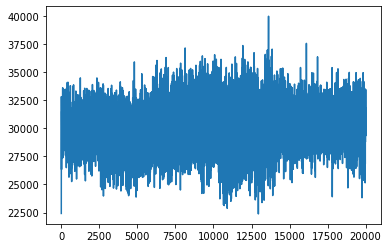

In [156]:
plt.plot(TrainingPortfolio)

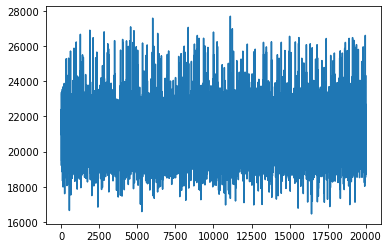

In [157]:
plt.plot(TestPortfolio)

In [158]:
np.mean(TestPortfolio)

21148.39582050007

In [159]:
np.mean(RandomPortfolio)

23466.127843749757

### Adding slope 

In [231]:
data = pd.read_csv(path)
data

,AAPL,MSI,SBUX
0,67.8542,60.30,28.185
1,68.5614,60.90,28.070
2,66.8428,60.83,28.130
3,66.7156,60.81,27.915
4,66.6556,61.12,27.775
...,...,...,...
1254,167.7800,99.12,56.000
1255,160.5000,103.87,55.770
1256,156.4900,101.06,54.690
1257,163.0300,102.76,55.610


In [232]:
percentage_start_close = 100*((data.iloc[2:].values - data.iloc[1:-1].values) /  data.iloc[1:-1].values)

In [233]:
data_new = pd.concat([data.iloc[1:-1] ,pd.DataFrame(percentage_start_close)],axis=1)
data_new.dropna(inplace=True)
data_new

,AAPL,MSI,SBUX,0,1,2
1,68.5614,60.90,28.070,-0.190297,-0.032879,-0.764309
2,66.8428,60.83,28.130,-0.089934,0.509785,-0.501522
3,66.7156,60.81,27.915,-1.377979,0.507199,-2.178218
4,66.6556,61.12,27.775,-0.036965,0.976721,0.202429
5,65.7371,61.43,27.170,-2.421750,-1.241335,-2.093664
...,...,...,...,...,...,...
1252,166.9700,99.80,57.190,0.209043,-0.341846,-1.425805
1253,167.4300,99.46,56.810,-4.339015,4.792171,-0.410714
1254,167.7800,99.12,56.000,-2.498442,-2.705305,-1.936525
1255,160.5000,103.87,55.770,4.179181,1.682169,1.682209


In [234]:
class MultiStockEnv:
    """
    A 3-stock trading environment.
    State: vector of size 7 (n_stock * 2 + 1)
        - # shares of stock 1 owned
        - # shares of stock 2 owned
        - # shares of stock 3 owned
        - price of stock 1 (using daily close price)
        - price of stock 2
        - price of stock 3
        - cash owned (can be used to purchase more stocks)
    Action: categorical variable with 27 (3^3) possibilities
        - for each stock, you can:
        - 0 = sell
        - 1 = hold
        - 2 = buy
    """
    def __init__(self, data, initial_investment=20000):
        # data
        self.stock_price_history = data
        self.n_step, self.n_stock = self.stock_price_history.shape

        # instance attributes
        self.initial_investment = initial_investment
        self.cur_step = None
        self.stock_owned = None
        self.stock_price = None
        self.cash_in_hand = None

        self.action_space = np.arange(3**self.n_stock)

        # action permutations
        # returns a nested list with elements like:
        # [0,0,0]
        # [0,0,1]
        # [0,0,2]
        # [0,1,0]
        # [0,1,1]
        # etc.
        # 0 = sell
        # 1 = hold
        # 2 = buy
        self.action_list = list(map(list, itertools.product([0, 1, 2], repeat=self.n_stock)))
        
        
        # calculate size of state
        self.state_dim = self.n_stock * 2 + 1

        self.reset()


    def reset(self):
        self.cur_step = 0
        self.stock_owned = np.zeros(self.n_stock)
        self.stock_price = self.stock_price_history[self.cur_step]
        self.cash_in_hand = self.initial_investment
        return self._get_obs()


    def step(self, action):
        assert action in self.action_space

        # get current value before performing the action
        prev_val = self._get_val()

        # update price, i.e. go to the next day
        self.cur_step += 1
        self.stock_price = self.stock_price_history[self.cur_step]

        # perform the trade
        self._trade(action)

        # get the new value after taking the action
        cur_val = self._get_val()

        # reward is the increase in porfolio value
        reward = cur_val - prev_val

        # done if we have run out of data
        done = self.cur_step == self.n_step - 1

        # store the current value of the portfolio here
        info = {'cur_val': cur_val}

        # conform to the Gym API
        return self._get_obs(), reward, done, info


    def _get_obs(self):
        obs = np.empty(self.state_dim)
        obs[:self.n_stock] = self.stock_owned
        obs[self.n_stock:2*self.n_stock] = self.stock_price
        obs[-1] = self.cash_in_hand
        return obs
    
    def _get_val(self):
        return self.stock_owned.dot(self.stock_price) + self.cash_in_hand

    def _trade(self, action):
        # index the action we want to perform
        # 0 = sell
        # 1 = hold
        # 2 = buy
        # e.g. [2,1,0] means:
        # buy first stock
        # hold second stock
        # sell third stock
        action_vec = self.action_list[action]

        # determine which stocks to buy or sell
        sell_index = [] # stores index of stocks we want to sell
        buy_index = [] # stores index of stocks we want to buy
            
        for i in range(len(action_vec)):
            if ((action_vec[0] + action_vec[4])/2 < 1) & (i<3):
                sell_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i ==3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 < 1) & (i == 5):
                sell_index.append(2)
                
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i < 3):
                buy_index.append(i)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 3):
                sell_index.append(0)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 4):
                sell_index.append(1)
            elif ((action_vec[0] + action_vec[4])/2 >=1.5) & (i == 5):
                sell_index.append(2)     
                
                

        # sell any stocks we want to sell
        # then buy any stocks we want to buy
        if sell_index:
            # NOTE: to simplify the problem, when we sell, we will sell ALL shares of that stock
            for i in sell_index:
                self.cash_in_hand += self.stock_price[i] * self.stock_owned[i]
                self.stock_owned[i] = 0
        if buy_index:
            # NOTE: when buying, we will loop through each stock we want to buy,
            #       and buy one share at a time until we run out of cash
            can_buy = True
            while can_buy:
                for i in buy_index:
                    if self.cash_in_hand > self.stock_price[i]:
                        self.stock_owned[i] += 1 # buy one share
                        self.cash_in_hand -= self.stock_price[i]
                    else:
                        can_buy = False

In [235]:
n_timesteps, n_stocks = data_new.shape

In [236]:
n_train = n_timesteps // 2
n_train

628

In [237]:
train_data = data_new[:n_train].values
test_data = data_new[n_train:].values

In [238]:
env = MultiStockEnv(train_data,initial_investment=20000)

### 1000 Episode

In [239]:
env.reset()

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  6.85614000e+01,  6.09000000e+01,
        2.80700000e+01, -1.90297235e-01, -3.28785139e-02, -7.64308567e-01,
        2.00000000e+04])

In [243]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 1000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data_new[:n_train].values
test_data = data_new[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_slope_1000_episode.npz", W=W, b=b)

episode: 1/1000, episode end value: 31556.25
episode: 2/1000, episode end value: 28186.30
episode: 3/1000, episode end value: 25494.15
episode: 4/1000, episode end value: 27725.51
episode: 5/1000, episode end value: 24737.11
episode: 6/1000, episode end value: 28927.15
episode: 7/1000, episode end value: 26386.87
episode: 8/1000, episode end value: 27250.67
episode: 9/1000, episode end value: 26570.77
episode: 10/1000, episode end value: 23740.19
episode: 11/1000, episode end value: 22082.07
episode: 12/1000, episode end value: 24010.80
episode: 13/1000, episode end value: 25615.50
episode: 14/1000, episode end value: 19994.46
episode: 15/1000, episode end value: 25249.92
episode: 16/1000, episode end value: 23017.84
episode: 17/1000, episode end value: 25302.54
episode: 18/1000, episode end value: 24151.13
episode: 19/1000, episode end value: 24828.46
episode: 20/1000, episode end value: 24301.49
episode: 21/1000, episode end value: 26254.56
episode: 22/1000, episode end value: 24501.

episode: 178/1000, episode end value: 18696.22
episode: 179/1000, episode end value: 28173.01
episode: 180/1000, episode end value: 30959.68
episode: 181/1000, episode end value: 29369.92
episode: 182/1000, episode end value: 22510.61
episode: 183/1000, episode end value: 25040.25
episode: 184/1000, episode end value: 20115.54
episode: 185/1000, episode end value: 20422.20
episode: 186/1000, episode end value: 31387.34
episode: 187/1000, episode end value: 25530.13
episode: 188/1000, episode end value: 23272.61
episode: 189/1000, episode end value: 22129.13
episode: 190/1000, episode end value: 25803.91
episode: 191/1000, episode end value: 31478.68
episode: 192/1000, episode end value: 28777.09
episode: 193/1000, episode end value: 20852.82
episode: 194/1000, episode end value: 26590.56
episode: 195/1000, episode end value: 22102.84
episode: 196/1000, episode end value: 21163.45
episode: 197/1000, episode end value: 25479.66
episode: 198/1000, episode end value: 21803.92
episode: 199/

episode: 353/1000, episode end value: 21117.94
episode: 354/1000, episode end value: 26962.45
episode: 355/1000, episode end value: 26170.53
episode: 356/1000, episode end value: 26609.12
episode: 357/1000, episode end value: 22814.65
episode: 358/1000, episode end value: 24302.20
episode: 359/1000, episode end value: 24402.74
episode: 360/1000, episode end value: 23661.05
episode: 361/1000, episode end value: 23816.32
episode: 362/1000, episode end value: 22587.81
episode: 363/1000, episode end value: 28672.73
episode: 364/1000, episode end value: 23044.51
episode: 365/1000, episode end value: 25348.60
episode: 366/1000, episode end value: 29880.21
episode: 367/1000, episode end value: 23763.25
episode: 368/1000, episode end value: 23314.35
episode: 369/1000, episode end value: 23361.82
episode: 370/1000, episode end value: 23832.76
episode: 371/1000, episode end value: 24058.72
episode: 372/1000, episode end value: 22748.69
episode: 373/1000, episode end value: 23942.53
episode: 374/

episode: 528/1000, episode end value: 28339.64
episode: 529/1000, episode end value: 28801.53
episode: 530/1000, episode end value: 26261.11
episode: 531/1000, episode end value: 26890.09
episode: 532/1000, episode end value: 29420.29
episode: 533/1000, episode end value: 27494.59
episode: 534/1000, episode end value: 23636.75
episode: 535/1000, episode end value: 26220.93
episode: 536/1000, episode end value: 29342.82
episode: 537/1000, episode end value: 25833.07
episode: 538/1000, episode end value: 31512.04
episode: 539/1000, episode end value: 26802.99
episode: 540/1000, episode end value: 23884.47
episode: 541/1000, episode end value: 30522.15
episode: 542/1000, episode end value: 27054.86
episode: 543/1000, episode end value: 24132.85
episode: 544/1000, episode end value: 25649.37
episode: 545/1000, episode end value: 27615.72
episode: 546/1000, episode end value: 28118.56
episode: 547/1000, episode end value: 28576.20
episode: 548/1000, episode end value: 26123.76
episode: 549/

episode: 703/1000, episode end value: 30869.94
episode: 704/1000, episode end value: 30016.71
episode: 705/1000, episode end value: 29595.57
episode: 706/1000, episode end value: 29290.90
episode: 707/1000, episode end value: 29762.10
episode: 708/1000, episode end value: 29837.36
episode: 709/1000, episode end value: 30651.75
episode: 710/1000, episode end value: 30722.09
episode: 711/1000, episode end value: 30122.09
episode: 712/1000, episode end value: 29223.33
episode: 713/1000, episode end value: 31720.10
episode: 714/1000, episode end value: 30567.76
episode: 715/1000, episode end value: 30580.50
episode: 716/1000, episode end value: 29357.49
episode: 717/1000, episode end value: 32091.31
episode: 718/1000, episode end value: 32277.42
episode: 719/1000, episode end value: 30973.74
episode: 720/1000, episode end value: 30262.25
episode: 721/1000, episode end value: 30452.69
episode: 722/1000, episode end value: 32176.37
episode: 723/1000, episode end value: 31914.76
episode: 724/

episode: 878/1000, episode end value: 30683.33
episode: 879/1000, episode end value: 31714.86
episode: 880/1000, episode end value: 29700.96
episode: 881/1000, episode end value: 32004.17
episode: 882/1000, episode end value: 30213.36
episode: 883/1000, episode end value: 27011.91
episode: 884/1000, episode end value: 28895.92
episode: 885/1000, episode end value: 29666.72
episode: 886/1000, episode end value: 29375.55
episode: 887/1000, episode end value: 26546.64
episode: 888/1000, episode end value: 30015.17
episode: 889/1000, episode end value: 30971.18
episode: 890/1000, episode end value: 30914.89
episode: 891/1000, episode end value: 29197.15
episode: 892/1000, episode end value: 30950.96
episode: 893/1000, episode end value: 32402.70
episode: 894/1000, episode end value: 31313.95
episode: 895/1000, episode end value: 30196.83
episode: 896/1000, episode end value: 31518.16
episode: 897/1000, episode end value: 31425.46
episode: 898/1000, episode end value: 32223.66
episode: 899/

In [244]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_slope_1000_episode.npz")
W = npz['W']
b = npz['b']

In [245]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 29559.29
episode: 2/1000, episode end value: 29724.36
episode: 3/1000, episode end value: 29356.96
episode: 4/1000, episode end value: 29409.97
episode: 5/1000, episode end value: 29925.09
episode: 6/1000, episode end value: 29808.73
episode: 7/1000, episode end value: 29724.36
episode: 8/1000, episode end value: 29705.75
episode: 9/1000, episode end value: 29491.99
episode: 10/1000, episode end value: 29620.24
episode: 11/1000, episode end value: 30017.46
episode: 12/1000, episode end value: 31140.33
episode: 13/1000, episode end value: 29724.36
episode: 14/1000, episode end value: 29578.33
episode: 15/1000, episode end value: 29073.31
episode: 16/1000, episode end value: 30037.53
episode: 17/1000, episode end value: 29512.04
episode: 18/1000, episode end value: 29724.36
episode: 19/1000, episode end value: 29881.44
episode: 20/1000, episode end value: 29049.60
episode: 21/1000, episode end value: 29696.91
episode: 22/1000, episode end value: 29196.

episode: 178/1000, episode end value: 28492.06
episode: 179/1000, episode end value: 30276.64
episode: 180/1000, episode end value: 29520.23
episode: 181/1000, episode end value: 29720.79
episode: 182/1000, episode end value: 29724.36
episode: 183/1000, episode end value: 29693.77
episode: 184/1000, episode end value: 29724.36
episode: 185/1000, episode end value: 29370.49
episode: 186/1000, episode end value: 29571.03
episode: 187/1000, episode end value: 29982.30
episode: 188/1000, episode end value: 29939.10
episode: 189/1000, episode end value: 29955.54
episode: 190/1000, episode end value: 29434.16
episode: 191/1000, episode end value: 29342.61
episode: 192/1000, episode end value: 29402.61
episode: 193/1000, episode end value: 29942.29
episode: 194/1000, episode end value: 29355.53
episode: 195/1000, episode end value: 29404.03
episode: 196/1000, episode end value: 30200.89
episode: 197/1000, episode end value: 29724.36
episode: 198/1000, episode end value: 29203.90
episode: 199/

episode: 353/1000, episode end value: 29921.82
episode: 354/1000, episode end value: 30509.56
episode: 355/1000, episode end value: 29252.70
episode: 356/1000, episode end value: 28798.92
episode: 357/1000, episode end value: 29422.89
episode: 358/1000, episode end value: 29641.80
episode: 359/1000, episode end value: 28985.56
episode: 360/1000, episode end value: 29410.72
episode: 361/1000, episode end value: 29826.89
episode: 362/1000, episode end value: 30023.94
episode: 363/1000, episode end value: 29523.86
episode: 364/1000, episode end value: 29724.36
episode: 365/1000, episode end value: 29084.85
episode: 366/1000, episode end value: 28773.67
episode: 367/1000, episode end value: 29724.36
episode: 368/1000, episode end value: 29330.43
episode: 369/1000, episode end value: 29625.51
episode: 370/1000, episode end value: 29513.87
episode: 371/1000, episode end value: 29536.78
episode: 372/1000, episode end value: 29670.86
episode: 373/1000, episode end value: 31965.37
episode: 374/

episode: 528/1000, episode end value: 29649.38
episode: 529/1000, episode end value: 29652.43
episode: 530/1000, episode end value: 30908.56
episode: 531/1000, episode end value: 29814.14
episode: 532/1000, episode end value: 29863.38
episode: 533/1000, episode end value: 28320.14
episode: 534/1000, episode end value: 29718.87
episode: 535/1000, episode end value: 29667.57
episode: 536/1000, episode end value: 29724.36
episode: 537/1000, episode end value: 29986.22
episode: 538/1000, episode end value: 29554.07
episode: 539/1000, episode end value: 30321.92
episode: 540/1000, episode end value: 30278.88
episode: 541/1000, episode end value: 29775.65
episode: 542/1000, episode end value: 30204.77
episode: 543/1000, episode end value: 29989.25
episode: 544/1000, episode end value: 29682.89
episode: 545/1000, episode end value: 29483.33
episode: 546/1000, episode end value: 29387.89
episode: 547/1000, episode end value: 30459.15
episode: 548/1000, episode end value: 29684.36
episode: 549/

episode: 703/1000, episode end value: 29528.71
episode: 704/1000, episode end value: 30152.30
episode: 705/1000, episode end value: 29250.15
episode: 706/1000, episode end value: 29679.98
episode: 707/1000, episode end value: 29489.23
episode: 708/1000, episode end value: 29341.63
episode: 709/1000, episode end value: 29515.42
episode: 710/1000, episode end value: 29960.52
episode: 711/1000, episode end value: 29885.16
episode: 712/1000, episode end value: 30749.99
episode: 713/1000, episode end value: 29365.31
episode: 714/1000, episode end value: 29220.63
episode: 715/1000, episode end value: 30311.21
episode: 716/1000, episode end value: 30078.80
episode: 717/1000, episode end value: 29946.99
episode: 718/1000, episode end value: 29977.60
episode: 719/1000, episode end value: 29647.33
episode: 720/1000, episode end value: 29513.25
episode: 721/1000, episode end value: 29098.21
episode: 722/1000, episode end value: 29304.38
episode: 723/1000, episode end value: 29764.91
episode: 724/

episode: 878/1000, episode end value: 28574.05
episode: 879/1000, episode end value: 29181.23
episode: 880/1000, episode end value: 29829.67
episode: 881/1000, episode end value: 30047.05
episode: 882/1000, episode end value: 30035.35
episode: 883/1000, episode end value: 29881.20
episode: 884/1000, episode end value: 30284.96
episode: 885/1000, episode end value: 30643.29
episode: 886/1000, episode end value: 29336.30
episode: 887/1000, episode end value: 28938.13
episode: 888/1000, episode end value: 29296.77
episode: 889/1000, episode end value: 29771.01
episode: 890/1000, episode end value: 29162.40
episode: 891/1000, episode end value: 29733.26
episode: 892/1000, episode end value: 29837.42
episode: 893/1000, episode end value: 29829.60
episode: 894/1000, episode end value: 27623.40
episode: 895/1000, episode end value: 29387.39
episode: 896/1000, episode end value: 29250.15
episode: 897/1000, episode end value: 29646.39
episode: 898/1000, episode end value: 28407.74
episode: 899/

In [246]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/1000, episode end value: 22197.16
episode: 2/1000, episode end value: 25217.90
episode: 3/1000, episode end value: 23393.38
episode: 4/1000, episode end value: 24778.83
episode: 5/1000, episode end value: 21826.56
episode: 6/1000, episode end value: 20731.92
episode: 7/1000, episode end value: 25468.32
episode: 8/1000, episode end value: 20120.26
episode: 9/1000, episode end value: 23221.20
episode: 10/1000, episode end value: 26890.47
episode: 11/1000, episode end value: 27901.57
episode: 12/1000, episode end value: 24552.82
episode: 13/1000, episode end value: 21211.25
episode: 14/1000, episode end value: 24166.13
episode: 15/1000, episode end value: 21232.45
episode: 16/1000, episode end value: 25469.76
episode: 17/1000, episode end value: 21250.40
episode: 18/1000, episode end value: 20930.92
episode: 19/1000, episode end value: 25473.76
episode: 20/1000, episode end value: 25524.18
episode: 21/1000, episode end value: 24888.48
episode: 22/1000, episode end value: 20375.

episode: 179/1000, episode end value: 21149.90
episode: 180/1000, episode end value: 20767.99
episode: 181/1000, episode end value: 21045.19
episode: 182/1000, episode end value: 19881.66
episode: 183/1000, episode end value: 20392.39
episode: 184/1000, episode end value: 24467.53
episode: 185/1000, episode end value: 22475.76
episode: 186/1000, episode end value: 20698.20
episode: 187/1000, episode end value: 22600.51
episode: 188/1000, episode end value: 23941.67
episode: 189/1000, episode end value: 23173.11
episode: 190/1000, episode end value: 27435.45
episode: 191/1000, episode end value: 23713.60
episode: 192/1000, episode end value: 25680.57
episode: 193/1000, episode end value: 20914.86
episode: 194/1000, episode end value: 20602.15
episode: 195/1000, episode end value: 23072.43
episode: 196/1000, episode end value: 20845.71
episode: 197/1000, episode end value: 24372.79
episode: 198/1000, episode end value: 22707.59
episode: 199/1000, episode end value: 19914.59
episode: 200/

episode: 355/1000, episode end value: 18329.60
episode: 356/1000, episode end value: 24313.56
episode: 357/1000, episode end value: 20080.33
episode: 358/1000, episode end value: 17236.10
episode: 359/1000, episode end value: 19032.26
episode: 360/1000, episode end value: 23997.72
episode: 361/1000, episode end value: 21254.20
episode: 362/1000, episode end value: 24718.44
episode: 363/1000, episode end value: 20994.91
episode: 364/1000, episode end value: 23046.75
episode: 365/1000, episode end value: 24990.27
episode: 366/1000, episode end value: 20646.84
episode: 367/1000, episode end value: 21294.72
episode: 368/1000, episode end value: 24631.55
episode: 369/1000, episode end value: 29222.29
episode: 370/1000, episode end value: 22513.18
episode: 371/1000, episode end value: 22061.88
episode: 372/1000, episode end value: 23115.07
episode: 373/1000, episode end value: 24751.60
episode: 374/1000, episode end value: 27110.89
episode: 375/1000, episode end value: 20324.57
episode: 376/

episode: 531/1000, episode end value: 23933.96
episode: 532/1000, episode end value: 21851.03
episode: 533/1000, episode end value: 25204.03
episode: 534/1000, episode end value: 22635.23
episode: 535/1000, episode end value: 26353.67
episode: 536/1000, episode end value: 21251.06
episode: 537/1000, episode end value: 23398.47
episode: 538/1000, episode end value: 23080.97
episode: 539/1000, episode end value: 25314.25
episode: 540/1000, episode end value: 22207.66
episode: 541/1000, episode end value: 27673.91
episode: 542/1000, episode end value: 21355.64
episode: 543/1000, episode end value: 23944.00
episode: 544/1000, episode end value: 22379.95
episode: 545/1000, episode end value: 25204.06
episode: 546/1000, episode end value: 21524.76
episode: 547/1000, episode end value: 23563.35
episode: 548/1000, episode end value: 21779.16
episode: 549/1000, episode end value: 22514.79
episode: 550/1000, episode end value: 22116.89
episode: 551/1000, episode end value: 23664.18
episode: 552/

episode: 706/1000, episode end value: 21919.42
episode: 707/1000, episode end value: 20565.73
episode: 708/1000, episode end value: 21662.32
episode: 709/1000, episode end value: 26565.66
episode: 710/1000, episode end value: 26541.89
episode: 711/1000, episode end value: 16747.79
episode: 712/1000, episode end value: 25880.97
episode: 713/1000, episode end value: 22836.49
episode: 714/1000, episode end value: 23766.05
episode: 715/1000, episode end value: 22168.38
episode: 716/1000, episode end value: 21013.71
episode: 717/1000, episode end value: 19370.90
episode: 718/1000, episode end value: 22201.12
episode: 719/1000, episode end value: 23250.48
episode: 720/1000, episode end value: 19858.31
episode: 721/1000, episode end value: 19983.54
episode: 722/1000, episode end value: 21201.42
episode: 723/1000, episode end value: 19267.30
episode: 724/1000, episode end value: 23436.10
episode: 725/1000, episode end value: 24282.67
episode: 726/1000, episode end value: 23245.38
episode: 727/

episode: 882/1000, episode end value: 22304.42
episode: 883/1000, episode end value: 25398.89
episode: 884/1000, episode end value: 19110.96
episode: 885/1000, episode end value: 22957.05
episode: 886/1000, episode end value: 19598.30
episode: 887/1000, episode end value: 19000.95
episode: 888/1000, episode end value: 24989.15
episode: 889/1000, episode end value: 22633.23
episode: 890/1000, episode end value: 26032.22
episode: 891/1000, episode end value: 32409.97
episode: 892/1000, episode end value: 21497.27
episode: 893/1000, episode end value: 17186.15
episode: 894/1000, episode end value: 17555.09
episode: 895/1000, episode end value: 20513.24
episode: 896/1000, episode end value: 23906.62
episode: 897/1000, episode end value: 21757.60
episode: 898/1000, episode end value: 20372.76
episode: 899/1000, episode end value: 26231.60
episode: 900/1000, episode end value: 25299.47
episode: 901/1000, episode end value: 23779.82
episode: 902/1000, episode end value: 20574.30
episode: 903/

In [247]:
np.savez(saving_models_path+"/TraderPortfolios_slope_1000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [248]:
npz = np.load(saving_models_path+"/TraderPortfolios_slope_1000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

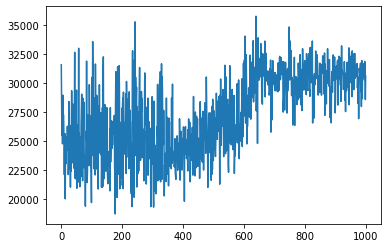

In [249]:
plt.plot(TrainingPortfolio)

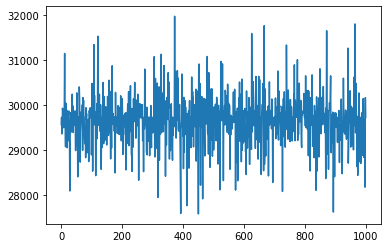

In [250]:
plt.plot(TestPortfolio)

In [251]:
np.mean(TestPortfolio)

29651.410514998803

In [252]:
np.mean(RandomPortfolio)

23091.87308999977

### 8000 Episode

In [253]:
env.reset()

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  1.13490000e+02,  6.33500000e+01,
        5.63500000e+01, -7.80978827e-02, -4.02476780e-01,  8.33628946e-01,
        2.00000000e+04])

In [254]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 8000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data_new[:n_train].values
test_data = data_new[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_slope_8000_episode.npz", W=W, b=b)

episode: 1/8000, episode end value: 31556.25
episode: 2/8000, episode end value: 28186.30
episode: 3/8000, episode end value: 25494.15
episode: 4/8000, episode end value: 27725.51
episode: 5/8000, episode end value: 24737.11
episode: 6/8000, episode end value: 28927.15
episode: 7/8000, episode end value: 26386.87
episode: 8/8000, episode end value: 27250.67
episode: 9/8000, episode end value: 26570.77
episode: 10/8000, episode end value: 23740.19
episode: 11/8000, episode end value: 22082.07
episode: 12/8000, episode end value: 24010.80
episode: 13/8000, episode end value: 25615.50
episode: 14/8000, episode end value: 19994.46
episode: 15/8000, episode end value: 25249.92
episode: 16/8000, episode end value: 23017.84
episode: 17/8000, episode end value: 25302.54
episode: 18/8000, episode end value: 24151.13
episode: 19/8000, episode end value: 24828.46
episode: 20/8000, episode end value: 24301.49
episode: 21/8000, episode end value: 26254.56
episode: 22/8000, episode end value: 24501.

episode: 178/8000, episode end value: 18696.22
episode: 179/8000, episode end value: 28173.01
episode: 180/8000, episode end value: 30959.68
episode: 181/8000, episode end value: 29369.92
episode: 182/8000, episode end value: 22510.61
episode: 183/8000, episode end value: 25040.25
episode: 184/8000, episode end value: 20115.54
episode: 185/8000, episode end value: 20422.20
episode: 186/8000, episode end value: 31387.34
episode: 187/8000, episode end value: 25530.13
episode: 188/8000, episode end value: 23272.61
episode: 189/8000, episode end value: 22129.13
episode: 190/8000, episode end value: 25803.91
episode: 191/8000, episode end value: 31478.68
episode: 192/8000, episode end value: 28777.09
episode: 193/8000, episode end value: 20852.82
episode: 194/8000, episode end value: 26590.56
episode: 195/8000, episode end value: 22102.84
episode: 196/8000, episode end value: 21163.45
episode: 197/8000, episode end value: 25479.66
episode: 198/8000, episode end value: 21803.92
episode: 199/

episode: 353/8000, episode end value: 21117.94
episode: 354/8000, episode end value: 26962.45
episode: 355/8000, episode end value: 26170.53
episode: 356/8000, episode end value: 26609.12
episode: 357/8000, episode end value: 22814.65
episode: 358/8000, episode end value: 24302.20
episode: 359/8000, episode end value: 24402.74
episode: 360/8000, episode end value: 23661.05
episode: 361/8000, episode end value: 23816.32
episode: 362/8000, episode end value: 22587.81
episode: 363/8000, episode end value: 28672.73
episode: 364/8000, episode end value: 23044.51
episode: 365/8000, episode end value: 25348.60
episode: 366/8000, episode end value: 29880.21
episode: 367/8000, episode end value: 23763.25
episode: 368/8000, episode end value: 23314.35
episode: 369/8000, episode end value: 23361.82
episode: 370/8000, episode end value: 23832.76
episode: 371/8000, episode end value: 24058.72
episode: 372/8000, episode end value: 22748.69
episode: 373/8000, episode end value: 23942.53
episode: 374/

episode: 528/8000, episode end value: 28339.64
episode: 529/8000, episode end value: 28801.53
episode: 530/8000, episode end value: 26261.11
episode: 531/8000, episode end value: 26890.09
episode: 532/8000, episode end value: 29420.29
episode: 533/8000, episode end value: 27494.59
episode: 534/8000, episode end value: 23636.75
episode: 535/8000, episode end value: 26220.93
episode: 536/8000, episode end value: 29342.82
episode: 537/8000, episode end value: 25833.07
episode: 538/8000, episode end value: 31512.04
episode: 539/8000, episode end value: 26802.99
episode: 540/8000, episode end value: 23884.47
episode: 541/8000, episode end value: 30522.15
episode: 542/8000, episode end value: 27054.86
episode: 543/8000, episode end value: 24132.85
episode: 544/8000, episode end value: 25649.37
episode: 545/8000, episode end value: 27615.72
episode: 546/8000, episode end value: 28118.56
episode: 547/8000, episode end value: 28576.20
episode: 548/8000, episode end value: 26123.76
episode: 549/

episode: 703/8000, episode end value: 30869.94
episode: 704/8000, episode end value: 30016.71
episode: 705/8000, episode end value: 29595.57
episode: 706/8000, episode end value: 29290.90
episode: 707/8000, episode end value: 29762.10
episode: 708/8000, episode end value: 29837.36
episode: 709/8000, episode end value: 30651.75
episode: 710/8000, episode end value: 30722.09
episode: 711/8000, episode end value: 30122.09
episode: 712/8000, episode end value: 29223.33
episode: 713/8000, episode end value: 31720.10
episode: 714/8000, episode end value: 30567.76
episode: 715/8000, episode end value: 30580.50
episode: 716/8000, episode end value: 29357.49
episode: 717/8000, episode end value: 32091.31
episode: 718/8000, episode end value: 32277.42
episode: 719/8000, episode end value: 30973.74
episode: 720/8000, episode end value: 30262.25
episode: 721/8000, episode end value: 30452.69
episode: 722/8000, episode end value: 32176.37
episode: 723/8000, episode end value: 31914.76
episode: 724/

episode: 878/8000, episode end value: 30683.33
episode: 879/8000, episode end value: 31714.86
episode: 880/8000, episode end value: 29700.96
episode: 881/8000, episode end value: 32004.17
episode: 882/8000, episode end value: 30213.36
episode: 883/8000, episode end value: 27011.91
episode: 884/8000, episode end value: 28895.92
episode: 885/8000, episode end value: 29666.72
episode: 886/8000, episode end value: 29375.55
episode: 887/8000, episode end value: 26546.64
episode: 888/8000, episode end value: 30015.17
episode: 889/8000, episode end value: 30971.18
episode: 890/8000, episode end value: 30914.89
episode: 891/8000, episode end value: 29197.15
episode: 892/8000, episode end value: 30950.96
episode: 893/8000, episode end value: 32402.70
episode: 894/8000, episode end value: 31313.95
episode: 895/8000, episode end value: 30196.83
episode: 896/8000, episode end value: 31518.16
episode: 897/8000, episode end value: 31425.46
episode: 898/8000, episode end value: 32223.66
episode: 899/

episode: 1052/8000, episode end value: 28485.93
episode: 1053/8000, episode end value: 29872.47
episode: 1054/8000, episode end value: 32257.98
episode: 1055/8000, episode end value: 29054.23
episode: 1056/8000, episode end value: 31261.86
episode: 1057/8000, episode end value: 28276.31
episode: 1058/8000, episode end value: 31919.20
episode: 1059/8000, episode end value: 32026.99
episode: 1060/8000, episode end value: 30100.72
episode: 1061/8000, episode end value: 29906.05
episode: 1062/8000, episode end value: 30162.55
episode: 1063/8000, episode end value: 29818.87
episode: 1064/8000, episode end value: 30522.55
episode: 1065/8000, episode end value: 31436.39
episode: 1066/8000, episode end value: 29301.77
episode: 1067/8000, episode end value: 29599.30
episode: 1068/8000, episode end value: 30225.90
episode: 1069/8000, episode end value: 32524.51
episode: 1070/8000, episode end value: 31786.39
episode: 1071/8000, episode end value: 27722.12
episode: 1072/8000, episode end value: 3

episode: 1223/8000, episode end value: 30650.41
episode: 1224/8000, episode end value: 30201.61
episode: 1225/8000, episode end value: 30847.75
episode: 1226/8000, episode end value: 30102.61
episode: 1227/8000, episode end value: 27996.72
episode: 1228/8000, episode end value: 29913.51
episode: 1229/8000, episode end value: 29346.22
episode: 1230/8000, episode end value: 30542.95
episode: 1231/8000, episode end value: 30003.84
episode: 1232/8000, episode end value: 29863.02
episode: 1233/8000, episode end value: 30188.17
episode: 1234/8000, episode end value: 27452.16
episode: 1235/8000, episode end value: 32856.06
episode: 1236/8000, episode end value: 27224.94
episode: 1237/8000, episode end value: 28250.79
episode: 1238/8000, episode end value: 28887.74
episode: 1239/8000, episode end value: 29321.10
episode: 1240/8000, episode end value: 29230.87
episode: 1241/8000, episode end value: 28652.85
episode: 1242/8000, episode end value: 29673.63
episode: 1243/8000, episode end value: 2

episode: 1394/8000, episode end value: 31101.97
episode: 1395/8000, episode end value: 28130.25
episode: 1396/8000, episode end value: 33164.72
episode: 1397/8000, episode end value: 28269.06
episode: 1398/8000, episode end value: 28759.11
episode: 1399/8000, episode end value: 29350.93
episode: 1400/8000, episode end value: 29895.14
episode: 1401/8000, episode end value: 28093.66
episode: 1402/8000, episode end value: 30416.95
episode: 1403/8000, episode end value: 30041.61
episode: 1404/8000, episode end value: 26510.73
episode: 1405/8000, episode end value: 27615.38
episode: 1406/8000, episode end value: 29669.86
episode: 1407/8000, episode end value: 31997.55
episode: 1408/8000, episode end value: 31843.77
episode: 1409/8000, episode end value: 29435.74
episode: 1410/8000, episode end value: 29502.20
episode: 1411/8000, episode end value: 31858.33
episode: 1412/8000, episode end value: 32002.60
episode: 1413/8000, episode end value: 30119.25
episode: 1414/8000, episode end value: 2

episode: 1565/8000, episode end value: 27500.97
episode: 1566/8000, episode end value: 28512.49
episode: 1567/8000, episode end value: 30095.46
episode: 1568/8000, episode end value: 31128.76
episode: 1569/8000, episode end value: 32680.96
episode: 1570/8000, episode end value: 28240.07
episode: 1571/8000, episode end value: 28253.69
episode: 1572/8000, episode end value: 28679.51
episode: 1573/8000, episode end value: 30908.66
episode: 1574/8000, episode end value: 28776.26
episode: 1575/8000, episode end value: 26654.20
episode: 1576/8000, episode end value: 28449.29
episode: 1577/8000, episode end value: 31582.31
episode: 1578/8000, episode end value: 30004.19
episode: 1579/8000, episode end value: 29618.07
episode: 1580/8000, episode end value: 28755.26
episode: 1581/8000, episode end value: 33559.10
episode: 1582/8000, episode end value: 27448.87
episode: 1583/8000, episode end value: 25637.03
episode: 1584/8000, episode end value: 28942.79
episode: 1585/8000, episode end value: 3

episode: 1736/8000, episode end value: 32043.74
episode: 1737/8000, episode end value: 31626.95
episode: 1738/8000, episode end value: 31843.21
episode: 1739/8000, episode end value: 31942.09
episode: 1740/8000, episode end value: 29485.83
episode: 1741/8000, episode end value: 31514.08
episode: 1742/8000, episode end value: 31217.76
episode: 1743/8000, episode end value: 28726.11
episode: 1744/8000, episode end value: 31535.78
episode: 1745/8000, episode end value: 30507.57
episode: 1746/8000, episode end value: 28465.12
episode: 1747/8000, episode end value: 30339.35
episode: 1748/8000, episode end value: 29803.65
episode: 1749/8000, episode end value: 29728.35
episode: 1750/8000, episode end value: 30126.93
episode: 1751/8000, episode end value: 28856.09
episode: 1752/8000, episode end value: 30210.80
episode: 1753/8000, episode end value: 32391.60
episode: 1754/8000, episode end value: 30079.74
episode: 1755/8000, episode end value: 32073.84
episode: 1756/8000, episode end value: 3

episode: 1907/8000, episode end value: 30488.37
episode: 1908/8000, episode end value: 28267.41
episode: 1909/8000, episode end value: 28915.99
episode: 1910/8000, episode end value: 29423.32
episode: 1911/8000, episode end value: 30218.82
episode: 1912/8000, episode end value: 30299.02
episode: 1913/8000, episode end value: 28965.59
episode: 1914/8000, episode end value: 29120.05
episode: 1915/8000, episode end value: 30530.10
episode: 1916/8000, episode end value: 31329.46
episode: 1917/8000, episode end value: 27775.82
episode: 1918/8000, episode end value: 30040.79
episode: 1919/8000, episode end value: 30626.55
episode: 1920/8000, episode end value: 33660.30
episode: 1921/8000, episode end value: 30152.03
episode: 1922/8000, episode end value: 29099.14
episode: 1923/8000, episode end value: 27892.99
episode: 1924/8000, episode end value: 26580.07
episode: 1925/8000, episode end value: 30041.91
episode: 1926/8000, episode end value: 29009.13
episode: 1927/8000, episode end value: 2

episode: 2078/8000, episode end value: 27058.82
episode: 2079/8000, episode end value: 31058.24
episode: 2080/8000, episode end value: 24167.99
episode: 2081/8000, episode end value: 28714.79
episode: 2082/8000, episode end value: 31451.89
episode: 2083/8000, episode end value: 29134.97
episode: 2084/8000, episode end value: 29970.51
episode: 2085/8000, episode end value: 31323.03
episode: 2086/8000, episode end value: 29855.57
episode: 2087/8000, episode end value: 29172.16
episode: 2088/8000, episode end value: 30736.86
episode: 2089/8000, episode end value: 29826.11
episode: 2090/8000, episode end value: 31940.25
episode: 2091/8000, episode end value: 30631.79
episode: 2092/8000, episode end value: 31670.76
episode: 2093/8000, episode end value: 31731.59
episode: 2094/8000, episode end value: 29268.84
episode: 2095/8000, episode end value: 29819.33
episode: 2096/8000, episode end value: 31053.46
episode: 2097/8000, episode end value: 29896.25
episode: 2098/8000, episode end value: 3

episode: 2249/8000, episode end value: 29397.16
episode: 2250/8000, episode end value: 28575.09
episode: 2251/8000, episode end value: 30087.90
episode: 2252/8000, episode end value: 31477.45
episode: 2253/8000, episode end value: 30787.09
episode: 2254/8000, episode end value: 31539.18
episode: 2255/8000, episode end value: 29111.21
episode: 2256/8000, episode end value: 32270.84
episode: 2257/8000, episode end value: 30029.85
episode: 2258/8000, episode end value: 30962.58
episode: 2259/8000, episode end value: 30072.99
episode: 2260/8000, episode end value: 29505.07
episode: 2261/8000, episode end value: 27743.66
episode: 2262/8000, episode end value: 30900.42
episode: 2263/8000, episode end value: 31048.75
episode: 2264/8000, episode end value: 29889.14
episode: 2265/8000, episode end value: 30057.43
episode: 2266/8000, episode end value: 25251.38
episode: 2267/8000, episode end value: 27180.07
episode: 2268/8000, episode end value: 27145.76
episode: 2269/8000, episode end value: 2

episode: 2420/8000, episode end value: 29237.18
episode: 2421/8000, episode end value: 33072.89
episode: 2422/8000, episode end value: 29738.48
episode: 2423/8000, episode end value: 30495.96
episode: 2424/8000, episode end value: 32132.93
episode: 2425/8000, episode end value: 33361.41
episode: 2426/8000, episode end value: 32456.03
episode: 2427/8000, episode end value: 28838.61
episode: 2428/8000, episode end value: 29649.59
episode: 2429/8000, episode end value: 35274.90
episode: 2430/8000, episode end value: 29832.54
episode: 2431/8000, episode end value: 29313.54
episode: 2432/8000, episode end value: 29543.02
episode: 2433/8000, episode end value: 29194.22
episode: 2434/8000, episode end value: 29737.77
episode: 2435/8000, episode end value: 30230.23
episode: 2436/8000, episode end value: 31127.20
episode: 2437/8000, episode end value: 29616.03
episode: 2438/8000, episode end value: 33284.59
episode: 2439/8000, episode end value: 31776.02
episode: 2440/8000, episode end value: 2

episode: 2591/8000, episode end value: 30151.75
episode: 2592/8000, episode end value: 31579.29
episode: 2593/8000, episode end value: 29482.46
episode: 2594/8000, episode end value: 30849.33
episode: 2595/8000, episode end value: 32131.44
episode: 2596/8000, episode end value: 29298.98
episode: 2597/8000, episode end value: 28078.75
episode: 2598/8000, episode end value: 29691.77
episode: 2599/8000, episode end value: 28309.54
episode: 2600/8000, episode end value: 29308.21
episode: 2601/8000, episode end value: 28666.19
episode: 2602/8000, episode end value: 28426.70
episode: 2603/8000, episode end value: 27549.33
episode: 2604/8000, episode end value: 31518.45
episode: 2605/8000, episode end value: 28211.53
episode: 2606/8000, episode end value: 29928.56
episode: 2607/8000, episode end value: 29535.48
episode: 2608/8000, episode end value: 27091.20
episode: 2609/8000, episode end value: 30192.41
episode: 2610/8000, episode end value: 29503.59
episode: 2611/8000, episode end value: 2

episode: 2762/8000, episode end value: 31688.15
episode: 2763/8000, episode end value: 31490.73
episode: 2764/8000, episode end value: 30082.58
episode: 2765/8000, episode end value: 32735.64
episode: 2766/8000, episode end value: 29246.66
episode: 2767/8000, episode end value: 34573.24
episode: 2768/8000, episode end value: 29142.51
episode: 2769/8000, episode end value: 28579.11
episode: 2770/8000, episode end value: 29698.29
episode: 2771/8000, episode end value: 30186.72
episode: 2772/8000, episode end value: 28944.67
episode: 2773/8000, episode end value: 30219.86
episode: 2774/8000, episode end value: 31461.32
episode: 2775/8000, episode end value: 30809.51
episode: 2776/8000, episode end value: 30098.30
episode: 2777/8000, episode end value: 28571.00
episode: 2778/8000, episode end value: 33352.16
episode: 2779/8000, episode end value: 28645.39
episode: 2780/8000, episode end value: 28968.56
episode: 2781/8000, episode end value: 30262.42
episode: 2782/8000, episode end value: 3

episode: 2933/8000, episode end value: 30589.78
episode: 2934/8000, episode end value: 29627.73
episode: 2935/8000, episode end value: 32137.35
episode: 2936/8000, episode end value: 30417.30
episode: 2937/8000, episode end value: 30591.41
episode: 2938/8000, episode end value: 31393.25
episode: 2939/8000, episode end value: 32211.55
episode: 2940/8000, episode end value: 31696.12
episode: 2941/8000, episode end value: 31180.46
episode: 2942/8000, episode end value: 26781.29
episode: 2943/8000, episode end value: 31458.64
episode: 2944/8000, episode end value: 29838.67
episode: 2945/8000, episode end value: 29104.68
episode: 2946/8000, episode end value: 28966.25
episode: 2947/8000, episode end value: 30392.10
episode: 2948/8000, episode end value: 30931.48
episode: 2949/8000, episode end value: 28478.35
episode: 2950/8000, episode end value: 29345.93
episode: 2951/8000, episode end value: 30438.80
episode: 2952/8000, episode end value: 30678.50
episode: 2953/8000, episode end value: 3

episode: 3104/8000, episode end value: 28469.52
episode: 3105/8000, episode end value: 30841.73
episode: 3106/8000, episode end value: 29019.87
episode: 3107/8000, episode end value: 30555.11
episode: 3108/8000, episode end value: 30823.75
episode: 3109/8000, episode end value: 30973.53
episode: 3110/8000, episode end value: 29181.03
episode: 3111/8000, episode end value: 30433.12
episode: 3112/8000, episode end value: 31631.92
episode: 3113/8000, episode end value: 29880.93
episode: 3114/8000, episode end value: 34091.79
episode: 3115/8000, episode end value: 30451.81
episode: 3116/8000, episode end value: 31192.34
episode: 3117/8000, episode end value: 31484.22
episode: 3118/8000, episode end value: 25304.60
episode: 3119/8000, episode end value: 29131.34
episode: 3120/8000, episode end value: 32751.97
episode: 3121/8000, episode end value: 29205.81
episode: 3122/8000, episode end value: 29771.63
episode: 3123/8000, episode end value: 32828.67
episode: 3124/8000, episode end value: 3

episode: 3275/8000, episode end value: 30453.84
episode: 3276/8000, episode end value: 30263.23
episode: 3277/8000, episode end value: 29757.59
episode: 3278/8000, episode end value: 29157.00
episode: 3279/8000, episode end value: 31740.01
episode: 3280/8000, episode end value: 31992.12
episode: 3281/8000, episode end value: 32538.05
episode: 3282/8000, episode end value: 29939.49
episode: 3283/8000, episode end value: 30667.59
episode: 3284/8000, episode end value: 29452.74
episode: 3285/8000, episode end value: 31465.10
episode: 3286/8000, episode end value: 29871.58
episode: 3287/8000, episode end value: 32094.34
episode: 3288/8000, episode end value: 25747.47
episode: 3289/8000, episode end value: 28856.30
episode: 3290/8000, episode end value: 32635.48
episode: 3291/8000, episode end value: 33262.07
episode: 3292/8000, episode end value: 30348.37
episode: 3293/8000, episode end value: 31279.31
episode: 3294/8000, episode end value: 30276.52
episode: 3295/8000, episode end value: 3

episode: 3446/8000, episode end value: 35079.85
episode: 3447/8000, episode end value: 28779.08
episode: 3448/8000, episode end value: 28729.83
episode: 3449/8000, episode end value: 31185.02
episode: 3450/8000, episode end value: 28670.00
episode: 3451/8000, episode end value: 30533.05
episode: 3452/8000, episode end value: 30811.64
episode: 3453/8000, episode end value: 30402.15
episode: 3454/8000, episode end value: 25991.87
episode: 3455/8000, episode end value: 29258.45
episode: 3456/8000, episode end value: 26098.89
episode: 3457/8000, episode end value: 27748.14
episode: 3458/8000, episode end value: 29758.29
episode: 3459/8000, episode end value: 28504.42
episode: 3460/8000, episode end value: 29888.99
episode: 3461/8000, episode end value: 30558.21
episode: 3462/8000, episode end value: 27447.06
episode: 3463/8000, episode end value: 30018.38
episode: 3464/8000, episode end value: 30761.38
episode: 3465/8000, episode end value: 31068.27
episode: 3466/8000, episode end value: 3

episode: 3617/8000, episode end value: 29757.68
episode: 3618/8000, episode end value: 30823.18
episode: 3619/8000, episode end value: 28987.03
episode: 3620/8000, episode end value: 33517.82
episode: 3621/8000, episode end value: 28270.22
episode: 3622/8000, episode end value: 31214.09
episode: 3623/8000, episode end value: 31330.50
episode: 3624/8000, episode end value: 27673.45
episode: 3625/8000, episode end value: 28514.82
episode: 3626/8000, episode end value: 26083.63
episode: 3627/8000, episode end value: 28898.34
episode: 3628/8000, episode end value: 27471.98
episode: 3629/8000, episode end value: 31267.59
episode: 3630/8000, episode end value: 29867.89
episode: 3631/8000, episode end value: 29486.44
episode: 3632/8000, episode end value: 29163.81
episode: 3633/8000, episode end value: 30940.33
episode: 3634/8000, episode end value: 28314.63
episode: 3635/8000, episode end value: 30996.96
episode: 3636/8000, episode end value: 31710.27
episode: 3637/8000, episode end value: 3

episode: 3788/8000, episode end value: 30549.67
episode: 3789/8000, episode end value: 32487.57
episode: 3790/8000, episode end value: 30083.86
episode: 3791/8000, episode end value: 31039.81
episode: 3792/8000, episode end value: 31227.67
episode: 3793/8000, episode end value: 29358.47
episode: 3794/8000, episode end value: 29664.88
episode: 3795/8000, episode end value: 29471.61
episode: 3796/8000, episode end value: 32305.14
episode: 3797/8000, episode end value: 26605.77
episode: 3798/8000, episode end value: 29649.81
episode: 3799/8000, episode end value: 28938.32
episode: 3800/8000, episode end value: 30369.29
episode: 3801/8000, episode end value: 34501.59
episode: 3802/8000, episode end value: 26390.50
episode: 3803/8000, episode end value: 30214.53
episode: 3804/8000, episode end value: 30531.69
episode: 3805/8000, episode end value: 30243.40
episode: 3806/8000, episode end value: 29589.36
episode: 3807/8000, episode end value: 28080.88
episode: 3808/8000, episode end value: 2

episode: 3959/8000, episode end value: 31138.97
episode: 3960/8000, episode end value: 31071.13
episode: 3961/8000, episode end value: 29291.25
episode: 3962/8000, episode end value: 30073.91
episode: 3963/8000, episode end value: 32434.57
episode: 3964/8000, episode end value: 33265.60
episode: 3965/8000, episode end value: 29523.09
episode: 3966/8000, episode end value: 25860.28
episode: 3967/8000, episode end value: 32450.16
episode: 3968/8000, episode end value: 29539.56
episode: 3969/8000, episode end value: 30101.69
episode: 3970/8000, episode end value: 28823.45
episode: 3971/8000, episode end value: 28276.58
episode: 3972/8000, episode end value: 29598.35
episode: 3973/8000, episode end value: 27282.42
episode: 3974/8000, episode end value: 29910.90
episode: 3975/8000, episode end value: 32154.23
episode: 3976/8000, episode end value: 28005.85
episode: 3977/8000, episode end value: 32077.33
episode: 3978/8000, episode end value: 29739.87
episode: 3979/8000, episode end value: 3

episode: 4130/8000, episode end value: 30167.17
episode: 4131/8000, episode end value: 31679.80
episode: 4132/8000, episode end value: 33112.42
episode: 4133/8000, episode end value: 26740.40
episode: 4134/8000, episode end value: 29735.03
episode: 4135/8000, episode end value: 28779.16
episode: 4136/8000, episode end value: 29660.74
episode: 4137/8000, episode end value: 28337.68
episode: 4138/8000, episode end value: 30524.97
episode: 4139/8000, episode end value: 28967.47
episode: 4140/8000, episode end value: 28524.54
episode: 4141/8000, episode end value: 29520.58
episode: 4142/8000, episode end value: 31283.62
episode: 4143/8000, episode end value: 29105.84
episode: 4144/8000, episode end value: 30314.64
episode: 4145/8000, episode end value: 26244.76
episode: 4146/8000, episode end value: 28624.63
episode: 4147/8000, episode end value: 27572.17
episode: 4148/8000, episode end value: 31413.40
episode: 4149/8000, episode end value: 25668.02
episode: 4150/8000, episode end value: 3

episode: 4301/8000, episode end value: 32205.38
episode: 4302/8000, episode end value: 28427.78
episode: 4303/8000, episode end value: 30008.12
episode: 4304/8000, episode end value: 28872.06
episode: 4305/8000, episode end value: 29956.82
episode: 4306/8000, episode end value: 28287.48
episode: 4307/8000, episode end value: 28807.02
episode: 4308/8000, episode end value: 28882.13
episode: 4309/8000, episode end value: 29217.95
episode: 4310/8000, episode end value: 28725.37
episode: 4311/8000, episode end value: 29648.08
episode: 4312/8000, episode end value: 30496.46
episode: 4313/8000, episode end value: 30111.86
episode: 4314/8000, episode end value: 29471.03
episode: 4315/8000, episode end value: 29833.42
episode: 4316/8000, episode end value: 32272.46
episode: 4317/8000, episode end value: 28310.44
episode: 4318/8000, episode end value: 27629.21
episode: 4319/8000, episode end value: 29760.45
episode: 4320/8000, episode end value: 28463.95
episode: 4321/8000, episode end value: 3

episode: 4472/8000, episode end value: 29702.22
episode: 4473/8000, episode end value: 26138.31
episode: 4474/8000, episode end value: 31491.68
episode: 4475/8000, episode end value: 31354.59
episode: 4476/8000, episode end value: 31257.77
episode: 4477/8000, episode end value: 28367.25
episode: 4478/8000, episode end value: 29449.40
episode: 4479/8000, episode end value: 30166.99
episode: 4480/8000, episode end value: 29782.91
episode: 4481/8000, episode end value: 31782.39
episode: 4482/8000, episode end value: 31600.53
episode: 4483/8000, episode end value: 30008.04
episode: 4484/8000, episode end value: 28882.28
episode: 4485/8000, episode end value: 30239.38
episode: 4486/8000, episode end value: 27586.20
episode: 4487/8000, episode end value: 29932.27
episode: 4488/8000, episode end value: 32289.91
episode: 4489/8000, episode end value: 27016.60
episode: 4490/8000, episode end value: 30456.12
episode: 4491/8000, episode end value: 25724.37
episode: 4492/8000, episode end value: 2

episode: 4643/8000, episode end value: 32097.06
episode: 4644/8000, episode end value: 28909.95
episode: 4645/8000, episode end value: 30007.02
episode: 4646/8000, episode end value: 32616.03
episode: 4647/8000, episode end value: 31978.42
episode: 4648/8000, episode end value: 32390.63
episode: 4649/8000, episode end value: 30508.25
episode: 4650/8000, episode end value: 28802.20
episode: 4651/8000, episode end value: 32735.67
episode: 4652/8000, episode end value: 29735.60
episode: 4653/8000, episode end value: 31460.61
episode: 4654/8000, episode end value: 31854.95
episode: 4655/8000, episode end value: 26496.16
episode: 4656/8000, episode end value: 30015.17
episode: 4657/8000, episode end value: 29725.40
episode: 4658/8000, episode end value: 34350.77
episode: 4659/8000, episode end value: 30980.21
episode: 4660/8000, episode end value: 28967.71
episode: 4661/8000, episode end value: 31607.22
episode: 4662/8000, episode end value: 31880.76
episode: 4663/8000, episode end value: 2

episode: 4814/8000, episode end value: 30810.62
episode: 4815/8000, episode end value: 31927.76
episode: 4816/8000, episode end value: 29026.95
episode: 4817/8000, episode end value: 33979.42
episode: 4818/8000, episode end value: 29451.51
episode: 4819/8000, episode end value: 28748.39
episode: 4820/8000, episode end value: 30371.53
episode: 4821/8000, episode end value: 31176.31
episode: 4822/8000, episode end value: 33107.51
episode: 4823/8000, episode end value: 31921.21
episode: 4824/8000, episode end value: 32504.61
episode: 4825/8000, episode end value: 29384.18
episode: 4826/8000, episode end value: 31629.33
episode: 4827/8000, episode end value: 31676.80
episode: 4828/8000, episode end value: 34364.27
episode: 4829/8000, episode end value: 32770.94
episode: 4830/8000, episode end value: 34210.60
episode: 4831/8000, episode end value: 30718.54
episode: 4832/8000, episode end value: 31215.26
episode: 4833/8000, episode end value: 32776.44
episode: 4834/8000, episode end value: 2

episode: 4985/8000, episode end value: 29653.46
episode: 4986/8000, episode end value: 28741.93
episode: 4987/8000, episode end value: 26702.66
episode: 4988/8000, episode end value: 29519.50
episode: 4989/8000, episode end value: 31463.93
episode: 4990/8000, episode end value: 29492.04
episode: 4991/8000, episode end value: 29737.94
episode: 4992/8000, episode end value: 29338.26
episode: 4993/8000, episode end value: 32770.17
episode: 4994/8000, episode end value: 33828.75
episode: 4995/8000, episode end value: 31812.62
episode: 4996/8000, episode end value: 28460.25
episode: 4997/8000, episode end value: 31525.34
episode: 4998/8000, episode end value: 31750.74
episode: 4999/8000, episode end value: 28903.59
episode: 5000/8000, episode end value: 29242.22
episode: 5001/8000, episode end value: 30197.47
episode: 5002/8000, episode end value: 31523.78
episode: 5003/8000, episode end value: 29214.33
episode: 5004/8000, episode end value: 31246.16
episode: 5005/8000, episode end value: 3

episode: 5156/8000, episode end value: 35248.22
episode: 5157/8000, episode end value: 26482.09
episode: 5158/8000, episode end value: 28302.36
episode: 5159/8000, episode end value: 33008.26
episode: 5160/8000, episode end value: 30733.19
episode: 5161/8000, episode end value: 29458.07
episode: 5162/8000, episode end value: 31893.05
episode: 5163/8000, episode end value: 35269.55
episode: 5164/8000, episode end value: 26638.58
episode: 5165/8000, episode end value: 33094.64
episode: 5166/8000, episode end value: 30082.59
episode: 5167/8000, episode end value: 35723.02
episode: 5168/8000, episode end value: 32724.65
episode: 5169/8000, episode end value: 29378.36
episode: 5170/8000, episode end value: 28454.98
episode: 5171/8000, episode end value: 31597.85
episode: 5172/8000, episode end value: 33137.37
episode: 5173/8000, episode end value: 30874.27
episode: 5174/8000, episode end value: 29906.21
episode: 5175/8000, episode end value: 34609.65
episode: 5176/8000, episode end value: 3

episode: 5327/8000, episode end value: 30557.22
episode: 5328/8000, episode end value: 29269.43
episode: 5329/8000, episode end value: 27454.74
episode: 5330/8000, episode end value: 29668.73
episode: 5331/8000, episode end value: 27779.64
episode: 5332/8000, episode end value: 28735.26
episode: 5333/8000, episode end value: 29715.23
episode: 5334/8000, episode end value: 27554.83
episode: 5335/8000, episode end value: 29934.25
episode: 5336/8000, episode end value: 29354.46
episode: 5337/8000, episode end value: 24107.47
episode: 5338/8000, episode end value: 30044.17
episode: 5339/8000, episode end value: 27994.81
episode: 5340/8000, episode end value: 31862.33
episode: 5341/8000, episode end value: 27340.85
episode: 5342/8000, episode end value: 31121.23
episode: 5343/8000, episode end value: 30266.81
episode: 5344/8000, episode end value: 25887.66
episode: 5345/8000, episode end value: 28917.55
episode: 5346/8000, episode end value: 29762.12
episode: 5347/8000, episode end value: 3

episode: 5498/8000, episode end value: 29914.36
episode: 5499/8000, episode end value: 27836.62
episode: 5500/8000, episode end value: 32086.28
episode: 5501/8000, episode end value: 29616.15
episode: 5502/8000, episode end value: 28597.25
episode: 5503/8000, episode end value: 30337.08
episode: 5504/8000, episode end value: 30229.01
episode: 5505/8000, episode end value: 28580.08
episode: 5506/8000, episode end value: 22845.28
episode: 5507/8000, episode end value: 33310.10
episode: 5508/8000, episode end value: 31621.81
episode: 5509/8000, episode end value: 30544.23
episode: 5510/8000, episode end value: 24445.64
episode: 5511/8000, episode end value: 25733.50
episode: 5512/8000, episode end value: 25847.50
episode: 5513/8000, episode end value: 30289.98
episode: 5514/8000, episode end value: 28091.25
episode: 5515/8000, episode end value: 32546.62
episode: 5516/8000, episode end value: 28516.39
episode: 5517/8000, episode end value: 33297.55
episode: 5518/8000, episode end value: 3

episode: 5669/8000, episode end value: 27561.26
episode: 5670/8000, episode end value: 25443.68
episode: 5671/8000, episode end value: 29746.69
episode: 5672/8000, episode end value: 31630.67
episode: 5673/8000, episode end value: 31792.17
episode: 5674/8000, episode end value: 25786.36
episode: 5675/8000, episode end value: 30130.83
episode: 5676/8000, episode end value: 26338.20
episode: 5677/8000, episode end value: 31205.12
episode: 5678/8000, episode end value: 26451.33
episode: 5679/8000, episode end value: 28703.12
episode: 5680/8000, episode end value: 28841.36
episode: 5681/8000, episode end value: 28114.32
episode: 5682/8000, episode end value: 29473.94
episode: 5683/8000, episode end value: 30586.02
episode: 5684/8000, episode end value: 27208.08
episode: 5685/8000, episode end value: 26875.26
episode: 5686/8000, episode end value: 29165.44
episode: 5687/8000, episode end value: 30170.22
episode: 5688/8000, episode end value: 33751.60
episode: 5689/8000, episode end value: 2

episode: 5840/8000, episode end value: 31267.95
episode: 5841/8000, episode end value: 32476.36
episode: 5842/8000, episode end value: 27525.81
episode: 5843/8000, episode end value: 28928.88
episode: 5844/8000, episode end value: 23271.48
episode: 5845/8000, episode end value: 26646.39
episode: 5846/8000, episode end value: 31575.98
episode: 5847/8000, episode end value: 30631.23
episode: 5848/8000, episode end value: 24536.79
episode: 5849/8000, episode end value: 29217.89
episode: 5850/8000, episode end value: 27857.47
episode: 5851/8000, episode end value: 28798.34
episode: 5852/8000, episode end value: 29601.65
episode: 5853/8000, episode end value: 29059.66
episode: 5854/8000, episode end value: 27496.64
episode: 5855/8000, episode end value: 28784.90
episode: 5856/8000, episode end value: 29899.65
episode: 5857/8000, episode end value: 30740.08
episode: 5858/8000, episode end value: 27053.45
episode: 5859/8000, episode end value: 25807.38
episode: 5860/8000, episode end value: 2

episode: 6011/8000, episode end value: 26663.02
episode: 6012/8000, episode end value: 30672.79
episode: 6013/8000, episode end value: 30970.97
episode: 6014/8000, episode end value: 27146.63
episode: 6015/8000, episode end value: 32434.03
episode: 6016/8000, episode end value: 27891.59
episode: 6017/8000, episode end value: 28942.01
episode: 6018/8000, episode end value: 27773.88
episode: 6019/8000, episode end value: 29468.46
episode: 6020/8000, episode end value: 31904.55
episode: 6021/8000, episode end value: 27802.72
episode: 6022/8000, episode end value: 25397.72
episode: 6023/8000, episode end value: 29058.62
episode: 6024/8000, episode end value: 30741.40
episode: 6025/8000, episode end value: 30747.29
episode: 6026/8000, episode end value: 30144.04
episode: 6027/8000, episode end value: 28541.02
episode: 6028/8000, episode end value: 27439.60
episode: 6029/8000, episode end value: 23838.38
episode: 6030/8000, episode end value: 29392.78
episode: 6031/8000, episode end value: 3

episode: 6182/8000, episode end value: 30154.76
episode: 6183/8000, episode end value: 29959.78
episode: 6184/8000, episode end value: 27214.74
episode: 6185/8000, episode end value: 28824.45
episode: 6186/8000, episode end value: 30784.14
episode: 6187/8000, episode end value: 29078.86
episode: 6188/8000, episode end value: 29951.82
episode: 6189/8000, episode end value: 29055.60
episode: 6190/8000, episode end value: 32251.08
episode: 6191/8000, episode end value: 28318.07
episode: 6192/8000, episode end value: 29970.71
episode: 6193/8000, episode end value: 30490.20
episode: 6194/8000, episode end value: 27767.83
episode: 6195/8000, episode end value: 23444.15
episode: 6196/8000, episode end value: 29032.58
episode: 6197/8000, episode end value: 26878.60
episode: 6198/8000, episode end value: 25447.04
episode: 6199/8000, episode end value: 31115.38
episode: 6200/8000, episode end value: 29401.46
episode: 6201/8000, episode end value: 28848.09
episode: 6202/8000, episode end value: 2

episode: 6353/8000, episode end value: 29624.05
episode: 6354/8000, episode end value: 27444.65
episode: 6355/8000, episode end value: 28078.53
episode: 6356/8000, episode end value: 25303.15
episode: 6357/8000, episode end value: 27027.99
episode: 6358/8000, episode end value: 27702.06
episode: 6359/8000, episode end value: 29811.96
episode: 6360/8000, episode end value: 28586.31
episode: 6361/8000, episode end value: 26960.36
episode: 6362/8000, episode end value: 28555.90
episode: 6363/8000, episode end value: 32617.65
episode: 6364/8000, episode end value: 28758.29
episode: 6365/8000, episode end value: 28365.11
episode: 6366/8000, episode end value: 29471.54
episode: 6367/8000, episode end value: 28128.85
episode: 6368/8000, episode end value: 29535.80
episode: 6369/8000, episode end value: 26192.69
episode: 6370/8000, episode end value: 27541.64
episode: 6371/8000, episode end value: 30097.34
episode: 6372/8000, episode end value: 29152.74
episode: 6373/8000, episode end value: 3

episode: 6524/8000, episode end value: 31080.52
episode: 6525/8000, episode end value: 32557.70
episode: 6526/8000, episode end value: 32095.35
episode: 6527/8000, episode end value: 30011.40
episode: 6528/8000, episode end value: 29115.83
episode: 6529/8000, episode end value: 32166.92
episode: 6530/8000, episode end value: 31922.12
episode: 6531/8000, episode end value: 33105.99
episode: 6532/8000, episode end value: 30827.70
episode: 6533/8000, episode end value: 27631.54
episode: 6534/8000, episode end value: 29110.53
episode: 6535/8000, episode end value: 26627.55
episode: 6536/8000, episode end value: 25543.28
episode: 6537/8000, episode end value: 29925.82
episode: 6538/8000, episode end value: 32958.62
episode: 6539/8000, episode end value: 28101.98
episode: 6540/8000, episode end value: 30554.79
episode: 6541/8000, episode end value: 30153.76
episode: 6542/8000, episode end value: 31147.46
episode: 6543/8000, episode end value: 29233.20
episode: 6544/8000, episode end value: 2

episode: 6695/8000, episode end value: 33252.69
episode: 6696/8000, episode end value: 25202.92
episode: 6697/8000, episode end value: 26234.57
episode: 6698/8000, episode end value: 31649.44
episode: 6699/8000, episode end value: 31728.97
episode: 6700/8000, episode end value: 31614.36
episode: 6701/8000, episode end value: 31829.07
episode: 6702/8000, episode end value: 32323.41
episode: 6703/8000, episode end value: 32945.45
episode: 6704/8000, episode end value: 33389.42
episode: 6705/8000, episode end value: 29072.44
episode: 6706/8000, episode end value: 29854.03
episode: 6707/8000, episode end value: 28472.99
episode: 6708/8000, episode end value: 32577.49
episode: 6709/8000, episode end value: 32282.15
episode: 6710/8000, episode end value: 32820.11
episode: 6711/8000, episode end value: 27304.64
episode: 6712/8000, episode end value: 31854.27
episode: 6713/8000, episode end value: 32106.58
episode: 6714/8000, episode end value: 30966.09
episode: 6715/8000, episode end value: 3

episode: 6866/8000, episode end value: 29295.38
episode: 6867/8000, episode end value: 27229.52
episode: 6868/8000, episode end value: 28740.01
episode: 6869/8000, episode end value: 31686.57
episode: 6870/8000, episode end value: 33007.71
episode: 6871/8000, episode end value: 29837.49
episode: 6872/8000, episode end value: 32412.69
episode: 6873/8000, episode end value: 34042.87
episode: 6874/8000, episode end value: 31211.31
episode: 6875/8000, episode end value: 31312.68
episode: 6876/8000, episode end value: 35843.97
episode: 6877/8000, episode end value: 28463.92
episode: 6878/8000, episode end value: 30286.85
episode: 6879/8000, episode end value: 29079.01
episode: 6880/8000, episode end value: 33358.93
episode: 6881/8000, episode end value: 31580.89
episode: 6882/8000, episode end value: 30506.42
episode: 6883/8000, episode end value: 22867.12
episode: 6884/8000, episode end value: 32559.82
episode: 6885/8000, episode end value: 25655.44
episode: 6886/8000, episode end value: 3

episode: 7037/8000, episode end value: 27084.22
episode: 7038/8000, episode end value: 31044.50
episode: 7039/8000, episode end value: 30724.06
episode: 7040/8000, episode end value: 33098.99
episode: 7041/8000, episode end value: 31083.63
episode: 7042/8000, episode end value: 28661.96
episode: 7043/8000, episode end value: 29053.34
episode: 7044/8000, episode end value: 29620.59
episode: 7045/8000, episode end value: 31967.93
episode: 7046/8000, episode end value: 28461.32
episode: 7047/8000, episode end value: 34566.65
episode: 7048/8000, episode end value: 31015.82
episode: 7049/8000, episode end value: 29435.44
episode: 7050/8000, episode end value: 32257.54
episode: 7051/8000, episode end value: 36279.52
episode: 7052/8000, episode end value: 31596.77
episode: 7053/8000, episode end value: 29675.19
episode: 7054/8000, episode end value: 31290.22
episode: 7055/8000, episode end value: 29852.00
episode: 7056/8000, episode end value: 29755.04
episode: 7057/8000, episode end value: 3

episode: 7208/8000, episode end value: 27002.98
episode: 7209/8000, episode end value: 30032.74
episode: 7210/8000, episode end value: 31774.56
episode: 7211/8000, episode end value: 32460.77
episode: 7212/8000, episode end value: 28902.01
episode: 7213/8000, episode end value: 31943.45
episode: 7214/8000, episode end value: 29914.85
episode: 7215/8000, episode end value: 32524.41
episode: 7216/8000, episode end value: 32694.43
episode: 7217/8000, episode end value: 30401.53
episode: 7218/8000, episode end value: 33906.47
episode: 7219/8000, episode end value: 34515.29
episode: 7220/8000, episode end value: 29531.72
episode: 7221/8000, episode end value: 35544.71
episode: 7222/8000, episode end value: 30965.14
episode: 7223/8000, episode end value: 31316.82
episode: 7224/8000, episode end value: 33665.17
episode: 7225/8000, episode end value: 28856.25
episode: 7226/8000, episode end value: 32906.90
episode: 7227/8000, episode end value: 35064.90
episode: 7228/8000, episode end value: 2

episode: 7379/8000, episode end value: 28355.21
episode: 7380/8000, episode end value: 30874.73
episode: 7381/8000, episode end value: 31998.95
episode: 7382/8000, episode end value: 32220.26
episode: 7383/8000, episode end value: 32037.57
episode: 7384/8000, episode end value: 32077.17
episode: 7385/8000, episode end value: 28992.54
episode: 7386/8000, episode end value: 30411.12
episode: 7387/8000, episode end value: 31444.92
episode: 7388/8000, episode end value: 26947.56
episode: 7389/8000, episode end value: 32208.16
episode: 7390/8000, episode end value: 28778.20
episode: 7391/8000, episode end value: 29410.96
episode: 7392/8000, episode end value: 29668.55
episode: 7393/8000, episode end value: 24494.62
episode: 7394/8000, episode end value: 32485.30
episode: 7395/8000, episode end value: 32562.90
episode: 7396/8000, episode end value: 28825.66
episode: 7397/8000, episode end value: 28668.13
episode: 7398/8000, episode end value: 31984.95
episode: 7399/8000, episode end value: 2

episode: 7550/8000, episode end value: 27293.14
episode: 7551/8000, episode end value: 27892.41
episode: 7552/8000, episode end value: 28707.46
episode: 7553/8000, episode end value: 30560.84
episode: 7554/8000, episode end value: 29334.86
episode: 7555/8000, episode end value: 25374.60
episode: 7556/8000, episode end value: 29306.01
episode: 7557/8000, episode end value: 25823.20
episode: 7558/8000, episode end value: 27187.68
episode: 7559/8000, episode end value: 30829.55
episode: 7560/8000, episode end value: 32125.80
episode: 7561/8000, episode end value: 30380.21
episode: 7562/8000, episode end value: 31950.38
episode: 7563/8000, episode end value: 33069.18
episode: 7564/8000, episode end value: 25541.45
episode: 7565/8000, episode end value: 32348.88
episode: 7566/8000, episode end value: 29964.71
episode: 7567/8000, episode end value: 28360.31
episode: 7568/8000, episode end value: 28769.71
episode: 7569/8000, episode end value: 27702.95
episode: 7570/8000, episode end value: 2

episode: 7721/8000, episode end value: 32062.81
episode: 7722/8000, episode end value: 31783.29
episode: 7723/8000, episode end value: 31637.92
episode: 7724/8000, episode end value: 32924.11
episode: 7725/8000, episode end value: 28187.09
episode: 7726/8000, episode end value: 26312.53
episode: 7727/8000, episode end value: 29066.97
episode: 7728/8000, episode end value: 27978.88
episode: 7729/8000, episode end value: 31735.62
episode: 7730/8000, episode end value: 32878.32
episode: 7731/8000, episode end value: 29121.15
episode: 7732/8000, episode end value: 31581.02
episode: 7733/8000, episode end value: 33412.83
episode: 7734/8000, episode end value: 29221.44
episode: 7735/8000, episode end value: 32986.31
episode: 7736/8000, episode end value: 34266.77
episode: 7737/8000, episode end value: 31627.44
episode: 7738/8000, episode end value: 25592.82
episode: 7739/8000, episode end value: 30129.34
episode: 7740/8000, episode end value: 27158.50
episode: 7741/8000, episode end value: 2

episode: 7892/8000, episode end value: 28893.07
episode: 7893/8000, episode end value: 30076.42
episode: 7894/8000, episode end value: 30507.36
episode: 7895/8000, episode end value: 30398.84
episode: 7896/8000, episode end value: 30042.11
episode: 7897/8000, episode end value: 31775.33
episode: 7898/8000, episode end value: 30908.21
episode: 7899/8000, episode end value: 28518.19
episode: 7900/8000, episode end value: 29972.85
episode: 7901/8000, episode end value: 31766.74
episode: 7902/8000, episode end value: 29587.29
episode: 7903/8000, episode end value: 28190.62
episode: 7904/8000, episode end value: 32110.19
episode: 7905/8000, episode end value: 26622.66
episode: 7906/8000, episode end value: 32309.24
episode: 7907/8000, episode end value: 28099.96
episode: 7908/8000, episode end value: 33537.86
episode: 7909/8000, episode end value: 29769.34
episode: 7910/8000, episode end value: 32188.76
episode: 7911/8000, episode end value: 31301.63
episode: 7912/8000, episode end value: 2

In [255]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_slope_8000_episode.npz")
W = npz['W']
b = npz['b']

In [256]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 23960.16
episode: 2/8000, episode end value: 27657.13
episode: 3/8000, episode end value: 27514.81
episode: 4/8000, episode end value: 27326.03
episode: 5/8000, episode end value: 27819.57
episode: 6/8000, episode end value: 27649.53
episode: 7/8000, episode end value: 27657.13
episode: 8/8000, episode end value: 27638.51
episode: 9/8000, episode end value: 27363.41
episode: 10/8000, episode end value: 27375.52
episode: 11/8000, episode end value: 27914.72
episode: 12/8000, episode end value: 28961.26
episode: 13/8000, episode end value: 24144.75
episode: 14/8000, episode end value: 27538.80
episode: 15/8000, episode end value: 27657.13
episode: 16/8000, episode end value: 27899.00
episode: 17/8000, episode end value: 27456.89
episode: 18/8000, episode end value: 27657.13
episode: 19/8000, episode end value: 27789.73
episode: 20/8000, episode end value: 28102.53
episode: 21/8000, episode end value: 27634.34
episode: 22/8000, episode end value: 28413.

episode: 178/8000, episode end value: 26823.56
episode: 179/8000, episode end value: 28124.49
episode: 180/8000, episode end value: 27479.26
episode: 181/8000, episode end value: 27633.75
episode: 182/8000, episode end value: 28688.75
episode: 183/8000, episode end value: 27635.08
episode: 184/8000, episode end value: 27657.13
episode: 185/8000, episode end value: 28103.07
episode: 186/8000, episode end value: 27736.89
episode: 187/8000, episode end value: 27849.51
episode: 188/8000, episode end value: 27533.37
episode: 189/8000, episode end value: 27814.00
episode: 190/8000, episode end value: 27366.35
episode: 191/8000, episode end value: 27230.26
episode: 192/8000, episode end value: 27349.76
episode: 193/8000, episode end value: 27808.66
episode: 194/8000, episode end value: 27531.84
episode: 195/8000, episode end value: 27312.95
episode: 196/8000, episode end value: 28104.78
episode: 197/8000, episode end value: 27657.13
episode: 198/8000, episode end value: 27947.16
episode: 199/

episode: 353/8000, episode end value: 27819.64
episode: 354/8000, episode end value: 28368.88
episode: 355/8000, episode end value: 27205.86
episode: 356/8000, episode end value: 25555.36
episode: 357/8000, episode end value: 27641.24
episode: 358/8000, episode end value: 27586.36
episode: 359/8000, episode end value: 27794.51
episode: 360/8000, episode end value: 27797.30
episode: 361/8000, episode end value: 27517.17
episode: 362/8000, episode end value: 28019.34
episode: 363/8000, episode end value: 26173.84
episode: 364/8000, episode end value: 27657.13
episode: 365/8000, episode end value: 27055.64
episode: 366/8000, episode end value: 27146.33
episode: 367/8000, episode end value: 27657.13
episode: 368/8000, episode end value: 24713.29
episode: 369/8000, episode end value: 27522.07
episode: 370/8000, episode end value: 27477.56
episode: 371/8000, episode end value: 27433.11
episode: 372/8000, episode end value: 27578.95
episode: 373/8000, episode end value: 28641.43
episode: 374/

episode: 528/8000, episode end value: 27607.59
episode: 529/8000, episode end value: 27547.69
episode: 530/8000, episode end value: 27691.21
episode: 531/8000, episode end value: 27191.97
episode: 532/8000, episode end value: 28202.71
episode: 533/8000, episode end value: 23485.82
episode: 534/8000, episode end value: 27634.09
episode: 535/8000, episode end value: 27605.27
episode: 536/8000, episode end value: 27657.13
episode: 537/8000, episode end value: 27901.17
episode: 538/8000, episode end value: 27644.30
episode: 539/8000, episode end value: 28170.70
episode: 540/8000, episode end value: 28158.65
episode: 541/8000, episode end value: 27652.29
episode: 542/8000, episode end value: 28202.83
episode: 543/8000, episode end value: 27899.64
episode: 544/8000, episode end value: 27629.74
episode: 545/8000, episode end value: 27390.99
episode: 546/8000, episode end value: 27334.31
episode: 547/8000, episode end value: 28284.38
episode: 548/8000, episode end value: 27603.55
episode: 549/

episode: 703/8000, episode end value: 27435.08
episode: 704/8000, episode end value: 28266.18
episode: 705/8000, episode end value: 27231.79
episode: 706/8000, episode end value: 27532.43
episode: 707/8000, episode end value: 26562.78
episode: 708/8000, episode end value: 27294.31
episode: 709/8000, episode end value: 27399.68
episode: 710/8000, episode end value: 27894.31
episode: 711/8000, episode end value: 28262.05
episode: 712/8000, episode end value: 28564.35
episode: 713/8000, episode end value: 26045.86
episode: 714/8000, episode end value: 27144.71
episode: 715/8000, episode end value: 28696.19
episode: 716/8000, episode end value: 27962.30
episode: 717/8000, episode end value: 27870.47
episode: 718/8000, episode end value: 28532.62
episode: 719/8000, episode end value: 27548.19
episode: 720/8000, episode end value: 27443.98
episode: 721/8000, episode end value: 27289.06
episode: 722/8000, episode end value: 25955.44
episode: 723/8000, episode end value: 27463.72
episode: 724/

episode: 878/8000, episode end value: 27780.83
episode: 879/8000, episode end value: 27327.48
episode: 880/8000, episode end value: 27705.85
episode: 881/8000, episode end value: 27953.18
episode: 882/8000, episode end value: 27632.67
episode: 883/8000, episode end value: 28580.20
episode: 884/8000, episode end value: 27996.47
episode: 885/8000, episode end value: 28482.03
episode: 886/8000, episode end value: 26042.26
episode: 887/8000, episode end value: 27010.80
episode: 888/8000, episode end value: 27578.48
episode: 889/8000, episode end value: 27680.86
episode: 890/8000, episode end value: 27735.97
episode: 891/8000, episode end value: 27670.95
episode: 892/8000, episode end value: 27745.10
episode: 893/8000, episode end value: 27688.44
episode: 894/8000, episode end value: 23641.19
episode: 895/8000, episode end value: 27426.89
episode: 896/8000, episode end value: 27338.35
episode: 897/8000, episode end value: 27535.99
episode: 898/8000, episode end value: 23575.52
episode: 899/

episode: 1052/8000, episode end value: 27657.13
episode: 1053/8000, episode end value: 28103.42
episode: 1054/8000, episode end value: 27034.00
episode: 1055/8000, episode end value: 27548.06
episode: 1056/8000, episode end value: 27674.36
episode: 1057/8000, episode end value: 27725.87
episode: 1058/8000, episode end value: 27552.84
episode: 1059/8000, episode end value: 27472.30
episode: 1060/8000, episode end value: 27786.51
episode: 1061/8000, episode end value: 27322.48
episode: 1062/8000, episode end value: 27741.66
episode: 1063/8000, episode end value: 27657.13
episode: 1064/8000, episode end value: 27220.38
episode: 1065/8000, episode end value: 27491.22
episode: 1066/8000, episode end value: 27534.18
episode: 1067/8000, episode end value: 27818.61
episode: 1068/8000, episode end value: 27649.28
episode: 1069/8000, episode end value: 27749.87
episode: 1070/8000, episode end value: 28123.85
episode: 1071/8000, episode end value: 27137.74
episode: 1072/8000, episode end value: 2

episode: 1223/8000, episode end value: 27657.13
episode: 1224/8000, episode end value: 27636.55
episode: 1225/8000, episode end value: 27693.24
episode: 1226/8000, episode end value: 26448.96
episode: 1227/8000, episode end value: 27221.80
episode: 1228/8000, episode end value: 28047.27
episode: 1229/8000, episode end value: 27473.67
episode: 1230/8000, episode end value: 27604.74
episode: 1231/8000, episode end value: 27477.89
episode: 1232/8000, episode end value: 27521.61
episode: 1233/8000, episode end value: 26215.68
episode: 1234/8000, episode end value: 28696.19
episode: 1235/8000, episode end value: 26329.72
episode: 1236/8000, episode end value: 27608.22
episode: 1237/8000, episode end value: 27657.13
episode: 1238/8000, episode end value: 27838.46
episode: 1239/8000, episode end value: 27529.80
episode: 1240/8000, episode end value: 26258.87
episode: 1241/8000, episode end value: 28451.87
episode: 1242/8000, episode end value: 27221.15
episode: 1243/8000, episode end value: 2

episode: 1394/8000, episode end value: 28019.09
episode: 1395/8000, episode end value: 27780.83
episode: 1396/8000, episode end value: 27657.13
episode: 1397/8000, episode end value: 27987.47
episode: 1398/8000, episode end value: 27639.50
episode: 1399/8000, episode end value: 27677.65
episode: 1400/8000, episode end value: 27031.35
episode: 1401/8000, episode end value: 26967.07
episode: 1402/8000, episode end value: 27266.07
episode: 1403/8000, episode end value: 26186.24
episode: 1404/8000, episode end value: 27661.56
episode: 1405/8000, episode end value: 27449.31
episode: 1406/8000, episode end value: 26384.79
episode: 1407/8000, episode end value: 24676.92
episode: 1408/8000, episode end value: 26756.66
episode: 1409/8000, episode end value: 27585.94
episode: 1410/8000, episode end value: 27813.75
episode: 1411/8000, episode end value: 27304.07
episode: 1412/8000, episode end value: 27657.13
episode: 1413/8000, episode end value: 27653.10
episode: 1414/8000, episode end value: 2

episode: 1565/8000, episode end value: 27657.13
episode: 1566/8000, episode end value: 27657.13
episode: 1567/8000, episode end value: 27244.14
episode: 1568/8000, episode end value: 27765.47
episode: 1569/8000, episode end value: 27487.05
episode: 1570/8000, episode end value: 27844.65
episode: 1571/8000, episode end value: 26561.25
episode: 1572/8000, episode end value: 27159.96
episode: 1573/8000, episode end value: 27499.49
episode: 1574/8000, episode end value: 27657.13
episode: 1575/8000, episode end value: 26386.16
episode: 1576/8000, episode end value: 27627.49
episode: 1577/8000, episode end value: 27477.43
episode: 1578/8000, episode end value: 27890.98
episode: 1579/8000, episode end value: 27385.77
episode: 1580/8000, episode end value: 27607.46
episode: 1581/8000, episode end value: 27328.85
episode: 1582/8000, episode end value: 27642.63
episode: 1583/8000, episode end value: 27629.74
episode: 1584/8000, episode end value: 25704.88
episode: 1585/8000, episode end value: 2

episode: 1736/8000, episode end value: 27222.85
episode: 1737/8000, episode end value: 27675.33
episode: 1738/8000, episode end value: 28006.38
episode: 1739/8000, episode end value: 26103.49
episode: 1740/8000, episode end value: 28020.75
episode: 1741/8000, episode end value: 27347.85
episode: 1742/8000, episode end value: 27487.02
episode: 1743/8000, episode end value: 27842.82
episode: 1744/8000, episode end value: 25611.88
episode: 1745/8000, episode end value: 27657.13
episode: 1746/8000, episode end value: 24462.81
episode: 1747/8000, episode end value: 26177.13
episode: 1748/8000, episode end value: 24196.08
episode: 1749/8000, episode end value: 27385.62
episode: 1750/8000, episode end value: 28609.37
episode: 1751/8000, episode end value: 27771.84
episode: 1752/8000, episode end value: 28288.34
episode: 1753/8000, episode end value: 27909.21
episode: 1754/8000, episode end value: 26274.87
episode: 1755/8000, episode end value: 27449.89
episode: 1756/8000, episode end value: 2

episode: 1907/8000, episode end value: 24846.26
episode: 1908/8000, episode end value: 27433.38
episode: 1909/8000, episode end value: 27807.99
episode: 1910/8000, episode end value: 28123.08
episode: 1911/8000, episode end value: 24410.02
episode: 1912/8000, episode end value: 27657.13
episode: 1913/8000, episode end value: 28056.68
episode: 1914/8000, episode end value: 27690.70
episode: 1915/8000, episode end value: 27844.08
episode: 1916/8000, episode end value: 27812.24
episode: 1917/8000, episode end value: 28216.62
episode: 1918/8000, episode end value: 27089.10
episode: 1919/8000, episode end value: 26900.41
episode: 1920/8000, episode end value: 27657.13
episode: 1921/8000, episode end value: 27394.66
episode: 1922/8000, episode end value: 27635.34
episode: 1923/8000, episode end value: 27937.24
episode: 1924/8000, episode end value: 28129.43
episode: 1925/8000, episode end value: 27320.72
episode: 1926/8000, episode end value: 27189.03
episode: 1927/8000, episode end value: 2

episode: 2078/8000, episode end value: 27657.13
episode: 2079/8000, episode end value: 27651.73
episode: 2080/8000, episode end value: 27477.18
episode: 2081/8000, episode end value: 27185.30
episode: 2082/8000, episode end value: 27662.00
episode: 2083/8000, episode end value: 26232.54
episode: 2084/8000, episode end value: 26658.71
episode: 2085/8000, episode end value: 26127.49
episode: 2086/8000, episode end value: 27789.64
episode: 2087/8000, episode end value: 27657.13
episode: 2088/8000, episode end value: 28762.20
episode: 2089/8000, episode end value: 28808.00
episode: 2090/8000, episode end value: 27657.13
episode: 2091/8000, episode end value: 27608.49
episode: 2092/8000, episode end value: 27439.49
episode: 2093/8000, episode end value: 27515.15
episode: 2094/8000, episode end value: 27657.13
episode: 2095/8000, episode end value: 27706.99
episode: 2096/8000, episode end value: 26852.92
episode: 2097/8000, episode end value: 26927.89
episode: 2098/8000, episode end value: 2

episode: 2249/8000, episode end value: 27292.07
episode: 2250/8000, episode end value: 27497.91
episode: 2251/8000, episode end value: 27803.34
episode: 2252/8000, episode end value: 27657.13
episode: 2253/8000, episode end value: 27501.24
episode: 2254/8000, episode end value: 24643.93
episode: 2255/8000, episode end value: 27657.13
episode: 2256/8000, episode end value: 28688.75
episode: 2257/8000, episode end value: 27688.45
episode: 2258/8000, episode end value: 27591.26
episode: 2259/8000, episode end value: 27657.13
episode: 2260/8000, episode end value: 27657.13
episode: 2261/8000, episode end value: 27266.33
episode: 2262/8000, episode end value: 27963.62
episode: 2263/8000, episode end value: 26338.16
episode: 2264/8000, episode end value: 27657.13
episode: 2265/8000, episode end value: 25578.92
episode: 2266/8000, episode end value: 27827.49
episode: 2267/8000, episode end value: 23718.49
episode: 2268/8000, episode end value: 28385.49
episode: 2269/8000, episode end value: 2

episode: 2420/8000, episode end value: 27797.87
episode: 2421/8000, episode end value: 27548.98
episode: 2422/8000, episode end value: 27932.97
episode: 2423/8000, episode end value: 28078.54
episode: 2424/8000, episode end value: 27657.13
episode: 2425/8000, episode end value: 27441.52
episode: 2426/8000, episode end value: 28107.61
episode: 2427/8000, episode end value: 27742.25
episode: 2428/8000, episode end value: 26697.07
episode: 2429/8000, episode end value: 26149.60
episode: 2430/8000, episode end value: 28220.25
episode: 2431/8000, episode end value: 27019.68
episode: 2432/8000, episode end value: 26826.90
episode: 2433/8000, episode end value: 29423.36
episode: 2434/8000, episode end value: 28221.73
episode: 2435/8000, episode end value: 24831.70
episode: 2436/8000, episode end value: 27636.73
episode: 2437/8000, episode end value: 27657.13
episode: 2438/8000, episode end value: 27362.45
episode: 2439/8000, episode end value: 27516.76
episode: 2440/8000, episode end value: 2

episode: 2591/8000, episode end value: 27610.40
episode: 2592/8000, episode end value: 27628.35
episode: 2593/8000, episode end value: 27071.30
episode: 2594/8000, episode end value: 27866.68
episode: 2595/8000, episode end value: 27499.76
episode: 2596/8000, episode end value: 27534.71
episode: 2597/8000, episode end value: 27457.13
episode: 2598/8000, episode end value: 28539.42
episode: 2599/8000, episode end value: 28142.89
episode: 2600/8000, episode end value: 27914.59
episode: 2601/8000, episode end value: 27586.05
episode: 2602/8000, episode end value: 27382.13
episode: 2603/8000, episode end value: 27288.18
episode: 2604/8000, episode end value: 27748.40
episode: 2605/8000, episode end value: 27832.17
episode: 2606/8000, episode end value: 27820.61
episode: 2607/8000, episode end value: 28693.72
episode: 2608/8000, episode end value: 26179.02
episode: 2609/8000, episode end value: 27294.81
episode: 2610/8000, episode end value: 27794.26
episode: 2611/8000, episode end value: 2

episode: 2762/8000, episode end value: 27289.37
episode: 2763/8000, episode end value: 27661.68
episode: 2764/8000, episode end value: 27477.95
episode: 2765/8000, episode end value: 27546.01
episode: 2766/8000, episode end value: 27609.29
episode: 2767/8000, episode end value: 26593.00
episode: 2768/8000, episode end value: 27539.40
episode: 2769/8000, episode end value: 27812.44
episode: 2770/8000, episode end value: 28515.05
episode: 2771/8000, episode end value: 27764.11
episode: 2772/8000, episode end value: 27710.41
episode: 2773/8000, episode end value: 27993.60
episode: 2774/8000, episode end value: 27760.66
episode: 2775/8000, episode end value: 27423.62
episode: 2776/8000, episode end value: 27662.00
episode: 2777/8000, episode end value: 27944.32
episode: 2778/8000, episode end value: 27653.50
episode: 2779/8000, episode end value: 27485.60
episode: 2780/8000, episode end value: 28222.81
episode: 2781/8000, episode end value: 27402.49
episode: 2782/8000, episode end value: 2

episode: 2933/8000, episode end value: 27677.65
episode: 2934/8000, episode end value: 27284.50
episode: 2935/8000, episode end value: 27632.30
episode: 2936/8000, episode end value: 27204.24
episode: 2937/8000, episode end value: 27657.13
episode: 2938/8000, episode end value: 27367.35
episode: 2939/8000, episode end value: 27456.44
episode: 2940/8000, episode end value: 27529.80
episode: 2941/8000, episode end value: 27063.88
episode: 2942/8000, episode end value: 27354.99
episode: 2943/8000, episode end value: 27926.62
episode: 2944/8000, episode end value: 27657.13
episode: 2945/8000, episode end value: 27516.86
episode: 2946/8000, episode end value: 27745.01
episode: 2947/8000, episode end value: 27352.56
episode: 2948/8000, episode end value: 27774.23
episode: 2949/8000, episode end value: 27642.22
episode: 2950/8000, episode end value: 23918.88
episode: 2951/8000, episode end value: 24772.00
episode: 2952/8000, episode end value: 28009.85
episode: 2953/8000, episode end value: 2

episode: 3104/8000, episode end value: 27515.17
episode: 3105/8000, episode end value: 27697.02
episode: 3106/8000, episode end value: 27453.88
episode: 3107/8000, episode end value: 27638.06
episode: 3108/8000, episode end value: 27423.41
episode: 3109/8000, episode end value: 28317.52
episode: 3110/8000, episode end value: 27273.23
episode: 3111/8000, episode end value: 27076.20
episode: 3112/8000, episode end value: 27737.92
episode: 3113/8000, episode end value: 27805.56
episode: 3114/8000, episode end value: 27578.22
episode: 3115/8000, episode end value: 27657.95
episode: 3116/8000, episode end value: 27220.02
episode: 3117/8000, episode end value: 28594.58
episode: 3118/8000, episode end value: 27358.68
episode: 3119/8000, episode end value: 27688.45
episode: 3120/8000, episode end value: 25762.21
episode: 3121/8000, episode end value: 27805.93
episode: 3122/8000, episode end value: 26017.54
episode: 3123/8000, episode end value: 27894.20
episode: 3124/8000, episode end value: 2

episode: 3275/8000, episode end value: 27601.53
episode: 3276/8000, episode end value: 27782.95
episode: 3277/8000, episode end value: 28383.99
episode: 3278/8000, episode end value: 23925.46
episode: 3279/8000, episode end value: 27952.11
episode: 3280/8000, episode end value: 27422.88
episode: 3281/8000, episode end value: 26577.41
episode: 3282/8000, episode end value: 27735.80
episode: 3283/8000, episode end value: 27750.09
episode: 3284/8000, episode end value: 27453.88
episode: 3285/8000, episode end value: 27501.92
episode: 3286/8000, episode end value: 27808.73
episode: 3287/8000, episode end value: 26813.93
episode: 3288/8000, episode end value: 28010.76
episode: 3289/8000, episode end value: 27299.19
episode: 3290/8000, episode end value: 27373.02
episode: 3291/8000, episode end value: 27579.87
episode: 3292/8000, episode end value: 28604.31
episode: 3293/8000, episode end value: 26837.27
episode: 3294/8000, episode end value: 27455.59
episode: 3295/8000, episode end value: 2

episode: 3446/8000, episode end value: 28244.45
episode: 3447/8000, episode end value: 27394.07
episode: 3448/8000, episode end value: 27518.88
episode: 3449/8000, episode end value: 27657.13
episode: 3450/8000, episode end value: 27526.76
episode: 3451/8000, episode end value: 27328.46
episode: 3452/8000, episode end value: 28078.54
episode: 3453/8000, episode end value: 27655.83
episode: 3454/8000, episode end value: 27477.18
episode: 3455/8000, episode end value: 24869.73
episode: 3456/8000, episode end value: 27403.02
episode: 3457/8000, episode end value: 28918.74
episode: 3458/8000, episode end value: 27759.94
episode: 3459/8000, episode end value: 27948.96
episode: 3460/8000, episode end value: 27691.44
episode: 3461/8000, episode end value: 27392.22
episode: 3462/8000, episode end value: 27378.32
episode: 3463/8000, episode end value: 27944.70
episode: 3464/8000, episode end value: 27966.50
episode: 3465/8000, episode end value: 27707.78
episode: 3466/8000, episode end value: 2

episode: 3617/8000, episode end value: 26072.76
episode: 3618/8000, episode end value: 28146.63
episode: 3619/8000, episode end value: 27946.79
episode: 3620/8000, episode end value: 27131.23
episode: 3621/8000, episode end value: 27657.13
episode: 3622/8000, episode end value: 27438.53
episode: 3623/8000, episode end value: 27648.96
episode: 3624/8000, episode end value: 27467.03
episode: 3625/8000, episode end value: 27490.10
episode: 3626/8000, episode end value: 27956.79
episode: 3627/8000, episode end value: 26286.42
episode: 3628/8000, episode end value: 27551.16
episode: 3629/8000, episode end value: 27657.13
episode: 3630/8000, episode end value: 27657.13
episode: 3631/8000, episode end value: 27605.52
episode: 3632/8000, episode end value: 27321.91
episode: 3633/8000, episode end value: 27343.95
episode: 3634/8000, episode end value: 28139.11
episode: 3635/8000, episode end value: 27657.13
episode: 3636/8000, episode end value: 27542.83
episode: 3637/8000, episode end value: 2

episode: 3788/8000, episode end value: 27663.04
episode: 3789/8000, episode end value: 24107.51
episode: 3790/8000, episode end value: 27657.13
episode: 3791/8000, episode end value: 28136.43
episode: 3792/8000, episode end value: 27673.19
episode: 3793/8000, episode end value: 27657.13
episode: 3794/8000, episode end value: 25048.29
episode: 3795/8000, episode end value: 27499.17
episode: 3796/8000, episode end value: 27657.13
episode: 3797/8000, episode end value: 27657.13
episode: 3798/8000, episode end value: 27657.13
episode: 3799/8000, episode end value: 27578.52
episode: 3800/8000, episode end value: 27351.39
episode: 3801/8000, episode end value: 27641.31
episode: 3802/8000, episode end value: 27657.13
episode: 3803/8000, episode end value: 27774.94
episode: 3804/8000, episode end value: 28783.63
episode: 3805/8000, episode end value: 27754.69
episode: 3806/8000, episode end value: 27305.10
episode: 3807/8000, episode end value: 27735.30
episode: 3808/8000, episode end value: 2

episode: 3959/8000, episode end value: 27657.13
episode: 3960/8000, episode end value: 28125.93
episode: 3961/8000, episode end value: 29033.34
episode: 3962/8000, episode end value: 27507.36
episode: 3963/8000, episode end value: 27760.29
episode: 3964/8000, episode end value: 27668.93
episode: 3965/8000, episode end value: 27835.76
episode: 3966/8000, episode end value: 27657.13
episode: 3967/8000, episode end value: 27962.36
episode: 3968/8000, episode end value: 27657.13
episode: 3969/8000, episode end value: 27483.94
episode: 3970/8000, episode end value: 27630.42
episode: 3971/8000, episode end value: 27385.62
episode: 3972/8000, episode end value: 28543.69
episode: 3973/8000, episode end value: 27812.24
episode: 3974/8000, episode end value: 27195.56
episode: 3975/8000, episode end value: 27776.87
episode: 3976/8000, episode end value: 27657.13
episode: 3977/8000, episode end value: 27657.13
episode: 3978/8000, episode end value: 27517.55
episode: 3979/8000, episode end value: 2

episode: 4130/8000, episode end value: 27664.18
episode: 4131/8000, episode end value: 27507.39
episode: 4132/8000, episode end value: 23418.54
episode: 4133/8000, episode end value: 27555.63
episode: 4134/8000, episode end value: 27365.90
episode: 4135/8000, episode end value: 27670.90
episode: 4136/8000, episode end value: 27679.86
episode: 4137/8000, episode end value: 27786.09
episode: 4138/8000, episode end value: 27736.25
episode: 4139/8000, episode end value: 28247.57
episode: 4140/8000, episode end value: 27947.03
episode: 4141/8000, episode end value: 27380.41
episode: 4142/8000, episode end value: 27844.28
episode: 4143/8000, episode end value: 27633.28
episode: 4144/8000, episode end value: 24097.74
episode: 4145/8000, episode end value: 27760.05
episode: 4146/8000, episode end value: 27948.83
episode: 4147/8000, episode end value: 27613.36
episode: 4148/8000, episode end value: 27683.41
episode: 4149/8000, episode end value: 23788.08
episode: 4150/8000, episode end value: 2

episode: 4301/8000, episode end value: 27657.13
episode: 4302/8000, episode end value: 27657.13
episode: 4303/8000, episode end value: 27895.05
episode: 4304/8000, episode end value: 27459.01
episode: 4305/8000, episode end value: 24931.89
episode: 4306/8000, episode end value: 27638.30
episode: 4307/8000, episode end value: 28119.66
episode: 4308/8000, episode end value: 27581.11
episode: 4309/8000, episode end value: 28423.24
episode: 4310/8000, episode end value: 27698.22
episode: 4311/8000, episode end value: 27657.13
episode: 4312/8000, episode end value: 27831.91
episode: 4313/8000, episode end value: 28258.94
episode: 4314/8000, episode end value: 28007.27
episode: 4315/8000, episode end value: 27612.60
episode: 4316/8000, episode end value: 27498.40
episode: 4317/8000, episode end value: 26916.29
episode: 4318/8000, episode end value: 27592.85
episode: 4319/8000, episode end value: 27115.49
episode: 4320/8000, episode end value: 27839.90
episode: 4321/8000, episode end value: 2

episode: 4472/8000, episode end value: 27182.72
episode: 4473/8000, episode end value: 27516.53
episode: 4474/8000, episode end value: 27657.13
episode: 4475/8000, episode end value: 27956.79
episode: 4476/8000, episode end value: 28283.42
episode: 4477/8000, episode end value: 28006.38
episode: 4478/8000, episode end value: 27741.12
episode: 4479/8000, episode end value: 25449.04
episode: 4480/8000, episode end value: 27832.11
episode: 4481/8000, episode end value: 24825.58
episode: 4482/8000, episode end value: 27426.89
episode: 4483/8000, episode end value: 27657.13
episode: 4484/8000, episode end value: 27781.34
episode: 4485/8000, episode end value: 24621.81
episode: 4486/8000, episode end value: 28181.97
episode: 4487/8000, episode end value: 27353.03
episode: 4488/8000, episode end value: 27657.13
episode: 4489/8000, episode end value: 28065.87
episode: 4490/8000, episode end value: 27657.13
episode: 4491/8000, episode end value: 27657.13
episode: 4492/8000, episode end value: 2

episode: 4643/8000, episode end value: 27578.22
episode: 4644/8000, episode end value: 27657.13
episode: 4645/8000, episode end value: 27657.13
episode: 4646/8000, episode end value: 26830.53
episode: 4647/8000, episode end value: 27812.98
episode: 4648/8000, episode end value: 22925.28
episode: 4649/8000, episode end value: 27055.90
episode: 4650/8000, episode end value: 27364.67
episode: 4651/8000, episode end value: 25034.11
episode: 4652/8000, episode end value: 25604.10
episode: 4653/8000, episode end value: 27492.06
episode: 4654/8000, episode end value: 27657.13
episode: 4655/8000, episode end value: 27657.13
episode: 4656/8000, episode end value: 27379.21
episode: 4657/8000, episode end value: 27657.13
episode: 4658/8000, episode end value: 27937.78
episode: 4659/8000, episode end value: 28469.69
episode: 4660/8000, episode end value: 27036.44
episode: 4661/8000, episode end value: 27515.17
episode: 4662/8000, episode end value: 27627.93
episode: 4663/8000, episode end value: 2

episode: 4814/8000, episode end value: 28259.19
episode: 4815/8000, episode end value: 26142.49
episode: 4816/8000, episode end value: 28173.66
episode: 4817/8000, episode end value: 27748.97
episode: 4818/8000, episode end value: 28002.95
episode: 4819/8000, episode end value: 27735.67
episode: 4820/8000, episode end value: 28625.09
episode: 4821/8000, episode end value: 27990.19
episode: 4822/8000, episode end value: 26135.24
episode: 4823/8000, episode end value: 27864.93
episode: 4824/8000, episode end value: 27839.90
episode: 4825/8000, episode end value: 27683.74
episode: 4826/8000, episode end value: 27657.13
episode: 4827/8000, episode end value: 27506.00
episode: 4828/8000, episode end value: 28125.92
episode: 4829/8000, episode end value: 28454.31
episode: 4830/8000, episode end value: 28362.21
episode: 4831/8000, episode end value: 27815.53
episode: 4832/8000, episode end value: 27657.13
episode: 4833/8000, episode end value: 27518.27
episode: 4834/8000, episode end value: 2

episode: 4985/8000, episode end value: 27657.13
episode: 4986/8000, episode end value: 27633.99
episode: 4987/8000, episode end value: 27737.97
episode: 4988/8000, episode end value: 27651.73
episode: 4989/8000, episode end value: 26439.41
episode: 4990/8000, episode end value: 27083.31
episode: 4991/8000, episode end value: 27325.63
episode: 4992/8000, episode end value: 28592.80
episode: 4993/8000, episode end value: 27203.76
episode: 4994/8000, episode end value: 27585.83
episode: 4995/8000, episode end value: 27531.84
episode: 4996/8000, episode end value: 28130.12
episode: 4997/8000, episode end value: 27833.80
episode: 4998/8000, episode end value: 27657.13
episode: 4999/8000, episode end value: 27315.57
episode: 5000/8000, episode end value: 27657.13
episode: 5001/8000, episode end value: 27492.45
episode: 5002/8000, episode end value: 26998.82
episode: 5003/8000, episode end value: 28009.53
episode: 5004/8000, episode end value: 27674.68
episode: 5005/8000, episode end value: 2

episode: 5156/8000, episode end value: 27775.70
episode: 5157/8000, episode end value: 22483.20
episode: 5158/8000, episode end value: 27760.16
episode: 5159/8000, episode end value: 27624.86
episode: 5160/8000, episode end value: 27812.24
episode: 5161/8000, episode end value: 27652.19
episode: 5162/8000, episode end value: 27657.13
episode: 5163/8000, episode end value: 27281.22
episode: 5164/8000, episode end value: 27165.06
episode: 5165/8000, episode end value: 27271.83
episode: 5166/8000, episode end value: 27974.27
episode: 5167/8000, episode end value: 26698.44
episode: 5168/8000, episode end value: 27750.39
episode: 5169/8000, episode end value: 27063.83
episode: 5170/8000, episode end value: 26420.09
episode: 5171/8000, episode end value: 28696.19
episode: 5172/8000, episode end value: 26814.47
episode: 5173/8000, episode end value: 27516.46
episode: 5174/8000, episode end value: 27789.84
episode: 5175/8000, episode end value: 27194.09
episode: 5176/8000, episode end value: 2

episode: 5327/8000, episode end value: 27655.06
episode: 5328/8000, episode end value: 27835.66
episode: 5329/8000, episode end value: 27657.13
episode: 5330/8000, episode end value: 27657.13
episode: 5331/8000, episode end value: 27645.60
episode: 5332/8000, episode end value: 27800.61
episode: 5333/8000, episode end value: 27657.13
episode: 5334/8000, episode end value: 28746.17
episode: 5335/8000, episode end value: 28121.14
episode: 5336/8000, episode end value: 26686.02
episode: 5337/8000, episode end value: 25861.81
episode: 5338/8000, episode end value: 27338.62
episode: 5339/8000, episode end value: 27502.04
episode: 5340/8000, episode end value: 27111.64
episode: 5341/8000, episode end value: 27657.76
episode: 5342/8000, episode end value: 27508.97
episode: 5343/8000, episode end value: 27362.49
episode: 5344/8000, episode end value: 27795.30
episode: 5345/8000, episode end value: 27321.71
episode: 5346/8000, episode end value: 27991.02
episode: 5347/8000, episode end value: 2

episode: 5498/8000, episode end value: 26646.12
episode: 5499/8000, episode end value: 27649.77
episode: 5500/8000, episode end value: 27613.36
episode: 5501/8000, episode end value: 27704.98
episode: 5502/8000, episode end value: 27315.38
episode: 5503/8000, episode end value: 27657.13
episode: 5504/8000, episode end value: 27968.55
episode: 5505/8000, episode end value: 27125.24
episode: 5506/8000, episode end value: 27516.82
episode: 5507/8000, episode end value: 27470.23
episode: 5508/8000, episode end value: 27615.10
episode: 5509/8000, episode end value: 23396.09
episode: 5510/8000, episode end value: 27519.95
episode: 5511/8000, episode end value: 27627.94
episode: 5512/8000, episode end value: 27643.27
episode: 5513/8000, episode end value: 27464.24
episode: 5514/8000, episode end value: 27450.69
episode: 5515/8000, episode end value: 27953.94
episode: 5516/8000, episode end value: 24012.57
episode: 5517/8000, episode end value: 27657.13
episode: 5518/8000, episode end value: 2

episode: 5669/8000, episode end value: 27523.28
episode: 5670/8000, episode end value: 27497.69
episode: 5671/8000, episode end value: 26127.49
episode: 5672/8000, episode end value: 26056.45
episode: 5673/8000, episode end value: 27470.30
episode: 5674/8000, episode end value: 27657.13
episode: 5675/8000, episode end value: 28942.31
episode: 5676/8000, episode end value: 27657.13
episode: 5677/8000, episode end value: 27657.13
episode: 5678/8000, episode end value: 26696.99
episode: 5679/8000, episode end value: 27900.59
episode: 5680/8000, episode end value: 28142.94
episode: 5681/8000, episode end value: 27653.57
episode: 5682/8000, episode end value: 27861.16
episode: 5683/8000, episode end value: 27477.28
episode: 5684/8000, episode end value: 27520.20
episode: 5685/8000, episode end value: 27689.65
episode: 5686/8000, episode end value: 27657.13
episode: 5687/8000, episode end value: 27327.17
episode: 5688/8000, episode end value: 27322.00
episode: 5689/8000, episode end value: 2

episode: 5840/8000, episode end value: 27144.54
episode: 5841/8000, episode end value: 23678.67
episode: 5842/8000, episode end value: 27657.13
episode: 5843/8000, episode end value: 27672.41
episode: 5844/8000, episode end value: 27932.31
episode: 5845/8000, episode end value: 24313.23
episode: 5846/8000, episode end value: 27683.90
episode: 5847/8000, episode end value: 27641.31
episode: 5848/8000, episode end value: 26252.71
episode: 5849/8000, episode end value: 27786.46
episode: 5850/8000, episode end value: 27797.50
episode: 5851/8000, episode end value: 27371.38
episode: 5852/8000, episode end value: 27662.73
episode: 5853/8000, episode end value: 27534.52
episode: 5854/8000, episode end value: 27657.13
episode: 5855/8000, episode end value: 27657.13
episode: 5856/8000, episode end value: 27679.15
episode: 5857/8000, episode end value: 27455.83
episode: 5858/8000, episode end value: 27583.31
episode: 5859/8000, episode end value: 26812.53
episode: 5860/8000, episode end value: 2

episode: 6011/8000, episode end value: 27852.89
episode: 6012/8000, episode end value: 25768.93
episode: 6013/8000, episode end value: 27657.13
episode: 6014/8000, episode end value: 27151.67
episode: 6015/8000, episode end value: 27795.42
episode: 6016/8000, episode end value: 27930.98
episode: 6017/8000, episode end value: 27667.65
episode: 6018/8000, episode end value: 27658.66
episode: 6019/8000, episode end value: 28002.80
episode: 6020/8000, episode end value: 27331.73
episode: 6021/8000, episode end value: 27361.24
episode: 6022/8000, episode end value: 27065.02
episode: 6023/8000, episode end value: 27616.14
episode: 6024/8000, episode end value: 27690.54
episode: 6025/8000, episode end value: 28570.86
episode: 6026/8000, episode end value: 24003.70
episode: 6027/8000, episode end value: 27578.64
episode: 6028/8000, episode end value: 27772.19
episode: 6029/8000, episode end value: 27515.17
episode: 6030/8000, episode end value: 27657.13
episode: 6031/8000, episode end value: 2

episode: 6182/8000, episode end value: 24091.72
episode: 6183/8000, episode end value: 28067.45
episode: 6184/8000, episode end value: 27625.94
episode: 6185/8000, episode end value: 27657.13
episode: 6186/8000, episode end value: 27522.05
episode: 6187/8000, episode end value: 27846.24
episode: 6188/8000, episode end value: 26452.20
episode: 6189/8000, episode end value: 27467.66
episode: 6190/8000, episode end value: 27548.75
episode: 6191/8000, episode end value: 28064.17
episode: 6192/8000, episode end value: 24097.74
episode: 6193/8000, episode end value: 27158.13
episode: 6194/8000, episode end value: 27707.45
episode: 6195/8000, episode end value: 27788.24
episode: 6196/8000, episode end value: 27657.13
episode: 6197/8000, episode end value: 27923.00
episode: 6198/8000, episode end value: 27983.17
episode: 6199/8000, episode end value: 26744.76
episode: 6200/8000, episode end value: 27693.90
episode: 6201/8000, episode end value: 27478.05
episode: 6202/8000, episode end value: 2

episode: 6353/8000, episode end value: 29095.54
episode: 6354/8000, episode end value: 27634.89
episode: 6355/8000, episode end value: 27243.76
episode: 6356/8000, episode end value: 26899.64
episode: 6357/8000, episode end value: 27638.89
episode: 6358/8000, episode end value: 27806.83
episode: 6359/8000, episode end value: 26955.02
episode: 6360/8000, episode end value: 27477.21
episode: 6361/8000, episode end value: 27210.40
episode: 6362/8000, episode end value: 27491.92
episode: 6363/8000, episode end value: 27657.13
episode: 6364/8000, episode end value: 27513.40
episode: 6365/8000, episode end value: 28116.32
episode: 6366/8000, episode end value: 27834.47
episode: 6367/8000, episode end value: 26088.38
episode: 6368/8000, episode end value: 27657.13
episode: 6369/8000, episode end value: 27611.46
episode: 6370/8000, episode end value: 27391.96
episode: 6371/8000, episode end value: 27691.05
episode: 6372/8000, episode end value: 28144.33
episode: 6373/8000, episode end value: 2

episode: 6524/8000, episode end value: 27355.70
episode: 6525/8000, episode end value: 26127.49
episode: 6526/8000, episode end value: 27449.31
episode: 6527/8000, episode end value: 27448.62
episode: 6528/8000, episode end value: 27947.05
episode: 6529/8000, episode end value: 27657.13
episode: 6530/8000, episode end value: 27657.13
episode: 6531/8000, episode end value: 24043.07
episode: 6532/8000, episode end value: 27694.45
episode: 6533/8000, episode end value: 27657.13
episode: 6534/8000, episode end value: 27578.19
episode: 6535/8000, episode end value: 27596.97
episode: 6536/8000, episode end value: 27338.30
episode: 6537/8000, episode end value: 27520.20
episode: 6538/8000, episode end value: 27742.36
episode: 6539/8000, episode end value: 28101.62
episode: 6540/8000, episode end value: 27498.84
episode: 6541/8000, episode end value: 27657.13
episode: 6542/8000, episode end value: 27625.96
episode: 6543/8000, episode end value: 26884.97
episode: 6544/8000, episode end value: 2

episode: 6695/8000, episode end value: 27699.45
episode: 6696/8000, episode end value: 27690.42
episode: 6697/8000, episode end value: 27611.79
episode: 6698/8000, episode end value: 27548.98
episode: 6699/8000, episode end value: 27517.25
episode: 6700/8000, episode end value: 27376.78
episode: 6701/8000, episode end value: 28093.16
episode: 6702/8000, episode end value: 23472.96
episode: 6703/8000, episode end value: 27642.69
episode: 6704/8000, episode end value: 27725.87
episode: 6705/8000, episode end value: 27657.13
episode: 6706/8000, episode end value: 27478.34
episode: 6707/8000, episode end value: 27657.13
episode: 6708/8000, episode end value: 27860.79
episode: 6709/8000, episode end value: 28223.48
episode: 6710/8000, episode end value: 27307.55
episode: 6711/8000, episode end value: 26569.62
episode: 6712/8000, episode end value: 27228.74
episode: 6713/8000, episode end value: 27655.29
episode: 6714/8000, episode end value: 27657.13
episode: 6715/8000, episode end value: 2

episode: 6866/8000, episode end value: 27371.00
episode: 6867/8000, episode end value: 23858.99
episode: 6868/8000, episode end value: 27657.13
episode: 6869/8000, episode end value: 27734.69
episode: 6870/8000, episode end value: 27272.32
episode: 6871/8000, episode end value: 23888.14
episode: 6872/8000, episode end value: 27271.97
episode: 6873/8000, episode end value: 27956.13
episode: 6874/8000, episode end value: 27849.25
episode: 6875/8000, episode end value: 27769.50
episode: 6876/8000, episode end value: 27597.73
episode: 6877/8000, episode end value: 27663.74
episode: 6878/8000, episode end value: 27474.32
episode: 6879/8000, episode end value: 27737.33
episode: 6880/8000, episode end value: 28217.58
episode: 6881/8000, episode end value: 27657.13
episode: 6882/8000, episode end value: 27896.71
episode: 6883/8000, episode end value: 27657.13
episode: 6884/8000, episode end value: 27657.13
episode: 6885/8000, episode end value: 27662.69
episode: 6886/8000, episode end value: 2

episode: 7037/8000, episode end value: 27303.83
episode: 7038/8000, episode end value: 27600.62
episode: 7039/8000, episode end value: 27503.22
episode: 7040/8000, episode end value: 27703.42
episode: 7041/8000, episode end value: 27580.92
episode: 7042/8000, episode end value: 28218.93
episode: 7043/8000, episode end value: 27273.97
episode: 7044/8000, episode end value: 27266.25
episode: 7045/8000, episode end value: 24207.31
episode: 7046/8000, episode end value: 27657.13
episode: 7047/8000, episode end value: 27657.13
episode: 7048/8000, episode end value: 27559.30
episode: 7049/8000, episode end value: 24703.57
episode: 7050/8000, episode end value: 27735.21
episode: 7051/8000, episode end value: 27138.15
episode: 7052/8000, episode end value: 27634.42
episode: 7053/8000, episode end value: 26891.99
episode: 7054/8000, episode end value: 27657.13
episode: 7055/8000, episode end value: 27745.76
episode: 7056/8000, episode end value: 27673.19
episode: 7057/8000, episode end value: 2

episode: 7208/8000, episode end value: 27519.38
episode: 7209/8000, episode end value: 27684.52
episode: 7210/8000, episode end value: 27184.04
episode: 7211/8000, episode end value: 27641.45
episode: 7212/8000, episode end value: 28595.82
episode: 7213/8000, episode end value: 23925.46
episode: 7214/8000, episode end value: 27676.55
episode: 7215/8000, episode end value: 27437.90
episode: 7216/8000, episode end value: 28094.34
episode: 7217/8000, episode end value: 27860.01
episode: 7218/8000, episode end value: 26641.54
episode: 7219/8000, episode end value: 25790.94
episode: 7220/8000, episode end value: 29039.33
episode: 7221/8000, episode end value: 27608.49
episode: 7222/8000, episode end value: 27657.13
episode: 7223/8000, episode end value: 27657.13
episode: 7224/8000, episode end value: 27657.13
episode: 7225/8000, episode end value: 28316.25
episode: 7226/8000, episode end value: 27696.38
episode: 7227/8000, episode end value: 27755.73
episode: 7228/8000, episode end value: 2

episode: 7379/8000, episode end value: 27683.61
episode: 7380/8000, episode end value: 27652.50
episode: 7381/8000, episode end value: 28060.68
episode: 7382/8000, episode end value: 27703.09
episode: 7383/8000, episode end value: 27657.13
episode: 7384/8000, episode end value: 23892.27
episode: 7385/8000, episode end value: 27946.09
episode: 7386/8000, episode end value: 25760.68
episode: 7387/8000, episode end value: 27965.93
episode: 7388/8000, episode end value: 28101.78
episode: 7389/8000, episode end value: 23632.82
episode: 7390/8000, episode end value: 27657.13
episode: 7391/8000, episode end value: 26862.15
episode: 7392/8000, episode end value: 27581.49
episode: 7393/8000, episode end value: 27741.23
episode: 7394/8000, episode end value: 27908.09
episode: 7395/8000, episode end value: 27290.75
episode: 7396/8000, episode end value: 27634.08
episode: 7397/8000, episode end value: 24047.93
episode: 7398/8000, episode end value: 28792.66
episode: 7399/8000, episode end value: 2

episode: 7550/8000, episode end value: 27758.10
episode: 7551/8000, episode end value: 27769.50
episode: 7552/8000, episode end value: 27657.13
episode: 7553/8000, episode end value: 27466.34
episode: 7554/8000, episode end value: 28388.85
episode: 7555/8000, episode end value: 27829.68
episode: 7556/8000, episode end value: 27515.17
episode: 7557/8000, episode end value: 27962.57
episode: 7558/8000, episode end value: 27657.13
episode: 7559/8000, episode end value: 27924.85
episode: 7560/8000, episode end value: 27203.19
episode: 7561/8000, episode end value: 27450.55
episode: 7562/8000, episode end value: 27795.42
episode: 7563/8000, episode end value: 27110.33
episode: 7564/8000, episode end value: 27517.47
episode: 7565/8000, episode end value: 23160.75
episode: 7566/8000, episode end value: 27657.13
episode: 7567/8000, episode end value: 27376.14
episode: 7568/8000, episode end value: 28125.80
episode: 7569/8000, episode end value: 25965.46
episode: 7570/8000, episode end value: 2

episode: 7721/8000, episode end value: 28356.34
episode: 7722/8000, episode end value: 27985.83
episode: 7723/8000, episode end value: 27462.74
episode: 7724/8000, episode end value: 27657.13
episode: 7725/8000, episode end value: 27382.47
episode: 7726/8000, episode end value: 27636.11
episode: 7727/8000, episode end value: 27657.13
episode: 7728/8000, episode end value: 27668.50
episode: 7729/8000, episode end value: 27634.71
episode: 7730/8000, episode end value: 26224.64
episode: 7731/8000, episode end value: 27441.74
episode: 7732/8000, episode end value: 27804.85
episode: 7733/8000, episode end value: 27451.13
episode: 7734/8000, episode end value: 27387.87
episode: 7735/8000, episode end value: 27585.12
episode: 7736/8000, episode end value: 27385.61
episode: 7737/8000, episode end value: 27524.75
episode: 7738/8000, episode end value: 27423.14
episode: 7739/8000, episode end value: 23747.89
episode: 7740/8000, episode end value: 26842.96
episode: 7741/8000, episode end value: 2

episode: 7892/8000, episode end value: 27435.37
episode: 7893/8000, episode end value: 27307.59
episode: 7894/8000, episode end value: 25596.60
episode: 7895/8000, episode end value: 26798.37
episode: 7896/8000, episode end value: 27657.13
episode: 7897/8000, episode end value: 24235.79
episode: 7898/8000, episode end value: 27997.04
episode: 7899/8000, episode end value: 28203.04
episode: 7900/8000, episode end value: 30034.66
episode: 7901/8000, episode end value: 27740.99
episode: 7902/8000, episode end value: 27139.61
episode: 7903/8000, episode end value: 28184.03
episode: 7904/8000, episode end value: 27638.12
episode: 7905/8000, episode end value: 28373.95
episode: 7906/8000, episode end value: 28151.46
episode: 7907/8000, episode end value: 28278.22
episode: 7908/8000, episode end value: 27655.10
episode: 7909/8000, episode end value: 27621.81
episode: 7910/8000, episode end value: 24309.43
episode: 7911/8000, episode end value: 27657.13
episode: 7912/8000, episode end value: 2

In [257]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/8000, episode end value: 22197.16
episode: 2/8000, episode end value: 25217.90
episode: 3/8000, episode end value: 23393.38
episode: 4/8000, episode end value: 24778.83
episode: 5/8000, episode end value: 21826.56
episode: 6/8000, episode end value: 20731.92
episode: 7/8000, episode end value: 25468.32
episode: 8/8000, episode end value: 20120.26
episode: 9/8000, episode end value: 23221.20
episode: 10/8000, episode end value: 26890.47
episode: 11/8000, episode end value: 27901.57
episode: 12/8000, episode end value: 24552.82
episode: 13/8000, episode end value: 21211.25
episode: 14/8000, episode end value: 24166.13
episode: 15/8000, episode end value: 21232.45
episode: 16/8000, episode end value: 25469.76
episode: 17/8000, episode end value: 21250.40
episode: 18/8000, episode end value: 20930.92
episode: 19/8000, episode end value: 25473.76
episode: 20/8000, episode end value: 25524.18
episode: 21/8000, episode end value: 24888.48
episode: 22/8000, episode end value: 20375.

episode: 178/8000, episode end value: 27478.03
episode: 179/8000, episode end value: 21149.90
episode: 180/8000, episode end value: 20767.99
episode: 181/8000, episode end value: 21045.19
episode: 182/8000, episode end value: 19881.66
episode: 183/8000, episode end value: 20392.39
episode: 184/8000, episode end value: 24467.53
episode: 185/8000, episode end value: 22475.76
episode: 186/8000, episode end value: 20698.20
episode: 187/8000, episode end value: 22600.51
episode: 188/8000, episode end value: 23941.67
episode: 189/8000, episode end value: 23173.11
episode: 190/8000, episode end value: 27435.45
episode: 191/8000, episode end value: 23713.60
episode: 192/8000, episode end value: 25680.57
episode: 193/8000, episode end value: 20914.86
episode: 194/8000, episode end value: 20602.15
episode: 195/8000, episode end value: 23072.43
episode: 196/8000, episode end value: 20845.71
episode: 197/8000, episode end value: 24372.79
episode: 198/8000, episode end value: 22707.59
episode: 199/

episode: 353/8000, episode end value: 23668.10
episode: 354/8000, episode end value: 22805.07
episode: 355/8000, episode end value: 18329.60
episode: 356/8000, episode end value: 24313.56
episode: 357/8000, episode end value: 20080.33
episode: 358/8000, episode end value: 17236.10
episode: 359/8000, episode end value: 19032.26
episode: 360/8000, episode end value: 23997.72
episode: 361/8000, episode end value: 21254.20
episode: 362/8000, episode end value: 24718.44
episode: 363/8000, episode end value: 20994.91
episode: 364/8000, episode end value: 23046.75
episode: 365/8000, episode end value: 24990.27
episode: 366/8000, episode end value: 20646.84
episode: 367/8000, episode end value: 21294.72
episode: 368/8000, episode end value: 24631.55
episode: 369/8000, episode end value: 29222.29
episode: 370/8000, episode end value: 22513.18
episode: 371/8000, episode end value: 22061.88
episode: 372/8000, episode end value: 23115.07
episode: 373/8000, episode end value: 24751.60
episode: 374/

episode: 528/8000, episode end value: 23969.81
episode: 529/8000, episode end value: 31203.69
episode: 530/8000, episode end value: 19405.96
episode: 531/8000, episode end value: 23933.96
episode: 532/8000, episode end value: 21851.03
episode: 533/8000, episode end value: 25204.03
episode: 534/8000, episode end value: 22635.23
episode: 535/8000, episode end value: 26353.67
episode: 536/8000, episode end value: 21251.06
episode: 537/8000, episode end value: 23398.47
episode: 538/8000, episode end value: 23080.97
episode: 539/8000, episode end value: 25314.25
episode: 540/8000, episode end value: 22207.66
episode: 541/8000, episode end value: 27673.91
episode: 542/8000, episode end value: 21355.64
episode: 543/8000, episode end value: 23944.00
episode: 544/8000, episode end value: 22379.95
episode: 545/8000, episode end value: 25204.06
episode: 546/8000, episode end value: 21524.76
episode: 547/8000, episode end value: 23563.35
episode: 548/8000, episode end value: 21779.16
episode: 549/

episode: 703/8000, episode end value: 23148.88
episode: 704/8000, episode end value: 26732.62
episode: 705/8000, episode end value: 21184.00
episode: 706/8000, episode end value: 21919.42
episode: 707/8000, episode end value: 20565.73
episode: 708/8000, episode end value: 21662.32
episode: 709/8000, episode end value: 26565.66
episode: 710/8000, episode end value: 26541.89
episode: 711/8000, episode end value: 16747.79
episode: 712/8000, episode end value: 25880.97
episode: 713/8000, episode end value: 22836.49
episode: 714/8000, episode end value: 23766.05
episode: 715/8000, episode end value: 22168.38
episode: 716/8000, episode end value: 21013.71
episode: 717/8000, episode end value: 19370.90
episode: 718/8000, episode end value: 22201.12
episode: 719/8000, episode end value: 23250.48
episode: 720/8000, episode end value: 19858.31
episode: 721/8000, episode end value: 19983.54
episode: 722/8000, episode end value: 21201.42
episode: 723/8000, episode end value: 19267.30
episode: 724/

episode: 878/8000, episode end value: 26743.41
episode: 879/8000, episode end value: 21496.67
episode: 880/8000, episode end value: 20205.13
episode: 881/8000, episode end value: 19331.75
episode: 882/8000, episode end value: 22304.42
episode: 883/8000, episode end value: 25398.89
episode: 884/8000, episode end value: 19110.96
episode: 885/8000, episode end value: 22957.05
episode: 886/8000, episode end value: 19598.30
episode: 887/8000, episode end value: 19000.95
episode: 888/8000, episode end value: 24989.15
episode: 889/8000, episode end value: 22633.23
episode: 890/8000, episode end value: 26032.22
episode: 891/8000, episode end value: 32409.97
episode: 892/8000, episode end value: 21497.27
episode: 893/8000, episode end value: 17186.15
episode: 894/8000, episode end value: 17555.09
episode: 895/8000, episode end value: 20513.24
episode: 896/8000, episode end value: 23906.62
episode: 897/8000, episode end value: 21757.60
episode: 898/8000, episode end value: 20372.76
episode: 899/

episode: 1052/8000, episode end value: 21517.28
episode: 1053/8000, episode end value: 24586.42
episode: 1054/8000, episode end value: 25012.28
episode: 1055/8000, episode end value: 23087.71
episode: 1056/8000, episode end value: 20933.14
episode: 1057/8000, episode end value: 20087.71
episode: 1058/8000, episode end value: 21570.92
episode: 1059/8000, episode end value: 23653.49
episode: 1060/8000, episode end value: 25532.40
episode: 1061/8000, episode end value: 28389.84
episode: 1062/8000, episode end value: 24940.93
episode: 1063/8000, episode end value: 21328.06
episode: 1064/8000, episode end value: 22200.83
episode: 1065/8000, episode end value: 25004.50
episode: 1066/8000, episode end value: 22266.25
episode: 1067/8000, episode end value: 19651.48
episode: 1068/8000, episode end value: 26312.15
episode: 1069/8000, episode end value: 24459.47
episode: 1070/8000, episode end value: 26387.94
episode: 1071/8000, episode end value: 31771.13
episode: 1072/8000, episode end value: 2

episode: 1223/8000, episode end value: 25867.38
episode: 1224/8000, episode end value: 27160.76
episode: 1225/8000, episode end value: 27357.69
episode: 1226/8000, episode end value: 21591.78
episode: 1227/8000, episode end value: 24242.31
episode: 1228/8000, episode end value: 26537.65
episode: 1229/8000, episode end value: 19903.53
episode: 1230/8000, episode end value: 24524.60
episode: 1231/8000, episode end value: 21195.09
episode: 1232/8000, episode end value: 18859.01
episode: 1233/8000, episode end value: 20202.88
episode: 1234/8000, episode end value: 21583.83
episode: 1235/8000, episode end value: 22174.67
episode: 1236/8000, episode end value: 19222.87
episode: 1237/8000, episode end value: 20910.50
episode: 1238/8000, episode end value: 23157.47
episode: 1239/8000, episode end value: 22183.95
episode: 1240/8000, episode end value: 25152.45
episode: 1241/8000, episode end value: 24815.41
episode: 1242/8000, episode end value: 23546.58
episode: 1243/8000, episode end value: 2

episode: 1394/8000, episode end value: 26545.60
episode: 1395/8000, episode end value: 23576.72
episode: 1396/8000, episode end value: 20664.63
episode: 1397/8000, episode end value: 26637.40
episode: 1398/8000, episode end value: 26924.04
episode: 1399/8000, episode end value: 19943.89
episode: 1400/8000, episode end value: 23027.62
episode: 1401/8000, episode end value: 24094.14
episode: 1402/8000, episode end value: 22501.45
episode: 1403/8000, episode end value: 22011.05
episode: 1404/8000, episode end value: 20422.91
episode: 1405/8000, episode end value: 22886.23
episode: 1406/8000, episode end value: 22654.43
episode: 1407/8000, episode end value: 21324.59
episode: 1408/8000, episode end value: 23800.31
episode: 1409/8000, episode end value: 20231.82
episode: 1410/8000, episode end value: 27176.01
episode: 1411/8000, episode end value: 21002.83
episode: 1412/8000, episode end value: 21531.74
episode: 1413/8000, episode end value: 22827.51
episode: 1414/8000, episode end value: 2

episode: 1565/8000, episode end value: 21298.36
episode: 1566/8000, episode end value: 24515.13
episode: 1567/8000, episode end value: 21774.69
episode: 1568/8000, episode end value: 21690.32
episode: 1569/8000, episode end value: 26054.58
episode: 1570/8000, episode end value: 18598.94
episode: 1571/8000, episode end value: 22596.28
episode: 1572/8000, episode end value: 29946.93
episode: 1573/8000, episode end value: 24883.81
episode: 1574/8000, episode end value: 23099.09
episode: 1575/8000, episode end value: 22404.61
episode: 1576/8000, episode end value: 22888.72
episode: 1577/8000, episode end value: 26922.07
episode: 1578/8000, episode end value: 17905.95
episode: 1579/8000, episode end value: 19685.28
episode: 1580/8000, episode end value: 21361.47
episode: 1581/8000, episode end value: 20523.86
episode: 1582/8000, episode end value: 20916.92
episode: 1583/8000, episode end value: 26204.82
episode: 1584/8000, episode end value: 20871.06
episode: 1585/8000, episode end value: 2

episode: 1736/8000, episode end value: 25577.95
episode: 1737/8000, episode end value: 21655.20
episode: 1738/8000, episode end value: 22289.53
episode: 1739/8000, episode end value: 21673.66
episode: 1740/8000, episode end value: 26474.84
episode: 1741/8000, episode end value: 24433.36
episode: 1742/8000, episode end value: 25769.91
episode: 1743/8000, episode end value: 22851.38
episode: 1744/8000, episode end value: 21648.39
episode: 1745/8000, episode end value: 26570.96
episode: 1746/8000, episode end value: 22389.63
episode: 1747/8000, episode end value: 20383.65
episode: 1748/8000, episode end value: 23370.51
episode: 1749/8000, episode end value: 22231.71
episode: 1750/8000, episode end value: 23489.27
episode: 1751/8000, episode end value: 30500.08
episode: 1752/8000, episode end value: 23580.87
episode: 1753/8000, episode end value: 21606.35
episode: 1754/8000, episode end value: 20466.40
episode: 1755/8000, episode end value: 20738.27
episode: 1756/8000, episode end value: 2

episode: 1907/8000, episode end value: 20661.63
episode: 1908/8000, episode end value: 20005.35
episode: 1909/8000, episode end value: 28966.02
episode: 1910/8000, episode end value: 27761.10
episode: 1911/8000, episode end value: 22587.60
episode: 1912/8000, episode end value: 20787.44
episode: 1913/8000, episode end value: 22738.76
episode: 1914/8000, episode end value: 24810.70
episode: 1915/8000, episode end value: 21988.89
episode: 1916/8000, episode end value: 25331.15
episode: 1917/8000, episode end value: 22383.21
episode: 1918/8000, episode end value: 22474.44
episode: 1919/8000, episode end value: 27387.33
episode: 1920/8000, episode end value: 22779.18
episode: 1921/8000, episode end value: 23884.26
episode: 1922/8000, episode end value: 23932.58
episode: 1923/8000, episode end value: 25162.16
episode: 1924/8000, episode end value: 20901.83
episode: 1925/8000, episode end value: 23643.96
episode: 1926/8000, episode end value: 21050.47
episode: 1927/8000, episode end value: 2

episode: 2079/8000, episode end value: 24025.67
episode: 2080/8000, episode end value: 22070.08
episode: 2081/8000, episode end value: 24290.17
episode: 2082/8000, episode end value: 22735.14
episode: 2083/8000, episode end value: 20148.35
episode: 2084/8000, episode end value: 23182.27
episode: 2085/8000, episode end value: 21934.20
episode: 2086/8000, episode end value: 22367.66
episode: 2087/8000, episode end value: 19932.26
episode: 2088/8000, episode end value: 25451.44
episode: 2089/8000, episode end value: 17671.11
episode: 2090/8000, episode end value: 22861.37
episode: 2091/8000, episode end value: 26436.25
episode: 2092/8000, episode end value: 21121.99
episode: 2093/8000, episode end value: 23370.33
episode: 2094/8000, episode end value: 18438.89
episode: 2095/8000, episode end value: 22080.35
episode: 2096/8000, episode end value: 25454.06
episode: 2097/8000, episode end value: 21279.21
episode: 2098/8000, episode end value: 22384.26
episode: 2099/8000, episode end value: 2

episode: 2251/8000, episode end value: 28957.75
episode: 2252/8000, episode end value: 15987.77
episode: 2253/8000, episode end value: 27748.30
episode: 2254/8000, episode end value: 22553.92
episode: 2255/8000, episode end value: 24773.69
episode: 2256/8000, episode end value: 26870.04
episode: 2257/8000, episode end value: 23414.78
episode: 2258/8000, episode end value: 21128.72
episode: 2259/8000, episode end value: 26006.04
episode: 2260/8000, episode end value: 21175.92
episode: 2261/8000, episode end value: 28156.85
episode: 2262/8000, episode end value: 20343.45
episode: 2263/8000, episode end value: 22531.97
episode: 2264/8000, episode end value: 23889.14
episode: 2265/8000, episode end value: 22129.03
episode: 2266/8000, episode end value: 19397.04
episode: 2267/8000, episode end value: 22064.70
episode: 2268/8000, episode end value: 23552.53
episode: 2269/8000, episode end value: 22345.55
episode: 2270/8000, episode end value: 23568.72
episode: 2271/8000, episode end value: 2

episode: 2423/8000, episode end value: 22149.71
episode: 2424/8000, episode end value: 29811.20
episode: 2425/8000, episode end value: 25398.53
episode: 2426/8000, episode end value: 24701.17
episode: 2427/8000, episode end value: 24252.16
episode: 2428/8000, episode end value: 25258.09
episode: 2429/8000, episode end value: 21789.39
episode: 2430/8000, episode end value: 23765.97
episode: 2431/8000, episode end value: 22422.96
episode: 2432/8000, episode end value: 22332.19
episode: 2433/8000, episode end value: 23470.09
episode: 2434/8000, episode end value: 26293.24
episode: 2435/8000, episode end value: 23090.15
episode: 2436/8000, episode end value: 19809.97
episode: 2437/8000, episode end value: 20396.71
episode: 2438/8000, episode end value: 24235.99
episode: 2439/8000, episode end value: 24095.49
episode: 2440/8000, episode end value: 25678.53
episode: 2441/8000, episode end value: 23775.78
episode: 2442/8000, episode end value: 27331.32
episode: 2443/8000, episode end value: 2

episode: 2595/8000, episode end value: 21854.61
episode: 2596/8000, episode end value: 24520.35
episode: 2597/8000, episode end value: 26119.05
episode: 2598/8000, episode end value: 30699.82
episode: 2599/8000, episode end value: 20453.83
episode: 2600/8000, episode end value: 25492.09
episode: 2601/8000, episode end value: 23192.69
episode: 2602/8000, episode end value: 23636.18
episode: 2603/8000, episode end value: 18396.55
episode: 2604/8000, episode end value: 19720.39
episode: 2605/8000, episode end value: 17982.06
episode: 2606/8000, episode end value: 21139.91
episode: 2607/8000, episode end value: 25549.20
episode: 2608/8000, episode end value: 24204.83
episode: 2609/8000, episode end value: 22709.41
episode: 2610/8000, episode end value: 21594.70
episode: 2611/8000, episode end value: 20711.56
episode: 2612/8000, episode end value: 23472.54
episode: 2613/8000, episode end value: 23099.46
episode: 2614/8000, episode end value: 26787.13
episode: 2615/8000, episode end value: 2

episode: 2767/8000, episode end value: 28612.49
episode: 2768/8000, episode end value: 20759.31
episode: 2769/8000, episode end value: 21968.34
episode: 2770/8000, episode end value: 24048.35
episode: 2771/8000, episode end value: 21106.80
episode: 2772/8000, episode end value: 22952.28
episode: 2773/8000, episode end value: 26864.80
episode: 2774/8000, episode end value: 22829.09
episode: 2775/8000, episode end value: 21379.92
episode: 2776/8000, episode end value: 20019.35
episode: 2777/8000, episode end value: 21124.35
episode: 2778/8000, episode end value: 20006.59
episode: 2779/8000, episode end value: 25893.19
episode: 2780/8000, episode end value: 24229.76
episode: 2781/8000, episode end value: 26910.16
episode: 2782/8000, episode end value: 19203.64
episode: 2783/8000, episode end value: 25191.12
episode: 2784/8000, episode end value: 25033.90
episode: 2785/8000, episode end value: 24700.91
episode: 2786/8000, episode end value: 26993.53
episode: 2787/8000, episode end value: 2

episode: 2939/8000, episode end value: 22527.26
episode: 2940/8000, episode end value: 28065.63
episode: 2941/8000, episode end value: 22671.49
episode: 2942/8000, episode end value: 17781.64
episode: 2943/8000, episode end value: 26204.39
episode: 2944/8000, episode end value: 22393.70
episode: 2945/8000, episode end value: 15918.19
episode: 2946/8000, episode end value: 25899.93
episode: 2947/8000, episode end value: 22119.52
episode: 2948/8000, episode end value: 22262.33
episode: 2949/8000, episode end value: 25640.75
episode: 2950/8000, episode end value: 24861.97
episode: 2951/8000, episode end value: 26127.69
episode: 2952/8000, episode end value: 25396.97
episode: 2953/8000, episode end value: 24254.84
episode: 2954/8000, episode end value: 22556.09
episode: 2955/8000, episode end value: 29516.08
episode: 2956/8000, episode end value: 23223.46
episode: 2957/8000, episode end value: 19897.19
episode: 2958/8000, episode end value: 28614.87
episode: 2959/8000, episode end value: 2

episode: 3111/8000, episode end value: 20693.20
episode: 3112/8000, episode end value: 28264.36
episode: 3113/8000, episode end value: 24978.78
episode: 3114/8000, episode end value: 19368.63
episode: 3115/8000, episode end value: 19020.67
episode: 3116/8000, episode end value: 20813.52
episode: 3117/8000, episode end value: 24538.80
episode: 3118/8000, episode end value: 18623.40
episode: 3119/8000, episode end value: 24061.66
episode: 3120/8000, episode end value: 27207.35
episode: 3121/8000, episode end value: 19980.06
episode: 3122/8000, episode end value: 26283.53
episode: 3123/8000, episode end value: 25521.59
episode: 3124/8000, episode end value: 25423.22
episode: 3125/8000, episode end value: 19725.69
episode: 3126/8000, episode end value: 22256.86
episode: 3127/8000, episode end value: 25400.49
episode: 3128/8000, episode end value: 17730.70
episode: 3129/8000, episode end value: 23310.93
episode: 3130/8000, episode end value: 19181.23
episode: 3131/8000, episode end value: 2

episode: 3283/8000, episode end value: 23815.11
episode: 3284/8000, episode end value: 23646.56
episode: 3285/8000, episode end value: 17329.71
episode: 3286/8000, episode end value: 26170.76
episode: 3287/8000, episode end value: 22245.57
episode: 3288/8000, episode end value: 26974.82
episode: 3289/8000, episode end value: 22118.26
episode: 3290/8000, episode end value: 22713.38
episode: 3291/8000, episode end value: 23466.56
episode: 3292/8000, episode end value: 21085.78
episode: 3293/8000, episode end value: 24699.94
episode: 3294/8000, episode end value: 20781.78
episode: 3295/8000, episode end value: 20005.53
episode: 3296/8000, episode end value: 21442.06
episode: 3297/8000, episode end value: 25972.25
episode: 3298/8000, episode end value: 23239.31
episode: 3299/8000, episode end value: 23181.45
episode: 3300/8000, episode end value: 24938.88
episode: 3301/8000, episode end value: 22574.30
episode: 3302/8000, episode end value: 21059.66
episode: 3303/8000, episode end value: 2

episode: 3455/8000, episode end value: 24592.69
episode: 3456/8000, episode end value: 19364.12
episode: 3457/8000, episode end value: 25426.43
episode: 3458/8000, episode end value: 26264.25
episode: 3459/8000, episode end value: 18925.42
episode: 3460/8000, episode end value: 20140.37
episode: 3461/8000, episode end value: 20369.06
episode: 3462/8000, episode end value: 21977.89
episode: 3463/8000, episode end value: 26137.78
episode: 3464/8000, episode end value: 28522.93
episode: 3465/8000, episode end value: 25800.90
episode: 3466/8000, episode end value: 18250.91
episode: 3467/8000, episode end value: 24312.23
episode: 3468/8000, episode end value: 25503.77
episode: 3469/8000, episode end value: 22849.25
episode: 3470/8000, episode end value: 26398.41
episode: 3471/8000, episode end value: 27793.39
episode: 3472/8000, episode end value: 30288.76
episode: 3473/8000, episode end value: 24994.71
episode: 3474/8000, episode end value: 15661.31
episode: 3475/8000, episode end value: 2

episode: 3627/8000, episode end value: 20238.42
episode: 3628/8000, episode end value: 27317.44
episode: 3629/8000, episode end value: 21022.30
episode: 3630/8000, episode end value: 20314.09
episode: 3631/8000, episode end value: 25298.66
episode: 3632/8000, episode end value: 21779.78
episode: 3633/8000, episode end value: 24008.23
episode: 3634/8000, episode end value: 24291.74
episode: 3635/8000, episode end value: 24571.45
episode: 3636/8000, episode end value: 20419.19
episode: 3637/8000, episode end value: 28310.72
episode: 3638/8000, episode end value: 26613.78
episode: 3639/8000, episode end value: 24366.32
episode: 3640/8000, episode end value: 15618.86
episode: 3641/8000, episode end value: 23538.20
episode: 3642/8000, episode end value: 25447.30
episode: 3643/8000, episode end value: 25046.39
episode: 3644/8000, episode end value: 19358.00
episode: 3645/8000, episode end value: 26311.26
episode: 3646/8000, episode end value: 21886.63
episode: 3647/8000, episode end value: 2

episode: 3799/8000, episode end value: 20360.85
episode: 3800/8000, episode end value: 22730.84
episode: 3801/8000, episode end value: 30061.60
episode: 3802/8000, episode end value: 25806.51
episode: 3803/8000, episode end value: 31044.94
episode: 3804/8000, episode end value: 27016.82
episode: 3805/8000, episode end value: 20234.72
episode: 3806/8000, episode end value: 21910.43
episode: 3807/8000, episode end value: 21441.17
episode: 3808/8000, episode end value: 22009.92
episode: 3809/8000, episode end value: 18669.56
episode: 3810/8000, episode end value: 20671.07
episode: 3811/8000, episode end value: 22448.13
episode: 3812/8000, episode end value: 20564.18
episode: 3813/8000, episode end value: 22995.14
episode: 3814/8000, episode end value: 21318.72
episode: 3815/8000, episode end value: 24576.59
episode: 3816/8000, episode end value: 24355.26
episode: 3817/8000, episode end value: 22362.92
episode: 3818/8000, episode end value: 23648.41
episode: 3819/8000, episode end value: 2

episode: 3970/8000, episode end value: 24113.37
episode: 3971/8000, episode end value: 25430.31
episode: 3972/8000, episode end value: 21261.66
episode: 3973/8000, episode end value: 24549.58
episode: 3974/8000, episode end value: 20152.98
episode: 3975/8000, episode end value: 26573.49
episode: 3976/8000, episode end value: 16935.71
episode: 3977/8000, episode end value: 15701.70
episode: 3978/8000, episode end value: 26828.54
episode: 3979/8000, episode end value: 27456.29
episode: 3980/8000, episode end value: 22781.72
episode: 3981/8000, episode end value: 25199.36
episode: 3982/8000, episode end value: 19320.43
episode: 3983/8000, episode end value: 20425.72
episode: 3984/8000, episode end value: 18610.57
episode: 3985/8000, episode end value: 25846.67
episode: 3986/8000, episode end value: 25035.60
episode: 3987/8000, episode end value: 26538.42
episode: 3988/8000, episode end value: 19124.45
episode: 3989/8000, episode end value: 21650.14
episode: 3990/8000, episode end value: 2

episode: 4142/8000, episode end value: 24160.55
episode: 4143/8000, episode end value: 22013.33
episode: 4144/8000, episode end value: 22619.94
episode: 4145/8000, episode end value: 22760.62
episode: 4146/8000, episode end value: 20042.55
episode: 4147/8000, episode end value: 20820.07
episode: 4148/8000, episode end value: 22407.37
episode: 4149/8000, episode end value: 14816.44
episode: 4150/8000, episode end value: 22572.97
episode: 4151/8000, episode end value: 26968.39
episode: 4152/8000, episode end value: 22077.38
episode: 4153/8000, episode end value: 27844.49
episode: 4154/8000, episode end value: 28558.88
episode: 4155/8000, episode end value: 25322.39
episode: 4156/8000, episode end value: 18768.14
episode: 4157/8000, episode end value: 29554.75
episode: 4158/8000, episode end value: 22333.98
episode: 4159/8000, episode end value: 22596.35
episode: 4160/8000, episode end value: 20015.90
episode: 4161/8000, episode end value: 23743.29
episode: 4162/8000, episode end value: 2

episode: 4314/8000, episode end value: 27404.01
episode: 4315/8000, episode end value: 19384.37
episode: 4316/8000, episode end value: 20136.56
episode: 4317/8000, episode end value: 24601.41
episode: 4318/8000, episode end value: 21736.07
episode: 4319/8000, episode end value: 19237.91
episode: 4320/8000, episode end value: 20431.39
episode: 4321/8000, episode end value: 20722.59
episode: 4322/8000, episode end value: 29773.01
episode: 4323/8000, episode end value: 21631.20
episode: 4324/8000, episode end value: 21323.01
episode: 4325/8000, episode end value: 19601.26
episode: 4326/8000, episode end value: 18984.71
episode: 4327/8000, episode end value: 21257.27
episode: 4328/8000, episode end value: 23376.62
episode: 4329/8000, episode end value: 25108.36
episode: 4330/8000, episode end value: 19120.12
episode: 4331/8000, episode end value: 25038.14
episode: 4332/8000, episode end value: 22157.47
episode: 4333/8000, episode end value: 26297.98
episode: 4334/8000, episode end value: 2

episode: 4486/8000, episode end value: 19541.27
episode: 4487/8000, episode end value: 23365.24
episode: 4488/8000, episode end value: 26049.29
episode: 4489/8000, episode end value: 19095.31
episode: 4490/8000, episode end value: 24191.41
episode: 4491/8000, episode end value: 25172.40
episode: 4492/8000, episode end value: 19637.89
episode: 4493/8000, episode end value: 23627.99
episode: 4494/8000, episode end value: 19686.90
episode: 4495/8000, episode end value: 26751.65
episode: 4496/8000, episode end value: 22848.78
episode: 4497/8000, episode end value: 22065.49
episode: 4498/8000, episode end value: 28470.14
episode: 4499/8000, episode end value: 28693.24
episode: 4500/8000, episode end value: 17375.17
episode: 4501/8000, episode end value: 26595.15
episode: 4502/8000, episode end value: 26912.83
episode: 4503/8000, episode end value: 23038.47
episode: 4504/8000, episode end value: 25420.88
episode: 4505/8000, episode end value: 23110.04
episode: 4506/8000, episode end value: 2

episode: 4658/8000, episode end value: 23704.89
episode: 4659/8000, episode end value: 19700.47
episode: 4660/8000, episode end value: 20550.40
episode: 4661/8000, episode end value: 21248.95
episode: 4662/8000, episode end value: 29116.09
episode: 4663/8000, episode end value: 24824.57
episode: 4664/8000, episode end value: 22809.58
episode: 4665/8000, episode end value: 23173.52
episode: 4666/8000, episode end value: 20312.21
episode: 4667/8000, episode end value: 26821.38
episode: 4668/8000, episode end value: 19183.84
episode: 4669/8000, episode end value: 21129.43
episode: 4670/8000, episode end value: 22757.93
episode: 4671/8000, episode end value: 22683.80
episode: 4672/8000, episode end value: 28881.36
episode: 4673/8000, episode end value: 23997.30
episode: 4674/8000, episode end value: 23387.64
episode: 4675/8000, episode end value: 21605.39
episode: 4676/8000, episode end value: 26228.85
episode: 4677/8000, episode end value: 22659.87
episode: 4678/8000, episode end value: 2

episode: 4830/8000, episode end value: 20608.61
episode: 4831/8000, episode end value: 21506.11
episode: 4832/8000, episode end value: 25442.16
episode: 4833/8000, episode end value: 21487.26
episode: 4834/8000, episode end value: 22381.19
episode: 4835/8000, episode end value: 24144.02
episode: 4836/8000, episode end value: 24691.82
episode: 4837/8000, episode end value: 21756.43
episode: 4838/8000, episode end value: 21111.70
episode: 4839/8000, episode end value: 17857.50
episode: 4840/8000, episode end value: 16755.18
episode: 4841/8000, episode end value: 16152.71
episode: 4842/8000, episode end value: 22463.93
episode: 4843/8000, episode end value: 23475.92
episode: 4844/8000, episode end value: 24391.46
episode: 4845/8000, episode end value: 27677.02
episode: 4846/8000, episode end value: 28175.90
episode: 4847/8000, episode end value: 18477.12
episode: 4848/8000, episode end value: 22136.47
episode: 4849/8000, episode end value: 19564.90
episode: 4850/8000, episode end value: 2

episode: 5002/8000, episode end value: 24865.02
episode: 5003/8000, episode end value: 29777.41
episode: 5004/8000, episode end value: 19717.12
episode: 5005/8000, episode end value: 22952.60
episode: 5006/8000, episode end value: 26003.79
episode: 5007/8000, episode end value: 30587.30
episode: 5008/8000, episode end value: 18544.67
episode: 5009/8000, episode end value: 25549.18
episode: 5010/8000, episode end value: 22327.02
episode: 5011/8000, episode end value: 20885.50
episode: 5012/8000, episode end value: 22557.54
episode: 5013/8000, episode end value: 24342.99
episode: 5014/8000, episode end value: 19914.48
episode: 5015/8000, episode end value: 24205.66
episode: 5016/8000, episode end value: 20389.34
episode: 5017/8000, episode end value: 20655.11
episode: 5018/8000, episode end value: 23838.84
episode: 5019/8000, episode end value: 22442.25
episode: 5020/8000, episode end value: 19355.54
episode: 5021/8000, episode end value: 24777.99
episode: 5022/8000, episode end value: 2

episode: 5174/8000, episode end value: 20378.43
episode: 5175/8000, episode end value: 18888.35
episode: 5176/8000, episode end value: 23173.14
episode: 5177/8000, episode end value: 24988.06
episode: 5178/8000, episode end value: 21648.94
episode: 5179/8000, episode end value: 28062.76
episode: 5180/8000, episode end value: 20188.92
episode: 5181/8000, episode end value: 24382.30
episode: 5182/8000, episode end value: 23750.01
episode: 5183/8000, episode end value: 19462.25
episode: 5184/8000, episode end value: 22432.60
episode: 5185/8000, episode end value: 21532.32
episode: 5186/8000, episode end value: 24696.62
episode: 5187/8000, episode end value: 26409.34
episode: 5188/8000, episode end value: 23735.20
episode: 5189/8000, episode end value: 17926.14
episode: 5190/8000, episode end value: 22753.94
episode: 5191/8000, episode end value: 26072.76
episode: 5192/8000, episode end value: 26296.39
episode: 5193/8000, episode end value: 23180.58
episode: 5194/8000, episode end value: 3

episode: 5346/8000, episode end value: 20177.82
episode: 5347/8000, episode end value: 27978.48
episode: 5348/8000, episode end value: 21369.44
episode: 5349/8000, episode end value: 28758.05
episode: 5350/8000, episode end value: 20907.08
episode: 5351/8000, episode end value: 20009.19
episode: 5352/8000, episode end value: 32832.80
episode: 5353/8000, episode end value: 23789.30
episode: 5354/8000, episode end value: 24409.38
episode: 5355/8000, episode end value: 22329.27
episode: 5356/8000, episode end value: 22921.05
episode: 5357/8000, episode end value: 25554.18
episode: 5358/8000, episode end value: 19461.23
episode: 5359/8000, episode end value: 17671.78
episode: 5360/8000, episode end value: 24394.94
episode: 5361/8000, episode end value: 22236.52
episode: 5362/8000, episode end value: 19160.29
episode: 5363/8000, episode end value: 19656.17
episode: 5364/8000, episode end value: 18305.68
episode: 5365/8000, episode end value: 23481.65
episode: 5366/8000, episode end value: 2

episode: 5518/8000, episode end value: 26858.49
episode: 5519/8000, episode end value: 24477.25
episode: 5520/8000, episode end value: 24635.68
episode: 5521/8000, episode end value: 22974.29
episode: 5522/8000, episode end value: 22367.27
episode: 5523/8000, episode end value: 24812.13
episode: 5524/8000, episode end value: 27020.70
episode: 5525/8000, episode end value: 24336.82
episode: 5526/8000, episode end value: 21323.54
episode: 5527/8000, episode end value: 20791.28
episode: 5528/8000, episode end value: 27218.21
episode: 5529/8000, episode end value: 19740.71
episode: 5530/8000, episode end value: 22894.00
episode: 5531/8000, episode end value: 20905.45
episode: 5532/8000, episode end value: 25746.07
episode: 5533/8000, episode end value: 26169.67
episode: 5534/8000, episode end value: 22417.98
episode: 5535/8000, episode end value: 22042.21
episode: 5536/8000, episode end value: 20335.65
episode: 5537/8000, episode end value: 21424.66
episode: 5538/8000, episode end value: 2

episode: 5690/8000, episode end value: 22544.62
episode: 5691/8000, episode end value: 24164.14
episode: 5692/8000, episode end value: 21964.71
episode: 5693/8000, episode end value: 29638.68
episode: 5694/8000, episode end value: 24046.79
episode: 5695/8000, episode end value: 22074.84
episode: 5696/8000, episode end value: 26236.83
episode: 5697/8000, episode end value: 24978.10
episode: 5698/8000, episode end value: 20469.50
episode: 5699/8000, episode end value: 22944.47
episode: 5700/8000, episode end value: 27618.68
episode: 5701/8000, episode end value: 23811.38
episode: 5702/8000, episode end value: 25603.30
episode: 5703/8000, episode end value: 16355.37
episode: 5704/8000, episode end value: 18315.76
episode: 5705/8000, episode end value: 20759.40
episode: 5706/8000, episode end value: 27591.42
episode: 5707/8000, episode end value: 21605.63
episode: 5708/8000, episode end value: 22014.58
episode: 5709/8000, episode end value: 18464.98
episode: 5710/8000, episode end value: 2

episode: 5862/8000, episode end value: 26782.92
episode: 5863/8000, episode end value: 21051.23
episode: 5864/8000, episode end value: 25290.63
episode: 5865/8000, episode end value: 27617.96
episode: 5866/8000, episode end value: 23751.25
episode: 5867/8000, episode end value: 26329.95
episode: 5868/8000, episode end value: 22240.34
episode: 5869/8000, episode end value: 22716.04
episode: 5870/8000, episode end value: 22043.18
episode: 5871/8000, episode end value: 23399.38
episode: 5872/8000, episode end value: 21577.44
episode: 5873/8000, episode end value: 24193.38
episode: 5874/8000, episode end value: 29641.26
episode: 5875/8000, episode end value: 19066.06
episode: 5876/8000, episode end value: 19839.31
episode: 5877/8000, episode end value: 26618.56
episode: 5878/8000, episode end value: 23936.41
episode: 5879/8000, episode end value: 22672.25
episode: 5880/8000, episode end value: 23888.83
episode: 5881/8000, episode end value: 24651.05
episode: 5882/8000, episode end value: 1

episode: 6034/8000, episode end value: 25074.22
episode: 6035/8000, episode end value: 17450.21
episode: 6036/8000, episode end value: 24788.05
episode: 6037/8000, episode end value: 23466.41
episode: 6038/8000, episode end value: 27370.13
episode: 6039/8000, episode end value: 25344.04
episode: 6040/8000, episode end value: 25104.27
episode: 6041/8000, episode end value: 17899.95
episode: 6042/8000, episode end value: 19082.51
episode: 6043/8000, episode end value: 28316.98
episode: 6044/8000, episode end value: 28214.92
episode: 6045/8000, episode end value: 25238.02
episode: 6046/8000, episode end value: 23649.41
episode: 6047/8000, episode end value: 23913.11
episode: 6048/8000, episode end value: 21848.02
episode: 6049/8000, episode end value: 19379.36
episode: 6050/8000, episode end value: 30186.17
episode: 6051/8000, episode end value: 28144.85
episode: 6052/8000, episode end value: 30442.53
episode: 6053/8000, episode end value: 24830.57
episode: 6054/8000, episode end value: 1

episode: 6206/8000, episode end value: 22605.87
episode: 6207/8000, episode end value: 17558.17
episode: 6208/8000, episode end value: 25912.03
episode: 6209/8000, episode end value: 30349.18
episode: 6210/8000, episode end value: 25795.67
episode: 6211/8000, episode end value: 24296.27
episode: 6212/8000, episode end value: 26455.72
episode: 6213/8000, episode end value: 25282.88
episode: 6214/8000, episode end value: 24706.76
episode: 6215/8000, episode end value: 22493.45
episode: 6216/8000, episode end value: 25438.59
episode: 6217/8000, episode end value: 29486.01
episode: 6218/8000, episode end value: 19762.90
episode: 6219/8000, episode end value: 25509.60
episode: 6220/8000, episode end value: 23655.33
episode: 6221/8000, episode end value: 22586.97
episode: 6222/8000, episode end value: 20136.29
episode: 6223/8000, episode end value: 24679.82
episode: 6224/8000, episode end value: 23641.34
episode: 6225/8000, episode end value: 22276.33
episode: 6226/8000, episode end value: 2

episode: 6378/8000, episode end value: 20476.28
episode: 6379/8000, episode end value: 22104.59
episode: 6380/8000, episode end value: 22136.28
episode: 6381/8000, episode end value: 19706.34
episode: 6382/8000, episode end value: 23811.19
episode: 6383/8000, episode end value: 24584.32
episode: 6384/8000, episode end value: 16934.73
episode: 6385/8000, episode end value: 22954.34
episode: 6386/8000, episode end value: 23343.87
episode: 6387/8000, episode end value: 23891.31
episode: 6388/8000, episode end value: 21534.33
episode: 6389/8000, episode end value: 22397.51
episode: 6390/8000, episode end value: 22540.01
episode: 6391/8000, episode end value: 25528.51
episode: 6392/8000, episode end value: 30040.69
episode: 6393/8000, episode end value: 25443.39
episode: 6394/8000, episode end value: 22733.93
episode: 6395/8000, episode end value: 22404.40
episode: 6396/8000, episode end value: 22671.84
episode: 6397/8000, episode end value: 18151.46
episode: 6398/8000, episode end value: 2

episode: 6550/8000, episode end value: 27923.05
episode: 6551/8000, episode end value: 25210.08
episode: 6552/8000, episode end value: 25355.49
episode: 6553/8000, episode end value: 20834.78
episode: 6554/8000, episode end value: 18487.50
episode: 6555/8000, episode end value: 25102.97
episode: 6556/8000, episode end value: 27379.12
episode: 6557/8000, episode end value: 25953.47
episode: 6558/8000, episode end value: 20013.17
episode: 6559/8000, episode end value: 24247.00
episode: 6560/8000, episode end value: 22103.53
episode: 6561/8000, episode end value: 27730.99
episode: 6562/8000, episode end value: 20764.22
episode: 6563/8000, episode end value: 21493.54
episode: 6564/8000, episode end value: 21556.07
episode: 6565/8000, episode end value: 18732.29
episode: 6566/8000, episode end value: 24718.05
episode: 6567/8000, episode end value: 19706.76
episode: 6568/8000, episode end value: 28341.33
episode: 6569/8000, episode end value: 20973.37
episode: 6570/8000, episode end value: 2

episode: 6722/8000, episode end value: 23675.74
episode: 6723/8000, episode end value: 22115.35
episode: 6724/8000, episode end value: 21842.53
episode: 6725/8000, episode end value: 26976.88
episode: 6726/8000, episode end value: 18581.10
episode: 6727/8000, episode end value: 24295.85
episode: 6728/8000, episode end value: 24848.30
episode: 6729/8000, episode end value: 19452.47
episode: 6730/8000, episode end value: 25612.23
episode: 6731/8000, episode end value: 19737.87
episode: 6732/8000, episode end value: 25899.45
episode: 6733/8000, episode end value: 21668.21
episode: 6734/8000, episode end value: 18155.05
episode: 6735/8000, episode end value: 17912.36
episode: 6736/8000, episode end value: 27381.81
episode: 6737/8000, episode end value: 22466.58
episode: 6738/8000, episode end value: 23270.72
episode: 6739/8000, episode end value: 26404.25
episode: 6740/8000, episode end value: 23392.35
episode: 6741/8000, episode end value: 25842.87
episode: 6742/8000, episode end value: 2

episode: 6893/8000, episode end value: 23128.58
episode: 6894/8000, episode end value: 23994.71
episode: 6895/8000, episode end value: 22686.70
episode: 6896/8000, episode end value: 22508.94
episode: 6897/8000, episode end value: 21507.51
episode: 6898/8000, episode end value: 18518.99
episode: 6899/8000, episode end value: 22832.39
episode: 6900/8000, episode end value: 23849.03
episode: 6901/8000, episode end value: 20500.30
episode: 6902/8000, episode end value: 25165.42
episode: 6903/8000, episode end value: 22194.27
episode: 6904/8000, episode end value: 24795.66
episode: 6905/8000, episode end value: 20976.41
episode: 6906/8000, episode end value: 19449.86
episode: 6907/8000, episode end value: 22811.13
episode: 6908/8000, episode end value: 19848.55
episode: 6909/8000, episode end value: 18488.88
episode: 6910/8000, episode end value: 21736.36
episode: 6911/8000, episode end value: 20436.38
episode: 6912/8000, episode end value: 22979.03
episode: 6913/8000, episode end value: 3

episode: 7065/8000, episode end value: 21974.36
episode: 7066/8000, episode end value: 24009.30
episode: 7067/8000, episode end value: 24704.51
episode: 7068/8000, episode end value: 19310.80
episode: 7069/8000, episode end value: 21364.56
episode: 7070/8000, episode end value: 24253.30
episode: 7071/8000, episode end value: 22409.57
episode: 7072/8000, episode end value: 25310.82
episode: 7073/8000, episode end value: 18131.91
episode: 7074/8000, episode end value: 24266.40
episode: 7075/8000, episode end value: 24458.04
episode: 7076/8000, episode end value: 26468.39
episode: 7077/8000, episode end value: 25171.15
episode: 7078/8000, episode end value: 24874.19
episode: 7079/8000, episode end value: 21058.22
episode: 7080/8000, episode end value: 21785.35
episode: 7081/8000, episode end value: 19447.03
episode: 7082/8000, episode end value: 19770.27
episode: 7083/8000, episode end value: 24020.84
episode: 7084/8000, episode end value: 21231.61
episode: 7085/8000, episode end value: 2

episode: 7237/8000, episode end value: 25970.94
episode: 7238/8000, episode end value: 22847.05
episode: 7239/8000, episode end value: 24488.25
episode: 7240/8000, episode end value: 22388.30
episode: 7241/8000, episode end value: 27210.30
episode: 7242/8000, episode end value: 19147.94
episode: 7243/8000, episode end value: 21547.83
episode: 7244/8000, episode end value: 28298.53
episode: 7245/8000, episode end value: 20939.54
episode: 7246/8000, episode end value: 18856.74
episode: 7247/8000, episode end value: 23136.49
episode: 7248/8000, episode end value: 22452.38
episode: 7249/8000, episode end value: 20125.08
episode: 7250/8000, episode end value: 24596.75
episode: 7251/8000, episode end value: 21857.33
episode: 7252/8000, episode end value: 20321.56
episode: 7253/8000, episode end value: 18160.24
episode: 7254/8000, episode end value: 22957.25
episode: 7255/8000, episode end value: 21567.96
episode: 7256/8000, episode end value: 21155.68
episode: 7257/8000, episode end value: 2

episode: 7409/8000, episode end value: 22011.96
episode: 7410/8000, episode end value: 22795.80
episode: 7411/8000, episode end value: 24440.12
episode: 7412/8000, episode end value: 26966.38
episode: 7413/8000, episode end value: 25948.09
episode: 7414/8000, episode end value: 22682.78
episode: 7415/8000, episode end value: 22592.02
episode: 7416/8000, episode end value: 23931.53
episode: 7417/8000, episode end value: 23547.09
episode: 7418/8000, episode end value: 28535.37
episode: 7419/8000, episode end value: 23408.19
episode: 7420/8000, episode end value: 27183.74
episode: 7421/8000, episode end value: 22100.15
episode: 7422/8000, episode end value: 21973.62
episode: 7423/8000, episode end value: 19745.10
episode: 7424/8000, episode end value: 21384.62
episode: 7425/8000, episode end value: 24862.68
episode: 7426/8000, episode end value: 24532.03
episode: 7427/8000, episode end value: 24524.18
episode: 7428/8000, episode end value: 29937.20
episode: 7429/8000, episode end value: 2

episode: 7581/8000, episode end value: 26757.92
episode: 7582/8000, episode end value: 18010.53
episode: 7583/8000, episode end value: 25302.92
episode: 7584/8000, episode end value: 18944.60
episode: 7585/8000, episode end value: 23853.72
episode: 7586/8000, episode end value: 20139.14
episode: 7587/8000, episode end value: 30287.72
episode: 7588/8000, episode end value: 24500.06
episode: 7589/8000, episode end value: 22038.75
episode: 7590/8000, episode end value: 23864.19
episode: 7591/8000, episode end value: 23739.47
episode: 7592/8000, episode end value: 24790.83
episode: 7593/8000, episode end value: 21246.77
episode: 7594/8000, episode end value: 19390.67
episode: 7595/8000, episode end value: 29873.35
episode: 7596/8000, episode end value: 22325.68
episode: 7597/8000, episode end value: 18274.67
episode: 7598/8000, episode end value: 22853.49
episode: 7599/8000, episode end value: 25572.36
episode: 7600/8000, episode end value: 25726.93
episode: 7601/8000, episode end value: 2

episode: 7753/8000, episode end value: 22445.71
episode: 7754/8000, episode end value: 17982.69
episode: 7755/8000, episode end value: 24989.14
episode: 7756/8000, episode end value: 27987.91
episode: 7757/8000, episode end value: 26437.54
episode: 7758/8000, episode end value: 20795.31
episode: 7759/8000, episode end value: 22177.47
episode: 7760/8000, episode end value: 23408.38
episode: 7761/8000, episode end value: 22587.92
episode: 7762/8000, episode end value: 22586.60
episode: 7763/8000, episode end value: 31833.97
episode: 7764/8000, episode end value: 22143.78
episode: 7765/8000, episode end value: 24188.84
episode: 7766/8000, episode end value: 24422.96
episode: 7767/8000, episode end value: 24714.94
episode: 7768/8000, episode end value: 17957.42
episode: 7769/8000, episode end value: 26603.10
episode: 7770/8000, episode end value: 21973.48
episode: 7771/8000, episode end value: 21527.86
episode: 7772/8000, episode end value: 16153.72
episode: 7773/8000, episode end value: 2

episode: 7925/8000, episode end value: 22891.42
episode: 7926/8000, episode end value: 21120.76
episode: 7927/8000, episode end value: 24325.83
episode: 7928/8000, episode end value: 25435.96
episode: 7929/8000, episode end value: 26167.11
episode: 7930/8000, episode end value: 21433.01
episode: 7931/8000, episode end value: 22043.67
episode: 7932/8000, episode end value: 23280.82
episode: 7933/8000, episode end value: 23012.18
episode: 7934/8000, episode end value: 21546.18
episode: 7935/8000, episode end value: 23202.41
episode: 7936/8000, episode end value: 23251.85
episode: 7937/8000, episode end value: 21849.46
episode: 7938/8000, episode end value: 16548.36
episode: 7939/8000, episode end value: 24815.32
episode: 7940/8000, episode end value: 32215.79
episode: 7941/8000, episode end value: 19556.17
episode: 7942/8000, episode end value: 23942.24
episode: 7943/8000, episode end value: 21129.63
episode: 7944/8000, episode end value: 19862.94
episode: 7945/8000, episode end value: 1

In [258]:
np.savez(saving_models_path+"/TraderPortfolios_slope_8000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [259]:
npz = np.load(saving_models_path+"/TraderPortfolios_slope_8000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

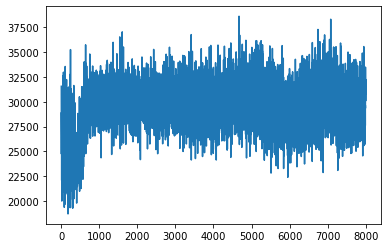

In [260]:
plt.plot(TrainingPortfolio)

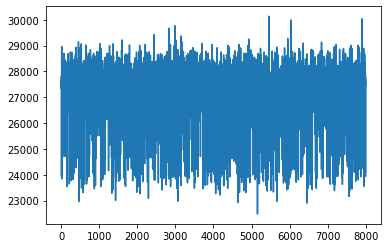

In [261]:
plt.plot(TestPortfolio)

In [262]:
np.mean(TestPortfolio)

27402.622323123924

In [263]:
np.mean(RandomPortfolio)

23176.082820624764

### 20000 Episode

In [264]:
env.reset()

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  1.13490000e+02,  6.33500000e+01,
        5.63500000e+01, -7.80978827e-02, -4.02476780e-01,  8.33628946e-01,
        2.00000000e+04])

In [266]:
gamma = 0.95  # discount rate
epsilon = 1.0  # exploration rate
epsilon_min = 0.01
epsilon_decay = 0.995
num_episodes = 20000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data_new[:n_train].values
test_data = data_new[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay
        
    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_slope_20000_episode.npz", W=W, b=b)

episode: 1/20000, episode end value: 31556.25
episode: 2/20000, episode end value: 28186.30
episode: 3/20000, episode end value: 25494.15
episode: 4/20000, episode end value: 27725.51
episode: 5/20000, episode end value: 24737.11
episode: 6/20000, episode end value: 28927.15
episode: 7/20000, episode end value: 26386.87
episode: 8/20000, episode end value: 27250.67
episode: 9/20000, episode end value: 26570.77
episode: 10/20000, episode end value: 23740.19
episode: 11/20000, episode end value: 22082.07
episode: 12/20000, episode end value: 24010.80
episode: 13/20000, episode end value: 25615.50
episode: 14/20000, episode end value: 19994.46
episode: 15/20000, episode end value: 25249.92
episode: 16/20000, episode end value: 23017.84
episode: 17/20000, episode end value: 25302.54
episode: 18/20000, episode end value: 24151.13
episode: 19/20000, episode end value: 24828.46
episode: 20/20000, episode end value: 24301.49
episode: 21/20000, episode end value: 26254.56
episode: 22/20000, epi

episode: 174/20000, episode end value: 25562.69
episode: 175/20000, episode end value: 27187.78
episode: 176/20000, episode end value: 22599.43
episode: 177/20000, episode end value: 22704.27
episode: 178/20000, episode end value: 18696.22
episode: 179/20000, episode end value: 28173.01
episode: 180/20000, episode end value: 30959.68
episode: 181/20000, episode end value: 29369.92
episode: 182/20000, episode end value: 22510.61
episode: 183/20000, episode end value: 25040.25
episode: 184/20000, episode end value: 20115.54
episode: 185/20000, episode end value: 20422.20
episode: 186/20000, episode end value: 31387.34
episode: 187/20000, episode end value: 25530.13
episode: 188/20000, episode end value: 23272.61
episode: 189/20000, episode end value: 22129.13
episode: 190/20000, episode end value: 25803.91
episode: 191/20000, episode end value: 31478.68
episode: 192/20000, episode end value: 28777.09
episode: 193/20000, episode end value: 20852.82
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 21483.34
episode: 346/20000, episode end value: 28685.61
episode: 347/20000, episode end value: 23689.34
episode: 348/20000, episode end value: 27026.72
episode: 349/20000, episode end value: 24242.78
episode: 350/20000, episode end value: 22130.00
episode: 351/20000, episode end value: 26218.94
episode: 352/20000, episode end value: 25084.90
episode: 353/20000, episode end value: 21117.94
episode: 354/20000, episode end value: 26962.45
episode: 355/20000, episode end value: 26170.53
episode: 356/20000, episode end value: 26609.12
episode: 357/20000, episode end value: 22814.65
episode: 358/20000, episode end value: 24302.20
episode: 359/20000, episode end value: 24402.74
episode: 360/20000, episode end value: 23661.05
episode: 361/20000, episode end value: 23816.32
episode: 362/20000, episode end value: 22587.81
episode: 363/20000, episode end value: 28672.73
episode: 364/20000, episode end value: 23044.51
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 27975.69
episode: 517/20000, episode end value: 28007.28
episode: 518/20000, episode end value: 28814.53
episode: 519/20000, episode end value: 26382.32
episode: 520/20000, episode end value: 27047.25
episode: 521/20000, episode end value: 21258.94
episode: 522/20000, episode end value: 28933.97
episode: 523/20000, episode end value: 24794.20
episode: 524/20000, episode end value: 30324.58
episode: 525/20000, episode end value: 25725.48
episode: 526/20000, episode end value: 24615.64
episode: 527/20000, episode end value: 27224.83
episode: 528/20000, episode end value: 28339.64
episode: 529/20000, episode end value: 28801.53
episode: 530/20000, episode end value: 26261.11
episode: 531/20000, episode end value: 26890.09
episode: 532/20000, episode end value: 29420.29
episode: 533/20000, episode end value: 27494.59
episode: 534/20000, episode end value: 23636.75
episode: 535/20000, episode end value: 26220.93
episode: 536/20000, episode end value: 2

episode: 687/20000, episode end value: 29279.86
episode: 688/20000, episode end value: 31956.40
episode: 689/20000, episode end value: 25745.62
episode: 690/20000, episode end value: 31065.23
episode: 691/20000, episode end value: 30069.83
episode: 692/20000, episode end value: 26795.71
episode: 693/20000, episode end value: 29242.11
episode: 694/20000, episode end value: 29705.27
episode: 695/20000, episode end value: 31899.35
episode: 696/20000, episode end value: 30156.64
episode: 697/20000, episode end value: 30235.28
episode: 698/20000, episode end value: 30890.01
episode: 699/20000, episode end value: 29888.06
episode: 700/20000, episode end value: 30077.38
episode: 701/20000, episode end value: 29805.62
episode: 702/20000, episode end value: 29336.50
episode: 703/20000, episode end value: 30869.94
episode: 704/20000, episode end value: 30016.71
episode: 705/20000, episode end value: 29595.57
episode: 706/20000, episode end value: 29290.90
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 30899.05
episode: 859/20000, episode end value: 32323.01
episode: 860/20000, episode end value: 32272.40
episode: 861/20000, episode end value: 30801.41
episode: 862/20000, episode end value: 31710.74
episode: 863/20000, episode end value: 30845.04
episode: 864/20000, episode end value: 29024.76
episode: 865/20000, episode end value: 32564.23
episode: 866/20000, episode end value: 27191.61
episode: 867/20000, episode end value: 31607.80
episode: 868/20000, episode end value: 28237.13
episode: 869/20000, episode end value: 30809.11
episode: 870/20000, episode end value: 31050.20
episode: 871/20000, episode end value: 28174.68
episode: 872/20000, episode end value: 30559.14
episode: 873/20000, episode end value: 29945.41
episode: 874/20000, episode end value: 30287.24
episode: 875/20000, episode end value: 32932.69
episode: 876/20000, episode end value: 30806.16
episode: 877/20000, episode end value: 31792.35
episode: 878/20000, episode end value: 3

episode: 1029/20000, episode end value: 29944.89
episode: 1030/20000, episode end value: 30578.36
episode: 1031/20000, episode end value: 31366.72
episode: 1032/20000, episode end value: 32371.39
episode: 1033/20000, episode end value: 33632.69
episode: 1034/20000, episode end value: 29956.84
episode: 1035/20000, episode end value: 32900.29
episode: 1036/20000, episode end value: 28146.63
episode: 1037/20000, episode end value: 30909.19
episode: 1038/20000, episode end value: 30969.22
episode: 1039/20000, episode end value: 27394.63
episode: 1040/20000, episode end value: 27535.69
episode: 1041/20000, episode end value: 32476.01
episode: 1042/20000, episode end value: 29693.94
episode: 1043/20000, episode end value: 33137.51
episode: 1044/20000, episode end value: 31257.69
episode: 1045/20000, episode end value: 30325.74
episode: 1046/20000, episode end value: 31364.49
episode: 1047/20000, episode end value: 24350.40
episode: 1048/20000, episode end value: 30742.36
episode: 1049/20000,

episode: 1197/20000, episode end value: 28755.52
episode: 1198/20000, episode end value: 31513.95
episode: 1199/20000, episode end value: 30184.69
episode: 1200/20000, episode end value: 30422.47
episode: 1201/20000, episode end value: 29507.56
episode: 1202/20000, episode end value: 31504.52
episode: 1203/20000, episode end value: 29758.37
episode: 1204/20000, episode end value: 29748.13
episode: 1205/20000, episode end value: 30579.76
episode: 1206/20000, episode end value: 31597.43
episode: 1207/20000, episode end value: 30457.88
episode: 1208/20000, episode end value: 31762.90
episode: 1209/20000, episode end value: 34176.28
episode: 1210/20000, episode end value: 30215.20
episode: 1211/20000, episode end value: 29204.39
episode: 1212/20000, episode end value: 33936.49
episode: 1213/20000, episode end value: 27535.16
episode: 1214/20000, episode end value: 30095.56
episode: 1215/20000, episode end value: 31826.51
episode: 1216/20000, episode end value: 29253.14
episode: 1217/20000,

episode: 1365/20000, episode end value: 29558.97
episode: 1366/20000, episode end value: 27466.19
episode: 1367/20000, episode end value: 30180.24
episode: 1368/20000, episode end value: 30608.12
episode: 1369/20000, episode end value: 29701.73
episode: 1370/20000, episode end value: 28887.83
episode: 1371/20000, episode end value: 30506.79
episode: 1372/20000, episode end value: 26398.46
episode: 1373/20000, episode end value: 29844.85
episode: 1374/20000, episode end value: 28596.21
episode: 1375/20000, episode end value: 30370.89
episode: 1376/20000, episode end value: 29671.29
episode: 1377/20000, episode end value: 25548.39
episode: 1378/20000, episode end value: 28967.93
episode: 1379/20000, episode end value: 28566.60
episode: 1380/20000, episode end value: 29065.16
episode: 1381/20000, episode end value: 28833.60
episode: 1382/20000, episode end value: 29122.97
episode: 1383/20000, episode end value: 31213.61
episode: 1384/20000, episode end value: 28544.48
episode: 1385/20000,

episode: 1533/20000, episode end value: 30930.51
episode: 1534/20000, episode end value: 29648.95
episode: 1535/20000, episode end value: 30558.68
episode: 1536/20000, episode end value: 28149.65
episode: 1537/20000, episode end value: 36530.81
episode: 1538/20000, episode end value: 29429.90
episode: 1539/20000, episode end value: 31056.33
episode: 1540/20000, episode end value: 27988.46
episode: 1541/20000, episode end value: 27590.55
episode: 1542/20000, episode end value: 29596.79
episode: 1543/20000, episode end value: 29346.68
episode: 1544/20000, episode end value: 30429.82
episode: 1545/20000, episode end value: 32671.28
episode: 1546/20000, episode end value: 27810.23
episode: 1547/20000, episode end value: 25566.60
episode: 1548/20000, episode end value: 28883.28
episode: 1549/20000, episode end value: 31352.88
episode: 1550/20000, episode end value: 32434.51
episode: 1551/20000, episode end value: 25256.46
episode: 1552/20000, episode end value: 29418.80
episode: 1553/20000,

episode: 1701/20000, episode end value: 27769.55
episode: 1702/20000, episode end value: 27858.63
episode: 1703/20000, episode end value: 31904.88
episode: 1704/20000, episode end value: 31941.14
episode: 1705/20000, episode end value: 28580.09
episode: 1706/20000, episode end value: 29858.27
episode: 1707/20000, episode end value: 32189.66
episode: 1708/20000, episode end value: 31221.94
episode: 1709/20000, episode end value: 29598.86
episode: 1710/20000, episode end value: 30943.07
episode: 1711/20000, episode end value: 29441.61
episode: 1712/20000, episode end value: 28854.26
episode: 1713/20000, episode end value: 28536.23
episode: 1714/20000, episode end value: 32619.29
episode: 1715/20000, episode end value: 31993.99
episode: 1716/20000, episode end value: 30738.89
episode: 1717/20000, episode end value: 32551.34
episode: 1718/20000, episode end value: 29151.94
episode: 1719/20000, episode end value: 31186.87
episode: 1720/20000, episode end value: 29213.77
episode: 1721/20000,

episode: 1869/20000, episode end value: 31705.20
episode: 1870/20000, episode end value: 29090.89
episode: 1871/20000, episode end value: 31031.14
episode: 1872/20000, episode end value: 29973.77
episode: 1873/20000, episode end value: 27514.08
episode: 1874/20000, episode end value: 31367.01
episode: 1875/20000, episode end value: 30345.59
episode: 1876/20000, episode end value: 31864.22
episode: 1877/20000, episode end value: 29930.72
episode: 1878/20000, episode end value: 26288.05
episode: 1879/20000, episode end value: 30881.90
episode: 1880/20000, episode end value: 31826.58
episode: 1881/20000, episode end value: 30296.27
episode: 1882/20000, episode end value: 29999.75
episode: 1883/20000, episode end value: 28734.23
episode: 1884/20000, episode end value: 25971.05
episode: 1885/20000, episode end value: 30405.23
episode: 1886/20000, episode end value: 29102.25
episode: 1887/20000, episode end value: 29903.76
episode: 1888/20000, episode end value: 30880.71
episode: 1889/20000,

episode: 2037/20000, episode end value: 29971.87
episode: 2038/20000, episode end value: 30007.91
episode: 2039/20000, episode end value: 32663.90
episode: 2040/20000, episode end value: 28183.90
episode: 2041/20000, episode end value: 31012.09
episode: 2042/20000, episode end value: 30577.09
episode: 2043/20000, episode end value: 30050.93
episode: 2044/20000, episode end value: 30560.60
episode: 2045/20000, episode end value: 30418.48
episode: 2046/20000, episode end value: 27942.52
episode: 2047/20000, episode end value: 33058.21
episode: 2048/20000, episode end value: 29597.89
episode: 2049/20000, episode end value: 28487.06
episode: 2050/20000, episode end value: 31412.14
episode: 2051/20000, episode end value: 30183.99
episode: 2052/20000, episode end value: 28299.79
episode: 2053/20000, episode end value: 32589.32
episode: 2054/20000, episode end value: 27875.15
episode: 2055/20000, episode end value: 32136.66
episode: 2056/20000, episode end value: 30299.28
episode: 2057/20000,

episode: 2205/20000, episode end value: 29987.03
episode: 2206/20000, episode end value: 30827.49
episode: 2207/20000, episode end value: 32356.07
episode: 2208/20000, episode end value: 28888.08
episode: 2209/20000, episode end value: 30928.91
episode: 2210/20000, episode end value: 29922.41
episode: 2211/20000, episode end value: 31044.42
episode: 2212/20000, episode end value: 30333.95
episode: 2213/20000, episode end value: 32574.72
episode: 2214/20000, episode end value: 30181.52
episode: 2215/20000, episode end value: 30437.89
episode: 2216/20000, episode end value: 30925.75
episode: 2217/20000, episode end value: 30495.96
episode: 2218/20000, episode end value: 31956.10
episode: 2219/20000, episode end value: 33176.40
episode: 2220/20000, episode end value: 31248.12
episode: 2221/20000, episode end value: 30784.14
episode: 2222/20000, episode end value: 29034.27
episode: 2223/20000, episode end value: 31436.27
episode: 2224/20000, episode end value: 29781.09
episode: 2225/20000,

episode: 2373/20000, episode end value: 30470.69
episode: 2374/20000, episode end value: 31655.97
episode: 2375/20000, episode end value: 31132.01
episode: 2376/20000, episode end value: 32410.97
episode: 2377/20000, episode end value: 31749.46
episode: 2378/20000, episode end value: 31806.62
episode: 2379/20000, episode end value: 29191.57
episode: 2380/20000, episode end value: 28438.86
episode: 2381/20000, episode end value: 31751.83
episode: 2382/20000, episode end value: 32135.05
episode: 2383/20000, episode end value: 29525.31
episode: 2384/20000, episode end value: 28779.62
episode: 2385/20000, episode end value: 30455.97
episode: 2386/20000, episode end value: 31545.41
episode: 2387/20000, episode end value: 28668.96
episode: 2388/20000, episode end value: 29765.32
episode: 2389/20000, episode end value: 27315.75
episode: 2390/20000, episode end value: 32111.66
episode: 2391/20000, episode end value: 30715.38
episode: 2392/20000, episode end value: 29244.52
episode: 2393/20000,

episode: 2541/20000, episode end value: 30070.59
episode: 2542/20000, episode end value: 31787.90
episode: 2543/20000, episode end value: 30262.64
episode: 2544/20000, episode end value: 28750.61
episode: 2545/20000, episode end value: 29338.22
episode: 2546/20000, episode end value: 30169.57
episode: 2547/20000, episode end value: 27835.17
episode: 2548/20000, episode end value: 31868.88
episode: 2549/20000, episode end value: 29995.22
episode: 2550/20000, episode end value: 32293.18
episode: 2551/20000, episode end value: 29896.33
episode: 2552/20000, episode end value: 28523.25
episode: 2553/20000, episode end value: 32453.87
episode: 2554/20000, episode end value: 27932.56
episode: 2555/20000, episode end value: 31188.03
episode: 2556/20000, episode end value: 27643.44
episode: 2557/20000, episode end value: 28776.16
episode: 2558/20000, episode end value: 29473.02
episode: 2559/20000, episode end value: 30160.75
episode: 2560/20000, episode end value: 29935.33
episode: 2561/20000,

episode: 2709/20000, episode end value: 27789.61
episode: 2710/20000, episode end value: 31216.63
episode: 2711/20000, episode end value: 28611.45
episode: 2712/20000, episode end value: 29909.75
episode: 2713/20000, episode end value: 27356.81
episode: 2714/20000, episode end value: 30671.76
episode: 2715/20000, episode end value: 30174.21
episode: 2716/20000, episode end value: 30064.38
episode: 2717/20000, episode end value: 28044.03
episode: 2718/20000, episode end value: 31341.80
episode: 2719/20000, episode end value: 29321.71
episode: 2720/20000, episode end value: 30011.06
episode: 2721/20000, episode end value: 30368.94
episode: 2722/20000, episode end value: 28375.67
episode: 2723/20000, episode end value: 28937.35
episode: 2724/20000, episode end value: 27509.23
episode: 2725/20000, episode end value: 32246.27
episode: 2726/20000, episode end value: 29822.90
episode: 2727/20000, episode end value: 30857.90
episode: 2728/20000, episode end value: 32362.37
episode: 2729/20000,

episode: 2877/20000, episode end value: 29854.78
episode: 2878/20000, episode end value: 33063.96
episode: 2879/20000, episode end value: 30869.92
episode: 2880/20000, episode end value: 32901.97
episode: 2881/20000, episode end value: 28035.62
episode: 2882/20000, episode end value: 29446.50
episode: 2883/20000, episode end value: 31030.29
episode: 2884/20000, episode end value: 27838.23
episode: 2885/20000, episode end value: 30675.54
episode: 2886/20000, episode end value: 29369.39
episode: 2887/20000, episode end value: 29614.26
episode: 2888/20000, episode end value: 32566.99
episode: 2889/20000, episode end value: 30500.62
episode: 2890/20000, episode end value: 28622.83
episode: 2891/20000, episode end value: 29942.52
episode: 2892/20000, episode end value: 32053.31
episode: 2893/20000, episode end value: 28660.39
episode: 2894/20000, episode end value: 30973.86
episode: 2895/20000, episode end value: 29291.02
episode: 2896/20000, episode end value: 32502.15
episode: 2897/20000,

episode: 3045/20000, episode end value: 31502.38
episode: 3046/20000, episode end value: 28142.79
episode: 3047/20000, episode end value: 29713.37
episode: 3048/20000, episode end value: 30481.63
episode: 3049/20000, episode end value: 29509.14
episode: 3050/20000, episode end value: 30331.70
episode: 3051/20000, episode end value: 31296.68
episode: 3052/20000, episode end value: 29362.80
episode: 3053/20000, episode end value: 27752.40
episode: 3054/20000, episode end value: 30632.20
episode: 3055/20000, episode end value: 28777.01
episode: 3056/20000, episode end value: 28485.23
episode: 3057/20000, episode end value: 28756.86
episode: 3058/20000, episode end value: 30110.23
episode: 3059/20000, episode end value: 29665.20
episode: 3060/20000, episode end value: 30203.40
episode: 3061/20000, episode end value: 30009.79
episode: 3062/20000, episode end value: 30216.77
episode: 3063/20000, episode end value: 27094.09
episode: 3064/20000, episode end value: 28154.90
episode: 3065/20000,

episode: 3213/20000, episode end value: 26934.65
episode: 3214/20000, episode end value: 27789.74
episode: 3215/20000, episode end value: 31657.20
episode: 3216/20000, episode end value: 30902.96
episode: 3217/20000, episode end value: 32746.29
episode: 3218/20000, episode end value: 29414.78
episode: 3219/20000, episode end value: 29258.81
episode: 3220/20000, episode end value: 29335.45
episode: 3221/20000, episode end value: 30195.40
episode: 3222/20000, episode end value: 32045.98
episode: 3223/20000, episode end value: 32782.93
episode: 3224/20000, episode end value: 29201.29
episode: 3225/20000, episode end value: 30779.46
episode: 3226/20000, episode end value: 27305.30
episode: 3227/20000, episode end value: 31397.86
episode: 3228/20000, episode end value: 31635.00
episode: 3229/20000, episode end value: 33215.92
episode: 3230/20000, episode end value: 32330.62
episode: 3231/20000, episode end value: 25345.13
episode: 3232/20000, episode end value: 27599.41
episode: 3233/20000,

episode: 3381/20000, episode end value: 28945.27
episode: 3382/20000, episode end value: 28155.11
episode: 3383/20000, episode end value: 27623.69
episode: 3384/20000, episode end value: 26304.26
episode: 3385/20000, episode end value: 27217.35
episode: 3386/20000, episode end value: 27064.26
episode: 3387/20000, episode end value: 27632.65
episode: 3388/20000, episode end value: 26686.68
episode: 3389/20000, episode end value: 29013.16
episode: 3390/20000, episode end value: 29517.92
episode: 3391/20000, episode end value: 28707.27
episode: 3392/20000, episode end value: 32346.65
episode: 3393/20000, episode end value: 32061.38
episode: 3394/20000, episode end value: 33407.38
episode: 3395/20000, episode end value: 31149.76
episode: 3396/20000, episode end value: 27155.14
episode: 3397/20000, episode end value: 28651.82
episode: 3398/20000, episode end value: 31615.73
episode: 3399/20000, episode end value: 29376.37
episode: 3400/20000, episode end value: 30710.94
episode: 3401/20000,

episode: 3549/20000, episode end value: 29037.60
episode: 3550/20000, episode end value: 28350.38
episode: 3551/20000, episode end value: 32511.72
episode: 3552/20000, episode end value: 28188.50
episode: 3553/20000, episode end value: 33269.10
episode: 3554/20000, episode end value: 31374.65
episode: 3555/20000, episode end value: 27448.56
episode: 3556/20000, episode end value: 30380.92
episode: 3557/20000, episode end value: 26682.16
episode: 3558/20000, episode end value: 30015.02
episode: 3559/20000, episode end value: 28638.01
episode: 3560/20000, episode end value: 29147.38
episode: 3561/20000, episode end value: 28488.19
episode: 3562/20000, episode end value: 30785.81
episode: 3563/20000, episode end value: 26886.77
episode: 3564/20000, episode end value: 30688.76
episode: 3565/20000, episode end value: 29116.51
episode: 3566/20000, episode end value: 29092.76
episode: 3567/20000, episode end value: 32942.75
episode: 3568/20000, episode end value: 30911.67
episode: 3569/20000,

episode: 3717/20000, episode end value: 31821.85
episode: 3718/20000, episode end value: 31916.52
episode: 3719/20000, episode end value: 31837.00
episode: 3720/20000, episode end value: 31019.93
episode: 3721/20000, episode end value: 28483.59
episode: 3722/20000, episode end value: 32200.57
episode: 3723/20000, episode end value: 29804.18
episode: 3724/20000, episode end value: 28752.88
episode: 3725/20000, episode end value: 30322.13
episode: 3726/20000, episode end value: 29092.04
episode: 3727/20000, episode end value: 30625.17
episode: 3728/20000, episode end value: 28656.49
episode: 3729/20000, episode end value: 31363.14
episode: 3730/20000, episode end value: 32238.72
episode: 3731/20000, episode end value: 29627.38
episode: 3732/20000, episode end value: 28898.98
episode: 3733/20000, episode end value: 29757.55
episode: 3734/20000, episode end value: 29003.32
episode: 3735/20000, episode end value: 31955.10
episode: 3736/20000, episode end value: 27447.18
episode: 3737/20000,

episode: 3885/20000, episode end value: 32600.08
episode: 3886/20000, episode end value: 27459.67
episode: 3887/20000, episode end value: 30581.99
episode: 3888/20000, episode end value: 32138.76
episode: 3889/20000, episode end value: 28977.41
episode: 3890/20000, episode end value: 28526.80
episode: 3891/20000, episode end value: 28699.47
episode: 3892/20000, episode end value: 29193.54
episode: 3893/20000, episode end value: 35524.09
episode: 3894/20000, episode end value: 28875.36
episode: 3895/20000, episode end value: 29673.06
episode: 3896/20000, episode end value: 28771.08
episode: 3897/20000, episode end value: 32201.56
episode: 3898/20000, episode end value: 30531.69
episode: 3899/20000, episode end value: 32208.71
episode: 3900/20000, episode end value: 33309.42
episode: 3901/20000, episode end value: 28157.99
episode: 3902/20000, episode end value: 29462.37
episode: 3903/20000, episode end value: 29626.01
episode: 3904/20000, episode end value: 31128.09
episode: 3905/20000,

episode: 4053/20000, episode end value: 32047.64
episode: 4054/20000, episode end value: 28459.02
episode: 4055/20000, episode end value: 29841.45
episode: 4056/20000, episode end value: 33926.31
episode: 4057/20000, episode end value: 29175.48
episode: 4058/20000, episode end value: 25191.50
episode: 4059/20000, episode end value: 31837.86
episode: 4060/20000, episode end value: 28839.22
episode: 4061/20000, episode end value: 30581.55
episode: 4062/20000, episode end value: 29618.66
episode: 4063/20000, episode end value: 30202.55
episode: 4064/20000, episode end value: 31333.25
episode: 4065/20000, episode end value: 28902.07
episode: 4066/20000, episode end value: 32188.91
episode: 4067/20000, episode end value: 27285.98
episode: 4068/20000, episode end value: 28812.88
episode: 4069/20000, episode end value: 30220.91
episode: 4070/20000, episode end value: 30423.03
episode: 4071/20000, episode end value: 29178.37
episode: 4072/20000, episode end value: 28614.01
episode: 4073/20000,

episode: 4221/20000, episode end value: 30932.43
episode: 4222/20000, episode end value: 29644.01
episode: 4223/20000, episode end value: 30601.03
episode: 4224/20000, episode end value: 30491.85
episode: 4225/20000, episode end value: 30119.60
episode: 4226/20000, episode end value: 29358.92
episode: 4227/20000, episode end value: 32924.59
episode: 4228/20000, episode end value: 28535.98
episode: 4229/20000, episode end value: 29206.80
episode: 4230/20000, episode end value: 28335.72
episode: 4231/20000, episode end value: 30893.71
episode: 4232/20000, episode end value: 30701.38
episode: 4233/20000, episode end value: 32785.61
episode: 4234/20000, episode end value: 28685.35
episode: 4235/20000, episode end value: 28882.22
episode: 4236/20000, episode end value: 30389.03
episode: 4237/20000, episode end value: 28998.73
episode: 4238/20000, episode end value: 28161.74
episode: 4239/20000, episode end value: 32336.44
episode: 4240/20000, episode end value: 30590.42
episode: 4241/20000,

episode: 4389/20000, episode end value: 33053.06
episode: 4390/20000, episode end value: 31829.09
episode: 4391/20000, episode end value: 33585.05
episode: 4392/20000, episode end value: 26372.66
episode: 4393/20000, episode end value: 31325.90
episode: 4394/20000, episode end value: 29585.68
episode: 4395/20000, episode end value: 30932.40
episode: 4396/20000, episode end value: 30307.49
episode: 4397/20000, episode end value: 29557.96
episode: 4398/20000, episode end value: 30628.53
episode: 4399/20000, episode end value: 29847.79
episode: 4400/20000, episode end value: 30965.22
episode: 4401/20000, episode end value: 28644.58
episode: 4402/20000, episode end value: 30056.75
episode: 4403/20000, episode end value: 30418.63
episode: 4404/20000, episode end value: 27110.33
episode: 4405/20000, episode end value: 29296.51
episode: 4406/20000, episode end value: 27819.39
episode: 4407/20000, episode end value: 28585.40
episode: 4408/20000, episode end value: 29486.10
episode: 4409/20000,

episode: 4557/20000, episode end value: 30131.05
episode: 4558/20000, episode end value: 32811.83
episode: 4559/20000, episode end value: 32434.32
episode: 4560/20000, episode end value: 30499.95
episode: 4561/20000, episode end value: 33121.04
episode: 4562/20000, episode end value: 30768.02
episode: 4563/20000, episode end value: 30992.68
episode: 4564/20000, episode end value: 28481.09
episode: 4565/20000, episode end value: 27386.39
episode: 4566/20000, episode end value: 30415.46
episode: 4567/20000, episode end value: 28977.84
episode: 4568/20000, episode end value: 31886.38
episode: 4569/20000, episode end value: 30542.51
episode: 4570/20000, episode end value: 29357.86
episode: 4571/20000, episode end value: 32356.54
episode: 4572/20000, episode end value: 31602.91
episode: 4573/20000, episode end value: 32914.10
episode: 4574/20000, episode end value: 29764.36
episode: 4575/20000, episode end value: 28166.56
episode: 4576/20000, episode end value: 33585.56
episode: 4577/20000,

episode: 4725/20000, episode end value: 32559.52
episode: 4726/20000, episode end value: 33438.09
episode: 4727/20000, episode end value: 32757.22
episode: 4728/20000, episode end value: 33565.53
episode: 4729/20000, episode end value: 34323.21
episode: 4730/20000, episode end value: 33911.15
episode: 4731/20000, episode end value: 32287.79
episode: 4732/20000, episode end value: 33309.28
episode: 4733/20000, episode end value: 32983.05
episode: 4734/20000, episode end value: 27880.62
episode: 4735/20000, episode end value: 30240.22
episode: 4736/20000, episode end value: 33102.63
episode: 4737/20000, episode end value: 32913.44
episode: 4738/20000, episode end value: 33312.82
episode: 4739/20000, episode end value: 33331.36
episode: 4740/20000, episode end value: 32115.84
episode: 4741/20000, episode end value: 31470.35
episode: 4742/20000, episode end value: 28443.28
episode: 4743/20000, episode end value: 28726.66
episode: 4744/20000, episode end value: 28601.44
episode: 4745/20000,

episode: 4893/20000, episode end value: 29899.50
episode: 4894/20000, episode end value: 31542.70
episode: 4895/20000, episode end value: 28776.21
episode: 4896/20000, episode end value: 30618.16
episode: 4897/20000, episode end value: 26780.15
episode: 4898/20000, episode end value: 29952.03
episode: 4899/20000, episode end value: 29372.16
episode: 4900/20000, episode end value: 31530.54
episode: 4901/20000, episode end value: 28197.93
episode: 4902/20000, episode end value: 31542.70
episode: 4903/20000, episode end value: 27860.41
episode: 4904/20000, episode end value: 29233.10
episode: 4905/20000, episode end value: 33914.88
episode: 4906/20000, episode end value: 28765.91
episode: 4907/20000, episode end value: 31923.27
episode: 4908/20000, episode end value: 30956.66
episode: 4909/20000, episode end value: 30265.55
episode: 4910/20000, episode end value: 31052.73
episode: 4911/20000, episode end value: 32402.83
episode: 4912/20000, episode end value: 30449.49
episode: 4913/20000,

episode: 5061/20000, episode end value: 31964.02
episode: 5062/20000, episode end value: 31466.06
episode: 5063/20000, episode end value: 29725.84
episode: 5064/20000, episode end value: 30483.84
episode: 5065/20000, episode end value: 29290.15
episode: 5066/20000, episode end value: 30850.44
episode: 5067/20000, episode end value: 30460.91
episode: 5068/20000, episode end value: 31193.86
episode: 5069/20000, episode end value: 30161.48
episode: 5070/20000, episode end value: 30922.51
episode: 5071/20000, episode end value: 33445.66
episode: 5072/20000, episode end value: 32086.46
episode: 5073/20000, episode end value: 25710.19
episode: 5074/20000, episode end value: 32706.30
episode: 5075/20000, episode end value: 31456.20
episode: 5076/20000, episode end value: 33267.72
episode: 5077/20000, episode end value: 33262.59
episode: 5078/20000, episode end value: 31523.60
episode: 5079/20000, episode end value: 27613.80
episode: 5080/20000, episode end value: 28574.75
episode: 5081/20000,

episode: 5229/20000, episode end value: 31582.83
episode: 5230/20000, episode end value: 33821.61
episode: 5231/20000, episode end value: 29516.94
episode: 5232/20000, episode end value: 32101.80
episode: 5233/20000, episode end value: 33705.85
episode: 5234/20000, episode end value: 35980.69
episode: 5235/20000, episode end value: 29893.33
episode: 5236/20000, episode end value: 33042.46
episode: 5237/20000, episode end value: 33505.82
episode: 5238/20000, episode end value: 32381.23
episode: 5239/20000, episode end value: 29606.25
episode: 5240/20000, episode end value: 33484.08
episode: 5241/20000, episode end value: 31969.51
episode: 5242/20000, episode end value: 30416.74
episode: 5243/20000, episode end value: 31258.86
episode: 5244/20000, episode end value: 31232.46
episode: 5245/20000, episode end value: 35091.13
episode: 5246/20000, episode end value: 32710.85
episode: 5247/20000, episode end value: 33885.29
episode: 5248/20000, episode end value: 32215.16
episode: 5249/20000,

episode: 5397/20000, episode end value: 26850.63
episode: 5398/20000, episode end value: 31989.03
episode: 5399/20000, episode end value: 28159.04
episode: 5400/20000, episode end value: 30652.93
episode: 5401/20000, episode end value: 27878.98
episode: 5402/20000, episode end value: 25853.89
episode: 5403/20000, episode end value: 26443.15
episode: 5404/20000, episode end value: 27433.56
episode: 5405/20000, episode end value: 25618.01
episode: 5406/20000, episode end value: 32919.08
episode: 5407/20000, episode end value: 31568.23
episode: 5408/20000, episode end value: 34036.53
episode: 5409/20000, episode end value: 29573.02
episode: 5410/20000, episode end value: 27729.46
episode: 5411/20000, episode end value: 31492.86
episode: 5412/20000, episode end value: 30316.51
episode: 5413/20000, episode end value: 29421.52
episode: 5414/20000, episode end value: 24568.98
episode: 5415/20000, episode end value: 27920.28
episode: 5416/20000, episode end value: 29754.26
episode: 5417/20000,

episode: 5565/20000, episode end value: 30442.99
episode: 5566/20000, episode end value: 26913.23
episode: 5567/20000, episode end value: 30750.00
episode: 5568/20000, episode end value: 29646.68
episode: 5569/20000, episode end value: 34273.21
episode: 5570/20000, episode end value: 30978.38
episode: 5571/20000, episode end value: 29276.15
episode: 5572/20000, episode end value: 27959.68
episode: 5573/20000, episode end value: 30304.45
episode: 5574/20000, episode end value: 30123.70
episode: 5575/20000, episode end value: 31332.85
episode: 5576/20000, episode end value: 27815.28
episode: 5577/20000, episode end value: 28040.25
episode: 5578/20000, episode end value: 27239.89
episode: 5579/20000, episode end value: 30003.78
episode: 5580/20000, episode end value: 27750.61
episode: 5581/20000, episode end value: 30495.74
episode: 5582/20000, episode end value: 27438.65
episode: 5583/20000, episode end value: 27613.55
episode: 5584/20000, episode end value: 29011.10
episode: 5585/20000,

episode: 5733/20000, episode end value: 30526.45
episode: 5734/20000, episode end value: 29167.73
episode: 5735/20000, episode end value: 30849.08
episode: 5736/20000, episode end value: 33597.18
episode: 5737/20000, episode end value: 29681.06
episode: 5738/20000, episode end value: 30174.36
episode: 5739/20000, episode end value: 27809.57
episode: 5740/20000, episode end value: 27987.56
episode: 5741/20000, episode end value: 27893.56
episode: 5742/20000, episode end value: 30208.41
episode: 5743/20000, episode end value: 27251.02
episode: 5744/20000, episode end value: 28815.50
episode: 5745/20000, episode end value: 30653.55
episode: 5746/20000, episode end value: 29931.60
episode: 5747/20000, episode end value: 30992.85
episode: 5748/20000, episode end value: 29095.51
episode: 5749/20000, episode end value: 30187.10
episode: 5750/20000, episode end value: 27552.77
episode: 5751/20000, episode end value: 30863.09
episode: 5752/20000, episode end value: 30437.18
episode: 5753/20000,

episode: 5901/20000, episode end value: 26011.19
episode: 5902/20000, episode end value: 31358.65
episode: 5903/20000, episode end value: 28258.53
episode: 5904/20000, episode end value: 27682.59
episode: 5905/20000, episode end value: 29495.01
episode: 5906/20000, episode end value: 28181.26
episode: 5907/20000, episode end value: 29391.04
episode: 5908/20000, episode end value: 28393.51
episode: 5909/20000, episode end value: 30627.69
episode: 5910/20000, episode end value: 29996.80
episode: 5911/20000, episode end value: 29418.78
episode: 5912/20000, episode end value: 28094.61
episode: 5913/20000, episode end value: 25822.75
episode: 5914/20000, episode end value: 31337.03
episode: 5915/20000, episode end value: 30395.32
episode: 5916/20000, episode end value: 29389.69
episode: 5917/20000, episode end value: 29144.92
episode: 5918/20000, episode end value: 28813.61
episode: 5919/20000, episode end value: 31959.87
episode: 5920/20000, episode end value: 28870.05
episode: 5921/20000,

episode: 6069/20000, episode end value: 32129.62
episode: 6070/20000, episode end value: 32693.65
episode: 6071/20000, episode end value: 26431.88
episode: 6072/20000, episode end value: 31194.86
episode: 6073/20000, episode end value: 31693.47
episode: 6074/20000, episode end value: 29967.41
episode: 6075/20000, episode end value: 26494.85
episode: 6076/20000, episode end value: 28478.80
episode: 6077/20000, episode end value: 30361.64
episode: 6078/20000, episode end value: 27654.28
episode: 6079/20000, episode end value: 31041.62
episode: 6080/20000, episode end value: 33015.24
episode: 6081/20000, episode end value: 29753.66
episode: 6082/20000, episode end value: 27718.46
episode: 6083/20000, episode end value: 26565.31
episode: 6084/20000, episode end value: 31045.39
episode: 6085/20000, episode end value: 27948.19
episode: 6086/20000, episode end value: 27137.16
episode: 6087/20000, episode end value: 28911.20
episode: 6088/20000, episode end value: 29765.64
episode: 6089/20000,

episode: 6237/20000, episode end value: 31896.08
episode: 6238/20000, episode end value: 27460.50
episode: 6239/20000, episode end value: 28872.95
episode: 6240/20000, episode end value: 32297.80
episode: 6241/20000, episode end value: 29514.98
episode: 6242/20000, episode end value: 28634.98
episode: 6243/20000, episode end value: 31021.68
episode: 6244/20000, episode end value: 28746.74
episode: 6245/20000, episode end value: 29039.61
episode: 6246/20000, episode end value: 31911.69
episode: 6247/20000, episode end value: 24799.61
episode: 6248/20000, episode end value: 29599.29
episode: 6249/20000, episode end value: 25203.14
episode: 6250/20000, episode end value: 31055.96
episode: 6251/20000, episode end value: 30721.49
episode: 6252/20000, episode end value: 31149.41
episode: 6253/20000, episode end value: 30528.32
episode: 6254/20000, episode end value: 28737.38
episode: 6255/20000, episode end value: 25579.25
episode: 6256/20000, episode end value: 27094.67
episode: 6257/20000,

episode: 6405/20000, episode end value: 29904.88
episode: 6406/20000, episode end value: 25640.17
episode: 6407/20000, episode end value: 27422.38
episode: 6408/20000, episode end value: 25724.69
episode: 6409/20000, episode end value: 28173.07
episode: 6410/20000, episode end value: 31738.47
episode: 6411/20000, episode end value: 33518.38
episode: 6412/20000, episode end value: 29263.89
episode: 6413/20000, episode end value: 27894.82
episode: 6414/20000, episode end value: 30538.81
episode: 6415/20000, episode end value: 29246.01
episode: 6416/20000, episode end value: 28618.92
episode: 6417/20000, episode end value: 28690.62
episode: 6418/20000, episode end value: 28141.97
episode: 6419/20000, episode end value: 26354.48
episode: 6420/20000, episode end value: 28053.97
episode: 6421/20000, episode end value: 28124.75
episode: 6422/20000, episode end value: 28934.32
episode: 6423/20000, episode end value: 30687.74
episode: 6424/20000, episode end value: 34213.63
episode: 6425/20000,

episode: 6573/20000, episode end value: 31708.28
episode: 6574/20000, episode end value: 30785.61
episode: 6575/20000, episode end value: 31875.62
episode: 6576/20000, episode end value: 30584.24
episode: 6577/20000, episode end value: 29067.99
episode: 6578/20000, episode end value: 27903.60
episode: 6579/20000, episode end value: 32786.80
episode: 6580/20000, episode end value: 29962.79
episode: 6581/20000, episode end value: 33321.98
episode: 6582/20000, episode end value: 29427.19
episode: 6583/20000, episode end value: 32130.42
episode: 6584/20000, episode end value: 26077.14
episode: 6585/20000, episode end value: 31826.88
episode: 6586/20000, episode end value: 28443.60
episode: 6587/20000, episode end value: 30624.40
episode: 6588/20000, episode end value: 33581.95
episode: 6589/20000, episode end value: 30926.09
episode: 6590/20000, episode end value: 30425.71
episode: 6591/20000, episode end value: 28623.32
episode: 6592/20000, episode end value: 29774.05
episode: 6593/20000,

episode: 6741/20000, episode end value: 28396.25
episode: 6742/20000, episode end value: 30774.05
episode: 6743/20000, episode end value: 29598.85
episode: 6744/20000, episode end value: 31135.88
episode: 6745/20000, episode end value: 31742.27
episode: 6746/20000, episode end value: 30212.57
episode: 6747/20000, episode end value: 37283.84
episode: 6748/20000, episode end value: 32945.58
episode: 6749/20000, episode end value: 31341.99
episode: 6750/20000, episode end value: 30257.01
episode: 6751/20000, episode end value: 32588.99
episode: 6752/20000, episode end value: 31133.50
episode: 6753/20000, episode end value: 30017.45
episode: 6754/20000, episode end value: 26921.52
episode: 6755/20000, episode end value: 30303.33
episode: 6756/20000, episode end value: 31511.90
episode: 6757/20000, episode end value: 32089.28
episode: 6758/20000, episode end value: 30652.83
episode: 6759/20000, episode end value: 34550.46
episode: 6760/20000, episode end value: 27813.45
episode: 6761/20000,

episode: 6909/20000, episode end value: 35100.05
episode: 6910/20000, episode end value: 29803.76
episode: 6911/20000, episode end value: 29898.94
episode: 6912/20000, episode end value: 29667.12
episode: 6913/20000, episode end value: 36233.44
episode: 6914/20000, episode end value: 31591.63
episode: 6915/20000, episode end value: 30413.58
episode: 6916/20000, episode end value: 30829.01
episode: 6917/20000, episode end value: 31337.29
episode: 6918/20000, episode end value: 29746.85
episode: 6919/20000, episode end value: 31704.08
episode: 6920/20000, episode end value: 33595.01
episode: 6921/20000, episode end value: 36736.09
episode: 6922/20000, episode end value: 32937.89
episode: 6923/20000, episode end value: 31082.89
episode: 6924/20000, episode end value: 30805.30
episode: 6925/20000, episode end value: 32679.40
episode: 6926/20000, episode end value: 31129.29
episode: 6927/20000, episode end value: 27620.33
episode: 6928/20000, episode end value: 28752.61
episode: 6929/20000,

episode: 7077/20000, episode end value: 35117.04
episode: 7078/20000, episode end value: 30268.67
episode: 7079/20000, episode end value: 28403.65
episode: 7080/20000, episode end value: 28315.15
episode: 7081/20000, episode end value: 28237.75
episode: 7082/20000, episode end value: 38314.85
episode: 7083/20000, episode end value: 26502.91
episode: 7084/20000, episode end value: 34661.53
episode: 7085/20000, episode end value: 31252.04
episode: 7086/20000, episode end value: 29206.37
episode: 7087/20000, episode end value: 27245.21
episode: 7088/20000, episode end value: 28203.08
episode: 7089/20000, episode end value: 32285.90
episode: 7090/20000, episode end value: 32300.15
episode: 7091/20000, episode end value: 28536.18
episode: 7092/20000, episode end value: 25639.36
episode: 7093/20000, episode end value: 27499.40
episode: 7094/20000, episode end value: 31340.77
episode: 7095/20000, episode end value: 29861.86
episode: 7096/20000, episode end value: 28374.56
episode: 7097/20000,

episode: 7245/20000, episode end value: 29982.76
episode: 7246/20000, episode end value: 31243.99
episode: 7247/20000, episode end value: 34605.61
episode: 7248/20000, episode end value: 31243.72
episode: 7249/20000, episode end value: 34582.49
episode: 7250/20000, episode end value: 31849.54
episode: 7251/20000, episode end value: 30507.25
episode: 7252/20000, episode end value: 30455.70
episode: 7253/20000, episode end value: 29799.83
episode: 7254/20000, episode end value: 27932.99
episode: 7255/20000, episode end value: 33920.18
episode: 7256/20000, episode end value: 34654.32
episode: 7257/20000, episode end value: 29674.28
episode: 7258/20000, episode end value: 24841.99
episode: 7259/20000, episode end value: 27941.28
episode: 7260/20000, episode end value: 33678.90
episode: 7261/20000, episode end value: 28055.85
episode: 7262/20000, episode end value: 30239.38
episode: 7263/20000, episode end value: 29662.51
episode: 7264/20000, episode end value: 29215.73
episode: 7265/20000,

episode: 7413/20000, episode end value: 33079.53
episode: 7414/20000, episode end value: 30503.50
episode: 7415/20000, episode end value: 26238.59
episode: 7416/20000, episode end value: 30258.88
episode: 7417/20000, episode end value: 30769.52
episode: 7418/20000, episode end value: 30536.45
episode: 7419/20000, episode end value: 32331.01
episode: 7420/20000, episode end value: 30496.19
episode: 7421/20000, episode end value: 32228.26
episode: 7422/20000, episode end value: 29236.26
episode: 7423/20000, episode end value: 30421.23
episode: 7424/20000, episode end value: 28486.42
episode: 7425/20000, episode end value: 29564.54
episode: 7426/20000, episode end value: 31330.84
episode: 7427/20000, episode end value: 27327.77
episode: 7428/20000, episode end value: 30757.52
episode: 7429/20000, episode end value: 31049.06
episode: 7430/20000, episode end value: 28555.59
episode: 7431/20000, episode end value: 32750.67
episode: 7432/20000, episode end value: 31595.99
episode: 7433/20000,

episode: 7581/20000, episode end value: 30469.45
episode: 7582/20000, episode end value: 30562.67
episode: 7583/20000, episode end value: 26205.74
episode: 7584/20000, episode end value: 31990.65
episode: 7585/20000, episode end value: 25892.06
episode: 7586/20000, episode end value: 29959.94
episode: 7587/20000, episode end value: 34742.72
episode: 7588/20000, episode end value: 32052.96
episode: 7589/20000, episode end value: 28036.42
episode: 7590/20000, episode end value: 28263.06
episode: 7591/20000, episode end value: 31500.52
episode: 7592/20000, episode end value: 27678.77
episode: 7593/20000, episode end value: 27062.39
episode: 7594/20000, episode end value: 29702.51
episode: 7595/20000, episode end value: 29825.30
episode: 7596/20000, episode end value: 28373.67
episode: 7597/20000, episode end value: 31825.35
episode: 7598/20000, episode end value: 33878.23
episode: 7599/20000, episode end value: 26220.20
episode: 7600/20000, episode end value: 29405.82
episode: 7601/20000,

episode: 7749/20000, episode end value: 27059.05
episode: 7750/20000, episode end value: 33650.17
episode: 7751/20000, episode end value: 28848.91
episode: 7752/20000, episode end value: 30606.46
episode: 7753/20000, episode end value: 30002.37
episode: 7754/20000, episode end value: 26606.19
episode: 7755/20000, episode end value: 30152.47
episode: 7756/20000, episode end value: 33598.85
episode: 7757/20000, episode end value: 32611.29
episode: 7758/20000, episode end value: 32160.07
episode: 7759/20000, episode end value: 33960.35
episode: 7760/20000, episode end value: 30967.05
episode: 7761/20000, episode end value: 32831.96
episode: 7762/20000, episode end value: 28769.96
episode: 7763/20000, episode end value: 29652.02
episode: 7764/20000, episode end value: 26830.75
episode: 7765/20000, episode end value: 29915.07
episode: 7766/20000, episode end value: 31757.40
episode: 7767/20000, episode end value: 30821.56
episode: 7768/20000, episode end value: 30684.23
episode: 7769/20000,

episode: 7917/20000, episode end value: 31248.05
episode: 7918/20000, episode end value: 32875.81
episode: 7919/20000, episode end value: 32409.02
episode: 7920/20000, episode end value: 30142.72
episode: 7921/20000, episode end value: 28016.60
episode: 7922/20000, episode end value: 27373.29
episode: 7923/20000, episode end value: 24546.00
episode: 7924/20000, episode end value: 28755.88
episode: 7925/20000, episode end value: 31023.48
episode: 7926/20000, episode end value: 27773.56
episode: 7927/20000, episode end value: 30321.95
episode: 7928/20000, episode end value: 28455.72
episode: 7929/20000, episode end value: 31521.22
episode: 7930/20000, episode end value: 27651.43
episode: 7931/20000, episode end value: 30558.12
episode: 7932/20000, episode end value: 29533.66
episode: 7933/20000, episode end value: 32712.39
episode: 7934/20000, episode end value: 29170.62
episode: 7935/20000, episode end value: 29856.99
episode: 7936/20000, episode end value: 30171.97
episode: 7937/20000,

episode: 8085/20000, episode end value: 26923.65
episode: 8086/20000, episode end value: 29426.06
episode: 8087/20000, episode end value: 30196.04
episode: 8088/20000, episode end value: 27746.94
episode: 8089/20000, episode end value: 28966.12
episode: 8090/20000, episode end value: 29508.97
episode: 8091/20000, episode end value: 29239.94
episode: 8092/20000, episode end value: 30171.04
episode: 8093/20000, episode end value: 29221.93
episode: 8094/20000, episode end value: 28335.59
episode: 8095/20000, episode end value: 30110.44
episode: 8096/20000, episode end value: 26779.62
episode: 8097/20000, episode end value: 31106.61
episode: 8098/20000, episode end value: 32720.48
episode: 8099/20000, episode end value: 28908.75
episode: 8100/20000, episode end value: 30865.74
episode: 8101/20000, episode end value: 31023.31
episode: 8102/20000, episode end value: 28995.52
episode: 8103/20000, episode end value: 31150.81
episode: 8104/20000, episode end value: 35147.67
episode: 8105/20000,

episode: 8253/20000, episode end value: 31716.98
episode: 8254/20000, episode end value: 30248.20
episode: 8255/20000, episode end value: 26144.85
episode: 8256/20000, episode end value: 28764.87
episode: 8257/20000, episode end value: 28891.61
episode: 8258/20000, episode end value: 30916.81
episode: 8259/20000, episode end value: 26626.76
episode: 8260/20000, episode end value: 29335.21
episode: 8261/20000, episode end value: 32544.43
episode: 8262/20000, episode end value: 28457.64
episode: 8263/20000, episode end value: 25510.80
episode: 8264/20000, episode end value: 30923.09
episode: 8265/20000, episode end value: 30341.49
episode: 8266/20000, episode end value: 28273.40
episode: 8267/20000, episode end value: 30805.30
episode: 8268/20000, episode end value: 27898.59
episode: 8269/20000, episode end value: 32867.75
episode: 8270/20000, episode end value: 31817.81
episode: 8271/20000, episode end value: 28931.37
episode: 8272/20000, episode end value: 38516.75
episode: 8273/20000,

episode: 8421/20000, episode end value: 30626.31
episode: 8422/20000, episode end value: 30708.28
episode: 8423/20000, episode end value: 31622.67
episode: 8424/20000, episode end value: 29369.66
episode: 8425/20000, episode end value: 28976.02
episode: 8426/20000, episode end value: 24591.35
episode: 8427/20000, episode end value: 30557.18
episode: 8428/20000, episode end value: 32113.63
episode: 8429/20000, episode end value: 29680.41
episode: 8430/20000, episode end value: 31138.67
episode: 8431/20000, episode end value: 25760.72
episode: 8432/20000, episode end value: 30981.07
episode: 8433/20000, episode end value: 30345.68
episode: 8434/20000, episode end value: 30102.12
episode: 8435/20000, episode end value: 32207.77
episode: 8436/20000, episode end value: 29905.44
episode: 8437/20000, episode end value: 29483.48
episode: 8438/20000, episode end value: 31021.79
episode: 8439/20000, episode end value: 31790.95
episode: 8440/20000, episode end value: 30671.20
episode: 8441/20000,

episode: 8589/20000, episode end value: 29178.89
episode: 8590/20000, episode end value: 30032.82
episode: 8591/20000, episode end value: 27875.49
episode: 8592/20000, episode end value: 32132.53
episode: 8593/20000, episode end value: 29947.52
episode: 8594/20000, episode end value: 31029.36
episode: 8595/20000, episode end value: 27407.36
episode: 8596/20000, episode end value: 29970.11
episode: 8597/20000, episode end value: 28553.54
episode: 8598/20000, episode end value: 29435.67
episode: 8599/20000, episode end value: 29416.47
episode: 8600/20000, episode end value: 28106.47
episode: 8601/20000, episode end value: 35699.11
episode: 8602/20000, episode end value: 26972.05
episode: 8603/20000, episode end value: 34232.71
episode: 8604/20000, episode end value: 28700.78
episode: 8605/20000, episode end value: 35352.13
episode: 8606/20000, episode end value: 28108.23
episode: 8607/20000, episode end value: 30274.20
episode: 8608/20000, episode end value: 32770.31
episode: 8609/20000,

episode: 8757/20000, episode end value: 32026.59
episode: 8758/20000, episode end value: 30411.35
episode: 8759/20000, episode end value: 29540.62
episode: 8760/20000, episode end value: 28911.61
episode: 8761/20000, episode end value: 31899.23
episode: 8762/20000, episode end value: 30292.13
episode: 8763/20000, episode end value: 31131.94
episode: 8764/20000, episode end value: 28347.40
episode: 8765/20000, episode end value: 32093.61
episode: 8766/20000, episode end value: 32694.42
episode: 8767/20000, episode end value: 28842.69
episode: 8768/20000, episode end value: 34876.64
episode: 8769/20000, episode end value: 26688.00
episode: 8770/20000, episode end value: 27517.52
episode: 8771/20000, episode end value: 31088.79
episode: 8772/20000, episode end value: 31084.99
episode: 8773/20000, episode end value: 28043.63
episode: 8774/20000, episode end value: 26569.33
episode: 8775/20000, episode end value: 28484.69
episode: 8776/20000, episode end value: 26973.29
episode: 8777/20000,

episode: 8925/20000, episode end value: 23300.92
episode: 8926/20000, episode end value: 28388.44
episode: 8927/20000, episode end value: 32281.55
episode: 8928/20000, episode end value: 26263.97
episode: 8929/20000, episode end value: 29508.32
episode: 8930/20000, episode end value: 33201.51
episode: 8931/20000, episode end value: 29084.38
episode: 8932/20000, episode end value: 30579.01
episode: 8933/20000, episode end value: 27904.43
episode: 8934/20000, episode end value: 29542.00
episode: 8935/20000, episode end value: 25580.96
episode: 8936/20000, episode end value: 31261.40
episode: 8937/20000, episode end value: 31601.86
episode: 8938/20000, episode end value: 29911.55
episode: 8939/20000, episode end value: 32039.70
episode: 8940/20000, episode end value: 27269.54
episode: 8941/20000, episode end value: 31057.09
episode: 8942/20000, episode end value: 30071.14
episode: 8943/20000, episode end value: 31137.42
episode: 8944/20000, episode end value: 28130.62
episode: 8945/20000,

episode: 9093/20000, episode end value: 29776.89
episode: 9094/20000, episode end value: 31722.09
episode: 9095/20000, episode end value: 32694.28
episode: 9096/20000, episode end value: 29359.53
episode: 9097/20000, episode end value: 33298.97
episode: 9098/20000, episode end value: 31211.70
episode: 9099/20000, episode end value: 28105.69
episode: 9100/20000, episode end value: 28359.66
episode: 9101/20000, episode end value: 26927.09
episode: 9102/20000, episode end value: 31074.74
episode: 9103/20000, episode end value: 31020.36
episode: 9104/20000, episode end value: 29692.05
episode: 9105/20000, episode end value: 35080.16
episode: 9106/20000, episode end value: 22432.19
episode: 9107/20000, episode end value: 27580.66
episode: 9108/20000, episode end value: 30503.97
episode: 9109/20000, episode end value: 32482.08
episode: 9110/20000, episode end value: 24297.39
episode: 9111/20000, episode end value: 28328.86
episode: 9112/20000, episode end value: 32279.92
episode: 9113/20000,

episode: 9261/20000, episode end value: 32815.99
episode: 9262/20000, episode end value: 29216.58
episode: 9263/20000, episode end value: 29018.13
episode: 9264/20000, episode end value: 34256.79
episode: 9265/20000, episode end value: 30411.31
episode: 9266/20000, episode end value: 29113.51
episode: 9267/20000, episode end value: 34150.21
episode: 9268/20000, episode end value: 30724.22
episode: 9269/20000, episode end value: 30007.38
episode: 9270/20000, episode end value: 29100.12
episode: 9271/20000, episode end value: 36001.16
episode: 9272/20000, episode end value: 32140.86
episode: 9273/20000, episode end value: 25233.70
episode: 9274/20000, episode end value: 28663.74
episode: 9275/20000, episode end value: 28192.95
episode: 9276/20000, episode end value: 29792.92
episode: 9277/20000, episode end value: 28802.00
episode: 9278/20000, episode end value: 30316.08
episode: 9279/20000, episode end value: 30791.50
episode: 9280/20000, episode end value: 29968.12
episode: 9281/20000,

episode: 9429/20000, episode end value: 30101.03
episode: 9430/20000, episode end value: 28275.40
episode: 9431/20000, episode end value: 32557.87
episode: 9432/20000, episode end value: 28387.64
episode: 9433/20000, episode end value: 30212.20
episode: 9434/20000, episode end value: 28910.94
episode: 9435/20000, episode end value: 28883.29
episode: 9436/20000, episode end value: 27218.06
episode: 9437/20000, episode end value: 27896.61
episode: 9438/20000, episode end value: 24097.78
episode: 9439/20000, episode end value: 30091.28
episode: 9440/20000, episode end value: 28091.52
episode: 9441/20000, episode end value: 28063.48
episode: 9442/20000, episode end value: 37213.02
episode: 9443/20000, episode end value: 28470.66
episode: 9444/20000, episode end value: 30439.30
episode: 9445/20000, episode end value: 28135.03
episode: 9446/20000, episode end value: 28573.60
episode: 9447/20000, episode end value: 29546.99
episode: 9448/20000, episode end value: 30456.19
episode: 9449/20000,

episode: 9597/20000, episode end value: 34663.04
episode: 9598/20000, episode end value: 29573.22
episode: 9599/20000, episode end value: 27200.06
episode: 9600/20000, episode end value: 31931.07
episode: 9601/20000, episode end value: 30316.86
episode: 9602/20000, episode end value: 28077.90
episode: 9603/20000, episode end value: 31545.68
episode: 9604/20000, episode end value: 33301.16
episode: 9605/20000, episode end value: 28375.46
episode: 9606/20000, episode end value: 32770.02
episode: 9607/20000, episode end value: 32430.90
episode: 9608/20000, episode end value: 28264.71
episode: 9609/20000, episode end value: 24546.16
episode: 9610/20000, episode end value: 30487.78
episode: 9611/20000, episode end value: 30316.40
episode: 9612/20000, episode end value: 28634.29
episode: 9613/20000, episode end value: 30730.05
episode: 9614/20000, episode end value: 29372.15
episode: 9615/20000, episode end value: 29462.14
episode: 9616/20000, episode end value: 30141.81
episode: 9617/20000,

episode: 9765/20000, episode end value: 32697.27
episode: 9766/20000, episode end value: 29258.04
episode: 9767/20000, episode end value: 30369.18
episode: 9768/20000, episode end value: 33237.24
episode: 9769/20000, episode end value: 31747.63
episode: 9770/20000, episode end value: 33063.05
episode: 9771/20000, episode end value: 29855.90
episode: 9772/20000, episode end value: 29484.79
episode: 9773/20000, episode end value: 32535.53
episode: 9774/20000, episode end value: 29826.12
episode: 9775/20000, episode end value: 28798.97
episode: 9776/20000, episode end value: 32743.94
episode: 9777/20000, episode end value: 27729.78
episode: 9778/20000, episode end value: 31079.22
episode: 9779/20000, episode end value: 29471.36
episode: 9780/20000, episode end value: 33695.28
episode: 9781/20000, episode end value: 33253.31
episode: 9782/20000, episode end value: 30248.35
episode: 9783/20000, episode end value: 29561.04
episode: 9784/20000, episode end value: 29358.28
episode: 9785/20000,

episode: 9933/20000, episode end value: 28923.42
episode: 9934/20000, episode end value: 37328.87
episode: 9935/20000, episode end value: 28923.92
episode: 9936/20000, episode end value: 29753.01
episode: 9937/20000, episode end value: 33593.76
episode: 9938/20000, episode end value: 32042.03
episode: 9939/20000, episode end value: 33773.09
episode: 9940/20000, episode end value: 31529.11
episode: 9941/20000, episode end value: 34620.15
episode: 9942/20000, episode end value: 31052.04
episode: 9943/20000, episode end value: 33145.84
episode: 9944/20000, episode end value: 30136.39
episode: 9945/20000, episode end value: 33630.12
episode: 9946/20000, episode end value: 31978.49
episode: 9947/20000, episode end value: 34381.31
episode: 9948/20000, episode end value: 29709.12
episode: 9949/20000, episode end value: 30037.52
episode: 9950/20000, episode end value: 32691.21
episode: 9951/20000, episode end value: 28509.25
episode: 9952/20000, episode end value: 33449.21
episode: 9953/20000,

episode: 10099/20000, episode end value: 28697.45
episode: 10100/20000, episode end value: 30328.71
episode: 10101/20000, episode end value: 32470.00
episode: 10102/20000, episode end value: 31638.37
episode: 10103/20000, episode end value: 34094.31
episode: 10104/20000, episode end value: 33606.46
episode: 10105/20000, episode end value: 34294.61
episode: 10106/20000, episode end value: 34705.73
episode: 10107/20000, episode end value: 31771.96
episode: 10108/20000, episode end value: 30084.08
episode: 10109/20000, episode end value: 32368.64
episode: 10110/20000, episode end value: 33451.56
episode: 10111/20000, episode end value: 31729.83
episode: 10112/20000, episode end value: 31527.33
episode: 10113/20000, episode end value: 33657.70
episode: 10114/20000, episode end value: 32351.58
episode: 10115/20000, episode end value: 28786.19
episode: 10116/20000, episode end value: 29121.80
episode: 10117/20000, episode end value: 27696.32
episode: 10118/20000, episode end value: 28975.55


episode: 10263/20000, episode end value: 30724.77
episode: 10264/20000, episode end value: 33087.81
episode: 10265/20000, episode end value: 29777.19
episode: 10266/20000, episode end value: 32289.26
episode: 10267/20000, episode end value: 28463.47
episode: 10268/20000, episode end value: 32454.26
episode: 10269/20000, episode end value: 30086.73
episode: 10270/20000, episode end value: 30325.01
episode: 10271/20000, episode end value: 32359.71
episode: 10272/20000, episode end value: 28759.29
episode: 10273/20000, episode end value: 29544.34
episode: 10274/20000, episode end value: 29820.49
episode: 10275/20000, episode end value: 30496.09
episode: 10276/20000, episode end value: 28558.53
episode: 10277/20000, episode end value: 33865.44
episode: 10278/20000, episode end value: 29670.59
episode: 10279/20000, episode end value: 28630.73
episode: 10280/20000, episode end value: 29269.33
episode: 10281/20000, episode end value: 29901.58
episode: 10282/20000, episode end value: 28993.60


episode: 10427/20000, episode end value: 29063.77
episode: 10428/20000, episode end value: 31497.04
episode: 10429/20000, episode end value: 27912.49
episode: 10430/20000, episode end value: 30938.82
episode: 10431/20000, episode end value: 27857.32
episode: 10432/20000, episode end value: 30561.58
episode: 10433/20000, episode end value: 33640.62
episode: 10434/20000, episode end value: 32004.97
episode: 10435/20000, episode end value: 30998.86
episode: 10436/20000, episode end value: 31763.73
episode: 10437/20000, episode end value: 31851.88
episode: 10438/20000, episode end value: 32937.51
episode: 10439/20000, episode end value: 26120.65
episode: 10440/20000, episode end value: 28103.37
episode: 10441/20000, episode end value: 27661.78
episode: 10442/20000, episode end value: 28485.84
episode: 10443/20000, episode end value: 28116.77
episode: 10444/20000, episode end value: 27706.25
episode: 10445/20000, episode end value: 32704.92
episode: 10446/20000, episode end value: 30459.14


episode: 10591/20000, episode end value: 28201.81
episode: 10592/20000, episode end value: 34088.73
episode: 10593/20000, episode end value: 28984.12
episode: 10594/20000, episode end value: 30684.11
episode: 10595/20000, episode end value: 30650.07
episode: 10596/20000, episode end value: 30418.10
episode: 10597/20000, episode end value: 27807.03
episode: 10598/20000, episode end value: 28392.52
episode: 10599/20000, episode end value: 27369.40
episode: 10600/20000, episode end value: 28879.76
episode: 10601/20000, episode end value: 30331.23
episode: 10602/20000, episode end value: 29644.32
episode: 10603/20000, episode end value: 28576.74
episode: 10604/20000, episode end value: 30883.01
episode: 10605/20000, episode end value: 30039.97
episode: 10606/20000, episode end value: 30794.56
episode: 10607/20000, episode end value: 30194.77
episode: 10608/20000, episode end value: 28036.91
episode: 10609/20000, episode end value: 25704.86
episode: 10610/20000, episode end value: 30086.02


episode: 10755/20000, episode end value: 28364.86
episode: 10756/20000, episode end value: 30544.93
episode: 10757/20000, episode end value: 29980.98
episode: 10758/20000, episode end value: 28498.65
episode: 10759/20000, episode end value: 35372.39
episode: 10760/20000, episode end value: 27695.52
episode: 10761/20000, episode end value: 25654.75
episode: 10762/20000, episode end value: 28932.44
episode: 10763/20000, episode end value: 29449.68
episode: 10764/20000, episode end value: 32349.30
episode: 10765/20000, episode end value: 27744.56
episode: 10766/20000, episode end value: 25507.40
episode: 10767/20000, episode end value: 31108.63
episode: 10768/20000, episode end value: 27329.57
episode: 10769/20000, episode end value: 28980.98
episode: 10770/20000, episode end value: 30711.62
episode: 10771/20000, episode end value: 27962.77
episode: 10772/20000, episode end value: 30548.68
episode: 10773/20000, episode end value: 28660.74
episode: 10774/20000, episode end value: 29098.00


episode: 10919/20000, episode end value: 29073.72
episode: 10920/20000, episode end value: 26908.94
episode: 10921/20000, episode end value: 29691.73
episode: 10922/20000, episode end value: 34423.18
episode: 10923/20000, episode end value: 33175.43
episode: 10924/20000, episode end value: 28218.91
episode: 10925/20000, episode end value: 28647.40
episode: 10926/20000, episode end value: 30666.06
episode: 10927/20000, episode end value: 27523.78
episode: 10928/20000, episode end value: 27300.69
episode: 10929/20000, episode end value: 29301.00
episode: 10930/20000, episode end value: 27771.01
episode: 10931/20000, episode end value: 28374.13
episode: 10932/20000, episode end value: 31913.55
episode: 10933/20000, episode end value: 33024.30
episode: 10934/20000, episode end value: 32003.11
episode: 10935/20000, episode end value: 32361.93
episode: 10936/20000, episode end value: 29358.68
episode: 10937/20000, episode end value: 27045.43
episode: 10938/20000, episode end value: 28697.43


episode: 11083/20000, episode end value: 29815.49
episode: 11084/20000, episode end value: 26069.44
episode: 11085/20000, episode end value: 28071.02
episode: 11086/20000, episode end value: 29496.13
episode: 11087/20000, episode end value: 29270.25
episode: 11088/20000, episode end value: 26588.09
episode: 11089/20000, episode end value: 31784.32
episode: 11090/20000, episode end value: 24907.77
episode: 11091/20000, episode end value: 25090.71
episode: 11092/20000, episode end value: 31216.91
episode: 11093/20000, episode end value: 32629.10
episode: 11094/20000, episode end value: 33371.20
episode: 11095/20000, episode end value: 33361.80
episode: 11096/20000, episode end value: 31959.70
episode: 11097/20000, episode end value: 31860.14
episode: 11098/20000, episode end value: 34012.24
episode: 11099/20000, episode end value: 29696.30
episode: 11100/20000, episode end value: 31758.48
episode: 11101/20000, episode end value: 29906.86
episode: 11102/20000, episode end value: 33492.54


episode: 11247/20000, episode end value: 31951.41
episode: 11248/20000, episode end value: 34302.29
episode: 11249/20000, episode end value: 28155.98
episode: 11250/20000, episode end value: 27306.72
episode: 11251/20000, episode end value: 32312.50
episode: 11252/20000, episode end value: 25239.54
episode: 11253/20000, episode end value: 29965.86
episode: 11254/20000, episode end value: 28048.08
episode: 11255/20000, episode end value: 28332.38
episode: 11256/20000, episode end value: 25739.05
episode: 11257/20000, episode end value: 25039.88
episode: 11258/20000, episode end value: 26902.31
episode: 11259/20000, episode end value: 25668.91
episode: 11260/20000, episode end value: 29053.94
episode: 11261/20000, episode end value: 30777.70
episode: 11262/20000, episode end value: 24957.94
episode: 11263/20000, episode end value: 30027.19
episode: 11264/20000, episode end value: 31889.04
episode: 11265/20000, episode end value: 26521.55
episode: 11266/20000, episode end value: 26212.20


episode: 11411/20000, episode end value: 29517.83
episode: 11412/20000, episode end value: 29916.19
episode: 11413/20000, episode end value: 29173.78
episode: 11414/20000, episode end value: 27430.57
episode: 11415/20000, episode end value: 30045.63
episode: 11416/20000, episode end value: 27838.71
episode: 11417/20000, episode end value: 28812.84
episode: 11418/20000, episode end value: 27023.58
episode: 11419/20000, episode end value: 29844.18
episode: 11420/20000, episode end value: 30728.19
episode: 11421/20000, episode end value: 28813.81
episode: 11422/20000, episode end value: 26393.26
episode: 11423/20000, episode end value: 29123.05
episode: 11424/20000, episode end value: 30398.82
episode: 11425/20000, episode end value: 28715.37
episode: 11426/20000, episode end value: 26686.50
episode: 11427/20000, episode end value: 31238.72
episode: 11428/20000, episode end value: 27811.28
episode: 11429/20000, episode end value: 28902.32
episode: 11430/20000, episode end value: 26093.25


episode: 11575/20000, episode end value: 28300.21
episode: 11576/20000, episode end value: 26447.98
episode: 11577/20000, episode end value: 27965.66
episode: 11578/20000, episode end value: 33801.43
episode: 11579/20000, episode end value: 34775.07
episode: 11580/20000, episode end value: 32883.05
episode: 11581/20000, episode end value: 28481.24
episode: 11582/20000, episode end value: 30303.53
episode: 11583/20000, episode end value: 31271.00
episode: 11584/20000, episode end value: 31599.76
episode: 11585/20000, episode end value: 27458.56
episode: 11586/20000, episode end value: 33397.51
episode: 11587/20000, episode end value: 26116.61
episode: 11588/20000, episode end value: 24718.33
episode: 11589/20000, episode end value: 28853.87
episode: 11590/20000, episode end value: 28905.35
episode: 11591/20000, episode end value: 34752.54
episode: 11592/20000, episode end value: 28097.78
episode: 11593/20000, episode end value: 27872.75
episode: 11594/20000, episode end value: 27770.59


episode: 11739/20000, episode end value: 34454.18
episode: 11740/20000, episode end value: 27908.91
episode: 11741/20000, episode end value: 35948.46
episode: 11742/20000, episode end value: 31292.17
episode: 11743/20000, episode end value: 30163.97
episode: 11744/20000, episode end value: 33854.78
episode: 11745/20000, episode end value: 29108.26
episode: 11746/20000, episode end value: 26225.15
episode: 11747/20000, episode end value: 30119.73
episode: 11748/20000, episode end value: 32991.97
episode: 11749/20000, episode end value: 32399.18
episode: 11750/20000, episode end value: 22576.19
episode: 11751/20000, episode end value: 27423.59
episode: 11752/20000, episode end value: 27072.07
episode: 11753/20000, episode end value: 29570.77
episode: 11754/20000, episode end value: 27159.07
episode: 11755/20000, episode end value: 28015.45
episode: 11756/20000, episode end value: 29613.44
episode: 11757/20000, episode end value: 30222.25
episode: 11758/20000, episode end value: 30980.25


episode: 11903/20000, episode end value: 29905.78
episode: 11904/20000, episode end value: 32468.13
episode: 11905/20000, episode end value: 32968.09
episode: 11906/20000, episode end value: 27186.56
episode: 11907/20000, episode end value: 32958.89
episode: 11908/20000, episode end value: 27588.85
episode: 11909/20000, episode end value: 32732.05
episode: 11910/20000, episode end value: 28305.41
episode: 11911/20000, episode end value: 32177.68
episode: 11912/20000, episode end value: 31928.01
episode: 11913/20000, episode end value: 26585.52
episode: 11914/20000, episode end value: 30117.59
episode: 11915/20000, episode end value: 29283.88
episode: 11916/20000, episode end value: 29765.13
episode: 11917/20000, episode end value: 28666.33
episode: 11918/20000, episode end value: 28325.59
episode: 11919/20000, episode end value: 27648.84
episode: 11920/20000, episode end value: 33960.75
episode: 11921/20000, episode end value: 29171.06
episode: 11922/20000, episode end value: 32122.50


episode: 12067/20000, episode end value: 28793.92
episode: 12068/20000, episode end value: 31590.51
episode: 12069/20000, episode end value: 31735.99
episode: 12070/20000, episode end value: 23705.71
episode: 12071/20000, episode end value: 28763.79
episode: 12072/20000, episode end value: 31671.15
episode: 12073/20000, episode end value: 31477.87
episode: 12074/20000, episode end value: 28302.32
episode: 12075/20000, episode end value: 31223.77
episode: 12076/20000, episode end value: 28376.75
episode: 12077/20000, episode end value: 31991.34
episode: 12078/20000, episode end value: 27148.07
episode: 12079/20000, episode end value: 28893.21
episode: 12080/20000, episode end value: 30848.27
episode: 12081/20000, episode end value: 29492.75
episode: 12082/20000, episode end value: 28818.70
episode: 12083/20000, episode end value: 29109.70
episode: 12084/20000, episode end value: 28879.90
episode: 12085/20000, episode end value: 28167.92
episode: 12086/20000, episode end value: 29333.03


episode: 12231/20000, episode end value: 31051.09
episode: 12232/20000, episode end value: 31568.70
episode: 12233/20000, episode end value: 31631.54
episode: 12234/20000, episode end value: 28958.54
episode: 12235/20000, episode end value: 32573.68
episode: 12236/20000, episode end value: 28553.20
episode: 12237/20000, episode end value: 25555.94
episode: 12238/20000, episode end value: 31610.98
episode: 12239/20000, episode end value: 31877.16
episode: 12240/20000, episode end value: 31591.92
episode: 12241/20000, episode end value: 29760.08
episode: 12242/20000, episode end value: 29723.38
episode: 12243/20000, episode end value: 29000.03
episode: 12244/20000, episode end value: 28091.53
episode: 12245/20000, episode end value: 34587.65
episode: 12246/20000, episode end value: 29088.35
episode: 12247/20000, episode end value: 25904.31
episode: 12248/20000, episode end value: 28602.22
episode: 12249/20000, episode end value: 31121.46
episode: 12250/20000, episode end value: 36855.24


episode: 12395/20000, episode end value: 32663.78
episode: 12396/20000, episode end value: 26923.81
episode: 12397/20000, episode end value: 28180.02
episode: 12398/20000, episode end value: 31117.46
episode: 12399/20000, episode end value: 33079.42
episode: 12400/20000, episode end value: 29902.36
episode: 12401/20000, episode end value: 32782.39
episode: 12402/20000, episode end value: 26007.97
episode: 12403/20000, episode end value: 29217.21
episode: 12404/20000, episode end value: 25895.02
episode: 12405/20000, episode end value: 28003.07
episode: 12406/20000, episode end value: 32858.29
episode: 12407/20000, episode end value: 32478.08
episode: 12408/20000, episode end value: 29889.68
episode: 12409/20000, episode end value: 31060.68
episode: 12410/20000, episode end value: 31016.11
episode: 12411/20000, episode end value: 29417.67
episode: 12412/20000, episode end value: 30711.38
episode: 12413/20000, episode end value: 29920.13
episode: 12414/20000, episode end value: 31561.00


episode: 12559/20000, episode end value: 28453.53
episode: 12560/20000, episode end value: 26021.68
episode: 12561/20000, episode end value: 33175.22
episode: 12562/20000, episode end value: 32951.13
episode: 12563/20000, episode end value: 29943.50
episode: 12564/20000, episode end value: 29187.86
episode: 12565/20000, episode end value: 29171.52
episode: 12566/20000, episode end value: 30347.31
episode: 12567/20000, episode end value: 29319.81
episode: 12568/20000, episode end value: 27769.27
episode: 12569/20000, episode end value: 27681.17
episode: 12570/20000, episode end value: 30400.69
episode: 12571/20000, episode end value: 29988.59
episode: 12572/20000, episode end value: 29068.03
episode: 12573/20000, episode end value: 27785.64
episode: 12574/20000, episode end value: 32146.69
episode: 12575/20000, episode end value: 29349.48
episode: 12576/20000, episode end value: 33487.87
episode: 12577/20000, episode end value: 27197.00
episode: 12578/20000, episode end value: 29589.15


episode: 12723/20000, episode end value: 29206.72
episode: 12724/20000, episode end value: 30384.10
episode: 12725/20000, episode end value: 29333.83
episode: 12726/20000, episode end value: 29861.79
episode: 12727/20000, episode end value: 32611.00
episode: 12728/20000, episode end value: 31164.29
episode: 12729/20000, episode end value: 33493.67
episode: 12730/20000, episode end value: 31915.36
episode: 12731/20000, episode end value: 28878.60
episode: 12732/20000, episode end value: 29665.42
episode: 12733/20000, episode end value: 25502.04
episode: 12734/20000, episode end value: 27564.79
episode: 12735/20000, episode end value: 28102.37
episode: 12736/20000, episode end value: 27686.77
episode: 12737/20000, episode end value: 27507.38
episode: 12738/20000, episode end value: 29530.21
episode: 12739/20000, episode end value: 26311.21
episode: 12740/20000, episode end value: 27864.66
episode: 12741/20000, episode end value: 33458.54
episode: 12742/20000, episode end value: 29961.01


episode: 12887/20000, episode end value: 31326.66
episode: 12888/20000, episode end value: 28879.40
episode: 12889/20000, episode end value: 31106.29
episode: 12890/20000, episode end value: 30140.55
episode: 12891/20000, episode end value: 31599.08
episode: 12892/20000, episode end value: 31215.97
episode: 12893/20000, episode end value: 30126.85
episode: 12894/20000, episode end value: 28857.62
episode: 12895/20000, episode end value: 30220.12
episode: 12896/20000, episode end value: 29257.81
episode: 12897/20000, episode end value: 29281.07
episode: 12898/20000, episode end value: 30394.24
episode: 12899/20000, episode end value: 31951.50
episode: 12900/20000, episode end value: 31006.76
episode: 12901/20000, episode end value: 29954.77
episode: 12902/20000, episode end value: 30078.44
episode: 12903/20000, episode end value: 36415.41
episode: 12904/20000, episode end value: 30466.79
episode: 12905/20000, episode end value: 32694.29
episode: 12906/20000, episode end value: 31372.28


episode: 13051/20000, episode end value: 29317.00
episode: 13052/20000, episode end value: 32444.17
episode: 13053/20000, episode end value: 32191.12
episode: 13054/20000, episode end value: 26943.70
episode: 13055/20000, episode end value: 29526.40
episode: 13056/20000, episode end value: 34038.93
episode: 13057/20000, episode end value: 25732.80
episode: 13058/20000, episode end value: 26242.31
episode: 13059/20000, episode end value: 23211.58
episode: 13060/20000, episode end value: 30014.97
episode: 13061/20000, episode end value: 30507.10
episode: 13062/20000, episode end value: 27994.55
episode: 13063/20000, episode end value: 29338.01
episode: 13064/20000, episode end value: 29074.88
episode: 13065/20000, episode end value: 31842.92
episode: 13066/20000, episode end value: 32575.71
episode: 13067/20000, episode end value: 32523.36
episode: 13068/20000, episode end value: 29887.16
episode: 13069/20000, episode end value: 28130.85
episode: 13070/20000, episode end value: 34498.11


episode: 13215/20000, episode end value: 28921.65
episode: 13216/20000, episode end value: 26616.15
episode: 13217/20000, episode end value: 27355.36
episode: 13218/20000, episode end value: 24789.43
episode: 13219/20000, episode end value: 23808.89
episode: 13220/20000, episode end value: 31856.70
episode: 13221/20000, episode end value: 24457.43
episode: 13222/20000, episode end value: 26876.70
episode: 13223/20000, episode end value: 27916.42
episode: 13224/20000, episode end value: 25501.73
episode: 13225/20000, episode end value: 26943.61
episode: 13226/20000, episode end value: 25734.47
episode: 13227/20000, episode end value: 30507.46
episode: 13228/20000, episode end value: 25867.70
episode: 13229/20000, episode end value: 31026.47
episode: 13230/20000, episode end value: 30311.94
episode: 13231/20000, episode end value: 25179.09
episode: 13232/20000, episode end value: 34040.22
episode: 13233/20000, episode end value: 23474.40
episode: 13234/20000, episode end value: 31652.62


episode: 13379/20000, episode end value: 28836.44
episode: 13380/20000, episode end value: 28342.99
episode: 13381/20000, episode end value: 27251.09
episode: 13382/20000, episode end value: 26322.85
episode: 13383/20000, episode end value: 29393.38
episode: 13384/20000, episode end value: 31868.61
episode: 13385/20000, episode end value: 28582.63
episode: 13386/20000, episode end value: 26814.17
episode: 13387/20000, episode end value: 28401.53
episode: 13388/20000, episode end value: 26705.85
episode: 13389/20000, episode end value: 30230.37
episode: 13390/20000, episode end value: 26414.33
episode: 13391/20000, episode end value: 27992.90
episode: 13392/20000, episode end value: 27473.05
episode: 13393/20000, episode end value: 27314.37
episode: 13394/20000, episode end value: 30497.03
episode: 13395/20000, episode end value: 27292.41
episode: 13396/20000, episode end value: 32133.52
episode: 13397/20000, episode end value: 23549.55
episode: 13398/20000, episode end value: 25793.01


episode: 13543/20000, episode end value: 25622.14
episode: 13544/20000, episode end value: 30931.25
episode: 13545/20000, episode end value: 30005.17
episode: 13546/20000, episode end value: 27340.98
episode: 13547/20000, episode end value: 23069.91
episode: 13548/20000, episode end value: 25211.12
episode: 13549/20000, episode end value: 30422.56
episode: 13550/20000, episode end value: 29832.76
episode: 13551/20000, episode end value: 30474.60
episode: 13552/20000, episode end value: 32368.60
episode: 13553/20000, episode end value: 29062.63
episode: 13554/20000, episode end value: 28584.09
episode: 13555/20000, episode end value: 29314.74
episode: 13556/20000, episode end value: 25827.46
episode: 13557/20000, episode end value: 26569.47
episode: 13558/20000, episode end value: 27837.99
episode: 13559/20000, episode end value: 28969.87
episode: 13560/20000, episode end value: 32767.73
episode: 13561/20000, episode end value: 28316.02
episode: 13562/20000, episode end value: 27750.58


episode: 13707/20000, episode end value: 33088.38
episode: 13708/20000, episode end value: 30389.22
episode: 13709/20000, episode end value: 27129.23
episode: 13710/20000, episode end value: 26131.76
episode: 13711/20000, episode end value: 27307.02
episode: 13712/20000, episode end value: 27749.51
episode: 13713/20000, episode end value: 30630.36
episode: 13714/20000, episode end value: 27096.17
episode: 13715/20000, episode end value: 25425.60
episode: 13716/20000, episode end value: 28130.45
episode: 13717/20000, episode end value: 29807.57
episode: 13718/20000, episode end value: 29692.64
episode: 13719/20000, episode end value: 26890.64
episode: 13720/20000, episode end value: 30047.72
episode: 13721/20000, episode end value: 29626.66
episode: 13722/20000, episode end value: 29871.56
episode: 13723/20000, episode end value: 25403.13
episode: 13724/20000, episode end value: 24537.36
episode: 13725/20000, episode end value: 31339.39
episode: 13726/20000, episode end value: 32464.39


episode: 13871/20000, episode end value: 26428.14
episode: 13872/20000, episode end value: 27408.65
episode: 13873/20000, episode end value: 29465.05
episode: 13874/20000, episode end value: 30779.02
episode: 13875/20000, episode end value: 25987.11
episode: 13876/20000, episode end value: 25309.75
episode: 13877/20000, episode end value: 26636.73
episode: 13878/20000, episode end value: 32683.74
episode: 13879/20000, episode end value: 29531.68
episode: 13880/20000, episode end value: 31017.48
episode: 13881/20000, episode end value: 32119.18
episode: 13882/20000, episode end value: 28629.19
episode: 13883/20000, episode end value: 27088.54
episode: 13884/20000, episode end value: 29939.57
episode: 13885/20000, episode end value: 24229.76
episode: 13886/20000, episode end value: 28108.12
episode: 13887/20000, episode end value: 26448.95
episode: 13888/20000, episode end value: 27820.92
episode: 13889/20000, episode end value: 29106.23
episode: 13890/20000, episode end value: 29785.44


episode: 14035/20000, episode end value: 26890.24
episode: 14036/20000, episode end value: 28595.97
episode: 14037/20000, episode end value: 28385.52
episode: 14038/20000, episode end value: 28925.76
episode: 14039/20000, episode end value: 26240.80
episode: 14040/20000, episode end value: 30225.11
episode: 14041/20000, episode end value: 28898.07
episode: 14042/20000, episode end value: 32536.70
episode: 14043/20000, episode end value: 24891.89
episode: 14044/20000, episode end value: 29421.78
episode: 14045/20000, episode end value: 27352.70
episode: 14046/20000, episode end value: 28381.39
episode: 14047/20000, episode end value: 29992.07
episode: 14048/20000, episode end value: 27045.54
episode: 14049/20000, episode end value: 28277.71
episode: 14050/20000, episode end value: 29379.10
episode: 14051/20000, episode end value: 27014.44
episode: 14052/20000, episode end value: 26483.18
episode: 14053/20000, episode end value: 31112.92
episode: 14054/20000, episode end value: 30370.47


episode: 14199/20000, episode end value: 28543.45
episode: 14200/20000, episode end value: 32857.06
episode: 14201/20000, episode end value: 27092.40
episode: 14202/20000, episode end value: 28728.62
episode: 14203/20000, episode end value: 30881.81
episode: 14204/20000, episode end value: 26564.24
episode: 14205/20000, episode end value: 28066.03
episode: 14206/20000, episode end value: 27874.13
episode: 14207/20000, episode end value: 26760.75
episode: 14208/20000, episode end value: 27018.84
episode: 14209/20000, episode end value: 28841.49
episode: 14210/20000, episode end value: 28585.95
episode: 14211/20000, episode end value: 29957.26
episode: 14212/20000, episode end value: 26452.11
episode: 14213/20000, episode end value: 29465.00
episode: 14214/20000, episode end value: 33275.47
episode: 14215/20000, episode end value: 29533.98
episode: 14216/20000, episode end value: 27327.22
episode: 14217/20000, episode end value: 28360.51
episode: 14218/20000, episode end value: 29714.00


episode: 14363/20000, episode end value: 25063.63
episode: 14364/20000, episode end value: 28549.87
episode: 14365/20000, episode end value: 29910.02
episode: 14366/20000, episode end value: 28422.44
episode: 14367/20000, episode end value: 27985.47
episode: 14368/20000, episode end value: 26204.65
episode: 14369/20000, episode end value: 30435.46
episode: 14370/20000, episode end value: 27081.72
episode: 14371/20000, episode end value: 29808.89
episode: 14372/20000, episode end value: 26570.04
episode: 14373/20000, episode end value: 28295.11
episode: 14374/20000, episode end value: 29429.69
episode: 14375/20000, episode end value: 27777.72
episode: 14376/20000, episode end value: 27383.48
episode: 14377/20000, episode end value: 28140.24
episode: 14378/20000, episode end value: 32798.79
episode: 14379/20000, episode end value: 29800.43
episode: 14380/20000, episode end value: 30766.80
episode: 14381/20000, episode end value: 26951.80
episode: 14382/20000, episode end value: 28055.62


episode: 14527/20000, episode end value: 33319.52
episode: 14528/20000, episode end value: 26739.59
episode: 14529/20000, episode end value: 27443.98
episode: 14530/20000, episode end value: 28477.83
episode: 14531/20000, episode end value: 29329.80
episode: 14532/20000, episode end value: 31445.40
episode: 14533/20000, episode end value: 30366.16
episode: 14534/20000, episode end value: 29421.39
episode: 14535/20000, episode end value: 27681.45
episode: 14536/20000, episode end value: 29626.07
episode: 14537/20000, episode end value: 23749.86
episode: 14538/20000, episode end value: 28783.88
episode: 14539/20000, episode end value: 29759.98
episode: 14540/20000, episode end value: 31044.49
episode: 14541/20000, episode end value: 29829.47
episode: 14542/20000, episode end value: 27113.01
episode: 14543/20000, episode end value: 24956.79
episode: 14544/20000, episode end value: 27666.79
episode: 14545/20000, episode end value: 28399.28
episode: 14546/20000, episode end value: 28862.46


episode: 14691/20000, episode end value: 26193.12
episode: 14692/20000, episode end value: 26989.53
episode: 14693/20000, episode end value: 29134.51
episode: 14694/20000, episode end value: 26531.48
episode: 14695/20000, episode end value: 29759.72
episode: 14696/20000, episode end value: 25456.24
episode: 14697/20000, episode end value: 29166.80
episode: 14698/20000, episode end value: 25008.52
episode: 14699/20000, episode end value: 28813.74
episode: 14700/20000, episode end value: 27076.67
episode: 14701/20000, episode end value: 28819.79
episode: 14702/20000, episode end value: 26130.53
episode: 14703/20000, episode end value: 28060.18
episode: 14704/20000, episode end value: 27005.84
episode: 14705/20000, episode end value: 25441.05
episode: 14706/20000, episode end value: 26079.93
episode: 14707/20000, episode end value: 26606.24
episode: 14708/20000, episode end value: 26061.24
episode: 14709/20000, episode end value: 26607.44
episode: 14710/20000, episode end value: 28119.47


episode: 14855/20000, episode end value: 29613.21
episode: 14856/20000, episode end value: 30548.68
episode: 14857/20000, episode end value: 25050.59
episode: 14858/20000, episode end value: 27329.77
episode: 14859/20000, episode end value: 27082.34
episode: 14860/20000, episode end value: 29158.48
episode: 14861/20000, episode end value: 29114.07
episode: 14862/20000, episode end value: 26597.69
episode: 14863/20000, episode end value: 27959.66
episode: 14864/20000, episode end value: 29918.14
episode: 14865/20000, episode end value: 28457.65
episode: 14866/20000, episode end value: 26894.16
episode: 14867/20000, episode end value: 28567.34
episode: 14868/20000, episode end value: 26908.41
episode: 14869/20000, episode end value: 29224.04
episode: 14870/20000, episode end value: 26868.08
episode: 14871/20000, episode end value: 26093.09
episode: 14872/20000, episode end value: 27887.73
episode: 14873/20000, episode end value: 29353.74
episode: 14874/20000, episode end value: 26580.27


episode: 15019/20000, episode end value: 30320.73
episode: 15020/20000, episode end value: 30788.14
episode: 15021/20000, episode end value: 27385.76
episode: 15022/20000, episode end value: 33247.42
episode: 15023/20000, episode end value: 26830.68
episode: 15024/20000, episode end value: 28865.17
episode: 15025/20000, episode end value: 30187.33
episode: 15026/20000, episode end value: 26826.05
episode: 15027/20000, episode end value: 29281.79
episode: 15028/20000, episode end value: 27507.94
episode: 15029/20000, episode end value: 28822.01
episode: 15030/20000, episode end value: 25652.75
episode: 15031/20000, episode end value: 29294.84
episode: 15032/20000, episode end value: 28875.06
episode: 15033/20000, episode end value: 26247.08
episode: 15034/20000, episode end value: 27076.56
episode: 15035/20000, episode end value: 28502.08
episode: 15036/20000, episode end value: 29745.19
episode: 15037/20000, episode end value: 26695.68
episode: 15038/20000, episode end value: 28586.08


episode: 15183/20000, episode end value: 26499.78
episode: 15184/20000, episode end value: 32409.59
episode: 15185/20000, episode end value: 33130.45
episode: 15186/20000, episode end value: 25577.51
episode: 15187/20000, episode end value: 26318.17
episode: 15188/20000, episode end value: 27259.15
episode: 15189/20000, episode end value: 26909.42
episode: 15190/20000, episode end value: 26236.44
episode: 15191/20000, episode end value: 26553.64
episode: 15192/20000, episode end value: 30600.65
episode: 15193/20000, episode end value: 27047.74
episode: 15194/20000, episode end value: 26048.85
episode: 15195/20000, episode end value: 29396.88
episode: 15196/20000, episode end value: 28425.30
episode: 15197/20000, episode end value: 29866.86
episode: 15198/20000, episode end value: 28849.71
episode: 15199/20000, episode end value: 26512.23
episode: 15200/20000, episode end value: 32510.92
episode: 15201/20000, episode end value: 25657.12
episode: 15202/20000, episode end value: 26546.88


episode: 15347/20000, episode end value: 25945.22
episode: 15348/20000, episode end value: 30983.81
episode: 15349/20000, episode end value: 26019.40
episode: 15350/20000, episode end value: 25137.08
episode: 15351/20000, episode end value: 26957.41
episode: 15352/20000, episode end value: 29078.31
episode: 15353/20000, episode end value: 28009.64
episode: 15354/20000, episode end value: 27155.14
episode: 15355/20000, episode end value: 27536.80
episode: 15356/20000, episode end value: 30048.86
episode: 15357/20000, episode end value: 27871.73
episode: 15358/20000, episode end value: 28101.44
episode: 15359/20000, episode end value: 27910.58
episode: 15360/20000, episode end value: 31299.09
episode: 15361/20000, episode end value: 26000.57
episode: 15362/20000, episode end value: 36061.20
episode: 15363/20000, episode end value: 31347.03
episode: 15364/20000, episode end value: 27461.44
episode: 15365/20000, episode end value: 29762.31
episode: 15366/20000, episode end value: 29127.97


episode: 15511/20000, episode end value: 26858.81
episode: 15512/20000, episode end value: 30157.95
episode: 15513/20000, episode end value: 29784.82
episode: 15514/20000, episode end value: 27903.77
episode: 15515/20000, episode end value: 25717.50
episode: 15516/20000, episode end value: 28840.04
episode: 15517/20000, episode end value: 27851.54
episode: 15518/20000, episode end value: 27573.60
episode: 15519/20000, episode end value: 34286.10
episode: 15520/20000, episode end value: 29424.24
episode: 15521/20000, episode end value: 31511.85
episode: 15522/20000, episode end value: 25397.08
episode: 15523/20000, episode end value: 25463.99
episode: 15524/20000, episode end value: 25235.39
episode: 15525/20000, episode end value: 28007.40
episode: 15526/20000, episode end value: 32361.73
episode: 15527/20000, episode end value: 26653.14
episode: 15528/20000, episode end value: 23846.66
episode: 15529/20000, episode end value: 27910.04
episode: 15530/20000, episode end value: 32917.32


episode: 15675/20000, episode end value: 27131.17
episode: 15676/20000, episode end value: 27307.82
episode: 15677/20000, episode end value: 26582.61
episode: 15678/20000, episode end value: 27199.65
episode: 15679/20000, episode end value: 29790.13
episode: 15680/20000, episode end value: 29669.62
episode: 15681/20000, episode end value: 27884.52
episode: 15682/20000, episode end value: 28006.76
episode: 15683/20000, episode end value: 26205.16
episode: 15684/20000, episode end value: 28337.60
episode: 15685/20000, episode end value: 28783.55
episode: 15686/20000, episode end value: 31446.20
episode: 15687/20000, episode end value: 25233.31
episode: 15688/20000, episode end value: 30367.28
episode: 15689/20000, episode end value: 25467.38
episode: 15690/20000, episode end value: 30487.39
episode: 15691/20000, episode end value: 26043.30
episode: 15692/20000, episode end value: 30892.38
episode: 15693/20000, episode end value: 27063.81
episode: 15694/20000, episode end value: 23882.20


episode: 15839/20000, episode end value: 27613.10
episode: 15840/20000, episode end value: 27296.59
episode: 15841/20000, episode end value: 29719.00
episode: 15842/20000, episode end value: 25944.01
episode: 15843/20000, episode end value: 26910.58
episode: 15844/20000, episode end value: 27580.42
episode: 15845/20000, episode end value: 30049.52
episode: 15846/20000, episode end value: 30584.53
episode: 15847/20000, episode end value: 27203.22
episode: 15848/20000, episode end value: 27821.31
episode: 15849/20000, episode end value: 29259.94
episode: 15850/20000, episode end value: 31190.41
episode: 15851/20000, episode end value: 29232.14
episode: 15852/20000, episode end value: 27894.64
episode: 15853/20000, episode end value: 30563.99
episode: 15854/20000, episode end value: 27506.54
episode: 15855/20000, episode end value: 29023.41
episode: 15856/20000, episode end value: 29213.76
episode: 15857/20000, episode end value: 29423.19
episode: 15858/20000, episode end value: 26770.78


episode: 16003/20000, episode end value: 30746.94
episode: 16004/20000, episode end value: 24938.33
episode: 16005/20000, episode end value: 26501.13
episode: 16006/20000, episode end value: 29766.88
episode: 16007/20000, episode end value: 29959.14
episode: 16008/20000, episode end value: 35716.31
episode: 16009/20000, episode end value: 26521.26
episode: 16010/20000, episode end value: 24989.15
episode: 16011/20000, episode end value: 29625.87
episode: 16012/20000, episode end value: 26219.37
episode: 16013/20000, episode end value: 24142.63
episode: 16014/20000, episode end value: 28794.90
episode: 16015/20000, episode end value: 27028.05
episode: 16016/20000, episode end value: 30897.48
episode: 16017/20000, episode end value: 30466.32
episode: 16018/20000, episode end value: 27906.95
episode: 16019/20000, episode end value: 31897.89
episode: 16020/20000, episode end value: 24336.08
episode: 16021/20000, episode end value: 30398.48
episode: 16022/20000, episode end value: 27436.55


episode: 16167/20000, episode end value: 29342.68
episode: 16168/20000, episode end value: 28737.95
episode: 16169/20000, episode end value: 26249.60
episode: 16170/20000, episode end value: 25347.42
episode: 16171/20000, episode end value: 24894.55
episode: 16172/20000, episode end value: 28869.94
episode: 16173/20000, episode end value: 30283.75
episode: 16174/20000, episode end value: 26330.79
episode: 16175/20000, episode end value: 25331.24
episode: 16176/20000, episode end value: 30049.08
episode: 16177/20000, episode end value: 29181.32
episode: 16178/20000, episode end value: 26204.27
episode: 16179/20000, episode end value: 28836.68
episode: 16180/20000, episode end value: 25764.98
episode: 16181/20000, episode end value: 26040.97
episode: 16182/20000, episode end value: 25303.64
episode: 16183/20000, episode end value: 23813.26
episode: 16184/20000, episode end value: 28481.38
episode: 16185/20000, episode end value: 28684.40
episode: 16186/20000, episode end value: 27142.60


episode: 16331/20000, episode end value: 30042.99
episode: 16332/20000, episode end value: 32304.10
episode: 16333/20000, episode end value: 27199.30
episode: 16334/20000, episode end value: 31528.14
episode: 16335/20000, episode end value: 28027.60
episode: 16336/20000, episode end value: 28432.45
episode: 16337/20000, episode end value: 26243.00
episode: 16338/20000, episode end value: 29175.56
episode: 16339/20000, episode end value: 30510.63
episode: 16340/20000, episode end value: 30568.48
episode: 16341/20000, episode end value: 27763.21
episode: 16342/20000, episode end value: 31887.42
episode: 16343/20000, episode end value: 31252.67
episode: 16344/20000, episode end value: 28041.48
episode: 16345/20000, episode end value: 23114.59
episode: 16346/20000, episode end value: 30169.22
episode: 16347/20000, episode end value: 29691.90
episode: 16348/20000, episode end value: 29736.55
episode: 16349/20000, episode end value: 25686.46
episode: 16350/20000, episode end value: 30022.71


episode: 16495/20000, episode end value: 33254.58
episode: 16496/20000, episode end value: 28626.93
episode: 16497/20000, episode end value: 30427.22
episode: 16498/20000, episode end value: 27587.21
episode: 16499/20000, episode end value: 25749.54
episode: 16500/20000, episode end value: 25977.89
episode: 16501/20000, episode end value: 26323.82
episode: 16502/20000, episode end value: 25281.35
episode: 16503/20000, episode end value: 26378.29
episode: 16504/20000, episode end value: 28659.16
episode: 16505/20000, episode end value: 27669.24
episode: 16506/20000, episode end value: 26605.41
episode: 16507/20000, episode end value: 28859.93
episode: 16508/20000, episode end value: 29745.86
episode: 16509/20000, episode end value: 30345.66
episode: 16510/20000, episode end value: 31772.69
episode: 16511/20000, episode end value: 30005.14
episode: 16512/20000, episode end value: 29150.84
episode: 16513/20000, episode end value: 35999.22
episode: 16514/20000, episode end value: 27083.46


episode: 16659/20000, episode end value: 27845.53
episode: 16660/20000, episode end value: 26624.36
episode: 16661/20000, episode end value: 32219.63
episode: 16662/20000, episode end value: 27298.12
episode: 16663/20000, episode end value: 27168.55
episode: 16664/20000, episode end value: 28895.87
episode: 16665/20000, episode end value: 31719.07
episode: 16666/20000, episode end value: 30972.09
episode: 16667/20000, episode end value: 32984.85
episode: 16668/20000, episode end value: 32170.11
episode: 16669/20000, episode end value: 29457.91
episode: 16670/20000, episode end value: 33603.98
episode: 16671/20000, episode end value: 31297.42
episode: 16672/20000, episode end value: 28614.39
episode: 16673/20000, episode end value: 28787.49
episode: 16674/20000, episode end value: 27828.94
episode: 16675/20000, episode end value: 28997.65
episode: 16676/20000, episode end value: 29466.24
episode: 16677/20000, episode end value: 29026.54
episode: 16678/20000, episode end value: 28363.70


episode: 16823/20000, episode end value: 31979.35
episode: 16824/20000, episode end value: 28919.07
episode: 16825/20000, episode end value: 30064.52
episode: 16826/20000, episode end value: 30673.21
episode: 16827/20000, episode end value: 28290.29
episode: 16828/20000, episode end value: 29996.30
episode: 16829/20000, episode end value: 29659.02
episode: 16830/20000, episode end value: 26702.63
episode: 16831/20000, episode end value: 31906.62
episode: 16832/20000, episode end value: 33345.36
episode: 16833/20000, episode end value: 30955.85
episode: 16834/20000, episode end value: 25822.52
episode: 16835/20000, episode end value: 29512.32
episode: 16836/20000, episode end value: 27232.16
episode: 16837/20000, episode end value: 29325.46
episode: 16838/20000, episode end value: 34143.36
episode: 16839/20000, episode end value: 31571.15
episode: 16840/20000, episode end value: 29764.65
episode: 16841/20000, episode end value: 28474.71
episode: 16842/20000, episode end value: 27565.90


episode: 16987/20000, episode end value: 27063.65
episode: 16988/20000, episode end value: 32129.88
episode: 16989/20000, episode end value: 27436.77
episode: 16990/20000, episode end value: 31455.81
episode: 16991/20000, episode end value: 30419.26
episode: 16992/20000, episode end value: 27183.23
episode: 16993/20000, episode end value: 29110.65
episode: 16994/20000, episode end value: 33194.00
episode: 16995/20000, episode end value: 30589.97
episode: 16996/20000, episode end value: 26984.46
episode: 16997/20000, episode end value: 29230.84
episode: 16998/20000, episode end value: 28783.74
episode: 16999/20000, episode end value: 30122.22
episode: 17000/20000, episode end value: 28119.59
episode: 17001/20000, episode end value: 26719.42
episode: 17002/20000, episode end value: 27624.95
episode: 17003/20000, episode end value: 27392.26
episode: 17004/20000, episode end value: 27737.64
episode: 17005/20000, episode end value: 27683.49
episode: 17006/20000, episode end value: 29777.92


episode: 17151/20000, episode end value: 25994.14
episode: 17152/20000, episode end value: 30870.60
episode: 17153/20000, episode end value: 25562.48
episode: 17154/20000, episode end value: 32411.40
episode: 17155/20000, episode end value: 30233.99
episode: 17156/20000, episode end value: 29011.55
episode: 17157/20000, episode end value: 28572.08
episode: 17158/20000, episode end value: 29823.21
episode: 17159/20000, episode end value: 28063.36
episode: 17160/20000, episode end value: 28400.27
episode: 17161/20000, episode end value: 28733.44
episode: 17162/20000, episode end value: 29755.16
episode: 17163/20000, episode end value: 27765.52
episode: 17164/20000, episode end value: 28980.36
episode: 17165/20000, episode end value: 27897.83
episode: 17166/20000, episode end value: 26072.34
episode: 17167/20000, episode end value: 28269.10
episode: 17168/20000, episode end value: 26799.51
episode: 17169/20000, episode end value: 30254.93
episode: 17170/20000, episode end value: 30720.73


episode: 17315/20000, episode end value: 25376.02
episode: 17316/20000, episode end value: 29346.66
episode: 17317/20000, episode end value: 29713.09
episode: 17318/20000, episode end value: 28587.97
episode: 17319/20000, episode end value: 27701.32
episode: 17320/20000, episode end value: 27441.83
episode: 17321/20000, episode end value: 27101.89
episode: 17322/20000, episode end value: 29829.49
episode: 17323/20000, episode end value: 29616.23
episode: 17324/20000, episode end value: 25149.96
episode: 17325/20000, episode end value: 26767.60
episode: 17326/20000, episode end value: 28771.17
episode: 17327/20000, episode end value: 29299.51
episode: 17328/20000, episode end value: 28921.14
episode: 17329/20000, episode end value: 27397.94
episode: 17330/20000, episode end value: 27821.73
episode: 17331/20000, episode end value: 27636.01
episode: 17332/20000, episode end value: 29690.95
episode: 17333/20000, episode end value: 28888.19
episode: 17334/20000, episode end value: 27759.04


episode: 17479/20000, episode end value: 24014.00
episode: 17480/20000, episode end value: 27881.82
episode: 17481/20000, episode end value: 29952.21
episode: 17482/20000, episode end value: 27696.56
episode: 17483/20000, episode end value: 24299.50
episode: 17484/20000, episode end value: 26048.02
episode: 17485/20000, episode end value: 26765.03
episode: 17486/20000, episode end value: 26710.68
episode: 17487/20000, episode end value: 29237.50
episode: 17488/20000, episode end value: 26936.47
episode: 17489/20000, episode end value: 27367.08
episode: 17490/20000, episode end value: 21780.06
episode: 17491/20000, episode end value: 25805.25
episode: 17492/20000, episode end value: 30350.46
episode: 17493/20000, episode end value: 38026.56
episode: 17494/20000, episode end value: 31853.56
episode: 17495/20000, episode end value: 34775.18
episode: 17496/20000, episode end value: 33535.28
episode: 17497/20000, episode end value: 33608.26
episode: 17498/20000, episode end value: 27965.08


episode: 17643/20000, episode end value: 31190.93
episode: 17644/20000, episode end value: 26629.17
episode: 17645/20000, episode end value: 34101.75
episode: 17646/20000, episode end value: 28687.64
episode: 17647/20000, episode end value: 30944.82
episode: 17648/20000, episode end value: 24456.76
episode: 17649/20000, episode end value: 27659.01
episode: 17650/20000, episode end value: 31899.00
episode: 17651/20000, episode end value: 25799.26
episode: 17652/20000, episode end value: 27293.80
episode: 17653/20000, episode end value: 30816.87
episode: 17654/20000, episode end value: 26337.75
episode: 17655/20000, episode end value: 30043.09
episode: 17656/20000, episode end value: 25493.85
episode: 17657/20000, episode end value: 29627.05
episode: 17658/20000, episode end value: 32415.37
episode: 17659/20000, episode end value: 25306.86
episode: 17660/20000, episode end value: 25100.94
episode: 17661/20000, episode end value: 31330.53
episode: 17662/20000, episode end value: 25980.61


episode: 17807/20000, episode end value: 26545.48
episode: 17808/20000, episode end value: 30437.22
episode: 17809/20000, episode end value: 31310.88
episode: 17810/20000, episode end value: 28424.64
episode: 17811/20000, episode end value: 25254.60
episode: 17812/20000, episode end value: 31996.94
episode: 17813/20000, episode end value: 27509.27
episode: 17814/20000, episode end value: 25000.63
episode: 17815/20000, episode end value: 30402.94
episode: 17816/20000, episode end value: 27934.30
episode: 17817/20000, episode end value: 27639.11
episode: 17818/20000, episode end value: 29064.14
episode: 17819/20000, episode end value: 32375.09
episode: 17820/20000, episode end value: 23475.68
episode: 17821/20000, episode end value: 32342.04
episode: 17822/20000, episode end value: 27084.03
episode: 17823/20000, episode end value: 28052.84
episode: 17824/20000, episode end value: 32399.83
episode: 17825/20000, episode end value: 29805.70
episode: 17826/20000, episode end value: 24078.03


episode: 17971/20000, episode end value: 23793.66
episode: 17972/20000, episode end value: 28244.94
episode: 17973/20000, episode end value: 27321.00
episode: 17974/20000, episode end value: 29567.88
episode: 17975/20000, episode end value: 27347.49
episode: 17976/20000, episode end value: 30640.06
episode: 17977/20000, episode end value: 29718.90
episode: 17978/20000, episode end value: 27385.67
episode: 17979/20000, episode end value: 30941.50
episode: 17980/20000, episode end value: 24777.48
episode: 17981/20000, episode end value: 30148.83
episode: 17982/20000, episode end value: 30952.22
episode: 17983/20000, episode end value: 26977.23
episode: 17984/20000, episode end value: 29150.97
episode: 17985/20000, episode end value: 27919.75
episode: 17986/20000, episode end value: 32604.07
episode: 17987/20000, episode end value: 25948.08
episode: 17988/20000, episode end value: 26563.53
episode: 17989/20000, episode end value: 34582.43
episode: 17990/20000, episode end value: 27754.39


episode: 18135/20000, episode end value: 30517.40
episode: 18136/20000, episode end value: 28688.08
episode: 18137/20000, episode end value: 33119.60
episode: 18138/20000, episode end value: 33714.05
episode: 18139/20000, episode end value: 28689.11
episode: 18140/20000, episode end value: 32986.40
episode: 18141/20000, episode end value: 27953.19
episode: 18142/20000, episode end value: 28116.73
episode: 18143/20000, episode end value: 32694.60
episode: 18144/20000, episode end value: 27891.21
episode: 18145/20000, episode end value: 29416.01
episode: 18146/20000, episode end value: 26365.97
episode: 18147/20000, episode end value: 29242.99
episode: 18148/20000, episode end value: 28202.03
episode: 18149/20000, episode end value: 30989.10
episode: 18150/20000, episode end value: 29194.36
episode: 18151/20000, episode end value: 28683.08
episode: 18152/20000, episode end value: 28702.25
episode: 18153/20000, episode end value: 28786.06
episode: 18154/20000, episode end value: 32033.70


episode: 18299/20000, episode end value: 30098.46
episode: 18300/20000, episode end value: 28346.13
episode: 18301/20000, episode end value: 29917.31
episode: 18302/20000, episode end value: 30632.64
episode: 18303/20000, episode end value: 28653.19
episode: 18304/20000, episode end value: 26808.84
episode: 18305/20000, episode end value: 30332.08
episode: 18306/20000, episode end value: 28484.50
episode: 18307/20000, episode end value: 27380.88
episode: 18308/20000, episode end value: 26572.40
episode: 18309/20000, episode end value: 28972.11
episode: 18310/20000, episode end value: 30051.50
episode: 18311/20000, episode end value: 27512.65
episode: 18312/20000, episode end value: 32566.08
episode: 18313/20000, episode end value: 28640.34
episode: 18314/20000, episode end value: 28232.76
episode: 18315/20000, episode end value: 28292.91
episode: 18316/20000, episode end value: 29533.62
episode: 18317/20000, episode end value: 27809.96
episode: 18318/20000, episode end value: 28780.63


episode: 18463/20000, episode end value: 25943.36
episode: 18464/20000, episode end value: 33879.39
episode: 18465/20000, episode end value: 27886.92
episode: 18466/20000, episode end value: 25481.69
episode: 18467/20000, episode end value: 28304.76
episode: 18468/20000, episode end value: 30736.08
episode: 18469/20000, episode end value: 26270.33
episode: 18470/20000, episode end value: 26563.43
episode: 18471/20000, episode end value: 32283.27
episode: 18472/20000, episode end value: 26120.99
episode: 18473/20000, episode end value: 29880.67
episode: 18474/20000, episode end value: 26978.24
episode: 18475/20000, episode end value: 29602.61
episode: 18476/20000, episode end value: 27520.10
episode: 18477/20000, episode end value: 28211.88
episode: 18478/20000, episode end value: 31529.27
episode: 18479/20000, episode end value: 27095.25
episode: 18480/20000, episode end value: 27866.95
episode: 18481/20000, episode end value: 27494.30
episode: 18482/20000, episode end value: 25070.51


episode: 18627/20000, episode end value: 28227.02
episode: 18628/20000, episode end value: 28596.07
episode: 18629/20000, episode end value: 29909.77
episode: 18630/20000, episode end value: 25871.56
episode: 18631/20000, episode end value: 24030.46
episode: 18632/20000, episode end value: 29385.33
episode: 18633/20000, episode end value: 24731.18
episode: 18634/20000, episode end value: 29625.36
episode: 18635/20000, episode end value: 27251.02
episode: 18636/20000, episode end value: 29465.62
episode: 18637/20000, episode end value: 25499.53
episode: 18638/20000, episode end value: 29713.67
episode: 18639/20000, episode end value: 25607.36
episode: 18640/20000, episode end value: 27368.90
episode: 18641/20000, episode end value: 24930.60
episode: 18642/20000, episode end value: 23810.58
episode: 18643/20000, episode end value: 29708.90
episode: 18644/20000, episode end value: 33278.48
episode: 18645/20000, episode end value: 26510.64
episode: 18646/20000, episode end value: 27870.93


episode: 18791/20000, episode end value: 26607.75
episode: 18792/20000, episode end value: 23548.74
episode: 18793/20000, episode end value: 29767.15
episode: 18794/20000, episode end value: 32348.82
episode: 18795/20000, episode end value: 31174.19
episode: 18796/20000, episode end value: 28427.20
episode: 18797/20000, episode end value: 25449.34
episode: 18798/20000, episode end value: 29901.43
episode: 18799/20000, episode end value: 29461.32
episode: 18800/20000, episode end value: 33061.20
episode: 18801/20000, episode end value: 31287.08
episode: 18802/20000, episode end value: 27399.16
episode: 18803/20000, episode end value: 28970.96
episode: 18804/20000, episode end value: 31437.48
episode: 18805/20000, episode end value: 26729.67
episode: 18806/20000, episode end value: 30664.78
episode: 18807/20000, episode end value: 25616.88
episode: 18808/20000, episode end value: 29327.29
episode: 18809/20000, episode end value: 26622.19
episode: 18810/20000, episode end value: 29052.37


episode: 18955/20000, episode end value: 29971.94
episode: 18956/20000, episode end value: 27119.56
episode: 18957/20000, episode end value: 29142.81
episode: 18958/20000, episode end value: 27522.23
episode: 18959/20000, episode end value: 26713.86
episode: 18960/20000, episode end value: 29397.43
episode: 18961/20000, episode end value: 27669.00
episode: 18962/20000, episode end value: 27442.07
episode: 18963/20000, episode end value: 26744.07
episode: 18964/20000, episode end value: 27263.97
episode: 18965/20000, episode end value: 26731.06
episode: 18966/20000, episode end value: 25332.21
episode: 18967/20000, episode end value: 27429.03
episode: 18968/20000, episode end value: 27697.16
episode: 18969/20000, episode end value: 30255.07
episode: 18970/20000, episode end value: 30012.75
episode: 18971/20000, episode end value: 27542.32
episode: 18972/20000, episode end value: 27736.71
episode: 18973/20000, episode end value: 25090.97
episode: 18974/20000, episode end value: 26357.62


episode: 19119/20000, episode end value: 30073.64
episode: 19120/20000, episode end value: 28369.90
episode: 19121/20000, episode end value: 24096.46
episode: 19122/20000, episode end value: 27522.53
episode: 19123/20000, episode end value: 28893.69
episode: 19124/20000, episode end value: 26188.52
episode: 19125/20000, episode end value: 29659.98
episode: 19126/20000, episode end value: 25286.80
episode: 19127/20000, episode end value: 27212.33
episode: 19128/20000, episode end value: 25387.79
episode: 19129/20000, episode end value: 29072.41
episode: 19130/20000, episode end value: 30657.14
episode: 19131/20000, episode end value: 28765.10
episode: 19132/20000, episode end value: 25467.54
episode: 19133/20000, episode end value: 25137.02
episode: 19134/20000, episode end value: 30292.47
episode: 19135/20000, episode end value: 33231.69
episode: 19136/20000, episode end value: 24888.04
episode: 19137/20000, episode end value: 27832.65
episode: 19138/20000, episode end value: 29055.97


episode: 19283/20000, episode end value: 30944.09
episode: 19284/20000, episode end value: 29552.47
episode: 19285/20000, episode end value: 26068.80
episode: 19286/20000, episode end value: 27586.89
episode: 19287/20000, episode end value: 32001.62
episode: 19288/20000, episode end value: 25652.84
episode: 19289/20000, episode end value: 27005.55
episode: 19290/20000, episode end value: 30508.05
episode: 19291/20000, episode end value: 32373.14
episode: 19292/20000, episode end value: 25366.38
episode: 19293/20000, episode end value: 27017.22
episode: 19294/20000, episode end value: 27131.75
episode: 19295/20000, episode end value: 27988.42
episode: 19296/20000, episode end value: 32621.59
episode: 19297/20000, episode end value: 27399.37
episode: 19298/20000, episode end value: 26282.43
episode: 19299/20000, episode end value: 33557.07
episode: 19300/20000, episode end value: 29342.16
episode: 19301/20000, episode end value: 26360.60
episode: 19302/20000, episode end value: 31102.78


episode: 19447/20000, episode end value: 28219.36
episode: 19448/20000, episode end value: 31886.88
episode: 19449/20000, episode end value: 28210.70
episode: 19450/20000, episode end value: 28083.65
episode: 19451/20000, episode end value: 27072.61
episode: 19452/20000, episode end value: 32414.92
episode: 19453/20000, episode end value: 28494.34
episode: 19454/20000, episode end value: 27153.67
episode: 19455/20000, episode end value: 26387.88
episode: 19456/20000, episode end value: 33301.37
episode: 19457/20000, episode end value: 28176.42
episode: 19458/20000, episode end value: 29774.36
episode: 19459/20000, episode end value: 30617.01
episode: 19460/20000, episode end value: 30339.87
episode: 19461/20000, episode end value: 30867.30
episode: 19462/20000, episode end value: 29859.42
episode: 19463/20000, episode end value: 28459.59
episode: 19464/20000, episode end value: 28497.64
episode: 19465/20000, episode end value: 28455.72
episode: 19466/20000, episode end value: 30124.66


episode: 19611/20000, episode end value: 27865.05
episode: 19612/20000, episode end value: 26918.57
episode: 19613/20000, episode end value: 27302.17
episode: 19614/20000, episode end value: 27184.39
episode: 19615/20000, episode end value: 30292.45
episode: 19616/20000, episode end value: 30305.85
episode: 19617/20000, episode end value: 32773.02
episode: 19618/20000, episode end value: 27174.19
episode: 19619/20000, episode end value: 25691.84
episode: 19620/20000, episode end value: 31291.52
episode: 19621/20000, episode end value: 26929.13
episode: 19622/20000, episode end value: 33614.26
episode: 19623/20000, episode end value: 30120.22
episode: 19624/20000, episode end value: 28452.11
episode: 19625/20000, episode end value: 26706.03
episode: 19626/20000, episode end value: 30495.01
episode: 19627/20000, episode end value: 27192.97
episode: 19628/20000, episode end value: 26172.37
episode: 19629/20000, episode end value: 25103.54
episode: 19630/20000, episode end value: 25574.89


episode: 19775/20000, episode end value: 25223.54
episode: 19776/20000, episode end value: 30109.46
episode: 19777/20000, episode end value: 34470.06
episode: 19778/20000, episode end value: 25756.71
episode: 19779/20000, episode end value: 27704.51
episode: 19780/20000, episode end value: 26126.74
episode: 19781/20000, episode end value: 29355.44
episode: 19782/20000, episode end value: 31661.88
episode: 19783/20000, episode end value: 32035.40
episode: 19784/20000, episode end value: 31213.39
episode: 19785/20000, episode end value: 26513.99
episode: 19786/20000, episode end value: 27272.68
episode: 19787/20000, episode end value: 27414.64
episode: 19788/20000, episode end value: 26964.46
episode: 19789/20000, episode end value: 29405.72
episode: 19790/20000, episode end value: 31420.02
episode: 19791/20000, episode end value: 32769.18
episode: 19792/20000, episode end value: 28576.58
episode: 19793/20000, episode end value: 29710.79
episode: 19794/20000, episode end value: 31769.23


episode: 19939/20000, episode end value: 30056.83
episode: 19940/20000, episode end value: 28008.88
episode: 19941/20000, episode end value: 28415.06
episode: 19942/20000, episode end value: 27702.42
episode: 19943/20000, episode end value: 26271.49
episode: 19944/20000, episode end value: 30541.35
episode: 19945/20000, episode end value: 30634.77
episode: 19946/20000, episode end value: 30182.33
episode: 19947/20000, episode end value: 27697.46
episode: 19948/20000, episode end value: 29492.23
episode: 19949/20000, episode end value: 33090.61
episode: 19950/20000, episode end value: 28671.89
episode: 19951/20000, episode end value: 31596.82
episode: 19952/20000, episode end value: 27700.26
episode: 19953/20000, episode end value: 26541.18
episode: 19954/20000, episode end value: 28277.31
episode: 19955/20000, episode end value: 30623.27
episode: 19956/20000, episode end value: 27993.57
episode: 19957/20000, episode end value: 28162.33
episode: 19958/20000, episode end value: 27137.59


In [267]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_slope_20000_episode.npz")
W = npz['W']
b = npz['b']

In [268]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 25760.31
episode: 2/20000, episode end value: 27639.30
episode: 3/20000, episode end value: 27160.70
episode: 4/20000, episode end value: 27325.25
episode: 5/20000, episode end value: 27801.74
episode: 6/20000, episode end value: 27641.19
episode: 7/20000, episode end value: 27639.30
episode: 8/20000, episode end value: 27631.45
episode: 9/20000, episode end value: 27354.87
episode: 10/20000, episode end value: 27553.41
episode: 11/20000, episode end value: 27898.77
episode: 12/20000, episode end value: 30648.15
episode: 13/20000, episode end value: 28010.44
episode: 14/20000, episode end value: 27520.64
episode: 15/20000, episode end value: 27639.30
episode: 16/20000, episode end value: 27235.88
episode: 17/20000, episode end value: 27438.79
episode: 18/20000, episode end value: 27639.30
episode: 19/20000, episode end value: 27768.68
episode: 20/20000, episode end value: 26972.85
episode: 21/20000, episode end value: 28173.96
episode: 22/20000, epi

episode: 174/20000, episode end value: 29159.23
episode: 175/20000, episode end value: 28728.02
episode: 176/20000, episode end value: 27463.78
episode: 177/20000, episode end value: 28470.93
episode: 178/20000, episode end value: 27978.42
episode: 179/20000, episode end value: 29537.61
episode: 180/20000, episode end value: 27460.74
episode: 181/20000, episode end value: 27355.44
episode: 182/20000, episode end value: 29043.57
episode: 183/20000, episode end value: 27621.13
episode: 184/20000, episode end value: 27639.30
episode: 185/20000, episode end value: 28727.42
episode: 186/20000, episode end value: 27442.93
episode: 187/20000, episode end value: 27834.66
episode: 188/20000, episode end value: 27526.42
episode: 189/20000, episode end value: 27220.35
episode: 190/20000, episode end value: 27858.09
episode: 191/20000, episode end value: 27740.61
episode: 192/20000, episode end value: 27331.93
episode: 193/20000, episode end value: 27542.53
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 27639.30
episode: 346/20000, episode end value: 27656.66
episode: 347/20000, episode end value: 27517.65
episode: 348/20000, episode end value: 28715.70
episode: 349/20000, episode end value: 27846.10
episode: 350/20000, episode end value: 27639.30
episode: 351/20000, episode end value: 27112.81
episode: 352/20000, episode end value: 27422.61
episode: 353/20000, episode end value: 27801.81
episode: 354/20000, episode end value: 27989.49
episode: 355/20000, episode end value: 27188.03
episode: 356/20000, episode end value: 26744.85
episode: 357/20000, episode end value: 27354.76
episode: 358/20000, episode end value: 27059.12
episode: 359/20000, episode end value: 26891.84
episode: 360/20000, episode end value: 28992.97
episode: 361/20000, episode end value: 26420.32
episode: 362/20000, episode end value: 27970.58
episode: 363/20000, episode end value: 27371.04
episode: 364/20000, episode end value: 27639.30
episode: 365/20000, episode end value: 2

episode: 516/20000, episode end value: 28795.01
episode: 517/20000, episode end value: 27860.29
episode: 518/20000, episode end value: 27459.53
episode: 519/20000, episode end value: 27170.64
episode: 520/20000, episode end value: 28105.70
episode: 521/20000, episode end value: 28626.62
episode: 522/20000, episode end value: 27501.13
episode: 523/20000, episode end value: 27546.65
episode: 524/20000, episode end value: 27817.38
episode: 525/20000, episode end value: 29039.54
episode: 526/20000, episode end value: 26652.43
episode: 527/20000, episode end value: 27829.22
episode: 528/20000, episode end value: 27913.14
episode: 529/20000, episode end value: 27525.65
episode: 530/20000, episode end value: 27672.32
episode: 531/20000, episode end value: 27157.79
episode: 532/20000, episode end value: 28107.11
episode: 533/20000, episode end value: 26343.19
episode: 534/20000, episode end value: 27635.43
episode: 535/20000, episode end value: 27587.44
episode: 536/20000, episode end value: 2

episode: 687/20000, episode end value: 28215.90
episode: 688/20000, episode end value: 28279.98
episode: 689/20000, episode end value: 27398.49
episode: 690/20000, episode end value: 27329.42
episode: 691/20000, episode end value: 27376.27
episode: 692/20000, episode end value: 27975.14
episode: 693/20000, episode end value: 27545.36
episode: 694/20000, episode end value: 27560.29
episode: 695/20000, episode end value: 27211.23
episode: 696/20000, episode end value: 27639.30
episode: 697/20000, episode end value: 27547.50
episode: 698/20000, episode end value: 27808.51
episode: 699/20000, episode end value: 29008.86
episode: 700/20000, episode end value: 27964.96
episode: 701/20000, episode end value: 26450.10
episode: 702/20000, episode end value: 27639.30
episode: 703/20000, episode end value: 27428.25
episode: 704/20000, episode end value: 29247.12
episode: 705/20000, episode end value: 27219.67
episode: 706/20000, episode end value: 27617.91
episode: 707/20000, episode end value: 2

episode: 858/20000, episode end value: 28847.25
episode: 859/20000, episode end value: 27496.23
episode: 860/20000, episode end value: 27836.34
episode: 861/20000, episode end value: 28232.83
episode: 862/20000, episode end value: 26490.49
episode: 863/20000, episode end value: 26728.96
episode: 864/20000, episode end value: 27639.30
episode: 865/20000, episode end value: 27633.81
episode: 866/20000, episode end value: 27650.08
episode: 867/20000, episode end value: 27653.91
episode: 868/20000, episode end value: 27735.33
episode: 869/20000, episode end value: 27009.35
episode: 870/20000, episode end value: 27810.75
episode: 871/20000, episode end value: 27757.86
episode: 872/20000, episode end value: 27671.97
episode: 873/20000, episode end value: 31246.68
episode: 874/20000, episode end value: 28621.26
episode: 875/20000, episode end value: 29621.61
episode: 876/20000, episode end value: 27164.94
episode: 877/20000, episode end value: 26848.58
episode: 878/20000, episode end value: 2

episode: 1029/20000, episode end value: 27042.35
episode: 1030/20000, episode end value: 27384.89
episode: 1031/20000, episode end value: 27634.25
episode: 1032/20000, episode end value: 27691.86
episode: 1033/20000, episode end value: 28211.00
episode: 1034/20000, episode end value: 27594.19
episode: 1035/20000, episode end value: 28710.49
episode: 1036/20000, episode end value: 28242.45
episode: 1037/20000, episode end value: 27226.91
episode: 1038/20000, episode end value: 26344.25
episode: 1039/20000, episode end value: 27833.38
episode: 1040/20000, episode end value: 26698.64
episode: 1041/20000, episode end value: 27791.15
episode: 1042/20000, episode end value: 27635.36
episode: 1043/20000, episode end value: 28074.99
episode: 1044/20000, episode end value: 27948.85
episode: 1045/20000, episode end value: 28555.40
episode: 1046/20000, episode end value: 27989.98
episode: 1047/20000, episode end value: 27644.73
episode: 1048/20000, episode end value: 29684.59
episode: 1049/20000,

episode: 1197/20000, episode end value: 27077.92
episode: 1198/20000, episode end value: 26194.73
episode: 1199/20000, episode end value: 27702.30
episode: 1200/20000, episode end value: 26731.37
episode: 1201/20000, episode end value: 27206.27
episode: 1202/20000, episode end value: 27654.58
episode: 1203/20000, episode end value: 28631.14
episode: 1204/20000, episode end value: 27747.95
episode: 1205/20000, episode end value: 26986.12
episode: 1206/20000, episode end value: 26800.58
episode: 1207/20000, episode end value: 27394.22
episode: 1208/20000, episode end value: 28090.62
episode: 1209/20000, episode end value: 27691.63
episode: 1210/20000, episode end value: 27854.77
episode: 1211/20000, episode end value: 27269.31
episode: 1212/20000, episode end value: 27219.85
episode: 1213/20000, episode end value: 28570.41
episode: 1214/20000, episode end value: 27601.63
episode: 1215/20000, episode end value: 27583.83
episode: 1216/20000, episode end value: 27639.30
episode: 1217/20000,

episode: 1365/20000, episode end value: 27045.27
episode: 1366/20000, episode end value: 27620.57
episode: 1367/20000, episode end value: 29220.07
episode: 1368/20000, episode end value: 27122.51
episode: 1369/20000, episode end value: 27358.09
episode: 1370/20000, episode end value: 28401.69
episode: 1371/20000, episode end value: 26343.26
episode: 1372/20000, episode end value: 28593.87
episode: 1373/20000, episode end value: 27639.30
episode: 1374/20000, episode end value: 26832.34
episode: 1375/20000, episode end value: 28846.16
episode: 1376/20000, episode end value: 28115.13
episode: 1377/20000, episode end value: 27381.67
episode: 1378/20000, episode end value: 27602.91
episode: 1379/20000, episode end value: 27382.52
episode: 1380/20000, episode end value: 27282.29
episode: 1381/20000, episode end value: 27523.97
episode: 1382/20000, episode end value: 28223.31
episode: 1383/20000, episode end value: 26587.69
episode: 1384/20000, episode end value: 28278.52
episode: 1385/20000,

episode: 1533/20000, episode end value: 27463.78
episode: 1534/20000, episode end value: 27639.30
episode: 1535/20000, episode end value: 27901.33
episode: 1536/20000, episode end value: 27354.43
episode: 1537/20000, episode end value: 26654.49
episode: 1538/20000, episode end value: 27149.63
episode: 1539/20000, episode end value: 26501.50
episode: 1540/20000, episode end value: 29094.40
episode: 1541/20000, episode end value: 27808.51
episode: 1542/20000, episode end value: 30257.45
episode: 1543/20000, episode end value: 27906.94
episode: 1544/20000, episode end value: 26958.42
episode: 1545/20000, episode end value: 26564.18
episode: 1546/20000, episode end value: 26080.40
episode: 1547/20000, episode end value: 27639.30
episode: 1548/20000, episode end value: 27926.36
episode: 1549/20000, episode end value: 27463.78
episode: 1550/20000, episode end value: 27547.59
episode: 1551/20000, episode end value: 27639.30
episode: 1552/20000, episode end value: 27164.96
episode: 1553/20000,

episode: 1701/20000, episode end value: 27639.30
episode: 1702/20000, episode end value: 27271.63
episode: 1703/20000, episode end value: 27796.86
episode: 1704/20000, episode end value: 27639.30
episode: 1705/20000, episode end value: 27907.45
episode: 1706/20000, episode end value: 29516.04
episode: 1707/20000, episode end value: 27891.18
episode: 1708/20000, episode end value: 27524.08
episode: 1709/20000, episode end value: 27639.30
episode: 1710/20000, episode end value: 27639.30
episode: 1711/20000, episode end value: 27921.78
episode: 1712/20000, episode end value: 27178.63
episode: 1713/20000, episode end value: 29179.64
episode: 1714/20000, episode end value: 28168.91
episode: 1715/20000, episode end value: 27659.73
episode: 1716/20000, episode end value: 29242.36
episode: 1717/20000, episode end value: 26582.44
episode: 1718/20000, episode end value: 27758.36
episode: 1719/20000, episode end value: 27287.22
episode: 1720/20000, episode end value: 27617.50
episode: 1721/20000,

episode: 1869/20000, episode end value: 27715.33
episode: 1870/20000, episode end value: 27636.26
episode: 1871/20000, episode end value: 28012.17
episode: 1872/20000, episode end value: 28109.37
episode: 1873/20000, episode end value: 27862.57
episode: 1874/20000, episode end value: 27965.29
episode: 1875/20000, episode end value: 27749.01
episode: 1876/20000, episode end value: 27818.92
episode: 1877/20000, episode end value: 26277.20
episode: 1878/20000, episode end value: 27640.83
episode: 1879/20000, episode end value: 27639.30
episode: 1880/20000, episode end value: 27895.55
episode: 1881/20000, episode end value: 28264.82
episode: 1882/20000, episode end value: 29043.57
episode: 1883/20000, episode end value: 27425.34
episode: 1884/20000, episode end value: 26286.15
episode: 1885/20000, episode end value: 27532.84
episode: 1886/20000, episode end value: 27692.96
episode: 1887/20000, episode end value: 26076.97
episode: 1888/20000, episode end value: 27678.72
episode: 1889/20000,

episode: 2037/20000, episode end value: 27818.05
episode: 2038/20000, episode end value: 27070.56
episode: 2039/20000, episode end value: 27639.30
episode: 2040/20000, episode end value: 27629.99
episode: 2041/20000, episode end value: 27383.34
episode: 2042/20000, episode end value: 27737.96
episode: 2043/20000, episode end value: 26504.99
episode: 2044/20000, episode end value: 27587.44
episode: 2045/20000, episode end value: 26805.41
episode: 2046/20000, episode end value: 27120.08
episode: 2047/20000, episode end value: 27149.13
episode: 2048/20000, episode end value: 27970.72
episode: 2049/20000, episode end value: 28771.49
episode: 2050/20000, episode end value: 27813.32
episode: 2051/20000, episode end value: 28474.25
episode: 2052/20000, episode end value: 27371.49
episode: 2053/20000, episode end value: 26107.30
episode: 2054/20000, episode end value: 27717.83
episode: 2055/20000, episode end value: 27639.30
episode: 2056/20000, episode end value: 27639.30
episode: 2057/20000,

episode: 2205/20000, episode end value: 27639.30
episode: 2206/20000, episode end value: 27639.30
episode: 2207/20000, episode end value: 27735.33
episode: 2208/20000, episode end value: 29561.78
episode: 2209/20000, episode end value: 26875.42
episode: 2210/20000, episode end value: 27660.48
episode: 2211/20000, episode end value: 27423.35
episode: 2212/20000, episode end value: 27116.61
episode: 2213/20000, episode end value: 27624.67
episode: 2214/20000, episode end value: 28125.47
episode: 2215/20000, episode end value: 27639.30
episode: 2216/20000, episode end value: 27064.17
episode: 2217/20000, episode end value: 27376.87
episode: 2218/20000, episode end value: 28219.02
episode: 2219/20000, episode end value: 28217.54
episode: 2220/20000, episode end value: 28296.96
episode: 2221/20000, episode end value: 27378.68
episode: 2222/20000, episode end value: 27069.30
episode: 2223/20000, episode end value: 29734.68
episode: 2224/20000, episode end value: 27662.94
episode: 2225/20000,

episode: 2373/20000, episode end value: 28584.13
episode: 2374/20000, episode end value: 26905.16
episode: 2375/20000, episode end value: 29028.17
episode: 2376/20000, episode end value: 27639.30
episode: 2377/20000, episode end value: 29662.87
episode: 2378/20000, episode end value: 27520.47
episode: 2379/20000, episode end value: 27048.78
episode: 2380/20000, episode end value: 29141.80
episode: 2381/20000, episode end value: 27376.53
episode: 2382/20000, episode end value: 27391.13
episode: 2383/20000, episode end value: 27639.30
episode: 2384/20000, episode end value: 31720.46
episode: 2385/20000, episode end value: 27499.34
episode: 2386/20000, episode end value: 27267.11
episode: 2387/20000, episode end value: 27521.65
episode: 2388/20000, episode end value: 27881.99
episode: 2389/20000, episode end value: 28594.34
episode: 2390/20000, episode end value: 27406.95
episode: 2391/20000, episode end value: 27953.76
episode: 2392/20000, episode end value: 27639.30
episode: 2393/20000,

episode: 2541/20000, episode end value: 27646.24
episode: 2542/20000, episode end value: 28113.80
episode: 2543/20000, episode end value: 29201.96
episode: 2544/20000, episode end value: 27650.14
episode: 2545/20000, episode end value: 29015.51
episode: 2546/20000, episode end value: 27457.57
episode: 2547/20000, episode end value: 26751.88
episode: 2548/20000, episode end value: 27446.44
episode: 2549/20000, episode end value: 26642.10
episode: 2550/20000, episode end value: 28834.15
episode: 2551/20000, episode end value: 26699.12
episode: 2552/20000, episode end value: 26502.50
episode: 2553/20000, episode end value: 28275.23
episode: 2554/20000, episode end value: 27639.30
episode: 2555/20000, episode end value: 27820.42
episode: 2556/20000, episode end value: 29476.50
episode: 2557/20000, episode end value: 27955.66
episode: 2558/20000, episode end value: 28414.57
episode: 2559/20000, episode end value: 27124.44
episode: 2560/20000, episode end value: 28103.28
episode: 2561/20000,

episode: 2709/20000, episode end value: 27907.45
episode: 2710/20000, episode end value: 28735.53
episode: 2711/20000, episode end value: 27639.30
episode: 2712/20000, episode end value: 28599.17
episode: 2713/20000, episode end value: 27048.87
episode: 2714/20000, episode end value: 27652.25
episode: 2715/20000, episode end value: 27911.53
episode: 2716/20000, episode end value: 28551.27
episode: 2717/20000, episode end value: 27688.36
episode: 2718/20000, episode end value: 25784.47
episode: 2719/20000, episode end value: 29161.23
episode: 2720/20000, episode end value: 26333.98
episode: 2721/20000, episode end value: 27016.50
episode: 2722/20000, episode end value: 27841.92
episode: 2723/20000, episode end value: 27639.30
episode: 2724/20000, episode end value: 28400.61
episode: 2725/20000, episode end value: 27072.01
episode: 2726/20000, episode end value: 28299.15
episode: 2727/20000, episode end value: 27845.91
episode: 2728/20000, episode end value: 27223.17
episode: 2729/20000,

episode: 2877/20000, episode end value: 27688.64
episode: 2878/20000, episode end value: 27014.59
episode: 2879/20000, episode end value: 27289.33
episode: 2880/20000, episode end value: 28364.23
episode: 2881/20000, episode end value: 28399.96
episode: 2882/20000, episode end value: 29089.31
episode: 2883/20000, episode end value: 27639.30
episode: 2884/20000, episode end value: 27754.01
episode: 2885/20000, episode end value: 28542.91
episode: 2886/20000, episode end value: 27787.73
episode: 2887/20000, episode end value: 27669.14
episode: 2888/20000, episode end value: 27269.31
episode: 2889/20000, episode end value: 27126.08
episode: 2890/20000, episode end value: 27536.09
episode: 2891/20000, episode end value: 27620.57
episode: 2892/20000, episode end value: 28469.31
episode: 2893/20000, episode end value: 28123.58
episode: 2894/20000, episode end value: 27639.30
episode: 2895/20000, episode end value: 27974.02
episode: 2896/20000, episode end value: 26229.81
episode: 2897/20000,

episode: 3045/20000, episode end value: 27468.97
episode: 3046/20000, episode end value: 30149.54
episode: 3047/20000, episode end value: 27382.51
episode: 3048/20000, episode end value: 28500.32
episode: 3049/20000, episode end value: 27186.16
episode: 3050/20000, episode end value: 27494.21
episode: 3051/20000, episode end value: 27220.43
episode: 3052/20000, episode end value: 28015.43
episode: 3053/20000, episode end value: 26899.80
episode: 3054/20000, episode end value: 29968.00
episode: 3055/20000, episode end value: 26729.22
episode: 3056/20000, episode end value: 26958.86
episode: 3057/20000, episode end value: 27435.32
episode: 3058/20000, episode end value: 28085.43
episode: 3059/20000, episode end value: 27882.83
episode: 3060/20000, episode end value: 27617.18
episode: 3061/20000, episode end value: 27059.41
episode: 3062/20000, episode end value: 28071.67
episode: 3063/20000, episode end value: 27578.42
episode: 3064/20000, episode end value: 27803.86
episode: 3065/20000,

episode: 3213/20000, episode end value: 27494.19
episode: 3214/20000, episode end value: 25819.95
episode: 3215/20000, episode end value: 28019.27
episode: 3216/20000, episode end value: 27542.53
episode: 3217/20000, episode end value: 27639.30
episode: 3218/20000, episode end value: 28712.73
episode: 3219/20000, episode end value: 29497.22
episode: 3220/20000, episode end value: 28722.63
episode: 3221/20000, episode end value: 27766.24
episode: 3222/20000, episode end value: 26974.52
episode: 3223/20000, episode end value: 27779.53
episode: 3224/20000, episode end value: 27499.34
episode: 3225/20000, episode end value: 26553.06
episode: 3226/20000, episode end value: 26697.01
episode: 3227/20000, episode end value: 27486.71
episode: 3228/20000, episode end value: 27596.85
episode: 3229/20000, episode end value: 28834.97
episode: 3230/20000, episode end value: 27535.56
episode: 3231/20000, episode end value: 26455.89
episode: 3232/20000, episode end value: 28607.92
episode: 3233/20000,

episode: 3381/20000, episode end value: 27343.67
episode: 3382/20000, episode end value: 28281.38
episode: 3383/20000, episode end value: 27533.70
episode: 3384/20000, episode end value: 27579.10
episode: 3385/20000, episode end value: 26907.70
episode: 3386/20000, episode end value: 27698.06
episode: 3387/20000, episode end value: 28101.64
episode: 3388/20000, episode end value: 28307.35
episode: 3389/20000, episode end value: 27510.35
episode: 3390/20000, episode end value: 26420.27
episode: 3391/20000, episode end value: 27659.90
episode: 3392/20000, episode end value: 27639.30
episode: 3393/20000, episode end value: 28120.79
episode: 3394/20000, episode end value: 27945.94
episode: 3395/20000, episode end value: 28132.09
episode: 3396/20000, episode end value: 27384.39
episode: 3397/20000, episode end value: 28771.49
episode: 3398/20000, episode end value: 27672.32
episode: 3399/20000, episode end value: 27624.16
episode: 3400/20000, episode end value: 27639.30
episode: 3401/20000,

episode: 3549/20000, episode end value: 27639.30
episode: 3550/20000, episode end value: 27495.48
episode: 3551/20000, episode end value: 27515.14
episode: 3552/20000, episode end value: 29405.33
episode: 3553/20000, episode end value: 27228.85
episode: 3554/20000, episode end value: 29405.50
episode: 3555/20000, episode end value: 27019.72
episode: 3556/20000, episode end value: 27830.04
episode: 3557/20000, episode end value: 28143.94
episode: 3558/20000, episode end value: 28776.88
episode: 3559/20000, episode end value: 28626.06
episode: 3560/20000, episode end value: 27959.80
episode: 3561/20000, episode end value: 27639.30
episode: 3562/20000, episode end value: 27009.64
episode: 3563/20000, episode end value: 27639.30
episode: 3564/20000, episode end value: 27517.39
episode: 3565/20000, episode end value: 29231.44
episode: 3566/20000, episode end value: 27639.30
episode: 3567/20000, episode end value: 28000.72
episode: 3568/20000, episode end value: 28287.31
episode: 3569/20000,

episode: 3717/20000, episode end value: 27639.30
episode: 3718/20000, episode end value: 27221.82
episode: 3719/20000, episode end value: 27540.46
episode: 3720/20000, episode end value: 27585.58
episode: 3721/20000, episode end value: 27890.53
episode: 3722/20000, episode end value: 26979.31
episode: 3723/20000, episode end value: 27171.46
episode: 3724/20000, episode end value: 27719.98
episode: 3725/20000, episode end value: 26924.00
episode: 3726/20000, episode end value: 28047.24
episode: 3727/20000, episode end value: 27358.96
episode: 3728/20000, episode end value: 25412.48
episode: 3729/20000, episode end value: 27639.95
episode: 3730/20000, episode end value: 27848.33
episode: 3731/20000, episode end value: 27661.50
episode: 3732/20000, episode end value: 27698.84
episode: 3733/20000, episode end value: 27220.35
episode: 3734/20000, episode end value: 27639.30
episode: 3735/20000, episode end value: 27869.46
episode: 3736/20000, episode end value: 26595.48
episode: 3737/20000,

episode: 3885/20000, episode end value: 27521.68
episode: 3886/20000, episode end value: 28169.92
episode: 3887/20000, episode end value: 27622.35
episode: 3888/20000, episode end value: 27657.89
episode: 3889/20000, episode end value: 27386.54
episode: 3890/20000, episode end value: 29507.82
episode: 3891/20000, episode end value: 27890.53
episode: 3892/20000, episode end value: 27546.86
episode: 3893/20000, episode end value: 27639.30
episode: 3894/20000, episode end value: 27661.26
episode: 3895/20000, episode end value: 27688.84
episode: 3896/20000, episode end value: 27332.62
episode: 3897/20000, episode end value: 27936.30
episode: 3898/20000, episode end value: 27590.39
episode: 3899/20000, episode end value: 28418.97
episode: 3900/20000, episode end value: 27381.67
episode: 3901/20000, episode end value: 26540.62
episode: 3902/20000, episode end value: 27147.22
episode: 3903/20000, episode end value: 27688.92
episode: 3904/20000, episode end value: 27471.57
episode: 3905/20000,

episode: 4053/20000, episode end value: 26703.82
episode: 4054/20000, episode end value: 27598.26
episode: 4055/20000, episode end value: 27356.07
episode: 4056/20000, episode end value: 29148.03
episode: 4057/20000, episode end value: 27062.35
episode: 4058/20000, episode end value: 26100.28
episode: 4059/20000, episode end value: 27672.32
episode: 4060/20000, episode end value: 27825.03
episode: 4061/20000, episode end value: 27391.13
episode: 4062/20000, episode end value: 28269.18
episode: 4063/20000, episode end value: 27213.67
episode: 4064/20000, episode end value: 27526.30
episode: 4065/20000, episode end value: 27461.92
episode: 4066/20000, episode end value: 26885.11
episode: 4067/20000, episode end value: 25883.58
episode: 4068/20000, episode end value: 29296.29
episode: 4069/20000, episode end value: 27309.66
episode: 4070/20000, episode end value: 27448.51
episode: 4071/20000, episode end value: 27280.90
episode: 4072/20000, episode end value: 27526.30
episode: 4073/20000,

episode: 4221/20000, episode end value: 26500.41
episode: 4222/20000, episode end value: 27964.28
episode: 4223/20000, episode end value: 29673.29
episode: 4224/20000, episode end value: 28559.54
episode: 4225/20000, episode end value: 27639.30
episode: 4226/20000, episode end value: 29122.60
episode: 4227/20000, episode end value: 27447.16
episode: 4228/20000, episode end value: 25905.59
episode: 4229/20000, episode end value: 25889.85
episode: 4230/20000, episode end value: 28930.32
episode: 4231/20000, episode end value: 27634.27
episode: 4232/20000, episode end value: 29199.10
episode: 4233/20000, episode end value: 26228.87
episode: 4234/20000, episode end value: 27657.89
episode: 4235/20000, episode end value: 27191.50
episode: 4236/20000, episode end value: 27526.02
episode: 4237/20000, episode end value: 27639.30
episode: 4238/20000, episode end value: 27639.30
episode: 4239/20000, episode end value: 27598.80
episode: 4240/20000, episode end value: 27634.91
episode: 4241/20000,

episode: 4389/20000, episode end value: 26498.38
episode: 4390/20000, episode end value: 27916.93
episode: 4391/20000, episode end value: 26852.76
episode: 4392/20000, episode end value: 26978.00
episode: 4393/20000, episode end value: 27639.30
episode: 4394/20000, episode end value: 27338.01
episode: 4395/20000, episode end value: 27694.06
episode: 4396/20000, episode end value: 26937.20
episode: 4397/20000, episode end value: 27639.30
episode: 4398/20000, episode end value: 27411.04
episode: 4399/20000, episode end value: 27819.85
episode: 4400/20000, episode end value: 26245.36
episode: 4401/20000, episode end value: 26349.44
episode: 4402/20000, episode end value: 27591.46
episode: 4403/20000, episode end value: 27891.43
episode: 4404/20000, episode end value: 29827.56
episode: 4405/20000, episode end value: 28716.52
episode: 4406/20000, episode end value: 27438.37
episode: 4407/20000, episode end value: 28565.12
episode: 4408/20000, episode end value: 27532.38
episode: 4409/20000,

episode: 4557/20000, episode end value: 28057.51
episode: 4558/20000, episode end value: 27341.75
episode: 4559/20000, episode end value: 30608.66
episode: 4560/20000, episode end value: 27639.30
episode: 4561/20000, episode end value: 27158.25
episode: 4562/20000, episode end value: 27532.46
episode: 4563/20000, episode end value: 27443.33
episode: 4564/20000, episode end value: 26845.18
episode: 4565/20000, episode end value: 27678.57
episode: 4566/20000, episode end value: 26352.20
episode: 4567/20000, episode end value: 28726.57
episode: 4568/20000, episode end value: 27224.61
episode: 4569/20000, episode end value: 27238.62
episode: 4570/20000, episode end value: 26572.00
episode: 4571/20000, episode end value: 27919.90
episode: 4572/20000, episode end value: 29460.43
episode: 4573/20000, episode end value: 27792.17
episode: 4574/20000, episode end value: 27392.72
episode: 4575/20000, episode end value: 27601.63
episode: 4576/20000, episode end value: 27578.19
episode: 4577/20000,

episode: 4725/20000, episode end value: 27810.07
episode: 4726/20000, episode end value: 28096.75
episode: 4727/20000, episode end value: 27610.53
episode: 4728/20000, episode end value: 27789.65
episode: 4729/20000, episode end value: 28269.08
episode: 4730/20000, episode end value: 26283.34
episode: 4731/20000, episode end value: 28077.71
episode: 4732/20000, episode end value: 27639.30
episode: 4733/20000, episode end value: 27542.00
episode: 4734/20000, episode end value: 27857.44
episode: 4735/20000, episode end value: 27800.43
episode: 4736/20000, episode end value: 28695.82
episode: 4737/20000, episode end value: 26817.00
episode: 4738/20000, episode end value: 27444.15
episode: 4739/20000, episode end value: 27639.30
episode: 4740/20000, episode end value: 27321.65
episode: 4741/20000, episode end value: 26522.79
episode: 4742/20000, episode end value: 26585.72
episode: 4743/20000, episode end value: 27708.00
episode: 4744/20000, episode end value: 27540.10
episode: 4745/20000,

episode: 4893/20000, episode end value: 26759.99
episode: 4894/20000, episode end value: 27394.22
episode: 4895/20000, episode end value: 27639.30
episode: 4896/20000, episode end value: 27893.31
episode: 4897/20000, episode end value: 27639.30
episode: 4898/20000, episode end value: 27639.30
episode: 4899/20000, episode end value: 27085.82
episode: 4900/20000, episode end value: 29159.23
episode: 4901/20000, episode end value: 29318.28
episode: 4902/20000, episode end value: 27431.48
episode: 4903/20000, episode end value: 29139.88
episode: 4904/20000, episode end value: 26749.13
episode: 4905/20000, episode end value: 27786.70
episode: 4906/20000, episode end value: 27458.81
episode: 4907/20000, episode end value: 27058.20
episode: 4908/20000, episode end value: 29207.41
episode: 4909/20000, episode end value: 27639.30
episode: 4910/20000, episode end value: 27758.91
episode: 4911/20000, episode end value: 28328.21
episode: 4912/20000, episode end value: 27062.71
episode: 4913/20000,

episode: 5061/20000, episode end value: 26982.71
episode: 5062/20000, episode end value: 27477.62
episode: 5063/20000, episode end value: 28377.83
episode: 5064/20000, episode end value: 27514.80
episode: 5065/20000, episode end value: 28727.01
episode: 5066/20000, episode end value: 27639.30
episode: 5067/20000, episode end value: 30300.14
episode: 5068/20000, episode end value: 27639.30
episode: 5069/20000, episode end value: 27463.70
episode: 5070/20000, episode end value: 27503.61
episode: 5071/20000, episode end value: 28013.68
episode: 5072/20000, episode end value: 26705.31
episode: 5073/20000, episode end value: 27049.98
episode: 5074/20000, episode end value: 26907.52
episode: 5075/20000, episode end value: 27582.64
episode: 5076/20000, episode end value: 27322.83
episode: 5077/20000, episode end value: 27506.92
episode: 5078/20000, episode end value: 27639.30
episode: 5079/20000, episode end value: 27951.25
episode: 5080/20000, episode end value: 27639.30
episode: 5081/20000,

episode: 5229/20000, episode end value: 29206.97
episode: 5230/20000, episode end value: 27688.31
episode: 5231/20000, episode end value: 28049.97
episode: 5232/20000, episode end value: 27322.43
episode: 5233/20000, episode end value: 26833.51
episode: 5234/20000, episode end value: 28074.99
episode: 5235/20000, episode end value: 27060.47
episode: 5236/20000, episode end value: 27940.14
episode: 5237/20000, episode end value: 27689.55
episode: 5238/20000, episode end value: 27307.13
episode: 5239/20000, episode end value: 28263.35
episode: 5240/20000, episode end value: 27848.19
episode: 5241/20000, episode end value: 29730.79
episode: 5242/20000, episode end value: 28141.58
episode: 5243/20000, episode end value: 28142.05
episode: 5244/20000, episode end value: 27286.67
episode: 5245/20000, episode end value: 27165.04
episode: 5246/20000, episode end value: 30558.43
episode: 5247/20000, episode end value: 27639.30
episode: 5248/20000, episode end value: 26739.53
episode: 5249/20000,

episode: 5397/20000, episode end value: 27325.17
episode: 5398/20000, episode end value: 27644.48
episode: 5399/20000, episode end value: 27537.38
episode: 5400/20000, episode end value: 27591.46
episode: 5401/20000, episode end value: 28419.87
episode: 5402/20000, episode end value: 27466.81
episode: 5403/20000, episode end value: 27639.30
episode: 5404/20000, episode end value: 28679.90
episode: 5405/20000, episode end value: 27531.94
episode: 5406/20000, episode end value: 27056.16
episode: 5407/20000, episode end value: 27639.30
episode: 5408/20000, episode end value: 25981.85
episode: 5409/20000, episode end value: 28205.15
episode: 5410/20000, episode end value: 28882.02
episode: 5411/20000, episode end value: 27465.89
episode: 5412/20000, episode end value: 27602.91
episode: 5413/20000, episode end value: 26140.85
episode: 5414/20000, episode end value: 28518.46
episode: 5415/20000, episode end value: 27543.02
episode: 5416/20000, episode end value: 27497.71
episode: 5417/20000,

episode: 5565/20000, episode end value: 27445.50
episode: 5566/20000, episode end value: 26827.58
episode: 5567/20000, episode end value: 27352.45
episode: 5568/20000, episode end value: 27633.89
episode: 5569/20000, episode end value: 27689.51
episode: 5570/20000, episode end value: 27590.39
episode: 5571/20000, episode end value: 28053.46
episode: 5572/20000, episode end value: 27789.54
episode: 5573/20000, episode end value: 27067.68
episode: 5574/20000, episode end value: 27856.68
episode: 5575/20000, episode end value: 27545.38
episode: 5576/20000, episode end value: 26130.74
episode: 5577/20000, episode end value: 27378.95
episode: 5578/20000, episode end value: 28297.79
episode: 5579/20000, episode end value: 27521.38
episode: 5580/20000, episode end value: 27639.30
episode: 5581/20000, episode end value: 27786.14
episode: 5582/20000, episode end value: 27490.09
episode: 5583/20000, episode end value: 27167.23
episode: 5584/20000, episode end value: 27639.30
episode: 5585/20000,

episode: 5733/20000, episode end value: 27654.58
episode: 5734/20000, episode end value: 28095.32
episode: 5735/20000, episode end value: 29070.78
episode: 5736/20000, episode end value: 27834.33
episode: 5737/20000, episode end value: 27213.67
episode: 5738/20000, episode end value: 27115.03
episode: 5739/20000, episode end value: 27509.15
episode: 5740/20000, episode end value: 29205.51
episode: 5741/20000, episode end value: 27000.69
episode: 5742/20000, episode end value: 29249.58
episode: 5743/20000, episode end value: 26957.48
episode: 5744/20000, episode end value: 27639.30
episode: 5745/20000, episode end value: 27360.48
episode: 5746/20000, episode end value: 27511.74
episode: 5747/20000, episode end value: 29043.57
episode: 5748/20000, episode end value: 27342.62
episode: 5749/20000, episode end value: 27603.98
episode: 5750/20000, episode end value: 27807.76
episode: 5751/20000, episode end value: 27327.23
episode: 5752/20000, episode end value: 27983.00
episode: 5753/20000,

episode: 5901/20000, episode end value: 27477.49
episode: 5902/20000, episode end value: 27639.30
episode: 5903/20000, episode end value: 27947.35
episode: 5904/20000, episode end value: 28387.44
episode: 5905/20000, episode end value: 27379.00
episode: 5906/20000, episode end value: 26554.60
episode: 5907/20000, episode end value: 27654.34
episode: 5908/20000, episode end value: 28098.51
episode: 5909/20000, episode end value: 27286.67
episode: 5910/20000, episode end value: 27502.37
episode: 5911/20000, episode end value: 27861.43
episode: 5912/20000, episode end value: 28119.55
episode: 5913/20000, episode end value: 27509.58
episode: 5914/20000, episode end value: 29194.94
episode: 5915/20000, episode end value: 28538.00
episode: 5916/20000, episode end value: 27639.30
episode: 5917/20000, episode end value: 29232.93
episode: 5918/20000, episode end value: 27683.37
episode: 5919/20000, episode end value: 27338.90
episode: 5920/20000, episode end value: 28062.01
episode: 5921/20000,

episode: 6069/20000, episode end value: 27289.27
episode: 6070/20000, episode end value: 27639.30
episode: 6071/20000, episode end value: 28205.12
episode: 6072/20000, episode end value: 27639.30
episode: 6073/20000, episode end value: 27593.81
episode: 6074/20000, episode end value: 26816.38
episode: 6075/20000, episode end value: 26209.84
episode: 6076/20000, episode end value: 26859.21
episode: 6077/20000, episode end value: 27578.85
episode: 6078/20000, episode end value: 26914.29
episode: 6079/20000, episode end value: 27639.30
episode: 6080/20000, episode end value: 29015.82
episode: 6081/20000, episode end value: 27500.45
episode: 6082/20000, episode end value: 27736.73
episode: 6083/20000, episode end value: 27579.40
episode: 6084/20000, episode end value: 28595.36
episode: 6085/20000, episode end value: 27136.39
episode: 6086/20000, episode end value: 27639.30
episode: 6087/20000, episode end value: 27636.71
episode: 6088/20000, episode end value: 27335.01
episode: 6089/20000,

episode: 6237/20000, episode end value: 28774.88
episode: 6238/20000, episode end value: 28090.86
episode: 6239/20000, episode end value: 27545.97
episode: 6240/20000, episode end value: 27489.32
episode: 6241/20000, episode end value: 29113.19
episode: 6242/20000, episode end value: 27680.14
episode: 6243/20000, episode end value: 28234.36
episode: 6244/20000, episode end value: 27376.08
episode: 6245/20000, episode end value: 28288.73
episode: 6246/20000, episode end value: 27688.83
episode: 6247/20000, episode end value: 25890.27
episode: 6248/20000, episode end value: 28030.32
episode: 6249/20000, episode end value: 27912.89
episode: 6250/20000, episode end value: 27352.81
episode: 6251/20000, episode end value: 27298.08
episode: 6252/20000, episode end value: 27689.58
episode: 6253/20000, episode end value: 27604.09
episode: 6254/20000, episode end value: 26416.95
episode: 6255/20000, episode end value: 27639.30
episode: 6256/20000, episode end value: 27903.94
episode: 6257/20000,

episode: 6405/20000, episode end value: 27374.76
episode: 6406/20000, episode end value: 27538.92
episode: 6407/20000, episode end value: 28231.45
episode: 6408/20000, episode end value: 27830.17
episode: 6409/20000, episode end value: 27657.36
episode: 6410/20000, episode end value: 27901.37
episode: 6411/20000, episode end value: 27616.09
episode: 6412/20000, episode end value: 27366.08
episode: 6413/20000, episode end value: 26246.04
episode: 6414/20000, episode end value: 27170.43
episode: 6415/20000, episode end value: 27243.29
episode: 6416/20000, episode end value: 27267.45
episode: 6417/20000, episode end value: 27647.81
episode: 6418/20000, episode end value: 27835.05
episode: 6419/20000, episode end value: 27746.98
episode: 6420/20000, episode end value: 28608.80
episode: 6421/20000, episode end value: 27322.74
episode: 6422/20000, episode end value: 27511.97
episode: 6423/20000, episode end value: 27827.38
episode: 6424/20000, episode end value: 27539.98
episode: 6425/20000,

episode: 6573/20000, episode end value: 28895.63
episode: 6574/20000, episode end value: 27644.38
episode: 6575/20000, episode end value: 27639.30
episode: 6576/20000, episode end value: 27893.60
episode: 6577/20000, episode end value: 28557.15
episode: 6578/20000, episode end value: 27053.62
episode: 6579/20000, episode end value: 27639.30
episode: 6580/20000, episode end value: 30005.85
episode: 6581/20000, episode end value: 27326.51
episode: 6582/20000, episode end value: 27639.30
episode: 6583/20000, episode end value: 28359.19
episode: 6584/20000, episode end value: 27751.67
episode: 6585/20000, episode end value: 28685.28
episode: 6586/20000, episode end value: 27651.61
episode: 6587/20000, episode end value: 28615.68
episode: 6588/20000, episode end value: 26862.70
episode: 6589/20000, episode end value: 27542.99
episode: 6590/20000, episode end value: 27712.54
episode: 6591/20000, episode end value: 27636.00
episode: 6592/20000, episode end value: 27369.08
episode: 6593/20000,

episode: 6741/20000, episode end value: 27350.63
episode: 6742/20000, episode end value: 26979.97
episode: 6743/20000, episode end value: 27639.30
episode: 6744/20000, episode end value: 27158.47
episode: 6745/20000, episode end value: 27654.06
episode: 6746/20000, episode end value: 28257.92
episode: 6747/20000, episode end value: 27369.08
episode: 6748/20000, episode end value: 27633.87
episode: 6749/20000, episode end value: 28590.34
episode: 6750/20000, episode end value: 29724.67
episode: 6751/20000, episode end value: 27852.31
episode: 6752/20000, episode end value: 27634.25
episode: 6753/20000, episode end value: 27789.57
episode: 6754/20000, episode end value: 27061.29
episode: 6755/20000, episode end value: 27280.27
episode: 6756/20000, episode end value: 27735.28
episode: 6757/20000, episode end value: 27639.30
episode: 6758/20000, episode end value: 28607.53
episode: 6759/20000, episode end value: 27387.22
episode: 6760/20000, episode end value: 27620.18
episode: 6761/20000,

episode: 6909/20000, episode end value: 29690.45
episode: 6910/20000, episode end value: 27531.89
episode: 6911/20000, episode end value: 27639.30
episode: 6912/20000, episode end value: 28871.11
episode: 6913/20000, episode end value: 27834.68
episode: 6914/20000, episode end value: 29059.69
episode: 6915/20000, episode end value: 27450.97
episode: 6916/20000, episode end value: 27430.49
episode: 6917/20000, episode end value: 27133.89
episode: 6918/20000, episode end value: 27905.80
episode: 6919/20000, episode end value: 28258.48
episode: 6920/20000, episode end value: 27639.30
episode: 6921/20000, episode end value: 27995.61
episode: 6922/20000, episode end value: 27639.30
episode: 6923/20000, episode end value: 29323.15
episode: 6924/20000, episode end value: 27423.21
episode: 6925/20000, episode end value: 27321.65
episode: 6926/20000, episode end value: 27480.99
episode: 6927/20000, episode end value: 26742.10
episode: 6928/20000, episode end value: 27639.30
episode: 6929/20000,

episode: 7077/20000, episode end value: 28071.30
episode: 7078/20000, episode end value: 29381.72
episode: 7079/20000, episode end value: 27926.65
episode: 7080/20000, episode end value: 28261.26
episode: 7081/20000, episode end value: 27173.36
episode: 7082/20000, episode end value: 26366.87
episode: 7083/20000, episode end value: 27245.26
episode: 7084/20000, episode end value: 26754.32
episode: 7085/20000, episode end value: 29167.80
episode: 7086/20000, episode end value: 28080.57
episode: 7087/20000, episode end value: 26400.30
episode: 7088/20000, episode end value: 27030.78
episode: 7089/20000, episode end value: 27765.82
episode: 7090/20000, episode end value: 27386.80
episode: 7091/20000, episode end value: 27639.30
episode: 7092/20000, episode end value: 26972.19
episode: 7093/20000, episode end value: 27921.06
episode: 7094/20000, episode end value: 27438.37
episode: 7095/20000, episode end value: 28559.07
episode: 7096/20000, episode end value: 27382.04
episode: 7097/20000,

episode: 7245/20000, episode end value: 27909.09
episode: 7246/20000, episode end value: 29338.65
episode: 7247/20000, episode end value: 28262.52
episode: 7248/20000, episode end value: 27428.52
episode: 7249/20000, episode end value: 27380.02
episode: 7250/20000, episode end value: 28267.63
episode: 7251/20000, episode end value: 27053.89
episode: 7252/20000, episode end value: 26620.26
episode: 7253/20000, episode end value: 26346.87
episode: 7254/20000, episode end value: 27496.25
episode: 7255/20000, episode end value: 27818.36
episode: 7256/20000, episode end value: 27946.04
episode: 7257/20000, episode end value: 27333.73
episode: 7258/20000, episode end value: 27820.61
episode: 7259/20000, episode end value: 26720.46
episode: 7260/20000, episode end value: 27639.30
episode: 7261/20000, episode end value: 27639.30
episode: 7262/20000, episode end value: 26334.22
episode: 7263/20000, episode end value: 28570.76
episode: 7264/20000, episode end value: 27454.10
episode: 7265/20000,

episode: 7413/20000, episode end value: 27787.03
episode: 7414/20000, episode end value: 27064.01
episode: 7415/20000, episode end value: 27435.88
episode: 7416/20000, episode end value: 27545.03
episode: 7417/20000, episode end value: 27283.98
episode: 7418/20000, episode end value: 27617.55
episode: 7419/20000, episode end value: 27661.42
episode: 7420/20000, episode end value: 26355.69
episode: 7421/20000, episode end value: 27643.73
episode: 7422/20000, episode end value: 26223.53
episode: 7423/20000, episode end value: 27060.80
episode: 7424/20000, episode end value: 27692.92
episode: 7425/20000, episode end value: 28218.83
episode: 7426/20000, episode end value: 27946.02
episode: 7427/20000, episode end value: 27190.46
episode: 7428/20000, episode end value: 25865.58
episode: 7429/20000, episode end value: 27329.42
episode: 7430/20000, episode end value: 28123.97
episode: 7431/20000, episode end value: 27516.41
episode: 7432/20000, episode end value: 29194.82
episode: 7433/20000,

episode: 7581/20000, episode end value: 26600.04
episode: 7582/20000, episode end value: 27371.04
episode: 7583/20000, episode end value: 26812.70
episode: 7584/20000, episode end value: 29221.02
episode: 7585/20000, episode end value: 27533.79
episode: 7586/20000, episode end value: 28332.01
episode: 7587/20000, episode end value: 27820.51
episode: 7588/20000, episode end value: 27817.07
episode: 7589/20000, episode end value: 27639.30
episode: 7590/20000, episode end value: 26186.97
episode: 7591/20000, episode end value: 27496.76
episode: 7592/20000, episode end value: 27429.90
episode: 7593/20000, episode end value: 27639.30
episode: 7594/20000, episode end value: 29621.61
episode: 7595/20000, episode end value: 27639.30
episode: 7596/20000, episode end value: 27266.13
episode: 7597/20000, episode end value: 27834.08
episode: 7598/20000, episode end value: 27639.30
episode: 7599/20000, episode end value: 27283.63
episode: 7600/20000, episode end value: 27764.59
episode: 7601/20000,

episode: 7749/20000, episode end value: 27680.56
episode: 7750/20000, episode end value: 27469.39
episode: 7751/20000, episode end value: 26774.13
episode: 7752/20000, episode end value: 28177.24
episode: 7753/20000, episode end value: 28437.04
episode: 7754/20000, episode end value: 27827.82
episode: 7755/20000, episode end value: 27388.67
episode: 7756/20000, episode end value: 27946.02
episode: 7757/20000, episode end value: 29728.71
episode: 7758/20000, episode end value: 27789.46
episode: 7759/20000, episode end value: 26814.66
episode: 7760/20000, episode end value: 28776.97
episode: 7761/20000, episode end value: 26731.22
episode: 7762/20000, episode end value: 27659.90
episode: 7763/20000, episode end value: 28914.13
episode: 7764/20000, episode end value: 29156.64
episode: 7765/20000, episode end value: 29238.64
episode: 7766/20000, episode end value: 28006.53
episode: 7767/20000, episode end value: 27460.98
episode: 7768/20000, episode end value: 27580.42
episode: 7769/20000,

episode: 7917/20000, episode end value: 27380.02
episode: 7918/20000, episode end value: 27671.66
episode: 7919/20000, episode end value: 27639.30
episode: 7920/20000, episode end value: 27546.53
episode: 7921/20000, episode end value: 28091.19
episode: 7922/20000, episode end value: 27371.82
episode: 7923/20000, episode end value: 27078.23
episode: 7924/20000, episode end value: 26393.18
episode: 7925/20000, episode end value: 27526.30
episode: 7926/20000, episode end value: 27549.07
episode: 7927/20000, episode end value: 27156.30
episode: 7928/20000, episode end value: 27639.30
episode: 7929/20000, episode end value: 29141.54
episode: 7930/20000, episode end value: 27581.33
episode: 7931/20000, episode end value: 27757.05
episode: 7932/20000, episode end value: 27175.75
episode: 7933/20000, episode end value: 28531.71
episode: 7934/20000, episode end value: 26847.53
episode: 7935/20000, episode end value: 27428.27
episode: 7936/20000, episode end value: 27639.30
episode: 7937/20000,

episode: 8085/20000, episode end value: 26370.09
episode: 8086/20000, episode end value: 27318.74
episode: 8087/20000, episode end value: 28449.31
episode: 8088/20000, episode end value: 27199.65
episode: 8089/20000, episode end value: 27546.23
episode: 8090/20000, episode end value: 29322.00
episode: 8091/20000, episode end value: 27362.17
episode: 8092/20000, episode end value: 26870.11
episode: 8093/20000, episode end value: 28718.02
episode: 8094/20000, episode end value: 28133.57
episode: 8095/20000, episode end value: 27422.91
episode: 8096/20000, episode end value: 27157.68
episode: 8097/20000, episode end value: 27639.30
episode: 8098/20000, episode end value: 27803.84
episode: 8099/20000, episode end value: 26597.62
episode: 8100/20000, episode end value: 27173.03
episode: 8101/20000, episode end value: 27639.30
episode: 8102/20000, episode end value: 26223.87
episode: 8103/20000, episode end value: 27170.00
episode: 8104/20000, episode end value: 27644.17
episode: 8105/20000,

episode: 8253/20000, episode end value: 27009.89
episode: 8254/20000, episode end value: 27639.30
episode: 8255/20000, episode end value: 29520.22
episode: 8256/20000, episode end value: 28000.72
episode: 8257/20000, episode end value: 26195.12
episode: 8258/20000, episode end value: 27639.30
episode: 8259/20000, episode end value: 28319.86
episode: 8260/20000, episode end value: 26061.60
episode: 8261/20000, episode end value: 27639.30
episode: 8262/20000, episode end value: 27492.85
episode: 8263/20000, episode end value: 27539.15
episode: 8264/20000, episode end value: 27213.67
episode: 8265/20000, episode end value: 27956.74
episode: 8266/20000, episode end value: 28296.19
episode: 8267/20000, episode end value: 27639.30
episode: 8268/20000, episode end value: 28616.49
episode: 8269/20000, episode end value: 27273.47
episode: 8270/20000, episode end value: 28914.30
episode: 8271/20000, episode end value: 26889.26
episode: 8272/20000, episode end value: 27754.01
episode: 8273/20000,

episode: 8421/20000, episode end value: 27639.30
episode: 8422/20000, episode end value: 27517.07
episode: 8423/20000, episode end value: 27639.30
episode: 8424/20000, episode end value: 27330.18
episode: 8425/20000, episode end value: 27639.30
episode: 8426/20000, episode end value: 28333.79
episode: 8427/20000, episode end value: 27635.50
episode: 8428/20000, episode end value: 27639.30
episode: 8429/20000, episode end value: 27639.30
episode: 8430/20000, episode end value: 27639.30
episode: 8431/20000, episode end value: 27615.10
episode: 8432/20000, episode end value: 27633.93
episode: 8433/20000, episode end value: 27272.21
episode: 8434/20000, episode end value: 27046.58
episode: 8435/20000, episode end value: 27125.11
episode: 8436/20000, episode end value: 28442.46
episode: 8437/20000, episode end value: 27393.19
episode: 8438/20000, episode end value: 26734.79
episode: 8439/20000, episode end value: 27658.50
episode: 8440/20000, episode end value: 26457.40
episode: 8441/20000,

episode: 8589/20000, episode end value: 28214.85
episode: 8590/20000, episode end value: 26559.61
episode: 8591/20000, episode end value: 26582.95
episode: 8592/20000, episode end value: 26934.21
episode: 8593/20000, episode end value: 27639.30
episode: 8594/20000, episode end value: 26921.02
episode: 8595/20000, episode end value: 26513.81
episode: 8596/20000, episode end value: 28989.12
episode: 8597/20000, episode end value: 27742.54
episode: 8598/20000, episode end value: 27639.30
episode: 8599/20000, episode end value: 27537.92
episode: 8600/20000, episode end value: 28024.53
episode: 8601/20000, episode end value: 26660.18
episode: 8602/20000, episode end value: 27138.22
episode: 8603/20000, episode end value: 27639.30
episode: 8604/20000, episode end value: 27734.82
episode: 8605/20000, episode end value: 29546.79
episode: 8606/20000, episode end value: 27639.30
episode: 8607/20000, episode end value: 28579.86
episode: 8608/20000, episode end value: 27940.72
episode: 8609/20000,

episode: 8757/20000, episode end value: 27274.02
episode: 8758/20000, episode end value: 28590.69
episode: 8759/20000, episode end value: 29621.61
episode: 8760/20000, episode end value: 28360.50
episode: 8761/20000, episode end value: 28071.60
episode: 8762/20000, episode end value: 26664.23
episode: 8763/20000, episode end value: 27525.58
episode: 8764/20000, episode end value: 27227.98
episode: 8765/20000, episode end value: 27689.12
episode: 8766/20000, episode end value: 27699.90
episode: 8767/20000, episode end value: 27371.69
episode: 8768/20000, episode end value: 27220.35
episode: 8769/20000, episode end value: 26041.88
episode: 8770/20000, episode end value: 27639.30
episode: 8771/20000, episode end value: 30407.35
episode: 8772/20000, episode end value: 26877.73
episode: 8773/20000, episode end value: 27589.80
episode: 8774/20000, episode end value: 27639.30
episode: 8775/20000, episode end value: 26919.28
episode: 8776/20000, episode end value: 26881.54
episode: 8777/20000,

episode: 8925/20000, episode end value: 27639.30
episode: 8926/20000, episode end value: 27639.30
episode: 8927/20000, episode end value: 27494.63
episode: 8928/20000, episode end value: 27511.46
episode: 8929/20000, episode end value: 27612.68
episode: 8930/20000, episode end value: 27184.89
episode: 8931/20000, episode end value: 27639.30
episode: 8932/20000, episode end value: 27590.61
episode: 8933/20000, episode end value: 28363.02
episode: 8934/20000, episode end value: 27639.30
episode: 8935/20000, episode end value: 27899.10
episode: 8936/20000, episode end value: 27807.76
episode: 8937/20000, episode end value: 27931.87
episode: 8938/20000, episode end value: 27736.41
episode: 8939/20000, episode end value: 31531.67
episode: 8940/20000, episode end value: 27396.16
episode: 8941/20000, episode end value: 27639.30
episode: 8942/20000, episode end value: 26244.98
episode: 8943/20000, episode end value: 27390.88
episode: 8944/20000, episode end value: 28471.98
episode: 8945/20000,

episode: 9093/20000, episode end value: 27598.77
episode: 9094/20000, episode end value: 28122.68
episode: 9095/20000, episode end value: 28718.51
episode: 9096/20000, episode end value: 29815.02
episode: 9097/20000, episode end value: 27802.02
episode: 9098/20000, episode end value: 27809.02
episode: 9099/20000, episode end value: 27639.30
episode: 9100/20000, episode end value: 28897.30
episode: 9101/20000, episode end value: 27495.05
episode: 9102/20000, episode end value: 27467.22
episode: 9103/20000, episode end value: 27383.36
episode: 9104/20000, episode end value: 27639.30
episode: 9105/20000, episode end value: 27639.30
episode: 9106/20000, episode end value: 29228.97
episode: 9107/20000, episode end value: 27639.30
episode: 9108/20000, episode end value: 27554.92
episode: 9109/20000, episode end value: 26457.50
episode: 9110/20000, episode end value: 29374.49
episode: 9111/20000, episode end value: 27781.69
episode: 9112/20000, episode end value: 28230.21
episode: 9113/20000,

episode: 9261/20000, episode end value: 27496.23
episode: 9262/20000, episode end value: 27463.69
episode: 9263/20000, episode end value: 27791.72
episode: 9264/20000, episode end value: 27639.30
episode: 9265/20000, episode end value: 29199.59
episode: 9266/20000, episode end value: 27644.44
episode: 9267/20000, episode end value: 27378.55
episode: 9268/20000, episode end value: 27482.30
episode: 9269/20000, episode end value: 27945.89
episode: 9270/20000, episode end value: 26907.65
episode: 9271/20000, episode end value: 27110.69
episode: 9272/20000, episode end value: 27158.47
episode: 9273/20000, episode end value: 26916.85
episode: 9274/20000, episode end value: 27688.65
episode: 9275/20000, episode end value: 28581.69
episode: 9276/20000, episode end value: 27054.93
episode: 9277/20000, episode end value: 27549.02
episode: 9278/20000, episode end value: 27125.10
episode: 9279/20000, episode end value: 27639.30
episode: 9280/20000, episode end value: 27639.30
episode: 9281/20000,

episode: 9429/20000, episode end value: 27346.01
episode: 9430/20000, episode end value: 27496.23
episode: 9431/20000, episode end value: 27486.01
episode: 9432/20000, episode end value: 27743.65
episode: 9433/20000, episode end value: 27165.33
episode: 9434/20000, episode end value: 27291.65
episode: 9435/20000, episode end value: 27931.83
episode: 9436/20000, episode end value: 29946.30
episode: 9437/20000, episode end value: 29007.45
episode: 9438/20000, episode end value: 29147.33
episode: 9439/20000, episode end value: 28078.06
episode: 9440/20000, episode end value: 27692.58
episode: 9441/20000, episode end value: 27491.06
episode: 9442/20000, episode end value: 27600.67
episode: 9443/20000, episode end value: 25916.32
episode: 9444/20000, episode end value: 27651.61
episode: 9445/20000, episode end value: 27438.37
episode: 9446/20000, episode end value: 28707.96
episode: 9447/20000, episode end value: 27639.30
episode: 9448/20000, episode end value: 27639.30
episode: 9449/20000,

episode: 9597/20000, episode end value: 27250.52
episode: 9598/20000, episode end value: 27481.88
episode: 9599/20000, episode end value: 27527.05
episode: 9600/20000, episode end value: 29296.29
episode: 9601/20000, episode end value: 27642.11
episode: 9602/20000, episode end value: 27742.25
episode: 9603/20000, episode end value: 28004.36
episode: 9604/20000, episode end value: 27735.14
episode: 9605/20000, episode end value: 27052.62
episode: 9606/20000, episode end value: 28009.33
episode: 9607/20000, episode end value: 28006.70
episode: 9608/20000, episode end value: 26763.17
episode: 9609/20000, episode end value: 29563.95
episode: 9610/20000, episode end value: 27531.97
episode: 9611/20000, episode end value: 27526.30
episode: 9612/20000, episode end value: 27495.48
episode: 9613/20000, episode end value: 27464.06
episode: 9614/20000, episode end value: 27225.91
episode: 9615/20000, episode end value: 28254.04
episode: 9616/20000, episode end value: 27012.90
episode: 9617/20000,

episode: 9765/20000, episode end value: 27192.94
episode: 9766/20000, episode end value: 26745.11
episode: 9767/20000, episode end value: 26845.22
episode: 9768/20000, episode end value: 27007.00
episode: 9769/20000, episode end value: 27857.74
episode: 9770/20000, episode end value: 26994.88
episode: 9771/20000, episode end value: 29038.36
episode: 9772/20000, episode end value: 29625.16
episode: 9773/20000, episode end value: 27657.53
episode: 9774/20000, episode end value: 27053.23
episode: 9775/20000, episode end value: 28609.92
episode: 9776/20000, episode end value: 27363.11
episode: 9777/20000, episode end value: 27443.06
episode: 9778/20000, episode end value: 26679.67
episode: 9779/20000, episode end value: 28002.42
episode: 9780/20000, episode end value: 27028.55
episode: 9781/20000, episode end value: 27735.15
episode: 9782/20000, episode end value: 27175.25
episode: 9783/20000, episode end value: 29187.33
episode: 9784/20000, episode end value: 27347.33
episode: 9785/20000,

episode: 9933/20000, episode end value: 27423.32
episode: 9934/20000, episode end value: 26062.76
episode: 9935/20000, episode end value: 27859.60
episode: 9936/20000, episode end value: 27503.27
episode: 9937/20000, episode end value: 27687.46
episode: 9938/20000, episode end value: 26935.75
episode: 9939/20000, episode end value: 28312.61
episode: 9940/20000, episode end value: 27870.84
episode: 9941/20000, episode end value: 27678.10
episode: 9942/20000, episode end value: 27470.71
episode: 9943/20000, episode end value: 26494.57
episode: 9944/20000, episode end value: 28433.37
episode: 9945/20000, episode end value: 27785.77
episode: 9946/20000, episode end value: 27639.30
episode: 9947/20000, episode end value: 26699.09
episode: 9948/20000, episode end value: 27833.77
episode: 9949/20000, episode end value: 27958.99
episode: 9950/20000, episode end value: 27967.07
episode: 9951/20000, episode end value: 27315.10
episode: 9952/20000, episode end value: 27140.43
episode: 9953/20000,

episode: 10099/20000, episode end value: 28058.42
episode: 10100/20000, episode end value: 27269.31
episode: 10101/20000, episode end value: 28169.25
episode: 10102/20000, episode end value: 27689.80
episode: 10103/20000, episode end value: 27467.95
episode: 10104/20000, episode end value: 28253.03
episode: 10105/20000, episode end value: 28753.58
episode: 10106/20000, episode end value: 27446.92
episode: 10107/20000, episode end value: 28554.64
episode: 10108/20000, episode end value: 27648.24
episode: 10109/20000, episode end value: 27639.30
episode: 10110/20000, episode end value: 28914.30
episode: 10111/20000, episode end value: 27516.34
episode: 10112/20000, episode end value: 29087.96
episode: 10113/20000, episode end value: 27451.53
episode: 10114/20000, episode end value: 26871.26
episode: 10115/20000, episode end value: 27846.10
episode: 10116/20000, episode end value: 27583.65
episode: 10117/20000, episode end value: 27639.30
episode: 10118/20000, episode end value: 27697.68


episode: 10263/20000, episode end value: 27055.75
episode: 10264/20000, episode end value: 27459.42
episode: 10265/20000, episode end value: 27691.01
episode: 10266/20000, episode end value: 27541.53
episode: 10267/20000, episode end value: 28378.64
episode: 10268/20000, episode end value: 26736.84
episode: 10269/20000, episode end value: 27155.67
episode: 10270/20000, episode end value: 26819.94
episode: 10271/20000, episode end value: 27771.55
episode: 10272/20000, episode end value: 27469.22
episode: 10273/20000, episode end value: 27636.00
episode: 10274/20000, episode end value: 29328.75
episode: 10275/20000, episode end value: 29170.55
episode: 10276/20000, episode end value: 26817.00
episode: 10277/20000, episode end value: 27852.31
episode: 10278/20000, episode end value: 27303.89
episode: 10279/20000, episode end value: 26833.42
episode: 10280/20000, episode end value: 27111.08
episode: 10281/20000, episode end value: 27532.39
episode: 10282/20000, episode end value: 28134.58


episode: 10427/20000, episode end value: 27531.97
episode: 10428/20000, episode end value: 27593.81
episode: 10429/20000, episode end value: 27272.20
episode: 10430/20000, episode end value: 27693.99
episode: 10431/20000, episode end value: 27839.78
episode: 10432/20000, episode end value: 26852.99
episode: 10433/20000, episode end value: 27587.44
episode: 10434/20000, episode end value: 28693.74
episode: 10435/20000, episode end value: 28722.98
episode: 10436/20000, episode end value: 27219.72
episode: 10437/20000, episode end value: 26956.12
episode: 10438/20000, episode end value: 27346.75
episode: 10439/20000, episode end value: 26643.51
episode: 10440/20000, episode end value: 28490.85
episode: 10441/20000, episode end value: 28076.74
episode: 10442/20000, episode end value: 27064.17
episode: 10443/20000, episode end value: 27689.77
episode: 10444/20000, episode end value: 27688.43
episode: 10445/20000, episode end value: 27485.39
episode: 10446/20000, episode end value: 27758.91


episode: 10591/20000, episode end value: 28693.04
episode: 10592/20000, episode end value: 27459.60
episode: 10593/20000, episode end value: 27248.93
episode: 10594/20000, episode end value: 27382.52
episode: 10595/20000, episode end value: 27784.92
episode: 10596/20000, episode end value: 26612.99
episode: 10597/20000, episode end value: 26826.62
episode: 10598/20000, episode end value: 27534.70
episode: 10599/20000, episode end value: 27657.51
episode: 10600/20000, episode end value: 27657.09
episode: 10601/20000, episode end value: 27506.54
episode: 10602/20000, episode end value: 28515.67
episode: 10603/20000, episode end value: 26754.73
episode: 10604/20000, episode end value: 27365.04
episode: 10605/20000, episode end value: 27545.36
episode: 10606/20000, episode end value: 27160.69
episode: 10607/20000, episode end value: 27766.09
episode: 10608/20000, episode end value: 27486.46
episode: 10609/20000, episode end value: 26823.62
episode: 10610/20000, episode end value: 27639.30


episode: 10755/20000, episode end value: 27274.66
episode: 10756/20000, episode end value: 27653.69
episode: 10757/20000, episode end value: 27794.69
episode: 10758/20000, episode end value: 25977.96
episode: 10759/20000, episode end value: 27639.30
episode: 10760/20000, episode end value: 27136.21
episode: 10761/20000, episode end value: 29334.87
episode: 10762/20000, episode end value: 27639.30
episode: 10763/20000, episode end value: 29079.30
episode: 10764/20000, episode end value: 27380.83
episode: 10765/20000, episode end value: 27816.81
episode: 10766/20000, episode end value: 27119.83
episode: 10767/20000, episode end value: 27980.10
episode: 10768/20000, episode end value: 26567.87
episode: 10769/20000, episode end value: 28292.45
episode: 10770/20000, episode end value: 27670.63
episode: 10771/20000, episode end value: 29195.34
episode: 10772/20000, episode end value: 28584.56
episode: 10773/20000, episode end value: 26896.20
episode: 10774/20000, episode end value: 27693.99


episode: 10919/20000, episode end value: 26887.49
episode: 10920/20000, episode end value: 27092.27
episode: 10921/20000, episode end value: 27940.45
episode: 10922/20000, episode end value: 28468.77
episode: 10923/20000, episode end value: 29318.65
episode: 10924/20000, episode end value: 28414.00
episode: 10925/20000, episode end value: 27677.45
episode: 10926/20000, episode end value: 27292.27
episode: 10927/20000, episode end value: 27639.30
episode: 10928/20000, episode end value: 27430.32
episode: 10929/20000, episode end value: 27225.17
episode: 10930/20000, episode end value: 27448.00
episode: 10931/20000, episode end value: 27444.57
episode: 10932/20000, episode end value: 29300.04
episode: 10933/20000, episode end value: 26420.32
episode: 10934/20000, episode end value: 28517.32
episode: 10935/20000, episode end value: 26772.85
episode: 10936/20000, episode end value: 29148.50
episode: 10937/20000, episode end value: 27697.84
episode: 10938/20000, episode end value: 27639.30


episode: 11083/20000, episode end value: 27198.07
episode: 11084/20000, episode end value: 28234.92
episode: 11085/20000, episode end value: 27444.48
episode: 11086/20000, episode end value: 27755.83
episode: 11087/20000, episode end value: 27825.76
episode: 11088/20000, episode end value: 28933.27
episode: 11089/20000, episode end value: 27739.92
episode: 11090/20000, episode end value: 29776.65
episode: 11091/20000, episode end value: 27267.30
episode: 11092/20000, episode end value: 27533.61
episode: 11093/20000, episode end value: 27382.52
episode: 11094/20000, episode end value: 27634.53
episode: 11095/20000, episode end value: 27745.70
episode: 11096/20000, episode end value: 27167.65
episode: 11097/20000, episode end value: 26982.76
episode: 11098/20000, episode end value: 26444.65
episode: 11099/20000, episode end value: 28000.77
episode: 11100/20000, episode end value: 27331.93
episode: 11101/20000, episode end value: 28676.64
episode: 11102/20000, episode end value: 28328.67


episode: 11247/20000, episode end value: 27450.60
episode: 11248/20000, episode end value: 27789.59
episode: 11249/20000, episode end value: 28010.44
episode: 11250/20000, episode end value: 26263.36
episode: 11251/20000, episode end value: 27587.69
episode: 11252/20000, episode end value: 26074.02
episode: 11253/20000, episode end value: 29017.45
episode: 11254/20000, episode end value: 27639.30
episode: 11255/20000, episode end value: 27639.30
episode: 11256/20000, episode end value: 27358.30
episode: 11257/20000, episode end value: 27531.98
episode: 11258/20000, episode end value: 27379.93
episode: 11259/20000, episode end value: 27354.09
episode: 11260/20000, episode end value: 28420.08
episode: 11261/20000, episode end value: 27941.22
episode: 11262/20000, episode end value: 27578.61
episode: 11263/20000, episode end value: 27799.91
episode: 11264/20000, episode end value: 26018.07
episode: 11265/20000, episode end value: 27184.99
episode: 11266/20000, episode end value: 29453.08


episode: 11411/20000, episode end value: 27990.51
episode: 11412/20000, episode end value: 27847.56
episode: 11413/20000, episode end value: 27516.11
episode: 11414/20000, episode end value: 27647.07
episode: 11415/20000, episode end value: 27847.20
episode: 11416/20000, episode end value: 27962.77
episode: 11417/20000, episode end value: 27766.59
episode: 11418/20000, episode end value: 27169.32
episode: 11419/20000, episode end value: 29506.46
episode: 11420/20000, episode end value: 27639.30
episode: 11421/20000, episode end value: 27663.03
episode: 11422/20000, episode end value: 28298.94
episode: 11423/20000, episode end value: 27644.23
episode: 11424/20000, episode end value: 27639.30
episode: 11425/20000, episode end value: 27545.35
episode: 11426/20000, episode end value: 27234.80
episode: 11427/20000, episode end value: 28676.64
episode: 11428/20000, episode end value: 28392.51
episode: 11429/20000, episode end value: 27797.57
episode: 11430/20000, episode end value: 27639.30


episode: 11575/20000, episode end value: 28385.67
episode: 11576/20000, episode end value: 28534.76
episode: 11577/20000, episode end value: 27604.31
episode: 11578/20000, episode end value: 27639.30
episode: 11579/20000, episode end value: 27777.77
episode: 11580/20000, episode end value: 26509.62
episode: 11581/20000, episode end value: 27629.52
episode: 11582/20000, episode end value: 27459.60
episode: 11583/20000, episode end value: 27639.30
episode: 11584/20000, episode end value: 27638.19
episode: 11585/20000, episode end value: 27893.22
episode: 11586/20000, episode end value: 27995.21
episode: 11587/20000, episode end value: 26857.07
episode: 11588/20000, episode end value: 26450.64
episode: 11589/20000, episode end value: 26067.27
episode: 11590/20000, episode end value: 26246.92
episode: 11591/20000, episode end value: 28710.32
episode: 11592/20000, episode end value: 27435.59
episode: 11593/20000, episode end value: 27094.30
episode: 11594/20000, episode end value: 27967.69


episode: 11739/20000, episode end value: 27445.59
episode: 11740/20000, episode end value: 27531.83
episode: 11741/20000, episode end value: 27803.30
episode: 11742/20000, episode end value: 27172.56
episode: 11743/20000, episode end value: 29221.49
episode: 11744/20000, episode end value: 27735.88
episode: 11745/20000, episode end value: 29632.96
episode: 11746/20000, episode end value: 27785.77
episode: 11747/20000, episode end value: 26994.15
episode: 11748/20000, episode end value: 27706.23
episode: 11749/20000, episode end value: 27791.15
episode: 11750/20000, episode end value: 27639.30
episode: 11751/20000, episode end value: 27002.20
episode: 11752/20000, episode end value: 27639.30
episode: 11753/20000, episode end value: 26441.97
episode: 11754/20000, episode end value: 28075.38
episode: 11755/20000, episode end value: 29672.28
episode: 11756/20000, episode end value: 27639.30
episode: 11757/20000, episode end value: 27639.30
episode: 11758/20000, episode end value: 27864.96


episode: 11903/20000, episode end value: 27034.41
episode: 11904/20000, episode end value: 27591.46
episode: 11905/20000, episode end value: 28280.16
episode: 11906/20000, episode end value: 27754.25
episode: 11907/20000, episode end value: 27655.77
episode: 11908/20000, episode end value: 26981.22
episode: 11909/20000, episode end value: 28390.04
episode: 11910/20000, episode end value: 27381.67
episode: 11911/20000, episode end value: 27509.15
episode: 11912/20000, episode end value: 27290.73
episode: 11913/20000, episode end value: 27532.64
episode: 11914/20000, episode end value: 27620.57
episode: 11915/20000, episode end value: 28063.66
episode: 11916/20000, episode end value: 27639.30
episode: 11917/20000, episode end value: 26332.09
episode: 11918/20000, episode end value: 28148.59
episode: 11919/20000, episode end value: 28001.36
episode: 11920/20000, episode end value: 26799.04
episode: 11921/20000, episode end value: 27770.44
episode: 11922/20000, episode end value: 27977.25


episode: 12067/20000, episode end value: 27580.41
episode: 12068/20000, episode end value: 27639.30
episode: 12069/20000, episode end value: 27600.76
episode: 12070/20000, episode end value: 29474.28
episode: 12071/20000, episode end value: 27324.00
episode: 12072/20000, episode end value: 27069.49
episode: 12073/20000, episode end value: 27789.47
episode: 12074/20000, episode end value: 28006.70
episode: 12075/20000, episode end value: 27226.12
episode: 12076/20000, episode end value: 27331.93
episode: 12077/20000, episode end value: 27180.92
episode: 12078/20000, episode end value: 27902.54
episode: 12079/20000, episode end value: 27698.06
episode: 12080/20000, episode end value: 27977.40
episode: 12081/20000, episode end value: 27438.80
episode: 12082/20000, episode end value: 27639.30
episode: 12083/20000, episode end value: 27266.61
episode: 12084/20000, episode end value: 27639.30
episode: 12085/20000, episode end value: 28157.98
episode: 12086/20000, episode end value: 28317.34


episode: 12231/20000, episode end value: 25648.88
episode: 12232/20000, episode end value: 30741.05
episode: 12233/20000, episode end value: 27321.65
episode: 12234/20000, episode end value: 27537.93
episode: 12235/20000, episode end value: 27280.53
episode: 12236/20000, episode end value: 27791.15
episode: 12237/20000, episode end value: 27898.43
episode: 12238/20000, episode end value: 25603.94
episode: 12239/20000, episode end value: 30296.43
episode: 12240/20000, episode end value: 27542.57
episode: 12241/20000, episode end value: 26516.72
episode: 12242/20000, episode end value: 28262.38
episode: 12243/20000, episode end value: 27639.30
episode: 12244/20000, episode end value: 27192.43
episode: 12245/20000, episode end value: 27634.18
episode: 12246/20000, episode end value: 27639.30
episode: 12247/20000, episode end value: 27639.30
episode: 12248/20000, episode end value: 26912.57
episode: 12249/20000, episode end value: 27639.30
episode: 12250/20000, episode end value: 28250.23


episode: 12395/20000, episode end value: 27817.93
episode: 12396/20000, episode end value: 27619.84
episode: 12397/20000, episode end value: 26642.07
episode: 12398/20000, episode end value: 27648.63
episode: 12399/20000, episode end value: 27796.52
episode: 12400/20000, episode end value: 27642.54
episode: 12401/20000, episode end value: 27980.81
episode: 12402/20000, episode end value: 27674.26
episode: 12403/20000, episode end value: 27639.30
episode: 12404/20000, episode end value: 27809.29
episode: 12405/20000, episode end value: 29163.05
episode: 12406/20000, episode end value: 27519.57
episode: 12407/20000, episode end value: 27213.67
episode: 12408/20000, episode end value: 27337.57
episode: 12409/20000, episode end value: 27639.30
episode: 12410/20000, episode end value: 28167.54
episode: 12411/20000, episode end value: 27587.25
episode: 12412/20000, episode end value: 27936.50
episode: 12413/20000, episode end value: 27639.30
episode: 12414/20000, episode end value: 27208.16


episode: 12559/20000, episode end value: 29247.10
episode: 12560/20000, episode end value: 29199.05
episode: 12561/20000, episode end value: 27522.42
episode: 12562/20000, episode end value: 28257.88
episode: 12563/20000, episode end value: 26252.58
episode: 12564/20000, episode end value: 27807.76
episode: 12565/20000, episode end value: 27639.30
episode: 12566/20000, episode end value: 27708.04
episode: 12567/20000, episode end value: 27532.19
episode: 12568/20000, episode end value: 27393.19
episode: 12569/20000, episode end value: 28927.29
episode: 12570/20000, episode end value: 27994.32
episode: 12571/20000, episode end value: 28058.95
episode: 12572/20000, episode end value: 29241.03
episode: 12573/20000, episode end value: 27995.76
episode: 12574/20000, episode end value: 27639.30
episode: 12575/20000, episode end value: 29312.00
episode: 12576/20000, episode end value: 29077.97
episode: 12577/20000, episode end value: 28258.50
episode: 12578/20000, episode end value: 27362.78


episode: 12723/20000, episode end value: 27538.61
episode: 12724/20000, episode end value: 27639.30
episode: 12725/20000, episode end value: 28417.99
episode: 12726/20000, episode end value: 27629.73
episode: 12727/20000, episode end value: 27342.77
episode: 12728/20000, episode end value: 27654.48
episode: 12729/20000, episode end value: 29103.50
episode: 12730/20000, episode end value: 27016.51
episode: 12731/20000, episode end value: 27638.22
episode: 12732/20000, episode end value: 27639.30
episode: 12733/20000, episode end value: 27627.80
episode: 12734/20000, episode end value: 28727.78
episode: 12735/20000, episode end value: 27065.19
episode: 12736/20000, episode end value: 27639.30
episode: 12737/20000, episode end value: 27112.02
episode: 12738/20000, episode end value: 27357.63
episode: 12739/20000, episode end value: 27666.28
episode: 12740/20000, episode end value: 27639.30
episode: 12741/20000, episode end value: 26311.34
episode: 12742/20000, episode end value: 28203.38


episode: 12887/20000, episode end value: 27166.42
episode: 12888/20000, episode end value: 27501.05
episode: 12889/20000, episode end value: 27639.30
episode: 12890/20000, episode end value: 27669.76
episode: 12891/20000, episode end value: 27496.36
episode: 12892/20000, episode end value: 27923.19
episode: 12893/20000, episode end value: 27637.58
episode: 12894/20000, episode end value: 27813.06
episode: 12895/20000, episode end value: 28396.22
episode: 12896/20000, episode end value: 28264.39
episode: 12897/20000, episode end value: 29038.63
episode: 12898/20000, episode end value: 26090.25
episode: 12899/20000, episode end value: 27605.42
episode: 12900/20000, episode end value: 28217.23
episode: 12901/20000, episode end value: 27578.36
episode: 12902/20000, episode end value: 28798.26
episode: 12903/20000, episode end value: 27450.66
episode: 12904/20000, episode end value: 28377.53
episode: 12905/20000, episode end value: 27542.36
episode: 12906/20000, episode end value: 27328.86


episode: 13051/20000, episode end value: 28676.64
episode: 13052/20000, episode end value: 27518.56
episode: 13053/20000, episode end value: 27453.04
episode: 13054/20000, episode end value: 29561.81
episode: 13055/20000, episode end value: 27639.30
episode: 13056/20000, episode end value: 26410.60
episode: 13057/20000, episode end value: 28744.41
episode: 13058/20000, episode end value: 29490.51
episode: 13059/20000, episode end value: 27770.44
episode: 13060/20000, episode end value: 28156.63
episode: 13061/20000, episode end value: 27272.38
episode: 13062/20000, episode end value: 26497.39
episode: 13063/20000, episode end value: 27432.28
episode: 13064/20000, episode end value: 29206.97
episode: 13065/20000, episode end value: 27639.30
episode: 13066/20000, episode end value: 27208.43
episode: 13067/20000, episode end value: 27891.14
episode: 13068/20000, episode end value: 27625.13
episode: 13069/20000, episode end value: 27477.49
episode: 13070/20000, episode end value: 28430.67


episode: 13215/20000, episode end value: 27841.17
episode: 13216/20000, episode end value: 27607.85
episode: 13217/20000, episode end value: 26078.14
episode: 13218/20000, episode end value: 27531.93
episode: 13219/20000, episode end value: 27791.61
episode: 13220/20000, episode end value: 27622.06
episode: 13221/20000, episode end value: 28585.74
episode: 13222/20000, episode end value: 27210.96
episode: 13223/20000, episode end value: 27330.07
episode: 13224/20000, episode end value: 27370.19
episode: 13225/20000, episode end value: 28147.46
episode: 13226/20000, episode end value: 27118.40
episode: 13227/20000, episode end value: 26262.42
episode: 13228/20000, episode end value: 28774.00
episode: 13229/20000, episode end value: 27636.20
episode: 13230/20000, episode end value: 27283.00
episode: 13231/20000, episode end value: 28398.73
episode: 13232/20000, episode end value: 26079.31
episode: 13233/20000, episode end value: 27751.72
episode: 13234/20000, episode end value: 27496.23


episode: 13379/20000, episode end value: 27536.59
episode: 13380/20000, episode end value: 27462.31
episode: 13381/20000, episode end value: 28875.05
episode: 13382/20000, episode end value: 27190.72
episode: 13383/20000, episode end value: 29047.77
episode: 13384/20000, episode end value: 27834.16
episode: 13385/20000, episode end value: 27181.06
episode: 13386/20000, episode end value: 27002.26
episode: 13387/20000, episode end value: 27017.08
episode: 13388/20000, episode end value: 28949.37
episode: 13389/20000, episode end value: 27757.32
episode: 13390/20000, episode end value: 27458.90
episode: 13391/20000, episode end value: 27890.57
episode: 13392/20000, episode end value: 27226.90
episode: 13393/20000, episode end value: 26734.79
episode: 13394/20000, episode end value: 27221.56
episode: 13395/20000, episode end value: 27639.30
episode: 13396/20000, episode end value: 26125.76
episode: 13397/20000, episode end value: 27634.12
episode: 13398/20000, episode end value: 27442.82


episode: 13543/20000, episode end value: 27364.01
episode: 13544/20000, episode end value: 27539.11
episode: 13545/20000, episode end value: 27301.71
episode: 13546/20000, episode end value: 27155.15
episode: 13547/20000, episode end value: 27819.82
episode: 13548/20000, episode end value: 29349.13
episode: 13549/20000, episode end value: 28525.90
episode: 13550/20000, episode end value: 27435.88
episode: 13551/20000, episode end value: 29377.19
episode: 13552/20000, episode end value: 27321.74
episode: 13553/20000, episode end value: 27639.30
episode: 13554/20000, episode end value: 27639.30
episode: 13555/20000, episode end value: 28093.27
episode: 13556/20000, episode end value: 28882.86
episode: 13557/20000, episode end value: 28049.17
episode: 13558/20000, episode end value: 27505.74
episode: 13559/20000, episode end value: 27274.68
episode: 13560/20000, episode end value: 27542.86
episode: 13561/20000, episode end value: 29980.36
episode: 13562/20000, episode end value: 27220.34


episode: 13707/20000, episode end value: 27639.30
episode: 13708/20000, episode end value: 27460.22
episode: 13709/20000, episode end value: 27479.46
episode: 13710/20000, episode end value: 27594.54
episode: 13711/20000, episode end value: 27639.30
episode: 13712/20000, episode end value: 27794.41
episode: 13713/20000, episode end value: 27970.72
episode: 13714/20000, episode end value: 27322.83
episode: 13715/20000, episode end value: 27688.43
episode: 13716/20000, episode end value: 27660.15
episode: 13717/20000, episode end value: 27376.36
episode: 13718/20000, episode end value: 27126.28
episode: 13719/20000, episode end value: 27072.21
episode: 13720/20000, episode end value: 27178.42
episode: 13721/20000, episode end value: 27677.39
episode: 13722/20000, episode end value: 27165.89
episode: 13723/20000, episode end value: 27304.40
episode: 13724/20000, episode end value: 27523.04
episode: 13725/20000, episode end value: 29524.61
episode: 13726/20000, episode end value: 27531.86


episode: 13871/20000, episode end value: 26768.76
episode: 13872/20000, episode end value: 27653.58
episode: 13873/20000, episode end value: 27619.98
episode: 13874/20000, episode end value: 26696.27
episode: 13875/20000, episode end value: 27578.77
episode: 13876/20000, episode end value: 27634.25
episode: 13877/20000, episode end value: 27504.90
episode: 13878/20000, episode end value: 27994.85
episode: 13879/20000, episode end value: 28771.49
episode: 13880/20000, episode end value: 27362.72
episode: 13881/20000, episode end value: 26613.44
episode: 13882/20000, episode end value: 27443.37
episode: 13883/20000, episode end value: 27639.30
episode: 13884/20000, episode end value: 27674.12
episode: 13885/20000, episode end value: 27639.30
episode: 13886/20000, episode end value: 27834.82
episode: 13887/20000, episode end value: 27241.84
episode: 13888/20000, episode end value: 27673.88
episode: 13889/20000, episode end value: 27068.93
episode: 13890/20000, episode end value: 28885.84


episode: 14035/20000, episode end value: 26517.81
episode: 14036/20000, episode end value: 27237.68
episode: 14037/20000, episode end value: 27973.41
episode: 14038/20000, episode end value: 26929.80
episode: 14039/20000, episode end value: 27947.51
episode: 14040/20000, episode end value: 29032.61
episode: 14041/20000, episode end value: 28841.37
episode: 14042/20000, episode end value: 26421.29
episode: 14043/20000, episode end value: 28258.36
episode: 14044/20000, episode end value: 28161.82
episode: 14045/20000, episode end value: 27313.56
episode: 14046/20000, episode end value: 27376.72
episode: 14047/20000, episode end value: 28091.19
episode: 14048/20000, episode end value: 26585.39
episode: 14049/20000, episode end value: 26616.86
episode: 14050/20000, episode end value: 27634.09
episode: 14051/20000, episode end value: 27704.80
episode: 14052/20000, episode end value: 27128.49
episode: 14053/20000, episode end value: 28688.72
episode: 14054/20000, episode end value: 27491.14


episode: 14199/20000, episode end value: 27358.66
episode: 14200/20000, episode end value: 28204.08
episode: 14201/20000, episode end value: 28050.56
episode: 14202/20000, episode end value: 27695.65
episode: 14203/20000, episode end value: 27499.34
episode: 14204/20000, episode end value: 27639.30
episode: 14205/20000, episode end value: 26359.58
episode: 14206/20000, episode end value: 25297.66
episode: 14207/20000, episode end value: 27438.37
episode: 14208/20000, episode end value: 27588.86
episode: 14209/20000, episode end value: 27318.15
episode: 14210/20000, episode end value: 28560.65
episode: 14211/20000, episode end value: 27533.70
episode: 14212/20000, episode end value: 27639.30
episode: 14213/20000, episode end value: 28106.90
episode: 14214/20000, episode end value: 27738.42
episode: 14215/20000, episode end value: 25765.74
episode: 14216/20000, episode end value: 27976.23
episode: 14217/20000, episode end value: 28055.13
episode: 14218/20000, episode end value: 26576.93


episode: 14363/20000, episode end value: 28001.14
episode: 14364/20000, episode end value: 26974.31
episode: 14365/20000, episode end value: 27639.30
episode: 14366/20000, episode end value: 28095.35
episode: 14367/20000, episode end value: 27005.81
episode: 14368/20000, episode end value: 27478.30
episode: 14369/20000, episode end value: 27709.52
episode: 14370/20000, episode end value: 27635.50
episode: 14371/20000, episode end value: 27287.17
episode: 14372/20000, episode end value: 27639.30
episode: 14373/20000, episode end value: 27860.69
episode: 14374/20000, episode end value: 27762.45
episode: 14375/20000, episode end value: 27311.59
episode: 14376/20000, episode end value: 28285.88
episode: 14377/20000, episode end value: 27382.04
episode: 14378/20000, episode end value: 26742.29
episode: 14379/20000, episode end value: 26682.77
episode: 14380/20000, episode end value: 27824.62
episode: 14381/20000, episode end value: 28082.06
episode: 14382/20000, episode end value: 27485.32


episode: 14527/20000, episode end value: 26933.94
episode: 14528/20000, episode end value: 28590.69
episode: 14529/20000, episode end value: 26412.33
episode: 14530/20000, episode end value: 28444.65
episode: 14531/20000, episode end value: 28000.86
episode: 14532/20000, episode end value: 27683.14
episode: 14533/20000, episode end value: 27688.54
episode: 14534/20000, episode end value: 29118.95
episode: 14535/20000, episode end value: 27242.58
episode: 14536/20000, episode end value: 27273.54
episode: 14537/20000, episode end value: 26437.83
episode: 14538/20000, episode end value: 27714.44
episode: 14539/20000, episode end value: 27119.55
episode: 14540/20000, episode end value: 27849.53
episode: 14541/20000, episode end value: 27679.56
episode: 14542/20000, episode end value: 29410.45
episode: 14543/20000, episode end value: 27769.75
episode: 14544/20000, episode end value: 29647.46
episode: 14545/20000, episode end value: 27665.63
episode: 14546/20000, episode end value: 27063.83


episode: 14691/20000, episode end value: 28907.10
episode: 14692/20000, episode end value: 27969.49
episode: 14693/20000, episode end value: 27121.12
episode: 14694/20000, episode end value: 27933.66
episode: 14695/20000, episode end value: 27639.30
episode: 14696/20000, episode end value: 28001.25
episode: 14697/20000, episode end value: 26833.37
episode: 14698/20000, episode end value: 27009.26
episode: 14699/20000, episode end value: 27948.11
episode: 14700/20000, episode end value: 27985.10
episode: 14701/20000, episode end value: 28605.55
episode: 14702/20000, episode end value: 26381.57
episode: 14703/20000, episode end value: 26228.66
episode: 14704/20000, episode end value: 27059.74
episode: 14705/20000, episode end value: 27704.85
episode: 14706/20000, episode end value: 27671.06
episode: 14707/20000, episode end value: 27682.16
episode: 14708/20000, episode end value: 27637.41
episode: 14709/20000, episode end value: 27784.14
episode: 14710/20000, episode end value: 27389.36


episode: 14855/20000, episode end value: 27639.30
episode: 14856/20000, episode end value: 27454.33
episode: 14857/20000, episode end value: 27200.11
episode: 14858/20000, episode end value: 27778.79
episode: 14859/20000, episode end value: 27117.72
episode: 14860/20000, episode end value: 27528.07
episode: 14861/20000, episode end value: 27076.87
episode: 14862/20000, episode end value: 27587.22
episode: 14863/20000, episode end value: 27656.56
episode: 14864/20000, episode end value: 28160.23
episode: 14865/20000, episode end value: 27473.62
episode: 14866/20000, episode end value: 27630.69
episode: 14867/20000, episode end value: 29504.26
episode: 14868/20000, episode end value: 26853.30
episode: 14869/20000, episode end value: 28831.38
episode: 14870/20000, episode end value: 28781.22
episode: 14871/20000, episode end value: 26963.48
episode: 14872/20000, episode end value: 29639.90
episode: 14873/20000, episode end value: 27601.63
episode: 14874/20000, episode end value: 28742.05


episode: 15019/20000, episode end value: 27485.54
episode: 15020/20000, episode end value: 27267.44
episode: 15021/20000, episode end value: 28062.38
episode: 15022/20000, episode end value: 27382.19
episode: 15023/20000, episode end value: 27676.18
episode: 15024/20000, episode end value: 30267.11
episode: 15025/20000, episode end value: 27209.02
episode: 15026/20000, episode end value: 27678.23
episode: 15027/20000, episode end value: 26957.94
episode: 15028/20000, episode end value: 26977.26
episode: 15029/20000, episode end value: 27377.96
episode: 15030/20000, episode end value: 28886.25
episode: 15031/20000, episode end value: 28761.22
episode: 15032/20000, episode end value: 27639.30
episode: 15033/20000, episode end value: 27639.30
episode: 15034/20000, episode end value: 27635.42
episode: 15035/20000, episode end value: 28943.60
episode: 15036/20000, episode end value: 29461.97
episode: 15037/20000, episode end value: 27388.71
episode: 15038/20000, episode end value: 27639.30


episode: 15183/20000, episode end value: 27532.64
episode: 15184/20000, episode end value: 28009.41
episode: 15185/20000, episode end value: 27440.07
episode: 15186/20000, episode end value: 27639.30
episode: 15187/20000, episode end value: 27679.22
episode: 15188/20000, episode end value: 27639.30
episode: 15189/20000, episode end value: 27598.26
episode: 15190/20000, episode end value: 28289.39
episode: 15191/20000, episode end value: 27386.48
episode: 15192/20000, episode end value: 27266.36
episode: 15193/20000, episode end value: 29528.23
episode: 15194/20000, episode end value: 28714.94
episode: 15195/20000, episode end value: 27664.55
episode: 15196/20000, episode end value: 28085.37
episode: 15197/20000, episode end value: 26822.50
episode: 15198/20000, episode end value: 27784.71
episode: 15199/20000, episode end value: 30081.71
episode: 15200/20000, episode end value: 27639.30
episode: 15201/20000, episode end value: 27654.77
episode: 15202/20000, episode end value: 27158.38


episode: 15347/20000, episode end value: 28627.21
episode: 15348/20000, episode end value: 26276.60
episode: 15349/20000, episode end value: 27213.67
episode: 15350/20000, episode end value: 28584.14
episode: 15351/20000, episode end value: 27390.04
episode: 15352/20000, episode end value: 27535.89
episode: 15353/20000, episode end value: 27512.59
episode: 15354/20000, episode end value: 29028.05
episode: 15355/20000, episode end value: 27682.55
episode: 15356/20000, episode end value: 27698.06
episode: 15357/20000, episode end value: 28021.80
episode: 15358/20000, episode end value: 28047.12
episode: 15359/20000, episode end value: 27376.72
episode: 15360/20000, episode end value: 27822.37
episode: 15361/20000, episode end value: 28324.46
episode: 15362/20000, episode end value: 27800.35
episode: 15363/20000, episode end value: 26576.93
episode: 15364/20000, episode end value: 27801.76
episode: 15365/20000, episode end value: 26823.00
episode: 15366/20000, episode end value: 27010.83


episode: 15511/20000, episode end value: 27445.35
episode: 15512/20000, episode end value: 27950.25
episode: 15513/20000, episode end value: 27299.61
episode: 15514/20000, episode end value: 27330.89
episode: 15515/20000, episode end value: 30564.48
episode: 15516/20000, episode end value: 27639.30
episode: 15517/20000, episode end value: 27676.80
episode: 15518/20000, episode end value: 27794.41
episode: 15519/20000, episode end value: 27176.70
episode: 15520/20000, episode end value: 27188.49
episode: 15521/20000, episode end value: 28010.44
episode: 15522/20000, episode end value: 27274.16
episode: 15523/20000, episode end value: 26551.80
episode: 15524/20000, episode end value: 27006.48
episode: 15525/20000, episode end value: 27639.30
episode: 15526/20000, episode end value: 27199.67
episode: 15527/20000, episode end value: 29710.67
episode: 15528/20000, episode end value: 28281.41
episode: 15529/20000, episode end value: 27389.63
episode: 15530/20000, episode end value: 28787.81


episode: 15675/20000, episode end value: 27635.78
episode: 15676/20000, episode end value: 27169.33
episode: 15677/20000, episode end value: 27328.42
episode: 15678/20000, episode end value: 27350.98
episode: 15679/20000, episode end value: 27543.64
episode: 15680/20000, episode end value: 27908.19
episode: 15681/20000, episode end value: 26828.62
episode: 15682/20000, episode end value: 28016.72
episode: 15683/20000, episode end value: 25884.68
episode: 15684/20000, episode end value: 27531.96
episode: 15685/20000, episode end value: 28515.03
episode: 15686/20000, episode end value: 27229.27
episode: 15687/20000, episode end value: 27639.30
episode: 15688/20000, episode end value: 28010.54
episode: 15689/20000, episode end value: 28241.08
episode: 15690/20000, episode end value: 27522.89
episode: 15691/20000, episode end value: 27072.44
episode: 15692/20000, episode end value: 26805.37
episode: 15693/20000, episode end value: 26535.40
episode: 15694/20000, episode end value: 27472.51


episode: 15839/20000, episode end value: 26065.73
episode: 15840/20000, episode end value: 27637.08
episode: 15841/20000, episode end value: 27233.40
episode: 15842/20000, episode end value: 27086.61
episode: 15843/20000, episode end value: 27439.90
episode: 15844/20000, episode end value: 27488.24
episode: 15845/20000, episode end value: 27442.51
episode: 15846/20000, episode end value: 27016.17
episode: 15847/20000, episode end value: 27694.49
episode: 15848/20000, episode end value: 25470.31
episode: 15849/20000, episode end value: 28989.31
episode: 15850/20000, episode end value: 25861.59
episode: 15851/20000, episode end value: 27669.11
episode: 15852/20000, episode end value: 27812.37
episode: 15853/20000, episode end value: 27478.45
episode: 15854/20000, episode end value: 26900.56
episode: 15855/20000, episode end value: 27783.41
episode: 15856/20000, episode end value: 27515.65
episode: 15857/20000, episode end value: 27193.58
episode: 15858/20000, episode end value: 27517.03


episode: 16003/20000, episode end value: 27807.76
episode: 16004/20000, episode end value: 27685.18
episode: 16005/20000, episode end value: 27626.63
episode: 16006/20000, episode end value: 28072.79
episode: 16007/20000, episode end value: 27752.94
episode: 16008/20000, episode end value: 28298.01
episode: 16009/20000, episode end value: 27067.77
episode: 16010/20000, episode end value: 27639.30
episode: 16011/20000, episode end value: 26872.39
episode: 16012/20000, episode end value: 27639.30
episode: 16013/20000, episode end value: 28601.58
episode: 16014/20000, episode end value: 27688.43
episode: 16015/20000, episode end value: 27275.69
episode: 16016/20000, episode end value: 28563.67
episode: 16017/20000, episode end value: 28531.72
episode: 16018/20000, episode end value: 26755.72
episode: 16019/20000, episode end value: 26907.70
episode: 16020/20000, episode end value: 29028.47
episode: 16021/20000, episode end value: 27660.15
episode: 16022/20000, episode end value: 27624.29


episode: 16167/20000, episode end value: 28464.17
episode: 16168/20000, episode end value: 27594.24
episode: 16169/20000, episode end value: 28793.80
episode: 16170/20000, episode end value: 27674.43
episode: 16171/20000, episode end value: 27895.55
episode: 16172/20000, episode end value: 27691.71
episode: 16173/20000, episode end value: 27639.30
episode: 16174/20000, episode end value: 26230.40
episode: 16175/20000, episode end value: 26680.89
episode: 16176/20000, episode end value: 27762.89
episode: 16177/20000, episode end value: 29526.78
episode: 16178/20000, episode end value: 28060.71
episode: 16179/20000, episode end value: 25925.54
episode: 16180/20000, episode end value: 26955.19
episode: 16181/20000, episode end value: 27980.31
episode: 16182/20000, episode end value: 29543.28
episode: 16183/20000, episode end value: 27213.67
episode: 16184/20000, episode end value: 27624.06
episode: 16185/20000, episode end value: 27347.33
episode: 16186/20000, episode end value: 27312.43


episode: 16331/20000, episode end value: 27660.26
episode: 16332/20000, episode end value: 28321.92
episode: 16333/20000, episode end value: 26559.08
episode: 16334/20000, episode end value: 28244.04
episode: 16335/20000, episode end value: 29480.21
episode: 16336/20000, episode end value: 27588.37
episode: 16337/20000, episode end value: 27769.40
episode: 16338/20000, episode end value: 27985.92
episode: 16339/20000, episode end value: 29832.34
episode: 16340/20000, episode end value: 28058.93
episode: 16341/20000, episode end value: 26934.16
episode: 16342/20000, episode end value: 27219.72
episode: 16343/20000, episode end value: 27787.70
episode: 16344/20000, episode end value: 27639.30
episode: 16345/20000, episode end value: 27271.62
episode: 16346/20000, episode end value: 27361.16
episode: 16347/20000, episode end value: 27660.15
episode: 16348/20000, episode end value: 27639.30
episode: 16349/20000, episode end value: 27639.30
episode: 16350/20000, episode end value: 27964.53


episode: 16495/20000, episode end value: 27915.14
episode: 16496/20000, episode end value: 28230.49
episode: 16497/20000, episode end value: 26214.75
episode: 16498/20000, episode end value: 23925.74
episode: 16499/20000, episode end value: 25953.20
episode: 16500/20000, episode end value: 27128.80
episode: 16501/20000, episode end value: 27639.30
episode: 16502/20000, episode end value: 27924.00
episode: 16503/20000, episode end value: 27246.00
episode: 16504/20000, episode end value: 27648.54
episode: 16505/20000, episode end value: 27491.87
episode: 16506/20000, episode end value: 26825.53
episode: 16507/20000, episode end value: 26703.18
episode: 16508/20000, episode end value: 27460.22
episode: 16509/20000, episode end value: 27920.53
episode: 16510/20000, episode end value: 27639.30
episode: 16511/20000, episode end value: 27186.70
episode: 16512/20000, episode end value: 27852.31
episode: 16513/20000, episode end value: 26247.48
episode: 16514/20000, episode end value: 26210.34


episode: 16659/20000, episode end value: 28988.96
episode: 16660/20000, episode end value: 28371.75
episode: 16661/20000, episode end value: 27639.30
episode: 16662/20000, episode end value: 29721.64
episode: 16663/20000, episode end value: 26684.11
episode: 16664/20000, episode end value: 28454.66
episode: 16665/20000, episode end value: 28622.66
episode: 16666/20000, episode end value: 29923.09
episode: 16667/20000, episode end value: 28069.04
episode: 16668/20000, episode end value: 26768.01
episode: 16669/20000, episode end value: 28259.02
episode: 16670/20000, episode end value: 27639.30
episode: 16671/20000, episode end value: 27639.30
episode: 16672/20000, episode end value: 26553.23
episode: 16673/20000, episode end value: 29690.45
episode: 16674/20000, episode end value: 27760.73
episode: 16675/20000, episode end value: 25900.91
episode: 16676/20000, episode end value: 27035.91
episode: 16677/20000, episode end value: 26753.49
episode: 16678/20000, episode end value: 27692.58


episode: 16823/20000, episode end value: 27654.91
episode: 16824/20000, episode end value: 27588.90
episode: 16825/20000, episode end value: 26563.45
episode: 16826/20000, episode end value: 27639.30
episode: 16827/20000, episode end value: 27090.02
episode: 16828/20000, episode end value: 27634.97
episode: 16829/20000, episode end value: 26810.84
episode: 16830/20000, episode end value: 27049.99
episode: 16831/20000, episode end value: 27235.82
episode: 16832/20000, episode end value: 27441.72
episode: 16833/20000, episode end value: 29681.65
episode: 16834/20000, episode end value: 26704.86
episode: 16835/20000, episode end value: 27269.46
episode: 16836/20000, episode end value: 28752.81
episode: 16837/20000, episode end value: 28128.89
episode: 16838/20000, episode end value: 27245.39
episode: 16839/20000, episode end value: 27531.93
episode: 16840/20000, episode end value: 27436.60
episode: 16841/20000, episode end value: 27981.23
episode: 16842/20000, episode end value: 27639.30


episode: 16987/20000, episode end value: 27556.35
episode: 16988/20000, episode end value: 27673.74
episode: 16989/20000, episode end value: 29623.35
episode: 16990/20000, episode end value: 27593.82
episode: 16991/20000, episode end value: 26834.53
episode: 16992/20000, episode end value: 27844.05
episode: 16993/20000, episode end value: 27438.37
episode: 16994/20000, episode end value: 27639.30
episode: 16995/20000, episode end value: 27115.04
episode: 16996/20000, episode end value: 28047.01
episode: 16997/20000, episode end value: 27749.92
episode: 16998/20000, episode end value: 27443.06
episode: 16999/20000, episode end value: 27848.19
episode: 17000/20000, episode end value: 27639.30
episode: 17001/20000, episode end value: 29922.11
episode: 17002/20000, episode end value: 25722.17
episode: 17003/20000, episode end value: 27952.87
episode: 17004/20000, episode end value: 28515.74
episode: 17005/20000, episode end value: 29159.23
episode: 17006/20000, episode end value: 27650.25


episode: 17151/20000, episode end value: 29093.29
episode: 17152/20000, episode end value: 27323.75
episode: 17153/20000, episode end value: 28380.82
episode: 17154/20000, episode end value: 27524.14
episode: 17155/20000, episode end value: 27354.88
episode: 17156/20000, episode end value: 27469.13
episode: 17157/20000, episode end value: 27550.49
episode: 17158/20000, episode end value: 28719.93
episode: 17159/20000, episode end value: 27158.04
episode: 17160/20000, episode end value: 29621.61
episode: 17161/20000, episode end value: 27348.50
episode: 17162/20000, episode end value: 27783.60
episode: 17163/20000, episode end value: 28577.58
episode: 17164/20000, episode end value: 27347.43
episode: 17165/20000, episode end value: 27766.59
episode: 17166/20000, episode end value: 26598.66
episode: 17167/20000, episode end value: 27635.24
episode: 17168/20000, episode end value: 27537.08
episode: 17169/20000, episode end value: 28787.65
episode: 17170/20000, episode end value: 26861.01


episode: 17315/20000, episode end value: 27463.69
episode: 17316/20000, episode end value: 27370.47
episode: 17317/20000, episode end value: 27680.97
episode: 17318/20000, episode end value: 28258.24
episode: 17319/20000, episode end value: 29456.73
episode: 17320/20000, episode end value: 28398.89
episode: 17321/20000, episode end value: 27450.31
episode: 17322/20000, episode end value: 27327.13
episode: 17323/20000, episode end value: 27124.44
episode: 17324/20000, episode end value: 27818.19
episode: 17325/20000, episode end value: 27587.49
episode: 17326/20000, episode end value: 28560.20
episode: 17327/20000, episode end value: 27394.23
episode: 17328/20000, episode end value: 27639.30
episode: 17329/20000, episode end value: 27390.04
episode: 17330/20000, episode end value: 26385.84
episode: 17331/20000, episode end value: 28101.83
episode: 17332/20000, episode end value: 27353.51
episode: 17333/20000, episode end value: 27665.18
episode: 17334/20000, episode end value: 27908.52


episode: 17479/20000, episode end value: 27330.52
episode: 17480/20000, episode end value: 27446.56
episode: 17481/20000, episode end value: 27496.23
episode: 17482/20000, episode end value: 27639.30
episode: 17483/20000, episode end value: 27590.66
episode: 17484/20000, episode end value: 27624.96
episode: 17485/20000, episode end value: 30810.92
episode: 17486/20000, episode end value: 27176.64
episode: 17487/20000, episode end value: 29159.23
episode: 17488/20000, episode end value: 28010.44
episode: 17489/20000, episode end value: 26868.47
episode: 17490/20000, episode end value: 27526.21
episode: 17491/20000, episode end value: 27017.77
episode: 17492/20000, episode end value: 27633.68
episode: 17493/20000, episode end value: 28064.93
episode: 17494/20000, episode end value: 26497.86
episode: 17495/20000, episode end value: 28726.33
episode: 17496/20000, episode end value: 27429.55
episode: 17497/20000, episode end value: 27676.18
episode: 17498/20000, episode end value: 28125.53


episode: 17643/20000, episode end value: 27639.30
episode: 17644/20000, episode end value: 27087.89
episode: 17645/20000, episode end value: 27789.87
episode: 17646/20000, episode end value: 27224.16
episode: 17647/20000, episode end value: 27476.48
episode: 17648/20000, episode end value: 28164.57
episode: 17649/20000, episode end value: 27269.95
episode: 17650/20000, episode end value: 27614.08
episode: 17651/20000, episode end value: 27093.71
episode: 17652/20000, episode end value: 27286.67
episode: 17653/20000, episode end value: 26384.42
episode: 17654/20000, episode end value: 27640.15
episode: 17655/20000, episode end value: 27471.89
episode: 17656/20000, episode end value: 27368.41
episode: 17657/20000, episode end value: 28404.79
episode: 17658/20000, episode end value: 28546.24
episode: 17659/20000, episode end value: 27391.47
episode: 17660/20000, episode end value: 28245.66
episode: 17661/20000, episode end value: 27653.07
episode: 17662/20000, episode end value: 26029.29


episode: 17807/20000, episode end value: 27452.01
episode: 17808/20000, episode end value: 27315.76
episode: 17809/20000, episode end value: 26870.28
episode: 17810/20000, episode end value: 26450.26
episode: 17811/20000, episode end value: 26754.73
episode: 17812/20000, episode end value: 27213.82
episode: 17813/20000, episode end value: 30014.96
episode: 17814/20000, episode end value: 29204.32
episode: 17815/20000, episode end value: 27762.56
episode: 17816/20000, episode end value: 27002.40
episode: 17817/20000, episode end value: 27485.39
episode: 17818/20000, episode end value: 28060.64
episode: 17819/20000, episode end value: 27266.35
episode: 17820/20000, episode end value: 27862.87
episode: 17821/20000, episode end value: 27302.85
episode: 17822/20000, episode end value: 27949.43
episode: 17823/20000, episode end value: 26718.48
episode: 17824/20000, episode end value: 28222.39
episode: 17825/20000, episode end value: 27929.16
episode: 17826/20000, episode end value: 27797.78


episode: 17971/20000, episode end value: 27246.94
episode: 17972/20000, episode end value: 27591.77
episode: 17973/20000, episode end value: 28771.58
episode: 17974/20000, episode end value: 27449.71
episode: 17975/20000, episode end value: 27639.30
episode: 17976/20000, episode end value: 27639.30
episode: 17977/20000, episode end value: 28158.89
episode: 17978/20000, episode end value: 27639.30
episode: 17979/20000, episode end value: 27429.87
episode: 17980/20000, episode end value: 28804.00
episode: 17981/20000, episode end value: 26719.43
episode: 17982/20000, episode end value: 27644.99
episode: 17983/20000, episode end value: 27693.33
episode: 17984/20000, episode end value: 27636.89
episode: 17985/20000, episode end value: 27837.15
episode: 17986/20000, episode end value: 27639.30
episode: 17987/20000, episode end value: 27945.86
episode: 17988/20000, episode end value: 27734.99
episode: 17989/20000, episode end value: 27639.30
episode: 17990/20000, episode end value: 27651.04


episode: 18135/20000, episode end value: 28917.54
episode: 18136/20000, episode end value: 29195.58
episode: 18137/20000, episode end value: 27639.30
episode: 18138/20000, episode end value: 28265.24
episode: 18139/20000, episode end value: 27639.30
episode: 18140/20000, episode end value: 27533.56
episode: 18141/20000, episode end value: 29843.13
episode: 18142/20000, episode end value: 27693.53
episode: 18143/20000, episode end value: 29070.78
episode: 18144/20000, episode end value: 27526.30
episode: 18145/20000, episode end value: 27347.36
episode: 18146/20000, episode end value: 27596.27
episode: 18147/20000, episode end value: 27167.51
episode: 18148/20000, episode end value: 29373.87
episode: 18149/20000, episode end value: 26987.27
episode: 18150/20000, episode end value: 25822.16
episode: 18151/20000, episode end value: 26228.70
episode: 18152/20000, episode end value: 27701.36
episode: 18153/20000, episode end value: 29625.38
episode: 18154/20000, episode end value: 27635.81


episode: 18299/20000, episode end value: 28451.73
episode: 18300/20000, episode end value: 29168.00
episode: 18301/20000, episode end value: 28072.87
episode: 18302/20000, episode end value: 27859.42
episode: 18303/20000, episode end value: 29297.30
episode: 18304/20000, episode end value: 27691.71
episode: 18305/20000, episode end value: 27819.84
episode: 18306/20000, episode end value: 27639.30
episode: 18307/20000, episode end value: 27831.29
episode: 18308/20000, episode end value: 27348.70
episode: 18309/20000, episode end value: 29222.30
episode: 18310/20000, episode end value: 27753.88
episode: 18311/20000, episode end value: 27639.30
episode: 18312/20000, episode end value: 27830.17
episode: 18313/20000, episode end value: 29038.55
episode: 18314/20000, episode end value: 27076.13
episode: 18315/20000, episode end value: 27779.42
episode: 18316/20000, episode end value: 26510.18
episode: 18317/20000, episode end value: 28572.59
episode: 18318/20000, episode end value: 28208.25


episode: 18463/20000, episode end value: 27371.82
episode: 18464/20000, episode end value: 28418.52
episode: 18465/20000, episode end value: 27782.00
episode: 18466/20000, episode end value: 28008.10
episode: 18467/20000, episode end value: 27932.93
episode: 18468/20000, episode end value: 27453.21
episode: 18469/20000, episode end value: 26927.39
episode: 18470/20000, episode end value: 27635.04
episode: 18471/20000, episode end value: 27639.30
episode: 18472/20000, episode end value: 27994.85
episode: 18473/20000, episode end value: 27823.17
episode: 18474/20000, episode end value: 27321.43
episode: 18475/20000, episode end value: 28793.59
episode: 18476/20000, episode end value: 28315.36
episode: 18477/20000, episode end value: 27331.93
episode: 18478/20000, episode end value: 27349.52
episode: 18479/20000, episode end value: 28395.09
episode: 18480/20000, episode end value: 27734.82
episode: 18481/20000, episode end value: 27591.77
episode: 18482/20000, episode end value: 27650.69


episode: 18627/20000, episode end value: 27758.91
episode: 18628/20000, episode end value: 27688.56
episode: 18629/20000, episode end value: 27702.79
episode: 18630/20000, episode end value: 27440.01
episode: 18631/20000, episode end value: 28387.48
episode: 18632/20000, episode end value: 27639.30
episode: 18633/20000, episode end value: 30329.74
episode: 18634/20000, episode end value: 27790.00
episode: 18635/20000, episode end value: 26959.60
episode: 18636/20000, episode end value: 29106.11
episode: 18637/20000, episode end value: 27271.80
episode: 18638/20000, episode end value: 27590.58
episode: 18639/20000, episode end value: 26576.93
episode: 18640/20000, episode end value: 29218.21
episode: 18641/20000, episode end value: 27846.10
episode: 18642/20000, episode end value: 27639.30
episode: 18643/20000, episode end value: 26878.47
episode: 18644/20000, episode end value: 27589.80
episode: 18645/20000, episode end value: 27012.15
episode: 18646/20000, episode end value: 27664.98


episode: 18791/20000, episode end value: 28940.71
episode: 18792/20000, episode end value: 26857.27
episode: 18793/20000, episode end value: 27458.81
episode: 18794/20000, episode end value: 27215.14
episode: 18795/20000, episode end value: 28403.97
episode: 18796/20000, episode end value: 27639.30
episode: 18797/20000, episode end value: 27639.30
episode: 18798/20000, episode end value: 27823.17
episode: 18799/20000, episode end value: 27481.44
episode: 18800/20000, episode end value: 28114.59
episode: 18801/20000, episode end value: 27639.30
episode: 18802/20000, episode end value: 27659.82
episode: 18803/20000, episode end value: 26603.81
episode: 18804/20000, episode end value: 28328.79
episode: 18805/20000, episode end value: 28096.02
episode: 18806/20000, episode end value: 27485.42
episode: 18807/20000, episode end value: 27639.30
episode: 18808/20000, episode end value: 27896.20
episode: 18809/20000, episode end value: 27520.64
episode: 18810/20000, episode end value: 28747.96


episode: 18955/20000, episode end value: 27518.66
episode: 18956/20000, episode end value: 27688.43
episode: 18957/20000, episode end value: 27634.62
episode: 18958/20000, episode end value: 28129.07
episode: 18959/20000, episode end value: 26812.70
episode: 18960/20000, episode end value: 28133.14
episode: 18961/20000, episode end value: 27639.30
episode: 18962/20000, episode end value: 27370.82
episode: 18963/20000, episode end value: 27891.34
episode: 18964/20000, episode end value: 28565.79
episode: 18965/20000, episode end value: 26736.42
episode: 18966/20000, episode end value: 27639.30
episode: 18967/20000, episode end value: 28460.33
episode: 18968/20000, episode end value: 27477.23
episode: 18969/20000, episode end value: 29140.78
episode: 18970/20000, episode end value: 27611.16
episode: 18971/20000, episode end value: 27355.97
episode: 18972/20000, episode end value: 28128.52
episode: 18973/20000, episode end value: 26496.27
episode: 18974/20000, episode end value: 27067.68


episode: 19119/20000, episode end value: 27522.07
episode: 19120/20000, episode end value: 27852.97
episode: 19121/20000, episode end value: 27771.39
episode: 19122/20000, episode end value: 27059.96
episode: 19123/20000, episode end value: 29218.42
episode: 19124/20000, episode end value: 27460.74
episode: 19125/20000, episode end value: 27786.67
episode: 19126/20000, episode end value: 27639.30
episode: 19127/20000, episode end value: 26697.70
episode: 19128/20000, episode end value: 28222.28
episode: 19129/20000, episode end value: 27445.35
episode: 19130/20000, episode end value: 28289.82
episode: 19131/20000, episode end value: 28791.74
episode: 19132/20000, episode end value: 28122.75
episode: 19133/20000, episode end value: 26876.78
episode: 19134/20000, episode end value: 27931.87
episode: 19135/20000, episode end value: 27621.13
episode: 19136/20000, episode end value: 27422.55
episode: 19137/20000, episode end value: 27065.36
episode: 19138/20000, episode end value: 27855.94


episode: 19283/20000, episode end value: 27507.79
episode: 19284/20000, episode end value: 27639.30
episode: 19285/20000, episode end value: 28889.72
episode: 19286/20000, episode end value: 27665.91
episode: 19287/20000, episode end value: 27322.91
episode: 19288/20000, episode end value: 27958.39
episode: 19289/20000, episode end value: 27390.32
episode: 19290/20000, episode end value: 27558.46
episode: 19291/20000, episode end value: 27736.66
episode: 19292/20000, episode end value: 26852.18
episode: 19293/20000, episode end value: 27912.75
episode: 19294/20000, episode end value: 27789.75
episode: 19295/20000, episode end value: 27195.25
episode: 19296/20000, episode end value: 27674.26
episode: 19297/20000, episode end value: 28847.38
episode: 19298/20000, episode end value: 27298.28
episode: 19299/20000, episode end value: 27635.14
episode: 19300/20000, episode end value: 26350.99
episode: 19301/20000, episode end value: 27127.31
episode: 19302/20000, episode end value: 26716.21


episode: 19447/20000, episode end value: 25711.04
episode: 19448/20000, episode end value: 25658.43
episode: 19449/20000, episode end value: 29357.48
episode: 19450/20000, episode end value: 27757.89
episode: 19451/20000, episode end value: 27650.65
episode: 19452/20000, episode end value: 28161.51
episode: 19453/20000, episode end value: 27734.82
episode: 19454/20000, episode end value: 26903.84
episode: 19455/20000, episode end value: 25464.19
episode: 19456/20000, episode end value: 28411.19
episode: 19457/20000, episode end value: 27787.25
episode: 19458/20000, episode end value: 27708.04
episode: 19459/20000, episode end value: 27321.65
episode: 19460/20000, episode end value: 27297.74
episode: 19461/20000, episode end value: 28147.10
episode: 19462/20000, episode end value: 27336.95
episode: 19463/20000, episode end value: 27639.30
episode: 19464/20000, episode end value: 27798.49
episode: 19465/20000, episode end value: 26442.92
episode: 19466/20000, episode end value: 27705.25


episode: 19611/20000, episode end value: 27477.19
episode: 19612/20000, episode end value: 27361.59
episode: 19613/20000, episode end value: 26528.57
episode: 19614/20000, episode end value: 27342.02
episode: 19615/20000, episode end value: 27639.30
episode: 19616/20000, episode end value: 28755.11
episode: 19617/20000, episode end value: 26596.62
episode: 19618/20000, episode end value: 27639.30
episode: 19619/20000, episode end value: 26650.00
episode: 19620/20000, episode end value: 27844.66
episode: 19621/20000, episode end value: 27789.43
episode: 19622/20000, episode end value: 27052.84
episode: 19623/20000, episode end value: 27657.95
episode: 19624/20000, episode end value: 28379.72
episode: 19625/20000, episode end value: 27682.17
episode: 19626/20000, episode end value: 28696.53
episode: 19627/20000, episode end value: 28055.87
episode: 19628/20000, episode end value: 27795.20
episode: 19629/20000, episode end value: 27639.30
episode: 19630/20000, episode end value: 27438.37


episode: 19775/20000, episode end value: 27895.87
episode: 19776/20000, episode end value: 30490.63
episode: 19777/20000, episode end value: 29207.81
episode: 19778/20000, episode end value: 27579.96
episode: 19779/20000, episode end value: 27517.81
episode: 19780/20000, episode end value: 29311.06
episode: 19781/20000, episode end value: 28864.65
episode: 19782/20000, episode end value: 27848.26
episode: 19783/20000, episode end value: 28771.49
episode: 19784/20000, episode end value: 29573.08
episode: 19785/20000, episode end value: 26081.91
episode: 19786/20000, episode end value: 27689.16
episode: 19787/20000, episode end value: 27634.62
episode: 19788/20000, episode end value: 28587.50
episode: 19789/20000, episode end value: 27499.28
episode: 19790/20000, episode end value: 26764.44
episode: 19791/20000, episode end value: 27657.36
episode: 19792/20000, episode end value: 26683.83
episode: 19793/20000, episode end value: 27524.01
episode: 19794/20000, episode end value: 27342.85


episode: 19939/20000, episode end value: 27763.70
episode: 19940/20000, episode end value: 27448.51
episode: 19941/20000, episode end value: 25938.57
episode: 19942/20000, episode end value: 27978.74
episode: 19943/20000, episode end value: 27635.00
episode: 19944/20000, episode end value: 27985.50
episode: 19945/20000, episode end value: 27857.44
episode: 19946/20000, episode end value: 27578.20
episode: 19947/20000, episode end value: 28579.33
episode: 19948/20000, episode end value: 28123.34
episode: 19949/20000, episode end value: 27674.70
episode: 19950/20000, episode end value: 26809.34
episode: 19951/20000, episode end value: 27657.89
episode: 19952/20000, episode end value: 29083.49
episode: 19953/20000, episode end value: 27634.63
episode: 19954/20000, episode end value: 28049.43
episode: 19955/20000, episode end value: 27463.10
episode: 19956/20000, episode end value: 27639.30
episode: 19957/20000, episode end value: 26587.99
episode: 19958/20000, episode end value: 27639.30


In [269]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/20000, episode end value: 22197.16
episode: 2/20000, episode end value: 25217.90
episode: 3/20000, episode end value: 23393.38
episode: 4/20000, episode end value: 24778.83
episode: 5/20000, episode end value: 21826.56
episode: 6/20000, episode end value: 20731.92
episode: 7/20000, episode end value: 25468.32
episode: 8/20000, episode end value: 20120.26
episode: 9/20000, episode end value: 23221.20
episode: 10/20000, episode end value: 26890.47
episode: 11/20000, episode end value: 27901.57
episode: 12/20000, episode end value: 24552.82
episode: 13/20000, episode end value: 21211.25
episode: 14/20000, episode end value: 24166.13
episode: 15/20000, episode end value: 21232.45
episode: 16/20000, episode end value: 25469.76
episode: 17/20000, episode end value: 21250.40
episode: 18/20000, episode end value: 20930.92
episode: 19/20000, episode end value: 25473.76
episode: 20/20000, episode end value: 25524.18
episode: 21/20000, episode end value: 24888.48
episode: 22/20000, epi

episode: 174/20000, episode end value: 24672.87
episode: 175/20000, episode end value: 27791.98
episode: 176/20000, episode end value: 28770.03
episode: 177/20000, episode end value: 20691.29
episode: 178/20000, episode end value: 27478.03
episode: 179/20000, episode end value: 21149.90
episode: 180/20000, episode end value: 20767.99
episode: 181/20000, episode end value: 21045.19
episode: 182/20000, episode end value: 19881.66
episode: 183/20000, episode end value: 20392.39
episode: 184/20000, episode end value: 24467.53
episode: 185/20000, episode end value: 22475.76
episode: 186/20000, episode end value: 20698.20
episode: 187/20000, episode end value: 22600.51
episode: 188/20000, episode end value: 23941.67
episode: 189/20000, episode end value: 23173.11
episode: 190/20000, episode end value: 27435.45
episode: 191/20000, episode end value: 23713.60
episode: 192/20000, episode end value: 25680.57
episode: 193/20000, episode end value: 20914.86
episode: 194/20000, episode end value: 2

episode: 345/20000, episode end value: 28896.11
episode: 346/20000, episode end value: 19378.26
episode: 347/20000, episode end value: 20015.33
episode: 348/20000, episode end value: 23504.89
episode: 349/20000, episode end value: 24044.31
episode: 350/20000, episode end value: 21760.74
episode: 351/20000, episode end value: 20240.90
episode: 352/20000, episode end value: 26065.72
episode: 353/20000, episode end value: 23668.10
episode: 354/20000, episode end value: 22805.07
episode: 355/20000, episode end value: 18329.60
episode: 356/20000, episode end value: 24313.56
episode: 357/20000, episode end value: 20080.33
episode: 358/20000, episode end value: 17236.10
episode: 359/20000, episode end value: 19032.26
episode: 360/20000, episode end value: 23997.72
episode: 361/20000, episode end value: 21254.20
episode: 362/20000, episode end value: 24718.44
episode: 363/20000, episode end value: 20994.91
episode: 364/20000, episode end value: 23046.75
episode: 365/20000, episode end value: 2

episode: 517/20000, episode end value: 27221.74
episode: 518/20000, episode end value: 27011.98
episode: 519/20000, episode end value: 20921.07
episode: 520/20000, episode end value: 23909.98
episode: 521/20000, episode end value: 25621.36
episode: 522/20000, episode end value: 19628.83
episode: 523/20000, episode end value: 22951.40
episode: 524/20000, episode end value: 24328.26
episode: 525/20000, episode end value: 25213.85
episode: 526/20000, episode end value: 21600.64
episode: 527/20000, episode end value: 25881.07
episode: 528/20000, episode end value: 23969.81
episode: 529/20000, episode end value: 31203.69
episode: 530/20000, episode end value: 19405.96
episode: 531/20000, episode end value: 23933.96
episode: 532/20000, episode end value: 21851.03
episode: 533/20000, episode end value: 25204.03
episode: 534/20000, episode end value: 22635.23
episode: 535/20000, episode end value: 26353.67
episode: 536/20000, episode end value: 21251.06
episode: 537/20000, episode end value: 2

episode: 689/20000, episode end value: 19320.66
episode: 690/20000, episode end value: 25190.78
episode: 691/20000, episode end value: 22867.40
episode: 692/20000, episode end value: 21129.31
episode: 693/20000, episode end value: 25618.97
episode: 694/20000, episode end value: 28649.24
episode: 695/20000, episode end value: 24072.75
episode: 696/20000, episode end value: 25021.18
episode: 697/20000, episode end value: 20207.30
episode: 698/20000, episode end value: 19313.99
episode: 699/20000, episode end value: 17123.85
episode: 700/20000, episode end value: 23225.16
episode: 701/20000, episode end value: 24007.66
episode: 702/20000, episode end value: 23878.17
episode: 703/20000, episode end value: 23148.88
episode: 704/20000, episode end value: 26732.62
episode: 705/20000, episode end value: 21184.00
episode: 706/20000, episode end value: 21919.42
episode: 707/20000, episode end value: 20565.73
episode: 708/20000, episode end value: 21662.32
episode: 709/20000, episode end value: 2

episode: 860/20000, episode end value: 21043.84
episode: 861/20000, episode end value: 23756.17
episode: 862/20000, episode end value: 20147.43
episode: 863/20000, episode end value: 27201.26
episode: 864/20000, episode end value: 22368.16
episode: 865/20000, episode end value: 19314.01
episode: 866/20000, episode end value: 26459.26
episode: 867/20000, episode end value: 17757.90
episode: 868/20000, episode end value: 25026.91
episode: 869/20000, episode end value: 21087.68
episode: 870/20000, episode end value: 25148.10
episode: 871/20000, episode end value: 25301.40
episode: 872/20000, episode end value: 25006.79
episode: 873/20000, episode end value: 21198.53
episode: 874/20000, episode end value: 21650.70
episode: 875/20000, episode end value: 22641.84
episode: 876/20000, episode end value: 19841.69
episode: 877/20000, episode end value: 25659.04
episode: 878/20000, episode end value: 26743.41
episode: 879/20000, episode end value: 21496.67
episode: 880/20000, episode end value: 2

episode: 1032/20000, episode end value: 23168.87
episode: 1033/20000, episode end value: 26266.76
episode: 1034/20000, episode end value: 18856.31
episode: 1035/20000, episode end value: 23824.20
episode: 1036/20000, episode end value: 18727.74
episode: 1037/20000, episode end value: 19235.89
episode: 1038/20000, episode end value: 25773.39
episode: 1039/20000, episode end value: 25438.44
episode: 1040/20000, episode end value: 19225.95
episode: 1041/20000, episode end value: 22009.84
episode: 1042/20000, episode end value: 25780.62
episode: 1043/20000, episode end value: 29645.39
episode: 1044/20000, episode end value: 20710.48
episode: 1045/20000, episode end value: 29392.53
episode: 1046/20000, episode end value: 18313.78
episode: 1047/20000, episode end value: 19134.77
episode: 1048/20000, episode end value: 23474.85
episode: 1049/20000, episode end value: 25573.72
episode: 1050/20000, episode end value: 20888.48
episode: 1051/20000, episode end value: 22673.49
episode: 1052/20000,

episode: 1200/20000, episode end value: 25254.91
episode: 1201/20000, episode end value: 29083.17
episode: 1202/20000, episode end value: 17438.13
episode: 1203/20000, episode end value: 19971.96
episode: 1204/20000, episode end value: 21114.59
episode: 1205/20000, episode end value: 21215.19
episode: 1206/20000, episode end value: 22951.05
episode: 1207/20000, episode end value: 26562.75
episode: 1208/20000, episode end value: 20501.32
episode: 1209/20000, episode end value: 21361.49
episode: 1210/20000, episode end value: 27379.46
episode: 1211/20000, episode end value: 22946.15
episode: 1212/20000, episode end value: 24600.01
episode: 1213/20000, episode end value: 25056.05
episode: 1214/20000, episode end value: 23369.24
episode: 1215/20000, episode end value: 24389.94
episode: 1216/20000, episode end value: 25488.71
episode: 1217/20000, episode end value: 25672.18
episode: 1218/20000, episode end value: 19810.41
episode: 1219/20000, episode end value: 26581.21
episode: 1220/20000,

episode: 1368/20000, episode end value: 20215.27
episode: 1369/20000, episode end value: 20784.98
episode: 1370/20000, episode end value: 24113.98
episode: 1371/20000, episode end value: 22917.89
episode: 1372/20000, episode end value: 20246.83
episode: 1373/20000, episode end value: 23204.88
episode: 1374/20000, episode end value: 25034.85
episode: 1375/20000, episode end value: 20784.38
episode: 1376/20000, episode end value: 24280.00
episode: 1377/20000, episode end value: 17947.30
episode: 1378/20000, episode end value: 23682.64
episode: 1379/20000, episode end value: 19349.43
episode: 1380/20000, episode end value: 26388.69
episode: 1381/20000, episode end value: 19876.59
episode: 1382/20000, episode end value: 20348.41
episode: 1383/20000, episode end value: 23330.12
episode: 1384/20000, episode end value: 21343.93
episode: 1385/20000, episode end value: 22198.00
episode: 1386/20000, episode end value: 23942.00
episode: 1387/20000, episode end value: 25524.92
episode: 1388/20000,

episode: 1536/20000, episode end value: 26640.52
episode: 1537/20000, episode end value: 22551.82
episode: 1538/20000, episode end value: 22065.30
episode: 1539/20000, episode end value: 25237.56
episode: 1540/20000, episode end value: 18200.11
episode: 1541/20000, episode end value: 25215.00
episode: 1542/20000, episode end value: 24291.58
episode: 1543/20000, episode end value: 21627.71
episode: 1544/20000, episode end value: 15583.97
episode: 1545/20000, episode end value: 23897.22
episode: 1546/20000, episode end value: 31160.56
episode: 1547/20000, episode end value: 23225.95
episode: 1548/20000, episode end value: 21921.19
episode: 1549/20000, episode end value: 22506.99
episode: 1550/20000, episode end value: 25340.39
episode: 1551/20000, episode end value: 21236.63
episode: 1552/20000, episode end value: 22965.11
episode: 1553/20000, episode end value: 17617.96
episode: 1554/20000, episode end value: 19808.44
episode: 1555/20000, episode end value: 18782.99
episode: 1556/20000,

episode: 1705/20000, episode end value: 32417.24
episode: 1706/20000, episode end value: 23395.06
episode: 1707/20000, episode end value: 23708.23
episode: 1708/20000, episode end value: 28600.65
episode: 1709/20000, episode end value: 21853.79
episode: 1710/20000, episode end value: 20736.19
episode: 1711/20000, episode end value: 20521.56
episode: 1712/20000, episode end value: 20264.87
episode: 1713/20000, episode end value: 22357.48
episode: 1714/20000, episode end value: 25150.42
episode: 1715/20000, episode end value: 23758.87
episode: 1716/20000, episode end value: 25469.94
episode: 1717/20000, episode end value: 21225.71
episode: 1718/20000, episode end value: 22731.70
episode: 1719/20000, episode end value: 24236.08
episode: 1720/20000, episode end value: 26767.20
episode: 1721/20000, episode end value: 19906.06
episode: 1722/20000, episode end value: 26042.89
episode: 1723/20000, episode end value: 27866.69
episode: 1724/20000, episode end value: 21294.99
episode: 1725/20000,

episode: 1873/20000, episode end value: 21048.42
episode: 1874/20000, episode end value: 22574.97
episode: 1875/20000, episode end value: 18239.84
episode: 1876/20000, episode end value: 22159.54
episode: 1877/20000, episode end value: 28497.94
episode: 1878/20000, episode end value: 21921.51
episode: 1879/20000, episode end value: 28005.70
episode: 1880/20000, episode end value: 22020.00
episode: 1881/20000, episode end value: 23630.30
episode: 1882/20000, episode end value: 24039.55
episode: 1883/20000, episode end value: 18935.38
episode: 1884/20000, episode end value: 26419.10
episode: 1885/20000, episode end value: 22555.38
episode: 1886/20000, episode end value: 23935.71
episode: 1887/20000, episode end value: 20088.96
episode: 1888/20000, episode end value: 21804.86
episode: 1889/20000, episode end value: 27863.66
episode: 1890/20000, episode end value: 27762.49
episode: 1891/20000, episode end value: 24635.50
episode: 1892/20000, episode end value: 19473.16
episode: 1893/20000,

episode: 2041/20000, episode end value: 23490.45
episode: 2042/20000, episode end value: 29087.16
episode: 2043/20000, episode end value: 20248.44
episode: 2044/20000, episode end value: 26829.39
episode: 2045/20000, episode end value: 21217.56
episode: 2046/20000, episode end value: 22812.33
episode: 2047/20000, episode end value: 27826.62
episode: 2048/20000, episode end value: 25471.68
episode: 2049/20000, episode end value: 22844.78
episode: 2050/20000, episode end value: 26632.29
episode: 2051/20000, episode end value: 25460.47
episode: 2052/20000, episode end value: 23491.11
episode: 2053/20000, episode end value: 20434.69
episode: 2054/20000, episode end value: 19464.09
episode: 2055/20000, episode end value: 26834.08
episode: 2056/20000, episode end value: 23741.02
episode: 2057/20000, episode end value: 25145.53
episode: 2058/20000, episode end value: 21367.06
episode: 2059/20000, episode end value: 28952.25
episode: 2060/20000, episode end value: 21970.62
episode: 2061/20000,

episode: 2209/20000, episode end value: 21913.73
episode: 2210/20000, episode end value: 24892.59
episode: 2211/20000, episode end value: 29991.85
episode: 2212/20000, episode end value: 21007.23
episode: 2213/20000, episode end value: 21087.17
episode: 2214/20000, episode end value: 19076.93
episode: 2215/20000, episode end value: 20401.11
episode: 2216/20000, episode end value: 21574.06
episode: 2217/20000, episode end value: 25019.57
episode: 2218/20000, episode end value: 23629.41
episode: 2219/20000, episode end value: 20025.64
episode: 2220/20000, episode end value: 23667.40
episode: 2221/20000, episode end value: 21711.03
episode: 2222/20000, episode end value: 26773.06
episode: 2223/20000, episode end value: 23698.87
episode: 2224/20000, episode end value: 23052.77
episode: 2225/20000, episode end value: 24460.63
episode: 2226/20000, episode end value: 21874.52
episode: 2227/20000, episode end value: 23484.23
episode: 2228/20000, episode end value: 20623.74
episode: 2229/20000,

episode: 2377/20000, episode end value: 25128.12
episode: 2378/20000, episode end value: 27123.71
episode: 2379/20000, episode end value: 22347.81
episode: 2380/20000, episode end value: 28438.20
episode: 2381/20000, episode end value: 20639.09
episode: 2382/20000, episode end value: 18943.66
episode: 2383/20000, episode end value: 24610.16
episode: 2384/20000, episode end value: 24168.61
episode: 2385/20000, episode end value: 22783.87
episode: 2386/20000, episode end value: 18898.53
episode: 2387/20000, episode end value: 23055.75
episode: 2388/20000, episode end value: 22818.18
episode: 2389/20000, episode end value: 19676.03
episode: 2390/20000, episode end value: 21655.60
episode: 2391/20000, episode end value: 20456.31
episode: 2392/20000, episode end value: 25997.83
episode: 2393/20000, episode end value: 24407.89
episode: 2394/20000, episode end value: 23346.55
episode: 2395/20000, episode end value: 25470.95
episode: 2396/20000, episode end value: 23295.28
episode: 2397/20000,

episode: 2546/20000, episode end value: 23688.10
episode: 2547/20000, episode end value: 27751.88
episode: 2548/20000, episode end value: 20838.54
episode: 2549/20000, episode end value: 23431.17
episode: 2550/20000, episode end value: 27472.18
episode: 2551/20000, episode end value: 25554.81
episode: 2552/20000, episode end value: 25268.07
episode: 2553/20000, episode end value: 23242.56
episode: 2554/20000, episode end value: 27649.01
episode: 2555/20000, episode end value: 21507.95
episode: 2556/20000, episode end value: 16277.73
episode: 2557/20000, episode end value: 26256.03
episode: 2558/20000, episode end value: 26633.16
episode: 2559/20000, episode end value: 23996.75
episode: 2560/20000, episode end value: 23851.83
episode: 2561/20000, episode end value: 21586.13
episode: 2562/20000, episode end value: 22419.20
episode: 2563/20000, episode end value: 23886.19
episode: 2564/20000, episode end value: 24745.98
episode: 2565/20000, episode end value: 22801.55
episode: 2566/20000,

episode: 2715/20000, episode end value: 24867.09
episode: 2716/20000, episode end value: 27250.44
episode: 2717/20000, episode end value: 22980.29
episode: 2718/20000, episode end value: 23221.80
episode: 2719/20000, episode end value: 22007.16
episode: 2720/20000, episode end value: 24041.76
episode: 2721/20000, episode end value: 22941.30
episode: 2722/20000, episode end value: 24813.90
episode: 2723/20000, episode end value: 21096.17
episode: 2724/20000, episode end value: 22308.10
episode: 2725/20000, episode end value: 21807.49
episode: 2726/20000, episode end value: 20884.81
episode: 2727/20000, episode end value: 30309.57
episode: 2728/20000, episode end value: 19222.54
episode: 2729/20000, episode end value: 18864.70
episode: 2730/20000, episode end value: 20624.66
episode: 2731/20000, episode end value: 18385.47
episode: 2732/20000, episode end value: 23755.92
episode: 2733/20000, episode end value: 20444.92
episode: 2734/20000, episode end value: 19865.35
episode: 2735/20000,

episode: 2884/20000, episode end value: 20995.76
episode: 2885/20000, episode end value: 30172.52
episode: 2886/20000, episode end value: 24768.59
episode: 2887/20000, episode end value: 26229.67
episode: 2888/20000, episode end value: 27388.21
episode: 2889/20000, episode end value: 23155.94
episode: 2890/20000, episode end value: 25432.36
episode: 2891/20000, episode end value: 23076.25
episode: 2892/20000, episode end value: 29095.33
episode: 2893/20000, episode end value: 23567.86
episode: 2894/20000, episode end value: 26174.26
episode: 2895/20000, episode end value: 19191.28
episode: 2896/20000, episode end value: 20789.52
episode: 2897/20000, episode end value: 27525.31
episode: 2898/20000, episode end value: 17418.10
episode: 2899/20000, episode end value: 21810.32
episode: 2900/20000, episode end value: 22928.69
episode: 2901/20000, episode end value: 24378.11
episode: 2902/20000, episode end value: 18478.12
episode: 2903/20000, episode end value: 23613.21
episode: 2904/20000,

episode: 3052/20000, episode end value: 26959.99
episode: 3053/20000, episode end value: 24677.66
episode: 3054/20000, episode end value: 24777.60
episode: 3055/20000, episode end value: 19801.90
episode: 3056/20000, episode end value: 24028.94
episode: 3057/20000, episode end value: 21992.89
episode: 3058/20000, episode end value: 18108.84
episode: 3059/20000, episode end value: 22549.82
episode: 3060/20000, episode end value: 21451.08
episode: 3061/20000, episode end value: 26048.95
episode: 3062/20000, episode end value: 27350.96
episode: 3063/20000, episode end value: 23097.17
episode: 3064/20000, episode end value: 19900.81
episode: 3065/20000, episode end value: 29149.74
episode: 3066/20000, episode end value: 23264.11
episode: 3067/20000, episode end value: 17983.66
episode: 3068/20000, episode end value: 25535.66
episode: 3069/20000, episode end value: 19932.95
episode: 3070/20000, episode end value: 25005.72
episode: 3071/20000, episode end value: 20103.41
episode: 3072/20000,

episode: 3220/20000, episode end value: 26069.33
episode: 3221/20000, episode end value: 24700.16
episode: 3222/20000, episode end value: 26465.61
episode: 3223/20000, episode end value: 24993.25
episode: 3224/20000, episode end value: 21079.94
episode: 3225/20000, episode end value: 23070.49
episode: 3226/20000, episode end value: 22286.81
episode: 3227/20000, episode end value: 18178.67
episode: 3228/20000, episode end value: 26055.33
episode: 3229/20000, episode end value: 24633.26
episode: 3230/20000, episode end value: 24697.37
episode: 3231/20000, episode end value: 23532.61
episode: 3232/20000, episode end value: 22646.19
episode: 3233/20000, episode end value: 19301.12
episode: 3234/20000, episode end value: 22851.56
episode: 3235/20000, episode end value: 26819.70
episode: 3236/20000, episode end value: 23339.13
episode: 3237/20000, episode end value: 23711.77
episode: 3238/20000, episode end value: 28167.81
episode: 3239/20000, episode end value: 25216.52
episode: 3240/20000,

episode: 3389/20000, episode end value: 24477.59
episode: 3390/20000, episode end value: 24513.43
episode: 3391/20000, episode end value: 25491.97
episode: 3392/20000, episode end value: 24015.83
episode: 3393/20000, episode end value: 22309.25
episode: 3394/20000, episode end value: 21057.95
episode: 3395/20000, episode end value: 21474.57
episode: 3396/20000, episode end value: 18943.64
episode: 3397/20000, episode end value: 24129.53
episode: 3398/20000, episode end value: 25940.45
episode: 3399/20000, episode end value: 21301.30
episode: 3400/20000, episode end value: 21348.55
episode: 3401/20000, episode end value: 20856.76
episode: 3402/20000, episode end value: 17587.07
episode: 3403/20000, episode end value: 20654.19
episode: 3404/20000, episode end value: 24693.01
episode: 3405/20000, episode end value: 25257.82
episode: 3406/20000, episode end value: 24144.33
episode: 3407/20000, episode end value: 25142.01
episode: 3408/20000, episode end value: 21505.75
episode: 3409/20000,

episode: 3557/20000, episode end value: 28327.93
episode: 3558/20000, episode end value: 22806.78
episode: 3559/20000, episode end value: 25760.26
episode: 3560/20000, episode end value: 21748.68
episode: 3561/20000, episode end value: 19269.96
episode: 3562/20000, episode end value: 29982.73
episode: 3563/20000, episode end value: 21399.40
episode: 3564/20000, episode end value: 23596.84
episode: 3565/20000, episode end value: 19414.55
episode: 3566/20000, episode end value: 24457.63
episode: 3567/20000, episode end value: 19929.82
episode: 3568/20000, episode end value: 26113.25
episode: 3569/20000, episode end value: 19176.07
episode: 3570/20000, episode end value: 20914.48
episode: 3571/20000, episode end value: 23639.00
episode: 3572/20000, episode end value: 24662.34
episode: 3573/20000, episode end value: 24955.48
episode: 3574/20000, episode end value: 18675.56
episode: 3575/20000, episode end value: 28552.30
episode: 3576/20000, episode end value: 23159.67
episode: 3577/20000,

episode: 3726/20000, episode end value: 21657.69
episode: 3727/20000, episode end value: 28116.94
episode: 3728/20000, episode end value: 22122.07
episode: 3729/20000, episode end value: 22596.84
episode: 3730/20000, episode end value: 22519.20
episode: 3731/20000, episode end value: 20953.10
episode: 3732/20000, episode end value: 22084.90
episode: 3733/20000, episode end value: 20625.96
episode: 3734/20000, episode end value: 29163.42
episode: 3735/20000, episode end value: 23715.08
episode: 3736/20000, episode end value: 26745.03
episode: 3737/20000, episode end value: 24746.31
episode: 3738/20000, episode end value: 20823.86
episode: 3739/20000, episode end value: 18248.10
episode: 3740/20000, episode end value: 28894.99
episode: 3741/20000, episode end value: 22755.79
episode: 3742/20000, episode end value: 24258.49
episode: 3743/20000, episode end value: 18948.45
episode: 3744/20000, episode end value: 24937.23
episode: 3745/20000, episode end value: 30345.26
episode: 3746/20000,

episode: 3895/20000, episode end value: 20444.94
episode: 3896/20000, episode end value: 21586.94
episode: 3897/20000, episode end value: 21691.38
episode: 3898/20000, episode end value: 25579.68
episode: 3899/20000, episode end value: 30881.94
episode: 3900/20000, episode end value: 26089.88
episode: 3901/20000, episode end value: 19582.26
episode: 3902/20000, episode end value: 24346.11
episode: 3903/20000, episode end value: 24272.50
episode: 3904/20000, episode end value: 23639.79
episode: 3905/20000, episode end value: 21905.58
episode: 3906/20000, episode end value: 22544.83
episode: 3907/20000, episode end value: 25675.31
episode: 3908/20000, episode end value: 20832.77
episode: 3909/20000, episode end value: 26552.57
episode: 3910/20000, episode end value: 22210.81
episode: 3911/20000, episode end value: 31968.36
episode: 3912/20000, episode end value: 23405.91
episode: 3913/20000, episode end value: 23435.63
episode: 3914/20000, episode end value: 24888.42
episode: 3915/20000,

episode: 4064/20000, episode end value: 23366.03
episode: 4065/20000, episode end value: 26082.44
episode: 4066/20000, episode end value: 19822.93
episode: 4067/20000, episode end value: 23280.46
episode: 4068/20000, episode end value: 28803.86
episode: 4069/20000, episode end value: 22136.03
episode: 4070/20000, episode end value: 20403.76
episode: 4071/20000, episode end value: 19626.78
episode: 4072/20000, episode end value: 24237.33
episode: 4073/20000, episode end value: 22461.44
episode: 4074/20000, episode end value: 20665.67
episode: 4075/20000, episode end value: 23013.56
episode: 4076/20000, episode end value: 21975.88
episode: 4077/20000, episode end value: 26202.16
episode: 4078/20000, episode end value: 23029.74
episode: 4079/20000, episode end value: 28705.73
episode: 4080/20000, episode end value: 21286.38
episode: 4081/20000, episode end value: 22253.98
episode: 4082/20000, episode end value: 20001.79
episode: 4083/20000, episode end value: 22240.06
episode: 4084/20000,

episode: 4233/20000, episode end value: 21914.60
episode: 4234/20000, episode end value: 27827.20
episode: 4235/20000, episode end value: 19625.58
episode: 4236/20000, episode end value: 24303.32
episode: 4237/20000, episode end value: 24513.12
episode: 4238/20000, episode end value: 28040.54
episode: 4239/20000, episode end value: 21967.11
episode: 4240/20000, episode end value: 26260.83
episode: 4241/20000, episode end value: 20937.86
episode: 4242/20000, episode end value: 18974.96
episode: 4243/20000, episode end value: 24305.08
episode: 4244/20000, episode end value: 29086.53
episode: 4245/20000, episode end value: 23246.29
episode: 4246/20000, episode end value: 21958.84
episode: 4247/20000, episode end value: 21984.96
episode: 4248/20000, episode end value: 20671.19
episode: 4249/20000, episode end value: 22401.39
episode: 4250/20000, episode end value: 26643.65
episode: 4251/20000, episode end value: 24203.16
episode: 4252/20000, episode end value: 27197.41
episode: 4253/20000,

episode: 4401/20000, episode end value: 27211.35
episode: 4402/20000, episode end value: 22891.95
episode: 4403/20000, episode end value: 18360.09
episode: 4404/20000, episode end value: 22738.36
episode: 4405/20000, episode end value: 28620.64
episode: 4406/20000, episode end value: 25486.91
episode: 4407/20000, episode end value: 23206.35
episode: 4408/20000, episode end value: 24835.20
episode: 4409/20000, episode end value: 23241.62
episode: 4410/20000, episode end value: 18212.19
episode: 4411/20000, episode end value: 24437.96
episode: 4412/20000, episode end value: 27568.76
episode: 4413/20000, episode end value: 25115.92
episode: 4414/20000, episode end value: 25084.96
episode: 4415/20000, episode end value: 25009.05
episode: 4416/20000, episode end value: 24667.98
episode: 4417/20000, episode end value: 26774.84
episode: 4418/20000, episode end value: 21887.97
episode: 4419/20000, episode end value: 21764.13
episode: 4420/20000, episode end value: 22653.15
episode: 4421/20000,

episode: 4569/20000, episode end value: 23176.93
episode: 4570/20000, episode end value: 25802.84
episode: 4571/20000, episode end value: 24308.97
episode: 4572/20000, episode end value: 26408.56
episode: 4573/20000, episode end value: 23364.70
episode: 4574/20000, episode end value: 25011.06
episode: 4575/20000, episode end value: 25087.33
episode: 4576/20000, episode end value: 26690.99
episode: 4577/20000, episode end value: 17987.18
episode: 4578/20000, episode end value: 24981.11
episode: 4579/20000, episode end value: 24054.51
episode: 4580/20000, episode end value: 23347.72
episode: 4581/20000, episode end value: 27644.85
episode: 4582/20000, episode end value: 26032.49
episode: 4583/20000, episode end value: 25533.70
episode: 4584/20000, episode end value: 21325.31
episode: 4585/20000, episode end value: 22973.32
episode: 4586/20000, episode end value: 21802.91
episode: 4587/20000, episode end value: 22957.08
episode: 4588/20000, episode end value: 25455.68
episode: 4589/20000,

episode: 4737/20000, episode end value: 25286.76
episode: 4738/20000, episode end value: 20264.12
episode: 4739/20000, episode end value: 26546.58
episode: 4740/20000, episode end value: 24533.03
episode: 4741/20000, episode end value: 23810.31
episode: 4742/20000, episode end value: 28826.08
episode: 4743/20000, episode end value: 20198.88
episode: 4744/20000, episode end value: 17722.24
episode: 4745/20000, episode end value: 18998.72
episode: 4746/20000, episode end value: 22173.54
episode: 4747/20000, episode end value: 23989.58
episode: 4748/20000, episode end value: 23969.44
episode: 4749/20000, episode end value: 21252.94
episode: 4750/20000, episode end value: 18142.11
episode: 4751/20000, episode end value: 19175.54
episode: 4752/20000, episode end value: 28763.00
episode: 4753/20000, episode end value: 24806.18
episode: 4754/20000, episode end value: 26474.66
episode: 4755/20000, episode end value: 22505.65
episode: 4756/20000, episode end value: 20288.08
episode: 4757/20000,

episode: 4907/20000, episode end value: 22333.65
episode: 4908/20000, episode end value: 26112.03
episode: 4909/20000, episode end value: 25953.68
episode: 4910/20000, episode end value: 20703.43
episode: 4911/20000, episode end value: 24351.05
episode: 4912/20000, episode end value: 21345.09
episode: 4913/20000, episode end value: 21361.07
episode: 4914/20000, episode end value: 19678.21
episode: 4915/20000, episode end value: 23265.17
episode: 4916/20000, episode end value: 21307.82
episode: 4917/20000, episode end value: 24772.96
episode: 4918/20000, episode end value: 29033.17
episode: 4919/20000, episode end value: 27189.33
episode: 4920/20000, episode end value: 28348.13
episode: 4921/20000, episode end value: 22265.41
episode: 4922/20000, episode end value: 20952.29
episode: 4923/20000, episode end value: 23305.11
episode: 4924/20000, episode end value: 25481.29
episode: 4925/20000, episode end value: 18438.49
episode: 4926/20000, episode end value: 19947.66
episode: 4927/20000,

episode: 5075/20000, episode end value: 23696.36
episode: 5076/20000, episode end value: 23338.02
episode: 5077/20000, episode end value: 21248.66
episode: 5078/20000, episode end value: 22045.27
episode: 5079/20000, episode end value: 26200.28
episode: 5080/20000, episode end value: 23165.51
episode: 5081/20000, episode end value: 22032.95
episode: 5082/20000, episode end value: 21646.32
episode: 5083/20000, episode end value: 22822.73
episode: 5084/20000, episode end value: 28328.26
episode: 5085/20000, episode end value: 19520.48
episode: 5086/20000, episode end value: 23519.64
episode: 5087/20000, episode end value: 16788.68
episode: 5088/20000, episode end value: 23547.80
episode: 5089/20000, episode end value: 24101.17
episode: 5090/20000, episode end value: 19963.07
episode: 5091/20000, episode end value: 23907.56
episode: 5092/20000, episode end value: 23210.40
episode: 5093/20000, episode end value: 19978.41
episode: 5094/20000, episode end value: 20381.16
episode: 5095/20000,

episode: 5243/20000, episode end value: 27896.65
episode: 5244/20000, episode end value: 18881.13
episode: 5245/20000, episode end value: 22193.62
episode: 5246/20000, episode end value: 22748.43
episode: 5247/20000, episode end value: 32442.42
episode: 5248/20000, episode end value: 28351.35
episode: 5249/20000, episode end value: 20010.88
episode: 5250/20000, episode end value: 23325.02
episode: 5251/20000, episode end value: 19362.14
episode: 5252/20000, episode end value: 18320.49
episode: 5253/20000, episode end value: 21618.58
episode: 5254/20000, episode end value: 23468.00
episode: 5255/20000, episode end value: 25442.53
episode: 5256/20000, episode end value: 24292.17
episode: 5257/20000, episode end value: 21710.80
episode: 5258/20000, episode end value: 25892.19
episode: 5259/20000, episode end value: 26372.48
episode: 5260/20000, episode end value: 23637.08
episode: 5261/20000, episode end value: 26028.54
episode: 5262/20000, episode end value: 21446.22
episode: 5263/20000,

episode: 5411/20000, episode end value: 28199.10
episode: 5412/20000, episode end value: 20999.44
episode: 5413/20000, episode end value: 24925.90
episode: 5414/20000, episode end value: 19933.57
episode: 5415/20000, episode end value: 26211.57
episode: 5416/20000, episode end value: 31937.23
episode: 5417/20000, episode end value: 27638.75
episode: 5418/20000, episode end value: 26066.84
episode: 5419/20000, episode end value: 22736.61
episode: 5420/20000, episode end value: 29061.05
episode: 5421/20000, episode end value: 20689.25
episode: 5422/20000, episode end value: 19754.25
episode: 5423/20000, episode end value: 19684.11
episode: 5424/20000, episode end value: 17886.74
episode: 5425/20000, episode end value: 22665.94
episode: 5426/20000, episode end value: 19069.93
episode: 5427/20000, episode end value: 21945.39
episode: 5428/20000, episode end value: 18586.34
episode: 5429/20000, episode end value: 24306.97
episode: 5430/20000, episode end value: 26209.64
episode: 5431/20000,

episode: 5580/20000, episode end value: 22730.09
episode: 5581/20000, episode end value: 23512.05
episode: 5582/20000, episode end value: 19907.44
episode: 5583/20000, episode end value: 23088.20
episode: 5584/20000, episode end value: 22803.23
episode: 5585/20000, episode end value: 18412.76
episode: 5586/20000, episode end value: 25271.20
episode: 5587/20000, episode end value: 20742.17
episode: 5588/20000, episode end value: 21385.81
episode: 5589/20000, episode end value: 24935.63
episode: 5590/20000, episode end value: 24119.39
episode: 5591/20000, episode end value: 23356.96
episode: 5592/20000, episode end value: 21742.89
episode: 5593/20000, episode end value: 22299.52
episode: 5594/20000, episode end value: 20977.77
episode: 5595/20000, episode end value: 25696.01
episode: 5596/20000, episode end value: 20302.72
episode: 5597/20000, episode end value: 23756.05
episode: 5598/20000, episode end value: 26635.63
episode: 5599/20000, episode end value: 26041.17
episode: 5600/20000,

episode: 5749/20000, episode end value: 20699.49
episode: 5750/20000, episode end value: 26117.35
episode: 5751/20000, episode end value: 22342.51
episode: 5752/20000, episode end value: 29113.06
episode: 5753/20000, episode end value: 21321.73
episode: 5754/20000, episode end value: 24830.66
episode: 5755/20000, episode end value: 20516.07
episode: 5756/20000, episode end value: 22483.10
episode: 5757/20000, episode end value: 22516.01
episode: 5758/20000, episode end value: 23326.15
episode: 5759/20000, episode end value: 22224.15
episode: 5760/20000, episode end value: 21535.42
episode: 5761/20000, episode end value: 22068.14
episode: 5762/20000, episode end value: 19713.03
episode: 5763/20000, episode end value: 23787.84
episode: 5764/20000, episode end value: 24744.59
episode: 5765/20000, episode end value: 25872.00
episode: 5766/20000, episode end value: 20452.39
episode: 5767/20000, episode end value: 24155.59
episode: 5768/20000, episode end value: 22617.52
episode: 5769/20000,

episode: 5917/20000, episode end value: 25799.76
episode: 5918/20000, episode end value: 25948.30
episode: 5919/20000, episode end value: 20522.66
episode: 5920/20000, episode end value: 18593.86
episode: 5921/20000, episode end value: 21866.47
episode: 5922/20000, episode end value: 25110.45
episode: 5923/20000, episode end value: 20799.66
episode: 5924/20000, episode end value: 24148.37
episode: 5925/20000, episode end value: 17043.95
episode: 5926/20000, episode end value: 21596.97
episode: 5927/20000, episode end value: 27523.49
episode: 5928/20000, episode end value: 26044.37
episode: 5929/20000, episode end value: 19790.69
episode: 5930/20000, episode end value: 28379.87
episode: 5931/20000, episode end value: 22721.01
episode: 5932/20000, episode end value: 26091.38
episode: 5933/20000, episode end value: 21813.46
episode: 5934/20000, episode end value: 26938.65
episode: 5935/20000, episode end value: 22724.64
episode: 5936/20000, episode end value: 24030.67
episode: 5937/20000,

episode: 6085/20000, episode end value: 23463.95
episode: 6086/20000, episode end value: 20970.54
episode: 6087/20000, episode end value: 27299.01
episode: 6088/20000, episode end value: 23232.27
episode: 6089/20000, episode end value: 24316.63
episode: 6090/20000, episode end value: 27295.67
episode: 6091/20000, episode end value: 23242.25
episode: 6092/20000, episode end value: 24544.89
episode: 6093/20000, episode end value: 22633.20
episode: 6094/20000, episode end value: 26094.81
episode: 6095/20000, episode end value: 20481.15
episode: 6096/20000, episode end value: 25256.44
episode: 6097/20000, episode end value: 23905.46
episode: 6098/20000, episode end value: 21021.03
episode: 6099/20000, episode end value: 22547.70
episode: 6100/20000, episode end value: 22730.88
episode: 6101/20000, episode end value: 28247.78
episode: 6102/20000, episode end value: 26909.40
episode: 6103/20000, episode end value: 23584.62
episode: 6104/20000, episode end value: 20135.23
episode: 6105/20000,

episode: 6253/20000, episode end value: 18142.00
episode: 6254/20000, episode end value: 25710.18
episode: 6255/20000, episode end value: 17239.56
episode: 6256/20000, episode end value: 26750.25
episode: 6257/20000, episode end value: 22923.41
episode: 6258/20000, episode end value: 20453.03
episode: 6259/20000, episode end value: 22682.68
episode: 6260/20000, episode end value: 25378.85
episode: 6261/20000, episode end value: 23834.04
episode: 6262/20000, episode end value: 18695.44
episode: 6263/20000, episode end value: 26616.56
episode: 6264/20000, episode end value: 22039.49
episode: 6265/20000, episode end value: 23696.38
episode: 6266/20000, episode end value: 17702.82
episode: 6267/20000, episode end value: 22403.01
episode: 6268/20000, episode end value: 22113.12
episode: 6269/20000, episode end value: 23982.32
episode: 6270/20000, episode end value: 25520.23
episode: 6271/20000, episode end value: 23060.70
episode: 6272/20000, episode end value: 24462.03
episode: 6273/20000,

episode: 6421/20000, episode end value: 19439.01
episode: 6422/20000, episode end value: 20503.07
episode: 6423/20000, episode end value: 21566.04
episode: 6424/20000, episode end value: 22506.38
episode: 6425/20000, episode end value: 21216.20
episode: 6426/20000, episode end value: 20829.30
episode: 6427/20000, episode end value: 24090.78
episode: 6428/20000, episode end value: 21043.53
episode: 6429/20000, episode end value: 22785.63
episode: 6430/20000, episode end value: 22220.59
episode: 6431/20000, episode end value: 26628.26
episode: 6432/20000, episode end value: 23291.11
episode: 6433/20000, episode end value: 23718.90
episode: 6434/20000, episode end value: 23789.01
episode: 6435/20000, episode end value: 25373.75
episode: 6436/20000, episode end value: 19655.14
episode: 6437/20000, episode end value: 22173.08
episode: 6438/20000, episode end value: 23042.35
episode: 6439/20000, episode end value: 23229.81
episode: 6440/20000, episode end value: 21975.08
episode: 6441/20000,

episode: 6589/20000, episode end value: 25461.24
episode: 6590/20000, episode end value: 22609.61
episode: 6591/20000, episode end value: 27894.66
episode: 6592/20000, episode end value: 20242.37
episode: 6593/20000, episode end value: 15819.45
episode: 6594/20000, episode end value: 26780.05
episode: 6595/20000, episode end value: 20741.33
episode: 6596/20000, episode end value: 23823.99
episode: 6597/20000, episode end value: 27295.80
episode: 6598/20000, episode end value: 25683.85
episode: 6599/20000, episode end value: 24853.50
episode: 6600/20000, episode end value: 20742.89
episode: 6601/20000, episode end value: 20661.48
episode: 6602/20000, episode end value: 23505.16
episode: 6603/20000, episode end value: 21813.36
episode: 6604/20000, episode end value: 21142.00
episode: 6605/20000, episode end value: 21997.07
episode: 6606/20000, episode end value: 24068.61
episode: 6607/20000, episode end value: 20730.74
episode: 6608/20000, episode end value: 25955.71
episode: 6609/20000,

episode: 6757/20000, episode end value: 24323.09
episode: 6758/20000, episode end value: 26608.09
episode: 6759/20000, episode end value: 21089.72
episode: 6760/20000, episode end value: 23886.47
episode: 6761/20000, episode end value: 20736.89
episode: 6762/20000, episode end value: 22795.48
episode: 6763/20000, episode end value: 24579.11
episode: 6764/20000, episode end value: 20766.75
episode: 6765/20000, episode end value: 26403.69
episode: 6766/20000, episode end value: 20275.21
episode: 6767/20000, episode end value: 29388.65
episode: 6768/20000, episode end value: 21590.58
episode: 6769/20000, episode end value: 24232.10
episode: 6770/20000, episode end value: 23182.80
episode: 6771/20000, episode end value: 26710.48
episode: 6772/20000, episode end value: 28165.77
episode: 6773/20000, episode end value: 21928.06
episode: 6774/20000, episode end value: 22758.05
episode: 6775/20000, episode end value: 27388.04
episode: 6776/20000, episode end value: 23513.71
episode: 6777/20000,

episode: 6925/20000, episode end value: 22886.80
episode: 6926/20000, episode end value: 23193.18
episode: 6927/20000, episode end value: 24150.49
episode: 6928/20000, episode end value: 25251.25
episode: 6929/20000, episode end value: 22665.39
episode: 6930/20000, episode end value: 23597.20
episode: 6931/20000, episode end value: 21191.37
episode: 6932/20000, episode end value: 24260.59
episode: 6933/20000, episode end value: 18075.94
episode: 6934/20000, episode end value: 24004.54
episode: 6935/20000, episode end value: 22594.92
episode: 6936/20000, episode end value: 19340.48
episode: 6937/20000, episode end value: 21634.82
episode: 6938/20000, episode end value: 19504.60
episode: 6939/20000, episode end value: 24569.03
episode: 6940/20000, episode end value: 28497.57
episode: 6941/20000, episode end value: 22852.77
episode: 6942/20000, episode end value: 22548.30
episode: 6943/20000, episode end value: 20930.28
episode: 6944/20000, episode end value: 27338.74
episode: 6945/20000,

episode: 7094/20000, episode end value: 27993.21
episode: 7095/20000, episode end value: 19010.55
episode: 7096/20000, episode end value: 19571.45
episode: 7097/20000, episode end value: 19745.58
episode: 7098/20000, episode end value: 21676.31
episode: 7099/20000, episode end value: 21691.49
episode: 7100/20000, episode end value: 24952.50
episode: 7101/20000, episode end value: 20067.05
episode: 7102/20000, episode end value: 25274.63
episode: 7103/20000, episode end value: 23764.41
episode: 7104/20000, episode end value: 17305.56
episode: 7105/20000, episode end value: 23774.50
episode: 7106/20000, episode end value: 22399.65
episode: 7107/20000, episode end value: 24862.46
episode: 7108/20000, episode end value: 27002.58
episode: 7109/20000, episode end value: 20632.41
episode: 7110/20000, episode end value: 20019.20
episode: 7111/20000, episode end value: 21514.99
episode: 7112/20000, episode end value: 18172.22
episode: 7113/20000, episode end value: 21515.18
episode: 7114/20000,

episode: 7263/20000, episode end value: 18892.68
episode: 7264/20000, episode end value: 26181.19
episode: 7265/20000, episode end value: 26253.30
episode: 7266/20000, episode end value: 19485.78
episode: 7267/20000, episode end value: 24690.19
episode: 7268/20000, episode end value: 21823.08
episode: 7269/20000, episode end value: 27658.85
episode: 7270/20000, episode end value: 18936.40
episode: 7271/20000, episode end value: 20597.89
episode: 7272/20000, episode end value: 24471.62
episode: 7273/20000, episode end value: 26730.44
episode: 7274/20000, episode end value: 22867.88
episode: 7275/20000, episode end value: 24973.44
episode: 7276/20000, episode end value: 23450.31
episode: 7277/20000, episode end value: 22246.91
episode: 7278/20000, episode end value: 23021.48
episode: 7279/20000, episode end value: 21974.47
episode: 7280/20000, episode end value: 23097.03
episode: 7281/20000, episode end value: 20817.90
episode: 7282/20000, episode end value: 21574.87
episode: 7283/20000,

episode: 7432/20000, episode end value: 20871.82
episode: 7433/20000, episode end value: 21025.09
episode: 7434/20000, episode end value: 30066.27
episode: 7435/20000, episode end value: 22409.20
episode: 7436/20000, episode end value: 25616.75
episode: 7437/20000, episode end value: 23311.82
episode: 7438/20000, episode end value: 24965.52
episode: 7439/20000, episode end value: 20975.31
episode: 7440/20000, episode end value: 17967.31
episode: 7441/20000, episode end value: 22282.81
episode: 7442/20000, episode end value: 18932.24
episode: 7443/20000, episode end value: 19962.76
episode: 7444/20000, episode end value: 23545.38
episode: 7445/20000, episode end value: 23338.82
episode: 7446/20000, episode end value: 22464.39
episode: 7447/20000, episode end value: 23355.80
episode: 7448/20000, episode end value: 23863.27
episode: 7449/20000, episode end value: 25945.93
episode: 7450/20000, episode end value: 22533.27
episode: 7451/20000, episode end value: 26481.81
episode: 7452/20000,

episode: 7600/20000, episode end value: 25726.93
episode: 7601/20000, episode end value: 21817.11
episode: 7602/20000, episode end value: 23539.67
episode: 7603/20000, episode end value: 24648.83
episode: 7604/20000, episode end value: 22848.71
episode: 7605/20000, episode end value: 20870.50
episode: 7606/20000, episode end value: 21257.86
episode: 7607/20000, episode end value: 27988.26
episode: 7608/20000, episode end value: 25558.46
episode: 7609/20000, episode end value: 25117.93
episode: 7610/20000, episode end value: 21578.35
episode: 7611/20000, episode end value: 26466.75
episode: 7612/20000, episode end value: 18482.76
episode: 7613/20000, episode end value: 22182.89
episode: 7614/20000, episode end value: 24850.78
episode: 7615/20000, episode end value: 26010.10
episode: 7616/20000, episode end value: 21686.34
episode: 7617/20000, episode end value: 24104.12
episode: 7618/20000, episode end value: 24150.01
episode: 7619/20000, episode end value: 25191.21
episode: 7620/20000,

episode: 7768/20000, episode end value: 17957.42
episode: 7769/20000, episode end value: 26603.10
episode: 7770/20000, episode end value: 21973.48
episode: 7771/20000, episode end value: 21527.86
episode: 7772/20000, episode end value: 16153.72
episode: 7773/20000, episode end value: 27004.31
episode: 7774/20000, episode end value: 22255.75
episode: 7775/20000, episode end value: 24265.43
episode: 7776/20000, episode end value: 18630.04
episode: 7777/20000, episode end value: 19292.78
episode: 7778/20000, episode end value: 24990.88
episode: 7779/20000, episode end value: 24426.37
episode: 7780/20000, episode end value: 25098.49
episode: 7781/20000, episode end value: 22734.39
episode: 7782/20000, episode end value: 20091.70
episode: 7783/20000, episode end value: 25647.79
episode: 7784/20000, episode end value: 21555.02
episode: 7785/20000, episode end value: 23304.01
episode: 7786/20000, episode end value: 23164.25
episode: 7787/20000, episode end value: 23989.97
episode: 7788/20000,

episode: 7936/20000, episode end value: 23251.85
episode: 7937/20000, episode end value: 21849.46
episode: 7938/20000, episode end value: 16548.36
episode: 7939/20000, episode end value: 24815.32
episode: 7940/20000, episode end value: 32215.79
episode: 7941/20000, episode end value: 19556.17
episode: 7942/20000, episode end value: 23942.24
episode: 7943/20000, episode end value: 21129.63
episode: 7944/20000, episode end value: 19862.94
episode: 7945/20000, episode end value: 16227.43
episode: 7946/20000, episode end value: 20505.70
episode: 7947/20000, episode end value: 23015.08
episode: 7948/20000, episode end value: 25180.25
episode: 7949/20000, episode end value: 24112.51
episode: 7950/20000, episode end value: 20084.66
episode: 7951/20000, episode end value: 24069.02
episode: 7952/20000, episode end value: 23877.00
episode: 7953/20000, episode end value: 22469.94
episode: 7954/20000, episode end value: 18344.44
episode: 7955/20000, episode end value: 22062.28
episode: 7956/20000,

episode: 8105/20000, episode end value: 23327.12
episode: 8106/20000, episode end value: 20958.85
episode: 8107/20000, episode end value: 20149.33
episode: 8108/20000, episode end value: 20107.33
episode: 8109/20000, episode end value: 27810.02
episode: 8110/20000, episode end value: 22169.35
episode: 8111/20000, episode end value: 29490.42
episode: 8112/20000, episode end value: 23932.28
episode: 8113/20000, episode end value: 25664.61
episode: 8114/20000, episode end value: 29108.04
episode: 8115/20000, episode end value: 30736.57
episode: 8116/20000, episode end value: 20503.51
episode: 8117/20000, episode end value: 23941.84
episode: 8118/20000, episode end value: 25787.84
episode: 8119/20000, episode end value: 23627.77
episode: 8120/20000, episode end value: 27672.84
episode: 8121/20000, episode end value: 21890.86
episode: 8122/20000, episode end value: 18932.35
episode: 8123/20000, episode end value: 20961.59
episode: 8124/20000, episode end value: 22534.39
episode: 8125/20000,

episode: 8273/20000, episode end value: 21058.82
episode: 8274/20000, episode end value: 23474.21
episode: 8275/20000, episode end value: 19185.36
episode: 8276/20000, episode end value: 24365.73
episode: 8277/20000, episode end value: 23525.05
episode: 8278/20000, episode end value: 22986.39
episode: 8279/20000, episode end value: 21714.12
episode: 8280/20000, episode end value: 22188.29
episode: 8281/20000, episode end value: 21803.54
episode: 8282/20000, episode end value: 20479.45
episode: 8283/20000, episode end value: 21317.77
episode: 8284/20000, episode end value: 19136.35
episode: 8285/20000, episode end value: 24029.67
episode: 8286/20000, episode end value: 25144.92
episode: 8287/20000, episode end value: 22494.86
episode: 8288/20000, episode end value: 18062.91
episode: 8289/20000, episode end value: 25624.73
episode: 8290/20000, episode end value: 21355.61
episode: 8291/20000, episode end value: 22465.73
episode: 8292/20000, episode end value: 26386.90
episode: 8293/20000,

episode: 8441/20000, episode end value: 30718.16
episode: 8442/20000, episode end value: 27875.52
episode: 8443/20000, episode end value: 20484.96
episode: 8444/20000, episode end value: 20091.92
episode: 8445/20000, episode end value: 21432.33
episode: 8446/20000, episode end value: 21917.59
episode: 8447/20000, episode end value: 22510.41
episode: 8448/20000, episode end value: 25308.11
episode: 8449/20000, episode end value: 20770.88
episode: 8450/20000, episode end value: 21918.77
episode: 8451/20000, episode end value: 21825.47
episode: 8452/20000, episode end value: 23603.74
episode: 8453/20000, episode end value: 30790.42
episode: 8454/20000, episode end value: 17540.30
episode: 8455/20000, episode end value: 20793.53
episode: 8456/20000, episode end value: 26109.73
episode: 8457/20000, episode end value: 17368.77
episode: 8458/20000, episode end value: 22438.09
episode: 8459/20000, episode end value: 23256.07
episode: 8460/20000, episode end value: 25041.00
episode: 8461/20000,

episode: 8609/20000, episode end value: 20564.10
episode: 8610/20000, episode end value: 19780.98
episode: 8611/20000, episode end value: 22502.75
episode: 8612/20000, episode end value: 29384.61
episode: 8613/20000, episode end value: 24801.07
episode: 8614/20000, episode end value: 24916.58
episode: 8615/20000, episode end value: 22758.23
episode: 8616/20000, episode end value: 25290.90
episode: 8617/20000, episode end value: 26856.31
episode: 8618/20000, episode end value: 18248.20
episode: 8619/20000, episode end value: 20767.11
episode: 8620/20000, episode end value: 17470.11
episode: 8621/20000, episode end value: 21322.10
episode: 8622/20000, episode end value: 21894.09
episode: 8623/20000, episode end value: 24683.88
episode: 8624/20000, episode end value: 19451.23
episode: 8625/20000, episode end value: 20649.86
episode: 8626/20000, episode end value: 21817.33
episode: 8627/20000, episode end value: 23515.61
episode: 8628/20000, episode end value: 18630.99
episode: 8629/20000,

episode: 8778/20000, episode end value: 20959.45
episode: 8779/20000, episode end value: 33660.34
episode: 8780/20000, episode end value: 19633.54
episode: 8781/20000, episode end value: 24884.83
episode: 8782/20000, episode end value: 26425.20
episode: 8783/20000, episode end value: 21105.22
episode: 8784/20000, episode end value: 25748.11
episode: 8785/20000, episode end value: 23181.01
episode: 8786/20000, episode end value: 27852.74
episode: 8787/20000, episode end value: 22492.78
episode: 8788/20000, episode end value: 19124.10
episode: 8789/20000, episode end value: 18019.14
episode: 8790/20000, episode end value: 23754.15
episode: 8791/20000, episode end value: 20951.15
episode: 8792/20000, episode end value: 22681.08
episode: 8793/20000, episode end value: 20750.23
episode: 8794/20000, episode end value: 22157.88
episode: 8795/20000, episode end value: 21895.68
episode: 8796/20000, episode end value: 21696.95
episode: 8797/20000, episode end value: 23854.71
episode: 8798/20000,

episode: 8946/20000, episode end value: 19272.40
episode: 8947/20000, episode end value: 16584.45
episode: 8948/20000, episode end value: 27758.43
episode: 8949/20000, episode end value: 27656.36
episode: 8950/20000, episode end value: 24020.52
episode: 8951/20000, episode end value: 20007.32
episode: 8952/20000, episode end value: 24091.77
episode: 8953/20000, episode end value: 27492.18
episode: 8954/20000, episode end value: 23309.09
episode: 8955/20000, episode end value: 23161.31
episode: 8956/20000, episode end value: 24880.02
episode: 8957/20000, episode end value: 24008.40
episode: 8958/20000, episode end value: 27502.82
episode: 8959/20000, episode end value: 24821.80
episode: 8960/20000, episode end value: 25827.78
episode: 8961/20000, episode end value: 22114.11
episode: 8962/20000, episode end value: 19719.53
episode: 8963/20000, episode end value: 26436.24
episode: 8964/20000, episode end value: 23491.90
episode: 8965/20000, episode end value: 26072.57
episode: 8966/20000,

episode: 9115/20000, episode end value: 24709.89
episode: 9116/20000, episode end value: 25685.16
episode: 9117/20000, episode end value: 23789.41
episode: 9118/20000, episode end value: 26801.09
episode: 9119/20000, episode end value: 23144.48
episode: 9120/20000, episode end value: 24212.12
episode: 9121/20000, episode end value: 22799.83
episode: 9122/20000, episode end value: 21294.10
episode: 9123/20000, episode end value: 20371.05
episode: 9124/20000, episode end value: 21110.59
episode: 9125/20000, episode end value: 25964.34
episode: 9126/20000, episode end value: 26947.77
episode: 9127/20000, episode end value: 25773.04
episode: 9128/20000, episode end value: 27260.33
episode: 9129/20000, episode end value: 26908.87
episode: 9130/20000, episode end value: 25244.71
episode: 9131/20000, episode end value: 20799.09
episode: 9132/20000, episode end value: 22238.87
episode: 9133/20000, episode end value: 22536.70
episode: 9134/20000, episode end value: 24864.80
episode: 9135/20000,

episode: 9284/20000, episode end value: 28933.09
episode: 9285/20000, episode end value: 20929.91
episode: 9286/20000, episode end value: 18972.51
episode: 9287/20000, episode end value: 22121.26
episode: 9288/20000, episode end value: 27281.51
episode: 9289/20000, episode end value: 23475.09
episode: 9290/20000, episode end value: 23323.86
episode: 9291/20000, episode end value: 21940.10
episode: 9292/20000, episode end value: 21507.14
episode: 9293/20000, episode end value: 25451.71
episode: 9294/20000, episode end value: 26018.92
episode: 9295/20000, episode end value: 23603.87
episode: 9296/20000, episode end value: 26438.68
episode: 9297/20000, episode end value: 21523.53
episode: 9298/20000, episode end value: 25892.13
episode: 9299/20000, episode end value: 20333.81
episode: 9300/20000, episode end value: 22402.03
episode: 9301/20000, episode end value: 21240.74
episode: 9302/20000, episode end value: 23903.45
episode: 9303/20000, episode end value: 21957.00
episode: 9304/20000,

episode: 9452/20000, episode end value: 26326.56
episode: 9453/20000, episode end value: 24880.22
episode: 9454/20000, episode end value: 21484.56
episode: 9455/20000, episode end value: 24076.61
episode: 9456/20000, episode end value: 21131.06
episode: 9457/20000, episode end value: 25211.19
episode: 9458/20000, episode end value: 21382.27
episode: 9459/20000, episode end value: 20428.79
episode: 9460/20000, episode end value: 18105.58
episode: 9461/20000, episode end value: 24121.93
episode: 9462/20000, episode end value: 19740.54
episode: 9463/20000, episode end value: 18970.52
episode: 9464/20000, episode end value: 27161.89
episode: 9465/20000, episode end value: 28647.07
episode: 9466/20000, episode end value: 25878.98
episode: 9467/20000, episode end value: 24594.01
episode: 9468/20000, episode end value: 21436.18
episode: 9469/20000, episode end value: 21293.27
episode: 9470/20000, episode end value: 23917.56
episode: 9471/20000, episode end value: 19667.55
episode: 9472/20000,

episode: 9620/20000, episode end value: 23134.96
episode: 9621/20000, episode end value: 25982.50
episode: 9622/20000, episode end value: 19919.62
episode: 9623/20000, episode end value: 20772.26
episode: 9624/20000, episode end value: 25508.39
episode: 9625/20000, episode end value: 21096.62
episode: 9626/20000, episode end value: 25037.09
episode: 9627/20000, episode end value: 20639.53
episode: 9628/20000, episode end value: 25437.02
episode: 9629/20000, episode end value: 24748.01
episode: 9630/20000, episode end value: 21828.06
episode: 9631/20000, episode end value: 22283.01
episode: 9632/20000, episode end value: 19847.16
episode: 9633/20000, episode end value: 28607.22
episode: 9634/20000, episode end value: 28706.24
episode: 9635/20000, episode end value: 26894.38
episode: 9636/20000, episode end value: 21320.65
episode: 9637/20000, episode end value: 20672.64
episode: 9638/20000, episode end value: 20694.20
episode: 9639/20000, episode end value: 23111.50
episode: 9640/20000,

episode: 9788/20000, episode end value: 19522.53
episode: 9789/20000, episode end value: 21019.51
episode: 9790/20000, episode end value: 23357.35
episode: 9791/20000, episode end value: 27433.78
episode: 9792/20000, episode end value: 24729.91
episode: 9793/20000, episode end value: 21662.72
episode: 9794/20000, episode end value: 24036.27
episode: 9795/20000, episode end value: 18838.20
episode: 9796/20000, episode end value: 25469.42
episode: 9797/20000, episode end value: 24164.09
episode: 9798/20000, episode end value: 20694.03
episode: 9799/20000, episode end value: 28981.79
episode: 9800/20000, episode end value: 22235.30
episode: 9801/20000, episode end value: 21388.32
episode: 9802/20000, episode end value: 27639.28
episode: 9803/20000, episode end value: 24174.35
episode: 9804/20000, episode end value: 21939.06
episode: 9805/20000, episode end value: 23617.42
episode: 9806/20000, episode end value: 20007.16
episode: 9807/20000, episode end value: 22096.33
episode: 9808/20000,

episode: 9956/20000, episode end value: 25670.43
episode: 9957/20000, episode end value: 27890.36
episode: 9958/20000, episode end value: 22449.26
episode: 9959/20000, episode end value: 25164.36
episode: 9960/20000, episode end value: 27158.53
episode: 9961/20000, episode end value: 22630.07
episode: 9962/20000, episode end value: 22513.82
episode: 9963/20000, episode end value: 21600.49
episode: 9964/20000, episode end value: 22637.51
episode: 9965/20000, episode end value: 23132.80
episode: 9966/20000, episode end value: 20643.63
episode: 9967/20000, episode end value: 24228.30
episode: 9968/20000, episode end value: 22116.05
episode: 9969/20000, episode end value: 24801.70
episode: 9970/20000, episode end value: 22813.65
episode: 9971/20000, episode end value: 31165.48
episode: 9972/20000, episode end value: 21446.64
episode: 9973/20000, episode end value: 21940.26
episode: 9974/20000, episode end value: 21393.23
episode: 9975/20000, episode end value: 22920.33
episode: 9976/20000,

episode: 10121/20000, episode end value: 20700.75
episode: 10122/20000, episode end value: 25921.07
episode: 10123/20000, episode end value: 22927.89
episode: 10124/20000, episode end value: 23786.54
episode: 10125/20000, episode end value: 24677.63
episode: 10126/20000, episode end value: 24505.56
episode: 10127/20000, episode end value: 23232.68
episode: 10128/20000, episode end value: 21264.95
episode: 10129/20000, episode end value: 23652.24
episode: 10130/20000, episode end value: 24454.92
episode: 10131/20000, episode end value: 25133.31
episode: 10132/20000, episode end value: 22097.48
episode: 10133/20000, episode end value: 23235.04
episode: 10134/20000, episode end value: 20464.62
episode: 10135/20000, episode end value: 27820.90
episode: 10136/20000, episode end value: 15822.96
episode: 10137/20000, episode end value: 28479.99
episode: 10138/20000, episode end value: 27623.66
episode: 10139/20000, episode end value: 27656.48
episode: 10140/20000, episode end value: 22304.69


episode: 10286/20000, episode end value: 23176.29
episode: 10287/20000, episode end value: 25264.65
episode: 10288/20000, episode end value: 19122.97
episode: 10289/20000, episode end value: 21619.45
episode: 10290/20000, episode end value: 21722.73
episode: 10291/20000, episode end value: 20019.00
episode: 10292/20000, episode end value: 26218.69
episode: 10293/20000, episode end value: 27840.57
episode: 10294/20000, episode end value: 21541.83
episode: 10295/20000, episode end value: 24186.95
episode: 10296/20000, episode end value: 31675.72
episode: 10297/20000, episode end value: 22045.30
episode: 10298/20000, episode end value: 15758.40
episode: 10299/20000, episode end value: 24201.13
episode: 10300/20000, episode end value: 17158.61
episode: 10301/20000, episode end value: 19039.14
episode: 10302/20000, episode end value: 21713.44
episode: 10303/20000, episode end value: 23626.35
episode: 10304/20000, episode end value: 22605.78
episode: 10305/20000, episode end value: 22957.21


episode: 10450/20000, episode end value: 22345.27
episode: 10451/20000, episode end value: 31016.85
episode: 10452/20000, episode end value: 24107.71
episode: 10453/20000, episode end value: 22797.75
episode: 10454/20000, episode end value: 22390.02
episode: 10455/20000, episode end value: 21945.65
episode: 10456/20000, episode end value: 26831.20
episode: 10457/20000, episode end value: 26964.97
episode: 10458/20000, episode end value: 20944.21
episode: 10459/20000, episode end value: 19827.24
episode: 10460/20000, episode end value: 23301.90
episode: 10461/20000, episode end value: 25288.17
episode: 10462/20000, episode end value: 24847.46
episode: 10463/20000, episode end value: 19211.26
episode: 10464/20000, episode end value: 29298.97
episode: 10465/20000, episode end value: 22702.88
episode: 10466/20000, episode end value: 22585.28
episode: 10467/20000, episode end value: 29004.49
episode: 10468/20000, episode end value: 23374.04
episode: 10469/20000, episode end value: 18379.08


episode: 10614/20000, episode end value: 21890.32
episode: 10615/20000, episode end value: 24816.45
episode: 10616/20000, episode end value: 20418.44
episode: 10617/20000, episode end value: 22956.92
episode: 10618/20000, episode end value: 24827.68
episode: 10619/20000, episode end value: 21021.82
episode: 10620/20000, episode end value: 22485.69
episode: 10621/20000, episode end value: 20462.84
episode: 10622/20000, episode end value: 22490.65
episode: 10623/20000, episode end value: 18476.92
episode: 10624/20000, episode end value: 27569.23
episode: 10625/20000, episode end value: 21495.32
episode: 10626/20000, episode end value: 23530.93
episode: 10627/20000, episode end value: 20119.02
episode: 10628/20000, episode end value: 18423.45
episode: 10629/20000, episode end value: 20748.38
episode: 10630/20000, episode end value: 25204.29
episode: 10631/20000, episode end value: 26251.93
episode: 10632/20000, episode end value: 24134.79
episode: 10633/20000, episode end value: 25533.32


episode: 10778/20000, episode end value: 22650.62
episode: 10779/20000, episode end value: 19919.54
episode: 10780/20000, episode end value: 16220.34
episode: 10781/20000, episode end value: 24550.28
episode: 10782/20000, episode end value: 20777.15
episode: 10783/20000, episode end value: 19723.67
episode: 10784/20000, episode end value: 28081.56
episode: 10785/20000, episode end value: 25308.44
episode: 10786/20000, episode end value: 20648.34
episode: 10787/20000, episode end value: 24009.56
episode: 10788/20000, episode end value: 19042.00
episode: 10789/20000, episode end value: 26097.00
episode: 10790/20000, episode end value: 25914.02
episode: 10791/20000, episode end value: 26548.85
episode: 10792/20000, episode end value: 22613.53
episode: 10793/20000, episode end value: 23309.88
episode: 10794/20000, episode end value: 25272.80
episode: 10795/20000, episode end value: 27081.99
episode: 10796/20000, episode end value: 24667.11
episode: 10797/20000, episode end value: 21610.62


episode: 10942/20000, episode end value: 25857.51
episode: 10943/20000, episode end value: 20400.79
episode: 10944/20000, episode end value: 21195.14
episode: 10945/20000, episode end value: 29187.14
episode: 10946/20000, episode end value: 19663.06
episode: 10947/20000, episode end value: 27975.21
episode: 10948/20000, episode end value: 22633.95
episode: 10949/20000, episode end value: 20443.05
episode: 10950/20000, episode end value: 25191.53
episode: 10951/20000, episode end value: 23322.30
episode: 10952/20000, episode end value: 22229.52
episode: 10953/20000, episode end value: 17577.33
episode: 10954/20000, episode end value: 20885.22
episode: 10955/20000, episode end value: 23458.84
episode: 10956/20000, episode end value: 26631.41
episode: 10957/20000, episode end value: 24277.19
episode: 10958/20000, episode end value: 23093.56
episode: 10959/20000, episode end value: 23891.02
episode: 10960/20000, episode end value: 25073.32
episode: 10961/20000, episode end value: 23219.44


episode: 11106/20000, episode end value: 23081.67
episode: 11107/20000, episode end value: 22322.83
episode: 11108/20000, episode end value: 25480.77
episode: 11109/20000, episode end value: 23483.93
episode: 11110/20000, episode end value: 21294.16
episode: 11111/20000, episode end value: 20580.96
episode: 11112/20000, episode end value: 24900.46
episode: 11113/20000, episode end value: 23664.89
episode: 11114/20000, episode end value: 25161.38
episode: 11115/20000, episode end value: 24492.35
episode: 11116/20000, episode end value: 21475.15
episode: 11117/20000, episode end value: 23880.53
episode: 11118/20000, episode end value: 21783.30
episode: 11119/20000, episode end value: 20892.99
episode: 11120/20000, episode end value: 21391.02
episode: 11121/20000, episode end value: 21283.28
episode: 11122/20000, episode end value: 20887.24
episode: 11123/20000, episode end value: 21354.32
episode: 11124/20000, episode end value: 22193.74
episode: 11125/20000, episode end value: 23907.92


episode: 11270/20000, episode end value: 28113.68
episode: 11271/20000, episode end value: 28000.42
episode: 11272/20000, episode end value: 25138.95
episode: 11273/20000, episode end value: 26133.47
episode: 11274/20000, episode end value: 17776.89
episode: 11275/20000, episode end value: 25347.40
episode: 11276/20000, episode end value: 21906.53
episode: 11277/20000, episode end value: 27593.65
episode: 11278/20000, episode end value: 18684.05
episode: 11279/20000, episode end value: 25753.66
episode: 11280/20000, episode end value: 21997.65
episode: 11281/20000, episode end value: 24328.02
episode: 11282/20000, episode end value: 23840.06
episode: 11283/20000, episode end value: 19617.92
episode: 11284/20000, episode end value: 29118.27
episode: 11285/20000, episode end value: 24452.91
episode: 11286/20000, episode end value: 20174.73
episode: 11287/20000, episode end value: 18951.13
episode: 11288/20000, episode end value: 27278.29
episode: 11289/20000, episode end value: 25766.23


episode: 11434/20000, episode end value: 19729.59
episode: 11435/20000, episode end value: 23406.31
episode: 11436/20000, episode end value: 21970.63
episode: 11437/20000, episode end value: 23308.03
episode: 11438/20000, episode end value: 23500.50
episode: 11439/20000, episode end value: 26820.90
episode: 11440/20000, episode end value: 23920.87
episode: 11441/20000, episode end value: 23935.13
episode: 11442/20000, episode end value: 21600.22
episode: 11443/20000, episode end value: 23067.03
episode: 11444/20000, episode end value: 19214.64
episode: 11445/20000, episode end value: 28749.50
episode: 11446/20000, episode end value: 20321.54
episode: 11447/20000, episode end value: 22773.91
episode: 11448/20000, episode end value: 20718.53
episode: 11449/20000, episode end value: 17936.66
episode: 11450/20000, episode end value: 23207.57
episode: 11451/20000, episode end value: 18748.69
episode: 11452/20000, episode end value: 17667.76
episode: 11453/20000, episode end value: 20218.24


episode: 11598/20000, episode end value: 23150.78
episode: 11599/20000, episode end value: 27325.34
episode: 11600/20000, episode end value: 22976.92
episode: 11601/20000, episode end value: 25609.23
episode: 11602/20000, episode end value: 23105.28
episode: 11603/20000, episode end value: 27980.50
episode: 11604/20000, episode end value: 20256.99
episode: 11605/20000, episode end value: 24600.25
episode: 11606/20000, episode end value: 26141.23
episode: 11607/20000, episode end value: 21774.07
episode: 11608/20000, episode end value: 24677.37
episode: 11609/20000, episode end value: 26439.76
episode: 11610/20000, episode end value: 20890.60
episode: 11611/20000, episode end value: 19620.37
episode: 11612/20000, episode end value: 22046.51
episode: 11613/20000, episode end value: 26828.45
episode: 11614/20000, episode end value: 22717.29
episode: 11615/20000, episode end value: 16587.45
episode: 11616/20000, episode end value: 22368.01
episode: 11617/20000, episode end value: 21242.09


episode: 11762/20000, episode end value: 20301.93
episode: 11763/20000, episode end value: 23569.83
episode: 11764/20000, episode end value: 21618.07
episode: 11765/20000, episode end value: 26696.31
episode: 11766/20000, episode end value: 24363.19
episode: 11767/20000, episode end value: 22725.17
episode: 11768/20000, episode end value: 20520.98
episode: 11769/20000, episode end value: 20877.72
episode: 11770/20000, episode end value: 21206.00
episode: 11771/20000, episode end value: 21146.93
episode: 11772/20000, episode end value: 24983.97
episode: 11773/20000, episode end value: 25262.50
episode: 11774/20000, episode end value: 22405.28
episode: 11775/20000, episode end value: 24279.15
episode: 11776/20000, episode end value: 25481.19
episode: 11777/20000, episode end value: 26988.95
episode: 11778/20000, episode end value: 22068.74
episode: 11779/20000, episode end value: 21398.06
episode: 11780/20000, episode end value: 21049.18
episode: 11781/20000, episode end value: 23946.79


episode: 11927/20000, episode end value: 21252.68
episode: 11928/20000, episode end value: 25826.16
episode: 11929/20000, episode end value: 19972.89
episode: 11930/20000, episode end value: 24470.05
episode: 11931/20000, episode end value: 25112.95
episode: 11932/20000, episode end value: 26468.08
episode: 11933/20000, episode end value: 18439.68
episode: 11934/20000, episode end value: 21098.63
episode: 11935/20000, episode end value: 21391.52
episode: 11936/20000, episode end value: 24196.48
episode: 11937/20000, episode end value: 22338.94
episode: 11938/20000, episode end value: 30674.79
episode: 11939/20000, episode end value: 28798.02
episode: 11940/20000, episode end value: 25763.85
episode: 11941/20000, episode end value: 28169.78
episode: 11942/20000, episode end value: 25159.68
episode: 11943/20000, episode end value: 21716.89
episode: 11944/20000, episode end value: 17914.58
episode: 11945/20000, episode end value: 19662.88
episode: 11946/20000, episode end value: 28566.27


episode: 12091/20000, episode end value: 23944.56
episode: 12092/20000, episode end value: 26004.07
episode: 12093/20000, episode end value: 20975.09
episode: 12094/20000, episode end value: 25986.89
episode: 12095/20000, episode end value: 25155.03
episode: 12096/20000, episode end value: 17831.86
episode: 12097/20000, episode end value: 25228.69
episode: 12098/20000, episode end value: 24206.54
episode: 12099/20000, episode end value: 22265.67
episode: 12100/20000, episode end value: 25733.29
episode: 12101/20000, episode end value: 23824.82
episode: 12102/20000, episode end value: 21263.41
episode: 12103/20000, episode end value: 21571.93
episode: 12104/20000, episode end value: 24595.53
episode: 12105/20000, episode end value: 25273.04
episode: 12106/20000, episode end value: 21344.58
episode: 12107/20000, episode end value: 20950.68
episode: 12108/20000, episode end value: 26076.40
episode: 12109/20000, episode end value: 23484.94
episode: 12110/20000, episode end value: 24204.51


episode: 12256/20000, episode end value: 19378.30
episode: 12257/20000, episode end value: 20809.96
episode: 12258/20000, episode end value: 22538.72
episode: 12259/20000, episode end value: 25212.37
episode: 12260/20000, episode end value: 21263.44
episode: 12261/20000, episode end value: 21997.70
episode: 12262/20000, episode end value: 25059.62
episode: 12263/20000, episode end value: 27441.77
episode: 12264/20000, episode end value: 24530.85
episode: 12265/20000, episode end value: 21283.25
episode: 12266/20000, episode end value: 29483.79
episode: 12267/20000, episode end value: 24328.56
episode: 12268/20000, episode end value: 18991.20
episode: 12269/20000, episode end value: 23420.20
episode: 12270/20000, episode end value: 22475.06
episode: 12271/20000, episode end value: 20999.72
episode: 12272/20000, episode end value: 21987.32
episode: 12273/20000, episode end value: 23431.28
episode: 12274/20000, episode end value: 20271.85
episode: 12275/20000, episode end value: 27604.36


episode: 12420/20000, episode end value: 27444.26
episode: 12421/20000, episode end value: 25615.84
episode: 12422/20000, episode end value: 18555.42
episode: 12423/20000, episode end value: 35784.26
episode: 12424/20000, episode end value: 25926.48
episode: 12425/20000, episode end value: 26335.46
episode: 12426/20000, episode end value: 18491.24
episode: 12427/20000, episode end value: 25630.24
episode: 12428/20000, episode end value: 24866.12
episode: 12429/20000, episode end value: 25982.49
episode: 12430/20000, episode end value: 23160.11
episode: 12431/20000, episode end value: 22154.24
episode: 12432/20000, episode end value: 19140.51
episode: 12433/20000, episode end value: 20060.93
episode: 12434/20000, episode end value: 25034.25
episode: 12435/20000, episode end value: 30284.20
episode: 12436/20000, episode end value: 24789.97
episode: 12437/20000, episode end value: 24156.99
episode: 12438/20000, episode end value: 22715.86
episode: 12439/20000, episode end value: 23544.09


episode: 12584/20000, episode end value: 23006.46
episode: 12585/20000, episode end value: 19488.69
episode: 12586/20000, episode end value: 24543.52
episode: 12587/20000, episode end value: 19869.98
episode: 12588/20000, episode end value: 27933.87
episode: 12589/20000, episode end value: 23073.62
episode: 12590/20000, episode end value: 24473.58
episode: 12591/20000, episode end value: 25863.56
episode: 12592/20000, episode end value: 23582.01
episode: 12593/20000, episode end value: 22303.77
episode: 12594/20000, episode end value: 24695.97
episode: 12595/20000, episode end value: 23869.33
episode: 12596/20000, episode end value: 22630.74
episode: 12597/20000, episode end value: 21710.51
episode: 12598/20000, episode end value: 25440.47
episode: 12599/20000, episode end value: 21154.64
episode: 12600/20000, episode end value: 24488.96
episode: 12601/20000, episode end value: 21476.33
episode: 12602/20000, episode end value: 23872.69
episode: 12603/20000, episode end value: 28229.20


episode: 12748/20000, episode end value: 28731.15
episode: 12749/20000, episode end value: 26650.54
episode: 12750/20000, episode end value: 24032.01
episode: 12751/20000, episode end value: 26907.23
episode: 12752/20000, episode end value: 27296.75
episode: 12753/20000, episode end value: 27152.02
episode: 12754/20000, episode end value: 22950.19
episode: 12755/20000, episode end value: 25441.50
episode: 12756/20000, episode end value: 25311.27
episode: 12757/20000, episode end value: 26154.15
episode: 12758/20000, episode end value: 25526.60
episode: 12759/20000, episode end value: 20835.13
episode: 12760/20000, episode end value: 27493.38
episode: 12761/20000, episode end value: 19684.93
episode: 12762/20000, episode end value: 23252.28
episode: 12763/20000, episode end value: 26307.82
episode: 12764/20000, episode end value: 24385.20
episode: 12765/20000, episode end value: 19345.90
episode: 12766/20000, episode end value: 23887.41
episode: 12767/20000, episode end value: 23195.59


episode: 12912/20000, episode end value: 21170.34
episode: 12913/20000, episode end value: 22230.07
episode: 12914/20000, episode end value: 20338.75
episode: 12915/20000, episode end value: 25437.97
episode: 12916/20000, episode end value: 21081.32
episode: 12917/20000, episode end value: 24212.33
episode: 12918/20000, episode end value: 30344.59
episode: 12919/20000, episode end value: 27328.97
episode: 12920/20000, episode end value: 23753.85
episode: 12921/20000, episode end value: 24295.95
episode: 12922/20000, episode end value: 18134.73
episode: 12923/20000, episode end value: 21143.43
episode: 12924/20000, episode end value: 25621.68
episode: 12925/20000, episode end value: 19589.46
episode: 12926/20000, episode end value: 24883.57
episode: 12927/20000, episode end value: 27954.28
episode: 12928/20000, episode end value: 22485.72
episode: 12929/20000, episode end value: 25857.21
episode: 12930/20000, episode end value: 23422.31
episode: 12931/20000, episode end value: 23918.96


episode: 13077/20000, episode end value: 19752.79
episode: 13078/20000, episode end value: 26036.10
episode: 13079/20000, episode end value: 22783.55
episode: 13080/20000, episode end value: 19378.38
episode: 13081/20000, episode end value: 22247.25
episode: 13082/20000, episode end value: 21828.07
episode: 13083/20000, episode end value: 25720.28
episode: 13084/20000, episode end value: 24079.80
episode: 13085/20000, episode end value: 23990.20
episode: 13086/20000, episode end value: 28185.48
episode: 13087/20000, episode end value: 27801.45
episode: 13088/20000, episode end value: 21618.96
episode: 13089/20000, episode end value: 25140.55
episode: 13090/20000, episode end value: 26476.90
episode: 13091/20000, episode end value: 21033.49
episode: 13092/20000, episode end value: 24373.82
episode: 13093/20000, episode end value: 22945.64
episode: 13094/20000, episode end value: 22478.12
episode: 13095/20000, episode end value: 20316.55
episode: 13096/20000, episode end value: 25586.20


episode: 13242/20000, episode end value: 26758.50
episode: 13243/20000, episode end value: 21991.29
episode: 13244/20000, episode end value: 21878.90
episode: 13245/20000, episode end value: 18245.16
episode: 13246/20000, episode end value: 21824.78
episode: 13247/20000, episode end value: 24947.33
episode: 13248/20000, episode end value: 24708.20
episode: 13249/20000, episode end value: 27303.08
episode: 13250/20000, episode end value: 20484.19
episode: 13251/20000, episode end value: 28261.87
episode: 13252/20000, episode end value: 22509.92
episode: 13253/20000, episode end value: 18841.77
episode: 13254/20000, episode end value: 24338.25
episode: 13255/20000, episode end value: 24318.03
episode: 13256/20000, episode end value: 22843.87
episode: 13257/20000, episode end value: 27871.96
episode: 13258/20000, episode end value: 26307.16
episode: 13259/20000, episode end value: 22130.53
episode: 13260/20000, episode end value: 22729.00
episode: 13261/20000, episode end value: 20236.25


episode: 13407/20000, episode end value: 22171.19
episode: 13408/20000, episode end value: 18039.31
episode: 13409/20000, episode end value: 23211.10
episode: 13410/20000, episode end value: 16749.34
episode: 13411/20000, episode end value: 25954.73
episode: 13412/20000, episode end value: 19993.28
episode: 13413/20000, episode end value: 22929.65
episode: 13414/20000, episode end value: 19372.48
episode: 13415/20000, episode end value: 21949.09
episode: 13416/20000, episode end value: 22456.60
episode: 13417/20000, episode end value: 24028.19
episode: 13418/20000, episode end value: 20787.48
episode: 13419/20000, episode end value: 24853.49
episode: 13420/20000, episode end value: 25920.39
episode: 13421/20000, episode end value: 21374.80
episode: 13422/20000, episode end value: 23790.26
episode: 13423/20000, episode end value: 21099.27
episode: 13424/20000, episode end value: 24962.72
episode: 13425/20000, episode end value: 19985.67
episode: 13426/20000, episode end value: 27342.61


episode: 13571/20000, episode end value: 19825.27
episode: 13572/20000, episode end value: 22296.15
episode: 13573/20000, episode end value: 23138.54
episode: 13574/20000, episode end value: 24361.75
episode: 13575/20000, episode end value: 25804.99
episode: 13576/20000, episode end value: 27331.29
episode: 13577/20000, episode end value: 25069.50
episode: 13578/20000, episode end value: 19153.99
episode: 13579/20000, episode end value: 27164.12
episode: 13580/20000, episode end value: 23635.14
episode: 13581/20000, episode end value: 24854.73
episode: 13582/20000, episode end value: 22314.27
episode: 13583/20000, episode end value: 27575.95
episode: 13584/20000, episode end value: 20443.06
episode: 13585/20000, episode end value: 20966.45
episode: 13586/20000, episode end value: 20860.06
episode: 13587/20000, episode end value: 20146.32
episode: 13588/20000, episode end value: 26310.05
episode: 13589/20000, episode end value: 18380.53
episode: 13590/20000, episode end value: 21478.58


episode: 13735/20000, episode end value: 25177.07
episode: 13736/20000, episode end value: 21769.09
episode: 13737/20000, episode end value: 25471.04
episode: 13738/20000, episode end value: 22300.03
episode: 13739/20000, episode end value: 21148.63
episode: 13740/20000, episode end value: 18869.27
episode: 13741/20000, episode end value: 24980.98
episode: 13742/20000, episode end value: 22062.80
episode: 13743/20000, episode end value: 17466.99
episode: 13744/20000, episode end value: 23161.90
episode: 13745/20000, episode end value: 17661.03
episode: 13746/20000, episode end value: 24797.69
episode: 13747/20000, episode end value: 26299.29
episode: 13748/20000, episode end value: 17312.36
episode: 13749/20000, episode end value: 24120.39
episode: 13750/20000, episode end value: 20097.87
episode: 13751/20000, episode end value: 27710.64
episode: 13752/20000, episode end value: 21968.93
episode: 13753/20000, episode end value: 24484.94
episode: 13754/20000, episode end value: 20585.14


episode: 13899/20000, episode end value: 31168.41
episode: 13900/20000, episode end value: 20126.97
episode: 13901/20000, episode end value: 23266.17
episode: 13902/20000, episode end value: 20374.43
episode: 13903/20000, episode end value: 23795.12
episode: 13904/20000, episode end value: 29913.08
episode: 13905/20000, episode end value: 27762.23
episode: 13906/20000, episode end value: 24851.75
episode: 13907/20000, episode end value: 20527.25
episode: 13908/20000, episode end value: 21551.14
episode: 13909/20000, episode end value: 28562.73
episode: 13910/20000, episode end value: 21404.18
episode: 13911/20000, episode end value: 30711.36
episode: 13912/20000, episode end value: 29237.37
episode: 13913/20000, episode end value: 24845.42
episode: 13914/20000, episode end value: 22595.40
episode: 13915/20000, episode end value: 19307.28
episode: 13916/20000, episode end value: 22015.37
episode: 13917/20000, episode end value: 26238.28
episode: 13918/20000, episode end value: 23677.07


episode: 14063/20000, episode end value: 31512.79
episode: 14064/20000, episode end value: 32082.26
episode: 14065/20000, episode end value: 26332.65
episode: 14066/20000, episode end value: 21940.57
episode: 14067/20000, episode end value: 19119.95
episode: 14068/20000, episode end value: 21859.78
episode: 14069/20000, episode end value: 23216.88
episode: 14070/20000, episode end value: 21568.52
episode: 14071/20000, episode end value: 24062.91
episode: 14072/20000, episode end value: 16810.21
episode: 14073/20000, episode end value: 26273.94
episode: 14074/20000, episode end value: 19065.83
episode: 14075/20000, episode end value: 19683.09
episode: 14076/20000, episode end value: 26038.06
episode: 14077/20000, episode end value: 26918.73
episode: 14078/20000, episode end value: 28496.16
episode: 14079/20000, episode end value: 24823.22
episode: 14080/20000, episode end value: 22701.56
episode: 14081/20000, episode end value: 19233.17
episode: 14082/20000, episode end value: 18561.08


episode: 14227/20000, episode end value: 24328.46
episode: 14228/20000, episode end value: 25655.37
episode: 14229/20000, episode end value: 18643.30
episode: 14230/20000, episode end value: 23502.53
episode: 14231/20000, episode end value: 21528.63
episode: 14232/20000, episode end value: 19889.20
episode: 14233/20000, episode end value: 24830.91
episode: 14234/20000, episode end value: 17618.38
episode: 14235/20000, episode end value: 17614.43
episode: 14236/20000, episode end value: 25753.39
episode: 14237/20000, episode end value: 21635.01
episode: 14238/20000, episode end value: 26726.04
episode: 14239/20000, episode end value: 20085.57
episode: 14240/20000, episode end value: 27956.09
episode: 14241/20000, episode end value: 25941.07
episode: 14242/20000, episode end value: 20012.13
episode: 14243/20000, episode end value: 22102.96
episode: 14244/20000, episode end value: 20530.38
episode: 14245/20000, episode end value: 18184.67
episode: 14246/20000, episode end value: 25675.94


episode: 14392/20000, episode end value: 25539.79
episode: 14393/20000, episode end value: 29241.97
episode: 14394/20000, episode end value: 23553.00
episode: 14395/20000, episode end value: 23209.11
episode: 14396/20000, episode end value: 22054.49
episode: 14397/20000, episode end value: 23710.59
episode: 14398/20000, episode end value: 18808.69
episode: 14399/20000, episode end value: 23713.40
episode: 14400/20000, episode end value: 24271.43
episode: 14401/20000, episode end value: 25054.15
episode: 14402/20000, episode end value: 25708.52
episode: 14403/20000, episode end value: 24667.76
episode: 14404/20000, episode end value: 22814.77
episode: 14405/20000, episode end value: 29828.26
episode: 14406/20000, episode end value: 22398.90
episode: 14407/20000, episode end value: 21391.43
episode: 14408/20000, episode end value: 24324.33
episode: 14409/20000, episode end value: 19197.83
episode: 14410/20000, episode end value: 25243.80
episode: 14411/20000, episode end value: 17969.88


episode: 14557/20000, episode end value: 23701.86
episode: 14558/20000, episode end value: 24693.86
episode: 14559/20000, episode end value: 22812.84
episode: 14560/20000, episode end value: 22982.69
episode: 14561/20000, episode end value: 23019.87
episode: 14562/20000, episode end value: 24357.00
episode: 14563/20000, episode end value: 23898.67
episode: 14564/20000, episode end value: 20635.63
episode: 14565/20000, episode end value: 24442.56
episode: 14566/20000, episode end value: 21610.46
episode: 14567/20000, episode end value: 21859.83
episode: 14568/20000, episode end value: 23481.67
episode: 14569/20000, episode end value: 18284.91
episode: 14570/20000, episode end value: 20817.90
episode: 14571/20000, episode end value: 20313.36
episode: 14572/20000, episode end value: 22495.81
episode: 14573/20000, episode end value: 23646.80
episode: 14574/20000, episode end value: 26803.04
episode: 14575/20000, episode end value: 24892.57
episode: 14576/20000, episode end value: 22089.35


episode: 14722/20000, episode end value: 21253.58
episode: 14723/20000, episode end value: 21905.63
episode: 14724/20000, episode end value: 21097.44
episode: 14725/20000, episode end value: 25962.14
episode: 14726/20000, episode end value: 21792.89
episode: 14727/20000, episode end value: 25544.97
episode: 14728/20000, episode end value: 28943.24
episode: 14729/20000, episode end value: 21641.07
episode: 14730/20000, episode end value: 20409.89
episode: 14731/20000, episode end value: 23341.88
episode: 14732/20000, episode end value: 20372.63
episode: 14733/20000, episode end value: 28974.58
episode: 14734/20000, episode end value: 20287.02
episode: 14735/20000, episode end value: 21896.02
episode: 14736/20000, episode end value: 20002.13
episode: 14737/20000, episode end value: 22212.64
episode: 14738/20000, episode end value: 28700.88
episode: 14739/20000, episode end value: 20549.42
episode: 14740/20000, episode end value: 23653.52
episode: 14741/20000, episode end value: 26467.48


episode: 14886/20000, episode end value: 18475.35
episode: 14887/20000, episode end value: 25310.59
episode: 14888/20000, episode end value: 23458.83
episode: 14889/20000, episode end value: 23084.81
episode: 14890/20000, episode end value: 22971.10
episode: 14891/20000, episode end value: 22668.31
episode: 14892/20000, episode end value: 21158.97
episode: 14893/20000, episode end value: 23640.00
episode: 14894/20000, episode end value: 24475.91
episode: 14895/20000, episode end value: 20687.24
episode: 14896/20000, episode end value: 17139.47
episode: 14897/20000, episode end value: 22279.06
episode: 14898/20000, episode end value: 24732.88
episode: 14899/20000, episode end value: 15999.77
episode: 14900/20000, episode end value: 17765.32
episode: 14901/20000, episode end value: 22125.33
episode: 14902/20000, episode end value: 18970.31
episode: 14903/20000, episode end value: 19651.08
episode: 14904/20000, episode end value: 23936.68
episode: 14905/20000, episode end value: 20248.58


episode: 15050/20000, episode end value: 19437.52
episode: 15051/20000, episode end value: 26720.97
episode: 15052/20000, episode end value: 25923.85
episode: 15053/20000, episode end value: 23713.83
episode: 15054/20000, episode end value: 26597.02
episode: 15055/20000, episode end value: 19435.79
episode: 15056/20000, episode end value: 21630.63
episode: 15057/20000, episode end value: 23894.99
episode: 15058/20000, episode end value: 20601.75
episode: 15059/20000, episode end value: 23520.66
episode: 15060/20000, episode end value: 26817.48
episode: 15061/20000, episode end value: 26171.95
episode: 15062/20000, episode end value: 16577.13
episode: 15063/20000, episode end value: 20799.75
episode: 15064/20000, episode end value: 23608.92
episode: 15065/20000, episode end value: 26148.90
episode: 15066/20000, episode end value: 25821.99
episode: 15067/20000, episode end value: 19064.29
episode: 15068/20000, episode end value: 30440.38
episode: 15069/20000, episode end value: 22828.90


episode: 15215/20000, episode end value: 26837.06
episode: 15216/20000, episode end value: 25198.82
episode: 15217/20000, episode end value: 27747.04
episode: 15218/20000, episode end value: 17282.88
episode: 15219/20000, episode end value: 24725.60
episode: 15220/20000, episode end value: 23518.48
episode: 15221/20000, episode end value: 27991.66
episode: 15222/20000, episode end value: 22086.91
episode: 15223/20000, episode end value: 19749.62
episode: 15224/20000, episode end value: 22879.87
episode: 15225/20000, episode end value: 24135.41
episode: 15226/20000, episode end value: 28119.74
episode: 15227/20000, episode end value: 21544.88
episode: 15228/20000, episode end value: 17136.23
episode: 15229/20000, episode end value: 22414.56
episode: 15230/20000, episode end value: 16919.07
episode: 15231/20000, episode end value: 22158.78
episode: 15232/20000, episode end value: 23754.41
episode: 15233/20000, episode end value: 21232.36
episode: 15234/20000, episode end value: 25111.81


episode: 15379/20000, episode end value: 20701.81
episode: 15380/20000, episode end value: 29088.52
episode: 15381/20000, episode end value: 22816.30
episode: 15382/20000, episode end value: 24741.22
episode: 15383/20000, episode end value: 23168.97
episode: 15384/20000, episode end value: 21963.49
episode: 15385/20000, episode end value: 28277.77
episode: 15386/20000, episode end value: 22040.86
episode: 15387/20000, episode end value: 15328.39
episode: 15388/20000, episode end value: 23541.64
episode: 15389/20000, episode end value: 27703.25
episode: 15390/20000, episode end value: 22842.88
episode: 15391/20000, episode end value: 21183.14
episode: 15392/20000, episode end value: 20682.10
episode: 15393/20000, episode end value: 22510.52
episode: 15394/20000, episode end value: 20268.49
episode: 15395/20000, episode end value: 20548.25
episode: 15396/20000, episode end value: 27944.02
episode: 15397/20000, episode end value: 21484.23
episode: 15398/20000, episode end value: 23967.16


episode: 15544/20000, episode end value: 28167.46
episode: 15545/20000, episode end value: 20520.31
episode: 15546/20000, episode end value: 27861.73
episode: 15547/20000, episode end value: 22963.21
episode: 15548/20000, episode end value: 20070.74
episode: 15549/20000, episode end value: 23313.74
episode: 15550/20000, episode end value: 29942.89
episode: 15551/20000, episode end value: 19944.40
episode: 15552/20000, episode end value: 22088.46
episode: 15553/20000, episode end value: 20557.32
episode: 15554/20000, episode end value: 25562.19
episode: 15555/20000, episode end value: 21434.82
episode: 15556/20000, episode end value: 24261.37
episode: 15557/20000, episode end value: 20491.52
episode: 15558/20000, episode end value: 17903.17
episode: 15559/20000, episode end value: 26242.98
episode: 15560/20000, episode end value: 24320.96
episode: 15561/20000, episode end value: 19088.34
episode: 15562/20000, episode end value: 23033.02
episode: 15563/20000, episode end value: 19541.84


episode: 15708/20000, episode end value: 20904.34
episode: 15709/20000, episode end value: 27903.08
episode: 15710/20000, episode end value: 26893.75
episode: 15711/20000, episode end value: 22792.66
episode: 15712/20000, episode end value: 26845.61
episode: 15713/20000, episode end value: 23194.18
episode: 15714/20000, episode end value: 25011.51
episode: 15715/20000, episode end value: 20864.52
episode: 15716/20000, episode end value: 22923.95
episode: 15717/20000, episode end value: 21930.22
episode: 15718/20000, episode end value: 22638.92
episode: 15719/20000, episode end value: 26345.51
episode: 15720/20000, episode end value: 17882.56
episode: 15721/20000, episode end value: 21237.12
episode: 15722/20000, episode end value: 23977.81
episode: 15723/20000, episode end value: 26520.42
episode: 15724/20000, episode end value: 23196.13
episode: 15725/20000, episode end value: 21270.22
episode: 15726/20000, episode end value: 21603.15
episode: 15727/20000, episode end value: 21238.96


episode: 15873/20000, episode end value: 25340.59
episode: 15874/20000, episode end value: 22613.84
episode: 15875/20000, episode end value: 24777.41
episode: 15876/20000, episode end value: 29264.88
episode: 15877/20000, episode end value: 20575.83
episode: 15878/20000, episode end value: 22836.39
episode: 15879/20000, episode end value: 30357.70
episode: 15880/20000, episode end value: 23900.07
episode: 15881/20000, episode end value: 21642.08
episode: 15882/20000, episode end value: 20332.64
episode: 15883/20000, episode end value: 29255.58
episode: 15884/20000, episode end value: 19186.55
episode: 15885/20000, episode end value: 23913.52
episode: 15886/20000, episode end value: 21813.64
episode: 15887/20000, episode end value: 28664.04
episode: 15888/20000, episode end value: 20293.34
episode: 15889/20000, episode end value: 23381.39
episode: 15890/20000, episode end value: 21724.16
episode: 15891/20000, episode end value: 20690.82
episode: 15892/20000, episode end value: 23184.48


episode: 16037/20000, episode end value: 24656.77
episode: 16038/20000, episode end value: 22986.77
episode: 16039/20000, episode end value: 26192.61
episode: 16040/20000, episode end value: 25271.74
episode: 16041/20000, episode end value: 16472.27
episode: 16042/20000, episode end value: 26724.29
episode: 16043/20000, episode end value: 27339.12
episode: 16044/20000, episode end value: 22337.82
episode: 16045/20000, episode end value: 21099.51
episode: 16046/20000, episode end value: 26956.67
episode: 16047/20000, episode end value: 22674.17
episode: 16048/20000, episode end value: 20137.21
episode: 16049/20000, episode end value: 24109.22
episode: 16050/20000, episode end value: 26051.92
episode: 16051/20000, episode end value: 22464.87
episode: 16052/20000, episode end value: 20226.45
episode: 16053/20000, episode end value: 18581.27
episode: 16054/20000, episode end value: 22484.83
episode: 16055/20000, episode end value: 21174.25
episode: 16056/20000, episode end value: 21393.06


episode: 16201/20000, episode end value: 22947.74
episode: 16202/20000, episode end value: 20058.66
episode: 16203/20000, episode end value: 24381.33
episode: 16204/20000, episode end value: 21642.30
episode: 16205/20000, episode end value: 20460.20
episode: 16206/20000, episode end value: 20525.95
episode: 16207/20000, episode end value: 20887.81
episode: 16208/20000, episode end value: 22188.29
episode: 16209/20000, episode end value: 20911.64
episode: 16210/20000, episode end value: 23768.02
episode: 16211/20000, episode end value: 29281.86
episode: 16212/20000, episode end value: 19060.41
episode: 16213/20000, episode end value: 27997.93
episode: 16214/20000, episode end value: 16900.70
episode: 16215/20000, episode end value: 21705.76
episode: 16216/20000, episode end value: 23498.77
episode: 16217/20000, episode end value: 19033.89
episode: 16218/20000, episode end value: 25648.05
episode: 16219/20000, episode end value: 27884.88
episode: 16220/20000, episode end value: 23473.55


episode: 16365/20000, episode end value: 24258.19
episode: 16366/20000, episode end value: 22299.09
episode: 16367/20000, episode end value: 21947.67
episode: 16368/20000, episode end value: 24888.26
episode: 16369/20000, episode end value: 19605.59
episode: 16370/20000, episode end value: 23733.63
episode: 16371/20000, episode end value: 24957.83
episode: 16372/20000, episode end value: 19872.56
episode: 16373/20000, episode end value: 24007.03
episode: 16374/20000, episode end value: 25038.53
episode: 16375/20000, episode end value: 20993.48
episode: 16376/20000, episode end value: 23256.81
episode: 16377/20000, episode end value: 23316.52
episode: 16378/20000, episode end value: 22877.03
episode: 16379/20000, episode end value: 25837.27
episode: 16380/20000, episode end value: 24153.59
episode: 16381/20000, episode end value: 19765.23
episode: 16382/20000, episode end value: 17259.35
episode: 16383/20000, episode end value: 20671.25
episode: 16384/20000, episode end value: 25513.82


episode: 16529/20000, episode end value: 23773.09
episode: 16530/20000, episode end value: 20666.07
episode: 16531/20000, episode end value: 24125.60
episode: 16532/20000, episode end value: 25243.09
episode: 16533/20000, episode end value: 20197.04
episode: 16534/20000, episode end value: 29725.59
episode: 16535/20000, episode end value: 26306.44
episode: 16536/20000, episode end value: 25903.08
episode: 16537/20000, episode end value: 27112.48
episode: 16538/20000, episode end value: 25785.25
episode: 16539/20000, episode end value: 26228.29
episode: 16540/20000, episode end value: 22432.46
episode: 16541/20000, episode end value: 24693.71
episode: 16542/20000, episode end value: 23097.27
episode: 16543/20000, episode end value: 23646.71
episode: 16544/20000, episode end value: 26840.79
episode: 16545/20000, episode end value: 28081.03
episode: 16546/20000, episode end value: 23740.14
episode: 16547/20000, episode end value: 24977.30
episode: 16548/20000, episode end value: 22368.23


episode: 16694/20000, episode end value: 20570.53
episode: 16695/20000, episode end value: 23305.40
episode: 16696/20000, episode end value: 22515.63
episode: 16697/20000, episode end value: 19760.19
episode: 16698/20000, episode end value: 26659.19
episode: 16699/20000, episode end value: 23348.87
episode: 16700/20000, episode end value: 26738.54
episode: 16701/20000, episode end value: 33095.90
episode: 16702/20000, episode end value: 21992.47
episode: 16703/20000, episode end value: 22071.42
episode: 16704/20000, episode end value: 26900.08
episode: 16705/20000, episode end value: 20581.69
episode: 16706/20000, episode end value: 15395.38
episode: 16707/20000, episode end value: 28965.56
episode: 16708/20000, episode end value: 19531.11
episode: 16709/20000, episode end value: 20464.84
episode: 16710/20000, episode end value: 19034.14
episode: 16711/20000, episode end value: 23105.21
episode: 16712/20000, episode end value: 26718.68
episode: 16713/20000, episode end value: 26020.09


episode: 16858/20000, episode end value: 22774.92
episode: 16859/20000, episode end value: 27211.94
episode: 16860/20000, episode end value: 24532.35
episode: 16861/20000, episode end value: 22173.59
episode: 16862/20000, episode end value: 19827.27
episode: 16863/20000, episode end value: 22379.63
episode: 16864/20000, episode end value: 17208.88
episode: 16865/20000, episode end value: 24047.65
episode: 16866/20000, episode end value: 29339.62
episode: 16867/20000, episode end value: 26471.63
episode: 16868/20000, episode end value: 20885.53
episode: 16869/20000, episode end value: 23394.86
episode: 16870/20000, episode end value: 23101.06
episode: 16871/20000, episode end value: 24532.61
episode: 16872/20000, episode end value: 19130.20
episode: 16873/20000, episode end value: 21459.43
episode: 16874/20000, episode end value: 22107.25
episode: 16875/20000, episode end value: 23578.27
episode: 16876/20000, episode end value: 23527.56
episode: 16877/20000, episode end value: 18035.82


episode: 17023/20000, episode end value: 24409.58
episode: 17024/20000, episode end value: 18610.75
episode: 17025/20000, episode end value: 20986.21
episode: 17026/20000, episode end value: 26145.59
episode: 17027/20000, episode end value: 27224.09
episode: 17028/20000, episode end value: 29327.26
episode: 17029/20000, episode end value: 22931.39
episode: 17030/20000, episode end value: 26112.07
episode: 17031/20000, episode end value: 19692.97
episode: 17032/20000, episode end value: 22394.49
episode: 17033/20000, episode end value: 22933.52
episode: 17034/20000, episode end value: 27053.09
episode: 17035/20000, episode end value: 29691.57
episode: 17036/20000, episode end value: 22478.90
episode: 17037/20000, episode end value: 18975.70
episode: 17038/20000, episode end value: 19965.13
episode: 17039/20000, episode end value: 28550.10
episode: 17040/20000, episode end value: 25939.48
episode: 17041/20000, episode end value: 19834.98
episode: 17042/20000, episode end value: 25025.39


episode: 17187/20000, episode end value: 24881.61
episode: 17188/20000, episode end value: 25549.85
episode: 17189/20000, episode end value: 24819.50
episode: 17190/20000, episode end value: 18421.21
episode: 17191/20000, episode end value: 24316.75
episode: 17192/20000, episode end value: 21020.67
episode: 17193/20000, episode end value: 23317.14
episode: 17194/20000, episode end value: 20712.61
episode: 17195/20000, episode end value: 25916.56
episode: 17196/20000, episode end value: 28940.28
episode: 17197/20000, episode end value: 23078.90
episode: 17198/20000, episode end value: 24006.29
episode: 17199/20000, episode end value: 20755.15
episode: 17200/20000, episode end value: 19741.49
episode: 17201/20000, episode end value: 25180.65
episode: 17202/20000, episode end value: 20970.74
episode: 17203/20000, episode end value: 21191.67
episode: 17204/20000, episode end value: 23675.86
episode: 17205/20000, episode end value: 24873.55
episode: 17206/20000, episode end value: 21960.65


episode: 17352/20000, episode end value: 20264.37
episode: 17353/20000, episode end value: 21576.34
episode: 17354/20000, episode end value: 19236.17
episode: 17355/20000, episode end value: 20401.73
episode: 17356/20000, episode end value: 22295.49
episode: 17357/20000, episode end value: 22193.77
episode: 17358/20000, episode end value: 27958.87
episode: 17359/20000, episode end value: 23322.29
episode: 17360/20000, episode end value: 21510.63
episode: 17361/20000, episode end value: 19807.49
episode: 17362/20000, episode end value: 29960.08
episode: 17363/20000, episode end value: 20032.78
episode: 17364/20000, episode end value: 21545.06
episode: 17365/20000, episode end value: 19940.46
episode: 17366/20000, episode end value: 30856.70
episode: 17367/20000, episode end value: 22469.13
episode: 17368/20000, episode end value: 21615.38
episode: 17369/20000, episode end value: 21754.42
episode: 17370/20000, episode end value: 22068.55
episode: 17371/20000, episode end value: 22698.84


episode: 17516/20000, episode end value: 21859.52
episode: 17517/20000, episode end value: 22384.69
episode: 17518/20000, episode end value: 17064.96
episode: 17519/20000, episode end value: 24287.60
episode: 17520/20000, episode end value: 24397.01
episode: 17521/20000, episode end value: 22350.23
episode: 17522/20000, episode end value: 21175.33
episode: 17523/20000, episode end value: 21250.99
episode: 17524/20000, episode end value: 18526.10
episode: 17525/20000, episode end value: 23770.95
episode: 17526/20000, episode end value: 20243.99
episode: 17527/20000, episode end value: 22982.46
episode: 17528/20000, episode end value: 17859.03
episode: 17529/20000, episode end value: 23085.08
episode: 17530/20000, episode end value: 25666.10
episode: 17531/20000, episode end value: 25282.69
episode: 17532/20000, episode end value: 20063.20
episode: 17533/20000, episode end value: 19897.32
episode: 17534/20000, episode end value: 20586.90
episode: 17535/20000, episode end value: 26989.25


episode: 17681/20000, episode end value: 27085.18
episode: 17682/20000, episode end value: 23498.40
episode: 17683/20000, episode end value: 21856.54
episode: 17684/20000, episode end value: 25738.56
episode: 17685/20000, episode end value: 23164.63
episode: 17686/20000, episode end value: 21935.30
episode: 17687/20000, episode end value: 25335.62
episode: 17688/20000, episode end value: 22209.86
episode: 17689/20000, episode end value: 22706.98
episode: 17690/20000, episode end value: 21276.37
episode: 17691/20000, episode end value: 20889.78
episode: 17692/20000, episode end value: 24760.84
episode: 17693/20000, episode end value: 24551.06
episode: 17694/20000, episode end value: 22443.42
episode: 17695/20000, episode end value: 27852.27
episode: 17696/20000, episode end value: 28906.07
episode: 17697/20000, episode end value: 21334.77
episode: 17698/20000, episode end value: 17228.18
episode: 17699/20000, episode end value: 19594.92
episode: 17700/20000, episode end value: 18037.49


episode: 17845/20000, episode end value: 21842.83
episode: 17846/20000, episode end value: 24669.70
episode: 17847/20000, episode end value: 30882.56
episode: 17848/20000, episode end value: 22261.13
episode: 17849/20000, episode end value: 24247.30
episode: 17850/20000, episode end value: 21615.55
episode: 17851/20000, episode end value: 19102.36
episode: 17852/20000, episode end value: 21315.02
episode: 17853/20000, episode end value: 27270.34
episode: 17854/20000, episode end value: 22602.83
episode: 17855/20000, episode end value: 18108.25
episode: 17856/20000, episode end value: 20812.94
episode: 17857/20000, episode end value: 24000.36
episode: 17858/20000, episode end value: 24824.70
episode: 17859/20000, episode end value: 25147.72
episode: 17860/20000, episode end value: 23261.62
episode: 17861/20000, episode end value: 26449.26
episode: 17862/20000, episode end value: 22378.34
episode: 17863/20000, episode end value: 21974.33
episode: 17864/20000, episode end value: 22916.09


episode: 18009/20000, episode end value: 24512.69
episode: 18010/20000, episode end value: 21156.00
episode: 18011/20000, episode end value: 23228.62
episode: 18012/20000, episode end value: 25811.96
episode: 18013/20000, episode end value: 23902.22
episode: 18014/20000, episode end value: 29322.24
episode: 18015/20000, episode end value: 20030.00
episode: 18016/20000, episode end value: 20316.44
episode: 18017/20000, episode end value: 21594.86
episode: 18018/20000, episode end value: 22773.46
episode: 18019/20000, episode end value: 24994.17
episode: 18020/20000, episode end value: 22511.19
episode: 18021/20000, episode end value: 20211.19
episode: 18022/20000, episode end value: 19963.88
episode: 18023/20000, episode end value: 20197.47
episode: 18024/20000, episode end value: 23758.53
episode: 18025/20000, episode end value: 25630.85
episode: 18026/20000, episode end value: 15559.60
episode: 18027/20000, episode end value: 24412.55
episode: 18028/20000, episode end value: 24294.98


episode: 18173/20000, episode end value: 28509.69
episode: 18174/20000, episode end value: 19678.71
episode: 18175/20000, episode end value: 20118.64
episode: 18176/20000, episode end value: 28419.75
episode: 18177/20000, episode end value: 21614.80
episode: 18178/20000, episode end value: 24389.02
episode: 18179/20000, episode end value: 25635.63
episode: 18180/20000, episode end value: 22571.39
episode: 18181/20000, episode end value: 22355.29
episode: 18182/20000, episode end value: 21507.25
episode: 18183/20000, episode end value: 27019.18
episode: 18184/20000, episode end value: 19551.44
episode: 18185/20000, episode end value: 25230.92
episode: 18186/20000, episode end value: 19235.44
episode: 18187/20000, episode end value: 23363.17
episode: 18188/20000, episode end value: 24502.17
episode: 18189/20000, episode end value: 21022.36
episode: 18190/20000, episode end value: 20265.54
episode: 18191/20000, episode end value: 21610.45
episode: 18192/20000, episode end value: 23430.42


episode: 18337/20000, episode end value: 25321.64
episode: 18338/20000, episode end value: 32482.14
episode: 18339/20000, episode end value: 22986.93
episode: 18340/20000, episode end value: 23379.25
episode: 18341/20000, episode end value: 22135.83
episode: 18342/20000, episode end value: 24969.02
episode: 18343/20000, episode end value: 18766.54
episode: 18344/20000, episode end value: 21505.18
episode: 18345/20000, episode end value: 17102.46
episode: 18346/20000, episode end value: 23256.82
episode: 18347/20000, episode end value: 19816.18
episode: 18348/20000, episode end value: 26759.33
episode: 18349/20000, episode end value: 19198.04
episode: 18350/20000, episode end value: 23466.42
episode: 18351/20000, episode end value: 20622.30
episode: 18352/20000, episode end value: 20433.35
episode: 18353/20000, episode end value: 21712.68
episode: 18354/20000, episode end value: 28222.85
episode: 18355/20000, episode end value: 23631.39
episode: 18356/20000, episode end value: 23899.99


episode: 18502/20000, episode end value: 23877.34
episode: 18503/20000, episode end value: 20472.00
episode: 18504/20000, episode end value: 23843.78
episode: 18505/20000, episode end value: 18098.10
episode: 18506/20000, episode end value: 28486.07
episode: 18507/20000, episode end value: 19321.88
episode: 18508/20000, episode end value: 25487.74
episode: 18509/20000, episode end value: 21545.16
episode: 18510/20000, episode end value: 20601.92
episode: 18511/20000, episode end value: 25541.58
episode: 18512/20000, episode end value: 18819.85
episode: 18513/20000, episode end value: 24108.45
episode: 18514/20000, episode end value: 25747.11
episode: 18515/20000, episode end value: 20034.94
episode: 18516/20000, episode end value: 25114.11
episode: 18517/20000, episode end value: 25790.35
episode: 18518/20000, episode end value: 20193.03
episode: 18519/20000, episode end value: 23360.10
episode: 18520/20000, episode end value: 18656.38
episode: 18521/20000, episode end value: 26843.43


episode: 18666/20000, episode end value: 25602.19
episode: 18667/20000, episode end value: 20429.08
episode: 18668/20000, episode end value: 17299.07
episode: 18669/20000, episode end value: 21371.53
episode: 18670/20000, episode end value: 20702.34
episode: 18671/20000, episode end value: 15704.14
episode: 18672/20000, episode end value: 20640.53
episode: 18673/20000, episode end value: 20007.56
episode: 18674/20000, episode end value: 21552.68
episode: 18675/20000, episode end value: 22273.37
episode: 18676/20000, episode end value: 26577.56
episode: 18677/20000, episode end value: 20864.11
episode: 18678/20000, episode end value: 23405.09
episode: 18679/20000, episode end value: 18153.11
episode: 18680/20000, episode end value: 22865.50
episode: 18681/20000, episode end value: 20784.89
episode: 18682/20000, episode end value: 23014.06
episode: 18683/20000, episode end value: 22589.68
episode: 18684/20000, episode end value: 22972.71
episode: 18685/20000, episode end value: 19262.68


episode: 18830/20000, episode end value: 25318.01
episode: 18831/20000, episode end value: 23987.85
episode: 18832/20000, episode end value: 27539.48
episode: 18833/20000, episode end value: 26652.55
episode: 18834/20000, episode end value: 24775.33
episode: 18835/20000, episode end value: 23245.50
episode: 18836/20000, episode end value: 24378.46
episode: 18837/20000, episode end value: 24507.65
episode: 18838/20000, episode end value: 18112.20
episode: 18839/20000, episode end value: 20236.32
episode: 18840/20000, episode end value: 19735.94
episode: 18841/20000, episode end value: 23266.52
episode: 18842/20000, episode end value: 25650.83
episode: 18843/20000, episode end value: 25576.92
episode: 18844/20000, episode end value: 20855.76
episode: 18845/20000, episode end value: 21076.36
episode: 18846/20000, episode end value: 20353.25
episode: 18847/20000, episode end value: 19588.38
episode: 18848/20000, episode end value: 22826.79
episode: 18849/20000, episode end value: 25447.94


episode: 18994/20000, episode end value: 24408.20
episode: 18995/20000, episode end value: 22571.07
episode: 18996/20000, episode end value: 29716.29
episode: 18997/20000, episode end value: 23313.08
episode: 18998/20000, episode end value: 20781.63
episode: 18999/20000, episode end value: 25871.89
episode: 19000/20000, episode end value: 23057.10
episode: 19001/20000, episode end value: 18437.51
episode: 19002/20000, episode end value: 22002.29
episode: 19003/20000, episode end value: 25272.73
episode: 19004/20000, episode end value: 22816.92
episode: 19005/20000, episode end value: 21634.69
episode: 19006/20000, episode end value: 25320.70
episode: 19007/20000, episode end value: 21989.28
episode: 19008/20000, episode end value: 18059.87
episode: 19009/20000, episode end value: 19903.94
episode: 19010/20000, episode end value: 23001.78
episode: 19011/20000, episode end value: 18072.61
episode: 19012/20000, episode end value: 26018.42
episode: 19013/20000, episode end value: 22004.62


episode: 19159/20000, episode end value: 27161.31
episode: 19160/20000, episode end value: 25555.54
episode: 19161/20000, episode end value: 21749.23
episode: 19162/20000, episode end value: 19565.39
episode: 19163/20000, episode end value: 23551.99
episode: 19164/20000, episode end value: 27337.45
episode: 19165/20000, episode end value: 20515.52
episode: 19166/20000, episode end value: 20255.09
episode: 19167/20000, episode end value: 23565.08
episode: 19168/20000, episode end value: 18934.28
episode: 19169/20000, episode end value: 23182.78
episode: 19170/20000, episode end value: 25294.47
episode: 19171/20000, episode end value: 23382.66
episode: 19172/20000, episode end value: 22372.10
episode: 19173/20000, episode end value: 19779.09
episode: 19174/20000, episode end value: 27524.50
episode: 19175/20000, episode end value: 26305.72
episode: 19176/20000, episode end value: 23852.69
episode: 19177/20000, episode end value: 27072.93
episode: 19178/20000, episode end value: 27534.31


episode: 19323/20000, episode end value: 28447.54
episode: 19324/20000, episode end value: 23573.82
episode: 19325/20000, episode end value: 24420.62
episode: 19326/20000, episode end value: 22068.60
episode: 19327/20000, episode end value: 23269.65
episode: 19328/20000, episode end value: 23244.81
episode: 19329/20000, episode end value: 21783.50
episode: 19330/20000, episode end value: 21175.55
episode: 19331/20000, episode end value: 23707.54
episode: 19332/20000, episode end value: 22018.88
episode: 19333/20000, episode end value: 22622.86
episode: 19334/20000, episode end value: 24407.38
episode: 19335/20000, episode end value: 22054.14
episode: 19336/20000, episode end value: 21415.56
episode: 19337/20000, episode end value: 26997.82
episode: 19338/20000, episode end value: 22022.59
episode: 19339/20000, episode end value: 21118.94
episode: 19340/20000, episode end value: 21548.33
episode: 19341/20000, episode end value: 18093.15
episode: 19342/20000, episode end value: 24657.86


episode: 19487/20000, episode end value: 23739.43
episode: 19488/20000, episode end value: 24625.74
episode: 19489/20000, episode end value: 27082.65
episode: 19490/20000, episode end value: 25570.54
episode: 19491/20000, episode end value: 21061.63
episode: 19492/20000, episode end value: 19027.87
episode: 19493/20000, episode end value: 25996.39
episode: 19494/20000, episode end value: 21157.46
episode: 19495/20000, episode end value: 29853.31
episode: 19496/20000, episode end value: 24196.81
episode: 19497/20000, episode end value: 16774.06
episode: 19498/20000, episode end value: 24093.24
episode: 19499/20000, episode end value: 24894.76
episode: 19500/20000, episode end value: 23821.48
episode: 19501/20000, episode end value: 21218.52
episode: 19502/20000, episode end value: 19307.00
episode: 19503/20000, episode end value: 27400.86
episode: 19504/20000, episode end value: 28083.20
episode: 19505/20000, episode end value: 27890.97
episode: 19506/20000, episode end value: 25200.38


episode: 19652/20000, episode end value: 19295.48
episode: 19653/20000, episode end value: 21142.51
episode: 19654/20000, episode end value: 20343.86
episode: 19655/20000, episode end value: 21183.93
episode: 19656/20000, episode end value: 27651.94
episode: 19657/20000, episode end value: 22508.66
episode: 19658/20000, episode end value: 22685.97
episode: 19659/20000, episode end value: 23922.28
episode: 19660/20000, episode end value: 21549.52
episode: 19661/20000, episode end value: 22792.66
episode: 19662/20000, episode end value: 22233.78
episode: 19663/20000, episode end value: 25129.52
episode: 19664/20000, episode end value: 24724.07
episode: 19665/20000, episode end value: 21583.35
episode: 19666/20000, episode end value: 18687.72
episode: 19667/20000, episode end value: 18197.56
episode: 19668/20000, episode end value: 18316.63
episode: 19669/20000, episode end value: 22526.50
episode: 19670/20000, episode end value: 19101.52
episode: 19671/20000, episode end value: 24111.05


episode: 19816/20000, episode end value: 23236.01
episode: 19817/20000, episode end value: 27080.16
episode: 19818/20000, episode end value: 25734.84
episode: 19819/20000, episode end value: 24560.08
episode: 19820/20000, episode end value: 20611.56
episode: 19821/20000, episode end value: 23048.10
episode: 19822/20000, episode end value: 20472.23
episode: 19823/20000, episode end value: 23138.51
episode: 19824/20000, episode end value: 21481.76
episode: 19825/20000, episode end value: 23351.59
episode: 19826/20000, episode end value: 25912.47
episode: 19827/20000, episode end value: 23109.80
episode: 19828/20000, episode end value: 23300.49
episode: 19829/20000, episode end value: 21494.79
episode: 19830/20000, episode end value: 24362.75
episode: 19831/20000, episode end value: 19116.78
episode: 19832/20000, episode end value: 18586.41
episode: 19833/20000, episode end value: 22333.37
episode: 19834/20000, episode end value: 17005.81
episode: 19835/20000, episode end value: 23014.26


episode: 19981/20000, episode end value: 23451.48
episode: 19982/20000, episode end value: 27789.50
episode: 19983/20000, episode end value: 18565.46
episode: 19984/20000, episode end value: 22944.06
episode: 19985/20000, episode end value: 22838.46
episode: 19986/20000, episode end value: 22572.80
episode: 19987/20000, episode end value: 25700.94
episode: 19988/20000, episode end value: 30997.24
episode: 19989/20000, episode end value: 26703.18
episode: 19990/20000, episode end value: 22513.36
episode: 19991/20000, episode end value: 20015.53
episode: 19992/20000, episode end value: 21200.46
episode: 19993/20000, episode end value: 25827.61
episode: 19994/20000, episode end value: 23257.34
episode: 19995/20000, episode end value: 24809.46
episode: 19996/20000, episode end value: 24450.70
episode: 19997/20000, episode end value: 21172.13
episode: 19998/20000, episode end value: 24045.61
episode: 19999/20000, episode end value: 22857.69
episode: 20000/20000, episode end value: 27569.87


In [270]:
np.savez(saving_models_path+"/TraderPortfolios_slope_20000_episode.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [271]:
npz = np.load(saving_models_path+"/TraderPortfolios_slope_20000_episode.npz")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

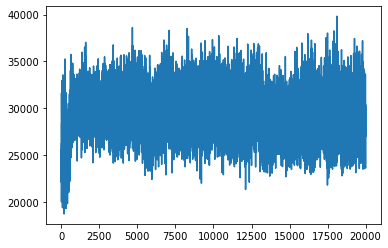

In [272]:
plt.plot(TrainingPortfolio)

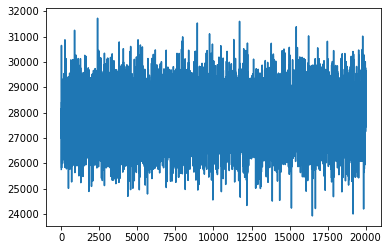

In [273]:
plt.plot(TestPortfolio)

In [274]:
np.mean(TestPortfolio)

27693.075802498763

In [275]:
np.mean(RandomPortfolio)

23204.650972499763

### 40000 Episode

In [ ]:
env.reset()

In [276]:
gamma = 0.95  # discount rate
epsilon = 1
epsilon_min = 0.01
epsilon_decay = 0.995  # exploration rate
num_episodes = 40000
initial_investment = 20000

n_timesteps, n_stocks = data.shape
n_train = n_timesteps // 2
train_data = data_new[:n_train].values
test_data = data_new[n_train:].values

np.random.seed(1)
env = MultiStockEnv(train_data,initial_investment=20000)
#Train the scaler, the scaler only uses the training set
state_size = env.state_dim
action_size = len(env.action_space)

#Initialize weights
W = np.random.randn(state_size, action_size) / np.sqrt(state_size)
b = np.zeros(action_size)
scaler=get_scaler(env)

#Initialize momentum terms
vW = 0
vb = 0

# store the final value of the portfolio (end of episode)
portfolio_value = []

for i in range(num_episodes):
    done=False
    state = env.reset()
    state = scaler.transform([state])
    while not done:
        action = greedy_policy(state,W,b,epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        if done:
            target = reward
        else:
            target = reward + gamma * np.amax(predict(next_state,W,b), axis=1)
        #Make prediction for all actions first
        target_full = predict(state,W,b)
        #Update target values for only the selected action 
        target_full[0, action] = target
        #Update weights
        W,b,vW,vb=sgd(X=state, Y=target_full,W=W,b=b,vW=vW,vb=vb)
        
        state=next_state
        
        if epsilon > epsilon_min:
            epsilon *= epsilon_decay

    val=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {val:.2f}")
    portfolio_value.append(val)
pickle.dump(scaler, open('scaler.pkl','wb'))
np.savez(saving_models_path+"/TraderWeights_slope_40000_episode_eps01.npz", W=W, b=b)

episode: 1/40000, episode end value: 31556.25
episode: 2/40000, episode end value: 28186.30
episode: 3/40000, episode end value: 25494.15
episode: 4/40000, episode end value: 27725.51
episode: 5/40000, episode end value: 24737.11
episode: 6/40000, episode end value: 28927.15
episode: 7/40000, episode end value: 26386.87
episode: 8/40000, episode end value: 27250.67
episode: 9/40000, episode end value: 26570.77
episode: 10/40000, episode end value: 23740.19
episode: 11/40000, episode end value: 22082.07
episode: 12/40000, episode end value: 24010.80
episode: 13/40000, episode end value: 25615.50
episode: 14/40000, episode end value: 19994.46
episode: 15/40000, episode end value: 25249.92
episode: 16/40000, episode end value: 23017.84
episode: 17/40000, episode end value: 25302.54
episode: 18/40000, episode end value: 24151.13
episode: 19/40000, episode end value: 24828.46
episode: 20/40000, episode end value: 24301.49
episode: 21/40000, episode end value: 26254.56
episode: 22/40000, epi

episode: 174/40000, episode end value: 25562.69
episode: 175/40000, episode end value: 27187.78
episode: 176/40000, episode end value: 22599.43
episode: 177/40000, episode end value: 22704.27
episode: 178/40000, episode end value: 18696.22
episode: 179/40000, episode end value: 28173.01
episode: 180/40000, episode end value: 30959.68
episode: 181/40000, episode end value: 29369.92
episode: 182/40000, episode end value: 22510.61
episode: 183/40000, episode end value: 25040.25
episode: 184/40000, episode end value: 20115.54
episode: 185/40000, episode end value: 20422.20
episode: 186/40000, episode end value: 31387.34
episode: 187/40000, episode end value: 25530.13
episode: 188/40000, episode end value: 23272.61
episode: 189/40000, episode end value: 22129.13
episode: 190/40000, episode end value: 25803.91
episode: 191/40000, episode end value: 31478.68
episode: 192/40000, episode end value: 28777.09
episode: 193/40000, episode end value: 20852.82
episode: 194/40000, episode end value: 2

episode: 345/40000, episode end value: 21483.34
episode: 346/40000, episode end value: 28685.61
episode: 347/40000, episode end value: 23689.34
episode: 348/40000, episode end value: 27026.72
episode: 349/40000, episode end value: 24242.78
episode: 350/40000, episode end value: 22130.00
episode: 351/40000, episode end value: 26218.94
episode: 352/40000, episode end value: 25084.90
episode: 353/40000, episode end value: 21117.94
episode: 354/40000, episode end value: 26962.45
episode: 355/40000, episode end value: 26170.53
episode: 356/40000, episode end value: 26609.12
episode: 357/40000, episode end value: 22814.65
episode: 358/40000, episode end value: 24302.20
episode: 359/40000, episode end value: 24402.74
episode: 360/40000, episode end value: 23661.05
episode: 361/40000, episode end value: 23816.32
episode: 362/40000, episode end value: 22587.81
episode: 363/40000, episode end value: 28672.73
episode: 364/40000, episode end value: 23044.51
episode: 365/40000, episode end value: 2

episode: 516/40000, episode end value: 27975.69
episode: 517/40000, episode end value: 28007.28
episode: 518/40000, episode end value: 28814.53
episode: 519/40000, episode end value: 26382.32
episode: 520/40000, episode end value: 27047.25
episode: 521/40000, episode end value: 21258.94
episode: 522/40000, episode end value: 28933.97
episode: 523/40000, episode end value: 24794.20
episode: 524/40000, episode end value: 30324.58
episode: 525/40000, episode end value: 25725.48
episode: 526/40000, episode end value: 24615.64
episode: 527/40000, episode end value: 27224.83
episode: 528/40000, episode end value: 28339.64
episode: 529/40000, episode end value: 28801.53
episode: 530/40000, episode end value: 26261.11
episode: 531/40000, episode end value: 26890.09
episode: 532/40000, episode end value: 29420.29
episode: 533/40000, episode end value: 27494.59
episode: 534/40000, episode end value: 23636.75
episode: 535/40000, episode end value: 26220.93
episode: 536/40000, episode end value: 2

episode: 687/40000, episode end value: 29279.86
episode: 688/40000, episode end value: 31956.40
episode: 689/40000, episode end value: 25745.62
episode: 690/40000, episode end value: 31065.23
episode: 691/40000, episode end value: 30069.83
episode: 692/40000, episode end value: 26795.71
episode: 693/40000, episode end value: 29242.11
episode: 694/40000, episode end value: 29705.27
episode: 695/40000, episode end value: 31899.35
episode: 696/40000, episode end value: 30156.64
episode: 697/40000, episode end value: 30235.28
episode: 698/40000, episode end value: 30890.01
episode: 699/40000, episode end value: 29888.06
episode: 700/40000, episode end value: 30077.38
episode: 701/40000, episode end value: 29805.62
episode: 702/40000, episode end value: 29336.50
episode: 703/40000, episode end value: 30869.94
episode: 704/40000, episode end value: 30016.71
episode: 705/40000, episode end value: 29595.57
episode: 706/40000, episode end value: 29290.90
episode: 707/40000, episode end value: 2

episode: 858/40000, episode end value: 30899.05
episode: 859/40000, episode end value: 32323.01
episode: 860/40000, episode end value: 32272.40
episode: 861/40000, episode end value: 30801.41
episode: 862/40000, episode end value: 31710.74
episode: 863/40000, episode end value: 30845.04
episode: 864/40000, episode end value: 29024.76
episode: 865/40000, episode end value: 32564.23
episode: 866/40000, episode end value: 27191.61
episode: 867/40000, episode end value: 31607.80
episode: 868/40000, episode end value: 28237.13
episode: 869/40000, episode end value: 30809.11
episode: 870/40000, episode end value: 31050.20
episode: 871/40000, episode end value: 28174.68
episode: 872/40000, episode end value: 30559.14
episode: 873/40000, episode end value: 29945.41
episode: 874/40000, episode end value: 30287.24
episode: 875/40000, episode end value: 32932.69
episode: 876/40000, episode end value: 30806.16
episode: 877/40000, episode end value: 31792.35
episode: 878/40000, episode end value: 3

episode: 1029/40000, episode end value: 29944.89
episode: 1030/40000, episode end value: 30578.36
episode: 1031/40000, episode end value: 31366.72
episode: 1032/40000, episode end value: 32371.39
episode: 1033/40000, episode end value: 33632.69
episode: 1034/40000, episode end value: 29956.84
episode: 1035/40000, episode end value: 32900.29
episode: 1036/40000, episode end value: 28146.63
episode: 1037/40000, episode end value: 30909.19
episode: 1038/40000, episode end value: 30969.22
episode: 1039/40000, episode end value: 27394.63
episode: 1040/40000, episode end value: 27535.69
episode: 1041/40000, episode end value: 32476.01
episode: 1042/40000, episode end value: 29693.94
episode: 1043/40000, episode end value: 33137.51
episode: 1044/40000, episode end value: 31257.69
episode: 1045/40000, episode end value: 30325.74
episode: 1046/40000, episode end value: 31364.49
episode: 1047/40000, episode end value: 24350.40
episode: 1048/40000, episode end value: 30742.36
episode: 1049/40000,

episode: 1197/40000, episode end value: 28755.52
episode: 1198/40000, episode end value: 31513.95
episode: 1199/40000, episode end value: 30184.69
episode: 1200/40000, episode end value: 30422.47
episode: 1201/40000, episode end value: 29507.56
episode: 1202/40000, episode end value: 31504.52
episode: 1203/40000, episode end value: 29758.37
episode: 1204/40000, episode end value: 29748.13
episode: 1205/40000, episode end value: 30579.76
episode: 1206/40000, episode end value: 31597.43
episode: 1207/40000, episode end value: 30457.88
episode: 1208/40000, episode end value: 31762.90
episode: 1209/40000, episode end value: 34176.28
episode: 1210/40000, episode end value: 30215.20
episode: 1211/40000, episode end value: 29204.39
episode: 1212/40000, episode end value: 33936.49
episode: 1213/40000, episode end value: 27535.16
episode: 1214/40000, episode end value: 30095.56
episode: 1215/40000, episode end value: 31826.51
episode: 1216/40000, episode end value: 29253.14
episode: 1217/40000,

episode: 1365/40000, episode end value: 29558.97
episode: 1366/40000, episode end value: 27466.19
episode: 1367/40000, episode end value: 30180.24
episode: 1368/40000, episode end value: 30608.12
episode: 1369/40000, episode end value: 29701.73
episode: 1370/40000, episode end value: 28887.83
episode: 1371/40000, episode end value: 30506.79
episode: 1372/40000, episode end value: 26398.46
episode: 1373/40000, episode end value: 29844.85
episode: 1374/40000, episode end value: 28596.21
episode: 1375/40000, episode end value: 30370.89
episode: 1376/40000, episode end value: 29671.29
episode: 1377/40000, episode end value: 25548.39
episode: 1378/40000, episode end value: 28967.93
episode: 1379/40000, episode end value: 28566.60
episode: 1380/40000, episode end value: 29065.16
episode: 1381/40000, episode end value: 28833.60
episode: 1382/40000, episode end value: 29122.97
episode: 1383/40000, episode end value: 31213.61
episode: 1384/40000, episode end value: 28544.48
episode: 1385/40000,

episode: 1533/40000, episode end value: 30930.51
episode: 1534/40000, episode end value: 29648.95
episode: 1535/40000, episode end value: 30558.68
episode: 1536/40000, episode end value: 28149.65
episode: 1537/40000, episode end value: 36530.81
episode: 1538/40000, episode end value: 29429.90
episode: 1539/40000, episode end value: 31056.33
episode: 1540/40000, episode end value: 27988.46
episode: 1541/40000, episode end value: 27590.55
episode: 1542/40000, episode end value: 29596.79
episode: 1543/40000, episode end value: 29346.68
episode: 1544/40000, episode end value: 30429.82
episode: 1545/40000, episode end value: 32671.28
episode: 1546/40000, episode end value: 27810.23
episode: 1547/40000, episode end value: 25566.60
episode: 1548/40000, episode end value: 28883.28
episode: 1549/40000, episode end value: 31352.88
episode: 1550/40000, episode end value: 32434.51
episode: 1551/40000, episode end value: 25256.46
episode: 1552/40000, episode end value: 29418.80
episode: 1553/40000,

episode: 1701/40000, episode end value: 27769.55
episode: 1702/40000, episode end value: 27858.63
episode: 1703/40000, episode end value: 31904.88
episode: 1704/40000, episode end value: 31941.14
episode: 1705/40000, episode end value: 28580.09
episode: 1706/40000, episode end value: 29858.27
episode: 1707/40000, episode end value: 32189.66
episode: 1708/40000, episode end value: 31221.94
episode: 1709/40000, episode end value: 29598.86
episode: 1710/40000, episode end value: 30943.07
episode: 1711/40000, episode end value: 29441.61
episode: 1712/40000, episode end value: 28854.26
episode: 1713/40000, episode end value: 28536.23
episode: 1714/40000, episode end value: 32619.29
episode: 1715/40000, episode end value: 31993.99
episode: 1716/40000, episode end value: 30738.89
episode: 1717/40000, episode end value: 32551.34
episode: 1718/40000, episode end value: 29151.94
episode: 1719/40000, episode end value: 31186.87
episode: 1720/40000, episode end value: 29213.77
episode: 1721/40000,

episode: 1869/40000, episode end value: 31705.20
episode: 1870/40000, episode end value: 29090.89
episode: 1871/40000, episode end value: 31031.14
episode: 1872/40000, episode end value: 29973.77
episode: 1873/40000, episode end value: 27514.08
episode: 1874/40000, episode end value: 31367.01
episode: 1875/40000, episode end value: 30345.59
episode: 1876/40000, episode end value: 31864.22
episode: 1877/40000, episode end value: 29930.72
episode: 1878/40000, episode end value: 26288.05
episode: 1879/40000, episode end value: 30881.90
episode: 1880/40000, episode end value: 31826.58
episode: 1881/40000, episode end value: 30296.27
episode: 1882/40000, episode end value: 29999.75
episode: 1883/40000, episode end value: 28734.23
episode: 1884/40000, episode end value: 25971.05
episode: 1885/40000, episode end value: 30405.23
episode: 1886/40000, episode end value: 29102.25
episode: 1887/40000, episode end value: 29903.76
episode: 1888/40000, episode end value: 30880.71
episode: 1889/40000,

episode: 2037/40000, episode end value: 29971.87
episode: 2038/40000, episode end value: 30007.91
episode: 2039/40000, episode end value: 32663.90
episode: 2040/40000, episode end value: 28183.90
episode: 2041/40000, episode end value: 31012.09
episode: 2042/40000, episode end value: 30577.09
episode: 2043/40000, episode end value: 30050.93
episode: 2044/40000, episode end value: 30560.60
episode: 2045/40000, episode end value: 30418.48
episode: 2046/40000, episode end value: 27942.52
episode: 2047/40000, episode end value: 33058.21
episode: 2048/40000, episode end value: 29597.89
episode: 2049/40000, episode end value: 28487.06
episode: 2050/40000, episode end value: 31412.14
episode: 2051/40000, episode end value: 30183.99
episode: 2052/40000, episode end value: 28299.79
episode: 2053/40000, episode end value: 32589.32
episode: 2054/40000, episode end value: 27875.15
episode: 2055/40000, episode end value: 32136.66
episode: 2056/40000, episode end value: 30299.28
episode: 2057/40000,

episode: 2205/40000, episode end value: 29987.03
episode: 2206/40000, episode end value: 30827.49
episode: 2207/40000, episode end value: 32356.07
episode: 2208/40000, episode end value: 28888.08
episode: 2209/40000, episode end value: 30928.91
episode: 2210/40000, episode end value: 29922.41
episode: 2211/40000, episode end value: 31044.42
episode: 2212/40000, episode end value: 30333.95
episode: 2213/40000, episode end value: 32574.72
episode: 2214/40000, episode end value: 30181.52
episode: 2215/40000, episode end value: 30437.89
episode: 2216/40000, episode end value: 30925.75
episode: 2217/40000, episode end value: 30495.96
episode: 2218/40000, episode end value: 31956.10
episode: 2219/40000, episode end value: 33176.40
episode: 2220/40000, episode end value: 31248.12
episode: 2221/40000, episode end value: 30784.14
episode: 2222/40000, episode end value: 29034.27
episode: 2223/40000, episode end value: 31436.27
episode: 2224/40000, episode end value: 29781.09
episode: 2225/40000,

episode: 2373/40000, episode end value: 30470.69
episode: 2374/40000, episode end value: 31655.97
episode: 2375/40000, episode end value: 31132.01
episode: 2376/40000, episode end value: 32410.97
episode: 2377/40000, episode end value: 31749.46
episode: 2378/40000, episode end value: 31806.62
episode: 2379/40000, episode end value: 29191.57
episode: 2380/40000, episode end value: 28438.86
episode: 2381/40000, episode end value: 31751.83
episode: 2382/40000, episode end value: 32135.05
episode: 2383/40000, episode end value: 29525.31
episode: 2384/40000, episode end value: 28779.62
episode: 2385/40000, episode end value: 30455.97
episode: 2386/40000, episode end value: 31545.41
episode: 2387/40000, episode end value: 28668.96
episode: 2388/40000, episode end value: 29765.32
episode: 2389/40000, episode end value: 27315.75
episode: 2390/40000, episode end value: 32111.66
episode: 2391/40000, episode end value: 30715.38
episode: 2392/40000, episode end value: 29244.52
episode: 2393/40000,

episode: 2541/40000, episode end value: 30070.59
episode: 2542/40000, episode end value: 31787.90
episode: 2543/40000, episode end value: 30262.64
episode: 2544/40000, episode end value: 28750.61
episode: 2545/40000, episode end value: 29338.22
episode: 2546/40000, episode end value: 30169.57
episode: 2547/40000, episode end value: 27835.17
episode: 2548/40000, episode end value: 31868.88
episode: 2549/40000, episode end value: 29995.22
episode: 2550/40000, episode end value: 32293.18
episode: 2551/40000, episode end value: 29896.33
episode: 2552/40000, episode end value: 28523.25
episode: 2553/40000, episode end value: 32453.87
episode: 2554/40000, episode end value: 27932.56
episode: 2555/40000, episode end value: 31188.03
episode: 2556/40000, episode end value: 27643.44
episode: 2557/40000, episode end value: 28776.16
episode: 2558/40000, episode end value: 29473.02
episode: 2559/40000, episode end value: 30160.75
episode: 2560/40000, episode end value: 29935.33
episode: 2561/40000,

episode: 2709/40000, episode end value: 27789.61
episode: 2710/40000, episode end value: 31216.63
episode: 2711/40000, episode end value: 28611.45
episode: 2712/40000, episode end value: 29909.75
episode: 2713/40000, episode end value: 27356.81
episode: 2714/40000, episode end value: 30671.76
episode: 2715/40000, episode end value: 30174.21
episode: 2716/40000, episode end value: 30064.38
episode: 2717/40000, episode end value: 28044.03
episode: 2718/40000, episode end value: 31341.80
episode: 2719/40000, episode end value: 29321.71
episode: 2720/40000, episode end value: 30011.06
episode: 2721/40000, episode end value: 30368.94
episode: 2722/40000, episode end value: 28375.67
episode: 2723/40000, episode end value: 28937.35
episode: 2724/40000, episode end value: 27509.23
episode: 2725/40000, episode end value: 32246.27
episode: 2726/40000, episode end value: 29822.90
episode: 2727/40000, episode end value: 30857.90
episode: 2728/40000, episode end value: 32362.37
episode: 2729/40000,

episode: 2877/40000, episode end value: 29854.78
episode: 2878/40000, episode end value: 33063.96
episode: 2879/40000, episode end value: 30869.92
episode: 2880/40000, episode end value: 32901.97
episode: 2881/40000, episode end value: 28035.62
episode: 2882/40000, episode end value: 29446.50
episode: 2883/40000, episode end value: 31030.29
episode: 2884/40000, episode end value: 27838.23
episode: 2885/40000, episode end value: 30675.54
episode: 2886/40000, episode end value: 29369.39
episode: 2887/40000, episode end value: 29614.26
episode: 2888/40000, episode end value: 32566.99
episode: 2889/40000, episode end value: 30500.62
episode: 2890/40000, episode end value: 28622.83
episode: 2891/40000, episode end value: 29942.52
episode: 2892/40000, episode end value: 32053.31
episode: 2893/40000, episode end value: 28660.39
episode: 2894/40000, episode end value: 30973.86
episode: 2895/40000, episode end value: 29291.02
episode: 2896/40000, episode end value: 32502.15
episode: 2897/40000,

episode: 3045/40000, episode end value: 31502.38
episode: 3046/40000, episode end value: 28142.79
episode: 3047/40000, episode end value: 29713.37
episode: 3048/40000, episode end value: 30481.63
episode: 3049/40000, episode end value: 29509.14
episode: 3050/40000, episode end value: 30331.70
episode: 3051/40000, episode end value: 31296.68
episode: 3052/40000, episode end value: 29362.80
episode: 3053/40000, episode end value: 27752.40
episode: 3054/40000, episode end value: 30632.20
episode: 3055/40000, episode end value: 28777.01
episode: 3056/40000, episode end value: 28485.23
episode: 3057/40000, episode end value: 28756.86
episode: 3058/40000, episode end value: 30110.23
episode: 3059/40000, episode end value: 29665.20
episode: 3060/40000, episode end value: 30203.40
episode: 3061/40000, episode end value: 30009.79
episode: 3062/40000, episode end value: 30216.77
episode: 3063/40000, episode end value: 27094.09
episode: 3064/40000, episode end value: 28154.90
episode: 3065/40000,

episode: 3213/40000, episode end value: 26934.65
episode: 3214/40000, episode end value: 27789.74
episode: 3215/40000, episode end value: 31657.20
episode: 3216/40000, episode end value: 30902.96
episode: 3217/40000, episode end value: 32746.29
episode: 3218/40000, episode end value: 29414.78
episode: 3219/40000, episode end value: 29258.81
episode: 3220/40000, episode end value: 29335.45
episode: 3221/40000, episode end value: 30195.40
episode: 3222/40000, episode end value: 32045.98
episode: 3223/40000, episode end value: 32782.93
episode: 3224/40000, episode end value: 29201.29
episode: 3225/40000, episode end value: 30779.46
episode: 3226/40000, episode end value: 27305.30
episode: 3227/40000, episode end value: 31397.86
episode: 3228/40000, episode end value: 31635.00
episode: 3229/40000, episode end value: 33215.92
episode: 3230/40000, episode end value: 32330.62
episode: 3231/40000, episode end value: 25345.13
episode: 3232/40000, episode end value: 27599.41
episode: 3233/40000,

episode: 3381/40000, episode end value: 28945.27
episode: 3382/40000, episode end value: 28155.11
episode: 3383/40000, episode end value: 27623.69
episode: 3384/40000, episode end value: 26304.26
episode: 3385/40000, episode end value: 27217.35
episode: 3386/40000, episode end value: 27064.26
episode: 3387/40000, episode end value: 27632.65
episode: 3388/40000, episode end value: 26686.68
episode: 3389/40000, episode end value: 29013.16
episode: 3390/40000, episode end value: 29517.92
episode: 3391/40000, episode end value: 28707.27
episode: 3392/40000, episode end value: 32346.65
episode: 3393/40000, episode end value: 32061.38
episode: 3394/40000, episode end value: 33407.38
episode: 3395/40000, episode end value: 31149.76
episode: 3396/40000, episode end value: 27155.14
episode: 3397/40000, episode end value: 28651.82
episode: 3398/40000, episode end value: 31615.73
episode: 3399/40000, episode end value: 29376.37
episode: 3400/40000, episode end value: 30710.94
episode: 3401/40000,

episode: 3549/40000, episode end value: 29037.60
episode: 3550/40000, episode end value: 28350.38
episode: 3551/40000, episode end value: 32511.72
episode: 3552/40000, episode end value: 28188.50
episode: 3553/40000, episode end value: 33269.10
episode: 3554/40000, episode end value: 31374.65
episode: 3555/40000, episode end value: 27448.56
episode: 3556/40000, episode end value: 30380.92
episode: 3557/40000, episode end value: 26682.16
episode: 3558/40000, episode end value: 30015.02
episode: 3559/40000, episode end value: 28638.01
episode: 3560/40000, episode end value: 29147.38
episode: 3561/40000, episode end value: 28488.19
episode: 3562/40000, episode end value: 30785.81
episode: 3563/40000, episode end value: 26886.77
episode: 3564/40000, episode end value: 30688.76
episode: 3565/40000, episode end value: 29116.51
episode: 3566/40000, episode end value: 29092.76
episode: 3567/40000, episode end value: 32942.75
episode: 3568/40000, episode end value: 30911.67
episode: 3569/40000,

episode: 3717/40000, episode end value: 31821.85
episode: 3718/40000, episode end value: 31916.52
episode: 3719/40000, episode end value: 31837.00
episode: 3720/40000, episode end value: 31019.93
episode: 3721/40000, episode end value: 28483.59
episode: 3722/40000, episode end value: 32200.57
episode: 3723/40000, episode end value: 29804.18
episode: 3724/40000, episode end value: 28752.88
episode: 3725/40000, episode end value: 30322.13
episode: 3726/40000, episode end value: 29092.04
episode: 3727/40000, episode end value: 30625.17
episode: 3728/40000, episode end value: 28656.49
episode: 3729/40000, episode end value: 31363.14
episode: 3730/40000, episode end value: 32238.72
episode: 3731/40000, episode end value: 29627.38
episode: 3732/40000, episode end value: 28898.98
episode: 3733/40000, episode end value: 29757.55
episode: 3734/40000, episode end value: 29003.32
episode: 3735/40000, episode end value: 31955.10
episode: 3736/40000, episode end value: 27447.18
episode: 3737/40000,

episode: 3885/40000, episode end value: 32600.08
episode: 3886/40000, episode end value: 27459.67
episode: 3887/40000, episode end value: 30581.99
episode: 3888/40000, episode end value: 32138.76
episode: 3889/40000, episode end value: 28977.41
episode: 3890/40000, episode end value: 28526.80
episode: 3891/40000, episode end value: 28699.47
episode: 3892/40000, episode end value: 29193.54
episode: 3893/40000, episode end value: 35524.09
episode: 3894/40000, episode end value: 28875.36
episode: 3895/40000, episode end value: 29673.06
episode: 3896/40000, episode end value: 28771.08
episode: 3897/40000, episode end value: 32201.56
episode: 3898/40000, episode end value: 30531.69
episode: 3899/40000, episode end value: 32208.71
episode: 3900/40000, episode end value: 33309.42
episode: 3901/40000, episode end value: 28157.99
episode: 3902/40000, episode end value: 29462.37
episode: 3903/40000, episode end value: 29626.01
episode: 3904/40000, episode end value: 31128.09
episode: 3905/40000,

episode: 4053/40000, episode end value: 32047.64
episode: 4054/40000, episode end value: 28459.02
episode: 4055/40000, episode end value: 29841.45
episode: 4056/40000, episode end value: 33926.31
episode: 4057/40000, episode end value: 29175.48
episode: 4058/40000, episode end value: 25191.50
episode: 4059/40000, episode end value: 31837.86
episode: 4060/40000, episode end value: 28839.22
episode: 4061/40000, episode end value: 30581.55
episode: 4062/40000, episode end value: 29618.66
episode: 4063/40000, episode end value: 30202.55
episode: 4064/40000, episode end value: 31333.25
episode: 4065/40000, episode end value: 28902.07
episode: 4066/40000, episode end value: 32188.91
episode: 4067/40000, episode end value: 27285.98
episode: 4068/40000, episode end value: 28812.88
episode: 4069/40000, episode end value: 30220.91
episode: 4070/40000, episode end value: 30423.03
episode: 4071/40000, episode end value: 29178.37
episode: 4072/40000, episode end value: 28614.01
episode: 4073/40000,

episode: 4221/40000, episode end value: 30932.43
episode: 4222/40000, episode end value: 29644.01
episode: 4223/40000, episode end value: 30601.03
episode: 4224/40000, episode end value: 30491.85
episode: 4225/40000, episode end value: 30119.60
episode: 4226/40000, episode end value: 29358.92
episode: 4227/40000, episode end value: 32924.59
episode: 4228/40000, episode end value: 28535.98
episode: 4229/40000, episode end value: 29206.80
episode: 4230/40000, episode end value: 28335.72
episode: 4231/40000, episode end value: 30893.71
episode: 4232/40000, episode end value: 30701.38
episode: 4233/40000, episode end value: 32785.61
episode: 4234/40000, episode end value: 28685.35
episode: 4235/40000, episode end value: 28882.22
episode: 4236/40000, episode end value: 30389.03
episode: 4237/40000, episode end value: 28998.73
episode: 4238/40000, episode end value: 28161.74
episode: 4239/40000, episode end value: 32336.44
episode: 4240/40000, episode end value: 30590.42
episode: 4241/40000,

episode: 4389/40000, episode end value: 33053.06
episode: 4390/40000, episode end value: 31829.09
episode: 4391/40000, episode end value: 33585.05
episode: 4392/40000, episode end value: 26372.66
episode: 4393/40000, episode end value: 31325.90
episode: 4394/40000, episode end value: 29585.68
episode: 4395/40000, episode end value: 30932.40
episode: 4396/40000, episode end value: 30307.49
episode: 4397/40000, episode end value: 29557.96
episode: 4398/40000, episode end value: 30628.53
episode: 4399/40000, episode end value: 29847.79
episode: 4400/40000, episode end value: 30965.22
episode: 4401/40000, episode end value: 28644.58
episode: 4402/40000, episode end value: 30056.75
episode: 4403/40000, episode end value: 30418.63
episode: 4404/40000, episode end value: 27110.33
episode: 4405/40000, episode end value: 29296.51
episode: 4406/40000, episode end value: 27819.39
episode: 4407/40000, episode end value: 28585.40
episode: 4408/40000, episode end value: 29486.10
episode: 4409/40000,

episode: 4557/40000, episode end value: 30131.05
episode: 4558/40000, episode end value: 32811.83
episode: 4559/40000, episode end value: 32434.32
episode: 4560/40000, episode end value: 30499.95
episode: 4561/40000, episode end value: 33121.04
episode: 4562/40000, episode end value: 30768.02
episode: 4563/40000, episode end value: 30992.68
episode: 4564/40000, episode end value: 28481.09
episode: 4565/40000, episode end value: 27386.39
episode: 4566/40000, episode end value: 30415.46
episode: 4567/40000, episode end value: 28977.84
episode: 4568/40000, episode end value: 31886.38
episode: 4569/40000, episode end value: 30542.51
episode: 4570/40000, episode end value: 29357.86
episode: 4571/40000, episode end value: 32356.54
episode: 4572/40000, episode end value: 31602.91
episode: 4573/40000, episode end value: 32914.10
episode: 4574/40000, episode end value: 29764.36
episode: 4575/40000, episode end value: 28166.56
episode: 4576/40000, episode end value: 33585.56
episode: 4577/40000,

episode: 4725/40000, episode end value: 32559.52
episode: 4726/40000, episode end value: 33438.09
episode: 4727/40000, episode end value: 32757.22
episode: 4728/40000, episode end value: 33565.53
episode: 4729/40000, episode end value: 34323.21
episode: 4730/40000, episode end value: 33911.15
episode: 4731/40000, episode end value: 32287.79
episode: 4732/40000, episode end value: 33309.28
episode: 4733/40000, episode end value: 32983.05
episode: 4734/40000, episode end value: 27880.62
episode: 4735/40000, episode end value: 30240.22
episode: 4736/40000, episode end value: 33102.63
episode: 4737/40000, episode end value: 32913.44
episode: 4738/40000, episode end value: 33312.82
episode: 4739/40000, episode end value: 33331.36
episode: 4740/40000, episode end value: 32115.84
episode: 4741/40000, episode end value: 31470.35
episode: 4742/40000, episode end value: 28443.28
episode: 4743/40000, episode end value: 28726.66
episode: 4744/40000, episode end value: 28601.44
episode: 4745/40000,

episode: 4893/40000, episode end value: 29899.50
episode: 4894/40000, episode end value: 31542.70
episode: 4895/40000, episode end value: 28776.21
episode: 4896/40000, episode end value: 30618.16
episode: 4897/40000, episode end value: 26780.15
episode: 4898/40000, episode end value: 29952.03
episode: 4899/40000, episode end value: 29372.16
episode: 4900/40000, episode end value: 31530.54
episode: 4901/40000, episode end value: 28197.93
episode: 4902/40000, episode end value: 31542.70
episode: 4903/40000, episode end value: 27860.41
episode: 4904/40000, episode end value: 29233.10
episode: 4905/40000, episode end value: 33914.88
episode: 4906/40000, episode end value: 28765.91
episode: 4907/40000, episode end value: 31923.27
episode: 4908/40000, episode end value: 30956.66
episode: 4909/40000, episode end value: 30265.55
episode: 4910/40000, episode end value: 31052.73
episode: 4911/40000, episode end value: 32402.83
episode: 4912/40000, episode end value: 30449.49
episode: 4913/40000,

episode: 5061/40000, episode end value: 31964.02
episode: 5062/40000, episode end value: 31466.06
episode: 5063/40000, episode end value: 29725.84
episode: 5064/40000, episode end value: 30483.84
episode: 5065/40000, episode end value: 29290.15
episode: 5066/40000, episode end value: 30850.44
episode: 5067/40000, episode end value: 30460.91
episode: 5068/40000, episode end value: 31193.86
episode: 5069/40000, episode end value: 30161.48
episode: 5070/40000, episode end value: 30922.51
episode: 5071/40000, episode end value: 33445.66
episode: 5072/40000, episode end value: 32086.46
episode: 5073/40000, episode end value: 25710.19
episode: 5074/40000, episode end value: 32706.30
episode: 5075/40000, episode end value: 31456.20
episode: 5076/40000, episode end value: 33267.72
episode: 5077/40000, episode end value: 33262.59
episode: 5078/40000, episode end value: 31523.60
episode: 5079/40000, episode end value: 27613.80
episode: 5080/40000, episode end value: 28574.75
episode: 5081/40000,

episode: 5229/40000, episode end value: 31582.83
episode: 5230/40000, episode end value: 33821.61
episode: 5231/40000, episode end value: 29516.94
episode: 5232/40000, episode end value: 32101.80
episode: 5233/40000, episode end value: 33705.85
episode: 5234/40000, episode end value: 35980.69
episode: 5235/40000, episode end value: 29893.33
episode: 5236/40000, episode end value: 33042.46
episode: 5237/40000, episode end value: 33505.82
episode: 5238/40000, episode end value: 32381.23
episode: 5239/40000, episode end value: 29606.25
episode: 5240/40000, episode end value: 33484.08
episode: 5241/40000, episode end value: 31969.51
episode: 5242/40000, episode end value: 30416.74
episode: 5243/40000, episode end value: 31258.86
episode: 5244/40000, episode end value: 31232.46
episode: 5245/40000, episode end value: 35091.13
episode: 5246/40000, episode end value: 32710.85
episode: 5247/40000, episode end value: 33885.29
episode: 5248/40000, episode end value: 32215.16
episode: 5249/40000,

episode: 5397/40000, episode end value: 26850.63
episode: 5398/40000, episode end value: 31989.03
episode: 5399/40000, episode end value: 28159.04
episode: 5400/40000, episode end value: 30652.93
episode: 5401/40000, episode end value: 27878.98
episode: 5402/40000, episode end value: 25853.89
episode: 5403/40000, episode end value: 26443.15
episode: 5404/40000, episode end value: 27433.56
episode: 5405/40000, episode end value: 25618.01
episode: 5406/40000, episode end value: 32919.08
episode: 5407/40000, episode end value: 31568.23
episode: 5408/40000, episode end value: 34036.53
episode: 5409/40000, episode end value: 29573.02
episode: 5410/40000, episode end value: 27729.46
episode: 5411/40000, episode end value: 31492.86
episode: 5412/40000, episode end value: 30316.51
episode: 5413/40000, episode end value: 29421.52
episode: 5414/40000, episode end value: 24568.98
episode: 5415/40000, episode end value: 27920.28
episode: 5416/40000, episode end value: 29754.26
episode: 5417/40000,

episode: 5565/40000, episode end value: 30442.99
episode: 5566/40000, episode end value: 26913.23
episode: 5567/40000, episode end value: 30750.00
episode: 5568/40000, episode end value: 29646.68
episode: 5569/40000, episode end value: 34273.21
episode: 5570/40000, episode end value: 30978.38
episode: 5571/40000, episode end value: 29276.15
episode: 5572/40000, episode end value: 27959.68
episode: 5573/40000, episode end value: 30304.45
episode: 5574/40000, episode end value: 30123.70
episode: 5575/40000, episode end value: 31332.85
episode: 5576/40000, episode end value: 27815.28
episode: 5577/40000, episode end value: 28040.25
episode: 5578/40000, episode end value: 27239.89
episode: 5579/40000, episode end value: 30003.78
episode: 5580/40000, episode end value: 27750.61
episode: 5581/40000, episode end value: 30495.74
episode: 5582/40000, episode end value: 27438.65
episode: 5583/40000, episode end value: 27613.55
episode: 5584/40000, episode end value: 29011.10
episode: 5585/40000,

episode: 5733/40000, episode end value: 30526.45
episode: 5734/40000, episode end value: 29167.73
episode: 5735/40000, episode end value: 30849.08
episode: 5736/40000, episode end value: 33597.18
episode: 5737/40000, episode end value: 29681.06
episode: 5738/40000, episode end value: 30174.36
episode: 5739/40000, episode end value: 27809.57
episode: 5740/40000, episode end value: 27987.56
episode: 5741/40000, episode end value: 27893.56
episode: 5742/40000, episode end value: 30208.41
episode: 5743/40000, episode end value: 27251.02
episode: 5744/40000, episode end value: 28815.50
episode: 5745/40000, episode end value: 30653.55
episode: 5746/40000, episode end value: 29931.60
episode: 5747/40000, episode end value: 30992.85
episode: 5748/40000, episode end value: 29095.51
episode: 5749/40000, episode end value: 30187.10
episode: 5750/40000, episode end value: 27552.77
episode: 5751/40000, episode end value: 30863.09
episode: 5752/40000, episode end value: 30437.18
episode: 5753/40000,

episode: 5901/40000, episode end value: 26011.19
episode: 5902/40000, episode end value: 31358.65
episode: 5903/40000, episode end value: 28258.53
episode: 5904/40000, episode end value: 27682.59
episode: 5905/40000, episode end value: 29495.01
episode: 5906/40000, episode end value: 28181.26
episode: 5907/40000, episode end value: 29391.04
episode: 5908/40000, episode end value: 28393.51
episode: 5909/40000, episode end value: 30627.69
episode: 5910/40000, episode end value: 29996.80
episode: 5911/40000, episode end value: 29418.78
episode: 5912/40000, episode end value: 28094.61
episode: 5913/40000, episode end value: 25822.75
episode: 5914/40000, episode end value: 31337.03
episode: 5915/40000, episode end value: 30395.32
episode: 5916/40000, episode end value: 29389.69
episode: 5917/40000, episode end value: 29144.92
episode: 5918/40000, episode end value: 28813.61
episode: 5919/40000, episode end value: 31959.87
episode: 5920/40000, episode end value: 28870.05
episode: 5921/40000,

episode: 6069/40000, episode end value: 32129.62
episode: 6070/40000, episode end value: 32693.65
episode: 6071/40000, episode end value: 26431.88
episode: 6072/40000, episode end value: 31194.86
episode: 6073/40000, episode end value: 31693.47
episode: 6074/40000, episode end value: 29967.41
episode: 6075/40000, episode end value: 26494.85
episode: 6076/40000, episode end value: 28478.80
episode: 6077/40000, episode end value: 30361.64
episode: 6078/40000, episode end value: 27654.28
episode: 6079/40000, episode end value: 31041.62
episode: 6080/40000, episode end value: 33015.24
episode: 6081/40000, episode end value: 29753.66
episode: 6082/40000, episode end value: 27718.46
episode: 6083/40000, episode end value: 26565.31
episode: 6084/40000, episode end value: 31045.39
episode: 6085/40000, episode end value: 27948.19
episode: 6086/40000, episode end value: 27137.16
episode: 6087/40000, episode end value: 28911.20
episode: 6088/40000, episode end value: 29765.64
episode: 6089/40000,

episode: 6237/40000, episode end value: 31896.08
episode: 6238/40000, episode end value: 27460.50
episode: 6239/40000, episode end value: 28872.95
episode: 6240/40000, episode end value: 32297.80
episode: 6241/40000, episode end value: 29514.98
episode: 6242/40000, episode end value: 28634.98
episode: 6243/40000, episode end value: 31021.68
episode: 6244/40000, episode end value: 28746.74
episode: 6245/40000, episode end value: 29039.61
episode: 6246/40000, episode end value: 31911.69
episode: 6247/40000, episode end value: 24799.61
episode: 6248/40000, episode end value: 29599.29
episode: 6249/40000, episode end value: 25203.14
episode: 6250/40000, episode end value: 31055.96
episode: 6251/40000, episode end value: 30721.49
episode: 6252/40000, episode end value: 31149.41
episode: 6253/40000, episode end value: 30528.32
episode: 6254/40000, episode end value: 28737.38
episode: 6255/40000, episode end value: 25579.25
episode: 6256/40000, episode end value: 27094.67
episode: 6257/40000,

episode: 6405/40000, episode end value: 29904.88
episode: 6406/40000, episode end value: 25640.17
episode: 6407/40000, episode end value: 27422.38
episode: 6408/40000, episode end value: 25724.69
episode: 6409/40000, episode end value: 28173.07
episode: 6410/40000, episode end value: 31738.47
episode: 6411/40000, episode end value: 33518.38
episode: 6412/40000, episode end value: 29263.89
episode: 6413/40000, episode end value: 27894.82
episode: 6414/40000, episode end value: 30538.81
episode: 6415/40000, episode end value: 29246.01
episode: 6416/40000, episode end value: 28618.92
episode: 6417/40000, episode end value: 28690.62
episode: 6418/40000, episode end value: 28141.97
episode: 6419/40000, episode end value: 26354.48
episode: 6420/40000, episode end value: 28053.97
episode: 6421/40000, episode end value: 28124.75
episode: 6422/40000, episode end value: 28934.32
episode: 6423/40000, episode end value: 30687.74
episode: 6424/40000, episode end value: 34213.63
episode: 6425/40000,

episode: 6573/40000, episode end value: 31708.28
episode: 6574/40000, episode end value: 30785.61
episode: 6575/40000, episode end value: 31875.62
episode: 6576/40000, episode end value: 30584.24
episode: 6577/40000, episode end value: 29067.99
episode: 6578/40000, episode end value: 27903.60
episode: 6579/40000, episode end value: 32786.80
episode: 6580/40000, episode end value: 29962.79
episode: 6581/40000, episode end value: 33321.98
episode: 6582/40000, episode end value: 29427.19
episode: 6583/40000, episode end value: 32130.42
episode: 6584/40000, episode end value: 26077.14
episode: 6585/40000, episode end value: 31826.88
episode: 6586/40000, episode end value: 28443.60
episode: 6587/40000, episode end value: 30624.40
episode: 6588/40000, episode end value: 33581.95
episode: 6589/40000, episode end value: 30926.09
episode: 6590/40000, episode end value: 30425.71
episode: 6591/40000, episode end value: 28623.32
episode: 6592/40000, episode end value: 29774.05
episode: 6593/40000,

episode: 6741/40000, episode end value: 28396.25
episode: 6742/40000, episode end value: 30774.05
episode: 6743/40000, episode end value: 29598.85
episode: 6744/40000, episode end value: 31135.88
episode: 6745/40000, episode end value: 31742.27
episode: 6746/40000, episode end value: 30212.57
episode: 6747/40000, episode end value: 37283.84
episode: 6748/40000, episode end value: 32945.58
episode: 6749/40000, episode end value: 31341.99
episode: 6750/40000, episode end value: 30257.01
episode: 6751/40000, episode end value: 32588.99
episode: 6752/40000, episode end value: 31133.50
episode: 6753/40000, episode end value: 30017.45
episode: 6754/40000, episode end value: 26921.52
episode: 6755/40000, episode end value: 30303.33
episode: 6756/40000, episode end value: 31511.90
episode: 6757/40000, episode end value: 32089.28
episode: 6758/40000, episode end value: 30652.83
episode: 6759/40000, episode end value: 34550.46
episode: 6760/40000, episode end value: 27813.45
episode: 6761/40000,

episode: 6909/40000, episode end value: 35100.05
episode: 6910/40000, episode end value: 29803.76
episode: 6911/40000, episode end value: 29898.94
episode: 6912/40000, episode end value: 29667.12
episode: 6913/40000, episode end value: 36233.44
episode: 6914/40000, episode end value: 31591.63
episode: 6915/40000, episode end value: 30413.58
episode: 6916/40000, episode end value: 30829.01
episode: 6917/40000, episode end value: 31337.29
episode: 6918/40000, episode end value: 29746.85
episode: 6919/40000, episode end value: 31704.08
episode: 6920/40000, episode end value: 33595.01
episode: 6921/40000, episode end value: 36736.09
episode: 6922/40000, episode end value: 32937.89
episode: 6923/40000, episode end value: 31082.89
episode: 6924/40000, episode end value: 30805.30
episode: 6925/40000, episode end value: 32679.40
episode: 6926/40000, episode end value: 31129.29
episode: 6927/40000, episode end value: 27620.33
episode: 6928/40000, episode end value: 28752.61
episode: 6929/40000,

episode: 7077/40000, episode end value: 35117.04
episode: 7078/40000, episode end value: 30268.67
episode: 7079/40000, episode end value: 28403.65
episode: 7080/40000, episode end value: 28315.15
episode: 7081/40000, episode end value: 28237.75
episode: 7082/40000, episode end value: 38314.85
episode: 7083/40000, episode end value: 26502.91
episode: 7084/40000, episode end value: 34661.53
episode: 7085/40000, episode end value: 31252.04
episode: 7086/40000, episode end value: 29206.37
episode: 7087/40000, episode end value: 27245.21
episode: 7088/40000, episode end value: 28203.08
episode: 7089/40000, episode end value: 32285.90
episode: 7090/40000, episode end value: 32300.15
episode: 7091/40000, episode end value: 28536.18
episode: 7092/40000, episode end value: 25639.36
episode: 7093/40000, episode end value: 27499.40
episode: 7094/40000, episode end value: 31340.77
episode: 7095/40000, episode end value: 29861.86
episode: 7096/40000, episode end value: 28374.56
episode: 7097/40000,

episode: 7245/40000, episode end value: 29982.76
episode: 7246/40000, episode end value: 31243.99
episode: 7247/40000, episode end value: 34605.61
episode: 7248/40000, episode end value: 31243.72
episode: 7249/40000, episode end value: 34582.49
episode: 7250/40000, episode end value: 31849.54
episode: 7251/40000, episode end value: 30507.25
episode: 7252/40000, episode end value: 30455.70
episode: 7253/40000, episode end value: 29799.83
episode: 7254/40000, episode end value: 27932.99
episode: 7255/40000, episode end value: 33920.18
episode: 7256/40000, episode end value: 34654.32
episode: 7257/40000, episode end value: 29674.28
episode: 7258/40000, episode end value: 24841.99
episode: 7259/40000, episode end value: 27941.28
episode: 7260/40000, episode end value: 33678.90
episode: 7261/40000, episode end value: 28055.85
episode: 7262/40000, episode end value: 30239.38
episode: 7263/40000, episode end value: 29662.51
episode: 7264/40000, episode end value: 29215.73
episode: 7265/40000,

episode: 7413/40000, episode end value: 33079.53
episode: 7414/40000, episode end value: 30503.50
episode: 7415/40000, episode end value: 26238.59
episode: 7416/40000, episode end value: 30258.88
episode: 7417/40000, episode end value: 30769.52
episode: 7418/40000, episode end value: 30536.45
episode: 7419/40000, episode end value: 32331.01
episode: 7420/40000, episode end value: 30496.19
episode: 7421/40000, episode end value: 32228.26
episode: 7422/40000, episode end value: 29236.26
episode: 7423/40000, episode end value: 30421.23
episode: 7424/40000, episode end value: 28486.42
episode: 7425/40000, episode end value: 29564.54
episode: 7426/40000, episode end value: 31330.84
episode: 7427/40000, episode end value: 27327.77
episode: 7428/40000, episode end value: 30757.52
episode: 7429/40000, episode end value: 31049.06
episode: 7430/40000, episode end value: 28555.59
episode: 7431/40000, episode end value: 32750.67
episode: 7432/40000, episode end value: 31595.99
episode: 7433/40000,

episode: 7581/40000, episode end value: 30469.45
episode: 7582/40000, episode end value: 30562.67
episode: 7583/40000, episode end value: 26205.74
episode: 7584/40000, episode end value: 31990.65
episode: 7585/40000, episode end value: 25892.06
episode: 7586/40000, episode end value: 29959.94
episode: 7587/40000, episode end value: 34742.72
episode: 7588/40000, episode end value: 32052.96
episode: 7589/40000, episode end value: 28036.42
episode: 7590/40000, episode end value: 28263.06
episode: 7591/40000, episode end value: 31500.52
episode: 7592/40000, episode end value: 27678.77
episode: 7593/40000, episode end value: 27062.39
episode: 7594/40000, episode end value: 29702.51
episode: 7595/40000, episode end value: 29825.30
episode: 7596/40000, episode end value: 28373.67
episode: 7597/40000, episode end value: 31825.35
episode: 7598/40000, episode end value: 33878.23
episode: 7599/40000, episode end value: 26220.20
episode: 7600/40000, episode end value: 29405.82
episode: 7601/40000,

episode: 7749/40000, episode end value: 27059.05
episode: 7750/40000, episode end value: 33650.17
episode: 7751/40000, episode end value: 28848.91
episode: 7752/40000, episode end value: 30606.46
episode: 7753/40000, episode end value: 30002.37
episode: 7754/40000, episode end value: 26606.19
episode: 7755/40000, episode end value: 30152.47
episode: 7756/40000, episode end value: 33598.85
episode: 7757/40000, episode end value: 32611.29
episode: 7758/40000, episode end value: 32160.07
episode: 7759/40000, episode end value: 33960.35
episode: 7760/40000, episode end value: 30967.05
episode: 7761/40000, episode end value: 32831.96
episode: 7762/40000, episode end value: 28769.96
episode: 7763/40000, episode end value: 29652.02
episode: 7764/40000, episode end value: 26830.75
episode: 7765/40000, episode end value: 29915.07
episode: 7766/40000, episode end value: 31757.40
episode: 7767/40000, episode end value: 30821.56
episode: 7768/40000, episode end value: 30684.23
episode: 7769/40000,

episode: 7917/40000, episode end value: 31248.05
episode: 7918/40000, episode end value: 32875.81
episode: 7919/40000, episode end value: 32409.02
episode: 7920/40000, episode end value: 30142.72
episode: 7921/40000, episode end value: 28016.60
episode: 7922/40000, episode end value: 27373.29
episode: 7923/40000, episode end value: 24546.00
episode: 7924/40000, episode end value: 28755.88
episode: 7925/40000, episode end value: 31023.48
episode: 7926/40000, episode end value: 27773.56
episode: 7927/40000, episode end value: 30321.95
episode: 7928/40000, episode end value: 28455.72
episode: 7929/40000, episode end value: 31521.22
episode: 7930/40000, episode end value: 27651.43
episode: 7931/40000, episode end value: 30558.12
episode: 7932/40000, episode end value: 29533.66
episode: 7933/40000, episode end value: 32712.39
episode: 7934/40000, episode end value: 29170.62
episode: 7935/40000, episode end value: 29856.99
episode: 7936/40000, episode end value: 30171.97
episode: 7937/40000,

episode: 8085/40000, episode end value: 26923.65
episode: 8086/40000, episode end value: 29426.06
episode: 8087/40000, episode end value: 30196.04
episode: 8088/40000, episode end value: 27746.94
episode: 8089/40000, episode end value: 28966.12
episode: 8090/40000, episode end value: 29508.97
episode: 8091/40000, episode end value: 29239.94
episode: 8092/40000, episode end value: 30171.04
episode: 8093/40000, episode end value: 29221.93
episode: 8094/40000, episode end value: 28335.59
episode: 8095/40000, episode end value: 30110.44
episode: 8096/40000, episode end value: 26779.62
episode: 8097/40000, episode end value: 31106.61
episode: 8098/40000, episode end value: 32720.48
episode: 8099/40000, episode end value: 28908.75
episode: 8100/40000, episode end value: 30865.74
episode: 8101/40000, episode end value: 31023.31
episode: 8102/40000, episode end value: 28995.52
episode: 8103/40000, episode end value: 31150.81
episode: 8104/40000, episode end value: 35147.67
episode: 8105/40000,

episode: 8253/40000, episode end value: 31716.98
episode: 8254/40000, episode end value: 30248.20
episode: 8255/40000, episode end value: 26144.85
episode: 8256/40000, episode end value: 28764.87
episode: 8257/40000, episode end value: 28891.61
episode: 8258/40000, episode end value: 30916.81
episode: 8259/40000, episode end value: 26626.76
episode: 8260/40000, episode end value: 29335.21
episode: 8261/40000, episode end value: 32544.43
episode: 8262/40000, episode end value: 28457.64
episode: 8263/40000, episode end value: 25510.80
episode: 8264/40000, episode end value: 30923.09
episode: 8265/40000, episode end value: 30341.49
episode: 8266/40000, episode end value: 28273.40
episode: 8267/40000, episode end value: 30805.30
episode: 8268/40000, episode end value: 27898.59
episode: 8269/40000, episode end value: 32867.75
episode: 8270/40000, episode end value: 31817.81
episode: 8271/40000, episode end value: 28931.37
episode: 8272/40000, episode end value: 38516.75
episode: 8273/40000,

episode: 8421/40000, episode end value: 30626.31
episode: 8422/40000, episode end value: 30708.28
episode: 8423/40000, episode end value: 31622.67
episode: 8424/40000, episode end value: 29369.66
episode: 8425/40000, episode end value: 28976.02
episode: 8426/40000, episode end value: 24591.35
episode: 8427/40000, episode end value: 30557.18
episode: 8428/40000, episode end value: 32113.63
episode: 8429/40000, episode end value: 29680.41
episode: 8430/40000, episode end value: 31138.67
episode: 8431/40000, episode end value: 25760.72
episode: 8432/40000, episode end value: 30981.07
episode: 8433/40000, episode end value: 30345.68
episode: 8434/40000, episode end value: 30102.12
episode: 8435/40000, episode end value: 32207.77
episode: 8436/40000, episode end value: 29905.44
episode: 8437/40000, episode end value: 29483.48
episode: 8438/40000, episode end value: 31021.79
episode: 8439/40000, episode end value: 31790.95
episode: 8440/40000, episode end value: 30671.20
episode: 8441/40000,

episode: 8589/40000, episode end value: 29178.89
episode: 8590/40000, episode end value: 30032.82
episode: 8591/40000, episode end value: 27875.49
episode: 8592/40000, episode end value: 32132.53
episode: 8593/40000, episode end value: 29947.52
episode: 8594/40000, episode end value: 31029.36
episode: 8595/40000, episode end value: 27407.36
episode: 8596/40000, episode end value: 29970.11
episode: 8597/40000, episode end value: 28553.54
episode: 8598/40000, episode end value: 29435.67
episode: 8599/40000, episode end value: 29416.47
episode: 8600/40000, episode end value: 28106.47
episode: 8601/40000, episode end value: 35699.11
episode: 8602/40000, episode end value: 26972.05
episode: 8603/40000, episode end value: 34232.71
episode: 8604/40000, episode end value: 28700.78
episode: 8605/40000, episode end value: 35352.13
episode: 8606/40000, episode end value: 28108.23
episode: 8607/40000, episode end value: 30274.20
episode: 8608/40000, episode end value: 32770.31
episode: 8609/40000,

episode: 8757/40000, episode end value: 32026.59
episode: 8758/40000, episode end value: 30411.35
episode: 8759/40000, episode end value: 29540.62
episode: 8760/40000, episode end value: 28911.61
episode: 8761/40000, episode end value: 31899.23
episode: 8762/40000, episode end value: 30292.13
episode: 8763/40000, episode end value: 31131.94
episode: 8764/40000, episode end value: 28347.40
episode: 8765/40000, episode end value: 32093.61
episode: 8766/40000, episode end value: 32694.42
episode: 8767/40000, episode end value: 28842.69
episode: 8768/40000, episode end value: 34876.64
episode: 8769/40000, episode end value: 26688.00
episode: 8770/40000, episode end value: 27517.52
episode: 8771/40000, episode end value: 31088.79
episode: 8772/40000, episode end value: 31084.99
episode: 8773/40000, episode end value: 28043.63
episode: 8774/40000, episode end value: 26569.33
episode: 8775/40000, episode end value: 28484.69
episode: 8776/40000, episode end value: 26973.29
episode: 8777/40000,

episode: 8925/40000, episode end value: 23300.92
episode: 8926/40000, episode end value: 28388.44
episode: 8927/40000, episode end value: 32281.55
episode: 8928/40000, episode end value: 26263.97
episode: 8929/40000, episode end value: 29508.32
episode: 8930/40000, episode end value: 33201.51
episode: 8931/40000, episode end value: 29084.38
episode: 8932/40000, episode end value: 30579.01
episode: 8933/40000, episode end value: 27904.43
episode: 8934/40000, episode end value: 29542.00
episode: 8935/40000, episode end value: 25580.96
episode: 8936/40000, episode end value: 31261.40
episode: 8937/40000, episode end value: 31601.86
episode: 8938/40000, episode end value: 29911.55
episode: 8939/40000, episode end value: 32039.70
episode: 8940/40000, episode end value: 27269.54
episode: 8941/40000, episode end value: 31057.09
episode: 8942/40000, episode end value: 30071.14
episode: 8943/40000, episode end value: 31137.42
episode: 8944/40000, episode end value: 28130.62
episode: 8945/40000,

episode: 9093/40000, episode end value: 29776.89
episode: 9094/40000, episode end value: 31722.09
episode: 9095/40000, episode end value: 32694.28
episode: 9096/40000, episode end value: 29359.53
episode: 9097/40000, episode end value: 33298.97
episode: 9098/40000, episode end value: 31211.70
episode: 9099/40000, episode end value: 28105.69
episode: 9100/40000, episode end value: 28359.66
episode: 9101/40000, episode end value: 26927.09
episode: 9102/40000, episode end value: 31074.74
episode: 9103/40000, episode end value: 31020.36
episode: 9104/40000, episode end value: 29692.05
episode: 9105/40000, episode end value: 35080.16
episode: 9106/40000, episode end value: 22432.19
episode: 9107/40000, episode end value: 27580.66
episode: 9108/40000, episode end value: 30503.97
episode: 9109/40000, episode end value: 32482.08
episode: 9110/40000, episode end value: 24297.39
episode: 9111/40000, episode end value: 28328.86
episode: 9112/40000, episode end value: 32279.92
episode: 9113/40000,

episode: 9261/40000, episode end value: 32815.99
episode: 9262/40000, episode end value: 29216.58
episode: 9263/40000, episode end value: 29018.13
episode: 9264/40000, episode end value: 34256.79
episode: 9265/40000, episode end value: 30411.31
episode: 9266/40000, episode end value: 29113.51
episode: 9267/40000, episode end value: 34150.21
episode: 9268/40000, episode end value: 30724.22
episode: 9269/40000, episode end value: 30007.38
episode: 9270/40000, episode end value: 29100.12
episode: 9271/40000, episode end value: 36001.16
episode: 9272/40000, episode end value: 32140.86
episode: 9273/40000, episode end value: 25233.70
episode: 9274/40000, episode end value: 28663.74
episode: 9275/40000, episode end value: 28192.95
episode: 9276/40000, episode end value: 29792.92
episode: 9277/40000, episode end value: 28802.00
episode: 9278/40000, episode end value: 30316.08
episode: 9279/40000, episode end value: 30791.50
episode: 9280/40000, episode end value: 29968.12
episode: 9281/40000,

episode: 9429/40000, episode end value: 30101.03
episode: 9430/40000, episode end value: 28275.40
episode: 9431/40000, episode end value: 32557.87
episode: 9432/40000, episode end value: 28387.64
episode: 9433/40000, episode end value: 30212.20
episode: 9434/40000, episode end value: 28910.94
episode: 9435/40000, episode end value: 28883.29
episode: 9436/40000, episode end value: 27218.06
episode: 9437/40000, episode end value: 27896.61
episode: 9438/40000, episode end value: 24097.78
episode: 9439/40000, episode end value: 30091.28
episode: 9440/40000, episode end value: 28091.52
episode: 9441/40000, episode end value: 28063.48
episode: 9442/40000, episode end value: 37213.02
episode: 9443/40000, episode end value: 28470.66
episode: 9444/40000, episode end value: 30439.30
episode: 9445/40000, episode end value: 28135.03
episode: 9446/40000, episode end value: 28573.60
episode: 9447/40000, episode end value: 29546.99
episode: 9448/40000, episode end value: 30456.19
episode: 9449/40000,

episode: 9597/40000, episode end value: 34663.04
episode: 9598/40000, episode end value: 29573.22
episode: 9599/40000, episode end value: 27200.06
episode: 9600/40000, episode end value: 31931.07
episode: 9601/40000, episode end value: 30316.86
episode: 9602/40000, episode end value: 28077.90
episode: 9603/40000, episode end value: 31545.68
episode: 9604/40000, episode end value: 33301.16
episode: 9605/40000, episode end value: 28375.46
episode: 9606/40000, episode end value: 32770.02
episode: 9607/40000, episode end value: 32430.90
episode: 9608/40000, episode end value: 28264.71
episode: 9609/40000, episode end value: 24546.16
episode: 9610/40000, episode end value: 30487.78
episode: 9611/40000, episode end value: 30316.40
episode: 9612/40000, episode end value: 28634.29
episode: 9613/40000, episode end value: 30730.05
episode: 9614/40000, episode end value: 29372.15
episode: 9615/40000, episode end value: 29462.14
episode: 9616/40000, episode end value: 30141.81
episode: 9617/40000,

episode: 9765/40000, episode end value: 32697.27
episode: 9766/40000, episode end value: 29258.04
episode: 9767/40000, episode end value: 30369.18
episode: 9768/40000, episode end value: 33237.24
episode: 9769/40000, episode end value: 31747.63
episode: 9770/40000, episode end value: 33063.05
episode: 9771/40000, episode end value: 29855.90
episode: 9772/40000, episode end value: 29484.79
episode: 9773/40000, episode end value: 32535.53
episode: 9774/40000, episode end value: 29826.12
episode: 9775/40000, episode end value: 28798.97
episode: 9776/40000, episode end value: 32743.94
episode: 9777/40000, episode end value: 27729.78
episode: 9778/40000, episode end value: 31079.22
episode: 9779/40000, episode end value: 29471.36
episode: 9780/40000, episode end value: 33695.28
episode: 9781/40000, episode end value: 33253.31
episode: 9782/40000, episode end value: 30248.35
episode: 9783/40000, episode end value: 29561.04
episode: 9784/40000, episode end value: 29358.28
episode: 9785/40000,

episode: 9933/40000, episode end value: 28923.42
episode: 9934/40000, episode end value: 37328.87
episode: 9935/40000, episode end value: 28923.92
episode: 9936/40000, episode end value: 29753.01
episode: 9937/40000, episode end value: 33593.76
episode: 9938/40000, episode end value: 32042.03
episode: 9939/40000, episode end value: 33773.09
episode: 9940/40000, episode end value: 31529.11
episode: 9941/40000, episode end value: 34620.15
episode: 9942/40000, episode end value: 31052.04
episode: 9943/40000, episode end value: 33145.84
episode: 9944/40000, episode end value: 30136.39
episode: 9945/40000, episode end value: 33630.12
episode: 9946/40000, episode end value: 31978.49
episode: 9947/40000, episode end value: 34381.31
episode: 9948/40000, episode end value: 29709.12
episode: 9949/40000, episode end value: 30037.52
episode: 9950/40000, episode end value: 32691.21
episode: 9951/40000, episode end value: 28509.25
episode: 9952/40000, episode end value: 33449.21
episode: 9953/40000,

episode: 10099/40000, episode end value: 28697.45
episode: 10100/40000, episode end value: 30328.71
episode: 10101/40000, episode end value: 32470.00
episode: 10102/40000, episode end value: 31638.37
episode: 10103/40000, episode end value: 34094.31
episode: 10104/40000, episode end value: 33606.46
episode: 10105/40000, episode end value: 34294.61
episode: 10106/40000, episode end value: 34705.73
episode: 10107/40000, episode end value: 31771.96
episode: 10108/40000, episode end value: 30084.08
episode: 10109/40000, episode end value: 32368.64
episode: 10110/40000, episode end value: 33451.56
episode: 10111/40000, episode end value: 31729.83
episode: 10112/40000, episode end value: 31527.33
episode: 10113/40000, episode end value: 33657.70
episode: 10114/40000, episode end value: 32351.58
episode: 10115/40000, episode end value: 28786.19
episode: 10116/40000, episode end value: 29121.80
episode: 10117/40000, episode end value: 27696.32
episode: 10118/40000, episode end value: 28975.55


episode: 10263/40000, episode end value: 30724.77
episode: 10264/40000, episode end value: 33087.81
episode: 10265/40000, episode end value: 29777.19
episode: 10266/40000, episode end value: 32289.26
episode: 10267/40000, episode end value: 28463.47
episode: 10268/40000, episode end value: 32454.26
episode: 10269/40000, episode end value: 30086.73
episode: 10270/40000, episode end value: 30325.01
episode: 10271/40000, episode end value: 32359.71
episode: 10272/40000, episode end value: 28759.29
episode: 10273/40000, episode end value: 29544.34
episode: 10274/40000, episode end value: 29820.49
episode: 10275/40000, episode end value: 30496.09
episode: 10276/40000, episode end value: 28558.53
episode: 10277/40000, episode end value: 33865.44
episode: 10278/40000, episode end value: 29670.59
episode: 10279/40000, episode end value: 28630.73
episode: 10280/40000, episode end value: 29269.33
episode: 10281/40000, episode end value: 29901.58
episode: 10282/40000, episode end value: 28993.60


episode: 10427/40000, episode end value: 29063.77
episode: 10428/40000, episode end value: 31497.04
episode: 10429/40000, episode end value: 27912.49
episode: 10430/40000, episode end value: 30938.82
episode: 10431/40000, episode end value: 27857.32
episode: 10432/40000, episode end value: 30561.58
episode: 10433/40000, episode end value: 33640.62
episode: 10434/40000, episode end value: 32004.97
episode: 10435/40000, episode end value: 30998.86
episode: 10436/40000, episode end value: 31763.73
episode: 10437/40000, episode end value: 31851.88
episode: 10438/40000, episode end value: 32937.51
episode: 10439/40000, episode end value: 26120.65
episode: 10440/40000, episode end value: 28103.37
episode: 10441/40000, episode end value: 27661.78
episode: 10442/40000, episode end value: 28485.84
episode: 10443/40000, episode end value: 28116.77
episode: 10444/40000, episode end value: 27706.25
episode: 10445/40000, episode end value: 32704.92
episode: 10446/40000, episode end value: 30459.14


episode: 10591/40000, episode end value: 28201.81
episode: 10592/40000, episode end value: 34088.73
episode: 10593/40000, episode end value: 28984.12
episode: 10594/40000, episode end value: 30684.11
episode: 10595/40000, episode end value: 30650.07
episode: 10596/40000, episode end value: 30418.10
episode: 10597/40000, episode end value: 27807.03
episode: 10598/40000, episode end value: 28392.52
episode: 10599/40000, episode end value: 27369.40
episode: 10600/40000, episode end value: 28879.76
episode: 10601/40000, episode end value: 30331.23
episode: 10602/40000, episode end value: 29644.32
episode: 10603/40000, episode end value: 28576.74
episode: 10604/40000, episode end value: 30883.01
episode: 10605/40000, episode end value: 30039.97
episode: 10606/40000, episode end value: 30794.56
episode: 10607/40000, episode end value: 30194.77
episode: 10608/40000, episode end value: 28036.91
episode: 10609/40000, episode end value: 25704.86
episode: 10610/40000, episode end value: 30086.02


episode: 10755/40000, episode end value: 28364.86
episode: 10756/40000, episode end value: 30544.93
episode: 10757/40000, episode end value: 29980.98
episode: 10758/40000, episode end value: 28498.65
episode: 10759/40000, episode end value: 35372.39
episode: 10760/40000, episode end value: 27695.52
episode: 10761/40000, episode end value: 25654.75
episode: 10762/40000, episode end value: 28932.44
episode: 10763/40000, episode end value: 29449.68
episode: 10764/40000, episode end value: 32349.30
episode: 10765/40000, episode end value: 27744.56
episode: 10766/40000, episode end value: 25507.40
episode: 10767/40000, episode end value: 31108.63
episode: 10768/40000, episode end value: 27329.57
episode: 10769/40000, episode end value: 28980.98
episode: 10770/40000, episode end value: 30711.62
episode: 10771/40000, episode end value: 27962.77
episode: 10772/40000, episode end value: 30548.68
episode: 10773/40000, episode end value: 28660.74
episode: 10774/40000, episode end value: 29098.00


episode: 10919/40000, episode end value: 29073.72
episode: 10920/40000, episode end value: 26908.94
episode: 10921/40000, episode end value: 29691.73
episode: 10922/40000, episode end value: 34423.18
episode: 10923/40000, episode end value: 33175.43
episode: 10924/40000, episode end value: 28218.91
episode: 10925/40000, episode end value: 28647.40
episode: 10926/40000, episode end value: 30666.06
episode: 10927/40000, episode end value: 27523.78
episode: 10928/40000, episode end value: 27300.69
episode: 10929/40000, episode end value: 29301.00
episode: 10930/40000, episode end value: 27771.01
episode: 10931/40000, episode end value: 28374.13
episode: 10932/40000, episode end value: 31913.55
episode: 10933/40000, episode end value: 33024.30
episode: 10934/40000, episode end value: 32003.11
episode: 10935/40000, episode end value: 32361.93
episode: 10936/40000, episode end value: 29358.68
episode: 10937/40000, episode end value: 27045.43
episode: 10938/40000, episode end value: 28697.43


episode: 11083/40000, episode end value: 29815.49
episode: 11084/40000, episode end value: 26069.44
episode: 11085/40000, episode end value: 28071.02
episode: 11086/40000, episode end value: 29496.13
episode: 11087/40000, episode end value: 29270.25
episode: 11088/40000, episode end value: 26588.09
episode: 11089/40000, episode end value: 31784.32
episode: 11090/40000, episode end value: 24907.77
episode: 11091/40000, episode end value: 25090.71
episode: 11092/40000, episode end value: 31216.91
episode: 11093/40000, episode end value: 32629.10
episode: 11094/40000, episode end value: 33371.20
episode: 11095/40000, episode end value: 33361.80
episode: 11096/40000, episode end value: 31959.70
episode: 11097/40000, episode end value: 31860.14
episode: 11098/40000, episode end value: 34012.24
episode: 11099/40000, episode end value: 29696.30
episode: 11100/40000, episode end value: 31758.48
episode: 11101/40000, episode end value: 29906.86
episode: 11102/40000, episode end value: 33492.54


episode: 11247/40000, episode end value: 31951.41
episode: 11248/40000, episode end value: 34302.29
episode: 11249/40000, episode end value: 28155.98
episode: 11250/40000, episode end value: 27306.72
episode: 11251/40000, episode end value: 32312.50
episode: 11252/40000, episode end value: 25239.54
episode: 11253/40000, episode end value: 29965.86
episode: 11254/40000, episode end value: 28048.08
episode: 11255/40000, episode end value: 28332.38
episode: 11256/40000, episode end value: 25739.05
episode: 11257/40000, episode end value: 25039.88
episode: 11258/40000, episode end value: 26902.31
episode: 11259/40000, episode end value: 25668.91
episode: 11260/40000, episode end value: 29053.94
episode: 11261/40000, episode end value: 30777.70
episode: 11262/40000, episode end value: 24957.94
episode: 11263/40000, episode end value: 30027.19
episode: 11264/40000, episode end value: 31889.04
episode: 11265/40000, episode end value: 26521.55
episode: 11266/40000, episode end value: 26212.20


episode: 11411/40000, episode end value: 29517.83
episode: 11412/40000, episode end value: 29916.19
episode: 11413/40000, episode end value: 29173.78
episode: 11414/40000, episode end value: 27430.57
episode: 11415/40000, episode end value: 30045.63
episode: 11416/40000, episode end value: 27838.71
episode: 11417/40000, episode end value: 28812.84
episode: 11418/40000, episode end value: 27023.58
episode: 11419/40000, episode end value: 29844.18
episode: 11420/40000, episode end value: 30728.19
episode: 11421/40000, episode end value: 28813.81
episode: 11422/40000, episode end value: 26393.26
episode: 11423/40000, episode end value: 29123.05
episode: 11424/40000, episode end value: 30398.82
episode: 11425/40000, episode end value: 28715.37
episode: 11426/40000, episode end value: 26686.50
episode: 11427/40000, episode end value: 31238.72
episode: 11428/40000, episode end value: 27811.28
episode: 11429/40000, episode end value: 28902.32
episode: 11430/40000, episode end value: 26093.25


episode: 11575/40000, episode end value: 28300.21
episode: 11576/40000, episode end value: 26447.98
episode: 11577/40000, episode end value: 27965.66
episode: 11578/40000, episode end value: 33801.43
episode: 11579/40000, episode end value: 34775.07
episode: 11580/40000, episode end value: 32883.05
episode: 11581/40000, episode end value: 28481.24
episode: 11582/40000, episode end value: 30303.53
episode: 11583/40000, episode end value: 31271.00
episode: 11584/40000, episode end value: 31599.76
episode: 11585/40000, episode end value: 27458.56
episode: 11586/40000, episode end value: 33397.51
episode: 11587/40000, episode end value: 26116.61
episode: 11588/40000, episode end value: 24718.33
episode: 11589/40000, episode end value: 28853.87
episode: 11590/40000, episode end value: 28905.35
episode: 11591/40000, episode end value: 34752.54
episode: 11592/40000, episode end value: 28097.78
episode: 11593/40000, episode end value: 27872.75
episode: 11594/40000, episode end value: 27770.59


episode: 11739/40000, episode end value: 34454.18
episode: 11740/40000, episode end value: 27908.91
episode: 11741/40000, episode end value: 35948.46
episode: 11742/40000, episode end value: 31292.17
episode: 11743/40000, episode end value: 30163.97
episode: 11744/40000, episode end value: 33854.78
episode: 11745/40000, episode end value: 29108.26
episode: 11746/40000, episode end value: 26225.15
episode: 11747/40000, episode end value: 30119.73
episode: 11748/40000, episode end value: 32991.97
episode: 11749/40000, episode end value: 32399.18
episode: 11750/40000, episode end value: 22576.19
episode: 11751/40000, episode end value: 27423.59
episode: 11752/40000, episode end value: 27072.07
episode: 11753/40000, episode end value: 29570.77
episode: 11754/40000, episode end value: 27159.07
episode: 11755/40000, episode end value: 28015.45
episode: 11756/40000, episode end value: 29613.44
episode: 11757/40000, episode end value: 30222.25
episode: 11758/40000, episode end value: 30980.25


episode: 11903/40000, episode end value: 29905.78
episode: 11904/40000, episode end value: 32468.13
episode: 11905/40000, episode end value: 32968.09
episode: 11906/40000, episode end value: 27186.56
episode: 11907/40000, episode end value: 32958.89
episode: 11908/40000, episode end value: 27588.85
episode: 11909/40000, episode end value: 32732.05
episode: 11910/40000, episode end value: 28305.41
episode: 11911/40000, episode end value: 32177.68
episode: 11912/40000, episode end value: 31928.01
episode: 11913/40000, episode end value: 26585.52
episode: 11914/40000, episode end value: 30117.59
episode: 11915/40000, episode end value: 29283.88
episode: 11916/40000, episode end value: 29765.13
episode: 11917/40000, episode end value: 28666.33
episode: 11918/40000, episode end value: 28325.59
episode: 11919/40000, episode end value: 27648.84
episode: 11920/40000, episode end value: 33960.75
episode: 11921/40000, episode end value: 29171.06
episode: 11922/40000, episode end value: 32122.50


episode: 12067/40000, episode end value: 28793.92
episode: 12068/40000, episode end value: 31590.51
episode: 12069/40000, episode end value: 31735.99
episode: 12070/40000, episode end value: 23705.71
episode: 12071/40000, episode end value: 28763.79
episode: 12072/40000, episode end value: 31671.15
episode: 12073/40000, episode end value: 31477.87
episode: 12074/40000, episode end value: 28302.32
episode: 12075/40000, episode end value: 31223.77
episode: 12076/40000, episode end value: 28376.75
episode: 12077/40000, episode end value: 31991.34
episode: 12078/40000, episode end value: 27148.07
episode: 12079/40000, episode end value: 28893.21
episode: 12080/40000, episode end value: 30848.27
episode: 12081/40000, episode end value: 29492.75
episode: 12082/40000, episode end value: 28818.70
episode: 12083/40000, episode end value: 29109.70
episode: 12084/40000, episode end value: 28879.90
episode: 12085/40000, episode end value: 28167.92
episode: 12086/40000, episode end value: 29333.03


episode: 12231/40000, episode end value: 31051.09
episode: 12232/40000, episode end value: 31568.70
episode: 12233/40000, episode end value: 31631.54
episode: 12234/40000, episode end value: 28958.54
episode: 12235/40000, episode end value: 32573.68
episode: 12236/40000, episode end value: 28553.20
episode: 12237/40000, episode end value: 25555.94
episode: 12238/40000, episode end value: 31610.98
episode: 12239/40000, episode end value: 31877.16
episode: 12240/40000, episode end value: 31591.92
episode: 12241/40000, episode end value: 29760.08
episode: 12242/40000, episode end value: 29723.38
episode: 12243/40000, episode end value: 29000.03
episode: 12244/40000, episode end value: 28091.53
episode: 12245/40000, episode end value: 34587.65
episode: 12246/40000, episode end value: 29088.35
episode: 12247/40000, episode end value: 25904.31
episode: 12248/40000, episode end value: 28602.22
episode: 12249/40000, episode end value: 31121.46
episode: 12250/40000, episode end value: 36855.24


episode: 12395/40000, episode end value: 32663.78
episode: 12396/40000, episode end value: 26923.81
episode: 12397/40000, episode end value: 28180.02
episode: 12398/40000, episode end value: 31117.46
episode: 12399/40000, episode end value: 33079.42
episode: 12400/40000, episode end value: 29902.36
episode: 12401/40000, episode end value: 32782.39
episode: 12402/40000, episode end value: 26007.97
episode: 12403/40000, episode end value: 29217.21
episode: 12404/40000, episode end value: 25895.02
episode: 12405/40000, episode end value: 28003.07
episode: 12406/40000, episode end value: 32858.29
episode: 12407/40000, episode end value: 32478.08
episode: 12408/40000, episode end value: 29889.68
episode: 12409/40000, episode end value: 31060.68
episode: 12410/40000, episode end value: 31016.11
episode: 12411/40000, episode end value: 29417.67
episode: 12412/40000, episode end value: 30711.38
episode: 12413/40000, episode end value: 29920.13
episode: 12414/40000, episode end value: 31561.00


episode: 12559/40000, episode end value: 28453.53
episode: 12560/40000, episode end value: 26021.68
episode: 12561/40000, episode end value: 33175.22
episode: 12562/40000, episode end value: 32951.13
episode: 12563/40000, episode end value: 29943.50
episode: 12564/40000, episode end value: 29187.86
episode: 12565/40000, episode end value: 29171.52
episode: 12566/40000, episode end value: 30347.31
episode: 12567/40000, episode end value: 29319.81
episode: 12568/40000, episode end value: 27769.27
episode: 12569/40000, episode end value: 27681.17
episode: 12570/40000, episode end value: 30400.69
episode: 12571/40000, episode end value: 29988.59
episode: 12572/40000, episode end value: 29068.03
episode: 12573/40000, episode end value: 27785.64
episode: 12574/40000, episode end value: 32146.69
episode: 12575/40000, episode end value: 29349.48
episode: 12576/40000, episode end value: 33487.87
episode: 12577/40000, episode end value: 27197.00
episode: 12578/40000, episode end value: 29589.15


episode: 12723/40000, episode end value: 29206.72
episode: 12724/40000, episode end value: 30384.10
episode: 12725/40000, episode end value: 29333.83
episode: 12726/40000, episode end value: 29861.79
episode: 12727/40000, episode end value: 32611.00
episode: 12728/40000, episode end value: 31164.29
episode: 12729/40000, episode end value: 33493.67
episode: 12730/40000, episode end value: 31915.36
episode: 12731/40000, episode end value: 28878.60
episode: 12732/40000, episode end value: 29665.42
episode: 12733/40000, episode end value: 25502.04
episode: 12734/40000, episode end value: 27564.79
episode: 12735/40000, episode end value: 28102.37
episode: 12736/40000, episode end value: 27686.77
episode: 12737/40000, episode end value: 27507.38
episode: 12738/40000, episode end value: 29530.21
episode: 12739/40000, episode end value: 26311.21
episode: 12740/40000, episode end value: 27864.66
episode: 12741/40000, episode end value: 33458.54
episode: 12742/40000, episode end value: 29961.01


episode: 12887/40000, episode end value: 31326.66
episode: 12888/40000, episode end value: 28879.40
episode: 12889/40000, episode end value: 31106.29
episode: 12890/40000, episode end value: 30140.55
episode: 12891/40000, episode end value: 31599.08
episode: 12892/40000, episode end value: 31215.97
episode: 12893/40000, episode end value: 30126.85
episode: 12894/40000, episode end value: 28857.62
episode: 12895/40000, episode end value: 30220.12
episode: 12896/40000, episode end value: 29257.81
episode: 12897/40000, episode end value: 29281.07
episode: 12898/40000, episode end value: 30394.24
episode: 12899/40000, episode end value: 31951.50
episode: 12900/40000, episode end value: 31006.76
episode: 12901/40000, episode end value: 29954.77
episode: 12902/40000, episode end value: 30078.44
episode: 12903/40000, episode end value: 36415.41
episode: 12904/40000, episode end value: 30466.79
episode: 12905/40000, episode end value: 32694.29
episode: 12906/40000, episode end value: 31372.28


episode: 13051/40000, episode end value: 29317.00
episode: 13052/40000, episode end value: 32444.17
episode: 13053/40000, episode end value: 32191.12
episode: 13054/40000, episode end value: 26943.70
episode: 13055/40000, episode end value: 29526.40
episode: 13056/40000, episode end value: 34038.93
episode: 13057/40000, episode end value: 25732.80
episode: 13058/40000, episode end value: 26242.31
episode: 13059/40000, episode end value: 23211.58
episode: 13060/40000, episode end value: 30014.97
episode: 13061/40000, episode end value: 30507.10
episode: 13062/40000, episode end value: 27994.55
episode: 13063/40000, episode end value: 29338.01
episode: 13064/40000, episode end value: 29074.88
episode: 13065/40000, episode end value: 31842.92
episode: 13066/40000, episode end value: 32575.71
episode: 13067/40000, episode end value: 32523.36
episode: 13068/40000, episode end value: 29887.16
episode: 13069/40000, episode end value: 28130.85
episode: 13070/40000, episode end value: 34498.11


episode: 13215/40000, episode end value: 28921.65
episode: 13216/40000, episode end value: 26616.15
episode: 13217/40000, episode end value: 27355.36
episode: 13218/40000, episode end value: 24789.43
episode: 13219/40000, episode end value: 23808.89
episode: 13220/40000, episode end value: 31856.70
episode: 13221/40000, episode end value: 24457.43
episode: 13222/40000, episode end value: 26876.70
episode: 13223/40000, episode end value: 27916.42
episode: 13224/40000, episode end value: 25501.73
episode: 13225/40000, episode end value: 26943.61
episode: 13226/40000, episode end value: 25734.47
episode: 13227/40000, episode end value: 30507.46
episode: 13228/40000, episode end value: 25867.70
episode: 13229/40000, episode end value: 31026.47
episode: 13230/40000, episode end value: 30311.94
episode: 13231/40000, episode end value: 25179.09
episode: 13232/40000, episode end value: 34040.22
episode: 13233/40000, episode end value: 23474.40
episode: 13234/40000, episode end value: 31652.62


episode: 13379/40000, episode end value: 28836.44
episode: 13380/40000, episode end value: 28342.99
episode: 13381/40000, episode end value: 27251.09
episode: 13382/40000, episode end value: 26322.85
episode: 13383/40000, episode end value: 29393.38
episode: 13384/40000, episode end value: 31868.61
episode: 13385/40000, episode end value: 28582.63
episode: 13386/40000, episode end value: 26814.17
episode: 13387/40000, episode end value: 28401.53
episode: 13388/40000, episode end value: 26705.85
episode: 13389/40000, episode end value: 30230.37
episode: 13390/40000, episode end value: 26414.33
episode: 13391/40000, episode end value: 27992.90
episode: 13392/40000, episode end value: 27473.05
episode: 13393/40000, episode end value: 27314.37
episode: 13394/40000, episode end value: 30497.03
episode: 13395/40000, episode end value: 27292.41
episode: 13396/40000, episode end value: 32133.52
episode: 13397/40000, episode end value: 23549.55
episode: 13398/40000, episode end value: 25793.01


episode: 13543/40000, episode end value: 25622.14
episode: 13544/40000, episode end value: 30931.25
episode: 13545/40000, episode end value: 30005.17
episode: 13546/40000, episode end value: 27340.98
episode: 13547/40000, episode end value: 23069.91
episode: 13548/40000, episode end value: 25211.12
episode: 13549/40000, episode end value: 30422.56
episode: 13550/40000, episode end value: 29832.76
episode: 13551/40000, episode end value: 30474.60
episode: 13552/40000, episode end value: 32368.60
episode: 13553/40000, episode end value: 29062.63
episode: 13554/40000, episode end value: 28584.09
episode: 13555/40000, episode end value: 29314.74
episode: 13556/40000, episode end value: 25827.46
episode: 13557/40000, episode end value: 26569.47
episode: 13558/40000, episode end value: 27837.99
episode: 13559/40000, episode end value: 28969.87
episode: 13560/40000, episode end value: 32767.73
episode: 13561/40000, episode end value: 28316.02
episode: 13562/40000, episode end value: 27750.58


episode: 13707/40000, episode end value: 33088.38
episode: 13708/40000, episode end value: 30389.22
episode: 13709/40000, episode end value: 27129.23
episode: 13710/40000, episode end value: 26131.76
episode: 13711/40000, episode end value: 27307.02
episode: 13712/40000, episode end value: 27749.51
episode: 13713/40000, episode end value: 30630.36
episode: 13714/40000, episode end value: 27096.17
episode: 13715/40000, episode end value: 25425.60
episode: 13716/40000, episode end value: 28130.45
episode: 13717/40000, episode end value: 29807.57
episode: 13718/40000, episode end value: 29692.64
episode: 13719/40000, episode end value: 26890.64
episode: 13720/40000, episode end value: 30047.72
episode: 13721/40000, episode end value: 29626.66
episode: 13722/40000, episode end value: 29871.56
episode: 13723/40000, episode end value: 25403.13
episode: 13724/40000, episode end value: 24537.36
episode: 13725/40000, episode end value: 31339.39
episode: 13726/40000, episode end value: 32464.39


episode: 13871/40000, episode end value: 26428.14
episode: 13872/40000, episode end value: 27408.65
episode: 13873/40000, episode end value: 29465.05
episode: 13874/40000, episode end value: 30779.02
episode: 13875/40000, episode end value: 25987.11
episode: 13876/40000, episode end value: 25309.75
episode: 13877/40000, episode end value: 26636.73
episode: 13878/40000, episode end value: 32683.74
episode: 13879/40000, episode end value: 29531.68
episode: 13880/40000, episode end value: 31017.48
episode: 13881/40000, episode end value: 32119.18
episode: 13882/40000, episode end value: 28629.19
episode: 13883/40000, episode end value: 27088.54
episode: 13884/40000, episode end value: 29939.57
episode: 13885/40000, episode end value: 24229.76
episode: 13886/40000, episode end value: 28108.12
episode: 13887/40000, episode end value: 26448.95
episode: 13888/40000, episode end value: 27820.92
episode: 13889/40000, episode end value: 29106.23
episode: 13890/40000, episode end value: 29785.44


episode: 14035/40000, episode end value: 26890.24
episode: 14036/40000, episode end value: 28595.97
episode: 14037/40000, episode end value: 28385.52
episode: 14038/40000, episode end value: 28925.76
episode: 14039/40000, episode end value: 26240.80
episode: 14040/40000, episode end value: 30225.11
episode: 14041/40000, episode end value: 28898.07
episode: 14042/40000, episode end value: 32536.70
episode: 14043/40000, episode end value: 24891.89
episode: 14044/40000, episode end value: 29421.78
episode: 14045/40000, episode end value: 27352.70
episode: 14046/40000, episode end value: 28381.39
episode: 14047/40000, episode end value: 29992.07
episode: 14048/40000, episode end value: 27045.54
episode: 14049/40000, episode end value: 28277.71
episode: 14050/40000, episode end value: 29379.10
episode: 14051/40000, episode end value: 27014.44
episode: 14052/40000, episode end value: 26483.18
episode: 14053/40000, episode end value: 31112.92
episode: 14054/40000, episode end value: 30370.47


episode: 14199/40000, episode end value: 28543.45
episode: 14200/40000, episode end value: 32857.06
episode: 14201/40000, episode end value: 27092.40
episode: 14202/40000, episode end value: 28728.62
episode: 14203/40000, episode end value: 30881.81
episode: 14204/40000, episode end value: 26564.24
episode: 14205/40000, episode end value: 28066.03
episode: 14206/40000, episode end value: 27874.13
episode: 14207/40000, episode end value: 26760.75
episode: 14208/40000, episode end value: 27018.84
episode: 14209/40000, episode end value: 28841.49
episode: 14210/40000, episode end value: 28585.95
episode: 14211/40000, episode end value: 29957.26
episode: 14212/40000, episode end value: 26452.11
episode: 14213/40000, episode end value: 29465.00
episode: 14214/40000, episode end value: 33275.47
episode: 14215/40000, episode end value: 29533.98
episode: 14216/40000, episode end value: 27327.22
episode: 14217/40000, episode end value: 28360.51
episode: 14218/40000, episode end value: 29714.00


episode: 14363/40000, episode end value: 25063.63
episode: 14364/40000, episode end value: 28549.87
episode: 14365/40000, episode end value: 29910.02
episode: 14366/40000, episode end value: 28422.44
episode: 14367/40000, episode end value: 27985.47
episode: 14368/40000, episode end value: 26204.65
episode: 14369/40000, episode end value: 30435.46
episode: 14370/40000, episode end value: 27081.72
episode: 14371/40000, episode end value: 29808.89
episode: 14372/40000, episode end value: 26570.04
episode: 14373/40000, episode end value: 28295.11
episode: 14374/40000, episode end value: 29429.69
episode: 14375/40000, episode end value: 27777.72
episode: 14376/40000, episode end value: 27383.48
episode: 14377/40000, episode end value: 28140.24
episode: 14378/40000, episode end value: 32798.79
episode: 14379/40000, episode end value: 29800.43
episode: 14380/40000, episode end value: 30766.80
episode: 14381/40000, episode end value: 26951.80
episode: 14382/40000, episode end value: 28055.62


episode: 14527/40000, episode end value: 33319.52
episode: 14528/40000, episode end value: 26739.59
episode: 14529/40000, episode end value: 27443.98
episode: 14530/40000, episode end value: 28477.83
episode: 14531/40000, episode end value: 29329.80
episode: 14532/40000, episode end value: 31445.40
episode: 14533/40000, episode end value: 30366.16
episode: 14534/40000, episode end value: 29421.39
episode: 14535/40000, episode end value: 27681.45
episode: 14536/40000, episode end value: 29626.07
episode: 14537/40000, episode end value: 23749.86
episode: 14538/40000, episode end value: 28783.88
episode: 14539/40000, episode end value: 29759.98
episode: 14540/40000, episode end value: 31044.49
episode: 14541/40000, episode end value: 29829.47
episode: 14542/40000, episode end value: 27113.01
episode: 14543/40000, episode end value: 24956.79
episode: 14544/40000, episode end value: 27666.79
episode: 14545/40000, episode end value: 28399.28
episode: 14546/40000, episode end value: 28862.46


episode: 14691/40000, episode end value: 26193.12
episode: 14692/40000, episode end value: 26989.53
episode: 14693/40000, episode end value: 29134.51
episode: 14694/40000, episode end value: 26531.48
episode: 14695/40000, episode end value: 29759.72
episode: 14696/40000, episode end value: 25456.24
episode: 14697/40000, episode end value: 29166.80
episode: 14698/40000, episode end value: 25008.52
episode: 14699/40000, episode end value: 28813.74
episode: 14700/40000, episode end value: 27076.67
episode: 14701/40000, episode end value: 28819.79
episode: 14702/40000, episode end value: 26130.53
episode: 14703/40000, episode end value: 28060.18
episode: 14704/40000, episode end value: 27005.84
episode: 14705/40000, episode end value: 25441.05
episode: 14706/40000, episode end value: 26079.93
episode: 14707/40000, episode end value: 26606.24
episode: 14708/40000, episode end value: 26061.24
episode: 14709/40000, episode end value: 26607.44
episode: 14710/40000, episode end value: 28119.47


episode: 14855/40000, episode end value: 29613.21
episode: 14856/40000, episode end value: 30548.68
episode: 14857/40000, episode end value: 25050.59
episode: 14858/40000, episode end value: 27329.77
episode: 14859/40000, episode end value: 27082.34
episode: 14860/40000, episode end value: 29158.48
episode: 14861/40000, episode end value: 29114.07
episode: 14862/40000, episode end value: 26597.69
episode: 14863/40000, episode end value: 27959.66
episode: 14864/40000, episode end value: 29918.14
episode: 14865/40000, episode end value: 28457.65
episode: 14866/40000, episode end value: 26894.16
episode: 14867/40000, episode end value: 28567.34
episode: 14868/40000, episode end value: 26908.41
episode: 14869/40000, episode end value: 29224.04
episode: 14870/40000, episode end value: 26868.08
episode: 14871/40000, episode end value: 26093.09
episode: 14872/40000, episode end value: 27887.73
episode: 14873/40000, episode end value: 29353.74
episode: 14874/40000, episode end value: 26580.27


episode: 15019/40000, episode end value: 30320.73
episode: 15020/40000, episode end value: 30788.14
episode: 15021/40000, episode end value: 27385.76
episode: 15022/40000, episode end value: 33247.42
episode: 15023/40000, episode end value: 26830.68
episode: 15024/40000, episode end value: 28865.17
episode: 15025/40000, episode end value: 30187.33
episode: 15026/40000, episode end value: 26826.05
episode: 15027/40000, episode end value: 29281.79
episode: 15028/40000, episode end value: 27507.94
episode: 15029/40000, episode end value: 28822.01
episode: 15030/40000, episode end value: 25652.75
episode: 15031/40000, episode end value: 29294.84
episode: 15032/40000, episode end value: 28875.06
episode: 15033/40000, episode end value: 26247.08
episode: 15034/40000, episode end value: 27076.56
episode: 15035/40000, episode end value: 28502.08
episode: 15036/40000, episode end value: 29745.19
episode: 15037/40000, episode end value: 26695.68
episode: 15038/40000, episode end value: 28586.08


episode: 15183/40000, episode end value: 26499.78
episode: 15184/40000, episode end value: 32409.59
episode: 15185/40000, episode end value: 33130.45
episode: 15186/40000, episode end value: 25577.51
episode: 15187/40000, episode end value: 26318.17
episode: 15188/40000, episode end value: 27259.15
episode: 15189/40000, episode end value: 26909.42
episode: 15190/40000, episode end value: 26236.44
episode: 15191/40000, episode end value: 26553.64
episode: 15192/40000, episode end value: 30600.65
episode: 15193/40000, episode end value: 27047.74
episode: 15194/40000, episode end value: 26048.85
episode: 15195/40000, episode end value: 29396.88
episode: 15196/40000, episode end value: 28425.30
episode: 15197/40000, episode end value: 29866.86
episode: 15198/40000, episode end value: 28849.71
episode: 15199/40000, episode end value: 26512.23
episode: 15200/40000, episode end value: 32510.92
episode: 15201/40000, episode end value: 25657.12
episode: 15202/40000, episode end value: 26546.88


episode: 15347/40000, episode end value: 25945.22
episode: 15348/40000, episode end value: 30983.81
episode: 15349/40000, episode end value: 26019.40
episode: 15350/40000, episode end value: 25137.08
episode: 15351/40000, episode end value: 26957.41
episode: 15352/40000, episode end value: 29078.31
episode: 15353/40000, episode end value: 28009.64
episode: 15354/40000, episode end value: 27155.14
episode: 15355/40000, episode end value: 27536.80
episode: 15356/40000, episode end value: 30048.86
episode: 15357/40000, episode end value: 27871.73
episode: 15358/40000, episode end value: 28101.44
episode: 15359/40000, episode end value: 27910.58
episode: 15360/40000, episode end value: 31299.09
episode: 15361/40000, episode end value: 26000.57
episode: 15362/40000, episode end value: 36061.20
episode: 15363/40000, episode end value: 31347.03
episode: 15364/40000, episode end value: 27461.44
episode: 15365/40000, episode end value: 29762.31
episode: 15366/40000, episode end value: 29127.97


episode: 15511/40000, episode end value: 26858.81
episode: 15512/40000, episode end value: 30157.95
episode: 15513/40000, episode end value: 29784.82
episode: 15514/40000, episode end value: 27903.77
episode: 15515/40000, episode end value: 25717.50
episode: 15516/40000, episode end value: 28840.04
episode: 15517/40000, episode end value: 27851.54
episode: 15518/40000, episode end value: 27573.60
episode: 15519/40000, episode end value: 34286.10
episode: 15520/40000, episode end value: 29424.24
episode: 15521/40000, episode end value: 31511.85
episode: 15522/40000, episode end value: 25397.08
episode: 15523/40000, episode end value: 25463.99
episode: 15524/40000, episode end value: 25235.39
episode: 15525/40000, episode end value: 28007.40
episode: 15526/40000, episode end value: 32361.73
episode: 15527/40000, episode end value: 26653.14
episode: 15528/40000, episode end value: 23846.66
episode: 15529/40000, episode end value: 27910.04
episode: 15530/40000, episode end value: 32917.32


episode: 15675/40000, episode end value: 27131.17
episode: 15676/40000, episode end value: 27307.82
episode: 15677/40000, episode end value: 26582.61
episode: 15678/40000, episode end value: 27199.65
episode: 15679/40000, episode end value: 29790.13
episode: 15680/40000, episode end value: 29669.62
episode: 15681/40000, episode end value: 27884.52
episode: 15682/40000, episode end value: 28006.76
episode: 15683/40000, episode end value: 26205.16
episode: 15684/40000, episode end value: 28337.60
episode: 15685/40000, episode end value: 28783.55
episode: 15686/40000, episode end value: 31446.20
episode: 15687/40000, episode end value: 25233.31
episode: 15688/40000, episode end value: 30367.28
episode: 15689/40000, episode end value: 25467.38
episode: 15690/40000, episode end value: 30487.39
episode: 15691/40000, episode end value: 26043.30
episode: 15692/40000, episode end value: 30892.38
episode: 15693/40000, episode end value: 27063.81
episode: 15694/40000, episode end value: 23882.20


episode: 15839/40000, episode end value: 27613.10
episode: 15840/40000, episode end value: 27296.59
episode: 15841/40000, episode end value: 29719.00
episode: 15842/40000, episode end value: 25944.01
episode: 15843/40000, episode end value: 26910.58
episode: 15844/40000, episode end value: 27580.42
episode: 15845/40000, episode end value: 30049.52
episode: 15846/40000, episode end value: 30584.53
episode: 15847/40000, episode end value: 27203.22
episode: 15848/40000, episode end value: 27821.31
episode: 15849/40000, episode end value: 29259.94
episode: 15850/40000, episode end value: 31190.41
episode: 15851/40000, episode end value: 29232.14
episode: 15852/40000, episode end value: 27894.64
episode: 15853/40000, episode end value: 30563.99
episode: 15854/40000, episode end value: 27506.54
episode: 15855/40000, episode end value: 29023.41
episode: 15856/40000, episode end value: 29213.76
episode: 15857/40000, episode end value: 29423.19
episode: 15858/40000, episode end value: 26770.78


episode: 16003/40000, episode end value: 30746.94
episode: 16004/40000, episode end value: 24938.33
episode: 16005/40000, episode end value: 26501.13
episode: 16006/40000, episode end value: 29766.88
episode: 16007/40000, episode end value: 29959.14
episode: 16008/40000, episode end value: 35716.31
episode: 16009/40000, episode end value: 26521.26
episode: 16010/40000, episode end value: 24989.15
episode: 16011/40000, episode end value: 29625.87
episode: 16012/40000, episode end value: 26219.37
episode: 16013/40000, episode end value: 24142.63
episode: 16014/40000, episode end value: 28794.90
episode: 16015/40000, episode end value: 27028.05
episode: 16016/40000, episode end value: 30897.48
episode: 16017/40000, episode end value: 30466.32
episode: 16018/40000, episode end value: 27906.95
episode: 16019/40000, episode end value: 31897.89
episode: 16020/40000, episode end value: 24336.08
episode: 16021/40000, episode end value: 30398.48
episode: 16022/40000, episode end value: 27436.55


episode: 16167/40000, episode end value: 29342.68
episode: 16168/40000, episode end value: 28737.95
episode: 16169/40000, episode end value: 26249.60
episode: 16170/40000, episode end value: 25347.42
episode: 16171/40000, episode end value: 24894.55
episode: 16172/40000, episode end value: 28869.94
episode: 16173/40000, episode end value: 30283.75
episode: 16174/40000, episode end value: 26330.79
episode: 16175/40000, episode end value: 25331.24
episode: 16176/40000, episode end value: 30049.08
episode: 16177/40000, episode end value: 29181.32
episode: 16178/40000, episode end value: 26204.27
episode: 16179/40000, episode end value: 28836.68
episode: 16180/40000, episode end value: 25764.98
episode: 16181/40000, episode end value: 26040.97
episode: 16182/40000, episode end value: 25303.64
episode: 16183/40000, episode end value: 23813.26
episode: 16184/40000, episode end value: 28481.38
episode: 16185/40000, episode end value: 28684.40
episode: 16186/40000, episode end value: 27142.60


episode: 16331/40000, episode end value: 30042.99
episode: 16332/40000, episode end value: 32304.10
episode: 16333/40000, episode end value: 27199.30
episode: 16334/40000, episode end value: 31528.14
episode: 16335/40000, episode end value: 28027.60
episode: 16336/40000, episode end value: 28432.45
episode: 16337/40000, episode end value: 26243.00
episode: 16338/40000, episode end value: 29175.56
episode: 16339/40000, episode end value: 30510.63
episode: 16340/40000, episode end value: 30568.48
episode: 16341/40000, episode end value: 27763.21
episode: 16342/40000, episode end value: 31887.42
episode: 16343/40000, episode end value: 31252.67
episode: 16344/40000, episode end value: 28041.48
episode: 16345/40000, episode end value: 23114.59
episode: 16346/40000, episode end value: 30169.22
episode: 16347/40000, episode end value: 29691.90
episode: 16348/40000, episode end value: 29736.55
episode: 16349/40000, episode end value: 25686.46
episode: 16350/40000, episode end value: 30022.71


episode: 16495/40000, episode end value: 33254.58
episode: 16496/40000, episode end value: 28626.93
episode: 16497/40000, episode end value: 30427.22
episode: 16498/40000, episode end value: 27587.21
episode: 16499/40000, episode end value: 25749.54
episode: 16500/40000, episode end value: 25977.89
episode: 16501/40000, episode end value: 26323.82
episode: 16502/40000, episode end value: 25281.35
episode: 16503/40000, episode end value: 26378.29
episode: 16504/40000, episode end value: 28659.16
episode: 16505/40000, episode end value: 27669.24
episode: 16506/40000, episode end value: 26605.41
episode: 16507/40000, episode end value: 28859.93
episode: 16508/40000, episode end value: 29745.86
episode: 16509/40000, episode end value: 30345.66
episode: 16510/40000, episode end value: 31772.69
episode: 16511/40000, episode end value: 30005.14
episode: 16512/40000, episode end value: 29150.84
episode: 16513/40000, episode end value: 35999.22
episode: 16514/40000, episode end value: 27083.46


episode: 16659/40000, episode end value: 27845.53
episode: 16660/40000, episode end value: 26624.36
episode: 16661/40000, episode end value: 32219.63
episode: 16662/40000, episode end value: 27298.12
episode: 16663/40000, episode end value: 27168.55
episode: 16664/40000, episode end value: 28895.87
episode: 16665/40000, episode end value: 31719.07
episode: 16666/40000, episode end value: 30972.09
episode: 16667/40000, episode end value: 32984.85
episode: 16668/40000, episode end value: 32170.11
episode: 16669/40000, episode end value: 29457.91
episode: 16670/40000, episode end value: 33603.98
episode: 16671/40000, episode end value: 31297.42
episode: 16672/40000, episode end value: 28614.39
episode: 16673/40000, episode end value: 28787.49
episode: 16674/40000, episode end value: 27828.94
episode: 16675/40000, episode end value: 28997.65
episode: 16676/40000, episode end value: 29466.24
episode: 16677/40000, episode end value: 29026.54
episode: 16678/40000, episode end value: 28363.70


episode: 16823/40000, episode end value: 31979.35
episode: 16824/40000, episode end value: 28919.07
episode: 16825/40000, episode end value: 30064.52
episode: 16826/40000, episode end value: 30673.21
episode: 16827/40000, episode end value: 28290.29
episode: 16828/40000, episode end value: 29996.30
episode: 16829/40000, episode end value: 29659.02
episode: 16830/40000, episode end value: 26702.63
episode: 16831/40000, episode end value: 31906.62
episode: 16832/40000, episode end value: 33345.36
episode: 16833/40000, episode end value: 30955.85
episode: 16834/40000, episode end value: 25822.52
episode: 16835/40000, episode end value: 29512.32
episode: 16836/40000, episode end value: 27232.16
episode: 16837/40000, episode end value: 29325.46
episode: 16838/40000, episode end value: 34143.36
episode: 16839/40000, episode end value: 31571.15
episode: 16840/40000, episode end value: 29764.65
episode: 16841/40000, episode end value: 28474.71
episode: 16842/40000, episode end value: 27565.90


episode: 16987/40000, episode end value: 27063.65
episode: 16988/40000, episode end value: 32129.88
episode: 16989/40000, episode end value: 27436.77
episode: 16990/40000, episode end value: 31455.81
episode: 16991/40000, episode end value: 30419.26
episode: 16992/40000, episode end value: 27183.23
episode: 16993/40000, episode end value: 29110.65
episode: 16994/40000, episode end value: 33194.00
episode: 16995/40000, episode end value: 30589.97
episode: 16996/40000, episode end value: 26984.46
episode: 16997/40000, episode end value: 29230.84
episode: 16998/40000, episode end value: 28783.74
episode: 16999/40000, episode end value: 30122.22
episode: 17000/40000, episode end value: 28119.59
episode: 17001/40000, episode end value: 26719.42
episode: 17002/40000, episode end value: 27624.95
episode: 17003/40000, episode end value: 27392.26
episode: 17004/40000, episode end value: 27737.64
episode: 17005/40000, episode end value: 27683.49
episode: 17006/40000, episode end value: 29777.92


episode: 17151/40000, episode end value: 25994.14
episode: 17152/40000, episode end value: 30870.60
episode: 17153/40000, episode end value: 25562.48
episode: 17154/40000, episode end value: 32411.40
episode: 17155/40000, episode end value: 30233.99
episode: 17156/40000, episode end value: 29011.55
episode: 17157/40000, episode end value: 28572.08
episode: 17158/40000, episode end value: 29823.21
episode: 17159/40000, episode end value: 28063.36
episode: 17160/40000, episode end value: 28400.27
episode: 17161/40000, episode end value: 28733.44
episode: 17162/40000, episode end value: 29755.16
episode: 17163/40000, episode end value: 27765.52
episode: 17164/40000, episode end value: 28980.36
episode: 17165/40000, episode end value: 27897.83
episode: 17166/40000, episode end value: 26072.34
episode: 17167/40000, episode end value: 28269.10
episode: 17168/40000, episode end value: 26799.51
episode: 17169/40000, episode end value: 30254.93
episode: 17170/40000, episode end value: 30720.73


episode: 17315/40000, episode end value: 25376.02
episode: 17316/40000, episode end value: 29346.66
episode: 17317/40000, episode end value: 29713.09
episode: 17318/40000, episode end value: 28587.97
episode: 17319/40000, episode end value: 27701.32
episode: 17320/40000, episode end value: 27441.83
episode: 17321/40000, episode end value: 27101.89
episode: 17322/40000, episode end value: 29829.49
episode: 17323/40000, episode end value: 29616.23
episode: 17324/40000, episode end value: 25149.96
episode: 17325/40000, episode end value: 26767.60
episode: 17326/40000, episode end value: 28771.17
episode: 17327/40000, episode end value: 29299.51
episode: 17328/40000, episode end value: 28921.14
episode: 17329/40000, episode end value: 27397.94
episode: 17330/40000, episode end value: 27821.73
episode: 17331/40000, episode end value: 27636.01
episode: 17332/40000, episode end value: 29690.95
episode: 17333/40000, episode end value: 28888.19
episode: 17334/40000, episode end value: 27759.04


episode: 17479/40000, episode end value: 24014.00
episode: 17480/40000, episode end value: 27881.82
episode: 17481/40000, episode end value: 29952.21
episode: 17482/40000, episode end value: 27696.56
episode: 17483/40000, episode end value: 24299.50
episode: 17484/40000, episode end value: 26048.02
episode: 17485/40000, episode end value: 26765.03
episode: 17486/40000, episode end value: 26710.68
episode: 17487/40000, episode end value: 29237.50
episode: 17488/40000, episode end value: 26936.47
episode: 17489/40000, episode end value: 27367.08
episode: 17490/40000, episode end value: 21780.06
episode: 17491/40000, episode end value: 25805.25
episode: 17492/40000, episode end value: 30350.46
episode: 17493/40000, episode end value: 38026.56
episode: 17494/40000, episode end value: 31853.56
episode: 17495/40000, episode end value: 34775.18
episode: 17496/40000, episode end value: 33535.28
episode: 17497/40000, episode end value: 33608.26
episode: 17498/40000, episode end value: 27965.08


episode: 17643/40000, episode end value: 31190.93
episode: 17644/40000, episode end value: 26629.17
episode: 17645/40000, episode end value: 34101.75
episode: 17646/40000, episode end value: 28687.64
episode: 17647/40000, episode end value: 30944.82
episode: 17648/40000, episode end value: 24456.76
episode: 17649/40000, episode end value: 27659.01
episode: 17650/40000, episode end value: 31899.00
episode: 17651/40000, episode end value: 25799.26
episode: 17652/40000, episode end value: 27293.80
episode: 17653/40000, episode end value: 30816.87
episode: 17654/40000, episode end value: 26337.75
episode: 17655/40000, episode end value: 30043.09
episode: 17656/40000, episode end value: 25493.85
episode: 17657/40000, episode end value: 29627.05
episode: 17658/40000, episode end value: 32415.37
episode: 17659/40000, episode end value: 25306.86
episode: 17660/40000, episode end value: 25100.94
episode: 17661/40000, episode end value: 31330.53
episode: 17662/40000, episode end value: 25980.61


episode: 17807/40000, episode end value: 26545.48
episode: 17808/40000, episode end value: 30437.22
episode: 17809/40000, episode end value: 31310.88
episode: 17810/40000, episode end value: 28424.64
episode: 17811/40000, episode end value: 25254.60
episode: 17812/40000, episode end value: 31996.94
episode: 17813/40000, episode end value: 27509.27
episode: 17814/40000, episode end value: 25000.63
episode: 17815/40000, episode end value: 30402.94
episode: 17816/40000, episode end value: 27934.30
episode: 17817/40000, episode end value: 27639.11
episode: 17818/40000, episode end value: 29064.14
episode: 17819/40000, episode end value: 32375.09
episode: 17820/40000, episode end value: 23475.68
episode: 17821/40000, episode end value: 32342.04
episode: 17822/40000, episode end value: 27084.03
episode: 17823/40000, episode end value: 28052.84
episode: 17824/40000, episode end value: 32399.83
episode: 17825/40000, episode end value: 29805.70
episode: 17826/40000, episode end value: 24078.03


episode: 17971/40000, episode end value: 23793.66
episode: 17972/40000, episode end value: 28244.94
episode: 17973/40000, episode end value: 27321.00
episode: 17974/40000, episode end value: 29567.88
episode: 17975/40000, episode end value: 27347.49
episode: 17976/40000, episode end value: 30640.06
episode: 17977/40000, episode end value: 29718.90
episode: 17978/40000, episode end value: 27385.67
episode: 17979/40000, episode end value: 30941.50
episode: 17980/40000, episode end value: 24777.48
episode: 17981/40000, episode end value: 30148.83
episode: 17982/40000, episode end value: 30952.22
episode: 17983/40000, episode end value: 26977.23
episode: 17984/40000, episode end value: 29150.97
episode: 17985/40000, episode end value: 27919.75
episode: 17986/40000, episode end value: 32604.07
episode: 17987/40000, episode end value: 25948.08
episode: 17988/40000, episode end value: 26563.53
episode: 17989/40000, episode end value: 34582.43
episode: 17990/40000, episode end value: 27754.39


episode: 18135/40000, episode end value: 30517.40
episode: 18136/40000, episode end value: 28688.08
episode: 18137/40000, episode end value: 33119.60
episode: 18138/40000, episode end value: 33714.05
episode: 18139/40000, episode end value: 28689.11
episode: 18140/40000, episode end value: 32986.40
episode: 18141/40000, episode end value: 27953.19
episode: 18142/40000, episode end value: 28116.73
episode: 18143/40000, episode end value: 32694.60
episode: 18144/40000, episode end value: 27891.21
episode: 18145/40000, episode end value: 29416.01
episode: 18146/40000, episode end value: 26365.97
episode: 18147/40000, episode end value: 29242.99
episode: 18148/40000, episode end value: 28202.03
episode: 18149/40000, episode end value: 30989.10
episode: 18150/40000, episode end value: 29194.36
episode: 18151/40000, episode end value: 28683.08
episode: 18152/40000, episode end value: 28702.25
episode: 18153/40000, episode end value: 28786.06
episode: 18154/40000, episode end value: 32033.70


episode: 18299/40000, episode end value: 30098.46
episode: 18300/40000, episode end value: 28346.13
episode: 18301/40000, episode end value: 29917.31
episode: 18302/40000, episode end value: 30632.64
episode: 18303/40000, episode end value: 28653.19
episode: 18304/40000, episode end value: 26808.84
episode: 18305/40000, episode end value: 30332.08
episode: 18306/40000, episode end value: 28484.50
episode: 18307/40000, episode end value: 27380.88
episode: 18308/40000, episode end value: 26572.40
episode: 18309/40000, episode end value: 28972.11
episode: 18310/40000, episode end value: 30051.50
episode: 18311/40000, episode end value: 27512.65
episode: 18312/40000, episode end value: 32566.08
episode: 18313/40000, episode end value: 28640.34
episode: 18314/40000, episode end value: 28232.76
episode: 18315/40000, episode end value: 28292.91
episode: 18316/40000, episode end value: 29533.62
episode: 18317/40000, episode end value: 27809.96
episode: 18318/40000, episode end value: 28780.63


episode: 18463/40000, episode end value: 25943.36
episode: 18464/40000, episode end value: 33879.39
episode: 18465/40000, episode end value: 27886.92
episode: 18466/40000, episode end value: 25481.69
episode: 18467/40000, episode end value: 28304.76
episode: 18468/40000, episode end value: 30736.08
episode: 18469/40000, episode end value: 26270.33
episode: 18470/40000, episode end value: 26563.43
episode: 18471/40000, episode end value: 32283.27
episode: 18472/40000, episode end value: 26120.99
episode: 18473/40000, episode end value: 29880.67
episode: 18474/40000, episode end value: 26978.24
episode: 18475/40000, episode end value: 29602.61
episode: 18476/40000, episode end value: 27520.10
episode: 18477/40000, episode end value: 28211.88
episode: 18478/40000, episode end value: 31529.27
episode: 18479/40000, episode end value: 27095.25
episode: 18480/40000, episode end value: 27866.95
episode: 18481/40000, episode end value: 27494.30
episode: 18482/40000, episode end value: 25070.51


episode: 18627/40000, episode end value: 28227.02
episode: 18628/40000, episode end value: 28596.07
episode: 18629/40000, episode end value: 29909.77
episode: 18630/40000, episode end value: 25871.56
episode: 18631/40000, episode end value: 24030.46
episode: 18632/40000, episode end value: 29385.33
episode: 18633/40000, episode end value: 24731.18
episode: 18634/40000, episode end value: 29625.36
episode: 18635/40000, episode end value: 27251.02
episode: 18636/40000, episode end value: 29465.62
episode: 18637/40000, episode end value: 25499.53
episode: 18638/40000, episode end value: 29713.67
episode: 18639/40000, episode end value: 25607.36
episode: 18640/40000, episode end value: 27368.90
episode: 18641/40000, episode end value: 24930.60
episode: 18642/40000, episode end value: 23810.58
episode: 18643/40000, episode end value: 29708.90
episode: 18644/40000, episode end value: 33278.48
episode: 18645/40000, episode end value: 26510.64
episode: 18646/40000, episode end value: 27870.93


episode: 18791/40000, episode end value: 26607.75
episode: 18792/40000, episode end value: 23548.74
episode: 18793/40000, episode end value: 29767.15
episode: 18794/40000, episode end value: 32348.82
episode: 18795/40000, episode end value: 31174.19
episode: 18796/40000, episode end value: 28427.20
episode: 18797/40000, episode end value: 25449.34
episode: 18798/40000, episode end value: 29901.43
episode: 18799/40000, episode end value: 29461.32
episode: 18800/40000, episode end value: 33061.20
episode: 18801/40000, episode end value: 31287.08
episode: 18802/40000, episode end value: 27399.16
episode: 18803/40000, episode end value: 28970.96
episode: 18804/40000, episode end value: 31437.48
episode: 18805/40000, episode end value: 26729.67
episode: 18806/40000, episode end value: 30664.78
episode: 18807/40000, episode end value: 25616.88
episode: 18808/40000, episode end value: 29327.29
episode: 18809/40000, episode end value: 26622.19
episode: 18810/40000, episode end value: 29052.37


episode: 18955/40000, episode end value: 29971.94
episode: 18956/40000, episode end value: 27119.56
episode: 18957/40000, episode end value: 29142.81
episode: 18958/40000, episode end value: 27522.23
episode: 18959/40000, episode end value: 26713.86
episode: 18960/40000, episode end value: 29397.43
episode: 18961/40000, episode end value: 27669.00
episode: 18962/40000, episode end value: 27442.07
episode: 18963/40000, episode end value: 26744.07
episode: 18964/40000, episode end value: 27263.97
episode: 18965/40000, episode end value: 26731.06
episode: 18966/40000, episode end value: 25332.21
episode: 18967/40000, episode end value: 27429.03
episode: 18968/40000, episode end value: 27697.16
episode: 18969/40000, episode end value: 30255.07
episode: 18970/40000, episode end value: 30012.75
episode: 18971/40000, episode end value: 27542.32
episode: 18972/40000, episode end value: 27736.71
episode: 18973/40000, episode end value: 25090.97
episode: 18974/40000, episode end value: 26357.62


episode: 19119/40000, episode end value: 30073.64
episode: 19120/40000, episode end value: 28369.90
episode: 19121/40000, episode end value: 24096.46
episode: 19122/40000, episode end value: 27522.53
episode: 19123/40000, episode end value: 28893.69
episode: 19124/40000, episode end value: 26188.52
episode: 19125/40000, episode end value: 29659.98
episode: 19126/40000, episode end value: 25286.80
episode: 19127/40000, episode end value: 27212.33
episode: 19128/40000, episode end value: 25387.79
episode: 19129/40000, episode end value: 29072.41
episode: 19130/40000, episode end value: 30657.14
episode: 19131/40000, episode end value: 28765.10
episode: 19132/40000, episode end value: 25467.54
episode: 19133/40000, episode end value: 25137.02
episode: 19134/40000, episode end value: 30292.47
episode: 19135/40000, episode end value: 33231.69
episode: 19136/40000, episode end value: 24888.04
episode: 19137/40000, episode end value: 27832.65
episode: 19138/40000, episode end value: 29055.97


episode: 19283/40000, episode end value: 30944.09
episode: 19284/40000, episode end value: 29552.47
episode: 19285/40000, episode end value: 26068.80
episode: 19286/40000, episode end value: 27586.89
episode: 19287/40000, episode end value: 32001.62
episode: 19288/40000, episode end value: 25652.84
episode: 19289/40000, episode end value: 27005.55
episode: 19290/40000, episode end value: 30508.05
episode: 19291/40000, episode end value: 32373.14
episode: 19292/40000, episode end value: 25366.38
episode: 19293/40000, episode end value: 27017.22
episode: 19294/40000, episode end value: 27131.75
episode: 19295/40000, episode end value: 27988.42
episode: 19296/40000, episode end value: 32621.59
episode: 19297/40000, episode end value: 27399.37
episode: 19298/40000, episode end value: 26282.43
episode: 19299/40000, episode end value: 33557.07
episode: 19300/40000, episode end value: 29342.16
episode: 19301/40000, episode end value: 26360.60
episode: 19302/40000, episode end value: 31102.78


episode: 19447/40000, episode end value: 28219.36
episode: 19448/40000, episode end value: 31886.88
episode: 19449/40000, episode end value: 28210.70
episode: 19450/40000, episode end value: 28083.65
episode: 19451/40000, episode end value: 27072.61
episode: 19452/40000, episode end value: 32414.92
episode: 19453/40000, episode end value: 28494.34
episode: 19454/40000, episode end value: 27153.67
episode: 19455/40000, episode end value: 26387.88
episode: 19456/40000, episode end value: 33301.37
episode: 19457/40000, episode end value: 28176.42
episode: 19458/40000, episode end value: 29774.36
episode: 19459/40000, episode end value: 30617.01
episode: 19460/40000, episode end value: 30339.87
episode: 19461/40000, episode end value: 30867.30
episode: 19462/40000, episode end value: 29859.42
episode: 19463/40000, episode end value: 28459.59
episode: 19464/40000, episode end value: 28497.64
episode: 19465/40000, episode end value: 28455.72
episode: 19466/40000, episode end value: 30124.66


episode: 19611/40000, episode end value: 27865.05
episode: 19612/40000, episode end value: 26918.57
episode: 19613/40000, episode end value: 27302.17
episode: 19614/40000, episode end value: 27184.39
episode: 19615/40000, episode end value: 30292.45
episode: 19616/40000, episode end value: 30305.85
episode: 19617/40000, episode end value: 32773.02
episode: 19618/40000, episode end value: 27174.19
episode: 19619/40000, episode end value: 25691.84
episode: 19620/40000, episode end value: 31291.52
episode: 19621/40000, episode end value: 26929.13
episode: 19622/40000, episode end value: 33614.26
episode: 19623/40000, episode end value: 30120.22
episode: 19624/40000, episode end value: 28452.11
episode: 19625/40000, episode end value: 26706.03
episode: 19626/40000, episode end value: 30495.01
episode: 19627/40000, episode end value: 27192.97
episode: 19628/40000, episode end value: 26172.37
episode: 19629/40000, episode end value: 25103.54
episode: 19630/40000, episode end value: 25574.89


episode: 19775/40000, episode end value: 25223.54
episode: 19776/40000, episode end value: 30109.46
episode: 19777/40000, episode end value: 34470.06
episode: 19778/40000, episode end value: 25756.71
episode: 19779/40000, episode end value: 27704.51
episode: 19780/40000, episode end value: 26126.74
episode: 19781/40000, episode end value: 29355.44
episode: 19782/40000, episode end value: 31661.88
episode: 19783/40000, episode end value: 32035.40
episode: 19784/40000, episode end value: 31213.39
episode: 19785/40000, episode end value: 26513.99
episode: 19786/40000, episode end value: 27272.68
episode: 19787/40000, episode end value: 27414.64
episode: 19788/40000, episode end value: 26964.46
episode: 19789/40000, episode end value: 29405.72
episode: 19790/40000, episode end value: 31420.02
episode: 19791/40000, episode end value: 32769.18
episode: 19792/40000, episode end value: 28576.58
episode: 19793/40000, episode end value: 29710.79
episode: 19794/40000, episode end value: 31769.23


episode: 19939/40000, episode end value: 30056.83
episode: 19940/40000, episode end value: 28008.88
episode: 19941/40000, episode end value: 28415.06
episode: 19942/40000, episode end value: 27702.42
episode: 19943/40000, episode end value: 26271.49
episode: 19944/40000, episode end value: 30541.35
episode: 19945/40000, episode end value: 30634.77
episode: 19946/40000, episode end value: 30182.33
episode: 19947/40000, episode end value: 27697.46
episode: 19948/40000, episode end value: 29492.23
episode: 19949/40000, episode end value: 33090.61
episode: 19950/40000, episode end value: 28671.89
episode: 19951/40000, episode end value: 31596.82
episode: 19952/40000, episode end value: 27700.26
episode: 19953/40000, episode end value: 26541.18
episode: 19954/40000, episode end value: 28277.31
episode: 19955/40000, episode end value: 30623.27
episode: 19956/40000, episode end value: 27993.57
episode: 19957/40000, episode end value: 28162.33
episode: 19958/40000, episode end value: 27137.59


episode: 20103/40000, episode end value: 28945.91
episode: 20104/40000, episode end value: 26130.03
episode: 20105/40000, episode end value: 28313.34
episode: 20106/40000, episode end value: 27345.30
episode: 20107/40000, episode end value: 26192.83
episode: 20108/40000, episode end value: 28934.80
episode: 20109/40000, episode end value: 26212.08
episode: 20110/40000, episode end value: 27841.50
episode: 20111/40000, episode end value: 29417.91
episode: 20112/40000, episode end value: 25739.79
episode: 20113/40000, episode end value: 30814.88
episode: 20114/40000, episode end value: 27637.80
episode: 20115/40000, episode end value: 29032.24
episode: 20116/40000, episode end value: 26995.70
episode: 20117/40000, episode end value: 27916.23
episode: 20118/40000, episode end value: 29807.14
episode: 20119/40000, episode end value: 25750.27
episode: 20120/40000, episode end value: 24978.87
episode: 20121/40000, episode end value: 26949.43
episode: 20122/40000, episode end value: 25680.96


episode: 20267/40000, episode end value: 28304.06
episode: 20268/40000, episode end value: 26892.53
episode: 20269/40000, episode end value: 27813.04
episode: 20270/40000, episode end value: 28089.76
episode: 20271/40000, episode end value: 27778.87
episode: 20272/40000, episode end value: 30944.22
episode: 20273/40000, episode end value: 27542.14
episode: 20274/40000, episode end value: 27089.26
episode: 20275/40000, episode end value: 26195.79
episode: 20276/40000, episode end value: 27573.00
episode: 20277/40000, episode end value: 28396.50
episode: 20278/40000, episode end value: 30709.18
episode: 20279/40000, episode end value: 30038.77
episode: 20280/40000, episode end value: 28235.36
episode: 20281/40000, episode end value: 28502.79
episode: 20282/40000, episode end value: 36207.63
episode: 20283/40000, episode end value: 28387.95
episode: 20284/40000, episode end value: 30039.29
episode: 20285/40000, episode end value: 28704.68
episode: 20286/40000, episode end value: 28362.46


episode: 20431/40000, episode end value: 29191.50
episode: 20432/40000, episode end value: 29608.81
episode: 20433/40000, episode end value: 24603.16
episode: 20434/40000, episode end value: 26396.88
episode: 20435/40000, episode end value: 28119.41
episode: 20436/40000, episode end value: 24637.29
episode: 20437/40000, episode end value: 31618.11
episode: 20438/40000, episode end value: 26529.19
episode: 20439/40000, episode end value: 26294.49
episode: 20440/40000, episode end value: 28850.59
episode: 20441/40000, episode end value: 31863.52
episode: 20442/40000, episode end value: 27798.79
episode: 20443/40000, episode end value: 26814.85
episode: 20444/40000, episode end value: 27338.99
episode: 20445/40000, episode end value: 27229.49
episode: 20446/40000, episode end value: 23177.16
episode: 20447/40000, episode end value: 27214.49
episode: 20448/40000, episode end value: 26010.73
episode: 20449/40000, episode end value: 25730.51
episode: 20450/40000, episode end value: 26649.19


episode: 20595/40000, episode end value: 29141.64
episode: 20596/40000, episode end value: 28101.09
episode: 20597/40000, episode end value: 27392.28
episode: 20598/40000, episode end value: 26425.46
episode: 20599/40000, episode end value: 26991.15
episode: 20600/40000, episode end value: 30016.76
episode: 20601/40000, episode end value: 27736.97
episode: 20602/40000, episode end value: 33217.76
episode: 20603/40000, episode end value: 26639.80
episode: 20604/40000, episode end value: 30453.45
episode: 20605/40000, episode end value: 26238.33
episode: 20606/40000, episode end value: 25739.27
episode: 20607/40000, episode end value: 29022.04
episode: 20608/40000, episode end value: 27443.04
episode: 20609/40000, episode end value: 29968.60
episode: 20610/40000, episode end value: 28715.89
episode: 20611/40000, episode end value: 29298.49
episode: 20612/40000, episode end value: 26908.76
episode: 20613/40000, episode end value: 26988.82
episode: 20614/40000, episode end value: 26363.58


episode: 20759/40000, episode end value: 30694.69
episode: 20760/40000, episode end value: 30952.56
episode: 20761/40000, episode end value: 25444.88
episode: 20762/40000, episode end value: 26582.37
episode: 20763/40000, episode end value: 32623.30
episode: 20764/40000, episode end value: 24232.91
episode: 20765/40000, episode end value: 32295.55
episode: 20766/40000, episode end value: 32262.35
episode: 20767/40000, episode end value: 25747.51
episode: 20768/40000, episode end value: 31155.30
episode: 20769/40000, episode end value: 27054.48
episode: 20770/40000, episode end value: 29164.90
episode: 20771/40000, episode end value: 29812.13
episode: 20772/40000, episode end value: 27327.83
episode: 20773/40000, episode end value: 28490.11
episode: 20774/40000, episode end value: 27791.44
episode: 20775/40000, episode end value: 32526.85
episode: 20776/40000, episode end value: 27774.64
episode: 20777/40000, episode end value: 27143.63
episode: 20778/40000, episode end value: 27079.84


episode: 20923/40000, episode end value: 27682.30
episode: 20924/40000, episode end value: 29558.38
episode: 20925/40000, episode end value: 28102.19
episode: 20926/40000, episode end value: 27576.19
episode: 20927/40000, episode end value: 30167.67
episode: 20928/40000, episode end value: 25608.13
episode: 20929/40000, episode end value: 25610.82
episode: 20930/40000, episode end value: 29670.67
episode: 20931/40000, episode end value: 25796.09
episode: 20932/40000, episode end value: 31978.98
episode: 20933/40000, episode end value: 26996.14
episode: 20934/40000, episode end value: 28911.53
episode: 20935/40000, episode end value: 29659.51
episode: 20936/40000, episode end value: 29164.44
episode: 20937/40000, episode end value: 35685.29
episode: 20938/40000, episode end value: 34318.42
episode: 20939/40000, episode end value: 28652.50
episode: 20940/40000, episode end value: 27333.61
episode: 20941/40000, episode end value: 27965.99
episode: 20942/40000, episode end value: 26557.54


episode: 21087/40000, episode end value: 27259.28
episode: 21088/40000, episode end value: 28256.57
episode: 21089/40000, episode end value: 27050.21
episode: 21090/40000, episode end value: 27165.05
episode: 21091/40000, episode end value: 29562.38
episode: 21092/40000, episode end value: 31454.52
episode: 21093/40000, episode end value: 26561.13
episode: 21094/40000, episode end value: 27880.20
episode: 21095/40000, episode end value: 26868.08
episode: 21096/40000, episode end value: 27751.31
episode: 21097/40000, episode end value: 31055.18
episode: 21098/40000, episode end value: 27823.20
episode: 21099/40000, episode end value: 28166.28
episode: 21100/40000, episode end value: 27813.90
episode: 21101/40000, episode end value: 27809.26
episode: 21102/40000, episode end value: 27733.49
episode: 21103/40000, episode end value: 27773.30
episode: 21104/40000, episode end value: 30209.54
episode: 21105/40000, episode end value: 28086.92
episode: 21106/40000, episode end value: 26933.92


episode: 21251/40000, episode end value: 25161.31
episode: 21252/40000, episode end value: 25976.31
episode: 21253/40000, episode end value: 27438.45
episode: 21254/40000, episode end value: 30544.80
episode: 21255/40000, episode end value: 35661.99
episode: 21256/40000, episode end value: 32638.51
episode: 21257/40000, episode end value: 31633.70
episode: 21258/40000, episode end value: 25669.31
episode: 21259/40000, episode end value: 27132.60
episode: 21260/40000, episode end value: 31168.44
episode: 21261/40000, episode end value: 29595.38
episode: 21262/40000, episode end value: 27307.95
episode: 21263/40000, episode end value: 28823.23
episode: 21264/40000, episode end value: 29135.07
episode: 21265/40000, episode end value: 30298.04
episode: 21266/40000, episode end value: 27546.38
episode: 21267/40000, episode end value: 28184.22
episode: 21268/40000, episode end value: 27673.66
episode: 21269/40000, episode end value: 30422.37
episode: 21270/40000, episode end value: 25871.06


episode: 21415/40000, episode end value: 28456.69
episode: 21416/40000, episode end value: 27562.37
episode: 21417/40000, episode end value: 23662.11
episode: 21418/40000, episode end value: 29334.05
episode: 21419/40000, episode end value: 27754.23
episode: 21420/40000, episode end value: 26371.26
episode: 21421/40000, episode end value: 28011.39
episode: 21422/40000, episode end value: 26629.87
episode: 21423/40000, episode end value: 35435.11
episode: 21424/40000, episode end value: 30518.40
episode: 21425/40000, episode end value: 29644.98
episode: 21426/40000, episode end value: 27855.59
episode: 21427/40000, episode end value: 30262.35
episode: 21428/40000, episode end value: 27810.45
episode: 21429/40000, episode end value: 23891.11
episode: 21430/40000, episode end value: 29881.55
episode: 21431/40000, episode end value: 26352.53
episode: 21432/40000, episode end value: 26494.17
episode: 21433/40000, episode end value: 29501.38
episode: 21434/40000, episode end value: 27673.13


episode: 21579/40000, episode end value: 25904.56
episode: 21580/40000, episode end value: 22217.30
episode: 21581/40000, episode end value: 28476.66
episode: 21582/40000, episode end value: 26937.73
episode: 21583/40000, episode end value: 27073.16
episode: 21584/40000, episode end value: 27777.77
episode: 21585/40000, episode end value: 26847.55
episode: 21586/40000, episode end value: 26753.53
episode: 21587/40000, episode end value: 25688.21
episode: 21588/40000, episode end value: 29766.90
episode: 21589/40000, episode end value: 32837.09
episode: 21590/40000, episode end value: 32371.89
episode: 21591/40000, episode end value: 31464.97
episode: 21592/40000, episode end value: 27402.90
episode: 21593/40000, episode end value: 29409.89
episode: 21594/40000, episode end value: 29417.50
episode: 21595/40000, episode end value: 34601.61
episode: 21596/40000, episode end value: 28268.50
episode: 21597/40000, episode end value: 26793.90
episode: 21598/40000, episode end value: 32276.32


episode: 21743/40000, episode end value: 28247.80
episode: 21744/40000, episode end value: 28387.35
episode: 21745/40000, episode end value: 37446.45
episode: 21746/40000, episode end value: 27707.49
episode: 21747/40000, episode end value: 29862.70
episode: 21748/40000, episode end value: 27862.13
episode: 21749/40000, episode end value: 28080.26
episode: 21750/40000, episode end value: 27231.09
episode: 21751/40000, episode end value: 28070.57
episode: 21752/40000, episode end value: 26479.19
episode: 21753/40000, episode end value: 28013.30
episode: 21754/40000, episode end value: 27298.07
episode: 21755/40000, episode end value: 26890.09
episode: 21756/40000, episode end value: 25357.13
episode: 21757/40000, episode end value: 28944.58
episode: 21758/40000, episode end value: 27041.53
episode: 21759/40000, episode end value: 27494.32
episode: 21760/40000, episode end value: 27549.79
episode: 21761/40000, episode end value: 24880.77
episode: 21762/40000, episode end value: 26047.60


episode: 21907/40000, episode end value: 31955.80
episode: 21908/40000, episode end value: 30752.97
episode: 21909/40000, episode end value: 31751.81
episode: 21910/40000, episode end value: 27403.50
episode: 21911/40000, episode end value: 33306.32
episode: 21912/40000, episode end value: 34918.55
episode: 21913/40000, episode end value: 31320.66
episode: 21914/40000, episode end value: 29164.43
episode: 21915/40000, episode end value: 31915.55
episode: 21916/40000, episode end value: 32854.14
episode: 21917/40000, episode end value: 28583.16
episode: 21918/40000, episode end value: 28924.40
episode: 21919/40000, episode end value: 30515.58
episode: 21920/40000, episode end value: 30231.75
episode: 21921/40000, episode end value: 30989.98
episode: 21922/40000, episode end value: 26950.64
episode: 21923/40000, episode end value: 30885.65
episode: 21924/40000, episode end value: 29403.38
episode: 21925/40000, episode end value: 28943.25
episode: 21926/40000, episode end value: 31377.06


episode: 22071/40000, episode end value: 28781.04
episode: 22072/40000, episode end value: 29464.51
episode: 22073/40000, episode end value: 27742.53
episode: 22074/40000, episode end value: 28685.07
episode: 22075/40000, episode end value: 29842.69
episode: 22076/40000, episode end value: 29669.18
episode: 22077/40000, episode end value: 27160.41
episode: 22078/40000, episode end value: 30886.90
episode: 22079/40000, episode end value: 28232.47
episode: 22080/40000, episode end value: 29162.49
episode: 22081/40000, episode end value: 28065.54
episode: 22082/40000, episode end value: 29762.13
episode: 22083/40000, episode end value: 28755.26
episode: 22084/40000, episode end value: 29144.18
episode: 22085/40000, episode end value: 27632.35
episode: 22086/40000, episode end value: 30601.23
episode: 22087/40000, episode end value: 31748.33
episode: 22088/40000, episode end value: 28695.67
episode: 22089/40000, episode end value: 30792.30
episode: 22090/40000, episode end value: 28146.53


episode: 22235/40000, episode end value: 31365.65
episode: 22236/40000, episode end value: 30154.13
episode: 22237/40000, episode end value: 30976.03
episode: 22238/40000, episode end value: 28192.07
episode: 22239/40000, episode end value: 27566.82
episode: 22240/40000, episode end value: 29173.29
episode: 22241/40000, episode end value: 27101.09
episode: 22242/40000, episode end value: 29117.04
episode: 22243/40000, episode end value: 28598.80
episode: 22244/40000, episode end value: 31722.50
episode: 22245/40000, episode end value: 28690.75
episode: 22246/40000, episode end value: 28582.42
episode: 22247/40000, episode end value: 31062.12
episode: 22248/40000, episode end value: 31223.42
episode: 22249/40000, episode end value: 32930.67
episode: 22250/40000, episode end value: 36112.22
episode: 22251/40000, episode end value: 31806.20
episode: 22252/40000, episode end value: 31366.98
episode: 22253/40000, episode end value: 30156.19
episode: 22254/40000, episode end value: 30234.70


episode: 22399/40000, episode end value: 30383.87
episode: 22400/40000, episode end value: 32184.67
episode: 22401/40000, episode end value: 30808.78
episode: 22402/40000, episode end value: 30764.21
episode: 22403/40000, episode end value: 28821.41
episode: 22404/40000, episode end value: 35043.69
episode: 22405/40000, episode end value: 29271.74
episode: 22406/40000, episode end value: 29691.91
episode: 22407/40000, episode end value: 29555.73
episode: 22408/40000, episode end value: 30183.92
episode: 22409/40000, episode end value: 27888.14
episode: 22410/40000, episode end value: 25398.35
episode: 22411/40000, episode end value: 29326.14
episode: 22412/40000, episode end value: 29593.63
episode: 22413/40000, episode end value: 29316.78
episode: 22414/40000, episode end value: 29254.57
episode: 22415/40000, episode end value: 30663.60
episode: 22416/40000, episode end value: 28929.11
episode: 22417/40000, episode end value: 30901.02
episode: 22418/40000, episode end value: 28497.49


episode: 22563/40000, episode end value: 29036.67
episode: 22564/40000, episode end value: 29274.82
episode: 22565/40000, episode end value: 32655.07
episode: 22566/40000, episode end value: 26394.02
episode: 22567/40000, episode end value: 33375.80
episode: 22568/40000, episode end value: 28090.13
episode: 22569/40000, episode end value: 27936.98
episode: 22570/40000, episode end value: 30341.70
episode: 22571/40000, episode end value: 25823.68
episode: 22572/40000, episode end value: 29375.36
episode: 22573/40000, episode end value: 31023.79
episode: 22574/40000, episode end value: 29494.10
episode: 22575/40000, episode end value: 36034.07
episode: 22576/40000, episode end value: 27636.57
episode: 22577/40000, episode end value: 26085.90
episode: 22578/40000, episode end value: 27930.91
episode: 22579/40000, episode end value: 30214.18
episode: 22580/40000, episode end value: 26777.48
episode: 22581/40000, episode end value: 31068.63
episode: 22582/40000, episode end value: 28372.43


episode: 22727/40000, episode end value: 30449.82
episode: 22728/40000, episode end value: 28356.57
episode: 22729/40000, episode end value: 27195.98
episode: 22730/40000, episode end value: 26353.73
episode: 22731/40000, episode end value: 27075.87
episode: 22732/40000, episode end value: 28671.60
episode: 22733/40000, episode end value: 26667.78
episode: 22734/40000, episode end value: 28279.61
episode: 22735/40000, episode end value: 29522.59
episode: 22736/40000, episode end value: 26875.13
episode: 22737/40000, episode end value: 27027.06
episode: 22738/40000, episode end value: 26577.82
episode: 22739/40000, episode end value: 29379.07
episode: 22740/40000, episode end value: 27477.24
episode: 22741/40000, episode end value: 33914.67
episode: 22742/40000, episode end value: 28100.02
episode: 22743/40000, episode end value: 30952.31
episode: 22744/40000, episode end value: 27414.32
episode: 22745/40000, episode end value: 29229.50
episode: 22746/40000, episode end value: 26653.62


episode: 22891/40000, episode end value: 32417.57
episode: 22892/40000, episode end value: 29032.34
episode: 22893/40000, episode end value: 29687.31
episode: 22894/40000, episode end value: 29224.49
episode: 22895/40000, episode end value: 27376.14
episode: 22896/40000, episode end value: 29536.80
episode: 22897/40000, episode end value: 27533.81
episode: 22898/40000, episode end value: 27411.18
episode: 22899/40000, episode end value: 33255.86
episode: 22900/40000, episode end value: 29808.71
episode: 22901/40000, episode end value: 28696.35
episode: 22902/40000, episode end value: 37146.50
episode: 22903/40000, episode end value: 26692.18
episode: 22904/40000, episode end value: 31020.37
episode: 22905/40000, episode end value: 28778.09
episode: 22906/40000, episode end value: 27124.00
episode: 22907/40000, episode end value: 31608.77
episode: 22908/40000, episode end value: 37147.54
episode: 22909/40000, episode end value: 27273.09
episode: 22910/40000, episode end value: 27573.09


episode: 23055/40000, episode end value: 34086.29
episode: 23056/40000, episode end value: 30652.34
episode: 23057/40000, episode end value: 32056.39
episode: 23058/40000, episode end value: 29019.19
episode: 23059/40000, episode end value: 33365.50
episode: 23060/40000, episode end value: 32118.89
episode: 23061/40000, episode end value: 28641.93
episode: 23062/40000, episode end value: 32819.44
episode: 23063/40000, episode end value: 30067.80
episode: 23064/40000, episode end value: 34692.76
episode: 23065/40000, episode end value: 29647.26
episode: 23066/40000, episode end value: 26825.99
episode: 23067/40000, episode end value: 25885.49
episode: 23068/40000, episode end value: 29008.88
episode: 23069/40000, episode end value: 28760.98
episode: 23070/40000, episode end value: 31345.04
episode: 23071/40000, episode end value: 29566.32
episode: 23072/40000, episode end value: 28873.60
episode: 23073/40000, episode end value: 30553.18
episode: 23074/40000, episode end value: 27629.03


episode: 23219/40000, episode end value: 28443.45
episode: 23220/40000, episode end value: 28291.16
episode: 23221/40000, episode end value: 37461.53
episode: 23222/40000, episode end value: 28161.68
episode: 23223/40000, episode end value: 31500.37
episode: 23224/40000, episode end value: 30469.33
episode: 23225/40000, episode end value: 29580.08
episode: 23226/40000, episode end value: 30091.69
episode: 23227/40000, episode end value: 30831.46
episode: 23228/40000, episode end value: 32731.86
episode: 23229/40000, episode end value: 31498.46
episode: 23230/40000, episode end value: 27496.53
episode: 23231/40000, episode end value: 29490.25
episode: 23232/40000, episode end value: 32677.36
episode: 23233/40000, episode end value: 28069.50
episode: 23234/40000, episode end value: 27292.83
episode: 23235/40000, episode end value: 30272.50
episode: 23236/40000, episode end value: 29393.53
episode: 23237/40000, episode end value: 27671.74
episode: 23238/40000, episode end value: 28866.18


episode: 23383/40000, episode end value: 25709.87
episode: 23384/40000, episode end value: 27936.71
episode: 23385/40000, episode end value: 27916.90
episode: 23386/40000, episode end value: 29695.80
episode: 23387/40000, episode end value: 28756.80
episode: 23388/40000, episode end value: 30813.88
episode: 23389/40000, episode end value: 31507.28
episode: 23390/40000, episode end value: 29444.67
episode: 23391/40000, episode end value: 28789.29
episode: 23392/40000, episode end value: 28137.84
episode: 23393/40000, episode end value: 32127.35
episode: 23394/40000, episode end value: 30357.71
episode: 23395/40000, episode end value: 29145.01
episode: 23396/40000, episode end value: 26817.91
episode: 23397/40000, episode end value: 31232.09
episode: 23398/40000, episode end value: 27530.31
episode: 23399/40000, episode end value: 35663.72
episode: 23400/40000, episode end value: 30405.80
episode: 23401/40000, episode end value: 30168.61
episode: 23402/40000, episode end value: 30538.05


episode: 23547/40000, episode end value: 36520.47
episode: 23548/40000, episode end value: 31495.48
episode: 23549/40000, episode end value: 29512.67
episode: 23550/40000, episode end value: 25740.59
episode: 23551/40000, episode end value: 25362.34
episode: 23552/40000, episode end value: 29924.62
episode: 23553/40000, episode end value: 28863.63
episode: 23554/40000, episode end value: 27658.82
episode: 23555/40000, episode end value: 30926.64
episode: 23556/40000, episode end value: 27122.30
episode: 23557/40000, episode end value: 31351.07
episode: 23558/40000, episode end value: 31765.57
episode: 23559/40000, episode end value: 31932.54
episode: 23560/40000, episode end value: 31105.54
episode: 23561/40000, episode end value: 29941.80
episode: 23562/40000, episode end value: 30611.77
episode: 23563/40000, episode end value: 28401.57
episode: 23564/40000, episode end value: 29849.58
episode: 23565/40000, episode end value: 30124.02
episode: 23566/40000, episode end value: 28204.47


episode: 23711/40000, episode end value: 28208.36
episode: 23712/40000, episode end value: 29423.82
episode: 23713/40000, episode end value: 29922.41
episode: 23714/40000, episode end value: 30413.66
episode: 23715/40000, episode end value: 29206.24
episode: 23716/40000, episode end value: 27749.16
episode: 23717/40000, episode end value: 30731.96
episode: 23718/40000, episode end value: 27993.08
episode: 23719/40000, episode end value: 32300.53
episode: 23720/40000, episode end value: 30358.45
episode: 23721/40000, episode end value: 29176.78
episode: 23722/40000, episode end value: 29380.71
episode: 23723/40000, episode end value: 30741.69
episode: 23724/40000, episode end value: 28021.85
episode: 23725/40000, episode end value: 29111.29
episode: 23726/40000, episode end value: 36069.98
episode: 23727/40000, episode end value: 30671.21
episode: 23728/40000, episode end value: 30305.97
episode: 23729/40000, episode end value: 30199.77
episode: 23730/40000, episode end value: 30279.71


episode: 23875/40000, episode end value: 29169.09
episode: 23876/40000, episode end value: 30016.30
episode: 23877/40000, episode end value: 28975.63
episode: 23878/40000, episode end value: 25788.08
episode: 23879/40000, episode end value: 33665.14
episode: 23880/40000, episode end value: 27924.09
episode: 23881/40000, episode end value: 27433.32
episode: 23882/40000, episode end value: 27808.45
episode: 23883/40000, episode end value: 29505.15
episode: 23884/40000, episode end value: 27879.69
episode: 23885/40000, episode end value: 30067.36
episode: 23886/40000, episode end value: 28683.08
episode: 23887/40000, episode end value: 26901.31
episode: 23888/40000, episode end value: 28112.68
episode: 23889/40000, episode end value: 31482.49
episode: 23890/40000, episode end value: 29268.09
episode: 23891/40000, episode end value: 28448.03
episode: 23892/40000, episode end value: 35044.88
episode: 23893/40000, episode end value: 27505.72
episode: 23894/40000, episode end value: 29221.37


episode: 24039/40000, episode end value: 27898.39
episode: 24040/40000, episode end value: 33370.25
episode: 24041/40000, episode end value: 27774.19
episode: 24042/40000, episode end value: 26570.52
episode: 24043/40000, episode end value: 37672.87
episode: 24044/40000, episode end value: 27856.45
episode: 24045/40000, episode end value: 30182.72
episode: 24046/40000, episode end value: 26123.17
episode: 24047/40000, episode end value: 30134.08
episode: 24048/40000, episode end value: 33647.63
episode: 24049/40000, episode end value: 30385.92
episode: 24050/40000, episode end value: 26811.00
episode: 24051/40000, episode end value: 30515.11
episode: 24052/40000, episode end value: 38200.72
episode: 24053/40000, episode end value: 33684.46
episode: 24054/40000, episode end value: 33509.92
episode: 24055/40000, episode end value: 28693.84
episode: 24056/40000, episode end value: 29370.88
episode: 24057/40000, episode end value: 28195.28
episode: 24058/40000, episode end value: 27654.10


episode: 24203/40000, episode end value: 31230.90
episode: 24204/40000, episode end value: 30224.94
episode: 24205/40000, episode end value: 29409.04
episode: 24206/40000, episode end value: 27522.06
episode: 24207/40000, episode end value: 31547.48
episode: 24208/40000, episode end value: 29283.83
episode: 24209/40000, episode end value: 30246.88
episode: 24210/40000, episode end value: 32254.46
episode: 24211/40000, episode end value: 30508.32
episode: 24212/40000, episode end value: 31506.76
episode: 24213/40000, episode end value: 27062.94
episode: 24214/40000, episode end value: 30310.92
episode: 24215/40000, episode end value: 29387.25
episode: 24216/40000, episode end value: 32172.66
episode: 24217/40000, episode end value: 28798.27
episode: 24218/40000, episode end value: 29640.78
episode: 24219/40000, episode end value: 31163.37
episode: 24220/40000, episode end value: 28919.86
episode: 24221/40000, episode end value: 30478.49
episode: 24222/40000, episode end value: 26824.75


episode: 24367/40000, episode end value: 30550.82
episode: 24368/40000, episode end value: 29344.74
episode: 24369/40000, episode end value: 29913.87
episode: 24370/40000, episode end value: 28364.88
episode: 24371/40000, episode end value: 30611.97
episode: 24372/40000, episode end value: 32141.27
episode: 24373/40000, episode end value: 25528.81
episode: 24374/40000, episode end value: 27683.88
episode: 24375/40000, episode end value: 31150.04
episode: 24376/40000, episode end value: 29958.13
episode: 24377/40000, episode end value: 28184.05
episode: 24378/40000, episode end value: 33331.13
episode: 24379/40000, episode end value: 32870.24
episode: 24380/40000, episode end value: 30950.87
episode: 24381/40000, episode end value: 35285.56
episode: 24382/40000, episode end value: 30988.20
episode: 24383/40000, episode end value: 30678.39
episode: 24384/40000, episode end value: 32459.47
episode: 24385/40000, episode end value: 31003.81
episode: 24386/40000, episode end value: 33156.94


episode: 24531/40000, episode end value: 32071.98
episode: 24532/40000, episode end value: 26088.51
episode: 24533/40000, episode end value: 29021.13
episode: 24534/40000, episode end value: 27850.47
episode: 24535/40000, episode end value: 32122.39
episode: 24536/40000, episode end value: 28177.08
episode: 24537/40000, episode end value: 30525.48
episode: 24538/40000, episode end value: 35266.69
episode: 24539/40000, episode end value: 28809.75
episode: 24540/40000, episode end value: 30750.11
episode: 24541/40000, episode end value: 29140.61
episode: 24542/40000, episode end value: 30374.46
episode: 24543/40000, episode end value: 27316.35
episode: 24544/40000, episode end value: 30792.65
episode: 24545/40000, episode end value: 36927.33
episode: 24546/40000, episode end value: 28542.83
episode: 24547/40000, episode end value: 28670.55
episode: 24548/40000, episode end value: 33477.12
episode: 24549/40000, episode end value: 30652.78
episode: 24550/40000, episode end value: 31900.24


episode: 24695/40000, episode end value: 28689.45
episode: 24696/40000, episode end value: 36341.97
episode: 24697/40000, episode end value: 28853.19
episode: 24698/40000, episode end value: 29715.51
episode: 24699/40000, episode end value: 27399.71
episode: 24700/40000, episode end value: 28488.94
episode: 24701/40000, episode end value: 27834.30
episode: 24702/40000, episode end value: 28683.55
episode: 24703/40000, episode end value: 29566.30
episode: 24704/40000, episode end value: 28828.81
episode: 24705/40000, episode end value: 29238.95
episode: 24706/40000, episode end value: 31216.41
episode: 24707/40000, episode end value: 27579.98
episode: 24708/40000, episode end value: 28740.57
episode: 24709/40000, episode end value: 28716.51
episode: 24710/40000, episode end value: 30426.28
episode: 24711/40000, episode end value: 29214.88
episode: 24712/40000, episode end value: 29822.26
episode: 24713/40000, episode end value: 30990.08
episode: 24714/40000, episode end value: 31689.78


episode: 24859/40000, episode end value: 26992.37
episode: 24860/40000, episode end value: 27385.31
episode: 24861/40000, episode end value: 29125.93
episode: 24862/40000, episode end value: 27931.40
episode: 24863/40000, episode end value: 26806.67
episode: 24864/40000, episode end value: 30026.65
episode: 24865/40000, episode end value: 27906.79
episode: 24866/40000, episode end value: 27266.56
episode: 24867/40000, episode end value: 29977.94
episode: 24868/40000, episode end value: 30011.39
episode: 24869/40000, episode end value: 33173.38
episode: 24870/40000, episode end value: 26490.54
episode: 24871/40000, episode end value: 26738.68
episode: 24872/40000, episode end value: 26902.11
episode: 24873/40000, episode end value: 28460.82
episode: 24874/40000, episode end value: 27058.66
episode: 24875/40000, episode end value: 28021.60
episode: 24876/40000, episode end value: 25754.97
episode: 24877/40000, episode end value: 29316.59
episode: 24878/40000, episode end value: 28337.36


episode: 25023/40000, episode end value: 26571.43
episode: 25024/40000, episode end value: 26812.13
episode: 25025/40000, episode end value: 30191.56
episode: 25026/40000, episode end value: 29036.60
episode: 25027/40000, episode end value: 29534.08
episode: 25028/40000, episode end value: 31163.84
episode: 25029/40000, episode end value: 27533.48
episode: 25030/40000, episode end value: 29679.54
episode: 25031/40000, episode end value: 25441.49
episode: 25032/40000, episode end value: 30855.76
episode: 25033/40000, episode end value: 27945.58
episode: 25034/40000, episode end value: 24666.09
episode: 25035/40000, episode end value: 28844.12
episode: 25036/40000, episode end value: 28312.07
episode: 25037/40000, episode end value: 30406.90
episode: 25038/40000, episode end value: 27633.42
episode: 25039/40000, episode end value: 27964.63
episode: 25040/40000, episode end value: 28880.65
episode: 25041/40000, episode end value: 28323.96
episode: 25042/40000, episode end value: 28138.69


episode: 25187/40000, episode end value: 27591.05
episode: 25188/40000, episode end value: 30519.68
episode: 25189/40000, episode end value: 28331.12
episode: 25190/40000, episode end value: 26788.80
episode: 25191/40000, episode end value: 30188.67
episode: 25192/40000, episode end value: 28812.26
episode: 25193/40000, episode end value: 27285.65
episode: 25194/40000, episode end value: 30211.80
episode: 25195/40000, episode end value: 26375.28
episode: 25196/40000, episode end value: 26607.46
episode: 25197/40000, episode end value: 27828.98
episode: 25198/40000, episode end value: 27172.91
episode: 25199/40000, episode end value: 27873.65
episode: 25200/40000, episode end value: 29320.31
episode: 25201/40000, episode end value: 31125.49
episode: 25202/40000, episode end value: 26909.29
episode: 25203/40000, episode end value: 27759.63
episode: 25204/40000, episode end value: 31007.30
episode: 25205/40000, episode end value: 31298.70
episode: 25206/40000, episode end value: 26824.38


episode: 25351/40000, episode end value: 27419.94
episode: 25352/40000, episode end value: 28373.61
episode: 25353/40000, episode end value: 31530.63
episode: 25354/40000, episode end value: 29911.69
episode: 25355/40000, episode end value: 26421.95
episode: 25356/40000, episode end value: 29465.13
episode: 25357/40000, episode end value: 29056.70
episode: 25358/40000, episode end value: 30155.23
episode: 25359/40000, episode end value: 29124.95
episode: 25360/40000, episode end value: 30159.56
episode: 25361/40000, episode end value: 30038.65
episode: 25362/40000, episode end value: 30242.24
episode: 25363/40000, episode end value: 31471.95
episode: 25364/40000, episode end value: 28250.89
episode: 25365/40000, episode end value: 27112.82
episode: 25366/40000, episode end value: 29227.97
episode: 25367/40000, episode end value: 31632.13
episode: 25368/40000, episode end value: 24933.08
episode: 25369/40000, episode end value: 29699.12
episode: 25370/40000, episode end value: 28371.50


episode: 25515/40000, episode end value: 31004.78
episode: 25516/40000, episode end value: 29356.58
episode: 25517/40000, episode end value: 31107.69
episode: 25518/40000, episode end value: 27579.78
episode: 25519/40000, episode end value: 28016.28
episode: 25520/40000, episode end value: 30077.28
episode: 25521/40000, episode end value: 28379.15
episode: 25522/40000, episode end value: 30634.43
episode: 25523/40000, episode end value: 28808.79
episode: 25524/40000, episode end value: 26467.75
episode: 25525/40000, episode end value: 29488.25
episode: 25526/40000, episode end value: 30978.70
episode: 25527/40000, episode end value: 30343.84
episode: 25528/40000, episode end value: 34966.83
episode: 25529/40000, episode end value: 33070.07
episode: 25530/40000, episode end value: 32023.28
episode: 25531/40000, episode end value: 27435.24
episode: 25532/40000, episode end value: 32218.31
episode: 25533/40000, episode end value: 28470.09
episode: 25534/40000, episode end value: 30637.15


episode: 25679/40000, episode end value: 30253.20
episode: 25680/40000, episode end value: 30568.66
episode: 25681/40000, episode end value: 30441.79
episode: 25682/40000, episode end value: 28535.24
episode: 25683/40000, episode end value: 30034.76
episode: 25684/40000, episode end value: 31267.66
episode: 25685/40000, episode end value: 32107.38
episode: 25686/40000, episode end value: 29913.51
episode: 25687/40000, episode end value: 30580.00
episode: 25688/40000, episode end value: 31050.71
episode: 25689/40000, episode end value: 29662.00
episode: 25690/40000, episode end value: 30851.78
episode: 25691/40000, episode end value: 27219.73
episode: 25692/40000, episode end value: 31286.62
episode: 25693/40000, episode end value: 29392.19
episode: 25694/40000, episode end value: 29233.52
episode: 25695/40000, episode end value: 30934.32
episode: 25696/40000, episode end value: 32771.55
episode: 25697/40000, episode end value: 28062.08
episode: 25698/40000, episode end value: 28655.82


episode: 25843/40000, episode end value: 28935.33
episode: 25844/40000, episode end value: 32191.83
episode: 25845/40000, episode end value: 31448.47
episode: 25846/40000, episode end value: 31760.01
episode: 25847/40000, episode end value: 29500.26
episode: 25848/40000, episode end value: 29962.64
episode: 25849/40000, episode end value: 29721.96
episode: 25850/40000, episode end value: 29410.79
episode: 25851/40000, episode end value: 28429.26
episode: 25852/40000, episode end value: 36139.50
episode: 25853/40000, episode end value: 30280.29
episode: 25854/40000, episode end value: 30894.51
episode: 25855/40000, episode end value: 32556.24
episode: 25856/40000, episode end value: 31501.41
episode: 25857/40000, episode end value: 29028.91
episode: 25858/40000, episode end value: 30343.79
episode: 25859/40000, episode end value: 29666.63
episode: 25860/40000, episode end value: 28450.41
episode: 25861/40000, episode end value: 34610.46
episode: 25862/40000, episode end value: 29283.79


episode: 26007/40000, episode end value: 32887.64
episode: 26008/40000, episode end value: 34135.53
episode: 26009/40000, episode end value: 30019.35
episode: 26010/40000, episode end value: 30008.88
episode: 26011/40000, episode end value: 28988.09
episode: 26012/40000, episode end value: 31723.97
episode: 26013/40000, episode end value: 25677.65
episode: 26014/40000, episode end value: 32608.34
episode: 26015/40000, episode end value: 29751.29
episode: 26016/40000, episode end value: 30974.94
episode: 26017/40000, episode end value: 25585.86
episode: 26018/40000, episode end value: 29216.60
episode: 26019/40000, episode end value: 30691.14
episode: 26020/40000, episode end value: 27307.11
episode: 26021/40000, episode end value: 27144.30
episode: 26022/40000, episode end value: 31356.82
episode: 26023/40000, episode end value: 30857.91
episode: 26024/40000, episode end value: 29634.66
episode: 26025/40000, episode end value: 28493.95
episode: 26026/40000, episode end value: 28544.18


episode: 26171/40000, episode end value: 30579.33
episode: 26172/40000, episode end value: 29334.72
episode: 26173/40000, episode end value: 31958.46
episode: 26174/40000, episode end value: 34732.93
episode: 26175/40000, episode end value: 28142.15
episode: 26176/40000, episode end value: 27350.28
episode: 26177/40000, episode end value: 30837.04
episode: 26178/40000, episode end value: 29687.07
episode: 26179/40000, episode end value: 30616.99
episode: 26180/40000, episode end value: 28739.64
episode: 26181/40000, episode end value: 28751.96
episode: 26182/40000, episode end value: 30305.34
episode: 26183/40000, episode end value: 30044.40
episode: 26184/40000, episode end value: 30075.40
episode: 26185/40000, episode end value: 33841.36
episode: 26186/40000, episode end value: 30509.85
episode: 26187/40000, episode end value: 29600.83
episode: 26188/40000, episode end value: 27930.69
episode: 26189/40000, episode end value: 29392.15
episode: 26190/40000, episode end value: 29369.12


episode: 26335/40000, episode end value: 27565.30
episode: 26336/40000, episode end value: 29587.25
episode: 26337/40000, episode end value: 27417.67
episode: 26338/40000, episode end value: 29670.14
episode: 26339/40000, episode end value: 26707.01
episode: 26340/40000, episode end value: 28372.15
episode: 26341/40000, episode end value: 34650.25
episode: 26342/40000, episode end value: 29550.02
episode: 26343/40000, episode end value: 28173.78
episode: 26344/40000, episode end value: 27227.28
episode: 26345/40000, episode end value: 29511.90
episode: 26346/40000, episode end value: 29203.24
episode: 26347/40000, episode end value: 29851.60
episode: 26348/40000, episode end value: 30518.20
episode: 26349/40000, episode end value: 32390.29
episode: 26350/40000, episode end value: 30989.53
episode: 26351/40000, episode end value: 29849.42
episode: 26352/40000, episode end value: 31400.64
episode: 26353/40000, episode end value: 31954.03
episode: 26354/40000, episode end value: 28181.06


episode: 26499/40000, episode end value: 26921.70
episode: 26500/40000, episode end value: 27941.79
episode: 26501/40000, episode end value: 26740.09
episode: 26502/40000, episode end value: 27965.80
episode: 26503/40000, episode end value: 31063.40
episode: 26504/40000, episode end value: 27484.25
episode: 26505/40000, episode end value: 29206.44
episode: 26506/40000, episode end value: 29957.29
episode: 26507/40000, episode end value: 26973.88
episode: 26508/40000, episode end value: 30641.56
episode: 26509/40000, episode end value: 29833.97
episode: 26510/40000, episode end value: 27098.61
episode: 26511/40000, episode end value: 27340.82
episode: 26512/40000, episode end value: 32106.50
episode: 26513/40000, episode end value: 27684.23
episode: 26514/40000, episode end value: 27535.71
episode: 26515/40000, episode end value: 26962.53
episode: 26516/40000, episode end value: 31044.63
episode: 26517/40000, episode end value: 28583.70
episode: 26518/40000, episode end value: 27210.88


episode: 26663/40000, episode end value: 30713.46
episode: 26664/40000, episode end value: 34391.66
episode: 26665/40000, episode end value: 25531.11
episode: 26666/40000, episode end value: 28989.79
episode: 26667/40000, episode end value: 26015.29
episode: 26668/40000, episode end value: 31053.50
episode: 26669/40000, episode end value: 29822.01
episode: 26670/40000, episode end value: 26199.82
episode: 26671/40000, episode end value: 28917.57
episode: 26672/40000, episode end value: 28312.17
episode: 26673/40000, episode end value: 29172.67
episode: 26674/40000, episode end value: 31217.10
episode: 26675/40000, episode end value: 32504.91
episode: 26676/40000, episode end value: 27321.44
episode: 26677/40000, episode end value: 31631.82
episode: 26678/40000, episode end value: 26369.51
episode: 26679/40000, episode end value: 29521.75
episode: 26680/40000, episode end value: 28672.03
episode: 26681/40000, episode end value: 31791.96
episode: 26682/40000, episode end value: 29289.09


episode: 26827/40000, episode end value: 27914.37
episode: 26828/40000, episode end value: 30525.29
episode: 26829/40000, episode end value: 28240.51
episode: 26830/40000, episode end value: 27856.07
episode: 26831/40000, episode end value: 29434.18
episode: 26832/40000, episode end value: 27549.86
episode: 26833/40000, episode end value: 29473.91
episode: 26834/40000, episode end value: 30640.67
episode: 26835/40000, episode end value: 29370.35
episode: 26836/40000, episode end value: 26375.17
episode: 26837/40000, episode end value: 26433.79
episode: 26838/40000, episode end value: 26508.10
episode: 26839/40000, episode end value: 26223.49
episode: 26840/40000, episode end value: 30415.98
episode: 26841/40000, episode end value: 28429.09
episode: 26842/40000, episode end value: 27248.82
episode: 26843/40000, episode end value: 26578.47
episode: 26844/40000, episode end value: 29287.83
episode: 26845/40000, episode end value: 28283.53
episode: 26846/40000, episode end value: 31178.64


episode: 26991/40000, episode end value: 29085.49
episode: 26992/40000, episode end value: 30082.28
episode: 26993/40000, episode end value: 28250.49
episode: 26994/40000, episode end value: 29146.60
episode: 26995/40000, episode end value: 29150.98
episode: 26996/40000, episode end value: 31190.30
episode: 26997/40000, episode end value: 26604.59
episode: 26998/40000, episode end value: 33871.03
episode: 26999/40000, episode end value: 29089.89
episode: 27000/40000, episode end value: 33816.38
episode: 27001/40000, episode end value: 29296.09
episode: 27002/40000, episode end value: 32867.28
episode: 27003/40000, episode end value: 28340.73
episode: 27004/40000, episode end value: 28015.22
episode: 27005/40000, episode end value: 26070.64
episode: 27006/40000, episode end value: 28805.07
episode: 27007/40000, episode end value: 32651.06
episode: 27008/40000, episode end value: 30648.58
episode: 27009/40000, episode end value: 30650.92
episode: 27010/40000, episode end value: 32329.47


episode: 27155/40000, episode end value: 26233.20
episode: 27156/40000, episode end value: 27800.27
episode: 27157/40000, episode end value: 28379.56
episode: 27158/40000, episode end value: 30478.27
episode: 27159/40000, episode end value: 30551.99
episode: 27160/40000, episode end value: 25007.60
episode: 27161/40000, episode end value: 31807.92
episode: 27162/40000, episode end value: 27779.22
episode: 27163/40000, episode end value: 29911.93
episode: 27164/40000, episode end value: 27433.90
episode: 27165/40000, episode end value: 30430.03
episode: 27166/40000, episode end value: 28240.74
episode: 27167/40000, episode end value: 31555.61
episode: 27168/40000, episode end value: 27904.06
episode: 27169/40000, episode end value: 33634.21
episode: 27170/40000, episode end value: 31715.80
episode: 27171/40000, episode end value: 34730.24
episode: 27172/40000, episode end value: 34327.56
episode: 27173/40000, episode end value: 36855.05
episode: 27174/40000, episode end value: 28971.00


episode: 27319/40000, episode end value: 35443.14
episode: 27320/40000, episode end value: 29363.15
episode: 27321/40000, episode end value: 28981.58
episode: 27322/40000, episode end value: 28969.46
episode: 27323/40000, episode end value: 28619.81
episode: 27324/40000, episode end value: 27542.33
episode: 27325/40000, episode end value: 27792.60
episode: 27326/40000, episode end value: 27808.81
episode: 27327/40000, episode end value: 26012.54
episode: 27328/40000, episode end value: 29024.18
episode: 27329/40000, episode end value: 28645.18
episode: 27330/40000, episode end value: 24542.32
episode: 27331/40000, episode end value: 27770.77
episode: 27332/40000, episode end value: 29729.38
episode: 27333/40000, episode end value: 28519.72
episode: 27334/40000, episode end value: 28105.66
episode: 27335/40000, episode end value: 28889.53
episode: 27336/40000, episode end value: 27524.22
episode: 27337/40000, episode end value: 30247.15
episode: 27338/40000, episode end value: 36584.71


episode: 27483/40000, episode end value: 28856.90
episode: 27484/40000, episode end value: 28595.70
episode: 27485/40000, episode end value: 30268.86
episode: 27486/40000, episode end value: 28205.26
episode: 27487/40000, episode end value: 29327.66
episode: 27488/40000, episode end value: 27824.66
episode: 27489/40000, episode end value: 24395.11
episode: 27490/40000, episode end value: 27427.51
episode: 27491/40000, episode end value: 25822.51
episode: 27492/40000, episode end value: 29614.58
episode: 27493/40000, episode end value: 28049.55
episode: 27494/40000, episode end value: 35284.55
episode: 27495/40000, episode end value: 32850.94
episode: 27496/40000, episode end value: 28644.43
episode: 27497/40000, episode end value: 34640.42
episode: 27498/40000, episode end value: 26494.80
episode: 27499/40000, episode end value: 33344.88
episode: 27500/40000, episode end value: 29078.18
episode: 27501/40000, episode end value: 25832.45
episode: 27502/40000, episode end value: 26663.54


episode: 27647/40000, episode end value: 28957.64
episode: 27648/40000, episode end value: 29574.72
episode: 27649/40000, episode end value: 30816.73
episode: 27650/40000, episode end value: 29632.02
episode: 27651/40000, episode end value: 30840.46
episode: 27652/40000, episode end value: 29605.37
episode: 27653/40000, episode end value: 29945.33
episode: 27654/40000, episode end value: 30601.08
episode: 27655/40000, episode end value: 29659.76
episode: 27656/40000, episode end value: 30017.46
episode: 27657/40000, episode end value: 29408.92
episode: 27658/40000, episode end value: 35282.15
episode: 27659/40000, episode end value: 32176.40
episode: 27660/40000, episode end value: 28974.65
episode: 27661/40000, episode end value: 32203.22
episode: 27662/40000, episode end value: 32679.95
episode: 27663/40000, episode end value: 34137.58
episode: 27664/40000, episode end value: 29027.57
episode: 27665/40000, episode end value: 33502.91
episode: 27666/40000, episode end value: 34003.44


episode: 27811/40000, episode end value: 29118.09
episode: 27812/40000, episode end value: 31297.58
episode: 27813/40000, episode end value: 30882.21
episode: 27814/40000, episode end value: 30649.86
episode: 27815/40000, episode end value: 33368.50
episode: 27816/40000, episode end value: 29627.12
episode: 27817/40000, episode end value: 27725.94
episode: 27818/40000, episode end value: 28222.18
episode: 27819/40000, episode end value: 28376.91
episode: 27820/40000, episode end value: 27254.57
episode: 27821/40000, episode end value: 29911.36
episode: 27822/40000, episode end value: 29189.20
episode: 27823/40000, episode end value: 27970.84
episode: 27824/40000, episode end value: 29688.85
episode: 27825/40000, episode end value: 29644.21
episode: 27826/40000, episode end value: 25758.31
episode: 27827/40000, episode end value: 29558.60
episode: 27828/40000, episode end value: 31234.16
episode: 27829/40000, episode end value: 30270.25
episode: 27830/40000, episode end value: 32942.87


episode: 27975/40000, episode end value: 30120.02
episode: 27976/40000, episode end value: 35031.36
episode: 27977/40000, episode end value: 32960.40
episode: 27978/40000, episode end value: 27667.48
episode: 27979/40000, episode end value: 33150.90
episode: 27980/40000, episode end value: 34585.46
episode: 27981/40000, episode end value: 30078.62
episode: 27982/40000, episode end value: 33696.51
episode: 27983/40000, episode end value: 28775.52
episode: 27984/40000, episode end value: 27498.87
episode: 27985/40000, episode end value: 30252.99
episode: 27986/40000, episode end value: 31741.51
episode: 27987/40000, episode end value: 29295.61
episode: 27988/40000, episode end value: 29566.41
episode: 27989/40000, episode end value: 28152.50
episode: 27990/40000, episode end value: 29486.13
episode: 27991/40000, episode end value: 31378.85
episode: 27992/40000, episode end value: 28541.69
episode: 27993/40000, episode end value: 31226.65
episode: 27994/40000, episode end value: 28454.32


episode: 28139/40000, episode end value: 30142.80
episode: 28140/40000, episode end value: 27247.72
episode: 28141/40000, episode end value: 29140.16
episode: 28142/40000, episode end value: 26885.74
episode: 28143/40000, episode end value: 30362.01
episode: 28144/40000, episode end value: 29253.27
episode: 28145/40000, episode end value: 30122.26
episode: 28146/40000, episode end value: 32587.67
episode: 28147/40000, episode end value: 29021.05
episode: 28148/40000, episode end value: 31369.97
episode: 28149/40000, episode end value: 29782.80
episode: 28150/40000, episode end value: 32592.62
episode: 28151/40000, episode end value: 30236.16
episode: 28152/40000, episode end value: 28031.23
episode: 28153/40000, episode end value: 28756.16
episode: 28154/40000, episode end value: 30764.57
episode: 28155/40000, episode end value: 29004.60
episode: 28156/40000, episode end value: 29454.95
episode: 28157/40000, episode end value: 29380.44
episode: 28158/40000, episode end value: 31773.60


episode: 28303/40000, episode end value: 25414.75
episode: 28304/40000, episode end value: 29193.85
episode: 28305/40000, episode end value: 27807.68
episode: 28306/40000, episode end value: 31359.11
episode: 28307/40000, episode end value: 32098.56
episode: 28308/40000, episode end value: 32307.81
episode: 28309/40000, episode end value: 27727.92
episode: 28310/40000, episode end value: 32794.92
episode: 28311/40000, episode end value: 34520.66
episode: 28312/40000, episode end value: 29539.32
episode: 28313/40000, episode end value: 30287.62
episode: 28314/40000, episode end value: 28157.66
episode: 28315/40000, episode end value: 30047.11
episode: 28316/40000, episode end value: 30711.76
episode: 28317/40000, episode end value: 30152.39
episode: 28318/40000, episode end value: 31469.28
episode: 28319/40000, episode end value: 29825.70
episode: 28320/40000, episode end value: 31363.67
episode: 28321/40000, episode end value: 27745.14
episode: 28322/40000, episode end value: 29557.26


episode: 28467/40000, episode end value: 27992.58
episode: 28468/40000, episode end value: 30002.24
episode: 28469/40000, episode end value: 31427.27
episode: 28470/40000, episode end value: 28841.63
episode: 28471/40000, episode end value: 28550.86
episode: 28472/40000, episode end value: 27981.83
episode: 28473/40000, episode end value: 27602.83
episode: 28474/40000, episode end value: 27732.58
episode: 28475/40000, episode end value: 31869.75
episode: 28476/40000, episode end value: 31938.61
episode: 28477/40000, episode end value: 33605.26
episode: 28478/40000, episode end value: 33710.01
episode: 28479/40000, episode end value: 34880.45
episode: 28480/40000, episode end value: 32053.60
episode: 28481/40000, episode end value: 30858.83
episode: 28482/40000, episode end value: 31007.06
episode: 28483/40000, episode end value: 30585.93
episode: 28484/40000, episode end value: 26016.93
episode: 28485/40000, episode end value: 30951.65
episode: 28486/40000, episode end value: 30609.34


episode: 28631/40000, episode end value: 28814.24
episode: 28632/40000, episode end value: 31264.60
episode: 28633/40000, episode end value: 29638.36
episode: 28634/40000, episode end value: 26649.88
episode: 28635/40000, episode end value: 28813.89
episode: 28636/40000, episode end value: 27973.19
episode: 28637/40000, episode end value: 27866.19
episode: 28638/40000, episode end value: 26895.68
episode: 28639/40000, episode end value: 29042.40
episode: 28640/40000, episode end value: 30655.42
episode: 28641/40000, episode end value: 30896.26
episode: 28642/40000, episode end value: 28563.70
episode: 28643/40000, episode end value: 32165.17
episode: 28644/40000, episode end value: 29609.35
episode: 28645/40000, episode end value: 29062.11
episode: 28646/40000, episode end value: 29524.37
episode: 28647/40000, episode end value: 32129.02
episode: 28648/40000, episode end value: 26902.27
episode: 28649/40000, episode end value: 32619.01
episode: 28650/40000, episode end value: 29834.66


episode: 28795/40000, episode end value: 31507.39
episode: 28796/40000, episode end value: 34835.34
episode: 28797/40000, episode end value: 33992.32
episode: 28798/40000, episode end value: 33502.21
episode: 28799/40000, episode end value: 28276.54
episode: 28800/40000, episode end value: 28300.02
episode: 28801/40000, episode end value: 30259.69
episode: 28802/40000, episode end value: 28968.67
episode: 28803/40000, episode end value: 27925.28
episode: 28804/40000, episode end value: 30762.59
episode: 28805/40000, episode end value: 33389.29
episode: 28806/40000, episode end value: 27583.18
episode: 28807/40000, episode end value: 29756.49
episode: 28808/40000, episode end value: 27346.94
episode: 28809/40000, episode end value: 27637.46
episode: 28810/40000, episode end value: 28355.11
episode: 28811/40000, episode end value: 31667.00
episode: 28812/40000, episode end value: 26533.54
episode: 28813/40000, episode end value: 28631.03
episode: 28814/40000, episode end value: 26215.86


episode: 28959/40000, episode end value: 29103.62
episode: 28960/40000, episode end value: 32549.08
episode: 28961/40000, episode end value: 27893.94
episode: 28962/40000, episode end value: 26586.10
episode: 28963/40000, episode end value: 29256.98
episode: 28964/40000, episode end value: 29407.13
episode: 28965/40000, episode end value: 34633.36
episode: 28966/40000, episode end value: 28468.09
episode: 28967/40000, episode end value: 29827.65
episode: 28968/40000, episode end value: 30740.10
episode: 28969/40000, episode end value: 27131.69
episode: 28970/40000, episode end value: 26436.50
episode: 28971/40000, episode end value: 31414.21
episode: 28972/40000, episode end value: 29588.55
episode: 28973/40000, episode end value: 29194.18
episode: 28974/40000, episode end value: 27015.75
episode: 28975/40000, episode end value: 27228.14
episode: 28976/40000, episode end value: 31408.16
episode: 28977/40000, episode end value: 28806.56
episode: 28978/40000, episode end value: 29244.57


episode: 29123/40000, episode end value: 28637.93
episode: 29124/40000, episode end value: 28295.10
episode: 29125/40000, episode end value: 28424.99
episode: 29126/40000, episode end value: 30897.54
episode: 29127/40000, episode end value: 30238.23
episode: 29128/40000, episode end value: 31341.92
episode: 29129/40000, episode end value: 29628.90
episode: 29130/40000, episode end value: 31499.43
episode: 29131/40000, episode end value: 33251.08
episode: 29132/40000, episode end value: 35158.60
episode: 29133/40000, episode end value: 31142.12
episode: 29134/40000, episode end value: 30989.68
episode: 29135/40000, episode end value: 33522.88
episode: 29136/40000, episode end value: 26233.52
episode: 29137/40000, episode end value: 28952.51
episode: 29138/40000, episode end value: 27568.25
episode: 29139/40000, episode end value: 31004.94
episode: 29140/40000, episode end value: 30290.10
episode: 29141/40000, episode end value: 30291.55
episode: 29142/40000, episode end value: 27937.49


episode: 29287/40000, episode end value: 26550.26
episode: 29288/40000, episode end value: 28878.63
episode: 29289/40000, episode end value: 27905.70
episode: 29290/40000, episode end value: 28293.91
episode: 29291/40000, episode end value: 25405.64
episode: 29292/40000, episode end value: 27597.28
episode: 29293/40000, episode end value: 26058.93
episode: 29294/40000, episode end value: 30132.03
episode: 29295/40000, episode end value: 26241.69
episode: 29296/40000, episode end value: 30738.46
episode: 29297/40000, episode end value: 34209.86
episode: 29298/40000, episode end value: 27792.28
episode: 29299/40000, episode end value: 30316.44
episode: 29300/40000, episode end value: 27339.85
episode: 29301/40000, episode end value: 26529.23
episode: 29302/40000, episode end value: 31453.93
episode: 29303/40000, episode end value: 29196.87
episode: 29304/40000, episode end value: 27028.08
episode: 29305/40000, episode end value: 26270.12
episode: 29306/40000, episode end value: 27832.51


episode: 29451/40000, episode end value: 34602.34
episode: 29452/40000, episode end value: 28654.66
episode: 29453/40000, episode end value: 30780.04
episode: 29454/40000, episode end value: 30614.24
episode: 29455/40000, episode end value: 31337.79
episode: 29456/40000, episode end value: 26431.76
episode: 29457/40000, episode end value: 28691.09
episode: 29458/40000, episode end value: 26152.87
episode: 29459/40000, episode end value: 28681.82
episode: 29460/40000, episode end value: 29331.44
episode: 29461/40000, episode end value: 29626.10
episode: 29462/40000, episode end value: 30194.14
episode: 29463/40000, episode end value: 30773.41
episode: 29464/40000, episode end value: 30180.73
episode: 29465/40000, episode end value: 33535.05
episode: 29466/40000, episode end value: 32618.33
episode: 29467/40000, episode end value: 34497.84
episode: 29468/40000, episode end value: 31126.56
episode: 29469/40000, episode end value: 32754.41
episode: 29470/40000, episode end value: 36196.58


episode: 29615/40000, episode end value: 31632.43
episode: 29616/40000, episode end value: 28748.15
episode: 29617/40000, episode end value: 28823.23
episode: 29618/40000, episode end value: 32968.25
episode: 29619/40000, episode end value: 28582.13
episode: 29620/40000, episode end value: 29657.55
episode: 29621/40000, episode end value: 31347.99
episode: 29622/40000, episode end value: 33191.10
episode: 29623/40000, episode end value: 31864.89
episode: 29624/40000, episode end value: 28239.76
episode: 29625/40000, episode end value: 28447.30
episode: 29626/40000, episode end value: 25292.96
episode: 29627/40000, episode end value: 26388.28
episode: 29628/40000, episode end value: 28698.33
episode: 29629/40000, episode end value: 30001.98
episode: 29630/40000, episode end value: 29135.44
episode: 29631/40000, episode end value: 27135.94
episode: 29632/40000, episode end value: 29560.76
episode: 29633/40000, episode end value: 28606.14
episode: 29634/40000, episode end value: 23546.83


episode: 29779/40000, episode end value: 29523.74
episode: 29780/40000, episode end value: 32569.73
episode: 29781/40000, episode end value: 29627.25
episode: 29782/40000, episode end value: 26390.30
episode: 29783/40000, episode end value: 29332.44
episode: 29784/40000, episode end value: 27900.90
episode: 29785/40000, episode end value: 30560.40
episode: 29786/40000, episode end value: 26598.66
episode: 29787/40000, episode end value: 25172.85
episode: 29788/40000, episode end value: 27693.72
episode: 29789/40000, episode end value: 27704.94
episode: 29790/40000, episode end value: 26244.77
episode: 29791/40000, episode end value: 27016.15
episode: 29792/40000, episode end value: 24683.46
episode: 29793/40000, episode end value: 30510.27
episode: 29794/40000, episode end value: 28247.14
episode: 29795/40000, episode end value: 27912.70
episode: 29796/40000, episode end value: 30182.56
episode: 29797/40000, episode end value: 31015.47
episode: 29798/40000, episode end value: 29285.58


episode: 29943/40000, episode end value: 32946.94
episode: 29944/40000, episode end value: 31406.84
episode: 29945/40000, episode end value: 26074.51
episode: 29946/40000, episode end value: 29090.24
episode: 29947/40000, episode end value: 25985.28
episode: 29948/40000, episode end value: 26851.44
episode: 29949/40000, episode end value: 30827.52
episode: 29950/40000, episode end value: 29147.67
episode: 29951/40000, episode end value: 28437.44
episode: 29952/40000, episode end value: 27614.43
episode: 29953/40000, episode end value: 27992.10
episode: 29954/40000, episode end value: 27833.87
episode: 29955/40000, episode end value: 29290.47
episode: 29956/40000, episode end value: 29646.42
episode: 29957/40000, episode end value: 28847.81
episode: 29958/40000, episode end value: 30693.87
episode: 29959/40000, episode end value: 28666.87
episode: 29960/40000, episode end value: 27007.67
episode: 29961/40000, episode end value: 26915.08
episode: 29962/40000, episode end value: 26491.68


episode: 30107/40000, episode end value: 27375.24
episode: 30108/40000, episode end value: 26298.95
episode: 30109/40000, episode end value: 26878.14
episode: 30110/40000, episode end value: 27026.48
episode: 30111/40000, episode end value: 27532.52
episode: 30112/40000, episode end value: 26083.31
episode: 30113/40000, episode end value: 27271.18
episode: 30114/40000, episode end value: 28519.06
episode: 30115/40000, episode end value: 28096.41
episode: 30116/40000, episode end value: 30405.64
episode: 30117/40000, episode end value: 25131.55
episode: 30118/40000, episode end value: 28811.44
episode: 30119/40000, episode end value: 25961.97
episode: 30120/40000, episode end value: 28340.36
episode: 30121/40000, episode end value: 26662.39
episode: 30122/40000, episode end value: 28505.54
episode: 30123/40000, episode end value: 27722.15
episode: 30124/40000, episode end value: 30789.78
episode: 30125/40000, episode end value: 27173.02
episode: 30126/40000, episode end value: 27785.24


episode: 30271/40000, episode end value: 25579.79
episode: 30272/40000, episode end value: 27465.70
episode: 30273/40000, episode end value: 30148.62
episode: 30274/40000, episode end value: 24899.69
episode: 30275/40000, episode end value: 27374.31
episode: 30276/40000, episode end value: 25765.50
episode: 30277/40000, episode end value: 29551.31
episode: 30278/40000, episode end value: 25726.83
episode: 30279/40000, episode end value: 26663.46
episode: 30280/40000, episode end value: 25389.04
episode: 30281/40000, episode end value: 29329.36
episode: 30282/40000, episode end value: 31566.06
episode: 30283/40000, episode end value: 32754.40
episode: 30284/40000, episode end value: 30242.90
episode: 30285/40000, episode end value: 26428.55
episode: 30286/40000, episode end value: 33334.90
episode: 30287/40000, episode end value: 24894.41
episode: 30288/40000, episode end value: 27360.57
episode: 30289/40000, episode end value: 27118.60
episode: 30290/40000, episode end value: 27361.70


episode: 30435/40000, episode end value: 27496.30
episode: 30436/40000, episode end value: 27820.74
episode: 30437/40000, episode end value: 25909.41
episode: 30438/40000, episode end value: 30032.67
episode: 30439/40000, episode end value: 27931.16
episode: 30440/40000, episode end value: 29018.49
episode: 30441/40000, episode end value: 27691.93
episode: 30442/40000, episode end value: 29758.86
episode: 30443/40000, episode end value: 32190.30
episode: 30444/40000, episode end value: 27358.33
episode: 30445/40000, episode end value: 24824.20
episode: 30446/40000, episode end value: 30331.19
episode: 30447/40000, episode end value: 31246.31
episode: 30448/40000, episode end value: 29342.53
episode: 30449/40000, episode end value: 32572.87
episode: 30450/40000, episode end value: 29022.22
episode: 30451/40000, episode end value: 34069.54
episode: 30452/40000, episode end value: 29641.52
episode: 30453/40000, episode end value: 27035.18
episode: 30454/40000, episode end value: 29732.93


episode: 30599/40000, episode end value: 28003.95
episode: 30600/40000, episode end value: 30646.77
episode: 30601/40000, episode end value: 28148.66
episode: 30602/40000, episode end value: 27217.75
episode: 30603/40000, episode end value: 24640.66
episode: 30604/40000, episode end value: 24487.02
episode: 30605/40000, episode end value: 27114.84
episode: 30606/40000, episode end value: 25282.94
episode: 30607/40000, episode end value: 23244.20
episode: 30608/40000, episode end value: 25349.84
episode: 30609/40000, episode end value: 27654.19
episode: 30610/40000, episode end value: 26573.11
episode: 30611/40000, episode end value: 27925.80
episode: 30612/40000, episode end value: 25120.99
episode: 30613/40000, episode end value: 28663.46
episode: 30614/40000, episode end value: 26259.08
episode: 30615/40000, episode end value: 29382.09
episode: 30616/40000, episode end value: 27298.15
episode: 30617/40000, episode end value: 25340.76
episode: 30618/40000, episode end value: 33447.00


episode: 30763/40000, episode end value: 31399.23
episode: 30764/40000, episode end value: 33919.26
episode: 30765/40000, episode end value: 33153.53
episode: 30766/40000, episode end value: 34152.16
episode: 30767/40000, episode end value: 34006.61
episode: 30768/40000, episode end value: 34258.98
episode: 30769/40000, episode end value: 30470.50
episode: 30770/40000, episode end value: 25363.42
episode: 30771/40000, episode end value: 30301.32
episode: 30772/40000, episode end value: 29407.52
episode: 30773/40000, episode end value: 29088.31
episode: 30774/40000, episode end value: 28809.60
episode: 30775/40000, episode end value: 30587.24
episode: 30776/40000, episode end value: 25407.50
episode: 30777/40000, episode end value: 34643.80
episode: 30778/40000, episode end value: 31486.50
episode: 30779/40000, episode end value: 32567.49
episode: 30780/40000, episode end value: 26835.13
episode: 30781/40000, episode end value: 35245.10
episode: 30782/40000, episode end value: 32115.46


episode: 30927/40000, episode end value: 28077.86
episode: 30928/40000, episode end value: 29209.78
episode: 30929/40000, episode end value: 27113.72
episode: 30930/40000, episode end value: 25324.29
episode: 30931/40000, episode end value: 28857.47
episode: 30932/40000, episode end value: 29294.22
episode: 30933/40000, episode end value: 26833.06
episode: 30934/40000, episode end value: 29158.97
episode: 30935/40000, episode end value: 28041.89
episode: 30936/40000, episode end value: 28515.87
episode: 30937/40000, episode end value: 28640.78
episode: 30938/40000, episode end value: 30462.70
episode: 30939/40000, episode end value: 26621.21
episode: 30940/40000, episode end value: 27539.10
episode: 30941/40000, episode end value: 25151.25
episode: 30942/40000, episode end value: 29119.95
episode: 30943/40000, episode end value: 31925.05
episode: 30944/40000, episode end value: 27392.02
episode: 30945/40000, episode end value: 26896.32
episode: 30946/40000, episode end value: 31910.40


episode: 31091/40000, episode end value: 28302.93
episode: 31092/40000, episode end value: 27828.69
episode: 31093/40000, episode end value: 32531.85
episode: 31094/40000, episode end value: 31145.98
episode: 31095/40000, episode end value: 27805.28
episode: 31096/40000, episode end value: 30138.67
episode: 31097/40000, episode end value: 33559.35
episode: 31098/40000, episode end value: 32601.20
episode: 31099/40000, episode end value: 30306.42
episode: 31100/40000, episode end value: 25161.70
episode: 31101/40000, episode end value: 32506.94
episode: 31102/40000, episode end value: 32101.90
episode: 31103/40000, episode end value: 28385.68
episode: 31104/40000, episode end value: 27451.87
episode: 31105/40000, episode end value: 29877.87
episode: 31106/40000, episode end value: 31343.83
episode: 31107/40000, episode end value: 27259.86
episode: 31108/40000, episode end value: 28630.97
episode: 31109/40000, episode end value: 32299.06
episode: 31110/40000, episode end value: 29729.42


episode: 31255/40000, episode end value: 30359.73
episode: 31256/40000, episode end value: 29610.31
episode: 31257/40000, episode end value: 29796.10
episode: 31258/40000, episode end value: 31957.46
episode: 31259/40000, episode end value: 31924.78
episode: 31260/40000, episode end value: 27580.82
episode: 31261/40000, episode end value: 33296.49
episode: 31262/40000, episode end value: 27862.07
episode: 31263/40000, episode end value: 30955.22
episode: 31264/40000, episode end value: 32603.71
episode: 31265/40000, episode end value: 28402.72
episode: 31266/40000, episode end value: 31578.51
episode: 31267/40000, episode end value: 31870.69
episode: 31268/40000, episode end value: 28032.50
episode: 31269/40000, episode end value: 31901.47
episode: 31270/40000, episode end value: 28108.15
episode: 31271/40000, episode end value: 33123.73
episode: 31272/40000, episode end value: 32487.54
episode: 31273/40000, episode end value: 29242.13
episode: 31274/40000, episode end value: 29776.43


episode: 31419/40000, episode end value: 33358.13
episode: 31420/40000, episode end value: 28350.94
episode: 31421/40000, episode end value: 33929.11
episode: 31422/40000, episode end value: 28135.82
episode: 31423/40000, episode end value: 33747.97
episode: 31424/40000, episode end value: 31198.69
episode: 31425/40000, episode end value: 32208.72
episode: 31426/40000, episode end value: 29799.25
episode: 31427/40000, episode end value: 32197.86
episode: 31428/40000, episode end value: 30734.15
episode: 31429/40000, episode end value: 29051.70
episode: 31430/40000, episode end value: 28828.60
episode: 31431/40000, episode end value: 24887.21
episode: 31432/40000, episode end value: 32107.55
episode: 31433/40000, episode end value: 28753.99
episode: 31434/40000, episode end value: 29649.15
episode: 31435/40000, episode end value: 29463.50
episode: 31436/40000, episode end value: 32380.22
episode: 31437/40000, episode end value: 29722.76
episode: 31438/40000, episode end value: 33410.38


episode: 31583/40000, episode end value: 28733.91
episode: 31584/40000, episode end value: 32051.36
episode: 31585/40000, episode end value: 30244.68
episode: 31586/40000, episode end value: 30107.53
episode: 31587/40000, episode end value: 30481.48
episode: 31588/40000, episode end value: 32269.33
episode: 31589/40000, episode end value: 31757.24
episode: 31590/40000, episode end value: 30094.87
episode: 31591/40000, episode end value: 31986.72
episode: 31592/40000, episode end value: 35380.49
episode: 31593/40000, episode end value: 32289.81
episode: 31594/40000, episode end value: 31136.86
episode: 31595/40000, episode end value: 35397.37
episode: 31596/40000, episode end value: 31083.59
episode: 31597/40000, episode end value: 28951.03
episode: 31598/40000, episode end value: 31245.32
episode: 31599/40000, episode end value: 28588.87
episode: 31600/40000, episode end value: 32459.19
episode: 31601/40000, episode end value: 29067.62
episode: 31602/40000, episode end value: 29693.75


episode: 31747/40000, episode end value: 32057.93
episode: 31748/40000, episode end value: 29554.92
episode: 31749/40000, episode end value: 28240.79
episode: 31750/40000, episode end value: 30666.43
episode: 31751/40000, episode end value: 30407.75
episode: 31752/40000, episode end value: 25382.54
episode: 31753/40000, episode end value: 33843.22
episode: 31754/40000, episode end value: 31620.22
episode: 31755/40000, episode end value: 29717.75
episode: 31756/40000, episode end value: 33461.57
episode: 31757/40000, episode end value: 29905.57
episode: 31758/40000, episode end value: 33851.59
episode: 31759/40000, episode end value: 30269.24
episode: 31760/40000, episode end value: 30644.40
episode: 31761/40000, episode end value: 29062.61
episode: 31762/40000, episode end value: 30856.17
episode: 31763/40000, episode end value: 27749.18
episode: 31764/40000, episode end value: 24439.66
episode: 31765/40000, episode end value: 27764.38
episode: 31766/40000, episode end value: 27924.57


episode: 31911/40000, episode end value: 31214.05
episode: 31912/40000, episode end value: 30275.50
episode: 31913/40000, episode end value: 31034.56
episode: 31914/40000, episode end value: 30239.31
episode: 31915/40000, episode end value: 29719.65
episode: 31916/40000, episode end value: 34163.33
episode: 31917/40000, episode end value: 30477.70
episode: 31918/40000, episode end value: 28855.55
episode: 31919/40000, episode end value: 30138.40
episode: 31920/40000, episode end value: 31667.07
episode: 31921/40000, episode end value: 31979.13
episode: 31922/40000, episode end value: 30120.51
episode: 31923/40000, episode end value: 30998.49
episode: 31924/40000, episode end value: 32632.92
episode: 31925/40000, episode end value: 29689.92
episode: 31926/40000, episode end value: 29150.11
episode: 31927/40000, episode end value: 29616.96
episode: 31928/40000, episode end value: 28653.82
episode: 31929/40000, episode end value: 28237.19
episode: 31930/40000, episode end value: 28535.85


episode: 32075/40000, episode end value: 28984.79
episode: 32076/40000, episode end value: 32625.47
episode: 32077/40000, episode end value: 25237.34
episode: 32078/40000, episode end value: 30588.34
episode: 32079/40000, episode end value: 28507.28
episode: 32080/40000, episode end value: 29705.66
episode: 32081/40000, episode end value: 29366.48
episode: 32082/40000, episode end value: 29022.99
episode: 32083/40000, episode end value: 31493.76
episode: 32084/40000, episode end value: 28247.21
episode: 32085/40000, episode end value: 29108.85
episode: 32086/40000, episode end value: 28364.07
episode: 32087/40000, episode end value: 32786.50
episode: 32088/40000, episode end value: 31870.84
episode: 32089/40000, episode end value: 26180.48
episode: 32090/40000, episode end value: 30875.50
episode: 32091/40000, episode end value: 29335.28
episode: 32092/40000, episode end value: 29075.89
episode: 32093/40000, episode end value: 30516.51
episode: 32094/40000, episode end value: 29664.21


episode: 32239/40000, episode end value: 29547.52
episode: 32240/40000, episode end value: 29659.76
episode: 32241/40000, episode end value: 32786.60
episode: 32242/40000, episode end value: 32686.03
episode: 32243/40000, episode end value: 29897.67
episode: 32244/40000, episode end value: 26848.20
episode: 32245/40000, episode end value: 29749.80
episode: 32246/40000, episode end value: 29431.43
episode: 32247/40000, episode end value: 29738.64
episode: 32248/40000, episode end value: 32146.34
episode: 32249/40000, episode end value: 28056.81
episode: 32250/40000, episode end value: 29310.34
episode: 32251/40000, episode end value: 26877.77
episode: 32252/40000, episode end value: 26165.41
episode: 32253/40000, episode end value: 32003.57
episode: 32254/40000, episode end value: 31103.78
episode: 32255/40000, episode end value: 31622.88
episode: 32256/40000, episode end value: 30121.76
episode: 32257/40000, episode end value: 28450.74
episode: 32258/40000, episode end value: 33316.65


episode: 32403/40000, episode end value: 30292.18
episode: 32404/40000, episode end value: 30086.27
episode: 32405/40000, episode end value: 30252.71
episode: 32406/40000, episode end value: 30641.98
episode: 32407/40000, episode end value: 30559.14
episode: 32408/40000, episode end value: 30103.80
episode: 32409/40000, episode end value: 28221.14
episode: 32410/40000, episode end value: 32245.59
episode: 32411/40000, episode end value: 29792.55
episode: 32412/40000, episode end value: 31928.78
episode: 32413/40000, episode end value: 29996.40
episode: 32414/40000, episode end value: 28593.27
episode: 32415/40000, episode end value: 27733.93
episode: 32416/40000, episode end value: 34100.55
episode: 32417/40000, episode end value: 31860.18
episode: 32418/40000, episode end value: 31159.81
episode: 32419/40000, episode end value: 32748.88
episode: 32420/40000, episode end value: 31586.66
episode: 32421/40000, episode end value: 33250.57
episode: 32422/40000, episode end value: 34273.42


episode: 32567/40000, episode end value: 29680.38
episode: 32568/40000, episode end value: 27613.07
episode: 32569/40000, episode end value: 32730.42
episode: 32570/40000, episode end value: 27966.09
episode: 32571/40000, episode end value: 29170.69
episode: 32572/40000, episode end value: 30263.45
episode: 32573/40000, episode end value: 32622.01
episode: 32574/40000, episode end value: 29849.32
episode: 32575/40000, episode end value: 32982.27
episode: 32576/40000, episode end value: 30703.08
episode: 32577/40000, episode end value: 29960.10
episode: 32578/40000, episode end value: 29400.58
episode: 32579/40000, episode end value: 29694.37
episode: 32580/40000, episode end value: 31567.21
episode: 32581/40000, episode end value: 30840.06
episode: 32582/40000, episode end value: 28885.79
episode: 32583/40000, episode end value: 29344.20
episode: 32584/40000, episode end value: 32437.29
episode: 32585/40000, episode end value: 31265.92
episode: 32586/40000, episode end value: 30573.67


episode: 32731/40000, episode end value: 27204.79
episode: 32732/40000, episode end value: 29423.01
episode: 32733/40000, episode end value: 30965.57
episode: 32734/40000, episode end value: 31149.16
episode: 32735/40000, episode end value: 29175.64
episode: 32736/40000, episode end value: 32370.40
episode: 32737/40000, episode end value: 31659.99
episode: 32738/40000, episode end value: 32597.12
episode: 32739/40000, episode end value: 32308.92
episode: 32740/40000, episode end value: 33031.06
episode: 32741/40000, episode end value: 36710.71
episode: 32742/40000, episode end value: 34701.71
episode: 32743/40000, episode end value: 34923.07
episode: 32744/40000, episode end value: 31012.20
episode: 32745/40000, episode end value: 33195.96
episode: 32746/40000, episode end value: 38498.04
episode: 32747/40000, episode end value: 33003.94
episode: 32748/40000, episode end value: 35055.67
episode: 32749/40000, episode end value: 33829.45
episode: 32750/40000, episode end value: 30514.49


episode: 32895/40000, episode end value: 27746.56
episode: 32896/40000, episode end value: 32275.21
episode: 32897/40000, episode end value: 28205.82
episode: 32898/40000, episode end value: 30752.74
episode: 32899/40000, episode end value: 32273.36
episode: 32900/40000, episode end value: 33006.22
episode: 32901/40000, episode end value: 33468.58
episode: 32902/40000, episode end value: 29543.23
episode: 32903/40000, episode end value: 35624.24
episode: 32904/40000, episode end value: 38822.02
episode: 32905/40000, episode end value: 30148.94
episode: 32906/40000, episode end value: 31910.25
episode: 32907/40000, episode end value: 34065.70
episode: 32908/40000, episode end value: 33307.43
episode: 32909/40000, episode end value: 32052.12
episode: 32910/40000, episode end value: 32870.44
episode: 32911/40000, episode end value: 30192.30
episode: 32912/40000, episode end value: 34656.51
episode: 32913/40000, episode end value: 27118.66
episode: 32914/40000, episode end value: 30077.23


episode: 33059/40000, episode end value: 31357.19
episode: 33060/40000, episode end value: 30888.66
episode: 33061/40000, episode end value: 32431.23
episode: 33062/40000, episode end value: 29051.23
episode: 33063/40000, episode end value: 31111.77
episode: 33064/40000, episode end value: 30032.64
episode: 33065/40000, episode end value: 30106.09
episode: 33066/40000, episode end value: 31414.00
episode: 33067/40000, episode end value: 33025.85
episode: 33068/40000, episode end value: 36364.87
episode: 33069/40000, episode end value: 31953.54
episode: 33070/40000, episode end value: 31089.05
episode: 33071/40000, episode end value: 31052.00
episode: 33072/40000, episode end value: 28072.80
episode: 33073/40000, episode end value: 34278.72
episode: 33074/40000, episode end value: 33800.11
episode: 33075/40000, episode end value: 32036.70
episode: 33076/40000, episode end value: 34643.20
episode: 33077/40000, episode end value: 29526.66
episode: 33078/40000, episode end value: 32440.19


episode: 33223/40000, episode end value: 30750.06
episode: 33224/40000, episode end value: 28723.05
episode: 33225/40000, episode end value: 34097.68
episode: 33226/40000, episode end value: 30525.67
episode: 33227/40000, episode end value: 27612.21
episode: 33228/40000, episode end value: 30862.82
episode: 33229/40000, episode end value: 32489.22
episode: 33230/40000, episode end value: 32704.30
episode: 33231/40000, episode end value: 28829.94
episode: 33232/40000, episode end value: 28105.82
episode: 33233/40000, episode end value: 32073.54
episode: 33234/40000, episode end value: 32678.85
episode: 33235/40000, episode end value: 29317.58
episode: 33236/40000, episode end value: 30262.21
episode: 33237/40000, episode end value: 28592.58
episode: 33238/40000, episode end value: 36252.28
episode: 33239/40000, episode end value: 29990.28
episode: 33240/40000, episode end value: 28614.68
episode: 33241/40000, episode end value: 31018.40
episode: 33242/40000, episode end value: 29598.37


episode: 33387/40000, episode end value: 31852.96
episode: 33388/40000, episode end value: 34441.09
episode: 33389/40000, episode end value: 33378.16
episode: 33390/40000, episode end value: 31190.05
episode: 33391/40000, episode end value: 30378.28
episode: 33392/40000, episode end value: 36438.47
episode: 33393/40000, episode end value: 29830.16
episode: 33394/40000, episode end value: 29033.56
episode: 33395/40000, episode end value: 31113.53
episode: 33396/40000, episode end value: 31174.74
episode: 33397/40000, episode end value: 34449.40
episode: 33398/40000, episode end value: 30764.62
episode: 33399/40000, episode end value: 30623.90
episode: 33400/40000, episode end value: 31934.61
episode: 33401/40000, episode end value: 33219.56
episode: 33402/40000, episode end value: 31759.75
episode: 33403/40000, episode end value: 36946.84
episode: 33404/40000, episode end value: 31996.80
episode: 33405/40000, episode end value: 29575.39
episode: 33406/40000, episode end value: 32856.70


episode: 33551/40000, episode end value: 29997.36
episode: 33552/40000, episode end value: 34162.59
episode: 33553/40000, episode end value: 33358.70
episode: 33554/40000, episode end value: 29044.31
episode: 33555/40000, episode end value: 29266.29
episode: 33556/40000, episode end value: 34519.39
episode: 33557/40000, episode end value: 35151.24
episode: 33558/40000, episode end value: 31437.05
episode: 33559/40000, episode end value: 32077.28
episode: 33560/40000, episode end value: 28328.09
episode: 33561/40000, episode end value: 36002.06
episode: 33562/40000, episode end value: 32864.78
episode: 33563/40000, episode end value: 34491.05
episode: 33564/40000, episode end value: 31013.51
episode: 33565/40000, episode end value: 29931.06
episode: 33566/40000, episode end value: 34714.58
episode: 33567/40000, episode end value: 36645.61
episode: 33568/40000, episode end value: 31963.45
episode: 33569/40000, episode end value: 29366.35
episode: 33570/40000, episode end value: 31606.38


episode: 33715/40000, episode end value: 34195.76
episode: 33716/40000, episode end value: 36742.54
episode: 33717/40000, episode end value: 30292.22
episode: 33718/40000, episode end value: 30435.62
episode: 33719/40000, episode end value: 29241.51
episode: 33720/40000, episode end value: 31755.70
episode: 33721/40000, episode end value: 35015.38
episode: 33722/40000, episode end value: 35336.58
episode: 33723/40000, episode end value: 30894.10
episode: 33724/40000, episode end value: 29127.51
episode: 33725/40000, episode end value: 34088.14
episode: 33726/40000, episode end value: 32904.31
episode: 33727/40000, episode end value: 36384.26
episode: 33728/40000, episode end value: 30003.10
episode: 33729/40000, episode end value: 34980.69
episode: 33730/40000, episode end value: 32929.24
episode: 33731/40000, episode end value: 31987.00
episode: 33732/40000, episode end value: 33520.47
episode: 33733/40000, episode end value: 36022.27
episode: 33734/40000, episode end value: 31034.62


episode: 33879/40000, episode end value: 33404.94
episode: 33880/40000, episode end value: 32004.85
episode: 33881/40000, episode end value: 32954.01
episode: 33882/40000, episode end value: 35221.30
episode: 33883/40000, episode end value: 30020.47
episode: 33884/40000, episode end value: 34861.01
episode: 33885/40000, episode end value: 29531.03
episode: 33886/40000, episode end value: 28751.03
episode: 33887/40000, episode end value: 33050.12
episode: 33888/40000, episode end value: 29186.40
episode: 33889/40000, episode end value: 29880.73
episode: 33890/40000, episode end value: 30313.73
episode: 33891/40000, episode end value: 30495.34
episode: 33892/40000, episode end value: 30493.28
episode: 33893/40000, episode end value: 33727.30
episode: 33894/40000, episode end value: 32378.32
episode: 33895/40000, episode end value: 28349.41
episode: 33896/40000, episode end value: 30376.76
episode: 33897/40000, episode end value: 29822.67
episode: 33898/40000, episode end value: 26465.18


episode: 34043/40000, episode end value: 28388.60
episode: 34044/40000, episode end value: 27732.53
episode: 34045/40000, episode end value: 30900.97
episode: 34046/40000, episode end value: 31389.44
episode: 34047/40000, episode end value: 28670.53
episode: 34048/40000, episode end value: 30901.55
episode: 34049/40000, episode end value: 29788.87
episode: 34050/40000, episode end value: 29982.75
episode: 34051/40000, episode end value: 30629.90
episode: 34052/40000, episode end value: 32655.75
episode: 34053/40000, episode end value: 31249.01
episode: 34054/40000, episode end value: 30289.44
episode: 34055/40000, episode end value: 31346.65
episode: 34056/40000, episode end value: 28548.26
episode: 34057/40000, episode end value: 27819.14
episode: 34058/40000, episode end value: 32534.36
episode: 34059/40000, episode end value: 30193.34
episode: 34060/40000, episode end value: 32840.19
episode: 34061/40000, episode end value: 30463.87
episode: 34062/40000, episode end value: 28736.78


episode: 34207/40000, episode end value: 30279.54
episode: 34208/40000, episode end value: 30997.74
episode: 34209/40000, episode end value: 29162.84
episode: 34210/40000, episode end value: 29727.01
episode: 34211/40000, episode end value: 29082.38
episode: 34212/40000, episode end value: 28276.28
episode: 34213/40000, episode end value: 32821.93
episode: 34214/40000, episode end value: 29438.89
episode: 34215/40000, episode end value: 28445.71
episode: 34216/40000, episode end value: 29446.50
episode: 34217/40000, episode end value: 30938.21
episode: 34218/40000, episode end value: 28076.38
episode: 34219/40000, episode end value: 30864.74
episode: 34220/40000, episode end value: 27980.46
episode: 34221/40000, episode end value: 26806.62
episode: 34222/40000, episode end value: 30018.62
episode: 34223/40000, episode end value: 27261.19
episode: 34224/40000, episode end value: 26943.02
episode: 34225/40000, episode end value: 28314.13
episode: 34226/40000, episode end value: 29877.56


episode: 34371/40000, episode end value: 27011.34
episode: 34372/40000, episode end value: 31277.79
episode: 34373/40000, episode end value: 27929.59
episode: 34374/40000, episode end value: 28122.80
episode: 34375/40000, episode end value: 30540.33
episode: 34376/40000, episode end value: 28976.73
episode: 34377/40000, episode end value: 31886.62
episode: 34378/40000, episode end value: 33045.49
episode: 34379/40000, episode end value: 32458.80
episode: 34380/40000, episode end value: 30838.78
episode: 34381/40000, episode end value: 27351.61
episode: 34382/40000, episode end value: 30619.38
episode: 34383/40000, episode end value: 28247.72
episode: 34384/40000, episode end value: 29973.46
episode: 34385/40000, episode end value: 29359.40
episode: 34386/40000, episode end value: 27611.53
episode: 34387/40000, episode end value: 30094.17
episode: 34388/40000, episode end value: 30417.75
episode: 34389/40000, episode end value: 26801.75
episode: 34390/40000, episode end value: 29357.10


episode: 34535/40000, episode end value: 27086.76
episode: 34536/40000, episode end value: 27153.26
episode: 34537/40000, episode end value: 29979.91
episode: 34538/40000, episode end value: 26412.65
episode: 34539/40000, episode end value: 26076.50
episode: 34540/40000, episode end value: 28509.15
episode: 34541/40000, episode end value: 29911.80
episode: 34542/40000, episode end value: 29692.08
episode: 34543/40000, episode end value: 28793.73
episode: 34544/40000, episode end value: 31874.83
episode: 34545/40000, episode end value: 30217.78
episode: 34546/40000, episode end value: 30871.64
episode: 34547/40000, episode end value: 28589.85
episode: 34548/40000, episode end value: 26239.80
episode: 34549/40000, episode end value: 29899.76
episode: 34550/40000, episode end value: 30417.89
episode: 34551/40000, episode end value: 29903.06
episode: 34552/40000, episode end value: 30384.19
episode: 34553/40000, episode end value: 30940.32
episode: 34554/40000, episode end value: 30386.75


episode: 34699/40000, episode end value: 31557.66
episode: 34700/40000, episode end value: 27920.80
episode: 34701/40000, episode end value: 31482.94
episode: 34702/40000, episode end value: 30352.08
episode: 34703/40000, episode end value: 29540.79
episode: 34704/40000, episode end value: 29915.28
episode: 34705/40000, episode end value: 27360.89
episode: 34706/40000, episode end value: 30465.04
episode: 34707/40000, episode end value: 32338.19
episode: 34708/40000, episode end value: 30957.37
episode: 34709/40000, episode end value: 31955.16
episode: 34710/40000, episode end value: 31395.77
episode: 34711/40000, episode end value: 31286.66
episode: 34712/40000, episode end value: 30656.07
episode: 34713/40000, episode end value: 32351.27
episode: 34714/40000, episode end value: 32874.50
episode: 34715/40000, episode end value: 28634.68
episode: 34716/40000, episode end value: 28280.72
episode: 34717/40000, episode end value: 28612.76
episode: 34718/40000, episode end value: 28159.68


episode: 34863/40000, episode end value: 34140.79
episode: 34864/40000, episode end value: 30221.05
episode: 34865/40000, episode end value: 32439.90
episode: 34866/40000, episode end value: 31434.52
episode: 34867/40000, episode end value: 30516.34
episode: 34868/40000, episode end value: 28492.45
episode: 34869/40000, episode end value: 30319.93
episode: 34870/40000, episode end value: 31140.23
episode: 34871/40000, episode end value: 30343.45
episode: 34872/40000, episode end value: 30507.77
episode: 34873/40000, episode end value: 28790.75
episode: 34874/40000, episode end value: 27141.57
episode: 34875/40000, episode end value: 29432.63
episode: 34876/40000, episode end value: 32770.22
episode: 34877/40000, episode end value: 29079.15
episode: 34878/40000, episode end value: 31771.37
episode: 34879/40000, episode end value: 30193.11
episode: 34880/40000, episode end value: 31321.23
episode: 34881/40000, episode end value: 28866.53
episode: 34882/40000, episode end value: 29230.98


episode: 35027/40000, episode end value: 28781.57
episode: 35028/40000, episode end value: 30923.66
episode: 35029/40000, episode end value: 31248.41
episode: 35030/40000, episode end value: 31567.54
episode: 35031/40000, episode end value: 29584.43
episode: 35032/40000, episode end value: 27797.02
episode: 35033/40000, episode end value: 32104.99
episode: 35034/40000, episode end value: 32598.69
episode: 35035/40000, episode end value: 29227.26
episode: 35036/40000, episode end value: 31253.27
episode: 35037/40000, episode end value: 27086.94
episode: 35038/40000, episode end value: 29731.28
episode: 35039/40000, episode end value: 31849.64
episode: 35040/40000, episode end value: 31081.84
episode: 35041/40000, episode end value: 31415.40
episode: 35042/40000, episode end value: 27263.99
episode: 35043/40000, episode end value: 31236.68
episode: 35044/40000, episode end value: 29454.74
episode: 35045/40000, episode end value: 32671.67
episode: 35046/40000, episode end value: 27388.12


episode: 35191/40000, episode end value: 30058.80
episode: 35192/40000, episode end value: 29820.69
episode: 35193/40000, episode end value: 32481.15
episode: 35194/40000, episode end value: 26554.48
episode: 35195/40000, episode end value: 32404.35
episode: 35196/40000, episode end value: 32539.40
episode: 35197/40000, episode end value: 31543.91
episode: 35198/40000, episode end value: 30341.54
episode: 35199/40000, episode end value: 32176.46
episode: 35200/40000, episode end value: 30029.19
episode: 35201/40000, episode end value: 28801.43
episode: 35202/40000, episode end value: 28776.08
episode: 35203/40000, episode end value: 30032.81
episode: 35204/40000, episode end value: 26483.66
episode: 35205/40000, episode end value: 28736.84
episode: 35206/40000, episode end value: 29951.40
episode: 35207/40000, episode end value: 31138.25
episode: 35208/40000, episode end value: 30168.97
episode: 35209/40000, episode end value: 30510.87
episode: 35210/40000, episode end value: 31240.59


episode: 35355/40000, episode end value: 27611.80
episode: 35356/40000, episode end value: 32420.55
episode: 35357/40000, episode end value: 28845.05
episode: 35358/40000, episode end value: 29353.89
episode: 35359/40000, episode end value: 28550.72
episode: 35360/40000, episode end value: 27858.55
episode: 35361/40000, episode end value: 30871.55
episode: 35362/40000, episode end value: 29056.03
episode: 35363/40000, episode end value: 32800.79
episode: 35364/40000, episode end value: 30277.73
episode: 35365/40000, episode end value: 31656.93
episode: 35366/40000, episode end value: 30230.18
episode: 35367/40000, episode end value: 31845.58
episode: 35368/40000, episode end value: 28341.15
episode: 35369/40000, episode end value: 28571.90
episode: 35370/40000, episode end value: 27879.73
episode: 35371/40000, episode end value: 28746.99
episode: 35372/40000, episode end value: 28476.63
episode: 35373/40000, episode end value: 27838.01
episode: 35374/40000, episode end value: 31058.16


episode: 35519/40000, episode end value: 26850.79
episode: 35520/40000, episode end value: 30117.76
episode: 35521/40000, episode end value: 31578.96
episode: 35522/40000, episode end value: 28231.40
episode: 35523/40000, episode end value: 31669.26
episode: 35524/40000, episode end value: 29429.33
episode: 35525/40000, episode end value: 32031.67
episode: 35526/40000, episode end value: 28684.47
episode: 35527/40000, episode end value: 28794.34
episode: 35528/40000, episode end value: 30722.49
episode: 35529/40000, episode end value: 32017.31
episode: 35530/40000, episode end value: 30646.04
episode: 35531/40000, episode end value: 27957.77
episode: 35532/40000, episode end value: 30962.62
episode: 35533/40000, episode end value: 30200.74
episode: 35534/40000, episode end value: 27000.16
episode: 35535/40000, episode end value: 29425.98
episode: 35536/40000, episode end value: 33837.30
episode: 35537/40000, episode end value: 31030.63
episode: 35538/40000, episode end value: 26468.01


episode: 35683/40000, episode end value: 31620.99
episode: 35684/40000, episode end value: 30257.29
episode: 35685/40000, episode end value: 35073.69
episode: 35686/40000, episode end value: 32002.35
episode: 35687/40000, episode end value: 30387.09
episode: 35688/40000, episode end value: 31594.45
episode: 35689/40000, episode end value: 29284.84
episode: 35690/40000, episode end value: 27224.86
episode: 35691/40000, episode end value: 31470.35
episode: 35692/40000, episode end value: 33384.95
episode: 35693/40000, episode end value: 31595.08
episode: 35694/40000, episode end value: 32631.46
episode: 35695/40000, episode end value: 31369.32
episode: 35696/40000, episode end value: 30014.53
episode: 35697/40000, episode end value: 31799.22
episode: 35698/40000, episode end value: 30845.13
episode: 35699/40000, episode end value: 32954.27
episode: 35700/40000, episode end value: 30972.00
episode: 35701/40000, episode end value: 28757.38
episode: 35702/40000, episode end value: 31314.17


episode: 35847/40000, episode end value: 27255.11
episode: 35848/40000, episode end value: 31105.80
episode: 35849/40000, episode end value: 28400.00
episode: 35850/40000, episode end value: 30529.28
episode: 35851/40000, episode end value: 32907.66
episode: 35852/40000, episode end value: 33208.28
episode: 35853/40000, episode end value: 29606.92
episode: 35854/40000, episode end value: 34523.36
episode: 35855/40000, episode end value: 31110.99
episode: 35856/40000, episode end value: 27591.05
episode: 35857/40000, episode end value: 29283.72
episode: 35858/40000, episode end value: 28981.88
episode: 35859/40000, episode end value: 32634.10
episode: 35860/40000, episode end value: 32747.38
episode: 35861/40000, episode end value: 29840.30
episode: 35862/40000, episode end value: 29887.57
episode: 35863/40000, episode end value: 29939.74
episode: 35864/40000, episode end value: 28137.52
episode: 35865/40000, episode end value: 26605.31
episode: 35866/40000, episode end value: 32068.76


episode: 36011/40000, episode end value: 34812.27
episode: 36012/40000, episode end value: 34610.64
episode: 36013/40000, episode end value: 33680.12
episode: 36014/40000, episode end value: 35319.53
episode: 36015/40000, episode end value: 33216.53
episode: 36016/40000, episode end value: 32986.51
episode: 36017/40000, episode end value: 33532.06
episode: 36018/40000, episode end value: 35533.40
episode: 36019/40000, episode end value: 28807.47
episode: 36020/40000, episode end value: 33414.93
episode: 36021/40000, episode end value: 32465.89
episode: 36022/40000, episode end value: 32086.90
episode: 36023/40000, episode end value: 33009.75
episode: 36024/40000, episode end value: 29501.10
episode: 36025/40000, episode end value: 31832.67
episode: 36026/40000, episode end value: 32318.58
episode: 36027/40000, episode end value: 34079.59
episode: 36028/40000, episode end value: 34352.51
episode: 36029/40000, episode end value: 34897.85
episode: 36030/40000, episode end value: 35396.84


episode: 36175/40000, episode end value: 33463.46
episode: 36176/40000, episode end value: 34850.07
episode: 36177/40000, episode end value: 34665.69
episode: 36178/40000, episode end value: 34942.73
episode: 36179/40000, episode end value: 36209.51
episode: 36180/40000, episode end value: 32566.20
episode: 36181/40000, episode end value: 36385.62
episode: 36182/40000, episode end value: 34743.68
episode: 36183/40000, episode end value: 32926.08
episode: 36184/40000, episode end value: 33390.92
episode: 36185/40000, episode end value: 33352.84
episode: 36186/40000, episode end value: 32119.75
episode: 36187/40000, episode end value: 32655.55
episode: 36188/40000, episode end value: 31528.76
episode: 36189/40000, episode end value: 33251.90
episode: 36190/40000, episode end value: 32253.26
episode: 36191/40000, episode end value: 33325.93
episode: 36192/40000, episode end value: 32740.09
episode: 36193/40000, episode end value: 33319.21
episode: 36194/40000, episode end value: 32620.34


episode: 36339/40000, episode end value: 34946.97
episode: 36340/40000, episode end value: 33836.86
episode: 36341/40000, episode end value: 31865.85
episode: 36342/40000, episode end value: 33307.19
episode: 36343/40000, episode end value: 33348.50
episode: 36344/40000, episode end value: 34369.35
episode: 36345/40000, episode end value: 31123.80
episode: 36346/40000, episode end value: 32548.39
episode: 36347/40000, episode end value: 32078.02
episode: 36348/40000, episode end value: 34878.38
episode: 36349/40000, episode end value: 33235.03
episode: 36350/40000, episode end value: 34009.53
episode: 36351/40000, episode end value: 32270.44
episode: 36352/40000, episode end value: 31667.64
episode: 36353/40000, episode end value: 30614.79
episode: 36354/40000, episode end value: 32278.63
episode: 36355/40000, episode end value: 31698.74
episode: 36356/40000, episode end value: 32208.83
episode: 36357/40000, episode end value: 30782.63
episode: 36358/40000, episode end value: 31779.62


episode: 36503/40000, episode end value: 30672.71
episode: 36504/40000, episode end value: 32841.37
episode: 36505/40000, episode end value: 31558.41
episode: 36506/40000, episode end value: 33815.39
episode: 36507/40000, episode end value: 32933.70
episode: 36508/40000, episode end value: 29759.52
episode: 36509/40000, episode end value: 33659.35
episode: 36510/40000, episode end value: 30409.67
episode: 36511/40000, episode end value: 34077.69
episode: 36512/40000, episode end value: 34946.68
episode: 36513/40000, episode end value: 31914.99
episode: 36514/40000, episode end value: 34008.37
episode: 36515/40000, episode end value: 30176.44
episode: 36516/40000, episode end value: 34211.03
episode: 36517/40000, episode end value: 33745.44
episode: 36518/40000, episode end value: 28262.58
episode: 36519/40000, episode end value: 33481.37
episode: 36520/40000, episode end value: 34039.54
episode: 36521/40000, episode end value: 28755.36
episode: 36522/40000, episode end value: 32974.81


episode: 36667/40000, episode end value: 29016.68
episode: 36668/40000, episode end value: 32764.70
episode: 36669/40000, episode end value: 34452.01
episode: 36670/40000, episode end value: 34175.54
episode: 36671/40000, episode end value: 29185.90
episode: 36672/40000, episode end value: 32276.11
episode: 36673/40000, episode end value: 32052.97
episode: 36674/40000, episode end value: 34677.87
episode: 36675/40000, episode end value: 35091.50
episode: 36676/40000, episode end value: 31799.25
episode: 36677/40000, episode end value: 35020.75
episode: 36678/40000, episode end value: 35208.89
episode: 36679/40000, episode end value: 32118.00
episode: 36680/40000, episode end value: 34665.47
episode: 36681/40000, episode end value: 35583.79
episode: 36682/40000, episode end value: 33240.54
episode: 36683/40000, episode end value: 35600.62
episode: 36684/40000, episode end value: 36084.27
episode: 36685/40000, episode end value: 30496.67
episode: 36686/40000, episode end value: 34845.24


episode: 36831/40000, episode end value: 28622.88
episode: 36832/40000, episode end value: 33552.72
episode: 36833/40000, episode end value: 30592.04
episode: 36834/40000, episode end value: 28587.23
episode: 36835/40000, episode end value: 32123.60
episode: 36836/40000, episode end value: 29334.42
episode: 36837/40000, episode end value: 30182.72
episode: 36838/40000, episode end value: 30787.56
episode: 36839/40000, episode end value: 29065.48
episode: 36840/40000, episode end value: 31866.34
episode: 36841/40000, episode end value: 33465.17
episode: 36842/40000, episode end value: 31317.52
episode: 36843/40000, episode end value: 31966.23
episode: 36844/40000, episode end value: 30020.37
episode: 36845/40000, episode end value: 32673.36
episode: 36846/40000, episode end value: 32585.31
episode: 36847/40000, episode end value: 35057.86
episode: 36848/40000, episode end value: 33233.75
episode: 36849/40000, episode end value: 32194.41
episode: 36850/40000, episode end value: 33944.53


episode: 36995/40000, episode end value: 31508.10
episode: 36996/40000, episode end value: 32511.99
episode: 36997/40000, episode end value: 31365.86
episode: 36998/40000, episode end value: 28801.53
episode: 36999/40000, episode end value: 31614.23
episode: 37000/40000, episode end value: 25805.89
episode: 37001/40000, episode end value: 34079.58
episode: 37002/40000, episode end value: 34014.03
episode: 37003/40000, episode end value: 34173.48
episode: 37004/40000, episode end value: 29222.54
episode: 37005/40000, episode end value: 30572.85
episode: 37006/40000, episode end value: 34393.83
episode: 37007/40000, episode end value: 29849.12
episode: 37008/40000, episode end value: 30084.92
episode: 37009/40000, episode end value: 33575.67
episode: 37010/40000, episode end value: 33616.41
episode: 37011/40000, episode end value: 34156.77
episode: 37012/40000, episode end value: 34858.05
episode: 37013/40000, episode end value: 30755.92
episode: 37014/40000, episode end value: 34929.53


episode: 37159/40000, episode end value: 31174.72
episode: 37160/40000, episode end value: 30780.94
episode: 37161/40000, episode end value: 31777.45
episode: 37162/40000, episode end value: 32900.58
episode: 37163/40000, episode end value: 32717.46
episode: 37164/40000, episode end value: 31134.80
episode: 37165/40000, episode end value: 30407.43
episode: 37166/40000, episode end value: 30679.19
episode: 37167/40000, episode end value: 33155.38
episode: 37168/40000, episode end value: 32929.85
episode: 37169/40000, episode end value: 34298.35
episode: 37170/40000, episode end value: 34429.53
episode: 37171/40000, episode end value: 33047.83
episode: 37172/40000, episode end value: 31579.76
episode: 37173/40000, episode end value: 30660.43
episode: 37174/40000, episode end value: 32658.13
episode: 37175/40000, episode end value: 30016.19
episode: 37176/40000, episode end value: 31880.79
episode: 37177/40000, episode end value: 30519.23
episode: 37178/40000, episode end value: 31212.47


episode: 37323/40000, episode end value: 30208.89
episode: 37324/40000, episode end value: 29898.27
episode: 37325/40000, episode end value: 34240.65
episode: 37326/40000, episode end value: 32523.56
episode: 37327/40000, episode end value: 32002.38
episode: 37328/40000, episode end value: 30985.15
episode: 37329/40000, episode end value: 33819.68
episode: 37330/40000, episode end value: 35069.01
episode: 37331/40000, episode end value: 30259.70
episode: 37332/40000, episode end value: 31453.33
episode: 37333/40000, episode end value: 29326.17
episode: 37334/40000, episode end value: 32865.18
episode: 37335/40000, episode end value: 28163.85
episode: 37336/40000, episode end value: 34073.17
episode: 37337/40000, episode end value: 34326.96
episode: 37338/40000, episode end value: 30956.34
episode: 37339/40000, episode end value: 33576.70
episode: 37340/40000, episode end value: 35184.96
episode: 37341/40000, episode end value: 35368.68
episode: 37342/40000, episode end value: 35048.67


episode: 37487/40000, episode end value: 33941.03
episode: 37488/40000, episode end value: 33215.78
episode: 37489/40000, episode end value: 31058.63
episode: 37490/40000, episode end value: 34011.40
episode: 37491/40000, episode end value: 35369.49
episode: 37492/40000, episode end value: 31963.19
episode: 37493/40000, episode end value: 29531.11
episode: 37494/40000, episode end value: 35845.80
episode: 37495/40000, episode end value: 30480.93
episode: 37496/40000, episode end value: 29923.48
episode: 37497/40000, episode end value: 30734.68
episode: 37498/40000, episode end value: 33456.69
episode: 37499/40000, episode end value: 34443.23
episode: 37500/40000, episode end value: 31712.21
episode: 37501/40000, episode end value: 32972.91
episode: 37502/40000, episode end value: 32252.90
episode: 37503/40000, episode end value: 33964.08
episode: 37504/40000, episode end value: 32413.72
episode: 37505/40000, episode end value: 30256.46
episode: 37506/40000, episode end value: 32034.75


episode: 37651/40000, episode end value: 30733.95
episode: 37652/40000, episode end value: 30481.59
episode: 37653/40000, episode end value: 29951.41
episode: 37654/40000, episode end value: 34710.48
episode: 37655/40000, episode end value: 29288.78
episode: 37656/40000, episode end value: 33156.72
episode: 37657/40000, episode end value: 33618.91
episode: 37658/40000, episode end value: 31880.76
episode: 37659/40000, episode end value: 31851.86
episode: 37660/40000, episode end value: 34997.58
episode: 37661/40000, episode end value: 33472.16
episode: 37662/40000, episode end value: 34204.96
episode: 37663/40000, episode end value: 36007.98
episode: 37664/40000, episode end value: 29913.73
episode: 37665/40000, episode end value: 30225.50
episode: 37666/40000, episode end value: 35310.22
episode: 37667/40000, episode end value: 35147.32
episode: 37668/40000, episode end value: 35252.78
episode: 37669/40000, episode end value: 34977.88
episode: 37670/40000, episode end value: 35435.02


episode: 37815/40000, episode end value: 33489.68
episode: 37816/40000, episode end value: 31866.65
episode: 37817/40000, episode end value: 30003.69
episode: 37818/40000, episode end value: 31667.84
episode: 37819/40000, episode end value: 30886.29
episode: 37820/40000, episode end value: 34745.07
episode: 37821/40000, episode end value: 29654.68
episode: 37822/40000, episode end value: 35888.30
episode: 37823/40000, episode end value: 35251.81
episode: 37824/40000, episode end value: 34619.29
episode: 37825/40000, episode end value: 33973.83
episode: 37826/40000, episode end value: 30052.21
episode: 37827/40000, episode end value: 30027.61
episode: 37828/40000, episode end value: 35642.64
episode: 37829/40000, episode end value: 31900.94
episode: 37830/40000, episode end value: 33910.71
episode: 37831/40000, episode end value: 30954.75
episode: 37832/40000, episode end value: 29491.79
episode: 37833/40000, episode end value: 35483.99
episode: 37834/40000, episode end value: 30536.17


episode: 37979/40000, episode end value: 35720.62
episode: 37980/40000, episode end value: 32574.98
episode: 37981/40000, episode end value: 31579.47
episode: 37982/40000, episode end value: 34427.37
episode: 37983/40000, episode end value: 35293.14
episode: 37984/40000, episode end value: 35130.80
episode: 37985/40000, episode end value: 32794.62
episode: 37986/40000, episode end value: 36843.83
episode: 37987/40000, episode end value: 33979.54
episode: 37988/40000, episode end value: 34368.31
episode: 37989/40000, episode end value: 34742.60
episode: 37990/40000, episode end value: 32666.58
episode: 37991/40000, episode end value: 31687.24
episode: 37992/40000, episode end value: 35611.18
episode: 37993/40000, episode end value: 35012.03
episode: 37994/40000, episode end value: 32697.93
episode: 37995/40000, episode end value: 33473.78
episode: 37996/40000, episode end value: 34412.97
episode: 37997/40000, episode end value: 33725.19
episode: 37998/40000, episode end value: 32079.60


episode: 38143/40000, episode end value: 31283.98
episode: 38144/40000, episode end value: 28659.19
episode: 38145/40000, episode end value: 33857.18
episode: 38146/40000, episode end value: 36073.81
episode: 38147/40000, episode end value: 32386.48
episode: 38148/40000, episode end value: 33749.22
episode: 38149/40000, episode end value: 29176.65
episode: 38150/40000, episode end value: 33618.21
episode: 38151/40000, episode end value: 31504.52
episode: 38152/40000, episode end value: 33342.88
episode: 38153/40000, episode end value: 33889.55
episode: 38154/40000, episode end value: 32188.80
episode: 38155/40000, episode end value: 33371.52
episode: 38156/40000, episode end value: 28720.57
episode: 38157/40000, episode end value: 32967.32
episode: 38158/40000, episode end value: 33780.19
episode: 38159/40000, episode end value: 32204.47
episode: 38160/40000, episode end value: 33179.61
episode: 38161/40000, episode end value: 35281.31
episode: 38162/40000, episode end value: 34804.98


episode: 38307/40000, episode end value: 35569.26
episode: 38308/40000, episode end value: 34061.32
episode: 38309/40000, episode end value: 35894.31
episode: 38310/40000, episode end value: 29989.11
episode: 38311/40000, episode end value: 28394.66
episode: 38312/40000, episode end value: 33118.92
episode: 38313/40000, episode end value: 30629.18
episode: 38314/40000, episode end value: 30234.01
episode: 38315/40000, episode end value: 31874.61
episode: 38316/40000, episode end value: 33777.12
episode: 38317/40000, episode end value: 31723.87
episode: 38318/40000, episode end value: 29473.07
episode: 38319/40000, episode end value: 32110.95
episode: 38320/40000, episode end value: 33025.91
episode: 38321/40000, episode end value: 29774.36
episode: 38322/40000, episode end value: 34199.31
episode: 38323/40000, episode end value: 32610.52
episode: 38324/40000, episode end value: 34802.96
episode: 38325/40000, episode end value: 32092.78
episode: 38326/40000, episode end value: 34273.31


episode: 38471/40000, episode end value: 32152.21
episode: 38472/40000, episode end value: 31088.58
episode: 38473/40000, episode end value: 34219.43
episode: 38474/40000, episode end value: 29808.49
episode: 38475/40000, episode end value: 30582.93
episode: 38476/40000, episode end value: 32466.14
episode: 38477/40000, episode end value: 31491.41
episode: 38478/40000, episode end value: 34510.15
episode: 38479/40000, episode end value: 31802.71
episode: 38480/40000, episode end value: 31618.94
episode: 38481/40000, episode end value: 32513.31
episode: 38482/40000, episode end value: 33127.46
episode: 38483/40000, episode end value: 34561.10
episode: 38484/40000, episode end value: 32002.21
episode: 38485/40000, episode end value: 28646.52
episode: 38486/40000, episode end value: 28732.63
episode: 38487/40000, episode end value: 31489.20
episode: 38488/40000, episode end value: 30930.77
episode: 38489/40000, episode end value: 29198.55
episode: 38490/40000, episode end value: 29453.68


episode: 38635/40000, episode end value: 30229.48
episode: 38636/40000, episode end value: 34088.32
episode: 38637/40000, episode end value: 32298.43
episode: 38638/40000, episode end value: 28261.63
episode: 38639/40000, episode end value: 34423.72
episode: 38640/40000, episode end value: 32530.63
episode: 38641/40000, episode end value: 27617.50
episode: 38642/40000, episode end value: 33942.68
episode: 38643/40000, episode end value: 26815.18
episode: 38644/40000, episode end value: 34876.26
episode: 38645/40000, episode end value: 29729.02
episode: 38646/40000, episode end value: 28869.55
episode: 38647/40000, episode end value: 32066.27
episode: 38648/40000, episode end value: 35314.88
episode: 38649/40000, episode end value: 32122.67
episode: 38650/40000, episode end value: 34552.85
episode: 38651/40000, episode end value: 30734.59
episode: 38652/40000, episode end value: 32236.37
episode: 38653/40000, episode end value: 35534.71
episode: 38654/40000, episode end value: 30369.17


episode: 38799/40000, episode end value: 35042.53
episode: 38800/40000, episode end value: 36925.47
episode: 38801/40000, episode end value: 34310.60
episode: 38802/40000, episode end value: 32237.31
episode: 38803/40000, episode end value: 35433.72
episode: 38804/40000, episode end value: 34961.82
episode: 38805/40000, episode end value: 37737.75
episode: 38806/40000, episode end value: 34234.04
episode: 38807/40000, episode end value: 28887.41
episode: 38808/40000, episode end value: 28323.12
episode: 38809/40000, episode end value: 33022.95
episode: 38810/40000, episode end value: 34799.90
episode: 38811/40000, episode end value: 30717.37
episode: 38812/40000, episode end value: 28415.29
episode: 38813/40000, episode end value: 30895.22
episode: 38814/40000, episode end value: 32306.14
episode: 38815/40000, episode end value: 34083.66
episode: 38816/40000, episode end value: 31175.24
episode: 38817/40000, episode end value: 34665.68
episode: 38818/40000, episode end value: 29772.00


episode: 38963/40000, episode end value: 35704.87
episode: 38964/40000, episode end value: 31180.67
episode: 38965/40000, episode end value: 29159.72
episode: 38966/40000, episode end value: 33509.53
episode: 38967/40000, episode end value: 30258.74
episode: 38968/40000, episode end value: 35718.95
episode: 38969/40000, episode end value: 33982.09
episode: 38970/40000, episode end value: 36280.89
episode: 38971/40000, episode end value: 36512.71
episode: 38972/40000, episode end value: 34255.30
episode: 38973/40000, episode end value: 36080.33
episode: 38974/40000, episode end value: 34225.08
episode: 38975/40000, episode end value: 35629.87
episode: 38976/40000, episode end value: 33819.85
episode: 38977/40000, episode end value: 33549.04
episode: 38978/40000, episode end value: 31970.88
episode: 38979/40000, episode end value: 34880.62
episode: 38980/40000, episode end value: 33900.83
episode: 38981/40000, episode end value: 36921.04
episode: 38982/40000, episode end value: 33519.94


episode: 39127/40000, episode end value: 33091.75
episode: 39128/40000, episode end value: 33877.12
episode: 39129/40000, episode end value: 31228.21
episode: 39130/40000, episode end value: 33869.53
episode: 39131/40000, episode end value: 28924.53
episode: 39132/40000, episode end value: 33143.42
episode: 39133/40000, episode end value: 32475.85
episode: 39134/40000, episode end value: 31155.01
episode: 39135/40000, episode end value: 34573.91
episode: 39136/40000, episode end value: 30941.01
episode: 39137/40000, episode end value: 32648.12
episode: 39138/40000, episode end value: 33445.53
episode: 39139/40000, episode end value: 35252.67
episode: 39140/40000, episode end value: 37352.72
episode: 39141/40000, episode end value: 31052.66
episode: 39142/40000, episode end value: 32266.51
episode: 39143/40000, episode end value: 35160.55
episode: 39144/40000, episode end value: 34285.40
episode: 39145/40000, episode end value: 31340.75
episode: 39146/40000, episode end value: 30346.81


episode: 39291/40000, episode end value: 33433.31
episode: 39292/40000, episode end value: 33194.80
episode: 39293/40000, episode end value: 32309.57
episode: 39294/40000, episode end value: 33793.97
episode: 39295/40000, episode end value: 31714.61
episode: 39296/40000, episode end value: 33754.29
episode: 39297/40000, episode end value: 34334.29
episode: 39298/40000, episode end value: 32548.12
episode: 39299/40000, episode end value: 32038.14
episode: 39300/40000, episode end value: 31074.12
episode: 39301/40000, episode end value: 34611.64
episode: 39302/40000, episode end value: 29538.42
episode: 39303/40000, episode end value: 34942.76
episode: 39304/40000, episode end value: 31670.45
episode: 39305/40000, episode end value: 34094.54
episode: 39306/40000, episode end value: 28702.71
episode: 39307/40000, episode end value: 28809.32
episode: 39308/40000, episode end value: 35690.29
episode: 39309/40000, episode end value: 34329.30
episode: 39310/40000, episode end value: 35223.84


episode: 39455/40000, episode end value: 30479.88
episode: 39456/40000, episode end value: 30946.26
episode: 39457/40000, episode end value: 32839.41
episode: 39458/40000, episode end value: 29593.16
episode: 39459/40000, episode end value: 30466.96
episode: 39460/40000, episode end value: 32935.57
episode: 39461/40000, episode end value: 29352.73
episode: 39462/40000, episode end value: 32056.16
episode: 39463/40000, episode end value: 33018.86
episode: 39464/40000, episode end value: 28212.04
episode: 39465/40000, episode end value: 30033.94
episode: 39466/40000, episode end value: 34058.43
episode: 39467/40000, episode end value: 35084.88
episode: 39468/40000, episode end value: 28990.23
episode: 39469/40000, episode end value: 30566.45
episode: 39470/40000, episode end value: 33037.91
episode: 39471/40000, episode end value: 28755.90
episode: 39472/40000, episode end value: 28224.06
episode: 39473/40000, episode end value: 31611.52
episode: 39474/40000, episode end value: 41383.87


episode: 39619/40000, episode end value: 32307.24
episode: 39620/40000, episode end value: 32914.29
episode: 39621/40000, episode end value: 28965.34
episode: 39622/40000, episode end value: 34099.25
episode: 39623/40000, episode end value: 34463.82
episode: 39624/40000, episode end value: 30210.27
episode: 39625/40000, episode end value: 34734.66
episode: 39626/40000, episode end value: 35620.18
episode: 39627/40000, episode end value: 31240.93
episode: 39628/40000, episode end value: 35323.07
episode: 39629/40000, episode end value: 31472.36
episode: 39630/40000, episode end value: 31845.41
episode: 39631/40000, episode end value: 30241.41
episode: 39632/40000, episode end value: 31390.75
episode: 39633/40000, episode end value: 29158.79
episode: 39634/40000, episode end value: 32350.14
episode: 39635/40000, episode end value: 29487.94
episode: 39636/40000, episode end value: 35771.73
episode: 39637/40000, episode end value: 30858.16
episode: 39638/40000, episode end value: 32119.08


episode: 39783/40000, episode end value: 33180.57
episode: 39784/40000, episode end value: 35083.26
episode: 39785/40000, episode end value: 36364.52
episode: 39786/40000, episode end value: 32385.51
episode: 39787/40000, episode end value: 28724.93
episode: 39788/40000, episode end value: 33036.59
episode: 39789/40000, episode end value: 33465.66
episode: 39790/40000, episode end value: 27949.45
episode: 39791/40000, episode end value: 33364.84
episode: 39792/40000, episode end value: 29545.94
episode: 39793/40000, episode end value: 32965.24
episode: 39794/40000, episode end value: 35593.27
episode: 39795/40000, episode end value: 34377.56
episode: 39796/40000, episode end value: 28443.26
episode: 39797/40000, episode end value: 33128.50
episode: 39798/40000, episode end value: 30101.36
episode: 39799/40000, episode end value: 32690.94
episode: 39800/40000, episode end value: 29835.89
episode: 39801/40000, episode end value: 33418.96
episode: 39802/40000, episode end value: 32374.53


episode: 39947/40000, episode end value: 26065.03
episode: 39948/40000, episode end value: 33572.07
episode: 39949/40000, episode end value: 29838.06
episode: 39950/40000, episode end value: 34349.65
episode: 39951/40000, episode end value: 32338.92
episode: 39952/40000, episode end value: 31146.31
episode: 39953/40000, episode end value: 30978.51
episode: 39954/40000, episode end value: 32572.83
episode: 39955/40000, episode end value: 33348.58
episode: 39956/40000, episode end value: 36959.53
episode: 39957/40000, episode end value: 36138.60
episode: 39958/40000, episode end value: 31735.57
episode: 39959/40000, episode end value: 32630.21
episode: 39960/40000, episode end value: 29043.62
episode: 39961/40000, episode end value: 34300.28
episode: 39962/40000, episode end value: 32453.27
episode: 39963/40000, episode end value: 31462.00
episode: 39964/40000, episode end value: 34702.34
episode: 39965/40000, episode end value: 31687.34
episode: 39966/40000, episode end value: 29777.49


In [277]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
npz = np.load(saving_models_path+"/TraderWeights_slope_40000_episode_eps01.npz")
W = npz['W']
b = npz['b']

In [278]:
np.random.seed(1)
#Test the performance of the agent with the test data
epsilon = 0.01
env = MultiStockEnv(test_data, initial_investment)
testportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    testportfoliovalues.append(value) # append episode end portfolio value

episode: 1/40000, episode end value: 30522.31
episode: 2/40000, episode end value: 31518.65
episode: 3/40000, episode end value: 30917.17
episode: 4/40000, episode end value: 31188.82
episode: 5/40000, episode end value: 31699.43
episode: 6/40000, episode end value: 31552.53
episode: 7/40000, episode end value: 31518.65
episode: 8/40000, episode end value: 31497.38
episode: 9/40000, episode end value: 31229.14
episode: 10/40000, episode end value: 31382.39
episode: 11/40000, episode end value: 31821.68
episode: 12/40000, episode end value: 34796.58
episode: 13/40000, episode end value: 31899.13
episode: 14/40000, episode end value: 31383.27
episode: 15/40000, episode end value: 31518.65
episode: 16/40000, episode end value: 31123.73
episode: 17/40000, episode end value: 31280.63
episode: 18/40000, episode end value: 31518.65
episode: 19/40000, episode end value: 31658.17
episode: 20/40000, episode end value: 31137.41
episode: 21/40000, episode end value: 31487.80
episode: 22/40000, epi

episode: 174/40000, episode end value: 33267.15
episode: 175/40000, episode end value: 32764.24
episode: 176/40000, episode end value: 31330.98
episode: 177/40000, episode end value: 33749.39
episode: 178/40000, episode end value: 31928.47
episode: 179/40000, episode end value: 33701.61
episode: 180/40000, episode end value: 31281.80
episode: 181/40000, episode end value: 31289.52
episode: 182/40000, episode end value: 33116.97
episode: 183/40000, episode end value: 31481.77
episode: 184/40000, episode end value: 31518.65
episode: 185/40000, episode end value: 31997.72
episode: 186/40000, episode end value: 30870.75
episode: 187/40000, episode end value: 31761.82
episode: 188/40000, episode end value: 31410.30
episode: 189/40000, episode end value: 31126.16
episode: 190/40000, episode end value: 31762.89
episode: 191/40000, episode end value: 31274.43
episode: 192/40000, episode end value: 31172.21
episode: 193/40000, episode end value: 31290.65
episode: 194/40000, episode end value: 3

episode: 345/40000, episode end value: 31518.65
episode: 346/40000, episode end value: 31526.89
episode: 347/40000, episode end value: 31444.50
episode: 348/40000, episode end value: 32769.64
episode: 349/40000, episode end value: 31518.65
episode: 350/40000, episode end value: 31518.65
episode: 351/40000, episode end value: 30901.66
episode: 352/40000, episode end value: 31071.93
episode: 353/40000, episode end value: 31699.17
episode: 354/40000, episode end value: 31867.10
episode: 355/40000, episode end value: 31015.30
episode: 356/40000, episode end value: 30498.89
episode: 357/40000, episode end value: 31197.05
episode: 358/40000, episode end value: 30796.58
episode: 359/40000, episode end value: 31076.45
episode: 360/40000, episode end value: 33003.27
episode: 361/40000, episode end value: 31328.75
episode: 362/40000, episode end value: 31880.55
episode: 363/40000, episode end value: 31238.24
episode: 364/40000, episode end value: 31518.65
episode: 365/40000, episode end value: 3

episode: 516/40000, episode end value: 31392.52
episode: 517/40000, episode end value: 31757.29
episode: 518/40000, episode end value: 31297.56
episode: 519/40000, episode end value: 30971.83
episode: 520/40000, episode end value: 31353.05
episode: 521/40000, episode end value: 32664.19
episode: 522/40000, episode end value: 31362.62
episode: 523/40000, episode end value: 31458.84
episode: 524/40000, episode end value: 31751.40
episode: 525/40000, episode end value: 32499.54
episode: 526/40000, episode end value: 31518.65
episode: 527/40000, episode end value: 31713.45
episode: 528/40000, episode end value: 31419.11
episode: 529/40000, episode end value: 31416.82
episode: 530/40000, episode end value: 31557.12
episode: 531/40000, episode end value: 30956.02
episode: 532/40000, episode end value: 31036.13
episode: 533/40000, episode end value: 30403.81
episode: 534/40000, episode end value: 31496.37
episode: 535/40000, episode end value: 31438.49
episode: 536/40000, episode end value: 3

episode: 687/40000, episode end value: 32080.58
episode: 688/40000, episode end value: 32217.39
episode: 689/40000, episode end value: 31288.81
episode: 690/40000, episode end value: 31171.94
episode: 691/40000, episode end value: 31216.91
episode: 692/40000, episode end value: 31952.33
episode: 693/40000, episode end value: 31401.02
episode: 694/40000, episode end value: 31411.90
episode: 695/40000, episode end value: 29717.65
episode: 696/40000, episode end value: 31518.65
episode: 697/40000, episode end value: 31410.60
episode: 698/40000, episode end value: 31486.41
episode: 699/40000, episode end value: 31389.83
episode: 700/40000, episode end value: 31870.51
episode: 701/40000, episode end value: 31518.65
episode: 702/40000, episode end value: 31518.65
episode: 703/40000, episode end value: 31241.79
episode: 704/40000, episode end value: 33610.07
episode: 705/40000, episode end value: 31033.24
episode: 706/40000, episode end value: 31506.16
episode: 707/40000, episode end value: 3

episode: 858/40000, episode end value: 33370.77
episode: 859/40000, episode end value: 31356.45
episode: 860/40000, episode end value: 31754.62
episode: 861/40000, episode end value: 32192.89
episode: 862/40000, episode end value: 32061.03
episode: 863/40000, episode end value: 30966.48
episode: 864/40000, episode end value: 31518.65
episode: 865/40000, episode end value: 31524.79
episode: 866/40000, episode end value: 29821.18
episode: 867/40000, episode end value: 31574.25
episode: 868/40000, episode end value: 31607.11
episode: 869/40000, episode end value: 30399.72
episode: 870/40000, episode end value: 31709.00
episode: 871/40000, episode end value: 31638.09
episode: 872/40000, episode end value: 31543.19
episode: 873/40000, episode end value: 34839.51
episode: 874/40000, episode end value: 32664.08
episode: 875/40000, episode end value: 33749.39
episode: 876/40000, episode end value: 30942.62
episode: 877/40000, episode end value: 30912.41
episode: 878/40000, episode end value: 3

episode: 1029/40000, episode end value: 30647.01
episode: 1030/40000, episode end value: 31253.63
episode: 1031/40000, episode end value: 31500.82
episode: 1032/40000, episode end value: 31576.96
episode: 1033/40000, episode end value: 32178.24
episode: 1034/40000, episode end value: 31433.71
episode: 1035/40000, episode end value: 30451.30
episode: 1036/40000, episode end value: 32231.24
episode: 1037/40000, episode end value: 31086.14
episode: 1038/40000, episode end value: 30411.80
episode: 1039/40000, episode end value: 31727.77
episode: 1040/40000, episode end value: 31383.87
episode: 1041/40000, episode end value: 31368.28
episode: 1042/40000, episode end value: 31528.21
episode: 1043/40000, episode end value: 32002.04
episode: 1044/40000, episode end value: 31650.97
episode: 1045/40000, episode end value: 32689.06
episode: 1046/40000, episode end value: 31343.70
episode: 1047/40000, episode end value: 31525.78
episode: 1048/40000, episode end value: 32118.38
episode: 1049/40000,

episode: 1197/40000, episode end value: 30887.41
episode: 1198/40000, episode end value: 30237.28
episode: 1199/40000, episode end value: 31599.09
episode: 1200/40000, episode end value: 30487.90
episode: 1201/40000, episode end value: 31036.89
episode: 1202/40000, episode end value: 31536.61
episode: 1203/40000, episode end value: 33432.74
episode: 1204/40000, episode end value: 31637.36
episode: 1205/40000, episode end value: 30790.51
episode: 1206/40000, episode end value: 30810.81
episode: 1207/40000, episode end value: 31246.33
episode: 1208/40000, episode end value: 31504.46
episode: 1209/40000, episode end value: 31569.69
episode: 1210/40000, episode end value: 31516.82
episode: 1211/40000, episode end value: 31110.47
episode: 1212/40000, episode end value: 31441.03
episode: 1213/40000, episode end value: 30912.21
episode: 1214/40000, episode end value: 30912.38
episode: 1215/40000, episode end value: 31511.03
episode: 1216/40000, episode end value: 31518.65
episode: 1217/40000,

episode: 1365/40000, episode end value: 32006.07
episode: 1366/40000, episode end value: 31501.97
episode: 1367/40000, episode end value: 33316.40
episode: 1368/40000, episode end value: 31644.96
episode: 1369/40000, episode end value: 31182.96
episode: 1370/40000, episode end value: 32610.91
episode: 1371/40000, episode end value: 30273.84
episode: 1372/40000, episode end value: 32629.79
episode: 1373/40000, episode end value: 31518.65
episode: 1374/40000, episode end value: 30799.75
episode: 1375/40000, episode end value: 32898.75
episode: 1376/40000, episode end value: 31500.08
episode: 1377/40000, episode end value: 31227.41
episode: 1378/40000, episode end value: 31068.62
episode: 1379/40000, episode end value: 31232.87
episode: 1380/40000, episode end value: 32161.62
episode: 1381/40000, episode end value: 31384.91
episode: 1382/40000, episode end value: 32169.59
episode: 1383/40000, episode end value: 30669.89
episode: 1384/40000, episode end value: 32235.91
episode: 1385/40000,

episode: 1533/40000, episode end value: 31330.98
episode: 1534/40000, episode end value: 31518.65
episode: 1535/40000, episode end value: 31704.71
episode: 1536/40000, episode end value: 31230.71
episode: 1537/40000, episode end value: 30756.21
episode: 1538/40000, episode end value: 30957.54
episode: 1539/40000, episode end value: 30575.94
episode: 1540/40000, episode end value: 33172.31
episode: 1541/40000, episode end value: 31518.65
episode: 1542/40000, episode end value: 32343.27
episode: 1543/40000, episode end value: 31834.29
episode: 1544/40000, episode end value: 30756.19
episode: 1545/40000, episode end value: 31503.94
episode: 1546/40000, episode end value: 31508.18
episode: 1547/40000, episode end value: 31518.65
episode: 1548/40000, episode end value: 31812.57
episode: 1549/40000, episode end value: 31330.98
episode: 1550/40000, episode end value: 31451.62
episode: 1551/40000, episode end value: 31518.65
episode: 1552/40000, episode end value: 31904.07
episode: 1553/40000,

episode: 1701/40000, episode end value: 31518.65
episode: 1702/40000, episode end value: 31112.67
episode: 1703/40000, episode end value: 31699.97
episode: 1704/40000, episode end value: 31281.30
episode: 1705/40000, episode end value: 31832.80
episode: 1706/40000, episode end value: 33638.95
episode: 1707/40000, episode end value: 31764.62
episode: 1708/40000, episode end value: 30948.30
episode: 1709/40000, episode end value: 31518.65
episode: 1710/40000, episode end value: 31518.65
episode: 1711/40000, episode end value: 31803.89
episode: 1712/40000, episode end value: 30981.30
episode: 1713/40000, episode end value: 33254.57
episode: 1714/40000, episode end value: 32068.43
episode: 1715/40000, episode end value: 32473.45
episode: 1716/40000, episode end value: 32106.32
episode: 1717/40000, episode end value: 30878.84
episode: 1718/40000, episode end value: 31650.97
episode: 1719/40000, episode end value: 31138.59
episode: 1720/40000, episode end value: 31452.99
episode: 1721/40000,

episode: 1869/40000, episode end value: 31667.64
episode: 1870/40000, episode end value: 31495.51
episode: 1871/40000, episode end value: 31983.90
episode: 1872/40000, episode end value: 32059.71
episode: 1873/40000, episode end value: 31801.91
episode: 1874/40000, episode end value: 31860.03
episode: 1875/40000, episode end value: 31642.84
episode: 1876/40000, episode end value: 31694.00
episode: 1877/40000, episode end value: 30722.72
episode: 1878/40000, episode end value: 31519.36
episode: 1879/40000, episode end value: 31518.65
episode: 1880/40000, episode end value: 31771.94
episode: 1881/40000, episode end value: 32032.52
episode: 1882/40000, episode end value: 33116.97
episode: 1883/40000, episode end value: 31256.38
episode: 1884/40000, episode end value: 31088.36
episode: 1885/40000, episode end value: 31428.05
episode: 1886/40000, episode end value: 31582.87
episode: 1887/40000, episode end value: 30942.90
episode: 1888/40000, episode end value: 31638.05
episode: 1889/40000,

episode: 2037/40000, episode end value: 30664.38
episode: 2038/40000, episode end value: 31260.76
episode: 2039/40000, episode end value: 31518.65
episode: 2040/40000, episode end value: 31252.00
episode: 2041/40000, episode end value: 31739.74
episode: 2042/40000, episode end value: 32579.24
episode: 2043/40000, episode end value: 31133.13
episode: 2044/40000, episode end value: 31325.57
episode: 2045/40000, episode end value: 30418.15
episode: 2046/40000, episode end value: 30898.77
episode: 2047/40000, episode end value: 32065.62
episode: 2048/40000, episode end value: 31887.08
episode: 2049/40000, episode end value: 32817.59
episode: 2050/40000, episode end value: 31736.16
episode: 2051/40000, episode end value: 32480.68
episode: 2052/40000, episode end value: 31217.22
episode: 2053/40000, episode end value: 31013.20
episode: 2054/40000, episode end value: 31602.05
episode: 2055/40000, episode end value: 31518.65
episode: 2056/40000, episode end value: 31518.65
episode: 2057/40000,

episode: 2205/40000, episode end value: 31518.65
episode: 2206/40000, episode end value: 31382.18
episode: 2207/40000, episode end value: 31189.03
episode: 2208/40000, episode end value: 33703.88
episode: 2209/40000, episode end value: 30956.37
episode: 2210/40000, episode end value: 31534.07
episode: 2211/40000, episode end value: 31244.65
episode: 2212/40000, episode end value: 30902.97
episode: 2213/40000, episode end value: 31508.02
episode: 2214/40000, episode end value: 32062.21
episode: 2215/40000, episode end value: 31518.65
episode: 2216/40000, episode end value: 30928.21
episode: 2217/40000, episode end value: 32040.69
episode: 2218/40000, episode end value: 31416.38
episode: 2219/40000, episode end value: 32170.87
episode: 2220/40000, episode end value: 32265.45
episode: 2221/40000, episode end value: 31230.59
episode: 2222/40000, episode end value: 30499.05
episode: 2223/40000, episode end value: 34327.61
episode: 2224/40000, episode end value: 31584.17
episode: 2225/40000,

episode: 2373/40000, episode end value: 31908.49
episode: 2374/40000, episode end value: 30711.26
episode: 2375/40000, episode end value: 33097.60
episode: 2376/40000, episode end value: 31518.65
episode: 2377/40000, episode end value: 32127.84
episode: 2378/40000, episode end value: 31799.35
episode: 2379/40000, episode end value: 31441.47
episode: 2380/40000, episode end value: 31023.31
episode: 2381/40000, episode end value: 32183.33
episode: 2382/40000, episode end value: 31246.01
episode: 2383/40000, episode end value: 31191.37
episode: 2384/40000, episode end value: 34761.78
episode: 2385/40000, episode end value: 31380.52
episode: 2386/40000, episode end value: 31308.74
episode: 2387/40000, episode end value: 31412.20
episode: 2388/40000, episode end value: 31235.88
episode: 2389/40000, episode end value: 32362.58
episode: 2390/40000, episode end value: 31253.10
episode: 2391/40000, episode end value: 32167.84
episode: 2392/40000, episode end value: 31518.65
episode: 2393/40000,

episode: 2541/40000, episode end value: 29844.59
episode: 2542/40000, episode end value: 32499.66
episode: 2543/40000, episode end value: 32677.39
episode: 2544/40000, episode end value: 31520.76
episode: 2545/40000, episode end value: 33076.74
episode: 2546/40000, episode end value: 30885.07
episode: 2547/40000, episode end value: 30890.66
episode: 2548/40000, episode end value: 30957.41
episode: 2549/40000, episode end value: 31536.46
episode: 2550/40000, episode end value: 32857.61
episode: 2551/40000, episode end value: 30656.16
episode: 2552/40000, episode end value: 30588.59
episode: 2553/40000, episode end value: 32180.83
episode: 2554/40000, episode end value: 31259.15
episode: 2555/40000, episode end value: 31538.07
episode: 2556/40000, episode end value: 33399.37
episode: 2557/40000, episode end value: 31928.64
episode: 2558/40000, episode end value: 32388.14
episode: 2559/40000, episode end value: 30923.82
episode: 2560/40000, episode end value: 31596.46
episode: 2561/40000,

episode: 2709/40000, episode end value: 32022.24
episode: 2710/40000, episode end value: 32478.63
episode: 2711/40000, episode end value: 31518.65
episode: 2712/40000, episode end value: 33513.91
episode: 2713/40000, episode end value: 30675.38
episode: 2714/40000, episode end value: 31483.02
episode: 2715/40000, episode end value: 31776.46
episode: 2716/40000, episode end value: 32342.60
episode: 2717/40000, episode end value: 31649.81
episode: 2718/40000, episode end value: 31262.91
episode: 2719/40000, episode end value: 33268.45
episode: 2720/40000, episode end value: 30798.21
episode: 2721/40000, episode end value: 30793.82
episode: 2722/40000, episode end value: 30105.55
episode: 2723/40000, episode end value: 31274.45
episode: 2724/40000, episode end value: 32367.03
episode: 2725/40000, episode end value: 30930.50
episode: 2726/40000, episode end value: 31251.66
episode: 2727/40000, episode end value: 30788.21
episode: 2728/40000, episode end value: 31078.71
episode: 2729/40000,

episode: 2877/40000, episode end value: 32264.13
episode: 2878/40000, episode end value: 30789.83
episode: 2879/40000, episode end value: 31128.99
episode: 2880/40000, episode end value: 32315.94
episode: 2881/40000, episode end value: 32998.73
episode: 2882/40000, episode end value: 33168.19
episode: 2883/40000, episode end value: 31518.65
episode: 2884/40000, episode end value: 31613.32
episode: 2885/40000, episode end value: 32065.88
episode: 2886/40000, episode end value: 31675.33
episode: 2887/40000, episode end value: 31692.20
episode: 2888/40000, episode end value: 31110.28
episode: 2889/40000, episode end value: 30907.80
episode: 2890/40000, episode end value: 31386.45
episode: 2891/40000, episode end value: 31495.37
episode: 2892/40000, episode end value: 32429.35
episode: 2893/40000, episode end value: 32052.16
episode: 2894/40000, episode end value: 31518.65
episode: 2895/40000, episode end value: 31797.83
episode: 2896/40000, episode end value: 30617.46
episode: 2897/40000,

episode: 3045/40000, episode end value: 31326.17
episode: 3046/40000, episode end value: 34353.05
episode: 3047/40000, episode end value: 29574.42
episode: 3048/40000, episode end value: 32502.82
episode: 3049/40000, episode end value: 31042.94
episode: 3050/40000, episode end value: 31363.36
episode: 3051/40000, episode end value: 31534.04
episode: 3052/40000, episode end value: 31932.70
episode: 3053/40000, episode end value: 30716.50
episode: 3054/40000, episode end value: 34154.40
episode: 3055/40000, episode end value: 30476.94
episode: 3056/40000, episode end value: 30718.89
episode: 3057/40000, episode end value: 31253.87
episode: 3058/40000, episode end value: 32011.87
episode: 3059/40000, episode end value: 31808.73
episode: 3060/40000, episode end value: 31481.58
episode: 3061/40000, episode end value: 30443.77
episode: 3062/40000, episode end value: 32942.41
episode: 3063/40000, episode end value: 31481.69
episode: 3064/40000, episode end value: 31704.34
episode: 3065/40000,

episode: 3213/40000, episode end value: 31351.93
episode: 3214/40000, episode end value: 31281.35
episode: 3215/40000, episode end value: 31973.46
episode: 3216/40000, episode end value: 31514.75
episode: 3217/40000, episode end value: 31560.79
episode: 3218/40000, episode end value: 32738.29
episode: 3219/40000, episode end value: 33233.64
episode: 3220/40000, episode end value: 32750.06
episode: 3221/40000, episode end value: 31661.57
episode: 3222/40000, episode end value: 30788.80
episode: 3223/40000, episode end value: 31639.02
episode: 3224/40000, episode end value: 31360.67
episode: 3225/40000, episode end value: 31093.30
episode: 3226/40000, episode end value: 31073.37
episode: 3227/40000, episode end value: 31347.46
episode: 3228/40000, episode end value: 31499.74
episode: 3229/40000, episode end value: 32315.47
episode: 3230/40000, episode end value: 31430.26
episode: 3231/40000, episode end value: 31425.85
episode: 3232/40000, episode end value: 32633.97
episode: 3233/40000,

episode: 3381/40000, episode end value: 31162.39
episode: 3382/40000, episode end value: 32195.16
episode: 3383/40000, episode end value: 31693.50
episode: 3384/40000, episode end value: 31448.87
episode: 3385/40000, episode end value: 31108.79
episode: 3386/40000, episode end value: 31586.16
episode: 3387/40000, episode end value: 30132.59
episode: 3388/40000, episode end value: 31693.61
episode: 3389/40000, episode end value: 31178.69
episode: 3390/40000, episode end value: 30948.17
episode: 3391/40000, episode end value: 31538.82
episode: 3392/40000, episode end value: 31518.65
episode: 3393/40000, episode end value: 32048.25
episode: 3394/40000, episode end value: 31848.49
episode: 3395/40000, episode end value: 32040.80
episode: 3396/40000, episode end value: 31237.16
episode: 3397/40000, episode end value: 32817.59
episode: 3398/40000, episode end value: 31557.12
episode: 3399/40000, episode end value: 31512.85
episode: 3400/40000, episode end value: 31653.64
episode: 3401/40000,

episode: 3549/40000, episode end value: 31518.65
episode: 3550/40000, episode end value: 31385.29
episode: 3551/40000, episode end value: 31054.97
episode: 3552/40000, episode end value: 33779.76
episode: 3553/40000, episode end value: 31086.32
episode: 3554/40000, episode end value: 33534.92
episode: 3555/40000, episode end value: 31256.38
episode: 3556/40000, episode end value: 31414.35
episode: 3557/40000, episode end value: 32024.31
episode: 3558/40000, episode end value: 32810.65
episode: 3559/40000, episode end value: 32188.09
episode: 3560/40000, episode end value: 31899.43
episode: 3561/40000, episode end value: 31518.65
episode: 3562/40000, episode end value: 30145.44
episode: 3563/40000, episode end value: 31518.65
episode: 3564/40000, episode end value: 30938.29
episode: 3565/40000, episode end value: 33365.80
episode: 3566/40000, episode end value: 31274.68
episode: 3567/40000, episode end value: 31904.07
episode: 3568/40000, episode end value: 32238.29
episode: 3569/40000,

episode: 3717/40000, episode end value: 31518.65
episode: 3718/40000, episode end value: 30963.61
episode: 3719/40000, episode end value: 31410.75
episode: 3720/40000, episode end value: 31499.51
episode: 3721/40000, episode end value: 31796.91
episode: 3722/40000, episode end value: 31392.49
episode: 3723/40000, episode end value: 31019.16
episode: 3724/40000, episode end value: 31590.90
episode: 3725/40000, episode end value: 31212.07
episode: 3726/40000, episode end value: 30963.92
episode: 3727/40000, episode end value: 31282.19
episode: 3728/40000, episode end value: 30134.49
episode: 3729/40000, episode end value: 31543.62
episode: 3730/40000, episode end value: 31856.00
episode: 3731/40000, episode end value: 31538.48
episode: 3732/40000, episode end value: 31587.02
episode: 3733/40000, episode end value: 31126.16
episode: 3734/40000, episode end value: 31518.65
episode: 3735/40000, episode end value: 30758.39
episode: 3736/40000, episode end value: 30713.30
episode: 3737/40000,

episode: 3885/40000, episode end value: 31380.53
episode: 3886/40000, episode end value: 32129.33
episode: 3887/40000, episode end value: 31495.74
episode: 3888/40000, episode end value: 31536.52
episode: 3889/40000, episode end value: 31650.23
episode: 3890/40000, episode end value: 32899.19
episode: 3891/40000, episode end value: 31796.91
episode: 3892/40000, episode end value: 31387.04
episode: 3893/40000, episode end value: 31518.65
episode: 3894/40000, episode end value: 31537.18
episode: 3895/40000, episode end value: 31178.42
episode: 3896/40000, episode end value: 31108.71
episode: 3897/40000, episode end value: 31833.22
episode: 3898/40000, episode end value: 31432.76
episode: 3899/40000, episode end value: 32922.02
episode: 3900/40000, episode end value: 30985.86
episode: 3901/40000, episode end value: 30717.43
episode: 3902/40000, episode end value: 31025.06
episode: 3903/40000, episode end value: 31545.53
episode: 3904/40000, episode end value: 31278.78
episode: 3905/40000,

episode: 4053/40000, episode end value: 30917.32
episode: 4054/40000, episode end value: 31498.35
episode: 4055/40000, episode end value: 31216.69
episode: 4056/40000, episode end value: 33253.99
episode: 4057/40000, episode end value: 30865.04
episode: 4058/40000, episode end value: 29989.49
episode: 4059/40000, episode end value: 31557.12
episode: 4060/40000, episode end value: 31707.72
episode: 4061/40000, episode end value: 31245.82
episode: 4062/40000, episode end value: 32212.81
episode: 4063/40000, episode end value: 31518.65
episode: 4064/40000, episode end value: 31214.58
episode: 4065/40000, episode end value: 31325.39
episode: 4066/40000, episode end value: 30947.00
episode: 4067/40000, episode end value: 29855.82
episode: 4068/40000, episode end value: 33391.09
episode: 4069/40000, episode end value: 31108.26
episode: 4070/40000, episode end value: 31279.32
episode: 4071/40000, episode end value: 31068.12
episode: 4072/40000, episode end value: 31214.58
episode: 4073/40000,

episode: 4221/40000, episode end value: 30442.85
episode: 4222/40000, episode end value: 31425.84
episode: 4223/40000, episode end value: 33224.52
episode: 4224/40000, episode end value: 30915.69
episode: 4225/40000, episode end value: 31281.30
episode: 4226/40000, episode end value: 32592.28
episode: 4227/40000, episode end value: 29851.69
episode: 4228/40000, episode end value: 30348.31
episode: 4229/40000, episode end value: 29922.95
episode: 4230/40000, episode end value: 32991.09
episode: 4231/40000, episode end value: 31491.11
episode: 4232/40000, episode end value: 33278.49
episode: 4233/40000, episode end value: 29933.41
episode: 4234/40000, episode end value: 31536.52
episode: 4235/40000, episode end value: 31390.94
episode: 4236/40000, episode end value: 31192.30
episode: 4237/40000, episode end value: 31518.65
episode: 4238/40000, episode end value: 31518.65
episode: 4239/40000, episode end value: 31022.98
episode: 4240/40000, episode end value: 31503.61
episode: 4241/40000,

episode: 4389/40000, episode end value: 30634.99
episode: 4390/40000, episode end value: 31803.42
episode: 4391/40000, episode end value: 31132.19
episode: 4392/40000, episode end value: 31667.33
episode: 4393/40000, episode end value: 31518.65
episode: 4394/40000, episode end value: 31201.83
episode: 4395/40000, episode end value: 31169.45
episode: 4396/40000, episode end value: 30703.01
episode: 4397/40000, episode end value: 31518.65
episode: 4398/40000, episode end value: 31263.05
episode: 4399/40000, episode end value: 31720.46
episode: 4400/40000, episode end value: 30982.34
episode: 4401/40000, episode end value: 30890.30
episode: 4402/40000, episode end value: 31441.34
episode: 4403/40000, episode end value: 32458.56
episode: 4404/40000, episode end value: 33984.10
episode: 4405/40000, episode end value: 32753.64
episode: 4406/40000, episode end value: 31258.22
episode: 4407/40000, episode end value: 32805.08
episode: 4408/40000, episode end value: 31489.91
episode: 4409/40000,

episode: 4557/40000, episode end value: 30198.03
episode: 4558/40000, episode end value: 30157.27
episode: 4559/40000, episode end value: 34523.40
episode: 4560/40000, episode end value: 31518.65
episode: 4561/40000, episode end value: 30956.01
episode: 4562/40000, episode end value: 31504.03
episode: 4563/40000, episode end value: 31275.49
episode: 4564/40000, episode end value: 30388.52
episode: 4565/40000, episode end value: 31204.63
episode: 4566/40000, episode end value: 30191.45
episode: 4567/40000, episode end value: 32768.75
episode: 4568/40000, episode end value: 30928.21
episode: 4569/40000, episode end value: 31095.21
episode: 4570/40000, episode end value: 29892.76
episode: 4571/40000, episode end value: 31812.03
episode: 4572/40000, episode end value: 33568.59
episode: 4573/40000, episode end value: 31705.23
episode: 4574/40000, episode end value: 31247.64
episode: 4575/40000, episode end value: 31034.54
episode: 4576/40000, episode end value: 31447.26
episode: 4577/40000,

episode: 4725/40000, episode end value: 31737.70
episode: 4726/40000, episode end value: 31436.19
episode: 4727/40000, episode end value: 31466.36
episode: 4728/40000, episode end value: 31739.65
episode: 4729/40000, episode end value: 32215.75
episode: 4730/40000, episode end value: 30345.64
episode: 4731/40000, episode end value: 30643.25
episode: 4732/40000, episode end value: 31518.65
episode: 4733/40000, episode end value: 31404.02
episode: 4734/40000, episode end value: 31753.20
episode: 4735/40000, episode end value: 31716.94
episode: 4736/40000, episode end value: 32741.42
episode: 4737/40000, episode end value: 31412.55
episode: 4738/40000, episode end value: 31280.49
episode: 4739/40000, episode end value: 31518.65
episode: 4740/40000, episode end value: 31128.61
episode: 4741/40000, episode end value: 30632.05
episode: 4742/40000, episode end value: 30715.97
episode: 4743/40000, episode end value: 31535.11
episode: 4744/40000, episode end value: 31430.93
episode: 4745/40000,

episode: 4893/40000, episode end value: 32124.82
episode: 4894/40000, episode end value: 30869.59
episode: 4895/40000, episode end value: 31518.65
episode: 4896/40000, episode end value: 31971.51
episode: 4897/40000, episode end value: 31518.65
episode: 4898/40000, episode end value: 31518.65
episode: 4899/40000, episode end value: 31206.38
episode: 4900/40000, episode end value: 32810.26
episode: 4901/40000, episode end value: 33418.01
episode: 4902/40000, episode end value: 31266.14
episode: 4903/40000, episode end value: 33097.58
episode: 4904/40000, episode end value: 30491.84
episode: 4905/40000, episode end value: 31568.91
episode: 4906/40000, episode end value: 31293.23
episode: 4907/40000, episode end value: 30928.03
episode: 4908/40000, episode end value: 33291.03
episode: 4909/40000, episode end value: 31518.65
episode: 4910/40000, episode end value: 31599.37
episode: 4911/40000, episode end value: 32344.45
episode: 4912/40000, episode end value: 31757.18
episode: 4913/40000,

episode: 5061/40000, episode end value: 31595.83
episode: 5062/40000, episode end value: 31298.66
episode: 5063/40000, episode end value: 32148.51
episode: 5064/40000, episode end value: 31409.57
episode: 5065/40000, episode end value: 32510.45
episode: 5066/40000, episode end value: 30802.43
episode: 5067/40000, episode end value: 34034.77
episode: 5068/40000, episode end value: 31518.65
episode: 5069/40000, episode end value: 31292.78
episode: 5070/40000, episode end value: 31741.83
episode: 5071/40000, episode end value: 31921.40
episode: 5072/40000, episode end value: 30900.31
episode: 5073/40000, episode end value: 30820.69
episode: 5074/40000, episode end value: 30766.94
episode: 5075/40000, episode end value: 31692.94
episode: 5076/40000, episode end value: 29945.68
episode: 5077/40000, episode end value: 31368.72
episode: 5078/40000, episode end value: 31518.65
episode: 5079/40000, episode end value: 31676.71
episode: 5080/40000, episode end value: 31560.79
episode: 5081/40000,

episode: 5229/40000, episode end value: 33293.81
episode: 5230/40000, episode end value: 31271.24
episode: 5231/40000, episode end value: 32004.98
episode: 5232/40000, episode end value: 31435.45
episode: 5233/40000, episode end value: 30606.58
episode: 5234/40000, episode end value: 32002.04
episode: 5235/40000, episode end value: 30875.48
episode: 5236/40000, episode end value: 31592.11
episode: 5237/40000, episode end value: 31604.93
episode: 5238/40000, episode end value: 31880.19
episode: 5239/40000, episode end value: 31653.64
episode: 5240/40000, episode end value: 31800.06
episode: 5241/40000, episode end value: 33889.68
episode: 5242/40000, episode end value: 32066.05
episode: 5243/40000, episode end value: 32119.70
episode: 5244/40000, episode end value: 31088.36
episode: 5245/40000, episode end value: 30780.61
episode: 5246/40000, episode end value: 34864.42
episode: 5247/40000, episode end value: 31518.65
episode: 5248/40000, episode end value: 31371.27
episode: 5249/40000,

episode: 5397/40000, episode end value: 30894.31
episode: 5398/40000, episode end value: 31499.58
episode: 5399/40000, episode end value: 31819.71
episode: 5400/40000, episode end value: 31441.34
episode: 5401/40000, episode end value: 32175.17
episode: 5402/40000, episode end value: 31290.59
episode: 5403/40000, episode end value: 31518.65
episode: 5404/40000, episode end value: 32301.98
episode: 5405/40000, episode end value: 31381.47
episode: 5406/40000, episode end value: 32170.45
episode: 5407/40000, episode end value: 32162.87
episode: 5408/40000, episode end value: 30875.77
episode: 5409/40000, episode end value: 31091.72
episode: 5410/40000, episode end value: 32900.62
episode: 5411/40000, episode end value: 31326.78
episode: 5412/40000, episode end value: 31068.62
episode: 5413/40000, episode end value: 30079.62
episode: 5414/40000, episode end value: 32514.10
episode: 5415/40000, episode end value: 31374.83
episode: 5416/40000, episode end value: 31718.11
episode: 5417/40000,

episode: 5565/40000, episode end value: 31380.72
episode: 5566/40000, episode end value: 30556.08
episode: 5567/40000, episode end value: 31194.25
episode: 5568/40000, episode end value: 31527.35
episode: 5569/40000, episode end value: 32262.90
episode: 5570/40000, episode end value: 31432.76
episode: 5571/40000, episode end value: 32674.71
episode: 5572/40000, episode end value: 31682.77
episode: 5573/40000, episode end value: 30883.43
episode: 5574/40000, episode end value: 31806.06
episode: 5575/40000, episode end value: 31398.14
episode: 5576/40000, episode end value: 30187.08
episode: 5577/40000, episode end value: 31227.84
episode: 5578/40000, episode end value: 32290.77
episode: 5579/40000, episode end value: 31348.45
episode: 5580/40000, episode end value: 31518.65
episode: 5581/40000, episode end value: 31678.15
episode: 5582/40000, episode end value: 31381.14
episode: 5583/40000, episode end value: 31491.58
episode: 5584/40000, episode end value: 31518.65
episode: 5585/40000,

episode: 5733/40000, episode end value: 31536.61
episode: 5734/40000, episode end value: 32027.27
episode: 5735/40000, episode end value: 33146.80
episode: 5736/40000, episode end value: 31638.76
episode: 5737/40000, episode end value: 31215.64
episode: 5738/40000, episode end value: 31414.11
episode: 5739/40000, episode end value: 31177.46
episode: 5740/40000, episode end value: 33824.09
episode: 5741/40000, episode end value: 30756.55
episode: 5742/40000, episode end value: 33364.64
episode: 5743/40000, episode end value: 30616.42
episode: 5744/40000, episode end value: 31518.65
episode: 5745/40000, episode end value: 31409.43
episode: 5746/40000, episode end value: 31350.31
episode: 5747/40000, episode end value: 33116.97
episode: 5748/40000, episode end value: 31189.74
episode: 5749/40000, episode end value: 31482.00
episode: 5750/40000, episode end value: 31274.68
episode: 5751/40000, episode end value: 31128.46
episode: 5752/40000, episode end value: 31128.98
episode: 5753/40000,

episode: 5901/40000, episode end value: 31386.47
episode: 5902/40000, episode end value: 31518.65
episode: 5903/40000, episode end value: 31870.25
episode: 5904/40000, episode end value: 31443.60
episode: 5905/40000, episode end value: 31206.23
episode: 5906/40000, episode end value: 30638.14
episode: 5907/40000, episode end value: 30629.96
episode: 5908/40000, episode end value: 32024.88
episode: 5909/40000, episode end value: 31088.36
episode: 5910/40000, episode end value: 31364.13
episode: 5911/40000, episode end value: 31424.55
episode: 5912/40000, episode end value: 31692.15
episode: 5913/40000, episode end value: 31414.48
episode: 5914/40000, episode end value: 33276.83
episode: 5915/40000, episode end value: 32779.49
episode: 5916/40000, episode end value: 31518.65
episode: 5917/40000, episode end value: 34057.02
episode: 5918/40000, episode end value: 31541.90
episode: 5919/40000, episode end value: 31177.43
episode: 5920/40000, episode end value: 31979.05
episode: 5921/40000,

episode: 6069/40000, episode end value: 31132.18
episode: 6070/40000, episode end value: 31518.65
episode: 6071/40000, episode end value: 29843.53
episode: 6072/40000, episode end value: 31518.65
episode: 6073/40000, episode end value: 31445.66
episode: 6074/40000, episode end value: 31571.88
episode: 6075/40000, episode end value: 30256.76
episode: 6076/40000, episode end value: 30647.05
episode: 6077/40000, episode end value: 31435.21
episode: 6078/40000, episode end value: 30707.35
episode: 6079/40000, episode end value: 30485.78
episode: 6080/40000, episode end value: 33080.62
episode: 6081/40000, episode end value: 32542.79
episode: 6082/40000, episode end value: 31677.37
episode: 6083/40000, episode end value: 31494.08
episode: 6084/40000, episode end value: 32632.87
episode: 6085/40000, episode end value: 31233.34
episode: 6086/40000, episode end value: 31518.65
episode: 6087/40000, episode end value: 31503.94
episode: 6088/40000, episode end value: 32063.16
episode: 6089/40000,

episode: 6237/40000, episode end value: 32828.73
episode: 6238/40000, episode end value: 32007.62
episode: 6239/40000, episode end value: 31383.60
episode: 6240/40000, episode end value: 31577.36
episode: 6241/40000, episode end value: 33198.89
episode: 6242/40000, episode end value: 31566.76
episode: 6243/40000, episode end value: 32162.32
episode: 6244/40000, episode end value: 31242.23
episode: 6245/40000, episode end value: 32268.27
episode: 6246/40000, episode end value: 31516.55
episode: 6247/40000, episode end value: 30196.86
episode: 6248/40000, episode end value: 32001.13
episode: 6249/40000, episode end value: 31845.47
episode: 6250/40000, episode end value: 31213.75
episode: 6251/40000, episode end value: 31123.09
episode: 6252/40000, episode end value: 31571.45
episode: 6253/40000, episode end value: 31501.52
episode: 6254/40000, episode end value: 31457.43
episode: 6255/40000, episode end value: 31518.65
episode: 6256/40000, episode end value: 32046.10
episode: 6257/40000,

episode: 6405/40000, episode end value: 31217.00
episode: 6406/40000, episode end value: 31381.71
episode: 6407/40000, episode end value: 31191.26
episode: 6408/40000, episode end value: 31751.88
episode: 6409/40000, episode end value: 31536.45
episode: 6410/40000, episode end value: 31774.38
episode: 6411/40000, episode end value: 31512.46
episode: 6412/40000, episode end value: 31496.81
episode: 6413/40000, episode end value: 30880.97
episode: 6414/40000, episode end value: 30952.08
episode: 6415/40000, episode end value: 31042.55
episode: 6416/40000, episode end value: 31070.69
episode: 6417/40000, episode end value: 32452.91
episode: 6418/40000, episode end value: 31741.00
episode: 6419/40000, episode end value: 31660.46
episode: 6420/40000, episode end value: 32635.45
episode: 6421/40000, episode end value: 31866.18
episode: 6422/40000, episode end value: 31377.17
episode: 6423/40000, episode end value: 31389.94
episode: 6424/40000, episode end value: 31905.72
episode: 6425/40000,

episode: 6573/40000, episode end value: 32942.02
episode: 6574/40000, episode end value: 31524.87
episode: 6575/40000, episode end value: 31518.65
episode: 6576/40000, episode end value: 31890.23
episode: 6577/40000, episode end value: 31886.00
episode: 6578/40000, episode end value: 30875.51
episode: 6579/40000, episode end value: 31518.65
episode: 6580/40000, episode end value: 33491.92
episode: 6581/40000, episode end value: 31347.68
episode: 6582/40000, episode end value: 31518.65
episode: 6583/40000, episode end value: 32734.80
episode: 6584/40000, episode end value: 31641.09
episode: 6585/40000, episode end value: 31685.27
episode: 6586/40000, episode end value: 31576.37
episode: 6587/40000, episode end value: 31868.22
episode: 6588/40000, episode end value: 30639.23
episode: 6589/40000, episode end value: 31435.29
episode: 6590/40000, episode end value: 31564.02
episode: 6591/40000, episode end value: 31515.47
episode: 6592/40000, episode end value: 31211.53
episode: 6593/40000,

episode: 6741/40000, episode end value: 31196.88
episode: 6742/40000, episode end value: 30971.45
episode: 6743/40000, episode end value: 31518.65
episode: 6744/40000, episode end value: 30959.55
episode: 6745/40000, episode end value: 31536.31
episode: 6746/40000, episode end value: 31198.44
episode: 6747/40000, episode end value: 30921.45
episode: 6748/40000, episode end value: 32453.99
episode: 6749/40000, episode end value: 32618.27
episode: 6750/40000, episode end value: 33919.07
episode: 6751/40000, episode end value: 31741.34
episode: 6752/40000, episode end value: 31500.82
episode: 6753/40000, episode end value: 31917.58
episode: 6754/40000, episode end value: 31088.58
episode: 6755/40000, episode end value: 31023.13
episode: 6756/40000, episode end value: 31591.19
episode: 6757/40000, episode end value: 31518.65
episode: 6758/40000, episode end value: 33926.01
episode: 6759/40000, episode end value: 30922.77
episode: 6760/40000, episode end value: 31460.80
episode: 6761/40000,

episode: 6909/40000, episode end value: 33883.12
episode: 6910/40000, episode end value: 31398.86
episode: 6911/40000, episode end value: 31382.18
episode: 6912/40000, episode end value: 32168.87
episode: 6913/40000, episode end value: 31760.82
episode: 6914/40000, episode end value: 33133.40
episode: 6915/40000, episode end value: 29975.13
episode: 6916/40000, episode end value: 32555.50
episode: 6917/40000, episode end value: 30956.90
episode: 6918/40000, episode end value: 31879.36
episode: 6919/40000, episode end value: 32225.44
episode: 6920/40000, episode end value: 31518.65
episode: 6921/40000, episode end value: 31883.83
episode: 6922/40000, episode end value: 31518.65
episode: 6923/40000, episode end value: 33421.90
episode: 6924/40000, episode end value: 31255.83
episode: 6925/40000, episode end value: 31140.60
episode: 6926/40000, episode end value: 31343.96
episode: 6927/40000, episode end value: 31039.58
episode: 6928/40000, episode end value: 31518.65
episode: 6929/40000,

episode: 7077/40000, episode end value: 32014.01
episode: 7078/40000, episode end value: 31798.54
episode: 7079/40000, episode end value: 31823.68
episode: 7080/40000, episode end value: 32205.82
episode: 7081/40000, episode end value: 30968.27
episode: 7082/40000, episode end value: 30288.05
episode: 7083/40000, episode end value: 31069.07
episode: 7084/40000, episode end value: 30512.46
episode: 7085/40000, episode end value: 30606.71
episode: 7086/40000, episode end value: 31982.41
episode: 7087/40000, episode end value: 30490.35
episode: 7088/40000, episode end value: 30830.37
episode: 7089/40000, episode end value: 29798.90
episode: 7090/40000, episode end value: 31229.01
episode: 7091/40000, episode end value: 31518.65
episode: 7092/40000, episode end value: 31176.60
episode: 7093/40000, episode end value: 31291.21
episode: 7094/40000, episode end value: 31258.22
episode: 7095/40000, episode end value: 33079.36
episode: 7096/40000, episode end value: 31233.90
episode: 7097/40000,

episode: 7245/40000, episode end value: 31840.70
episode: 7246/40000, episode end value: 33445.17
episode: 7247/40000, episode end value: 32200.59
episode: 7248/40000, episode end value: 31256.83
episode: 7249/40000, episode end value: 30914.26
episode: 7250/40000, episode end value: 31760.13
episode: 7251/40000, episode end value: 30799.67
episode: 7252/40000, episode end value: 31238.45
episode: 7253/40000, episode end value: 31225.05
episode: 7254/40000, episode end value: 31388.29
episode: 7255/40000, episode end value: 31287.39
episode: 7256/40000, episode end value: 31905.50
episode: 7257/40000, episode end value: 31151.88
episode: 7258/40000, episode end value: 31708.41
episode: 7259/40000, episode end value: 30478.96
episode: 7260/40000, episode end value: 31331.95
episode: 7261/40000, episode end value: 29769.92
episode: 7262/40000, episode end value: 30404.16
episode: 7263/40000, episode end value: 32974.20
episode: 7264/40000, episode end value: 31380.82
episode: 7265/40000,

episode: 7413/40000, episode end value: 31685.00
episode: 7414/40000, episode end value: 30868.52
episode: 7415/40000, episode end value: 31518.65
episode: 7416/40000, episode end value: 31407.92
episode: 7417/40000, episode end value: 31500.01
episode: 7418/40000, episode end value: 31988.71
episode: 7419/40000, episode end value: 31095.84
episode: 7420/40000, episode end value: 30762.97
episode: 7421/40000, episode end value: 31523.67
episode: 7422/40000, episode end value: 30905.52
episode: 7423/40000, episode end value: 30874.36
episode: 7424/40000, episode end value: 31052.63
episode: 7425/40000, episode end value: 32129.06
episode: 7426/40000, episode end value: 31918.60
episode: 7427/40000, episode end value: 30989.10
episode: 7428/40000, episode end value: 29874.33
episode: 7429/40000, episode end value: 31171.94
episode: 7430/40000, episode end value: 31518.65
episode: 7431/40000, episode end value: 31856.71
episode: 7432/40000, episode end value: 33290.83
episode: 7433/40000,

episode: 7581/40000, episode end value: 30409.22
episode: 7582/40000, episode end value: 31217.93
episode: 7583/40000, episode end value: 30156.55
episode: 7584/40000, episode end value: 33308.84
episode: 7585/40000, episode end value: 31402.02
episode: 7586/40000, episode end value: 32588.24
episode: 7587/40000, episode end value: 31334.63
episode: 7588/40000, episode end value: 31740.50
episode: 7589/40000, episode end value: 31518.65
episode: 7590/40000, episode end value: 30241.32
episode: 7591/40000, episode end value: 31369.01
episode: 7592/40000, episode end value: 31238.81
episode: 7593/40000, episode end value: 31518.65
episode: 7594/40000, episode end value: 33749.58
episode: 7595/40000, episode end value: 31518.65
episode: 7596/40000, episode end value: 31098.05
episode: 7597/40000, episode end value: 31865.33
episode: 7598/40000, episode end value: 31518.65
episode: 7599/40000, episode end value: 32369.75
episode: 7600/40000, episode end value: 31652.64
episode: 7601/40000,

episode: 7749/40000, episode end value: 31546.37
episode: 7750/40000, episode end value: 31305.43
episode: 7751/40000, episode end value: 30857.10
episode: 7752/40000, episode end value: 32173.77
episode: 7753/40000, episode end value: 32446.28
episode: 7754/40000, episode end value: 31680.66
episode: 7755/40000, episode end value: 31242.63
episode: 7756/40000, episode end value: 31962.02
episode: 7757/40000, episode end value: 32131.09
episode: 7758/40000, episode end value: 31693.87
episode: 7759/40000, episode end value: 30400.60
episode: 7760/40000, episode end value: 30890.94
episode: 7761/40000, episode end value: 30885.64
episode: 7762/40000, episode end value: 31538.82
episode: 7763/40000, episode end value: 31299.16
episode: 7764/40000, episode end value: 33267.07
episode: 7765/40000, episode end value: 31661.84
episode: 7766/40000, episode end value: 30935.95
episode: 7767/40000, episode end value: 29701.33
episode: 7768/40000, episode end value: 31411.11
episode: 7769/40000,

episode: 7917/40000, episode end value: 31226.22
episode: 7918/40000, episode end value: 31556.26
episode: 7919/40000, episode end value: 31518.65
episode: 7920/40000, episode end value: 31382.23
episode: 7921/40000, episode end value: 32031.22
episode: 7922/40000, episode end value: 31218.61
episode: 7923/40000, episode end value: 29874.36
episode: 7924/40000, episode end value: 30958.85
episode: 7925/40000, episode end value: 31638.58
episode: 7926/40000, episode end value: 31177.66
episode: 7927/40000, episode end value: 31676.57
episode: 7928/40000, episode end value: 31518.65
episode: 7929/40000, episode end value: 33254.08
episode: 7930/40000, episode end value: 31396.36
episode: 7931/40000, episode end value: 31642.42
episode: 7932/40000, episode end value: 29313.04
episode: 7933/40000, episode end value: 32519.76
episode: 7934/40000, episode end value: 30621.46
episode: 7935/40000, episode end value: 31325.59
episode: 7936/40000, episode end value: 31518.65
episode: 7937/40000,

episode: 8085/40000, episode end value: 30300.05
episode: 8086/40000, episode end value: 31136.83
episode: 8087/40000, episode end value: 32451.62
episode: 8088/40000, episode end value: 30755.56
episode: 8089/40000, episode end value: 31440.63
episode: 8090/40000, episode end value: 33681.97
episode: 8091/40000, episode end value: 31250.56
episode: 8092/40000, episode end value: 31060.64
episode: 8093/40000, episode end value: 32750.00
episode: 8094/40000, episode end value: 32056.45
episode: 8095/40000, episode end value: 31279.16
episode: 8096/40000, episode end value: 30962.60
episode: 8097/40000, episode end value: 31518.84
episode: 8098/40000, episode end value: 31294.95
episode: 8099/40000, episode end value: 31705.23
episode: 8100/40000, episode end value: 30976.53
episode: 8101/40000, episode end value: 31518.65
episode: 8102/40000, episode end value: 28929.50
episode: 8103/40000, episode end value: 30975.82
episode: 8104/40000, episode end value: 31441.13
episode: 8105/40000,

episode: 8253/40000, episode end value: 30789.40
episode: 8254/40000, episode end value: 31518.65
episode: 8255/40000, episode end value: 33713.73
episode: 8256/40000, episode end value: 32111.56
episode: 8257/40000, episode end value: 30635.00
episode: 8258/40000, episode end value: 31518.65
episode: 8259/40000, episode end value: 32705.10
episode: 8260/40000, episode end value: 30943.30
episode: 8261/40000, episode end value: 31518.65
episode: 8262/40000, episode end value: 32496.78
episode: 8263/40000, episode end value: 32589.56
episode: 8264/40000, episode end value: 31215.64
episode: 8265/40000, episode end value: 31871.78
episode: 8266/40000, episode end value: 32291.59
episode: 8267/40000, episode end value: 31518.65
episode: 8268/40000, episode end value: 31548.88
episode: 8269/40000, episode end value: 31141.59
episode: 8270/40000, episode end value: 32901.22
episode: 8271/40000, episode end value: 30554.82
episode: 8272/40000, episode end value: 31613.32
episode: 8273/40000,

episode: 8421/40000, episode end value: 31518.65
episode: 8422/40000, episode end value: 31417.63
episode: 8423/40000, episode end value: 31747.49
episode: 8424/40000, episode end value: 31175.98
episode: 8425/40000, episode end value: 31518.65
episode: 8426/40000, episode end value: 32049.97
episode: 8427/40000, episode end value: 31515.34
episode: 8428/40000, episode end value: 31225.54
episode: 8429/40000, episode end value: 31518.65
episode: 8430/40000, episode end value: 31518.65
episode: 8431/40000, episode end value: 31487.80
episode: 8432/40000, episode end value: 31518.99
episode: 8433/40000, episode end value: 31518.65
episode: 8434/40000, episode end value: 30896.18
episode: 8435/40000, episode end value: 30917.02
episode: 8436/40000, episode end value: 31089.56
episode: 8437/40000, episode end value: 31239.96
episode: 8438/40000, episode end value: 29993.99
episode: 8439/40000, episode end value: 31693.70
episode: 8440/40000, episode end value: 31525.02
episode: 8441/40000,

episode: 8589/40000, episode end value: 31727.28
episode: 8590/40000, episode end value: 31501.86
episode: 8591/40000, episode end value: 31721.71
episode: 8592/40000, episode end value: 30730.83
episode: 8593/40000, episode end value: 31518.65
episode: 8594/40000, episode end value: 31296.76
episode: 8595/40000, episode end value: 30277.37
episode: 8596/40000, episode end value: 33044.23
episode: 8597/40000, episode end value: 31578.10
episode: 8598/40000, episode end value: 31518.65
episode: 8599/40000, episode end value: 31382.59
episode: 8600/40000, episode end value: 31999.81
episode: 8601/40000, episode end value: 30758.87
episode: 8602/40000, episode end value: 30999.94
episode: 8603/40000, episode end value: 31518.65
episode: 8604/40000, episode end value: 31591.31
episode: 8605/40000, episode end value: 33722.11
episode: 8606/40000, episode end value: 31518.65
episode: 8607/40000, episode end value: 32364.88
episode: 8608/40000, episode end value: 31863.46
episode: 8609/40000,

episode: 8757/40000, episode end value: 30554.90
episode: 8758/40000, episode end value: 31551.21
episode: 8759/40000, episode end value: 33749.39
episode: 8760/40000, episode end value: 32320.13
episode: 8761/40000, episode end value: 31956.34
episode: 8762/40000, episode end value: 31576.37
episode: 8763/40000, episode end value: 31425.83
episode: 8764/40000, episode end value: 31099.43
episode: 8765/40000, episode end value: 31565.63
episode: 8766/40000, episode end value: 31607.45
episode: 8767/40000, episode end value: 31219.37
episode: 8768/40000, episode end value: 31126.16
episode: 8769/40000, episode end value: 30966.54
episode: 8770/40000, episode end value: 31518.65
episode: 8771/40000, episode end value: 34646.20
episode: 8772/40000, episode end value: 30810.92
episode: 8773/40000, episode end value: 31486.99
episode: 8774/40000, episode end value: 31518.65
episode: 8775/40000, episode end value: 30798.84
episode: 8776/40000, episode end value: 30735.27
episode: 8777/40000,

episode: 8925/40000, episode end value: 31518.65
episode: 8926/40000, episode end value: 31518.65
episode: 8927/40000, episode end value: 32118.68
episode: 8928/40000, episode end value: 31373.74
episode: 8929/40000, episode end value: 32366.10
episode: 8930/40000, episode end value: 31024.80
episode: 8931/40000, episode end value: 31518.65
episode: 8932/40000, episode end value: 31495.08
episode: 8933/40000, episode end value: 32089.36
episode: 8934/40000, episode end value: 31518.65
episode: 8935/40000, episode end value: 31803.27
episode: 8936/40000, episode end value: 31518.65
episode: 8937/40000, episode end value: 31828.20
episode: 8938/40000, episode end value: 31608.56
episode: 8939/40000, episode end value: 34095.62
episode: 8940/40000, episode end value: 31481.68
episode: 8941/40000, episode end value: 31518.65
episode: 8942/40000, episode end value: 31160.64
episode: 8943/40000, episode end value: 31238.25
episode: 8944/40000, episode end value: 32480.57
episode: 8945/40000,

episode: 9093/40000, episode end value: 31497.91
episode: 9094/40000, episode end value: 32483.29
episode: 9095/40000, episode end value: 32137.93
episode: 9096/40000, episode end value: 32243.47
episode: 9097/40000, episode end value: 31699.86
episode: 9098/40000, episode end value: 31719.96
episode: 9099/40000, episode end value: 31518.65
episode: 9100/40000, episode end value: 32952.24
episode: 9101/40000, episode end value: 31382.18
episode: 9102/40000, episode end value: 31335.45
episode: 9103/40000, episode end value: 31268.77
episode: 9104/40000, episode end value: 31518.65
episode: 9105/40000, episode end value: 31518.65
episode: 9106/40000, episode end value: 33336.33
episode: 9107/40000, episode end value: 31518.65
episode: 9108/40000, episode end value: 31399.71
episode: 9109/40000, episode end value: 31013.27
episode: 9110/40000, episode end value: 32767.06
episode: 9111/40000, episode end value: 31279.95
episode: 9112/40000, episode end value: 32159.69
episode: 9113/40000,

episode: 9261/40000, episode end value: 31356.45
episode: 9262/40000, episode end value: 31281.30
episode: 9263/40000, episode end value: 31692.98
episode: 9264/40000, episode end value: 31518.65
episode: 9265/40000, episode end value: 33254.18
episode: 9266/40000, episode end value: 31514.41
episode: 9267/40000, episode end value: 31224.73
episode: 9268/40000, episode end value: 31343.95
episode: 9269/40000, episode end value: 31852.09
episode: 9270/40000, episode end value: 31095.66
episode: 9271/40000, episode end value: 30899.72
episode: 9272/40000, episode end value: 32069.51
episode: 9273/40000, episode end value: 30716.25
episode: 9274/40000, episode end value: 31518.65
episode: 9275/40000, episode end value: 30929.14
episode: 9276/40000, episode end value: 30564.09
episode: 9277/40000, episode end value: 31425.84
episode: 9278/40000, episode end value: 30913.86
episode: 9279/40000, episode end value: 31518.65
episode: 9280/40000, episode end value: 31518.65
episode: 9281/40000,

episode: 9429/40000, episode end value: 31170.78
episode: 9430/40000, episode end value: 31356.45
episode: 9431/40000, episode end value: 31346.77
episode: 9432/40000, episode end value: 31767.58
episode: 9433/40000, episode end value: 30950.21
episode: 9434/40000, episode end value: 31128.65
episode: 9435/40000, episode end value: 31836.08
episode: 9436/40000, episode end value: 32870.08
episode: 9437/40000, episode end value: 33064.36
episode: 9438/40000, episode end value: 33254.57
episode: 9439/40000, episode end value: 32025.48
episode: 9440/40000, episode end value: 31579.67
episode: 9441/40000, episode end value: 31365.67
episode: 9442/40000, episode end value: 31451.42
episode: 9443/40000, episode end value: 30757.27
episode: 9444/40000, episode end value: 31576.37
episode: 9445/40000, episode end value: 31258.22
episode: 9446/40000, episode end value: 32745.18
episode: 9447/40000, episode end value: 31518.65
episode: 9448/40000, episode end value: 31518.65
episode: 9449/40000,

episode: 9597/40000, episode end value: 31057.21
episode: 9598/40000, episode end value: 31342.70
episode: 9599/40000, episode end value: 31591.58
episode: 9600/40000, episode end value: 33049.68
episode: 9601/40000, episode end value: 31541.47
episode: 9602/40000, episode end value: 30976.01
episode: 9603/40000, episode end value: 31172.21
episode: 9604/40000, episode end value: 31593.62
episode: 9605/40000, episode end value: 30273.61
episode: 9606/40000, episode end value: 31957.73
episode: 9607/40000, episode end value: 31952.13
episode: 9608/40000, episode end value: 30305.24
episode: 9609/40000, episode end value: 33707.82
episode: 9610/40000, episode end value: 31435.92
episode: 9611/40000, episode end value: 29472.40
episode: 9612/40000, episode end value: 31385.29
episode: 9613/40000, episode end value: 31325.50
episode: 9614/40000, episode end value: 31094.55
episode: 9615/40000, episode end value: 32215.70
episode: 9616/40000, episode end value: 31444.57
episode: 9617/40000,

episode: 9765/40000, episode end value: 30981.08
episode: 9766/40000, episode end value: 32004.30
episode: 9767/40000, episode end value: 30967.05
episode: 9768/40000, episode end value: 30775.07
episode: 9769/40000, episode end value: 31082.51
episode: 9770/40000, episode end value: 31224.22
episode: 9771/40000, episode end value: 32108.14
episode: 9772/40000, episode end value: 33199.00
episode: 9773/40000, episode end value: 31566.35
episode: 9774/40000, episode end value: 30834.38
episode: 9775/40000, episode end value: 32629.59
episode: 9776/40000, episode end value: 31213.83
episode: 9777/40000, episode end value: 31252.45
episode: 9778/40000, episode end value: 30437.13
episode: 9779/40000, episode end value: 30336.14
episode: 9780/40000, episode end value: 30872.69
episode: 9781/40000, episode end value: 31638.91
episode: 9782/40000, episode end value: 30953.78
episode: 9783/40000, episode end value: 33282.09
episode: 9784/40000, episode end value: 31178.87
episode: 9785/40000,

episode: 9933/40000, episode end value: 31325.50
episode: 9934/40000, episode end value: 29197.02
episode: 9935/40000, episode end value: 31517.04
episode: 9936/40000, episode end value: 31385.83
episode: 9937/40000, episode end value: 31597.44
episode: 9938/40000, episode end value: 30725.10
episode: 9939/40000, episode end value: 31590.81
episode: 9940/40000, episode end value: 31858.13
episode: 9941/40000, episode end value: 31563.21
episode: 9942/40000, episode end value: 31331.17
episode: 9943/40000, episode end value: 30967.61
episode: 9944/40000, episode end value: 32452.46
episode: 9945/40000, episode end value: 31681.06
episode: 9946/40000, episode end value: 31518.65
episode: 9947/40000, episode end value: 30392.34
episode: 9948/40000, episode end value: 31759.86
episode: 9949/40000, episode end value: 31896.95
episode: 9950/40000, episode end value: 31888.52
episode: 9951/40000, episode end value: 31179.03
episode: 9952/40000, episode end value: 31538.74
episode: 9953/40000,

episode: 10099/40000, episode end value: 31950.61
episode: 10100/40000, episode end value: 31110.28
episode: 10101/40000, episode end value: 31540.48
episode: 10102/40000, episode end value: 31501.16
episode: 10103/40000, episode end value: 31337.69
episode: 10104/40000, episode end value: 31676.33
episode: 10105/40000, episode end value: 33997.14
episode: 10106/40000, episode end value: 31266.06
episode: 10107/40000, episode end value: 32470.17
episode: 10108/40000, episode end value: 31528.48
episode: 10109/40000, episode end value: 31518.65
episode: 10110/40000, episode end value: 32810.03
episode: 10111/40000, episode end value: 31382.02
episode: 10112/40000, episode end value: 32734.01
episode: 10113/40000, episode end value: 32211.24
episode: 10114/40000, episode end value: 31050.28
episode: 10115/40000, episode end value: 31230.77
episode: 10116/40000, episode end value: 31085.57
episode: 10117/40000, episode end value: 31281.30
episode: 10118/40000, episode end value: 31579.01


episode: 10263/40000, episode end value: 30443.04
episode: 10264/40000, episode end value: 31337.26
episode: 10265/40000, episode end value: 31577.66
episode: 10266/40000, episode end value: 31440.33
episode: 10267/40000, episode end value: 32341.60
episode: 10268/40000, episode end value: 30476.46
episode: 10269/40000, episode end value: 30943.85
episode: 10270/40000, episode end value: 30575.56
episode: 10271/40000, episode end value: 31692.73
episode: 10272/40000, episode end value: 31398.24
episode: 10273/40000, episode end value: 31515.47
episode: 10274/40000, episode end value: 33413.15
episode: 10275/40000, episode end value: 33254.86
episode: 10276/40000, episode end value: 31179.13
episode: 10277/40000, episode end value: 31741.34
episode: 10278/40000, episode end value: 31976.49
episode: 10279/40000, episode end value: 30600.14
episode: 10280/40000, episode end value: 31134.67
episode: 10281/40000, episode end value: 31384.80
episode: 10282/40000, episode end value: 31648.59


episode: 10427/40000, episode end value: 31435.92
episode: 10428/40000, episode end value: 31445.66
episode: 10429/40000, episode end value: 31069.02
episode: 10430/40000, episode end value: 31570.70
episode: 10431/40000, episode end value: 32593.43
episode: 10432/40000, episode end value: 30976.55
episode: 10433/40000, episode end value: 31486.39
episode: 10434/40000, episode end value: 32694.54
episode: 10435/40000, episode end value: 31692.60
episode: 10436/40000, episode end value: 31073.68
episode: 10437/40000, episode end value: 30706.09
episode: 10438/40000, episode end value: 31170.63
episode: 10439/40000, episode end value: 30771.08
episode: 10440/40000, episode end value: 32735.28
episode: 10441/40000, episode end value: 32313.77
episode: 10442/40000, episode end value: 30928.21
episode: 10443/40000, episode end value: 31927.66
episode: 10444/40000, episode end value: 31563.31
episode: 10445/40000, episode end value: 31348.62
episode: 10446/40000, episode end value: 31599.37


episode: 10591/40000, episode end value: 32730.76
episode: 10592/40000, episode end value: 31302.04
episode: 10593/40000, episode end value: 30636.44
episode: 10594/40000, episode end value: 31232.87
episode: 10595/40000, episode end value: 31678.33
episode: 10596/40000, episode end value: 30332.28
episode: 10597/40000, episode end value: 30570.73
episode: 10598/40000, episode end value: 31401.82
episode: 10599/40000, episode end value: 31539.15
episode: 10600/40000, episode end value: 31573.02
episode: 10601/40000, episode end value: 31370.27
episode: 10602/40000, episode end value: 32517.13
episode: 10603/40000, episode end value: 30904.55
episode: 10604/40000, episode end value: 31212.15
episode: 10605/40000, episode end value: 31401.02
episode: 10606/40000, episode end value: 32334.50
episode: 10607/40000, episode end value: 31657.85
episode: 10608/40000, episode end value: 31359.81
episode: 10609/40000, episode end value: 31440.42
episode: 10610/40000, episode end value: 31518.65


episode: 10755/40000, episode end value: 30728.74
episode: 10756/40000, episode end value: 31693.46
episode: 10757/40000, episode end value: 31668.32
episode: 10758/40000, episode end value: 30857.95
episode: 10759/40000, episode end value: 31518.65
episode: 10760/40000, episode end value: 30928.80
episode: 10761/40000, episode end value: 33460.45
episode: 10762/40000, episode end value: 31518.65
episode: 10763/40000, episode end value: 33152.15
episode: 10764/40000, episode end value: 31215.82
episode: 10765/40000, episode end value: 31518.65
episode: 10766/40000, episode end value: 30896.10
episode: 10767/40000, episode end value: 31873.40
episode: 10768/40000, episode end value: 31226.08
episode: 10769/40000, episode end value: 31547.20
episode: 10770/40000, episode end value: 31556.73
episode: 10771/40000, episode end value: 33298.75
episode: 10772/40000, episode end value: 30979.92
episode: 10773/40000, episode end value: 31702.86
episode: 10774/40000, episode end value: 31570.70


episode: 10919/40000, episode end value: 30654.49
episode: 10920/40000, episode end value: 31326.37
episode: 10921/40000, episode end value: 31123.05
episode: 10922/40000, episode end value: 32473.09
episode: 10923/40000, episode end value: 33005.04
episode: 10924/40000, episode end value: 32911.23
episode: 10925/40000, episode end value: 31562.17
episode: 10926/40000, episode end value: 31133.44
episode: 10927/40000, episode end value: 31518.65
episode: 10928/40000, episode end value: 31252.08
episode: 10929/40000, episode end value: 31180.77
episode: 10930/40000, episode end value: 30625.97
episode: 10931/40000, episode end value: 31338.39
episode: 10932/40000, episode end value: 33398.54
episode: 10933/40000, episode end value: 31068.50
episode: 10934/40000, episode end value: 32517.30
episode: 10935/40000, episode end value: 31660.89
episode: 10936/40000, episode end value: 33224.65
episode: 10937/40000, episode end value: 31586.41
episode: 10938/40000, episode end value: 31518.65


episode: 11083/40000, episode end value: 31032.85
episode: 11084/40000, episode end value: 31499.51
episode: 11085/40000, episode end value: 32426.27
episode: 11086/40000, episode end value: 31647.20
episode: 11087/40000, episode end value: 31713.11
episode: 11088/40000, episode end value: 32996.53
episode: 11089/40000, episode end value: 31560.79
episode: 11090/40000, episode end value: 34061.20
episode: 11091/40000, episode end value: 31170.62
episode: 11092/40000, episode end value: 31376.57
episode: 11093/40000, episode end value: 31232.87
episode: 11094/40000, episode end value: 31508.77
episode: 11095/40000, episode end value: 31229.56
episode: 11096/40000, episode end value: 31030.84
episode: 11097/40000, episode end value: 32007.37
episode: 11098/40000, episode end value: 30969.65
episode: 11099/40000, episode end value: 31973.56
episode: 11100/40000, episode end value: 31172.21
episode: 11101/40000, episode end value: 32677.22
episode: 11102/40000, episode end value: 32331.96


episode: 11247/40000, episode end value: 31279.74
episode: 11248/40000, episode end value: 30460.87
episode: 11249/40000, episode end value: 31899.13
episode: 11250/40000, episode end value: 30768.44
episode: 11251/40000, episode end value: 31420.46
episode: 11252/40000, episode end value: 31174.68
episode: 11253/40000, episode end value: 33355.67
episode: 11254/40000, episode end value: 31518.65
episode: 11255/40000, episode end value: 31518.65
episode: 11256/40000, episode end value: 31214.39
episode: 11257/40000, episode end value: 31106.41
episode: 11258/40000, episode end value: 31615.74
episode: 11259/40000, episode end value: 30912.15
episode: 11260/40000, episode end value: 32396.86
episode: 11261/40000, episode end value: 31960.36
episode: 11262/40000, episode end value: 31431.99
episode: 11263/40000, episode end value: 31724.27
episode: 11264/40000, episode end value: 29158.94
episode: 11265/40000, episode end value: 31015.35
episode: 11266/40000, episode end value: 33566.43


episode: 11411/40000, episode end value: 31896.15
episode: 11412/40000, episode end value: 31801.75
episode: 11413/40000, episode end value: 31381.01
episode: 11414/40000, episode end value: 31512.01
episode: 11415/40000, episode end value: 31807.18
episode: 11416/40000, episode end value: 31989.75
episode: 11417/40000, episode end value: 31646.98
episode: 11418/40000, episode end value: 30966.72
episode: 11419/40000, episode end value: 33647.40
episode: 11420/40000, episode end value: 31225.54
episode: 11421/40000, episode end value: 31538.64
episode: 11422/40000, episode end value: 31724.88
episode: 11423/40000, episode end value: 31531.65
episode: 11424/40000, episode end value: 31518.65
episode: 11425/40000, episode end value: 30164.14
episode: 11426/40000, episode end value: 31553.80
episode: 11427/40000, episode end value: 32677.22
episode: 11428/40000, episode end value: 31570.29
episode: 11429/40000, episode end value: 31957.98
episode: 11430/40000, episode end value: 31518.65


episode: 11575/40000, episode end value: 32360.40
episode: 11576/40000, episode end value: 32524.00
episode: 11577/40000, episode end value: 31442.52
episode: 11578/40000, episode end value: 31518.65
episode: 11579/40000, episode end value: 31708.44
episode: 11580/40000, episode end value: 30868.26
episode: 11581/40000, episode end value: 31483.88
episode: 11582/40000, episode end value: 31302.04
episode: 11583/40000, episode end value: 31518.65
episode: 11584/40000, episode end value: 31405.88
episode: 11585/40000, episode end value: 31839.67
episode: 11586/40000, episode end value: 29340.11
episode: 11587/40000, episode end value: 30671.33
episode: 11588/40000, episode end value: 31018.08
episode: 11589/40000, episode end value: 30643.04
episode: 11590/40000, episode end value: 30299.56
episode: 11591/40000, episode end value: 32749.30
episode: 11592/40000, episode end value: 31278.73
episode: 11593/40000, episode end value: 30886.85
episode: 11594/40000, episode end value: 31956.55


episode: 11739/40000, episode end value: 31270.67
episode: 11740/40000, episode end value: 31383.51
episode: 11741/40000, episode end value: 31724.88
episode: 11742/40000, episode end value: 30978.37
episode: 11743/40000, episode end value: 33308.62
episode: 11744/40000, episode end value: 31254.53
episode: 11745/40000, episode end value: 33780.07
episode: 11746/40000, episode end value: 31681.06
episode: 11747/40000, episode end value: 31072.71
episode: 11748/40000, episode end value: 31694.08
episode: 11749/40000, episode end value: 31697.46
episode: 11750/40000, episode end value: 31518.65
episode: 11751/40000, episode end value: 30804.64
episode: 11752/40000, episode end value: 31518.65
episode: 11753/40000, episode end value: 30326.17
episode: 11754/40000, episode end value: 32019.85
episode: 11755/40000, episode end value: 33582.82
episode: 11756/40000, episode end value: 31518.65
episode: 11757/40000, episode end value: 31518.65
episode: 11758/40000, episode end value: 31754.33


episode: 11903/40000, episode end value: 32059.98
episode: 11904/40000, episode end value: 31441.34
episode: 11905/40000, episode end value: 32216.83
episode: 11906/40000, episode end value: 31536.40
episode: 11907/40000, episode end value: 31538.97
episode: 11908/40000, episode end value: 30569.59
episode: 11909/40000, episode end value: 32122.38
episode: 11910/40000, episode end value: 31227.41
episode: 11911/40000, episode end value: 31181.75
episode: 11912/40000, episode end value: 29407.61
episode: 11913/40000, episode end value: 31428.31
episode: 11914/40000, episode end value: 31495.37
episode: 11915/40000, episode end value: 31969.23
episode: 11916/40000, episode end value: 31518.65
episode: 11917/40000, episode end value: 31267.34
episode: 11918/40000, episode end value: 32856.94
episode: 11919/40000, episode end value: 31984.61
episode: 11920/40000, episode end value: 31692.92
episode: 11921/40000, episode end value: 31662.39
episode: 11922/40000, episode end value: 31669.21


episode: 12067/40000, episode end value: 31481.79
episode: 12068/40000, episode end value: 31281.30
episode: 12069/40000, episode end value: 31717.55
episode: 12070/40000, episode end value: 33616.77
episode: 12071/40000, episode end value: 31118.21
episode: 12072/40000, episode end value: 30884.12
episode: 12073/40000, episode end value: 31172.80
episode: 12074/40000, episode end value: 31735.74
episode: 12075/40000, episode end value: 31965.55
episode: 12076/40000, episode end value: 30827.78
episode: 12077/40000, episode end value: 31080.63
episode: 12078/40000, episode end value: 31850.70
episode: 12079/40000, episode end value: 31586.16
episode: 12080/40000, episode end value: 31886.28
episode: 12081/40000, episode end value: 31074.35
episode: 12082/40000, episode end value: 31518.65
episode: 12083/40000, episode end value: 31118.07
episode: 12084/40000, episode end value: 31518.65
episode: 12085/40000, episode end value: 31244.54
episode: 12086/40000, episode end value: 31843.06


episode: 12231/40000, episode end value: 29241.38
episode: 12232/40000, episode end value: 33612.35
episode: 12233/40000, episode end value: 31140.60
episode: 12234/40000, episode end value: 31427.82
episode: 12235/40000, episode end value: 30956.98
episode: 12236/40000, episode end value: 31683.93
episode: 12237/40000, episode end value: 31813.35
episode: 12238/40000, episode end value: 30039.10
episode: 12239/40000, episode end value: 34245.52
episode: 12240/40000, episode end value: 31437.34
episode: 12241/40000, episode end value: 30599.71
episode: 12242/40000, episode end value: 32175.74
episode: 12243/40000, episode end value: 31518.65
episode: 12244/40000, episode end value: 31094.94
episode: 12245/40000, episode end value: 31562.14
episode: 12246/40000, episode end value: 31518.65
episode: 12247/40000, episode end value: 31518.65
episode: 12248/40000, episode end value: 32270.15
episode: 12249/40000, episode end value: 31518.65
episode: 12250/40000, episode end value: 32616.26


episode: 12395/40000, episode end value: 31735.90
episode: 12396/40000, episode end value: 31950.32
episode: 12397/40000, episode end value: 30744.45
episode: 12398/40000, episode end value: 31597.82
episode: 12399/40000, episode end value: 31124.78
episode: 12400/40000, episode end value: 31394.27
episode: 12401/40000, episode end value: 31953.47
episode: 12402/40000, episode end value: 31487.86
episode: 12403/40000, episode end value: 31518.65
episode: 12404/40000, episode end value: 30662.72
episode: 12405/40000, episode end value: 33246.48
episode: 12406/40000, episode end value: 31380.86
episode: 12407/40000, episode end value: 31215.64
episode: 12408/40000, episode end value: 32130.86
episode: 12409/40000, episode end value: 31518.65
episode: 12410/40000, episode end value: 32145.52
episode: 12411/40000, episode end value: 31258.35
episode: 12412/40000, episode end value: 31893.36
episode: 12413/40000, episode end value: 31518.65
episode: 12414/40000, episode end value: 31536.27


episode: 12559/40000, episode end value: 31724.70
episode: 12560/40000, episode end value: 33284.72
episode: 12561/40000, episode end value: 31485.80
episode: 12562/40000, episode end value: 31555.54
episode: 12563/40000, episode end value: 31412.55
episode: 12564/40000, episode end value: 31101.13
episode: 12565/40000, episode end value: 31518.65
episode: 12566/40000, episode end value: 31727.08
episode: 12567/40000, episode end value: 31421.74
episode: 12568/40000, episode end value: 31239.96
episode: 12569/40000, episode end value: 32976.52
episode: 12570/40000, episode end value: 31548.21
episode: 12571/40000, episode end value: 31536.28
episode: 12572/40000, episode end value: 33354.99
episode: 12573/40000, episode end value: 31897.46
episode: 12574/40000, episode end value: 30485.97
episode: 12575/40000, episode end value: 33405.29
episode: 12576/40000, episode end value: 33950.78
episode: 12577/40000, episode end value: 32241.82
episode: 12578/40000, episode end value: 31213.54


episode: 12723/40000, episode end value: 30082.56
episode: 12724/40000, episode end value: 31191.37
episode: 12725/40000, episode end value: 32377.45
episode: 12726/40000, episode end value: 31103.94
episode: 12727/40000, episode end value: 31197.40
episode: 12728/40000, episode end value: 30563.60
episode: 12729/40000, episode end value: 33219.98
episode: 12730/40000, episode end value: 30700.76
episode: 12731/40000, episode end value: 30645.35
episode: 12732/40000, episode end value: 31518.65
episode: 12733/40000, episode end value: 31491.41
episode: 12734/40000, episode end value: 32742.78
episode: 12735/40000, episode end value: 30929.89
episode: 12736/40000, episode end value: 31518.65
episode: 12737/40000, episode end value: 30969.65
episode: 12738/40000, episode end value: 31435.76
episode: 12739/40000, episode end value: 31527.60
episode: 12740/40000, episode end value: 31518.65
episode: 12741/40000, episode end value: 30366.84
episode: 12742/40000, episode end value: 32110.67


episode: 12887/40000, episode end value: 31026.66
episode: 12888/40000, episode end value: 31389.94
episode: 12889/40000, episode end value: 31518.65
episode: 12890/40000, episode end value: 31491.14
episode: 12891/40000, episode end value: 31489.83
episode: 12892/40000, episode end value: 31870.18
episode: 12893/40000, episode end value: 31514.54
episode: 12894/40000, episode end value: 31012.85
episode: 12895/40000, episode end value: 32372.06
episode: 12896/40000, episode end value: 31413.59
episode: 12897/40000, episode end value: 32711.74
episode: 12898/40000, episode end value: 30601.30
episode: 12899/40000, episode end value: 31481.71
episode: 12900/40000, episode end value: 31704.43
episode: 12901/40000, episode end value: 31456.20
episode: 12902/40000, episode end value: 32846.43
episode: 12903/40000, episode end value: 31421.30
episode: 12904/40000, episode end value: 32182.04
episode: 12905/40000, episode end value: 32359.16
episode: 12906/40000, episode end value: 31201.23


episode: 13051/40000, episode end value: 32677.22
episode: 13052/40000, episode end value: 31379.88
episode: 13053/40000, episode end value: 31330.56
episode: 13054/40000, episode end value: 32648.45
episode: 13055/40000, episode end value: 31518.65
episode: 13056/40000, episode end value: 30481.70
episode: 13057/40000, episode end value: 32785.75
episode: 13058/40000, episode end value: 33617.45
episode: 13059/40000, episode end value: 31662.39
episode: 13060/40000, episode end value: 32056.79
episode: 13061/40000, episode end value: 31069.40
episode: 13062/40000, episode end value: 30181.24
episode: 13063/40000, episode end value: 30868.92
episode: 13064/40000, episode end value: 33293.81
episode: 13065/40000, episode end value: 31518.65
episode: 13066/40000, episode end value: 31414.06
episode: 13067/40000, episode end value: 31750.07
episode: 13068/40000, episode end value: 31293.96
episode: 13069/40000, episode end value: 30612.11
episode: 13070/40000, episode end value: 31974.68


episode: 13215/40000, episode end value: 31719.21
episode: 13216/40000, episode end value: 31452.81
episode: 13217/40000, episode end value: 30904.56
episode: 13218/40000, episode end value: 31436.44
episode: 13219/40000, episode end value: 31685.22
episode: 13220/40000, episode end value: 31400.22
episode: 13221/40000, episode end value: 32587.94
episode: 13222/40000, episode end value: 31047.58
episode: 13223/40000, episode end value: 31140.01
episode: 13224/40000, episode end value: 31204.34
episode: 13225/40000, episode end value: 30922.50
episode: 13226/40000, episode end value: 31225.57
episode: 13227/40000, episode end value: 30439.52
episode: 13228/40000, episode end value: 31771.17
episode: 13229/40000, episode end value: 31518.15
episode: 13230/40000, episode end value: 31531.56
episode: 13231/40000, episode end value: 32370.53
episode: 13232/40000, episode end value: 30640.01
episode: 13233/40000, episode end value: 31640.96
episode: 13234/40000, episode end value: 31332.36


episode: 13379/40000, episode end value: 31512.28
episode: 13380/40000, episode end value: 31282.09
episode: 13381/40000, episode end value: 32901.89
episode: 13382/40000, episode end value: 31974.26
episode: 13383/40000, episode end value: 33134.17
episode: 13384/40000, episode end value: 31579.17
episode: 13385/40000, episode end value: 31047.52
episode: 13386/40000, episode end value: 30774.08
episode: 13387/40000, episode end value: 31282.40
episode: 13388/40000, episode end value: 33010.96
episode: 13389/40000, episode end value: 31325.59
episode: 13390/40000, episode end value: 31345.85
episode: 13391/40000, episode end value: 31793.83
episode: 13392/40000, episode end value: 31307.29
episode: 13393/40000, episode end value: 29456.71
episode: 13394/40000, episode end value: 31056.11
episode: 13395/40000, episode end value: 31518.65
episode: 13396/40000, episode end value: 30161.88
episode: 13397/40000, episode end value: 31512.50
episode: 13398/40000, episode end value: 30948.88


episode: 13543/40000, episode end value: 31215.04
episode: 13544/40000, episode end value: 31408.82
episode: 13545/40000, episode end value: 31103.74
episode: 13546/40000, episode end value: 30976.50
episode: 13547/40000, episode end value: 31719.12
episode: 13548/40000, episode end value: 33457.51
episode: 13549/40000, episode end value: 32195.11
episode: 13550/40000, episode end value: 31518.65
episode: 13551/40000, episode end value: 33520.97
episode: 13552/40000, episode end value: 31113.10
episode: 13553/40000, episode end value: 31518.65
episode: 13554/40000, episode end value: 31518.65
episode: 13555/40000, episode end value: 32017.41
episode: 13556/40000, episode end value: 32901.08
episode: 13557/40000, episode end value: 31518.65
episode: 13558/40000, episode end value: 31396.29
episode: 13559/40000, episode end value: 31343.11
episode: 13560/40000, episode end value: 31829.48
episode: 13561/40000, episode end value: 33013.28
episode: 13562/40000, episode end value: 31069.55


episode: 13707/40000, episode end value: 31518.65
episode: 13708/40000, episode end value: 31301.13
episode: 13709/40000, episode end value: 30905.64
episode: 13710/40000, episode end value: 31407.32
episode: 13711/40000, episode end value: 31518.65
episode: 13712/40000, episode end value: 31692.29
episode: 13713/40000, episode end value: 31887.08
episode: 13714/40000, episode end value: 31169.91
episode: 13715/40000, episode end value: 31567.66
episode: 13716/40000, episode end value: 31541.16
episode: 13717/40000, episode end value: 31264.79
episode: 13718/40000, episode end value: 31371.54
episode: 13719/40000, episode end value: 30989.23
episode: 13720/40000, episode end value: 31045.91
episode: 13721/40000, episode end value: 31545.30
episode: 13722/40000, episode end value: 30972.41
episode: 13723/40000, episode end value: 31119.39
episode: 13724/40000, episode end value: 31388.12
episode: 13725/40000, episode end value: 33682.00
episode: 13726/40000, episode end value: 31426.33


episode: 13871/40000, episode end value: 30822.00
episode: 13872/40000, episode end value: 31536.41
episode: 13873/40000, episode end value: 31458.02
episode: 13874/40000, episode end value: 30806.63
episode: 13875/40000, episode end value: 30903.33
episode: 13876/40000, episode end value: 31508.61
episode: 13877/40000, episode end value: 31380.97
episode: 13878/40000, episode end value: 31923.91
episode: 13879/40000, episode end value: 32817.59
episode: 13880/40000, episode end value: 31420.93
episode: 13881/40000, episode end value: 30911.21
episode: 13882/40000, episode end value: 31306.47
episode: 13883/40000, episode end value: 31518.65
episode: 13884/40000, episode end value: 31556.84
episode: 13885/40000, episode end value: 31518.65
episode: 13886/40000, episode end value: 30551.74
episode: 13887/40000, episode end value: 31073.20
episode: 13888/40000, episode end value: 31558.00
episode: 13889/40000, episode end value: 30643.42
episode: 13890/40000, episode end value: 33249.64


episode: 14035/40000, episode end value: 30247.25
episode: 14036/40000, episode end value: 31226.80
episode: 14037/40000, episode end value: 31869.21
episode: 14038/40000, episode end value: 30723.15
episode: 14039/40000, episode end value: 31837.99
episode: 14040/40000, episode end value: 33097.56
episode: 14041/40000, episode end value: 32391.60
episode: 14042/40000, episode end value: 30502.03
episode: 14043/40000, episode end value: 32215.45
episode: 14044/40000, episode end value: 32816.26
episode: 14045/40000, episode end value: 31136.40
episode: 14046/40000, episode end value: 31269.41
episode: 14047/40000, episode end value: 32031.22
episode: 14048/40000, episode end value: 31530.00
episode: 14049/40000, episode end value: 30709.37
episode: 14050/40000, episode end value: 31513.58
episode: 14051/40000, episode end value: 29876.04
episode: 14052/40000, episode end value: 31169.86
episode: 14053/40000, episode end value: 32709.52
episode: 14054/40000, episode end value: 31352.78


episode: 14199/40000, episode end value: 31210.11
episode: 14200/40000, episode end value: 30922.42
episode: 14201/40000, episode end value: 31903.60
episode: 14202/40000, episode end value: 31192.58
episode: 14203/40000, episode end value: 31849.65
episode: 14204/40000, episode end value: 31518.65
episode: 14205/40000, episode end value: 30857.31
episode: 14206/40000, episode end value: 30421.25
episode: 14207/40000, episode end value: 31258.22
episode: 14208/40000, episode end value: 29713.35
episode: 14209/40000, episode end value: 31123.18
episode: 14210/40000, episode end value: 32322.93
episode: 14211/40000, episode end value: 31422.88
episode: 14212/40000, episode end value: 31518.65
episode: 14213/40000, episode end value: 32053.02
episode: 14214/40000, episode end value: 31598.49
episode: 14215/40000, episode end value: 30098.82
episode: 14216/40000, episode end value: 31908.83
episode: 14217/40000, episode end value: 31983.71
episode: 14218/40000, episode end value: 31518.65


episode: 14363/40000, episode end value: 31950.05
episode: 14364/40000, episode end value: 31223.00
episode: 14365/40000, episode end value: 31518.65
episode: 14366/40000, episode end value: 32041.17
episode: 14367/40000, episode end value: 30762.86
episode: 14368/40000, episode end value: 31328.88
episode: 14369/40000, episode end value: 31594.33
episode: 14370/40000, episode end value: 30810.94
episode: 14371/40000, episode end value: 31189.32
episode: 14372/40000, episode end value: 31518.65
episode: 14373/40000, episode end value: 31408.82
episode: 14374/40000, episode end value: 31641.21
episode: 14375/40000, episode end value: 31111.43
episode: 14376/40000, episode end value: 32269.99
episode: 14377/40000, episode end value: 31233.90
episode: 14378/40000, episode end value: 30581.42
episode: 14379/40000, episode end value: 30831.30
episode: 14380/40000, episode end value: 31682.61
episode: 14381/40000, episode end value: 32012.81
episode: 14382/40000, episode end value: 31409.36


episode: 14527/40000, episode end value: 31122.57
episode: 14528/40000, episode end value: 31551.21
episode: 14529/40000, episode end value: 31269.41
episode: 14530/40000, episode end value: 32438.59
episode: 14531/40000, episode end value: 31823.68
episode: 14532/40000, episode end value: 31563.25
episode: 14533/40000, episode end value: 31830.22
episode: 14534/40000, episode end value: 33227.40
episode: 14535/40000, episode end value: 31138.54
episode: 14536/40000, episode end value: 31114.88
episode: 14537/40000, episode end value: 30913.20
episode: 14538/40000, episode end value: 31603.58
episode: 14539/40000, episode end value: 31868.52
episode: 14540/40000, episode end value: 30409.41
episode: 14541/40000, episode end value: 31599.21
episode: 14542/40000, episode end value: 33581.94
episode: 14543/40000, episode end value: 31657.59
episode: 14544/40000, episode end value: 33023.01
episode: 14545/40000, episode end value: 31977.56
episode: 14546/40000, episode end value: 30876.97


episode: 14691/40000, episode end value: 32971.23
episode: 14692/40000, episode end value: 31989.12
episode: 14693/40000, episode end value: 30940.88
episode: 14694/40000, episode end value: 31829.55
episode: 14695/40000, episode end value: 31518.65
episode: 14696/40000, episode end value: 31904.43
episode: 14697/40000, episode end value: 30783.32
episode: 14698/40000, episode end value: 30399.96
episode: 14699/40000, episode end value: 31496.19
episode: 14700/40000, episode end value: 31893.80
episode: 14701/40000, episode end value: 32631.35
episode: 14702/40000, episode end value: 31031.02
episode: 14703/40000, episode end value: 29699.21
episode: 14704/40000, episode end value: 30776.99
episode: 14705/40000, episode end value: 31591.21
episode: 14706/40000, episode end value: 31547.12
episode: 14707/40000, episode end value: 31553.93
episode: 14708/40000, episode end value: 31516.16
episode: 14709/40000, episode end value: 31685.78
episode: 14710/40000, episode end value: 31265.78


episode: 14855/40000, episode end value: 30802.43
episode: 14856/40000, episode end value: 31326.18
episode: 14857/40000, episode end value: 31103.28
episode: 14858/40000, episode end value: 31676.70
episode: 14859/40000, episode end value: 30756.19
episode: 14860/40000, episode end value: 31424.27
episode: 14861/40000, episode end value: 30874.10
episode: 14862/40000, episode end value: 31437.96
episode: 14863/40000, episode end value: 31536.38
episode: 14864/40000, episode end value: 32139.60
episode: 14865/40000, episode end value: 31331.06
episode: 14866/40000, episode end value: 31505.13
episode: 14867/40000, episode end value: 33623.66
episode: 14868/40000, episode end value: 30622.99
episode: 14869/40000, episode end value: 32886.33
episode: 14870/40000, episode end value: 32523.70
episode: 14871/40000, episode end value: 30811.10
episode: 14872/40000, episode end value: 33779.30
episode: 14873/40000, episode end value: 31034.54
episode: 14874/40000, episode end value: 32497.23


episode: 15019/40000, episode end value: 30953.78
episode: 15020/40000, episode end value: 31100.45
episode: 15021/40000, episode end value: 31992.21
episode: 15022/40000, episode end value: 31227.38
episode: 15023/40000, episode end value: 31558.92
episode: 15024/40000, episode end value: 33125.08
episode: 15025/40000, episode end value: 31683.27
episode: 15026/40000, episode end value: 31583.87
episode: 15027/40000, episode end value: 30766.91
episode: 15028/40000, episode end value: 31086.95
episode: 15029/40000, episode end value: 31259.28
episode: 15030/40000, episode end value: 31651.47
episode: 15031/40000, episode end value: 31442.93
episode: 15032/40000, episode end value: 31518.65
episode: 15033/40000, episode end value: 31518.65
episode: 15034/40000, episode end value: 31489.49
episode: 15035/40000, episode end value: 32965.41
episode: 15036/40000, episode end value: 33592.41
episode: 15037/40000, episode end value: 31234.43
episode: 15038/40000, episode end value: 31518.65


episode: 15183/40000, episode end value: 31428.31
episode: 15184/40000, episode end value: 31912.24
episode: 15185/40000, episode end value: 31551.32
episode: 15186/40000, episode end value: 31518.65
episode: 15187/40000, episode end value: 31595.42
episode: 15188/40000, episode end value: 31101.13
episode: 15189/40000, episode end value: 31498.35
episode: 15190/40000, episode end value: 32262.27
episode: 15191/40000, episode end value: 31239.12
episode: 15192/40000, episode end value: 31071.87
episode: 15193/40000, episode end value: 33667.67
episode: 15194/40000, episode end value: 32743.60
episode: 15195/40000, episode end value: 31546.23
episode: 15196/40000, episode end value: 32009.71
episode: 15197/40000, episode end value: 30388.37
episode: 15198/40000, episode end value: 31697.34
episode: 15199/40000, episode end value: 34306.59
episode: 15200/40000, episode end value: 31518.65
episode: 15201/40000, episode end value: 31536.62
episode: 15202/40000, episode end value: 30034.19


episode: 15347/40000, episode end value: 32633.39
episode: 15348/40000, episode end value: 30810.81
episode: 15349/40000, episode end value: 31518.65
episode: 15350/40000, episode end value: 32618.79
episode: 15351/40000, episode end value: 31243.13
episode: 15352/40000, episode end value: 31430.41
episode: 15353/40000, episode end value: 31414.27
episode: 15354/40000, episode end value: 33274.55
episode: 15355/40000, episode end value: 31564.62
episode: 15356/40000, episode end value: 31586.16
episode: 15357/40000, episode end value: 32116.07
episode: 15358/40000, episode end value: 31409.48
episode: 15359/40000, episode end value: 31269.41
episode: 15360/40000, episode end value: 31735.74
episode: 15361/40000, episode end value: 32312.71
episode: 15362/40000, episode end value: 31690.59
episode: 15363/40000, episode end value: 31239.98
episode: 15364/40000, episode end value: 30763.41
episode: 15365/40000, episode end value: 31694.00
episode: 15366/40000, episode end value: 30784.36


episode: 15511/40000, episode end value: 31279.21
episode: 15512/40000, episode end value: 31892.98
episode: 15513/40000, episode end value: 31090.93
episode: 15514/40000, episode end value: 31127.08
episode: 15515/40000, episode end value: 34065.81
episode: 15516/40000, episode end value: 31518.65
episode: 15517/40000, episode end value: 31556.34
episode: 15518/40000, episode end value: 31692.29
episode: 15519/40000, episode end value: 31379.94
episode: 15520/40000, episode end value: 31017.38
episode: 15521/40000, episode end value: 31899.13
episode: 15522/40000, episode end value: 31095.18
episode: 15523/40000, episode end value: 30638.87
episode: 15524/40000, episode end value: 31025.42
episode: 15525/40000, episode end value: 31518.65
episode: 15526/40000, episode end value: 30980.65
episode: 15527/40000, episode end value: 33890.86
episode: 15528/40000, episode end value: 32281.76
episode: 15529/40000, episode end value: 30654.60
episode: 15530/40000, episode end value: 32059.84


episode: 15675/40000, episode end value: 31501.53
episode: 15676/40000, episode end value: 30799.82
episode: 15677/40000, episode end value: 32073.22
episode: 15678/40000, episode end value: 31214.80
episode: 15679/40000, episode end value: 31920.02
episode: 15680/40000, episode end value: 31449.80
episode: 15681/40000, episode end value: 30886.10
episode: 15682/40000, episode end value: 30607.57
episode: 15683/40000, episode end value: 30167.25
episode: 15684/40000, episode end value: 33372.07
episode: 15685/40000, episode end value: 31951.44
episode: 15686/40000, episode end value: 31096.75
episode: 15687/40000, episode end value: 31518.65
episode: 15688/40000, episode end value: 31913.01
episode: 15689/40000, episode end value: 32636.41
episode: 15690/40000, episode end value: 31201.40
episode: 15691/40000, episode end value: 30865.46
episode: 15692/40000, episode end value: 30993.21
episode: 15693/40000, episode end value: 31601.48
episode: 15694/40000, episode end value: 30914.06


episode: 15839/40000, episode end value: 29404.98
episode: 15840/40000, episode end value: 31564.66
episode: 15841/40000, episode end value: 30978.20
episode: 15842/40000, episode end value: 30736.75
episode: 15843/40000, episode end value: 31291.99
episode: 15844/40000, episode end value: 31355.76
episode: 15845/40000, episode end value: 31255.73
episode: 15846/40000, episode end value: 30800.50
episode: 15847/40000, episode end value: 31384.38
episode: 15848/40000, episode end value: 31605.37
episode: 15849/40000, episode end value: 33058.20
episode: 15850/40000, episode end value: 30339.90
episode: 15851/40000, episode end value: 31551.83
episode: 15852/40000, episode end value: 31737.11
episode: 15853/40000, episode end value: 31335.93
episode: 15854/40000, episode end value: 30668.44
episode: 15855/40000, episode end value: 31692.82
episode: 15856/40000, episode end value: 31591.02
episode: 15857/40000, episode end value: 31030.10
episode: 15858/40000, episode end value: 31404.45


episode: 16003/40000, episode end value: 31912.85
episode: 16004/40000, episode end value: 31568.57
episode: 16005/40000, episode end value: 31380.50
episode: 16006/40000, episode end value: 30881.38
episode: 16007/40000, episode end value: 31643.42
episode: 16008/40000, episode end value: 32288.83
episode: 16009/40000, episode end value: 30883.15
episode: 16010/40000, episode end value: 31518.65
episode: 16011/40000, episode end value: 30638.62
episode: 16012/40000, episode end value: 31518.65
episode: 16013/40000, episode end value: 31232.52
episode: 16014/40000, episode end value: 31563.31
episode: 16015/40000, episode end value: 31185.53
episode: 16016/40000, episode end value: 30950.33
episode: 16017/40000, episode end value: 31258.80
episode: 16018/40000, episode end value: 30926.94
episode: 16019/40000, episode end value: 31108.79
episode: 16020/40000, episode end value: 33098.21
episode: 16021/40000, episode end value: 31536.28
episode: 16022/40000, episode end value: 31486.07


episode: 16167/40000, episode end value: 32114.42
episode: 16168/40000, episode end value: 31485.64
episode: 16169/40000, episode end value: 32122.11
episode: 16170/40000, episode end value: 31557.53
episode: 16171/40000, episode end value: 31771.94
episode: 16172/40000, episode end value: 31573.81
episode: 16173/40000, episode end value: 31518.65
episode: 16174/40000, episode end value: 30758.95
episode: 16175/40000, episode end value: 30444.31
episode: 16176/40000, episode end value: 31693.98
episode: 16177/40000, episode end value: 33668.39
episode: 16178/40000, episode end value: 31993.98
episode: 16179/40000, episode end value: 30281.89
episode: 16180/40000, episode end value: 30966.94
episode: 16181/40000, episode end value: 31192.08
episode: 16182/40000, episode end value: 33687.64
episode: 16183/40000, episode end value: 31215.64
episode: 16184/40000, episode end value: 31492.90
episode: 16185/40000, episode end value: 31178.87
episode: 16186/40000, episode end value: 31121.62


episode: 16331/40000, episode end value: 30928.21
episode: 16332/40000, episode end value: 32318.23
episode: 16333/40000, episode end value: 31498.35
episode: 16334/40000, episode end value: 32216.57
episode: 16335/40000, episode end value: 33593.59
episode: 16336/40000, episode end value: 30470.60
episode: 16337/40000, episode end value: 31694.14
episode: 16338/40000, episode end value: 31345.24
episode: 16339/40000, episode end value: 34039.00
episode: 16340/40000, episode end value: 32015.82
episode: 16341/40000, episode end value: 30724.23
episode: 16342/40000, episode end value: 30485.78
episode: 16343/40000, episode end value: 31699.28
episode: 16344/40000, episode end value: 31518.65
episode: 16345/40000, episode end value: 31108.07
episode: 16346/40000, episode end value: 31232.99
episode: 16347/40000, episode end value: 31541.16
episode: 16348/40000, episode end value: 31518.65
episode: 16349/40000, episode end value: 31518.65
episode: 16350/40000, episode end value: 31883.16


episode: 16495/40000, episode end value: 31825.07
episode: 16496/40000, episode end value: 32197.68
episode: 16497/40000, episode end value: 30251.23
episode: 16498/40000, episode end value: 29052.28
episode: 16499/40000, episode end value: 29405.49
episode: 16500/40000, episode end value: 30914.35
episode: 16501/40000, episode end value: 31518.65
episode: 16502/40000, episode end value: 31803.84
episode: 16503/40000, episode end value: 31081.78
episode: 16504/40000, episode end value: 31594.59
episode: 16505/40000, episode end value: 30912.16
episode: 16506/40000, episode end value: 31197.19
episode: 16507/40000, episode end value: 30279.15
episode: 16508/40000, episode end value: 31301.13
episode: 16509/40000, episode end value: 31808.43
episode: 16510/40000, episode end value: 31518.65
episode: 16511/40000, episode end value: 31053.71
episode: 16512/40000, episode end value: 31741.34
episode: 16513/40000, episode end value: 30300.77
episode: 16514/40000, episode end value: 29882.21


episode: 16659/40000, episode end value: 33057.11
episode: 16660/40000, episode end value: 32313.27
episode: 16661/40000, episode end value: 31518.65
episode: 16662/40000, episode end value: 33917.55
episode: 16663/40000, episode end value: 30811.45
episode: 16664/40000, episode end value: 33450.85
episode: 16665/40000, episode end value: 32346.36
episode: 16666/40000, episode end value: 34049.95
episode: 16667/40000, episode end value: 31049.60
episode: 16668/40000, episode end value: 30857.71
episode: 16669/40000, episode end value: 31747.60
episode: 16670/40000, episode end value: 31518.65
episode: 16671/40000, episode end value: 31518.65
episode: 16672/40000, episode end value: 31639.73
episode: 16673/40000, episode end value: 33883.12
episode: 16674/40000, episode end value: 32434.69
episode: 16675/40000, episode end value: 30717.58
episode: 16676/40000, episode end value: 31952.75
episode: 16677/40000, episode end value: 30618.77
episode: 16678/40000, episode end value: 31579.67


episode: 16823/40000, episode end value: 31537.52
episode: 16824/40000, episode end value: 31448.88
episode: 16825/40000, episode end value: 30934.84
episode: 16826/40000, episode end value: 31518.65
episode: 16827/40000, episode end value: 30912.08
episode: 16828/40000, episode end value: 31509.65
episode: 16829/40000, episode end value: 30139.32
episode: 16830/40000, episode end value: 31491.29
episode: 16831/40000, episode end value: 30777.30
episode: 16832/40000, episode end value: 31098.94
episode: 16833/40000, episode end value: 33845.24
episode: 16834/40000, episode end value: 28749.87
episode: 16835/40000, episode end value: 32047.40
episode: 16836/40000, episode end value: 32783.15
episode: 16837/40000, episode end value: 32113.48
episode: 16838/40000, episode end value: 31073.79
episode: 16839/40000, episode end value: 31436.44
episode: 16840/40000, episode end value: 31076.47
episode: 16841/40000, episode end value: 31178.87
episode: 16842/40000, episode end value: 31518.65


episode: 16987/40000, episode end value: 31415.01
episode: 16988/40000, episode end value: 31567.80
episode: 16989/40000, episode end value: 33746.64
episode: 16990/40000, episode end value: 31435.12
episode: 16991/40000, episode end value: 30883.64
episode: 16992/40000, episode end value: 32151.54
episode: 16993/40000, episode end value: 31258.22
episode: 16994/40000, episode end value: 31518.65
episode: 16995/40000, episode end value: 30815.91
episode: 16996/40000, episode end value: 30757.09
episode: 16997/40000, episode end value: 31641.20
episode: 16998/40000, episode end value: 31252.45
episode: 16999/40000, episode end value: 31800.06
episode: 17000/40000, episode end value: 31518.65
episode: 17001/40000, episode end value: 34077.29
episode: 17002/40000, episode end value: 30935.96
episode: 17003/40000, episode end value: 31107.21
episode: 17004/40000, episode end value: 31890.02
episode: 17005/40000, episode end value: 33267.15
episode: 17006/40000, episode end value: 31261.02


episode: 17151/40000, episode end value: 31454.71
episode: 17152/40000, episode end value: 29844.38
episode: 17153/40000, episode end value: 31561.58
episode: 17154/40000, episode end value: 30944.18
episode: 17155/40000, episode end value: 31600.99
episode: 17156/40000, episode end value: 31332.92
episode: 17157/40000, episode end value: 31405.75
episode: 17158/40000, episode end value: 32018.28
episode: 17159/40000, episode end value: 30966.56
episode: 17160/40000, episode end value: 33749.39
episode: 17161/40000, episode end value: 30801.55
episode: 17162/40000, episode end value: 30706.13
episode: 17163/40000, episode end value: 32546.14
episode: 17164/40000, episode end value: 31101.83
episode: 17165/40000, episode end value: 31646.98
episode: 17166/40000, episode end value: 30711.03
episode: 17167/40000, episode end value: 31969.42
episode: 17168/40000, episode end value: 31380.88
episode: 17169/40000, episode end value: 32839.90
episode: 17170/40000, episode end value: 31952.26


episode: 17315/40000, episode end value: 31281.30
episode: 17316/40000, episode end value: 31206.50
episode: 17317/40000, episode end value: 30791.21
episode: 17318/40000, episode end value: 32190.93
episode: 17319/40000, episode end value: 33560.06
episode: 17320/40000, episode end value: 32346.33
episode: 17321/40000, episode end value: 31343.29
episode: 17322/40000, episode end value: 31125.87
episode: 17323/40000, episode end value: 30923.82
episode: 17324/40000, episode end value: 31983.75
episode: 17325/40000, episode end value: 31882.03
episode: 17326/40000, episode end value: 32528.65
episode: 17327/40000, episode end value: 31243.22
episode: 17328/40000, episode end value: 31175.98
episode: 17329/40000, episode end value: 31243.13
episode: 17330/40000, episode end value: 30939.30
episode: 17331/40000, episode end value: 32059.91
episode: 17332/40000, episode end value: 31291.30
episode: 17333/40000, episode end value: 31544.41
episode: 17334/40000, episode end value: 31822.39


episode: 17479/40000, episode end value: 31173.64
episode: 17480/40000, episode end value: 31292.67
episode: 17481/40000, episode end value: 31356.45
episode: 17482/40000, episode end value: 31518.65
episode: 17483/40000, episode end value: 31443.90
episode: 17484/40000, episode end value: 31132.10
episode: 17485/40000, episode end value: 35179.64
episode: 17486/40000, episode end value: 30960.36
episode: 17487/40000, episode end value: 33267.15
episode: 17488/40000, episode end value: 31899.13
episode: 17489/40000, episode end value: 30662.21
episode: 17490/40000, episode end value: 31385.84
episode: 17491/40000, episode end value: 31279.66
episode: 17492/40000, episode end value: 31495.19
episode: 17493/40000, episode end value: 31958.80
episode: 17494/40000, episode end value: 31128.58
episode: 17495/40000, episode end value: 32814.23
episode: 17496/40000, episode end value: 31637.93
episode: 17497/40000, episode end value: 31558.92
episode: 17498/40000, episode end value: 32066.36


episode: 17643/40000, episode end value: 31225.54
episode: 17644/40000, episode end value: 30902.62
episode: 17645/40000, episode end value: 31756.57
episode: 17646/40000, episode end value: 31034.81
episode: 17647/40000, episode end value: 32242.94
episode: 17648/40000, episode end value: 32117.80
episode: 17649/40000, episode end value: 32030.64
episode: 17650/40000, episode end value: 31505.64
episode: 17651/40000, episode end value: 30701.34
episode: 17652/40000, episode end value: 31088.36
episode: 17653/40000, episode end value: 31284.32
episode: 17654/40000, episode end value: 31408.40
episode: 17655/40000, episode end value: 31340.33
episode: 17656/40000, episode end value: 31258.06
episode: 17657/40000, episode end value: 32377.32
episode: 17658/40000, episode end value: 32534.16
episode: 17659/40000, episode end value: 31192.95
episode: 17660/40000, episode end value: 31991.75
episode: 17661/40000, episode end value: 31536.26
episode: 17662/40000, episode end value: 30901.97


episode: 17807/40000, episode end value: 32037.04
episode: 17808/40000, episode end value: 31121.02
episode: 17809/40000, episode end value: 31369.13
episode: 17810/40000, episode end value: 30976.92
episode: 17811/40000, episode end value: 30904.55
episode: 17812/40000, episode end value: 31115.11
episode: 17813/40000, episode end value: 31736.16
episode: 17814/40000, episode end value: 33314.32
episode: 17815/40000, episode end value: 31638.12
episode: 17816/40000, episode end value: 31217.36
episode: 17817/40000, episode end value: 31348.62
episode: 17818/40000, episode end value: 33099.20
episode: 17819/40000, episode end value: 31076.40
episode: 17820/40000, episode end value: 31748.51
episode: 17821/40000, episode end value: 31262.56
episode: 17822/40000, episode end value: 31867.01
episode: 17823/40000, episode end value: 30869.36
episode: 17824/40000, episode end value: 32181.59
episode: 17825/40000, episode end value: 31810.07
episode: 17826/40000, episode end value: 31696.52


episode: 17971/40000, episode end value: 31075.96
episode: 17972/40000, episode end value: 31432.87
episode: 17973/40000, episode end value: 32792.80
episode: 17974/40000, episode end value: 29569.22
episode: 17975/40000, episode end value: 31518.65
episode: 17976/40000, episode end value: 31518.65
episode: 17977/40000, episode end value: 32060.32
episode: 17978/40000, episode end value: 31518.65
episode: 17979/40000, episode end value: 30943.96
episode: 17980/40000, episode end value: 31804.73
episode: 17981/40000, episode end value: 32431.56
episode: 17982/40000, episode end value: 31525.97
episode: 17983/40000, episode end value: 31098.21
episode: 17984/40000, episode end value: 31510.35
episode: 17985/40000, episode end value: 31765.15
episode: 17986/40000, episode end value: 31518.65
episode: 17987/40000, episode end value: 31848.92
episode: 17988/40000, episode end value: 32047.23
episode: 17989/40000, episode end value: 31281.30
episode: 17990/40000, episode end value: 31504.71


episode: 18135/40000, episode end value: 32977.47
episode: 18136/40000, episode end value: 32230.90
episode: 18137/40000, episode end value: 31518.65
episode: 18138/40000, episode end value: 31751.08
episode: 18139/40000, episode end value: 31518.65
episode: 18140/40000, episode end value: 31269.04
episode: 18141/40000, episode end value: 33676.77
episode: 18142/40000, episode end value: 31589.33
episode: 18143/40000, episode end value: 33146.80
episode: 18144/40000, episode end value: 31214.58
episode: 18145/40000, episode end value: 31203.41
episode: 18146/40000, episode end value: 31504.50
episode: 18147/40000, episode end value: 30967.44
episode: 18148/40000, episode end value: 33513.12
episode: 18149/40000, episode end value: 30701.34
episode: 18150/40000, episode end value: 30725.61
episode: 18151/40000, episode end value: 30277.83
episode: 18152/40000, episode end value: 31591.15
episode: 18153/40000, episode end value: 33749.88
episode: 18154/40000, episode end value: 31519.39


episode: 18299/40000, episode end value: 32461.29
episode: 18300/40000, episode end value: 33256.31
episode: 18301/40000, episode end value: 32005.09
episode: 18302/40000, episode end value: 31763.80
episode: 18303/40000, episode end value: 33395.81
episode: 18304/40000, episode end value: 31573.81
episode: 18305/40000, episode end value: 32166.45
episode: 18306/40000, episode end value: 31518.65
episode: 18307/40000, episode end value: 32144.66
episode: 18308/40000, episode end value: 31230.87
episode: 18309/40000, episode end value: 33319.49
episode: 18310/40000, episode end value: 32505.28
episode: 18311/40000, episode end value: 31518.65
episode: 18312/40000, episode end value: 31751.88
episode: 18313/40000, episode end value: 34098.44
episode: 18314/40000, episode end value: 30865.80
episode: 18315/40000, episode end value: 31693.34
episode: 18316/40000, episode end value: 31359.06
episode: 18317/40000, episode end value: 30912.12
episode: 18318/40000, episode end value: 32106.09


episode: 18463/40000, episode end value: 31218.61
episode: 18464/40000, episode end value: 32353.95
episode: 18465/40000, episode end value: 31692.21
episode: 18466/40000, episode end value: 31950.84
episode: 18467/40000, episode end value: 31828.96
episode: 18468/40000, episode end value: 31219.23
episode: 18469/40000, episode end value: 30718.03
episode: 18470/40000, episode end value: 31511.50
episode: 18471/40000, episode end value: 31659.17
episode: 18472/40000, episode end value: 31923.91
episode: 18473/40000, episode end value: 31741.83
episode: 18474/40000, episode end value: 31123.16
episode: 18475/40000, episode end value: 32919.04
episode: 18476/40000, episode end value: 31273.34
episode: 18477/40000, episode end value: 31172.21
episode: 18478/40000, episode end value: 31194.29
episode: 18479/40000, episode end value: 32629.86
episode: 18480/40000, episode end value: 31591.31
episode: 18481/40000, episode end value: 31432.87
episode: 18482/40000, episode end value: 31531.85


episode: 18627/40000, episode end value: 31599.37
episode: 18628/40000, episode end value: 31914.72
episode: 18629/40000, episode end value: 31192.06
episode: 18630/40000, episode end value: 31279.19
episode: 18631/40000, episode end value: 32344.90
episode: 18632/40000, episode end value: 31518.65
episode: 18633/40000, episode end value: 33878.48
episode: 18634/40000, episode end value: 31102.10
episode: 18635/40000, episode end value: 30615.82
episode: 18636/40000, episode end value: 33100.29
episode: 18637/40000, episode end value: 31082.33
episode: 18638/40000, episode end value: 31495.86
episode: 18639/40000, episode end value: 31518.65
episode: 18640/40000, episode end value: 32824.97
episode: 18641/40000, episode end value: 31518.65
episode: 18642/40000, episode end value: 31518.65
episode: 18643/40000, episode end value: 30947.85
episode: 18644/40000, episode end value: 31441.33
episode: 18645/40000, episode end value: 31225.21
episode: 18646/40000, episode end value: 31545.04


episode: 18791/40000, episode end value: 31330.24
episode: 18792/40000, episode end value: 30914.40
episode: 18793/40000, episode end value: 31293.23
episode: 18794/40000, episode end value: 31581.23
episode: 18795/40000, episode end value: 32375.50
episode: 18796/40000, episode end value: 31518.65
episode: 18797/40000, episode end value: 31518.65
episode: 18798/40000, episode end value: 31883.35
episode: 18799/40000, episode end value: 31330.57
episode: 18800/40000, episode end value: 32069.04
episode: 18801/40000, episode end value: 31230.77
episode: 18802/40000, episode end value: 31543.40
episode: 18803/40000, episode end value: 30747.91
episode: 18804/40000, episode end value: 32060.06
episode: 18805/40000, episode end value: 31682.29
episode: 18806/40000, episode end value: 30901.35
episode: 18807/40000, episode end value: 31518.65
episode: 18808/40000, episode end value: 31870.54
episode: 18809/40000, episode end value: 31383.27
episode: 18810/40000, episode end value: 32790.46


episode: 18955/40000, episode end value: 31486.73
episode: 18956/40000, episode end value: 31563.31
episode: 18957/40000, episode end value: 31498.11
episode: 18958/40000, episode end value: 32065.62
episode: 18959/40000, episode end value: 30563.65
episode: 18960/40000, episode end value: 32106.45
episode: 18961/40000, episode end value: 31518.65
episode: 18962/40000, episode end value: 31213.62
episode: 18963/40000, episode end value: 31747.64
episode: 18964/40000, episode end value: 31591.27
episode: 18965/40000, episode end value: 30891.99
episode: 18966/40000, episode end value: 31518.65
episode: 18967/40000, episode end value: 31208.42
episode: 18968/40000, episode end value: 30949.60
episode: 18969/40000, episode end value: 33222.67
episode: 18970/40000, episode end value: 31491.15
episode: 18971/40000, episode end value: 31169.89
episode: 18972/40000, episode end value: 31534.06
episode: 18973/40000, episode end value: 30633.75
episode: 18974/40000, episode end value: 30883.43


episode: 19119/40000, episode end value: 31086.74
episode: 19120/40000, episode end value: 31578.13
episode: 19121/40000, episode end value: 31639.67
episode: 19122/40000, episode end value: 31827.33
episode: 19123/40000, episode end value: 33473.36
episode: 19124/40000, episode end value: 31281.80
episode: 19125/40000, episode end value: 30962.42
episode: 19126/40000, episode end value: 31518.65
episode: 19127/40000, episode end value: 30443.03
episode: 19128/40000, episode end value: 31519.36
episode: 19129/40000, episode end value: 31279.21
episode: 19130/40000, episode end value: 32280.55
episode: 19131/40000, episode end value: 31194.85
episode: 19132/40000, episode end value: 32031.51
episode: 19133/40000, episode end value: 30655.67
episode: 19134/40000, episode end value: 31964.20
episode: 19135/40000, episode end value: 31481.77
episode: 19136/40000, episode end value: 31250.50
episode: 19137/40000, episode end value: 30876.63
episode: 19138/40000, episode end value: 31762.33


episode: 19283/40000, episode end value: 31443.17
episode: 19284/40000, episode end value: 31518.65
episode: 19285/40000, episode end value: 33300.72
episode: 19286/40000, episode end value: 31545.61
episode: 19287/40000, episode end value: 31203.30
episode: 19288/40000, episode end value: 31885.03
episode: 19289/40000, episode end value: 31271.04
episode: 19290/40000, episode end value: 31400.22
episode: 19291/40000, episode end value: 31600.87
episode: 19292/40000, episode end value: 30628.67
episode: 19293/40000, episode end value: 31388.58
episode: 19294/40000, episode end value: 31693.12
episode: 19295/40000, episode end value: 31025.12
episode: 19296/40000, episode end value: 31558.71
episode: 19297/40000, episode end value: 33073.35
episode: 19298/40000, episode end value: 31111.82
episode: 19299/40000, episode end value: 31692.79
episode: 19300/40000, episode end value: 30794.38
episode: 19301/40000, episode end value: 30933.10
episode: 19302/40000, episode end value: 30858.62


episode: 19447/40000, episode end value: 30493.15
episode: 19448/40000, episode end value: 31104.91
episode: 19449/40000, episode end value: 33282.71
episode: 19450/40000, episode end value: 30152.29
episode: 19451/40000, episode end value: 31516.98
episode: 19452/40000, episode end value: 30522.33
episode: 19453/40000, episode end value: 31591.31
episode: 19454/40000, episode end value: 31228.90
episode: 19455/40000, episode end value: 31170.05
episode: 19456/40000, episode end value: 32380.84
episode: 19457/40000, episode end value: 31682.29
episode: 19458/40000, episode end value: 31596.02
episode: 19459/40000, episode end value: 31128.61
episode: 19460/40000, episode end value: 31092.34
episode: 19461/40000, episode end value: 30774.91
episode: 19462/40000, episode end value: 31180.16
episode: 19463/40000, episode end value: 31518.65
episode: 19464/40000, episode end value: 31696.74
episode: 19465/40000, episode end value: 30141.68
episode: 19466/40000, episode end value: 32106.04


episode: 19611/40000, episode end value: 31328.11
episode: 19612/40000, episode end value: 31129.53
episode: 19613/40000, episode end value: 31325.15
episode: 19614/40000, episode end value: 31197.86
episode: 19615/40000, episode end value: 31518.65
episode: 19616/40000, episode end value: 32355.57
episode: 19617/40000, episode end value: 30344.13
episode: 19618/40000, episode end value: 32010.05
episode: 19619/40000, episode end value: 29212.87
episode: 19620/40000, episode end value: 31215.19
episode: 19621/40000, episode end value: 31720.22
episode: 19622/40000, episode end value: 30505.40
episode: 19623/40000, episode end value: 31575.12
episode: 19624/40000, episode end value: 32342.40
episode: 19625/40000, episode end value: 31613.31
episode: 19626/40000, episode end value: 32735.80
episode: 19627/40000, episode end value: 31954.46
episode: 19628/40000, episode end value: 31700.66
episode: 19629/40000, episode end value: 31518.65
episode: 19630/40000, episode end value: 31258.22


episode: 19775/40000, episode end value: 31893.74
episode: 19776/40000, episode end value: 31857.09
episode: 19777/40000, episode end value: 33834.59
episode: 19778/40000, episode end value: 32107.30
episode: 19779/40000, episode end value: 31076.74
episode: 19780/40000, episode end value: 31878.63
episode: 19781/40000, episode end value: 32304.46
episode: 19782/40000, episode end value: 31695.36
episode: 19783/40000, episode end value: 32817.59
episode: 19784/40000, episode end value: 33099.05
episode: 19785/40000, episode end value: 30132.10
episode: 19786/40000, episode end value: 31281.29
episode: 19787/40000, episode end value: 31498.11
episode: 19788/40000, episode end value: 32589.56
episode: 19789/40000, episode end value: 31526.14
episode: 19790/40000, episode end value: 30571.82
episode: 19791/40000, episode end value: 31536.45
episode: 19792/40000, episode end value: 31791.01
episode: 19793/40000, episode end value: 31412.81
episode: 19794/40000, episode end value: 31205.86


episode: 19939/40000, episode end value: 31275.49
episode: 19940/40000, episode end value: 31279.32
episode: 19941/40000, episode end value: 30801.48
episode: 19942/40000, episode end value: 31382.02
episode: 19943/40000, episode end value: 31246.15
episode: 19944/40000, episode end value: 31949.88
episode: 19945/40000, episode end value: 31753.20
episode: 19946/40000, episode end value: 31699.19
episode: 19947/40000, episode end value: 32580.52
episode: 19948/40000, episode end value: 32060.00
episode: 19949/40000, episode end value: 31536.27
episode: 19950/40000, episode end value: 30780.00
episode: 19951/40000, episode end value: 31536.52
episode: 19952/40000, episode end value: 32231.70
episode: 19953/40000, episode end value: 31080.78
episode: 19954/40000, episode end value: 31903.63
episode: 19955/40000, episode end value: 31350.97
episode: 19956/40000, episode end value: 31659.17
episode: 19957/40000, episode end value: 30618.28
episode: 19958/40000, episode end value: 31518.65


episode: 20103/40000, episode end value: 30802.78
episode: 20104/40000, episode end value: 31714.11
episode: 20105/40000, episode end value: 31518.65
episode: 20106/40000, episode end value: 31514.67
episode: 20107/40000, episode end value: 31725.16
episode: 20108/40000, episode end value: 30791.21
episode: 20109/40000, episode end value: 31559.19
episode: 20110/40000, episode end value: 31536.25
episode: 20111/40000, episode end value: 31388.58
episode: 20112/40000, episode end value: 32489.42
episode: 20113/40000, episode end value: 31518.65
episode: 20114/40000, episode end value: 31089.65
episode: 20115/40000, episode end value: 31329.01
episode: 20116/40000, episode end value: 31950.42
episode: 20117/40000, episode end value: 31268.82
episode: 20118/40000, episode end value: 30801.48
episode: 20119/40000, episode end value: 31491.64
episode: 20120/40000, episode end value: 31518.65
episode: 20121/40000, episode end value: 31425.65
episode: 20122/40000, episode end value: 31108.79


episode: 20267/40000, episode end value: 30742.45
episode: 20268/40000, episode end value: 31463.15
episode: 20269/40000, episode end value: 31226.66
episode: 20270/40000, episode end value: 31101.82
episode: 20271/40000, episode end value: 31179.61
episode: 20272/40000, episode end value: 31923.91
episode: 20273/40000, episode end value: 30911.89
episode: 20274/40000, episode end value: 33267.15
episode: 20275/40000, episode end value: 31325.30
episode: 20276/40000, episode end value: 31094.34
episode: 20277/40000, episode end value: 32047.19
episode: 20278/40000, episode end value: 31637.50
episode: 20279/40000, episode end value: 31518.65
episode: 20280/40000, episode end value: 31419.62
episode: 20281/40000, episode end value: 33085.44
episode: 20282/40000, episode end value: 31373.74
episode: 20283/40000, episode end value: 31435.40
episode: 20284/40000, episode end value: 31531.08
episode: 20285/40000, episode end value: 31848.68
episode: 20286/40000, episode end value: 31864.27


episode: 20431/40000, episode end value: 30948.91
episode: 20432/40000, episode end value: 31550.72
episode: 20433/40000, episode end value: 33004.86
episode: 20434/40000, episode end value: 31403.97
episode: 20435/40000, episode end value: 31861.65
episode: 20436/40000, episode end value: 34360.62
episode: 20437/40000, episode end value: 31404.27
episode: 20438/40000, episode end value: 31209.80
episode: 20439/40000, episode end value: 30877.49
episode: 20440/40000, episode end value: 31693.34
episode: 20441/40000, episode end value: 32753.64
episode: 20442/40000, episode end value: 31137.56
episode: 20443/40000, episode end value: 31518.65
episode: 20444/40000, episode end value: 31576.53
episode: 20445/40000, episode end value: 31518.65
episode: 20446/40000, episode end value: 32771.43
episode: 20447/40000, episode end value: 30352.38
episode: 20448/40000, episode end value: 31338.10
episode: 20449/40000, episode end value: 30799.77
episode: 20450/40000, episode end value: 32340.31


episode: 20595/40000, episode end value: 31518.65
episode: 20596/40000, episode end value: 30410.29
episode: 20597/40000, episode end value: 31799.11
episode: 20598/40000, episode end value: 31518.65
episode: 20599/40000, episode end value: 32965.75
episode: 20600/40000, episode end value: 31911.74
episode: 20601/40000, episode end value: 31407.55
episode: 20602/40000, episode end value: 31497.09
episode: 20603/40000, episode end value: 31358.71
episode: 20604/40000, episode end value: 32689.88
episode: 20605/40000, episode end value: 31518.65
episode: 20606/40000, episode end value: 31605.29
episode: 20607/40000, episode end value: 31515.44
episode: 20608/40000, episode end value: 31382.18
episode: 20609/40000, episode end value: 32858.72
episode: 20610/40000, episode end value: 31147.95
episode: 20611/40000, episode end value: 31518.65
episode: 20612/40000, episode end value: 31022.82
episode: 20613/40000, episode end value: 32958.83
episode: 20614/40000, episode end value: 31025.48


episode: 20759/40000, episode end value: 30509.25
episode: 20760/40000, episode end value: 31281.72
episode: 20761/40000, episode end value: 31665.24
episode: 20762/40000, episode end value: 33052.07
episode: 20763/40000, episode end value: 33369.02
episode: 20764/40000, episode end value: 31920.87
episode: 20765/40000, episode end value: 31457.43
episode: 20766/40000, episode end value: 31173.78
episode: 20767/40000, episode end value: 30489.55
episode: 20768/40000, episode end value: 31420.85
episode: 20769/40000, episode end value: 33261.87
episode: 20770/40000, episode end value: 32443.24
episode: 20771/40000, episode end value: 31435.29
episode: 20772/40000, episode end value: 30818.15
episode: 20773/40000, episode end value: 31749.88
episode: 20774/40000, episode end value: 31058.44
episode: 20775/40000, episode end value: 31518.65
episode: 20776/40000, episode end value: 31719.12
episode: 20777/40000, episode end value: 31758.53
episode: 20778/40000, episode end value: 30943.73


episode: 20923/40000, episode end value: 31327.66
episode: 20924/40000, episode end value: 31719.28
episode: 20925/40000, episode end value: 28585.66
episode: 20926/40000, episode end value: 31590.97
episode: 20927/40000, episode end value: 31969.13
episode: 20928/40000, episode end value: 31369.45
episode: 20929/40000, episode end value: 31246.11
episode: 20930/40000, episode end value: 32614.85
episode: 20931/40000, episode end value: 31518.65
episode: 20932/40000, episode end value: 31518.65
episode: 20933/40000, episode end value: 31413.91
episode: 20934/40000, episode end value: 31507.81
episode: 20935/40000, episode end value: 31508.62
episode: 20936/40000, episode end value: 31536.26
episode: 20937/40000, episode end value: 34190.90
episode: 20938/40000, episode end value: 31522.77
episode: 20939/40000, episode end value: 31337.47
episode: 20940/40000, episode end value: 30449.51
episode: 20941/40000, episode end value: 32640.89
episode: 20942/40000, episode end value: 31170.37


episode: 21087/40000, episode end value: 31013.72
episode: 21088/40000, episode end value: 33107.23
episode: 21089/40000, episode end value: 31443.90
episode: 21090/40000, episode end value: 30506.20
episode: 21091/40000, episode end value: 31518.65
episode: 21092/40000, episode end value: 32227.58
episode: 21093/40000, episode end value: 30630.96
episode: 21094/40000, episode end value: 31026.89
episode: 21095/40000, episode end value: 33924.63
episode: 21096/40000, episode end value: 31266.14
episode: 21097/40000, episode end value: 32331.06
episode: 21098/40000, episode end value: 31951.08
episode: 21099/40000, episode end value: 31199.34
episode: 21100/40000, episode end value: 31368.72
episode: 21101/40000, episode end value: 31518.65
episode: 21102/40000, episode end value: 31518.65
episode: 21103/40000, episode end value: 31491.68
episode: 21104/40000, episode end value: 31178.91
episode: 21105/40000, episode end value: 33621.11
episode: 21106/40000, episode end value: 31544.50


episode: 21251/40000, episode end value: 31085.57
episode: 21252/40000, episode end value: 31518.65
episode: 21253/40000, episode end value: 31794.63
episode: 21254/40000, episode end value: 30734.79
episode: 21255/40000, episode end value: 31131.36
episode: 21256/40000, episode end value: 31524.77
episode: 21257/40000, episode end value: 32028.20
episode: 21258/40000, episode end value: 31518.65
episode: 21259/40000, episode end value: 30647.60
episode: 21260/40000, episode end value: 30757.11
episode: 21261/40000, episode end value: 32177.71
episode: 21262/40000, episode end value: 31098.66
episode: 21263/40000, episode end value: 31648.84
episode: 21264/40000, episode end value: 31600.87
episode: 21265/40000, episode end value: 32014.01
episode: 21266/40000, episode end value: 31921.35
episode: 21267/40000, episode end value: 31215.04
episode: 21268/40000, episode end value: 32013.48
episode: 21269/40000, episode end value: 31432.76
episode: 21270/40000, episode end value: 31259.76


episode: 21415/40000, episode end value: 31518.65
episode: 21416/40000, episode end value: 31272.67
episode: 21417/40000, episode end value: 33012.52
episode: 21418/40000, episode end value: 30700.83
episode: 21419/40000, episode end value: 31504.03
episode: 21420/40000, episode end value: 31124.15
episode: 21421/40000, episode end value: 31896.96
episode: 21422/40000, episode end value: 31518.65
episode: 21423/40000, episode end value: 31252.45
episode: 21424/40000, episode end value: 32156.12
episode: 21425/40000, episode end value: 30661.42
episode: 21426/40000, episode end value: 31490.62
episode: 21427/40000, episode end value: 31239.96
episode: 21428/40000, episode end value: 32319.00
episode: 21429/40000, episode end value: 33583.71
episode: 21430/40000, episode end value: 31651.94
episode: 21431/40000, episode end value: 32659.24
episode: 21432/40000, episode end value: 30926.00
episode: 21433/40000, episode end value: 33738.99
episode: 21434/40000, episode end value: 31191.37


episode: 21579/40000, episode end value: 31577.66
episode: 21580/40000, episode end value: 32706.12
episode: 21581/40000, episode end value: 31593.62
episode: 21582/40000, episode end value: 33749.39
episode: 21583/40000, episode end value: 32593.06
episode: 21584/40000, episode end value: 31211.83
episode: 21585/40000, episode end value: 31651.63
episode: 21586/40000, episode end value: 30929.78
episode: 21587/40000, episode end value: 31380.96
episode: 21588/40000, episode end value: 30485.78
episode: 21589/40000, episode end value: 31088.36
episode: 21590/40000, episode end value: 31301.13
episode: 21591/40000, episode end value: 30905.00
episode: 21592/40000, episode end value: 31806.90
episode: 21593/40000, episode end value: 31208.81
episode: 21594/40000, episode end value: 31118.45
episode: 21595/40000, episode end value: 31518.65
episode: 21596/40000, episode end value: 31791.01
episode: 21597/40000, episode end value: 31758.42
episode: 21598/40000, episode end value: 33749.56


episode: 21743/40000, episode end value: 31379.93
episode: 21744/40000, episode end value: 31715.34
episode: 21745/40000, episode end value: 32610.84
episode: 21746/40000, episode end value: 31084.60
episode: 21747/40000, episode end value: 31518.65
episode: 21748/40000, episode end value: 31123.02
episode: 21749/40000, episode end value: 31834.00
episode: 21750/40000, episode end value: 32668.19
episode: 21751/40000, episode end value: 31071.16
episode: 21752/40000, episode end value: 31518.65
episode: 21753/40000, episode end value: 31518.65
episode: 21754/40000, episode end value: 32596.47
episode: 21755/40000, episode end value: 31805.17
episode: 21756/40000, episode end value: 31575.05
episode: 21757/40000, episode end value: 32006.24
episode: 21758/40000, episode end value: 31464.61
episode: 21759/40000, episode end value: 31291.89
episode: 21760/40000, episode end value: 31638.99
episode: 21761/40000, episode end value: 30491.99
episode: 21762/40000, episode end value: 30636.23


episode: 21907/40000, episode end value: 31642.42
episode: 21908/40000, episode end value: 32489.31
episode: 21909/40000, episode end value: 31383.37
episode: 21910/40000, episode end value: 31727.32
episode: 21911/40000, episode end value: 31220.99
episode: 21912/40000, episode end value: 30625.04
episode: 21913/40000, episode end value: 31563.21
episode: 21914/40000, episode end value: 31114.29
episode: 21915/40000, episode end value: 31063.96
episode: 21916/40000, episode end value: 32010.05
episode: 21917/40000, episode end value: 30793.91
episode: 21918/40000, episode end value: 31732.65
episode: 21919/40000, episode end value: 31239.31
episode: 21920/40000, episode end value: 31396.07
episode: 21921/40000, episode end value: 31048.93
episode: 21922/40000, episode end value: 32667.55
episode: 21923/40000, episode end value: 31138.65
episode: 21924/40000, episode end value: 31384.68
episode: 21925/40000, episode end value: 31097.66
episode: 21926/40000, episode end value: 29855.91


episode: 22071/40000, episode end value: 30803.02
episode: 22072/40000, episode end value: 32418.99
episode: 22073/40000, episode end value: 32124.37
episode: 22074/40000, episode end value: 30939.50
episode: 22075/40000, episode end value: 33847.36
episode: 22076/40000, episode end value: 31543.63
episode: 22077/40000, episode end value: 31518.65
episode: 22078/40000, episode end value: 31372.11
episode: 22079/40000, episode end value: 31498.12
episode: 22080/40000, episode end value: 31401.82
episode: 22081/40000, episode end value: 31743.19
episode: 22082/40000, episode end value: 31301.13
episode: 22083/40000, episode end value: 31239.12
episode: 22084/40000, episode end value: 31385.30
episode: 22085/40000, episode end value: 31518.65
episode: 22086/40000, episode end value: 31343.50
episode: 22087/40000, episode end value: 31251.00
episode: 22088/40000, episode end value: 31671.97
episode: 22089/40000, episode end value: 31888.52
episode: 22090/40000, episode end value: 31828.20


episode: 22235/40000, episode end value: 32343.12
episode: 22236/40000, episode end value: 30899.49
episode: 22237/40000, episode end value: 31684.16
episode: 22238/40000, episode end value: 32039.63
episode: 22239/40000, episode end value: 31325.86
episode: 22240/40000, episode end value: 31435.31
episode: 22241/40000, episode end value: 31870.26
episode: 22242/40000, episode end value: 31389.94
episode: 22243/40000, episode end value: 30756.10
episode: 22244/40000, episode end value: 31693.34
episode: 22245/40000, episode end value: 31428.70
episode: 22246/40000, episode end value: 33259.24
episode: 22247/40000, episode end value: 33177.43
episode: 22248/40000, episode end value: 31692.99
episode: 22249/40000, episode end value: 31977.85
episode: 22250/40000, episode end value: 31518.65
episode: 22251/40000, episode end value: 31380.87
episode: 22252/40000, episode end value: 31518.65
episode: 22253/40000, episode end value: 32009.86
episode: 22254/40000, episode end value: 32060.11


episode: 22399/40000, episode end value: 30569.35
episode: 22400/40000, episode end value: 31713.05
episode: 22401/40000, episode end value: 30761.59
episode: 22402/40000, episode end value: 31483.23
episode: 22403/40000, episode end value: 30756.15
episode: 22404/40000, episode end value: 32338.27
episode: 22405/40000, episode end value: 30771.08
episode: 22406/40000, episode end value: 31178.69
episode: 22407/40000, episode end value: 31112.52
episode: 22408/40000, episode end value: 31201.82
episode: 22409/40000, episode end value: 32698.46
episode: 22410/40000, episode end value: 32816.22
episode: 22411/40000, episode end value: 31234.10
episode: 22412/40000, episode end value: 31587.70
episode: 22413/40000, episode end value: 31129.66
episode: 22414/40000, episode end value: 32120.97
episode: 22415/40000, episode end value: 31518.65
episode: 22416/40000, episode end value: 33373.95
episode: 22417/40000, episode end value: 30944.18
episode: 22418/40000, episode end value: 32007.57


episode: 22563/40000, episode end value: 30826.95
episode: 22564/40000, episode end value: 31331.02
episode: 22565/40000, episode end value: 32348.59
episode: 22566/40000, episode end value: 31279.97
episode: 22567/40000, episode end value: 31518.65
episode: 22568/40000, episode end value: 33996.19
episode: 22569/40000, episode end value: 31595.87
episode: 22570/40000, episode end value: 31214.50
episode: 22571/40000, episode end value: 30945.99
episode: 22572/40000, episode end value: 32202.18
episode: 22573/40000, episode end value: 30871.85
episode: 22574/40000, episode end value: 31252.45
episode: 22575/40000, episode end value: 32937.04
episode: 22576/40000, episode end value: 31366.14
episode: 22577/40000, episode end value: 29819.36
episode: 22578/40000, episode end value: 31132.18
episode: 22579/40000, episode end value: 31518.65
episode: 22580/40000, episode end value: 31720.78
episode: 22581/40000, episode end value: 31206.53
episode: 22582/40000, episode end value: 30256.76


episode: 22727/40000, episode end value: 34002.86
episode: 22728/40000, episode end value: 30977.82
episode: 22729/40000, episode end value: 31518.65
episode: 22730/40000, episode end value: 31399.10
episode: 22731/40000, episode end value: 30958.02
episode: 22732/40000, episode end value: 31516.95
episode: 22733/40000, episode end value: 29867.07
episode: 22734/40000, episode end value: 31551.66
episode: 22735/40000, episode end value: 33213.42
episode: 22736/40000, episode end value: 30710.48
episode: 22737/40000, episode end value: 31391.79
episode: 22738/40000, episode end value: 30617.29
episode: 22739/40000, episode end value: 31749.00
episode: 22740/40000, episode end value: 30552.13
episode: 22741/40000, episode end value: 32127.30
episode: 22742/40000, episode end value: 31869.21
episode: 22743/40000, episode end value: 30665.50
episode: 22744/40000, episode end value: 31342.89
episode: 22745/40000, episode end value: 30925.46
episode: 22746/40000, episode end value: 33047.58


episode: 22891/40000, episode end value: 31108.79
episode: 22892/40000, episode end value: 31855.77
episode: 22893/40000, episode end value: 32136.63
episode: 22894/40000, episode end value: 31228.00
episode: 22895/40000, episode end value: 31518.65
episode: 22896/40000, episode end value: 31218.86
episode: 22897/40000, episode end value: 31380.91
episode: 22898/40000, episode end value: 30905.53
episode: 22899/40000, episode end value: 32020.89
episode: 22900/40000, episode end value: 31213.03
episode: 22901/40000, episode end value: 30874.03
episode: 22902/40000, episode end value: 31518.65
episode: 22903/40000, episode end value: 32169.54
episode: 22904/40000, episode end value: 31547.60
episode: 22905/40000, episode end value: 31080.84
episode: 22906/40000, episode end value: 31108.79
episode: 22907/40000, episode end value: 31591.08
episode: 22908/40000, episode end value: 31518.65
episode: 22909/40000, episode end value: 32059.96
episode: 22910/40000, episode end value: 31356.45


episode: 23055/40000, episode end value: 32322.37
episode: 23056/40000, episode end value: 31774.40
episode: 23057/40000, episode end value: 32574.30
episode: 23058/40000, episode end value: 31518.65
episode: 23059/40000, episode end value: 30896.50
episode: 23060/40000, episode end value: 30049.88
episode: 23061/40000, episode end value: 31637.85
episode: 23062/40000, episode end value: 31529.91
episode: 23063/40000, episode end value: 31848.73
episode: 23064/40000, episode end value: 33413.06
episode: 23065/40000, episode end value: 33709.45
episode: 23066/40000, episode end value: 30454.67
episode: 23067/40000, episode end value: 31518.65
episode: 23068/40000, episode end value: 32113.32
episode: 23069/40000, episode end value: 31536.26
episode: 23070/40000, episode end value: 30950.90
episode: 23071/40000, episode end value: 31087.98
episode: 23072/40000, episode end value: 31490.51
episode: 23073/40000, episode end value: 32452.73
episode: 23074/40000, episode end value: 31385.28


episode: 23219/40000, episode end value: 31518.65
episode: 23220/40000, episode end value: 32633.09
episode: 23221/40000, episode end value: 31483.23
episode: 23222/40000, episode end value: 31530.48
episode: 23223/40000, episode end value: 34489.00
episode: 23224/40000, episode end value: 31592.84
episode: 23225/40000, episode end value: 30947.18
episode: 23226/40000, episode end value: 31729.98
episode: 23227/40000, episode end value: 32693.09
episode: 23228/40000, episode end value: 31579.01
episode: 23229/40000, episode end value: 31886.48
episode: 23230/40000, episode end value: 31757.08
episode: 23231/40000, episode end value: 31299.46
episode: 23232/40000, episode end value: 31349.60
episode: 23233/40000, episode end value: 31880.23
episode: 23234/40000, episode end value: 29959.75
episode: 23235/40000, episode end value: 30836.23
episode: 23236/40000, episode end value: 31638.37
episode: 23237/40000, episode end value: 31256.38
episode: 23238/40000, episode end value: 31988.73


episode: 23383/40000, episode end value: 31332.66
episode: 23384/40000, episode end value: 32427.89
episode: 23385/40000, episode end value: 31533.39
episode: 23386/40000, episode end value: 31518.65
episode: 23387/40000, episode end value: 31202.83
episode: 23388/40000, episode end value: 32979.70
episode: 23389/40000, episode end value: 31215.12
episode: 23390/40000, episode end value: 30590.15
episode: 23391/40000, episode end value: 31590.96
episode: 23392/40000, episode end value: 31538.48
episode: 23393/40000, episode end value: 32112.07
episode: 23394/40000, episode end value: 31417.42
episode: 23395/40000, episode end value: 32746.85
episode: 23396/40000, episode end value: 30962.66
episode: 23397/40000, episode end value: 30907.92
episode: 23398/40000, episode end value: 32136.51
episode: 23399/40000, episode end value: 32651.63
episode: 23400/40000, episode end value: 31518.65
episode: 23401/40000, episode end value: 31648.62
episode: 23402/40000, episode end value: 31518.65


episode: 23547/40000, episode end value: 31382.40
episode: 23548/40000, episode end value: 31451.13
episode: 23549/40000, episode end value: 31755.76
episode: 23550/40000, episode end value: 31649.71
episode: 23551/40000, episode end value: 31672.44
episode: 23552/40000, episode end value: 31217.93
episode: 23553/40000, episode end value: 31192.62
episode: 23554/40000, episode end value: 33152.87
episode: 23555/40000, episode end value: 30763.45
episode: 23556/40000, episode end value: 31426.18
episode: 23557/40000, episode end value: 32015.44
episode: 23558/40000, episode end value: 32760.50
episode: 23559/40000, episode end value: 31078.59
episode: 23560/40000, episode end value: 31536.27
episode: 23561/40000, episode end value: 31526.91
episode: 23562/40000, episode end value: 31393.69
episode: 23563/40000, episode end value: 31826.53
episode: 23564/40000, episode end value: 33749.39
episode: 23565/40000, episode end value: 31518.65
episode: 23566/40000, episode end value: 31522.71


episode: 23711/40000, episode end value: 31498.61
episode: 23712/40000, episode end value: 33457.51
episode: 23713/40000, episode end value: 31313.51
episode: 23714/40000, episode end value: 31657.82
episode: 23715/40000, episode end value: 31867.86
episode: 23716/40000, episode end value: 31914.30
episode: 23717/40000, episode end value: 31806.43
episode: 23718/40000, episode end value: 31709.58
episode: 23719/40000, episode end value: 33960.12
episode: 23720/40000, episode end value: 31077.83
episode: 23721/40000, episode end value: 32235.46
episode: 23722/40000, episode end value: 31728.82
episode: 23723/40000, episode end value: 31577.66
episode: 23724/40000, episode end value: 31518.65
episode: 23725/40000, episode end value: 30756.86
episode: 23726/40000, episode end value: 31126.48
episode: 23727/40000, episode end value: 30887.07
episode: 23728/40000, episode end value: 31518.65
episode: 23729/40000, episode end value: 32519.76
episode: 23730/40000, episode end value: 31518.65


episode: 23875/40000, episode end value: 30272.61
episode: 23876/40000, episode end value: 31662.54
episode: 23877/40000, episode end value: 30887.07
episode: 23878/40000, episode end value: 31551.21
episode: 23879/40000, episode end value: 31518.65
episode: 23880/40000, episode end value: 33222.55
episode: 23881/40000, episode end value: 32977.07
episode: 23882/40000, episode end value: 31508.84
episode: 23883/40000, episode end value: 31281.30
episode: 23884/40000, episode end value: 32321.72
episode: 23885/40000, episode end value: 30655.67
episode: 23886/40000, episode end value: 32935.47
episode: 23887/40000, episode end value: 31642.84
episode: 23888/40000, episode end value: 31536.95
episode: 23889/40000, episode end value: 31331.00
episode: 23890/40000, episode end value: 31110.28
episode: 23891/40000, episode end value: 31509.65
episode: 23892/40000, episode end value: 33459.19
episode: 23893/40000, episode end value: 30962.06
episode: 23894/40000, episode end value: 31042.95


episode: 24039/40000, episode end value: 31236.63
episode: 24040/40000, episode end value: 30944.74
episode: 24041/40000, episode end value: 31551.06
episode: 24042/40000, episode end value: 31955.05
episode: 24043/40000, episode end value: 33391.09
episode: 24044/40000, episode end value: 33786.16
episode: 24045/40000, episode end value: 31055.05
episode: 24046/40000, episode end value: 30802.43
episode: 24047/40000, episode end value: 31019.45
episode: 24048/40000, episode end value: 30571.21
episode: 24049/40000, episode end value: 31440.36
episode: 24050/40000, episode end value: 31518.65
episode: 24051/40000, episode end value: 32318.46
episode: 24052/40000, episode end value: 31518.65
episode: 24053/40000, episode end value: 30912.27
episode: 24054/40000, episode end value: 30730.87
episode: 24055/40000, episode end value: 30956.51
episode: 24056/40000, episode end value: 31490.43
episode: 24057/40000, episode end value: 30929.89
episode: 24058/40000, episode end value: 29625.87


episode: 24203/40000, episode end value: 31518.65
episode: 24204/40000, episode end value: 31512.58
episode: 24205/40000, episode end value: 30659.49
episode: 24206/40000, episode end value: 31242.87
episode: 24207/40000, episode end value: 32677.22
episode: 24208/40000, episode end value: 30926.59
episode: 24209/40000, episode end value: 32031.22
episode: 24210/40000, episode end value: 31388.74
episode: 24211/40000, episode end value: 31747.01
episode: 24212/40000, episode end value: 31147.73
episode: 24213/40000, episode end value: 31600.19
episode: 24214/40000, episode end value: 31054.55
episode: 24215/40000, episode end value: 31742.86
episode: 24216/40000, episode end value: 31445.00
episode: 24217/40000, episode end value: 31325.53
episode: 24218/40000, episode end value: 32505.10
episode: 24219/40000, episode end value: 31821.52
episode: 24220/40000, episode end value: 31812.13
episode: 24221/40000, episode end value: 31812.38
episode: 24222/40000, episode end value: 30414.72


episode: 24367/40000, episode end value: 31519.36
episode: 24368/40000, episode end value: 31503.51
episode: 24369/40000, episode end value: 31396.73
episode: 24370/40000, episode end value: 32448.79
episode: 24371/40000, episode end value: 31848.65
episode: 24372/40000, episode end value: 31345.65
episode: 24373/40000, episode end value: 30804.09
episode: 24374/40000, episode end value: 32479.69
episode: 24375/40000, episode end value: 32128.47
episode: 24376/40000, episode end value: 31518.65
episode: 24377/40000, episode end value: 32684.63
episode: 24378/40000, episode end value: 31557.53
episode: 24379/40000, episode end value: 31352.66
episode: 24380/40000, episode end value: 32213.42
episode: 24381/40000, episode end value: 31577.10
episode: 24382/40000, episode end value: 33888.46
episode: 24383/40000, episode end value: 33616.77
episode: 24384/40000, episode end value: 31536.45
episode: 24385/40000, episode end value: 31432.81
episode: 24386/40000, episode end value: 33207.46


episode: 24531/40000, episode end value: 30975.62
episode: 24532/40000, episode end value: 31412.73
episode: 24533/40000, episode end value: 32779.40
episode: 24534/40000, episode end value: 32440.03
episode: 24535/40000, episode end value: 31644.73
episode: 24536/40000, episode end value: 33294.02
episode: 24537/40000, episode end value: 30950.08
episode: 24538/40000, episode end value: 31144.30
episode: 24539/40000, episode end value: 31380.49
episode: 24540/40000, episode end value: 31676.61
episode: 24541/40000, episode end value: 31356.45
episode: 24542/40000, episode end value: 31693.87
episode: 24543/40000, episode end value: 30195.62
episode: 24544/40000, episode end value: 32164.87
episode: 24545/40000, episode end value: 30972.91
episode: 24546/40000, episode end value: 30860.39
episode: 24547/40000, episode end value: 32632.84
episode: 24548/40000, episode end value: 31377.43
episode: 24549/40000, episode end value: 31518.65
episode: 24550/40000, episode end value: 31172.30


episode: 24695/40000, episode end value: 31085.57
episode: 24696/40000, episode end value: 31413.00
episode: 24697/40000, episode end value: 33467.08
episode: 24698/40000, episode end value: 31106.76
episode: 24699/40000, episode end value: 31518.65
episode: 24700/40000, episode end value: 31195.97
episode: 24701/40000, episode end value: 31564.17
episode: 24702/40000, episode end value: 31749.87
episode: 24703/40000, episode end value: 31500.56
episode: 24704/40000, episode end value: 31569.31
episode: 24705/40000, episode end value: 31033.24
episode: 24706/40000, episode end value: 30801.48
episode: 24707/40000, episode end value: 31266.28
episode: 24708/40000, episode end value: 31696.03
episode: 24709/40000, episode end value: 31267.78
episode: 24710/40000, episode end value: 31353.22
episode: 24711/40000, episode end value: 31083.78
episode: 24712/40000, episode end value: 31696.07
episode: 24713/40000, episode end value: 31542.10
episode: 24714/40000, episode end value: 33074.78


episode: 24859/40000, episode end value: 30405.32
episode: 24860/40000, episode end value: 32989.55
episode: 24861/40000, episode end value: 31518.65
episode: 24862/40000, episode end value: 32854.97
episode: 24863/40000, episode end value: 30887.07
episode: 24864/40000, episode end value: 31337.18
episode: 24865/40000, episode end value: 31608.04
episode: 24866/40000, episode end value: 32287.91
episode: 24867/40000, episode end value: 31599.17
episode: 24868/40000, episode end value: 31281.80
episode: 24869/40000, episode end value: 31551.83
episode: 24870/40000, episode end value: 31262.53
episode: 24871/40000, episode end value: 31356.64
episode: 24872/40000, episode end value: 30267.66
episode: 24873/40000, episode end value: 30662.49
episode: 24874/40000, episode end value: 30953.77
episode: 24875/40000, episode end value: 30714.25
episode: 24876/40000, episode end value: 31381.39
episode: 24877/40000, episode end value: 30923.91
episode: 24878/40000, episode end value: 31715.77


episode: 25023/40000, episode end value: 31518.65
episode: 25024/40000, episode end value: 31170.60
episode: 25025/40000, episode end value: 31536.33
episode: 25026/40000, episode end value: 29664.86
episode: 25027/40000, episode end value: 31414.34
episode: 25028/40000, episode end value: 31283.56
episode: 25029/40000, episode end value: 31747.95
episode: 25030/40000, episode end value: 31518.65
episode: 25031/40000, episode end value: 31692.09
episode: 25032/40000, episode end value: 31252.41
episode: 25033/40000, episode end value: 32116.05
episode: 25034/40000, episode end value: 31706.87
episode: 25035/40000, episode end value: 31521.10
episode: 25036/40000, episode end value: 29310.30
episode: 25037/40000, episode end value: 30719.81
episode: 25038/40000, episode end value: 31220.01
episode: 25039/40000, episode end value: 31868.21
episode: 25040/40000, episode end value: 31750.06
episode: 25041/40000, episode end value: 31482.19
episode: 25042/40000, episode end value: 30954.52


episode: 25187/40000, episode end value: 32027.89
episode: 25188/40000, episode end value: 30983.37
episode: 25189/40000, episode end value: 31518.65
episode: 25190/40000, episode end value: 30928.21
episode: 25191/40000, episode end value: 31198.69
episode: 25192/40000, episode end value: 30635.01
episode: 25193/40000, episode end value: 31344.56
episode: 25194/40000, episode end value: 32527.84
episode: 25195/40000, episode end value: 31556.26
episode: 25196/40000, episode end value: 31794.91
episode: 25197/40000, episode end value: 31755.70
episode: 25198/40000, episode end value: 31054.81
episode: 25199/40000, episode end value: 31400.22
episode: 25200/40000, episode end value: 31209.96
episode: 25201/40000, episode end value: 31224.58
episode: 25202/40000, episode end value: 30358.20
episode: 25203/40000, episode end value: 32454.26
episode: 25204/40000, episode end value: 31175.65
episode: 25205/40000, episode end value: 31413.34
episode: 25206/40000, episode end value: 31123.04


episode: 25351/40000, episode end value: 31260.67
episode: 25352/40000, episode end value: 31588.29
episode: 25353/40000, episode end value: 31752.67
episode: 25354/40000, episode end value: 30619.97
episode: 25355/40000, episode end value: 31244.98
episode: 25356/40000, episode end value: 31045.81
episode: 25357/40000, episode end value: 31456.25
episode: 25358/40000, episode end value: 33441.92
episode: 25359/40000, episode end value: 32486.75
episode: 25360/40000, episode end value: 32028.34
episode: 25361/40000, episode end value: 31458.16
episode: 25362/40000, episode end value: 30628.64
episode: 25363/40000, episode end value: 30803.13
episode: 25364/40000, episode end value: 30492.62
episode: 25365/40000, episode end value: 31440.33
episode: 25366/40000, episode end value: 31335.94
episode: 25367/40000, episode end value: 31266.14
episode: 25368/40000, episode end value: 31860.91
episode: 25369/40000, episode end value: 33885.01
episode: 25370/40000, episode end value: 32821.48


episode: 25515/40000, episode end value: 33581.29
episode: 25516/40000, episode end value: 32533.36
episode: 25517/40000, episode end value: 31195.44
episode: 25518/40000, episode end value: 31518.65
episode: 25519/40000, episode end value: 31518.65
episode: 25520/40000, episode end value: 31193.00
episode: 25521/40000, episode end value: 31197.27
episode: 25522/40000, episode end value: 31556.84
episode: 25523/40000, episode end value: 31536.48
episode: 25524/40000, episode end value: 31591.32
episode: 25525/40000, episode end value: 31881.58
episode: 25526/40000, episode end value: 30320.74
episode: 25527/40000, episode end value: 31404.69
episode: 25528/40000, episode end value: 31572.11
episode: 25529/40000, episode end value: 31013.18
episode: 25530/40000, episode end value: 31252.45
episode: 25531/40000, episode end value: 31660.56
episode: 25532/40000, episode end value: 31518.65
episode: 25533/40000, episode end value: 30601.43
episode: 25534/40000, episode end value: 31288.44


episode: 25679/40000, episode end value: 30761.17
episode: 25680/40000, episode end value: 30858.85
episode: 25681/40000, episode end value: 31201.13
episode: 25682/40000, episode end value: 31289.80
episode: 25683/40000, episode end value: 30132.29
episode: 25684/40000, episode end value: 31766.78
episode: 25685/40000, episode end value: 31542.40
episode: 25686/40000, episode end value: 32078.36
episode: 25687/40000, episode end value: 31266.16
episode: 25688/40000, episode end value: 32059.91
episode: 25689/40000, episode end value: 31513.87
episode: 25690/40000, episode end value: 31653.64
episode: 25691/40000, episode end value: 30951.16
episode: 25692/40000, episode end value: 31518.65
episode: 25693/40000, episode end value: 31384.92
episode: 25694/40000, episode end value: 31299.66
episode: 25695/40000, episode end value: 31874.68
episode: 25696/40000, episode end value: 32064.27
episode: 25697/40000, episode end value: 32161.13
episode: 25698/40000, episode end value: 32283.84


episode: 25843/40000, episode end value: 31576.37
episode: 25844/40000, episode end value: 31648.04
episode: 25845/40000, episode end value: 30210.30
episode: 25846/40000, episode end value: 31382.18
episode: 25847/40000, episode end value: 31460.33
episode: 25848/40000, episode end value: 31806.27
episode: 25849/40000, episode end value: 32591.05
episode: 25850/40000, episode end value: 29820.37
episode: 25851/40000, episode end value: 31487.57
episode: 25852/40000, episode end value: 31557.53
episode: 25853/40000, episode end value: 30466.97
episode: 25854/40000, episode end value: 31491.31
episode: 25855/40000, episode end value: 31392.84
episode: 25856/40000, episode end value: 31392.25
episode: 25857/40000, episode end value: 29614.25
episode: 25858/40000, episode end value: 31500.21
episode: 25859/40000, episode end value: 30863.91
episode: 25860/40000, episode end value: 33845.34
episode: 25861/40000, episode end value: 30594.74
episode: 25862/40000, episode end value: 31659.34


episode: 26007/40000, episode end value: 30938.29
episode: 26008/40000, episode end value: 31800.06
episode: 26009/40000, episode end value: 33076.69
episode: 26010/40000, episode end value: 31839.85
episode: 26011/40000, episode end value: 33057.48
episode: 26012/40000, episode end value: 32052.74
episode: 26013/40000, episode end value: 31532.10
episode: 26014/40000, episode end value: 31438.91
episode: 26015/40000, episode end value: 31909.86
episode: 26016/40000, episode end value: 30729.27
episode: 26017/40000, episode end value: 31218.89
episode: 26018/40000, episode end value: 30337.25
episode: 26019/40000, episode end value: 31373.74
episode: 26020/40000, episode end value: 31590.00
episode: 26021/40000, episode end value: 31690.94
episode: 26022/40000, episode end value: 31353.41
episode: 26023/40000, episode end value: 31553.47
episode: 26024/40000, episode end value: 32004.42
episode: 26025/40000, episode end value: 30797.06
episode: 26026/40000, episode end value: 32173.82


episode: 26171/40000, episode end value: 31226.22
episode: 26172/40000, episode end value: 31883.27
episode: 26173/40000, episode end value: 30978.81
episode: 26174/40000, episode end value: 31525.90
episode: 26175/40000, episode end value: 31758.53
episode: 26176/40000, episode end value: 32380.59
episode: 26177/40000, episode end value: 31518.65
episode: 26178/40000, episode end value: 32162.87
episode: 26179/40000, episode end value: 32069.03
episode: 26180/40000, episode end value: 31522.71
episode: 26181/40000, episode end value: 31518.65
episode: 26182/40000, episode end value: 32337.78
episode: 26183/40000, episode end value: 31639.67
episode: 26184/40000, episode end value: 30321.40
episode: 26185/40000, episode end value: 30313.42
episode: 26186/40000, episode end value: 32353.71
episode: 26187/40000, episode end value: 30924.44
episode: 26188/40000, episode end value: 31604.71
episode: 26189/40000, episode end value: 31573.57
episode: 26190/40000, episode end value: 32152.71


episode: 26335/40000, episode end value: 31558.05
episode: 26336/40000, episode end value: 33680.91
episode: 26337/40000, episode end value: 31659.15
episode: 26338/40000, episode end value: 31885.92
episode: 26339/40000, episode end value: 31260.93
episode: 26340/40000, episode end value: 32750.92
episode: 26341/40000, episode end value: 31550.74
episode: 26342/40000, episode end value: 31368.72
episode: 26343/40000, episode end value: 31077.86
episode: 26344/40000, episode end value: 31029.89
episode: 26345/40000, episode end value: 31378.92
episode: 26346/40000, episode end value: 31518.65
episode: 26347/40000, episode end value: 33609.89
episode: 26348/40000, episode end value: 32800.48
episode: 26349/40000, episode end value: 31518.65
episode: 26350/40000, episode end value: 30761.41
episode: 26351/40000, episode end value: 31132.42
episode: 26352/40000, episode end value: 31435.49
episode: 26353/40000, episode end value: 30830.09
episode: 26354/40000, episode end value: 31021.40


episode: 26499/40000, episode end value: 31793.88
episode: 26500/40000, episode end value: 32466.16
episode: 26501/40000, episode end value: 30814.77
episode: 26502/40000, episode end value: 32342.15
episode: 26503/40000, episode end value: 32076.83
episode: 26504/40000, episode end value: 31518.65
episode: 26505/40000, episode end value: 31410.75
episode: 26506/40000, episode end value: 31069.27
episode: 26507/40000, episode end value: 31692.97
episode: 26508/40000, episode end value: 30277.02
episode: 26509/40000, episode end value: 31763.14
episode: 26510/40000, episode end value: 31343.46
episode: 26511/40000, episode end value: 33082.37
episode: 26512/40000, episode end value: 31087.63
episode: 26513/40000, episode end value: 32235.55
episode: 26514/40000, episode end value: 30193.93
episode: 26515/40000, episode end value: 32035.99
episode: 26516/40000, episode end value: 31767.87
episode: 26517/40000, episode end value: 30951.71
episode: 26518/40000, episode end value: 32005.41


episode: 26663/40000, episode end value: 31603.92
episode: 26664/40000, episode end value: 32999.31
episode: 26665/40000, episode end value: 31032.20
episode: 26666/40000, episode end value: 31123.50
episode: 26667/40000, episode end value: 31735.74
episode: 26668/40000, episode end value: 29849.57
episode: 26669/40000, episode end value: 31562.98
episode: 26670/40000, episode end value: 32121.60
episode: 26671/40000, episode end value: 30975.60
episode: 26672/40000, episode end value: 31556.92
episode: 26673/40000, episode end value: 31169.71
episode: 26674/40000, episode end value: 31638.18
episode: 26675/40000, episode end value: 31330.10
episode: 26676/40000, episode end value: 31794.02
episode: 26677/40000, episode end value: 31595.39
episode: 26678/40000, episode end value: 31689.99
episode: 26679/40000, episode end value: 31518.65
episode: 26680/40000, episode end value: 33245.02
episode: 26681/40000, episode end value: 31594.88
episode: 26682/40000, episode end value: 31919.79


episode: 26827/40000, episode end value: 31043.69
episode: 26828/40000, episode end value: 31518.65
episode: 26829/40000, episode end value: 31715.27
episode: 26830/40000, episode end value: 30814.64
episode: 26831/40000, episode end value: 31122.97
episode: 26832/40000, episode end value: 30419.26
episode: 26833/40000, episode end value: 31341.11
episode: 26834/40000, episode end value: 30798.48
episode: 26835/40000, episode end value: 31890.15
episode: 26836/40000, episode end value: 31426.56
episode: 26837/40000, episode end value: 31597.20
episode: 26838/40000, episode end value: 31392.84
episode: 26839/40000, episode end value: 33422.91
episode: 26840/40000, episode end value: 32173.87
episode: 26841/40000, episode end value: 31342.87
episode: 26842/40000, episode end value: 32044.23
episode: 26843/40000, episode end value: 31176.56
episode: 26844/40000, episode end value: 30721.85
episode: 26845/40000, episode end value: 31128.61
episode: 26846/40000, episode end value: 31381.56


episode: 26991/40000, episode end value: 31451.34
episode: 26992/40000, episode end value: 31193.36
episode: 26993/40000, episode end value: 34192.43
episode: 26994/40000, episode end value: 31236.63
episode: 26995/40000, episode end value: 31522.71
episode: 26996/40000, episode end value: 31046.93
episode: 26997/40000, episode end value: 31708.41
episode: 26998/40000, episode end value: 31260.34
episode: 26999/40000, episode end value: 31565.88
episode: 27000/40000, episode end value: 30186.31
episode: 27001/40000, episode end value: 30787.79
episode: 27002/40000, episode end value: 31428.60
episode: 27003/40000, episode end value: 30807.45
episode: 27004/40000, episode end value: 32372.12
episode: 27005/40000, episode end value: 31536.72
episode: 27006/40000, episode end value: 29307.93
episode: 27007/40000, episode end value: 31388.58
episode: 27008/40000, episode end value: 31518.65
episode: 27009/40000, episode end value: 31518.65
episode: 27010/40000, episode end value: 29434.57


episode: 27155/40000, episode end value: 31279.35
episode: 27156/40000, episode end value: 31244.09
episode: 27157/40000, episode end value: 31224.26
episode: 27158/40000, episode end value: 31800.06
episode: 27159/40000, episode end value: 30756.25
episode: 27160/40000, episode end value: 30264.05
episode: 27161/40000, episode end value: 31346.08
episode: 27162/40000, episode end value: 31913.38
episode: 27163/40000, episode end value: 31672.44
episode: 27164/40000, episode end value: 30444.24
episode: 27165/40000, episode end value: 31227.41
episode: 27166/40000, episode end value: 31066.75
episode: 27167/40000, episode end value: 30772.71
episode: 27168/40000, episode end value: 30810.98
episode: 27169/40000, episode end value: 31533.48
episode: 27170/40000, episode end value: 32008.85
episode: 27171/40000, episode end value: 31696.63
episode: 27172/40000, episode end value: 31959.76
episode: 27173/40000, episode end value: 31186.68
episode: 27174/40000, episode end value: 31504.68


episode: 27319/40000, episode end value: 31326.86
episode: 27320/40000, episode end value: 33827.32
episode: 27321/40000, episode end value: 30771.08
episode: 27322/40000, episode end value: 30938.59
episode: 27323/40000, episode end value: 31518.65
episode: 27324/40000, episode end value: 30465.89
episode: 27325/40000, episode end value: 31741.83
episode: 27326/40000, episode end value: 31084.17
episode: 27327/40000, episode end value: 31518.65
episode: 27328/40000, episode end value: 31230.77
episode: 27329/40000, episode end value: 33691.43
episode: 27330/40000, episode end value: 31564.62
episode: 27331/40000, episode end value: 33375.07
episode: 27332/40000, episode end value: 31189.14
episode: 27333/40000, episode end value: 31419.40
episode: 27334/40000, episode end value: 31241.32
episode: 27335/40000, episode end value: 31422.88
episode: 27336/40000, episode end value: 32663.89
episode: 27337/40000, episode end value: 30791.21
episode: 27338/40000, episode end value: 31183.72


episode: 27483/40000, episode end value: 31693.87
episode: 27484/40000, episode end value: 31579.01
episode: 27485/40000, episode end value: 32747.17
episode: 27486/40000, episode end value: 31530.00
episode: 27487/40000, episode end value: 31518.65
episode: 27488/40000, episode end value: 33711.54
episode: 27489/40000, episode end value: 31407.84
episode: 27490/40000, episode end value: 31298.85
episode: 27491/40000, episode end value: 32325.95
episode: 27492/40000, episode end value: 31583.78
episode: 27493/40000, episode end value: 31525.66
episode: 27494/40000, episode end value: 31450.38
episode: 27495/40000, episode end value: 32213.97
episode: 27496/40000, episode end value: 31398.32
episode: 27497/40000, episode end value: 31596.33
episode: 27498/40000, episode end value: 31422.88
episode: 27499/40000, episode end value: 31518.65
episode: 27500/40000, episode end value: 31331.95
episode: 27501/40000, episode end value: 31213.67
episode: 27502/40000, episode end value: 30807.13


episode: 27647/40000, episode end value: 31732.76
episode: 27648/40000, episode end value: 31410.75
episode: 27649/40000, episode end value: 30979.01
episode: 27650/40000, episode end value: 33473.47
episode: 27651/40000, episode end value: 31341.64
episode: 27652/40000, episode end value: 31601.80
episode: 27653/40000, episode end value: 30143.19
episode: 27654/40000, episode end value: 29613.50
episode: 27655/40000, episode end value: 31124.27
episode: 27656/40000, episode end value: 33626.20
episode: 27657/40000, episode end value: 33729.91
episode: 27658/40000, episode end value: 31767.00
episode: 27659/40000, episode end value: 31848.71
episode: 27660/40000, episode end value: 32677.22
episode: 27661/40000, episode end value: 33076.96
episode: 27662/40000, episode end value: 31389.94
episode: 27663/40000, episode end value: 31350.82
episode: 27664/40000, episode end value: 32047.01
episode: 27665/40000, episode end value: 32595.51
episode: 27666/40000, episode end value: 30443.70


episode: 27811/40000, episode end value: 31281.30
episode: 27812/40000, episode end value: 31486.37
episode: 27813/40000, episode end value: 30989.49
episode: 27814/40000, episode end value: 32019.12
episode: 27815/40000, episode end value: 31823.68
episode: 27816/40000, episode end value: 31747.49
episode: 27817/40000, episode end value: 30959.36
episode: 27818/40000, episode end value: 31124.69
episode: 27819/40000, episode end value: 31588.22
episode: 27820/40000, episode end value: 30729.10
episode: 27821/40000, episode end value: 31600.77
episode: 27822/40000, episode end value: 31211.71
episode: 27823/40000, episode end value: 31592.39
episode: 27824/40000, episode end value: 30912.88
episode: 27825/40000, episode end value: 31327.86
episode: 27826/40000, episode end value: 31169.46
episode: 27827/40000, episode end value: 30801.48
episode: 27828/40000, episode end value: 31694.03
episode: 27829/40000, episode end value: 32661.62
episode: 27830/40000, episode end value: 31518.65


episode: 27975/40000, episode end value: 31191.96
episode: 27976/40000, episode end value: 31340.09
episode: 27977/40000, episode end value: 31518.65
episode: 27978/40000, episode end value: 31398.62
episode: 27979/40000, episode end value: 31278.94
episode: 27980/40000, episode end value: 31493.89
episode: 27981/40000, episode end value: 31093.80
episode: 27982/40000, episode end value: 30707.74
episode: 27983/40000, episode end value: 30996.07
episode: 27984/40000, episode end value: 30389.05
episode: 27985/40000, episode end value: 31252.45
episode: 27986/40000, episode end value: 31518.65
episode: 27987/40000, episode end value: 30939.46
episode: 27988/40000, episode end value: 31200.47
episode: 27989/40000, episode end value: 30938.29
episode: 27990/40000, episode end value: 31518.65
episode: 27991/40000, episode end value: 31420.46
episode: 27992/40000, episode end value: 31252.11
episode: 27993/40000, episode end value: 32035.13
episode: 27994/40000, episode end value: 31087.74


episode: 28139/40000, episode end value: 28586.94
episode: 28140/40000, episode end value: 31213.85
episode: 28141/40000, episode end value: 31518.65
episode: 28142/40000, episode end value: 31211.71
episode: 28143/40000, episode end value: 31264.22
episode: 28144/40000, episode end value: 31850.91
episode: 28145/40000, episode end value: 31348.12
episode: 28146/40000, episode end value: 31518.65
episode: 28147/40000, episode end value: 31171.94
episode: 28148/40000, episode end value: 32160.81
episode: 28149/40000, episode end value: 31576.53
episode: 28150/40000, episode end value: 30409.33
episode: 28151/40000, episode end value: 31380.80
episode: 28152/40000, episode end value: 31749.20
episode: 28153/40000, episode end value: 31762.80
episode: 28154/40000, episode end value: 32524.10
episode: 28155/40000, episode end value: 31139.30
episode: 28156/40000, episode end value: 32067.03
episode: 28157/40000, episode end value: 31698.61
episode: 28158/40000, episode end value: 31653.64


episode: 28303/40000, episode end value: 32148.56
episode: 28304/40000, episode end value: 31036.65
episode: 28305/40000, episode end value: 31518.65
episode: 28306/40000, episode end value: 31903.38
episode: 28307/40000, episode end value: 31794.05
episode: 28308/40000, episode end value: 31405.89
episode: 28309/40000, episode end value: 32022.33
episode: 28310/40000, episode end value: 31518.65
episode: 28311/40000, episode end value: 32194.25
episode: 28312/40000, episode end value: 30810.73
episode: 28313/40000, episode end value: 31198.68
episode: 28314/40000, episode end value: 32629.95
episode: 28315/40000, episode end value: 32196.01
episode: 28316/40000, episode end value: 31035.88
episode: 28317/40000, episode end value: 31915.82
episode: 28318/40000, episode end value: 31146.69
episode: 28319/40000, episode end value: 32542.60
episode: 28320/40000, episode end value: 33434.76
episode: 28321/40000, episode end value: 32191.11
episode: 28322/40000, episode end value: 31068.44


episode: 28467/40000, episode end value: 31518.65
episode: 28468/40000, episode end value: 32315.47
episode: 28469/40000, episode end value: 32593.58
episode: 28470/40000, episode end value: 31503.41
episode: 28471/40000, episode end value: 31518.65
episode: 28472/40000, episode end value: 32302.15
episode: 28473/40000, episode end value: 31452.96
episode: 28474/40000, episode end value: 31436.44
episode: 28475/40000, episode end value: 33139.13
episode: 28476/40000, episode end value: 31518.65
episode: 28477/40000, episode end value: 32163.49
episode: 28478/40000, episode end value: 30904.28
episode: 28479/40000, episode end value: 30938.29
episode: 28480/40000, episode end value: 31279.19
episode: 28481/40000, episode end value: 31207.34
episode: 28482/40000, episode end value: 30504.51
episode: 28483/40000, episode end value: 31641.76
episode: 28484/40000, episode end value: 31414.85
episode: 28485/40000, episode end value: 31370.74
episode: 28486/40000, episode end value: 33087.67


episode: 28631/40000, episode end value: 31401.38
episode: 28632/40000, episode end value: 33531.51
episode: 28633/40000, episode end value: 31518.65
episode: 28634/40000, episode end value: 31445.74
episode: 28635/40000, episode end value: 31330.21
episode: 28636/40000, episode end value: 32850.83
episode: 28637/40000, episode end value: 30997.45
episode: 28638/40000, episode end value: 32678.78
episode: 28639/40000, episode end value: 31383.82
episode: 28640/40000, episode end value: 31529.20
episode: 28641/40000, episode end value: 31531.85
episode: 28642/40000, episode end value: 30757.32
episode: 28643/40000, episode end value: 31112.66
episode: 28644/40000, episode end value: 31747.53
episode: 28645/40000, episode end value: 31642.42
episode: 28646/40000, episode end value: 33364.26
episode: 28647/40000, episode end value: 30883.43
episode: 28648/40000, episode end value: 31499.74
episode: 28649/40000, episode end value: 31747.42
episode: 28650/40000, episode end value: 31413.15


episode: 28795/40000, episode end value: 31033.24
episode: 28796/40000, episode end value: 31334.37
episode: 28797/40000, episode end value: 31912.85
episode: 28798/40000, episode end value: 31766.18
episode: 28799/40000, episode end value: 31486.73
episode: 28800/40000, episode end value: 32112.14
episode: 28801/40000, episode end value: 30786.77
episode: 28802/40000, episode end value: 31518.65
episode: 28803/40000, episode end value: 32905.87
episode: 28804/40000, episode end value: 30558.21
episode: 28805/40000, episode end value: 30929.89
episode: 28806/40000, episode end value: 31543.74
episode: 28807/40000, episode end value: 34001.88
episode: 28808/40000, episode end value: 30661.85
episode: 28809/40000, episode end value: 31447.19
episode: 28810/40000, episode end value: 33293.81
episode: 28811/40000, episode end value: 32005.29
episode: 28812/40000, episode end value: 31732.63
episode: 28813/40000, episode end value: 30926.59
episode: 28814/40000, episode end value: 31693.93


episode: 28959/40000, episode end value: 31380.10
episode: 28960/40000, episode end value: 31072.99
episode: 28961/40000, episode end value: 30194.22
episode: 28962/40000, episode end value: 31892.30
episode: 28963/40000, episode end value: 31554.37
episode: 28964/40000, episode end value: 30818.85
episode: 28965/40000, episode end value: 31874.45
episode: 28966/40000, episode end value: 31090.18
episode: 28967/40000, episode end value: 31518.65
episode: 28968/40000, episode end value: 31444.83
episode: 28969/40000, episode end value: 31102.46
episode: 28970/40000, episode end value: 31518.65
episode: 28971/40000, episode end value: 33011.75
episode: 28972/40000, episode end value: 31380.85
episode: 28973/40000, episode end value: 32194.03
episode: 28974/40000, episode end value: 31178.69
episode: 28975/40000, episode end value: 31734.21
episode: 28976/40000, episode end value: 32005.44
episode: 28977/40000, episode end value: 33460.22
episode: 28978/40000, episode end value: 31129.26


episode: 29123/40000, episode end value: 31340.14
episode: 29124/40000, episode end value: 32180.95
episode: 29125/40000, episode end value: 31697.84
episode: 29126/40000, episode end value: 31256.72
episode: 29127/40000, episode end value: 31351.90
episode: 29128/40000, episode end value: 30667.62
episode: 29129/40000, episode end value: 34137.76
episode: 29130/40000, episode end value: 31025.57
episode: 29131/40000, episode end value: 32473.00
episode: 29132/40000, episode end value: 31420.28
episode: 29133/40000, episode end value: 31499.74
episode: 29134/40000, episode end value: 32418.93
episode: 29135/40000, episode end value: 31518.65
episode: 29136/40000, episode end value: 31509.30
episode: 29137/40000, episode end value: 33257.01
episode: 29138/40000, episode end value: 33383.99
episode: 29139/40000, episode end value: 31072.27
episode: 29140/40000, episode end value: 31098.55
episode: 29141/40000, episode end value: 30755.91
episode: 29142/40000, episode end value: 32280.65


episode: 29287/40000, episode end value: 31236.63
episode: 29288/40000, episode end value: 31984.56
episode: 29289/40000, episode end value: 33513.89
episode: 29290/40000, episode end value: 32008.89
episode: 29291/40000, episode end value: 31548.93
episode: 29292/40000, episode end value: 31518.65
episode: 29293/40000, episode end value: 31421.97
episode: 29294/40000, episode end value: 30897.17
episode: 29295/40000, episode end value: 30661.26
episode: 29296/40000, episode end value: 31654.24
episode: 29297/40000, episode end value: 32215.57
episode: 29298/40000, episode end value: 31721.15
episode: 29299/40000, episode end value: 30457.84
episode: 29300/40000, episode end value: 28139.24
episode: 29301/40000, episode end value: 30923.82
episode: 29302/40000, episode end value: 31518.65
episode: 29303/40000, episode end value: 30586.19
episode: 29304/40000, episode end value: 31489.24
episode: 29305/40000, episode end value: 33477.12
episode: 29306/40000, episode end value: 31695.48


episode: 29451/40000, episode end value: 32271.24
episode: 29452/40000, episode end value: 31518.65
episode: 29453/40000, episode end value: 32363.12
episode: 29454/40000, episode end value: 31741.34
episode: 29455/40000, episode end value: 31445.66
episode: 29456/40000, episode end value: 30251.91
episode: 29457/40000, episode end value: 31326.92
episode: 29458/40000, episode end value: 30811.32
episode: 29459/40000, episode end value: 33166.73
episode: 29460/40000, episode end value: 30738.20
episode: 29461/40000, episode end value: 31265.70
episode: 29462/40000, episode end value: 31518.65
episode: 29463/40000, episode end value: 31518.65
episode: 29464/40000, episode end value: 33303.55
episode: 29465/40000, episode end value: 31509.89
episode: 29466/40000, episode end value: 30878.94
episode: 29467/40000, episode end value: 31518.65
episode: 29468/40000, episode end value: 32887.89
episode: 29469/40000, episode end value: 29929.61
episode: 29470/40000, episode end value: 31279.68


episode: 29615/40000, episode end value: 32006.18
episode: 29616/40000, episode end value: 32457.39
episode: 29617/40000, episode end value: 31669.08
episode: 29618/40000, episode end value: 30933.66
episode: 29619/40000, episode end value: 33415.63
episode: 29620/40000, episode end value: 31449.01
episode: 29621/40000, episode end value: 31380.53
episode: 29622/40000, episode end value: 31435.98
episode: 29623/40000, episode end value: 31693.01
episode: 29624/40000, episode end value: 32589.56
episode: 29625/40000, episode end value: 31614.94
episode: 29626/40000, episode end value: 31518.65
episode: 29627/40000, episode end value: 31038.78
episode: 29628/40000, episode end value: 33758.41
episode: 29629/40000, episode end value: 33909.29
episode: 29630/40000, episode end value: 31716.81
episode: 29631/40000, episode end value: 31770.01
episode: 29632/40000, episode end value: 31122.95
episode: 29633/40000, episode end value: 31658.36
episode: 29634/40000, episode end value: 34142.86


episode: 29779/40000, episode end value: 32030.02
episode: 29780/40000, episode end value: 34000.85
episode: 29781/40000, episode end value: 31693.10
episode: 29782/40000, episode end value: 32425.83
episode: 29783/40000, episode end value: 31536.61
episode: 29784/40000, episode end value: 31564.21
episode: 29785/40000, episode end value: 31645.61
episode: 29786/40000, episode end value: 31518.65
episode: 29787/40000, episode end value: 31566.76
episode: 29788/40000, episode end value: 32109.18
episode: 29789/40000, episode end value: 31518.65
episode: 29790/40000, episode end value: 31518.65
episode: 29791/40000, episode end value: 31106.07
episode: 29792/40000, episode end value: 31518.65
episode: 29793/40000, episode end value: 31269.95
episode: 29794/40000, episode end value: 31551.21
episode: 29795/40000, episode end value: 31523.10
episode: 29796/40000, episode end value: 31719.14
episode: 29797/40000, episode end value: 31620.59
episode: 29798/40000, episode end value: 30768.94


episode: 29943/40000, episode end value: 32992.32
episode: 29944/40000, episode end value: 30472.91
episode: 29945/40000, episode end value: 31709.84
episode: 29946/40000, episode end value: 31109.31
episode: 29947/40000, episode end value: 31518.65
episode: 29948/40000, episode end value: 31219.55
episode: 29949/40000, episode end value: 32215.57
episode: 29950/40000, episode end value: 31367.02
episode: 29951/40000, episode end value: 32456.09
episode: 29952/40000, episode end value: 31518.65
episode: 29953/40000, episode end value: 31659.17
episode: 29954/40000, episode end value: 31500.43
episode: 29955/40000, episode end value: 32659.20
episode: 29956/40000, episode end value: 34253.63
episode: 29957/40000, episode end value: 31538.48
episode: 29958/40000, episode end value: 31412.36
episode: 29959/40000, episode end value: 31313.06
episode: 29960/40000, episode end value: 31182.19
episode: 29961/40000, episode end value: 33267.15
episode: 29962/40000, episode end value: 32160.77


episode: 30107/40000, episode end value: 32059.73
episode: 30108/40000, episode end value: 31559.08
episode: 30109/40000, episode end value: 31296.49
episode: 30110/40000, episode end value: 32439.98
episode: 30111/40000, episode end value: 31327.78
episode: 30112/40000, episode end value: 32793.70
episode: 30113/40000, episode end value: 31366.24
episode: 30114/40000, episode end value: 31379.88
episode: 30115/40000, episode end value: 30991.82
episode: 30116/40000, episode end value: 31518.65
episode: 30117/40000, episode end value: 31518.65
episode: 30118/40000, episode end value: 32686.58
episode: 30119/40000, episode end value: 31654.44
episode: 30120/40000, episode end value: 31638.12
episode: 30121/40000, episode end value: 31518.65
episode: 30122/40000, episode end value: 31446.91
episode: 30123/40000, episode end value: 33574.42
episode: 30124/40000, episode end value: 31905.85
episode: 30125/40000, episode end value: 33309.50
episode: 30126/40000, episode end value: 31806.27


episode: 30271/40000, episode end value: 33295.70
episode: 30272/40000, episode end value: 32426.50
episode: 30273/40000, episode end value: 31604.93
episode: 30274/40000, episode end value: 32360.66
episode: 30275/40000, episode end value: 31210.51
episode: 30276/40000, episode end value: 31518.65
episode: 30277/40000, episode end value: 30466.23
episode: 30278/40000, episode end value: 30478.70
episode: 30279/40000, episode end value: 30800.58
episode: 30280/40000, episode end value: 31639.64
episode: 30281/40000, episode end value: 31437.96
episode: 30282/40000, episode end value: 31699.09
episode: 30283/40000, episode end value: 30957.69
episode: 30284/40000, episode end value: 31256.38
episode: 30285/40000, episode end value: 30341.99
episode: 30286/40000, episode end value: 31018.29
episode: 30287/40000, episode end value: 31642.65
episode: 30288/40000, episode end value: 31097.57
episode: 30289/40000, episode end value: 32329.42
episode: 30290/40000, episode end value: 31693.63


episode: 30435/40000, episode end value: 31886.85
episode: 30436/40000, episode end value: 31523.38
episode: 30437/40000, episode end value: 31518.65
episode: 30438/40000, episode end value: 31540.01
episode: 30439/40000, episode end value: 31559.00
episode: 30440/40000, episode end value: 33626.93
episode: 30441/40000, episode end value: 31274.45
episode: 30442/40000, episode end value: 31375.55
episode: 30443/40000, episode end value: 31949.93
episode: 30444/40000, episode end value: 32142.28
episode: 30445/40000, episode end value: 31594.33
episode: 30446/40000, episode end value: 32995.07
episode: 30447/40000, episode end value: 31503.31
episode: 30448/40000, episode end value: 31075.24
episode: 30449/40000, episode end value: 31060.19
episode: 30450/40000, episode end value: 31518.65
episode: 30451/40000, episode end value: 31435.67
episode: 30452/40000, episode end value: 31259.15
episode: 30453/40000, episode end value: 33444.43
episode: 30454/40000, episode end value: 31518.65


episode: 30599/40000, episode end value: 31464.75
episode: 30600/40000, episode end value: 31518.65
episode: 30601/40000, episode end value: 31074.34
episode: 30602/40000, episode end value: 31975.72
episode: 30603/40000, episode end value: 31395.89
episode: 30604/40000, episode end value: 31762.07
episode: 30605/40000, episode end value: 32528.26
episode: 30606/40000, episode end value: 31718.02
episode: 30607/40000, episode end value: 30857.39
episode: 30608/40000, episode end value: 32326.94
episode: 30609/40000, episode end value: 32072.31
episode: 30610/40000, episode end value: 31518.65
episode: 30611/40000, episode end value: 31571.28
episode: 30612/40000, episode end value: 31268.12
episode: 30613/40000, episode end value: 31960.19
episode: 30614/40000, episode end value: 34136.36
episode: 30615/40000, episode end value: 33377.95
episode: 30616/40000, episode end value: 31518.65
episode: 30617/40000, episode end value: 31893.59
episode: 30618/40000, episode end value: 31178.91


episode: 30763/40000, episode end value: 31215.94
episode: 30764/40000, episode end value: 32174.98
episode: 30765/40000, episode end value: 30953.78
episode: 30766/40000, episode end value: 32178.10
episode: 30767/40000, episode end value: 30956.02
episode: 30768/40000, episode end value: 31263.61
episode: 30769/40000, episode end value: 30880.56
episode: 30770/40000, episode end value: 31405.86
episode: 30771/40000, episode end value: 31518.65
episode: 30772/40000, episode end value: 32794.01
episode: 30773/40000, episode end value: 31567.49
episode: 30774/40000, episode end value: 31215.44
episode: 30775/40000, episode end value: 31576.37
episode: 30776/40000, episode end value: 31653.52
episode: 30777/40000, episode end value: 30583.46
episode: 30778/40000, episode end value: 31331.17
episode: 30779/40000, episode end value: 31202.55
episode: 30780/40000, episode end value: 31511.80
episode: 30781/40000, episode end value: 31900.78
episode: 30782/40000, episode end value: 30756.11


episode: 30927/40000, episode end value: 31748.02
episode: 30928/40000, episode end value: 31330.98
episode: 30929/40000, episode end value: 31341.90
episode: 30930/40000, episode end value: 31231.02
episode: 30931/40000, episode end value: 32611.41
episode: 30932/40000, episode end value: 30744.86
episode: 30933/40000, episode end value: 31700.77
episode: 30934/40000, episode end value: 31455.96
episode: 30935/40000, episode end value: 31486.73
episode: 30936/40000, episode end value: 31273.52
episode: 30937/40000, episode end value: 31329.62
episode: 30938/40000, episode end value: 31124.50
episode: 30939/40000, episode end value: 32785.35
episode: 30940/40000, episode end value: 31416.18
episode: 30941/40000, episode end value: 31593.62
episode: 30942/40000, episode end value: 30961.02
episode: 30943/40000, episode end value: 31518.65
episode: 30944/40000, episode end value: 33873.10
episode: 30945/40000, episode end value: 31291.24
episode: 30946/40000, episode end value: 31706.93


episode: 31091/40000, episode end value: 31719.29
episode: 31092/40000, episode end value: 31460.03
episode: 31093/40000, episode end value: 30766.22
episode: 31094/40000, episode end value: 33749.87
episode: 31095/40000, episode end value: 31440.18
episode: 31096/40000, episode end value: 31554.29
episode: 31097/40000, episode end value: 29868.28
episode: 31098/40000, episode end value: 31664.93
episode: 31099/40000, episode end value: 31608.56
episode: 31100/40000, episode end value: 31747.49
episode: 31101/40000, episode end value: 31369.74
episode: 31102/40000, episode end value: 32126.70
episode: 31103/40000, episode end value: 31189.08
episode: 31104/40000, episode end value: 30890.68
episode: 31105/40000, episode end value: 30929.89
episode: 31106/40000, episode end value: 31711.45
episode: 31107/40000, episode end value: 30921.00
episode: 31108/40000, episode end value: 31649.50
episode: 31109/40000, episode end value: 32839.84
episode: 31110/40000, episode end value: 31173.59


episode: 31255/40000, episode end value: 32971.54
episode: 31256/40000, episode end value: 31169.51
episode: 31257/40000, episode end value: 30816.67
episode: 31258/40000, episode end value: 32923.56
episode: 31259/40000, episode end value: 31209.12
episode: 31260/40000, episode end value: 30776.77
episode: 31261/40000, episode end value: 30923.82
episode: 31262/40000, episode end value: 31118.90
episode: 31263/40000, episode end value: 31900.14
episode: 31264/40000, episode end value: 31127.17
episode: 31265/40000, episode end value: 31848.51
episode: 31266/40000, episode end value: 31518.65
episode: 31267/40000, episode end value: 31123.57
episode: 31268/40000, episode end value: 31646.25
episode: 31269/40000, episode end value: 31749.00
episode: 31270/40000, episode end value: 31651.52
episode: 31271/40000, episode end value: 31275.13
episode: 31272/40000, episode end value: 30810.71
episode: 31273/40000, episode end value: 32948.37
episode: 31274/40000, episode end value: 31171.94


episode: 31419/40000, episode end value: 33824.70
episode: 31420/40000, episode end value: 32074.04
episode: 31421/40000, episode end value: 31518.65
episode: 31422/40000, episode end value: 31540.22
episode: 31423/40000, episode end value: 30460.67
episode: 31424/40000, episode end value: 31093.88
episode: 31425/40000, episode end value: 31879.12
episode: 31426/40000, episode end value: 32280.70
episode: 31427/40000, episode end value: 29976.27
episode: 31428/40000, episode end value: 31388.58
episode: 31429/40000, episode end value: 34975.25
episode: 31430/40000, episode end value: 31518.65
episode: 31431/40000, episode end value: 30977.59
episode: 31432/40000, episode end value: 31878.23
episode: 31433/40000, episode end value: 32298.69
episode: 31434/40000, episode end value: 30887.07
episode: 31435/40000, episode end value: 31591.11
episode: 31436/40000, episode end value: 30758.49
episode: 31437/40000, episode end value: 32481.53
episode: 31438/40000, episode end value: 30287.33


episode: 31583/40000, episode end value: 32693.05
episode: 31584/40000, episode end value: 31518.65
episode: 31585/40000, episode end value: 31551.83
episode: 31586/40000, episode end value: 29805.49
episode: 31587/40000, episode end value: 31484.78
episode: 31588/40000, episode end value: 34052.73
episode: 31589/40000, episode end value: 31518.65
episode: 31590/40000, episode end value: 31591.15
episode: 31591/40000, episode end value: 31659.39
episode: 31592/40000, episode end value: 31399.10
episode: 31593/40000, episode end value: 31381.08
episode: 31594/40000, episode end value: 30658.50
episode: 31595/40000, episode end value: 31974.26
episode: 31596/40000, episode end value: 30760.05
episode: 31597/40000, episode end value: 31906.61
episode: 31598/40000, episode end value: 29400.29
episode: 31599/40000, episode end value: 31351.96
episode: 31600/40000, episode end value: 31663.67
episode: 31601/40000, episode end value: 31413.15
episode: 31602/40000, episode end value: 31540.01


episode: 31747/40000, episode end value: 31537.46
episode: 31748/40000, episode end value: 31732.07
episode: 31749/40000, episode end value: 32317.38
episode: 31750/40000, episode end value: 31235.51
episode: 31751/40000, episode end value: 31184.61
episode: 31752/40000, episode end value: 31346.73
episode: 31753/40000, episode end value: 31214.58
episode: 31754/40000, episode end value: 30704.55
episode: 31755/40000, episode end value: 31909.78
episode: 31756/40000, episode end value: 31528.33
episode: 31757/40000, episode end value: 30935.01
episode: 31758/40000, episode end value: 32162.88
episode: 31759/40000, episode end value: 31191.37
episode: 31760/40000, episode end value: 32647.65
episode: 31761/40000, episode end value: 31646.28
episode: 31762/40000, episode end value: 32170.08
episode: 31763/40000, episode end value: 30773.96
episode: 31764/40000, episode end value: 31518.65
episode: 31765/40000, episode end value: 30566.38
episode: 31766/40000, episode end value: 32113.99


episode: 31911/40000, episode end value: 30345.49
episode: 31912/40000, episode end value: 31551.21
episode: 31913/40000, episode end value: 31723.93
episode: 31914/40000, episode end value: 31763.69
episode: 31915/40000, episode end value: 32672.00
episode: 31916/40000, episode end value: 31513.71
episode: 31917/40000, episode end value: 30419.51
episode: 31918/40000, episode end value: 31695.48
episode: 31919/40000, episode end value: 32218.13
episode: 31920/40000, episode end value: 31518.65
episode: 31921/40000, episode end value: 31687.79
episode: 31922/40000, episode end value: 31536.68
episode: 31923/40000, episode end value: 31337.80
episode: 31924/40000, episode end value: 31641.09
episode: 31925/40000, episode end value: 31380.92
episode: 31926/40000, episode end value: 31482.00
episode: 31927/40000, episode end value: 31286.12
episode: 31928/40000, episode end value: 32378.90
episode: 31929/40000, episode end value: 30887.60
episode: 31930/40000, episode end value: 31251.38


episode: 32075/40000, episode end value: 32371.61
episode: 32076/40000, episode end value: 32482.55
episode: 32077/40000, episode end value: 30912.24
episode: 32078/40000, episode end value: 31490.47
episode: 32079/40000, episode end value: 31687.79
episode: 32080/40000, episode end value: 30254.34
episode: 32081/40000, episode end value: 30795.56
episode: 32082/40000, episode end value: 30867.85
episode: 32083/40000, episode end value: 31836.38
episode: 32084/40000, episode end value: 35146.26
episode: 32085/40000, episode end value: 31152.06
episode: 32086/40000, episode end value: 31275.13
episode: 32087/40000, episode end value: 31325.32
episode: 32088/40000, episode end value: 31144.24
episode: 32089/40000, episode end value: 31509.46
episode: 32090/40000, episode end value: 30407.67
episode: 32091/40000, episode end value: 31386.77
episode: 32092/40000, episode end value: 31179.33
episode: 32093/40000, episode end value: 31518.65
episode: 32094/40000, episode end value: 32137.75


episode: 32239/40000, episode end value: 31425.84
episode: 32240/40000, episode end value: 31348.62
episode: 32241/40000, episode end value: 31903.62
episode: 32242/40000, episode end value: 31262.75
episode: 32243/40000, episode end value: 32440.83
episode: 32244/40000, episode end value: 31451.79
episode: 32245/40000, episode end value: 31851.57
episode: 32246/40000, episode end value: 31206.51
episode: 32247/40000, episode end value: 32199.84
episode: 32248/40000, episode end value: 31518.65
episode: 32249/40000, episode end value: 31591.15
episode: 32250/40000, episode end value: 30970.57
episode: 32251/40000, episode end value: 31039.61
episode: 32252/40000, episode end value: 31258.80
episode: 32253/40000, episode end value: 30243.92
episode: 32254/40000, episode end value: 33020.20
episode: 32255/40000, episode end value: 30876.77
episode: 32256/40000, episode end value: 30412.23
episode: 32257/40000, episode end value: 31028.50
episode: 32258/40000, episode end value: 30874.58


episode: 32403/40000, episode end value: 32645.27
episode: 32404/40000, episode end value: 33684.32
episode: 32405/40000, episode end value: 31526.32
episode: 32406/40000, episode end value: 30793.51
episode: 32407/40000, episode end value: 31435.57
episode: 32408/40000, episode end value: 31193.70
episode: 32409/40000, episode end value: 30962.99
episode: 32410/40000, episode end value: 33696.97
episode: 32411/40000, episode end value: 30936.44
episode: 32412/40000, episode end value: 33151.42
episode: 32413/40000, episode end value: 31094.28
episode: 32414/40000, episode end value: 31837.02
episode: 32415/40000, episode end value: 31518.65
episode: 32416/40000, episode end value: 31452.23
episode: 32417/40000, episode end value: 32771.22
episode: 32418/40000, episode end value: 30659.83
episode: 32419/40000, episode end value: 31030.01
episode: 32420/40000, episode end value: 31055.82
episode: 32421/40000, episode end value: 31588.25
episode: 32422/40000, episode end value: 33024.57


episode: 32567/40000, episode end value: 31176.31
episode: 32568/40000, episode end value: 31568.57
episode: 32569/40000, episode end value: 31589.36
episode: 32570/40000, episode end value: 31518.65
episode: 32571/40000, episode end value: 33080.06
episode: 32572/40000, episode end value: 31154.37
episode: 32573/40000, episode end value: 31050.15
episode: 32574/40000, episode end value: 31524.98
episode: 32575/40000, episode end value: 30806.69
episode: 32576/40000, episode end value: 31600.87
episode: 32577/40000, episode end value: 33439.81
episode: 32578/40000, episode end value: 31725.50
episode: 32579/40000, episode end value: 31710.86
episode: 32580/40000, episode end value: 31460.14
episode: 32581/40000, episode end value: 30654.49
episode: 32582/40000, episode end value: 31836.08
episode: 32583/40000, episode end value: 31071.65
episode: 32584/40000, episode end value: 31072.99
episode: 32585/40000, episode end value: 30955.43
episode: 32586/40000, episode end value: 30199.77


episode: 32731/40000, episode end value: 31106.25
episode: 32732/40000, episode end value: 31136.72
episode: 32733/40000, episode end value: 31396.07
episode: 32734/40000, episode end value: 32454.69
episode: 32735/40000, episode end value: 31906.16
episode: 32736/40000, episode end value: 31518.65
episode: 32737/40000, episode end value: 31411.84
episode: 32738/40000, episode end value: 31694.22
episode: 32739/40000, episode end value: 31408.43
episode: 32740/40000, episode end value: 30486.28
episode: 32741/40000, episode end value: 30507.23
episode: 32742/40000, episode end value: 30816.23
episode: 32743/40000, episode end value: 31518.65
episode: 32744/40000, episode end value: 31281.85
episode: 32745/40000, episode end value: 30859.89
episode: 32746/40000, episode end value: 30940.76
episode: 32747/40000, episode end value: 31174.84
episode: 32748/40000, episode end value: 30886.89
episode: 32749/40000, episode end value: 30970.12
episode: 32750/40000, episode end value: 31481.69


episode: 32895/40000, episode end value: 33116.75
episode: 32896/40000, episode end value: 31743.51
episode: 32897/40000, episode end value: 32177.81
episode: 32898/40000, episode end value: 31399.04
episode: 32899/40000, episode end value: 31230.77
episode: 32900/40000, episode end value: 29830.03
episode: 32901/40000, episode end value: 31880.24
episode: 32902/40000, episode end value: 30257.21
episode: 32903/40000, episode end value: 31206.51
episode: 32904/40000, episode end value: 31710.17
episode: 32905/40000, episode end value: 31841.61
episode: 32906/40000, episode end value: 31268.63
episode: 32907/40000, episode end value: 31399.71
episode: 32908/40000, episode end value: 31654.44
episode: 32909/40000, episode end value: 32134.28
episode: 32910/40000, episode end value: 31398.43
episode: 32911/40000, episode end value: 31593.49
episode: 32912/40000, episode end value: 31500.31
episode: 32913/40000, episode end value: 32044.84
episode: 32914/40000, episode end value: 31034.54


episode: 33059/40000, episode end value: 31398.80
episode: 33060/40000, episode end value: 31518.65
episode: 33061/40000, episode end value: 30306.01
episode: 33062/40000, episode end value: 31518.65
episode: 33063/40000, episode end value: 32159.01
episode: 33064/40000, episode end value: 31481.69
episode: 33065/40000, episode end value: 31906.16
episode: 33066/40000, episode end value: 31026.10
episode: 33067/40000, episode end value: 31536.95
episode: 33068/40000, episode end value: 31749.59
episode: 33069/40000, episode end value: 31518.65
episode: 33070/40000, episode end value: 30925.65
episode: 33071/40000, episode end value: 32130.35
episode: 33072/40000, episode end value: 32183.26
episode: 33073/40000, episode end value: 32029.43
episode: 33074/40000, episode end value: 33906.43
episode: 33075/40000, episode end value: 31608.56
episode: 33076/40000, episode end value: 33146.24
episode: 33077/40000, episode end value: 31600.39
episode: 33078/40000, episode end value: 31034.82


episode: 33223/40000, episode end value: 31664.59
episode: 33224/40000, episode end value: 31518.65
episode: 33225/40000, episode end value: 31361.45
episode: 33226/40000, episode end value: 31092.82
episode: 33227/40000, episode end value: 31481.56
episode: 33228/40000, episode end value: 31748.51
episode: 33229/40000, episode end value: 32356.16
episode: 33230/40000, episode end value: 31239.12
episode: 33231/40000, episode end value: 31326.07
episode: 33232/40000, episode end value: 31134.26
episode: 33233/40000, episode end value: 31489.20
episode: 33234/40000, episode end value: 31531.74
episode: 33235/40000, episode end value: 31518.65
episode: 33236/40000, episode end value: 29985.17
episode: 33237/40000, episode end value: 32023.98
episode: 33238/40000, episode end value: 31013.56
episode: 33239/40000, episode end value: 31714.57
episode: 33240/40000, episode end value: 32230.67
episode: 33241/40000, episode end value: 31073.51
episode: 33242/40000, episode end value: 31211.53


episode: 33387/40000, episode end value: 31538.73
episode: 33388/40000, episode end value: 30888.75
episode: 33389/40000, episode end value: 30484.19
episode: 33390/40000, episode end value: 31537.82
episode: 33391/40000, episode end value: 31661.10
episode: 33392/40000, episode end value: 31518.65
episode: 33393/40000, episode end value: 30866.22
episode: 33394/40000, episode end value: 27271.13
episode: 33395/40000, episode end value: 31073.44
episode: 33396/40000, episode end value: 29884.37
episode: 33397/40000, episode end value: 31866.06
episode: 33398/40000, episode end value: 31198.94
episode: 33399/40000, episode end value: 31518.65
episode: 33400/40000, episode end value: 31216.97
episode: 33401/40000, episode end value: 31573.59
episode: 33402/40000, episode end value: 30018.64
episode: 33403/40000, episode end value: 31620.59
episode: 33404/40000, episode end value: 30884.86
episode: 33405/40000, episode end value: 32034.41
episode: 33406/40000, episode end value: 31518.65


episode: 33551/40000, episode end value: 31293.11
episode: 33552/40000, episode end value: 31794.48
episode: 33553/40000, episode end value: 31700.49
episode: 33554/40000, episode end value: 31758.23
episode: 33555/40000, episode end value: 31518.65
episode: 33556/40000, episode end value: 31290.86
episode: 33557/40000, episode end value: 31518.65
episode: 33558/40000, episode end value: 31131.15
episode: 33559/40000, episode end value: 31914.37
episode: 33560/40000, episode end value: 31518.65
episode: 33561/40000, episode end value: 30655.67
episode: 33562/40000, episode end value: 32323.51
episode: 33563/40000, episode end value: 31518.65
episode: 33564/40000, episode end value: 31017.97
episode: 33565/40000, episode end value: 31508.77
episode: 33566/40000, episode end value: 31069.23
episode: 33567/40000, episode end value: 30912.05
episode: 33568/40000, episode end value: 30186.31
episode: 33569/40000, episode end value: 30926.59
episode: 33570/40000, episode end value: 33709.10


episode: 33715/40000, episode end value: 32341.32
episode: 33716/40000, episode end value: 31518.65
episode: 33717/40000, episode end value: 31667.89
episode: 33718/40000, episode end value: 31191.11
episode: 33719/40000, episode end value: 31021.73
episode: 33720/40000, episode end value: 31518.65
episode: 33721/40000, episode end value: 30784.24
episode: 33722/40000, episode end value: 31638.00
episode: 33723/40000, episode end value: 30571.22
episode: 33724/40000, episode end value: 30413.49
episode: 33725/40000, episode end value: 30417.75
episode: 33726/40000, episode end value: 32170.02
episode: 33727/40000, episode end value: 30872.81
episode: 33728/40000, episode end value: 31098.94
episode: 33729/40000, episode end value: 31460.40
episode: 33730/40000, episode end value: 31660.24
episode: 33731/40000, episode end value: 31569.56
episode: 33732/40000, episode end value: 31068.30
episode: 33733/40000, episode end value: 31671.69
episode: 33734/40000, episode end value: 30201.90


episode: 33879/40000, episode end value: 34255.37
episode: 33880/40000, episode end value: 32053.70
episode: 33881/40000, episode end value: 30858.85
episode: 33882/40000, episode end value: 31064.68
episode: 33883/40000, episode end value: 32303.18
episode: 33884/40000, episode end value: 31204.25
episode: 33885/40000, episode end value: 30795.06
episode: 33886/40000, episode end value: 32320.18
episode: 33887/40000, episode end value: 31101.31
episode: 33888/40000, episode end value: 31637.63
episode: 33889/40000, episode end value: 31543.58
episode: 33890/40000, episode end value: 31345.89
episode: 33891/40000, episode end value: 31141.01
episode: 33892/40000, episode end value: 30876.80
episode: 33893/40000, episode end value: 31518.65
episode: 33894/40000, episode end value: 32028.85
episode: 33895/40000, episode end value: 30784.89
episode: 33896/40000, episode end value: 30942.45
episode: 33897/40000, episode end value: 33022.27
episode: 33898/40000, episode end value: 32490.54


episode: 34043/40000, episode end value: 31518.65
episode: 34044/40000, episode end value: 30923.82
episode: 34045/40000, episode end value: 31518.65
episode: 34046/40000, episode end value: 31823.10
episode: 34047/40000, episode end value: 31530.00
episode: 34048/40000, episode end value: 31887.08
episode: 34049/40000, episode end value: 31532.63
episode: 34050/40000, episode end value: 31690.94
episode: 34051/40000, episode end value: 30966.51
episode: 34052/40000, episode end value: 31107.00
episode: 34053/40000, episode end value: 33673.32
episode: 34054/40000, episode end value: 31038.05
episode: 34055/40000, episode end value: 31704.70
episode: 34056/40000, episode end value: 31262.33
episode: 34057/40000, episode end value: 31518.65
episode: 34058/40000, episode end value: 31213.96
episode: 34059/40000, episode end value: 31399.18
episode: 34060/40000, episode end value: 31518.65
episode: 34061/40000, episode end value: 32652.85
episode: 34062/40000, episode end value: 31563.31


episode: 34207/40000, episode end value: 32231.47
episode: 34208/40000, episode end value: 31201.82
episode: 34209/40000, episode end value: 31518.65
episode: 34210/40000, episode end value: 31518.65
episode: 34211/40000, episode end value: 30944.37
episode: 34212/40000, episode end value: 33936.50
episode: 34213/40000, episode end value: 32372.19
episode: 34214/40000, episode end value: 31019.14
episode: 34215/40000, episode end value: 31274.68
episode: 34216/40000, episode end value: 31701.41
episode: 34217/40000, episode end value: 30645.06
episode: 34218/40000, episode end value: 31822.75
episode: 34219/40000, episode end value: 30858.85
episode: 34220/40000, episode end value: 31688.83
episode: 34221/40000, episode end value: 31803.83
episode: 34222/40000, episode end value: 31238.62
episode: 34223/40000, episode end value: 31870.72
episode: 34224/40000, episode end value: 31600.27
episode: 34225/40000, episode end value: 31409.94
episode: 34226/40000, episode end value: 31866.78


episode: 34371/40000, episode end value: 31112.12
episode: 34372/40000, episode end value: 32146.24
episode: 34373/40000, episode end value: 33259.85
episode: 34374/40000, episode end value: 33374.59
episode: 34375/40000, episode end value: 31395.52
episode: 34376/40000, episode end value: 31509.30
episode: 34377/40000, episode end value: 31518.65
episode: 34378/40000, episode end value: 33406.07
episode: 34379/40000, episode end value: 31717.17
episode: 34380/40000, episode end value: 31283.81
episode: 34381/40000, episode end value: 30925.59
episode: 34382/40000, episode end value: 31565.88
episode: 34383/40000, episode end value: 27826.26
episode: 34384/40000, episode end value: 30952.03
episode: 34385/40000, episode end value: 31366.35
episode: 34386/40000, episode end value: 31356.34
episode: 34387/40000, episode end value: 31518.65
episode: 34388/40000, episode end value: 33434.67
episode: 34389/40000, episode end value: 31512.93
episode: 34390/40000, episode end value: 30814.89


episode: 34535/40000, episode end value: 31518.65
episode: 34536/40000, episode end value: 31214.58
episode: 34537/40000, episode end value: 31750.95
episode: 34538/40000, episode end value: 33124.20
episode: 34539/40000, episode end value: 31518.65
episode: 34540/40000, episode end value: 31518.65
episode: 34541/40000, episode end value: 32107.83
episode: 34542/40000, episode end value: 31961.42
episode: 34543/40000, episode end value: 31494.84
episode: 34544/40000, episode end value: 31098.55
episode: 34545/40000, episode end value: 31409.10
episode: 34546/40000, episode end value: 32669.18
episode: 34547/40000, episode end value: 31435.18
episode: 34548/40000, episode end value: 31111.86
episode: 34549/40000, episode end value: 31591.11
episode: 34550/40000, episode end value: 33215.78
episode: 34551/40000, episode end value: 30935.91
episode: 34552/40000, episode end value: 33608.86
episode: 34553/40000, episode end value: 31518.65
episode: 34554/40000, episode end value: 30460.93


episode: 34699/40000, episode end value: 30884.87
episode: 34700/40000, episode end value: 32211.35
episode: 34701/40000, episode end value: 31331.95
episode: 34702/40000, episode end value: 31770.83
episode: 34703/40000, episode end value: 32355.12
episode: 34704/40000, episode end value: 31667.98
episode: 34705/40000, episode end value: 31536.52
episode: 34706/40000, episode end value: 31224.04
episode: 34707/40000, episode end value: 31369.44
episode: 34708/40000, episode end value: 31819.41
episode: 34709/40000, episode end value: 30498.63
episode: 34710/40000, episode end value: 30609.67
episode: 34711/40000, episode end value: 32181.66
episode: 34712/40000, episode end value: 31911.63
episode: 34713/40000, episode end value: 31514.02
episode: 34714/40000, episode end value: 31442.40
episode: 34715/40000, episode end value: 31083.17
episode: 34716/40000, episode end value: 32959.78
episode: 34717/40000, episode end value: 30247.23
episode: 34718/40000, episode end value: 31358.48


episode: 34863/40000, episode end value: 31518.65
episode: 34864/40000, episode end value: 32506.02
episode: 34865/40000, episode end value: 31518.65
episode: 34866/40000, episode end value: 31387.27
episode: 34867/40000, episode end value: 31420.46
episode: 34868/40000, episode end value: 30929.07
episode: 34869/40000, episode end value: 33533.66
episode: 34870/40000, episode end value: 32206.98
episode: 34871/40000, episode end value: 31178.69
episode: 34872/40000, episode end value: 31117.29
episode: 34873/40000, episode end value: 31583.64
episode: 34874/40000, episode end value: 30304.57
episode: 34875/40000, episode end value: 31306.59
episode: 34876/40000, episode end value: 31438.49
episode: 34877/40000, episode end value: 33212.47
episode: 34878/40000, episode end value: 31828.14
episode: 34879/40000, episode end value: 30928.01
episode: 34880/40000, episode end value: 31054.48
episode: 34881/40000, episode end value: 30936.26
episode: 34882/40000, episode end value: 31969.36


episode: 35027/40000, episode end value: 31708.41
episode: 35028/40000, episode end value: 31454.44
episode: 35029/40000, episode end value: 32144.12
episode: 35030/40000, episode end value: 31574.73
episode: 35031/40000, episode end value: 31061.86
episode: 35032/40000, episode end value: 31681.06
episode: 35033/40000, episode end value: 31095.43
episode: 35034/40000, episode end value: 32119.26
episode: 35035/40000, episode end value: 31718.47
episode: 35036/40000, episode end value: 30712.89
episode: 35037/40000, episode end value: 30801.48
episode: 35038/40000, episode end value: 31836.08
episode: 35039/40000, episode end value: 31518.65
episode: 35040/40000, episode end value: 31563.31
episode: 35041/40000, episode end value: 31819.15
episode: 35042/40000, episode end value: 33146.80
episode: 35043/40000, episode end value: 30796.86
episode: 35044/40000, episode end value: 30677.37
episode: 35045/40000, episode end value: 31113.08
episode: 35046/40000, episode end value: 31592.94


episode: 35191/40000, episode end value: 31013.30
episode: 35192/40000, episode end value: 31695.39
episode: 35193/40000, episode end value: 30934.50
episode: 35194/40000, episode end value: 30631.23
episode: 35195/40000, episode end value: 31850.38
episode: 35196/40000, episode end value: 31513.64
episode: 35197/40000, episode end value: 33254.71
episode: 35198/40000, episode end value: 31741.83
episode: 35199/40000, episode end value: 31015.48
episode: 35200/40000, episode end value: 30600.65
episode: 35201/40000, episode end value: 31594.43
episode: 35202/40000, episode end value: 31023.64
episode: 35203/40000, episode end value: 31816.19
episode: 35204/40000, episode end value: 31127.64
episode: 35205/40000, episode end value: 33064.03
episode: 35206/40000, episode end value: 31555.38
episode: 35207/40000, episode end value: 31742.17
episode: 35208/40000, episode end value: 33361.54
episode: 35209/40000, episode end value: 31518.65
episode: 35210/40000, episode end value: 31594.18


episode: 35355/40000, episode end value: 31397.86
episode: 35356/40000, episode end value: 33323.30
episode: 35357/40000, episode end value: 31737.05
episode: 35358/40000, episode end value: 31806.27
episode: 35359/40000, episode end value: 31067.74
episode: 35360/40000, episode end value: 31453.27
episode: 35361/40000, episode end value: 31518.65
episode: 35362/40000, episode end value: 33922.62
episode: 35363/40000, episode end value: 31558.27
episode: 35364/40000, episode end value: 31664.33
episode: 35365/40000, episode end value: 31229.69
episode: 35366/40000, episode end value: 31649.68
episode: 35367/40000, episode end value: 30733.15
episode: 35368/40000, episode end value: 31359.14
episode: 35369/40000, episode end value: 31862.61
episode: 35370/40000, episode end value: 31332.23
episode: 35371/40000, episode end value: 30445.18
episode: 35372/40000, episode end value: 30959.13
episode: 35373/40000, episode end value: 31518.65
episode: 35374/40000, episode end value: 31971.22


episode: 35519/40000, episode end value: 31536.26
episode: 35520/40000, episode end value: 31497.70
episode: 35521/40000, episode end value: 31418.52
episode: 35522/40000, episode end value: 33255.33
episode: 35523/40000, episode end value: 32444.91
episode: 35524/40000, episode end value: 31903.63
episode: 35525/40000, episode end value: 31803.06
episode: 35526/40000, episode end value: 34254.33
episode: 35527/40000, episode end value: 33377.95
episode: 35528/40000, episode end value: 30872.22
episode: 35529/40000, episode end value: 32008.19
episode: 35530/40000, episode end value: 31714.31
episode: 35531/40000, episode end value: 31114.40
episode: 35532/40000, episode end value: 31438.11
episode: 35533/40000, episode end value: 31481.69
episode: 35534/40000, episode end value: 32827.36
episode: 35535/40000, episode end value: 31502.72
episode: 35536/40000, episode end value: 32441.67
episode: 35537/40000, episode end value: 32161.00
episode: 35538/40000, episode end value: 30458.10


episode: 35683/40000, episode end value: 32017.03
episode: 35684/40000, episode end value: 30801.48
episode: 35685/40000, episode end value: 31518.65
episode: 35686/40000, episode end value: 31531.56
episode: 35687/40000, episode end value: 31569.57
episode: 35688/40000, episode end value: 30167.62
episode: 35689/40000, episode end value: 31482.01
episode: 35690/40000, episode end value: 31445.66
episode: 35691/40000, episode end value: 31923.91
episode: 35692/40000, episode end value: 32154.21
episode: 35693/40000, episode end value: 31260.51
episode: 35694/40000, episode end value: 31106.76
episode: 35695/40000, episode end value: 32294.82
episode: 35696/40000, episode end value: 32161.77
episode: 35697/40000, episode end value: 30895.78
episode: 35698/40000, episode end value: 30976.10
episode: 35699/40000, episode end value: 30637.06
episode: 35700/40000, episode end value: 31654.44
episode: 35701/40000, episode end value: 32822.85
episode: 35702/40000, episode end value: 31957.10


episode: 35847/40000, episode end value: 30788.44
episode: 35848/40000, episode end value: 31481.69
episode: 35849/40000, episode end value: 32943.78
episode: 35850/40000, episode end value: 31381.36
episode: 35851/40000, episode end value: 30667.65
episode: 35852/40000, episode end value: 31308.17
episode: 35853/40000, episode end value: 32580.48
episode: 35854/40000, episode end value: 31639.23
episode: 35855/40000, episode end value: 31132.77
episode: 35856/40000, episode end value: 32031.39
episode: 35857/40000, episode end value: 30628.04
episode: 35858/40000, episode end value: 30936.79
episode: 35859/40000, episode end value: 32574.37
episode: 35860/40000, episode end value: 31864.69
episode: 35861/40000, episode end value: 31976.89
episode: 35862/40000, episode end value: 30968.78
episode: 35863/40000, episode end value: 31405.22
episode: 35864/40000, episode end value: 31189.31
episode: 35865/40000, episode end value: 31562.47
episode: 35866/40000, episode end value: 31178.69


episode: 36011/40000, episode end value: 31215.44
episode: 36012/40000, episode end value: 34868.00
episode: 36013/40000, episode end value: 31074.20
episode: 36014/40000, episode end value: 31518.65
episode: 36015/40000, episode end value: 31515.01
episode: 36016/40000, episode end value: 32080.41
episode: 36017/40000, episode end value: 31448.11
episode: 36018/40000, episode end value: 30431.83
episode: 36019/40000, episode end value: 32879.07
episode: 36020/40000, episode end value: 31518.65
episode: 36021/40000, episode end value: 32005.29
episode: 36022/40000, episode end value: 31514.30
episode: 36023/40000, episode end value: 30708.52
episode: 36024/40000, episode end value: 31518.65
episode: 36025/40000, episode end value: 31104.57
episode: 36026/40000, episode end value: 31529.38
episode: 36027/40000, episode end value: 32152.57
episode: 36028/40000, episode end value: 30663.16
episode: 36029/40000, episode end value: 31637.63
episode: 36030/40000, episode end value: 31518.65


episode: 36175/40000, episode end value: 30813.08
episode: 36176/40000, episode end value: 31379.95
episode: 36177/40000, episode end value: 32423.14
episode: 36178/40000, episode end value: 31825.97
episode: 36179/40000, episode end value: 31568.57
episode: 36180/40000, episode end value: 31914.85
episode: 36181/40000, episode end value: 30126.46
episode: 36182/40000, episode end value: 31537.52
episode: 36183/40000, episode end value: 31518.65
episode: 36184/40000, episode end value: 32407.41
episode: 36185/40000, episode end value: 32211.24
episode: 36186/40000, episode end value: 32279.22
episode: 36187/40000, episode end value: 31361.01
episode: 36188/40000, episode end value: 31064.32
episode: 36189/40000, episode end value: 30629.97
episode: 36190/40000, episode end value: 32065.86
episode: 36191/40000, episode end value: 32011.14
episode: 36192/40000, episode end value: 31203.35
episode: 36193/40000, episode end value: 30957.04
episode: 36194/40000, episode end value: 31812.74


episode: 36339/40000, episode end value: 31461.97
episode: 36340/40000, episode end value: 30975.82
episode: 36341/40000, episode end value: 31242.09
episode: 36342/40000, episode end value: 31518.65
episode: 36343/40000, episode end value: 32026.74
episode: 36344/40000, episode end value: 30153.20
episode: 36345/40000, episode end value: 30750.29
episode: 36346/40000, episode end value: 31723.32
episode: 36347/40000, episode end value: 32348.01
episode: 36348/40000, episode end value: 32332.09
episode: 36349/40000, episode end value: 31518.65
episode: 36350/40000, episode end value: 31896.43
episode: 36351/40000, episode end value: 32160.72
episode: 36352/40000, episode end value: 30499.88
episode: 36353/40000, episode end value: 31518.65
episode: 36354/40000, episode end value: 31019.85
episode: 36355/40000, episode end value: 32624.15
episode: 36356/40000, episode end value: 30948.03
episode: 36357/40000, episode end value: 31425.48
episode: 36358/40000, episode end value: 31402.82


episode: 36503/40000, episode end value: 30296.64
episode: 36504/40000, episode end value: 31331.95
episode: 36505/40000, episode end value: 31380.51
episode: 36506/40000, episode end value: 30798.24
episode: 36507/40000, episode end value: 31420.46
episode: 36508/40000, episode end value: 31116.88
episode: 36509/40000, episode end value: 33378.31
episode: 36510/40000, episode end value: 31382.49
episode: 36511/40000, episode end value: 33310.28
episode: 36512/40000, episode end value: 31518.65
episode: 36513/40000, episode end value: 31675.00
episode: 36514/40000, episode end value: 31179.97
episode: 36515/40000, episode end value: 31581.53
episode: 36516/40000, episode end value: 31579.61
episode: 36517/40000, episode end value: 31030.10
episode: 36518/40000, episode end value: 30926.71
episode: 36519/40000, episode end value: 31343.89
episode: 36520/40000, episode end value: 31090.87
episode: 36521/40000, episode end value: 32473.01
episode: 36522/40000, episode end value: 31498.35


episode: 36667/40000, episode end value: 31435.92
episode: 36668/40000, episode end value: 31518.65
episode: 36669/40000, episode end value: 31272.12
episode: 36670/40000, episode end value: 31794.03
episode: 36671/40000, episode end value: 31192.87
episode: 36672/40000, episode end value: 33263.04
episode: 36673/40000, episode end value: 31178.43
episode: 36674/40000, episode end value: 31013.60
episode: 36675/40000, episode end value: 31518.65
episode: 36676/40000, episode end value: 32328.90
episode: 36677/40000, episode end value: 30900.58
episode: 36678/40000, episode end value: 32312.71
episode: 36679/40000, episode end value: 31887.79
episode: 36680/40000, episode end value: 31857.50
episode: 36681/40000, episode end value: 30572.01
episode: 36682/40000, episode end value: 31518.65
episode: 36683/40000, episode end value: 30817.41
episode: 36684/40000, episode end value: 33709.04
episode: 36685/40000, episode end value: 31518.65
episode: 36686/40000, episode end value: 31364.13


episode: 36831/40000, episode end value: 31518.65
episode: 36832/40000, episode end value: 31561.75
episode: 36833/40000, episode end value: 31664.95
episode: 36834/40000, episode end value: 31508.61
episode: 36835/40000, episode end value: 31518.65
episode: 36836/40000, episode end value: 32314.71
episode: 36837/40000, episode end value: 30638.14
episode: 36838/40000, episode end value: 31383.55
episode: 36839/40000, episode end value: 31518.65
episode: 36840/40000, episode end value: 31419.14
episode: 36841/40000, episode end value: 31495.57
episode: 36842/40000, episode end value: 31034.19
episode: 36843/40000, episode end value: 31200.56
episode: 36844/40000, episode end value: 31105.55
episode: 36845/40000, episode end value: 33750.49
episode: 36846/40000, episode end value: 31870.51
episode: 36847/40000, episode end value: 33248.52
episode: 36848/40000, episode end value: 30942.97
episode: 36849/40000, episode end value: 30812.75
episode: 36850/40000, episode end value: 31256.44


episode: 36995/40000, episode end value: 31218.61
episode: 36996/40000, episode end value: 32079.52
episode: 36997/40000, episode end value: 31509.91
episode: 36998/40000, episode end value: 30797.93
episode: 36999/40000, episode end value: 30455.01
episode: 37000/40000, episode end value: 31399.71
episode: 37001/40000, episode end value: 30789.99
episode: 37002/40000, episode end value: 31736.16
episode: 37003/40000, episode end value: 31747.49
episode: 37004/40000, episode end value: 31108.79
episode: 37005/40000, episode end value: 29367.31
episode: 37006/40000, episode end value: 31593.33
episode: 37007/40000, episode end value: 30868.59
episode: 37008/40000, episode end value: 32070.43
episode: 37009/40000, episode end value: 31518.65
episode: 37010/40000, episode end value: 31706.87
episode: 37011/40000, episode end value: 30962.78
episode: 37012/40000, episode end value: 31714.95
episode: 37013/40000, episode end value: 30758.16
episode: 37014/40000, episode end value: 31878.40


episode: 37159/40000, episode end value: 30830.68
episode: 37160/40000, episode end value: 30968.22
episode: 37161/40000, episode end value: 31518.65
episode: 37162/40000, episode end value: 31356.44
episode: 37163/40000, episode end value: 30598.24
episode: 37164/40000, episode end value: 31532.08
episode: 37165/40000, episode end value: 31518.65
episode: 37166/40000, episode end value: 30605.13
episode: 37167/40000, episode end value: 30026.02
episode: 37168/40000, episode end value: 31189.90
episode: 37169/40000, episode end value: 31256.61
episode: 37170/40000, episode end value: 30791.21
episode: 37171/40000, episode end value: 31518.65
episode: 37172/40000, episode end value: 29236.53
episode: 37173/40000, episode end value: 31383.60
episode: 37174/40000, episode end value: 31219.12
episode: 37175/40000, episode end value: 31518.65
episode: 37176/40000, episode end value: 32944.98
episode: 37177/40000, episode end value: 31436.44
episode: 37178/40000, episode end value: 31428.91


episode: 37323/40000, episode end value: 30906.34
episode: 37324/40000, episode end value: 30771.44
episode: 37325/40000, episode end value: 31529.32
episode: 37326/40000, episode end value: 31224.21
episode: 37327/40000, episode end value: 31802.68
episode: 37328/40000, episode end value: 31591.31
episode: 37329/40000, episode end value: 31915.51
episode: 37330/40000, episode end value: 30613.33
episode: 37331/40000, episode end value: 31518.65
episode: 37332/40000, episode end value: 31870.51
episode: 37333/40000, episode end value: 32215.54
episode: 37334/40000, episode end value: 31266.14
episode: 37335/40000, episode end value: 31274.45
episode: 37336/40000, episode end value: 30904.42
episode: 37337/40000, episode end value: 31097.13
episode: 37338/40000, episode end value: 31023.13
episode: 37339/40000, episode end value: 30196.12
episode: 37340/40000, episode end value: 31108.50
episode: 37341/40000, episode end value: 31591.31
episode: 37342/40000, episode end value: 31304.99


episode: 37487/40000, episode end value: 31763.11
episode: 37488/40000, episode end value: 30465.20
episode: 37489/40000, episode end value: 31832.60
episode: 37490/40000, episode end value: 31819.47
episode: 37491/40000, episode end value: 31907.50
episode: 37492/40000, episode end value: 30287.78
episode: 37493/40000, episode end value: 30953.78
episode: 37494/40000, episode end value: 31191.37
episode: 37495/40000, episode end value: 31693.99
episode: 37496/40000, episode end value: 31759.63
episode: 37497/40000, episode end value: 31512.45
episode: 37498/40000, episode end value: 30017.90
episode: 37499/40000, episode end value: 31404.05
episode: 37500/40000, episode end value: 30776.85
episode: 37501/40000, episode end value: 32535.15
episode: 37502/40000, episode end value: 30932.11
episode: 37503/40000, episode end value: 31548.64
episode: 37504/40000, episode end value: 32127.30
episode: 37505/40000, episode end value: 30744.93
episode: 37506/40000, episode end value: 31036.39


episode: 37651/40000, episode end value: 31518.65
episode: 37652/40000, episode end value: 31293.23
episode: 37653/40000, episode end value: 31869.21
episode: 37654/40000, episode end value: 31759.86
episode: 37655/40000, episode end value: 31114.96
episode: 37656/40000, episode end value: 30764.38
episode: 37657/40000, episode end value: 30749.07
episode: 37658/40000, episode end value: 30390.35
episode: 37659/40000, episode end value: 32201.44
episode: 37660/40000, episode end value: 31870.48
episode: 37661/40000, episode end value: 31270.20
episode: 37662/40000, episode end value: 30334.79
episode: 37663/40000, episode end value: 30643.25
episode: 37664/40000, episode end value: 31012.97
episode: 37665/40000, episode end value: 31067.79
episode: 37666/40000, episode end value: 32308.71
episode: 37667/40000, episode end value: 32326.71
episode: 37668/40000, episode end value: 34205.39
episode: 37669/40000, episode end value: 31653.23
episode: 37670/40000, episode end value: 31638.18


episode: 37815/40000, episode end value: 31211.87
episode: 37816/40000, episode end value: 31527.54
episode: 37817/40000, episode end value: 31384.91
episode: 37818/40000, episode end value: 30057.11
episode: 37819/40000, episode end value: 31597.40
episode: 37820/40000, episode end value: 31348.31
episode: 37821/40000, episode end value: 32085.58
episode: 37822/40000, episode end value: 31576.54
episode: 37823/40000, episode end value: 31040.32
episode: 37824/40000, episode end value: 30800.50
episode: 37825/40000, episode end value: 31558.87
episode: 37826/40000, episode end value: 32502.44
episode: 37827/40000, episode end value: 31504.25
episode: 37828/40000, episode end value: 31540.27
episode: 37829/40000, episode end value: 30839.19
episode: 37830/40000, episode end value: 31651.60
episode: 37831/40000, episode end value: 31225.55
episode: 37832/40000, episode end value: 32624.84
episode: 37833/40000, episode end value: 31377.43
episode: 37834/40000, episode end value: 31518.65


episode: 37979/40000, episode end value: 32687.08
episode: 37980/40000, episode end value: 29676.74
episode: 37981/40000, episode end value: 30233.15
episode: 37982/40000, episode end value: 31201.82
episode: 37983/40000, episode end value: 32657.34
episode: 37984/40000, episode end value: 31923.91
episode: 37985/40000, episode end value: 30860.64
episode: 37986/40000, episode end value: 31206.69
episode: 37987/40000, episode end value: 31515.75
episode: 37988/40000, episode end value: 32621.87
episode: 37989/40000, episode end value: 31106.76
episode: 37990/40000, episode end value: 30612.66
episode: 37991/40000, episode end value: 31536.95
episode: 37992/40000, episode end value: 31690.94
episode: 37993/40000, episode end value: 31094.08
episode: 37994/40000, episode end value: 31891.97
episode: 37995/40000, episode end value: 31261.25
episode: 37996/40000, episode end value: 31131.38
episode: 37997/40000, episode end value: 31518.65
episode: 37998/40000, episode end value: 31169.89


episode: 38143/40000, episode end value: 31231.34
episode: 38144/40000, episode end value: 33823.10
episode: 38145/40000, episode end value: 31284.79
episode: 38146/40000, episode end value: 31418.04
episode: 38147/40000, episode end value: 31483.23
episode: 38148/40000, episode end value: 31289.56
episode: 38149/40000, episode end value: 32289.29
episode: 38150/40000, episode end value: 31518.65
episode: 38151/40000, episode end value: 31641.15
episode: 38152/40000, episode end value: 31417.68
episode: 38153/40000, episode end value: 30952.15
episode: 38154/40000, episode end value: 32032.43
episode: 38155/40000, episode end value: 31518.65
episode: 38156/40000, episode end value: 31045.89
episode: 38157/40000, episode end value: 31021.02
episode: 38158/40000, episode end value: 30804.28
episode: 38159/40000, episode end value: 31207.69
episode: 38160/40000, episode end value: 31401.92
episode: 38161/40000, episode end value: 30644.33
episode: 38162/40000, episode end value: 29966.00


episode: 38307/40000, episode end value: 30639.03
episode: 38308/40000, episode end value: 33741.86
episode: 38309/40000, episode end value: 32801.57
episode: 38310/40000, episode end value: 30414.23
episode: 38311/40000, episode end value: 31262.75
episode: 38312/40000, episode end value: 31444.28
episode: 38313/40000, episode end value: 30186.31
episode: 38314/40000, episode end value: 31232.17
episode: 38315/40000, episode end value: 31581.84
episode: 38316/40000, episode end value: 31072.26
episode: 38317/40000, episode end value: 31563.31
episode: 38318/40000, episode end value: 30234.84
episode: 38319/40000, episode end value: 31524.65
episode: 38320/40000, episode end value: 31361.18
episode: 38321/40000, episode end value: 31537.53
episode: 38322/40000, episode end value: 31440.33
episode: 38323/40000, episode end value: 31508.77
episode: 38324/40000, episode end value: 31563.31
episode: 38325/40000, episode end value: 31138.76
episode: 38326/40000, episode end value: 31240.20


episode: 38471/40000, episode end value: 31383.67
episode: 38472/40000, episode end value: 30791.21
episode: 38473/40000, episode end value: 31258.80
episode: 38474/40000, episode end value: 30621.81
episode: 38475/40000, episode end value: 30906.26
episode: 38476/40000, episode end value: 31623.90
episode: 38477/40000, episode end value: 30827.31
episode: 38478/40000, episode end value: 31209.97
episode: 38479/40000, episode end value: 31252.22
episode: 38480/40000, episode end value: 30912.55
episode: 38481/40000, episode end value: 31966.78
episode: 38482/40000, episode end value: 31530.00
episode: 38483/40000, episode end value: 30976.71
episode: 38484/40000, episode end value: 32186.12
episode: 38485/40000, episode end value: 31518.65
episode: 38486/40000, episode end value: 31518.65
episode: 38487/40000, episode end value: 32215.48
episode: 38488/40000, episode end value: 31653.64
episode: 38489/40000, episode end value: 31356.10
episode: 38490/40000, episode end value: 31544.02


episode: 38635/40000, episode end value: 31864.56
episode: 38636/40000, episode end value: 32191.11
episode: 38637/40000, episode end value: 30830.78
episode: 38638/40000, episode end value: 32537.10
episode: 38639/40000, episode end value: 33273.66
episode: 38640/40000, episode end value: 31957.10
episode: 38641/40000, episode end value: 31092.05
episode: 38642/40000, episode end value: 32268.10
episode: 38643/40000, episode end value: 31325.67
episode: 38644/40000, episode end value: 33758.52
episode: 38645/40000, episode end value: 31289.82
episode: 38646/40000, episode end value: 31436.44
episode: 38647/40000, episode end value: 30913.69
episode: 38648/40000, episode end value: 32677.22
episode: 38649/40000, episode end value: 31413.48
episode: 38650/40000, episode end value: 31518.65
episode: 38651/40000, episode end value: 30987.79
episode: 38652/40000, episode end value: 30904.72
episode: 38653/40000, episode end value: 31802.28
episode: 38654/40000, episode end value: 31694.00


episode: 38799/40000, episode end value: 32445.03
episode: 38800/40000, episode end value: 30176.10
episode: 38801/40000, episode end value: 31426.27
episode: 38802/40000, episode end value: 31448.36
episode: 38803/40000, episode end value: 31518.65
episode: 38804/40000, episode end value: 31448.88
episode: 38805/40000, episode end value: 31518.65
episode: 38806/40000, episode end value: 31255.15
episode: 38807/40000, episode end value: 32071.83
episode: 38808/40000, episode end value: 31481.69
episode: 38809/40000, episode end value: 31288.57
episode: 38810/40000, episode end value: 32197.70
episode: 38811/40000, episode end value: 31025.12
episode: 38812/40000, episode end value: 32523.02
episode: 38813/40000, episode end value: 31591.99
episode: 38814/40000, episode end value: 31303.18
episode: 38815/40000, episode end value: 33253.99
episode: 38816/40000, episode end value: 32806.72
episode: 38817/40000, episode end value: 30920.85
episode: 38818/40000, episode end value: 31091.18


episode: 38963/40000, episode end value: 32787.77
episode: 38964/40000, episode end value: 31191.37
episode: 38965/40000, episode end value: 31090.17
episode: 38966/40000, episode end value: 31381.05
episode: 38967/40000, episode end value: 33303.80
episode: 38968/40000, episode end value: 31244.92
episode: 38969/40000, episode end value: 31380.88
episode: 38970/40000, episode end value: 31567.25
episode: 38971/40000, episode end value: 31383.64
episode: 38972/40000, episode end value: 31169.86
episode: 38973/40000, episode end value: 31846.48
episode: 38974/40000, episode end value: 31518.65
episode: 38975/40000, episode end value: 32064.69
episode: 38976/40000, episode end value: 31994.14
episode: 38977/40000, episode end value: 31518.65
episode: 38978/40000, episode end value: 31518.65
episode: 38979/40000, episode end value: 31279.60
episode: 38980/40000, episode end value: 31465.16
episode: 38981/40000, episode end value: 31069.23
episode: 38982/40000, episode end value: 32005.29


episode: 39127/40000, episode end value: 31333.63
episode: 39128/40000, episode end value: 31533.85
episode: 39129/40000, episode end value: 33377.56
episode: 39130/40000, episode end value: 31518.65
episode: 39131/40000, episode end value: 31608.27
episode: 39132/40000, episode end value: 31441.48
episode: 39133/40000, episode end value: 31903.43
episode: 39134/40000, episode end value: 32854.55
episode: 39135/40000, episode end value: 31425.86
episode: 39136/40000, episode end value: 31701.04
episode: 39137/40000, episode end value: 32194.77
episode: 39138/40000, episode end value: 31518.65
episode: 39139/40000, episode end value: 31531.02
episode: 39140/40000, episode end value: 31453.73
episode: 39141/40000, episode end value: 31657.74
episode: 39142/40000, episode end value: 32325.36
episode: 39143/40000, episode end value: 31461.21
episode: 39144/40000, episode end value: 31428.08
episode: 39145/40000, episode end value: 31409.83
episode: 39146/40000, episode end value: 31518.65


episode: 39291/40000, episode end value: 31860.21
episode: 39292/40000, episode end value: 31693.87
episode: 39293/40000, episode end value: 31693.94
episode: 39294/40000, episode end value: 30913.53
episode: 39295/40000, episode end value: 31197.19
episode: 39296/40000, episode end value: 30449.51
episode: 39297/40000, episode end value: 32954.84
episode: 39298/40000, episode end value: 31905.33
episode: 39299/40000, episode end value: 32017.97
episode: 39300/40000, episode end value: 33616.77
episode: 39301/40000, episode end value: 31587.67
episode: 39302/40000, episode end value: 30952.24
episode: 39303/40000, episode end value: 31697.46
episode: 39304/40000, episode end value: 32072.51
episode: 39305/40000, episode end value: 31285.86
episode: 39306/40000, episode end value: 31664.92
episode: 39307/40000, episode end value: 31646.88
episode: 39308/40000, episode end value: 31227.41
episode: 39309/40000, episode end value: 31518.65
episode: 39310/40000, episode end value: 30791.21


episode: 39455/40000, episode end value: 32629.97
episode: 39456/40000, episode end value: 31581.05
episode: 39457/40000, episode end value: 31594.43
episode: 39458/40000, episode end value: 32688.98
episode: 39459/40000, episode end value: 31996.93
episode: 39460/40000, episode end value: 31658.11
episode: 39461/40000, episode end value: 31526.66
episode: 39462/40000, episode end value: 31054.64
episode: 39463/40000, episode end value: 31518.65
episode: 39464/40000, episode end value: 31495.78
episode: 39465/40000, episode end value: 31238.88
episode: 39466/40000, episode end value: 32237.51
episode: 39467/40000, episode end value: 32026.77
episode: 39468/40000, episode end value: 31518.65
episode: 39469/40000, episode end value: 31463.15
episode: 39470/40000, episode end value: 31230.77
episode: 39471/40000, episode end value: 31422.81
episode: 39472/40000, episode end value: 30886.57
episode: 39473/40000, episode end value: 30744.27
episode: 39474/40000, episode end value: 31839.03


episode: 39619/40000, episode end value: 31170.91
episode: 39620/40000, episode end value: 32225.19
episode: 39621/40000, episode end value: 31074.53
episode: 39622/40000, episode end value: 31731.39
episode: 39623/40000, episode end value: 31239.98
episode: 39624/40000, episode end value: 30774.73
episode: 39625/40000, episode end value: 32046.28
episode: 39626/40000, episode end value: 31556.61
episode: 39627/40000, episode end value: 30729.28
episode: 39628/40000, episode end value: 31516.18
episode: 39629/40000, episode end value: 31545.39
episode: 39630/40000, episode end value: 31238.79
episode: 39631/40000, episode end value: 31272.79
episode: 39632/40000, episode end value: 30674.29
episode: 39633/40000, episode end value: 32018.71
episode: 39634/40000, episode end value: 30945.18
episode: 39635/40000, episode end value: 30249.01
episode: 39636/40000, episode end value: 32940.80
episode: 39637/40000, episode end value: 31518.65
episode: 39638/40000, episode end value: 32210.94


episode: 39783/40000, episode end value: 31068.39
episode: 39784/40000, episode end value: 31401.82
episode: 39785/40000, episode end value: 32122.35
episode: 39786/40000, episode end value: 31659.10
episode: 39787/40000, episode end value: 31642.42
episode: 39788/40000, episode end value: 31247.21
episode: 39789/40000, episode end value: 32274.56
episode: 39790/40000, episode end value: 31518.65
episode: 39791/40000, episode end value: 31423.02
episode: 39792/40000, episode end value: 31427.59
episode: 39793/40000, episode end value: 32753.64
episode: 39794/40000, episode end value: 30141.94
episode: 39795/40000, episode end value: 31513.45
episode: 39796/40000, episode end value: 31326.17
episode: 39797/40000, episode end value: 31541.23
episode: 39798/40000, episode end value: 31753.20
episode: 39799/40000, episode end value: 31706.43
episode: 39800/40000, episode end value: 30242.08
episode: 39801/40000, episode end value: 33452.40
episode: 39802/40000, episode end value: 33173.39


episode: 39947/40000, episode end value: 31735.74
episode: 39948/40000, episode end value: 31273.08
episode: 39949/40000, episode end value: 31215.19
episode: 39950/40000, episode end value: 31172.95
episode: 39951/40000, episode end value: 33397.93
episode: 39952/40000, episode end value: 31233.91
episode: 39953/40000, episode end value: 31481.66
episode: 39954/40000, episode end value: 31867.90
episode: 39955/40000, episode end value: 32148.53
episode: 39956/40000, episode end value: 31723.37
episode: 39957/40000, episode end value: 30767.24
episode: 39958/40000, episode end value: 31174.19
episode: 39959/40000, episode end value: 31116.55
episode: 39960/40000, episode end value: 33246.28
episode: 39961/40000, episode end value: 31038.47
episode: 39962/40000, episode end value: 32010.43
episode: 39963/40000, episode end value: 31987.65
episode: 39964/40000, episode end value: 31171.94
episode: 39965/40000, episode end value: 31332.79
episode: 39966/40000, episode end value: 31518.65


In [279]:
np.random.seed(1)
#How does a random policy do?
epsilon = 1
env = MultiStockEnv(test_data, initial_investment)
randomportfoliovalues=[]
for i in range(num_episodes):
    state = env.reset()
    state = scaler.transform([state])
    done=False
    while not done:
        action = greedy_policy(state,W,b,epsilon=epsilon)
        next_state, reward, done, info = env.step(action)
        next_state = scaler.transform([next_state])
        state = next_state
    value=info['cur_val']
    print(f"episode: {i + 1}/{num_episodes}, episode end value: {value:.2f}")
    randomportfoliovalues.append(value) # append episode end portfolio value

episode: 1/40000, episode end value: 22197.16
episode: 2/40000, episode end value: 25217.90
episode: 3/40000, episode end value: 23393.38
episode: 4/40000, episode end value: 24778.83
episode: 5/40000, episode end value: 21826.56
episode: 6/40000, episode end value: 20731.92
episode: 7/40000, episode end value: 25468.32
episode: 8/40000, episode end value: 20120.26
episode: 9/40000, episode end value: 23221.20
episode: 10/40000, episode end value: 26890.47
episode: 11/40000, episode end value: 27901.57
episode: 12/40000, episode end value: 24552.82
episode: 13/40000, episode end value: 21211.25
episode: 14/40000, episode end value: 24166.13
episode: 15/40000, episode end value: 21232.45
episode: 16/40000, episode end value: 25469.76
episode: 17/40000, episode end value: 21250.40
episode: 18/40000, episode end value: 20930.92
episode: 19/40000, episode end value: 25473.76
episode: 20/40000, episode end value: 25524.18
episode: 21/40000, episode end value: 24888.48
episode: 22/40000, epi

episode: 174/40000, episode end value: 24672.87
episode: 175/40000, episode end value: 27791.98
episode: 176/40000, episode end value: 28770.03
episode: 177/40000, episode end value: 20691.29
episode: 178/40000, episode end value: 27478.03
episode: 179/40000, episode end value: 21149.90
episode: 180/40000, episode end value: 20767.99
episode: 181/40000, episode end value: 21045.19
episode: 182/40000, episode end value: 19881.66
episode: 183/40000, episode end value: 20392.39
episode: 184/40000, episode end value: 24467.53
episode: 185/40000, episode end value: 22475.76
episode: 186/40000, episode end value: 20698.20
episode: 187/40000, episode end value: 22600.51
episode: 188/40000, episode end value: 23941.67
episode: 189/40000, episode end value: 23173.11
episode: 190/40000, episode end value: 27435.45
episode: 191/40000, episode end value: 23713.60
episode: 192/40000, episode end value: 25680.57
episode: 193/40000, episode end value: 20914.86
episode: 194/40000, episode end value: 2

episode: 346/40000, episode end value: 19378.26
episode: 347/40000, episode end value: 20015.33
episode: 348/40000, episode end value: 23504.89
episode: 349/40000, episode end value: 24044.31
episode: 350/40000, episode end value: 21760.74
episode: 351/40000, episode end value: 20240.90
episode: 352/40000, episode end value: 26065.72
episode: 353/40000, episode end value: 23668.10
episode: 354/40000, episode end value: 22805.07
episode: 355/40000, episode end value: 18329.60
episode: 356/40000, episode end value: 24313.56
episode: 357/40000, episode end value: 20080.33
episode: 358/40000, episode end value: 17236.10
episode: 359/40000, episode end value: 19032.26
episode: 360/40000, episode end value: 23997.72
episode: 361/40000, episode end value: 21254.20
episode: 362/40000, episode end value: 24718.44
episode: 363/40000, episode end value: 20994.91
episode: 364/40000, episode end value: 23046.75
episode: 365/40000, episode end value: 24990.27
episode: 366/40000, episode end value: 2

episode: 517/40000, episode end value: 27221.74
episode: 518/40000, episode end value: 27011.98
episode: 519/40000, episode end value: 20921.07
episode: 520/40000, episode end value: 23909.98
episode: 521/40000, episode end value: 25621.36
episode: 522/40000, episode end value: 19628.83
episode: 523/40000, episode end value: 22951.40
episode: 524/40000, episode end value: 24328.26
episode: 525/40000, episode end value: 25213.85
episode: 526/40000, episode end value: 21600.64
episode: 527/40000, episode end value: 25881.07
episode: 528/40000, episode end value: 23969.81
episode: 529/40000, episode end value: 31203.69
episode: 530/40000, episode end value: 19405.96
episode: 531/40000, episode end value: 23933.96
episode: 532/40000, episode end value: 21851.03
episode: 533/40000, episode end value: 25204.03
episode: 534/40000, episode end value: 22635.23
episode: 535/40000, episode end value: 26353.67
episode: 536/40000, episode end value: 21251.06
episode: 537/40000, episode end value: 2

episode: 689/40000, episode end value: 19320.66
episode: 690/40000, episode end value: 25190.78
episode: 691/40000, episode end value: 22867.40
episode: 692/40000, episode end value: 21129.31
episode: 693/40000, episode end value: 25618.97
episode: 694/40000, episode end value: 28649.24
episode: 695/40000, episode end value: 24072.75
episode: 696/40000, episode end value: 25021.18
episode: 697/40000, episode end value: 20207.30
episode: 698/40000, episode end value: 19313.99
episode: 699/40000, episode end value: 17123.85
episode: 700/40000, episode end value: 23225.16
episode: 701/40000, episode end value: 24007.66
episode: 702/40000, episode end value: 23878.17
episode: 703/40000, episode end value: 23148.88
episode: 704/40000, episode end value: 26732.62
episode: 705/40000, episode end value: 21184.00
episode: 706/40000, episode end value: 21919.42
episode: 707/40000, episode end value: 20565.73
episode: 708/40000, episode end value: 21662.32
episode: 709/40000, episode end value: 2

episode: 861/40000, episode end value: 23756.17
episode: 862/40000, episode end value: 20147.43
episode: 863/40000, episode end value: 27201.26
episode: 864/40000, episode end value: 22368.16
episode: 865/40000, episode end value: 19314.01
episode: 866/40000, episode end value: 26459.26
episode: 867/40000, episode end value: 17757.90
episode: 868/40000, episode end value: 25026.91
episode: 869/40000, episode end value: 21087.68
episode: 870/40000, episode end value: 25148.10
episode: 871/40000, episode end value: 25301.40
episode: 872/40000, episode end value: 25006.79
episode: 873/40000, episode end value: 21198.53
episode: 874/40000, episode end value: 21650.70
episode: 875/40000, episode end value: 22641.84
episode: 876/40000, episode end value: 19841.69
episode: 877/40000, episode end value: 25659.04
episode: 878/40000, episode end value: 26743.41
episode: 879/40000, episode end value: 21496.67
episode: 880/40000, episode end value: 20205.13
episode: 881/40000, episode end value: 1

episode: 1034/40000, episode end value: 18856.31
episode: 1035/40000, episode end value: 23824.20
episode: 1036/40000, episode end value: 18727.74
episode: 1037/40000, episode end value: 19235.89
episode: 1038/40000, episode end value: 25773.39
episode: 1039/40000, episode end value: 25438.44
episode: 1040/40000, episode end value: 19225.95
episode: 1041/40000, episode end value: 22009.84
episode: 1042/40000, episode end value: 25780.62
episode: 1043/40000, episode end value: 29645.39
episode: 1044/40000, episode end value: 20710.48
episode: 1045/40000, episode end value: 29392.53
episode: 1046/40000, episode end value: 18313.78
episode: 1047/40000, episode end value: 19134.77
episode: 1048/40000, episode end value: 23474.85
episode: 1049/40000, episode end value: 25573.72
episode: 1050/40000, episode end value: 20888.48
episode: 1051/40000, episode end value: 22673.49
episode: 1052/40000, episode end value: 21517.28
episode: 1053/40000, episode end value: 24586.42
episode: 1054/40000,

episode: 1203/40000, episode end value: 19971.96
episode: 1204/40000, episode end value: 21114.59
episode: 1205/40000, episode end value: 21215.19
episode: 1206/40000, episode end value: 22951.05
episode: 1207/40000, episode end value: 26562.75
episode: 1208/40000, episode end value: 20501.32
episode: 1209/40000, episode end value: 21361.49
episode: 1210/40000, episode end value: 27379.46
episode: 1211/40000, episode end value: 22946.15
episode: 1212/40000, episode end value: 24600.01
episode: 1213/40000, episode end value: 25056.05
episode: 1214/40000, episode end value: 23369.24
episode: 1215/40000, episode end value: 24389.94
episode: 1216/40000, episode end value: 25488.71
episode: 1217/40000, episode end value: 25672.18
episode: 1218/40000, episode end value: 19810.41
episode: 1219/40000, episode end value: 26581.21
episode: 1220/40000, episode end value: 23811.98
episode: 1221/40000, episode end value: 21749.75
episode: 1222/40000, episode end value: 25801.17
episode: 1223/40000,

episode: 1372/40000, episode end value: 20246.83
episode: 1373/40000, episode end value: 23204.88
episode: 1374/40000, episode end value: 25034.85
episode: 1375/40000, episode end value: 20784.38
episode: 1376/40000, episode end value: 24280.00
episode: 1377/40000, episode end value: 17947.30
episode: 1378/40000, episode end value: 23682.64
episode: 1379/40000, episode end value: 19349.43
episode: 1380/40000, episode end value: 26388.69
episode: 1381/40000, episode end value: 19876.59
episode: 1382/40000, episode end value: 20348.41
episode: 1383/40000, episode end value: 23330.12
episode: 1384/40000, episode end value: 21343.93
episode: 1385/40000, episode end value: 22198.00
episode: 1386/40000, episode end value: 23942.00
episode: 1387/40000, episode end value: 25524.92
episode: 1388/40000, episode end value: 19315.32
episode: 1389/40000, episode end value: 26557.59
episode: 1390/40000, episode end value: 21191.94
episode: 1391/40000, episode end value: 22486.67
episode: 1392/40000,

episode: 1542/40000, episode end value: 24291.58
episode: 1543/40000, episode end value: 21627.71
episode: 1544/40000, episode end value: 15583.97
episode: 1545/40000, episode end value: 23897.22
episode: 1546/40000, episode end value: 31160.56
episode: 1547/40000, episode end value: 23225.95
episode: 1548/40000, episode end value: 21921.19
episode: 1549/40000, episode end value: 22506.99
episode: 1550/40000, episode end value: 25340.39
episode: 1551/40000, episode end value: 21236.63
episode: 1552/40000, episode end value: 22965.11
episode: 1553/40000, episode end value: 17617.96
episode: 1554/40000, episode end value: 19808.44
episode: 1555/40000, episode end value: 18782.99
episode: 1556/40000, episode end value: 21180.36
episode: 1557/40000, episode end value: 24514.85
episode: 1558/40000, episode end value: 29545.39
episode: 1559/40000, episode end value: 24691.10
episode: 1560/40000, episode end value: 27067.22
episode: 1561/40000, episode end value: 26092.40
episode: 1562/40000,

episode: 1711/40000, episode end value: 20521.56
episode: 1712/40000, episode end value: 20264.87
episode: 1713/40000, episode end value: 22357.48
episode: 1714/40000, episode end value: 25150.42
episode: 1715/40000, episode end value: 23758.87
episode: 1716/40000, episode end value: 25469.94
episode: 1717/40000, episode end value: 21225.71
episode: 1718/40000, episode end value: 22731.70
episode: 1719/40000, episode end value: 24236.08
episode: 1720/40000, episode end value: 26767.20
episode: 1721/40000, episode end value: 19906.06
episode: 1722/40000, episode end value: 26042.89
episode: 1723/40000, episode end value: 27866.69
episode: 1724/40000, episode end value: 21294.99
episode: 1725/40000, episode end value: 30395.17
episode: 1726/40000, episode end value: 19604.66
episode: 1727/40000, episode end value: 22585.45
episode: 1728/40000, episode end value: 28804.31
episode: 1729/40000, episode end value: 27913.03
episode: 1730/40000, episode end value: 23891.09
episode: 1731/40000,

episode: 1880/40000, episode end value: 22020.00
episode: 1881/40000, episode end value: 23630.30
episode: 1882/40000, episode end value: 24039.55
episode: 1883/40000, episode end value: 18935.38
episode: 1884/40000, episode end value: 26419.10
episode: 1885/40000, episode end value: 22555.38
episode: 1886/40000, episode end value: 23935.71
episode: 1887/40000, episode end value: 20088.96
episode: 1888/40000, episode end value: 21804.86
episode: 1889/40000, episode end value: 27863.66
episode: 1890/40000, episode end value: 27762.49
episode: 1891/40000, episode end value: 24635.50
episode: 1892/40000, episode end value: 19473.16
episode: 1893/40000, episode end value: 23266.59
episode: 1894/40000, episode end value: 18892.59
episode: 1895/40000, episode end value: 25931.65
episode: 1896/40000, episode end value: 22819.89
episode: 1897/40000, episode end value: 21705.01
episode: 1898/40000, episode end value: 27727.97
episode: 1899/40000, episode end value: 18005.86
episode: 1900/40000,

episode: 2049/40000, episode end value: 22844.78
episode: 2050/40000, episode end value: 26632.29
episode: 2051/40000, episode end value: 25460.47
episode: 2052/40000, episode end value: 23491.11
episode: 2053/40000, episode end value: 20434.69
episode: 2054/40000, episode end value: 19464.09
episode: 2055/40000, episode end value: 26834.08
episode: 2056/40000, episode end value: 23741.02
episode: 2057/40000, episode end value: 25145.53
episode: 2058/40000, episode end value: 21367.06
episode: 2059/40000, episode end value: 28952.25
episode: 2060/40000, episode end value: 21970.62
episode: 2061/40000, episode end value: 25069.23
episode: 2062/40000, episode end value: 21300.12
episode: 2063/40000, episode end value: 26868.43
episode: 2064/40000, episode end value: 22748.53
episode: 2065/40000, episode end value: 21102.00
episode: 2066/40000, episode end value: 23980.13
episode: 2067/40000, episode end value: 21853.03
episode: 2068/40000, episode end value: 21778.81
episode: 2069/40000,

episode: 2217/40000, episode end value: 25019.57
episode: 2218/40000, episode end value: 23629.41
episode: 2219/40000, episode end value: 20025.64
episode: 2220/40000, episode end value: 23667.40
episode: 2221/40000, episode end value: 21711.03
episode: 2222/40000, episode end value: 26773.06
episode: 2223/40000, episode end value: 23698.87
episode: 2224/40000, episode end value: 23052.77
episode: 2225/40000, episode end value: 24460.63
episode: 2226/40000, episode end value: 21874.52
episode: 2227/40000, episode end value: 23484.23
episode: 2228/40000, episode end value: 20623.74
episode: 2229/40000, episode end value: 22197.84
episode: 2230/40000, episode end value: 23595.62
episode: 2231/40000, episode end value: 21459.81
episode: 2232/40000, episode end value: 26434.32
episode: 2233/40000, episode end value: 20832.71
episode: 2234/40000, episode end value: 21597.41
episode: 2235/40000, episode end value: 27536.89
episode: 2236/40000, episode end value: 25073.35
episode: 2237/40000,

episode: 2386/40000, episode end value: 18898.53
episode: 2387/40000, episode end value: 23055.75
episode: 2388/40000, episode end value: 22818.18
episode: 2389/40000, episode end value: 19676.03
episode: 2390/40000, episode end value: 21655.60
episode: 2391/40000, episode end value: 20456.31
episode: 2392/40000, episode end value: 25997.83
episode: 2393/40000, episode end value: 24407.89
episode: 2394/40000, episode end value: 23346.55
episode: 2395/40000, episode end value: 25470.95
episode: 2396/40000, episode end value: 23295.28
episode: 2397/40000, episode end value: 25665.53
episode: 2398/40000, episode end value: 26285.36
episode: 2399/40000, episode end value: 23903.70
episode: 2400/40000, episode end value: 18817.70
episode: 2401/40000, episode end value: 22988.04
episode: 2402/40000, episode end value: 20673.01
episode: 2403/40000, episode end value: 23872.07
episode: 2404/40000, episode end value: 23770.11
episode: 2405/40000, episode end value: 25554.29
episode: 2406/40000,

episode: 2554/40000, episode end value: 27649.01
episode: 2555/40000, episode end value: 21507.95
episode: 2556/40000, episode end value: 16277.73
episode: 2557/40000, episode end value: 26256.03
episode: 2558/40000, episode end value: 26633.16
episode: 2559/40000, episode end value: 23996.75
episode: 2560/40000, episode end value: 23851.83
episode: 2561/40000, episode end value: 21586.13
episode: 2562/40000, episode end value: 22419.20
episode: 2563/40000, episode end value: 23886.19
episode: 2564/40000, episode end value: 24745.98
episode: 2565/40000, episode end value: 22801.55
episode: 2566/40000, episode end value: 29507.17
episode: 2567/40000, episode end value: 23146.15
episode: 2568/40000, episode end value: 18491.13
episode: 2569/40000, episode end value: 23768.35
episode: 2570/40000, episode end value: 27580.53
episode: 2571/40000, episode end value: 21229.01
episode: 2572/40000, episode end value: 27111.79
episode: 2573/40000, episode end value: 24924.80
episode: 2574/40000,

episode: 2722/40000, episode end value: 24813.90
episode: 2723/40000, episode end value: 21096.17
episode: 2724/40000, episode end value: 22308.10
episode: 2725/40000, episode end value: 21807.49
episode: 2726/40000, episode end value: 20884.81
episode: 2727/40000, episode end value: 30309.57
episode: 2728/40000, episode end value: 19222.54
episode: 2729/40000, episode end value: 18864.70
episode: 2730/40000, episode end value: 20624.66
episode: 2731/40000, episode end value: 18385.47
episode: 2732/40000, episode end value: 23755.92
episode: 2733/40000, episode end value: 20444.92
episode: 2734/40000, episode end value: 19865.35
episode: 2735/40000, episode end value: 24125.44
episode: 2736/40000, episode end value: 29252.21
episode: 2737/40000, episode end value: 20407.53
episode: 2738/40000, episode end value: 21189.63
episode: 2739/40000, episode end value: 23317.91
episode: 2740/40000, episode end value: 22290.61
episode: 2741/40000, episode end value: 21278.72
episode: 2742/40000,

episode: 2891/40000, episode end value: 23076.25
episode: 2892/40000, episode end value: 29095.33
episode: 2893/40000, episode end value: 23567.86
episode: 2894/40000, episode end value: 26174.26
episode: 2895/40000, episode end value: 19191.28
episode: 2896/40000, episode end value: 20789.52
episode: 2897/40000, episode end value: 27525.31
episode: 2898/40000, episode end value: 17418.10
episode: 2899/40000, episode end value: 21810.32
episode: 2900/40000, episode end value: 22928.69
episode: 2901/40000, episode end value: 24378.11
episode: 2902/40000, episode end value: 18478.12
episode: 2903/40000, episode end value: 23613.21
episode: 2904/40000, episode end value: 20534.74
episode: 2905/40000, episode end value: 22849.17
episode: 2906/40000, episode end value: 24386.64
episode: 2907/40000, episode end value: 17616.27
episode: 2908/40000, episode end value: 23150.85
episode: 2909/40000, episode end value: 24579.52
episode: 2910/40000, episode end value: 22195.98
episode: 2911/40000,

episode: 3059/40000, episode end value: 22549.82
episode: 3060/40000, episode end value: 21451.08
episode: 3061/40000, episode end value: 26048.95
episode: 3062/40000, episode end value: 27350.96
episode: 3063/40000, episode end value: 23097.17
episode: 3064/40000, episode end value: 19900.81
episode: 3065/40000, episode end value: 29149.74
episode: 3066/40000, episode end value: 23264.11
episode: 3067/40000, episode end value: 17983.66
episode: 3068/40000, episode end value: 25535.66
episode: 3069/40000, episode end value: 19932.95
episode: 3070/40000, episode end value: 25005.72
episode: 3071/40000, episode end value: 20103.41
episode: 3072/40000, episode end value: 19681.43
episode: 3073/40000, episode end value: 23950.76
episode: 3074/40000, episode end value: 23366.19
episode: 3075/40000, episode end value: 22003.91
episode: 3076/40000, episode end value: 16037.19
episode: 3077/40000, episode end value: 23333.88
episode: 3078/40000, episode end value: 25983.93
episode: 3079/40000,

episode: 3227/40000, episode end value: 18178.67
episode: 3228/40000, episode end value: 26055.33
episode: 3229/40000, episode end value: 24633.26
episode: 3230/40000, episode end value: 24697.37
episode: 3231/40000, episode end value: 23532.61
episode: 3232/40000, episode end value: 22646.19
episode: 3233/40000, episode end value: 19301.12
episode: 3234/40000, episode end value: 22851.56
episode: 3235/40000, episode end value: 26819.70
episode: 3236/40000, episode end value: 23339.13
episode: 3237/40000, episode end value: 23711.77
episode: 3238/40000, episode end value: 28167.81
episode: 3239/40000, episode end value: 25216.52
episode: 3240/40000, episode end value: 25648.38
episode: 3241/40000, episode end value: 23906.87
episode: 3242/40000, episode end value: 29109.34
episode: 3243/40000, episode end value: 21951.01
episode: 3244/40000, episode end value: 25502.35
episode: 3245/40000, episode end value: 23070.08
episode: 3246/40000, episode end value: 25097.04
episode: 3247/40000,

episode: 3396/40000, episode end value: 18943.64
episode: 3397/40000, episode end value: 24129.53
episode: 3398/40000, episode end value: 25940.45
episode: 3399/40000, episode end value: 21301.30
episode: 3400/40000, episode end value: 21348.55
episode: 3401/40000, episode end value: 20856.76
episode: 3402/40000, episode end value: 17587.07
episode: 3403/40000, episode end value: 20654.19
episode: 3404/40000, episode end value: 24693.01
episode: 3405/40000, episode end value: 25257.82
episode: 3406/40000, episode end value: 24144.33
episode: 3407/40000, episode end value: 25142.01
episode: 3408/40000, episode end value: 21505.75
episode: 3409/40000, episode end value: 23395.63
episode: 3410/40000, episode end value: 26625.60
episode: 3411/40000, episode end value: 23507.84
episode: 3412/40000, episode end value: 22947.72
episode: 3413/40000, episode end value: 21467.60
episode: 3414/40000, episode end value: 26562.06
episode: 3415/40000, episode end value: 26685.58
episode: 3416/40000,

episode: 3564/40000, episode end value: 23596.84
episode: 3565/40000, episode end value: 19414.55
episode: 3566/40000, episode end value: 24457.63
episode: 3567/40000, episode end value: 19929.82
episode: 3568/40000, episode end value: 26113.25
episode: 3569/40000, episode end value: 19176.07
episode: 3570/40000, episode end value: 20914.48
episode: 3571/40000, episode end value: 23639.00
episode: 3572/40000, episode end value: 24662.34
episode: 3573/40000, episode end value: 24955.48
episode: 3574/40000, episode end value: 18675.56
episode: 3575/40000, episode end value: 28552.30
episode: 3576/40000, episode end value: 23159.67
episode: 3577/40000, episode end value: 20721.32
episode: 3578/40000, episode end value: 32576.72
episode: 3579/40000, episode end value: 28277.89
episode: 3580/40000, episode end value: 26752.95
episode: 3581/40000, episode end value: 19901.24
episode: 3582/40000, episode end value: 20809.54
episode: 3583/40000, episode end value: 26304.64
episode: 3584/40000,

episode: 3734/40000, episode end value: 29163.42
episode: 3735/40000, episode end value: 23715.08
episode: 3736/40000, episode end value: 26745.03
episode: 3737/40000, episode end value: 24746.31
episode: 3738/40000, episode end value: 20823.86
episode: 3739/40000, episode end value: 18248.10
episode: 3740/40000, episode end value: 28894.99
episode: 3741/40000, episode end value: 22755.79
episode: 3742/40000, episode end value: 24258.49
episode: 3743/40000, episode end value: 18948.45
episode: 3744/40000, episode end value: 24937.23
episode: 3745/40000, episode end value: 30345.26
episode: 3746/40000, episode end value: 26626.84
episode: 3747/40000, episode end value: 19960.24
episode: 3748/40000, episode end value: 23837.36
episode: 3749/40000, episode end value: 22568.20
episode: 3750/40000, episode end value: 23405.33
episode: 3751/40000, episode end value: 19875.74
episode: 3752/40000, episode end value: 17718.59
episode: 3753/40000, episode end value: 20910.82
episode: 3754/40000,

episode: 3904/40000, episode end value: 23639.79
episode: 3905/40000, episode end value: 21905.58
episode: 3906/40000, episode end value: 22544.83
episode: 3907/40000, episode end value: 25675.31
episode: 3908/40000, episode end value: 20832.77
episode: 3909/40000, episode end value: 26552.57
episode: 3910/40000, episode end value: 22210.81
episode: 3911/40000, episode end value: 31968.36
episode: 3912/40000, episode end value: 23405.91
episode: 3913/40000, episode end value: 23435.63
episode: 3914/40000, episode end value: 24888.42
episode: 3915/40000, episode end value: 25299.55
episode: 3916/40000, episode end value: 19625.30
episode: 3917/40000, episode end value: 22336.79
episode: 3918/40000, episode end value: 20384.19
episode: 3919/40000, episode end value: 29969.35
episode: 3920/40000, episode end value: 27355.59
episode: 3921/40000, episode end value: 21063.31
episode: 3922/40000, episode end value: 29172.85
episode: 3923/40000, episode end value: 19398.63
episode: 3924/40000,

episode: 4073/40000, episode end value: 22461.44
episode: 4074/40000, episode end value: 20665.67
episode: 4075/40000, episode end value: 23013.56
episode: 4076/40000, episode end value: 21975.88
episode: 4077/40000, episode end value: 26202.16
episode: 4078/40000, episode end value: 23029.74
episode: 4079/40000, episode end value: 28705.73
episode: 4080/40000, episode end value: 21286.38
episode: 4081/40000, episode end value: 22253.98
episode: 4082/40000, episode end value: 20001.79
episode: 4083/40000, episode end value: 22240.06
episode: 4084/40000, episode end value: 23307.46
episode: 4085/40000, episode end value: 25539.97
episode: 4086/40000, episode end value: 25736.82
episode: 4087/40000, episode end value: 18714.67
episode: 4088/40000, episode end value: 21001.23
episode: 4089/40000, episode end value: 26913.64
episode: 4090/40000, episode end value: 20933.32
episode: 4091/40000, episode end value: 20958.80
episode: 4092/40000, episode end value: 21940.06
episode: 4093/40000,

episode: 4241/40000, episode end value: 20937.86
episode: 4242/40000, episode end value: 18974.96
episode: 4243/40000, episode end value: 24305.08
episode: 4244/40000, episode end value: 29086.53
episode: 4245/40000, episode end value: 23246.29
episode: 4246/40000, episode end value: 21958.84
episode: 4247/40000, episode end value: 21984.96
episode: 4248/40000, episode end value: 20671.19
episode: 4249/40000, episode end value: 22401.39
episode: 4250/40000, episode end value: 26643.65
episode: 4251/40000, episode end value: 24203.16
episode: 4252/40000, episode end value: 27197.41
episode: 4253/40000, episode end value: 28069.22
episode: 4254/40000, episode end value: 21293.85
episode: 4255/40000, episode end value: 20170.07
episode: 4256/40000, episode end value: 24564.93
episode: 4257/40000, episode end value: 23272.56
episode: 4258/40000, episode end value: 19024.46
episode: 4259/40000, episode end value: 20887.22
episode: 4260/40000, episode end value: 26211.50
episode: 4261/40000,

episode: 4409/40000, episode end value: 23241.62
episode: 4410/40000, episode end value: 18212.19
episode: 4411/40000, episode end value: 24437.96
episode: 4412/40000, episode end value: 27568.76
episode: 4413/40000, episode end value: 25115.92
episode: 4414/40000, episode end value: 25084.96
episode: 4415/40000, episode end value: 25009.05
episode: 4416/40000, episode end value: 24667.98
episode: 4417/40000, episode end value: 26774.84
episode: 4418/40000, episode end value: 21887.97
episode: 4419/40000, episode end value: 21764.13
episode: 4420/40000, episode end value: 22653.15
episode: 4421/40000, episode end value: 21213.04
episode: 4422/40000, episode end value: 18062.13
episode: 4423/40000, episode end value: 20519.16
episode: 4424/40000, episode end value: 26710.00
episode: 4425/40000, episode end value: 27236.02
episode: 4426/40000, episode end value: 26302.66
episode: 4427/40000, episode end value: 22207.30
episode: 4428/40000, episode end value: 19187.06
episode: 4429/40000,

episode: 4577/40000, episode end value: 17987.18
episode: 4578/40000, episode end value: 24981.11
episode: 4579/40000, episode end value: 24054.51
episode: 4580/40000, episode end value: 23347.72
episode: 4581/40000, episode end value: 27644.85
episode: 4582/40000, episode end value: 26032.49
episode: 4583/40000, episode end value: 25533.70
episode: 4584/40000, episode end value: 21325.31
episode: 4585/40000, episode end value: 22973.32
episode: 4586/40000, episode end value: 21802.91
episode: 4587/40000, episode end value: 22957.08
episode: 4588/40000, episode end value: 25455.68
episode: 4589/40000, episode end value: 26923.62
episode: 4590/40000, episode end value: 21185.81
episode: 4591/40000, episode end value: 22257.90
episode: 4592/40000, episode end value: 23140.10
episode: 4593/40000, episode end value: 24617.99
episode: 4594/40000, episode end value: 20247.87
episode: 4595/40000, episode end value: 24902.19
episode: 4596/40000, episode end value: 25868.09
episode: 4597/40000,

episode: 4746/40000, episode end value: 22173.54
episode: 4747/40000, episode end value: 23989.58
episode: 4748/40000, episode end value: 23969.44
episode: 4749/40000, episode end value: 21252.94
episode: 4750/40000, episode end value: 18142.11
episode: 4751/40000, episode end value: 19175.54
episode: 4752/40000, episode end value: 28763.00
episode: 4753/40000, episode end value: 24806.18
episode: 4754/40000, episode end value: 26474.66
episode: 4755/40000, episode end value: 22505.65
episode: 4756/40000, episode end value: 20288.08
episode: 4757/40000, episode end value: 24337.68
episode: 4758/40000, episode end value: 21918.04
episode: 4759/40000, episode end value: 22887.99
episode: 4760/40000, episode end value: 19761.13
episode: 4761/40000, episode end value: 23946.22
episode: 4762/40000, episode end value: 21337.89
episode: 4763/40000, episode end value: 22524.17
episode: 4764/40000, episode end value: 22921.03
episode: 4765/40000, episode end value: 22974.21
episode: 4766/40000,

episode: 4915/40000, episode end value: 23265.17
episode: 4916/40000, episode end value: 21307.82
episode: 4917/40000, episode end value: 24772.96
episode: 4918/40000, episode end value: 29033.17
episode: 4919/40000, episode end value: 27189.33
episode: 4920/40000, episode end value: 28348.13
episode: 4921/40000, episode end value: 22265.41
episode: 4922/40000, episode end value: 20952.29
episode: 4923/40000, episode end value: 23305.11
episode: 4924/40000, episode end value: 25481.29
episode: 4925/40000, episode end value: 18438.49
episode: 4926/40000, episode end value: 19947.66
episode: 4927/40000, episode end value: 20137.39
episode: 4928/40000, episode end value: 25253.54
episode: 4929/40000, episode end value: 21869.72
episode: 4930/40000, episode end value: 22194.32
episode: 4931/40000, episode end value: 17981.94
episode: 4932/40000, episode end value: 20076.69
episode: 4933/40000, episode end value: 27368.45
episode: 4934/40000, episode end value: 19906.43
episode: 4935/40000,

episode: 5084/40000, episode end value: 28328.26
episode: 5085/40000, episode end value: 19520.48
episode: 5086/40000, episode end value: 23519.64
episode: 5087/40000, episode end value: 16788.68
episode: 5088/40000, episode end value: 23547.80
episode: 5089/40000, episode end value: 24101.17
episode: 5090/40000, episode end value: 19963.07
episode: 5091/40000, episode end value: 23907.56
episode: 5092/40000, episode end value: 23210.40
episode: 5093/40000, episode end value: 19978.41
episode: 5094/40000, episode end value: 20381.16
episode: 5095/40000, episode end value: 26409.36
episode: 5096/40000, episode end value: 26716.50
episode: 5097/40000, episode end value: 29263.38
episode: 5098/40000, episode end value: 22571.15
episode: 5099/40000, episode end value: 25881.53
episode: 5100/40000, episode end value: 26801.22
episode: 5101/40000, episode end value: 28754.61
episode: 5102/40000, episode end value: 25204.30
episode: 5103/40000, episode end value: 25359.36
episode: 5104/40000,

episode: 5253/40000, episode end value: 21618.58
episode: 5254/40000, episode end value: 23468.00
episode: 5255/40000, episode end value: 25442.53
episode: 5256/40000, episode end value: 24292.17
episode: 5257/40000, episode end value: 21710.80
episode: 5258/40000, episode end value: 25892.19
episode: 5259/40000, episode end value: 26372.48
episode: 5260/40000, episode end value: 23637.08
episode: 5261/40000, episode end value: 26028.54
episode: 5262/40000, episode end value: 21446.22
episode: 5263/40000, episode end value: 25625.41
episode: 5264/40000, episode end value: 22824.19
episode: 5265/40000, episode end value: 23090.34
episode: 5266/40000, episode end value: 26730.82
episode: 5267/40000, episode end value: 20044.31
episode: 5268/40000, episode end value: 24152.02
episode: 5269/40000, episode end value: 30699.30
episode: 5270/40000, episode end value: 21741.46
episode: 5271/40000, episode end value: 20419.14
episode: 5272/40000, episode end value: 23614.54
episode: 5273/40000,

episode: 5421/40000, episode end value: 20689.25
episode: 5422/40000, episode end value: 19754.25
episode: 5423/40000, episode end value: 19684.11
episode: 5424/40000, episode end value: 17886.74
episode: 5425/40000, episode end value: 22665.94
episode: 5426/40000, episode end value: 19069.93
episode: 5427/40000, episode end value: 21945.39
episode: 5428/40000, episode end value: 18586.34
episode: 5429/40000, episode end value: 24306.97
episode: 5430/40000, episode end value: 26209.64
episode: 5431/40000, episode end value: 24003.75
episode: 5432/40000, episode end value: 20617.16
episode: 5433/40000, episode end value: 17695.42
episode: 5434/40000, episode end value: 25698.76
episode: 5435/40000, episode end value: 15982.04
episode: 5436/40000, episode end value: 22270.56
episode: 5437/40000, episode end value: 21096.51
episode: 5438/40000, episode end value: 19295.67
episode: 5439/40000, episode end value: 25336.34
episode: 5440/40000, episode end value: 24118.60
episode: 5441/40000,

episode: 5590/40000, episode end value: 24119.39
episode: 5591/40000, episode end value: 23356.96
episode: 5592/40000, episode end value: 21742.89
episode: 5593/40000, episode end value: 22299.52
episode: 5594/40000, episode end value: 20977.77
episode: 5595/40000, episode end value: 25696.01
episode: 5596/40000, episode end value: 20302.72
episode: 5597/40000, episode end value: 23756.05
episode: 5598/40000, episode end value: 26635.63
episode: 5599/40000, episode end value: 26041.17
episode: 5600/40000, episode end value: 22985.07
episode: 5601/40000, episode end value: 20584.54
episode: 5602/40000, episode end value: 21702.91
episode: 5603/40000, episode end value: 17778.83
episode: 5604/40000, episode end value: 20238.27
episode: 5605/40000, episode end value: 26549.87
episode: 5606/40000, episode end value: 20649.86
episode: 5607/40000, episode end value: 22193.60
episode: 5608/40000, episode end value: 25892.45
episode: 5609/40000, episode end value: 20607.08
episode: 5610/40000,

episode: 5758/40000, episode end value: 23326.15
episode: 5759/40000, episode end value: 22224.15
episode: 5760/40000, episode end value: 21535.42
episode: 5761/40000, episode end value: 22068.14
episode: 5762/40000, episode end value: 19713.03
episode: 5763/40000, episode end value: 23787.84
episode: 5764/40000, episode end value: 24744.59
episode: 5765/40000, episode end value: 25872.00
episode: 5766/40000, episode end value: 20452.39
episode: 5767/40000, episode end value: 24155.59
episode: 5768/40000, episode end value: 22617.52
episode: 5769/40000, episode end value: 28797.59
episode: 5770/40000, episode end value: 19414.99
episode: 5771/40000, episode end value: 22835.94
episode: 5772/40000, episode end value: 19634.04
episode: 5773/40000, episode end value: 26587.53
episode: 5774/40000, episode end value: 20632.88
episode: 5775/40000, episode end value: 22640.66
episode: 5776/40000, episode end value: 20325.29
episode: 5777/40000, episode end value: 23794.23
episode: 5778/40000,

episode: 5927/40000, episode end value: 27523.49
episode: 5928/40000, episode end value: 26044.37
episode: 5929/40000, episode end value: 19790.69
episode: 5930/40000, episode end value: 28379.87
episode: 5931/40000, episode end value: 22721.01
episode: 5932/40000, episode end value: 26091.38
episode: 5933/40000, episode end value: 21813.46
episode: 5934/40000, episode end value: 26938.65
episode: 5935/40000, episode end value: 22724.64
episode: 5936/40000, episode end value: 24030.67
episode: 5937/40000, episode end value: 26371.99
episode: 5938/40000, episode end value: 27072.22
episode: 5939/40000, episode end value: 21779.63
episode: 5940/40000, episode end value: 20641.26
episode: 5941/40000, episode end value: 26707.40
episode: 5942/40000, episode end value: 22140.54
episode: 5943/40000, episode end value: 23504.45
episode: 5944/40000, episode end value: 18565.37
episode: 5945/40000, episode end value: 29785.22
episode: 5946/40000, episode end value: 24642.02
episode: 5947/40000,

episode: 6096/40000, episode end value: 25256.44
episode: 6097/40000, episode end value: 23905.46
episode: 6098/40000, episode end value: 21021.03
episode: 6099/40000, episode end value: 22547.70
episode: 6100/40000, episode end value: 22730.88
episode: 6101/40000, episode end value: 28247.78
episode: 6102/40000, episode end value: 26909.40
episode: 6103/40000, episode end value: 23584.62
episode: 6104/40000, episode end value: 20135.23
episode: 6105/40000, episode end value: 22856.88
episode: 6106/40000, episode end value: 23368.65
episode: 6107/40000, episode end value: 23943.55
episode: 6108/40000, episode end value: 21178.60
episode: 6109/40000, episode end value: 20634.23
episode: 6110/40000, episode end value: 24328.92
episode: 6111/40000, episode end value: 24104.14
episode: 6112/40000, episode end value: 21483.17
episode: 6113/40000, episode end value: 22840.89
episode: 6114/40000, episode end value: 21840.32
episode: 6115/40000, episode end value: 18355.49
episode: 6116/40000,

episode: 6264/40000, episode end value: 22039.49
episode: 6265/40000, episode end value: 23696.38
episode: 6266/40000, episode end value: 17702.82
episode: 6267/40000, episode end value: 22403.01
episode: 6268/40000, episode end value: 22113.12
episode: 6269/40000, episode end value: 23982.32
episode: 6270/40000, episode end value: 25520.23
episode: 6271/40000, episode end value: 23060.70
episode: 6272/40000, episode end value: 24462.03
episode: 6273/40000, episode end value: 20027.70
episode: 6274/40000, episode end value: 24910.86
episode: 6275/40000, episode end value: 26216.77
episode: 6276/40000, episode end value: 24572.18
episode: 6277/40000, episode end value: 25500.47
episode: 6278/40000, episode end value: 23393.10
episode: 6279/40000, episode end value: 19113.63
episode: 6280/40000, episode end value: 22670.77
episode: 6281/40000, episode end value: 26988.59
episode: 6282/40000, episode end value: 22223.82
episode: 6283/40000, episode end value: 19544.85
episode: 6284/40000,

episode: 6433/40000, episode end value: 23718.90
episode: 6434/40000, episode end value: 23789.01
episode: 6435/40000, episode end value: 25373.75
episode: 6436/40000, episode end value: 19655.14
episode: 6437/40000, episode end value: 22173.08
episode: 6438/40000, episode end value: 23042.35
episode: 6439/40000, episode end value: 23229.81
episode: 6440/40000, episode end value: 21975.08
episode: 6441/40000, episode end value: 17960.77
episode: 6442/40000, episode end value: 27369.95
episode: 6443/40000, episode end value: 22460.79
episode: 6444/40000, episode end value: 27733.88
episode: 6445/40000, episode end value: 27631.70
episode: 6446/40000, episode end value: 22169.33
episode: 6447/40000, episode end value: 25124.68
episode: 6448/40000, episode end value: 22493.45
episode: 6449/40000, episode end value: 22275.83
episode: 6450/40000, episode end value: 23931.72
episode: 6451/40000, episode end value: 27832.94
episode: 6452/40000, episode end value: 22771.10
episode: 6453/40000,

episode: 6602/40000, episode end value: 23505.16
episode: 6603/40000, episode end value: 21813.36
episode: 6604/40000, episode end value: 21142.00
episode: 6605/40000, episode end value: 21997.07
episode: 6606/40000, episode end value: 24068.61
episode: 6607/40000, episode end value: 20730.74
episode: 6608/40000, episode end value: 25955.71
episode: 6609/40000, episode end value: 25973.63
episode: 6610/40000, episode end value: 22265.35
episode: 6611/40000, episode end value: 20575.62
episode: 6612/40000, episode end value: 22879.48
episode: 6613/40000, episode end value: 24128.14
episode: 6614/40000, episode end value: 25054.16
episode: 6615/40000, episode end value: 24413.10
episode: 6616/40000, episode end value: 20838.16
episode: 6617/40000, episode end value: 24952.84
episode: 6618/40000, episode end value: 25074.53
episode: 6619/40000, episode end value: 23202.26
episode: 6620/40000, episode end value: 20866.93
episode: 6621/40000, episode end value: 20222.98
episode: 6622/40000,

episode: 6770/40000, episode end value: 23182.80
episode: 6771/40000, episode end value: 26710.48
episode: 6772/40000, episode end value: 28165.77
episode: 6773/40000, episode end value: 21928.06
episode: 6774/40000, episode end value: 22758.05
episode: 6775/40000, episode end value: 27388.04
episode: 6776/40000, episode end value: 23513.71
episode: 6777/40000, episode end value: 19863.31
episode: 6778/40000, episode end value: 22285.30
episode: 6779/40000, episode end value: 23710.51
episode: 6780/40000, episode end value: 19742.12
episode: 6781/40000, episode end value: 28773.51
episode: 6782/40000, episode end value: 20192.00
episode: 6783/40000, episode end value: 22204.74
episode: 6784/40000, episode end value: 24231.40
episode: 6785/40000, episode end value: 26746.16
episode: 6786/40000, episode end value: 23486.13
episode: 6787/40000, episode end value: 24765.25
episode: 6788/40000, episode end value: 19368.84
episode: 6789/40000, episode end value: 17832.57
episode: 6790/40000,

episode: 6938/40000, episode end value: 19504.60
episode: 6939/40000, episode end value: 24569.03
episode: 6940/40000, episode end value: 28497.57
episode: 6941/40000, episode end value: 22852.77
episode: 6942/40000, episode end value: 22548.30
episode: 6943/40000, episode end value: 20930.28
episode: 6944/40000, episode end value: 27338.74
episode: 6945/40000, episode end value: 21788.08
episode: 6946/40000, episode end value: 24537.92
episode: 6947/40000, episode end value: 22446.16
episode: 6948/40000, episode end value: 24562.28
episode: 6949/40000, episode end value: 18321.40
episode: 6950/40000, episode end value: 23587.03
episode: 6951/40000, episode end value: 28657.25
episode: 6952/40000, episode end value: 23523.90
episode: 6953/40000, episode end value: 23947.38
episode: 6954/40000, episode end value: 27798.79
episode: 6955/40000, episode end value: 21036.99
episode: 6956/40000, episode end value: 23977.78
episode: 6957/40000, episode end value: 26830.29
episode: 6958/40000,

episode: 7106/40000, episode end value: 22399.65
episode: 7107/40000, episode end value: 24862.46
episode: 7108/40000, episode end value: 27002.58
episode: 7109/40000, episode end value: 20632.41
episode: 7110/40000, episode end value: 20019.20
episode: 7111/40000, episode end value: 21514.99
episode: 7112/40000, episode end value: 18172.22
episode: 7113/40000, episode end value: 21515.18
episode: 7114/40000, episode end value: 25841.31
episode: 7115/40000, episode end value: 18962.02
episode: 7116/40000, episode end value: 19694.71
episode: 7117/40000, episode end value: 22594.15
episode: 7118/40000, episode end value: 17328.17
episode: 7119/40000, episode end value: 25241.02
episode: 7120/40000, episode end value: 22367.02
episode: 7121/40000, episode end value: 24234.93
episode: 7122/40000, episode end value: 19765.64
episode: 7123/40000, episode end value: 26388.59
episode: 7124/40000, episode end value: 20913.16
episode: 7125/40000, episode end value: 22764.52
episode: 7126/40000,

episode: 7275/40000, episode end value: 24973.44
episode: 7276/40000, episode end value: 23450.31
episode: 7277/40000, episode end value: 22246.91
episode: 7278/40000, episode end value: 23021.48
episode: 7279/40000, episode end value: 21974.47
episode: 7280/40000, episode end value: 23097.03
episode: 7281/40000, episode end value: 20817.90
episode: 7282/40000, episode end value: 21574.87
episode: 7283/40000, episode end value: 19744.98
episode: 7284/40000, episode end value: 24158.11
episode: 7285/40000, episode end value: 29123.02
episode: 7286/40000, episode end value: 19910.40
episode: 7287/40000, episode end value: 29361.66
episode: 7288/40000, episode end value: 26074.35
episode: 7289/40000, episode end value: 21206.64
episode: 7290/40000, episode end value: 26457.72
episode: 7291/40000, episode end value: 19809.71
episode: 7292/40000, episode end value: 24793.34
episode: 7293/40000, episode end value: 21666.09
episode: 7294/40000, episode end value: 20315.58
episode: 7295/40000,

episode: 7444/40000, episode end value: 23545.38
episode: 7445/40000, episode end value: 23338.82
episode: 7446/40000, episode end value: 22464.39
episode: 7447/40000, episode end value: 23355.80
episode: 7448/40000, episode end value: 23863.27
episode: 7449/40000, episode end value: 25945.93
episode: 7450/40000, episode end value: 22533.27
episode: 7451/40000, episode end value: 26481.81
episode: 7452/40000, episode end value: 21651.18
episode: 7453/40000, episode end value: 26461.04
episode: 7454/40000, episode end value: 21595.81
episode: 7455/40000, episode end value: 22274.40
episode: 7456/40000, episode end value: 23321.02
episode: 7457/40000, episode end value: 21913.92
episode: 7458/40000, episode end value: 28855.94
episode: 7459/40000, episode end value: 25240.15
episode: 7460/40000, episode end value: 18753.47
episode: 7461/40000, episode end value: 26906.98
episode: 7462/40000, episode end value: 27089.87
episode: 7463/40000, episode end value: 26208.42
episode: 7464/40000,

episode: 7612/40000, episode end value: 18482.76
episode: 7613/40000, episode end value: 22182.89
episode: 7614/40000, episode end value: 24850.78
episode: 7615/40000, episode end value: 26010.10
episode: 7616/40000, episode end value: 21686.34
episode: 7617/40000, episode end value: 24104.12
episode: 7618/40000, episode end value: 24150.01
episode: 7619/40000, episode end value: 25191.21
episode: 7620/40000, episode end value: 28369.22
episode: 7621/40000, episode end value: 25010.90
episode: 7622/40000, episode end value: 20880.18
episode: 7623/40000, episode end value: 20507.98
episode: 7624/40000, episode end value: 26050.83
episode: 7625/40000, episode end value: 22397.18
episode: 7626/40000, episode end value: 22828.29
episode: 7627/40000, episode end value: 17796.10
episode: 7628/40000, episode end value: 19867.19
episode: 7629/40000, episode end value: 26105.53
episode: 7630/40000, episode end value: 23155.93
episode: 7631/40000, episode end value: 17963.52
episode: 7632/40000,

episode: 7780/40000, episode end value: 25098.49
episode: 7781/40000, episode end value: 22734.39
episode: 7782/40000, episode end value: 20091.70
episode: 7783/40000, episode end value: 25647.79
episode: 7784/40000, episode end value: 21555.02
episode: 7785/40000, episode end value: 23304.01
episode: 7786/40000, episode end value: 23164.25
episode: 7787/40000, episode end value: 23989.97
episode: 7788/40000, episode end value: 26707.02
episode: 7789/40000, episode end value: 25718.39
episode: 7790/40000, episode end value: 25451.28
episode: 7791/40000, episode end value: 23317.76
episode: 7792/40000, episode end value: 21725.14
episode: 7793/40000, episode end value: 28347.42
episode: 7794/40000, episode end value: 22759.00
episode: 7795/40000, episode end value: 16716.24
episode: 7796/40000, episode end value: 22243.58
episode: 7797/40000, episode end value: 19506.01
episode: 7798/40000, episode end value: 22803.53
episode: 7799/40000, episode end value: 25665.01
episode: 7800/40000,

episode: 7948/40000, episode end value: 25180.25
episode: 7949/40000, episode end value: 24112.51
episode: 7950/40000, episode end value: 20084.66
episode: 7951/40000, episode end value: 24069.02
episode: 7952/40000, episode end value: 23877.00
episode: 7953/40000, episode end value: 22469.94
episode: 7954/40000, episode end value: 18344.44
episode: 7955/40000, episode end value: 22062.28
episode: 7956/40000, episode end value: 24821.30
episode: 7957/40000, episode end value: 20560.55
episode: 7958/40000, episode end value: 25379.21
episode: 7959/40000, episode end value: 25791.07
episode: 7960/40000, episode end value: 26155.96
episode: 7961/40000, episode end value: 25424.25
episode: 7962/40000, episode end value: 22298.43
episode: 7963/40000, episode end value: 21557.95
episode: 7964/40000, episode end value: 22838.52
episode: 7965/40000, episode end value: 27119.03
episode: 7966/40000, episode end value: 27572.77
episode: 7967/40000, episode end value: 19105.03
episode: 7968/40000,

episode: 8117/40000, episode end value: 23941.84
episode: 8118/40000, episode end value: 25787.84
episode: 8119/40000, episode end value: 23627.77
episode: 8120/40000, episode end value: 27672.84
episode: 8121/40000, episode end value: 21890.86
episode: 8122/40000, episode end value: 18932.35
episode: 8123/40000, episode end value: 20961.59
episode: 8124/40000, episode end value: 22534.39
episode: 8125/40000, episode end value: 27112.73
episode: 8126/40000, episode end value: 20326.43
episode: 8127/40000, episode end value: 22506.18
episode: 8128/40000, episode end value: 25142.82
episode: 8129/40000, episode end value: 22430.45
episode: 8130/40000, episode end value: 23462.41
episode: 8131/40000, episode end value: 20557.51
episode: 8132/40000, episode end value: 19216.21
episode: 8133/40000, episode end value: 28592.74
episode: 8134/40000, episode end value: 23348.74
episode: 8135/40000, episode end value: 24090.23
episode: 8136/40000, episode end value: 28005.87
episode: 8137/40000,

episode: 8287/40000, episode end value: 22494.86
episode: 8288/40000, episode end value: 18062.91
episode: 8289/40000, episode end value: 25624.73
episode: 8290/40000, episode end value: 21355.61
episode: 8291/40000, episode end value: 22465.73
episode: 8292/40000, episode end value: 26386.90
episode: 8293/40000, episode end value: 19523.17
episode: 8294/40000, episode end value: 21646.00
episode: 8295/40000, episode end value: 22573.41
episode: 8296/40000, episode end value: 23892.99
episode: 8297/40000, episode end value: 23541.59
episode: 8298/40000, episode end value: 25103.60
episode: 8299/40000, episode end value: 27692.23
episode: 8300/40000, episode end value: 17921.91
episode: 8301/40000, episode end value: 23991.57
episode: 8302/40000, episode end value: 30269.26
episode: 8303/40000, episode end value: 25078.64
episode: 8304/40000, episode end value: 25332.83
episode: 8305/40000, episode end value: 27419.41
episode: 8306/40000, episode end value: 22492.26
episode: 8307/40000,

episode: 8455/40000, episode end value: 20793.53
episode: 8456/40000, episode end value: 26109.73
episode: 8457/40000, episode end value: 17368.77
episode: 8458/40000, episode end value: 22438.09
episode: 8459/40000, episode end value: 23256.07
episode: 8460/40000, episode end value: 25041.00
episode: 8461/40000, episode end value: 19026.23
episode: 8462/40000, episode end value: 22466.09
episode: 8463/40000, episode end value: 25481.80
episode: 8464/40000, episode end value: 22171.26
episode: 8465/40000, episode end value: 24075.67
episode: 8466/40000, episode end value: 26500.60
episode: 8467/40000, episode end value: 19655.31
episode: 8468/40000, episode end value: 20295.96
episode: 8469/40000, episode end value: 20874.38
episode: 8470/40000, episode end value: 26150.41
episode: 8471/40000, episode end value: 22639.24
episode: 8472/40000, episode end value: 24736.05
episode: 8473/40000, episode end value: 21970.99
episode: 8474/40000, episode end value: 29062.64
episode: 8475/40000,

episode: 8623/40000, episode end value: 24683.88
episode: 8624/40000, episode end value: 19451.23
episode: 8625/40000, episode end value: 20649.86
episode: 8626/40000, episode end value: 21817.33
episode: 8627/40000, episode end value: 23515.61
episode: 8628/40000, episode end value: 18630.99
episode: 8629/40000, episode end value: 30462.10
episode: 8630/40000, episode end value: 17659.46
episode: 8631/40000, episode end value: 22967.84
episode: 8632/40000, episode end value: 19584.22
episode: 8633/40000, episode end value: 25561.69
episode: 8634/40000, episode end value: 24302.76
episode: 8635/40000, episode end value: 24304.53
episode: 8636/40000, episode end value: 21282.77
episode: 8637/40000, episode end value: 24621.09
episode: 8638/40000, episode end value: 20644.03
episode: 8639/40000, episode end value: 24185.00
episode: 8640/40000, episode end value: 22219.58
episode: 8641/40000, episode end value: 21475.27
episode: 8642/40000, episode end value: 22956.99
episode: 8643/40000,

episode: 8791/40000, episode end value: 20951.15
episode: 8792/40000, episode end value: 22681.08
episode: 8793/40000, episode end value: 20750.23
episode: 8794/40000, episode end value: 22157.88
episode: 8795/40000, episode end value: 21895.68
episode: 8796/40000, episode end value: 21696.95
episode: 8797/40000, episode end value: 23854.71
episode: 8798/40000, episode end value: 32196.62
episode: 8799/40000, episode end value: 22755.46
episode: 8800/40000, episode end value: 21486.78
episode: 8801/40000, episode end value: 22313.68
episode: 8802/40000, episode end value: 21648.70
episode: 8803/40000, episode end value: 28244.26
episode: 8804/40000, episode end value: 22068.67
episode: 8805/40000, episode end value: 22245.23
episode: 8806/40000, episode end value: 24256.49
episode: 8807/40000, episode end value: 22482.88
episode: 8808/40000, episode end value: 26743.64
episode: 8809/40000, episode end value: 20174.90
episode: 8810/40000, episode end value: 23929.79
episode: 8811/40000,

episode: 8959/40000, episode end value: 24821.80
episode: 8960/40000, episode end value: 25827.78
episode: 8961/40000, episode end value: 22114.11
episode: 8962/40000, episode end value: 19719.53
episode: 8963/40000, episode end value: 26436.24
episode: 8964/40000, episode end value: 23491.90
episode: 8965/40000, episode end value: 26072.57
episode: 8966/40000, episode end value: 24295.60
episode: 8967/40000, episode end value: 17444.88
episode: 8968/40000, episode end value: 31110.81
episode: 8969/40000, episode end value: 23873.77
episode: 8970/40000, episode end value: 17848.74
episode: 8971/40000, episode end value: 27001.20
episode: 8972/40000, episode end value: 26818.39
episode: 8973/40000, episode end value: 23390.10
episode: 8974/40000, episode end value: 21051.49
episode: 8975/40000, episode end value: 24987.75
episode: 8976/40000, episode end value: 24982.20
episode: 8977/40000, episode end value: 25983.85
episode: 8978/40000, episode end value: 22747.74
episode: 8979/40000,

episode: 9128/40000, episode end value: 27260.33
episode: 9129/40000, episode end value: 26908.87
episode: 9130/40000, episode end value: 25244.71
episode: 9131/40000, episode end value: 20799.09
episode: 9132/40000, episode end value: 22238.87
episode: 9133/40000, episode end value: 22536.70
episode: 9134/40000, episode end value: 24864.80
episode: 9135/40000, episode end value: 25445.41
episode: 9136/40000, episode end value: 22698.06
episode: 9137/40000, episode end value: 24468.17
episode: 9138/40000, episode end value: 27426.24
episode: 9139/40000, episode end value: 25855.12
episode: 9140/40000, episode end value: 20528.35
episode: 9141/40000, episode end value: 20358.09
episode: 9142/40000, episode end value: 22872.39
episode: 9143/40000, episode end value: 19591.41
episode: 9144/40000, episode end value: 23633.97
episode: 9145/40000, episode end value: 20424.78
episode: 9146/40000, episode end value: 23853.14
episode: 9147/40000, episode end value: 23567.25
episode: 9148/40000,

episode: 9297/40000, episode end value: 21523.53
episode: 9298/40000, episode end value: 25892.13
episode: 9299/40000, episode end value: 20333.81
episode: 9300/40000, episode end value: 22402.03
episode: 9301/40000, episode end value: 21240.74
episode: 9302/40000, episode end value: 23903.45
episode: 9303/40000, episode end value: 21957.00
episode: 9304/40000, episode end value: 20362.21
episode: 9305/40000, episode end value: 24448.34
episode: 9306/40000, episode end value: 20988.45
episode: 9307/40000, episode end value: 19399.25
episode: 9308/40000, episode end value: 23770.77
episode: 9309/40000, episode end value: 24521.10
episode: 9310/40000, episode end value: 27072.60
episode: 9311/40000, episode end value: 21947.79
episode: 9312/40000, episode end value: 22788.91
episode: 9313/40000, episode end value: 23682.52
episode: 9314/40000, episode end value: 22596.36
episode: 9315/40000, episode end value: 24495.83
episode: 9316/40000, episode end value: 24093.16
episode: 9317/40000,

episode: 9466/40000, episode end value: 25878.98
episode: 9467/40000, episode end value: 24594.01
episode: 9468/40000, episode end value: 21436.18
episode: 9469/40000, episode end value: 21293.27
episode: 9470/40000, episode end value: 23917.56
episode: 9471/40000, episode end value: 19667.55
episode: 9472/40000, episode end value: 25568.21
episode: 9473/40000, episode end value: 24437.41
episode: 9474/40000, episode end value: 21029.17
episode: 9475/40000, episode end value: 21208.66
episode: 9476/40000, episode end value: 22817.21
episode: 9477/40000, episode end value: 30999.97
episode: 9478/40000, episode end value: 25598.10
episode: 9479/40000, episode end value: 20254.35
episode: 9480/40000, episode end value: 20293.42
episode: 9481/40000, episode end value: 26589.27
episode: 9482/40000, episode end value: 28119.95
episode: 9483/40000, episode end value: 26851.64
episode: 9484/40000, episode end value: 25834.35
episode: 9485/40000, episode end value: 24596.89
episode: 9486/40000,

episode: 9635/40000, episode end value: 26894.38
episode: 9636/40000, episode end value: 21320.65
episode: 9637/40000, episode end value: 20672.64
episode: 9638/40000, episode end value: 20694.20
episode: 9639/40000, episode end value: 23111.50
episode: 9640/40000, episode end value: 27557.41
episode: 9641/40000, episode end value: 20188.63
episode: 9642/40000, episode end value: 23016.64
episode: 9643/40000, episode end value: 30541.10
episode: 9644/40000, episode end value: 23474.56
episode: 9645/40000, episode end value: 20364.72
episode: 9646/40000, episode end value: 25619.29
episode: 9647/40000, episode end value: 29184.99
episode: 9648/40000, episode end value: 24219.52
episode: 9649/40000, episode end value: 26047.87
episode: 9650/40000, episode end value: 25556.82
episode: 9651/40000, episode end value: 25543.78
episode: 9652/40000, episode end value: 22757.47
episode: 9653/40000, episode end value: 23196.82
episode: 9654/40000, episode end value: 20944.60
episode: 9655/40000,

episode: 9803/40000, episode end value: 24174.35
episode: 9804/40000, episode end value: 21939.06
episode: 9805/40000, episode end value: 23617.42
episode: 9806/40000, episode end value: 20007.16
episode: 9807/40000, episode end value: 22096.33
episode: 9808/40000, episode end value: 23883.30
episode: 9809/40000, episode end value: 21636.44
episode: 9810/40000, episode end value: 19178.70
episode: 9811/40000, episode end value: 24042.70
episode: 9812/40000, episode end value: 26628.28
episode: 9813/40000, episode end value: 21956.08
episode: 9814/40000, episode end value: 28312.89
episode: 9815/40000, episode end value: 19933.84
episode: 9816/40000, episode end value: 17476.26
episode: 9817/40000, episode end value: 24074.39
episode: 9818/40000, episode end value: 24849.18
episode: 9819/40000, episode end value: 25208.81
episode: 9820/40000, episode end value: 21229.60
episode: 9821/40000, episode end value: 13906.92
episode: 9822/40000, episode end value: 25863.13
episode: 9823/40000,

episode: 9971/40000, episode end value: 31165.48
episode: 9972/40000, episode end value: 21446.64
episode: 9973/40000, episode end value: 21940.26
episode: 9974/40000, episode end value: 21393.23
episode: 9975/40000, episode end value: 22920.33
episode: 9976/40000, episode end value: 28796.92
episode: 9977/40000, episode end value: 22169.28
episode: 9978/40000, episode end value: 23678.24
episode: 9979/40000, episode end value: 29733.68
episode: 9980/40000, episode end value: 26783.27
episode: 9981/40000, episode end value: 23027.44
episode: 9982/40000, episode end value: 28136.18
episode: 9983/40000, episode end value: 20117.80
episode: 9984/40000, episode end value: 20676.61
episode: 9985/40000, episode end value: 26205.09
episode: 9986/40000, episode end value: 17448.60
episode: 9987/40000, episode end value: 21759.80
episode: 9988/40000, episode end value: 20549.81
episode: 9989/40000, episode end value: 24777.16
episode: 9990/40000, episode end value: 23195.06
episode: 9991/40000,

episode: 10137/40000, episode end value: 28479.99
episode: 10138/40000, episode end value: 27623.66
episode: 10139/40000, episode end value: 27656.48
episode: 10140/40000, episode end value: 22304.69
episode: 10141/40000, episode end value: 25095.04
episode: 10142/40000, episode end value: 18331.31
episode: 10143/40000, episode end value: 24420.55
episode: 10144/40000, episode end value: 26434.98
episode: 10145/40000, episode end value: 24201.40
episode: 10146/40000, episode end value: 21240.52
episode: 10147/40000, episode end value: 23820.21
episode: 10148/40000, episode end value: 23815.34
episode: 10149/40000, episode end value: 21874.33
episode: 10150/40000, episode end value: 24085.82
episode: 10151/40000, episode end value: 26701.94
episode: 10152/40000, episode end value: 21609.28
episode: 10153/40000, episode end value: 22777.74
episode: 10154/40000, episode end value: 24758.61
episode: 10155/40000, episode end value: 21406.92
episode: 10156/40000, episode end value: 18570.77


episode: 10302/40000, episode end value: 21713.44
episode: 10303/40000, episode end value: 23626.35
episode: 10304/40000, episode end value: 22605.78
episode: 10305/40000, episode end value: 22957.21
episode: 10306/40000, episode end value: 21746.96
episode: 10307/40000, episode end value: 24097.30
episode: 10308/40000, episode end value: 22821.30
episode: 10309/40000, episode end value: 21569.43
episode: 10310/40000, episode end value: 20575.46
episode: 10311/40000, episode end value: 26883.49
episode: 10312/40000, episode end value: 25322.06
episode: 10313/40000, episode end value: 21142.61
episode: 10314/40000, episode end value: 18893.77
episode: 10315/40000, episode end value: 22711.65
episode: 10316/40000, episode end value: 18399.99
episode: 10317/40000, episode end value: 20371.25
episode: 10318/40000, episode end value: 23440.89
episode: 10319/40000, episode end value: 20470.48
episode: 10320/40000, episode end value: 20024.10
episode: 10321/40000, episode end value: 19639.51


episode: 10467/40000, episode end value: 29004.49
episode: 10468/40000, episode end value: 23374.04
episode: 10469/40000, episode end value: 18379.08
episode: 10470/40000, episode end value: 25568.20
episode: 10471/40000, episode end value: 22906.20
episode: 10472/40000, episode end value: 27602.33
episode: 10473/40000, episode end value: 23262.99
episode: 10474/40000, episode end value: 21913.40
episode: 10475/40000, episode end value: 23173.67
episode: 10476/40000, episode end value: 23030.16
episode: 10477/40000, episode end value: 20340.72
episode: 10478/40000, episode end value: 19424.27
episode: 10479/40000, episode end value: 25162.34
episode: 10480/40000, episode end value: 17078.04
episode: 10481/40000, episode end value: 23460.85
episode: 10482/40000, episode end value: 20792.55
episode: 10483/40000, episode end value: 18304.87
episode: 10484/40000, episode end value: 20690.30
episode: 10485/40000, episode end value: 22325.69
episode: 10486/40000, episode end value: 25548.06


episode: 10631/40000, episode end value: 26251.93
episode: 10632/40000, episode end value: 24134.79
episode: 10633/40000, episode end value: 25533.32
episode: 10634/40000, episode end value: 21110.12
episode: 10635/40000, episode end value: 18864.77
episode: 10636/40000, episode end value: 22589.85
episode: 10637/40000, episode end value: 24193.32
episode: 10638/40000, episode end value: 29424.75
episode: 10639/40000, episode end value: 22757.08
episode: 10640/40000, episode end value: 20259.42
episode: 10641/40000, episode end value: 25866.71
episode: 10642/40000, episode end value: 17627.09
episode: 10643/40000, episode end value: 23569.10
episode: 10644/40000, episode end value: 28224.88
episode: 10645/40000, episode end value: 19165.24
episode: 10646/40000, episode end value: 26187.91
episode: 10647/40000, episode end value: 24946.66
episode: 10648/40000, episode end value: 22633.04
episode: 10649/40000, episode end value: 18905.97
episode: 10650/40000, episode end value: 23960.80


episode: 10796/40000, episode end value: 24667.11
episode: 10797/40000, episode end value: 21610.62
episode: 10798/40000, episode end value: 23533.82
episode: 10799/40000, episode end value: 28702.34
episode: 10800/40000, episode end value: 24631.76
episode: 10801/40000, episode end value: 21281.17
episode: 10802/40000, episode end value: 23984.49
episode: 10803/40000, episode end value: 24346.96
episode: 10804/40000, episode end value: 19540.39
episode: 10805/40000, episode end value: 25277.47
episode: 10806/40000, episode end value: 21762.57
episode: 10807/40000, episode end value: 19976.03
episode: 10808/40000, episode end value: 21551.81
episode: 10809/40000, episode end value: 25974.34
episode: 10810/40000, episode end value: 25887.14
episode: 10811/40000, episode end value: 21381.47
episode: 10812/40000, episode end value: 23101.37
episode: 10813/40000, episode end value: 26759.32
episode: 10814/40000, episode end value: 21112.70
episode: 10815/40000, episode end value: 25047.18


episode: 10961/40000, episode end value: 23219.44
episode: 10962/40000, episode end value: 21982.63
episode: 10963/40000, episode end value: 23810.76
episode: 10964/40000, episode end value: 26907.56
episode: 10965/40000, episode end value: 20012.91
episode: 10966/40000, episode end value: 24524.21
episode: 10967/40000, episode end value: 18489.64
episode: 10968/40000, episode end value: 31389.30
episode: 10969/40000, episode end value: 26387.17
episode: 10970/40000, episode end value: 21343.67
episode: 10971/40000, episode end value: 24867.75
episode: 10972/40000, episode end value: 24408.54
episode: 10973/40000, episode end value: 23158.04
episode: 10974/40000, episode end value: 28551.94
episode: 10975/40000, episode end value: 21615.50
episode: 10976/40000, episode end value: 20265.29
episode: 10977/40000, episode end value: 28692.79
episode: 10978/40000, episode end value: 25221.91
episode: 10979/40000, episode end value: 19977.08
episode: 10980/40000, episode end value: 19473.04


episode: 11126/40000, episode end value: 20121.07
episode: 11127/40000, episode end value: 20625.06
episode: 11128/40000, episode end value: 22346.79
episode: 11129/40000, episode end value: 23840.38
episode: 11130/40000, episode end value: 30364.59
episode: 11131/40000, episode end value: 22428.07
episode: 11132/40000, episode end value: 23803.78
episode: 11133/40000, episode end value: 30235.13
episode: 11134/40000, episode end value: 24498.62
episode: 11135/40000, episode end value: 25980.30
episode: 11136/40000, episode end value: 23330.36
episode: 11137/40000, episode end value: 24506.36
episode: 11138/40000, episode end value: 25727.64
episode: 11139/40000, episode end value: 23104.80
episode: 11140/40000, episode end value: 22036.93
episode: 11141/40000, episode end value: 19420.25
episode: 11142/40000, episode end value: 24673.05
episode: 11143/40000, episode end value: 27967.64
episode: 11144/40000, episode end value: 25834.38
episode: 11145/40000, episode end value: 21448.82


episode: 11292/40000, episode end value: 22713.87
episode: 11293/40000, episode end value: 21082.36
episode: 11294/40000, episode end value: 19243.17
episode: 11295/40000, episode end value: 26349.51
episode: 11296/40000, episode end value: 22052.46
episode: 11297/40000, episode end value: 24355.26
episode: 11298/40000, episode end value: 17857.92
episode: 11299/40000, episode end value: 21544.73
episode: 11300/40000, episode end value: 19352.34
episode: 11301/40000, episode end value: 27603.24
episode: 11302/40000, episode end value: 25027.45
episode: 11303/40000, episode end value: 23442.29
episode: 11304/40000, episode end value: 26708.53
episode: 11305/40000, episode end value: 22219.25
episode: 11306/40000, episode end value: 25820.29
episode: 11307/40000, episode end value: 22885.74
episode: 11308/40000, episode end value: 25974.18
episode: 11309/40000, episode end value: 20050.45
episode: 11310/40000, episode end value: 22011.38
episode: 11311/40000, episode end value: 27195.39


episode: 11457/40000, episode end value: 22133.11
episode: 11458/40000, episode end value: 28699.62
episode: 11459/40000, episode end value: 20195.07
episode: 11460/40000, episode end value: 19982.47
episode: 11461/40000, episode end value: 23750.44
episode: 11462/40000, episode end value: 15803.78
episode: 11463/40000, episode end value: 23379.99
episode: 11464/40000, episode end value: 23189.78
episode: 11465/40000, episode end value: 20280.48
episode: 11466/40000, episode end value: 19909.36
episode: 11467/40000, episode end value: 24701.03
episode: 11468/40000, episode end value: 21062.72
episode: 11469/40000, episode end value: 23396.84
episode: 11470/40000, episode end value: 18151.91
episode: 11471/40000, episode end value: 23150.08
episode: 11472/40000, episode end value: 27569.29
episode: 11473/40000, episode end value: 20444.18
episode: 11474/40000, episode end value: 25014.37
episode: 11475/40000, episode end value: 24967.97
episode: 11476/40000, episode end value: 27623.13


episode: 11622/40000, episode end value: 29239.04
episode: 11623/40000, episode end value: 24310.26
episode: 11624/40000, episode end value: 23564.34
episode: 11625/40000, episode end value: 17784.78
episode: 11626/40000, episode end value: 23638.15
episode: 11627/40000, episode end value: 18698.56
episode: 11628/40000, episode end value: 20926.87
episode: 11629/40000, episode end value: 29255.34
episode: 11630/40000, episode end value: 21441.64
episode: 11631/40000, episode end value: 23183.74
episode: 11632/40000, episode end value: 18121.26
episode: 11633/40000, episode end value: 18563.01
episode: 11634/40000, episode end value: 24745.14
episode: 11635/40000, episode end value: 22945.12
episode: 11636/40000, episode end value: 22216.12
episode: 11637/40000, episode end value: 21796.02
episode: 11638/40000, episode end value: 21562.99
episode: 11639/40000, episode end value: 21027.86
episode: 11640/40000, episode end value: 19214.57
episode: 11641/40000, episode end value: 22252.03


episode: 11788/40000, episode end value: 18451.94
episode: 11789/40000, episode end value: 17901.29
episode: 11790/40000, episode end value: 22135.39
episode: 11791/40000, episode end value: 25413.10
episode: 11792/40000, episode end value: 27760.88
episode: 11793/40000, episode end value: 31740.79
episode: 11794/40000, episode end value: 21791.74
episode: 11795/40000, episode end value: 27086.45
episode: 11796/40000, episode end value: 22272.55
episode: 11797/40000, episode end value: 27506.59
episode: 11798/40000, episode end value: 22741.16
episode: 11799/40000, episode end value: 20331.67
episode: 11800/40000, episode end value: 24017.99
episode: 11801/40000, episode end value: 22406.62
episode: 11802/40000, episode end value: 23486.46
episode: 11803/40000, episode end value: 19041.34
episode: 11804/40000, episode end value: 19928.95
episode: 11805/40000, episode end value: 33213.60
episode: 11806/40000, episode end value: 18978.12
episode: 11807/40000, episode end value: 26788.15


episode: 11954/40000, episode end value: 19182.78
episode: 11955/40000, episode end value: 26773.28
episode: 11956/40000, episode end value: 17389.99
episode: 11957/40000, episode end value: 20548.91
episode: 11958/40000, episode end value: 26444.54
episode: 11959/40000, episode end value: 21747.95
episode: 11960/40000, episode end value: 17295.47
episode: 11961/40000, episode end value: 22721.80
episode: 11962/40000, episode end value: 23819.80
episode: 11963/40000, episode end value: 23127.87
episode: 11964/40000, episode end value: 24542.95
episode: 11965/40000, episode end value: 22853.65
episode: 11966/40000, episode end value: 26049.99
episode: 11967/40000, episode end value: 22854.90
episode: 11968/40000, episode end value: 21701.19
episode: 11969/40000, episode end value: 21771.13
episode: 11970/40000, episode end value: 23934.98
episode: 11971/40000, episode end value: 20093.62
episode: 11972/40000, episode end value: 24527.93
episode: 11973/40000, episode end value: 22615.83


episode: 12120/40000, episode end value: 21025.47
episode: 12121/40000, episode end value: 17485.71
episode: 12122/40000, episode end value: 19328.26
episode: 12123/40000, episode end value: 21521.74
episode: 12124/40000, episode end value: 21872.48
episode: 12125/40000, episode end value: 30946.49
episode: 12126/40000, episode end value: 27630.51
episode: 12127/40000, episode end value: 20276.97
episode: 12128/40000, episode end value: 27600.17
episode: 12129/40000, episode end value: 25650.19
episode: 12130/40000, episode end value: 25405.78
episode: 12131/40000, episode end value: 24549.39
episode: 12132/40000, episode end value: 24149.21
episode: 12133/40000, episode end value: 25896.95
episode: 12134/40000, episode end value: 18293.41
episode: 12135/40000, episode end value: 23105.90
episode: 12136/40000, episode end value: 21514.23
episode: 12137/40000, episode end value: 23436.79
episode: 12138/40000, episode end value: 21100.19
episode: 12139/40000, episode end value: 21566.07


episode: 12284/40000, episode end value: 18035.65
episode: 12285/40000, episode end value: 21179.19
episode: 12286/40000, episode end value: 19665.83
episode: 12287/40000, episode end value: 18720.23
episode: 12288/40000, episode end value: 22205.16
episode: 12289/40000, episode end value: 24806.90
episode: 12290/40000, episode end value: 22692.22
episode: 12291/40000, episode end value: 16821.68
episode: 12292/40000, episode end value: 25545.32
episode: 12293/40000, episode end value: 24605.85
episode: 12294/40000, episode end value: 18621.46
episode: 12295/40000, episode end value: 25670.20
episode: 12296/40000, episode end value: 20038.88
episode: 12297/40000, episode end value: 19366.26
episode: 12298/40000, episode end value: 22251.38
episode: 12299/40000, episode end value: 16561.51
episode: 12300/40000, episode end value: 20437.18
episode: 12301/40000, episode end value: 25178.55
episode: 12302/40000, episode end value: 29321.10
episode: 12303/40000, episode end value: 23156.91


episode: 12448/40000, episode end value: 28577.85
episode: 12449/40000, episode end value: 19336.48
episode: 12450/40000, episode end value: 19006.40
episode: 12451/40000, episode end value: 21230.39
episode: 12452/40000, episode end value: 23533.87
episode: 12453/40000, episode end value: 24373.32
episode: 12454/40000, episode end value: 20753.15
episode: 12455/40000, episode end value: 22163.27
episode: 12456/40000, episode end value: 23004.75
episode: 12457/40000, episode end value: 22340.12
episode: 12458/40000, episode end value: 23113.43
episode: 12459/40000, episode end value: 22716.12
episode: 12460/40000, episode end value: 20462.52
episode: 12461/40000, episode end value: 26417.58
episode: 12462/40000, episode end value: 21222.05
episode: 12463/40000, episode end value: 23295.80
episode: 12464/40000, episode end value: 23927.75
episode: 12465/40000, episode end value: 27719.99
episode: 12466/40000, episode end value: 24496.78
episode: 12467/40000, episode end value: 22271.97


episode: 12612/40000, episode end value: 20152.68
episode: 12613/40000, episode end value: 23222.69
episode: 12614/40000, episode end value: 19775.88
episode: 12615/40000, episode end value: 17016.74
episode: 12616/40000, episode end value: 28231.56
episode: 12617/40000, episode end value: 22006.64
episode: 12618/40000, episode end value: 23461.84
episode: 12619/40000, episode end value: 22379.18
episode: 12620/40000, episode end value: 26528.28
episode: 12621/40000, episode end value: 20983.02
episode: 12622/40000, episode end value: 19518.58
episode: 12623/40000, episode end value: 25076.39
episode: 12624/40000, episode end value: 20268.46
episode: 12625/40000, episode end value: 23265.02
episode: 12626/40000, episode end value: 21844.50
episode: 12627/40000, episode end value: 20592.82
episode: 12628/40000, episode end value: 25360.56
episode: 12629/40000, episode end value: 25810.79
episode: 12630/40000, episode end value: 30391.76
episode: 12631/40000, episode end value: 22644.71


episode: 12777/40000, episode end value: 21667.57
episode: 12778/40000, episode end value: 24613.25
episode: 12779/40000, episode end value: 20201.45
episode: 12780/40000, episode end value: 26658.80
episode: 12781/40000, episode end value: 22696.12
episode: 12782/40000, episode end value: 26027.61
episode: 12783/40000, episode end value: 19694.88
episode: 12784/40000, episode end value: 19871.20
episode: 12785/40000, episode end value: 21600.91
episode: 12786/40000, episode end value: 21630.14
episode: 12787/40000, episode end value: 25566.97
episode: 12788/40000, episode end value: 23180.97
episode: 12789/40000, episode end value: 20096.15
episode: 12790/40000, episode end value: 20939.06
episode: 12791/40000, episode end value: 21852.33
episode: 12792/40000, episode end value: 21129.48
episode: 12793/40000, episode end value: 20650.63
episode: 12794/40000, episode end value: 21638.93
episode: 12795/40000, episode end value: 24355.43
episode: 12796/40000, episode end value: 19782.22


episode: 12941/40000, episode end value: 20410.54
episode: 12942/40000, episode end value: 24873.14
episode: 12943/40000, episode end value: 22216.30
episode: 12944/40000, episode end value: 21034.47
episode: 12945/40000, episode end value: 20335.78
episode: 12946/40000, episode end value: 24646.76
episode: 12947/40000, episode end value: 23246.30
episode: 12948/40000, episode end value: 22403.30
episode: 12949/40000, episode end value: 20341.90
episode: 12950/40000, episode end value: 24886.82
episode: 12951/40000, episode end value: 26038.10
episode: 12952/40000, episode end value: 27561.48
episode: 12953/40000, episode end value: 21403.40
episode: 12954/40000, episode end value: 19401.36
episode: 12955/40000, episode end value: 24540.66
episode: 12956/40000, episode end value: 18586.25
episode: 12957/40000, episode end value: 22179.57
episode: 12958/40000, episode end value: 27137.67
episode: 12959/40000, episode end value: 21059.15
episode: 12960/40000, episode end value: 30565.12


episode: 13105/40000, episode end value: 21301.24
episode: 13106/40000, episode end value: 22635.35
episode: 13107/40000, episode end value: 28055.88
episode: 13108/40000, episode end value: 24934.12
episode: 13109/40000, episode end value: 19581.63
episode: 13110/40000, episode end value: 22563.57
episode: 13111/40000, episode end value: 24505.40
episode: 13112/40000, episode end value: 19513.07
episode: 13113/40000, episode end value: 27081.69
episode: 13114/40000, episode end value: 25500.48
episode: 13115/40000, episode end value: 23521.91
episode: 13116/40000, episode end value: 20510.79
episode: 13117/40000, episode end value: 23937.50
episode: 13118/40000, episode end value: 20003.30
episode: 13119/40000, episode end value: 19541.92
episode: 13120/40000, episode end value: 17952.78
episode: 13121/40000, episode end value: 26738.09
episode: 13122/40000, episode end value: 26712.28
episode: 13123/40000, episode end value: 23561.43
episode: 13124/40000, episode end value: 27773.01


episode: 13270/40000, episode end value: 21624.14
episode: 13271/40000, episode end value: 26806.32
episode: 13272/40000, episode end value: 22602.30
episode: 13273/40000, episode end value: 20094.75
episode: 13274/40000, episode end value: 20352.08
episode: 13275/40000, episode end value: 19468.32
episode: 13276/40000, episode end value: 29464.40
episode: 13277/40000, episode end value: 27893.09
episode: 13278/40000, episode end value: 23202.08
episode: 13279/40000, episode end value: 26299.04
episode: 13280/40000, episode end value: 21668.89
episode: 13281/40000, episode end value: 25487.09
episode: 13282/40000, episode end value: 26352.14
episode: 13283/40000, episode end value: 23509.42
episode: 13284/40000, episode end value: 25112.77
episode: 13285/40000, episode end value: 21130.65
episode: 13286/40000, episode end value: 27632.03
episode: 13287/40000, episode end value: 16000.22
episode: 13288/40000, episode end value: 21947.44
episode: 13289/40000, episode end value: 22271.97


episode: 13434/40000, episode end value: 25186.78
episode: 13435/40000, episode end value: 21601.56
episode: 13436/40000, episode end value: 28610.08
episode: 13437/40000, episode end value: 19522.86
episode: 13438/40000, episode end value: 22713.82
episode: 13439/40000, episode end value: 24459.90
episode: 13440/40000, episode end value: 25101.64
episode: 13441/40000, episode end value: 26653.86
episode: 13442/40000, episode end value: 24613.91
episode: 13443/40000, episode end value: 17262.26
episode: 13444/40000, episode end value: 22461.93
episode: 13445/40000, episode end value: 22477.35
episode: 13446/40000, episode end value: 24131.18
episode: 13447/40000, episode end value: 25149.19
episode: 13448/40000, episode end value: 24213.38
episode: 13449/40000, episode end value: 25864.02
episode: 13450/40000, episode end value: 23559.26
episode: 13451/40000, episode end value: 26380.25
episode: 13452/40000, episode end value: 20308.67
episode: 13453/40000, episode end value: 20271.33


episode: 13599/40000, episode end value: 21092.51
episode: 13600/40000, episode end value: 22753.63
episode: 13601/40000, episode end value: 28271.93
episode: 13602/40000, episode end value: 21536.24
episode: 13603/40000, episode end value: 27374.81
episode: 13604/40000, episode end value: 20361.58
episode: 13605/40000, episode end value: 24416.29
episode: 13606/40000, episode end value: 26112.31
episode: 13607/40000, episode end value: 26596.45
episode: 13608/40000, episode end value: 24110.52
episode: 13609/40000, episode end value: 19115.19
episode: 13610/40000, episode end value: 20411.88
episode: 13611/40000, episode end value: 19554.98
episode: 13612/40000, episode end value: 25428.90
episode: 13613/40000, episode end value: 28114.85
episode: 13614/40000, episode end value: 19377.66
episode: 13615/40000, episode end value: 20144.07
episode: 13616/40000, episode end value: 19544.17
episode: 13617/40000, episode end value: 25738.31
episode: 13618/40000, episode end value: 27020.98


episode: 13763/40000, episode end value: 21701.75
episode: 13764/40000, episode end value: 20679.72
episode: 13765/40000, episode end value: 22549.72
episode: 13766/40000, episode end value: 30302.16
episode: 13767/40000, episode end value: 22636.96
episode: 13768/40000, episode end value: 27709.86
episode: 13769/40000, episode end value: 25763.97
episode: 13770/40000, episode end value: 21608.20
episode: 13771/40000, episode end value: 20143.60
episode: 13772/40000, episode end value: 22463.19
episode: 13773/40000, episode end value: 26076.90
episode: 13774/40000, episode end value: 22282.18
episode: 13775/40000, episode end value: 19330.12
episode: 13776/40000, episode end value: 19786.22
episode: 13777/40000, episode end value: 18902.53
episode: 13778/40000, episode end value: 20616.09
episode: 13779/40000, episode end value: 18676.50
episode: 13780/40000, episode end value: 22697.98
episode: 13781/40000, episode end value: 27126.57
episode: 13782/40000, episode end value: 21800.19


episode: 13928/40000, episode end value: 23758.15
episode: 13929/40000, episode end value: 24401.54
episode: 13930/40000, episode end value: 25780.61
episode: 13931/40000, episode end value: 30039.38
episode: 13932/40000, episode end value: 20644.15
episode: 13933/40000, episode end value: 22788.19
episode: 13934/40000, episode end value: 20152.96
episode: 13935/40000, episode end value: 22082.96
episode: 13936/40000, episode end value: 20856.01
episode: 13937/40000, episode end value: 24671.12
episode: 13938/40000, episode end value: 18860.37
episode: 13939/40000, episode end value: 22505.53
episode: 13940/40000, episode end value: 22500.98
episode: 13941/40000, episode end value: 21608.29
episode: 13942/40000, episode end value: 25113.01
episode: 13943/40000, episode end value: 19674.92
episode: 13944/40000, episode end value: 22539.17
episode: 13945/40000, episode end value: 21395.95
episode: 13946/40000, episode end value: 24704.02
episode: 13947/40000, episode end value: 26115.93


episode: 14092/40000, episode end value: 24706.87
episode: 14093/40000, episode end value: 19097.43
episode: 14094/40000, episode end value: 22054.53
episode: 14095/40000, episode end value: 28064.37
episode: 14096/40000, episode end value: 21691.94
episode: 14097/40000, episode end value: 22264.70
episode: 14098/40000, episode end value: 26196.00
episode: 14099/40000, episode end value: 26685.13
episode: 14100/40000, episode end value: 21730.09
episode: 14101/40000, episode end value: 23563.33
episode: 14102/40000, episode end value: 21020.31
episode: 14103/40000, episode end value: 20724.58
episode: 14104/40000, episode end value: 28727.73
episode: 14105/40000, episode end value: 24317.26
episode: 14106/40000, episode end value: 24265.51
episode: 14107/40000, episode end value: 22842.50
episode: 14108/40000, episode end value: 20698.98
episode: 14109/40000, episode end value: 30068.82
episode: 14110/40000, episode end value: 30079.39
episode: 14111/40000, episode end value: 23604.79


episode: 14257/40000, episode end value: 25543.85
episode: 14258/40000, episode end value: 24953.22
episode: 14259/40000, episode end value: 23149.10
episode: 14260/40000, episode end value: 27730.09
episode: 14261/40000, episode end value: 21356.42
episode: 14262/40000, episode end value: 30340.88
episode: 14263/40000, episode end value: 21058.87
episode: 14264/40000, episode end value: 19992.83
episode: 14265/40000, episode end value: 24421.34
episode: 14266/40000, episode end value: 26320.72
episode: 14267/40000, episode end value: 21914.43
episode: 14268/40000, episode end value: 25668.37
episode: 14269/40000, episode end value: 18757.69
episode: 14270/40000, episode end value: 20693.37
episode: 14271/40000, episode end value: 26806.31
episode: 14272/40000, episode end value: 24372.18
episode: 14273/40000, episode end value: 20391.29
episode: 14274/40000, episode end value: 21046.02
episode: 14275/40000, episode end value: 18397.62
episode: 14276/40000, episode end value: 23013.04


episode: 14421/40000, episode end value: 23075.89
episode: 14422/40000, episode end value: 26199.48
episode: 14423/40000, episode end value: 22118.65
episode: 14424/40000, episode end value: 26102.42
episode: 14425/40000, episode end value: 22247.35
episode: 14426/40000, episode end value: 19972.85
episode: 14427/40000, episode end value: 23352.07
episode: 14428/40000, episode end value: 21490.51
episode: 14429/40000, episode end value: 23658.87
episode: 14430/40000, episode end value: 20722.04
episode: 14431/40000, episode end value: 22549.09
episode: 14432/40000, episode end value: 23891.89
episode: 14433/40000, episode end value: 23468.50
episode: 14434/40000, episode end value: 23343.74
episode: 14435/40000, episode end value: 22652.63
episode: 14436/40000, episode end value: 28972.43
episode: 14437/40000, episode end value: 22643.11
episode: 14438/40000, episode end value: 24805.66
episode: 14439/40000, episode end value: 18366.45
episode: 14440/40000, episode end value: 23532.46


episode: 14585/40000, episode end value: 32755.80
episode: 14586/40000, episode end value: 23947.08
episode: 14587/40000, episode end value: 23312.43
episode: 14588/40000, episode end value: 22567.73
episode: 14589/40000, episode end value: 27320.62
episode: 14590/40000, episode end value: 21518.83
episode: 14591/40000, episode end value: 20563.79
episode: 14592/40000, episode end value: 20794.74
episode: 14593/40000, episode end value: 22114.23
episode: 14594/40000, episode end value: 32007.16
episode: 14595/40000, episode end value: 23254.61
episode: 14596/40000, episode end value: 25862.51
episode: 14597/40000, episode end value: 18081.31
episode: 14598/40000, episode end value: 24852.18
episode: 14599/40000, episode end value: 21349.54
episode: 14600/40000, episode end value: 28957.02
episode: 14601/40000, episode end value: 26022.66
episode: 14602/40000, episode end value: 24160.20
episode: 14603/40000, episode end value: 23410.35
episode: 14604/40000, episode end value: 24252.54


episode: 14749/40000, episode end value: 23658.11
episode: 14750/40000, episode end value: 21510.09
episode: 14751/40000, episode end value: 18908.16
episode: 14752/40000, episode end value: 21881.48
episode: 14753/40000, episode end value: 23636.91
episode: 14754/40000, episode end value: 26544.00
episode: 14755/40000, episode end value: 22375.51
episode: 14756/40000, episode end value: 21677.06
episode: 14757/40000, episode end value: 23074.81
episode: 14758/40000, episode end value: 22184.88
episode: 14759/40000, episode end value: 27161.99
episode: 14760/40000, episode end value: 23021.88
episode: 14761/40000, episode end value: 20411.41
episode: 14762/40000, episode end value: 20525.96
episode: 14763/40000, episode end value: 27367.15
episode: 14764/40000, episode end value: 20094.60
episode: 14765/40000, episode end value: 27595.26
episode: 14766/40000, episode end value: 26034.89
episode: 14767/40000, episode end value: 22939.13
episode: 14768/40000, episode end value: 24539.25


episode: 14914/40000, episode end value: 27708.04
episode: 14915/40000, episode end value: 23081.20
episode: 14916/40000, episode end value: 31242.79
episode: 14917/40000, episode end value: 21841.67
episode: 14918/40000, episode end value: 22193.01
episode: 14919/40000, episode end value: 27033.22
episode: 14920/40000, episode end value: 22656.75
episode: 14921/40000, episode end value: 22460.45
episode: 14922/40000, episode end value: 22892.90
episode: 14923/40000, episode end value: 23409.64
episode: 14924/40000, episode end value: 21251.94
episode: 14925/40000, episode end value: 19915.00
episode: 14926/40000, episode end value: 19262.48
episode: 14927/40000, episode end value: 23709.51
episode: 14928/40000, episode end value: 21620.72
episode: 14929/40000, episode end value: 22991.29
episode: 14930/40000, episode end value: 20830.49
episode: 14931/40000, episode end value: 21949.13
episode: 14932/40000, episode end value: 19968.61
episode: 14933/40000, episode end value: 21214.14


episode: 15078/40000, episode end value: 23710.65
episode: 15079/40000, episode end value: 23968.47
episode: 15080/40000, episode end value: 21812.19
episode: 15081/40000, episode end value: 26729.37
episode: 15082/40000, episode end value: 21479.82
episode: 15083/40000, episode end value: 21177.12
episode: 15084/40000, episode end value: 21632.36
episode: 15085/40000, episode end value: 23802.36
episode: 15086/40000, episode end value: 24246.77
episode: 15087/40000, episode end value: 28972.04
episode: 15088/40000, episode end value: 18842.24
episode: 15089/40000, episode end value: 31567.03
episode: 15090/40000, episode end value: 23724.93
episode: 15091/40000, episode end value: 25881.06
episode: 15092/40000, episode end value: 20702.99
episode: 15093/40000, episode end value: 26997.10
episode: 15094/40000, episode end value: 21542.96
episode: 15095/40000, episode end value: 24729.97
episode: 15096/40000, episode end value: 18640.17
episode: 15097/40000, episode end value: 19110.16


episode: 15244/40000, episode end value: 25823.58
episode: 15245/40000, episode end value: 25028.30
episode: 15246/40000, episode end value: 23762.53
episode: 15247/40000, episode end value: 23845.06
episode: 15248/40000, episode end value: 21885.30
episode: 15249/40000, episode end value: 19350.82
episode: 15250/40000, episode end value: 26579.20
episode: 15251/40000, episode end value: 31799.08
episode: 15252/40000, episode end value: 25110.56
episode: 15253/40000, episode end value: 25654.04
episode: 15254/40000, episode end value: 22626.13
episode: 15255/40000, episode end value: 23569.12
episode: 15256/40000, episode end value: 24288.47
episode: 15257/40000, episode end value: 20722.87
episode: 15258/40000, episode end value: 21455.06
episode: 15259/40000, episode end value: 23563.18
episode: 15260/40000, episode end value: 22850.55
episode: 15261/40000, episode end value: 23631.93
episode: 15262/40000, episode end value: 29503.45
episode: 15263/40000, episode end value: 23586.53


episode: 15409/40000, episode end value: 26471.86
episode: 15410/40000, episode end value: 21557.05
episode: 15411/40000, episode end value: 22327.09
episode: 15412/40000, episode end value: 26523.71
episode: 15413/40000, episode end value: 26475.12
episode: 15414/40000, episode end value: 21523.03
episode: 15415/40000, episode end value: 27782.08
episode: 15416/40000, episode end value: 24132.54
episode: 15417/40000, episode end value: 28205.58
episode: 15418/40000, episode end value: 20147.22
episode: 15419/40000, episode end value: 24623.10
episode: 15420/40000, episode end value: 20157.36
episode: 15421/40000, episode end value: 27213.69
episode: 15422/40000, episode end value: 20076.38
episode: 15423/40000, episode end value: 27019.78
episode: 15424/40000, episode end value: 25358.76
episode: 15425/40000, episode end value: 25072.70
episode: 15426/40000, episode end value: 24154.85
episode: 15427/40000, episode end value: 23166.76
episode: 15428/40000, episode end value: 20833.67


episode: 15574/40000, episode end value: 19951.88
episode: 15575/40000, episode end value: 25100.35
episode: 15576/40000, episode end value: 21075.70
episode: 15577/40000, episode end value: 23029.24
episode: 15578/40000, episode end value: 21555.22
episode: 15579/40000, episode end value: 21482.35
episode: 15580/40000, episode end value: 22274.28
episode: 15581/40000, episode end value: 21121.72
episode: 15582/40000, episode end value: 21758.23
episode: 15583/40000, episode end value: 21797.61
episode: 15584/40000, episode end value: 20341.09
episode: 15585/40000, episode end value: 20889.46
episode: 15586/40000, episode end value: 26410.54
episode: 15587/40000, episode end value: 21571.24
episode: 15588/40000, episode end value: 25143.67
episode: 15589/40000, episode end value: 22810.65
episode: 15590/40000, episode end value: 31702.12
episode: 15591/40000, episode end value: 22424.97
episode: 15592/40000, episode end value: 23603.19
episode: 15593/40000, episode end value: 25109.49


episode: 15739/40000, episode end value: 20612.28
episode: 15740/40000, episode end value: 26834.99
episode: 15741/40000, episode end value: 23478.70
episode: 15742/40000, episode end value: 25971.82
episode: 15743/40000, episode end value: 24000.39
episode: 15744/40000, episode end value: 23163.05
episode: 15745/40000, episode end value: 28441.50
episode: 15746/40000, episode end value: 24795.60
episode: 15747/40000, episode end value: 18958.72
episode: 15748/40000, episode end value: 21479.44
episode: 15749/40000, episode end value: 22933.64
episode: 15750/40000, episode end value: 19548.55
episode: 15751/40000, episode end value: 22528.64
episode: 15752/40000, episode end value: 27655.07
episode: 15753/40000, episode end value: 24174.18
episode: 15754/40000, episode end value: 22222.95
episode: 15755/40000, episode end value: 23461.51
episode: 15756/40000, episode end value: 21399.92
episode: 15757/40000, episode end value: 17163.90
episode: 15758/40000, episode end value: 26590.89


episode: 15903/40000, episode end value: 18275.58
episode: 15904/40000, episode end value: 19652.98
episode: 15905/40000, episode end value: 25627.41
episode: 15906/40000, episode end value: 22515.06
episode: 15907/40000, episode end value: 20865.29
episode: 15908/40000, episode end value: 28563.24
episode: 15909/40000, episode end value: 19766.32
episode: 15910/40000, episode end value: 25077.47
episode: 15911/40000, episode end value: 24644.38
episode: 15912/40000, episode end value: 21550.63
episode: 15913/40000, episode end value: 22383.62
episode: 15914/40000, episode end value: 27493.24
episode: 15915/40000, episode end value: 24643.41
episode: 15916/40000, episode end value: 22516.27
episode: 15917/40000, episode end value: 24891.44
episode: 15918/40000, episode end value: 24716.82
episode: 15919/40000, episode end value: 20901.01
episode: 15920/40000, episode end value: 26035.30
episode: 15921/40000, episode end value: 25302.55
episode: 15922/40000, episode end value: 25050.81


episode: 16067/40000, episode end value: 21849.92
episode: 16068/40000, episode end value: 19528.78
episode: 16069/40000, episode end value: 22923.37
episode: 16070/40000, episode end value: 27173.02
episode: 16071/40000, episode end value: 21066.08
episode: 16072/40000, episode end value: 31341.32
episode: 16073/40000, episode end value: 23556.35
episode: 16074/40000, episode end value: 22766.02
episode: 16075/40000, episode end value: 26811.95
episode: 16076/40000, episode end value: 17448.08
episode: 16077/40000, episode end value: 24585.03
episode: 16078/40000, episode end value: 25003.12
episode: 16079/40000, episode end value: 25848.21
episode: 16080/40000, episode end value: 21352.31
episode: 16081/40000, episode end value: 16951.09
episode: 16082/40000, episode end value: 25993.70
episode: 16083/40000, episode end value: 19923.38
episode: 16084/40000, episode end value: 19925.69
episode: 16085/40000, episode end value: 24414.05
episode: 16086/40000, episode end value: 22004.11


episode: 16232/40000, episode end value: 29618.00
episode: 16233/40000, episode end value: 24829.44
episode: 16234/40000, episode end value: 23661.98
episode: 16235/40000, episode end value: 25891.76
episode: 16236/40000, episode end value: 27093.79
episode: 16237/40000, episode end value: 22569.38
episode: 16238/40000, episode end value: 21454.86
episode: 16239/40000, episode end value: 27351.78
episode: 16240/40000, episode end value: 18767.31
episode: 16241/40000, episode end value: 19052.62
episode: 16242/40000, episode end value: 22821.61
episode: 16243/40000, episode end value: 22662.71
episode: 16244/40000, episode end value: 22590.63
episode: 16245/40000, episode end value: 26411.26
episode: 16246/40000, episode end value: 18212.83
episode: 16247/40000, episode end value: 26959.43
episode: 16248/40000, episode end value: 19908.75
episode: 16249/40000, episode end value: 21731.92
episode: 16250/40000, episode end value: 27035.81
episode: 16251/40000, episode end value: 30388.65


episode: 16398/40000, episode end value: 23594.89
episode: 16399/40000, episode end value: 25132.00
episode: 16400/40000, episode end value: 25330.48
episode: 16401/40000, episode end value: 24464.77
episode: 16402/40000, episode end value: 24556.27
episode: 16403/40000, episode end value: 27063.64
episode: 16404/40000, episode end value: 24520.32
episode: 16405/40000, episode end value: 23350.57
episode: 16406/40000, episode end value: 18081.57
episode: 16407/40000, episode end value: 22919.13
episode: 16408/40000, episode end value: 23839.70
episode: 16409/40000, episode end value: 18403.13
episode: 16410/40000, episode end value: 28197.44
episode: 16411/40000, episode end value: 23275.51
episode: 16412/40000, episode end value: 17945.45
episode: 16413/40000, episode end value: 20358.46
episode: 16414/40000, episode end value: 22896.77
episode: 16415/40000, episode end value: 27394.87
episode: 16416/40000, episode end value: 17546.63
episode: 16417/40000, episode end value: 18928.67


episode: 16563/40000, episode end value: 24071.17
episode: 16564/40000, episode end value: 18318.55
episode: 16565/40000, episode end value: 29802.52
episode: 16566/40000, episode end value: 20179.29
episode: 16567/40000, episode end value: 17553.30
episode: 16568/40000, episode end value: 22597.49
episode: 16569/40000, episode end value: 24812.51
episode: 16570/40000, episode end value: 19414.49
episode: 16571/40000, episode end value: 28538.61
episode: 16572/40000, episode end value: 23892.79
episode: 16573/40000, episode end value: 30251.03
episode: 16574/40000, episode end value: 18833.86
episode: 16575/40000, episode end value: 26832.71
episode: 16576/40000, episode end value: 22764.68
episode: 16577/40000, episode end value: 21220.28
episode: 16578/40000, episode end value: 24751.29
episode: 16579/40000, episode end value: 25518.91
episode: 16580/40000, episode end value: 23583.69
episode: 16581/40000, episode end value: 20252.67
episode: 16582/40000, episode end value: 26226.63


episode: 16727/40000, episode end value: 33690.78
episode: 16728/40000, episode end value: 25395.94
episode: 16729/40000, episode end value: 22866.72
episode: 16730/40000, episode end value: 22913.84
episode: 16731/40000, episode end value: 19861.84
episode: 16732/40000, episode end value: 20529.47
episode: 16733/40000, episode end value: 26483.30
episode: 16734/40000, episode end value: 32959.63
episode: 16735/40000, episode end value: 22056.87
episode: 16736/40000, episode end value: 21132.76
episode: 16737/40000, episode end value: 24566.92
episode: 16738/40000, episode end value: 27578.45
episode: 16739/40000, episode end value: 18647.55
episode: 16740/40000, episode end value: 25372.62
episode: 16741/40000, episode end value: 20916.28
episode: 16742/40000, episode end value: 23995.17
episode: 16743/40000, episode end value: 24672.15
episode: 16744/40000, episode end value: 22974.21
episode: 16745/40000, episode end value: 20882.65
episode: 16746/40000, episode end value: 27760.31


episode: 16893/40000, episode end value: 25285.19
episode: 16894/40000, episode end value: 25343.76
episode: 16895/40000, episode end value: 19059.23
episode: 16896/40000, episode end value: 28003.35
episode: 16897/40000, episode end value: 19381.46
episode: 16898/40000, episode end value: 21584.46
episode: 16899/40000, episode end value: 20143.44
episode: 16900/40000, episode end value: 19657.35
episode: 16901/40000, episode end value: 25265.78
episode: 16902/40000, episode end value: 23480.56
episode: 16903/40000, episode end value: 21896.64
episode: 16904/40000, episode end value: 26163.00
episode: 16905/40000, episode end value: 20217.68
episode: 16906/40000, episode end value: 22053.40
episode: 16907/40000, episode end value: 22687.93
episode: 16908/40000, episode end value: 20780.43
episode: 16909/40000, episode end value: 21933.42
episode: 16910/40000, episode end value: 18394.30
episode: 16911/40000, episode end value: 21891.05
episode: 16912/40000, episode end value: 26293.10


episode: 17058/40000, episode end value: 24434.36
episode: 17059/40000, episode end value: 24262.33
episode: 17060/40000, episode end value: 22056.20
episode: 17061/40000, episode end value: 28631.05
episode: 17062/40000, episode end value: 18882.75
episode: 17063/40000, episode end value: 31506.97
episode: 17064/40000, episode end value: 23225.36
episode: 17065/40000, episode end value: 25011.20
episode: 17066/40000, episode end value: 22822.59
episode: 17067/40000, episode end value: 19067.24
episode: 17068/40000, episode end value: 23591.72
episode: 17069/40000, episode end value: 19650.14
episode: 17070/40000, episode end value: 19731.62
episode: 17071/40000, episode end value: 21104.12
episode: 17072/40000, episode end value: 21694.98
episode: 17073/40000, episode end value: 20757.89
episode: 17074/40000, episode end value: 25312.29
episode: 17075/40000, episode end value: 24416.44
episode: 17076/40000, episode end value: 26891.59
episode: 17077/40000, episode end value: 26881.71


episode: 17224/40000, episode end value: 22181.91
episode: 17225/40000, episode end value: 28270.76
episode: 17226/40000, episode end value: 18181.91
episode: 17227/40000, episode end value: 19205.52
episode: 17228/40000, episode end value: 17042.85
episode: 17229/40000, episode end value: 21213.94
episode: 17230/40000, episode end value: 19095.20
episode: 17231/40000, episode end value: 19692.54
episode: 17232/40000, episode end value: 24530.53
episode: 17233/40000, episode end value: 23279.30
episode: 17234/40000, episode end value: 24680.28
episode: 17235/40000, episode end value: 26793.48
episode: 17236/40000, episode end value: 20418.83
episode: 17237/40000, episode end value: 19145.50
episode: 17238/40000, episode end value: 21854.11
episode: 17239/40000, episode end value: 21855.02
episode: 17240/40000, episode end value: 24048.20
episode: 17241/40000, episode end value: 26537.32
episode: 17242/40000, episode end value: 24440.63
episode: 17243/40000, episode end value: 20147.86


episode: 17390/40000, episode end value: 24117.87
episode: 17391/40000, episode end value: 23776.04
episode: 17392/40000, episode end value: 22789.54
episode: 17393/40000, episode end value: 21119.65
episode: 17394/40000, episode end value: 24361.05
episode: 17395/40000, episode end value: 18336.04
episode: 17396/40000, episode end value: 21956.51
episode: 17397/40000, episode end value: 21914.98
episode: 17398/40000, episode end value: 21520.04
episode: 17399/40000, episode end value: 21108.64
episode: 17400/40000, episode end value: 23348.39
episode: 17401/40000, episode end value: 24549.31
episode: 17402/40000, episode end value: 26112.57
episode: 17403/40000, episode end value: 22455.61
episode: 17404/40000, episode end value: 23512.74
episode: 17405/40000, episode end value: 24635.29
episode: 17406/40000, episode end value: 22934.85
episode: 17407/40000, episode end value: 25801.94
episode: 17408/40000, episode end value: 23292.66
episode: 17409/40000, episode end value: 23719.42


episode: 17554/40000, episode end value: 23096.64
episode: 17555/40000, episode end value: 20409.66
episode: 17556/40000, episode end value: 21324.20
episode: 17557/40000, episode end value: 21456.74
episode: 17558/40000, episode end value: 23904.95
episode: 17559/40000, episode end value: 29258.32
episode: 17560/40000, episode end value: 17605.82
episode: 17561/40000, episode end value: 23186.22
episode: 17562/40000, episode end value: 29904.23
episode: 17563/40000, episode end value: 18938.77
episode: 17564/40000, episode end value: 27443.99
episode: 17565/40000, episode end value: 19272.07
episode: 17566/40000, episode end value: 20796.73
episode: 17567/40000, episode end value: 23081.56
episode: 17568/40000, episode end value: 21160.91
episode: 17569/40000, episode end value: 20367.98
episode: 17570/40000, episode end value: 22153.37
episode: 17571/40000, episode end value: 23030.75
episode: 17572/40000, episode end value: 26428.83
episode: 17573/40000, episode end value: 18781.78


episode: 17719/40000, episode end value: 23538.52
episode: 17720/40000, episode end value: 19727.74
episode: 17721/40000, episode end value: 21318.20
episode: 17722/40000, episode end value: 18846.23
episode: 17723/40000, episode end value: 19214.68
episode: 17724/40000, episode end value: 23501.84
episode: 17725/40000, episode end value: 24961.87
episode: 17726/40000, episode end value: 22021.77
episode: 17727/40000, episode end value: 19110.03
episode: 17728/40000, episode end value: 26230.45
episode: 17729/40000, episode end value: 23103.97
episode: 17730/40000, episode end value: 24098.73
episode: 17731/40000, episode end value: 18579.65
episode: 17732/40000, episode end value: 25037.23
episode: 17733/40000, episode end value: 23583.09
episode: 17734/40000, episode end value: 18312.52
episode: 17735/40000, episode end value: 24545.86
episode: 17736/40000, episode end value: 21546.15
episode: 17737/40000, episode end value: 26809.21
episode: 17738/40000, episode end value: 23268.14


episode: 17883/40000, episode end value: 21292.02
episode: 17884/40000, episode end value: 21768.68
episode: 17885/40000, episode end value: 24260.56
episode: 17886/40000, episode end value: 21733.57
episode: 17887/40000, episode end value: 20795.76
episode: 17888/40000, episode end value: 22721.68
episode: 17889/40000, episode end value: 21511.23
episode: 17890/40000, episode end value: 22157.40
episode: 17891/40000, episode end value: 22580.40
episode: 17892/40000, episode end value: 21382.75
episode: 17893/40000, episode end value: 22960.33
episode: 17894/40000, episode end value: 22023.83
episode: 17895/40000, episode end value: 18544.61
episode: 17896/40000, episode end value: 20805.96
episode: 17897/40000, episode end value: 27345.82
episode: 17898/40000, episode end value: 20232.37
episode: 17899/40000, episode end value: 25424.94
episode: 17900/40000, episode end value: 20489.43
episode: 17901/40000, episode end value: 23151.36
episode: 17902/40000, episode end value: 26122.56


episode: 18047/40000, episode end value: 23940.23
episode: 18048/40000, episode end value: 22619.53
episode: 18049/40000, episode end value: 23741.02
episode: 18050/40000, episode end value: 25541.31
episode: 18051/40000, episode end value: 27867.63
episode: 18052/40000, episode end value: 23271.22
episode: 18053/40000, episode end value: 25359.24
episode: 18054/40000, episode end value: 24096.68
episode: 18055/40000, episode end value: 22467.47
episode: 18056/40000, episode end value: 27474.68
episode: 18057/40000, episode end value: 20831.46
episode: 18058/40000, episode end value: 20923.48
episode: 18059/40000, episode end value: 24288.06
episode: 18060/40000, episode end value: 32507.04
episode: 18061/40000, episode end value: 26337.14
episode: 18062/40000, episode end value: 25351.96
episode: 18063/40000, episode end value: 26767.75
episode: 18064/40000, episode end value: 23763.50
episode: 18065/40000, episode end value: 27022.12
episode: 18066/40000, episode end value: 24192.89


episode: 18211/40000, episode end value: 21941.30
episode: 18212/40000, episode end value: 31070.05
episode: 18213/40000, episode end value: 20522.41
episode: 18214/40000, episode end value: 23266.17
episode: 18215/40000, episode end value: 22496.43
episode: 18216/40000, episode end value: 19391.64
episode: 18217/40000, episode end value: 23910.91
episode: 18218/40000, episode end value: 23569.41
episode: 18219/40000, episode end value: 21206.43
episode: 18220/40000, episode end value: 24784.34
episode: 18221/40000, episode end value: 25645.14
episode: 18222/40000, episode end value: 25458.40
episode: 18223/40000, episode end value: 19330.77
episode: 18224/40000, episode end value: 26141.70
episode: 18225/40000, episode end value: 26871.01
episode: 18226/40000, episode end value: 23814.75
episode: 18227/40000, episode end value: 23519.57
episode: 18228/40000, episode end value: 23359.60
episode: 18229/40000, episode end value: 20315.02
episode: 18230/40000, episode end value: 28948.66


episode: 18375/40000, episode end value: 21350.62
episode: 18376/40000, episode end value: 27057.20
episode: 18377/40000, episode end value: 27489.47
episode: 18378/40000, episode end value: 25340.34
episode: 18379/40000, episode end value: 26994.68
episode: 18380/40000, episode end value: 24909.41
episode: 18381/40000, episode end value: 24443.12
episode: 18382/40000, episode end value: 26104.50
episode: 18383/40000, episode end value: 25584.20
episode: 18384/40000, episode end value: 21271.85
episode: 18385/40000, episode end value: 23581.50
episode: 18386/40000, episode end value: 24049.71
episode: 18387/40000, episode end value: 24750.11
episode: 18388/40000, episode end value: 21258.97
episode: 18389/40000, episode end value: 23929.45
episode: 18390/40000, episode end value: 28521.06
episode: 18391/40000, episode end value: 22334.13
episode: 18392/40000, episode end value: 19893.01
episode: 18393/40000, episode end value: 20338.55
episode: 18394/40000, episode end value: 22314.17


episode: 18539/40000, episode end value: 23682.70
episode: 18540/40000, episode end value: 20592.33
episode: 18541/40000, episode end value: 19777.54
episode: 18542/40000, episode end value: 23552.33
episode: 18543/40000, episode end value: 24056.90
episode: 18544/40000, episode end value: 24536.39
episode: 18545/40000, episode end value: 32060.25
episode: 18546/40000, episode end value: 17424.23
episode: 18547/40000, episode end value: 19937.49
episode: 18548/40000, episode end value: 19650.86
episode: 18549/40000, episode end value: 19626.22
episode: 18550/40000, episode end value: 26089.95
episode: 18551/40000, episode end value: 26412.08
episode: 18552/40000, episode end value: 21326.07
episode: 18553/40000, episode end value: 25457.28
episode: 18554/40000, episode end value: 17730.58
episode: 18555/40000, episode end value: 23168.19
episode: 18556/40000, episode end value: 21089.90
episode: 18557/40000, episode end value: 24887.60
episode: 18558/40000, episode end value: 24764.09


episode: 18703/40000, episode end value: 20808.55
episode: 18704/40000, episode end value: 25597.35
episode: 18705/40000, episode end value: 22372.94
episode: 18706/40000, episode end value: 25329.73
episode: 18707/40000, episode end value: 23384.13
episode: 18708/40000, episode end value: 22294.99
episode: 18709/40000, episode end value: 28260.69
episode: 18710/40000, episode end value: 24683.30
episode: 18711/40000, episode end value: 19323.73
episode: 18712/40000, episode end value: 19195.57
episode: 18713/40000, episode end value: 22255.55
episode: 18714/40000, episode end value: 20711.64
episode: 18715/40000, episode end value: 24941.53
episode: 18716/40000, episode end value: 22565.43
episode: 18717/40000, episode end value: 25807.86
episode: 18718/40000, episode end value: 20572.94
episode: 18719/40000, episode end value: 25789.22
episode: 18720/40000, episode end value: 23942.04
episode: 18721/40000, episode end value: 23654.04
episode: 18722/40000, episode end value: 19518.87


episode: 18869/40000, episode end value: 24344.67
episode: 18870/40000, episode end value: 22970.71
episode: 18871/40000, episode end value: 23099.39
episode: 18872/40000, episode end value: 37053.64
episode: 18873/40000, episode end value: 18251.87
episode: 18874/40000, episode end value: 21334.61
episode: 18875/40000, episode end value: 21260.14
episode: 18876/40000, episode end value: 22796.74
episode: 18877/40000, episode end value: 26534.60
episode: 18878/40000, episode end value: 23898.80
episode: 18879/40000, episode end value: 23073.55
episode: 18880/40000, episode end value: 22958.42
episode: 18881/40000, episode end value: 23772.34
episode: 18882/40000, episode end value: 30127.46
episode: 18883/40000, episode end value: 30847.03
episode: 18884/40000, episode end value: 24232.15
episode: 18885/40000, episode end value: 20574.22
episode: 18886/40000, episode end value: 16792.58
episode: 18887/40000, episode end value: 22069.74
episode: 18888/40000, episode end value: 32049.60


episode: 19034/40000, episode end value: 24246.60
episode: 19035/40000, episode end value: 20196.12
episode: 19036/40000, episode end value: 21260.35
episode: 19037/40000, episode end value: 24313.33
episode: 19038/40000, episode end value: 24617.83
episode: 19039/40000, episode end value: 20939.29
episode: 19040/40000, episode end value: 21419.71
episode: 19041/40000, episode end value: 30006.13
episode: 19042/40000, episode end value: 21792.98
episode: 19043/40000, episode end value: 20348.14
episode: 19044/40000, episode end value: 18659.47
episode: 19045/40000, episode end value: 25051.62
episode: 19046/40000, episode end value: 21253.18
episode: 19047/40000, episode end value: 22896.65
episode: 19048/40000, episode end value: 24133.98
episode: 19049/40000, episode end value: 19394.68
episode: 19050/40000, episode end value: 24696.77
episode: 19051/40000, episode end value: 25179.07
episode: 19052/40000, episode end value: 22417.12
episode: 19053/40000, episode end value: 23693.58


episode: 19199/40000, episode end value: 20951.56
episode: 19200/40000, episode end value: 22213.90
episode: 19201/40000, episode end value: 26273.98
episode: 19202/40000, episode end value: 23968.12
episode: 19203/40000, episode end value: 26229.32
episode: 19204/40000, episode end value: 28059.10
episode: 19205/40000, episode end value: 25960.77
episode: 19206/40000, episode end value: 25558.57
episode: 19207/40000, episode end value: 25092.24
episode: 19208/40000, episode end value: 19660.81
episode: 19209/40000, episode end value: 25407.91
episode: 19210/40000, episode end value: 23605.75
episode: 19211/40000, episode end value: 18943.73
episode: 19212/40000, episode end value: 29613.46
episode: 19213/40000, episode end value: 23144.99
episode: 19214/40000, episode end value: 23268.45
episode: 19215/40000, episode end value: 21006.51
episode: 19216/40000, episode end value: 22231.58
episode: 19217/40000, episode end value: 20022.18
episode: 19218/40000, episode end value: 21270.92


episode: 19363/40000, episode end value: 23388.86
episode: 19364/40000, episode end value: 20738.14
episode: 19365/40000, episode end value: 22120.38
episode: 19366/40000, episode end value: 23546.14
episode: 19367/40000, episode end value: 22015.08
episode: 19368/40000, episode end value: 19713.65
episode: 19369/40000, episode end value: 18022.48
episode: 19370/40000, episode end value: 19896.59
episode: 19371/40000, episode end value: 31183.77
episode: 19372/40000, episode end value: 23530.54
episode: 19373/40000, episode end value: 23161.53
episode: 19374/40000, episode end value: 21465.19
episode: 19375/40000, episode end value: 22612.99
episode: 19376/40000, episode end value: 20202.57
episode: 19377/40000, episode end value: 21970.30
episode: 19378/40000, episode end value: 27633.45
episode: 19379/40000, episode end value: 21697.44
episode: 19380/40000, episode end value: 26859.68
episode: 19381/40000, episode end value: 18711.89
episode: 19382/40000, episode end value: 26925.00


episode: 19528/40000, episode end value: 27466.95
episode: 19529/40000, episode end value: 24513.46
episode: 19530/40000, episode end value: 23717.93
episode: 19531/40000, episode end value: 23652.63
episode: 19532/40000, episode end value: 28146.12
episode: 19533/40000, episode end value: 26158.95
episode: 19534/40000, episode end value: 22490.15
episode: 19535/40000, episode end value: 22214.58
episode: 19536/40000, episode end value: 27963.15
episode: 19537/40000, episode end value: 20583.43
episode: 19538/40000, episode end value: 26391.05
episode: 19539/40000, episode end value: 20111.68
episode: 19540/40000, episode end value: 17778.99
episode: 19541/40000, episode end value: 21843.62
episode: 19542/40000, episode end value: 21287.53
episode: 19543/40000, episode end value: 24622.38
episode: 19544/40000, episode end value: 23253.15
episode: 19545/40000, episode end value: 22458.19
episode: 19546/40000, episode end value: 21639.20
episode: 19547/40000, episode end value: 19712.12


episode: 19692/40000, episode end value: 23025.49
episode: 19693/40000, episode end value: 22794.12
episode: 19694/40000, episode end value: 24709.63
episode: 19695/40000, episode end value: 20622.65
episode: 19696/40000, episode end value: 26406.81
episode: 19697/40000, episode end value: 23027.72
episode: 19698/40000, episode end value: 26324.84
episode: 19699/40000, episode end value: 18930.65
episode: 19700/40000, episode end value: 24537.86
episode: 19701/40000, episode end value: 27898.44
episode: 19702/40000, episode end value: 24443.00
episode: 19703/40000, episode end value: 21032.48
episode: 19704/40000, episode end value: 22971.01
episode: 19705/40000, episode end value: 27191.02
episode: 19706/40000, episode end value: 23799.91
episode: 19707/40000, episode end value: 23290.11
episode: 19708/40000, episode end value: 21752.58
episode: 19709/40000, episode end value: 19839.68
episode: 19710/40000, episode end value: 18032.58
episode: 19711/40000, episode end value: 21644.73


episode: 19857/40000, episode end value: 20576.39
episode: 19858/40000, episode end value: 22406.76
episode: 19859/40000, episode end value: 25411.75
episode: 19860/40000, episode end value: 21291.32
episode: 19861/40000, episode end value: 21695.77
episode: 19862/40000, episode end value: 22694.70
episode: 19863/40000, episode end value: 25491.76
episode: 19864/40000, episode end value: 22952.91
episode: 19865/40000, episode end value: 21807.16
episode: 19866/40000, episode end value: 19979.28
episode: 19867/40000, episode end value: 20065.38
episode: 19868/40000, episode end value: 21600.60
episode: 19869/40000, episode end value: 20709.35
episode: 19870/40000, episode end value: 26661.33
episode: 19871/40000, episode end value: 24436.45
episode: 19872/40000, episode end value: 22850.50
episode: 19873/40000, episode end value: 24585.52
episode: 19874/40000, episode end value: 23817.56
episode: 19875/40000, episode end value: 25239.89
episode: 19876/40000, episode end value: 21961.78


episode: 20021/40000, episode end value: 21352.15
episode: 20022/40000, episode end value: 20717.45
episode: 20023/40000, episode end value: 20508.87
episode: 20024/40000, episode end value: 18036.68
episode: 20025/40000, episode end value: 23604.22
episode: 20026/40000, episode end value: 19250.29
episode: 20027/40000, episode end value: 20658.51
episode: 20028/40000, episode end value: 21314.19
episode: 20029/40000, episode end value: 26367.21
episode: 20030/40000, episode end value: 26688.31
episode: 20031/40000, episode end value: 19751.93
episode: 20032/40000, episode end value: 27774.19
episode: 20033/40000, episode end value: 23455.30
episode: 20034/40000, episode end value: 21710.74
episode: 20035/40000, episode end value: 25487.31
episode: 20036/40000, episode end value: 21673.71
episode: 20037/40000, episode end value: 21368.03
episode: 20038/40000, episode end value: 30143.22
episode: 20039/40000, episode end value: 20095.34
episode: 20040/40000, episode end value: 27487.17


episode: 20186/40000, episode end value: 21323.08
episode: 20187/40000, episode end value: 28167.01
episode: 20188/40000, episode end value: 30313.51
episode: 20189/40000, episode end value: 21366.45
episode: 20190/40000, episode end value: 22536.82
episode: 20191/40000, episode end value: 21363.42
episode: 20192/40000, episode end value: 25681.01
episode: 20193/40000, episode end value: 19929.85
episode: 20194/40000, episode end value: 20401.57
episode: 20195/40000, episode end value: 24686.19
episode: 20196/40000, episode end value: 25910.64
episode: 20197/40000, episode end value: 22556.65
episode: 20198/40000, episode end value: 23379.15
episode: 20199/40000, episode end value: 21544.37
episode: 20200/40000, episode end value: 20920.44
episode: 20201/40000, episode end value: 21777.12
episode: 20202/40000, episode end value: 21453.24
episode: 20203/40000, episode end value: 19215.11
episode: 20204/40000, episode end value: 24114.59
episode: 20205/40000, episode end value: 22370.74


episode: 20351/40000, episode end value: 21792.57
episode: 20352/40000, episode end value: 26926.73
episode: 20353/40000, episode end value: 23298.61
episode: 20354/40000, episode end value: 22241.95
episode: 20355/40000, episode end value: 25563.62
episode: 20356/40000, episode end value: 23882.05
episode: 20357/40000, episode end value: 20436.01
episode: 20358/40000, episode end value: 27676.28
episode: 20359/40000, episode end value: 23108.07
episode: 20360/40000, episode end value: 22245.40
episode: 20361/40000, episode end value: 29021.76
episode: 20362/40000, episode end value: 25375.11
episode: 20363/40000, episode end value: 16791.63
episode: 20364/40000, episode end value: 22393.82
episode: 20365/40000, episode end value: 17942.40
episode: 20366/40000, episode end value: 18331.62
episode: 20367/40000, episode end value: 25295.01
episode: 20368/40000, episode end value: 29826.15
episode: 20369/40000, episode end value: 23843.24
episode: 20370/40000, episode end value: 22328.66


episode: 20515/40000, episode end value: 26107.85
episode: 20516/40000, episode end value: 25209.02
episode: 20517/40000, episode end value: 31431.63
episode: 20518/40000, episode end value: 20835.36
episode: 20519/40000, episode end value: 23129.84
episode: 20520/40000, episode end value: 28903.87
episode: 20521/40000, episode end value: 21621.27
episode: 20522/40000, episode end value: 23462.64
episode: 20523/40000, episode end value: 18917.45
episode: 20524/40000, episode end value: 21667.43
episode: 20525/40000, episode end value: 22341.54
episode: 20526/40000, episode end value: 22689.05
episode: 20527/40000, episode end value: 25999.64
episode: 20528/40000, episode end value: 24090.39
episode: 20529/40000, episode end value: 22521.74
episode: 20530/40000, episode end value: 26504.10
episode: 20531/40000, episode end value: 27167.08
episode: 20532/40000, episode end value: 22080.32
episode: 20533/40000, episode end value: 20764.27
episode: 20534/40000, episode end value: 19753.29


episode: 20679/40000, episode end value: 23491.26
episode: 20680/40000, episode end value: 23834.65
episode: 20681/40000, episode end value: 15410.73
episode: 20682/40000, episode end value: 19124.20
episode: 20683/40000, episode end value: 23770.85
episode: 20684/40000, episode end value: 17471.24
episode: 20685/40000, episode end value: 20441.92
episode: 20686/40000, episode end value: 20051.42
episode: 20687/40000, episode end value: 17843.75
episode: 20688/40000, episode end value: 22101.46
episode: 20689/40000, episode end value: 20861.72
episode: 20690/40000, episode end value: 25200.36
episode: 20691/40000, episode end value: 33513.41
episode: 20692/40000, episode end value: 22553.98
episode: 20693/40000, episode end value: 23690.92
episode: 20694/40000, episode end value: 24820.67
episode: 20695/40000, episode end value: 22432.50
episode: 20696/40000, episode end value: 23083.87
episode: 20697/40000, episode end value: 21279.06
episode: 20698/40000, episode end value: 21781.23


episode: 20843/40000, episode end value: 29547.19
episode: 20844/40000, episode end value: 23161.79
episode: 20845/40000, episode end value: 23919.29
episode: 20846/40000, episode end value: 24929.80
episode: 20847/40000, episode end value: 18778.94
episode: 20848/40000, episode end value: 19698.30
episode: 20849/40000, episode end value: 28769.27
episode: 20850/40000, episode end value: 23062.45
episode: 20851/40000, episode end value: 19820.38
episode: 20852/40000, episode end value: 21649.15
episode: 20853/40000, episode end value: 33829.80
episode: 20854/40000, episode end value: 22361.81
episode: 20855/40000, episode end value: 19782.86
episode: 20856/40000, episode end value: 23319.70
episode: 20857/40000, episode end value: 29629.86
episode: 20858/40000, episode end value: 26498.85
episode: 20859/40000, episode end value: 22683.06
episode: 20860/40000, episode end value: 25018.95
episode: 20861/40000, episode end value: 22536.83
episode: 20862/40000, episode end value: 23967.72


episode: 21007/40000, episode end value: 26775.17
episode: 21008/40000, episode end value: 24512.68
episode: 21009/40000, episode end value: 25904.37
episode: 21010/40000, episode end value: 19490.32
episode: 21011/40000, episode end value: 28890.77
episode: 21012/40000, episode end value: 21544.82
episode: 21013/40000, episode end value: 24045.93
episode: 21014/40000, episode end value: 24854.39
episode: 21015/40000, episode end value: 26760.95
episode: 21016/40000, episode end value: 25510.96
episode: 21017/40000, episode end value: 26748.97
episode: 21018/40000, episode end value: 22435.63
episode: 21019/40000, episode end value: 25870.81
episode: 21020/40000, episode end value: 22609.37
episode: 21021/40000, episode end value: 23700.86
episode: 21022/40000, episode end value: 20651.15
episode: 21023/40000, episode end value: 24724.26
episode: 21024/40000, episode end value: 24285.50
episode: 21025/40000, episode end value: 18230.24
episode: 21026/40000, episode end value: 24356.12


episode: 21172/40000, episode end value: 24361.82
episode: 21173/40000, episode end value: 23384.40
episode: 21174/40000, episode end value: 19013.72
episode: 21175/40000, episode end value: 18310.47
episode: 21176/40000, episode end value: 17987.86
episode: 21177/40000, episode end value: 22632.98
episode: 21178/40000, episode end value: 22713.91
episode: 21179/40000, episode end value: 24166.89
episode: 21180/40000, episode end value: 22275.05
episode: 21181/40000, episode end value: 19430.75
episode: 21182/40000, episode end value: 21503.57
episode: 21183/40000, episode end value: 21589.27
episode: 21184/40000, episode end value: 23591.03
episode: 21185/40000, episode end value: 29807.42
episode: 21186/40000, episode end value: 22794.72
episode: 21187/40000, episode end value: 23447.91
episode: 21188/40000, episode end value: 17783.02
episode: 21189/40000, episode end value: 19723.82
episode: 21190/40000, episode end value: 24828.06
episode: 21191/40000, episode end value: 26923.17


episode: 21337/40000, episode end value: 26765.57
episode: 21338/40000, episode end value: 21676.20
episode: 21339/40000, episode end value: 21921.02
episode: 21340/40000, episode end value: 22325.06
episode: 21341/40000, episode end value: 20926.50
episode: 21342/40000, episode end value: 23405.05
episode: 21343/40000, episode end value: 23027.44
episode: 21344/40000, episode end value: 23273.49
episode: 21345/40000, episode end value: 19159.90
episode: 21346/40000, episode end value: 25719.55
episode: 21347/40000, episode end value: 24327.02
episode: 21348/40000, episode end value: 23213.48
episode: 21349/40000, episode end value: 20612.73
episode: 21350/40000, episode end value: 20243.43
episode: 21351/40000, episode end value: 26159.34
episode: 21352/40000, episode end value: 21620.35
episode: 21353/40000, episode end value: 21290.43
episode: 21354/40000, episode end value: 24892.61
episode: 21355/40000, episode end value: 25045.30
episode: 21356/40000, episode end value: 26926.12


episode: 21501/40000, episode end value: 23015.22
episode: 21502/40000, episode end value: 19125.45
episode: 21503/40000, episode end value: 22355.20
episode: 21504/40000, episode end value: 27776.52
episode: 21505/40000, episode end value: 21134.41
episode: 21506/40000, episode end value: 24124.02
episode: 21507/40000, episode end value: 23781.86
episode: 21508/40000, episode end value: 22806.87
episode: 21509/40000, episode end value: 19174.90
episode: 21510/40000, episode end value: 23618.95
episode: 21511/40000, episode end value: 23955.39
episode: 21512/40000, episode end value: 23238.91
episode: 21513/40000, episode end value: 24074.96
episode: 21514/40000, episode end value: 27870.37
episode: 21515/40000, episode end value: 23777.88
episode: 21516/40000, episode end value: 25607.08
episode: 21517/40000, episode end value: 24255.38
episode: 21518/40000, episode end value: 24137.30
episode: 21519/40000, episode end value: 23427.81
episode: 21520/40000, episode end value: 23762.27


episode: 21665/40000, episode end value: 25535.41
episode: 21666/40000, episode end value: 22970.08
episode: 21667/40000, episode end value: 23712.47
episode: 21668/40000, episode end value: 24310.70
episode: 21669/40000, episode end value: 17680.90
episode: 21670/40000, episode end value: 24180.64
episode: 21671/40000, episode end value: 23782.95
episode: 21672/40000, episode end value: 26178.57
episode: 21673/40000, episode end value: 23936.90
episode: 21674/40000, episode end value: 18767.59
episode: 21675/40000, episode end value: 20529.87
episode: 21676/40000, episode end value: 20922.59
episode: 21677/40000, episode end value: 21308.76
episode: 21678/40000, episode end value: 21147.02
episode: 21679/40000, episode end value: 23475.59
episode: 21680/40000, episode end value: 23540.35
episode: 21681/40000, episode end value: 26753.99
episode: 21682/40000, episode end value: 23593.63
episode: 21683/40000, episode end value: 22438.03
episode: 21684/40000, episode end value: 21526.90


episode: 21830/40000, episode end value: 23933.60
episode: 21831/40000, episode end value: 23792.29
episode: 21832/40000, episode end value: 22954.45
episode: 21833/40000, episode end value: 18206.45
episode: 21834/40000, episode end value: 20934.75
episode: 21835/40000, episode end value: 24792.09
episode: 21836/40000, episode end value: 26421.92
episode: 21837/40000, episode end value: 20939.70
episode: 21838/40000, episode end value: 20537.44
episode: 21839/40000, episode end value: 20396.19
episode: 21840/40000, episode end value: 20667.75
episode: 21841/40000, episode end value: 21762.56
episode: 21842/40000, episode end value: 22721.69
episode: 21843/40000, episode end value: 32591.00
episode: 21844/40000, episode end value: 20596.55
episode: 21845/40000, episode end value: 20204.30
episode: 21846/40000, episode end value: 23786.92
episode: 21847/40000, episode end value: 23018.00
episode: 21848/40000, episode end value: 24773.28
episode: 21849/40000, episode end value: 21208.07


episode: 21995/40000, episode end value: 21469.73
episode: 21996/40000, episode end value: 24621.61
episode: 21997/40000, episode end value: 21604.00
episode: 21998/40000, episode end value: 19545.29
episode: 21999/40000, episode end value: 22752.56
episode: 22000/40000, episode end value: 18794.51
episode: 22001/40000, episode end value: 24526.99
episode: 22002/40000, episode end value: 27968.37
episode: 22003/40000, episode end value: 19035.09
episode: 22004/40000, episode end value: 22066.65
episode: 22005/40000, episode end value: 21296.31
episode: 22006/40000, episode end value: 23645.38
episode: 22007/40000, episode end value: 23479.93
episode: 22008/40000, episode end value: 22243.19
episode: 22009/40000, episode end value: 25971.28
episode: 22010/40000, episode end value: 27836.33
episode: 22011/40000, episode end value: 23484.37
episode: 22012/40000, episode end value: 25918.42
episode: 22013/40000, episode end value: 25523.98
episode: 22014/40000, episode end value: 16736.49


episode: 22159/40000, episode end value: 26167.30
episode: 22160/40000, episode end value: 22842.93
episode: 22161/40000, episode end value: 25571.87
episode: 22162/40000, episode end value: 22215.31
episode: 22163/40000, episode end value: 18256.95
episode: 22164/40000, episode end value: 26117.62
episode: 22165/40000, episode end value: 24810.44
episode: 22166/40000, episode end value: 22404.78
episode: 22167/40000, episode end value: 27262.15
episode: 22168/40000, episode end value: 23670.89
episode: 22169/40000, episode end value: 24702.57
episode: 22170/40000, episode end value: 19622.02
episode: 22171/40000, episode end value: 21764.36
episode: 22172/40000, episode end value: 24099.30
episode: 22173/40000, episode end value: 21300.12
episode: 22174/40000, episode end value: 23458.18
episode: 22175/40000, episode end value: 22022.40
episode: 22176/40000, episode end value: 21231.59
episode: 22177/40000, episode end value: 25416.64
episode: 22178/40000, episode end value: 23608.56


episode: 22324/40000, episode end value: 22880.85
episode: 22325/40000, episode end value: 24427.10
episode: 22326/40000, episode end value: 17958.68
episode: 22327/40000, episode end value: 23989.34
episode: 22328/40000, episode end value: 21510.02
episode: 22329/40000, episode end value: 22400.95
episode: 22330/40000, episode end value: 22561.36
episode: 22331/40000, episode end value: 30130.03
episode: 22332/40000, episode end value: 24122.34
episode: 22333/40000, episode end value: 21458.33
episode: 22334/40000, episode end value: 30558.46
episode: 22335/40000, episode end value: 20630.08
episode: 22336/40000, episode end value: 22398.56
episode: 22337/40000, episode end value: 29716.78
episode: 22338/40000, episode end value: 26179.47
episode: 22339/40000, episode end value: 19151.08
episode: 22340/40000, episode end value: 22439.43
episode: 22341/40000, episode end value: 21583.74
episode: 22342/40000, episode end value: 26550.22
episode: 22343/40000, episode end value: 25410.81


episode: 22488/40000, episode end value: 24832.76
episode: 22489/40000, episode end value: 24502.96
episode: 22490/40000, episode end value: 22607.40
episode: 22491/40000, episode end value: 26303.46
episode: 22492/40000, episode end value: 23344.75
episode: 22493/40000, episode end value: 25815.12
episode: 22494/40000, episode end value: 23077.40
episode: 22495/40000, episode end value: 20809.95
episode: 22496/40000, episode end value: 22818.69
episode: 22497/40000, episode end value: 19277.41
episode: 22498/40000, episode end value: 27654.11
episode: 22499/40000, episode end value: 22658.81
episode: 22500/40000, episode end value: 32231.38
episode: 22501/40000, episode end value: 22355.30
episode: 22502/40000, episode end value: 22329.60
episode: 22503/40000, episode end value: 28052.64
episode: 22504/40000, episode end value: 24879.37
episode: 22505/40000, episode end value: 21759.49
episode: 22506/40000, episode end value: 21450.39
episode: 22507/40000, episode end value: 28143.95


episode: 22652/40000, episode end value: 19355.61
episode: 22653/40000, episode end value: 21736.01
episode: 22654/40000, episode end value: 21922.97
episode: 22655/40000, episode end value: 24022.15
episode: 22656/40000, episode end value: 20728.76
episode: 22657/40000, episode end value: 19345.43
episode: 22658/40000, episode end value: 26149.92
episode: 22659/40000, episode end value: 25522.49
episode: 22660/40000, episode end value: 27168.27
episode: 22661/40000, episode end value: 24377.08
episode: 22662/40000, episode end value: 25365.06
episode: 22663/40000, episode end value: 22158.41
episode: 22664/40000, episode end value: 27580.66
episode: 22665/40000, episode end value: 20704.22
episode: 22666/40000, episode end value: 21048.79
episode: 22667/40000, episode end value: 21274.23
episode: 22668/40000, episode end value: 27848.56
episode: 22669/40000, episode end value: 20142.19
episode: 22670/40000, episode end value: 24334.81
episode: 22671/40000, episode end value: 28067.66


episode: 22816/40000, episode end value: 24674.06
episode: 22817/40000, episode end value: 25288.91
episode: 22818/40000, episode end value: 22319.53
episode: 22819/40000, episode end value: 20371.60
episode: 22820/40000, episode end value: 25978.42
episode: 22821/40000, episode end value: 22834.41
episode: 22822/40000, episode end value: 25775.01
episode: 22823/40000, episode end value: 18850.89
episode: 22824/40000, episode end value: 22444.06
episode: 22825/40000, episode end value: 21395.16
episode: 22826/40000, episode end value: 23390.21
episode: 22827/40000, episode end value: 30023.25
episode: 22828/40000, episode end value: 22922.70
episode: 22829/40000, episode end value: 23528.79
episode: 22830/40000, episode end value: 22888.85
episode: 22831/40000, episode end value: 26091.83
episode: 22832/40000, episode end value: 21914.58
episode: 22833/40000, episode end value: 18808.21
episode: 22834/40000, episode end value: 28010.31
episode: 22835/40000, episode end value: 20650.83


episode: 22981/40000, episode end value: 33104.29
episode: 22982/40000, episode end value: 25999.07
episode: 22983/40000, episode end value: 22595.95
episode: 22984/40000, episode end value: 25022.33
episode: 22985/40000, episode end value: 18617.69
episode: 22986/40000, episode end value: 26925.47
episode: 22987/40000, episode end value: 23216.24
episode: 22988/40000, episode end value: 21071.11
episode: 22989/40000, episode end value: 29299.20
episode: 22990/40000, episode end value: 21326.91
episode: 22991/40000, episode end value: 23020.18
episode: 22992/40000, episode end value: 23673.73
episode: 22993/40000, episode end value: 23531.65
episode: 22994/40000, episode end value: 23044.99
episode: 22995/40000, episode end value: 20557.03
episode: 22996/40000, episode end value: 26274.07
episode: 22997/40000, episode end value: 29796.71
episode: 22998/40000, episode end value: 22784.63
episode: 22999/40000, episode end value: 29623.54
episode: 23000/40000, episode end value: 23890.65


episode: 23145/40000, episode end value: 21073.83
episode: 23146/40000, episode end value: 20454.31
episode: 23147/40000, episode end value: 24240.09
episode: 23148/40000, episode end value: 15568.83
episode: 23149/40000, episode end value: 22600.41
episode: 23150/40000, episode end value: 23865.62
episode: 23151/40000, episode end value: 18716.84
episode: 23152/40000, episode end value: 24944.88
episode: 23153/40000, episode end value: 16905.78
episode: 23154/40000, episode end value: 23148.14
episode: 23155/40000, episode end value: 22658.48
episode: 23156/40000, episode end value: 20788.52
episode: 23157/40000, episode end value: 25671.13
episode: 23158/40000, episode end value: 22680.88
episode: 23159/40000, episode end value: 20890.66
episode: 23160/40000, episode end value: 31719.17
episode: 23161/40000, episode end value: 25347.12
episode: 23162/40000, episode end value: 27954.14
episode: 23163/40000, episode end value: 20528.95
episode: 23164/40000, episode end value: 19338.49


episode: 23310/40000, episode end value: 22561.34
episode: 23311/40000, episode end value: 25953.80
episode: 23312/40000, episode end value: 19323.94
episode: 23313/40000, episode end value: 25506.75
episode: 23314/40000, episode end value: 23856.31
episode: 23315/40000, episode end value: 35851.05
episode: 23316/40000, episode end value: 24302.36
episode: 23317/40000, episode end value: 23112.19
episode: 23318/40000, episode end value: 17195.39
episode: 23319/40000, episode end value: 26106.77
episode: 23320/40000, episode end value: 25811.60
episode: 23321/40000, episode end value: 25063.05
episode: 23322/40000, episode end value: 24078.66
episode: 23323/40000, episode end value: 22623.84
episode: 23324/40000, episode end value: 28464.81
episode: 23325/40000, episode end value: 23128.84
episode: 23326/40000, episode end value: 23855.37
episode: 23327/40000, episode end value: 25654.24
episode: 23328/40000, episode end value: 20047.75
episode: 23329/40000, episode end value: 23679.81


episode: 23475/40000, episode end value: 18486.46
episode: 23476/40000, episode end value: 18713.86
episode: 23477/40000, episode end value: 21643.52
episode: 23478/40000, episode end value: 21639.34
episode: 23479/40000, episode end value: 15465.10
episode: 23480/40000, episode end value: 20387.27
episode: 23481/40000, episode end value: 18999.77
episode: 23482/40000, episode end value: 15945.03
episode: 23483/40000, episode end value: 24529.15
episode: 23484/40000, episode end value: 24868.54
episode: 23485/40000, episode end value: 22172.91
episode: 23486/40000, episode end value: 21875.38
episode: 23487/40000, episode end value: 23192.99
episode: 23488/40000, episode end value: 26752.12
episode: 23489/40000, episode end value: 31001.01
episode: 23490/40000, episode end value: 24983.74
episode: 23491/40000, episode end value: 23180.67
episode: 23492/40000, episode end value: 17714.66
episode: 23493/40000, episode end value: 23395.22
episode: 23494/40000, episode end value: 20360.30


episode: 23639/40000, episode end value: 22486.92
episode: 23640/40000, episode end value: 25464.51
episode: 23641/40000, episode end value: 21159.25
episode: 23642/40000, episode end value: 21881.37
episode: 23643/40000, episode end value: 27962.06
episode: 23644/40000, episode end value: 24800.33
episode: 23645/40000, episode end value: 22243.52
episode: 23646/40000, episode end value: 25018.26
episode: 23647/40000, episode end value: 28441.24
episode: 23648/40000, episode end value: 21496.91
episode: 23649/40000, episode end value: 27283.46
episode: 23650/40000, episode end value: 21958.90
episode: 23651/40000, episode end value: 27666.76
episode: 23652/40000, episode end value: 20998.92
episode: 23653/40000, episode end value: 24009.01
episode: 23654/40000, episode end value: 25988.79
episode: 23655/40000, episode end value: 23220.52
episode: 23656/40000, episode end value: 20969.71
episode: 23657/40000, episode end value: 21683.88
episode: 23658/40000, episode end value: 19179.84


episode: 23803/40000, episode end value: 20345.52
episode: 23804/40000, episode end value: 24462.11
episode: 23805/40000, episode end value: 23781.03
episode: 23806/40000, episode end value: 25001.03
episode: 23807/40000, episode end value: 29152.82
episode: 23808/40000, episode end value: 17466.47
episode: 23809/40000, episode end value: 16489.54
episode: 23810/40000, episode end value: 27849.14
episode: 23811/40000, episode end value: 27624.69
episode: 23812/40000, episode end value: 23999.20
episode: 23813/40000, episode end value: 26471.78
episode: 23814/40000, episode end value: 23428.85
episode: 23815/40000, episode end value: 20919.77
episode: 23816/40000, episode end value: 21843.80
episode: 23817/40000, episode end value: 22604.03
episode: 23818/40000, episode end value: 25964.56
episode: 23819/40000, episode end value: 20462.90
episode: 23820/40000, episode end value: 23453.69
episode: 23821/40000, episode end value: 23571.01
episode: 23822/40000, episode end value: 20976.97


episode: 23968/40000, episode end value: 19985.92
episode: 23969/40000, episode end value: 21425.19
episode: 23970/40000, episode end value: 29458.40
episode: 23971/40000, episode end value: 18868.97
episode: 23972/40000, episode end value: 20163.77
episode: 23973/40000, episode end value: 23456.29
episode: 23974/40000, episode end value: 21526.98
episode: 23975/40000, episode end value: 21769.14
episode: 23976/40000, episode end value: 25053.88
episode: 23977/40000, episode end value: 20171.33
episode: 23978/40000, episode end value: 21702.41
episode: 23979/40000, episode end value: 19017.48
episode: 23980/40000, episode end value: 24066.08
episode: 23981/40000, episode end value: 23208.51
episode: 23982/40000, episode end value: 22316.86
episode: 23983/40000, episode end value: 19066.67
episode: 23984/40000, episode end value: 20877.49
episode: 23985/40000, episode end value: 24209.51
episode: 23986/40000, episode end value: 23255.20
episode: 23987/40000, episode end value: 26934.65


episode: 24132/40000, episode end value: 29357.24
episode: 24133/40000, episode end value: 19484.77
episode: 24134/40000, episode end value: 29638.56
episode: 24135/40000, episode end value: 21276.70
episode: 24136/40000, episode end value: 21882.57
episode: 24137/40000, episode end value: 19855.62
episode: 24138/40000, episode end value: 20788.67
episode: 24139/40000, episode end value: 18084.13
episode: 24140/40000, episode end value: 24267.90
episode: 24141/40000, episode end value: 18624.77
episode: 24142/40000, episode end value: 23520.92
episode: 24143/40000, episode end value: 19222.21
episode: 24144/40000, episode end value: 20469.41
episode: 24145/40000, episode end value: 19597.89
episode: 24146/40000, episode end value: 19264.79
episode: 24147/40000, episode end value: 18523.47
episode: 24148/40000, episode end value: 21333.16
episode: 24149/40000, episode end value: 22077.45
episode: 24150/40000, episode end value: 27087.00
episode: 24151/40000, episode end value: 22979.56


episode: 24296/40000, episode end value: 17954.23
episode: 24297/40000, episode end value: 25319.82
episode: 24298/40000, episode end value: 15757.40
episode: 24299/40000, episode end value: 23213.00
episode: 24300/40000, episode end value: 25292.52
episode: 24301/40000, episode end value: 25173.56
episode: 24302/40000, episode end value: 21442.12
episode: 24303/40000, episode end value: 16777.28
episode: 24304/40000, episode end value: 24278.62
episode: 24305/40000, episode end value: 29354.17
episode: 24306/40000, episode end value: 20581.68
episode: 24307/40000, episode end value: 29208.07
episode: 24308/40000, episode end value: 26345.80
episode: 24309/40000, episode end value: 23417.78
episode: 24310/40000, episode end value: 22985.90
episode: 24311/40000, episode end value: 24937.45
episode: 24312/40000, episode end value: 26941.99
episode: 24313/40000, episode end value: 28793.63
episode: 24314/40000, episode end value: 19221.63
episode: 24315/40000, episode end value: 22967.46


episode: 24460/40000, episode end value: 26411.61
episode: 24461/40000, episode end value: 22194.75
episode: 24462/40000, episode end value: 24519.15
episode: 24463/40000, episode end value: 25406.31
episode: 24464/40000, episode end value: 18490.18
episode: 24465/40000, episode end value: 23323.77
episode: 24466/40000, episode end value: 26693.65
episode: 24467/40000, episode end value: 27292.63
episode: 24468/40000, episode end value: 26301.29
episode: 24469/40000, episode end value: 24855.83
episode: 24470/40000, episode end value: 21096.76
episode: 24471/40000, episode end value: 20894.07
episode: 24472/40000, episode end value: 23504.21
episode: 24473/40000, episode end value: 21218.39
episode: 24474/40000, episode end value: 27126.56
episode: 24475/40000, episode end value: 22225.27
episode: 24476/40000, episode end value: 27994.05
episode: 24477/40000, episode end value: 21010.25
episode: 24478/40000, episode end value: 24734.41
episode: 24479/40000, episode end value: 19443.52


episode: 24625/40000, episode end value: 26665.38
episode: 24626/40000, episode end value: 24214.34
episode: 24627/40000, episode end value: 28502.56
episode: 24628/40000, episode end value: 25841.81
episode: 24629/40000, episode end value: 20392.51
episode: 24630/40000, episode end value: 24428.42
episode: 24631/40000, episode end value: 25517.99
episode: 24632/40000, episode end value: 24023.05
episode: 24633/40000, episode end value: 18511.00
episode: 24634/40000, episode end value: 23208.25
episode: 24635/40000, episode end value: 22404.73
episode: 24636/40000, episode end value: 28554.33
episode: 24637/40000, episode end value: 23660.52
episode: 24638/40000, episode end value: 20339.21
episode: 24639/40000, episode end value: 21159.38
episode: 24640/40000, episode end value: 25483.43
episode: 24641/40000, episode end value: 25457.19
episode: 24642/40000, episode end value: 19146.59
episode: 24643/40000, episode end value: 18156.73
episode: 24644/40000, episode end value: 19862.73


episode: 24789/40000, episode end value: 23317.75
episode: 24790/40000, episode end value: 21142.50
episode: 24791/40000, episode end value: 24341.49
episode: 24792/40000, episode end value: 26309.46
episode: 24793/40000, episode end value: 26605.36
episode: 24794/40000, episode end value: 18136.49
episode: 24795/40000, episode end value: 24522.33
episode: 24796/40000, episode end value: 24791.75
episode: 24797/40000, episode end value: 24663.62
episode: 24798/40000, episode end value: 19549.12
episode: 24799/40000, episode end value: 23618.39
episode: 24800/40000, episode end value: 22145.72
episode: 24801/40000, episode end value: 32212.29
episode: 24802/40000, episode end value: 22326.39
episode: 24803/40000, episode end value: 23016.00
episode: 24804/40000, episode end value: 26316.14
episode: 24805/40000, episode end value: 23494.77
episode: 24806/40000, episode end value: 22072.50
episode: 24807/40000, episode end value: 23989.23
episode: 24808/40000, episode end value: 18427.21


episode: 24954/40000, episode end value: 18732.95
episode: 24955/40000, episode end value: 31411.69
episode: 24956/40000, episode end value: 25295.28
episode: 24957/40000, episode end value: 20221.48
episode: 24958/40000, episode end value: 20250.98
episode: 24959/40000, episode end value: 22053.31
episode: 24960/40000, episode end value: 37914.77
episode: 24961/40000, episode end value: 24502.26
episode: 24962/40000, episode end value: 22623.06
episode: 24963/40000, episode end value: 23772.54
episode: 24964/40000, episode end value: 30521.73
episode: 24965/40000, episode end value: 25725.37
episode: 24966/40000, episode end value: 25559.86
episode: 24967/40000, episode end value: 25261.63
episode: 24968/40000, episode end value: 18158.17
episode: 24969/40000, episode end value: 21354.70
episode: 24970/40000, episode end value: 23520.90
episode: 24971/40000, episode end value: 19233.35
episode: 24972/40000, episode end value: 21833.54
episode: 24973/40000, episode end value: 23592.45


episode: 25119/40000, episode end value: 22371.62
episode: 25120/40000, episode end value: 29558.58
episode: 25121/40000, episode end value: 17808.70
episode: 25122/40000, episode end value: 20973.37
episode: 25123/40000, episode end value: 21298.94
episode: 25124/40000, episode end value: 21908.74
episode: 25125/40000, episode end value: 25379.09
episode: 25126/40000, episode end value: 19480.35
episode: 25127/40000, episode end value: 24227.91
episode: 25128/40000, episode end value: 25224.98
episode: 25129/40000, episode end value: 23812.25
episode: 25130/40000, episode end value: 21117.32
episode: 25131/40000, episode end value: 25451.40
episode: 25132/40000, episode end value: 21751.65
episode: 25133/40000, episode end value: 22246.89
episode: 25134/40000, episode end value: 23435.00
episode: 25135/40000, episode end value: 25964.57
episode: 25136/40000, episode end value: 23584.27
episode: 25137/40000, episode end value: 30244.41
episode: 25138/40000, episode end value: 21472.63


episode: 25284/40000, episode end value: 24309.24
episode: 25285/40000, episode end value: 23378.42
episode: 25286/40000, episode end value: 23344.58
episode: 25287/40000, episode end value: 28100.37
episode: 25288/40000, episode end value: 21542.52
episode: 25289/40000, episode end value: 25781.89
episode: 25290/40000, episode end value: 25759.93
episode: 25291/40000, episode end value: 19437.77
episode: 25292/40000, episode end value: 24755.35
episode: 25293/40000, episode end value: 27786.11
episode: 25294/40000, episode end value: 22971.40
episode: 25295/40000, episode end value: 18321.62
episode: 25296/40000, episode end value: 26226.85
episode: 25297/40000, episode end value: 23120.20
episode: 25298/40000, episode end value: 21332.31
episode: 25299/40000, episode end value: 20645.20
episode: 25300/40000, episode end value: 24161.57
episode: 25301/40000, episode end value: 22732.11
episode: 25302/40000, episode end value: 21285.79
episode: 25303/40000, episode end value: 22706.77


episode: 25449/40000, episode end value: 21325.73
episode: 25450/40000, episode end value: 21774.72
episode: 25451/40000, episode end value: 26933.18
episode: 25452/40000, episode end value: 24955.80
episode: 25453/40000, episode end value: 28630.55
episode: 25454/40000, episode end value: 23024.48
episode: 25455/40000, episode end value: 25869.98
episode: 25456/40000, episode end value: 20329.88
episode: 25457/40000, episode end value: 21420.89
episode: 25458/40000, episode end value: 22486.58
episode: 25459/40000, episode end value: 24842.45
episode: 25460/40000, episode end value: 21068.41
episode: 25461/40000, episode end value: 20057.72
episode: 25462/40000, episode end value: 19141.47
episode: 25463/40000, episode end value: 25247.27
episode: 25464/40000, episode end value: 24725.57
episode: 25465/40000, episode end value: 26165.43
episode: 25466/40000, episode end value: 26776.04
episode: 25467/40000, episode end value: 24190.65
episode: 25468/40000, episode end value: 22527.90


episode: 25613/40000, episode end value: 30317.23
episode: 25614/40000, episode end value: 20859.84
episode: 25615/40000, episode end value: 27698.07
episode: 25616/40000, episode end value: 25620.96
episode: 25617/40000, episode end value: 19326.85
episode: 25618/40000, episode end value: 22646.12
episode: 25619/40000, episode end value: 19710.62
episode: 25620/40000, episode end value: 25736.94
episode: 25621/40000, episode end value: 25415.06
episode: 25622/40000, episode end value: 29007.29
episode: 25623/40000, episode end value: 25113.54
episode: 25624/40000, episode end value: 24680.44
episode: 25625/40000, episode end value: 20518.17
episode: 25626/40000, episode end value: 25250.67
episode: 25627/40000, episode end value: 26453.67
episode: 25628/40000, episode end value: 24293.41
episode: 25629/40000, episode end value: 21319.85
episode: 25630/40000, episode end value: 25475.87
episode: 25631/40000, episode end value: 22815.56
episode: 25632/40000, episode end value: 22195.51


episode: 25777/40000, episode end value: 23862.43
episode: 25778/40000, episode end value: 26010.18
episode: 25779/40000, episode end value: 17061.35
episode: 25780/40000, episode end value: 21933.22
episode: 25781/40000, episode end value: 23398.28
episode: 25782/40000, episode end value: 21971.12
episode: 25783/40000, episode end value: 25284.82
episode: 25784/40000, episode end value: 22473.55
episode: 25785/40000, episode end value: 23083.92
episode: 25786/40000, episode end value: 21330.81
episode: 25787/40000, episode end value: 23096.39
episode: 25788/40000, episode end value: 22525.94
episode: 25789/40000, episode end value: 23617.24
episode: 25790/40000, episode end value: 23845.70
episode: 25791/40000, episode end value: 27552.33
episode: 25792/40000, episode end value: 20452.26
episode: 25793/40000, episode end value: 22983.16
episode: 25794/40000, episode end value: 26624.55
episode: 25795/40000, episode end value: 19421.00
episode: 25796/40000, episode end value: 30185.55


episode: 25941/40000, episode end value: 27835.63
episode: 25942/40000, episode end value: 25117.12
episode: 25943/40000, episode end value: 24224.37
episode: 25944/40000, episode end value: 23154.97
episode: 25945/40000, episode end value: 20937.90
episode: 25946/40000, episode end value: 22821.43
episode: 25947/40000, episode end value: 28769.65
episode: 25948/40000, episode end value: 24574.12
episode: 25949/40000, episode end value: 23094.50
episode: 25950/40000, episode end value: 21032.02
episode: 25951/40000, episode end value: 20397.63
episode: 25952/40000, episode end value: 22710.21
episode: 25953/40000, episode end value: 21462.33
episode: 25954/40000, episode end value: 28253.88
episode: 25955/40000, episode end value: 23095.01
episode: 25956/40000, episode end value: 21786.37
episode: 25957/40000, episode end value: 27245.47
episode: 25958/40000, episode end value: 20576.51
episode: 25959/40000, episode end value: 25989.99
episode: 25960/40000, episode end value: 21129.91


episode: 26105/40000, episode end value: 20993.97
episode: 26106/40000, episode end value: 23478.27
episode: 26107/40000, episode end value: 25978.18
episode: 26108/40000, episode end value: 24693.97
episode: 26109/40000, episode end value: 23378.81
episode: 26110/40000, episode end value: 21616.11
episode: 26111/40000, episode end value: 22952.94
episode: 26112/40000, episode end value: 19196.88
episode: 26113/40000, episode end value: 20235.26
episode: 26114/40000, episode end value: 31219.27
episode: 26115/40000, episode end value: 25966.46
episode: 26116/40000, episode end value: 27561.46
episode: 26117/40000, episode end value: 26628.47
episode: 26118/40000, episode end value: 24795.40
episode: 26119/40000, episode end value: 24328.40
episode: 26120/40000, episode end value: 25214.50
episode: 26121/40000, episode end value: 23040.66
episode: 26122/40000, episode end value: 24466.66
episode: 26123/40000, episode end value: 20848.01
episode: 26124/40000, episode end value: 30549.93


episode: 26270/40000, episode end value: 22118.98
episode: 26271/40000, episode end value: 25136.86
episode: 26272/40000, episode end value: 22945.25
episode: 26273/40000, episode end value: 19535.93
episode: 26274/40000, episode end value: 18425.92
episode: 26275/40000, episode end value: 28152.40
episode: 26276/40000, episode end value: 22602.05
episode: 26277/40000, episode end value: 24536.12
episode: 26278/40000, episode end value: 25034.07
episode: 26279/40000, episode end value: 17800.44
episode: 26280/40000, episode end value: 27699.87
episode: 26281/40000, episode end value: 25916.72
episode: 26282/40000, episode end value: 23994.69
episode: 26283/40000, episode end value: 23777.32
episode: 26284/40000, episode end value: 21620.06
episode: 26285/40000, episode end value: 23275.02
episode: 26286/40000, episode end value: 23901.37
episode: 26287/40000, episode end value: 20057.11
episode: 26288/40000, episode end value: 21681.38
episode: 26289/40000, episode end value: 26384.54


episode: 26434/40000, episode end value: 20723.03
episode: 26435/40000, episode end value: 24482.27
episode: 26436/40000, episode end value: 22026.83
episode: 26437/40000, episode end value: 23559.37
episode: 26438/40000, episode end value: 19268.49
episode: 26439/40000, episode end value: 22755.97
episode: 26440/40000, episode end value: 19420.49
episode: 26441/40000, episode end value: 26142.01
episode: 26442/40000, episode end value: 32059.57
episode: 26443/40000, episode end value: 21521.14
episode: 26444/40000, episode end value: 31548.66
episode: 26445/40000, episode end value: 24541.84
episode: 26446/40000, episode end value: 21222.69
episode: 26447/40000, episode end value: 24116.58
episode: 26448/40000, episode end value: 19646.29
episode: 26449/40000, episode end value: 23630.34
episode: 26450/40000, episode end value: 25620.75
episode: 26451/40000, episode end value: 24674.71
episode: 26452/40000, episode end value: 24393.38
episode: 26453/40000, episode end value: 24098.80


episode: 26598/40000, episode end value: 23956.05
episode: 26599/40000, episode end value: 19181.96
episode: 26600/40000, episode end value: 28274.00
episode: 26601/40000, episode end value: 22308.08
episode: 26602/40000, episode end value: 21657.18
episode: 26603/40000, episode end value: 18880.08
episode: 26604/40000, episode end value: 24272.10
episode: 26605/40000, episode end value: 22690.59
episode: 26606/40000, episode end value: 22848.63
episode: 26607/40000, episode end value: 23085.98
episode: 26608/40000, episode end value: 21142.67
episode: 26609/40000, episode end value: 28607.91
episode: 26610/40000, episode end value: 22573.13
episode: 26611/40000, episode end value: 29087.97
episode: 26612/40000, episode end value: 23844.64
episode: 26613/40000, episode end value: 19703.57
episode: 26614/40000, episode end value: 22321.44
episode: 26615/40000, episode end value: 20561.61
episode: 26616/40000, episode end value: 18880.15
episode: 26617/40000, episode end value: 24332.98


episode: 26762/40000, episode end value: 20168.96
episode: 26763/40000, episode end value: 20429.69
episode: 26764/40000, episode end value: 20716.92
episode: 26765/40000, episode end value: 22561.35
episode: 26766/40000, episode end value: 20672.12
episode: 26767/40000, episode end value: 22907.07
episode: 26768/40000, episode end value: 21799.39
episode: 26769/40000, episode end value: 28868.92
episode: 26770/40000, episode end value: 19505.18
episode: 26771/40000, episode end value: 23542.75
episode: 26772/40000, episode end value: 20942.01
episode: 26773/40000, episode end value: 26522.61
episode: 26774/40000, episode end value: 18819.02
episode: 26775/40000, episode end value: 20657.86
episode: 26776/40000, episode end value: 20725.61
episode: 26777/40000, episode end value: 23503.67
episode: 26778/40000, episode end value: 19323.62
episode: 26779/40000, episode end value: 26772.67
episode: 26780/40000, episode end value: 26395.62
episode: 26781/40000, episode end value: 21082.55


episode: 26926/40000, episode end value: 22304.44
episode: 26927/40000, episode end value: 25428.48
episode: 26928/40000, episode end value: 21432.52
episode: 26929/40000, episode end value: 24625.69
episode: 26930/40000, episode end value: 19168.70
episode: 26931/40000, episode end value: 21651.76
episode: 26932/40000, episode end value: 22752.76
episode: 26933/40000, episode end value: 15547.05
episode: 26934/40000, episode end value: 18486.71
episode: 26935/40000, episode end value: 21923.68
episode: 26936/40000, episode end value: 32581.94
episode: 26937/40000, episode end value: 21439.69
episode: 26938/40000, episode end value: 18439.28
episode: 26939/40000, episode end value: 24493.88
episode: 26940/40000, episode end value: 27420.93
episode: 26941/40000, episode end value: 21945.72
episode: 26942/40000, episode end value: 22328.59
episode: 26943/40000, episode end value: 23173.47
episode: 26944/40000, episode end value: 21234.63
episode: 26945/40000, episode end value: 21666.74


episode: 27091/40000, episode end value: 25809.89
episode: 27092/40000, episode end value: 23762.00
episode: 27093/40000, episode end value: 25637.95
episode: 27094/40000, episode end value: 17555.20
episode: 27095/40000, episode end value: 24254.17
episode: 27096/40000, episode end value: 26283.06
episode: 27097/40000, episode end value: 22236.34
episode: 27098/40000, episode end value: 26237.72
episode: 27099/40000, episode end value: 22505.48
episode: 27100/40000, episode end value: 28446.04
episode: 27101/40000, episode end value: 22315.95
episode: 27102/40000, episode end value: 23703.26
episode: 27103/40000, episode end value: 20259.72
episode: 27104/40000, episode end value: 23902.23
episode: 27105/40000, episode end value: 26990.11
episode: 27106/40000, episode end value: 18444.08
episode: 27107/40000, episode end value: 27216.69
episode: 27108/40000, episode end value: 23855.53
episode: 27109/40000, episode end value: 22567.93
episode: 27110/40000, episode end value: 21119.49


episode: 27255/40000, episode end value: 26223.90
episode: 27256/40000, episode end value: 20426.99
episode: 27257/40000, episode end value: 21452.17
episode: 27258/40000, episode end value: 24862.21
episode: 27259/40000, episode end value: 25842.59
episode: 27260/40000, episode end value: 22472.90
episode: 27261/40000, episode end value: 21324.69
episode: 27262/40000, episode end value: 23396.98
episode: 27263/40000, episode end value: 28226.82
episode: 27264/40000, episode end value: 19151.73
episode: 27265/40000, episode end value: 27688.74
episode: 27266/40000, episode end value: 22540.66
episode: 27267/40000, episode end value: 21184.29
episode: 27268/40000, episode end value: 21953.35
episode: 27269/40000, episode end value: 21446.24
episode: 27270/40000, episode end value: 21248.52
episode: 27271/40000, episode end value: 21148.93
episode: 27272/40000, episode end value: 20232.97
episode: 27273/40000, episode end value: 18236.65
episode: 27274/40000, episode end value: 20760.27


episode: 27420/40000, episode end value: 20465.74
episode: 27421/40000, episode end value: 25075.67
episode: 27422/40000, episode end value: 19745.24
episode: 27423/40000, episode end value: 24725.60
episode: 27424/40000, episode end value: 27810.55
episode: 27425/40000, episode end value: 21311.61
episode: 27426/40000, episode end value: 20757.92
episode: 27427/40000, episode end value: 26147.27
episode: 27428/40000, episode end value: 20173.50
episode: 27429/40000, episode end value: 23947.53
episode: 27430/40000, episode end value: 17684.78
episode: 27431/40000, episode end value: 32350.04
episode: 27432/40000, episode end value: 23425.43
episode: 27433/40000, episode end value: 22953.55
episode: 27434/40000, episode end value: 23603.43
episode: 27435/40000, episode end value: 20171.85
episode: 27436/40000, episode end value: 28709.39
episode: 27437/40000, episode end value: 23392.13
episode: 27438/40000, episode end value: 22929.42
episode: 27439/40000, episode end value: 19310.50


episode: 27585/40000, episode end value: 21088.31
episode: 27586/40000, episode end value: 24140.11
episode: 27587/40000, episode end value: 25060.25
episode: 27588/40000, episode end value: 26383.23
episode: 27589/40000, episode end value: 25518.50
episode: 27590/40000, episode end value: 24178.36
episode: 27591/40000, episode end value: 25394.52
episode: 27592/40000, episode end value: 22624.29
episode: 27593/40000, episode end value: 28125.93
episode: 27594/40000, episode end value: 19250.06
episode: 27595/40000, episode end value: 26176.11
episode: 27596/40000, episode end value: 23181.74
episode: 27597/40000, episode end value: 25112.80
episode: 27598/40000, episode end value: 24264.91
episode: 27599/40000, episode end value: 24017.96
episode: 27600/40000, episode end value: 23833.47
episode: 27601/40000, episode end value: 28910.52
episode: 27602/40000, episode end value: 26763.79
episode: 27603/40000, episode end value: 19664.31
episode: 27604/40000, episode end value: 21737.64


episode: 27749/40000, episode end value: 28512.58
episode: 27750/40000, episode end value: 22897.59
episode: 27751/40000, episode end value: 27378.95
episode: 27752/40000, episode end value: 28296.85
episode: 27753/40000, episode end value: 24203.93
episode: 27754/40000, episode end value: 25794.62
episode: 27755/40000, episode end value: 22608.29
episode: 27756/40000, episode end value: 25962.93
episode: 27757/40000, episode end value: 25084.63
episode: 27758/40000, episode end value: 23581.84
episode: 27759/40000, episode end value: 19486.91
episode: 27760/40000, episode end value: 19659.73
episode: 27761/40000, episode end value: 19131.37
episode: 27762/40000, episode end value: 22782.91
episode: 27763/40000, episode end value: 25266.82
episode: 27764/40000, episode end value: 26218.63
episode: 27765/40000, episode end value: 20254.90
episode: 27766/40000, episode end value: 29196.20
episode: 27767/40000, episode end value: 21372.55
episode: 27768/40000, episode end value: 28303.95


episode: 27913/40000, episode end value: 22318.65
episode: 27914/40000, episode end value: 25424.34
episode: 27915/40000, episode end value: 25086.97
episode: 27916/40000, episode end value: 26098.89
episode: 27917/40000, episode end value: 22460.98
episode: 27918/40000, episode end value: 22237.15
episode: 27919/40000, episode end value: 23138.92
episode: 27920/40000, episode end value: 22643.82
episode: 27921/40000, episode end value: 20825.54
episode: 27922/40000, episode end value: 20574.32
episode: 27923/40000, episode end value: 19207.41
episode: 27924/40000, episode end value: 20522.99
episode: 27925/40000, episode end value: 23837.38
episode: 27926/40000, episode end value: 18095.05
episode: 27927/40000, episode end value: 22615.91
episode: 27928/40000, episode end value: 22022.91
episode: 27929/40000, episode end value: 28710.27
episode: 27930/40000, episode end value: 24368.51
episode: 27931/40000, episode end value: 23818.63
episode: 27932/40000, episode end value: 21496.33


episode: 28078/40000, episode end value: 25659.60
episode: 28079/40000, episode end value: 28990.21
episode: 28080/40000, episode end value: 31040.22
episode: 28081/40000, episode end value: 22592.24
episode: 28082/40000, episode end value: 25453.75
episode: 28083/40000, episode end value: 20412.80
episode: 28084/40000, episode end value: 25521.62
episode: 28085/40000, episode end value: 25740.06
episode: 28086/40000, episode end value: 22386.50
episode: 28087/40000, episode end value: 23455.62
episode: 28088/40000, episode end value: 22466.76
episode: 28089/40000, episode end value: 28299.38
episode: 28090/40000, episode end value: 23552.73
episode: 28091/40000, episode end value: 23976.05
episode: 28092/40000, episode end value: 22289.88
episode: 28093/40000, episode end value: 30202.43
episode: 28094/40000, episode end value: 26602.15
episode: 28095/40000, episode end value: 23680.14
episode: 28096/40000, episode end value: 28129.94
episode: 28097/40000, episode end value: 21443.86


episode: 28242/40000, episode end value: 23107.70
episode: 28243/40000, episode end value: 23342.59
episode: 28244/40000, episode end value: 23116.82
episode: 28245/40000, episode end value: 20333.20
episode: 28246/40000, episode end value: 26155.13
episode: 28247/40000, episode end value: 22606.67
episode: 28248/40000, episode end value: 23003.25
episode: 28249/40000, episode end value: 22906.02
episode: 28250/40000, episode end value: 27506.20
episode: 28251/40000, episode end value: 20554.03
episode: 28252/40000, episode end value: 27293.86
episode: 28253/40000, episode end value: 21632.99
episode: 28254/40000, episode end value: 21023.67
episode: 28255/40000, episode end value: 23684.85
episode: 28256/40000, episode end value: 21725.80
episode: 28257/40000, episode end value: 18277.29
episode: 28258/40000, episode end value: 23873.76
episode: 28259/40000, episode end value: 22939.87
episode: 28260/40000, episode end value: 22274.86
episode: 28261/40000, episode end value: 20195.50


episode: 28407/40000, episode end value: 24775.20
episode: 28408/40000, episode end value: 20770.04
episode: 28409/40000, episode end value: 30106.32
episode: 28410/40000, episode end value: 18130.12
episode: 28411/40000, episode end value: 22891.77
episode: 28412/40000, episode end value: 26154.89
episode: 28413/40000, episode end value: 23134.34
episode: 28414/40000, episode end value: 20257.45
episode: 28415/40000, episode end value: 21081.17
episode: 28416/40000, episode end value: 26235.41
episode: 28417/40000, episode end value: 22227.71
episode: 28418/40000, episode end value: 24625.76
episode: 28419/40000, episode end value: 23805.92
episode: 28420/40000, episode end value: 29188.93
episode: 28421/40000, episode end value: 21308.80
episode: 28422/40000, episode end value: 23460.15
episode: 28423/40000, episode end value: 23960.13
episode: 28424/40000, episode end value: 20149.23
episode: 28425/40000, episode end value: 23769.15
episode: 28426/40000, episode end value: 20664.92


episode: 28571/40000, episode end value: 27001.90
episode: 28572/40000, episode end value: 21545.17
episode: 28573/40000, episode end value: 20380.26
episode: 28574/40000, episode end value: 24647.26
episode: 28575/40000, episode end value: 25892.12
episode: 28576/40000, episode end value: 24059.44
episode: 28577/40000, episode end value: 24550.82
episode: 28578/40000, episode end value: 28467.26
episode: 28579/40000, episode end value: 27748.18
episode: 28580/40000, episode end value: 28311.73
episode: 28581/40000, episode end value: 22459.31
episode: 28582/40000, episode end value: 27367.81
episode: 28583/40000, episode end value: 24898.83
episode: 28584/40000, episode end value: 20635.24
episode: 28585/40000, episode end value: 18710.37
episode: 28586/40000, episode end value: 25987.53
episode: 28587/40000, episode end value: 23115.58
episode: 28588/40000, episode end value: 24865.52
episode: 28589/40000, episode end value: 21815.96
episode: 28590/40000, episode end value: 23258.53


episode: 28736/40000, episode end value: 21729.65
episode: 28737/40000, episode end value: 24197.87
episode: 28738/40000, episode end value: 23711.95
episode: 28739/40000, episode end value: 19269.13
episode: 28740/40000, episode end value: 21128.86
episode: 28741/40000, episode end value: 21380.33
episode: 28742/40000, episode end value: 26840.64
episode: 28743/40000, episode end value: 25627.43
episode: 28744/40000, episode end value: 24361.57
episode: 28745/40000, episode end value: 22597.44
episode: 28746/40000, episode end value: 19854.44
episode: 28747/40000, episode end value: 22493.96
episode: 28748/40000, episode end value: 23856.60
episode: 28749/40000, episode end value: 29154.47
episode: 28750/40000, episode end value: 21341.96
episode: 28751/40000, episode end value: 15627.55
episode: 28752/40000, episode end value: 20041.53
episode: 28753/40000, episode end value: 25266.14
episode: 28754/40000, episode end value: 26996.10
episode: 28755/40000, episode end value: 23653.56


episode: 28901/40000, episode end value: 20345.20
episode: 28902/40000, episode end value: 22694.99
episode: 28903/40000, episode end value: 25829.17
episode: 28904/40000, episode end value: 20367.85
episode: 28905/40000, episode end value: 23127.79
episode: 28906/40000, episode end value: 21671.41
episode: 28907/40000, episode end value: 28504.02
episode: 28908/40000, episode end value: 25331.18
episode: 28909/40000, episode end value: 27290.79
episode: 28910/40000, episode end value: 20146.27
episode: 28911/40000, episode end value: 22609.60
episode: 28912/40000, episode end value: 26161.87
episode: 28913/40000, episode end value: 16987.10
episode: 28914/40000, episode end value: 23003.14
episode: 28915/40000, episode end value: 19073.99
episode: 28916/40000, episode end value: 23079.64
episode: 28917/40000, episode end value: 20398.11
episode: 28918/40000, episode end value: 27707.84
episode: 28919/40000, episode end value: 18549.96
episode: 28920/40000, episode end value: 24560.24


episode: 29065/40000, episode end value: 18287.88
episode: 29066/40000, episode end value: 23164.40
episode: 29067/40000, episode end value: 28767.81
episode: 29068/40000, episode end value: 22786.61
episode: 29069/40000, episode end value: 28435.69
episode: 29070/40000, episode end value: 20996.91
episode: 29071/40000, episode end value: 20879.03
episode: 29072/40000, episode end value: 21755.93
episode: 29073/40000, episode end value: 28430.66
episode: 29074/40000, episode end value: 21754.31
episode: 29075/40000, episode end value: 22964.67
episode: 29076/40000, episode end value: 24846.82
episode: 29077/40000, episode end value: 22614.42
episode: 29078/40000, episode end value: 22357.42
episode: 29079/40000, episode end value: 19606.00
episode: 29080/40000, episode end value: 20309.20
episode: 29081/40000, episode end value: 22073.15
episode: 29082/40000, episode end value: 29742.28
episode: 29083/40000, episode end value: 19804.77
episode: 29084/40000, episode end value: 21302.16


episode: 29230/40000, episode end value: 25293.74
episode: 29231/40000, episode end value: 21001.63
episode: 29232/40000, episode end value: 19692.57
episode: 29233/40000, episode end value: 21393.51
episode: 29234/40000, episode end value: 19832.34
episode: 29235/40000, episode end value: 19657.59
episode: 29236/40000, episode end value: 26510.22
episode: 29237/40000, episode end value: 21391.11
episode: 29238/40000, episode end value: 24295.18
episode: 29239/40000, episode end value: 23672.52
episode: 29240/40000, episode end value: 19776.63
episode: 29241/40000, episode end value: 28333.71
episode: 29242/40000, episode end value: 20191.30
episode: 29243/40000, episode end value: 23210.36
episode: 29244/40000, episode end value: 24708.15
episode: 29245/40000, episode end value: 22939.56
episode: 29246/40000, episode end value: 24734.50
episode: 29247/40000, episode end value: 21834.31
episode: 29248/40000, episode end value: 21966.29
episode: 29249/40000, episode end value: 22421.80


episode: 29394/40000, episode end value: 25099.56
episode: 29395/40000, episode end value: 19412.21
episode: 29396/40000, episode end value: 26409.26
episode: 29397/40000, episode end value: 24637.38
episode: 29398/40000, episode end value: 19996.14
episode: 29399/40000, episode end value: 21890.29
episode: 29400/40000, episode end value: 36412.28
episode: 29401/40000, episode end value: 20628.32
episode: 29402/40000, episode end value: 22886.37
episode: 29403/40000, episode end value: 25497.16
episode: 29404/40000, episode end value: 20400.80
episode: 29405/40000, episode end value: 23068.59
episode: 29406/40000, episode end value: 26515.34
episode: 29407/40000, episode end value: 30142.49
episode: 29408/40000, episode end value: 20243.87
episode: 29409/40000, episode end value: 34469.65
episode: 29410/40000, episode end value: 22087.92
episode: 29411/40000, episode end value: 26890.19
episode: 29412/40000, episode end value: 21394.09
episode: 29413/40000, episode end value: 21758.80


episode: 29558/40000, episode end value: 24116.65
episode: 29559/40000, episode end value: 26525.39
episode: 29560/40000, episode end value: 23415.72
episode: 29561/40000, episode end value: 26177.69
episode: 29562/40000, episode end value: 22216.93
episode: 29563/40000, episode end value: 18619.68
episode: 29564/40000, episode end value: 25465.54
episode: 29565/40000, episode end value: 20356.86
episode: 29566/40000, episode end value: 21528.17
episode: 29567/40000, episode end value: 26559.69
episode: 29568/40000, episode end value: 28581.27
episode: 29569/40000, episode end value: 22889.77
episode: 29570/40000, episode end value: 24613.74
episode: 29571/40000, episode end value: 32123.14
episode: 29572/40000, episode end value: 23904.26
episode: 29573/40000, episode end value: 24413.53
episode: 29574/40000, episode end value: 20086.05
episode: 29575/40000, episode end value: 23554.43
episode: 29576/40000, episode end value: 23448.77
episode: 29577/40000, episode end value: 24821.31


episode: 29722/40000, episode end value: 26150.02
episode: 29723/40000, episode end value: 20982.54
episode: 29724/40000, episode end value: 26191.80
episode: 29725/40000, episode end value: 20588.97
episode: 29726/40000, episode end value: 22147.41
episode: 29727/40000, episode end value: 20810.63
episode: 29728/40000, episode end value: 19576.66
episode: 29729/40000, episode end value: 23095.89
episode: 29730/40000, episode end value: 26270.02
episode: 29731/40000, episode end value: 18737.07
episode: 29732/40000, episode end value: 23611.87
episode: 29733/40000, episode end value: 20678.85
episode: 29734/40000, episode end value: 23882.03
episode: 29735/40000, episode end value: 24896.15
episode: 29736/40000, episode end value: 32358.38
episode: 29737/40000, episode end value: 20365.50
episode: 29738/40000, episode end value: 19332.86
episode: 29739/40000, episode end value: 19667.37
episode: 29740/40000, episode end value: 20613.37
episode: 29741/40000, episode end value: 20848.96


episode: 29886/40000, episode end value: 21276.48
episode: 29887/40000, episode end value: 26787.55
episode: 29888/40000, episode end value: 25951.89
episode: 29889/40000, episode end value: 23944.26
episode: 29890/40000, episode end value: 24119.57
episode: 29891/40000, episode end value: 20828.74
episode: 29892/40000, episode end value: 25387.83
episode: 29893/40000, episode end value: 25864.75
episode: 29894/40000, episode end value: 18973.74
episode: 29895/40000, episode end value: 21976.37
episode: 29896/40000, episode end value: 21414.05
episode: 29897/40000, episode end value: 20950.70
episode: 29898/40000, episode end value: 22885.90
episode: 29899/40000, episode end value: 23859.92
episode: 29900/40000, episode end value: 26981.66
episode: 29901/40000, episode end value: 21177.50
episode: 29902/40000, episode end value: 33253.49
episode: 29903/40000, episode end value: 23573.31
episode: 29904/40000, episode end value: 16333.56
episode: 29905/40000, episode end value: 20568.41


episode: 30050/40000, episode end value: 21942.80
episode: 30051/40000, episode end value: 22007.91
episode: 30052/40000, episode end value: 23663.31
episode: 30053/40000, episode end value: 21920.94
episode: 30054/40000, episode end value: 25216.99
episode: 30055/40000, episode end value: 21161.80
episode: 30056/40000, episode end value: 24386.51
episode: 30057/40000, episode end value: 19995.53
episode: 30058/40000, episode end value: 22883.17
episode: 30059/40000, episode end value: 22750.41
episode: 30060/40000, episode end value: 22406.92
episode: 30061/40000, episode end value: 20129.90
episode: 30062/40000, episode end value: 27306.95
episode: 30063/40000, episode end value: 26069.50
episode: 30064/40000, episode end value: 21379.37
episode: 30065/40000, episode end value: 25373.59
episode: 30066/40000, episode end value: 18221.64
episode: 30067/40000, episode end value: 22138.93
episode: 30068/40000, episode end value: 29816.57
episode: 30069/40000, episode end value: 23266.70


episode: 30215/40000, episode end value: 21652.35
episode: 30216/40000, episode end value: 27485.95
episode: 30217/40000, episode end value: 21078.09
episode: 30218/40000, episode end value: 25280.48
episode: 30219/40000, episode end value: 22993.57
episode: 30220/40000, episode end value: 16485.61
episode: 30221/40000, episode end value: 24451.20
episode: 30222/40000, episode end value: 24681.08
episode: 30223/40000, episode end value: 23881.46
episode: 30224/40000, episode end value: 19163.35
episode: 30225/40000, episode end value: 22240.63
episode: 30226/40000, episode end value: 23196.44
episode: 30227/40000, episode end value: 20945.06
episode: 30228/40000, episode end value: 19102.54
episode: 30229/40000, episode end value: 19380.06
episode: 30230/40000, episode end value: 19515.33
episode: 30231/40000, episode end value: 22299.49
episode: 30232/40000, episode end value: 24988.05
episode: 30233/40000, episode end value: 21085.25
episode: 30234/40000, episode end value: 23005.02


episode: 30380/40000, episode end value: 19540.69
episode: 30381/40000, episode end value: 21377.41
episode: 30382/40000, episode end value: 26396.79
episode: 30383/40000, episode end value: 21039.88
episode: 30384/40000, episode end value: 20101.89
episode: 30385/40000, episode end value: 22217.35
episode: 30386/40000, episode end value: 30053.28
episode: 30387/40000, episode end value: 21598.11
episode: 30388/40000, episode end value: 22242.85
episode: 30389/40000, episode end value: 19636.14
episode: 30390/40000, episode end value: 20540.88
episode: 30391/40000, episode end value: 22387.09
episode: 30392/40000, episode end value: 24675.25
episode: 30393/40000, episode end value: 21451.10
episode: 30394/40000, episode end value: 21927.53
episode: 30395/40000, episode end value: 20213.44
episode: 30396/40000, episode end value: 21625.95
episode: 30397/40000, episode end value: 19305.46
episode: 30398/40000, episode end value: 24710.81
episode: 30399/40000, episode end value: 21736.65


episode: 30544/40000, episode end value: 26396.41
episode: 30545/40000, episode end value: 22629.36
episode: 30546/40000, episode end value: 20585.99
episode: 30547/40000, episode end value: 22574.85
episode: 30548/40000, episode end value: 22341.97
episode: 30549/40000, episode end value: 20560.17
episode: 30550/40000, episode end value: 23551.85
episode: 30551/40000, episode end value: 24418.89
episode: 30552/40000, episode end value: 24829.80
episode: 30553/40000, episode end value: 27765.04
episode: 30554/40000, episode end value: 21589.72
episode: 30555/40000, episode end value: 21318.43
episode: 30556/40000, episode end value: 23467.92
episode: 30557/40000, episode end value: 28998.36
episode: 30558/40000, episode end value: 21354.90
episode: 30559/40000, episode end value: 19029.33
episode: 30560/40000, episode end value: 20374.22
episode: 30561/40000, episode end value: 23665.44
episode: 30562/40000, episode end value: 25772.17
episode: 30563/40000, episode end value: 25036.43


episode: 30708/40000, episode end value: 18784.75
episode: 30709/40000, episode end value: 22102.57
episode: 30710/40000, episode end value: 26725.77
episode: 30711/40000, episode end value: 22517.86
episode: 30712/40000, episode end value: 23502.84
episode: 30713/40000, episode end value: 23078.68
episode: 30714/40000, episode end value: 22124.38
episode: 30715/40000, episode end value: 21223.49
episode: 30716/40000, episode end value: 22541.56
episode: 30717/40000, episode end value: 20438.37
episode: 30718/40000, episode end value: 25002.51
episode: 30719/40000, episode end value: 23878.16
episode: 30720/40000, episode end value: 26427.89
episode: 30721/40000, episode end value: 25886.23
episode: 30722/40000, episode end value: 22886.75
episode: 30723/40000, episode end value: 22706.62
episode: 30724/40000, episode end value: 20274.53
episode: 30725/40000, episode end value: 20658.85
episode: 30726/40000, episode end value: 24564.66
episode: 30727/40000, episode end value: 24438.39


episode: 30872/40000, episode end value: 21267.13
episode: 30873/40000, episode end value: 22363.20
episode: 30874/40000, episode end value: 19880.76
episode: 30875/40000, episode end value: 19644.50
episode: 30876/40000, episode end value: 20069.70
episode: 30877/40000, episode end value: 25104.31
episode: 30878/40000, episode end value: 20814.53
episode: 30879/40000, episode end value: 21080.51
episode: 30880/40000, episode end value: 20615.96
episode: 30881/40000, episode end value: 26912.02
episode: 30882/40000, episode end value: 19314.48
episode: 30883/40000, episode end value: 23897.63
episode: 30884/40000, episode end value: 23990.87
episode: 30885/40000, episode end value: 23105.75
episode: 30886/40000, episode end value: 26728.07
episode: 30887/40000, episode end value: 30217.52
episode: 30888/40000, episode end value: 18383.22
episode: 30889/40000, episode end value: 23817.86
episode: 30890/40000, episode end value: 22266.58
episode: 30891/40000, episode end value: 26072.85


episode: 31037/40000, episode end value: 21284.80
episode: 31038/40000, episode end value: 30132.84
episode: 31039/40000, episode end value: 29386.69
episode: 31040/40000, episode end value: 26257.61
episode: 31041/40000, episode end value: 23263.04
episode: 31042/40000, episode end value: 28207.34
episode: 31043/40000, episode end value: 21257.20
episode: 31044/40000, episode end value: 21381.84
episode: 31045/40000, episode end value: 21073.74
episode: 31046/40000, episode end value: 25577.08
episode: 31047/40000, episode end value: 21249.71
episode: 31048/40000, episode end value: 22596.90
episode: 31049/40000, episode end value: 20591.71
episode: 31050/40000, episode end value: 21766.06
episode: 31051/40000, episode end value: 23221.32
episode: 31052/40000, episode end value: 23019.49
episode: 31053/40000, episode end value: 25438.81
episode: 31054/40000, episode end value: 21137.36
episode: 31055/40000, episode end value: 20091.19
episode: 31056/40000, episode end value: 28645.89


episode: 31201/40000, episode end value: 22419.49
episode: 31202/40000, episode end value: 23558.16
episode: 31203/40000, episode end value: 20611.83
episode: 31204/40000, episode end value: 25096.69
episode: 31205/40000, episode end value: 20884.68
episode: 31206/40000, episode end value: 22909.96
episode: 31207/40000, episode end value: 26996.19
episode: 31208/40000, episode end value: 22472.26
episode: 31209/40000, episode end value: 21943.65
episode: 31210/40000, episode end value: 20910.13
episode: 31211/40000, episode end value: 23642.27
episode: 31212/40000, episode end value: 21708.06
episode: 31213/40000, episode end value: 23623.06
episode: 31214/40000, episode end value: 17485.70
episode: 31215/40000, episode end value: 25226.51
episode: 31216/40000, episode end value: 23626.96
episode: 31217/40000, episode end value: 31058.94
episode: 31218/40000, episode end value: 20593.67
episode: 31219/40000, episode end value: 22598.83
episode: 31220/40000, episode end value: 21762.68


episode: 31366/40000, episode end value: 21411.99
episode: 31367/40000, episode end value: 22384.13
episode: 31368/40000, episode end value: 24835.35
episode: 31369/40000, episode end value: 19174.09
episode: 31370/40000, episode end value: 19289.31
episode: 31371/40000, episode end value: 23313.89
episode: 31372/40000, episode end value: 30035.26
episode: 31373/40000, episode end value: 23735.14
episode: 31374/40000, episode end value: 28991.53
episode: 31375/40000, episode end value: 20470.06
episode: 31376/40000, episode end value: 27952.02
episode: 31377/40000, episode end value: 19281.36
episode: 31378/40000, episode end value: 21786.64
episode: 31379/40000, episode end value: 26981.59
episode: 31380/40000, episode end value: 23210.08
episode: 31381/40000, episode end value: 23643.18
episode: 31382/40000, episode end value: 23096.33
episode: 31383/40000, episode end value: 20442.57
episode: 31384/40000, episode end value: 18117.89
episode: 31385/40000, episode end value: 20303.54


episode: 31530/40000, episode end value: 23491.55
episode: 31531/40000, episode end value: 20752.44
episode: 31532/40000, episode end value: 23539.61
episode: 31533/40000, episode end value: 25300.34
episode: 31534/40000, episode end value: 24616.54
episode: 31535/40000, episode end value: 32749.16
episode: 31536/40000, episode end value: 24134.98
episode: 31537/40000, episode end value: 25616.68
episode: 31538/40000, episode end value: 28572.09
episode: 31539/40000, episode end value: 23350.47
episode: 31540/40000, episode end value: 18782.21
episode: 31541/40000, episode end value: 26412.35
episode: 31542/40000, episode end value: 24751.10
episode: 31543/40000, episode end value: 25662.54
episode: 31544/40000, episode end value: 22027.15
episode: 31545/40000, episode end value: 19356.14
episode: 31546/40000, episode end value: 20665.71
episode: 31547/40000, episode end value: 22087.15
episode: 31548/40000, episode end value: 22262.77
episode: 31549/40000, episode end value: 24251.25


episode: 31694/40000, episode end value: 31916.70
episode: 31695/40000, episode end value: 20029.25
episode: 31696/40000, episode end value: 25860.94
episode: 31697/40000, episode end value: 20983.60
episode: 31698/40000, episode end value: 22811.26
episode: 31699/40000, episode end value: 21358.84
episode: 31700/40000, episode end value: 21383.19
episode: 31701/40000, episode end value: 23388.76
episode: 31702/40000, episode end value: 24510.87
episode: 31703/40000, episode end value: 17777.91
episode: 31704/40000, episode end value: 17255.72
episode: 31705/40000, episode end value: 22524.02
episode: 31706/40000, episode end value: 18862.42
episode: 31707/40000, episode end value: 27127.07
episode: 31708/40000, episode end value: 24465.56
episode: 31709/40000, episode end value: 24248.13
episode: 31710/40000, episode end value: 19688.48
episode: 31711/40000, episode end value: 19597.64
episode: 31712/40000, episode end value: 29217.18
episode: 31713/40000, episode end value: 23659.02


episode: 31859/40000, episode end value: 26516.23
episode: 31860/40000, episode end value: 31356.15
episode: 31861/40000, episode end value: 21055.92
episode: 31862/40000, episode end value: 22659.81
episode: 31863/40000, episode end value: 25259.15
episode: 31864/40000, episode end value: 25811.61
episode: 31865/40000, episode end value: 22957.48
episode: 31866/40000, episode end value: 22617.41
episode: 31867/40000, episode end value: 23212.44
episode: 31868/40000, episode end value: 23997.74
episode: 31869/40000, episode end value: 23025.59
episode: 31870/40000, episode end value: 22155.47
episode: 31871/40000, episode end value: 20784.44
episode: 31872/40000, episode end value: 21694.18
episode: 31873/40000, episode end value: 22809.23
episode: 31874/40000, episode end value: 21416.43
episode: 31875/40000, episode end value: 22017.15
episode: 31876/40000, episode end value: 18914.67
episode: 31877/40000, episode end value: 26283.30
episode: 31878/40000, episode end value: 23580.34


episode: 32024/40000, episode end value: 22699.68
episode: 32025/40000, episode end value: 19214.37
episode: 32026/40000, episode end value: 31066.10
episode: 32027/40000, episode end value: 25172.63
episode: 32028/40000, episode end value: 26348.57
episode: 32029/40000, episode end value: 22181.45
episode: 32030/40000, episode end value: 23814.48
episode: 32031/40000, episode end value: 23593.63
episode: 32032/40000, episode end value: 18901.22
episode: 32033/40000, episode end value: 26057.68
episode: 32034/40000, episode end value: 21629.08
episode: 32035/40000, episode end value: 20835.51
episode: 32036/40000, episode end value: 22612.65
episode: 32037/40000, episode end value: 25579.84
episode: 32038/40000, episode end value: 21610.43
episode: 32039/40000, episode end value: 23484.04
episode: 32040/40000, episode end value: 22988.92
episode: 32041/40000, episode end value: 19372.08
episode: 32042/40000, episode end value: 28712.86
episode: 32043/40000, episode end value: 23099.51


episode: 32189/40000, episode end value: 24389.15
episode: 32190/40000, episode end value: 25958.77
episode: 32191/40000, episode end value: 18289.92
episode: 32192/40000, episode end value: 20129.78
episode: 32193/40000, episode end value: 22432.37
episode: 32194/40000, episode end value: 26273.53
episode: 32195/40000, episode end value: 20766.46
episode: 32196/40000, episode end value: 22918.93
episode: 32197/40000, episode end value: 22193.78
episode: 32198/40000, episode end value: 22766.07
episode: 32199/40000, episode end value: 28517.19
episode: 32200/40000, episode end value: 29322.22
episode: 32201/40000, episode end value: 23995.13
episode: 32202/40000, episode end value: 21817.43
episode: 32203/40000, episode end value: 20452.98
episode: 32204/40000, episode end value: 21679.18
episode: 32205/40000, episode end value: 18876.68
episode: 32206/40000, episode end value: 24058.62
episode: 32207/40000, episode end value: 28656.28
episode: 32208/40000, episode end value: 23021.46


episode: 32353/40000, episode end value: 28067.02
episode: 32354/40000, episode end value: 29832.18
episode: 32355/40000, episode end value: 24876.69
episode: 32356/40000, episode end value: 26552.66
episode: 32357/40000, episode end value: 19280.40
episode: 32358/40000, episode end value: 27076.88
episode: 32359/40000, episode end value: 22340.70
episode: 32360/40000, episode end value: 24811.99
episode: 32361/40000, episode end value: 25700.65
episode: 32362/40000, episode end value: 25990.29
episode: 32363/40000, episode end value: 25416.38
episode: 32364/40000, episode end value: 19799.53
episode: 32365/40000, episode end value: 22670.14
episode: 32366/40000, episode end value: 28237.32
episode: 32367/40000, episode end value: 23583.28
episode: 32368/40000, episode end value: 22677.92
episode: 32369/40000, episode end value: 25659.39
episode: 32370/40000, episode end value: 26462.05
episode: 32371/40000, episode end value: 26073.36
episode: 32372/40000, episode end value: 22364.36


episode: 32518/40000, episode end value: 21797.67
episode: 32519/40000, episode end value: 22206.95
episode: 32520/40000, episode end value: 21802.29
episode: 32521/40000, episode end value: 19465.19
episode: 32522/40000, episode end value: 18616.17
episode: 32523/40000, episode end value: 23741.45
episode: 32524/40000, episode end value: 23131.47
episode: 32525/40000, episode end value: 21648.71
episode: 32526/40000, episode end value: 22959.88
episode: 32527/40000, episode end value: 20583.34
episode: 32528/40000, episode end value: 16513.48
episode: 32529/40000, episode end value: 21883.04
episode: 32530/40000, episode end value: 16093.98
episode: 32531/40000, episode end value: 20296.77
episode: 32532/40000, episode end value: 23950.07
episode: 32533/40000, episode end value: 21673.06
episode: 32534/40000, episode end value: 21729.99
episode: 32535/40000, episode end value: 29283.39
episode: 32536/40000, episode end value: 24877.40
episode: 32537/40000, episode end value: 29094.95


episode: 32682/40000, episode end value: 25369.92
episode: 32683/40000, episode end value: 25327.64
episode: 32684/40000, episode end value: 19734.36
episode: 32685/40000, episode end value: 24118.77
episode: 32686/40000, episode end value: 20440.92
episode: 32687/40000, episode end value: 17038.65
episode: 32688/40000, episode end value: 25908.13
episode: 32689/40000, episode end value: 23500.35
episode: 32690/40000, episode end value: 20568.90
episode: 32691/40000, episode end value: 22740.12
episode: 32692/40000, episode end value: 22610.86
episode: 32693/40000, episode end value: 24803.58
episode: 32694/40000, episode end value: 18881.50
episode: 32695/40000, episode end value: 23411.12
episode: 32696/40000, episode end value: 24710.06
episode: 32697/40000, episode end value: 20935.40
episode: 32698/40000, episode end value: 25687.56
episode: 32699/40000, episode end value: 25375.55
episode: 32700/40000, episode end value: 24906.55
episode: 32701/40000, episode end value: 28874.75


episode: 32846/40000, episode end value: 19886.74
episode: 32847/40000, episode end value: 28349.75
episode: 32848/40000, episode end value: 21232.15
episode: 32849/40000, episode end value: 23187.58
episode: 32850/40000, episode end value: 21297.90
episode: 32851/40000, episode end value: 24204.01
episode: 32852/40000, episode end value: 20215.43
episode: 32853/40000, episode end value: 16238.00
episode: 32854/40000, episode end value: 21416.87
episode: 32855/40000, episode end value: 30145.01
episode: 32856/40000, episode end value: 31817.36
episode: 32857/40000, episode end value: 21854.78
episode: 32858/40000, episode end value: 20463.45
episode: 32859/40000, episode end value: 24298.20
episode: 32860/40000, episode end value: 24854.12
episode: 32861/40000, episode end value: 16813.85
episode: 32862/40000, episode end value: 21026.16
episode: 32863/40000, episode end value: 22418.38
episode: 32864/40000, episode end value: 28173.29
episode: 32865/40000, episode end value: 19453.39


episode: 33011/40000, episode end value: 23496.48
episode: 33012/40000, episode end value: 23081.69
episode: 33013/40000, episode end value: 25397.92
episode: 33014/40000, episode end value: 20999.39
episode: 33015/40000, episode end value: 23494.30
episode: 33016/40000, episode end value: 17440.49
episode: 33017/40000, episode end value: 16777.47
episode: 33018/40000, episode end value: 31369.16
episode: 33019/40000, episode end value: 24885.66
episode: 33020/40000, episode end value: 21285.01
episode: 33021/40000, episode end value: 24211.70
episode: 33022/40000, episode end value: 34698.81
episode: 33023/40000, episode end value: 23884.60
episode: 33024/40000, episode end value: 23118.62
episode: 33025/40000, episode end value: 24545.36
episode: 33026/40000, episode end value: 23817.72
episode: 33027/40000, episode end value: 23486.93
episode: 33028/40000, episode end value: 28505.00
episode: 33029/40000, episode end value: 22778.62
episode: 33030/40000, episode end value: 22950.97


episode: 33175/40000, episode end value: 21538.63
episode: 33176/40000, episode end value: 24734.27
episode: 33177/40000, episode end value: 21707.08
episode: 33178/40000, episode end value: 26191.60
episode: 33179/40000, episode end value: 20901.92
episode: 33180/40000, episode end value: 21658.59
episode: 33181/40000, episode end value: 23083.89
episode: 33182/40000, episode end value: 23952.62
episode: 33183/40000, episode end value: 22851.69
episode: 33184/40000, episode end value: 20012.57
episode: 33185/40000, episode end value: 25444.49
episode: 33186/40000, episode end value: 26908.00
episode: 33187/40000, episode end value: 22027.20
episode: 33188/40000, episode end value: 24710.28
episode: 33189/40000, episode end value: 18594.43
episode: 33190/40000, episode end value: 24937.94
episode: 33191/40000, episode end value: 23423.80
episode: 33192/40000, episode end value: 23552.13
episode: 33193/40000, episode end value: 23052.60
episode: 33194/40000, episode end value: 18143.02


episode: 33339/40000, episode end value: 25990.93
episode: 33340/40000, episode end value: 21085.46
episode: 33341/40000, episode end value: 24866.99
episode: 33342/40000, episode end value: 22385.33
episode: 33343/40000, episode end value: 22826.63
episode: 33344/40000, episode end value: 19678.64
episode: 33345/40000, episode end value: 26907.88
episode: 33346/40000, episode end value: 19338.77
episode: 33347/40000, episode end value: 25752.89
episode: 33348/40000, episode end value: 19664.70
episode: 33349/40000, episode end value: 17024.62
episode: 33350/40000, episode end value: 25383.59
episode: 33351/40000, episode end value: 22128.13
episode: 33352/40000, episode end value: 22534.97
episode: 33353/40000, episode end value: 20687.94
episode: 33354/40000, episode end value: 24093.13
episode: 33355/40000, episode end value: 23027.17
episode: 33356/40000, episode end value: 18952.53
episode: 33357/40000, episode end value: 21164.40
episode: 33358/40000, episode end value: 23389.39


episode: 33504/40000, episode end value: 21226.03
episode: 33505/40000, episode end value: 20356.20
episode: 33506/40000, episode end value: 20662.61
episode: 33507/40000, episode end value: 21222.09
episode: 33508/40000, episode end value: 26047.10
episode: 33509/40000, episode end value: 20178.69
episode: 33510/40000, episode end value: 19440.53
episode: 33511/40000, episode end value: 21814.09
episode: 33512/40000, episode end value: 20133.72
episode: 33513/40000, episode end value: 24810.76
episode: 33514/40000, episode end value: 19258.42
episode: 33515/40000, episode end value: 22295.00
episode: 33516/40000, episode end value: 19678.69
episode: 33517/40000, episode end value: 27364.71
episode: 33518/40000, episode end value: 24724.06
episode: 33519/40000, episode end value: 20407.97
episode: 33520/40000, episode end value: 19817.62
episode: 33521/40000, episode end value: 19129.84
episode: 33522/40000, episode end value: 18401.30
episode: 33523/40000, episode end value: 24015.78


episode: 33668/40000, episode end value: 19512.42
episode: 33669/40000, episode end value: 21693.32
episode: 33670/40000, episode end value: 19650.11
episode: 33671/40000, episode end value: 20371.61
episode: 33672/40000, episode end value: 26316.08
episode: 33673/40000, episode end value: 21051.56
episode: 33674/40000, episode end value: 30280.81
episode: 33675/40000, episode end value: 18630.86
episode: 33676/40000, episode end value: 25629.10
episode: 33677/40000, episode end value: 22135.56
episode: 33678/40000, episode end value: 23014.94
episode: 33679/40000, episode end value: 22925.59
episode: 33680/40000, episode end value: 25262.24
episode: 33681/40000, episode end value: 24101.36
episode: 33682/40000, episode end value: 19418.35
episode: 33683/40000, episode end value: 27099.33
episode: 33684/40000, episode end value: 30184.64
episode: 33685/40000, episode end value: 21095.34
episode: 33686/40000, episode end value: 24345.67
episode: 33687/40000, episode end value: 20560.94


episode: 33832/40000, episode end value: 22699.46
episode: 33833/40000, episode end value: 24656.82
episode: 33834/40000, episode end value: 26873.63
episode: 33835/40000, episode end value: 21061.94
episode: 33836/40000, episode end value: 22088.00
episode: 33837/40000, episode end value: 21541.76
episode: 33838/40000, episode end value: 23549.59
episode: 33839/40000, episode end value: 22109.49
episode: 33840/40000, episode end value: 22104.78
episode: 33841/40000, episode end value: 22117.75
episode: 33842/40000, episode end value: 20533.35
episode: 33843/40000, episode end value: 23752.09
episode: 33844/40000, episode end value: 18637.43
episode: 33845/40000, episode end value: 23750.21
episode: 33846/40000, episode end value: 22459.04
episode: 33847/40000, episode end value: 19990.38
episode: 33848/40000, episode end value: 22753.34
episode: 33849/40000, episode end value: 27191.39
episode: 33850/40000, episode end value: 25084.99
episode: 33851/40000, episode end value: 19506.63


episode: 33996/40000, episode end value: 25615.45
episode: 33997/40000, episode end value: 22086.19
episode: 33998/40000, episode end value: 20574.49
episode: 33999/40000, episode end value: 19534.76
episode: 34000/40000, episode end value: 21156.73
episode: 34001/40000, episode end value: 21649.94
episode: 34002/40000, episode end value: 22814.44
episode: 34003/40000, episode end value: 21491.89
episode: 34004/40000, episode end value: 26880.10
episode: 34005/40000, episode end value: 19864.58
episode: 34006/40000, episode end value: 21293.33
episode: 34007/40000, episode end value: 23244.38
episode: 34008/40000, episode end value: 23135.05
episode: 34009/40000, episode end value: 22850.22
episode: 34010/40000, episode end value: 27708.93
episode: 34011/40000, episode end value: 23316.60
episode: 34012/40000, episode end value: 19607.53
episode: 34013/40000, episode end value: 23078.54
episode: 34014/40000, episode end value: 21755.87
episode: 34015/40000, episode end value: 21326.11


episode: 34160/40000, episode end value: 23534.87
episode: 34161/40000, episode end value: 22632.83
episode: 34162/40000, episode end value: 27685.09
episode: 34163/40000, episode end value: 24499.87
episode: 34164/40000, episode end value: 23080.13
episode: 34165/40000, episode end value: 24171.39
episode: 34166/40000, episode end value: 20563.99
episode: 34167/40000, episode end value: 23854.44
episode: 34168/40000, episode end value: 25867.96
episode: 34169/40000, episode end value: 18649.65
episode: 34170/40000, episode end value: 22116.83
episode: 34171/40000, episode end value: 23603.28
episode: 34172/40000, episode end value: 23148.14
episode: 34173/40000, episode end value: 19691.31
episode: 34174/40000, episode end value: 21054.04
episode: 34175/40000, episode end value: 18567.97
episode: 34176/40000, episode end value: 23590.37
episode: 34177/40000, episode end value: 25138.17
episode: 34178/40000, episode end value: 25901.02
episode: 34179/40000, episode end value: 22163.24


episode: 34324/40000, episode end value: 23540.50
episode: 34325/40000, episode end value: 21190.86
episode: 34326/40000, episode end value: 26686.31
episode: 34327/40000, episode end value: 25815.01
episode: 34328/40000, episode end value: 19806.09
episode: 34329/40000, episode end value: 23649.64
episode: 34330/40000, episode end value: 24914.17
episode: 34331/40000, episode end value: 24261.74
episode: 34332/40000, episode end value: 29343.46
episode: 34333/40000, episode end value: 16405.50
episode: 34334/40000, episode end value: 25261.38
episode: 34335/40000, episode end value: 17040.24
episode: 34336/40000, episode end value: 22431.50
episode: 34337/40000, episode end value: 23446.71
episode: 34338/40000, episode end value: 22058.27
episode: 34339/40000, episode end value: 25073.49
episode: 34340/40000, episode end value: 25653.56
episode: 34341/40000, episode end value: 25002.90
episode: 34342/40000, episode end value: 21159.56
episode: 34343/40000, episode end value: 24442.20


episode: 34488/40000, episode end value: 19223.72
episode: 34489/40000, episode end value: 29948.20
episode: 34490/40000, episode end value: 25474.27
episode: 34491/40000, episode end value: 26531.40
episode: 34492/40000, episode end value: 24109.93
episode: 34493/40000, episode end value: 18750.74
episode: 34494/40000, episode end value: 23620.30
episode: 34495/40000, episode end value: 23731.26
episode: 34496/40000, episode end value: 26358.89
episode: 34497/40000, episode end value: 22147.37
episode: 34498/40000, episode end value: 21841.15
episode: 34499/40000, episode end value: 22236.77
episode: 34500/40000, episode end value: 17780.61
episode: 34501/40000, episode end value: 24862.73
episode: 34502/40000, episode end value: 21431.20
episode: 34503/40000, episode end value: 27960.13
episode: 34504/40000, episode end value: 29466.15
episode: 34505/40000, episode end value: 18410.02
episode: 34506/40000, episode end value: 21754.07
episode: 34507/40000, episode end value: 23542.38


episode: 34652/40000, episode end value: 25603.95
episode: 34653/40000, episode end value: 24259.54
episode: 34654/40000, episode end value: 24480.90
episode: 34655/40000, episode end value: 19600.79
episode: 34656/40000, episode end value: 23179.94
episode: 34657/40000, episode end value: 23781.19
episode: 34658/40000, episode end value: 23971.80
episode: 34659/40000, episode end value: 22764.47
episode: 34660/40000, episode end value: 19855.86
episode: 34661/40000, episode end value: 22659.14
episode: 34662/40000, episode end value: 19846.90
episode: 34663/40000, episode end value: 22534.38
episode: 34664/40000, episode end value: 21664.33
episode: 34665/40000, episode end value: 25161.12
episode: 34666/40000, episode end value: 21575.46
episode: 34667/40000, episode end value: 21904.86
episode: 34668/40000, episode end value: 27312.38
episode: 34669/40000, episode end value: 24033.45
episode: 34670/40000, episode end value: 28039.18
episode: 34671/40000, episode end value: 20254.72


episode: 34816/40000, episode end value: 29736.76
episode: 34817/40000, episode end value: 21247.74
episode: 34818/40000, episode end value: 19769.67
episode: 34819/40000, episode end value: 26072.41
episode: 34820/40000, episode end value: 26534.47
episode: 34821/40000, episode end value: 18068.00
episode: 34822/40000, episode end value: 23322.93
episode: 34823/40000, episode end value: 18279.67
episode: 34824/40000, episode end value: 20340.52
episode: 34825/40000, episode end value: 19922.81
episode: 34826/40000, episode end value: 31209.79
episode: 34827/40000, episode end value: 25061.34
episode: 34828/40000, episode end value: 21065.88
episode: 34829/40000, episode end value: 27050.72
episode: 34830/40000, episode end value: 19236.48
episode: 34831/40000, episode end value: 23278.79
episode: 34832/40000, episode end value: 18356.16
episode: 34833/40000, episode end value: 23311.09
episode: 34834/40000, episode end value: 20577.77
episode: 34835/40000, episode end value: 21125.05


episode: 34980/40000, episode end value: 22645.87
episode: 34981/40000, episode end value: 26641.40
episode: 34982/40000, episode end value: 23898.40
episode: 34983/40000, episode end value: 27141.44
episode: 34984/40000, episode end value: 22110.26
episode: 34985/40000, episode end value: 23106.85
episode: 34986/40000, episode end value: 24804.33
episode: 34987/40000, episode end value: 18389.14
episode: 34988/40000, episode end value: 22256.48
episode: 34989/40000, episode end value: 24576.20
episode: 34990/40000, episode end value: 20870.36
episode: 34991/40000, episode end value: 22012.82
episode: 34992/40000, episode end value: 19604.87
episode: 34993/40000, episode end value: 23036.99
episode: 34994/40000, episode end value: 23338.21
episode: 34995/40000, episode end value: 22848.80
episode: 34996/40000, episode end value: 26236.83
episode: 34997/40000, episode end value: 26630.94
episode: 34998/40000, episode end value: 24615.58
episode: 34999/40000, episode end value: 20757.95


episode: 35144/40000, episode end value: 22053.25
episode: 35145/40000, episode end value: 23765.71
episode: 35146/40000, episode end value: 26180.58
episode: 35147/40000, episode end value: 20120.91
episode: 35148/40000, episode end value: 23579.79
episode: 35149/40000, episode end value: 24972.78
episode: 35150/40000, episode end value: 23100.98
episode: 35151/40000, episode end value: 22435.94
episode: 35152/40000, episode end value: 20406.75
episode: 35153/40000, episode end value: 21821.42
episode: 35154/40000, episode end value: 22796.74
episode: 35155/40000, episode end value: 24679.36
episode: 35156/40000, episode end value: 24489.73
episode: 35157/40000, episode end value: 20661.38
episode: 35158/40000, episode end value: 22999.45
episode: 35159/40000, episode end value: 27881.75
episode: 35160/40000, episode end value: 25101.04
episode: 35161/40000, episode end value: 22841.90
episode: 35162/40000, episode end value: 27148.57
episode: 35163/40000, episode end value: 20302.38


episode: 35308/40000, episode end value: 21520.42
episode: 35309/40000, episode end value: 27450.31
episode: 35310/40000, episode end value: 24456.35
episode: 35311/40000, episode end value: 18690.85
episode: 35312/40000, episode end value: 20979.33
episode: 35313/40000, episode end value: 24842.06
episode: 35314/40000, episode end value: 22054.73
episode: 35315/40000, episode end value: 21271.25
episode: 35316/40000, episode end value: 23869.51
episode: 35317/40000, episode end value: 21154.50
episode: 35318/40000, episode end value: 21970.93
episode: 35319/40000, episode end value: 19434.93
episode: 35320/40000, episode end value: 23266.47
episode: 35321/40000, episode end value: 21612.61
episode: 35322/40000, episode end value: 21327.17
episode: 35323/40000, episode end value: 26363.41
episode: 35324/40000, episode end value: 27018.79
episode: 35325/40000, episode end value: 20765.47
episode: 35326/40000, episode end value: 21827.91
episode: 35327/40000, episode end value: 22027.28


episode: 35472/40000, episode end value: 27590.65
episode: 35473/40000, episode end value: 25935.21
episode: 35474/40000, episode end value: 20825.12
episode: 35475/40000, episode end value: 25366.32
episode: 35476/40000, episode end value: 24499.49
episode: 35477/40000, episode end value: 21252.53
episode: 35478/40000, episode end value: 20452.88
episode: 35479/40000, episode end value: 25940.98
episode: 35480/40000, episode end value: 26260.48
episode: 35481/40000, episode end value: 18931.88
episode: 35482/40000, episode end value: 22059.37
episode: 35483/40000, episode end value: 20339.79
episode: 35484/40000, episode end value: 25483.70
episode: 35485/40000, episode end value: 25111.18
episode: 35486/40000, episode end value: 20139.63
episode: 35487/40000, episode end value: 26080.24
episode: 35488/40000, episode end value: 19443.64
episode: 35489/40000, episode end value: 25066.63
episode: 35490/40000, episode end value: 23879.98
episode: 35491/40000, episode end value: 22891.02


episode: 35636/40000, episode end value: 21526.59
episode: 35637/40000, episode end value: 21880.16
episode: 35638/40000, episode end value: 21080.56
episode: 35639/40000, episode end value: 23011.35
episode: 35640/40000, episode end value: 21158.27
episode: 35641/40000, episode end value: 21776.37
episode: 35642/40000, episode end value: 22566.89
episode: 35643/40000, episode end value: 26127.92
episode: 35644/40000, episode end value: 23469.55
episode: 35645/40000, episode end value: 27649.66
episode: 35646/40000, episode end value: 23649.78
episode: 35647/40000, episode end value: 20085.10
episode: 35648/40000, episode end value: 23117.98
episode: 35649/40000, episode end value: 25814.84
episode: 35650/40000, episode end value: 19104.31
episode: 35651/40000, episode end value: 22859.05
episode: 35652/40000, episode end value: 23924.64
episode: 35653/40000, episode end value: 27246.18
episode: 35654/40000, episode end value: 22524.07
episode: 35655/40000, episode end value: 24144.50


episode: 35800/40000, episode end value: 21589.45
episode: 35801/40000, episode end value: 24305.56
episode: 35802/40000, episode end value: 29052.69
episode: 35803/40000, episode end value: 20088.08
episode: 35804/40000, episode end value: 18865.82
episode: 35805/40000, episode end value: 20160.53
episode: 35806/40000, episode end value: 25423.29
episode: 35807/40000, episode end value: 21493.09
episode: 35808/40000, episode end value: 26786.64
episode: 35809/40000, episode end value: 24672.72
episode: 35810/40000, episode end value: 27865.82
episode: 35811/40000, episode end value: 27340.06
episode: 35812/40000, episode end value: 21817.26
episode: 35813/40000, episode end value: 24042.54
episode: 35814/40000, episode end value: 22879.05
episode: 35815/40000, episode end value: 23470.57
episode: 35816/40000, episode end value: 25249.16
episode: 35817/40000, episode end value: 24755.69
episode: 35818/40000, episode end value: 24289.58
episode: 35819/40000, episode end value: 17298.03


episode: 35964/40000, episode end value: 18759.67
episode: 35965/40000, episode end value: 23702.26
episode: 35966/40000, episode end value: 23124.63
episode: 35967/40000, episode end value: 35871.24
episode: 35968/40000, episode end value: 20105.94
episode: 35969/40000, episode end value: 28517.09
episode: 35970/40000, episode end value: 17838.09
episode: 35971/40000, episode end value: 24050.49
episode: 35972/40000, episode end value: 30944.52
episode: 35973/40000, episode end value: 20730.28
episode: 35974/40000, episode end value: 23496.64
episode: 35975/40000, episode end value: 24794.47
episode: 35976/40000, episode end value: 17704.91
episode: 35977/40000, episode end value: 26973.70
episode: 35978/40000, episode end value: 24095.00
episode: 35979/40000, episode end value: 25686.55
episode: 35980/40000, episode end value: 23373.19
episode: 35981/40000, episode end value: 23466.21
episode: 35982/40000, episode end value: 22245.02
episode: 35983/40000, episode end value: 23623.31


episode: 36128/40000, episode end value: 23283.82
episode: 36129/40000, episode end value: 24240.92
episode: 36130/40000, episode end value: 20292.80
episode: 36131/40000, episode end value: 26884.17
episode: 36132/40000, episode end value: 20637.96
episode: 36133/40000, episode end value: 21643.89
episode: 36134/40000, episode end value: 22368.42
episode: 36135/40000, episode end value: 23654.62
episode: 36136/40000, episode end value: 29558.71
episode: 36137/40000, episode end value: 21129.28
episode: 36138/40000, episode end value: 21454.89
episode: 36139/40000, episode end value: 26972.98
episode: 36140/40000, episode end value: 31178.74
episode: 36141/40000, episode end value: 22845.91
episode: 36142/40000, episode end value: 28468.66
episode: 36143/40000, episode end value: 25639.72
episode: 36144/40000, episode end value: 27170.25
episode: 36145/40000, episode end value: 25125.21
episode: 36146/40000, episode end value: 27296.78
episode: 36147/40000, episode end value: 20849.47


episode: 36292/40000, episode end value: 30805.36
episode: 36293/40000, episode end value: 27107.64
episode: 36294/40000, episode end value: 26696.31
episode: 36295/40000, episode end value: 22091.16
episode: 36296/40000, episode end value: 21625.18
episode: 36297/40000, episode end value: 19659.55
episode: 36298/40000, episode end value: 18502.85
episode: 36299/40000, episode end value: 20646.62
episode: 36300/40000, episode end value: 24447.17
episode: 36301/40000, episode end value: 17068.23
episode: 36302/40000, episode end value: 22247.69
episode: 36303/40000, episode end value: 21828.13
episode: 36304/40000, episode end value: 21779.47
episode: 36305/40000, episode end value: 22462.93
episode: 36306/40000, episode end value: 19374.73
episode: 36307/40000, episode end value: 21349.65
episode: 36308/40000, episode end value: 20195.34
episode: 36309/40000, episode end value: 22298.16
episode: 36310/40000, episode end value: 20999.42
episode: 36311/40000, episode end value: 19645.16


episode: 36456/40000, episode end value: 22859.12
episode: 36457/40000, episode end value: 18786.01
episode: 36458/40000, episode end value: 22402.81
episode: 36459/40000, episode end value: 23844.01
episode: 36460/40000, episode end value: 24855.50
episode: 36461/40000, episode end value: 21444.41
episode: 36462/40000, episode end value: 26260.37
episode: 36463/40000, episode end value: 22407.84
episode: 36464/40000, episode end value: 23468.83
episode: 36465/40000, episode end value: 25510.85
episode: 36466/40000, episode end value: 18512.02
episode: 36467/40000, episode end value: 24158.93
episode: 36468/40000, episode end value: 23230.29
episode: 36469/40000, episode end value: 21279.63
episode: 36470/40000, episode end value: 25557.71
episode: 36471/40000, episode end value: 27990.79
episode: 36472/40000, episode end value: 22652.77
episode: 36473/40000, episode end value: 29276.76
episode: 36474/40000, episode end value: 19543.66
episode: 36475/40000, episode end value: 23091.80


episode: 36620/40000, episode end value: 25750.63
episode: 36621/40000, episode end value: 19376.48
episode: 36622/40000, episode end value: 23220.45
episode: 36623/40000, episode end value: 17650.10
episode: 36624/40000, episode end value: 27754.97
episode: 36625/40000, episode end value: 26801.92
episode: 36626/40000, episode end value: 23964.50
episode: 36627/40000, episode end value: 23597.24
episode: 36628/40000, episode end value: 21593.80
episode: 36629/40000, episode end value: 25649.73
episode: 36630/40000, episode end value: 21015.44
episode: 36631/40000, episode end value: 23403.85
episode: 36632/40000, episode end value: 23587.23
episode: 36633/40000, episode end value: 21160.64
episode: 36634/40000, episode end value: 25930.08
episode: 36635/40000, episode end value: 20505.00
episode: 36636/40000, episode end value: 27764.38
episode: 36637/40000, episode end value: 28985.53
episode: 36638/40000, episode end value: 22260.93
episode: 36639/40000, episode end value: 22648.65


episode: 36784/40000, episode end value: 23049.02
episode: 36785/40000, episode end value: 24171.83
episode: 36786/40000, episode end value: 20560.15
episode: 36787/40000, episode end value: 27928.68
episode: 36788/40000, episode end value: 20663.23
episode: 36789/40000, episode end value: 15549.57
episode: 36790/40000, episode end value: 20928.97
episode: 36791/40000, episode end value: 24422.99
episode: 36792/40000, episode end value: 25723.60
episode: 36793/40000, episode end value: 27311.10
episode: 36794/40000, episode end value: 20193.71
episode: 36795/40000, episode end value: 25459.20
episode: 36796/40000, episode end value: 17975.07
episode: 36797/40000, episode end value: 22956.85
episode: 36798/40000, episode end value: 23485.72
episode: 36799/40000, episode end value: 20875.71
episode: 36800/40000, episode end value: 26676.31
episode: 36801/40000, episode end value: 21277.03
episode: 36802/40000, episode end value: 25729.05
episode: 36803/40000, episode end value: 24323.34


episode: 36948/40000, episode end value: 19767.49
episode: 36949/40000, episode end value: 22339.25
episode: 36950/40000, episode end value: 27774.23
episode: 36951/40000, episode end value: 27819.54
episode: 36952/40000, episode end value: 23011.07
episode: 36953/40000, episode end value: 25328.27
episode: 36954/40000, episode end value: 20163.93
episode: 36955/40000, episode end value: 23990.72
episode: 36956/40000, episode end value: 24746.92
episode: 36957/40000, episode end value: 21096.27
episode: 36958/40000, episode end value: 24844.63
episode: 36959/40000, episode end value: 28585.28
episode: 36960/40000, episode end value: 23515.93
episode: 36961/40000, episode end value: 22523.14
episode: 36962/40000, episode end value: 24433.93
episode: 36963/40000, episode end value: 21323.12
episode: 36964/40000, episode end value: 19535.90
episode: 36965/40000, episode end value: 21633.52
episode: 36966/40000, episode end value: 20686.22
episode: 36967/40000, episode end value: 27383.60


episode: 37112/40000, episode end value: 26989.11
episode: 37113/40000, episode end value: 18566.33
episode: 37114/40000, episode end value: 21144.23
episode: 37115/40000, episode end value: 24177.80
episode: 37116/40000, episode end value: 24523.78
episode: 37117/40000, episode end value: 20086.96
episode: 37118/40000, episode end value: 19520.08
episode: 37119/40000, episode end value: 18809.15
episode: 37120/40000, episode end value: 23684.95
episode: 37121/40000, episode end value: 27322.66
episode: 37122/40000, episode end value: 22374.30
episode: 37123/40000, episode end value: 21708.54
episode: 37124/40000, episode end value: 22746.08
episode: 37125/40000, episode end value: 21431.41
episode: 37126/40000, episode end value: 22761.46
episode: 37127/40000, episode end value: 19711.81
episode: 37128/40000, episode end value: 20309.28
episode: 37129/40000, episode end value: 23504.17
episode: 37130/40000, episode end value: 19810.83
episode: 37131/40000, episode end value: 23162.17


episode: 37276/40000, episode end value: 24654.11
episode: 37277/40000, episode end value: 21005.11
episode: 37278/40000, episode end value: 20374.15
episode: 37279/40000, episode end value: 27595.06
episode: 37280/40000, episode end value: 23056.92
episode: 37281/40000, episode end value: 26080.68
episode: 37282/40000, episode end value: 21993.10
episode: 37283/40000, episode end value: 21447.43
episode: 37284/40000, episode end value: 21313.91
episode: 37285/40000, episode end value: 20950.27
episode: 37286/40000, episode end value: 27922.43
episode: 37287/40000, episode end value: 18761.99
episode: 37288/40000, episode end value: 30625.15
episode: 37289/40000, episode end value: 22133.87
episode: 37290/40000, episode end value: 23984.79
episode: 37291/40000, episode end value: 25240.67
episode: 37292/40000, episode end value: 21677.74
episode: 37293/40000, episode end value: 23506.20
episode: 37294/40000, episode end value: 29704.93
episode: 37295/40000, episode end value: 19885.33


episode: 37440/40000, episode end value: 21124.97
episode: 37441/40000, episode end value: 25345.86
episode: 37442/40000, episode end value: 24331.87
episode: 37443/40000, episode end value: 26286.06
episode: 37444/40000, episode end value: 25988.45
episode: 37445/40000, episode end value: 23893.44
episode: 37446/40000, episode end value: 26327.74
episode: 37447/40000, episode end value: 25434.62
episode: 37448/40000, episode end value: 21359.79
episode: 37449/40000, episode end value: 24537.06
episode: 37450/40000, episode end value: 24885.10
episode: 37451/40000, episode end value: 22809.65
episode: 37452/40000, episode end value: 25643.71
episode: 37453/40000, episode end value: 21414.51
episode: 37454/40000, episode end value: 26123.17
episode: 37455/40000, episode end value: 29921.42
episode: 37456/40000, episode end value: 17661.42
episode: 37457/40000, episode end value: 17173.83
episode: 37458/40000, episode end value: 29502.10
episode: 37459/40000, episode end value: 28658.27


episode: 37604/40000, episode end value: 24321.68
episode: 37605/40000, episode end value: 25768.33
episode: 37606/40000, episode end value: 22130.13
episode: 37607/40000, episode end value: 21849.51
episode: 37608/40000, episode end value: 23804.80
episode: 37609/40000, episode end value: 22048.70
episode: 37610/40000, episode end value: 20669.82
episode: 37611/40000, episode end value: 25308.52
episode: 37612/40000, episode end value: 27198.04
episode: 37613/40000, episode end value: 19003.81
episode: 37614/40000, episode end value: 23312.35
episode: 37615/40000, episode end value: 23208.56
episode: 37616/40000, episode end value: 18409.36
episode: 37617/40000, episode end value: 18931.42
episode: 37618/40000, episode end value: 21042.18
episode: 37619/40000, episode end value: 21834.61
episode: 37620/40000, episode end value: 23297.80
episode: 37621/40000, episode end value: 25284.91
episode: 37622/40000, episode end value: 25501.15
episode: 37623/40000, episode end value: 23671.01


episode: 37768/40000, episode end value: 23153.70
episode: 37769/40000, episode end value: 23618.16
episode: 37770/40000, episode end value: 25405.88
episode: 37771/40000, episode end value: 20787.53
episode: 37772/40000, episode end value: 26565.22
episode: 37773/40000, episode end value: 24888.22
episode: 37774/40000, episode end value: 25587.32
episode: 37775/40000, episode end value: 23030.70
episode: 37776/40000, episode end value: 23539.25
episode: 37777/40000, episode end value: 19152.16
episode: 37778/40000, episode end value: 24791.79
episode: 37779/40000, episode end value: 27545.55
episode: 37780/40000, episode end value: 25810.96
episode: 37781/40000, episode end value: 24175.34
episode: 37782/40000, episode end value: 24326.09
episode: 37783/40000, episode end value: 20841.81
episode: 37784/40000, episode end value: 18583.96
episode: 37785/40000, episode end value: 24063.81
episode: 37786/40000, episode end value: 27564.99
episode: 37787/40000, episode end value: 21929.97


episode: 37932/40000, episode end value: 20222.56
episode: 37933/40000, episode end value: 21825.41
episode: 37934/40000, episode end value: 25381.93
episode: 37935/40000, episode end value: 22416.24
episode: 37936/40000, episode end value: 26898.26
episode: 37937/40000, episode end value: 24230.35
episode: 37938/40000, episode end value: 21872.68
episode: 37939/40000, episode end value: 21715.38
episode: 37940/40000, episode end value: 25764.74
episode: 37941/40000, episode end value: 26096.22
episode: 37942/40000, episode end value: 19509.95
episode: 37943/40000, episode end value: 23337.82
episode: 37944/40000, episode end value: 25320.54
episode: 37945/40000, episode end value: 21703.73
episode: 37946/40000, episode end value: 23114.18
episode: 37947/40000, episode end value: 24518.74
episode: 37948/40000, episode end value: 22510.51
episode: 37949/40000, episode end value: 21406.64
episode: 37950/40000, episode end value: 25533.21
episode: 37951/40000, episode end value: 23136.98


episode: 38096/40000, episode end value: 25108.52
episode: 38097/40000, episode end value: 23016.04
episode: 38098/40000, episode end value: 21094.36
episode: 38099/40000, episode end value: 23549.28
episode: 38100/40000, episode end value: 23654.76
episode: 38101/40000, episode end value: 23150.89
episode: 38102/40000, episode end value: 21181.77
episode: 38103/40000, episode end value: 22068.09
episode: 38104/40000, episode end value: 25753.49
episode: 38105/40000, episode end value: 24215.90
episode: 38106/40000, episode end value: 20243.66
episode: 38107/40000, episode end value: 22883.98
episode: 38108/40000, episode end value: 25851.73
episode: 38109/40000, episode end value: 23680.85
episode: 38110/40000, episode end value: 22960.89
episode: 38111/40000, episode end value: 24530.95
episode: 38112/40000, episode end value: 23220.54
episode: 38113/40000, episode end value: 20880.87
episode: 38114/40000, episode end value: 24867.78
episode: 38115/40000, episode end value: 23791.71


episode: 38260/40000, episode end value: 22314.65
episode: 38261/40000, episode end value: 18104.75
episode: 38262/40000, episode end value: 28943.88
episode: 38263/40000, episode end value: 22615.01
episode: 38264/40000, episode end value: 26176.64
episode: 38265/40000, episode end value: 21808.55
episode: 38266/40000, episode end value: 18194.74
episode: 38267/40000, episode end value: 21553.46
episode: 38268/40000, episode end value: 24331.26
episode: 38269/40000, episode end value: 24538.83
episode: 38270/40000, episode end value: 23727.03
episode: 38271/40000, episode end value: 20358.71
episode: 38272/40000, episode end value: 24403.91
episode: 38273/40000, episode end value: 22871.60
episode: 38274/40000, episode end value: 26650.22
episode: 38275/40000, episode end value: 23161.01
episode: 38276/40000, episode end value: 19791.55
episode: 38277/40000, episode end value: 21471.77
episode: 38278/40000, episode end value: 26732.04
episode: 38279/40000, episode end value: 22707.42


episode: 38424/40000, episode end value: 28710.65
episode: 38425/40000, episode end value: 21734.27
episode: 38426/40000, episode end value: 28209.29
episode: 38427/40000, episode end value: 18993.94
episode: 38428/40000, episode end value: 26842.65
episode: 38429/40000, episode end value: 23674.36
episode: 38430/40000, episode end value: 23193.85
episode: 38431/40000, episode end value: 22119.44
episode: 38432/40000, episode end value: 23769.56
episode: 38433/40000, episode end value: 18784.17
episode: 38434/40000, episode end value: 24069.32
episode: 38435/40000, episode end value: 18745.28
episode: 38436/40000, episode end value: 21413.63
episode: 38437/40000, episode end value: 30181.56
episode: 38438/40000, episode end value: 22324.14
episode: 38439/40000, episode end value: 24983.32
episode: 38440/40000, episode end value: 29787.48
episode: 38441/40000, episode end value: 20969.89
episode: 38442/40000, episode end value: 18684.41
episode: 38443/40000, episode end value: 25726.49


episode: 38589/40000, episode end value: 22326.09
episode: 38590/40000, episode end value: 24274.11
episode: 38591/40000, episode end value: 21072.17
episode: 38592/40000, episode end value: 24327.78
episode: 38593/40000, episode end value: 17833.68
episode: 38594/40000, episode end value: 22414.45
episode: 38595/40000, episode end value: 20919.77
episode: 38596/40000, episode end value: 21231.26
episode: 38597/40000, episode end value: 23409.95
episode: 38598/40000, episode end value: 18624.39
episode: 38599/40000, episode end value: 23962.21
episode: 38600/40000, episode end value: 24336.77
episode: 38601/40000, episode end value: 22064.06
episode: 38602/40000, episode end value: 24794.37
episode: 38603/40000, episode end value: 28303.18
episode: 38604/40000, episode end value: 26865.84
episode: 38605/40000, episode end value: 20467.68
episode: 38606/40000, episode end value: 22967.75
episode: 38607/40000, episode end value: 24800.56
episode: 38608/40000, episode end value: 23268.22


episode: 38753/40000, episode end value: 23892.03
episode: 38754/40000, episode end value: 16746.97
episode: 38755/40000, episode end value: 21114.33
episode: 38756/40000, episode end value: 23553.62
episode: 38757/40000, episode end value: 22960.97
episode: 38758/40000, episode end value: 19507.32
episode: 38759/40000, episode end value: 26697.50
episode: 38760/40000, episode end value: 19430.03
episode: 38761/40000, episode end value: 21035.65
episode: 38762/40000, episode end value: 29878.57
episode: 38763/40000, episode end value: 24045.70
episode: 38764/40000, episode end value: 26863.17
episode: 38765/40000, episode end value: 25277.03
episode: 38766/40000, episode end value: 23581.68
episode: 38767/40000, episode end value: 24849.96
episode: 38768/40000, episode end value: 26924.59
episode: 38769/40000, episode end value: 24799.26
episode: 38770/40000, episode end value: 20580.68
episode: 38771/40000, episode end value: 27673.24
episode: 38772/40000, episode end value: 20137.94


episode: 38917/40000, episode end value: 23281.48
episode: 38918/40000, episode end value: 25721.18
episode: 38919/40000, episode end value: 23873.42
episode: 38920/40000, episode end value: 22622.49
episode: 38921/40000, episode end value: 25701.02
episode: 38922/40000, episode end value: 24793.09
episode: 38923/40000, episode end value: 23364.26
episode: 38924/40000, episode end value: 24999.45
episode: 38925/40000, episode end value: 22083.79
episode: 38926/40000, episode end value: 21599.54
episode: 38927/40000, episode end value: 23760.30
episode: 38928/40000, episode end value: 19155.65
episode: 38929/40000, episode end value: 28712.72
episode: 38930/40000, episode end value: 24091.13
episode: 38931/40000, episode end value: 19617.96
episode: 38932/40000, episode end value: 21753.43
episode: 38933/40000, episode end value: 18802.32
episode: 38934/40000, episode end value: 25579.90
episode: 38935/40000, episode end value: 22330.33
episode: 38936/40000, episode end value: 19751.76


episode: 39081/40000, episode end value: 21282.65
episode: 39082/40000, episode end value: 24521.92
episode: 39083/40000, episode end value: 21540.62
episode: 39084/40000, episode end value: 21944.55
episode: 39085/40000, episode end value: 27371.00
episode: 39086/40000, episode end value: 28213.14
episode: 39087/40000, episode end value: 21044.15
episode: 39088/40000, episode end value: 25332.27
episode: 39089/40000, episode end value: 21038.64
episode: 39090/40000, episode end value: 22248.74
episode: 39091/40000, episode end value: 19582.31
episode: 39092/40000, episode end value: 22744.69
episode: 39093/40000, episode end value: 18844.88
episode: 39094/40000, episode end value: 25489.85
episode: 39095/40000, episode end value: 20843.04
episode: 39096/40000, episode end value: 23502.00
episode: 39097/40000, episode end value: 28580.91
episode: 39098/40000, episode end value: 27646.53
episode: 39099/40000, episode end value: 24558.48
episode: 39100/40000, episode end value: 21163.65


episode: 39245/40000, episode end value: 33432.39
episode: 39246/40000, episode end value: 23963.58
episode: 39247/40000, episode end value: 17370.41
episode: 39248/40000, episode end value: 23954.35
episode: 39249/40000, episode end value: 26466.54
episode: 39250/40000, episode end value: 18133.35
episode: 39251/40000, episode end value: 27910.17
episode: 39252/40000, episode end value: 18385.55
episode: 39253/40000, episode end value: 24051.47
episode: 39254/40000, episode end value: 22798.93
episode: 39255/40000, episode end value: 23182.27
episode: 39256/40000, episode end value: 23214.85
episode: 39257/40000, episode end value: 19726.80
episode: 39258/40000, episode end value: 25428.42
episode: 39259/40000, episode end value: 19333.20
episode: 39260/40000, episode end value: 29263.91
episode: 39261/40000, episode end value: 25826.38
episode: 39262/40000, episode end value: 30484.92
episode: 39263/40000, episode end value: 27358.23
episode: 39264/40000, episode end value: 18844.32


episode: 39409/40000, episode end value: 21812.08
episode: 39410/40000, episode end value: 19389.39
episode: 39411/40000, episode end value: 25452.42
episode: 39412/40000, episode end value: 22564.33
episode: 39413/40000, episode end value: 23606.21
episode: 39414/40000, episode end value: 21929.35
episode: 39415/40000, episode end value: 23671.45
episode: 39416/40000, episode end value: 22465.95
episode: 39417/40000, episode end value: 21751.71
episode: 39418/40000, episode end value: 26978.86
episode: 39419/40000, episode end value: 24062.44
episode: 39420/40000, episode end value: 24117.86
episode: 39421/40000, episode end value: 23033.08
episode: 39422/40000, episode end value: 27070.85
episode: 39423/40000, episode end value: 22028.30
episode: 39424/40000, episode end value: 24322.74
episode: 39425/40000, episode end value: 18972.47
episode: 39426/40000, episode end value: 30684.94
episode: 39427/40000, episode end value: 20281.93
episode: 39428/40000, episode end value: 23973.57


episode: 39573/40000, episode end value: 21423.35
episode: 39574/40000, episode end value: 25517.25
episode: 39575/40000, episode end value: 23382.09
episode: 39576/40000, episode end value: 25665.76
episode: 39577/40000, episode end value: 23822.24
episode: 39578/40000, episode end value: 20743.06
episode: 39579/40000, episode end value: 23620.17
episode: 39580/40000, episode end value: 20564.20
episode: 39581/40000, episode end value: 25529.36
episode: 39582/40000, episode end value: 21004.74
episode: 39583/40000, episode end value: 26496.70
episode: 39584/40000, episode end value: 22715.10
episode: 39585/40000, episode end value: 23638.23
episode: 39586/40000, episode end value: 24973.47
episode: 39587/40000, episode end value: 24202.38
episode: 39588/40000, episode end value: 28316.83
episode: 39589/40000, episode end value: 24482.45
episode: 39590/40000, episode end value: 23544.84
episode: 39591/40000, episode end value: 25183.93
episode: 39592/40000, episode end value: 22847.50


episode: 39737/40000, episode end value: 28338.44
episode: 39738/40000, episode end value: 23073.25
episode: 39739/40000, episode end value: 23709.67
episode: 39740/40000, episode end value: 20700.87
episode: 39741/40000, episode end value: 30049.75
episode: 39742/40000, episode end value: 21395.46
episode: 39743/40000, episode end value: 25338.08
episode: 39744/40000, episode end value: 18418.24
episode: 39745/40000, episode end value: 21350.63
episode: 39746/40000, episode end value: 27261.58
episode: 39747/40000, episode end value: 25464.04
episode: 39748/40000, episode end value: 27879.01
episode: 39749/40000, episode end value: 20856.76
episode: 39750/40000, episode end value: 24927.00
episode: 39751/40000, episode end value: 22635.21
episode: 39752/40000, episode end value: 24859.03
episode: 39753/40000, episode end value: 22370.62
episode: 39754/40000, episode end value: 23379.86
episode: 39755/40000, episode end value: 23189.00
episode: 39756/40000, episode end value: 24965.46


episode: 39901/40000, episode end value: 22788.28
episode: 39902/40000, episode end value: 28115.05
episode: 39903/40000, episode end value: 30355.44
episode: 39904/40000, episode end value: 23767.61
episode: 39905/40000, episode end value: 22216.11
episode: 39906/40000, episode end value: 21075.32
episode: 39907/40000, episode end value: 16604.05
episode: 39908/40000, episode end value: 19009.51
episode: 39909/40000, episode end value: 25656.60
episode: 39910/40000, episode end value: 20453.20
episode: 39911/40000, episode end value: 23754.62
episode: 39912/40000, episode end value: 24991.22
episode: 39913/40000, episode end value: 25060.16
episode: 39914/40000, episode end value: 17772.78
episode: 39915/40000, episode end value: 25168.32
episode: 39916/40000, episode end value: 24210.72
episode: 39917/40000, episode end value: 22698.36
episode: 39918/40000, episode end value: 18901.20
episode: 39919/40000, episode end value: 20583.06
episode: 39920/40000, episode end value: 27467.90


In [280]:
np.savez(saving_models_path+"/TraderPortfolios_slope_40000_episode_eps01.npz", TrainingPortfolio=portfolio_value, 
         TestPortfolio=testportfoliovalues,
         RandomPortfolio=randomportfoliovalues)

In [281]:
npz = np.load(saving_models_path+"/TraderPortfolios_slope_40000_episode_eps01.npz"")
TrainingPortfolio=npz['TrainingPortfolio']
RandomPortfolio=npz['RandomPortfolio']
TestPortfolio=npz['TestPortfolio']

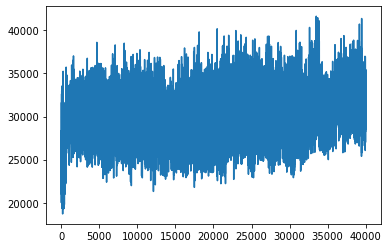

In [282]:
plt.plot(TrainingPortfolio)

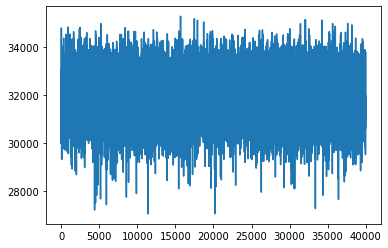

In [283]:
plt.plot(TestPortfolio)

In [284]:
np.mean(TestPortfolio)

31572.855658998127

In [285]:
np.mean(RandomPortfolio)

23193.331841624764